In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_id1 = '3901684'
float_id2 = '6901195'
float_id3 = '3901684'
data_source1="./dataset/PR_PF_"+float_id1+".csv"
data_source2="./dataset/PR_PF_"+float_id2+".csv"
data_source3="./dataset/PR_PF_"+float_id3+".csv"
df1= pd.read_csv(data_source1)
df2= pd.read_csv(data_source2)
df3= pd.read_csv(data_source3)
data=pd.concat([df1,df2,df3])
#data

In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

97.18535149849615


2.8146485015038536

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 5, 4])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'.csv') 
train2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'.csv') 
train3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'.csv') 
# test1=pd.read_csv('./randomtest/PR_PF_'+float_id1+'.csv')
test2=pd.read_csv('./randomtest/PR_PF_'+float_id2+'.csv')
# test3=pd.read_csv('./randomtest/PR_PF_'+float_id3+'.csv') 

train_set=pd.concat([train1,train2,train3])

# test_set=pd.concat([test1,test2,test3])
test_set=test2


len(train_set),len(test_set)

(215744, 2555)

In [11]:
comp_ratio(train_set)
comp_ratio(test_set)

97.18601676060517
83.95303326810176


83.95303326810176

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=test_set.iloc[:,0:y-2]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

2555 2555


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 1000
#n_initial = 1000
N_QUERIES = 200 #200

In [19]:
def random_split_df(df, x):
    n = len(df)

    indices = np.random.choice(n, x, replace=False)

    selected_df = df.iloc[indices]
    unselected_df = df.drop(indices)

    return selected_df, unselected_df


In [20]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)

X_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_initial.csv')
X_initial1,X_u1=random_split_df(X_initial1, 33)
X_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_initial.csv')
X_initial2,X_u2=random_split_df(X_initial2, 33)
X_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_initial.csv')
X_initial3,X_u3=random_split_df(X_initial3, 34)

X_initial=pd.concat([X_initial1,X_initial2,X_initial3])

X_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_re.csv')
X_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_re.csv')
X_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_re.csv')
X_re=pd.concat([X_u1,X_re1,X_u2,X_re2,X_re3,X_u3])
X_initial=X_initial.values
X_re=X_re.values

In [21]:
y_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_initial.csv')
y_initial1,y_u1=random_split_df(y_initial1, 33)
y_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_initial.csv')
y_initial2,y_u2=random_split_df(y_initial2, 33)
y_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_initial.csv')
y_initial3,y_u3=random_split_df(y_initial3, 34)
y_initial=pd.concat([y_initial1,y_initial2,y_initial3])
y_initial=y_initial.values.ravel()


y_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_re.csv')
y_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_re.csv')
y_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_re.csv')
y_re=pd.concat([y_u1,y_re1,y_u2,y_re2,y_u3,y_re3])
y_re=y_re.values.ravel()


# X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
# y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(215644, 6) (100, 6)
(215644,) (100,)


In [22]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [23]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [24]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [25]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 0.9992172211350293
precision: 0.9985473875717779
recall: 0.9985473875717779
cm: [[2144    1]
 [   1  409]]
f1: 0.9985473875717779
balanced acc: 0.9985473875717779
MCC: 0.9970947751435556
Kappa: 0.9970947751435556


0.9985473875717779

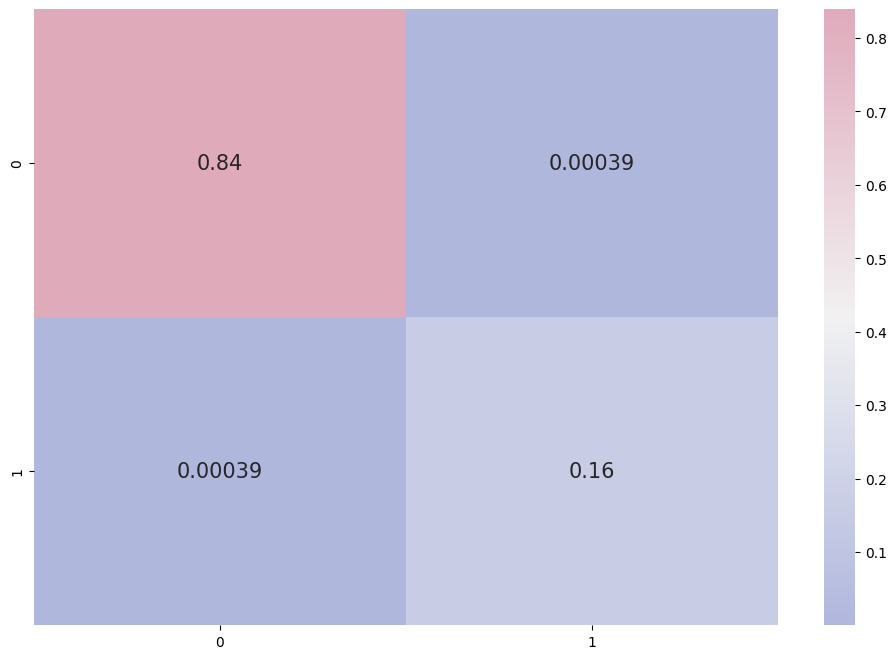

In [26]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

0.9987745098039215
acc: 0.9996086105675147
precision: 0.999767008387698
recall: 0.998780487804878
cm: [[2145    0]
 [   1  409]]
f1: 0.9992729764344772
balanced acc: 0.998780487804878
MCC: 0.9985470088731939
Kappa: 0.9985459532827026


0.9992729764344772

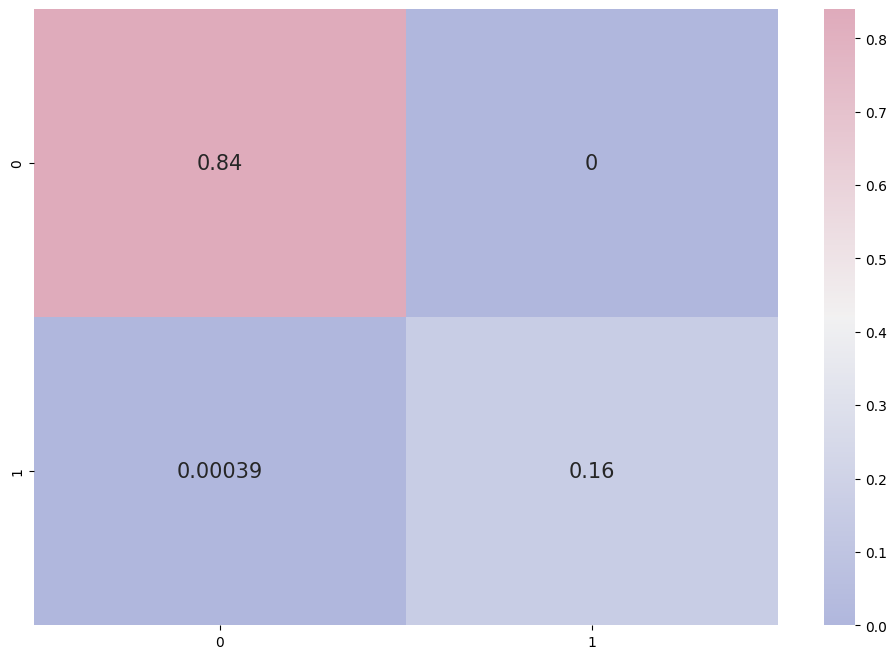

In [27]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

0.9987745098039215
acc: 0.9996086105675147
precision: 0.999767008387698
recall: 0.998780487804878
cm: [[2145    0]
 [   1  409]]
f1: 0.9992729764344772
balanced acc: 0.998780487804878
MCC: 0.9985470088731939
Kappa: 0.9985459532827026


0.9992729764344772

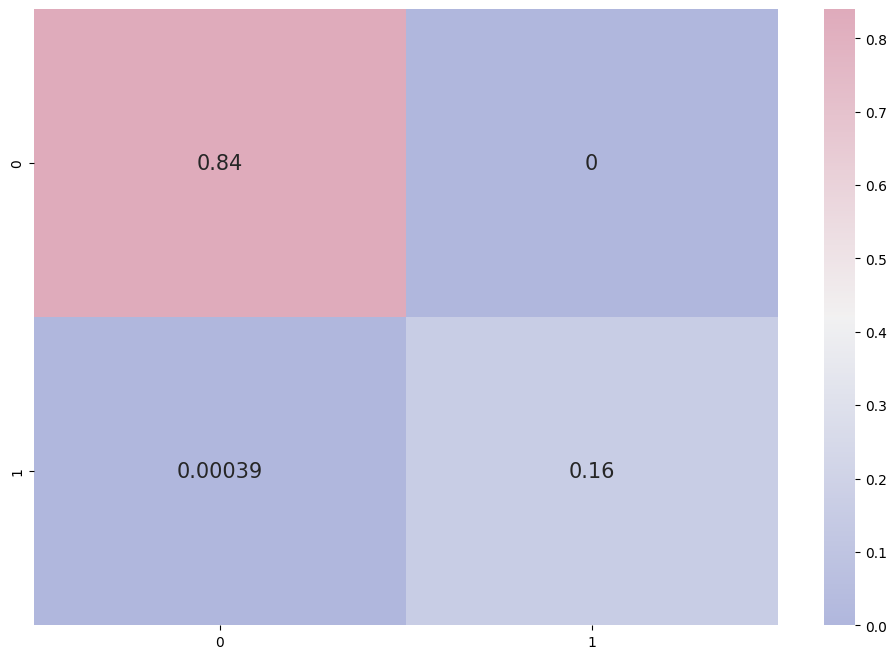

In [28]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.102218
0:	learn: 0.3815356	total: 75.9ms	remaining: 1m 15s
1:	learn: 0.2015712	total: 91.3ms	remaining: 45.6s
2:	learn: 0.1101120	total: 106ms	remaining: 35.1s
3:	learn: 0.0657918	total: 120ms	remaining: 29.9s
4:	learn: 0.0406650	total: 137ms	remaining: 27.2s
5:	learn: 0.0271018	total: 156ms	remaining: 25.8s
6:	learn: 0.0188649	total: 171ms	remaining: 24.2s
7:	learn: 0.0120827	total: 187ms	remaining: 23.2s
8:	learn: 0.0094785	total: 207ms	remaining: 22.8s
9:	learn: 0.0077849	total: 224ms	remaining: 22.2s
10:	learn: 0.0066212	total: 240ms	remaining: 21.6s
11:	learn: 0.0059398	total: 255ms	remaining: 21s
12:	learn: 0.0054701	total: 271ms	remaining: 20.5s
13:	learn: 0.0049973	total: 285ms	remaining: 20.1s
14:	learn: 0.0045581	total: 301ms	remaining: 19.7s
15:	learn: 0.0043921	total: 315ms	remaining: 19.4s
16:	learn: 0.0042423	total: 329ms	remaining: 19s
17:	learn: 0.0040592	total: 343ms	remaining: 18.7s
18:	learn: 0.0038632	total: 356ms	remaining: 18.4s
19:	learn: 0

167:	learn: 0.0008059	total: 2.45s	remaining: 12.1s
168:	learn: 0.0008059	total: 2.47s	remaining: 12.1s
169:	learn: 0.0008059	total: 2.48s	remaining: 12.1s
170:	learn: 0.0008059	total: 2.49s	remaining: 12.1s
171:	learn: 0.0008059	total: 2.5s	remaining: 12.1s
172:	learn: 0.0008059	total: 2.52s	remaining: 12s
173:	learn: 0.0008059	total: 2.53s	remaining: 12s
174:	learn: 0.0008059	total: 2.54s	remaining: 12s
175:	learn: 0.0008059	total: 2.55s	remaining: 11.9s
176:	learn: 0.0008059	total: 2.56s	remaining: 11.9s
177:	learn: 0.0008059	total: 2.57s	remaining: 11.9s
178:	learn: 0.0008059	total: 2.58s	remaining: 11.9s
179:	learn: 0.0008059	total: 2.6s	remaining: 11.8s
180:	learn: 0.0008059	total: 2.61s	remaining: 11.8s
181:	learn: 0.0008059	total: 2.62s	remaining: 11.8s
182:	learn: 0.0008059	total: 2.63s	remaining: 11.8s
183:	learn: 0.0008059	total: 2.64s	remaining: 11.7s
184:	learn: 0.0008059	total: 2.66s	remaining: 11.7s
185:	learn: 0.0008059	total: 2.67s	remaining: 11.7s
186:	learn: 0.000805

326:	learn: 0.0008059	total: 4.29s	remaining: 8.84s
327:	learn: 0.0008059	total: 4.31s	remaining: 8.83s
328:	learn: 0.0008059	total: 4.32s	remaining: 8.81s
329:	learn: 0.0008059	total: 4.33s	remaining: 8.79s
330:	learn: 0.0008059	total: 4.34s	remaining: 8.78s
331:	learn: 0.0008059	total: 4.35s	remaining: 8.76s
332:	learn: 0.0008059	total: 4.36s	remaining: 8.74s
333:	learn: 0.0008059	total: 4.38s	remaining: 8.73s
334:	learn: 0.0008059	total: 4.39s	remaining: 8.71s
335:	learn: 0.0008059	total: 4.4s	remaining: 8.69s
336:	learn: 0.0008059	total: 4.41s	remaining: 8.68s
337:	learn: 0.0008059	total: 4.42s	remaining: 8.66s
338:	learn: 0.0008059	total: 4.43s	remaining: 8.64s
339:	learn: 0.0008059	total: 4.44s	remaining: 8.62s
340:	learn: 0.0008059	total: 4.45s	remaining: 8.61s
341:	learn: 0.0008059	total: 4.46s	remaining: 8.59s
342:	learn: 0.0008059	total: 4.48s	remaining: 8.57s
343:	learn: 0.0008059	total: 4.49s	remaining: 8.56s
344:	learn: 0.0008059	total: 4.5s	remaining: 8.54s
345:	learn: 0.

487:	learn: 0.0008059	total: 6.13s	remaining: 6.43s
488:	learn: 0.0008059	total: 6.15s	remaining: 6.42s
489:	learn: 0.0008059	total: 6.16s	remaining: 6.41s
490:	learn: 0.0008059	total: 6.17s	remaining: 6.39s
491:	learn: 0.0008059	total: 6.18s	remaining: 6.38s
492:	learn: 0.0008059	total: 6.19s	remaining: 6.37s
493:	learn: 0.0008059	total: 6.2s	remaining: 6.35s
494:	learn: 0.0008059	total: 6.21s	remaining: 6.34s
495:	learn: 0.0008059	total: 6.22s	remaining: 6.33s
496:	learn: 0.0008059	total: 6.24s	remaining: 6.31s
497:	learn: 0.0008059	total: 6.25s	remaining: 6.3s
498:	learn: 0.0008059	total: 6.26s	remaining: 6.28s
499:	learn: 0.0008059	total: 6.27s	remaining: 6.27s
500:	learn: 0.0008059	total: 6.28s	remaining: 6.25s
501:	learn: 0.0008059	total: 6.29s	remaining: 6.24s
502:	learn: 0.0008059	total: 6.3s	remaining: 6.23s
503:	learn: 0.0008059	total: 6.32s	remaining: 6.21s
504:	learn: 0.0008059	total: 6.33s	remaining: 6.2s
505:	learn: 0.0008059	total: 6.34s	remaining: 6.19s
506:	learn: 0.00

648:	learn: 0.0008059	total: 7.97s	remaining: 4.31s
649:	learn: 0.0008059	total: 7.98s	remaining: 4.3s
650:	learn: 0.0008059	total: 7.99s	remaining: 4.29s
651:	learn: 0.0008059	total: 8.01s	remaining: 4.27s
652:	learn: 0.0008059	total: 8.02s	remaining: 4.26s
653:	learn: 0.0008059	total: 8.03s	remaining: 4.25s
654:	learn: 0.0008059	total: 8.04s	remaining: 4.23s
655:	learn: 0.0008059	total: 8.05s	remaining: 4.22s
656:	learn: 0.0008059	total: 8.06s	remaining: 4.21s
657:	learn: 0.0008059	total: 8.07s	remaining: 4.2s
658:	learn: 0.0008059	total: 8.09s	remaining: 4.18s
659:	learn: 0.0008059	total: 8.1s	remaining: 4.17s
660:	learn: 0.0008059	total: 8.11s	remaining: 4.16s
661:	learn: 0.0008059	total: 8.12s	remaining: 4.14s
662:	learn: 0.0008059	total: 8.13s	remaining: 4.13s
663:	learn: 0.0008059	total: 8.14s	remaining: 4.12s
664:	learn: 0.0008059	total: 8.15s	remaining: 4.11s
665:	learn: 0.0008059	total: 8.16s	remaining: 4.09s
666:	learn: 0.0008059	total: 8.18s	remaining: 4.08s
667:	learn: 0.0

824:	learn: 0.0008059	total: 10s	remaining: 2.13s
825:	learn: 0.0008059	total: 10s	remaining: 2.12s
826:	learn: 0.0008059	total: 10.1s	remaining: 2.1s
827:	learn: 0.0008059	total: 10.1s	remaining: 2.09s
828:	learn: 0.0008059	total: 10.1s	remaining: 2.08s
829:	learn: 0.0008059	total: 10.1s	remaining: 2.07s
830:	learn: 0.0008059	total: 10.1s	remaining: 2.06s
831:	learn: 0.0008059	total: 10.1s	remaining: 2.04s
832:	learn: 0.0008059	total: 10.1s	remaining: 2.03s
833:	learn: 0.0008059	total: 10.1s	remaining: 2.02s
834:	learn: 0.0008059	total: 10.2s	remaining: 2.01s
835:	learn: 0.0008059	total: 10.2s	remaining: 1.99s
836:	learn: 0.0008059	total: 10.2s	remaining: 1.98s
837:	learn: 0.0008059	total: 10.2s	remaining: 1.97s
838:	learn: 0.0008059	total: 10.2s	remaining: 1.96s
839:	learn: 0.0008059	total: 10.2s	remaining: 1.95s
840:	learn: 0.0008059	total: 10.2s	remaining: 1.93s
841:	learn: 0.0008059	total: 10.2s	remaining: 1.92s
842:	learn: 0.0008059	total: 10.2s	remaining: 1.91s
843:	learn: 0.000

998:	learn: 0.0008059	total: 12.1s	remaining: 12.1ms
999:	learn: 0.0008059	total: 12.1s	remaining: 0us
acc: 0.9996086105675147
precision: 0.999767008387698
recall: 0.998780487804878
cm: [[2145    0]
 [   1  409]]
f1: 0.9992729764344772
balanced acc: 0.998780487804878
MCC: 0.9985470088731939
Kappa: 0.9985459532827026


0.9992729764344772

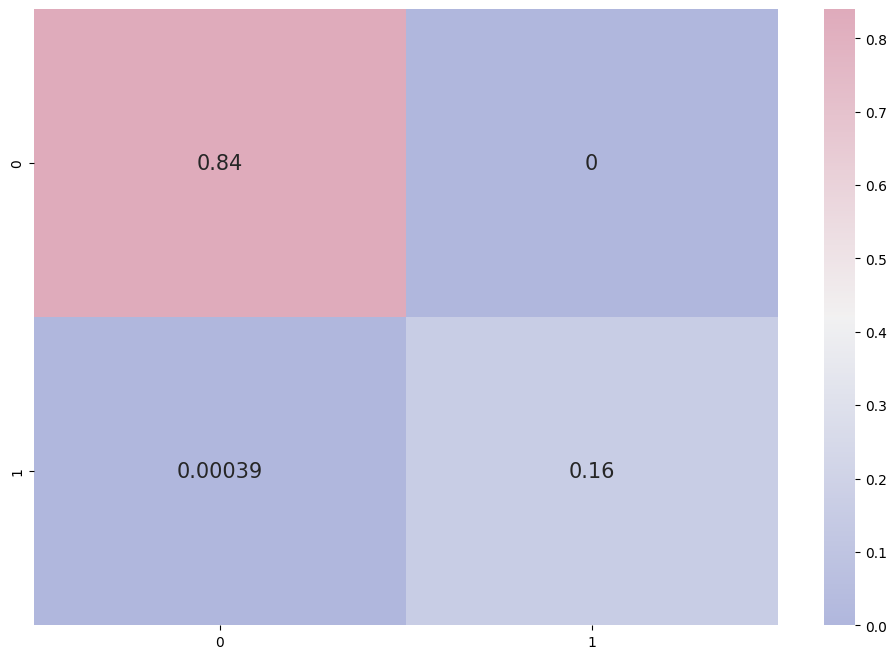

In [29]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [30]:
sampling=random_sampling

In [31]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
instance01.to_csv("./query/random_Knn_"+"mix_sit2"+".csv")

1 --------------------> -0.0651848446832215
1 --------------------> 0.07898448519040903
2 --------------------> -0.0651848446832215
2 --------------------> 0.07898448519040903
3 --------------------> -0.0651848446832215
3 --------------------> 0.07898448519040903
4 --------------------> -0.0651848446832215
4 --------------------> 0.07898448519040903
5 --------------------> -0.0651848446832215
5 --------------------> 0.07898448519040903
6 --------------------> -0.0651848446832215
6 --------------------> 0.07898448519040903
7 --------------------> -0.0651848446832215
7 --------------------> 0.07898448519040903
8 --------------------> -0.0651848446832215
8 --------------------> 0.07898448519040903
9 --------------------> -0.0651848446832215
9 --------------------> 0.07898448519040903
10 --------------------> -0.0651848446832215
10 --------------------> 0.07898448519040903
11 --------------------> -0.0651848446832215
11 --------------------> 0.07898448519040903
12 --------------------> -0.

93 --------------------> -0.06200093940817286
93 --------------------> 0.07977207977207977
94 --------------------> -0.06200093940817286
94 --------------------> 0.07977207977207977
95 --------------------> -0.06200093940817286
95 --------------------> 0.07977207977207977
96 --------------------> -0.06200093940817286
96 --------------------> 0.07977207977207977
97 --------------------> -0.06200093940817286
97 --------------------> 0.07977207977207977
98 --------------------> -0.06200093940817286
98 --------------------> 0.07977207977207977
99 --------------------> -0.06200093940817286
99 --------------------> 0.07977207977207977
100 --------------------> -0.06200093940817286
100 --------------------> 0.07977207977207977
101 --------------------> -0.06200093940817286
101 --------------------> 0.07977207977207977
102 --------------------> -0.06200093940817286
102 --------------------> 0.07977207977207977
103 --------------------> -0.06200093940817286
103 --------------------> 0.079772079

182 --------------------> -0.05969608442602525
182 --------------------> 0.08034433285509326
183 --------------------> -0.05969608442602525
183 --------------------> 0.08034433285509326
184 --------------------> -0.05969608442602525
184 --------------------> 0.08034433285509326
185 --------------------> -0.05969608442602525
185 --------------------> 0.08034433285509326
186 --------------------> -0.05969608442602525
186 --------------------> 0.08034433285509326
187 --------------------> -0.05969608442602525
187 --------------------> 0.08034433285509326
188 --------------------> -0.05969608442602525
188 --------------------> 0.08034433285509326
189 --------------------> -0.05969608442602525
189 --------------------> 0.08034433285509326
190 --------------------> -0.05923200497486647
190 --------------------> 0.08045977011494253
191 --------------------> -0.05923200497486647
191 --------------------> 0.08045977011494253
192 --------------------> -0.05923200497486647
192 -------------------

In [32]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
instance02.to_csv("./query/random_Lg_"+"mix_sit2"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 ------

In [33]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
instance03.to_csv("./query/random_XB_"+"mix_sit2"+".csv")

1 --------------------> -0.03095421961485134
1 --------------------> 0.03853564547206166
2 --------------------> -0.02541520824033472
2 --------------------> 0.03219315895372233
3 --------------------> -0.05832513964143016
3 --------------------> 0.0
4 --------------------> -0.06012180998641936
4 --------------------> 0.0
5 --------------------> 0.08408931351900428
5 --------------------> 0.15526802218114602
6 --------------------> 0.033611085515201866
6 --------------------> 0.06911447084233262
7 --------------------> -0.04593540602848334
7 --------------------> 0.0
8 --------------------> -0.04336799941043101
8 --------------------> 0.0
9 --------------------> -0.04142207667787279
9 --------------------> 0.0
10 --------------------> -0.04272131289888437
10 --------------------> 0.0
11 --------------------> 0.054266261370901736
11 --------------------> 0.14211438474870017
12 --------------------> -0.0361456404831173
12 --------------------> 0.0
13 --------------------> 0.0200906747266

93 --------------------> -0.00813132545568096
93 --------------------> 0.05168986083499006
94 --------------------> 0.010299652193059394
94 --------------------> 0.07407407407407407
95 --------------------> -0.03305134440238988
95 --------------------> 0.03143418467583497
96 --------------------> -0.04860816962688497
96 --------------------> 0.015779092702169626
97 --------------------> -0.024003093771148842
97 --------------------> 0.012987012987012986
98 --------------------> -0.003494063127229774
98 --------------------> 0.03821656050955414
99 --------------------> -0.012751320584742709
99 --------------------> 0.050980392156862744
100 --------------------> -0.016098641080189324
100 --------------------> 0.025531914893617023
101 --------------------> 0.008168762406087882
101 --------------------> 0.04338394793926248
102 --------------------> 0.04528777221696201
102 --------------------> 0.09426229508196722
103 --------------------> 0.006408088732584916
103 --------------------> 0.05

183 --------------------> 0.09346934249916838
183 --------------------> 0.13692946058091285
184 --------------------> 0.0394655877270621
184 --------------------> 0.08979591836734695
185 --------------------> 0.11391524281817089
185 --------------------> 0.20033955857385397
186 --------------------> 0.2525014140547288
186 --------------------> 0.3119266055045872
187 --------------------> -0.013884857473449141
187 --------------------> 0.060263653483992465
188 --------------------> 0.13959895913056786
188 --------------------> 0.1818181818181818
189 --------------------> 0.08673018563906143
189 --------------------> 0.15180265654648956
190 --------------------> 0.04627422803266634
190 --------------------> 0.08189655172413793
191 --------------------> 0.02684522717544191
191 --------------------> 0.06437768240343347
192 --------------------> 0.31443200175232044
192 --------------------> 0.3683241252302026
193 --------------------> 0.148730020855101
193 --------------------> 0.1947261663

In [34]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
instance04.to_csv("./query/random_CB_"+"mix_sit2"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6884294	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6839975	total: 3.5ms	remaining: 1.75s
2:	learn: 0.6794970	total: 4.71ms	remaining: 1.56s
3:	learn: 0.6749312	total: 5.74ms	remaining: 1.43s
4:	learn: 0.6699579	total: 6.68ms	remaining: 1.33s
5:	learn: 0.6653092	total: 7.91ms	remaining: 1.31s
6:	learn: 0.6606745	total: 8.96ms	remaining: 1.27s
7:	learn: 0.6564432	total: 9.84ms	remaining: 1.22s
8:	learn: 0.6527937	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6485480	total: 11.4ms	remaining: 1.13s
10:	learn: 0.6448309	total: 12.2ms	remaining: 1.1s
11:	learn: 0.6411629	total: 13.1ms	remaining: 1.08s
12:	learn: 0.6378059	total: 14.2ms	remaining: 1.07s
13:	learn: 0.6336671	total: 15.4ms	remaining: 1.08s
14:	learn: 0.6298471	total: 16.6ms	remaining: 1.09s
15:	learn: 0.6248435	total: 17.6ms	remaining: 1.08s
16:	learn: 0.6210666	total: 18.4ms	remaining: 1.06s
17:	learn: 0.6173867	total: 19.3ms	remaining: 1.05s
18:	learn: 0.6137294	total: 20.2ms	remaining: 

192:	learn: 0.2535696	total: 158ms	remaining: 660ms
193:	learn: 0.2527857	total: 159ms	remaining: 662ms
194:	learn: 0.2517055	total: 160ms	remaining: 662ms
195:	learn: 0.2508907	total: 161ms	remaining: 661ms
196:	learn: 0.2498391	total: 162ms	remaining: 660ms
197:	learn: 0.2492030	total: 163ms	remaining: 659ms
198:	learn: 0.2484983	total: 163ms	remaining: 657ms
199:	learn: 0.2477501	total: 164ms	remaining: 656ms
200:	learn: 0.2468730	total: 165ms	remaining: 656ms
201:	learn: 0.2461472	total: 166ms	remaining: 654ms
202:	learn: 0.2452034	total: 166ms	remaining: 653ms
203:	learn: 0.2444711	total: 167ms	remaining: 652ms
204:	learn: 0.2437363	total: 168ms	remaining: 652ms
205:	learn: 0.2425912	total: 169ms	remaining: 651ms
206:	learn: 0.2415515	total: 170ms	remaining: 650ms
207:	learn: 0.2409252	total: 171ms	remaining: 649ms
208:	learn: 0.2397626	total: 172ms	remaining: 650ms
209:	learn: 0.2389077	total: 173ms	remaining: 650ms
210:	learn: 0.2378930	total: 174ms	remaining: 650ms
211:	learn: 

418:	learn: 0.1283447	total: 339ms	remaining: 469ms
419:	learn: 0.1280299	total: 340ms	remaining: 469ms
420:	learn: 0.1277284	total: 341ms	remaining: 468ms
421:	learn: 0.1272746	total: 341ms	remaining: 468ms
422:	learn: 0.1269858	total: 342ms	remaining: 467ms
423:	learn: 0.1267150	total: 343ms	remaining: 466ms
424:	learn: 0.1262924	total: 343ms	remaining: 465ms
425:	learn: 0.1259918	total: 344ms	remaining: 464ms
426:	learn: 0.1257266	total: 345ms	remaining: 463ms
427:	learn: 0.1252487	total: 346ms	remaining: 462ms
428:	learn: 0.1249600	total: 346ms	remaining: 461ms
429:	learn: 0.1247498	total: 347ms	remaining: 460ms
430:	learn: 0.1243768	total: 348ms	remaining: 459ms
431:	learn: 0.1241113	total: 349ms	remaining: 458ms
432:	learn: 0.1237238	total: 349ms	remaining: 458ms
433:	learn: 0.1234723	total: 350ms	remaining: 457ms
434:	learn: 0.1230745	total: 351ms	remaining: 456ms
435:	learn: 0.1228325	total: 352ms	remaining: 455ms
436:	learn: 0.1225115	total: 352ms	remaining: 454ms
437:	learn: 

666:	learn: 0.0748715	total: 520ms	remaining: 259ms
667:	learn: 0.0747808	total: 520ms	remaining: 259ms
668:	learn: 0.0746011	total: 521ms	remaining: 258ms
669:	learn: 0.0744680	total: 522ms	remaining: 257ms
670:	learn: 0.0743897	total: 523ms	remaining: 256ms
671:	learn: 0.0742674	total: 524ms	remaining: 256ms
672:	learn: 0.0741475	total: 524ms	remaining: 255ms
673:	learn: 0.0739853	total: 525ms	remaining: 254ms
674:	learn: 0.0737925	total: 526ms	remaining: 253ms
675:	learn: 0.0737096	total: 527ms	remaining: 252ms
676:	learn: 0.0736334	total: 527ms	remaining: 252ms
677:	learn: 0.0735021	total: 528ms	remaining: 251ms
678:	learn: 0.0733215	total: 529ms	remaining: 250ms
679:	learn: 0.0732503	total: 530ms	remaining: 249ms
680:	learn: 0.0730910	total: 530ms	remaining: 248ms
681:	learn: 0.0729999	total: 531ms	remaining: 248ms
682:	learn: 0.0728725	total: 532ms	remaining: 247ms
683:	learn: 0.0727823	total: 533ms	remaining: 246ms
684:	learn: 0.0726779	total: 534ms	remaining: 246ms
685:	learn: 

916:	learn: 0.0483737	total: 700ms	remaining: 63.4ms
917:	learn: 0.0483020	total: 701ms	remaining: 62.6ms
918:	learn: 0.0482373	total: 702ms	remaining: 61.9ms
919:	learn: 0.0481328	total: 703ms	remaining: 61.1ms
920:	learn: 0.0480947	total: 704ms	remaining: 60.4ms
921:	learn: 0.0480399	total: 704ms	remaining: 59.6ms
922:	learn: 0.0479881	total: 705ms	remaining: 58.8ms
923:	learn: 0.0478880	total: 706ms	remaining: 58ms
924:	learn: 0.0477974	total: 707ms	remaining: 57.3ms
925:	learn: 0.0477122	total: 707ms	remaining: 56.5ms
926:	learn: 0.0476247	total: 708ms	remaining: 55.8ms
927:	learn: 0.0475591	total: 709ms	remaining: 55ms
928:	learn: 0.0474898	total: 710ms	remaining: 54.2ms
929:	learn: 0.0473727	total: 710ms	remaining: 53.5ms
930:	learn: 0.0473304	total: 711ms	remaining: 52.7ms
931:	learn: 0.0472628	total: 712ms	remaining: 51.9ms
932:	learn: 0.0471524	total: 713ms	remaining: 51.2ms
933:	learn: 0.0470477	total: 713ms	remaining: 50.4ms
934:	learn: 0.0470012	total: 714ms	remaining: 49.7

95:	learn: 0.3908868	total: 73ms	remaining: 687ms
96:	learn: 0.3890260	total: 74.2ms	remaining: 691ms
97:	learn: 0.3869928	total: 75.3ms	remaining: 693ms
98:	learn: 0.3850198	total: 76.3ms	remaining: 695ms
99:	learn: 0.3834810	total: 77ms	remaining: 693ms
100:	learn: 0.3815955	total: 77.8ms	remaining: 693ms
101:	learn: 0.3798965	total: 78.5ms	remaining: 691ms
102:	learn: 0.3774697	total: 79.4ms	remaining: 692ms
103:	learn: 0.3758999	total: 80.1ms	remaining: 690ms
104:	learn: 0.3742325	total: 80.7ms	remaining: 688ms
105:	learn: 0.3721371	total: 81.4ms	remaining: 687ms
106:	learn: 0.3703871	total: 82.4ms	remaining: 688ms
107:	learn: 0.3682326	total: 83.2ms	remaining: 687ms
108:	learn: 0.3662415	total: 84ms	remaining: 687ms
109:	learn: 0.3644047	total: 85.3ms	remaining: 691ms
110:	learn: 0.3628038	total: 86ms	remaining: 689ms
111:	learn: 0.3610876	total: 86.7ms	remaining: 687ms
112:	learn: 0.3594417	total: 87.4ms	remaining: 686ms
113:	learn: 0.3573989	total: 88.1ms	remaining: 685ms
114:	l

336:	learn: 0.1596756	total: 255ms	remaining: 501ms
337:	learn: 0.1592240	total: 256ms	remaining: 501ms
338:	learn: 0.1586842	total: 257ms	remaining: 500ms
339:	learn: 0.1582089	total: 257ms	remaining: 500ms
340:	learn: 0.1578059	total: 258ms	remaining: 499ms
341:	learn: 0.1572863	total: 259ms	remaining: 498ms
342:	learn: 0.1569332	total: 260ms	remaining: 497ms
343:	learn: 0.1563468	total: 260ms	remaining: 496ms
344:	learn: 0.1558283	total: 261ms	remaining: 496ms
345:	learn: 0.1552584	total: 262ms	remaining: 495ms
346:	learn: 0.1549071	total: 263ms	remaining: 494ms
347:	learn: 0.1546368	total: 263ms	remaining: 493ms
348:	learn: 0.1541420	total: 264ms	remaining: 493ms
349:	learn: 0.1536319	total: 265ms	remaining: 492ms
350:	learn: 0.1531868	total: 266ms	remaining: 491ms
351:	learn: 0.1525489	total: 266ms	remaining: 490ms
352:	learn: 0.1522789	total: 267ms	remaining: 489ms
353:	learn: 0.1518731	total: 268ms	remaining: 489ms
354:	learn: 0.1516016	total: 269ms	remaining: 488ms
355:	learn: 

584:	learn: 0.0856187	total: 437ms	remaining: 310ms
585:	learn: 0.0854572	total: 438ms	remaining: 309ms
586:	learn: 0.0853180	total: 439ms	remaining: 309ms
587:	learn: 0.0851441	total: 440ms	remaining: 308ms
588:	learn: 0.0849597	total: 440ms	remaining: 307ms
589:	learn: 0.0848046	total: 441ms	remaining: 306ms
590:	learn: 0.0845545	total: 442ms	remaining: 306ms
591:	learn: 0.0844354	total: 442ms	remaining: 305ms
592:	learn: 0.0842795	total: 443ms	remaining: 304ms
593:	learn: 0.0841165	total: 444ms	remaining: 303ms
594:	learn: 0.0839931	total: 444ms	remaining: 303ms
595:	learn: 0.0838180	total: 445ms	remaining: 302ms
596:	learn: 0.0836542	total: 446ms	remaining: 301ms
597:	learn: 0.0834585	total: 447ms	remaining: 300ms
598:	learn: 0.0833451	total: 448ms	remaining: 300ms
599:	learn: 0.0831386	total: 448ms	remaining: 299ms
600:	learn: 0.0829925	total: 449ms	remaining: 298ms
601:	learn: 0.0828016	total: 450ms	remaining: 297ms
602:	learn: 0.0825951	total: 450ms	remaining: 297ms
603:	learn: 

836:	learn: 0.0537864	total: 618ms	remaining: 120ms
837:	learn: 0.0536802	total: 619ms	remaining: 120ms
838:	learn: 0.0536085	total: 620ms	remaining: 119ms
839:	learn: 0.0535405	total: 621ms	remaining: 118ms
840:	learn: 0.0534129	total: 622ms	remaining: 118ms
841:	learn: 0.0533034	total: 622ms	remaining: 117ms
842:	learn: 0.0531908	total: 623ms	remaining: 116ms
843:	learn: 0.0531093	total: 624ms	remaining: 115ms
844:	learn: 0.0530344	total: 625ms	remaining: 115ms
845:	learn: 0.0529441	total: 625ms	remaining: 114ms
846:	learn: 0.0528572	total: 626ms	remaining: 113ms
847:	learn: 0.0527809	total: 627ms	remaining: 112ms
848:	learn: 0.0526833	total: 628ms	remaining: 112ms
849:	learn: 0.0526114	total: 628ms	remaining: 111ms
850:	learn: 0.0525036	total: 629ms	remaining: 110ms
851:	learn: 0.0523719	total: 630ms	remaining: 109ms
852:	learn: 0.0522700	total: 631ms	remaining: 109ms
853:	learn: 0.0522138	total: 631ms	remaining: 108ms
854:	learn: 0.0521085	total: 632ms	remaining: 107ms
855:	learn: 

18:	learn: 0.6110994	total: 14.3ms	remaining: 736ms
19:	learn: 0.6070915	total: 15.6ms	remaining: 764ms
20:	learn: 0.6028436	total: 16.4ms	remaining: 762ms
21:	learn: 0.5993997	total: 17.1ms	remaining: 761ms
22:	learn: 0.5955454	total: 17.8ms	remaining: 758ms
23:	learn: 0.5918407	total: 18.5ms	remaining: 754ms
24:	learn: 0.5884090	total: 19.2ms	remaining: 751ms
25:	learn: 0.5849229	total: 19.9ms	remaining: 747ms
26:	learn: 0.5817006	total: 20.7ms	remaining: 745ms
27:	learn: 0.5775189	total: 21.4ms	remaining: 741ms
28:	learn: 0.5739753	total: 22.1ms	remaining: 741ms
29:	learn: 0.5702031	total: 22.9ms	remaining: 741ms
30:	learn: 0.5670182	total: 23.6ms	remaining: 739ms
31:	learn: 0.5637069	total: 24.4ms	remaining: 738ms
32:	learn: 0.5602524	total: 25.1ms	remaining: 735ms
33:	learn: 0.5567940	total: 25.9ms	remaining: 735ms
34:	learn: 0.5532418	total: 26.7ms	remaining: 735ms
35:	learn: 0.5501393	total: 27.3ms	remaining: 731ms
36:	learn: 0.5465025	total: 28ms	remaining: 730ms
37:	learn: 0.5

265:	learn: 0.1933773	total: 196ms	remaining: 540ms
266:	learn: 0.1928525	total: 197ms	remaining: 540ms
267:	learn: 0.1923279	total: 197ms	remaining: 539ms
268:	learn: 0.1915787	total: 198ms	remaining: 539ms
269:	learn: 0.1909635	total: 199ms	remaining: 538ms
270:	learn: 0.1904556	total: 200ms	remaining: 537ms
271:	learn: 0.1897280	total: 200ms	remaining: 536ms
272:	learn: 0.1892980	total: 201ms	remaining: 536ms
273:	learn: 0.1888140	total: 202ms	remaining: 535ms
274:	learn: 0.1881590	total: 203ms	remaining: 534ms
275:	learn: 0.1874304	total: 203ms	remaining: 534ms
276:	learn: 0.1866068	total: 204ms	remaining: 533ms
277:	learn: 0.1859851	total: 205ms	remaining: 532ms
278:	learn: 0.1854510	total: 206ms	remaining: 531ms
279:	learn: 0.1846706	total: 206ms	remaining: 531ms
280:	learn: 0.1840494	total: 207ms	remaining: 530ms
281:	learn: 0.1834151	total: 208ms	remaining: 529ms
282:	learn: 0.1828537	total: 209ms	remaining: 529ms
283:	learn: 0.1823406	total: 210ms	remaining: 529ms
284:	learn: 

520:	learn: 0.0983162	total: 377ms	remaining: 347ms
521:	learn: 0.0981854	total: 378ms	remaining: 346ms
522:	learn: 0.0978684	total: 379ms	remaining: 346ms
523:	learn: 0.0976086	total: 380ms	remaining: 345ms
524:	learn: 0.0974499	total: 381ms	remaining: 344ms
525:	learn: 0.0971836	total: 381ms	remaining: 344ms
526:	learn: 0.0969645	total: 382ms	remaining: 343ms
527:	learn: 0.0967698	total: 383ms	remaining: 342ms
528:	learn: 0.0965211	total: 384ms	remaining: 341ms
529:	learn: 0.0963343	total: 384ms	remaining: 341ms
530:	learn: 0.0961938	total: 385ms	remaining: 340ms
531:	learn: 0.0959903	total: 386ms	remaining: 339ms
532:	learn: 0.0957234	total: 386ms	remaining: 339ms
533:	learn: 0.0953792	total: 387ms	remaining: 338ms
534:	learn: 0.0951318	total: 388ms	remaining: 337ms
535:	learn: 0.0947757	total: 389ms	remaining: 336ms
536:	learn: 0.0945719	total: 389ms	remaining: 336ms
537:	learn: 0.0944014	total: 390ms	remaining: 335ms
538:	learn: 0.0941705	total: 391ms	remaining: 334ms
539:	learn: 

771:	learn: 0.0589388	total: 559ms	remaining: 165ms
772:	learn: 0.0588565	total: 560ms	remaining: 164ms
773:	learn: 0.0587518	total: 560ms	remaining: 164ms
774:	learn: 0.0586012	total: 561ms	remaining: 163ms
775:	learn: 0.0584854	total: 562ms	remaining: 162ms
776:	learn: 0.0583862	total: 563ms	remaining: 161ms
777:	learn: 0.0582419	total: 563ms	remaining: 161ms
778:	learn: 0.0580654	total: 564ms	remaining: 160ms
779:	learn: 0.0579685	total: 565ms	remaining: 159ms
780:	learn: 0.0578581	total: 566ms	remaining: 159ms
781:	learn: 0.0577577	total: 566ms	remaining: 158ms
782:	learn: 0.0576695	total: 567ms	remaining: 157ms
783:	learn: 0.0576100	total: 568ms	remaining: 156ms
784:	learn: 0.0575140	total: 568ms	remaining: 156ms
785:	learn: 0.0574307	total: 569ms	remaining: 155ms
786:	learn: 0.0573158	total: 570ms	remaining: 154ms
787:	learn: 0.0572604	total: 571ms	remaining: 154ms
788:	learn: 0.0571265	total: 571ms	remaining: 153ms
789:	learn: 0.0570288	total: 572ms	remaining: 152ms
790:	learn: 

Learning rate set to 0.003903
0:	learn: 0.6884064	total: 923us	remaining: 922ms
1:	learn: 0.6838473	total: 1.72ms	remaining: 860ms
2:	learn: 0.6791178	total: 2.5ms	remaining: 832ms
3:	learn: 0.6745377	total: 3.19ms	remaining: 795ms
4:	learn: 0.6694470	total: 3.92ms	remaining: 780ms
5:	learn: 0.6646642	total: 4.72ms	remaining: 783ms
6:	learn: 0.6595354	total: 5.45ms	remaining: 773ms
7:	learn: 0.6550064	total: 6.17ms	remaining: 766ms
8:	learn: 0.6514041	total: 6.9ms	remaining: 760ms
9:	learn: 0.6471369	total: 7.79ms	remaining: 772ms
10:	learn: 0.6432392	total: 8.53ms	remaining: 767ms
11:	learn: 0.6393676	total: 9.23ms	remaining: 760ms
12:	learn: 0.6357246	total: 9.94ms	remaining: 755ms
13:	learn: 0.6315338	total: 10.7ms	remaining: 753ms
14:	learn: 0.6277100	total: 11.4ms	remaining: 747ms
15:	learn: 0.6226547	total: 12.2ms	remaining: 749ms
16:	learn: 0.6188361	total: 12.9ms	remaining: 749ms
17:	learn: 0.6150768	total: 13.7ms	remaining: 745ms
18:	learn: 0.6111940	total: 14.4ms	remaining: 7

252:	learn: 0.2020934	total: 181ms	remaining: 533ms
253:	learn: 0.2014615	total: 182ms	remaining: 534ms
254:	learn: 0.2008615	total: 183ms	remaining: 533ms
255:	learn: 0.2001135	total: 183ms	remaining: 533ms
256:	learn: 0.1996570	total: 184ms	remaining: 532ms
257:	learn: 0.1990932	total: 185ms	remaining: 532ms
258:	learn: 0.1984088	total: 186ms	remaining: 531ms
259:	learn: 0.1978942	total: 186ms	remaining: 530ms
260:	learn: 0.1971203	total: 187ms	remaining: 530ms
261:	learn: 0.1966148	total: 188ms	remaining: 529ms
262:	learn: 0.1959535	total: 189ms	remaining: 528ms
263:	learn: 0.1953470	total: 189ms	remaining: 528ms
264:	learn: 0.1947316	total: 190ms	remaining: 527ms
265:	learn: 0.1939906	total: 191ms	remaining: 526ms
266:	learn: 0.1934815	total: 191ms	remaining: 526ms
267:	learn: 0.1928421	total: 192ms	remaining: 525ms
268:	learn: 0.1921466	total: 193ms	remaining: 525ms
269:	learn: 0.1915237	total: 194ms	remaining: 524ms
270:	learn: 0.1910559	total: 195ms	remaining: 523ms
271:	learn: 

501:	learn: 0.1027525	total: 363ms	remaining: 360ms
502:	learn: 0.1023743	total: 364ms	remaining: 359ms
503:	learn: 0.1020837	total: 365ms	remaining: 359ms
504:	learn: 0.1017646	total: 366ms	remaining: 359ms
505:	learn: 0.1015112	total: 367ms	remaining: 358ms
506:	learn: 0.1013492	total: 367ms	remaining: 357ms
507:	learn: 0.1011582	total: 368ms	remaining: 357ms
508:	learn: 0.1008623	total: 369ms	remaining: 356ms
509:	learn: 0.1006169	total: 370ms	remaining: 355ms
510:	learn: 0.1003700	total: 371ms	remaining: 355ms
511:	learn: 0.1001554	total: 371ms	remaining: 354ms
512:	learn: 0.0999701	total: 372ms	remaining: 353ms
513:	learn: 0.0996770	total: 373ms	remaining: 353ms
514:	learn: 0.0994549	total: 374ms	remaining: 352ms
515:	learn: 0.0993017	total: 375ms	remaining: 351ms
516:	learn: 0.0990210	total: 375ms	remaining: 351ms
517:	learn: 0.0988662	total: 376ms	remaining: 350ms
518:	learn: 0.0986837	total: 377ms	remaining: 349ms
519:	learn: 0.0984078	total: 378ms	remaining: 349ms
520:	learn: 

713:	learn: 0.0653910	total: 545ms	remaining: 218ms
714:	learn: 0.0652252	total: 546ms	remaining: 218ms
715:	learn: 0.0650999	total: 546ms	remaining: 217ms
716:	learn: 0.0649853	total: 547ms	remaining: 216ms
717:	learn: 0.0648850	total: 548ms	remaining: 215ms
718:	learn: 0.0648299	total: 549ms	remaining: 214ms
719:	learn: 0.0647012	total: 549ms	remaining: 214ms
720:	learn: 0.0645996	total: 550ms	remaining: 213ms
721:	learn: 0.0645005	total: 551ms	remaining: 212ms
722:	learn: 0.0643663	total: 552ms	remaining: 211ms
723:	learn: 0.0642121	total: 552ms	remaining: 211ms
724:	learn: 0.0640551	total: 553ms	remaining: 210ms
725:	learn: 0.0639557	total: 554ms	remaining: 209ms
726:	learn: 0.0637509	total: 555ms	remaining: 208ms
727:	learn: 0.0636784	total: 556ms	remaining: 208ms
728:	learn: 0.0634805	total: 556ms	remaining: 207ms
729:	learn: 0.0633681	total: 557ms	remaining: 206ms
730:	learn: 0.0632176	total: 558ms	remaining: 205ms
731:	learn: 0.0631506	total: 559ms	remaining: 205ms
732:	learn: 

967:	learn: 0.0423988	total: 726ms	remaining: 24ms
968:	learn: 0.0423471	total: 727ms	remaining: 23.3ms
969:	learn: 0.0423122	total: 728ms	remaining: 22.5ms
970:	learn: 0.0422474	total: 729ms	remaining: 21.8ms
971:	learn: 0.0421625	total: 730ms	remaining: 21ms
972:	learn: 0.0420991	total: 731ms	remaining: 20.3ms
973:	learn: 0.0420461	total: 731ms	remaining: 19.5ms
974:	learn: 0.0420059	total: 732ms	remaining: 18.8ms
975:	learn: 0.0419238	total: 733ms	remaining: 18ms
976:	learn: 0.0418571	total: 733ms	remaining: 17.3ms
977:	learn: 0.0417866	total: 734ms	remaining: 16.5ms
978:	learn: 0.0417355	total: 735ms	remaining: 15.8ms
979:	learn: 0.0416765	total: 736ms	remaining: 15ms
980:	learn: 0.0416075	total: 736ms	remaining: 14.3ms
981:	learn: 0.0415522	total: 737ms	remaining: 13.5ms
982:	learn: 0.0415221	total: 738ms	remaining: 12.8ms
983:	learn: 0.0414715	total: 739ms	remaining: 12ms
984:	learn: 0.0413923	total: 739ms	remaining: 11.3ms
985:	learn: 0.0413241	total: 740ms	remaining: 10.5ms
986

158:	learn: 0.2850254	total: 115ms	remaining: 608ms
159:	learn: 0.2838563	total: 116ms	remaining: 609ms
160:	learn: 0.2828025	total: 117ms	remaining: 608ms
161:	learn: 0.2818427	total: 117ms	remaining: 608ms
162:	learn: 0.2809110	total: 118ms	remaining: 607ms
163:	learn: 0.2800557	total: 119ms	remaining: 606ms
164:	learn: 0.2785556	total: 120ms	remaining: 606ms
165:	learn: 0.2773329	total: 120ms	remaining: 605ms
166:	learn: 0.2760064	total: 121ms	remaining: 604ms
167:	learn: 0.2747544	total: 122ms	remaining: 603ms
168:	learn: 0.2734337	total: 123ms	remaining: 603ms
169:	learn: 0.2724840	total: 123ms	remaining: 602ms
170:	learn: 0.2712658	total: 124ms	remaining: 602ms
171:	learn: 0.2700847	total: 125ms	remaining: 601ms
172:	learn: 0.2690038	total: 126ms	remaining: 601ms
173:	learn: 0.2680498	total: 126ms	remaining: 600ms
174:	learn: 0.2669604	total: 127ms	remaining: 598ms
175:	learn: 0.2659927	total: 128ms	remaining: 598ms
176:	learn: 0.2651809	total: 128ms	remaining: 597ms
177:	learn: 

413:	learn: 0.1264019	total: 297ms	remaining: 420ms
414:	learn: 0.1259899	total: 298ms	remaining: 420ms
415:	learn: 0.1258672	total: 299ms	remaining: 419ms
416:	learn: 0.1255559	total: 300ms	remaining: 419ms
417:	learn: 0.1251330	total: 300ms	remaining: 418ms
418:	learn: 0.1248609	total: 301ms	remaining: 418ms
419:	learn: 0.1245949	total: 302ms	remaining: 417ms
420:	learn: 0.1242835	total: 303ms	remaining: 416ms
421:	learn: 0.1237824	total: 303ms	remaining: 416ms
422:	learn: 0.1233895	total: 304ms	remaining: 415ms
423:	learn: 0.1230764	total: 305ms	remaining: 414ms
424:	learn: 0.1227382	total: 306ms	remaining: 413ms
425:	learn: 0.1224954	total: 306ms	remaining: 413ms
426:	learn: 0.1222099	total: 307ms	remaining: 412ms
427:	learn: 0.1219886	total: 308ms	remaining: 411ms
428:	learn: 0.1217844	total: 309ms	remaining: 411ms
429:	learn: 0.1214843	total: 309ms	remaining: 410ms
430:	learn: 0.1211587	total: 310ms	remaining: 409ms
431:	learn: 0.1209495	total: 311ms	remaining: 409ms
432:	learn: 

667:	learn: 0.0712125	total: 478ms	remaining: 238ms
668:	learn: 0.0711038	total: 479ms	remaining: 237ms
669:	learn: 0.0709140	total: 480ms	remaining: 236ms
670:	learn: 0.0707862	total: 481ms	remaining: 236ms
671:	learn: 0.0706721	total: 482ms	remaining: 235ms
672:	learn: 0.0705108	total: 482ms	remaining: 234ms
673:	learn: 0.0703671	total: 483ms	remaining: 234ms
674:	learn: 0.0702176	total: 484ms	remaining: 233ms
675:	learn: 0.0701011	total: 485ms	remaining: 232ms
676:	learn: 0.0699460	total: 486ms	remaining: 232ms
677:	learn: 0.0698514	total: 486ms	remaining: 231ms
678:	learn: 0.0697473	total: 487ms	remaining: 230ms
679:	learn: 0.0696509	total: 488ms	remaining: 230ms
680:	learn: 0.0695490	total: 489ms	remaining: 229ms
681:	learn: 0.0693822	total: 489ms	remaining: 228ms
682:	learn: 0.0692395	total: 490ms	remaining: 227ms
683:	learn: 0.0691150	total: 491ms	remaining: 227ms
684:	learn: 0.0689953	total: 492ms	remaining: 226ms
685:	learn: 0.0688641	total: 492ms	remaining: 225ms
686:	learn: 

922:	learn: 0.0452585	total: 660ms	remaining: 55ms
923:	learn: 0.0451514	total: 661ms	remaining: 54.3ms
924:	learn: 0.0450435	total: 661ms	remaining: 53.6ms
925:	learn: 0.0449859	total: 662ms	remaining: 52.9ms
926:	learn: 0.0448929	total: 663ms	remaining: 52.2ms
927:	learn: 0.0448182	total: 664ms	remaining: 51.5ms
928:	learn: 0.0447532	total: 664ms	remaining: 50.8ms
929:	learn: 0.0446500	total: 665ms	remaining: 50.1ms
930:	learn: 0.0445564	total: 666ms	remaining: 49.4ms
931:	learn: 0.0444702	total: 667ms	remaining: 48.6ms
932:	learn: 0.0444139	total: 667ms	remaining: 47.9ms
933:	learn: 0.0443772	total: 668ms	remaining: 47.2ms
934:	learn: 0.0442974	total: 669ms	remaining: 46.5ms
935:	learn: 0.0442403	total: 670ms	remaining: 45.8ms
936:	learn: 0.0441582	total: 670ms	remaining: 45.1ms
937:	learn: 0.0441154	total: 671ms	remaining: 44.4ms
938:	learn: 0.0440266	total: 672ms	remaining: 43.6ms
939:	learn: 0.0439391	total: 673ms	remaining: 42.9ms
940:	learn: 0.0438712	total: 673ms	remaining: 42

117:	learn: 0.3433832	total: 84.3ms	remaining: 630ms
118:	learn: 0.3417637	total: 85.2ms	remaining: 631ms
119:	learn: 0.3400559	total: 86.1ms	remaining: 631ms
120:	learn: 0.3386772	total: 86.9ms	remaining: 632ms
121:	learn: 0.3368259	total: 87.7ms	remaining: 631ms
122:	learn: 0.3353185	total: 88.5ms	remaining: 631ms
123:	learn: 0.3338645	total: 89.3ms	remaining: 631ms
124:	learn: 0.3324419	total: 89.9ms	remaining: 630ms
125:	learn: 0.3308469	total: 90.7ms	remaining: 629ms
126:	learn: 0.3289663	total: 91.5ms	remaining: 629ms
127:	learn: 0.3274918	total: 92.3ms	remaining: 629ms
128:	learn: 0.3256877	total: 93.7ms	remaining: 633ms
129:	learn: 0.3244384	total: 94.5ms	remaining: 632ms
130:	learn: 0.3230613	total: 95.4ms	remaining: 633ms
131:	learn: 0.3213145	total: 96.3ms	remaining: 633ms
132:	learn: 0.3197440	total: 97.1ms	remaining: 633ms
133:	learn: 0.3181815	total: 97.8ms	remaining: 632ms
134:	learn: 0.3165042	total: 98.7ms	remaining: 632ms
135:	learn: 0.3150117	total: 99.5ms	remaining:

341:	learn: 0.1502023	total: 267ms	remaining: 514ms
342:	learn: 0.1497912	total: 268ms	remaining: 514ms
343:	learn: 0.1492193	total: 269ms	remaining: 513ms
344:	learn: 0.1487964	total: 270ms	remaining: 512ms
345:	learn: 0.1483342	total: 271ms	remaining: 511ms
346:	learn: 0.1479634	total: 271ms	remaining: 511ms
347:	learn: 0.1477062	total: 272ms	remaining: 510ms
348:	learn: 0.1473507	total: 273ms	remaining: 509ms
349:	learn: 0.1468310	total: 273ms	remaining: 508ms
350:	learn: 0.1463592	total: 274ms	remaining: 507ms
351:	learn: 0.1459932	total: 275ms	remaining: 506ms
352:	learn: 0.1457230	total: 276ms	remaining: 505ms
353:	learn: 0.1453710	total: 276ms	remaining: 504ms
354:	learn: 0.1450334	total: 277ms	remaining: 504ms
355:	learn: 0.1447125	total: 278ms	remaining: 503ms
356:	learn: 0.1442708	total: 279ms	remaining: 502ms
357:	learn: 0.1436680	total: 279ms	remaining: 501ms
358:	learn: 0.1433736	total: 280ms	remaining: 500ms
359:	learn: 0.1430472	total: 281ms	remaining: 499ms
360:	learn: 

591:	learn: 0.0809885	total: 449ms	remaining: 309ms
592:	learn: 0.0807751	total: 450ms	remaining: 309ms
593:	learn: 0.0805244	total: 451ms	remaining: 308ms
594:	learn: 0.0803145	total: 451ms	remaining: 307ms
595:	learn: 0.0801103	total: 452ms	remaining: 307ms
596:	learn: 0.0799132	total: 453ms	remaining: 306ms
597:	learn: 0.0797224	total: 454ms	remaining: 305ms
598:	learn: 0.0795244	total: 454ms	remaining: 304ms
599:	learn: 0.0793388	total: 455ms	remaining: 304ms
600:	learn: 0.0792058	total: 456ms	remaining: 303ms
601:	learn: 0.0789389	total: 457ms	remaining: 302ms
602:	learn: 0.0787575	total: 458ms	remaining: 302ms
603:	learn: 0.0786791	total: 459ms	remaining: 301ms
604:	learn: 0.0784214	total: 460ms	remaining: 300ms
605:	learn: 0.0781760	total: 460ms	remaining: 299ms
606:	learn: 0.0780570	total: 461ms	remaining: 299ms
607:	learn: 0.0778792	total: 462ms	remaining: 298ms
608:	learn: 0.0777972	total: 463ms	remaining: 297ms
609:	learn: 0.0775490	total: 464ms	remaining: 296ms
610:	learn: 

837:	learn: 0.0508485	total: 631ms	remaining: 122ms
838:	learn: 0.0507266	total: 632ms	remaining: 121ms
839:	learn: 0.0506483	total: 633ms	remaining: 121ms
840:	learn: 0.0505348	total: 634ms	remaining: 120ms
841:	learn: 0.0504666	total: 634ms	remaining: 119ms
842:	learn: 0.0503503	total: 635ms	remaining: 118ms
843:	learn: 0.0502870	total: 636ms	remaining: 118ms
844:	learn: 0.0502400	total: 637ms	remaining: 117ms
845:	learn: 0.0501746	total: 637ms	remaining: 116ms
846:	learn: 0.0501016	total: 638ms	remaining: 115ms
847:	learn: 0.0500549	total: 639ms	remaining: 114ms
848:	learn: 0.0499382	total: 640ms	remaining: 114ms
849:	learn: 0.0498613	total: 640ms	remaining: 113ms
850:	learn: 0.0497388	total: 641ms	remaining: 112ms
851:	learn: 0.0496336	total: 642ms	remaining: 112ms
852:	learn: 0.0495623	total: 643ms	remaining: 111ms
853:	learn: 0.0494818	total: 643ms	remaining: 110ms
854:	learn: 0.0494331	total: 644ms	remaining: 109ms
855:	learn: 0.0493693	total: 645ms	remaining: 108ms
856:	learn: 

26:	learn: 0.5796228	total: 21.3ms	remaining: 768ms
27:	learn: 0.5752593	total: 22.3ms	remaining: 776ms
28:	learn: 0.5716722	total: 23.2ms	remaining: 777ms
29:	learn: 0.5676533	total: 24ms	remaining: 776ms
30:	learn: 0.5644524	total: 24.7ms	remaining: 772ms
31:	learn: 0.5606401	total: 25.5ms	remaining: 772ms
32:	learn: 0.5571853	total: 26.3ms	remaining: 770ms
33:	learn: 0.5533167	total: 27ms	remaining: 767ms
34:	learn: 0.5494701	total: 27.8ms	remaining: 766ms
35:	learn: 0.5462491	total: 28.5ms	remaining: 763ms
36:	learn: 0.5421276	total: 29.3ms	remaining: 762ms
37:	learn: 0.5385004	total: 30ms	remaining: 760ms
38:	learn: 0.5350036	total: 30.9ms	remaining: 761ms
39:	learn: 0.5314459	total: 31.6ms	remaining: 757ms
40:	learn: 0.5278806	total: 32.4ms	remaining: 757ms
41:	learn: 0.5245503	total: 33.1ms	remaining: 754ms
42:	learn: 0.5210626	total: 33.8ms	remaining: 753ms
43:	learn: 0.5174153	total: 34.7ms	remaining: 753ms
44:	learn: 0.5143238	total: 35.4ms	remaining: 751ms
45:	learn: 0.51110

277:	learn: 0.1821521	total: 203ms	remaining: 526ms
278:	learn: 0.1816963	total: 204ms	remaining: 527ms
279:	learn: 0.1811319	total: 205ms	remaining: 526ms
280:	learn: 0.1802678	total: 205ms	remaining: 525ms
281:	learn: 0.1797911	total: 206ms	remaining: 525ms
282:	learn: 0.1791666	total: 207ms	remaining: 524ms
283:	learn: 0.1785820	total: 208ms	remaining: 523ms
284:	learn: 0.1780713	total: 208ms	remaining: 523ms
285:	learn: 0.1776212	total: 209ms	remaining: 522ms
286:	learn: 0.1771731	total: 210ms	remaining: 521ms
287:	learn: 0.1767682	total: 211ms	remaining: 521ms
288:	learn: 0.1762225	total: 211ms	remaining: 520ms
289:	learn: 0.1756407	total: 212ms	remaining: 519ms
290:	learn: 0.1751010	total: 213ms	remaining: 519ms
291:	learn: 0.1744341	total: 214ms	remaining: 518ms
292:	learn: 0.1738270	total: 214ms	remaining: 517ms
293:	learn: 0.1733100	total: 215ms	remaining: 517ms
294:	learn: 0.1727458	total: 216ms	remaining: 516ms
295:	learn: 0.1720343	total: 216ms	remaining: 515ms
296:	learn: 

531:	learn: 0.0920342	total: 384ms	remaining: 338ms
532:	learn: 0.0918345	total: 385ms	remaining: 338ms
533:	learn: 0.0916247	total: 386ms	remaining: 337ms
534:	learn: 0.0914554	total: 387ms	remaining: 336ms
535:	learn: 0.0912806	total: 388ms	remaining: 336ms
536:	learn: 0.0910429	total: 389ms	remaining: 335ms
537:	learn: 0.0908524	total: 389ms	remaining: 334ms
538:	learn: 0.0907387	total: 390ms	remaining: 334ms
539:	learn: 0.0905981	total: 391ms	remaining: 333ms
540:	learn: 0.0904552	total: 392ms	remaining: 332ms
541:	learn: 0.0902629	total: 392ms	remaining: 332ms
542:	learn: 0.0900677	total: 393ms	remaining: 331ms
543:	learn: 0.0899476	total: 394ms	remaining: 330ms
544:	learn: 0.0896859	total: 395ms	remaining: 329ms
545:	learn: 0.0894846	total: 395ms	remaining: 329ms
546:	learn: 0.0892863	total: 396ms	remaining: 328ms
547:	learn: 0.0891604	total: 397ms	remaining: 327ms
548:	learn: 0.0889713	total: 398ms	remaining: 327ms
549:	learn: 0.0887545	total: 398ms	remaining: 326ms
550:	learn: 

784:	learn: 0.0561702	total: 566ms	remaining: 155ms
785:	learn: 0.0561137	total: 567ms	remaining: 154ms
786:	learn: 0.0559994	total: 568ms	remaining: 154ms
787:	learn: 0.0558953	total: 569ms	remaining: 153ms
788:	learn: 0.0557638	total: 569ms	remaining: 152ms
789:	learn: 0.0556375	total: 570ms	remaining: 152ms
790:	learn: 0.0555126	total: 571ms	remaining: 151ms
791:	learn: 0.0554206	total: 572ms	remaining: 150ms
792:	learn: 0.0552438	total: 572ms	remaining: 149ms
793:	learn: 0.0551186	total: 573ms	remaining: 149ms
794:	learn: 0.0550403	total: 574ms	remaining: 148ms
795:	learn: 0.0548948	total: 575ms	remaining: 147ms
796:	learn: 0.0547851	total: 575ms	remaining: 147ms
797:	learn: 0.0546932	total: 576ms	remaining: 146ms
798:	learn: 0.0546144	total: 577ms	remaining: 145ms
799:	learn: 0.0545407	total: 577ms	remaining: 144ms
800:	learn: 0.0544092	total: 578ms	remaining: 144ms
801:	learn: 0.0542902	total: 579ms	remaining: 143ms
802:	learn: 0.0541851	total: 580ms	remaining: 142ms
803:	learn: 

Learning rate set to 0.003967
0:	learn: 0.6882551	total: 920us	remaining: 920ms
1:	learn: 0.6835375	total: 1.73ms	remaining: 862ms
2:	learn: 0.6780819	total: 2.54ms	remaining: 843ms
3:	learn: 0.6736234	total: 3.27ms	remaining: 816ms
4:	learn: 0.6683047	total: 3.98ms	remaining: 793ms
5:	learn: 0.6635032	total: 4.76ms	remaining: 788ms
6:	learn: 0.6590345	total: 5.51ms	remaining: 782ms
7:	learn: 0.6545535	total: 6.23ms	remaining: 773ms
8:	learn: 0.6505613	total: 6.95ms	remaining: 765ms
9:	learn: 0.6460924	total: 7.68ms	remaining: 760ms
10:	learn: 0.6419709	total: 8.4ms	remaining: 756ms
11:	learn: 0.6376968	total: 9.24ms	remaining: 761ms
12:	learn: 0.6339974	total: 9.99ms	remaining: 758ms
13:	learn: 0.6298983	total: 10.8ms	remaining: 757ms
14:	learn: 0.6259444	total: 11.6ms	remaining: 759ms
15:	learn: 0.6208772	total: 12.3ms	remaining: 757ms
16:	learn: 0.6170320	total: 13.1ms	remaining: 755ms
17:	learn: 0.6129539	total: 14.1ms	remaining: 770ms
18:	learn: 0.6089773	total: 15ms	remaining: 77

247:	learn: 0.1952437	total: 181ms	remaining: 550ms
248:	learn: 0.1946222	total: 182ms	remaining: 550ms
249:	learn: 0.1938490	total: 183ms	remaining: 549ms
250:	learn: 0.1933946	total: 184ms	remaining: 549ms
251:	learn: 0.1925701	total: 185ms	remaining: 548ms
252:	learn: 0.1920071	total: 185ms	remaining: 547ms
253:	learn: 0.1916036	total: 186ms	remaining: 547ms
254:	learn: 0.1906270	total: 187ms	remaining: 546ms
255:	learn: 0.1897963	total: 188ms	remaining: 545ms
256:	learn: 0.1890700	total: 188ms	remaining: 544ms
257:	learn: 0.1881642	total: 189ms	remaining: 544ms
258:	learn: 0.1873919	total: 190ms	remaining: 543ms
259:	learn: 0.1869280	total: 191ms	remaining: 542ms
260:	learn: 0.1862072	total: 191ms	remaining: 542ms
261:	learn: 0.1856279	total: 192ms	remaining: 541ms
262:	learn: 0.1849673	total: 193ms	remaining: 540ms
263:	learn: 0.1844552	total: 193ms	remaining: 539ms
264:	learn: 0.1839989	total: 194ms	remaining: 539ms
265:	learn: 0.1835209	total: 195ms	remaining: 538ms
266:	learn: 

498:	learn: 0.0970432	total: 364ms	remaining: 365ms
499:	learn: 0.0967789	total: 365ms	remaining: 365ms
500:	learn: 0.0965430	total: 365ms	remaining: 364ms
501:	learn: 0.0963875	total: 366ms	remaining: 363ms
502:	learn: 0.0960966	total: 367ms	remaining: 363ms
503:	learn: 0.0959297	total: 368ms	remaining: 362ms
504:	learn: 0.0957795	total: 369ms	remaining: 361ms
505:	learn: 0.0953355	total: 369ms	remaining: 361ms
506:	learn: 0.0951170	total: 370ms	remaining: 360ms
507:	learn: 0.0948574	total: 371ms	remaining: 359ms
508:	learn: 0.0946463	total: 372ms	remaining: 359ms
509:	learn: 0.0944869	total: 373ms	remaining: 358ms
510:	learn: 0.0942225	total: 373ms	remaining: 357ms
511:	learn: 0.0939433	total: 374ms	remaining: 357ms
512:	learn: 0.0936833	total: 375ms	remaining: 356ms
513:	learn: 0.0935109	total: 376ms	remaining: 355ms
514:	learn: 0.0932664	total: 376ms	remaining: 354ms
515:	learn: 0.0931070	total: 377ms	remaining: 354ms
516:	learn: 0.0929266	total: 378ms	remaining: 353ms
517:	learn: 

745:	learn: 0.0587511	total: 545ms	remaining: 186ms
746:	learn: 0.0586438	total: 546ms	remaining: 185ms
747:	learn: 0.0585388	total: 547ms	remaining: 184ms
748:	learn: 0.0584372	total: 548ms	remaining: 183ms
749:	learn: 0.0583401	total: 548ms	remaining: 183ms
750:	learn: 0.0582365	total: 549ms	remaining: 182ms
751:	learn: 0.0581921	total: 550ms	remaining: 181ms
752:	learn: 0.0581567	total: 551ms	remaining: 181ms
753:	learn: 0.0580796	total: 551ms	remaining: 180ms
754:	learn: 0.0579757	total: 552ms	remaining: 179ms
755:	learn: 0.0578763	total: 553ms	remaining: 178ms
756:	learn: 0.0577312	total: 553ms	remaining: 178ms
757:	learn: 0.0576024	total: 554ms	remaining: 177ms
758:	learn: 0.0575033	total: 555ms	remaining: 176ms
759:	learn: 0.0573794	total: 556ms	remaining: 176ms
760:	learn: 0.0572885	total: 557ms	remaining: 175ms
761:	learn: 0.0571754	total: 557ms	remaining: 174ms
762:	learn: 0.0570514	total: 558ms	remaining: 173ms
763:	learn: 0.0569358	total: 559ms	remaining: 173ms
764:	learn: 

959:	learn: 0.0407448	total: 726ms	remaining: 30.2ms
960:	learn: 0.0406791	total: 727ms	remaining: 29.5ms
961:	learn: 0.0406181	total: 728ms	remaining: 28.8ms
962:	learn: 0.0405621	total: 729ms	remaining: 28ms
963:	learn: 0.0404877	total: 730ms	remaining: 27.2ms
964:	learn: 0.0404121	total: 730ms	remaining: 26.5ms
965:	learn: 0.0403690	total: 731ms	remaining: 25.7ms
966:	learn: 0.0402929	total: 732ms	remaining: 25ms
967:	learn: 0.0402443	total: 733ms	remaining: 24.2ms
968:	learn: 0.0401436	total: 733ms	remaining: 23.5ms
969:	learn: 0.0400689	total: 734ms	remaining: 22.7ms
970:	learn: 0.0399968	total: 735ms	remaining: 21.9ms
971:	learn: 0.0399151	total: 736ms	remaining: 21.2ms
972:	learn: 0.0398765	total: 736ms	remaining: 20.4ms
973:	learn: 0.0398174	total: 737ms	remaining: 19.7ms
974:	learn: 0.0397733	total: 738ms	remaining: 18.9ms
975:	learn: 0.0396981	total: 739ms	remaining: 18.2ms
976:	learn: 0.0396702	total: 739ms	remaining: 17.4ms
977:	learn: 0.0396121	total: 740ms	remaining: 16.7

153:	learn: 0.2801987	total: 111ms	remaining: 610ms
154:	learn: 0.2791417	total: 112ms	remaining: 610ms
155:	learn: 0.2776696	total: 113ms	remaining: 610ms
156:	learn: 0.2762114	total: 114ms	remaining: 610ms
157:	learn: 0.2746853	total: 114ms	remaining: 609ms
158:	learn: 0.2736092	total: 115ms	remaining: 609ms
159:	learn: 0.2723772	total: 116ms	remaining: 608ms
160:	learn: 0.2713249	total: 117ms	remaining: 608ms
161:	learn: 0.2698654	total: 117ms	remaining: 607ms
162:	learn: 0.2688344	total: 118ms	remaining: 607ms
163:	learn: 0.2677216	total: 119ms	remaining: 606ms
164:	learn: 0.2664692	total: 120ms	remaining: 606ms
165:	learn: 0.2653663	total: 121ms	remaining: 605ms
166:	learn: 0.2642382	total: 121ms	remaining: 605ms
167:	learn: 0.2630233	total: 122ms	remaining: 604ms
168:	learn: 0.2621085	total: 123ms	remaining: 604ms
169:	learn: 0.2611321	total: 124ms	remaining: 603ms
170:	learn: 0.2598550	total: 124ms	remaining: 603ms
171:	learn: 0.2586055	total: 125ms	remaining: 602ms
172:	learn: 

407:	learn: 0.1186204	total: 293ms	remaining: 425ms
408:	learn: 0.1181440	total: 294ms	remaining: 424ms
409:	learn: 0.1177727	total: 294ms	remaining: 424ms
410:	learn: 0.1175273	total: 295ms	remaining: 423ms
411:	learn: 0.1171750	total: 296ms	remaining: 423ms
412:	learn: 0.1167944	total: 297ms	remaining: 422ms
413:	learn: 0.1164933	total: 298ms	remaining: 421ms
414:	learn: 0.1161424	total: 298ms	remaining: 421ms
415:	learn: 0.1158534	total: 299ms	remaining: 420ms
416:	learn: 0.1155340	total: 300ms	remaining: 419ms
417:	learn: 0.1153762	total: 301ms	remaining: 419ms
418:	learn: 0.1151178	total: 301ms	remaining: 418ms
419:	learn: 0.1148444	total: 302ms	remaining: 417ms
420:	learn: 0.1144813	total: 303ms	remaining: 417ms
421:	learn: 0.1142825	total: 304ms	remaining: 416ms
422:	learn: 0.1141075	total: 305ms	remaining: 415ms
423:	learn: 0.1137626	total: 305ms	remaining: 415ms
424:	learn: 0.1134484	total: 306ms	remaining: 414ms
425:	learn: 0.1130324	total: 307ms	remaining: 413ms
426:	learn: 

655:	learn: 0.0671025	total: 474ms	remaining: 249ms
656:	learn: 0.0670300	total: 475ms	remaining: 248ms
657:	learn: 0.0669631	total: 476ms	remaining: 247ms
658:	learn: 0.0668029	total: 477ms	remaining: 247ms
659:	learn: 0.0666972	total: 477ms	remaining: 246ms
660:	learn: 0.0666456	total: 478ms	remaining: 245ms
661:	learn: 0.0665441	total: 479ms	remaining: 244ms
662:	learn: 0.0663686	total: 480ms	remaining: 244ms
663:	learn: 0.0662281	total: 480ms	remaining: 243ms
664:	learn: 0.0660979	total: 481ms	remaining: 242ms
665:	learn: 0.0659304	total: 482ms	remaining: 242ms
666:	learn: 0.0657884	total: 483ms	remaining: 241ms
667:	learn: 0.0656490	total: 483ms	remaining: 240ms
668:	learn: 0.0655725	total: 484ms	remaining: 240ms
669:	learn: 0.0653622	total: 485ms	remaining: 239ms
670:	learn: 0.0652591	total: 486ms	remaining: 238ms
671:	learn: 0.0651246	total: 486ms	remaining: 237ms
672:	learn: 0.0649030	total: 487ms	remaining: 237ms
673:	learn: 0.0647267	total: 488ms	remaining: 236ms
674:	learn: 

902:	learn: 0.0430540	total: 656ms	remaining: 70.4ms
903:	learn: 0.0430239	total: 657ms	remaining: 69.7ms
904:	learn: 0.0429916	total: 657ms	remaining: 69ms
905:	learn: 0.0429152	total: 658ms	remaining: 68.3ms
906:	learn: 0.0428795	total: 659ms	remaining: 67.6ms
907:	learn: 0.0428261	total: 660ms	remaining: 66.9ms
908:	learn: 0.0427711	total: 661ms	remaining: 66.2ms
909:	learn: 0.0426993	total: 662ms	remaining: 65.4ms
910:	learn: 0.0426157	total: 662ms	remaining: 64.7ms
911:	learn: 0.0425379	total: 663ms	remaining: 64ms
912:	learn: 0.0424787	total: 664ms	remaining: 63.3ms
913:	learn: 0.0424039	total: 665ms	remaining: 62.5ms
914:	learn: 0.0423395	total: 666ms	remaining: 61.8ms
915:	learn: 0.0422641	total: 666ms	remaining: 61.1ms
916:	learn: 0.0421857	total: 667ms	remaining: 60.4ms
917:	learn: 0.0421131	total: 668ms	remaining: 59.7ms
918:	learn: 0.0420672	total: 669ms	remaining: 58.9ms
919:	learn: 0.0420210	total: 669ms	remaining: 58.2ms
920:	learn: 0.0419425	total: 670ms	remaining: 57.5

90:	learn: 0.3835265	total: 67.6ms	remaining: 675ms
91:	learn: 0.3813363	total: 68.5ms	remaining: 676ms
92:	learn: 0.3793804	total: 69.4ms	remaining: 677ms
93:	learn: 0.3774979	total: 70.4ms	remaining: 679ms
94:	learn: 0.3755241	total: 71.2ms	remaining: 678ms
95:	learn: 0.3734928	total: 71.9ms	remaining: 677ms
96:	learn: 0.3711782	total: 72.5ms	remaining: 675ms
97:	learn: 0.3691531	total: 73.3ms	remaining: 674ms
98:	learn: 0.3671712	total: 74ms	remaining: 673ms
99:	learn: 0.3653689	total: 74.7ms	remaining: 672ms
100:	learn: 0.3635308	total: 75.4ms	remaining: 671ms
101:	learn: 0.3614743	total: 76.1ms	remaining: 670ms
102:	learn: 0.3591961	total: 76.8ms	remaining: 669ms
103:	learn: 0.3574091	total: 77.7ms	remaining: 669ms
104:	learn: 0.3556642	total: 78.4ms	remaining: 669ms
105:	learn: 0.3537893	total: 79.2ms	remaining: 668ms
106:	learn: 0.3517116	total: 79.9ms	remaining: 667ms
107:	learn: 0.3497728	total: 80.7ms	remaining: 667ms
108:	learn: 0.3476547	total: 81.5ms	remaining: 666ms
109:	

334:	learn: 0.1427676	total: 249ms	remaining: 494ms
335:	learn: 0.1423558	total: 250ms	remaining: 494ms
336:	learn: 0.1419024	total: 251ms	remaining: 494ms
337:	learn: 0.1414089	total: 252ms	remaining: 493ms
338:	learn: 0.1408845	total: 253ms	remaining: 493ms
339:	learn: 0.1404828	total: 253ms	remaining: 492ms
340:	learn: 0.1401386	total: 254ms	remaining: 491ms
341:	learn: 0.1396538	total: 255ms	remaining: 490ms
342:	learn: 0.1393798	total: 256ms	remaining: 489ms
343:	learn: 0.1388888	total: 256ms	remaining: 489ms
344:	learn: 0.1385116	total: 257ms	remaining: 488ms
345:	learn: 0.1381562	total: 258ms	remaining: 487ms
346:	learn: 0.1377881	total: 259ms	remaining: 487ms
347:	learn: 0.1374140	total: 259ms	remaining: 486ms
348:	learn: 0.1369076	total: 260ms	remaining: 485ms
349:	learn: 0.1365197	total: 261ms	remaining: 485ms
350:	learn: 0.1360570	total: 262ms	remaining: 484ms
351:	learn: 0.1357085	total: 262ms	remaining: 483ms
352:	learn: 0.1353306	total: 263ms	remaining: 482ms
353:	learn: 

577:	learn: 0.0783030	total: 430ms	remaining: 314ms
578:	learn: 0.0781325	total: 431ms	remaining: 314ms
579:	learn: 0.0779723	total: 432ms	remaining: 313ms
580:	learn: 0.0777561	total: 433ms	remaining: 312ms
581:	learn: 0.0775923	total: 434ms	remaining: 312ms
582:	learn: 0.0774822	total: 435ms	remaining: 311ms
583:	learn: 0.0773277	total: 435ms	remaining: 310ms
584:	learn: 0.0772017	total: 436ms	remaining: 309ms
585:	learn: 0.0770522	total: 437ms	remaining: 309ms
586:	learn: 0.0769063	total: 438ms	remaining: 308ms
587:	learn: 0.0766946	total: 439ms	remaining: 307ms
588:	learn: 0.0765219	total: 439ms	remaining: 307ms
589:	learn: 0.0763230	total: 440ms	remaining: 306ms
590:	learn: 0.0762158	total: 441ms	remaining: 305ms
591:	learn: 0.0760533	total: 442ms	remaining: 304ms
592:	learn: 0.0758849	total: 442ms	remaining: 304ms
593:	learn: 0.0756904	total: 443ms	remaining: 303ms
594:	learn: 0.0754877	total: 444ms	remaining: 302ms
595:	learn: 0.0753344	total: 445ms	remaining: 301ms
596:	learn: 

822:	learn: 0.0493708	total: 612ms	remaining: 132ms
823:	learn: 0.0493407	total: 613ms	remaining: 131ms
824:	learn: 0.0492774	total: 614ms	remaining: 130ms
825:	learn: 0.0491958	total: 615ms	remaining: 129ms
826:	learn: 0.0491324	total: 616ms	remaining: 129ms
827:	learn: 0.0490381	total: 616ms	remaining: 128ms
828:	learn: 0.0490066	total: 617ms	remaining: 127ms
829:	learn: 0.0488960	total: 618ms	remaining: 127ms
830:	learn: 0.0488139	total: 619ms	remaining: 126ms
831:	learn: 0.0487333	total: 619ms	remaining: 125ms
832:	learn: 0.0486649	total: 620ms	remaining: 124ms
833:	learn: 0.0485881	total: 621ms	remaining: 124ms
834:	learn: 0.0484809	total: 622ms	remaining: 123ms
835:	learn: 0.0483661	total: 622ms	remaining: 122ms
836:	learn: 0.0483218	total: 623ms	remaining: 121ms
837:	learn: 0.0482367	total: 624ms	remaining: 121ms
838:	learn: 0.0481246	total: 625ms	remaining: 120ms
839:	learn: 0.0480537	total: 625ms	remaining: 119ms
840:	learn: 0.0479269	total: 626ms	remaining: 118ms
841:	learn: 

15:	learn: 0.6198715	total: 12.6ms	remaining: 775ms
16:	learn: 0.6154132	total: 13.7ms	remaining: 791ms
17:	learn: 0.6112837	total: 14.4ms	remaining: 788ms
18:	learn: 0.6072974	total: 15.3ms	remaining: 788ms
19:	learn: 0.6035659	total: 16ms	remaining: 784ms
20:	learn: 0.5984478	total: 16.8ms	remaining: 781ms
21:	learn: 0.5945016	total: 17.4ms	remaining: 775ms
22:	learn: 0.5903005	total: 18.2ms	remaining: 775ms
23:	learn: 0.5863088	total: 19ms	remaining: 773ms
24:	learn: 0.5824758	total: 19.8ms	remaining: 771ms
25:	learn: 0.5787433	total: 20.6ms	remaining: 770ms
26:	learn: 0.5751794	total: 21.3ms	remaining: 769ms
27:	learn: 0.5709465	total: 22.3ms	remaining: 773ms
28:	learn: 0.5674232	total: 23ms	remaining: 771ms
29:	learn: 0.5632084	total: 23.7ms	remaining: 768ms
30:	learn: 0.5599294	total: 24.4ms	remaining: 764ms
31:	learn: 0.5559146	total: 25.1ms	remaining: 761ms
32:	learn: 0.5522773	total: 25.9ms	remaining: 758ms
33:	learn: 0.5487340	total: 26.6ms	remaining: 756ms
34:	learn: 0.54478

239:	learn: 0.1946562	total: 195ms	remaining: 619ms
240:	learn: 0.1937570	total: 196ms	remaining: 618ms
241:	learn: 0.1928384	total: 197ms	remaining: 618ms
242:	learn: 0.1921136	total: 198ms	remaining: 617ms
243:	learn: 0.1916068	total: 199ms	remaining: 616ms
244:	learn: 0.1908740	total: 200ms	remaining: 615ms
245:	learn: 0.1903272	total: 200ms	remaining: 614ms
246:	learn: 0.1894820	total: 201ms	remaining: 613ms
247:	learn: 0.1888584	total: 202ms	remaining: 612ms
248:	learn: 0.1881149	total: 202ms	remaining: 611ms
249:	learn: 0.1874649	total: 203ms	remaining: 610ms
250:	learn: 0.1869545	total: 204ms	remaining: 609ms
251:	learn: 0.1861986	total: 205ms	remaining: 608ms
252:	learn: 0.1857894	total: 206ms	remaining: 607ms
253:	learn: 0.1850509	total: 206ms	remaining: 606ms
254:	learn: 0.1845480	total: 207ms	remaining: 605ms
255:	learn: 0.1838519	total: 208ms	remaining: 604ms
256:	learn: 0.1832140	total: 209ms	remaining: 603ms
257:	learn: 0.1826276	total: 209ms	remaining: 602ms
258:	learn: 

490:	learn: 0.0947664	total: 377ms	remaining: 390ms
491:	learn: 0.0945117	total: 378ms	remaining: 390ms
492:	learn: 0.0942949	total: 379ms	remaining: 390ms
493:	learn: 0.0940817	total: 380ms	remaining: 389ms
494:	learn: 0.0939017	total: 380ms	remaining: 388ms
495:	learn: 0.0937157	total: 381ms	remaining: 387ms
496:	learn: 0.0935055	total: 382ms	remaining: 387ms
497:	learn: 0.0933512	total: 383ms	remaining: 386ms
498:	learn: 0.0930649	total: 383ms	remaining: 385ms
499:	learn: 0.0927784	total: 384ms	remaining: 384ms
500:	learn: 0.0925497	total: 385ms	remaining: 383ms
501:	learn: 0.0923868	total: 386ms	remaining: 383ms
502:	learn: 0.0921347	total: 386ms	remaining: 382ms
503:	learn: 0.0918917	total: 387ms	remaining: 381ms
504:	learn: 0.0916326	total: 388ms	remaining: 380ms
505:	learn: 0.0913729	total: 389ms	remaining: 380ms
506:	learn: 0.0910781	total: 390ms	remaining: 379ms
507:	learn: 0.0908302	total: 391ms	remaining: 378ms
508:	learn: 0.0906673	total: 391ms	remaining: 378ms
509:	learn: 

739:	learn: 0.0563535	total: 559ms	remaining: 196ms
740:	learn: 0.0562666	total: 560ms	remaining: 196ms
741:	learn: 0.0561309	total: 561ms	remaining: 195ms
742:	learn: 0.0560509	total: 561ms	remaining: 194ms
743:	learn: 0.0559714	total: 562ms	remaining: 193ms
744:	learn: 0.0558169	total: 563ms	remaining: 193ms
745:	learn: 0.0556775	total: 564ms	remaining: 192ms
746:	learn: 0.0555741	total: 564ms	remaining: 191ms
747:	learn: 0.0554541	total: 565ms	remaining: 190ms
748:	learn: 0.0553603	total: 566ms	remaining: 190ms
749:	learn: 0.0552276	total: 567ms	remaining: 189ms
750:	learn: 0.0551069	total: 567ms	remaining: 188ms
751:	learn: 0.0549990	total: 568ms	remaining: 187ms
752:	learn: 0.0549103	total: 569ms	remaining: 187ms
753:	learn: 0.0547893	total: 570ms	remaining: 186ms
754:	learn: 0.0546901	total: 571ms	remaining: 185ms
755:	learn: 0.0546369	total: 571ms	remaining: 184ms
756:	learn: 0.0545257	total: 572ms	remaining: 184ms
757:	learn: 0.0544238	total: 573ms	remaining: 183ms
758:	learn: 

987:	learn: 0.0371018	total: 741ms	remaining: 9ms
988:	learn: 0.0370630	total: 742ms	remaining: 8.25ms
989:	learn: 0.0370232	total: 743ms	remaining: 7.5ms
990:	learn: 0.0369781	total: 744ms	remaining: 6.75ms
991:	learn: 0.0369182	total: 745ms	remaining: 6ms
992:	learn: 0.0368681	total: 745ms	remaining: 5.25ms
993:	learn: 0.0368230	total: 746ms	remaining: 4.5ms
994:	learn: 0.0367858	total: 747ms	remaining: 3.75ms
995:	learn: 0.0367303	total: 748ms	remaining: 3ms
996:	learn: 0.0366675	total: 748ms	remaining: 2.25ms
997:	learn: 0.0366148	total: 749ms	remaining: 1.5ms
998:	learn: 0.0365604	total: 750ms	remaining: 750us
999:	learn: 0.0365083	total: 751ms	remaining: 0us
10 --------------------> 0.02017545024997891
10 --------------------> 0.0525164113785558
Learning rate set to 0.00403
0:	learn: 0.6879440	total: 780us	remaining: 780ms
1:	learn: 0.6831607	total: 1.59ms	remaining: 794ms
2:	learn: 0.6780028	total: 2.41ms	remaining: 802ms
3:	learn: 0.6733425	total: 3.19ms	remaining: 795ms
4:	lea

179:	learn: 0.2438761	total: 131ms	remaining: 598ms
180:	learn: 0.2428990	total: 132ms	remaining: 598ms
181:	learn: 0.2419908	total: 133ms	remaining: 598ms
182:	learn: 0.2411081	total: 134ms	remaining: 597ms
183:	learn: 0.2401424	total: 135ms	remaining: 597ms
184:	learn: 0.2392739	total: 135ms	remaining: 596ms
185:	learn: 0.2381986	total: 136ms	remaining: 595ms
186:	learn: 0.2370980	total: 137ms	remaining: 594ms
187:	learn: 0.2359363	total: 137ms	remaining: 594ms
188:	learn: 0.2350294	total: 138ms	remaining: 593ms
189:	learn: 0.2341482	total: 139ms	remaining: 593ms
190:	learn: 0.2326964	total: 140ms	remaining: 592ms
191:	learn: 0.2316074	total: 141ms	remaining: 592ms
192:	learn: 0.2305430	total: 142ms	remaining: 592ms
193:	learn: 0.2293992	total: 142ms	remaining: 591ms
194:	learn: 0.2281165	total: 143ms	remaining: 591ms
195:	learn: 0.2269917	total: 144ms	remaining: 590ms
196:	learn: 0.2260679	total: 145ms	remaining: 590ms
197:	learn: 0.2253331	total: 145ms	remaining: 589ms
198:	learn: 

396:	learn: 0.1179682	total: 315ms	remaining: 478ms
397:	learn: 0.1177043	total: 316ms	remaining: 477ms
398:	learn: 0.1173801	total: 316ms	remaining: 477ms
399:	learn: 0.1171092	total: 317ms	remaining: 476ms
400:	learn: 0.1167023	total: 318ms	remaining: 475ms
401:	learn: 0.1164759	total: 319ms	remaining: 474ms
402:	learn: 0.1162807	total: 319ms	remaining: 473ms
403:	learn: 0.1158761	total: 320ms	remaining: 472ms
404:	learn: 0.1154410	total: 321ms	remaining: 472ms
405:	learn: 0.1151444	total: 322ms	remaining: 471ms
406:	learn: 0.1146269	total: 323ms	remaining: 470ms
407:	learn: 0.1142550	total: 323ms	remaining: 469ms
408:	learn: 0.1140496	total: 324ms	remaining: 468ms
409:	learn: 0.1136402	total: 325ms	remaining: 468ms
410:	learn: 0.1133188	total: 326ms	remaining: 467ms
411:	learn: 0.1130840	total: 327ms	remaining: 466ms
412:	learn: 0.1126407	total: 327ms	remaining: 465ms
413:	learn: 0.1123475	total: 328ms	remaining: 464ms
414:	learn: 0.1120848	total: 329ms	remaining: 464ms
415:	learn: 

644:	learn: 0.0656867	total: 496ms	remaining: 273ms
645:	learn: 0.0655744	total: 497ms	remaining: 273ms
646:	learn: 0.0654273	total: 498ms	remaining: 272ms
647:	learn: 0.0652996	total: 499ms	remaining: 271ms
648:	learn: 0.0651454	total: 500ms	remaining: 270ms
649:	learn: 0.0650096	total: 501ms	remaining: 270ms
650:	learn: 0.0649201	total: 502ms	remaining: 269ms
651:	learn: 0.0648149	total: 502ms	remaining: 268ms
652:	learn: 0.0646724	total: 503ms	remaining: 267ms
653:	learn: 0.0645113	total: 504ms	remaining: 267ms
654:	learn: 0.0644455	total: 505ms	remaining: 266ms
655:	learn: 0.0643041	total: 505ms	remaining: 265ms
656:	learn: 0.0641817	total: 506ms	remaining: 264ms
657:	learn: 0.0640306	total: 507ms	remaining: 263ms
658:	learn: 0.0638562	total: 508ms	remaining: 263ms
659:	learn: 0.0637548	total: 508ms	remaining: 262ms
660:	learn: 0.0636494	total: 509ms	remaining: 261ms
661:	learn: 0.0635648	total: 510ms	remaining: 260ms
662:	learn: 0.0634426	total: 511ms	remaining: 260ms
663:	learn: 

872:	learn: 0.0433476	total: 679ms	remaining: 98.8ms
873:	learn: 0.0432642	total: 681ms	remaining: 98.1ms
874:	learn: 0.0431774	total: 682ms	remaining: 97.4ms
875:	learn: 0.0431068	total: 683ms	remaining: 96.7ms
876:	learn: 0.0430476	total: 686ms	remaining: 96.2ms
877:	learn: 0.0429779	total: 688ms	remaining: 95.6ms
878:	learn: 0.0429146	total: 690ms	remaining: 95ms
879:	learn: 0.0428297	total: 691ms	remaining: 94.3ms
880:	learn: 0.0427779	total: 692ms	remaining: 93.5ms
881:	learn: 0.0427241	total: 693ms	remaining: 92.7ms
882:	learn: 0.0426523	total: 694ms	remaining: 91.9ms
883:	learn: 0.0426012	total: 695ms	remaining: 91.2ms
884:	learn: 0.0425581	total: 696ms	remaining: 90.4ms
885:	learn: 0.0424957	total: 696ms	remaining: 89.6ms
886:	learn: 0.0424098	total: 697ms	remaining: 88.8ms
887:	learn: 0.0423375	total: 698ms	remaining: 88.1ms
888:	learn: 0.0422898	total: 700ms	remaining: 87.3ms
889:	learn: 0.0422493	total: 700ms	remaining: 86.6ms
890:	learn: 0.0421978	total: 701ms	remaining: 85

251:	learn: 0.1826111	total: 195ms	remaining: 578ms
252:	learn: 0.1821927	total: 196ms	remaining: 579ms
253:	learn: 0.1815008	total: 197ms	remaining: 578ms
254:	learn: 0.1807815	total: 198ms	remaining: 577ms
255:	learn: 0.1801095	total: 198ms	remaining: 577ms
256:	learn: 0.1795014	total: 199ms	remaining: 576ms
257:	learn: 0.1790041	total: 200ms	remaining: 575ms
258:	learn: 0.1781734	total: 201ms	remaining: 575ms
259:	learn: 0.1776125	total: 202ms	remaining: 574ms
260:	learn: 0.1770097	total: 202ms	remaining: 573ms
261:	learn: 0.1765082	total: 203ms	remaining: 572ms
262:	learn: 0.1757966	total: 204ms	remaining: 571ms
263:	learn: 0.1753101	total: 205ms	remaining: 571ms
264:	learn: 0.1746956	total: 206ms	remaining: 571ms
265:	learn: 0.1742314	total: 206ms	remaining: 570ms
266:	learn: 0.1736906	total: 207ms	remaining: 569ms
267:	learn: 0.1730551	total: 208ms	remaining: 568ms
268:	learn: 0.1723364	total: 209ms	remaining: 567ms
269:	learn: 0.1716018	total: 209ms	remaining: 566ms
270:	learn: 

487:	learn: 0.0927359	total: 377ms	remaining: 395ms
488:	learn: 0.0926430	total: 378ms	remaining: 395ms
489:	learn: 0.0924927	total: 379ms	remaining: 394ms
490:	learn: 0.0922112	total: 379ms	remaining: 393ms
491:	learn: 0.0919468	total: 380ms	remaining: 392ms
492:	learn: 0.0917011	total: 381ms	remaining: 392ms
493:	learn: 0.0914599	total: 382ms	remaining: 391ms
494:	learn: 0.0912519	total: 382ms	remaining: 390ms
495:	learn: 0.0910776	total: 383ms	remaining: 390ms
496:	learn: 0.0908881	total: 384ms	remaining: 389ms
497:	learn: 0.0906672	total: 385ms	remaining: 388ms
498:	learn: 0.0905051	total: 386ms	remaining: 387ms
499:	learn: 0.0902337	total: 387ms	remaining: 387ms
500:	learn: 0.0899887	total: 388ms	remaining: 386ms
501:	learn: 0.0897782	total: 388ms	remaining: 385ms
502:	learn: 0.0896201	total: 389ms	remaining: 384ms
503:	learn: 0.0893781	total: 390ms	remaining: 384ms
504:	learn: 0.0892165	total: 391ms	remaining: 383ms
505:	learn: 0.0889925	total: 392ms	remaining: 382ms
506:	learn: 

719:	learn: 0.0561678	total: 559ms	remaining: 217ms
720:	learn: 0.0560973	total: 560ms	remaining: 217ms
721:	learn: 0.0560360	total: 561ms	remaining: 216ms
722:	learn: 0.0559072	total: 562ms	remaining: 215ms
723:	learn: 0.0557866	total: 563ms	remaining: 215ms
724:	learn: 0.0556658	total: 563ms	remaining: 214ms
725:	learn: 0.0555831	total: 564ms	remaining: 213ms
726:	learn: 0.0554429	total: 565ms	remaining: 212ms
727:	learn: 0.0553112	total: 566ms	remaining: 211ms
728:	learn: 0.0551911	total: 566ms	remaining: 211ms
729:	learn: 0.0551045	total: 567ms	remaining: 210ms
730:	learn: 0.0550272	total: 568ms	remaining: 209ms
731:	learn: 0.0549252	total: 568ms	remaining: 208ms
732:	learn: 0.0548191	total: 570ms	remaining: 207ms
733:	learn: 0.0546745	total: 570ms	remaining: 207ms
734:	learn: 0.0545555	total: 571ms	remaining: 206ms
735:	learn: 0.0544178	total: 572ms	remaining: 205ms
736:	learn: 0.0543275	total: 573ms	remaining: 204ms
737:	learn: 0.0542281	total: 573ms	remaining: 204ms
738:	learn: 

954:	learn: 0.0372938	total: 740ms	remaining: 34.9ms
955:	learn: 0.0372235	total: 742ms	remaining: 34.1ms
956:	learn: 0.0371251	total: 742ms	remaining: 33.4ms
957:	learn: 0.0370826	total: 743ms	remaining: 32.6ms
958:	learn: 0.0370116	total: 744ms	remaining: 31.8ms
959:	learn: 0.0369324	total: 745ms	remaining: 31ms
960:	learn: 0.0368795	total: 746ms	remaining: 30.3ms
961:	learn: 0.0368204	total: 747ms	remaining: 29.5ms
962:	learn: 0.0367757	total: 747ms	remaining: 28.7ms
963:	learn: 0.0367065	total: 748ms	remaining: 27.9ms
964:	learn: 0.0366549	total: 749ms	remaining: 27.2ms
965:	learn: 0.0366137	total: 750ms	remaining: 26.4ms
966:	learn: 0.0365670	total: 751ms	remaining: 25.6ms
967:	learn: 0.0364626	total: 751ms	remaining: 24.8ms
968:	learn: 0.0364145	total: 752ms	remaining: 24.1ms
969:	learn: 0.0363503	total: 753ms	remaining: 23.3ms
970:	learn: 0.0363083	total: 754ms	remaining: 22.5ms
971:	learn: 0.0362518	total: 754ms	remaining: 21.7ms
972:	learn: 0.0361635	total: 755ms	remaining: 21

134:	learn: 0.3000437	total: 103ms	remaining: 661ms
135:	learn: 0.2986486	total: 105ms	remaining: 665ms
136:	learn: 0.2974887	total: 105ms	remaining: 664ms
137:	learn: 0.2960922	total: 106ms	remaining: 664ms
138:	learn: 0.2949036	total: 107ms	remaining: 663ms
139:	learn: 0.2934417	total: 108ms	remaining: 663ms
140:	learn: 0.2917279	total: 109ms	remaining: 662ms
141:	learn: 0.2902907	total: 110ms	remaining: 662ms
142:	learn: 0.2890362	total: 110ms	remaining: 662ms
143:	learn: 0.2876878	total: 111ms	remaining: 662ms
144:	learn: 0.2865464	total: 112ms	remaining: 661ms
145:	learn: 0.2849938	total: 113ms	remaining: 660ms
146:	learn: 0.2836093	total: 114ms	remaining: 660ms
147:	learn: 0.2820218	total: 114ms	remaining: 659ms
148:	learn: 0.2804153	total: 115ms	remaining: 659ms
149:	learn: 0.2791553	total: 116ms	remaining: 658ms
150:	learn: 0.2782300	total: 117ms	remaining: 657ms
151:	learn: 0.2768226	total: 118ms	remaining: 656ms
152:	learn: 0.2757405	total: 119ms	remaining: 656ms
153:	learn: 

375:	learn: 0.1235772	total: 286ms	remaining: 474ms
376:	learn: 0.1232726	total: 287ms	remaining: 474ms
377:	learn: 0.1229716	total: 288ms	remaining: 473ms
378:	learn: 0.1224350	total: 288ms	remaining: 472ms
379:	learn: 0.1221398	total: 289ms	remaining: 472ms
380:	learn: 0.1217131	total: 290ms	remaining: 471ms
381:	learn: 0.1213394	total: 291ms	remaining: 470ms
382:	learn: 0.1210712	total: 291ms	remaining: 469ms
383:	learn: 0.1207161	total: 292ms	remaining: 469ms
384:	learn: 0.1205646	total: 293ms	remaining: 468ms
385:	learn: 0.1203109	total: 294ms	remaining: 467ms
386:	learn: 0.1200259	total: 295ms	remaining: 467ms
387:	learn: 0.1197907	total: 295ms	remaining: 466ms
388:	learn: 0.1193860	total: 296ms	remaining: 465ms
389:	learn: 0.1192087	total: 297ms	remaining: 465ms
390:	learn: 0.1189754	total: 298ms	remaining: 464ms
391:	learn: 0.1186375	total: 298ms	remaining: 463ms
392:	learn: 0.1182277	total: 299ms	remaining: 462ms
393:	learn: 0.1177234	total: 300ms	remaining: 461ms
394:	learn: 

621:	learn: 0.0680088	total: 467ms	remaining: 284ms
622:	learn: 0.0678813	total: 469ms	remaining: 284ms
623:	learn: 0.0677503	total: 469ms	remaining: 283ms
624:	learn: 0.0676308	total: 470ms	remaining: 282ms
625:	learn: 0.0675157	total: 471ms	remaining: 281ms
626:	learn: 0.0673615	total: 472ms	remaining: 281ms
627:	learn: 0.0671714	total: 473ms	remaining: 280ms
628:	learn: 0.0670550	total: 473ms	remaining: 279ms
629:	learn: 0.0669325	total: 474ms	remaining: 278ms
630:	learn: 0.0668178	total: 475ms	remaining: 278ms
631:	learn: 0.0667086	total: 476ms	remaining: 277ms
632:	learn: 0.0666125	total: 476ms	remaining: 276ms
633:	learn: 0.0664600	total: 477ms	remaining: 275ms
634:	learn: 0.0662892	total: 478ms	remaining: 275ms
635:	learn: 0.0661495	total: 479ms	remaining: 274ms
636:	learn: 0.0659809	total: 480ms	remaining: 273ms
637:	learn: 0.0658759	total: 480ms	remaining: 273ms
638:	learn: 0.0657329	total: 481ms	remaining: 272ms
639:	learn: 0.0656194	total: 482ms	remaining: 271ms
640:	learn: 

865:	learn: 0.0434092	total: 650ms	remaining: 101ms
866:	learn: 0.0433546	total: 651ms	remaining: 99.9ms
867:	learn: 0.0432879	total: 652ms	remaining: 99.2ms
868:	learn: 0.0432453	total: 653ms	remaining: 98.4ms
869:	learn: 0.0431649	total: 654ms	remaining: 97.7ms
870:	learn: 0.0430336	total: 655ms	remaining: 96.9ms
871:	learn: 0.0429380	total: 655ms	remaining: 96.2ms
872:	learn: 0.0428720	total: 656ms	remaining: 95.4ms
873:	learn: 0.0428379	total: 657ms	remaining: 94.7ms
874:	learn: 0.0427888	total: 658ms	remaining: 94ms
875:	learn: 0.0427323	total: 659ms	remaining: 93.2ms
876:	learn: 0.0426244	total: 659ms	remaining: 92.5ms
877:	learn: 0.0425195	total: 660ms	remaining: 91.7ms
878:	learn: 0.0424140	total: 661ms	remaining: 91ms
879:	learn: 0.0423250	total: 662ms	remaining: 90.2ms
880:	learn: 0.0422686	total: 663ms	remaining: 89.5ms
881:	learn: 0.0422189	total: 663ms	remaining: 88.8ms
882:	learn: 0.0421693	total: 664ms	remaining: 88ms
883:	learn: 0.0420616	total: 665ms	remaining: 87.3ms


20:	learn: 0.5959868	total: 16.1ms	remaining: 750ms
21:	learn: 0.5915189	total: 17.2ms	remaining: 765ms
22:	learn: 0.5875574	total: 18.1ms	remaining: 768ms
23:	learn: 0.5835340	total: 18.8ms	remaining: 765ms
24:	learn: 0.5793188	total: 19.5ms	remaining: 762ms
25:	learn: 0.5753913	total: 20.3ms	remaining: 759ms
26:	learn: 0.5711696	total: 21ms	remaining: 757ms
27:	learn: 0.5674535	total: 21.7ms	remaining: 755ms
28:	learn: 0.5638027	total: 22.5ms	remaining: 754ms
29:	learn: 0.5596018	total: 23.2ms	remaining: 751ms
30:	learn: 0.5554960	total: 23.9ms	remaining: 747ms
31:	learn: 0.5514217	total: 24.7ms	remaining: 749ms
32:	learn: 0.5471764	total: 25.6ms	remaining: 750ms
33:	learn: 0.5434818	total: 26.4ms	remaining: 750ms
34:	learn: 0.5395725	total: 27.1ms	remaining: 747ms
35:	learn: 0.5353884	total: 27.8ms	remaining: 745ms
36:	learn: 0.5319325	total: 28.6ms	remaining: 745ms
37:	learn: 0.5282162	total: 29.4ms	remaining: 744ms
38:	learn: 0.5246998	total: 30.1ms	remaining: 743ms
39:	learn: 0.5

266:	learn: 0.1765937	total: 198ms	remaining: 543ms
267:	learn: 0.1760869	total: 199ms	remaining: 543ms
268:	learn: 0.1755084	total: 200ms	remaining: 543ms
269:	learn: 0.1750153	total: 201ms	remaining: 542ms
270:	learn: 0.1745591	total: 201ms	remaining: 541ms
271:	learn: 0.1741417	total: 202ms	remaining: 541ms
272:	learn: 0.1734526	total: 203ms	remaining: 540ms
273:	learn: 0.1728640	total: 204ms	remaining: 539ms
274:	learn: 0.1721521	total: 204ms	remaining: 539ms
275:	learn: 0.1716957	total: 205ms	remaining: 538ms
276:	learn: 0.1710530	total: 206ms	remaining: 537ms
277:	learn: 0.1705570	total: 207ms	remaining: 537ms
278:	learn: 0.1697139	total: 208ms	remaining: 536ms
279:	learn: 0.1692244	total: 208ms	remaining: 536ms
280:	learn: 0.1685951	total: 209ms	remaining: 535ms
281:	learn: 0.1681808	total: 210ms	remaining: 535ms
282:	learn: 0.1676476	total: 211ms	remaining: 534ms
283:	learn: 0.1672262	total: 212ms	remaining: 533ms
284:	learn: 0.1666996	total: 212ms	remaining: 533ms
285:	learn: 

505:	learn: 0.0906723	total: 380ms	remaining: 371ms
506:	learn: 0.0904946	total: 381ms	remaining: 371ms
507:	learn: 0.0903163	total: 382ms	remaining: 370ms
508:	learn: 0.0899636	total: 383ms	remaining: 369ms
509:	learn: 0.0897953	total: 384ms	remaining: 369ms
510:	learn: 0.0895161	total: 384ms	remaining: 368ms
511:	learn: 0.0892754	total: 385ms	remaining: 367ms
512:	learn: 0.0890966	total: 386ms	remaining: 366ms
513:	learn: 0.0890130	total: 387ms	remaining: 366ms
514:	learn: 0.0887775	total: 387ms	remaining: 365ms
515:	learn: 0.0885803	total: 388ms	remaining: 364ms
516:	learn: 0.0883762	total: 389ms	remaining: 363ms
517:	learn: 0.0882888	total: 390ms	remaining: 363ms
518:	learn: 0.0880913	total: 390ms	remaining: 362ms
519:	learn: 0.0879488	total: 391ms	remaining: 361ms
520:	learn: 0.0877878	total: 392ms	remaining: 360ms
521:	learn: 0.0874541	total: 393ms	remaining: 360ms
522:	learn: 0.0872151	total: 393ms	remaining: 359ms
523:	learn: 0.0870096	total: 394ms	remaining: 358ms
524:	learn: 

750:	learn: 0.0549821	total: 563ms	remaining: 187ms
751:	learn: 0.0548532	total: 564ms	remaining: 186ms
752:	learn: 0.0547291	total: 565ms	remaining: 185ms
753:	learn: 0.0546094	total: 566ms	remaining: 185ms
754:	learn: 0.0545318	total: 566ms	remaining: 184ms
755:	learn: 0.0544552	total: 567ms	remaining: 183ms
756:	learn: 0.0543262	total: 568ms	remaining: 182ms
757:	learn: 0.0542696	total: 569ms	remaining: 182ms
758:	learn: 0.0541384	total: 570ms	remaining: 181ms
759:	learn: 0.0540189	total: 570ms	remaining: 180ms
760:	learn: 0.0539310	total: 571ms	remaining: 179ms
761:	learn: 0.0538757	total: 572ms	remaining: 179ms
762:	learn: 0.0537661	total: 573ms	remaining: 178ms
763:	learn: 0.0536586	total: 573ms	remaining: 177ms
764:	learn: 0.0535417	total: 574ms	remaining: 176ms
765:	learn: 0.0534172	total: 575ms	remaining: 176ms
766:	learn: 0.0533047	total: 576ms	remaining: 175ms
767:	learn: 0.0531405	total: 577ms	remaining: 174ms
768:	learn: 0.0530258	total: 577ms	remaining: 173ms
769:	learn: 

972:	learn: 0.0380591	total: 746ms	remaining: 20.7ms
973:	learn: 0.0379865	total: 747ms	remaining: 19.9ms
974:	learn: 0.0379515	total: 748ms	remaining: 19.2ms
975:	learn: 0.0378959	total: 748ms	remaining: 18.4ms
976:	learn: 0.0378365	total: 749ms	remaining: 17.6ms
977:	learn: 0.0377886	total: 750ms	remaining: 16.9ms
978:	learn: 0.0377256	total: 751ms	remaining: 16.1ms
979:	learn: 0.0376861	total: 752ms	remaining: 15.3ms
980:	learn: 0.0376074	total: 752ms	remaining: 14.6ms
981:	learn: 0.0375635	total: 753ms	remaining: 13.8ms
982:	learn: 0.0374899	total: 754ms	remaining: 13ms
983:	learn: 0.0374305	total: 755ms	remaining: 12.3ms
984:	learn: 0.0373883	total: 756ms	remaining: 11.5ms
985:	learn: 0.0373547	total: 756ms	remaining: 10.7ms
986:	learn: 0.0373095	total: 757ms	remaining: 9.97ms
987:	learn: 0.0372611	total: 758ms	remaining: 9.2ms
988:	learn: 0.0372020	total: 758ms	remaining: 8.44ms
989:	learn: 0.0371313	total: 759ms	remaining: 7.67ms
990:	learn: 0.0370796	total: 760ms	remaining: 6.9

163:	learn: 0.2611273	total: 119ms	remaining: 608ms
164:	learn: 0.2600532	total: 120ms	remaining: 609ms
165:	learn: 0.2587878	total: 121ms	remaining: 609ms
166:	learn: 0.2576094	total: 122ms	remaining: 608ms
167:	learn: 0.2564829	total: 123ms	remaining: 608ms
168:	learn: 0.2554409	total: 124ms	remaining: 608ms
169:	learn: 0.2544366	total: 124ms	remaining: 607ms
170:	learn: 0.2531755	total: 125ms	remaining: 606ms
171:	learn: 0.2519346	total: 126ms	remaining: 606ms
172:	learn: 0.2510159	total: 127ms	remaining: 605ms
173:	learn: 0.2497640	total: 127ms	remaining: 605ms
174:	learn: 0.2486692	total: 128ms	remaining: 604ms
175:	learn: 0.2473675	total: 129ms	remaining: 603ms
176:	learn: 0.2463279	total: 130ms	remaining: 603ms
177:	learn: 0.2452595	total: 130ms	remaining: 602ms
178:	learn: 0.2441150	total: 131ms	remaining: 601ms
179:	learn: 0.2433742	total: 132ms	remaining: 601ms
180:	learn: 0.2425897	total: 133ms	remaining: 600ms
181:	learn: 0.2413063	total: 133ms	remaining: 600ms
182:	learn: 

412:	learn: 0.1140883	total: 302ms	remaining: 429ms
413:	learn: 0.1137294	total: 303ms	remaining: 428ms
414:	learn: 0.1132610	total: 304ms	remaining: 428ms
415:	learn: 0.1129545	total: 305ms	remaining: 428ms
416:	learn: 0.1126951	total: 305ms	remaining: 427ms
417:	learn: 0.1124303	total: 306ms	remaining: 426ms
418:	learn: 0.1121560	total: 307ms	remaining: 426ms
419:	learn: 0.1120049	total: 308ms	remaining: 425ms
420:	learn: 0.1117105	total: 309ms	remaining: 424ms
421:	learn: 0.1115093	total: 309ms	remaining: 424ms
422:	learn: 0.1112009	total: 310ms	remaining: 423ms
423:	learn: 0.1109550	total: 311ms	remaining: 422ms
424:	learn: 0.1107019	total: 312ms	remaining: 422ms
425:	learn: 0.1103472	total: 313ms	remaining: 421ms
426:	learn: 0.1100963	total: 313ms	remaining: 421ms
427:	learn: 0.1097890	total: 314ms	remaining: 420ms
428:	learn: 0.1095114	total: 315ms	remaining: 419ms
429:	learn: 0.1092538	total: 316ms	remaining: 418ms
430:	learn: 0.1088758	total: 317ms	remaining: 418ms
431:	learn: 

654:	learn: 0.0660588	total: 483ms	remaining: 255ms
655:	learn: 0.0659271	total: 485ms	remaining: 254ms
656:	learn: 0.0657902	total: 485ms	remaining: 253ms
657:	learn: 0.0656635	total: 486ms	remaining: 253ms
658:	learn: 0.0655322	total: 487ms	remaining: 252ms
659:	learn: 0.0654838	total: 488ms	remaining: 251ms
660:	learn: 0.0653527	total: 489ms	remaining: 251ms
661:	learn: 0.0652000	total: 489ms	remaining: 250ms
662:	learn: 0.0650687	total: 490ms	remaining: 249ms
663:	learn: 0.0650119	total: 491ms	remaining: 248ms
664:	learn: 0.0648505	total: 492ms	remaining: 248ms
665:	learn: 0.0647409	total: 492ms	remaining: 247ms
666:	learn: 0.0646010	total: 493ms	remaining: 246ms
667:	learn: 0.0644530	total: 494ms	remaining: 246ms
668:	learn: 0.0643207	total: 495ms	remaining: 245ms
669:	learn: 0.0641908	total: 496ms	remaining: 244ms
670:	learn: 0.0640569	total: 496ms	remaining: 243ms
671:	learn: 0.0639372	total: 497ms	remaining: 243ms
672:	learn: 0.0638194	total: 498ms	remaining: 242ms
673:	learn: 

899:	learn: 0.0425184	total: 666ms	remaining: 74ms
900:	learn: 0.0424276	total: 667ms	remaining: 73.3ms
901:	learn: 0.0423275	total: 668ms	remaining: 72.6ms
902:	learn: 0.0422628	total: 669ms	remaining: 71.9ms
903:	learn: 0.0421927	total: 670ms	remaining: 71.2ms
904:	learn: 0.0421153	total: 671ms	remaining: 70.4ms
905:	learn: 0.0420382	total: 671ms	remaining: 69.7ms
906:	learn: 0.0419728	total: 672ms	remaining: 68.9ms
907:	learn: 0.0418788	total: 673ms	remaining: 68.2ms
908:	learn: 0.0418179	total: 674ms	remaining: 67.5ms
909:	learn: 0.0417719	total: 675ms	remaining: 66.7ms
910:	learn: 0.0417076	total: 675ms	remaining: 66ms
911:	learn: 0.0416631	total: 676ms	remaining: 65.2ms
912:	learn: 0.0415958	total: 677ms	remaining: 64.5ms
913:	learn: 0.0415111	total: 678ms	remaining: 63.8ms
914:	learn: 0.0414243	total: 678ms	remaining: 63ms
915:	learn: 0.0413525	total: 679ms	remaining: 62.3ms
916:	learn: 0.0412844	total: 680ms	remaining: 61.6ms
917:	learn: 0.0412266	total: 681ms	remaining: 60.8ms

86:	learn: 0.3818166	total: 65.2ms	remaining: 684ms
87:	learn: 0.3796836	total: 66.2ms	remaining: 686ms
88:	learn: 0.3774724	total: 67.1ms	remaining: 687ms
89:	learn: 0.3754263	total: 67.9ms	remaining: 686ms
90:	learn: 0.3735817	total: 68.6ms	remaining: 685ms
91:	learn: 0.3717246	total: 69.4ms	remaining: 685ms
92:	learn: 0.3696155	total: 70.2ms	remaining: 684ms
93:	learn: 0.3674912	total: 71ms	remaining: 684ms
94:	learn: 0.3655822	total: 71.8ms	remaining: 684ms
95:	learn: 0.3635030	total: 72.5ms	remaining: 683ms
96:	learn: 0.3614866	total: 73.4ms	remaining: 683ms
97:	learn: 0.3594855	total: 74.2ms	remaining: 683ms
98:	learn: 0.3574346	total: 75ms	remaining: 682ms
99:	learn: 0.3554890	total: 75.8ms	remaining: 682ms
100:	learn: 0.3536816	total: 76.6ms	remaining: 682ms
101:	learn: 0.3515646	total: 77.5ms	remaining: 682ms
102:	learn: 0.3489721	total: 78.1ms	remaining: 680ms
103:	learn: 0.3468558	total: 78.9ms	remaining: 679ms
104:	learn: 0.3450940	total: 79.7ms	remaining: 679ms
105:	learn:

328:	learn: 0.1414715	total: 247ms	remaining: 504ms
329:	learn: 0.1409618	total: 248ms	remaining: 503ms
330:	learn: 0.1402874	total: 249ms	remaining: 503ms
331:	learn: 0.1397571	total: 250ms	remaining: 502ms
332:	learn: 0.1393122	total: 250ms	remaining: 502ms
333:	learn: 0.1389178	total: 251ms	remaining: 501ms
334:	learn: 0.1386043	total: 252ms	remaining: 500ms
335:	learn: 0.1381690	total: 253ms	remaining: 499ms
336:	learn: 0.1376755	total: 253ms	remaining: 498ms
337:	learn: 0.1372443	total: 254ms	remaining: 498ms
338:	learn: 0.1368582	total: 255ms	remaining: 498ms
339:	learn: 0.1364455	total: 256ms	remaining: 497ms
340:	learn: 0.1360991	total: 257ms	remaining: 496ms
341:	learn: 0.1357524	total: 257ms	remaining: 495ms
342:	learn: 0.1353217	total: 258ms	remaining: 495ms
343:	learn: 0.1348810	total: 259ms	remaining: 494ms
344:	learn: 0.1343799	total: 260ms	remaining: 493ms
345:	learn: 0.1340405	total: 261ms	remaining: 493ms
346:	learn: 0.1336981	total: 261ms	remaining: 492ms
347:	learn: 

573:	learn: 0.0764411	total: 429ms	remaining: 318ms
574:	learn: 0.0762867	total: 430ms	remaining: 318ms
575:	learn: 0.0761210	total: 430ms	remaining: 317ms
576:	learn: 0.0759815	total: 431ms	remaining: 316ms
577:	learn: 0.0757549	total: 432ms	remaining: 315ms
578:	learn: 0.0756367	total: 433ms	remaining: 315ms
579:	learn: 0.0755155	total: 434ms	remaining: 314ms
580:	learn: 0.0752568	total: 434ms	remaining: 313ms
581:	learn: 0.0750607	total: 435ms	remaining: 313ms
582:	learn: 0.0749707	total: 436ms	remaining: 312ms
583:	learn: 0.0748421	total: 437ms	remaining: 311ms
584:	learn: 0.0746592	total: 437ms	remaining: 310ms
585:	learn: 0.0745667	total: 438ms	remaining: 310ms
586:	learn: 0.0742923	total: 439ms	remaining: 309ms
587:	learn: 0.0741455	total: 440ms	remaining: 308ms
588:	learn: 0.0739450	total: 440ms	remaining: 307ms
589:	learn: 0.0738431	total: 441ms	remaining: 307ms
590:	learn: 0.0736766	total: 442ms	remaining: 306ms
591:	learn: 0.0735282	total: 443ms	remaining: 305ms
592:	learn: 

818:	learn: 0.0487809	total: 611ms	remaining: 135ms
819:	learn: 0.0487088	total: 612ms	remaining: 134ms
820:	learn: 0.0486625	total: 613ms	remaining: 134ms
821:	learn: 0.0485500	total: 613ms	remaining: 133ms
822:	learn: 0.0484486	total: 614ms	remaining: 132ms
823:	learn: 0.0483599	total: 615ms	remaining: 131ms
824:	learn: 0.0483025	total: 616ms	remaining: 131ms
825:	learn: 0.0482103	total: 616ms	remaining: 130ms
826:	learn: 0.0481634	total: 617ms	remaining: 129ms
827:	learn: 0.0480721	total: 618ms	remaining: 128ms
828:	learn: 0.0479716	total: 619ms	remaining: 128ms
829:	learn: 0.0478736	total: 620ms	remaining: 127ms
830:	learn: 0.0478057	total: 620ms	remaining: 126ms
831:	learn: 0.0477453	total: 621ms	remaining: 125ms
832:	learn: 0.0476921	total: 622ms	remaining: 125ms
833:	learn: 0.0476031	total: 623ms	remaining: 124ms
834:	learn: 0.0474994	total: 624ms	remaining: 123ms
835:	learn: 0.0474415	total: 624ms	remaining: 122ms
836:	learn: 0.0473558	total: 625ms	remaining: 122ms
837:	learn: 

8:	learn: 0.6468997	total: 7.87ms	remaining: 866ms
9:	learn: 0.6426708	total: 8.94ms	remaining: 885ms
10:	learn: 0.6379225	total: 9.87ms	remaining: 887ms
11:	learn: 0.6335228	total: 10.6ms	remaining: 873ms
12:	learn: 0.6292673	total: 11.4ms	remaining: 863ms
13:	learn: 0.6250736	total: 12.1ms	remaining: 854ms
14:	learn: 0.6207464	total: 13ms	remaining: 853ms
15:	learn: 0.6159556	total: 13.7ms	remaining: 844ms
16:	learn: 0.6114011	total: 14.5ms	remaining: 839ms
17:	learn: 0.6071533	total: 15.3ms	remaining: 834ms
18:	learn: 0.6027977	total: 16ms	remaining: 829ms
19:	learn: 0.5984145	total: 16.9ms	remaining: 826ms
20:	learn: 0.5937096	total: 17.7ms	remaining: 826ms
21:	learn: 0.5895933	total: 18.6ms	remaining: 826ms
22:	learn: 0.5854754	total: 19.4ms	remaining: 826ms
23:	learn: 0.5809304	total: 20.2ms	remaining: 820ms
24:	learn: 0.5765475	total: 20.9ms	remaining: 816ms
25:	learn: 0.5724947	total: 21.7ms	remaining: 814ms
26:	learn: 0.5687045	total: 22.6ms	remaining: 814ms
27:	learn: 0.56412

253:	learn: 0.1785835	total: 190ms	remaining: 557ms
254:	learn: 0.1778515	total: 191ms	remaining: 557ms
255:	learn: 0.1772727	total: 192ms	remaining: 557ms
256:	learn: 0.1764153	total: 192ms	remaining: 556ms
257:	learn: 0.1757040	total: 193ms	remaining: 556ms
258:	learn: 0.1749574	total: 194ms	remaining: 555ms
259:	learn: 0.1744519	total: 195ms	remaining: 554ms
260:	learn: 0.1737037	total: 196ms	remaining: 554ms
261:	learn: 0.1731003	total: 196ms	remaining: 553ms
262:	learn: 0.1725807	total: 197ms	remaining: 552ms
263:	learn: 0.1719303	total: 198ms	remaining: 552ms
264:	learn: 0.1715779	total: 199ms	remaining: 551ms
265:	learn: 0.1710802	total: 199ms	remaining: 550ms
266:	learn: 0.1705802	total: 200ms	remaining: 550ms
267:	learn: 0.1699172	total: 201ms	remaining: 549ms
268:	learn: 0.1694224	total: 202ms	remaining: 548ms
269:	learn: 0.1687985	total: 202ms	remaining: 547ms
270:	learn: 0.1682631	total: 203ms	remaining: 546ms
271:	learn: 0.1676944	total: 204ms	remaining: 545ms
272:	learn: 

499:	learn: 0.0901545	total: 374ms	remaining: 374ms
500:	learn: 0.0899182	total: 375ms	remaining: 373ms
501:	learn: 0.0897315	total: 376ms	remaining: 373ms
502:	learn: 0.0895294	total: 376ms	remaining: 372ms
503:	learn: 0.0893579	total: 377ms	remaining: 371ms
504:	learn: 0.0891552	total: 378ms	remaining: 370ms
505:	learn: 0.0889024	total: 379ms	remaining: 370ms
506:	learn: 0.0887434	total: 379ms	remaining: 369ms
507:	learn: 0.0884658	total: 380ms	remaining: 368ms
508:	learn: 0.0882336	total: 381ms	remaining: 368ms
509:	learn: 0.0880286	total: 382ms	remaining: 367ms
510:	learn: 0.0877681	total: 383ms	remaining: 366ms
511:	learn: 0.0875073	total: 383ms	remaining: 365ms
512:	learn: 0.0873448	total: 384ms	remaining: 365ms
513:	learn: 0.0872663	total: 385ms	remaining: 364ms
514:	learn: 0.0870755	total: 386ms	remaining: 363ms
515:	learn: 0.0868856	total: 386ms	remaining: 362ms
516:	learn: 0.0866322	total: 387ms	remaining: 362ms
517:	learn: 0.0865621	total: 388ms	remaining: 361ms
518:	learn: 

719:	learn: 0.0578190	total: 556ms	remaining: 216ms
720:	learn: 0.0577330	total: 558ms	remaining: 216ms
721:	learn: 0.0576338	total: 559ms	remaining: 215ms
722:	learn: 0.0575489	total: 560ms	remaining: 215ms
723:	learn: 0.0574755	total: 561ms	remaining: 214ms
724:	learn: 0.0573411	total: 562ms	remaining: 213ms
725:	learn: 0.0572323	total: 564ms	remaining: 213ms
726:	learn: 0.0571057	total: 565ms	remaining: 212ms
727:	learn: 0.0570263	total: 566ms	remaining: 211ms
728:	learn: 0.0568942	total: 567ms	remaining: 211ms
729:	learn: 0.0568140	total: 569ms	remaining: 210ms
730:	learn: 0.0567390	total: 570ms	remaining: 210ms
731:	learn: 0.0566392	total: 571ms	remaining: 209ms
732:	learn: 0.0565666	total: 572ms	remaining: 208ms
733:	learn: 0.0564859	total: 573ms	remaining: 208ms
734:	learn: 0.0564142	total: 575ms	remaining: 207ms
735:	learn: 0.0562935	total: 576ms	remaining: 206ms
736:	learn: 0.0561845	total: 577ms	remaining: 206ms
737:	learn: 0.0561075	total: 578ms	remaining: 205ms
738:	learn: 

945:	learn: 0.0393750	total: 739ms	remaining: 42.2ms
946:	learn: 0.0393249	total: 740ms	remaining: 41.4ms
947:	learn: 0.0392875	total: 741ms	remaining: 40.6ms
948:	learn: 0.0392342	total: 742ms	remaining: 39.9ms
949:	learn: 0.0391817	total: 742ms	remaining: 39.1ms
950:	learn: 0.0391201	total: 743ms	remaining: 38.3ms
951:	learn: 0.0390673	total: 744ms	remaining: 37.5ms
952:	learn: 0.0390103	total: 745ms	remaining: 36.7ms
953:	learn: 0.0389867	total: 745ms	remaining: 35.9ms
954:	learn: 0.0389583	total: 746ms	remaining: 35.2ms
955:	learn: 0.0389020	total: 747ms	remaining: 34.4ms
956:	learn: 0.0388515	total: 748ms	remaining: 33.6ms
957:	learn: 0.0388259	total: 749ms	remaining: 32.8ms
958:	learn: 0.0387441	total: 749ms	remaining: 32ms
959:	learn: 0.0386974	total: 750ms	remaining: 31.3ms
960:	learn: 0.0386444	total: 751ms	remaining: 30.5ms
961:	learn: 0.0385738	total: 752ms	remaining: 29.7ms
962:	learn: 0.0385338	total: 752ms	remaining: 28.9ms
963:	learn: 0.0384871	total: 753ms	remaining: 28

130:	learn: 0.2992261	total: 98.3ms	remaining: 652ms
131:	learn: 0.2974153	total: 99.3ms	remaining: 653ms
132:	learn: 0.2960245	total: 100ms	remaining: 653ms
133:	learn: 0.2945152	total: 101ms	remaining: 652ms
134:	learn: 0.2931071	total: 102ms	remaining: 652ms
135:	learn: 0.2916811	total: 103ms	remaining: 651ms
136:	learn: 0.2901946	total: 103ms	remaining: 651ms
137:	learn: 0.2887023	total: 104ms	remaining: 650ms
138:	learn: 0.2873982	total: 105ms	remaining: 650ms
139:	learn: 0.2856346	total: 106ms	remaining: 649ms
140:	learn: 0.2843038	total: 106ms	remaining: 648ms
141:	learn: 0.2827370	total: 107ms	remaining: 648ms
142:	learn: 0.2815419	total: 108ms	remaining: 647ms
143:	learn: 0.2801403	total: 109ms	remaining: 647ms
144:	learn: 0.2788562	total: 110ms	remaining: 646ms
145:	learn: 0.2773182	total: 110ms	remaining: 645ms
146:	learn: 0.2760482	total: 111ms	remaining: 645ms
147:	learn: 0.2746143	total: 112ms	remaining: 644ms
148:	learn: 0.2726334	total: 113ms	remaining: 643ms
149:	learn

378:	learn: 0.1219958	total: 280ms	remaining: 459ms
379:	learn: 0.1215955	total: 281ms	remaining: 459ms
380:	learn: 0.1212779	total: 282ms	remaining: 458ms
381:	learn: 0.1209629	total: 283ms	remaining: 458ms
382:	learn: 0.1205853	total: 284ms	remaining: 457ms
383:	learn: 0.1203799	total: 284ms	remaining: 456ms
384:	learn: 0.1200497	total: 285ms	remaining: 455ms
385:	learn: 0.1198247	total: 286ms	remaining: 455ms
386:	learn: 0.1195394	total: 287ms	remaining: 454ms
387:	learn: 0.1190647	total: 287ms	remaining: 453ms
388:	learn: 0.1188491	total: 288ms	remaining: 453ms
389:	learn: 0.1183958	total: 289ms	remaining: 452ms
390:	learn: 0.1180084	total: 290ms	remaining: 451ms
391:	learn: 0.1176497	total: 290ms	remaining: 450ms
392:	learn: 0.1173199	total: 291ms	remaining: 450ms
393:	learn: 0.1170383	total: 292ms	remaining: 449ms
394:	learn: 0.1167623	total: 293ms	remaining: 449ms
395:	learn: 0.1164998	total: 294ms	remaining: 448ms
396:	learn: 0.1161698	total: 294ms	remaining: 447ms
397:	learn: 

624:	learn: 0.0681667	total: 463ms	remaining: 278ms
625:	learn: 0.0680102	total: 464ms	remaining: 277ms
626:	learn: 0.0679195	total: 465ms	remaining: 277ms
627:	learn: 0.0677420	total: 466ms	remaining: 276ms
628:	learn: 0.0676860	total: 466ms	remaining: 275ms
629:	learn: 0.0675772	total: 467ms	remaining: 274ms
630:	learn: 0.0673786	total: 468ms	remaining: 274ms
631:	learn: 0.0672141	total: 469ms	remaining: 273ms
632:	learn: 0.0670034	total: 469ms	remaining: 272ms
633:	learn: 0.0668068	total: 470ms	remaining: 271ms
634:	learn: 0.0666687	total: 471ms	remaining: 271ms
635:	learn: 0.0665328	total: 472ms	remaining: 270ms
636:	learn: 0.0663948	total: 473ms	remaining: 269ms
637:	learn: 0.0662504	total: 473ms	remaining: 269ms
638:	learn: 0.0660621	total: 474ms	remaining: 268ms
639:	learn: 0.0659785	total: 475ms	remaining: 267ms
640:	learn: 0.0658801	total: 476ms	remaining: 267ms
641:	learn: 0.0657387	total: 477ms	remaining: 266ms
642:	learn: 0.0656294	total: 478ms	remaining: 265ms
643:	learn: 

869:	learn: 0.0434310	total: 646ms	remaining: 96.5ms
870:	learn: 0.0433457	total: 647ms	remaining: 95.8ms
871:	learn: 0.0433103	total: 648ms	remaining: 95.1ms
872:	learn: 0.0432665	total: 649ms	remaining: 94.4ms
873:	learn: 0.0432059	total: 649ms	remaining: 93.6ms
874:	learn: 0.0431416	total: 650ms	remaining: 92.9ms
875:	learn: 0.0430818	total: 651ms	remaining: 92.1ms
876:	learn: 0.0430059	total: 652ms	remaining: 91.4ms
877:	learn: 0.0429320	total: 653ms	remaining: 90.7ms
878:	learn: 0.0428773	total: 653ms	remaining: 90ms
879:	learn: 0.0428108	total: 654ms	remaining: 89.2ms
880:	learn: 0.0427631	total: 655ms	remaining: 88.5ms
881:	learn: 0.0427280	total: 656ms	remaining: 87.7ms
882:	learn: 0.0426415	total: 656ms	remaining: 87ms
883:	learn: 0.0425783	total: 657ms	remaining: 86.2ms
884:	learn: 0.0425237	total: 658ms	remaining: 85.5ms
885:	learn: 0.0424566	total: 659ms	remaining: 84.8ms
886:	learn: 0.0424159	total: 660ms	remaining: 84ms
887:	learn: 0.0423638	total: 660ms	remaining: 83.3ms

54:	learn: 0.4660119	total: 42.6ms	remaining: 732ms
55:	learn: 0.4629657	total: 43.7ms	remaining: 737ms
56:	learn: 0.4595403	total: 44.6ms	remaining: 738ms
57:	learn: 0.4560518	total: 45.4ms	remaining: 738ms
58:	learn: 0.4530782	total: 46.2ms	remaining: 737ms
59:	learn: 0.4494620	total: 46.9ms	remaining: 735ms
60:	learn: 0.4466522	total: 47.7ms	remaining: 734ms
61:	learn: 0.4430880	total: 48.5ms	remaining: 733ms
62:	learn: 0.4403524	total: 49.2ms	remaining: 732ms
63:	learn: 0.4374017	total: 50ms	remaining: 731ms
64:	learn: 0.4346176	total: 50.7ms	remaining: 729ms
65:	learn: 0.4320600	total: 51.4ms	remaining: 728ms
66:	learn: 0.4290386	total: 52.3ms	remaining: 729ms
67:	learn: 0.4262900	total: 53.1ms	remaining: 728ms
68:	learn: 0.4236360	total: 53.9ms	remaining: 727ms
69:	learn: 0.4212091	total: 54.6ms	remaining: 726ms
70:	learn: 0.4180732	total: 55.4ms	remaining: 725ms
71:	learn: 0.4155441	total: 56.2ms	remaining: 724ms
72:	learn: 0.4129443	total: 57ms	remaining: 723ms
73:	learn: 0.410

292:	learn: 0.1553470	total: 225ms	remaining: 542ms
293:	learn: 0.1549901	total: 226ms	remaining: 543ms
294:	learn: 0.1545804	total: 227ms	remaining: 543ms
295:	learn: 0.1540017	total: 228ms	remaining: 542ms
296:	learn: 0.1536012	total: 229ms	remaining: 541ms
297:	learn: 0.1531152	total: 229ms	remaining: 540ms
298:	learn: 0.1525087	total: 230ms	remaining: 540ms
299:	learn: 0.1520113	total: 231ms	remaining: 539ms
300:	learn: 0.1515790	total: 232ms	remaining: 538ms
301:	learn: 0.1509890	total: 233ms	remaining: 538ms
302:	learn: 0.1505691	total: 233ms	remaining: 537ms
303:	learn: 0.1502077	total: 234ms	remaining: 536ms
304:	learn: 0.1498854	total: 235ms	remaining: 535ms
305:	learn: 0.1494240	total: 236ms	remaining: 535ms
306:	learn: 0.1490094	total: 237ms	remaining: 534ms
307:	learn: 0.1485549	total: 237ms	remaining: 533ms
308:	learn: 0.1481135	total: 238ms	remaining: 533ms
309:	learn: 0.1476784	total: 239ms	remaining: 532ms
310:	learn: 0.1474351	total: 239ms	remaining: 530ms
311:	learn: 

509:	learn: 0.0886627	total: 407ms	remaining: 391ms
510:	learn: 0.0883850	total: 408ms	remaining: 391ms
511:	learn: 0.0881642	total: 409ms	remaining: 390ms
512:	learn: 0.0879499	total: 410ms	remaining: 390ms
513:	learn: 0.0876859	total: 411ms	remaining: 389ms
514:	learn: 0.0874974	total: 412ms	remaining: 388ms
515:	learn: 0.0873290	total: 413ms	remaining: 387ms
516:	learn: 0.0871823	total: 413ms	remaining: 386ms
517:	learn: 0.0869475	total: 414ms	remaining: 385ms
518:	learn: 0.0867051	total: 415ms	remaining: 385ms
519:	learn: 0.0865454	total: 416ms	remaining: 384ms
520:	learn: 0.0863941	total: 417ms	remaining: 383ms
521:	learn: 0.0860878	total: 417ms	remaining: 382ms
522:	learn: 0.0859000	total: 418ms	remaining: 381ms
523:	learn: 0.0856986	total: 419ms	remaining: 381ms
524:	learn: 0.0855020	total: 420ms	remaining: 380ms
525:	learn: 0.0853005	total: 420ms	remaining: 379ms
526:	learn: 0.0851264	total: 422ms	remaining: 378ms
527:	learn: 0.0849386	total: 422ms	remaining: 378ms
528:	learn: 

746:	learn: 0.0545026	total: 589ms	remaining: 199ms
747:	learn: 0.0543555	total: 590ms	remaining: 199ms
748:	learn: 0.0542306	total: 591ms	remaining: 198ms
749:	learn: 0.0541364	total: 592ms	remaining: 197ms
750:	learn: 0.0540485	total: 593ms	remaining: 197ms
751:	learn: 0.0539419	total: 594ms	remaining: 196ms
752:	learn: 0.0538355	total: 594ms	remaining: 195ms
753:	learn: 0.0537712	total: 595ms	remaining: 194ms
754:	learn: 0.0536986	total: 596ms	remaining: 193ms
755:	learn: 0.0535775	total: 597ms	remaining: 193ms
756:	learn: 0.0534126	total: 598ms	remaining: 192ms
757:	learn: 0.0533546	total: 598ms	remaining: 191ms
758:	learn: 0.0532440	total: 599ms	remaining: 190ms
759:	learn: 0.0531252	total: 600ms	remaining: 190ms
760:	learn: 0.0530697	total: 601ms	remaining: 189ms
761:	learn: 0.0529456	total: 602ms	remaining: 188ms
762:	learn: 0.0528359	total: 603ms	remaining: 187ms
763:	learn: 0.0527079	total: 603ms	remaining: 186ms
764:	learn: 0.0526190	total: 604ms	remaining: 186ms
765:	learn: 

990:	learn: 0.0362670	total: 771ms	remaining: 7ms
991:	learn: 0.0361932	total: 772ms	remaining: 6.23ms
992:	learn: 0.0361388	total: 773ms	remaining: 5.45ms
993:	learn: 0.0361199	total: 774ms	remaining: 4.67ms
994:	learn: 0.0360484	total: 774ms	remaining: 3.89ms
995:	learn: 0.0359939	total: 775ms	remaining: 3.11ms
996:	learn: 0.0359322	total: 776ms	remaining: 2.33ms
997:	learn: 0.0358582	total: 777ms	remaining: 1.56ms
998:	learn: 0.0358132	total: 777ms	remaining: 778us
999:	learn: 0.0357652	total: 778ms	remaining: 0us
19 --------------------> 0.016366331086088093
19 --------------------> 0.040540540540540536
Learning rate set to 0.004166
0:	learn: 0.6879325	total: 883us	remaining: 882ms
1:	learn: 0.6820930	total: 1.67ms	remaining: 832ms
2:	learn: 0.6760941	total: 2.48ms	remaining: 824ms
3:	learn: 0.6711456	total: 3.32ms	remaining: 827ms
4:	learn: 0.6662345	total: 4.14ms	remaining: 825ms
5:	learn: 0.6611448	total: 4.97ms	remaining: 824ms
6:	learn: 0.6551162	total: 5.8ms	remaining: 823ms


178:	learn: 0.2353415	total: 134ms	remaining: 615ms
179:	learn: 0.2345552	total: 135ms	remaining: 616ms
180:	learn: 0.2335944	total: 136ms	remaining: 615ms
181:	learn: 0.2327318	total: 137ms	remaining: 615ms
182:	learn: 0.2318182	total: 138ms	remaining: 614ms
183:	learn: 0.2307423	total: 138ms	remaining: 614ms
184:	learn: 0.2300108	total: 139ms	remaining: 614ms
185:	learn: 0.2286999	total: 140ms	remaining: 613ms
186:	learn: 0.2276815	total: 141ms	remaining: 613ms
187:	learn: 0.2267818	total: 142ms	remaining: 613ms
188:	learn: 0.2258345	total: 143ms	remaining: 612ms
189:	learn: 0.2247685	total: 143ms	remaining: 611ms
190:	learn: 0.2238448	total: 144ms	remaining: 611ms
191:	learn: 0.2230843	total: 145ms	remaining: 610ms
192:	learn: 0.2221504	total: 146ms	remaining: 609ms
193:	learn: 0.2212896	total: 146ms	remaining: 608ms
194:	learn: 0.2204140	total: 147ms	remaining: 608ms
195:	learn: 0.2195452	total: 148ms	remaining: 607ms
196:	learn: 0.2187581	total: 149ms	remaining: 606ms
197:	learn: 

396:	learn: 0.1140883	total: 317ms	remaining: 482ms
397:	learn: 0.1138499	total: 319ms	remaining: 482ms
398:	learn: 0.1136103	total: 320ms	remaining: 482ms
399:	learn: 0.1134055	total: 321ms	remaining: 482ms
400:	learn: 0.1132715	total: 322ms	remaining: 481ms
401:	learn: 0.1129571	total: 324ms	remaining: 482ms
402:	learn: 0.1127215	total: 325ms	remaining: 481ms
403:	learn: 0.1124072	total: 326ms	remaining: 481ms
404:	learn: 0.1121142	total: 327ms	remaining: 481ms
405:	learn: 0.1118395	total: 328ms	remaining: 480ms
406:	learn: 0.1115393	total: 329ms	remaining: 479ms
407:	learn: 0.1112514	total: 330ms	remaining: 479ms
408:	learn: 0.1109388	total: 331ms	remaining: 478ms
409:	learn: 0.1107103	total: 331ms	remaining: 477ms
410:	learn: 0.1104459	total: 332ms	remaining: 476ms
411:	learn: 0.1101605	total: 333ms	remaining: 475ms
412:	learn: 0.1098799	total: 334ms	remaining: 474ms
413:	learn: 0.1095407	total: 335ms	remaining: 474ms
414:	learn: 0.1094112	total: 335ms	remaining: 473ms
415:	learn: 

634:	learn: 0.0657252	total: 499ms	remaining: 287ms
635:	learn: 0.0654828	total: 500ms	remaining: 286ms
636:	learn: 0.0653637	total: 501ms	remaining: 285ms
637:	learn: 0.0651679	total: 502ms	remaining: 285ms
638:	learn: 0.0650281	total: 503ms	remaining: 284ms
639:	learn: 0.0648096	total: 503ms	remaining: 283ms
640:	learn: 0.0646612	total: 504ms	remaining: 282ms
641:	learn: 0.0645600	total: 505ms	remaining: 282ms
642:	learn: 0.0644549	total: 506ms	remaining: 281ms
643:	learn: 0.0643393	total: 506ms	remaining: 280ms
644:	learn: 0.0642121	total: 507ms	remaining: 279ms
645:	learn: 0.0640943	total: 508ms	remaining: 278ms
646:	learn: 0.0640216	total: 509ms	remaining: 278ms
647:	learn: 0.0639288	total: 510ms	remaining: 277ms
648:	learn: 0.0638057	total: 510ms	remaining: 276ms
649:	learn: 0.0636915	total: 511ms	remaining: 275ms
650:	learn: 0.0635559	total: 512ms	remaining: 274ms
651:	learn: 0.0634444	total: 513ms	remaining: 274ms
652:	learn: 0.0633082	total: 513ms	remaining: 273ms
653:	learn: 

879:	learn: 0.0420329	total: 681ms	remaining: 92.9ms
880:	learn: 0.0419773	total: 682ms	remaining: 92.2ms
881:	learn: 0.0419171	total: 683ms	remaining: 91.4ms
882:	learn: 0.0418494	total: 684ms	remaining: 90.7ms
883:	learn: 0.0417997	total: 685ms	remaining: 89.9ms
884:	learn: 0.0417494	total: 686ms	remaining: 89.1ms
885:	learn: 0.0416814	total: 687ms	remaining: 88.3ms
886:	learn: 0.0416371	total: 687ms	remaining: 87.6ms
887:	learn: 0.0415275	total: 688ms	remaining: 86.8ms
888:	learn: 0.0414628	total: 689ms	remaining: 86ms
889:	learn: 0.0413855	total: 690ms	remaining: 85.2ms
890:	learn: 0.0413330	total: 690ms	remaining: 84.5ms
891:	learn: 0.0412915	total: 691ms	remaining: 83.7ms
892:	learn: 0.0412399	total: 692ms	remaining: 82.9ms
893:	learn: 0.0411695	total: 693ms	remaining: 82.1ms
894:	learn: 0.0410852	total: 694ms	remaining: 81.4ms
895:	learn: 0.0409986	total: 694ms	remaining: 80.6ms
896:	learn: 0.0409216	total: 695ms	remaining: 79.8ms
897:	learn: 0.0408358	total: 696ms	remaining: 79

241:	learn: 0.1843288	total: 182ms	remaining: 571ms
242:	learn: 0.1834354	total: 183ms	remaining: 572ms
243:	learn: 0.1827907	total: 184ms	remaining: 571ms
244:	learn: 0.1820376	total: 185ms	remaining: 571ms
245:	learn: 0.1814523	total: 186ms	remaining: 570ms
246:	learn: 0.1807559	total: 187ms	remaining: 569ms
247:	learn: 0.1801959	total: 188ms	remaining: 569ms
248:	learn: 0.1795563	total: 188ms	remaining: 568ms
249:	learn: 0.1789378	total: 189ms	remaining: 567ms
250:	learn: 0.1781975	total: 190ms	remaining: 566ms
251:	learn: 0.1777185	total: 191ms	remaining: 566ms
252:	learn: 0.1771816	total: 191ms	remaining: 565ms
253:	learn: 0.1764548	total: 192ms	remaining: 565ms
254:	learn: 0.1758105	total: 193ms	remaining: 564ms
255:	learn: 0.1752115	total: 194ms	remaining: 563ms
256:	learn: 0.1746660	total: 195ms	remaining: 563ms
257:	learn: 0.1738965	total: 195ms	remaining: 562ms
258:	learn: 0.1733158	total: 196ms	remaining: 561ms
259:	learn: 0.1727687	total: 197ms	remaining: 561ms
260:	learn: 

467:	learn: 0.0954800	total: 366ms	remaining: 416ms
468:	learn: 0.0952411	total: 368ms	remaining: 417ms
469:	learn: 0.0949061	total: 370ms	remaining: 417ms
470:	learn: 0.0947285	total: 371ms	remaining: 417ms
471:	learn: 0.0944864	total: 372ms	remaining: 416ms
472:	learn: 0.0941976	total: 373ms	remaining: 416ms
473:	learn: 0.0940244	total: 375ms	remaining: 416ms
474:	learn: 0.0938010	total: 376ms	remaining: 415ms
475:	learn: 0.0936404	total: 377ms	remaining: 415ms
476:	learn: 0.0934450	total: 378ms	remaining: 415ms
477:	learn: 0.0931375	total: 380ms	remaining: 415ms
478:	learn: 0.0929129	total: 381ms	remaining: 414ms
479:	learn: 0.0925854	total: 382ms	remaining: 414ms
480:	learn: 0.0923770	total: 383ms	remaining: 413ms
481:	learn: 0.0921459	total: 385ms	remaining: 414ms
482:	learn: 0.0918629	total: 387ms	remaining: 414ms
483:	learn: 0.0917342	total: 388ms	remaining: 414ms
484:	learn: 0.0914527	total: 389ms	remaining: 414ms
485:	learn: 0.0911903	total: 391ms	remaining: 413ms
486:	learn: 

680:	learn: 0.0601310	total: 551ms	remaining: 258ms
681:	learn: 0.0600072	total: 552ms	remaining: 257ms
682:	learn: 0.0598582	total: 553ms	remaining: 257ms
683:	learn: 0.0597558	total: 554ms	remaining: 256ms
684:	learn: 0.0596386	total: 555ms	remaining: 255ms
685:	learn: 0.0595655	total: 555ms	remaining: 254ms
686:	learn: 0.0594256	total: 556ms	remaining: 253ms
687:	learn: 0.0592523	total: 557ms	remaining: 253ms
688:	learn: 0.0590880	total: 558ms	remaining: 252ms
689:	learn: 0.0589833	total: 558ms	remaining: 251ms
690:	learn: 0.0588560	total: 559ms	remaining: 250ms
691:	learn: 0.0587551	total: 560ms	remaining: 249ms
692:	learn: 0.0586460	total: 561ms	remaining: 248ms
693:	learn: 0.0585654	total: 561ms	remaining: 248ms
694:	learn: 0.0584832	total: 562ms	remaining: 247ms
695:	learn: 0.0583181	total: 563ms	remaining: 246ms
696:	learn: 0.0582351	total: 564ms	remaining: 245ms
697:	learn: 0.0580988	total: 565ms	remaining: 244ms
698:	learn: 0.0579956	total: 565ms	remaining: 243ms
699:	learn: 

922:	learn: 0.0392931	total: 733ms	remaining: 61.1ms
923:	learn: 0.0392155	total: 734ms	remaining: 60.4ms
924:	learn: 0.0391316	total: 735ms	remaining: 59.6ms
925:	learn: 0.0390695	total: 735ms	remaining: 58.8ms
926:	learn: 0.0390210	total: 736ms	remaining: 58ms
927:	learn: 0.0389705	total: 737ms	remaining: 57.2ms
928:	learn: 0.0389344	total: 738ms	remaining: 56.4ms
929:	learn: 0.0388750	total: 738ms	remaining: 55.6ms
930:	learn: 0.0388385	total: 739ms	remaining: 54.8ms
931:	learn: 0.0387867	total: 740ms	remaining: 54ms
932:	learn: 0.0387262	total: 741ms	remaining: 53.2ms
933:	learn: 0.0386486	total: 742ms	remaining: 52.4ms
934:	learn: 0.0385700	total: 742ms	remaining: 51.6ms
935:	learn: 0.0385007	total: 743ms	remaining: 50.8ms
936:	learn: 0.0384269	total: 744ms	remaining: 50ms
937:	learn: 0.0383434	total: 745ms	remaining: 49.2ms
938:	learn: 0.0382586	total: 746ms	remaining: 48.4ms
939:	learn: 0.0382054	total: 746ms	remaining: 47.6ms
940:	learn: 0.0381725	total: 747ms	remaining: 46.8ms

107:	learn: 0.3320399	total: 82.1ms	remaining: 678ms
108:	learn: 0.3300784	total: 83.2ms	remaining: 680ms
109:	learn: 0.3277803	total: 84ms	remaining: 680ms
110:	learn: 0.3263504	total: 84.9ms	remaining: 680ms
111:	learn: 0.3245225	total: 85.6ms	remaining: 679ms
112:	learn: 0.3227582	total: 86.4ms	remaining: 678ms
113:	learn: 0.3207845	total: 87.2ms	remaining: 678ms
114:	learn: 0.3188363	total: 87.9ms	remaining: 677ms
115:	learn: 0.3168509	total: 88.7ms	remaining: 676ms
116:	learn: 0.3152998	total: 89.5ms	remaining: 676ms
117:	learn: 0.3135475	total: 90.3ms	remaining: 675ms
118:	learn: 0.3121500	total: 91ms	remaining: 674ms
119:	learn: 0.3104625	total: 91.9ms	remaining: 674ms
120:	learn: 0.3091337	total: 92.7ms	remaining: 674ms
121:	learn: 0.3076941	total: 93.5ms	remaining: 673ms
122:	learn: 0.3058809	total: 94.3ms	remaining: 672ms
123:	learn: 0.3045600	total: 95.1ms	remaining: 672ms
124:	learn: 0.3031023	total: 95.9ms	remaining: 671ms
125:	learn: 0.3015147	total: 96.6ms	remaining: 670

352:	learn: 0.1257530	total: 265ms	remaining: 485ms
353:	learn: 0.1254256	total: 266ms	remaining: 485ms
354:	learn: 0.1249492	total: 266ms	remaining: 484ms
355:	learn: 0.1244995	total: 267ms	remaining: 484ms
356:	learn: 0.1241806	total: 268ms	remaining: 483ms
357:	learn: 0.1238054	total: 269ms	remaining: 482ms
358:	learn: 0.1234818	total: 270ms	remaining: 481ms
359:	learn: 0.1232135	total: 270ms	remaining: 481ms
360:	learn: 0.1228897	total: 271ms	remaining: 480ms
361:	learn: 0.1225290	total: 272ms	remaining: 479ms
362:	learn: 0.1222534	total: 273ms	remaining: 478ms
363:	learn: 0.1218959	total: 273ms	remaining: 478ms
364:	learn: 0.1216193	total: 274ms	remaining: 477ms
365:	learn: 0.1213182	total: 275ms	remaining: 476ms
366:	learn: 0.1210644	total: 276ms	remaining: 476ms
367:	learn: 0.1207270	total: 277ms	remaining: 475ms
368:	learn: 0.1204281	total: 277ms	remaining: 474ms
369:	learn: 0.1199372	total: 278ms	remaining: 473ms
370:	learn: 0.1196106	total: 279ms	remaining: 473ms
371:	learn: 

593:	learn: 0.0695799	total: 448ms	remaining: 306ms
594:	learn: 0.0695040	total: 449ms	remaining: 305ms
595:	learn: 0.0694290	total: 449ms	remaining: 305ms
596:	learn: 0.0692359	total: 450ms	remaining: 304ms
597:	learn: 0.0691152	total: 451ms	remaining: 303ms
598:	learn: 0.0689277	total: 452ms	remaining: 302ms
599:	learn: 0.0687816	total: 453ms	remaining: 302ms
600:	learn: 0.0686760	total: 453ms	remaining: 301ms
601:	learn: 0.0685565	total: 454ms	remaining: 300ms
602:	learn: 0.0684149	total: 455ms	remaining: 300ms
603:	learn: 0.0682245	total: 456ms	remaining: 299ms
604:	learn: 0.0681398	total: 457ms	remaining: 298ms
605:	learn: 0.0679737	total: 458ms	remaining: 298ms
606:	learn: 0.0677807	total: 458ms	remaining: 297ms
607:	learn: 0.0676279	total: 459ms	remaining: 296ms
608:	learn: 0.0675246	total: 460ms	remaining: 295ms
609:	learn: 0.0673171	total: 461ms	remaining: 295ms
610:	learn: 0.0671830	total: 462ms	remaining: 294ms
611:	learn: 0.0671241	total: 463ms	remaining: 293ms
612:	learn: 

821:	learn: 0.0450763	total: 631ms	remaining: 137ms
822:	learn: 0.0450135	total: 632ms	remaining: 136ms
823:	learn: 0.0449339	total: 633ms	remaining: 135ms
824:	learn: 0.0448296	total: 634ms	remaining: 135ms
825:	learn: 0.0447479	total: 636ms	remaining: 134ms
826:	learn: 0.0446671	total: 638ms	remaining: 133ms
827:	learn: 0.0445810	total: 638ms	remaining: 133ms
828:	learn: 0.0445153	total: 640ms	remaining: 132ms
829:	learn: 0.0444096	total: 641ms	remaining: 131ms
830:	learn: 0.0443533	total: 642ms	remaining: 131ms
831:	learn: 0.0442441	total: 644ms	remaining: 130ms
832:	learn: 0.0441729	total: 645ms	remaining: 129ms
833:	learn: 0.0441200	total: 646ms	remaining: 129ms
834:	learn: 0.0440510	total: 648ms	remaining: 128ms
835:	learn: 0.0439790	total: 650ms	remaining: 127ms
836:	learn: 0.0438674	total: 651ms	remaining: 127ms
837:	learn: 0.0438143	total: 652ms	remaining: 126ms
838:	learn: 0.0437415	total: 653ms	remaining: 125ms
839:	learn: 0.0436390	total: 654ms	remaining: 125ms
840:	learn: 

Learning rate set to 0.00421
0:	learn: 0.6879554	total: 850us	remaining: 850ms
1:	learn: 0.6827100	total: 1.75ms	remaining: 874ms
2:	learn: 0.6770476	total: 2.48ms	remaining: 823ms
3:	learn: 0.6720225	total: 3.21ms	remaining: 798ms
4:	learn: 0.6672233	total: 4.01ms	remaining: 798ms
5:	learn: 0.6620711	total: 4.73ms	remaining: 784ms
6:	learn: 0.6562170	total: 5.54ms	remaining: 786ms
7:	learn: 0.6513178	total: 6.34ms	remaining: 786ms
8:	learn: 0.6468202	total: 7.09ms	remaining: 781ms
9:	learn: 0.6417946	total: 7.91ms	remaining: 783ms
10:	learn: 0.6366151	total: 8.83ms	remaining: 794ms
11:	learn: 0.6320723	total: 9.63ms	remaining: 793ms
12:	learn: 0.6276467	total: 10.5ms	remaining: 801ms
13:	learn: 0.6232620	total: 11.6ms	remaining: 818ms
14:	learn: 0.6187805	total: 12.4ms	remaining: 813ms
15:	learn: 0.6138291	total: 13.3ms	remaining: 816ms
16:	learn: 0.6091929	total: 14.2ms	remaining: 820ms
17:	learn: 0.6044496	total: 15ms	remaining: 817ms
18:	learn: 0.6000689	total: 15.7ms	remaining: 81

229:	learn: 0.1889915	total: 181ms	remaining: 607ms
230:	learn: 0.1881743	total: 183ms	remaining: 608ms
231:	learn: 0.1874990	total: 183ms	remaining: 607ms
232:	learn: 0.1867908	total: 184ms	remaining: 607ms
233:	learn: 0.1859954	total: 185ms	remaining: 606ms
234:	learn: 0.1853994	total: 186ms	remaining: 605ms
235:	learn: 0.1848425	total: 187ms	remaining: 604ms
236:	learn: 0.1841883	total: 187ms	remaining: 603ms
237:	learn: 0.1835823	total: 188ms	remaining: 602ms
238:	learn: 0.1828903	total: 189ms	remaining: 602ms
239:	learn: 0.1820923	total: 190ms	remaining: 601ms
240:	learn: 0.1814965	total: 191ms	remaining: 601ms
241:	learn: 0.1810258	total: 191ms	remaining: 600ms
242:	learn: 0.1803253	total: 192ms	remaining: 599ms
243:	learn: 0.1795922	total: 193ms	remaining: 598ms
244:	learn: 0.1788178	total: 194ms	remaining: 597ms
245:	learn: 0.1781499	total: 195ms	remaining: 597ms
246:	learn: 0.1775581	total: 195ms	remaining: 596ms
247:	learn: 0.1770508	total: 196ms	remaining: 595ms
248:	learn: 

472:	learn: 0.0923787	total: 364ms	remaining: 406ms
473:	learn: 0.0921218	total: 365ms	remaining: 405ms
474:	learn: 0.0918433	total: 366ms	remaining: 405ms
475:	learn: 0.0916882	total: 367ms	remaining: 404ms
476:	learn: 0.0914337	total: 368ms	remaining: 404ms
477:	learn: 0.0912482	total: 369ms	remaining: 403ms
478:	learn: 0.0910781	total: 370ms	remaining: 402ms
479:	learn: 0.0907901	total: 370ms	remaining: 401ms
480:	learn: 0.0906176	total: 371ms	remaining: 400ms
481:	learn: 0.0903613	total: 372ms	remaining: 400ms
482:	learn: 0.0901195	total: 373ms	remaining: 399ms
483:	learn: 0.0897909	total: 373ms	remaining: 398ms
484:	learn: 0.0895838	total: 374ms	remaining: 397ms
485:	learn: 0.0894664	total: 375ms	remaining: 396ms
486:	learn: 0.0893880	total: 375ms	remaining: 395ms
487:	learn: 0.0892467	total: 376ms	remaining: 395ms
488:	learn: 0.0889851	total: 377ms	remaining: 394ms
489:	learn: 0.0887416	total: 378ms	remaining: 393ms
490:	learn: 0.0886211	total: 378ms	remaining: 392ms
491:	learn: 

711:	learn: 0.0554534	total: 546ms	remaining: 221ms
712:	learn: 0.0553262	total: 548ms	remaining: 220ms
713:	learn: 0.0552473	total: 548ms	remaining: 220ms
714:	learn: 0.0551634	total: 549ms	remaining: 219ms
715:	learn: 0.0550282	total: 550ms	remaining: 218ms
716:	learn: 0.0548900	total: 551ms	remaining: 217ms
717:	learn: 0.0548061	total: 551ms	remaining: 217ms
718:	learn: 0.0546608	total: 552ms	remaining: 216ms
719:	learn: 0.0545247	total: 553ms	remaining: 215ms
720:	learn: 0.0544054	total: 554ms	remaining: 214ms
721:	learn: 0.0543295	total: 555ms	remaining: 214ms
722:	learn: 0.0542655	total: 555ms	remaining: 213ms
723:	learn: 0.0541280	total: 556ms	remaining: 212ms
724:	learn: 0.0539996	total: 557ms	remaining: 211ms
725:	learn: 0.0538927	total: 558ms	remaining: 211ms
726:	learn: 0.0537899	total: 559ms	remaining: 210ms
727:	learn: 0.0536743	total: 559ms	remaining: 209ms
728:	learn: 0.0535800	total: 560ms	remaining: 208ms
729:	learn: 0.0534978	total: 561ms	remaining: 207ms
730:	learn: 

954:	learn: 0.0367650	total: 728ms	remaining: 34.3ms
955:	learn: 0.0367207	total: 730ms	remaining: 33.6ms
956:	learn: 0.0366770	total: 731ms	remaining: 32.8ms
957:	learn: 0.0366315	total: 731ms	remaining: 32.1ms
958:	learn: 0.0365928	total: 732ms	remaining: 31.3ms
959:	learn: 0.0365160	total: 733ms	remaining: 30.5ms
960:	learn: 0.0364414	total: 734ms	remaining: 29.8ms
961:	learn: 0.0363877	total: 735ms	remaining: 29ms
962:	learn: 0.0363331	total: 735ms	remaining: 28.3ms
963:	learn: 0.0362949	total: 736ms	remaining: 27.5ms
964:	learn: 0.0362294	total: 737ms	remaining: 26.7ms
965:	learn: 0.0361614	total: 738ms	remaining: 26ms
966:	learn: 0.0361053	total: 739ms	remaining: 25.2ms
967:	learn: 0.0360603	total: 739ms	remaining: 24.4ms
968:	learn: 0.0359907	total: 740ms	remaining: 23.7ms
969:	learn: 0.0359089	total: 741ms	remaining: 22.9ms
970:	learn: 0.0358666	total: 742ms	remaining: 22.2ms
971:	learn: 0.0357953	total: 743ms	remaining: 21.4ms
972:	learn: 0.0357200	total: 743ms	remaining: 20.6

120:	learn: 0.3051019	total: 100ms	remaining: 727ms
121:	learn: 0.3031199	total: 101ms	remaining: 728ms
122:	learn: 0.3013986	total: 102ms	remaining: 728ms
123:	learn: 0.2997670	total: 103ms	remaining: 727ms
124:	learn: 0.2982662	total: 104ms	remaining: 726ms
125:	learn: 0.2967224	total: 104ms	remaining: 724ms
126:	learn: 0.2953200	total: 105ms	remaining: 723ms
127:	learn: 0.2940441	total: 106ms	remaining: 722ms
128:	learn: 0.2926220	total: 107ms	remaining: 724ms
129:	learn: 0.2913366	total: 108ms	remaining: 722ms
130:	learn: 0.2896823	total: 109ms	remaining: 721ms
131:	learn: 0.2883622	total: 110ms	remaining: 720ms
132:	learn: 0.2863673	total: 110ms	remaining: 719ms
133:	learn: 0.2849832	total: 111ms	remaining: 718ms
134:	learn: 0.2838409	total: 112ms	remaining: 717ms
135:	learn: 0.2826038	total: 113ms	remaining: 716ms
136:	learn: 0.2811847	total: 113ms	remaining: 714ms
137:	learn: 0.2800816	total: 114ms	remaining: 713ms
138:	learn: 0.2787496	total: 115ms	remaining: 711ms
139:	learn: 

361:	learn: 0.1213829	total: 283ms	remaining: 499ms
362:	learn: 0.1209718	total: 284ms	remaining: 499ms
363:	learn: 0.1206345	total: 285ms	remaining: 498ms
364:	learn: 0.1202836	total: 286ms	remaining: 497ms
365:	learn: 0.1199173	total: 287ms	remaining: 496ms
366:	learn: 0.1195842	total: 287ms	remaining: 496ms
367:	learn: 0.1192712	total: 288ms	remaining: 495ms
368:	learn: 0.1189243	total: 289ms	remaining: 494ms
369:	learn: 0.1185066	total: 290ms	remaining: 493ms
370:	learn: 0.1180561	total: 291ms	remaining: 493ms
371:	learn: 0.1176511	total: 291ms	remaining: 492ms
372:	learn: 0.1172526	total: 292ms	remaining: 491ms
373:	learn: 0.1169389	total: 293ms	remaining: 490ms
374:	learn: 0.1165879	total: 294ms	remaining: 490ms
375:	learn: 0.1161992	total: 295ms	remaining: 489ms
376:	learn: 0.1159451	total: 295ms	remaining: 488ms
377:	learn: 0.1156588	total: 296ms	remaining: 487ms
378:	learn: 0.1152855	total: 297ms	remaining: 486ms
379:	learn: 0.1149741	total: 298ms	remaining: 486ms
380:	learn: 

577:	learn: 0.0709190	total: 466ms	remaining: 340ms
578:	learn: 0.0707279	total: 467ms	remaining: 340ms
579:	learn: 0.0705938	total: 468ms	remaining: 339ms
580:	learn: 0.0704413	total: 470ms	remaining: 339ms
581:	learn: 0.0703075	total: 471ms	remaining: 338ms
582:	learn: 0.0701924	total: 472ms	remaining: 338ms
583:	learn: 0.0700730	total: 473ms	remaining: 337ms
584:	learn: 0.0699765	total: 473ms	remaining: 336ms
585:	learn: 0.0698843	total: 474ms	remaining: 335ms
586:	learn: 0.0697974	total: 475ms	remaining: 334ms
587:	learn: 0.0696163	total: 476ms	remaining: 333ms
588:	learn: 0.0694571	total: 477ms	remaining: 333ms
589:	learn: 0.0693305	total: 478ms	remaining: 332ms
590:	learn: 0.0692168	total: 479ms	remaining: 331ms
591:	learn: 0.0691615	total: 479ms	remaining: 330ms
592:	learn: 0.0689940	total: 480ms	remaining: 330ms
593:	learn: 0.0688104	total: 482ms	remaining: 329ms
594:	learn: 0.0687046	total: 483ms	remaining: 329ms
595:	learn: 0.0685406	total: 483ms	remaining: 328ms
596:	learn: 

810:	learn: 0.0457323	total: 649ms	remaining: 151ms
811:	learn: 0.0456535	total: 650ms	remaining: 150ms
812:	learn: 0.0455709	total: 651ms	remaining: 150ms
813:	learn: 0.0455030	total: 652ms	remaining: 149ms
814:	learn: 0.0454170	total: 652ms	remaining: 148ms
815:	learn: 0.0453400	total: 653ms	remaining: 147ms
816:	learn: 0.0452747	total: 654ms	remaining: 146ms
817:	learn: 0.0451627	total: 655ms	remaining: 146ms
818:	learn: 0.0450972	total: 655ms	remaining: 145ms
819:	learn: 0.0450006	total: 656ms	remaining: 144ms
820:	learn: 0.0449300	total: 657ms	remaining: 143ms
821:	learn: 0.0448850	total: 658ms	remaining: 142ms
822:	learn: 0.0448254	total: 658ms	remaining: 142ms
823:	learn: 0.0447451	total: 659ms	remaining: 141ms
824:	learn: 0.0446785	total: 660ms	remaining: 140ms
825:	learn: 0.0445925	total: 661ms	remaining: 139ms
826:	learn: 0.0445210	total: 662ms	remaining: 138ms
827:	learn: 0.0444476	total: 663ms	remaining: 138ms
828:	learn: 0.0443514	total: 663ms	remaining: 137ms
829:	learn: 

Learning rate set to 0.004239
0:	learn: 0.6880467	total: 929us	remaining: 928ms
1:	learn: 0.6827115	total: 1.72ms	remaining: 859ms
2:	learn: 0.6762281	total: 2.5ms	remaining: 829ms
3:	learn: 0.6711028	total: 3.25ms	remaining: 808ms
4:	learn: 0.6660377	total: 4.03ms	remaining: 802ms
5:	learn: 0.6608319	total: 4.88ms	remaining: 809ms
6:	learn: 0.6550208	total: 5.65ms	remaining: 801ms
7:	learn: 0.6502122	total: 6.48ms	remaining: 803ms
8:	learn: 0.6456861	total: 7.27ms	remaining: 801ms
9:	learn: 0.6405278	total: 8.09ms	remaining: 801ms
10:	learn: 0.6353475	total: 9.12ms	remaining: 820ms
11:	learn: 0.6308363	total: 9.96ms	remaining: 820ms
12:	learn: 0.6261987	total: 10.7ms	remaining: 814ms
13:	learn: 0.6217135	total: 11.5ms	remaining: 812ms
14:	learn: 0.6172040	total: 12.3ms	remaining: 810ms
15:	learn: 0.6121673	total: 13ms	remaining: 802ms
16:	learn: 0.6074915	total: 13.8ms	remaining: 798ms
17:	learn: 0.6027435	total: 14.6ms	remaining: 796ms
18:	learn: 0.5984402	total: 15.4ms	remaining: 79

237:	learn: 0.1772148	total: 181ms	remaining: 581ms
238:	learn: 0.1765373	total: 183ms	remaining: 582ms
239:	learn: 0.1760432	total: 184ms	remaining: 581ms
240:	learn: 0.1754747	total: 184ms	remaining: 581ms
241:	learn: 0.1747723	total: 185ms	remaining: 580ms
242:	learn: 0.1741186	total: 186ms	remaining: 580ms
243:	learn: 0.1736390	total: 187ms	remaining: 579ms
244:	learn: 0.1731417	total: 188ms	remaining: 578ms
245:	learn: 0.1722792	total: 188ms	remaining: 577ms
246:	learn: 0.1717834	total: 189ms	remaining: 577ms
247:	learn: 0.1711917	total: 190ms	remaining: 576ms
248:	learn: 0.1706179	total: 191ms	remaining: 575ms
249:	learn: 0.1699056	total: 191ms	remaining: 574ms
250:	learn: 0.1693314	total: 192ms	remaining: 574ms
251:	learn: 0.1685920	total: 193ms	remaining: 573ms
252:	learn: 0.1681071	total: 194ms	remaining: 572ms
253:	learn: 0.1674420	total: 195ms	remaining: 572ms
254:	learn: 0.1668057	total: 195ms	remaining: 571ms
255:	learn: 0.1660935	total: 196ms	remaining: 570ms
256:	learn: 

478:	learn: 0.0875001	total: 365ms	remaining: 397ms
479:	learn: 0.0872658	total: 366ms	remaining: 397ms
480:	learn: 0.0870360	total: 367ms	remaining: 396ms
481:	learn: 0.0867759	total: 368ms	remaining: 395ms
482:	learn: 0.0865961	total: 369ms	remaining: 395ms
483:	learn: 0.0863418	total: 369ms	remaining: 394ms
484:	learn: 0.0859992	total: 370ms	remaining: 393ms
485:	learn: 0.0857982	total: 371ms	remaining: 392ms
486:	learn: 0.0855752	total: 372ms	remaining: 392ms
487:	learn: 0.0854271	total: 372ms	remaining: 391ms
488:	learn: 0.0852559	total: 373ms	remaining: 390ms
489:	learn: 0.0850040	total: 374ms	remaining: 389ms
490:	learn: 0.0847096	total: 375ms	remaining: 389ms
491:	learn: 0.0843826	total: 376ms	remaining: 388ms
492:	learn: 0.0841638	total: 376ms	remaining: 387ms
493:	learn: 0.0840285	total: 377ms	remaining: 386ms
494:	learn: 0.0838600	total: 378ms	remaining: 386ms
495:	learn: 0.0835892	total: 379ms	remaining: 385ms
496:	learn: 0.0834957	total: 379ms	remaining: 384ms
497:	learn: 

717:	learn: 0.0521840	total: 549ms	remaining: 215ms
718:	learn: 0.0520918	total: 550ms	remaining: 215ms
719:	learn: 0.0519776	total: 550ms	remaining: 214ms
720:	learn: 0.0518986	total: 551ms	remaining: 213ms
721:	learn: 0.0517578	total: 552ms	remaining: 213ms
722:	learn: 0.0516927	total: 553ms	remaining: 212ms
723:	learn: 0.0515826	total: 554ms	remaining: 211ms
724:	learn: 0.0515300	total: 554ms	remaining: 210ms
725:	learn: 0.0514663	total: 555ms	remaining: 210ms
726:	learn: 0.0513653	total: 556ms	remaining: 209ms
727:	learn: 0.0512446	total: 557ms	remaining: 208ms
728:	learn: 0.0511364	total: 558ms	remaining: 207ms
729:	learn: 0.0510448	total: 559ms	remaining: 207ms
730:	learn: 0.0509591	total: 559ms	remaining: 206ms
731:	learn: 0.0508694	total: 560ms	remaining: 205ms
732:	learn: 0.0507651	total: 561ms	remaining: 204ms
733:	learn: 0.0506342	total: 562ms	remaining: 204ms
734:	learn: 0.0505114	total: 562ms	remaining: 203ms
735:	learn: 0.0504580	total: 563ms	remaining: 202ms
736:	learn: 

955:	learn: 0.0349029	total: 732ms	remaining: 33.7ms
956:	learn: 0.0348570	total: 733ms	remaining: 32.9ms
957:	learn: 0.0347973	total: 733ms	remaining: 32.2ms
958:	learn: 0.0347469	total: 734ms	remaining: 31.4ms
959:	learn: 0.0346788	total: 735ms	remaining: 30.6ms
960:	learn: 0.0346160	total: 736ms	remaining: 29.9ms
961:	learn: 0.0345678	total: 737ms	remaining: 29.1ms
962:	learn: 0.0345353	total: 737ms	remaining: 28.3ms
963:	learn: 0.0344960	total: 738ms	remaining: 27.6ms
964:	learn: 0.0344516	total: 739ms	remaining: 26.8ms
965:	learn: 0.0343914	total: 740ms	remaining: 26ms
966:	learn: 0.0343249	total: 741ms	remaining: 25.3ms
967:	learn: 0.0342841	total: 741ms	remaining: 24.5ms
968:	learn: 0.0342416	total: 742ms	remaining: 23.7ms
969:	learn: 0.0341916	total: 743ms	remaining: 23ms
970:	learn: 0.0341221	total: 744ms	remaining: 22.2ms
971:	learn: 0.0340642	total: 745ms	remaining: 21.4ms
972:	learn: 0.0340212	total: 745ms	remaining: 20.7ms
973:	learn: 0.0339546	total: 746ms	remaining: 19.9

119:	learn: 0.3055987	total: 105ms	remaining: 771ms
120:	learn: 0.3040820	total: 107ms	remaining: 777ms
121:	learn: 0.3027379	total: 108ms	remaining: 777ms
122:	learn: 0.3009557	total: 109ms	remaining: 776ms
123:	learn: 0.2995280	total: 110ms	remaining: 775ms
124:	learn: 0.2978677	total: 111ms	remaining: 774ms
125:	learn: 0.2961435	total: 111ms	remaining: 773ms
126:	learn: 0.2945045	total: 112ms	remaining: 773ms
127:	learn: 0.2928681	total: 113ms	remaining: 773ms
128:	learn: 0.2915003	total: 115ms	remaining: 776ms
129:	learn: 0.2897482	total: 116ms	remaining: 775ms
130:	learn: 0.2880733	total: 117ms	remaining: 774ms
131:	learn: 0.2864098	total: 118ms	remaining: 773ms
132:	learn: 0.2846477	total: 118ms	remaining: 772ms
133:	learn: 0.2830353	total: 119ms	remaining: 771ms
134:	learn: 0.2816195	total: 120ms	remaining: 770ms
135:	learn: 0.2803081	total: 121ms	remaining: 769ms
136:	learn: 0.2789017	total: 122ms	remaining: 769ms
137:	learn: 0.2773647	total: 123ms	remaining: 771ms
138:	learn: 

295:	learn: 0.1460434	total: 288ms	remaining: 684ms
296:	learn: 0.1456024	total: 289ms	remaining: 685ms
297:	learn: 0.1452521	total: 290ms	remaining: 684ms
298:	learn: 0.1447309	total: 291ms	remaining: 683ms
299:	learn: 0.1440934	total: 292ms	remaining: 682ms
300:	learn: 0.1436947	total: 293ms	remaining: 681ms
301:	learn: 0.1432935	total: 294ms	remaining: 679ms
302:	learn: 0.1427702	total: 295ms	remaining: 678ms
303:	learn: 0.1422674	total: 295ms	remaining: 676ms
304:	learn: 0.1418546	total: 296ms	remaining: 675ms
305:	learn: 0.1415505	total: 297ms	remaining: 673ms
306:	learn: 0.1411782	total: 298ms	remaining: 672ms
307:	learn: 0.1408446	total: 299ms	remaining: 671ms
308:	learn: 0.1405194	total: 299ms	remaining: 670ms
309:	learn: 0.1401694	total: 300ms	remaining: 669ms
310:	learn: 0.1396662	total: 302ms	remaining: 669ms
311:	learn: 0.1391293	total: 303ms	remaining: 667ms
312:	learn: 0.1387454	total: 304ms	remaining: 667ms
313:	learn: 0.1383978	total: 305ms	remaining: 666ms
314:	learn: 

502:	learn: 0.0830517	total: 471ms	remaining: 466ms
503:	learn: 0.0828420	total: 473ms	remaining: 465ms
504:	learn: 0.0826926	total: 473ms	remaining: 464ms
505:	learn: 0.0825635	total: 474ms	remaining: 463ms
506:	learn: 0.0823334	total: 475ms	remaining: 462ms
507:	learn: 0.0821192	total: 476ms	remaining: 461ms
508:	learn: 0.0819220	total: 477ms	remaining: 460ms
509:	learn: 0.0816677	total: 478ms	remaining: 459ms
510:	learn: 0.0814171	total: 478ms	remaining: 458ms
511:	learn: 0.0811783	total: 479ms	remaining: 457ms
512:	learn: 0.0809036	total: 480ms	remaining: 456ms
513:	learn: 0.0807305	total: 481ms	remaining: 455ms
514:	learn: 0.0804341	total: 482ms	remaining: 454ms
515:	learn: 0.0802830	total: 483ms	remaining: 453ms
516:	learn: 0.0801619	total: 484ms	remaining: 452ms
517:	learn: 0.0798818	total: 485ms	remaining: 451ms
518:	learn: 0.0797052	total: 486ms	remaining: 450ms
519:	learn: 0.0795205	total: 487ms	remaining: 450ms
520:	learn: 0.0792797	total: 488ms	remaining: 449ms
521:	learn: 

731:	learn: 0.0511152	total: 654ms	remaining: 239ms
732:	learn: 0.0510519	total: 655ms	remaining: 239ms
733:	learn: 0.0509283	total: 656ms	remaining: 238ms
734:	learn: 0.0508704	total: 657ms	remaining: 237ms
735:	learn: 0.0507553	total: 658ms	remaining: 236ms
736:	learn: 0.0506890	total: 659ms	remaining: 235ms
737:	learn: 0.0506133	total: 659ms	remaining: 234ms
738:	learn: 0.0505346	total: 660ms	remaining: 233ms
739:	learn: 0.0504187	total: 661ms	remaining: 232ms
740:	learn: 0.0503391	total: 662ms	remaining: 231ms
741:	learn: 0.0502838	total: 662ms	remaining: 230ms
742:	learn: 0.0501924	total: 663ms	remaining: 229ms
743:	learn: 0.0500797	total: 664ms	remaining: 228ms
744:	learn: 0.0499748	total: 665ms	remaining: 228ms
745:	learn: 0.0498991	total: 666ms	remaining: 227ms
746:	learn: 0.0498286	total: 667ms	remaining: 226ms
747:	learn: 0.0497162	total: 667ms	remaining: 225ms
748:	learn: 0.0496279	total: 668ms	remaining: 224ms
749:	learn: 0.0495668	total: 669ms	remaining: 223ms
750:	learn: 

967:	learn: 0.0341507	total: 836ms	remaining: 27.6ms
968:	learn: 0.0340908	total: 837ms	remaining: 26.8ms
969:	learn: 0.0340323	total: 838ms	remaining: 25.9ms
970:	learn: 0.0339971	total: 839ms	remaining: 25.1ms
971:	learn: 0.0339621	total: 840ms	remaining: 24.2ms
972:	learn: 0.0339069	total: 841ms	remaining: 23.3ms
973:	learn: 0.0338655	total: 842ms	remaining: 22.5ms
974:	learn: 0.0337840	total: 843ms	remaining: 21.6ms
975:	learn: 0.0337398	total: 843ms	remaining: 20.7ms
976:	learn: 0.0336864	total: 844ms	remaining: 19.9ms
977:	learn: 0.0336403	total: 845ms	remaining: 19ms
978:	learn: 0.0335951	total: 846ms	remaining: 18.1ms
979:	learn: 0.0335594	total: 847ms	remaining: 17.3ms
980:	learn: 0.0335217	total: 847ms	remaining: 16.4ms
981:	learn: 0.0334752	total: 848ms	remaining: 15.5ms
982:	learn: 0.0334128	total: 849ms	remaining: 14.7ms
983:	learn: 0.0333891	total: 850ms	remaining: 13.8ms
984:	learn: 0.0333381	total: 851ms	remaining: 13ms
985:	learn: 0.0333158	total: 851ms	remaining: 12.1

124:	learn: 0.2941875	total: 116ms	remaining: 813ms
125:	learn: 0.2925716	total: 118ms	remaining: 818ms
126:	learn: 0.2909405	total: 119ms	remaining: 821ms
127:	learn: 0.2895803	total: 121ms	remaining: 822ms
128:	learn: 0.2878451	total: 123ms	remaining: 832ms
129:	learn: 0.2861853	total: 125ms	remaining: 833ms
130:	learn: 0.2845225	total: 125ms	remaining: 832ms
131:	learn: 0.2827536	total: 127ms	remaining: 833ms
132:	learn: 0.2811261	total: 128ms	remaining: 832ms
133:	learn: 0.2797831	total: 129ms	remaining: 834ms
134:	learn: 0.2784483	total: 130ms	remaining: 835ms
135:	learn: 0.2769633	total: 131ms	remaining: 835ms
136:	learn: 0.2754269	total: 133ms	remaining: 836ms
137:	learn: 0.2742208	total: 134ms	remaining: 835ms
138:	learn: 0.2726308	total: 135ms	remaining: 838ms
139:	learn: 0.2713390	total: 136ms	remaining: 838ms
140:	learn: 0.2697517	total: 138ms	remaining: 840ms
141:	learn: 0.2686186	total: 139ms	remaining: 839ms
142:	learn: 0.2670853	total: 140ms	remaining: 839ms
143:	learn: 

319:	learn: 0.1343220	total: 298ms	remaining: 634ms
320:	learn: 0.1339900	total: 300ms	remaining: 634ms
321:	learn: 0.1336120	total: 300ms	remaining: 633ms
322:	learn: 0.1333086	total: 301ms	remaining: 632ms
323:	learn: 0.1327236	total: 302ms	remaining: 630ms
324:	learn: 0.1321856	total: 303ms	remaining: 629ms
325:	learn: 0.1318791	total: 304ms	remaining: 628ms
326:	learn: 0.1314886	total: 305ms	remaining: 627ms
327:	learn: 0.1310598	total: 306ms	remaining: 626ms
328:	learn: 0.1308126	total: 306ms	remaining: 625ms
329:	learn: 0.1304173	total: 307ms	remaining: 624ms
330:	learn: 0.1300556	total: 308ms	remaining: 623ms
331:	learn: 0.1298321	total: 309ms	remaining: 622ms
332:	learn: 0.1294336	total: 310ms	remaining: 620ms
333:	learn: 0.1289372	total: 310ms	remaining: 619ms
334:	learn: 0.1283968	total: 311ms	remaining: 618ms
335:	learn: 0.1280894	total: 312ms	remaining: 617ms
336:	learn: 0.1277863	total: 313ms	remaining: 616ms
337:	learn: 0.1272654	total: 314ms	remaining: 615ms
338:	learn: 

532:	learn: 0.0770928	total: 480ms	remaining: 421ms
533:	learn: 0.0769405	total: 481ms	remaining: 420ms
534:	learn: 0.0767890	total: 483ms	remaining: 419ms
535:	learn: 0.0765361	total: 484ms	remaining: 419ms
536:	learn: 0.0764142	total: 484ms	remaining: 418ms
537:	learn: 0.0761830	total: 485ms	remaining: 417ms
538:	learn: 0.0760708	total: 486ms	remaining: 416ms
539:	learn: 0.0758702	total: 487ms	remaining: 415ms
540:	learn: 0.0756241	total: 488ms	remaining: 414ms
541:	learn: 0.0754054	total: 489ms	remaining: 413ms
542:	learn: 0.0751999	total: 490ms	remaining: 413ms
543:	learn: 0.0750055	total: 491ms	remaining: 412ms
544:	learn: 0.0748938	total: 492ms	remaining: 411ms
545:	learn: 0.0746320	total: 493ms	remaining: 410ms
546:	learn: 0.0744328	total: 494ms	remaining: 409ms
547:	learn: 0.0742594	total: 494ms	remaining: 408ms
548:	learn: 0.0741040	total: 495ms	remaining: 407ms
549:	learn: 0.0738551	total: 496ms	remaining: 406ms
550:	learn: 0.0736012	total: 497ms	remaining: 405ms
551:	learn: 

733:	learn: 0.0506666	total: 663ms	remaining: 240ms
734:	learn: 0.0506216	total: 665ms	remaining: 240ms
735:	learn: 0.0505051	total: 666ms	remaining: 239ms
736:	learn: 0.0504101	total: 667ms	remaining: 238ms
737:	learn: 0.0503353	total: 669ms	remaining: 238ms
738:	learn: 0.0502557	total: 670ms	remaining: 237ms
739:	learn: 0.0501571	total: 671ms	remaining: 236ms
740:	learn: 0.0500770	total: 672ms	remaining: 235ms
741:	learn: 0.0500242	total: 673ms	remaining: 234ms
742:	learn: 0.0499325	total: 674ms	remaining: 233ms
743:	learn: 0.0498431	total: 675ms	remaining: 232ms
744:	learn: 0.0497389	total: 676ms	remaining: 232ms
745:	learn: 0.0496626	total: 677ms	remaining: 231ms
746:	learn: 0.0495852	total: 679ms	remaining: 230ms
747:	learn: 0.0494993	total: 680ms	remaining: 229ms
748:	learn: 0.0494304	total: 681ms	remaining: 228ms
749:	learn: 0.0493365	total: 682ms	remaining: 227ms
750:	learn: 0.0491977	total: 683ms	remaining: 227ms
751:	learn: 0.0491059	total: 684ms	remaining: 226ms
752:	learn: 

945:	learn: 0.0353836	total: 847ms	remaining: 48.4ms
946:	learn: 0.0353562	total: 849ms	remaining: 47.5ms
947:	learn: 0.0353327	total: 849ms	remaining: 46.6ms
948:	learn: 0.0352701	total: 850ms	remaining: 45.7ms
949:	learn: 0.0352386	total: 851ms	remaining: 44.8ms
950:	learn: 0.0351723	total: 852ms	remaining: 43.9ms
951:	learn: 0.0351037	total: 853ms	remaining: 43ms
952:	learn: 0.0350613	total: 854ms	remaining: 42.1ms
953:	learn: 0.0350025	total: 854ms	remaining: 41.2ms
954:	learn: 0.0349391	total: 855ms	remaining: 40.3ms
955:	learn: 0.0348698	total: 856ms	remaining: 39.4ms
956:	learn: 0.0347920	total: 857ms	remaining: 38.5ms
957:	learn: 0.0347283	total: 858ms	remaining: 37.6ms
958:	learn: 0.0346701	total: 859ms	remaining: 36.7ms
959:	learn: 0.0346259	total: 860ms	remaining: 35.8ms
960:	learn: 0.0345537	total: 860ms	remaining: 34.9ms
961:	learn: 0.0345035	total: 861ms	remaining: 34ms
962:	learn: 0.0344683	total: 862ms	remaining: 33.1ms
963:	learn: 0.0343962	total: 863ms	remaining: 32.2

111:	learn: 0.3160504	total: 91.8ms	remaining: 728ms
112:	learn: 0.3141415	total: 92.9ms	remaining: 729ms
113:	learn: 0.3123799	total: 94ms	remaining: 730ms
114:	learn: 0.3103430	total: 95.1ms	remaining: 732ms
115:	learn: 0.3081935	total: 96.1ms	remaining: 732ms
116:	learn: 0.3066877	total: 97.1ms	remaining: 733ms
117:	learn: 0.3052596	total: 98.2ms	remaining: 734ms
118:	learn: 0.3036349	total: 99.2ms	remaining: 735ms
119:	learn: 0.3013395	total: 100ms	remaining: 735ms
120:	learn: 0.2996838	total: 101ms	remaining: 735ms
121:	learn: 0.2981226	total: 102ms	remaining: 734ms
122:	learn: 0.2964167	total: 103ms	remaining: 733ms
123:	learn: 0.2947856	total: 104ms	remaining: 732ms
124:	learn: 0.2932205	total: 104ms	remaining: 731ms
125:	learn: 0.2917558	total: 105ms	remaining: 730ms
126:	learn: 0.2901377	total: 106ms	remaining: 729ms
127:	learn: 0.2887124	total: 107ms	remaining: 728ms
128:	learn: 0.2869942	total: 108ms	remaining: 731ms
129:	learn: 0.2853570	total: 109ms	remaining: 732ms
130:	l

311:	learn: 0.1352558	total: 273ms	remaining: 603ms
312:	learn: 0.1347452	total: 275ms	remaining: 604ms
313:	learn: 0.1343179	total: 276ms	remaining: 604ms
314:	learn: 0.1339214	total: 277ms	remaining: 603ms
315:	learn: 0.1333793	total: 278ms	remaining: 602ms
316:	learn: 0.1329395	total: 279ms	remaining: 601ms
317:	learn: 0.1326168	total: 280ms	remaining: 600ms
318:	learn: 0.1322079	total: 281ms	remaining: 599ms
319:	learn: 0.1317902	total: 282ms	remaining: 599ms
320:	learn: 0.1314200	total: 283ms	remaining: 598ms
321:	learn: 0.1308145	total: 284ms	remaining: 597ms
322:	learn: 0.1304776	total: 284ms	remaining: 596ms
323:	learn: 0.1300339	total: 286ms	remaining: 596ms
324:	learn: 0.1296000	total: 287ms	remaining: 596ms
325:	learn: 0.1291527	total: 288ms	remaining: 596ms
326:	learn: 0.1287999	total: 289ms	remaining: 595ms
327:	learn: 0.1284299	total: 290ms	remaining: 595ms
328:	learn: 0.1279933	total: 291ms	remaining: 594ms
329:	learn: 0.1275566	total: 292ms	remaining: 593ms
330:	learn: 

477:	learn: 0.0846091	total: 456ms	remaining: 498ms
478:	learn: 0.0844132	total: 457ms	remaining: 497ms
479:	learn: 0.0842082	total: 458ms	remaining: 497ms
480:	learn: 0.0839900	total: 460ms	remaining: 496ms
481:	learn: 0.0838145	total: 461ms	remaining: 495ms
482:	learn: 0.0835815	total: 462ms	remaining: 494ms
483:	learn: 0.0832680	total: 463ms	remaining: 493ms
484:	learn: 0.0831223	total: 464ms	remaining: 493ms
485:	learn: 0.0829219	total: 465ms	remaining: 492ms
486:	learn: 0.0826633	total: 466ms	remaining: 491ms
487:	learn: 0.0825500	total: 467ms	remaining: 490ms
488:	learn: 0.0822636	total: 468ms	remaining: 489ms
489:	learn: 0.0819838	total: 469ms	remaining: 488ms
490:	learn: 0.0817032	total: 470ms	remaining: 488ms
491:	learn: 0.0814781	total: 472ms	remaining: 487ms
492:	learn: 0.0813678	total: 473ms	remaining: 487ms
493:	learn: 0.0812015	total: 474ms	remaining: 486ms
494:	learn: 0.0809639	total: 475ms	remaining: 485ms
495:	learn: 0.0808686	total: 476ms	remaining: 484ms
496:	learn: 

661:	learn: 0.0564523	total: 637ms	remaining: 325ms
662:	learn: 0.0563404	total: 639ms	remaining: 325ms
663:	learn: 0.0562270	total: 640ms	remaining: 324ms
664:	learn: 0.0561571	total: 640ms	remaining: 323ms
665:	learn: 0.0560591	total: 641ms	remaining: 322ms
666:	learn: 0.0558949	total: 642ms	remaining: 321ms
667:	learn: 0.0557587	total: 643ms	remaining: 320ms
668:	learn: 0.0556324	total: 644ms	remaining: 319ms
669:	learn: 0.0555250	total: 645ms	remaining: 318ms
670:	learn: 0.0554180	total: 646ms	remaining: 317ms
671:	learn: 0.0553117	total: 647ms	remaining: 316ms
672:	learn: 0.0552239	total: 648ms	remaining: 315ms
673:	learn: 0.0550810	total: 649ms	remaining: 314ms
674:	learn: 0.0549781	total: 650ms	remaining: 313ms
675:	learn: 0.0548755	total: 651ms	remaining: 312ms
676:	learn: 0.0547439	total: 652ms	remaining: 311ms
677:	learn: 0.0546311	total: 653ms	remaining: 310ms
678:	learn: 0.0545551	total: 653ms	remaining: 309ms
679:	learn: 0.0544660	total: 654ms	remaining: 308ms
680:	learn: 

871:	learn: 0.0388324	total: 819ms	remaining: 120ms
872:	learn: 0.0387768	total: 821ms	remaining: 119ms
873:	learn: 0.0387297	total: 822ms	remaining: 119ms
874:	learn: 0.0386211	total: 823ms	remaining: 118ms
875:	learn: 0.0385797	total: 824ms	remaining: 117ms
876:	learn: 0.0385112	total: 825ms	remaining: 116ms
877:	learn: 0.0384662	total: 826ms	remaining: 115ms
878:	learn: 0.0384125	total: 827ms	remaining: 114ms
879:	learn: 0.0383649	total: 827ms	remaining: 113ms
880:	learn: 0.0383103	total: 828ms	remaining: 112ms
881:	learn: 0.0382441	total: 829ms	remaining: 111ms
882:	learn: 0.0381615	total: 830ms	remaining: 110ms
883:	learn: 0.0381045	total: 831ms	remaining: 109ms
884:	learn: 0.0380305	total: 832ms	remaining: 108ms
885:	learn: 0.0379400	total: 833ms	remaining: 107ms
886:	learn: 0.0378958	total: 834ms	remaining: 106ms
887:	learn: 0.0378561	total: 835ms	remaining: 105ms
888:	learn: 0.0377663	total: 836ms	remaining: 104ms
889:	learn: 0.0376920	total: 837ms	remaining: 103ms
890:	learn: 

30:	learn: 0.5446924	total: 25.9ms	remaining: 808ms
31:	learn: 0.5405594	total: 27.2ms	remaining: 824ms
32:	learn: 0.5367226	total: 28.2ms	remaining: 825ms
33:	learn: 0.5323885	total: 29.1ms	remaining: 826ms
34:	learn: 0.5285019	total: 30ms	remaining: 826ms
35:	learn: 0.5249151	total: 30.8ms	remaining: 825ms
36:	learn: 0.5209074	total: 31.7ms	remaining: 824ms
37:	learn: 0.5173118	total: 32.4ms	remaining: 821ms
38:	learn: 0.5134097	total: 33.4ms	remaining: 822ms
39:	learn: 0.5095498	total: 34.2ms	remaining: 820ms
40:	learn: 0.5052305	total: 35ms	remaining: 820ms
41:	learn: 0.5015845	total: 36.2ms	remaining: 825ms
42:	learn: 0.4972237	total: 37.2ms	remaining: 828ms
43:	learn: 0.4930409	total: 38.2ms	remaining: 830ms
44:	learn: 0.4895508	total: 39ms	remaining: 828ms
45:	learn: 0.4861644	total: 40.1ms	remaining: 831ms
46:	learn: 0.4826917	total: 41ms	remaining: 832ms
47:	learn: 0.4788156	total: 42.1ms	remaining: 834ms
48:	learn: 0.4755667	total: 43.1ms	remaining: 836ms
49:	learn: 0.4719581

237:	learn: 0.1737734	total: 209ms	remaining: 668ms
238:	learn: 0.1730105	total: 210ms	remaining: 670ms
239:	learn: 0.1724080	total: 212ms	remaining: 670ms
240:	learn: 0.1716494	total: 212ms	remaining: 669ms
241:	learn: 0.1710813	total: 214ms	remaining: 669ms
242:	learn: 0.1703950	total: 215ms	remaining: 669ms
243:	learn: 0.1695361	total: 216ms	remaining: 668ms
244:	learn: 0.1689927	total: 217ms	remaining: 668ms
245:	learn: 0.1682310	total: 218ms	remaining: 668ms
246:	learn: 0.1676970	total: 219ms	remaining: 667ms
247:	learn: 0.1668887	total: 220ms	remaining: 667ms
248:	learn: 0.1663765	total: 221ms	remaining: 666ms
249:	learn: 0.1658563	total: 222ms	remaining: 666ms
250:	learn: 0.1651321	total: 223ms	remaining: 666ms
251:	learn: 0.1645213	total: 224ms	remaining: 665ms
252:	learn: 0.1641485	total: 225ms	remaining: 664ms
253:	learn: 0.1634184	total: 226ms	remaining: 663ms
254:	learn: 0.1629117	total: 227ms	remaining: 662ms
255:	learn: 0.1623912	total: 228ms	remaining: 662ms
256:	learn: 

445:	learn: 0.0907995	total: 391ms	remaining: 486ms
446:	learn: 0.0906076	total: 393ms	remaining: 486ms
447:	learn: 0.0904722	total: 394ms	remaining: 485ms
448:	learn: 0.0902255	total: 394ms	remaining: 484ms
449:	learn: 0.0898633	total: 395ms	remaining: 483ms
450:	learn: 0.0896749	total: 396ms	remaining: 482ms
451:	learn: 0.0894850	total: 397ms	remaining: 481ms
452:	learn: 0.0891892	total: 398ms	remaining: 480ms
453:	learn: 0.0889069	total: 399ms	remaining: 479ms
454:	learn: 0.0887017	total: 399ms	remaining: 478ms
455:	learn: 0.0885384	total: 400ms	remaining: 478ms
456:	learn: 0.0883570	total: 401ms	remaining: 477ms
457:	learn: 0.0881218	total: 402ms	remaining: 476ms
458:	learn: 0.0878575	total: 403ms	remaining: 475ms
459:	learn: 0.0875619	total: 404ms	remaining: 474ms
460:	learn: 0.0872815	total: 405ms	remaining: 474ms
461:	learn: 0.0870814	total: 406ms	remaining: 473ms
462:	learn: 0.0868766	total: 407ms	remaining: 472ms
463:	learn: 0.0867002	total: 408ms	remaining: 471ms
464:	learn: 

660:	learn: 0.0562865	total: 573ms	remaining: 294ms
661:	learn: 0.0561344	total: 574ms	remaining: 293ms
662:	learn: 0.0560369	total: 576ms	remaining: 293ms
663:	learn: 0.0559130	total: 576ms	remaining: 292ms
664:	learn: 0.0558250	total: 577ms	remaining: 291ms
665:	learn: 0.0557186	total: 578ms	remaining: 290ms
666:	learn: 0.0555800	total: 579ms	remaining: 289ms
667:	learn: 0.0554777	total: 580ms	remaining: 288ms
668:	learn: 0.0553891	total: 581ms	remaining: 287ms
669:	learn: 0.0553233	total: 582ms	remaining: 286ms
670:	learn: 0.0552318	total: 583ms	remaining: 286ms
671:	learn: 0.0551253	total: 584ms	remaining: 285ms
672:	learn: 0.0550495	total: 584ms	remaining: 284ms
673:	learn: 0.0549823	total: 585ms	remaining: 283ms
674:	learn: 0.0548867	total: 586ms	remaining: 282ms
675:	learn: 0.0547248	total: 587ms	remaining: 281ms
676:	learn: 0.0546414	total: 588ms	remaining: 280ms
677:	learn: 0.0545427	total: 588ms	remaining: 279ms
678:	learn: 0.0544140	total: 589ms	remaining: 279ms
679:	learn: 

885:	learn: 0.0377486	total: 757ms	remaining: 97.4ms
886:	learn: 0.0376890	total: 758ms	remaining: 96.6ms
887:	learn: 0.0375908	total: 759ms	remaining: 95.7ms
888:	learn: 0.0375366	total: 760ms	remaining: 94.9ms
889:	learn: 0.0374700	total: 761ms	remaining: 94ms
890:	learn: 0.0374002	total: 762ms	remaining: 93.2ms
891:	learn: 0.0373898	total: 763ms	remaining: 92.3ms
892:	learn: 0.0373009	total: 763ms	remaining: 91.5ms
893:	learn: 0.0372277	total: 764ms	remaining: 90.6ms
894:	learn: 0.0371431	total: 765ms	remaining: 89.8ms
895:	learn: 0.0371083	total: 766ms	remaining: 88.9ms
896:	learn: 0.0370663	total: 767ms	remaining: 88.1ms
897:	learn: 0.0370083	total: 768ms	remaining: 87.2ms
898:	learn: 0.0369304	total: 769ms	remaining: 86.4ms
899:	learn: 0.0368531	total: 770ms	remaining: 85.5ms
900:	learn: 0.0367852	total: 771ms	remaining: 84.7ms
901:	learn: 0.0367069	total: 771ms	remaining: 83.8ms
902:	learn: 0.0366468	total: 772ms	remaining: 83ms
903:	learn: 0.0365926	total: 773ms	remaining: 82.1

52:	learn: 0.4588958	total: 43.1ms	remaining: 771ms
53:	learn: 0.4560738	total: 44.5ms	remaining: 779ms
54:	learn: 0.4527874	total: 45.4ms	remaining: 780ms
55:	learn: 0.4496277	total: 46.4ms	remaining: 782ms
56:	learn: 0.4462809	total: 47.2ms	remaining: 780ms
57:	learn: 0.4428232	total: 48.1ms	remaining: 781ms
58:	learn: 0.4401334	total: 48.9ms	remaining: 780ms
59:	learn: 0.4367265	total: 49.8ms	remaining: 780ms
60:	learn: 0.4333727	total: 50.7ms	remaining: 780ms
61:	learn: 0.4297124	total: 51.6ms	remaining: 781ms
62:	learn: 0.4267563	total: 52.5ms	remaining: 780ms
63:	learn: 0.4239408	total: 53.3ms	remaining: 780ms
64:	learn: 0.4211355	total: 54.1ms	remaining: 778ms
65:	learn: 0.4180177	total: 55ms	remaining: 778ms
66:	learn: 0.4142422	total: 55.8ms	remaining: 777ms
67:	learn: 0.4115596	total: 56.7ms	remaining: 777ms
68:	learn: 0.4085756	total: 57.5ms	remaining: 775ms
69:	learn: 0.4057425	total: 58.3ms	remaining: 774ms
70:	learn: 0.4029810	total: 59.4ms	remaining: 777ms
71:	learn: 0.4

250:	learn: 0.1629166	total: 226ms	remaining: 676ms
251:	learn: 0.1623033	total: 227ms	remaining: 675ms
252:	learn: 0.1619375	total: 228ms	remaining: 674ms
253:	learn: 0.1611881	total: 229ms	remaining: 674ms
254:	learn: 0.1606009	total: 230ms	remaining: 673ms
255:	learn: 0.1600770	total: 231ms	remaining: 672ms
256:	learn: 0.1596487	total: 232ms	remaining: 671ms
257:	learn: 0.1588303	total: 233ms	remaining: 670ms
258:	learn: 0.1581638	total: 234ms	remaining: 668ms
259:	learn: 0.1573570	total: 235ms	remaining: 668ms
260:	learn: 0.1569013	total: 235ms	remaining: 667ms
261:	learn: 0.1562850	total: 236ms	remaining: 666ms
262:	learn: 0.1559661	total: 237ms	remaining: 664ms
263:	learn: 0.1555302	total: 238ms	remaining: 663ms
264:	learn: 0.1549791	total: 239ms	remaining: 662ms
265:	learn: 0.1545696	total: 239ms	remaining: 660ms
266:	learn: 0.1540332	total: 240ms	remaining: 659ms
267:	learn: 0.1536347	total: 241ms	remaining: 658ms
268:	learn: 0.1531552	total: 242ms	remaining: 657ms
269:	learn: 

483:	learn: 0.0822610	total: 408ms	remaining: 435ms
484:	learn: 0.0820645	total: 410ms	remaining: 435ms
485:	learn: 0.0818214	total: 411ms	remaining: 434ms
486:	learn: 0.0816720	total: 411ms	remaining: 433ms
487:	learn: 0.0814986	total: 412ms	remaining: 432ms
488:	learn: 0.0812965	total: 413ms	remaining: 432ms
489:	learn: 0.0810419	total: 414ms	remaining: 431ms
490:	learn: 0.0808573	total: 415ms	remaining: 430ms
491:	learn: 0.0806899	total: 415ms	remaining: 429ms
492:	learn: 0.0804895	total: 416ms	remaining: 428ms
493:	learn: 0.0803390	total: 417ms	remaining: 427ms
494:	learn: 0.0802015	total: 418ms	remaining: 427ms
495:	learn: 0.0799763	total: 419ms	remaining: 426ms
496:	learn: 0.0797016	total: 420ms	remaining: 425ms
497:	learn: 0.0795521	total: 420ms	remaining: 424ms
498:	learn: 0.0793014	total: 421ms	remaining: 423ms
499:	learn: 0.0790727	total: 422ms	remaining: 422ms
500:	learn: 0.0789402	total: 423ms	remaining: 421ms
501:	learn: 0.0787195	total: 424ms	remaining: 420ms
502:	learn: 

718:	learn: 0.0503598	total: 591ms	remaining: 231ms
719:	learn: 0.0502599	total: 592ms	remaining: 230ms
720:	learn: 0.0501842	total: 593ms	remaining: 230ms
721:	learn: 0.0501097	total: 594ms	remaining: 229ms
722:	learn: 0.0500201	total: 595ms	remaining: 228ms
723:	learn: 0.0499007	total: 596ms	remaining: 227ms
724:	learn: 0.0497782	total: 596ms	remaining: 226ms
725:	learn: 0.0497090	total: 597ms	remaining: 225ms
726:	learn: 0.0496330	total: 598ms	remaining: 225ms
727:	learn: 0.0495337	total: 599ms	remaining: 224ms
728:	learn: 0.0494499	total: 600ms	remaining: 223ms
729:	learn: 0.0493667	total: 600ms	remaining: 222ms
730:	learn: 0.0493071	total: 601ms	remaining: 221ms
731:	learn: 0.0492272	total: 602ms	remaining: 220ms
732:	learn: 0.0491003	total: 603ms	remaining: 220ms
733:	learn: 0.0490239	total: 604ms	remaining: 219ms
734:	learn: 0.0489025	total: 605ms	remaining: 218ms
735:	learn: 0.0488006	total: 605ms	remaining: 217ms
736:	learn: 0.0487287	total: 606ms	remaining: 216ms
737:	learn: 

958:	learn: 0.0335175	total: 774ms	remaining: 33.1ms
959:	learn: 0.0334586	total: 775ms	remaining: 32.3ms
960:	learn: 0.0334150	total: 776ms	remaining: 31.5ms
961:	learn: 0.0333549	total: 777ms	remaining: 30.7ms
962:	learn: 0.0333063	total: 778ms	remaining: 29.9ms
963:	learn: 0.0332767	total: 778ms	remaining: 29.1ms
964:	learn: 0.0332491	total: 779ms	remaining: 28.3ms
965:	learn: 0.0331883	total: 780ms	remaining: 27.5ms
966:	learn: 0.0331312	total: 781ms	remaining: 26.6ms
967:	learn: 0.0330834	total: 782ms	remaining: 25.8ms
968:	learn: 0.0330236	total: 782ms	remaining: 25ms
969:	learn: 0.0329703	total: 783ms	remaining: 24.2ms
970:	learn: 0.0329264	total: 784ms	remaining: 23.4ms
971:	learn: 0.0328731	total: 785ms	remaining: 22.6ms
972:	learn: 0.0328097	total: 786ms	remaining: 21.8ms
973:	learn: 0.0327698	total: 786ms	remaining: 21ms
974:	learn: 0.0327363	total: 787ms	remaining: 20.2ms
975:	learn: 0.0326601	total: 788ms	remaining: 19.4ms
976:	learn: 0.0326136	total: 789ms	remaining: 18.6

137:	learn: 0.2683332	total: 106ms	remaining: 661ms
138:	learn: 0.2668453	total: 107ms	remaining: 665ms
139:	learn: 0.2655035	total: 108ms	remaining: 665ms
140:	learn: 0.2642868	total: 109ms	remaining: 665ms
141:	learn: 0.2631822	total: 110ms	remaining: 664ms
142:	learn: 0.2621628	total: 111ms	remaining: 664ms
143:	learn: 0.2609426	total: 112ms	remaining: 663ms
144:	learn: 0.2592234	total: 112ms	remaining: 663ms
145:	learn: 0.2581245	total: 113ms	remaining: 663ms
146:	learn: 0.2568413	total: 114ms	remaining: 662ms
147:	learn: 0.2549067	total: 115ms	remaining: 662ms
148:	learn: 0.2535196	total: 116ms	remaining: 661ms
149:	learn: 0.2517987	total: 117ms	remaining: 660ms
150:	learn: 0.2505742	total: 117ms	remaining: 660ms
151:	learn: 0.2490524	total: 118ms	remaining: 660ms
152:	learn: 0.2480808	total: 119ms	remaining: 659ms
153:	learn: 0.2467442	total: 120ms	remaining: 659ms
154:	learn: 0.2455758	total: 121ms	remaining: 658ms
155:	learn: 0.2442957	total: 122ms	remaining: 658ms
156:	learn: 

374:	learn: 0.1093889	total: 290ms	remaining: 483ms
375:	learn: 0.1091066	total: 291ms	remaining: 483ms
376:	learn: 0.1087731	total: 292ms	remaining: 482ms
377:	learn: 0.1085887	total: 293ms	remaining: 482ms
378:	learn: 0.1083440	total: 293ms	remaining: 481ms
379:	learn: 0.1079770	total: 294ms	remaining: 480ms
380:	learn: 0.1077074	total: 295ms	remaining: 480ms
381:	learn: 0.1074622	total: 296ms	remaining: 479ms
382:	learn: 0.1071321	total: 297ms	remaining: 478ms
383:	learn: 0.1068759	total: 298ms	remaining: 477ms
384:	learn: 0.1067037	total: 298ms	remaining: 477ms
385:	learn: 0.1064064	total: 299ms	remaining: 476ms
386:	learn: 0.1061260	total: 300ms	remaining: 475ms
387:	learn: 0.1057427	total: 301ms	remaining: 474ms
388:	learn: 0.1054748	total: 302ms	remaining: 474ms
389:	learn: 0.1051520	total: 302ms	remaining: 473ms
390:	learn: 0.1048712	total: 303ms	remaining: 472ms
391:	learn: 0.1045075	total: 304ms	remaining: 471ms
392:	learn: 0.1041170	total: 305ms	remaining: 471ms
393:	learn: 

610:	learn: 0.0612583	total: 473ms	remaining: 301ms
611:	learn: 0.0611462	total: 474ms	remaining: 301ms
612:	learn: 0.0610453	total: 475ms	remaining: 300ms
613:	learn: 0.0609962	total: 476ms	remaining: 299ms
614:	learn: 0.0608471	total: 477ms	remaining: 299ms
615:	learn: 0.0607249	total: 478ms	remaining: 298ms
616:	learn: 0.0606410	total: 478ms	remaining: 297ms
617:	learn: 0.0604952	total: 479ms	remaining: 296ms
618:	learn: 0.0603639	total: 480ms	remaining: 296ms
619:	learn: 0.0602433	total: 481ms	remaining: 295ms
620:	learn: 0.0601804	total: 482ms	remaining: 294ms
621:	learn: 0.0600748	total: 483ms	remaining: 293ms
622:	learn: 0.0599418	total: 483ms	remaining: 293ms
623:	learn: 0.0598115	total: 484ms	remaining: 292ms
624:	learn: 0.0597260	total: 485ms	remaining: 291ms
625:	learn: 0.0596201	total: 486ms	remaining: 290ms
626:	learn: 0.0595260	total: 487ms	remaining: 289ms
627:	learn: 0.0594383	total: 487ms	remaining: 289ms
628:	learn: 0.0593056	total: 488ms	remaining: 288ms
629:	learn: 

848:	learn: 0.0393736	total: 656ms	remaining: 117ms
849:	learn: 0.0393439	total: 657ms	remaining: 116ms
850:	learn: 0.0392689	total: 658ms	remaining: 115ms
851:	learn: 0.0392317	total: 658ms	remaining: 114ms
852:	learn: 0.0391770	total: 659ms	remaining: 114ms
853:	learn: 0.0391061	total: 660ms	remaining: 113ms
854:	learn: 0.0390651	total: 661ms	remaining: 112ms
855:	learn: 0.0390070	total: 662ms	remaining: 111ms
856:	learn: 0.0389544	total: 662ms	remaining: 111ms
857:	learn: 0.0388747	total: 663ms	remaining: 110ms
858:	learn: 0.0387890	total: 664ms	remaining: 109ms
859:	learn: 0.0387093	total: 665ms	remaining: 108ms
860:	learn: 0.0386355	total: 666ms	remaining: 107ms
861:	learn: 0.0385829	total: 666ms	remaining: 107ms
862:	learn: 0.0384947	total: 667ms	remaining: 106ms
863:	learn: 0.0384578	total: 668ms	remaining: 105ms
864:	learn: 0.0383857	total: 669ms	remaining: 104ms
865:	learn: 0.0383230	total: 670ms	remaining: 104ms
866:	learn: 0.0382915	total: 670ms	remaining: 103ms
867:	learn: 

30:	learn: 0.5423581	total: 25.1ms	remaining: 785ms
31:	learn: 0.5382441	total: 26.2ms	remaining: 792ms
32:	learn: 0.5337402	total: 27.1ms	remaining: 795ms
33:	learn: 0.5293491	total: 27.9ms	remaining: 794ms
34:	learn: 0.5254202	total: 28.7ms	remaining: 792ms
35:	learn: 0.5218062	total: 29.5ms	remaining: 790ms
36:	learn: 0.5179088	total: 30.4ms	remaining: 792ms
37:	learn: 0.5141501	total: 31.2ms	remaining: 791ms
38:	learn: 0.5102477	total: 32ms	remaining: 789ms
39:	learn: 0.5063074	total: 32.9ms	remaining: 788ms
40:	learn: 0.5020145	total: 33.7ms	remaining: 788ms
41:	learn: 0.4983164	total: 34.5ms	remaining: 788ms
42:	learn: 0.4939527	total: 35.3ms	remaining: 787ms
43:	learn: 0.4897900	total: 36.1ms	remaining: 785ms
44:	learn: 0.4859765	total: 37ms	remaining: 784ms
45:	learn: 0.4825157	total: 37.8ms	remaining: 783ms
46:	learn: 0.4792266	total: 38.5ms	remaining: 780ms
47:	learn: 0.4751398	total: 39.2ms	remaining: 778ms
48:	learn: 0.4718072	total: 40.1ms	remaining: 778ms
49:	learn: 0.468

266:	learn: 0.1527441	total: 208ms	remaining: 572ms
267:	learn: 0.1519694	total: 209ms	remaining: 571ms
268:	learn: 0.1514342	total: 210ms	remaining: 571ms
269:	learn: 0.1509724	total: 211ms	remaining: 570ms
270:	learn: 0.1504878	total: 212ms	remaining: 569ms
271:	learn: 0.1498549	total: 213ms	remaining: 569ms
272:	learn: 0.1494424	total: 213ms	remaining: 568ms
273:	learn: 0.1489378	total: 214ms	remaining: 567ms
274:	learn: 0.1484213	total: 215ms	remaining: 566ms
275:	learn: 0.1478128	total: 216ms	remaining: 566ms
276:	learn: 0.1473562	total: 216ms	remaining: 565ms
277:	learn: 0.1469103	total: 217ms	remaining: 564ms
278:	learn: 0.1463818	total: 218ms	remaining: 563ms
279:	learn: 0.1460834	total: 219ms	remaining: 563ms
280:	learn: 0.1455981	total: 220ms	remaining: 562ms
281:	learn: 0.1451322	total: 220ms	remaining: 561ms
282:	learn: 0.1446925	total: 221ms	remaining: 560ms
283:	learn: 0.1443363	total: 222ms	remaining: 560ms
284:	learn: 0.1439153	total: 223ms	remaining: 559ms
285:	learn: 

499:	learn: 0.0783252	total: 392ms	remaining: 392ms
500:	learn: 0.0780802	total: 394ms	remaining: 392ms
501:	learn: 0.0778992	total: 395ms	remaining: 392ms
502:	learn: 0.0777363	total: 397ms	remaining: 392ms
503:	learn: 0.0775269	total: 398ms	remaining: 391ms
504:	learn: 0.0774020	total: 399ms	remaining: 391ms
505:	learn: 0.0772119	total: 400ms	remaining: 390ms
506:	learn: 0.0770346	total: 402ms	remaining: 391ms
507:	learn: 0.0768491	total: 403ms	remaining: 390ms
508:	learn: 0.0767195	total: 405ms	remaining: 390ms
509:	learn: 0.0764917	total: 406ms	remaining: 390ms
510:	learn: 0.0763344	total: 407ms	remaining: 389ms
511:	learn: 0.0761114	total: 407ms	remaining: 388ms
512:	learn: 0.0759747	total: 408ms	remaining: 388ms
513:	learn: 0.0757643	total: 409ms	remaining: 387ms
514:	learn: 0.0756525	total: 411ms	remaining: 387ms
515:	learn: 0.0754315	total: 412ms	remaining: 386ms
516:	learn: 0.0752746	total: 413ms	remaining: 386ms
517:	learn: 0.0751167	total: 414ms	remaining: 386ms
518:	learn: 

706:	learn: 0.0503687	total: 577ms	remaining: 239ms
707:	learn: 0.0502925	total: 578ms	remaining: 238ms
708:	learn: 0.0501780	total: 579ms	remaining: 238ms
709:	learn: 0.0500842	total: 579ms	remaining: 237ms
710:	learn: 0.0499737	total: 580ms	remaining: 236ms
711:	learn: 0.0498777	total: 581ms	remaining: 235ms
712:	learn: 0.0497901	total: 582ms	remaining: 234ms
713:	learn: 0.0497154	total: 583ms	remaining: 233ms
714:	learn: 0.0496254	total: 584ms	remaining: 233ms
715:	learn: 0.0495796	total: 584ms	remaining: 232ms
716:	learn: 0.0494554	total: 585ms	remaining: 231ms
717:	learn: 0.0493458	total: 586ms	remaining: 230ms
718:	learn: 0.0492347	total: 587ms	remaining: 229ms
719:	learn: 0.0491046	total: 588ms	remaining: 229ms
720:	learn: 0.0490441	total: 588ms	remaining: 228ms
721:	learn: 0.0489441	total: 589ms	remaining: 227ms
722:	learn: 0.0488373	total: 590ms	remaining: 226ms
723:	learn: 0.0487364	total: 591ms	remaining: 225ms
724:	learn: 0.0486140	total: 592ms	remaining: 224ms
725:	learn: 

941:	learn: 0.0335484	total: 760ms	remaining: 46.8ms
942:	learn: 0.0334878	total: 761ms	remaining: 46ms
943:	learn: 0.0334186	total: 762ms	remaining: 45.2ms
944:	learn: 0.0333475	total: 763ms	remaining: 44.4ms
945:	learn: 0.0332849	total: 764ms	remaining: 43.6ms
946:	learn: 0.0332524	total: 765ms	remaining: 42.8ms
947:	learn: 0.0331752	total: 766ms	remaining: 42ms
948:	learn: 0.0331221	total: 766ms	remaining: 41.2ms
949:	learn: 0.0330633	total: 767ms	remaining: 40.4ms
950:	learn: 0.0330018	total: 768ms	remaining: 39.6ms
951:	learn: 0.0329546	total: 769ms	remaining: 38.8ms
952:	learn: 0.0328898	total: 770ms	remaining: 38ms
953:	learn: 0.0328321	total: 770ms	remaining: 37.1ms
954:	learn: 0.0327728	total: 771ms	remaining: 36.3ms
955:	learn: 0.0327109	total: 772ms	remaining: 35.5ms
956:	learn: 0.0326621	total: 773ms	remaining: 34.7ms
957:	learn: 0.0326124	total: 774ms	remaining: 33.9ms
958:	learn: 0.0325460	total: 774ms	remaining: 33.1ms
959:	learn: 0.0325156	total: 775ms	remaining: 32.3ms

120:	learn: 0.2924992	total: 94.7ms	remaining: 688ms
121:	learn: 0.2910113	total: 95.8ms	remaining: 689ms
122:	learn: 0.2891061	total: 96.6ms	remaining: 689ms
123:	learn: 0.2869072	total: 97.5ms	remaining: 689ms
124:	learn: 0.2853425	total: 98.3ms	remaining: 688ms
125:	learn: 0.2838883	total: 99.1ms	remaining: 687ms
126:	learn: 0.2822637	total: 99.9ms	remaining: 687ms
127:	learn: 0.2809150	total: 101ms	remaining: 686ms
128:	learn: 0.2790191	total: 102ms	remaining: 688ms
129:	learn: 0.2774186	total: 103ms	remaining: 688ms
130:	learn: 0.2760332	total: 104ms	remaining: 687ms
131:	learn: 0.2746195	total: 104ms	remaining: 687ms
132:	learn: 0.2731678	total: 105ms	remaining: 686ms
133:	learn: 0.2717496	total: 106ms	remaining: 685ms
134:	learn: 0.2701273	total: 107ms	remaining: 685ms
135:	learn: 0.2687514	total: 108ms	remaining: 684ms
136:	learn: 0.2669029	total: 108ms	remaining: 683ms
137:	learn: 0.2657080	total: 109ms	remaining: 682ms
138:	learn: 0.2643154	total: 110ms	remaining: 681ms
139:	

354:	learn: 0.1135716	total: 278ms	remaining: 504ms
355:	learn: 0.1132523	total: 279ms	remaining: 504ms
356:	learn: 0.1128961	total: 280ms	remaining: 504ms
357:	learn: 0.1126742	total: 281ms	remaining: 503ms
358:	learn: 0.1122712	total: 281ms	remaining: 502ms
359:	learn: 0.1119651	total: 282ms	remaining: 502ms
360:	learn: 0.1117011	total: 283ms	remaining: 501ms
361:	learn: 0.1113043	total: 284ms	remaining: 500ms
362:	learn: 0.1109668	total: 285ms	remaining: 499ms
363:	learn: 0.1106889	total: 285ms	remaining: 499ms
364:	learn: 0.1104077	total: 286ms	remaining: 498ms
365:	learn: 0.1101007	total: 287ms	remaining: 497ms
366:	learn: 0.1097251	total: 288ms	remaining: 497ms
367:	learn: 0.1093538	total: 289ms	remaining: 496ms
368:	learn: 0.1090387	total: 290ms	remaining: 495ms
369:	learn: 0.1086485	total: 290ms	remaining: 494ms
370:	learn: 0.1082444	total: 291ms	remaining: 494ms
371:	learn: 0.1079189	total: 292ms	remaining: 493ms
372:	learn: 0.1076796	total: 293ms	remaining: 492ms
373:	learn: 

589:	learn: 0.0624372	total: 462ms	remaining: 321ms
590:	learn: 0.0623405	total: 463ms	remaining: 320ms
591:	learn: 0.0621874	total: 464ms	remaining: 320ms
592:	learn: 0.0620922	total: 465ms	remaining: 319ms
593:	learn: 0.0619363	total: 465ms	remaining: 318ms
594:	learn: 0.0617770	total: 466ms	remaining: 317ms
595:	learn: 0.0616518	total: 467ms	remaining: 317ms
596:	learn: 0.0615451	total: 468ms	remaining: 316ms
597:	learn: 0.0614679	total: 469ms	remaining: 315ms
598:	learn: 0.0613323	total: 470ms	remaining: 314ms
599:	learn: 0.0611855	total: 470ms	remaining: 314ms
600:	learn: 0.0611402	total: 471ms	remaining: 313ms
601:	learn: 0.0609453	total: 472ms	remaining: 312ms
602:	learn: 0.0608491	total: 473ms	remaining: 311ms
603:	learn: 0.0606594	total: 474ms	remaining: 311ms
604:	learn: 0.0605725	total: 475ms	remaining: 310ms
605:	learn: 0.0604263	total: 475ms	remaining: 309ms
606:	learn: 0.0603038	total: 476ms	remaining: 308ms
607:	learn: 0.0602080	total: 477ms	remaining: 308ms
608:	learn: 

825:	learn: 0.0399193	total: 644ms	remaining: 136ms
826:	learn: 0.0398556	total: 646ms	remaining: 135ms
827:	learn: 0.0398071	total: 646ms	remaining: 134ms
828:	learn: 0.0397422	total: 647ms	remaining: 134ms
829:	learn: 0.0396591	total: 648ms	remaining: 133ms
830:	learn: 0.0395618	total: 649ms	remaining: 132ms
831:	learn: 0.0395063	total: 650ms	remaining: 131ms
832:	learn: 0.0394314	total: 650ms	remaining: 130ms
833:	learn: 0.0393666	total: 651ms	remaining: 130ms
834:	learn: 0.0392796	total: 652ms	remaining: 129ms
835:	learn: 0.0391914	total: 653ms	remaining: 128ms
836:	learn: 0.0391160	total: 654ms	remaining: 127ms
837:	learn: 0.0390752	total: 654ms	remaining: 127ms
838:	learn: 0.0390130	total: 655ms	remaining: 126ms
839:	learn: 0.0389286	total: 656ms	remaining: 125ms
840:	learn: 0.0388242	total: 657ms	remaining: 124ms
841:	learn: 0.0387771	total: 658ms	remaining: 123ms
842:	learn: 0.0387213	total: 658ms	remaining: 123ms
843:	learn: 0.0386556	total: 659ms	remaining: 122ms
844:	learn: 

Learning rate set to 0.004367
0:	learn: 0.6874887	total: 894us	remaining: 893ms
1:	learn: 0.6817152	total: 1.75ms	remaining: 873ms
2:	learn: 0.6756035	total: 2.56ms	remaining: 852ms
3:	learn: 0.6701954	total: 3.35ms	remaining: 835ms
4:	learn: 0.6651740	total: 4.07ms	remaining: 810ms
5:	learn: 0.6594268	total: 4.9ms	remaining: 811ms
6:	learn: 0.6537870	total: 5.73ms	remaining: 813ms
7:	learn: 0.6488781	total: 6.5ms	remaining: 806ms
8:	learn: 0.6439051	total: 7.28ms	remaining: 802ms
9:	learn: 0.6389517	total: 8.23ms	remaining: 815ms
10:	learn: 0.6333392	total: 9.18ms	remaining: 826ms
11:	learn: 0.6282679	total: 10.3ms	remaining: 848ms
12:	learn: 0.6231430	total: 11.1ms	remaining: 845ms
13:	learn: 0.6186023	total: 12ms	remaining: 843ms
14:	learn: 0.6135837	total: 12.8ms	remaining: 839ms
15:	learn: 0.6084492	total: 13.5ms	remaining: 833ms
16:	learn: 0.6035813	total: 14.3ms	remaining: 826ms
17:	learn: 0.5989502	total: 15.2ms	remaining: 830ms
18:	learn: 0.5946369	total: 16ms	remaining: 825ms

230:	learn: 0.1744857	total: 181ms	remaining: 603ms
231:	learn: 0.1739364	total: 183ms	remaining: 605ms
232:	learn: 0.1733897	total: 183ms	remaining: 604ms
233:	learn: 0.1727994	total: 184ms	remaining: 603ms
234:	learn: 0.1721435	total: 185ms	remaining: 603ms
235:	learn: 0.1714880	total: 186ms	remaining: 602ms
236:	learn: 0.1709759	total: 187ms	remaining: 601ms
237:	learn: 0.1702604	total: 187ms	remaining: 600ms
238:	learn: 0.1695941	total: 188ms	remaining: 599ms
239:	learn: 0.1689741	total: 189ms	remaining: 599ms
240:	learn: 0.1682349	total: 190ms	remaining: 598ms
241:	learn: 0.1675764	total: 191ms	remaining: 597ms
242:	learn: 0.1668047	total: 191ms	remaining: 596ms
243:	learn: 0.1660901	total: 192ms	remaining: 596ms
244:	learn: 0.1655847	total: 193ms	remaining: 595ms
245:	learn: 0.1648939	total: 194ms	remaining: 594ms
246:	learn: 0.1642914	total: 195ms	remaining: 593ms
247:	learn: 0.1638272	total: 195ms	remaining: 593ms
248:	learn: 0.1632856	total: 196ms	remaining: 592ms
249:	learn: 

464:	learn: 0.0852089	total: 364ms	remaining: 419ms
465:	learn: 0.0848268	total: 365ms	remaining: 418ms
466:	learn: 0.0846151	total: 366ms	remaining: 417ms
467:	learn: 0.0844827	total: 367ms	remaining: 417ms
468:	learn: 0.0842133	total: 367ms	remaining: 416ms
469:	learn: 0.0840566	total: 368ms	remaining: 415ms
470:	learn: 0.0838257	total: 369ms	remaining: 415ms
471:	learn: 0.0835519	total: 370ms	remaining: 414ms
472:	learn: 0.0833617	total: 371ms	remaining: 413ms
473:	learn: 0.0832255	total: 372ms	remaining: 412ms
474:	learn: 0.0829452	total: 373ms	remaining: 412ms
475:	learn: 0.0827483	total: 373ms	remaining: 411ms
476:	learn: 0.0825897	total: 374ms	remaining: 410ms
477:	learn: 0.0824009	total: 375ms	remaining: 410ms
478:	learn: 0.0821064	total: 376ms	remaining: 409ms
479:	learn: 0.0818799	total: 377ms	remaining: 408ms
480:	learn: 0.0814902	total: 378ms	remaining: 407ms
481:	learn: 0.0812346	total: 378ms	remaining: 407ms
482:	learn: 0.0809660	total: 379ms	remaining: 406ms
483:	learn: 

691:	learn: 0.0515325	total: 546ms	remaining: 243ms
692:	learn: 0.0514370	total: 547ms	remaining: 242ms
693:	learn: 0.0513605	total: 548ms	remaining: 242ms
694:	learn: 0.0512593	total: 549ms	remaining: 241ms
695:	learn: 0.0511496	total: 549ms	remaining: 240ms
696:	learn: 0.0510414	total: 550ms	remaining: 239ms
697:	learn: 0.0509085	total: 551ms	remaining: 238ms
698:	learn: 0.0508144	total: 552ms	remaining: 238ms
699:	learn: 0.0507612	total: 553ms	remaining: 237ms
700:	learn: 0.0507077	total: 553ms	remaining: 236ms
701:	learn: 0.0506071	total: 554ms	remaining: 235ms
702:	learn: 0.0505469	total: 555ms	remaining: 235ms
703:	learn: 0.0504638	total: 556ms	remaining: 234ms
704:	learn: 0.0503914	total: 557ms	remaining: 233ms
705:	learn: 0.0502986	total: 557ms	remaining: 232ms
706:	learn: 0.0502488	total: 558ms	remaining: 231ms
707:	learn: 0.0501020	total: 559ms	remaining: 231ms
708:	learn: 0.0500155	total: 560ms	remaining: 230ms
709:	learn: 0.0499742	total: 561ms	remaining: 229ms
710:	learn: 

925:	learn: 0.0346338	total: 729ms	remaining: 58.3ms
926:	learn: 0.0345785	total: 730ms	remaining: 57.5ms
927:	learn: 0.0345239	total: 731ms	remaining: 56.7ms
928:	learn: 0.0344880	total: 732ms	remaining: 55.9ms
929:	learn: 0.0343982	total: 733ms	remaining: 55.1ms
930:	learn: 0.0343489	total: 733ms	remaining: 54.3ms
931:	learn: 0.0343038	total: 734ms	remaining: 53.6ms
932:	learn: 0.0342498	total: 735ms	remaining: 52.8ms
933:	learn: 0.0341771	total: 736ms	remaining: 52ms
934:	learn: 0.0341128	total: 737ms	remaining: 51.2ms
935:	learn: 0.0340803	total: 737ms	remaining: 50.4ms
936:	learn: 0.0340185	total: 738ms	remaining: 49.6ms
937:	learn: 0.0339414	total: 739ms	remaining: 48.9ms
938:	learn: 0.0338788	total: 740ms	remaining: 48.1ms
939:	learn: 0.0338232	total: 741ms	remaining: 47.3ms
940:	learn: 0.0337712	total: 741ms	remaining: 46.5ms
941:	learn: 0.0337336	total: 742ms	remaining: 45.7ms
942:	learn: 0.0336945	total: 743ms	remaining: 44.9ms
943:	learn: 0.0336306	total: 744ms	remaining: 44

104:	learn: 0.3199893	total: 81.2ms	remaining: 692ms
105:	learn: 0.3180435	total: 82.6ms	remaining: 697ms
106:	learn: 0.3162453	total: 83.5ms	remaining: 697ms
107:	learn: 0.3140682	total: 84.4ms	remaining: 697ms
108:	learn: 0.3116596	total: 85.2ms	remaining: 696ms
109:	learn: 0.3097021	total: 86ms	remaining: 696ms
110:	learn: 0.3076946	total: 86.8ms	remaining: 695ms
111:	learn: 0.3061150	total: 87.6ms	remaining: 694ms
112:	learn: 0.3042580	total: 88.4ms	remaining: 694ms
113:	learn: 0.3023070	total: 89.2ms	remaining: 693ms
114:	learn: 0.3003919	total: 90ms	remaining: 692ms
115:	learn: 0.2982792	total: 90.8ms	remaining: 692ms
116:	learn: 0.2965075	total: 91.6ms	remaining: 691ms
117:	learn: 0.2949522	total: 92.1ms	remaining: 688ms
118:	learn: 0.2931844	total: 92.9ms	remaining: 688ms
119:	learn: 0.2918421	total: 93.7ms	remaining: 687ms
120:	learn: 0.2897095	total: 94.5ms	remaining: 687ms
121:	learn: 0.2881505	total: 95.4ms	remaining: 686ms
122:	learn: 0.2863584	total: 96.2ms	remaining: 686

297:	learn: 0.1359002	total: 266ms	remaining: 626ms
298:	learn: 0.1353075	total: 267ms	remaining: 625ms
299:	learn: 0.1347514	total: 268ms	remaining: 624ms
300:	learn: 0.1342647	total: 268ms	remaining: 623ms
301:	learn: 0.1338302	total: 269ms	remaining: 622ms
302:	learn: 0.1333489	total: 270ms	remaining: 621ms
303:	learn: 0.1329729	total: 271ms	remaining: 620ms
304:	learn: 0.1325815	total: 272ms	remaining: 619ms
305:	learn: 0.1320918	total: 273ms	remaining: 618ms
306:	learn: 0.1316781	total: 273ms	remaining: 617ms
307:	learn: 0.1312410	total: 274ms	remaining: 616ms
308:	learn: 0.1307055	total: 275ms	remaining: 615ms
309:	learn: 0.1304439	total: 276ms	remaining: 614ms
310:	learn: 0.1299886	total: 277ms	remaining: 613ms
311:	learn: 0.1294793	total: 278ms	remaining: 612ms
312:	learn: 0.1290988	total: 278ms	remaining: 611ms
313:	learn: 0.1285693	total: 279ms	remaining: 610ms
314:	learn: 0.1281479	total: 280ms	remaining: 609ms
315:	learn: 0.1277180	total: 281ms	remaining: 608ms
316:	learn: 

531:	learn: 0.0713756	total: 448ms	remaining: 394ms
532:	learn: 0.0712108	total: 449ms	remaining: 394ms
533:	learn: 0.0710983	total: 450ms	remaining: 393ms
534:	learn: 0.0709284	total: 451ms	remaining: 392ms
535:	learn: 0.0707346	total: 452ms	remaining: 391ms
536:	learn: 0.0705431	total: 453ms	remaining: 391ms
537:	learn: 0.0703625	total: 454ms	remaining: 390ms
538:	learn: 0.0702776	total: 455ms	remaining: 389ms
539:	learn: 0.0701321	total: 455ms	remaining: 388ms
540:	learn: 0.0700256	total: 456ms	remaining: 387ms
541:	learn: 0.0699022	total: 457ms	remaining: 386ms
542:	learn: 0.0697104	total: 458ms	remaining: 385ms
543:	learn: 0.0695447	total: 459ms	remaining: 384ms
544:	learn: 0.0692571	total: 459ms	remaining: 384ms
545:	learn: 0.0690820	total: 460ms	remaining: 383ms
546:	learn: 0.0689188	total: 461ms	remaining: 382ms
547:	learn: 0.0687934	total: 462ms	remaining: 381ms
548:	learn: 0.0686943	total: 463ms	remaining: 380ms
549:	learn: 0.0685171	total: 464ms	remaining: 379ms
550:	learn: 

763:	learn: 0.0442117	total: 631ms	remaining: 195ms
764:	learn: 0.0441608	total: 632ms	remaining: 194ms
765:	learn: 0.0440790	total: 633ms	remaining: 193ms
766:	learn: 0.0439761	total: 634ms	remaining: 193ms
767:	learn: 0.0438619	total: 635ms	remaining: 192ms
768:	learn: 0.0437697	total: 636ms	remaining: 191ms
769:	learn: 0.0436946	total: 637ms	remaining: 190ms
770:	learn: 0.0435847	total: 637ms	remaining: 189ms
771:	learn: 0.0434742	total: 638ms	remaining: 188ms
772:	learn: 0.0434195	total: 639ms	remaining: 188ms
773:	learn: 0.0433561	total: 640ms	remaining: 187ms
774:	learn: 0.0432361	total: 641ms	remaining: 186ms
775:	learn: 0.0431742	total: 641ms	remaining: 185ms
776:	learn: 0.0430933	total: 642ms	remaining: 184ms
777:	learn: 0.0429905	total: 643ms	remaining: 183ms
778:	learn: 0.0429337	total: 644ms	remaining: 183ms
779:	learn: 0.0428665	total: 645ms	remaining: 182ms
780:	learn: 0.0428119	total: 646ms	remaining: 181ms
781:	learn: 0.0427581	total: 646ms	remaining: 180ms
782:	learn: 

996:	learn: 0.0299136	total: 814ms	remaining: 2.45ms
997:	learn: 0.0298614	total: 815ms	remaining: 1.63ms
998:	learn: 0.0298137	total: 816ms	remaining: 816us
999:	learn: 0.0297774	total: 817ms	remaining: 0us
35 --------------------> 0.011808943999283783
35 --------------------> 0.04
Learning rate set to 0.004395
0:	learn: 0.6871248	total: 963us	remaining: 963ms
1:	learn: 0.6811925	total: 1.78ms	remaining: 889ms
2:	learn: 0.6751094	total: 2.69ms	remaining: 895ms
3:	learn: 0.6696850	total: 3.52ms	remaining: 878ms
4:	learn: 0.6646263	total: 4.38ms	remaining: 872ms
5:	learn: 0.6588447	total: 5.14ms	remaining: 852ms
6:	learn: 0.6531662	total: 5.92ms	remaining: 840ms
7:	learn: 0.6481803	total: 6.74ms	remaining: 836ms
8:	learn: 0.6426281	total: 7.49ms	remaining: 824ms
9:	learn: 0.6376430	total: 8.27ms	remaining: 818ms
10:	learn: 0.6319532	total: 9.06ms	remaining: 814ms
11:	learn: 0.6268446	total: 9.81ms	remaining: 808ms
12:	learn: 0.6217102	total: 10.6ms	remaining: 806ms
13:	learn: 0.6170056	

178:	learn: 0.2137081	total: 138ms	remaining: 635ms
179:	learn: 0.2129176	total: 139ms	remaining: 635ms
180:	learn: 0.2120485	total: 140ms	remaining: 634ms
181:	learn: 0.2110334	total: 141ms	remaining: 634ms
182:	learn: 0.2097188	total: 142ms	remaining: 633ms
183:	learn: 0.2083350	total: 143ms	remaining: 632ms
184:	learn: 0.2074801	total: 143ms	remaining: 631ms
185:	learn: 0.2064112	total: 144ms	remaining: 631ms
186:	learn: 0.2054818	total: 145ms	remaining: 630ms
187:	learn: 0.2047465	total: 146ms	remaining: 630ms
188:	learn: 0.2038284	total: 147ms	remaining: 629ms
189:	learn: 0.2027826	total: 147ms	remaining: 629ms
190:	learn: 0.2020215	total: 148ms	remaining: 628ms
191:	learn: 0.2008116	total: 149ms	remaining: 627ms
192:	learn: 0.1998794	total: 150ms	remaining: 627ms
193:	learn: 0.1988561	total: 151ms	remaining: 626ms
194:	learn: 0.1980493	total: 152ms	remaining: 626ms
195:	learn: 0.1972751	total: 152ms	remaining: 625ms
196:	learn: 0.1961583	total: 153ms	remaining: 625ms
197:	learn: 

413:	learn: 0.0942868	total: 322ms	remaining: 456ms
414:	learn: 0.0940442	total: 323ms	remaining: 456ms
415:	learn: 0.0937784	total: 324ms	remaining: 455ms
416:	learn: 0.0934485	total: 325ms	remaining: 454ms
417:	learn: 0.0933410	total: 326ms	remaining: 453ms
418:	learn: 0.0931082	total: 326ms	remaining: 453ms
419:	learn: 0.0928378	total: 327ms	remaining: 452ms
420:	learn: 0.0924146	total: 328ms	remaining: 451ms
421:	learn: 0.0921629	total: 329ms	remaining: 451ms
422:	learn: 0.0918864	total: 330ms	remaining: 450ms
423:	learn: 0.0916187	total: 331ms	remaining: 449ms
424:	learn: 0.0914094	total: 332ms	remaining: 449ms
425:	learn: 0.0911362	total: 332ms	remaining: 448ms
426:	learn: 0.0908923	total: 333ms	remaining: 447ms
427:	learn: 0.0906777	total: 334ms	remaining: 446ms
428:	learn: 0.0904237	total: 335ms	remaining: 446ms
429:	learn: 0.0900755	total: 336ms	remaining: 445ms
430:	learn: 0.0899360	total: 336ms	remaining: 444ms
431:	learn: 0.0897125	total: 337ms	remaining: 443ms
432:	learn: 

644:	learn: 0.0555065	total: 506ms	remaining: 278ms
645:	learn: 0.0554250	total: 507ms	remaining: 278ms
646:	learn: 0.0553053	total: 508ms	remaining: 277ms
647:	learn: 0.0551874	total: 508ms	remaining: 276ms
648:	learn: 0.0550173	total: 509ms	remaining: 275ms
649:	learn: 0.0548886	total: 510ms	remaining: 275ms
650:	learn: 0.0547919	total: 511ms	remaining: 274ms
651:	learn: 0.0546848	total: 512ms	remaining: 273ms
652:	learn: 0.0545287	total: 513ms	remaining: 272ms
653:	learn: 0.0543874	total: 513ms	remaining: 272ms
654:	learn: 0.0542474	total: 514ms	remaining: 271ms
655:	learn: 0.0541494	total: 515ms	remaining: 270ms
656:	learn: 0.0540411	total: 516ms	remaining: 269ms
657:	learn: 0.0539043	total: 517ms	remaining: 268ms
658:	learn: 0.0538318	total: 517ms	remaining: 268ms
659:	learn: 0.0537579	total: 518ms	remaining: 267ms
660:	learn: 0.0536751	total: 519ms	remaining: 266ms
661:	learn: 0.0536144	total: 520ms	remaining: 265ms
662:	learn: 0.0535178	total: 521ms	remaining: 265ms
663:	learn: 

854:	learn: 0.0378379	total: 690ms	remaining: 117ms
855:	learn: 0.0377928	total: 691ms	remaining: 116ms
856:	learn: 0.0377333	total: 692ms	remaining: 116ms
857:	learn: 0.0376528	total: 693ms	remaining: 115ms
858:	learn: 0.0375718	total: 694ms	remaining: 114ms
859:	learn: 0.0375033	total: 695ms	remaining: 113ms
860:	learn: 0.0374193	total: 696ms	remaining: 112ms
861:	learn: 0.0373221	total: 697ms	remaining: 112ms
862:	learn: 0.0372552	total: 697ms	remaining: 111ms
863:	learn: 0.0372019	total: 698ms	remaining: 110ms
864:	learn: 0.0371326	total: 699ms	remaining: 109ms
865:	learn: 0.0370682	total: 700ms	remaining: 108ms
866:	learn: 0.0370210	total: 701ms	remaining: 108ms
867:	learn: 0.0369065	total: 702ms	remaining: 107ms
868:	learn: 0.0368489	total: 702ms	remaining: 106ms
869:	learn: 0.0367936	total: 703ms	remaining: 105ms
870:	learn: 0.0367144	total: 704ms	remaining: 104ms
871:	learn: 0.0366460	total: 705ms	remaining: 103ms
872:	learn: 0.0365928	total: 706ms	remaining: 103ms
873:	learn: 

35:	learn: 0.5156833	total: 29.2ms	remaining: 783ms
36:	learn: 0.5118626	total: 30.3ms	remaining: 788ms
37:	learn: 0.5082261	total: 31.1ms	remaining: 788ms
38:	learn: 0.5044527	total: 32ms	remaining: 788ms
39:	learn: 0.5005757	total: 32.8ms	remaining: 788ms
40:	learn: 0.4962320	total: 33.7ms	remaining: 788ms
41:	learn: 0.4922265	total: 34.5ms	remaining: 786ms
42:	learn: 0.4880367	total: 35.3ms	remaining: 786ms
43:	learn: 0.4837743	total: 36.1ms	remaining: 785ms
44:	learn: 0.4800422	total: 36.9ms	remaining: 783ms
45:	learn: 0.4765776	total: 37.8ms	remaining: 783ms
46:	learn: 0.4729238	total: 38.6ms	remaining: 783ms
47:	learn: 0.4681313	total: 39.4ms	remaining: 781ms
48:	learn: 0.4646830	total: 40.3ms	remaining: 782ms
49:	learn: 0.4610590	total: 41.1ms	remaining: 780ms
50:	learn: 0.4574775	total: 41.9ms	remaining: 779ms
51:	learn: 0.4539298	total: 42.7ms	remaining: 778ms
52:	learn: 0.4503710	total: 43.5ms	remaining: 778ms
53:	learn: 0.4468852	total: 44.4ms	remaining: 778ms
54:	learn: 0.4

272:	learn: 0.1444111	total: 213ms	remaining: 566ms
273:	learn: 0.1439458	total: 214ms	remaining: 566ms
274:	learn: 0.1433219	total: 215ms	remaining: 566ms
275:	learn: 0.1427503	total: 215ms	remaining: 565ms
276:	learn: 0.1422382	total: 216ms	remaining: 564ms
277:	learn: 0.1417928	total: 217ms	remaining: 563ms
278:	learn: 0.1412715	total: 218ms	remaining: 563ms
279:	learn: 0.1409396	total: 219ms	remaining: 562ms
280:	learn: 0.1404467	total: 219ms	remaining: 561ms
281:	learn: 0.1399576	total: 220ms	remaining: 561ms
282:	learn: 0.1393965	total: 221ms	remaining: 560ms
283:	learn: 0.1389062	total: 222ms	remaining: 559ms
284:	learn: 0.1384638	total: 223ms	remaining: 559ms
285:	learn: 0.1380772	total: 224ms	remaining: 558ms
286:	learn: 0.1378034	total: 224ms	remaining: 557ms
287:	learn: 0.1372692	total: 225ms	remaining: 557ms
288:	learn: 0.1368919	total: 226ms	remaining: 556ms
289:	learn: 0.1363568	total: 227ms	remaining: 556ms
290:	learn: 0.1359088	total: 228ms	remaining: 555ms
291:	learn: 

501:	learn: 0.0757630	total: 396ms	remaining: 393ms
502:	learn: 0.0755362	total: 397ms	remaining: 392ms
503:	learn: 0.0753255	total: 398ms	remaining: 392ms
504:	learn: 0.0751804	total: 399ms	remaining: 391ms
505:	learn: 0.0750374	total: 400ms	remaining: 390ms
506:	learn: 0.0748264	total: 400ms	remaining: 389ms
507:	learn: 0.0746576	total: 401ms	remaining: 388ms
508:	learn: 0.0744725	total: 402ms	remaining: 388ms
509:	learn: 0.0742354	total: 403ms	remaining: 387ms
510:	learn: 0.0740800	total: 404ms	remaining: 386ms
511:	learn: 0.0738706	total: 404ms	remaining: 385ms
512:	learn: 0.0736215	total: 405ms	remaining: 385ms
513:	learn: 0.0734068	total: 406ms	remaining: 384ms
514:	learn: 0.0731960	total: 407ms	remaining: 383ms
515:	learn: 0.0729951	total: 408ms	remaining: 382ms
516:	learn: 0.0728333	total: 409ms	remaining: 382ms
517:	learn: 0.0727225	total: 409ms	remaining: 381ms
518:	learn: 0.0725592	total: 410ms	remaining: 380ms
519:	learn: 0.0724052	total: 411ms	remaining: 379ms
520:	learn: 

732:	learn: 0.0460974	total: 580ms	remaining: 211ms
733:	learn: 0.0460384	total: 581ms	remaining: 210ms
734:	learn: 0.0459407	total: 582ms	remaining: 210ms
735:	learn: 0.0458886	total: 583ms	remaining: 209ms
736:	learn: 0.0457894	total: 583ms	remaining: 208ms
737:	learn: 0.0457188	total: 584ms	remaining: 207ms
738:	learn: 0.0456596	total: 585ms	remaining: 207ms
739:	learn: 0.0455578	total: 586ms	remaining: 206ms
740:	learn: 0.0454562	total: 587ms	remaining: 205ms
741:	learn: 0.0453401	total: 588ms	remaining: 204ms
742:	learn: 0.0452330	total: 589ms	remaining: 204ms
743:	learn: 0.0451447	total: 589ms	remaining: 203ms
744:	learn: 0.0450588	total: 590ms	remaining: 202ms
745:	learn: 0.0449562	total: 591ms	remaining: 201ms
746:	learn: 0.0449211	total: 592ms	remaining: 200ms
747:	learn: 0.0448506	total: 593ms	remaining: 200ms
748:	learn: 0.0447605	total: 594ms	remaining: 199ms
749:	learn: 0.0446551	total: 594ms	remaining: 198ms
750:	learn: 0.0445653	total: 595ms	remaining: 197ms
751:	learn: 

961:	learn: 0.0311531	total: 764ms	remaining: 30.2ms
962:	learn: 0.0310633	total: 765ms	remaining: 29.4ms
963:	learn: 0.0309956	total: 766ms	remaining: 28.6ms
964:	learn: 0.0309650	total: 767ms	remaining: 27.8ms
965:	learn: 0.0309212	total: 767ms	remaining: 27ms
966:	learn: 0.0308994	total: 768ms	remaining: 26.2ms
967:	learn: 0.0308651	total: 769ms	remaining: 25.4ms
968:	learn: 0.0308165	total: 770ms	remaining: 24.6ms
969:	learn: 0.0307583	total: 771ms	remaining: 23.8ms
970:	learn: 0.0307087	total: 771ms	remaining: 23ms
971:	learn: 0.0306514	total: 772ms	remaining: 22.2ms
972:	learn: 0.0305991	total: 773ms	remaining: 21.5ms
973:	learn: 0.0305546	total: 774ms	remaining: 20.7ms
974:	learn: 0.0305058	total: 775ms	remaining: 19.9ms
975:	learn: 0.0304689	total: 776ms	remaining: 19.1ms
976:	learn: 0.0304319	total: 776ms	remaining: 18.3ms
977:	learn: 0.0303791	total: 777ms	remaining: 17.5ms
978:	learn: 0.0303235	total: 778ms	remaining: 16.7ms
979:	learn: 0.0302820	total: 779ms	remaining: 15.9

135:	learn: 0.2617234	total: 109ms	remaining: 691ms
136:	learn: 0.2600925	total: 110ms	remaining: 691ms
137:	learn: 0.2588862	total: 111ms	remaining: 691ms
138:	learn: 0.2575630	total: 112ms	remaining: 691ms
139:	learn: 0.2561377	total: 112ms	remaining: 690ms
140:	learn: 0.2548127	total: 113ms	remaining: 690ms
141:	learn: 0.2535816	total: 114ms	remaining: 689ms
142:	learn: 0.2524557	total: 115ms	remaining: 689ms
143:	learn: 0.2513707	total: 116ms	remaining: 689ms
144:	learn: 0.2496736	total: 117ms	remaining: 688ms
145:	learn: 0.2485326	total: 117ms	remaining: 687ms
146:	learn: 0.2472839	total: 118ms	remaining: 687ms
147:	learn: 0.2454841	total: 119ms	remaining: 686ms
148:	learn: 0.2441759	total: 120ms	remaining: 686ms
149:	learn: 0.2425085	total: 121ms	remaining: 684ms
150:	learn: 0.2412274	total: 122ms	remaining: 684ms
151:	learn: 0.2397162	total: 123ms	remaining: 684ms
152:	learn: 0.2387695	total: 124ms	remaining: 684ms
153:	learn: 0.2374729	total: 125ms	remaining: 685ms
154:	learn: 

363:	learn: 0.1086140	total: 292ms	remaining: 510ms
364:	learn: 0.1083282	total: 293ms	remaining: 509ms
365:	learn: 0.1080563	total: 294ms	remaining: 509ms
366:	learn: 0.1076963	total: 295ms	remaining: 508ms
367:	learn: 0.1072735	total: 295ms	remaining: 507ms
368:	learn: 0.1069205	total: 296ms	remaining: 507ms
369:	learn: 0.1065096	total: 297ms	remaining: 506ms
370:	learn: 0.1062707	total: 298ms	remaining: 505ms
371:	learn: 0.1059431	total: 299ms	remaining: 504ms
372:	learn: 0.1056293	total: 300ms	remaining: 504ms
373:	learn: 0.1053250	total: 300ms	remaining: 503ms
374:	learn: 0.1050276	total: 301ms	remaining: 502ms
375:	learn: 0.1047324	total: 302ms	remaining: 501ms
376:	learn: 0.1045468	total: 303ms	remaining: 501ms
377:	learn: 0.1041777	total: 304ms	remaining: 500ms
378:	learn: 0.1039131	total: 305ms	remaining: 499ms
379:	learn: 0.1037196	total: 305ms	remaining: 498ms
380:	learn: 0.1034650	total: 306ms	remaining: 498ms
381:	learn: 0.1031735	total: 307ms	remaining: 497ms
382:	learn: 

562:	learn: 0.0660097	total: 477ms	remaining: 370ms
563:	learn: 0.0658841	total: 478ms	remaining: 370ms
564:	learn: 0.0657734	total: 479ms	remaining: 369ms
565:	learn: 0.0655208	total: 480ms	remaining: 368ms
566:	learn: 0.0653990	total: 481ms	remaining: 367ms
567:	learn: 0.0652603	total: 482ms	remaining: 366ms
568:	learn: 0.0651858	total: 483ms	remaining: 366ms
569:	learn: 0.0649792	total: 483ms	remaining: 365ms
570:	learn: 0.0647884	total: 484ms	remaining: 364ms
571:	learn: 0.0646740	total: 485ms	remaining: 363ms
572:	learn: 0.0645531	total: 486ms	remaining: 362ms
573:	learn: 0.0643642	total: 487ms	remaining: 361ms
574:	learn: 0.0642584	total: 488ms	remaining: 360ms
575:	learn: 0.0641081	total: 488ms	remaining: 359ms
576:	learn: 0.0639176	total: 489ms	remaining: 359ms
577:	learn: 0.0637406	total: 490ms	remaining: 358ms
578:	learn: 0.0635807	total: 491ms	remaining: 357ms
579:	learn: 0.0634178	total: 492ms	remaining: 356ms
580:	learn: 0.0632081	total: 492ms	remaining: 355ms
581:	learn: 

793:	learn: 0.0416685	total: 660ms	remaining: 171ms
794:	learn: 0.0415988	total: 661ms	remaining: 171ms
795:	learn: 0.0415714	total: 662ms	remaining: 170ms
796:	learn: 0.0414935	total: 663ms	remaining: 169ms
797:	learn: 0.0414304	total: 664ms	remaining: 168ms
798:	learn: 0.0413564	total: 664ms	remaining: 167ms
799:	learn: 0.0412935	total: 665ms	remaining: 166ms
800:	learn: 0.0412379	total: 666ms	remaining: 165ms
801:	learn: 0.0411756	total: 667ms	remaining: 165ms
802:	learn: 0.0410991	total: 668ms	remaining: 164ms
803:	learn: 0.0410365	total: 668ms	remaining: 163ms
804:	learn: 0.0409679	total: 669ms	remaining: 162ms
805:	learn: 0.0408978	total: 670ms	remaining: 161ms
806:	learn: 0.0408571	total: 671ms	remaining: 160ms
807:	learn: 0.0407819	total: 672ms	remaining: 160ms
808:	learn: 0.0406883	total: 672ms	remaining: 159ms
809:	learn: 0.0406176	total: 673ms	remaining: 158ms
810:	learn: 0.0405418	total: 674ms	remaining: 157ms
811:	learn: 0.0404800	total: 675ms	remaining: 156ms
812:	learn: 

Learning rate set to 0.004436
0:	learn: 0.6872943	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6814759	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6754142	total: 2.87ms	remaining: 955ms
3:	learn: 0.6699500	total: 3.72ms	remaining: 926ms
4:	learn: 0.6643219	total: 4.53ms	remaining: 902ms
5:	learn: 0.6584876	total: 5.37ms	remaining: 889ms
6:	learn: 0.6527044	total: 6.25ms	remaining: 887ms
7:	learn: 0.6474319	total: 7.05ms	remaining: 875ms
8:	learn: 0.6424077	total: 7.98ms	remaining: 878ms
9:	learn: 0.6373133	total: 8.89ms	remaining: 880ms
10:	learn: 0.6313901	total: 9.69ms	remaining: 871ms
11:	learn: 0.6262082	total: 10.5ms	remaining: 865ms
12:	learn: 0.6212497	total: 11.3ms	remaining: 857ms
13:	learn: 0.6163595	total: 12.1ms	remaining: 852ms
14:	learn: 0.6112254	total: 13ms	remaining: 851ms
15:	learn: 0.6058555	total: 13.7ms	remaining: 844ms
16:	learn: 0.6005200	total: 14.5ms	remaining: 840ms
17:	learn: 0.5957659	total: 15.4ms	remaining: 839ms
18:	learn: 0.5905258	total: 16.2ms	remaining: 

230:	learn: 0.1652262	total: 183ms	remaining: 611ms
231:	learn: 0.1644346	total: 184ms	remaining: 610ms
232:	learn: 0.1638885	total: 185ms	remaining: 610ms
233:	learn: 0.1633759	total: 186ms	remaining: 609ms
234:	learn: 0.1627856	total: 187ms	remaining: 609ms
235:	learn: 0.1622755	total: 188ms	remaining: 608ms
236:	learn: 0.1616308	total: 189ms	remaining: 607ms
237:	learn: 0.1609786	total: 189ms	remaining: 607ms
238:	learn: 0.1604336	total: 190ms	remaining: 606ms
239:	learn: 0.1599427	total: 191ms	remaining: 606ms
240:	learn: 0.1593904	total: 192ms	remaining: 605ms
241:	learn: 0.1587596	total: 193ms	remaining: 605ms
242:	learn: 0.1581744	total: 194ms	remaining: 604ms
243:	learn: 0.1575201	total: 195ms	remaining: 603ms
244:	learn: 0.1569305	total: 196ms	remaining: 603ms
245:	learn: 0.1563508	total: 196ms	remaining: 602ms
246:	learn: 0.1559154	total: 197ms	remaining: 601ms
247:	learn: 0.1552458	total: 198ms	remaining: 601ms
248:	learn: 0.1546704	total: 199ms	remaining: 600ms
249:	learn: 

461:	learn: 0.0824742	total: 366ms	remaining: 426ms
462:	learn: 0.0822657	total: 367ms	remaining: 426ms
463:	learn: 0.0820614	total: 368ms	remaining: 425ms
464:	learn: 0.0818379	total: 369ms	remaining: 425ms
465:	learn: 0.0816110	total: 370ms	remaining: 424ms
466:	learn: 0.0814128	total: 371ms	remaining: 423ms
467:	learn: 0.0811713	total: 372ms	remaining: 423ms
468:	learn: 0.0808794	total: 373ms	remaining: 422ms
469:	learn: 0.0806134	total: 373ms	remaining: 421ms
470:	learn: 0.0804639	total: 374ms	remaining: 420ms
471:	learn: 0.0802240	total: 375ms	remaining: 419ms
472:	learn: 0.0800444	total: 376ms	remaining: 419ms
473:	learn: 0.0798362	total: 377ms	remaining: 418ms
474:	learn: 0.0796036	total: 377ms	remaining: 417ms
475:	learn: 0.0794168	total: 378ms	remaining: 416ms
476:	learn: 0.0792519	total: 379ms	remaining: 416ms
477:	learn: 0.0790438	total: 380ms	remaining: 415ms
478:	learn: 0.0786911	total: 381ms	remaining: 414ms
479:	learn: 0.0785013	total: 381ms	remaining: 413ms
480:	learn: 

692:	learn: 0.0494147	total: 550ms	remaining: 244ms
693:	learn: 0.0493286	total: 551ms	remaining: 243ms
694:	learn: 0.0492156	total: 552ms	remaining: 242ms
695:	learn: 0.0491122	total: 553ms	remaining: 241ms
696:	learn: 0.0490086	total: 554ms	remaining: 241ms
697:	learn: 0.0488942	total: 554ms	remaining: 240ms
698:	learn: 0.0488306	total: 555ms	remaining: 239ms
699:	learn: 0.0487707	total: 556ms	remaining: 238ms
700:	learn: 0.0486899	total: 557ms	remaining: 237ms
701:	learn: 0.0485920	total: 558ms	remaining: 237ms
702:	learn: 0.0484804	total: 559ms	remaining: 236ms
703:	learn: 0.0483983	total: 559ms	remaining: 235ms
704:	learn: 0.0482834	total: 560ms	remaining: 234ms
705:	learn: 0.0482002	total: 561ms	remaining: 234ms
706:	learn: 0.0480897	total: 562ms	remaining: 233ms
707:	learn: 0.0479670	total: 563ms	remaining: 232ms
708:	learn: 0.0478940	total: 563ms	remaining: 231ms
709:	learn: 0.0478184	total: 564ms	remaining: 230ms
710:	learn: 0.0477150	total: 565ms	remaining: 230ms
711:	learn: 

924:	learn: 0.0327448	total: 734ms	remaining: 59.5ms
925:	learn: 0.0326962	total: 735ms	remaining: 58.7ms
926:	learn: 0.0326412	total: 735ms	remaining: 57.9ms
927:	learn: 0.0325878	total: 736ms	remaining: 57.1ms
928:	learn: 0.0325334	total: 737ms	remaining: 56.3ms
929:	learn: 0.0324911	total: 738ms	remaining: 55.5ms
930:	learn: 0.0324597	total: 739ms	remaining: 54.7ms
931:	learn: 0.0324062	total: 739ms	remaining: 54ms
932:	learn: 0.0323630	total: 740ms	remaining: 53.2ms
933:	learn: 0.0323286	total: 741ms	remaining: 52.4ms
934:	learn: 0.0322742	total: 742ms	remaining: 51.6ms
935:	learn: 0.0322096	total: 743ms	remaining: 50.8ms
936:	learn: 0.0321257	total: 744ms	remaining: 50ms
937:	learn: 0.0320406	total: 745ms	remaining: 49.2ms
938:	learn: 0.0319765	total: 745ms	remaining: 48.4ms
939:	learn: 0.0319393	total: 746ms	remaining: 47.6ms
940:	learn: 0.0318906	total: 747ms	remaining: 46.8ms
941:	learn: 0.0318419	total: 748ms	remaining: 46ms
942:	learn: 0.0317951	total: 749ms	remaining: 45.3ms

99:	learn: 0.3206951	total: 79.4ms	remaining: 715ms
100:	learn: 0.3187544	total: 80.5ms	remaining: 716ms
101:	learn: 0.3164364	total: 81.4ms	remaining: 717ms
102:	learn: 0.3145587	total: 82.3ms	remaining: 716ms
103:	learn: 0.3123834	total: 83.2ms	remaining: 717ms
104:	learn: 0.3102764	total: 84ms	remaining: 716ms
105:	learn: 0.3082058	total: 84.8ms	remaining: 715ms
106:	learn: 0.3059653	total: 85.6ms	remaining: 714ms
107:	learn: 0.3042825	total: 86.4ms	remaining: 714ms
108:	learn: 0.3023854	total: 87.2ms	remaining: 713ms
109:	learn: 0.3006896	total: 88ms	remaining: 712ms
110:	learn: 0.2988916	total: 88.9ms	remaining: 712ms
111:	learn: 0.2971616	total: 89.8ms	remaining: 712ms
112:	learn: 0.2952486	total: 90.6ms	remaining: 711ms
113:	learn: 0.2935407	total: 91.5ms	remaining: 711ms
114:	learn: 0.2917710	total: 92.3ms	remaining: 710ms
115:	learn: 0.2898621	total: 93.1ms	remaining: 709ms
116:	learn: 0.2881845	total: 93.9ms	remaining: 708ms
117:	learn: 0.2865816	total: 94.7ms	remaining: 708m

311:	learn: 0.1248637	total: 263ms	remaining: 579ms
312:	learn: 0.1246188	total: 264ms	remaining: 579ms
313:	learn: 0.1242096	total: 265ms	remaining: 578ms
314:	learn: 0.1238706	total: 266ms	remaining: 577ms
315:	learn: 0.1234668	total: 266ms	remaining: 576ms
316:	learn: 0.1231926	total: 267ms	remaining: 576ms
317:	learn: 0.1228517	total: 268ms	remaining: 575ms
318:	learn: 0.1224676	total: 269ms	remaining: 574ms
319:	learn: 0.1220382	total: 270ms	remaining: 573ms
320:	learn: 0.1218009	total: 270ms	remaining: 572ms
321:	learn: 0.1213191	total: 271ms	remaining: 571ms
322:	learn: 0.1210454	total: 272ms	remaining: 570ms
323:	learn: 0.1206932	total: 273ms	remaining: 569ms
324:	learn: 0.1203919	total: 274ms	remaining: 568ms
325:	learn: 0.1199626	total: 274ms	remaining: 567ms
326:	learn: 0.1196501	total: 275ms	remaining: 567ms
327:	learn: 0.1192286	total: 276ms	remaining: 566ms
328:	learn: 0.1189265	total: 277ms	remaining: 565ms
329:	learn: 0.1186206	total: 278ms	remaining: 564ms
330:	learn: 

547:	learn: 0.0665939	total: 447ms	remaining: 369ms
548:	learn: 0.0663984	total: 448ms	remaining: 368ms
549:	learn: 0.0662426	total: 449ms	remaining: 367ms
550:	learn: 0.0661001	total: 450ms	remaining: 367ms
551:	learn: 0.0659189	total: 451ms	remaining: 366ms
552:	learn: 0.0658149	total: 452ms	remaining: 365ms
553:	learn: 0.0656508	total: 452ms	remaining: 364ms
554:	learn: 0.0655533	total: 453ms	remaining: 363ms
555:	learn: 0.0653956	total: 454ms	remaining: 363ms
556:	learn: 0.0652535	total: 455ms	remaining: 362ms
557:	learn: 0.0650994	total: 456ms	remaining: 361ms
558:	learn: 0.0649854	total: 456ms	remaining: 360ms
559:	learn: 0.0648859	total: 457ms	remaining: 359ms
560:	learn: 0.0647557	total: 458ms	remaining: 358ms
561:	learn: 0.0646845	total: 459ms	remaining: 358ms
562:	learn: 0.0645987	total: 460ms	remaining: 357ms
563:	learn: 0.0644595	total: 460ms	remaining: 356ms
564:	learn: 0.0642945	total: 461ms	remaining: 355ms
565:	learn: 0.0642071	total: 462ms	remaining: 354ms
566:	learn: 

780:	learn: 0.0418390	total: 630ms	remaining: 177ms
781:	learn: 0.0417584	total: 631ms	remaining: 176ms
782:	learn: 0.0416825	total: 632ms	remaining: 175ms
783:	learn: 0.0416237	total: 633ms	remaining: 174ms
784:	learn: 0.0415295	total: 634ms	remaining: 174ms
785:	learn: 0.0414471	total: 635ms	remaining: 173ms
786:	learn: 0.0413705	total: 635ms	remaining: 172ms
787:	learn: 0.0412679	total: 636ms	remaining: 171ms
788:	learn: 0.0412308	total: 637ms	remaining: 170ms
789:	learn: 0.0411649	total: 638ms	remaining: 170ms
790:	learn: 0.0411096	total: 639ms	remaining: 169ms
791:	learn: 0.0410304	total: 640ms	remaining: 168ms
792:	learn: 0.0409844	total: 640ms	remaining: 167ms
793:	learn: 0.0409207	total: 641ms	remaining: 166ms
794:	learn: 0.0408588	total: 642ms	remaining: 166ms
795:	learn: 0.0407808	total: 643ms	remaining: 165ms
796:	learn: 0.0407136	total: 644ms	remaining: 164ms
797:	learn: 0.0405943	total: 645ms	remaining: 163ms
798:	learn: 0.0405713	total: 645ms	remaining: 162ms
799:	learn: 

40 --------------------> 0.00956195890941991
40 --------------------> 0.03973509933774834
Learning rate set to 0.004463
0:	learn: 0.6870096	total: 925us	remaining: 924ms
1:	learn: 0.6811692	total: 1.82ms	remaining: 910ms
2:	learn: 0.6748897	total: 2.65ms	remaining: 881ms
3:	learn: 0.6693512	total: 3.45ms	remaining: 860ms
4:	learn: 0.6637019	total: 4.29ms	remaining: 854ms
5:	learn: 0.6578167	total: 5.13ms	remaining: 849ms
6:	learn: 0.6519668	total: 6.02ms	remaining: 854ms
7:	learn: 0.6466988	total: 6.86ms	remaining: 851ms
8:	learn: 0.6415929	total: 7.69ms	remaining: 847ms
9:	learn: 0.6364638	total: 8.73ms	remaining: 865ms
10:	learn: 0.6305176	total: 9.52ms	remaining: 856ms
11:	learn: 0.6252549	total: 10.4ms	remaining: 853ms
12:	learn: 0.6201930	total: 11.2ms	remaining: 848ms
13:	learn: 0.6148840	total: 12ms	remaining: 846ms
14:	learn: 0.6098072	total: 12.8ms	remaining: 842ms
15:	learn: 0.6044090	total: 13.6ms	remaining: 839ms
16:	learn: 0.5990610	total: 14.4ms	remaining: 831ms
17:	learn

230:	learn: 0.1642013	total: 180ms	remaining: 599ms
231:	learn: 0.1634125	total: 181ms	remaining: 599ms
232:	learn: 0.1627430	total: 182ms	remaining: 599ms
233:	learn: 0.1622897	total: 183ms	remaining: 598ms
234:	learn: 0.1617276	total: 183ms	remaining: 597ms
235:	learn: 0.1612459	total: 184ms	remaining: 597ms
236:	learn: 0.1606418	total: 185ms	remaining: 596ms
237:	learn: 0.1600496	total: 186ms	remaining: 596ms
238:	learn: 0.1595142	total: 187ms	remaining: 595ms
239:	learn: 0.1588166	total: 188ms	remaining: 594ms
240:	learn: 0.1581654	total: 188ms	remaining: 594ms
241:	learn: 0.1575355	total: 189ms	remaining: 593ms
242:	learn: 0.1569491	total: 190ms	remaining: 592ms
243:	learn: 0.1563218	total: 191ms	remaining: 592ms
244:	learn: 0.1557371	total: 192ms	remaining: 591ms
245:	learn: 0.1551982	total: 193ms	remaining: 590ms
246:	learn: 0.1547682	total: 193ms	remaining: 590ms
247:	learn: 0.1542939	total: 194ms	remaining: 589ms
248:	learn: 0.1537570	total: 195ms	remaining: 588ms
249:	learn: 

462:	learn: 0.0814627	total: 364ms	remaining: 422ms
463:	learn: 0.0812660	total: 365ms	remaining: 421ms
464:	learn: 0.0810380	total: 366ms	remaining: 421ms
465:	learn: 0.0807123	total: 366ms	remaining: 420ms
466:	learn: 0.0806050	total: 367ms	remaining: 419ms
467:	learn: 0.0804066	total: 368ms	remaining: 418ms
468:	learn: 0.0802219	total: 369ms	remaining: 418ms
469:	learn: 0.0799272	total: 370ms	remaining: 417ms
470:	learn: 0.0797043	total: 371ms	remaining: 416ms
471:	learn: 0.0795596	total: 371ms	remaining: 415ms
472:	learn: 0.0793417	total: 372ms	remaining: 415ms
473:	learn: 0.0791647	total: 373ms	remaining: 414ms
474:	learn: 0.0789618	total: 374ms	remaining: 413ms
475:	learn: 0.0786852	total: 375ms	remaining: 413ms
476:	learn: 0.0785093	total: 376ms	remaining: 412ms
477:	learn: 0.0783546	total: 376ms	remaining: 411ms
478:	learn: 0.0781454	total: 377ms	remaining: 410ms
479:	learn: 0.0778977	total: 378ms	remaining: 409ms
480:	learn: 0.0777247	total: 379ms	remaining: 409ms
481:	learn: 

693:	learn: 0.0480464	total: 547ms	remaining: 241ms
694:	learn: 0.0479367	total: 548ms	remaining: 241ms
695:	learn: 0.0478395	total: 549ms	remaining: 240ms
696:	learn: 0.0476973	total: 550ms	remaining: 239ms
697:	learn: 0.0476229	total: 551ms	remaining: 238ms
698:	learn: 0.0475343	total: 552ms	remaining: 238ms
699:	learn: 0.0474762	total: 553ms	remaining: 237ms
700:	learn: 0.0473327	total: 554ms	remaining: 236ms
701:	learn: 0.0472374	total: 554ms	remaining: 235ms
702:	learn: 0.0471153	total: 555ms	remaining: 235ms
703:	learn: 0.0470598	total: 556ms	remaining: 234ms
704:	learn: 0.0469467	total: 557ms	remaining: 233ms
705:	learn: 0.0468211	total: 558ms	remaining: 232ms
706:	learn: 0.0467268	total: 559ms	remaining: 231ms
707:	learn: 0.0466355	total: 559ms	remaining: 231ms
708:	learn: 0.0465772	total: 560ms	remaining: 230ms
709:	learn: 0.0464729	total: 561ms	remaining: 229ms
710:	learn: 0.0463787	total: 562ms	remaining: 228ms
711:	learn: 0.0462552	total: 562ms	remaining: 228ms
712:	learn: 

925:	learn: 0.0318093	total: 730ms	remaining: 58.3ms
926:	learn: 0.0317839	total: 731ms	remaining: 57.6ms
927:	learn: 0.0317463	total: 732ms	remaining: 56.8ms
928:	learn: 0.0316918	total: 733ms	remaining: 56ms
929:	learn: 0.0316395	total: 734ms	remaining: 55.3ms
930:	learn: 0.0316007	total: 735ms	remaining: 54.5ms
931:	learn: 0.0315385	total: 736ms	remaining: 53.7ms
932:	learn: 0.0315000	total: 737ms	remaining: 52.9ms
933:	learn: 0.0314665	total: 737ms	remaining: 52.1ms
934:	learn: 0.0314356	total: 738ms	remaining: 51.3ms
935:	learn: 0.0313791	total: 739ms	remaining: 50.5ms
936:	learn: 0.0313158	total: 740ms	remaining: 49.8ms
937:	learn: 0.0312775	total: 741ms	remaining: 49ms
938:	learn: 0.0312372	total: 742ms	remaining: 48.2ms
939:	learn: 0.0311932	total: 743ms	remaining: 47.4ms
940:	learn: 0.0311461	total: 744ms	remaining: 46.6ms
941:	learn: 0.0310748	total: 745ms	remaining: 45.8ms
942:	learn: 0.0310386	total: 745ms	remaining: 45.1ms
943:	learn: 0.0309929	total: 746ms	remaining: 44.3

92:	learn: 0.3325211	total: 73.3ms	remaining: 715ms
93:	learn: 0.3302986	total: 74.7ms	remaining: 720ms
94:	learn: 0.3281548	total: 75.7ms	remaining: 721ms
95:	learn: 0.3260574	total: 76.6ms	remaining: 722ms
96:	learn: 0.3240072	total: 77.4ms	remaining: 721ms
97:	learn: 0.3220384	total: 78.2ms	remaining: 720ms
98:	learn: 0.3200346	total: 79ms	remaining: 719ms
99:	learn: 0.3180410	total: 79.8ms	remaining: 718ms
100:	learn: 0.3160094	total: 80.6ms	remaining: 717ms
101:	learn: 0.3137631	total: 81.4ms	remaining: 717ms
102:	learn: 0.3118890	total: 82.2ms	remaining: 716ms
103:	learn: 0.3098041	total: 83ms	remaining: 715ms
104:	learn: 0.3077910	total: 83.9ms	remaining: 715ms
105:	learn: 0.3057333	total: 84.8ms	remaining: 715ms
106:	learn: 0.3037060	total: 85.6ms	remaining: 714ms
107:	learn: 0.3020343	total: 86.4ms	remaining: 714ms
108:	learn: 0.3002198	total: 87.2ms	remaining: 713ms
109:	learn: 0.2985424	total: 88ms	remaining: 712ms
110:	learn: 0.2967555	total: 88.8ms	remaining: 712ms
111:	le

324:	learn: 0.1182044	total: 257ms	remaining: 534ms
325:	learn: 0.1178859	total: 258ms	remaining: 533ms
326:	learn: 0.1174353	total: 259ms	remaining: 533ms
327:	learn: 0.1169714	total: 260ms	remaining: 532ms
328:	learn: 0.1165784	total: 260ms	remaining: 531ms
329:	learn: 0.1163275	total: 261ms	remaining: 531ms
330:	learn: 0.1158079	total: 262ms	remaining: 530ms
331:	learn: 0.1155106	total: 263ms	remaining: 529ms
332:	learn: 0.1152144	total: 264ms	remaining: 528ms
333:	learn: 0.1148468	total: 265ms	remaining: 528ms
334:	learn: 0.1143458	total: 265ms	remaining: 527ms
335:	learn: 0.1140315	total: 266ms	remaining: 526ms
336:	learn: 0.1136177	total: 267ms	remaining: 525ms
337:	learn: 0.1131880	total: 268ms	remaining: 525ms
338:	learn: 0.1127867	total: 269ms	remaining: 524ms
339:	learn: 0.1124174	total: 270ms	remaining: 523ms
340:	learn: 0.1119778	total: 270ms	remaining: 523ms
341:	learn: 0.1116509	total: 271ms	remaining: 522ms
342:	learn: 0.1113220	total: 272ms	remaining: 521ms
343:	learn: 

555:	learn: 0.0641848	total: 441ms	remaining: 352ms
556:	learn: 0.0640618	total: 442ms	remaining: 351ms
557:	learn: 0.0639132	total: 443ms	remaining: 351ms
558:	learn: 0.0638435	total: 444ms	remaining: 350ms
559:	learn: 0.0636925	total: 445ms	remaining: 349ms
560:	learn: 0.0634716	total: 445ms	remaining: 349ms
561:	learn: 0.0633381	total: 446ms	remaining: 348ms
562:	learn: 0.0631903	total: 447ms	remaining: 347ms
563:	learn: 0.0630713	total: 448ms	remaining: 346ms
564:	learn: 0.0628971	total: 449ms	remaining: 345ms
565:	learn: 0.0627117	total: 450ms	remaining: 345ms
566:	learn: 0.0625579	total: 450ms	remaining: 344ms
567:	learn: 0.0623579	total: 451ms	remaining: 343ms
568:	learn: 0.0622774	total: 452ms	remaining: 342ms
569:	learn: 0.0621582	total: 453ms	remaining: 342ms
570:	learn: 0.0619801	total: 454ms	remaining: 341ms
571:	learn: 0.0618621	total: 454ms	remaining: 340ms
572:	learn: 0.0617501	total: 455ms	remaining: 339ms
573:	learn: 0.0615702	total: 456ms	remaining: 338ms
574:	learn: 

765:	learn: 0.0420017	total: 625ms	remaining: 191ms
766:	learn: 0.0419120	total: 626ms	remaining: 190ms
767:	learn: 0.0418280	total: 627ms	remaining: 189ms
768:	learn: 0.0417731	total: 628ms	remaining: 189ms
769:	learn: 0.0417122	total: 629ms	remaining: 188ms
770:	learn: 0.0416383	total: 630ms	remaining: 187ms
771:	learn: 0.0415782	total: 631ms	remaining: 186ms
772:	learn: 0.0415040	total: 631ms	remaining: 185ms
773:	learn: 0.0414297	total: 632ms	remaining: 185ms
774:	learn: 0.0413559	total: 633ms	remaining: 184ms
775:	learn: 0.0412855	total: 634ms	remaining: 183ms
776:	learn: 0.0411661	total: 635ms	remaining: 182ms
777:	learn: 0.0411174	total: 636ms	remaining: 181ms
778:	learn: 0.0410301	total: 637ms	remaining: 181ms
779:	learn: 0.0409820	total: 638ms	remaining: 180ms
780:	learn: 0.0409039	total: 639ms	remaining: 179ms
781:	learn: 0.0408015	total: 639ms	remaining: 178ms
782:	learn: 0.0407266	total: 640ms	remaining: 177ms
783:	learn: 0.0406448	total: 641ms	remaining: 177ms
784:	learn: 

995:	learn: 0.0286774	total: 808ms	remaining: 3.24ms
996:	learn: 0.0286281	total: 809ms	remaining: 2.43ms
997:	learn: 0.0285442	total: 810ms	remaining: 1.62ms
998:	learn: 0.0285063	total: 811ms	remaining: 811us
999:	learn: 0.0284629	total: 812ms	remaining: 0us
42 --------------------> 0.015625488855218528
42 --------------------> 0.04434589800443459
Learning rate set to 0.00449
0:	learn: 0.6870303	total: 941us	remaining: 941ms
1:	learn: 0.6812098	total: 1.88ms	remaining: 939ms
2:	learn: 0.6749141	total: 2.73ms	remaining: 908ms
3:	learn: 0.6693029	total: 3.63ms	remaining: 904ms
4:	learn: 0.6636284	total: 4.4ms	remaining: 876ms
5:	learn: 0.6576274	total: 5.18ms	remaining: 859ms
6:	learn: 0.6513913	total: 6.06ms	remaining: 860ms
7:	learn: 0.6460538	total: 6.97ms	remaining: 864ms
8:	learn: 0.6402727	total: 7.88ms	remaining: 868ms
9:	learn: 0.6349027	total: 8.77ms	remaining: 868ms
10:	learn: 0.6289546	total: 9.52ms	remaining: 856ms
11:	learn: 0.6236158	total: 10.4ms	remaining: 852ms
12:	lea

174:	learn: 0.2068653	total: 138ms	remaining: 650ms
175:	learn: 0.2061044	total: 139ms	remaining: 650ms
176:	learn: 0.2049918	total: 140ms	remaining: 650ms
177:	learn: 0.2038418	total: 141ms	remaining: 649ms
178:	learn: 0.2028633	total: 141ms	remaining: 649ms
179:	learn: 0.2017892	total: 142ms	remaining: 648ms
180:	learn: 0.2008745	total: 143ms	remaining: 647ms
181:	learn: 0.2001138	total: 144ms	remaining: 647ms
182:	learn: 0.1993087	total: 145ms	remaining: 646ms
183:	learn: 0.1982794	total: 146ms	remaining: 646ms
184:	learn: 0.1975272	total: 146ms	remaining: 645ms
185:	learn: 0.1967351	total: 147ms	remaining: 644ms
186:	learn: 0.1957407	total: 148ms	remaining: 643ms
187:	learn: 0.1950263	total: 149ms	remaining: 643ms
188:	learn: 0.1942916	total: 150ms	remaining: 642ms
189:	learn: 0.1934815	total: 150ms	remaining: 641ms
190:	learn: 0.1926257	total: 151ms	remaining: 640ms
191:	learn: 0.1918113	total: 152ms	remaining: 640ms
192:	learn: 0.1910085	total: 153ms	remaining: 639ms
193:	learn: 

402:	learn: 0.0931783	total: 321ms	remaining: 475ms
403:	learn: 0.0930078	total: 322ms	remaining: 475ms
404:	learn: 0.0927086	total: 323ms	remaining: 474ms
405:	learn: 0.0923603	total: 324ms	remaining: 474ms
406:	learn: 0.0921868	total: 325ms	remaining: 473ms
407:	learn: 0.0920210	total: 325ms	remaining: 472ms
408:	learn: 0.0918525	total: 326ms	remaining: 471ms
409:	learn: 0.0916162	total: 327ms	remaining: 471ms
410:	learn: 0.0913628	total: 328ms	remaining: 470ms
411:	learn: 0.0911273	total: 329ms	remaining: 469ms
412:	learn: 0.0909518	total: 330ms	remaining: 468ms
413:	learn: 0.0906442	total: 330ms	remaining: 468ms
414:	learn: 0.0904115	total: 331ms	remaining: 467ms
415:	learn: 0.0901377	total: 332ms	remaining: 466ms
416:	learn: 0.0899679	total: 333ms	remaining: 466ms
417:	learn: 0.0898076	total: 334ms	remaining: 465ms
418:	learn: 0.0895178	total: 335ms	remaining: 464ms
419:	learn: 0.0891520	total: 336ms	remaining: 463ms
420:	learn: 0.0889041	total: 336ms	remaining: 463ms
421:	learn: 

632:	learn: 0.0545068	total: 505ms	remaining: 293ms
633:	learn: 0.0544049	total: 506ms	remaining: 292ms
634:	learn: 0.0542242	total: 507ms	remaining: 291ms
635:	learn: 0.0541062	total: 508ms	remaining: 291ms
636:	learn: 0.0540109	total: 509ms	remaining: 290ms
637:	learn: 0.0539369	total: 510ms	remaining: 289ms
638:	learn: 0.0538271	total: 510ms	remaining: 288ms
639:	learn: 0.0537381	total: 511ms	remaining: 288ms
640:	learn: 0.0536002	total: 512ms	remaining: 287ms
641:	learn: 0.0535095	total: 513ms	remaining: 286ms
642:	learn: 0.0533458	total: 514ms	remaining: 285ms
643:	learn: 0.0532292	total: 515ms	remaining: 284ms
644:	learn: 0.0531865	total: 515ms	remaining: 284ms
645:	learn: 0.0530132	total: 516ms	remaining: 283ms
646:	learn: 0.0529296	total: 517ms	remaining: 282ms
647:	learn: 0.0528337	total: 518ms	remaining: 281ms
648:	learn: 0.0527601	total: 519ms	remaining: 280ms
649:	learn: 0.0526514	total: 519ms	remaining: 280ms
650:	learn: 0.0524721	total: 520ms	remaining: 279ms
651:	learn: 

859:	learn: 0.0358693	total: 689ms	remaining: 112ms
860:	learn: 0.0358034	total: 690ms	remaining: 111ms
861:	learn: 0.0357125	total: 691ms	remaining: 111ms
862:	learn: 0.0356140	total: 692ms	remaining: 110ms
863:	learn: 0.0355141	total: 693ms	remaining: 109ms
864:	learn: 0.0354361	total: 693ms	remaining: 108ms
865:	learn: 0.0353952	total: 694ms	remaining: 107ms
866:	learn: 0.0353568	total: 695ms	remaining: 107ms
867:	learn: 0.0352703	total: 696ms	remaining: 106ms
868:	learn: 0.0352128	total: 697ms	remaining: 105ms
869:	learn: 0.0351421	total: 698ms	remaining: 104ms
870:	learn: 0.0350932	total: 698ms	remaining: 103ms
871:	learn: 0.0350265	total: 699ms	remaining: 103ms
872:	learn: 0.0349705	total: 700ms	remaining: 102ms
873:	learn: 0.0348927	total: 701ms	remaining: 101ms
874:	learn: 0.0348374	total: 702ms	remaining: 100ms
875:	learn: 0.0347643	total: 702ms	remaining: 99.4ms
876:	learn: 0.0347148	total: 703ms	remaining: 98.6ms
877:	learn: 0.0346639	total: 704ms	remaining: 97.8ms
878:	lear

36:	learn: 0.5042625	total: 30.9ms	remaining: 804ms
37:	learn: 0.5002831	total: 31.9ms	remaining: 807ms
38:	learn: 0.4965691	total: 32.8ms	remaining: 809ms
39:	learn: 0.4926709	total: 33.6ms	remaining: 807ms
40:	learn: 0.4883849	total: 34.4ms	remaining: 804ms
41:	learn: 0.4845093	total: 35.2ms	remaining: 802ms
42:	learn: 0.4807541	total: 36ms	remaining: 801ms
43:	learn: 0.4762730	total: 36.9ms	remaining: 802ms
44:	learn: 0.4724926	total: 37.7ms	remaining: 800ms
45:	learn: 0.4689528	total: 38.5ms	remaining: 799ms
46:	learn: 0.4652594	total: 39.3ms	remaining: 796ms
47:	learn: 0.4605588	total: 40.1ms	remaining: 796ms
48:	learn: 0.4570290	total: 40.9ms	remaining: 795ms
49:	learn: 0.4533778	total: 41.8ms	remaining: 794ms
50:	learn: 0.4497745	total: 42.6ms	remaining: 793ms
51:	learn: 0.4463894	total: 43.4ms	remaining: 791ms
52:	learn: 0.4426196	total: 44.2ms	remaining: 790ms
53:	learn: 0.4395432	total: 44.9ms	remaining: 787ms
54:	learn: 0.4361619	total: 45.9ms	remaining: 789ms
55:	learn: 0.4

261:	learn: 0.1433875	total: 215ms	remaining: 605ms
262:	learn: 0.1429776	total: 216ms	remaining: 605ms
263:	learn: 0.1424446	total: 217ms	remaining: 605ms
264:	learn: 0.1419165	total: 218ms	remaining: 604ms
265:	learn: 0.1413383	total: 218ms	remaining: 603ms
266:	learn: 0.1409177	total: 219ms	remaining: 602ms
267:	learn: 0.1404271	total: 220ms	remaining: 601ms
268:	learn: 0.1397814	total: 221ms	remaining: 600ms
269:	learn: 0.1392179	total: 222ms	remaining: 600ms
270:	learn: 0.1387961	total: 223ms	remaining: 599ms
271:	learn: 0.1383751	total: 224ms	remaining: 598ms
272:	learn: 0.1379800	total: 224ms	remaining: 598ms
273:	learn: 0.1376027	total: 225ms	remaining: 597ms
274:	learn: 0.1372579	total: 226ms	remaining: 596ms
275:	learn: 0.1368640	total: 227ms	remaining: 595ms
276:	learn: 0.1364774	total: 228ms	remaining: 595ms
277:	learn: 0.1359613	total: 229ms	remaining: 594ms
278:	learn: 0.1354951	total: 230ms	remaining: 593ms
279:	learn: 0.1349757	total: 230ms	remaining: 592ms
280:	learn: 

489:	learn: 0.0739097	total: 397ms	remaining: 414ms
490:	learn: 0.0737307	total: 399ms	remaining: 413ms
491:	learn: 0.0735057	total: 400ms	remaining: 413ms
492:	learn: 0.0732753	total: 400ms	remaining: 412ms
493:	learn: 0.0731548	total: 401ms	remaining: 411ms
494:	learn: 0.0730098	total: 402ms	remaining: 410ms
495:	learn: 0.0728410	total: 403ms	remaining: 409ms
496:	learn: 0.0726814	total: 404ms	remaining: 409ms
497:	learn: 0.0725084	total: 405ms	remaining: 408ms
498:	learn: 0.0723026	total: 406ms	remaining: 407ms
499:	learn: 0.0721453	total: 406ms	remaining: 406ms
500:	learn: 0.0720477	total: 407ms	remaining: 406ms
501:	learn: 0.0719132	total: 408ms	remaining: 405ms
502:	learn: 0.0717636	total: 409ms	remaining: 404ms
503:	learn: 0.0715725	total: 410ms	remaining: 403ms
504:	learn: 0.0713523	total: 411ms	remaining: 402ms
505:	learn: 0.0711216	total: 411ms	remaining: 402ms
506:	learn: 0.0709170	total: 412ms	remaining: 401ms
507:	learn: 0.0708189	total: 413ms	remaining: 400ms
508:	learn: 

717:	learn: 0.0453250	total: 581ms	remaining: 228ms
718:	learn: 0.0452579	total: 582ms	remaining: 228ms
719:	learn: 0.0451607	total: 583ms	remaining: 227ms
720:	learn: 0.0451053	total: 584ms	remaining: 226ms
721:	learn: 0.0449842	total: 585ms	remaining: 225ms
722:	learn: 0.0449269	total: 586ms	remaining: 224ms
723:	learn: 0.0448540	total: 586ms	remaining: 224ms
724:	learn: 0.0447452	total: 587ms	remaining: 223ms
725:	learn: 0.0446720	total: 588ms	remaining: 222ms
726:	learn: 0.0445926	total: 589ms	remaining: 221ms
727:	learn: 0.0445340	total: 590ms	remaining: 220ms
728:	learn: 0.0444236	total: 591ms	remaining: 220ms
729:	learn: 0.0443482	total: 592ms	remaining: 219ms
730:	learn: 0.0442707	total: 593ms	remaining: 218ms
731:	learn: 0.0441571	total: 594ms	remaining: 217ms
732:	learn: 0.0440738	total: 594ms	remaining: 217ms
733:	learn: 0.0439949	total: 595ms	remaining: 216ms
734:	learn: 0.0439421	total: 596ms	remaining: 215ms
735:	learn: 0.0438883	total: 597ms	remaining: 214ms
736:	learn: 

948:	learn: 0.0308561	total: 766ms	remaining: 41.1ms
949:	learn: 0.0308034	total: 767ms	remaining: 40.4ms
950:	learn: 0.0307332	total: 768ms	remaining: 39.5ms
951:	learn: 0.0307027	total: 768ms	remaining: 38.7ms
952:	learn: 0.0306653	total: 769ms	remaining: 37.9ms
953:	learn: 0.0306342	total: 770ms	remaining: 37.1ms
954:	learn: 0.0306002	total: 771ms	remaining: 36.3ms
955:	learn: 0.0305363	total: 772ms	remaining: 35.5ms
956:	learn: 0.0304992	total: 773ms	remaining: 34.7ms
957:	learn: 0.0304792	total: 773ms	remaining: 33.9ms
958:	learn: 0.0304283	total: 774ms	remaining: 33.1ms
959:	learn: 0.0303645	total: 775ms	remaining: 32.3ms
960:	learn: 0.0303212	total: 776ms	remaining: 31.5ms
961:	learn: 0.0302681	total: 777ms	remaining: 30.7ms
962:	learn: 0.0302423	total: 778ms	remaining: 29.9ms
963:	learn: 0.0301874	total: 778ms	remaining: 29.1ms
964:	learn: 0.0301222	total: 779ms	remaining: 28.3ms
965:	learn: 0.0300816	total: 780ms	remaining: 27.5ms
966:	learn: 0.0300615	total: 781ms	remaining: 

123:	learn: 0.2711150	total: 98.8ms	remaining: 698ms
124:	learn: 0.2691518	total: 100ms	remaining: 701ms
125:	learn: 0.2678621	total: 101ms	remaining: 701ms
126:	learn: 0.2663468	total: 102ms	remaining: 700ms
127:	learn: 0.2649811	total: 103ms	remaining: 700ms
128:	learn: 0.2635606	total: 104ms	remaining: 702ms
129:	learn: 0.2620484	total: 105ms	remaining: 701ms
130:	learn: 0.2603678	total: 105ms	remaining: 699ms
131:	learn: 0.2589967	total: 106ms	remaining: 699ms
132:	learn: 0.2573466	total: 107ms	remaining: 698ms
133:	learn: 0.2557950	total: 108ms	remaining: 697ms
134:	learn: 0.2541526	total: 109ms	remaining: 697ms
135:	learn: 0.2525181	total: 110ms	remaining: 696ms
136:	learn: 0.2507351	total: 111ms	remaining: 696ms
137:	learn: 0.2493480	total: 111ms	remaining: 695ms
138:	learn: 0.2477955	total: 112ms	remaining: 695ms
139:	learn: 0.2463791	total: 113ms	remaining: 694ms
140:	learn: 0.2448497	total: 114ms	remaining: 694ms
141:	learn: 0.2436943	total: 115ms	remaining: 693ms
142:	learn:

354:	learn: 0.1061398	total: 283ms	remaining: 514ms
355:	learn: 0.1058748	total: 284ms	remaining: 514ms
356:	learn: 0.1053634	total: 285ms	remaining: 514ms
357:	learn: 0.1049406	total: 286ms	remaining: 513ms
358:	learn: 0.1046306	total: 287ms	remaining: 512ms
359:	learn: 0.1043365	total: 288ms	remaining: 511ms
360:	learn: 0.1040212	total: 288ms	remaining: 511ms
361:	learn: 0.1038358	total: 289ms	remaining: 510ms
362:	learn: 0.1035811	total: 290ms	remaining: 509ms
363:	learn: 0.1031928	total: 291ms	remaining: 508ms
364:	learn: 0.1028436	total: 292ms	remaining: 508ms
365:	learn: 0.1025938	total: 293ms	remaining: 507ms
366:	learn: 0.1024016	total: 293ms	remaining: 506ms
367:	learn: 0.1021381	total: 294ms	remaining: 505ms
368:	learn: 0.1019096	total: 295ms	remaining: 505ms
369:	learn: 0.1015874	total: 296ms	remaining: 504ms
370:	learn: 0.1011765	total: 297ms	remaining: 503ms
371:	learn: 0.1008860	total: 297ms	remaining: 502ms
372:	learn: 0.1006554	total: 298ms	remaining: 501ms
373:	learn: 

550:	learn: 0.0643733	total: 467ms	remaining: 381ms
551:	learn: 0.0642377	total: 468ms	remaining: 380ms
552:	learn: 0.0640302	total: 469ms	remaining: 379ms
553:	learn: 0.0638805	total: 470ms	remaining: 378ms
554:	learn: 0.0636807	total: 471ms	remaining: 377ms
555:	learn: 0.0635288	total: 472ms	remaining: 377ms
556:	learn: 0.0633990	total: 472ms	remaining: 376ms
557:	learn: 0.0632414	total: 473ms	remaining: 375ms
558:	learn: 0.0631096	total: 474ms	remaining: 374ms
559:	learn: 0.0629415	total: 475ms	remaining: 373ms
560:	learn: 0.0627526	total: 476ms	remaining: 372ms
561:	learn: 0.0626240	total: 477ms	remaining: 372ms
562:	learn: 0.0624005	total: 478ms	remaining: 371ms
563:	learn: 0.0622614	total: 479ms	remaining: 370ms
564:	learn: 0.0621009	total: 480ms	remaining: 369ms
565:	learn: 0.0620035	total: 480ms	remaining: 368ms
566:	learn: 0.0618985	total: 481ms	remaining: 368ms
567:	learn: 0.0617930	total: 482ms	remaining: 367ms
568:	learn: 0.0616522	total: 483ms	remaining: 366ms
569:	learn: 

773:	learn: 0.0408172	total: 650ms	remaining: 190ms
774:	learn: 0.0407638	total: 651ms	remaining: 189ms
775:	learn: 0.0406335	total: 652ms	remaining: 188ms
776:	learn: 0.0405842	total: 653ms	remaining: 187ms
777:	learn: 0.0404955	total: 654ms	remaining: 187ms
778:	learn: 0.0404445	total: 655ms	remaining: 186ms
779:	learn: 0.0403603	total: 656ms	remaining: 185ms
780:	learn: 0.0403122	total: 656ms	remaining: 184ms
781:	learn: 0.0402516	total: 657ms	remaining: 183ms
782:	learn: 0.0401964	total: 658ms	remaining: 182ms
783:	learn: 0.0401233	total: 659ms	remaining: 182ms
784:	learn: 0.0400445	total: 660ms	remaining: 181ms
785:	learn: 0.0399775	total: 661ms	remaining: 180ms
786:	learn: 0.0398844	total: 662ms	remaining: 179ms
787:	learn: 0.0397977	total: 663ms	remaining: 178ms
788:	learn: 0.0397343	total: 664ms	remaining: 177ms
789:	learn: 0.0396686	total: 665ms	remaining: 177ms
790:	learn: 0.0395278	total: 665ms	remaining: 176ms
791:	learn: 0.0394861	total: 666ms	remaining: 175ms
792:	learn: 

990:	learn: 0.0285833	total: 833ms	remaining: 7.57ms
991:	learn: 0.0285448	total: 835ms	remaining: 6.73ms
992:	learn: 0.0285061	total: 836ms	remaining: 5.89ms
993:	learn: 0.0284723	total: 837ms	remaining: 5.05ms
994:	learn: 0.0284417	total: 837ms	remaining: 4.21ms
995:	learn: 0.0283903	total: 838ms	remaining: 3.37ms
996:	learn: 0.0283502	total: 839ms	remaining: 2.52ms
997:	learn: 0.0283113	total: 840ms	remaining: 1.68ms
998:	learn: 0.0282554	total: 841ms	remaining: 842us
999:	learn: 0.0282198	total: 842ms	remaining: 0us
45 --------------------> 0.014076969089134694
45 --------------------> 0.040268456375838924
Learning rate set to 0.00453
0:	learn: 0.6871241	total: 911us	remaining: 911ms
1:	learn: 0.6812419	total: 1.68ms	remaining: 840ms
2:	learn: 0.6749933	total: 2.52ms	remaining: 837ms
3:	learn: 0.6693187	total: 3.36ms	remaining: 836ms
4:	learn: 0.6634791	total: 4.18ms	remaining: 832ms
5:	learn: 0.6574298	total: 5.09ms	remaining: 843ms
6:	learn: 0.6504761	total: 5.89ms	remaining: 836

161:	learn: 0.2208906	total: 130ms	remaining: 672ms
162:	learn: 0.2198640	total: 131ms	remaining: 673ms
163:	learn: 0.2189779	total: 132ms	remaining: 673ms
164:	learn: 0.2179229	total: 133ms	remaining: 672ms
165:	learn: 0.2168630	total: 134ms	remaining: 672ms
166:	learn: 0.2157448	total: 135ms	remaining: 672ms
167:	learn: 0.2146621	total: 136ms	remaining: 671ms
168:	learn: 0.2135062	total: 136ms	remaining: 671ms
169:	learn: 0.2124384	total: 137ms	remaining: 670ms
170:	learn: 0.2113506	total: 138ms	remaining: 669ms
171:	learn: 0.2105697	total: 139ms	remaining: 668ms
172:	learn: 0.2090729	total: 140ms	remaining: 667ms
173:	learn: 0.2082448	total: 140ms	remaining: 667ms
174:	learn: 0.2070064	total: 141ms	remaining: 666ms
175:	learn: 0.2059207	total: 142ms	remaining: 665ms
176:	learn: 0.2051342	total: 143ms	remaining: 665ms
177:	learn: 0.2041571	total: 144ms	remaining: 664ms
178:	learn: 0.2032295	total: 145ms	remaining: 663ms
179:	learn: 0.2022828	total: 145ms	remaining: 663ms
180:	learn: 

388:	learn: 0.0964357	total: 314ms	remaining: 493ms
389:	learn: 0.0961145	total: 315ms	remaining: 493ms
390:	learn: 0.0958760	total: 316ms	remaining: 492ms
391:	learn: 0.0955061	total: 317ms	remaining: 492ms
392:	learn: 0.0952220	total: 318ms	remaining: 491ms
393:	learn: 0.0949045	total: 319ms	remaining: 490ms
394:	learn: 0.0947252	total: 320ms	remaining: 489ms
395:	learn: 0.0945106	total: 320ms	remaining: 489ms
396:	learn: 0.0941300	total: 321ms	remaining: 488ms
397:	learn: 0.0938872	total: 322ms	remaining: 487ms
398:	learn: 0.0936382	total: 323ms	remaining: 486ms
399:	learn: 0.0933646	total: 324ms	remaining: 486ms
400:	learn: 0.0930997	total: 325ms	remaining: 485ms
401:	learn: 0.0928817	total: 325ms	remaining: 484ms
402:	learn: 0.0926819	total: 326ms	remaining: 483ms
403:	learn: 0.0924822	total: 327ms	remaining: 483ms
404:	learn: 0.0922814	total: 328ms	remaining: 482ms
405:	learn: 0.0919403	total: 329ms	remaining: 481ms
406:	learn: 0.0916670	total: 330ms	remaining: 480ms
407:	learn: 

590:	learn: 0.0584501	total: 498ms	remaining: 345ms
591:	learn: 0.0583737	total: 499ms	remaining: 344ms
592:	learn: 0.0581475	total: 500ms	remaining: 343ms
593:	learn: 0.0580485	total: 501ms	remaining: 342ms
594:	learn: 0.0578698	total: 502ms	remaining: 341ms
595:	learn: 0.0576960	total: 502ms	remaining: 341ms
596:	learn: 0.0575984	total: 503ms	remaining: 340ms
597:	learn: 0.0575046	total: 504ms	remaining: 339ms
598:	learn: 0.0573986	total: 505ms	remaining: 338ms
599:	learn: 0.0572635	total: 506ms	remaining: 337ms
600:	learn: 0.0571074	total: 507ms	remaining: 336ms
601:	learn: 0.0569967	total: 507ms	remaining: 335ms
602:	learn: 0.0568645	total: 508ms	remaining: 335ms
603:	learn: 0.0567494	total: 509ms	remaining: 334ms
604:	learn: 0.0566237	total: 510ms	remaining: 333ms
605:	learn: 0.0564423	total: 511ms	remaining: 332ms
606:	learn: 0.0563472	total: 512ms	remaining: 331ms
607:	learn: 0.0561944	total: 512ms	remaining: 330ms
608:	learn: 0.0560711	total: 513ms	remaining: 330ms
609:	learn: 

820:	learn: 0.0375731	total: 682ms	remaining: 149ms
821:	learn: 0.0375388	total: 683ms	remaining: 148ms
822:	learn: 0.0374853	total: 684ms	remaining: 147ms
823:	learn: 0.0374012	total: 685ms	remaining: 146ms
824:	learn: 0.0373158	total: 685ms	remaining: 145ms
825:	learn: 0.0372731	total: 686ms	remaining: 145ms
826:	learn: 0.0372126	total: 687ms	remaining: 144ms
827:	learn: 0.0371193	total: 688ms	remaining: 143ms
828:	learn: 0.0370329	total: 689ms	remaining: 142ms
829:	learn: 0.0369861	total: 690ms	remaining: 141ms
830:	learn: 0.0369118	total: 691ms	remaining: 140ms
831:	learn: 0.0368349	total: 692ms	remaining: 140ms
832:	learn: 0.0367930	total: 692ms	remaining: 139ms
833:	learn: 0.0367502	total: 693ms	remaining: 138ms
834:	learn: 0.0366726	total: 694ms	remaining: 137ms
835:	learn: 0.0366020	total: 695ms	remaining: 136ms
836:	learn: 0.0365160	total: 696ms	remaining: 135ms
837:	learn: 0.0364276	total: 697ms	remaining: 135ms
838:	learn: 0.0363654	total: 697ms	remaining: 134ms
839:	learn: 

Learning rate set to 0.004543
0:	learn: 0.6871129	total: 860us	remaining: 860ms
1:	learn: 0.6811767	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6749055	total: 2.9ms	remaining: 963ms
3:	learn: 0.6692030	total: 3.71ms	remaining: 924ms
4:	learn: 0.6632989	total: 4.57ms	remaining: 910ms
5:	learn: 0.6572014	total: 5.4ms	remaining: 895ms
6:	learn: 0.6502493	total: 6.3ms	remaining: 894ms
7:	learn: 0.6447959	total: 7.21ms	remaining: 894ms
8:	learn: 0.6391898	total: 8.03ms	remaining: 885ms
9:	learn: 0.6337753	total: 8.8ms	remaining: 871ms
10:	learn: 0.6274412	total: 9.73ms	remaining: 875ms
11:	learn: 0.6219604	total: 10.7ms	remaining: 877ms
12:	learn: 0.6165475	total: 11.4ms	remaining: 868ms
13:	learn: 0.6113649	total: 12.2ms	remaining: 859ms
14:	learn: 0.6061572	total: 13ms	remaining: 854ms
15:	learn: 0.6006761	total: 13.9ms	remaining: 857ms
16:	learn: 0.5953330	total: 14.8ms	remaining: 855ms
17:	learn: 0.5901746	total: 15.6ms	remaining: 852ms
18:	learn: 0.5850050	total: 16.4ms	remaining: 847ms

218:	learn: 0.1667173	total: 182ms	remaining: 650ms
219:	learn: 0.1660431	total: 183ms	remaining: 650ms
220:	learn: 0.1653218	total: 184ms	remaining: 649ms
221:	learn: 0.1646886	total: 185ms	remaining: 649ms
222:	learn: 0.1641177	total: 186ms	remaining: 648ms
223:	learn: 0.1636145	total: 187ms	remaining: 647ms
224:	learn: 0.1631131	total: 188ms	remaining: 646ms
225:	learn: 0.1625341	total: 189ms	remaining: 646ms
226:	learn: 0.1617598	total: 189ms	remaining: 645ms
227:	learn: 0.1611069	total: 190ms	remaining: 644ms
228:	learn: 0.1606007	total: 191ms	remaining: 643ms
229:	learn: 0.1598730	total: 192ms	remaining: 642ms
230:	learn: 0.1592631	total: 193ms	remaining: 642ms
231:	learn: 0.1588647	total: 194ms	remaining: 641ms
232:	learn: 0.1583573	total: 194ms	remaining: 640ms
233:	learn: 0.1577083	total: 195ms	remaining: 639ms
234:	learn: 0.1569463	total: 196ms	remaining: 638ms
235:	learn: 0.1561588	total: 197ms	remaining: 637ms
236:	learn: 0.1555748	total: 198ms	remaining: 637ms
237:	learn: 

447:	learn: 0.0792168	total: 365ms	remaining: 450ms
448:	learn: 0.0790901	total: 367ms	remaining: 450ms
449:	learn: 0.0789279	total: 367ms	remaining: 449ms
450:	learn: 0.0786978	total: 368ms	remaining: 448ms
451:	learn: 0.0783517	total: 369ms	remaining: 448ms
452:	learn: 0.0782091	total: 370ms	remaining: 447ms
453:	learn: 0.0780228	total: 371ms	remaining: 446ms
454:	learn: 0.0778484	total: 372ms	remaining: 445ms
455:	learn: 0.0775735	total: 373ms	remaining: 445ms
456:	learn: 0.0773138	total: 373ms	remaining: 444ms
457:	learn: 0.0771940	total: 374ms	remaining: 443ms
458:	learn: 0.0770494	total: 375ms	remaining: 442ms
459:	learn: 0.0768908	total: 376ms	remaining: 441ms
460:	learn: 0.0765875	total: 377ms	remaining: 441ms
461:	learn: 0.0763199	total: 378ms	remaining: 440ms
462:	learn: 0.0760560	total: 379ms	remaining: 439ms
463:	learn: 0.0759014	total: 379ms	remaining: 438ms
464:	learn: 0.0756982	total: 380ms	remaining: 437ms
465:	learn: 0.0755322	total: 381ms	remaining: 437ms
466:	learn: 

653:	learn: 0.0493566	total: 550ms	remaining: 291ms
654:	learn: 0.0492878	total: 551ms	remaining: 290ms
655:	learn: 0.0491944	total: 552ms	remaining: 290ms
656:	learn: 0.0490857	total: 553ms	remaining: 289ms
657:	learn: 0.0489704	total: 554ms	remaining: 288ms
658:	learn: 0.0488778	total: 555ms	remaining: 287ms
659:	learn: 0.0487913	total: 556ms	remaining: 286ms
660:	learn: 0.0486645	total: 556ms	remaining: 285ms
661:	learn: 0.0485601	total: 557ms	remaining: 284ms
662:	learn: 0.0484830	total: 558ms	remaining: 284ms
663:	learn: 0.0484053	total: 559ms	remaining: 283ms
664:	learn: 0.0482928	total: 560ms	remaining: 282ms
665:	learn: 0.0481703	total: 561ms	remaining: 281ms
666:	learn: 0.0480231	total: 561ms	remaining: 280ms
667:	learn: 0.0479067	total: 562ms	remaining: 279ms
668:	learn: 0.0477956	total: 563ms	remaining: 279ms
669:	learn: 0.0476546	total: 564ms	remaining: 278ms
670:	learn: 0.0475299	total: 565ms	remaining: 277ms
671:	learn: 0.0473968	total: 566ms	remaining: 276ms
672:	learn: 

878:	learn: 0.0330423	total: 734ms	remaining: 101ms
879:	learn: 0.0330071	total: 735ms	remaining: 100ms
880:	learn: 0.0329670	total: 736ms	remaining: 99.4ms
881:	learn: 0.0329284	total: 737ms	remaining: 98.6ms
882:	learn: 0.0328801	total: 738ms	remaining: 97.8ms
883:	learn: 0.0328137	total: 739ms	remaining: 96.9ms
884:	learn: 0.0327741	total: 739ms	remaining: 96.1ms
885:	learn: 0.0327234	total: 740ms	remaining: 95.2ms
886:	learn: 0.0326701	total: 741ms	remaining: 94.4ms
887:	learn: 0.0325761	total: 742ms	remaining: 93.6ms
888:	learn: 0.0325281	total: 743ms	remaining: 92.7ms
889:	learn: 0.0324461	total: 744ms	remaining: 91.9ms
890:	learn: 0.0324066	total: 744ms	remaining: 91.1ms
891:	learn: 0.0323404	total: 745ms	remaining: 90.2ms
892:	learn: 0.0322763	total: 746ms	remaining: 89.4ms
893:	learn: 0.0322019	total: 747ms	remaining: 88.6ms
894:	learn: 0.0321577	total: 748ms	remaining: 87.7ms
895:	learn: 0.0320451	total: 749ms	remaining: 86.9ms
896:	learn: 0.0319854	total: 750ms	remaining: 86

51:	learn: 0.4418670	total: 42.8ms	remaining: 781ms
52:	learn: 0.4381375	total: 43.8ms	remaining: 783ms
53:	learn: 0.4352427	total: 44.8ms	remaining: 784ms
54:	learn: 0.4318264	total: 45.6ms	remaining: 784ms
55:	learn: 0.4288861	total: 46.5ms	remaining: 784ms
56:	learn: 0.4254693	total: 47.4ms	remaining: 784ms
57:	learn: 0.4220102	total: 48.3ms	remaining: 784ms
58:	learn: 0.4190825	total: 49.1ms	remaining: 782ms
59:	learn: 0.4160674	total: 49.9ms	remaining: 781ms
60:	learn: 0.4127169	total: 50.7ms	remaining: 780ms
61:	learn: 0.4089973	total: 51.5ms	remaining: 780ms
62:	learn: 0.4056617	total: 52.4ms	remaining: 779ms
63:	learn: 0.4027346	total: 53.2ms	remaining: 778ms
64:	learn: 0.3997031	total: 54ms	remaining: 777ms
65:	learn: 0.3963353	total: 54.9ms	remaining: 776ms
66:	learn: 0.3930343	total: 55.7ms	remaining: 775ms
67:	learn: 0.3901981	total: 56.5ms	remaining: 774ms
68:	learn: 0.3865295	total: 57.3ms	remaining: 773ms
69:	learn: 0.3833195	total: 58.1ms	remaining: 772ms
70:	learn: 0.3

279:	learn: 0.1310065	total: 226ms	remaining: 582ms
280:	learn: 0.1305132	total: 227ms	remaining: 582ms
281:	learn: 0.1298504	total: 228ms	remaining: 581ms
282:	learn: 0.1294982	total: 229ms	remaining: 580ms
283:	learn: 0.1290010	total: 230ms	remaining: 579ms
284:	learn: 0.1284572	total: 231ms	remaining: 578ms
285:	learn: 0.1278911	total: 231ms	remaining: 577ms
286:	learn: 0.1274018	total: 232ms	remaining: 577ms
287:	learn: 0.1269335	total: 233ms	remaining: 576ms
288:	learn: 0.1265131	total: 234ms	remaining: 575ms
289:	learn: 0.1259870	total: 235ms	remaining: 575ms
290:	learn: 0.1256551	total: 236ms	remaining: 574ms
291:	learn: 0.1251105	total: 236ms	remaining: 573ms
292:	learn: 0.1245686	total: 237ms	remaining: 572ms
293:	learn: 0.1242168	total: 238ms	remaining: 572ms
294:	learn: 0.1237660	total: 239ms	remaining: 571ms
295:	learn: 0.1233452	total: 240ms	remaining: 570ms
296:	learn: 0.1229434	total: 241ms	remaining: 570ms
297:	learn: 0.1225057	total: 242ms	remaining: 569ms
298:	learn: 

508:	learn: 0.0669765	total: 411ms	remaining: 397ms
509:	learn: 0.0668752	total: 412ms	remaining: 396ms
510:	learn: 0.0666996	total: 413ms	remaining: 395ms
511:	learn: 0.0665845	total: 414ms	remaining: 395ms
512:	learn: 0.0664681	total: 415ms	remaining: 394ms
513:	learn: 0.0663363	total: 416ms	remaining: 393ms
514:	learn: 0.0661196	total: 417ms	remaining: 392ms
515:	learn: 0.0659934	total: 417ms	remaining: 391ms
516:	learn: 0.0658366	total: 418ms	remaining: 391ms
517:	learn: 0.0657007	total: 419ms	remaining: 390ms
518:	learn: 0.0655457	total: 420ms	remaining: 389ms
519:	learn: 0.0654068	total: 421ms	remaining: 388ms
520:	learn: 0.0652441	total: 422ms	remaining: 388ms
521:	learn: 0.0650631	total: 422ms	remaining: 387ms
522:	learn: 0.0649423	total: 423ms	remaining: 386ms
523:	learn: 0.0647240	total: 424ms	remaining: 385ms
524:	learn: 0.0645690	total: 425ms	remaining: 385ms
525:	learn: 0.0643948	total: 426ms	remaining: 384ms
526:	learn: 0.0642524	total: 427ms	remaining: 383ms
527:	learn: 

730:	learn: 0.0415586	total: 594ms	remaining: 219ms
731:	learn: 0.0414934	total: 595ms	remaining: 218ms
732:	learn: 0.0414461	total: 596ms	remaining: 217ms
733:	learn: 0.0414020	total: 597ms	remaining: 216ms
734:	learn: 0.0413359	total: 598ms	remaining: 216ms
735:	learn: 0.0412691	total: 599ms	remaining: 215ms
736:	learn: 0.0412076	total: 600ms	remaining: 214ms
737:	learn: 0.0411357	total: 601ms	remaining: 213ms
738:	learn: 0.0410887	total: 602ms	remaining: 212ms
739:	learn: 0.0410395	total: 602ms	remaining: 212ms
740:	learn: 0.0409822	total: 603ms	remaining: 211ms
741:	learn: 0.0409100	total: 604ms	remaining: 210ms
742:	learn: 0.0407966	total: 605ms	remaining: 209ms
743:	learn: 0.0407636	total: 606ms	remaining: 208ms
744:	learn: 0.0406659	total: 607ms	remaining: 208ms
745:	learn: 0.0405827	total: 607ms	remaining: 207ms
746:	learn: 0.0404998	total: 608ms	remaining: 206ms
747:	learn: 0.0404390	total: 609ms	remaining: 205ms
748:	learn: 0.0403529	total: 610ms	remaining: 204ms
749:	learn: 

944:	learn: 0.0289516	total: 778ms	remaining: 45.3ms
945:	learn: 0.0288958	total: 779ms	remaining: 44.5ms
946:	learn: 0.0288626	total: 780ms	remaining: 43.7ms
947:	learn: 0.0288217	total: 781ms	remaining: 42.8ms
948:	learn: 0.0287542	total: 782ms	remaining: 42ms
949:	learn: 0.0287113	total: 783ms	remaining: 41.2ms
950:	learn: 0.0286749	total: 784ms	remaining: 40.4ms
951:	learn: 0.0286255	total: 785ms	remaining: 39.6ms
952:	learn: 0.0285974	total: 786ms	remaining: 38.7ms
953:	learn: 0.0285416	total: 786ms	remaining: 37.9ms
954:	learn: 0.0285193	total: 787ms	remaining: 37.1ms
955:	learn: 0.0284647	total: 788ms	remaining: 36.3ms
956:	learn: 0.0284232	total: 789ms	remaining: 35.5ms
957:	learn: 0.0284080	total: 790ms	remaining: 34.6ms
958:	learn: 0.0283792	total: 791ms	remaining: 33.8ms
959:	learn: 0.0283391	total: 792ms	remaining: 33ms
960:	learn: 0.0282950	total: 793ms	remaining: 32.2ms
961:	learn: 0.0282241	total: 793ms	remaining: 31.3ms
962:	learn: 0.0281897	total: 794ms	remaining: 30.5

113:	learn: 0.2833650	total: 94.5ms	remaining: 735ms
114:	learn: 0.2812764	total: 95.6ms	remaining: 736ms
115:	learn: 0.2794899	total: 96.5ms	remaining: 735ms
116:	learn: 0.2778255	total: 97.4ms	remaining: 735ms
117:	learn: 0.2762368	total: 98.2ms	remaining: 734ms
118:	learn: 0.2746734	total: 99.1ms	remaining: 734ms
119:	learn: 0.2731387	total: 100ms	remaining: 733ms
120:	learn: 0.2709800	total: 101ms	remaining: 732ms
121:	learn: 0.2695335	total: 102ms	remaining: 732ms
122:	learn: 0.2681104	total: 102ms	remaining: 731ms
123:	learn: 0.2662033	total: 103ms	remaining: 730ms
124:	learn: 0.2645518	total: 104ms	remaining: 729ms
125:	learn: 0.2632901	total: 105ms	remaining: 730ms
126:	learn: 0.2615458	total: 106ms	remaining: 729ms
127:	learn: 0.2601776	total: 107ms	remaining: 728ms
128:	learn: 0.2587647	total: 108ms	remaining: 730ms
129:	learn: 0.2573641	total: 109ms	remaining: 729ms
130:	learn: 0.2556892	total: 110ms	remaining: 726ms
131:	learn: 0.2542742	total: 110ms	remaining: 726ms
132:	l

332:	learn: 0.1091794	total: 279ms	remaining: 558ms
333:	learn: 0.1088589	total: 280ms	remaining: 558ms
334:	learn: 0.1084782	total: 281ms	remaining: 557ms
335:	learn: 0.1082587	total: 282ms	remaining: 556ms
336:	learn: 0.1079631	total: 282ms	remaining: 556ms
337:	learn: 0.1075866	total: 283ms	remaining: 555ms
338:	learn: 0.1072881	total: 284ms	remaining: 554ms
339:	learn: 0.1069385	total: 285ms	remaining: 553ms
340:	learn: 0.1065393	total: 286ms	remaining: 552ms
341:	learn: 0.1062180	total: 287ms	remaining: 551ms
342:	learn: 0.1057934	total: 287ms	remaining: 551ms
343:	learn: 0.1055236	total: 288ms	remaining: 550ms
344:	learn: 0.1051313	total: 289ms	remaining: 549ms
345:	learn: 0.1047579	total: 290ms	remaining: 548ms
346:	learn: 0.1044754	total: 291ms	remaining: 547ms
347:	learn: 0.1041531	total: 292ms	remaining: 546ms
348:	learn: 0.1038220	total: 292ms	remaining: 546ms
349:	learn: 0.1033702	total: 293ms	remaining: 545ms
350:	learn: 0.1030632	total: 294ms	remaining: 544ms
351:	learn: 

559:	learn: 0.0597361	total: 462ms	remaining: 363ms
560:	learn: 0.0595582	total: 463ms	remaining: 362ms
561:	learn: 0.0594362	total: 464ms	remaining: 362ms
562:	learn: 0.0593122	total: 465ms	remaining: 361ms
563:	learn: 0.0591486	total: 466ms	remaining: 360ms
564:	learn: 0.0590138	total: 467ms	remaining: 359ms
565:	learn: 0.0588854	total: 468ms	remaining: 359ms
566:	learn: 0.0588205	total: 468ms	remaining: 358ms
567:	learn: 0.0586638	total: 469ms	remaining: 357ms
568:	learn: 0.0585305	total: 470ms	remaining: 356ms
569:	learn: 0.0583841	total: 471ms	remaining: 355ms
570:	learn: 0.0582699	total: 472ms	remaining: 354ms
571:	learn: 0.0581643	total: 473ms	remaining: 354ms
572:	learn: 0.0580302	total: 474ms	remaining: 353ms
573:	learn: 0.0579000	total: 474ms	remaining: 352ms
574:	learn: 0.0577164	total: 475ms	remaining: 351ms
575:	learn: 0.0575946	total: 476ms	remaining: 350ms
576:	learn: 0.0574720	total: 477ms	remaining: 350ms
577:	learn: 0.0573548	total: 478ms	remaining: 349ms
578:	learn: 

786:	learn: 0.0378454	total: 646ms	remaining: 175ms
787:	learn: 0.0377850	total: 647ms	remaining: 174ms
788:	learn: 0.0377225	total: 647ms	remaining: 173ms
789:	learn: 0.0376599	total: 648ms	remaining: 172ms
790:	learn: 0.0376107	total: 649ms	remaining: 172ms
791:	learn: 0.0375498	total: 650ms	remaining: 171ms
792:	learn: 0.0375113	total: 651ms	remaining: 170ms
793:	learn: 0.0374453	total: 652ms	remaining: 169ms
794:	learn: 0.0373859	total: 653ms	remaining: 168ms
795:	learn: 0.0373041	total: 653ms	remaining: 167ms
796:	learn: 0.0372429	total: 654ms	remaining: 167ms
797:	learn: 0.0371981	total: 655ms	remaining: 166ms
798:	learn: 0.0371395	total: 656ms	remaining: 165ms
799:	learn: 0.0370884	total: 657ms	remaining: 164ms
800:	learn: 0.0370427	total: 658ms	remaining: 163ms
801:	learn: 0.0369820	total: 659ms	remaining: 163ms
802:	learn: 0.0369245	total: 660ms	remaining: 162ms
803:	learn: 0.0368624	total: 660ms	remaining: 161ms
804:	learn: 0.0368149	total: 661ms	remaining: 160ms
805:	learn: 

49 --------------------> 0.01560082109584715
49 --------------------> 0.04044943820224718
Learning rate set to 0.004583
0:	learn: 0.6866942	total: 954us	remaining: 954ms
1:	learn: 0.6805200	total: 1.93ms	remaining: 962ms
2:	learn: 0.6743415	total: 2.72ms	remaining: 905ms
3:	learn: 0.6685593	total: 3.54ms	remaining: 882ms
4:	learn: 0.6631781	total: 4.37ms	remaining: 870ms
5:	learn: 0.6572453	total: 5.16ms	remaining: 855ms
6:	learn: 0.6503052	total: 6.05ms	remaining: 858ms
7:	learn: 0.6448018	total: 6.96ms	remaining: 863ms
8:	learn: 0.6392065	total: 7.88ms	remaining: 867ms
9:	learn: 0.6337023	total: 8.76ms	remaining: 867ms
10:	learn: 0.6273951	total: 9.54ms	remaining: 858ms
11:	learn: 0.6218580	total: 10.5ms	remaining: 867ms
12:	learn: 0.6163417	total: 11.4ms	remaining: 867ms
13:	learn: 0.6105013	total: 12.4ms	remaining: 872ms
14:	learn: 0.6051204	total: 13.3ms	remaining: 874ms
15:	learn: 0.5993942	total: 14.1ms	remaining: 870ms
16:	learn: 0.5939753	total: 15ms	remaining: 865ms
17:	learn

169:	learn: 0.2037229	total: 180ms	remaining: 876ms
170:	learn: 0.2028437	total: 181ms	remaining: 877ms
171:	learn: 0.2020885	total: 182ms	remaining: 876ms
172:	learn: 0.2012017	total: 183ms	remaining: 874ms
173:	learn: 0.2003750	total: 183ms	remaining: 871ms
174:	learn: 0.1991966	total: 184ms	remaining: 869ms
175:	learn: 0.1985049	total: 185ms	remaining: 868ms
176:	learn: 0.1974837	total: 187ms	remaining: 868ms
177:	learn: 0.1964499	total: 188ms	remaining: 866ms
178:	learn: 0.1957219	total: 188ms	remaining: 864ms
179:	learn: 0.1945053	total: 189ms	remaining: 863ms
180:	learn: 0.1936072	total: 190ms	remaining: 861ms
181:	learn: 0.1928868	total: 191ms	remaining: 859ms
182:	learn: 0.1921215	total: 192ms	remaining: 858ms
183:	learn: 0.1911227	total: 193ms	remaining: 857ms
184:	learn: 0.1904991	total: 194ms	remaining: 856ms
185:	learn: 0.1897212	total: 195ms	remaining: 855ms
186:	learn: 0.1888864	total: 196ms	remaining: 854ms
187:	learn: 0.1882158	total: 197ms	remaining: 853ms
188:	learn: 

341:	learn: 0.1056066	total: 363ms	remaining: 698ms
342:	learn: 0.1053476	total: 364ms	remaining: 698ms
343:	learn: 0.1048947	total: 365ms	remaining: 697ms
344:	learn: 0.1045829	total: 366ms	remaining: 696ms
345:	learn: 0.1042284	total: 367ms	remaining: 694ms
346:	learn: 0.1039291	total: 369ms	remaining: 693ms
347:	learn: 0.1036875	total: 369ms	remaining: 692ms
348:	learn: 0.1034651	total: 370ms	remaining: 691ms
349:	learn: 0.1033038	total: 371ms	remaining: 690ms
350:	learn: 0.1029903	total: 372ms	remaining: 688ms
351:	learn: 0.1026590	total: 373ms	remaining: 687ms
352:	learn: 0.1024604	total: 374ms	remaining: 686ms
353:	learn: 0.1021424	total: 375ms	remaining: 685ms
354:	learn: 0.1017870	total: 376ms	remaining: 684ms
355:	learn: 0.1013659	total: 378ms	remaining: 683ms
356:	learn: 0.1010558	total: 378ms	remaining: 682ms
357:	learn: 0.1007128	total: 379ms	remaining: 680ms
358:	learn: 0.1005222	total: 381ms	remaining: 680ms
359:	learn: 0.1002160	total: 382ms	remaining: 679ms
360:	learn: 

538:	learn: 0.0630518	total: 545ms	remaining: 466ms
539:	learn: 0.0628869	total: 546ms	remaining: 465ms
540:	learn: 0.0627866	total: 547ms	remaining: 464ms
541:	learn: 0.0625970	total: 548ms	remaining: 463ms
542:	learn: 0.0624609	total: 549ms	remaining: 462ms
543:	learn: 0.0623127	total: 549ms	remaining: 461ms
544:	learn: 0.0621233	total: 550ms	remaining: 459ms
545:	learn: 0.0619796	total: 551ms	remaining: 458ms
546:	learn: 0.0618209	total: 552ms	remaining: 457ms
547:	learn: 0.0616591	total: 553ms	remaining: 456ms
548:	learn: 0.0615345	total: 554ms	remaining: 455ms
549:	learn: 0.0613909	total: 555ms	remaining: 454ms
550:	learn: 0.0612293	total: 556ms	remaining: 453ms
551:	learn: 0.0611233	total: 557ms	remaining: 452ms
552:	learn: 0.0610120	total: 557ms	remaining: 451ms
553:	learn: 0.0607983	total: 558ms	remaining: 449ms
554:	learn: 0.0606502	total: 559ms	remaining: 448ms
555:	learn: 0.0603653	total: 560ms	remaining: 447ms
556:	learn: 0.0602261	total: 561ms	remaining: 446ms
557:	learn: 

762:	learn: 0.0399314	total: 729ms	remaining: 226ms
763:	learn: 0.0398719	total: 730ms	remaining: 225ms
764:	learn: 0.0397932	total: 731ms	remaining: 224ms
765:	learn: 0.0397473	total: 731ms	remaining: 223ms
766:	learn: 0.0396615	total: 732ms	remaining: 222ms
767:	learn: 0.0396145	total: 733ms	remaining: 221ms
768:	learn: 0.0395042	total: 734ms	remaining: 220ms
769:	learn: 0.0394616	total: 735ms	remaining: 219ms
770:	learn: 0.0393889	total: 736ms	remaining: 219ms
771:	learn: 0.0393128	total: 736ms	remaining: 218ms
772:	learn: 0.0392210	total: 737ms	remaining: 217ms
773:	learn: 0.0391624	total: 738ms	remaining: 216ms
774:	learn: 0.0391077	total: 739ms	remaining: 215ms
775:	learn: 0.0390392	total: 740ms	remaining: 214ms
776:	learn: 0.0389583	total: 741ms	remaining: 213ms
777:	learn: 0.0388945	total: 742ms	remaining: 212ms
778:	learn: 0.0388449	total: 743ms	remaining: 211ms
779:	learn: 0.0388007	total: 743ms	remaining: 210ms
780:	learn: 0.0387435	total: 744ms	remaining: 209ms
781:	learn: 

984:	learn: 0.0279583	total: 913ms	remaining: 13.9ms
985:	learn: 0.0279146	total: 914ms	remaining: 13ms
986:	learn: 0.0278536	total: 915ms	remaining: 12ms
987:	learn: 0.0278080	total: 915ms	remaining: 11.1ms
988:	learn: 0.0277397	total: 916ms	remaining: 10.2ms
989:	learn: 0.0276995	total: 917ms	remaining: 9.26ms
990:	learn: 0.0276688	total: 918ms	remaining: 8.34ms
991:	learn: 0.0276102	total: 919ms	remaining: 7.41ms
992:	learn: 0.0275463	total: 920ms	remaining: 6.48ms
993:	learn: 0.0274878	total: 921ms	remaining: 5.56ms
994:	learn: 0.0274260	total: 921ms	remaining: 4.63ms
995:	learn: 0.0273732	total: 922ms	remaining: 3.7ms
996:	learn: 0.0273339	total: 923ms	remaining: 2.78ms
997:	learn: 0.0272765	total: 924ms	remaining: 1.85ms
998:	learn: 0.0272178	total: 925ms	remaining: 925us
999:	learn: 0.0271918	total: 926ms	remaining: 0us
50 --------------------> 0.014076969089134694
50 --------------------> 0.040268456375838924
Learning rate set to 0.004596
0:	learn: 0.6866950	total: 953us	remain

153:	learn: 0.2230058	total: 127ms	remaining: 696ms
154:	learn: 0.2217357	total: 128ms	remaining: 698ms
155:	learn: 0.2202383	total: 129ms	remaining: 697ms
156:	learn: 0.2189749	total: 130ms	remaining: 697ms
157:	learn: 0.2176521	total: 131ms	remaining: 697ms
158:	learn: 0.2165347	total: 132ms	remaining: 696ms
159:	learn: 0.2152064	total: 133ms	remaining: 696ms
160:	learn: 0.2140805	total: 133ms	remaining: 695ms
161:	learn: 0.2132042	total: 134ms	remaining: 695ms
162:	learn: 0.2122062	total: 135ms	remaining: 694ms
163:	learn: 0.2109052	total: 136ms	remaining: 693ms
164:	learn: 0.2096591	total: 137ms	remaining: 693ms
165:	learn: 0.2085402	total: 138ms	remaining: 692ms
166:	learn: 0.2071575	total: 139ms	remaining: 691ms
167:	learn: 0.2059909	total: 139ms	remaining: 691ms
168:	learn: 0.2052172	total: 140ms	remaining: 690ms
169:	learn: 0.2039371	total: 141ms	remaining: 689ms
170:	learn: 0.2030399	total: 142ms	remaining: 689ms
171:	learn: 0.2021036	total: 143ms	remaining: 688ms
172:	learn: 

373:	learn: 0.0966095	total: 310ms	remaining: 519ms
374:	learn: 0.0963529	total: 311ms	remaining: 518ms
375:	learn: 0.0961627	total: 312ms	remaining: 518ms
376:	learn: 0.0958258	total: 313ms	remaining: 517ms
377:	learn: 0.0955301	total: 314ms	remaining: 516ms
378:	learn: 0.0952797	total: 315ms	remaining: 515ms
379:	learn: 0.0950016	total: 315ms	remaining: 515ms
380:	learn: 0.0946861	total: 316ms	remaining: 514ms
381:	learn: 0.0944979	total: 317ms	remaining: 513ms
382:	learn: 0.0941444	total: 318ms	remaining: 512ms
383:	learn: 0.0939154	total: 319ms	remaining: 511ms
384:	learn: 0.0937354	total: 320ms	remaining: 511ms
385:	learn: 0.0934527	total: 321ms	remaining: 510ms
386:	learn: 0.0929905	total: 321ms	remaining: 509ms
387:	learn: 0.0927712	total: 322ms	remaining: 509ms
388:	learn: 0.0925623	total: 323ms	remaining: 508ms
389:	learn: 0.0923517	total: 324ms	remaining: 507ms
390:	learn: 0.0919769	total: 325ms	remaining: 506ms
391:	learn: 0.0917752	total: 326ms	remaining: 505ms
392:	learn: 

594:	learn: 0.0557203	total: 493ms	remaining: 336ms
595:	learn: 0.0556521	total: 494ms	remaining: 335ms
596:	learn: 0.0554755	total: 495ms	remaining: 334ms
597:	learn: 0.0553649	total: 496ms	remaining: 334ms
598:	learn: 0.0552440	total: 497ms	remaining: 333ms
599:	learn: 0.0551292	total: 498ms	remaining: 332ms
600:	learn: 0.0550451	total: 499ms	remaining: 331ms
601:	learn: 0.0548932	total: 500ms	remaining: 331ms
602:	learn: 0.0547714	total: 501ms	remaining: 330ms
603:	learn: 0.0545978	total: 502ms	remaining: 329ms
604:	learn: 0.0545229	total: 503ms	remaining: 328ms
605:	learn: 0.0544257	total: 504ms	remaining: 327ms
606:	learn: 0.0543071	total: 504ms	remaining: 327ms
607:	learn: 0.0541758	total: 505ms	remaining: 326ms
608:	learn: 0.0540870	total: 506ms	remaining: 325ms
609:	learn: 0.0539912	total: 507ms	remaining: 324ms
610:	learn: 0.0539126	total: 508ms	remaining: 323ms
611:	learn: 0.0538186	total: 509ms	remaining: 323ms
612:	learn: 0.0536533	total: 510ms	remaining: 322ms
613:	learn: 

807:	learn: 0.0371835	total: 676ms	remaining: 161ms
808:	learn: 0.0370918	total: 677ms	remaining: 160ms
809:	learn: 0.0370629	total: 678ms	remaining: 159ms
810:	learn: 0.0370168	total: 679ms	remaining: 158ms
811:	learn: 0.0369718	total: 680ms	remaining: 157ms
812:	learn: 0.0368949	total: 681ms	remaining: 157ms
813:	learn: 0.0368263	total: 682ms	remaining: 156ms
814:	learn: 0.0367295	total: 683ms	remaining: 155ms
815:	learn: 0.0366471	total: 683ms	remaining: 154ms
816:	learn: 0.0365999	total: 684ms	remaining: 153ms
817:	learn: 0.0365700	total: 685ms	remaining: 152ms
818:	learn: 0.0365213	total: 686ms	remaining: 152ms
819:	learn: 0.0364644	total: 687ms	remaining: 151ms
820:	learn: 0.0363925	total: 689ms	remaining: 150ms
821:	learn: 0.0363342	total: 691ms	remaining: 150ms
822:	learn: 0.0362630	total: 692ms	remaining: 149ms
823:	learn: 0.0362132	total: 693ms	remaining: 148ms
824:	learn: 0.0361348	total: 694ms	remaining: 147ms
825:	learn: 0.0360816	total: 696ms	remaining: 147ms
826:	learn: 

996:	learn: 0.0273935	total: 860ms	remaining: 2.59ms
997:	learn: 0.0273352	total: 861ms	remaining: 1.73ms
998:	learn: 0.0272845	total: 862ms	remaining: 863us
999:	learn: 0.0272730	total: 863ms	remaining: 0us
51 --------------------> 0.017144676138681758
51 --------------------> 0.044543429844097995
Learning rate set to 0.004609
0:	learn: 0.6861860	total: 944us	remaining: 943ms
1:	learn: 0.6799552	total: 1.79ms	remaining: 895ms
2:	learn: 0.6737393	total: 2.58ms	remaining: 858ms
3:	learn: 0.6678778	total: 3.46ms	remaining: 860ms
4:	learn: 0.6617090	total: 4.3ms	remaining: 856ms
5:	learn: 0.6557296	total: 5.2ms	remaining: 862ms
6:	learn: 0.6488817	total: 6.01ms	remaining: 852ms
7:	learn: 0.6433110	total: 6.87ms	remaining: 852ms
8:	learn: 0.6376255	total: 7.63ms	remaining: 840ms
9:	learn: 0.6320342	total: 8.57ms	remaining: 848ms
10:	learn: 0.6257907	total: 9.44ms	remaining: 849ms
11:	learn: 0.6202006	total: 10.3ms	remaining: 847ms
12:	learn: 0.6146265	total: 11.2ms	remaining: 847ms
13:	lea

168:	learn: 0.2049159	total: 138ms	remaining: 678ms
169:	learn: 0.2040117	total: 139ms	remaining: 679ms
170:	learn: 0.2027442	total: 140ms	remaining: 678ms
171:	learn: 0.2018648	total: 141ms	remaining: 677ms
172:	learn: 0.2011035	total: 142ms	remaining: 677ms
173:	learn: 0.2002482	total: 142ms	remaining: 676ms
174:	learn: 0.1994372	total: 143ms	remaining: 674ms
175:	learn: 0.1982793	total: 144ms	remaining: 673ms
176:	learn: 0.1975787	total: 145ms	remaining: 673ms
177:	learn: 0.1965516	total: 146ms	remaining: 673ms
178:	learn: 0.1957682	total: 146ms	remaining: 672ms
179:	learn: 0.1950246	total: 147ms	remaining: 671ms
180:	learn: 0.1939193	total: 148ms	remaining: 670ms
181:	learn: 0.1928836	total: 149ms	remaining: 669ms
182:	learn: 0.1922003	total: 150ms	remaining: 668ms
183:	learn: 0.1913800	total: 151ms	remaining: 668ms
184:	learn: 0.1903835	total: 151ms	remaining: 667ms
185:	learn: 0.1897529	total: 152ms	remaining: 666ms
186:	learn: 0.1888838	total: 153ms	remaining: 666ms
187:	learn: 

368:	learn: 0.0976821	total: 322ms	remaining: 551ms
369:	learn: 0.0973749	total: 324ms	remaining: 551ms
370:	learn: 0.0969951	total: 324ms	remaining: 550ms
371:	learn: 0.0965849	total: 325ms	remaining: 549ms
372:	learn: 0.0962689	total: 326ms	remaining: 548ms
373:	learn: 0.0959636	total: 327ms	remaining: 547ms
374:	learn: 0.0957003	total: 328ms	remaining: 546ms
375:	learn: 0.0954794	total: 329ms	remaining: 545ms
376:	learn: 0.0952340	total: 329ms	remaining: 544ms
377:	learn: 0.0950323	total: 330ms	remaining: 544ms
378:	learn: 0.0947015	total: 331ms	remaining: 543ms
379:	learn: 0.0944224	total: 332ms	remaining: 542ms
380:	learn: 0.0941771	total: 333ms	remaining: 541ms
381:	learn: 0.0938961	total: 334ms	remaining: 540ms
382:	learn: 0.0935860	total: 335ms	remaining: 539ms
383:	learn: 0.0933995	total: 335ms	remaining: 538ms
384:	learn: 0.0930823	total: 336ms	remaining: 537ms
385:	learn: 0.0928481	total: 337ms	remaining: 536ms
386:	learn: 0.0926607	total: 338ms	remaining: 535ms
387:	learn: 

584:	learn: 0.0562338	total: 508ms	remaining: 360ms
585:	learn: 0.0561113	total: 509ms	remaining: 359ms
586:	learn: 0.0559677	total: 510ms	remaining: 358ms
587:	learn: 0.0558436	total: 510ms	remaining: 358ms
588:	learn: 0.0557362	total: 511ms	remaining: 357ms
589:	learn: 0.0555977	total: 512ms	remaining: 356ms
590:	learn: 0.0554702	total: 513ms	remaining: 355ms
591:	learn: 0.0553608	total: 514ms	remaining: 354ms
592:	learn: 0.0552637	total: 515ms	remaining: 353ms
593:	learn: 0.0551406	total: 516ms	remaining: 352ms
594:	learn: 0.0550042	total: 516ms	remaining: 352ms
595:	learn: 0.0548394	total: 517ms	remaining: 351ms
596:	learn: 0.0547343	total: 518ms	remaining: 350ms
597:	learn: 0.0546113	total: 519ms	remaining: 349ms
598:	learn: 0.0545150	total: 520ms	remaining: 348ms
599:	learn: 0.0543781	total: 521ms	remaining: 347ms
600:	learn: 0.0542693	total: 522ms	remaining: 346ms
601:	learn: 0.0541898	total: 523ms	remaining: 345ms
602:	learn: 0.0540533	total: 523ms	remaining: 345ms
603:	learn: 

803:	learn: 0.0367836	total: 692ms	remaining: 169ms
804:	learn: 0.0367401	total: 693ms	remaining: 168ms
805:	learn: 0.0366778	total: 694ms	remaining: 167ms
806:	learn: 0.0366153	total: 695ms	remaining: 166ms
807:	learn: 0.0365406	total: 696ms	remaining: 165ms
808:	learn: 0.0364838	total: 697ms	remaining: 164ms
809:	learn: 0.0364254	total: 698ms	remaining: 164ms
810:	learn: 0.0363491	total: 699ms	remaining: 163ms
811:	learn: 0.0362604	total: 699ms	remaining: 162ms
812:	learn: 0.0362032	total: 700ms	remaining: 161ms
813:	learn: 0.0361431	total: 701ms	remaining: 160ms
814:	learn: 0.0360755	total: 702ms	remaining: 159ms
815:	learn: 0.0360163	total: 703ms	remaining: 158ms
816:	learn: 0.0359597	total: 704ms	remaining: 158ms
817:	learn: 0.0359108	total: 704ms	remaining: 157ms
818:	learn: 0.0358658	total: 705ms	remaining: 156ms
819:	learn: 0.0357994	total: 706ms	remaining: 155ms
820:	learn: 0.0357135	total: 707ms	remaining: 154ms
821:	learn: 0.0356643	total: 708ms	remaining: 153ms
822:	learn: 

52 --------------------> 0.029999290377519028
52 --------------------> 0.06140350877192982
Learning rate set to 0.004622
0:	learn: 0.6862194	total: 879us	remaining: 879ms
1:	learn: 0.6799594	total: 1.69ms	remaining: 845ms
2:	learn: 0.6737161	total: 2.51ms	remaining: 834ms
3:	learn: 0.6680327	total: 3.4ms	remaining: 847ms
4:	learn: 0.6619915	total: 4.26ms	remaining: 848ms
5:	learn: 0.6559555	total: 5.13ms	remaining: 850ms
6:	learn: 0.6492080	total: 5.98ms	remaining: 848ms
7:	learn: 0.6435909	total: 6.88ms	remaining: 853ms
8:	learn: 0.6379517	total: 7.81ms	remaining: 860ms
9:	learn: 0.6322904	total: 8.64ms	remaining: 855ms
10:	learn: 0.6253272	total: 9.57ms	remaining: 861ms
11:	learn: 0.6197377	total: 10.5ms	remaining: 862ms
12:	learn: 0.6141542	total: 11.4ms	remaining: 864ms
13:	learn: 0.6083060	total: 12.2ms	remaining: 858ms
14:	learn: 0.6030491	total: 13.1ms	remaining: 862ms
15:	learn: 0.5970350	total: 14ms	remaining: 862ms
16:	learn: 0.5915550	total: 14.9ms	remaining: 864ms
17:	learn

208:	learn: 0.1682453	total: 180ms	remaining: 683ms
209:	learn: 0.1671313	total: 182ms	remaining: 683ms
210:	learn: 0.1664091	total: 182ms	remaining: 682ms
211:	learn: 0.1659626	total: 183ms	remaining: 681ms
212:	learn: 0.1652070	total: 184ms	remaining: 680ms
213:	learn: 0.1645751	total: 185ms	remaining: 679ms
214:	learn: 0.1641567	total: 186ms	remaining: 678ms
215:	learn: 0.1635406	total: 187ms	remaining: 677ms
216:	learn: 0.1628856	total: 187ms	remaining: 677ms
217:	learn: 0.1621762	total: 188ms	remaining: 676ms
218:	learn: 0.1617383	total: 189ms	remaining: 675ms
219:	learn: 0.1610306	total: 190ms	remaining: 674ms
220:	learn: 0.1603346	total: 191ms	remaining: 674ms
221:	learn: 0.1596817	total: 192ms	remaining: 673ms
222:	learn: 0.1591950	total: 193ms	remaining: 672ms
223:	learn: 0.1585624	total: 194ms	remaining: 671ms
224:	learn: 0.1580386	total: 194ms	remaining: 669ms
225:	learn: 0.1571906	total: 195ms	remaining: 668ms
226:	learn: 0.1565666	total: 196ms	remaining: 668ms
227:	learn: 

412:	learn: 0.0844998	total: 364ms	remaining: 518ms
413:	learn: 0.0842931	total: 365ms	remaining: 517ms
414:	learn: 0.0841347	total: 367ms	remaining: 517ms
415:	learn: 0.0838194	total: 368ms	remaining: 516ms
416:	learn: 0.0834841	total: 368ms	remaining: 515ms
417:	learn: 0.0832917	total: 369ms	remaining: 514ms
418:	learn: 0.0831634	total: 370ms	remaining: 513ms
419:	learn: 0.0828303	total: 371ms	remaining: 513ms
420:	learn: 0.0826633	total: 372ms	remaining: 512ms
421:	learn: 0.0824083	total: 373ms	remaining: 511ms
422:	learn: 0.0821400	total: 374ms	remaining: 510ms
423:	learn: 0.0819924	total: 375ms	remaining: 510ms
424:	learn: 0.0818315	total: 376ms	remaining: 509ms
425:	learn: 0.0816354	total: 377ms	remaining: 508ms
426:	learn: 0.0814275	total: 378ms	remaining: 507ms
427:	learn: 0.0812602	total: 379ms	remaining: 506ms
428:	learn: 0.0810203	total: 380ms	remaining: 506ms
429:	learn: 0.0807431	total: 381ms	remaining: 505ms
430:	learn: 0.0805937	total: 382ms	remaining: 504ms
431:	learn: 

619:	learn: 0.0518690	total: 547ms	remaining: 335ms
620:	learn: 0.0517929	total: 548ms	remaining: 335ms
621:	learn: 0.0517256	total: 550ms	remaining: 334ms
622:	learn: 0.0515853	total: 550ms	remaining: 333ms
623:	learn: 0.0515339	total: 551ms	remaining: 332ms
624:	learn: 0.0513778	total: 552ms	remaining: 331ms
625:	learn: 0.0512756	total: 553ms	remaining: 330ms
626:	learn: 0.0511574	total: 554ms	remaining: 330ms
627:	learn: 0.0510617	total: 555ms	remaining: 329ms
628:	learn: 0.0510232	total: 556ms	remaining: 328ms
629:	learn: 0.0509001	total: 557ms	remaining: 327ms
630:	learn: 0.0507982	total: 558ms	remaining: 326ms
631:	learn: 0.0507161	total: 559ms	remaining: 325ms
632:	learn: 0.0506531	total: 559ms	remaining: 324ms
633:	learn: 0.0505480	total: 560ms	remaining: 323ms
634:	learn: 0.0504568	total: 561ms	remaining: 323ms
635:	learn: 0.0503502	total: 562ms	remaining: 322ms
636:	learn: 0.0502476	total: 563ms	remaining: 321ms
637:	learn: 0.0501335	total: 564ms	remaining: 320ms
638:	learn: 

836:	learn: 0.0343083	total: 733ms	remaining: 143ms
837:	learn: 0.0342642	total: 734ms	remaining: 142ms
838:	learn: 0.0342227	total: 735ms	remaining: 141ms
839:	learn: 0.0341428	total: 736ms	remaining: 140ms
840:	learn: 0.0340688	total: 737ms	remaining: 139ms
841:	learn: 0.0340049	total: 737ms	remaining: 138ms
842:	learn: 0.0339381	total: 738ms	remaining: 138ms
843:	learn: 0.0338939	total: 739ms	remaining: 137ms
844:	learn: 0.0338240	total: 740ms	remaining: 136ms
845:	learn: 0.0337577	total: 741ms	remaining: 135ms
846:	learn: 0.0337068	total: 742ms	remaining: 134ms
847:	learn: 0.0336499	total: 743ms	remaining: 133ms
848:	learn: 0.0335649	total: 744ms	remaining: 132ms
849:	learn: 0.0335213	total: 744ms	remaining: 131ms
850:	learn: 0.0334656	total: 745ms	remaining: 130ms
851:	learn: 0.0334278	total: 746ms	remaining: 130ms
852:	learn: 0.0333722	total: 747ms	remaining: 129ms
853:	learn: 0.0333233	total: 748ms	remaining: 128ms
854:	learn: 0.0332679	total: 749ms	remaining: 127ms
855:	learn: 

6:	learn: 0.6481518	total: 6.9ms	remaining: 979ms
7:	learn: 0.6425310	total: 8.06ms	remaining: 1s
8:	learn: 0.6369430	total: 8.97ms	remaining: 988ms
9:	learn: 0.6307833	total: 9.78ms	remaining: 968ms
10:	learn: 0.6238225	total: 10.6ms	remaining: 956ms
11:	learn: 0.6179673	total: 11.5ms	remaining: 944ms
12:	learn: 0.6122987	total: 12.3ms	remaining: 931ms
13:	learn: 0.6064302	total: 13.1ms	remaining: 920ms
14:	learn: 0.6011985	total: 13.9ms	remaining: 916ms
15:	learn: 0.5951356	total: 14.8ms	remaining: 908ms
16:	learn: 0.5896650	total: 15.6ms	remaining: 900ms
17:	learn: 0.5842222	total: 16.5ms	remaining: 902ms
18:	learn: 0.5789343	total: 17.5ms	remaining: 904ms
19:	learn: 0.5741728	total: 18.4ms	remaining: 900ms
20:	learn: 0.5683921	total: 19.2ms	remaining: 896ms
21:	learn: 0.5627994	total: 20.1ms	remaining: 893ms
22:	learn: 0.5582143	total: 21ms	remaining: 890ms
23:	learn: 0.5532094	total: 21.8ms	remaining: 887ms
24:	learn: 0.5482573	total: 22.6ms	remaining: 883ms
25:	learn: 0.5439475	t

229:	learn: 0.1560082	total: 191ms	remaining: 638ms
230:	learn: 0.1554669	total: 192ms	remaining: 639ms
231:	learn: 0.1548483	total: 193ms	remaining: 638ms
232:	learn: 0.1543446	total: 194ms	remaining: 637ms
233:	learn: 0.1538067	total: 194ms	remaining: 637ms
234:	learn: 0.1532123	total: 195ms	remaining: 636ms
235:	learn: 0.1526373	total: 196ms	remaining: 635ms
236:	learn: 0.1519583	total: 197ms	remaining: 635ms
237:	learn: 0.1511523	total: 198ms	remaining: 634ms
238:	learn: 0.1505042	total: 199ms	remaining: 633ms
239:	learn: 0.1499313	total: 200ms	remaining: 632ms
240:	learn: 0.1493681	total: 201ms	remaining: 632ms
241:	learn: 0.1488391	total: 202ms	remaining: 631ms
242:	learn: 0.1480623	total: 202ms	remaining: 630ms
243:	learn: 0.1476684	total: 203ms	remaining: 630ms
244:	learn: 0.1470698	total: 204ms	remaining: 629ms
245:	learn: 0.1464791	total: 205ms	remaining: 628ms
246:	learn: 0.1458349	total: 206ms	remaining: 628ms
247:	learn: 0.1454814	total: 207ms	remaining: 627ms
248:	learn: 

455:	learn: 0.0760271	total: 375ms	remaining: 447ms
456:	learn: 0.0757650	total: 376ms	remaining: 447ms
457:	learn: 0.0755778	total: 377ms	remaining: 446ms
458:	learn: 0.0754334	total: 378ms	remaining: 445ms
459:	learn: 0.0751565	total: 379ms	remaining: 445ms
460:	learn: 0.0749256	total: 380ms	remaining: 444ms
461:	learn: 0.0746765	total: 380ms	remaining: 443ms
462:	learn: 0.0744716	total: 381ms	remaining: 442ms
463:	learn: 0.0742906	total: 382ms	remaining: 442ms
464:	learn: 0.0741089	total: 383ms	remaining: 441ms
465:	learn: 0.0738942	total: 384ms	remaining: 440ms
466:	learn: 0.0736320	total: 385ms	remaining: 439ms
467:	learn: 0.0733589	total: 386ms	remaining: 439ms
468:	learn: 0.0731028	total: 387ms	remaining: 438ms
469:	learn: 0.0728701	total: 388ms	remaining: 437ms
470:	learn: 0.0727196	total: 389ms	remaining: 437ms
471:	learn: 0.0725294	total: 390ms	remaining: 436ms
472:	learn: 0.0723949	total: 390ms	remaining: 435ms
473:	learn: 0.0720941	total: 391ms	remaining: 434ms
474:	learn: 

642:	learn: 0.0487966	total: 561ms	remaining: 312ms
643:	learn: 0.0487014	total: 563ms	remaining: 311ms
644:	learn: 0.0486120	total: 564ms	remaining: 311ms
645:	learn: 0.0484777	total: 565ms	remaining: 310ms
646:	learn: 0.0483350	total: 567ms	remaining: 309ms
647:	learn: 0.0482414	total: 568ms	remaining: 308ms
648:	learn: 0.0481818	total: 569ms	remaining: 308ms
649:	learn: 0.0480204	total: 570ms	remaining: 307ms
650:	learn: 0.0478965	total: 571ms	remaining: 306ms
651:	learn: 0.0478175	total: 572ms	remaining: 305ms
652:	learn: 0.0477208	total: 573ms	remaining: 304ms
653:	learn: 0.0476532	total: 573ms	remaining: 303ms
654:	learn: 0.0475636	total: 574ms	remaining: 302ms
655:	learn: 0.0474722	total: 575ms	remaining: 302ms
656:	learn: 0.0473758	total: 576ms	remaining: 301ms
657:	learn: 0.0472642	total: 577ms	remaining: 300ms
658:	learn: 0.0471982	total: 578ms	remaining: 299ms
659:	learn: 0.0471060	total: 578ms	remaining: 298ms
660:	learn: 0.0469671	total: 579ms	remaining: 297ms
661:	learn: 

864:	learn: 0.0324260	total: 745ms	remaining: 116ms
865:	learn: 0.0323748	total: 746ms	remaining: 115ms
866:	learn: 0.0323345	total: 747ms	remaining: 115ms
867:	learn: 0.0322515	total: 748ms	remaining: 114ms
868:	learn: 0.0321594	total: 749ms	remaining: 113ms
869:	learn: 0.0320925	total: 750ms	remaining: 112ms
870:	learn: 0.0320084	total: 751ms	remaining: 111ms
871:	learn: 0.0319693	total: 752ms	remaining: 110ms
872:	learn: 0.0319213	total: 752ms	remaining: 109ms
873:	learn: 0.0318492	total: 753ms	remaining: 109ms
874:	learn: 0.0317642	total: 754ms	remaining: 108ms
875:	learn: 0.0317249	total: 755ms	remaining: 107ms
876:	learn: 0.0316613	total: 756ms	remaining: 106ms
877:	learn: 0.0316145	total: 757ms	remaining: 105ms
878:	learn: 0.0315495	total: 757ms	remaining: 104ms
879:	learn: 0.0315117	total: 758ms	remaining: 103ms
880:	learn: 0.0314696	total: 759ms	remaining: 103ms
881:	learn: 0.0314193	total: 760ms	remaining: 102ms
882:	learn: 0.0313939	total: 761ms	remaining: 101ms
883:	learn: 

35:	learn: 0.4982140	total: 30.2ms	remaining: 810ms
36:	learn: 0.4939520	total: 31.5ms	remaining: 820ms
37:	learn: 0.4900636	total: 32.6ms	remaining: 824ms
38:	learn: 0.4862059	total: 33.4ms	remaining: 823ms
39:	learn: 0.4820374	total: 34.2ms	remaining: 821ms
40:	learn: 0.4778778	total: 35.3ms	remaining: 825ms
41:	learn: 0.4737191	total: 36.1ms	remaining: 824ms
42:	learn: 0.4699706	total: 36.9ms	remaining: 822ms
43:	learn: 0.4659351	total: 37.9ms	remaining: 824ms
44:	learn: 0.4622161	total: 38.8ms	remaining: 824ms
45:	learn: 0.4584481	total: 39.7ms	remaining: 824ms
46:	learn: 0.4546192	total: 40.5ms	remaining: 822ms
47:	learn: 0.4501551	total: 41.4ms	remaining: 822ms
48:	learn: 0.4464980	total: 42.3ms	remaining: 820ms
49:	learn: 0.4430020	total: 43.1ms	remaining: 820ms
50:	learn: 0.4391550	total: 44ms	remaining: 818ms
51:	learn: 0.4357534	total: 44.8ms	remaining: 816ms
52:	learn: 0.4318995	total: 45.7ms	remaining: 817ms
53:	learn: 0.4286666	total: 46.5ms	remaining: 815ms
54:	learn: 0.4

256:	learn: 0.1392143	total: 215ms	remaining: 621ms
257:	learn: 0.1386466	total: 216ms	remaining: 621ms
258:	learn: 0.1380736	total: 217ms	remaining: 620ms
259:	learn: 0.1375661	total: 218ms	remaining: 620ms
260:	learn: 0.1371008	total: 219ms	remaining: 619ms
261:	learn: 0.1366217	total: 219ms	remaining: 618ms
262:	learn: 0.1362046	total: 220ms	remaining: 617ms
263:	learn: 0.1356276	total: 221ms	remaining: 617ms
264:	learn: 0.1352574	total: 222ms	remaining: 616ms
265:	learn: 0.1348229	total: 223ms	remaining: 615ms
266:	learn: 0.1341680	total: 224ms	remaining: 614ms
267:	learn: 0.1337326	total: 225ms	remaining: 614ms
268:	learn: 0.1333167	total: 226ms	remaining: 613ms
269:	learn: 0.1327479	total: 226ms	remaining: 612ms
270:	learn: 0.1321977	total: 227ms	remaining: 611ms
271:	learn: 0.1317574	total: 228ms	remaining: 610ms
272:	learn: 0.1311825	total: 229ms	remaining: 610ms
273:	learn: 0.1307493	total: 230ms	remaining: 609ms
274:	learn: 0.1304009	total: 231ms	remaining: 608ms
275:	learn: 

475:	learn: 0.0711708	total: 399ms	remaining: 439ms
476:	learn: 0.0709747	total: 400ms	remaining: 438ms
477:	learn: 0.0708015	total: 401ms	remaining: 438ms
478:	learn: 0.0705491	total: 402ms	remaining: 437ms
479:	learn: 0.0704409	total: 402ms	remaining: 436ms
480:	learn: 0.0702453	total: 403ms	remaining: 435ms
481:	learn: 0.0700688	total: 404ms	remaining: 434ms
482:	learn: 0.0699111	total: 405ms	remaining: 433ms
483:	learn: 0.0697639	total: 406ms	remaining: 433ms
484:	learn: 0.0695485	total: 407ms	remaining: 432ms
485:	learn: 0.0694414	total: 408ms	remaining: 431ms
486:	learn: 0.0692856	total: 408ms	remaining: 430ms
487:	learn: 0.0691489	total: 409ms	remaining: 430ms
488:	learn: 0.0690368	total: 410ms	remaining: 429ms
489:	learn: 0.0689461	total: 411ms	remaining: 428ms
490:	learn: 0.0688154	total: 412ms	remaining: 427ms
491:	learn: 0.0686532	total: 413ms	remaining: 426ms
492:	learn: 0.0685012	total: 414ms	remaining: 425ms
493:	learn: 0.0683509	total: 414ms	remaining: 424ms
494:	learn: 

694:	learn: 0.0445835	total: 582ms	remaining: 255ms
695:	learn: 0.0444911	total: 583ms	remaining: 255ms
696:	learn: 0.0443794	total: 584ms	remaining: 254ms
697:	learn: 0.0443097	total: 585ms	remaining: 253ms
698:	learn: 0.0442053	total: 586ms	remaining: 252ms
699:	learn: 0.0441353	total: 587ms	remaining: 251ms
700:	learn: 0.0440538	total: 588ms	remaining: 251ms
701:	learn: 0.0439472	total: 589ms	remaining: 250ms
702:	learn: 0.0438675	total: 590ms	remaining: 249ms
703:	learn: 0.0437801	total: 590ms	remaining: 248ms
704:	learn: 0.0436852	total: 592ms	remaining: 248ms
705:	learn: 0.0436375	total: 593ms	remaining: 247ms
706:	learn: 0.0435326	total: 593ms	remaining: 246ms
707:	learn: 0.0434661	total: 594ms	remaining: 245ms
708:	learn: 0.0434125	total: 595ms	remaining: 244ms
709:	learn: 0.0433106	total: 596ms	remaining: 243ms
710:	learn: 0.0432573	total: 597ms	remaining: 243ms
711:	learn: 0.0431730	total: 598ms	remaining: 242ms
712:	learn: 0.0430514	total: 598ms	remaining: 241ms
713:	learn: 

911:	learn: 0.0307286	total: 765ms	remaining: 73.8ms
912:	learn: 0.0306666	total: 766ms	remaining: 73ms
913:	learn: 0.0306146	total: 767ms	remaining: 72.2ms
914:	learn: 0.0305599	total: 768ms	remaining: 71.4ms
915:	learn: 0.0305256	total: 769ms	remaining: 70.5ms
916:	learn: 0.0304730	total: 770ms	remaining: 69.7ms
917:	learn: 0.0304279	total: 771ms	remaining: 68.8ms
918:	learn: 0.0303847	total: 772ms	remaining: 68ms
919:	learn: 0.0303596	total: 772ms	remaining: 67.2ms
920:	learn: 0.0302970	total: 773ms	remaining: 66.3ms
921:	learn: 0.0302512	total: 774ms	remaining: 65.5ms
922:	learn: 0.0302016	total: 775ms	remaining: 64.7ms
923:	learn: 0.0301563	total: 776ms	remaining: 63.8ms
924:	learn: 0.0301091	total: 777ms	remaining: 63ms
925:	learn: 0.0300593	total: 778ms	remaining: 62.2ms
926:	learn: 0.0299974	total: 779ms	remaining: 61.3ms
927:	learn: 0.0299753	total: 780ms	remaining: 60.5ms
928:	learn: 0.0299137	total: 781ms	remaining: 59.7ms
929:	learn: 0.0298703	total: 782ms	remaining: 58.8ms

77:	learn: 0.3525964	total: 65.9ms	remaining: 779ms
78:	learn: 0.3495182	total: 67ms	remaining: 781ms
79:	learn: 0.3471123	total: 68ms	remaining: 782ms
80:	learn: 0.3448918	total: 68.8ms	remaining: 781ms
81:	learn: 0.3425820	total: 69.7ms	remaining: 780ms
82:	learn: 0.3400137	total: 70.3ms	remaining: 777ms
83:	learn: 0.3377117	total: 71.1ms	remaining: 776ms
84:	learn: 0.3355292	total: 72ms	remaining: 775ms
85:	learn: 0.3333279	total: 73ms	remaining: 776ms
86:	learn: 0.3310743	total: 73.9ms	remaining: 776ms
87:	learn: 0.3291602	total: 74.8ms	remaining: 776ms
88:	learn: 0.3267456	total: 75.7ms	remaining: 774ms
89:	learn: 0.3241949	total: 76.5ms	remaining: 773ms
90:	learn: 0.3216901	total: 77.3ms	remaining: 772ms
91:	learn: 0.3190908	total: 78.1ms	remaining: 771ms
92:	learn: 0.3169596	total: 79ms	remaining: 770ms
93:	learn: 0.3149391	total: 79.8ms	remaining: 769ms
94:	learn: 0.3131442	total: 80.6ms	remaining: 768ms
95:	learn: 0.3112725	total: 81.6ms	remaining: 768ms
96:	learn: 0.3092509	t

294:	learn: 0.1207229	total: 250ms	remaining: 598ms
295:	learn: 0.1203653	total: 252ms	remaining: 598ms
296:	learn: 0.1198319	total: 252ms	remaining: 597ms
297:	learn: 0.1194812	total: 253ms	remaining: 597ms
298:	learn: 0.1188742	total: 254ms	remaining: 596ms
299:	learn: 0.1185837	total: 255ms	remaining: 595ms
300:	learn: 0.1180085	total: 256ms	remaining: 594ms
301:	learn: 0.1176371	total: 257ms	remaining: 593ms
302:	learn: 0.1171566	total: 258ms	remaining: 592ms
303:	learn: 0.1167569	total: 258ms	remaining: 592ms
304:	learn: 0.1163811	total: 259ms	remaining: 591ms
305:	learn: 0.1160024	total: 260ms	remaining: 590ms
306:	learn: 0.1155098	total: 261ms	remaining: 589ms
307:	learn: 0.1151825	total: 262ms	remaining: 588ms
308:	learn: 0.1147607	total: 262ms	remaining: 587ms
309:	learn: 0.1144687	total: 263ms	remaining: 586ms
310:	learn: 0.1140097	total: 264ms	remaining: 585ms
311:	learn: 0.1136517	total: 265ms	remaining: 585ms
312:	learn: 0.1132877	total: 266ms	remaining: 584ms
313:	learn: 

486:	learn: 0.0684966	total: 435ms	remaining: 458ms
487:	learn: 0.0682909	total: 436ms	remaining: 458ms
488:	learn: 0.0680719	total: 437ms	remaining: 457ms
489:	learn: 0.0679340	total: 438ms	remaining: 456ms
490:	learn: 0.0677809	total: 439ms	remaining: 455ms
491:	learn: 0.0676507	total: 440ms	remaining: 455ms
492:	learn: 0.0675002	total: 441ms	remaining: 454ms
493:	learn: 0.0673535	total: 442ms	remaining: 453ms
494:	learn: 0.0672154	total: 443ms	remaining: 452ms
495:	learn: 0.0670685	total: 444ms	remaining: 451ms
496:	learn: 0.0669077	total: 445ms	remaining: 450ms
497:	learn: 0.0667378	total: 446ms	remaining: 449ms
498:	learn: 0.0666481	total: 446ms	remaining: 448ms
499:	learn: 0.0664841	total: 447ms	remaining: 447ms
500:	learn: 0.0663432	total: 448ms	remaining: 447ms
501:	learn: 0.0661726	total: 449ms	remaining: 446ms
502:	learn: 0.0660138	total: 450ms	remaining: 445ms
503:	learn: 0.0658454	total: 451ms	remaining: 444ms
504:	learn: 0.0657195	total: 452ms	remaining: 443ms
505:	learn: 

709:	learn: 0.0427642	total: 620ms	remaining: 253ms
710:	learn: 0.0427043	total: 621ms	remaining: 252ms
711:	learn: 0.0426207	total: 622ms	remaining: 251ms
712:	learn: 0.0425736	total: 622ms	remaining: 251ms
713:	learn: 0.0425315	total: 623ms	remaining: 250ms
714:	learn: 0.0424377	total: 624ms	remaining: 249ms
715:	learn: 0.0423508	total: 625ms	remaining: 248ms
716:	learn: 0.0422197	total: 626ms	remaining: 247ms
717:	learn: 0.0421524	total: 627ms	remaining: 246ms
718:	learn: 0.0420633	total: 628ms	remaining: 245ms
719:	learn: 0.0419371	total: 628ms	remaining: 244ms
720:	learn: 0.0418710	total: 629ms	remaining: 243ms
721:	learn: 0.0418074	total: 630ms	remaining: 243ms
722:	learn: 0.0417190	total: 631ms	remaining: 242ms
723:	learn: 0.0415969	total: 632ms	remaining: 241ms
724:	learn: 0.0415204	total: 633ms	remaining: 240ms
725:	learn: 0.0414434	total: 634ms	remaining: 239ms
726:	learn: 0.0413821	total: 635ms	remaining: 238ms
727:	learn: 0.0413153	total: 635ms	remaining: 237ms
728:	learn: 

932:	learn: 0.0288932	total: 803ms	remaining: 57.7ms
933:	learn: 0.0288384	total: 804ms	remaining: 56.8ms
934:	learn: 0.0288012	total: 805ms	remaining: 56ms
935:	learn: 0.0287597	total: 806ms	remaining: 55.1ms
936:	learn: 0.0287259	total: 807ms	remaining: 54.3ms
937:	learn: 0.0286643	total: 808ms	remaining: 53.4ms
938:	learn: 0.0286080	total: 809ms	remaining: 52.5ms
939:	learn: 0.0285533	total: 810ms	remaining: 51.7ms
940:	learn: 0.0285081	total: 811ms	remaining: 50.8ms
941:	learn: 0.0284346	total: 812ms	remaining: 50ms
942:	learn: 0.0284139	total: 813ms	remaining: 49.1ms
943:	learn: 0.0283853	total: 814ms	remaining: 48.3ms
944:	learn: 0.0283704	total: 814ms	remaining: 47.4ms
945:	learn: 0.0283256	total: 815ms	remaining: 46.5ms
946:	learn: 0.0282894	total: 816ms	remaining: 45.7ms
947:	learn: 0.0282577	total: 817ms	remaining: 44.8ms
948:	learn: 0.0282144	total: 818ms	remaining: 44ms
949:	learn: 0.0281832	total: 819ms	remaining: 43.1ms
950:	learn: 0.0281502	total: 820ms	remaining: 42.2ms

100:	learn: 0.2982267	total: 84.1ms	remaining: 749ms
101:	learn: 0.2964404	total: 85.3ms	remaining: 751ms
102:	learn: 0.2943153	total: 86.2ms	remaining: 751ms
103:	learn: 0.2925421	total: 87.1ms	remaining: 750ms
104:	learn: 0.2906350	total: 87.9ms	remaining: 750ms
105:	learn: 0.2890561	total: 88.8ms	remaining: 749ms
106:	learn: 0.2869368	total: 89.7ms	remaining: 748ms
107:	learn: 0.2850864	total: 90.5ms	remaining: 748ms
108:	learn: 0.2832067	total: 91.4ms	remaining: 747ms
109:	learn: 0.2809236	total: 92.2ms	remaining: 746ms
110:	learn: 0.2791904	total: 93.1ms	remaining: 746ms
111:	learn: 0.2776261	total: 94ms	remaining: 745ms
112:	learn: 0.2760105	total: 94.9ms	remaining: 745ms
113:	learn: 0.2741257	total: 95.7ms	remaining: 744ms
114:	learn: 0.2721433	total: 96.5ms	remaining: 743ms
115:	learn: 0.2702400	total: 97.5ms	remaining: 743ms
116:	learn: 0.2685430	total: 98.5ms	remaining: 744ms
117:	learn: 0.2672159	total: 99.4ms	remaining: 743ms
118:	learn: 0.2655768	total: 100ms	remaining: 74

320:	learn: 0.1070029	total: 268ms	remaining: 568ms
321:	learn: 0.1067278	total: 270ms	remaining: 568ms
322:	learn: 0.1062837	total: 270ms	remaining: 567ms
323:	learn: 0.1059669	total: 271ms	remaining: 566ms
324:	learn: 0.1056660	total: 272ms	remaining: 565ms
325:	learn: 0.1053421	total: 273ms	remaining: 564ms
326:	learn: 0.1050178	total: 274ms	remaining: 564ms
327:	learn: 0.1046292	total: 275ms	remaining: 563ms
328:	learn: 0.1044028	total: 276ms	remaining: 562ms
329:	learn: 0.1040424	total: 276ms	remaining: 561ms
330:	learn: 0.1036651	total: 277ms	remaining: 560ms
331:	learn: 0.1034478	total: 278ms	remaining: 560ms
332:	learn: 0.1030319	total: 279ms	remaining: 559ms
333:	learn: 0.1026813	total: 280ms	remaining: 558ms
334:	learn: 0.1023878	total: 281ms	remaining: 557ms
335:	learn: 0.1020414	total: 282ms	remaining: 556ms
336:	learn: 0.1017459	total: 282ms	remaining: 555ms
337:	learn: 0.1015018	total: 283ms	remaining: 555ms
338:	learn: 0.1010995	total: 284ms	remaining: 554ms
339:	learn: 

519:	learn: 0.0620225	total: 453ms	remaining: 418ms
520:	learn: 0.0618769	total: 454ms	remaining: 418ms
521:	learn: 0.0617253	total: 455ms	remaining: 417ms
522:	learn: 0.0614987	total: 456ms	remaining: 416ms
523:	learn: 0.0612968	total: 457ms	remaining: 415ms
524:	learn: 0.0611375	total: 458ms	remaining: 414ms
525:	learn: 0.0609425	total: 459ms	remaining: 413ms
526:	learn: 0.0607404	total: 459ms	remaining: 412ms
527:	learn: 0.0605623	total: 460ms	remaining: 411ms
528:	learn: 0.0604592	total: 461ms	remaining: 411ms
529:	learn: 0.0603508	total: 462ms	remaining: 410ms
530:	learn: 0.0601563	total: 463ms	remaining: 409ms
531:	learn: 0.0599798	total: 464ms	remaining: 408ms
532:	learn: 0.0598336	total: 464ms	remaining: 407ms
533:	learn: 0.0597608	total: 465ms	remaining: 406ms
534:	learn: 0.0595550	total: 466ms	remaining: 405ms
535:	learn: 0.0593730	total: 467ms	remaining: 404ms
536:	learn: 0.0592527	total: 468ms	remaining: 403ms
537:	learn: 0.0591425	total: 469ms	remaining: 403ms
538:	learn: 

742:	learn: 0.0392899	total: 637ms	remaining: 220ms
743:	learn: 0.0392373	total: 638ms	remaining: 219ms
744:	learn: 0.0391663	total: 639ms	remaining: 219ms
745:	learn: 0.0390968	total: 639ms	remaining: 218ms
746:	learn: 0.0390132	total: 640ms	remaining: 217ms
747:	learn: 0.0389693	total: 641ms	remaining: 216ms
748:	learn: 0.0389152	total: 642ms	remaining: 215ms
749:	learn: 0.0388438	total: 643ms	remaining: 214ms
750:	learn: 0.0388159	total: 644ms	remaining: 213ms
751:	learn: 0.0387340	total: 644ms	remaining: 213ms
752:	learn: 0.0386716	total: 645ms	remaining: 212ms
753:	learn: 0.0385953	total: 646ms	remaining: 211ms
754:	learn: 0.0384999	total: 647ms	remaining: 210ms
755:	learn: 0.0384441	total: 648ms	remaining: 209ms
756:	learn: 0.0383351	total: 649ms	remaining: 208ms
757:	learn: 0.0382417	total: 650ms	remaining: 207ms
758:	learn: 0.0381784	total: 651ms	remaining: 207ms
759:	learn: 0.0381362	total: 652ms	remaining: 206ms
760:	learn: 0.0380328	total: 652ms	remaining: 205ms
761:	learn: 

965:	learn: 0.0271138	total: 820ms	remaining: 28.9ms
966:	learn: 0.0270632	total: 821ms	remaining: 28ms
967:	learn: 0.0270038	total: 822ms	remaining: 27.2ms
968:	learn: 0.0269372	total: 823ms	remaining: 26.3ms
969:	learn: 0.0269045	total: 824ms	remaining: 25.5ms
970:	learn: 0.0268475	total: 825ms	remaining: 24.6ms
971:	learn: 0.0268019	total: 826ms	remaining: 23.8ms
972:	learn: 0.0267531	total: 827ms	remaining: 22.9ms
973:	learn: 0.0267190	total: 827ms	remaining: 22.1ms
974:	learn: 0.0266893	total: 828ms	remaining: 21.2ms
975:	learn: 0.0266520	total: 829ms	remaining: 20.4ms
976:	learn: 0.0266360	total: 830ms	remaining: 19.5ms
977:	learn: 0.0265896	total: 831ms	remaining: 18.7ms
978:	learn: 0.0265453	total: 832ms	remaining: 17.8ms
979:	learn: 0.0265036	total: 833ms	remaining: 17ms
980:	learn: 0.0264533	total: 834ms	remaining: 16.1ms
981:	learn: 0.0264169	total: 834ms	remaining: 15.3ms
982:	learn: 0.0263577	total: 835ms	remaining: 14.4ms
983:	learn: 0.0263237	total: 836ms	remaining: 13.6

135:	learn: 0.2379105	total: 112ms	remaining: 713ms
136:	learn: 0.2366736	total: 113ms	remaining: 714ms
137:	learn: 0.2350352	total: 114ms	remaining: 714ms
138:	learn: 0.2333537	total: 115ms	remaining: 713ms
139:	learn: 0.2322217	total: 116ms	remaining: 713ms
140:	learn: 0.2308107	total: 117ms	remaining: 712ms
141:	learn: 0.2293716	total: 118ms	remaining: 712ms
142:	learn: 0.2280260	total: 119ms	remaining: 711ms
143:	learn: 0.2267840	total: 120ms	remaining: 711ms
144:	learn: 0.2255491	total: 120ms	remaining: 710ms
145:	learn: 0.2241015	total: 121ms	remaining: 710ms
146:	learn: 0.2231142	total: 122ms	remaining: 709ms
147:	learn: 0.2220283	total: 123ms	remaining: 709ms
148:	learn: 0.2204978	total: 124ms	remaining: 708ms
149:	learn: 0.2192132	total: 125ms	remaining: 707ms
150:	learn: 0.2178439	total: 126ms	remaining: 707ms
151:	learn: 0.2167100	total: 127ms	remaining: 706ms
152:	learn: 0.2154528	total: 127ms	remaining: 706ms
153:	learn: 0.2143965	total: 128ms	remaining: 705ms
154:	learn: 

357:	learn: 0.0951579	total: 297ms	remaining: 532ms
358:	learn: 0.0949709	total: 298ms	remaining: 532ms
359:	learn: 0.0946870	total: 299ms	remaining: 531ms
360:	learn: 0.0943965	total: 300ms	remaining: 530ms
361:	learn: 0.0940796	total: 300ms	remaining: 529ms
362:	learn: 0.0937923	total: 301ms	remaining: 529ms
363:	learn: 0.0935212	total: 302ms	remaining: 528ms
364:	learn: 0.0931808	total: 303ms	remaining: 527ms
365:	learn: 0.0929051	total: 304ms	remaining: 526ms
366:	learn: 0.0927021	total: 304ms	remaining: 525ms
367:	learn: 0.0925191	total: 305ms	remaining: 524ms
368:	learn: 0.0922486	total: 306ms	remaining: 524ms
369:	learn: 0.0919604	total: 307ms	remaining: 523ms
370:	learn: 0.0918470	total: 308ms	remaining: 522ms
371:	learn: 0.0915570	total: 309ms	remaining: 521ms
372:	learn: 0.0913566	total: 310ms	remaining: 521ms
373:	learn: 0.0910252	total: 311ms	remaining: 520ms
374:	learn: 0.0907222	total: 312ms	remaining: 519ms
375:	learn: 0.0904463	total: 312ms	remaining: 519ms
376:	learn: 

552:	learn: 0.0569351	total: 481ms	remaining: 389ms
553:	learn: 0.0568148	total: 483ms	remaining: 388ms
554:	learn: 0.0566899	total: 483ms	remaining: 388ms
555:	learn: 0.0565392	total: 484ms	remaining: 387ms
556:	learn: 0.0563533	total: 485ms	remaining: 386ms
557:	learn: 0.0562324	total: 486ms	remaining: 385ms
558:	learn: 0.0561336	total: 487ms	remaining: 384ms
559:	learn: 0.0559937	total: 488ms	remaining: 383ms
560:	learn: 0.0558813	total: 489ms	remaining: 382ms
561:	learn: 0.0557525	total: 489ms	remaining: 381ms
562:	learn: 0.0555887	total: 490ms	remaining: 381ms
563:	learn: 0.0555149	total: 491ms	remaining: 380ms
564:	learn: 0.0553879	total: 492ms	remaining: 379ms
565:	learn: 0.0552755	total: 493ms	remaining: 378ms
566:	learn: 0.0551523	total: 494ms	remaining: 377ms
567:	learn: 0.0549712	total: 495ms	remaining: 376ms
568:	learn: 0.0548813	total: 495ms	remaining: 375ms
569:	learn: 0.0547021	total: 496ms	remaining: 374ms
570:	learn: 0.0545877	total: 497ms	remaining: 374ms
571:	learn: 

772:	learn: 0.0365323	total: 666ms	remaining: 196ms
773:	learn: 0.0364993	total: 667ms	remaining: 195ms
774:	learn: 0.0364416	total: 668ms	remaining: 194ms
775:	learn: 0.0363792	total: 669ms	remaining: 193ms
776:	learn: 0.0362925	total: 670ms	remaining: 192ms
777:	learn: 0.0362148	total: 670ms	remaining: 191ms
778:	learn: 0.0361454	total: 671ms	remaining: 190ms
779:	learn: 0.0360747	total: 672ms	remaining: 190ms
780:	learn: 0.0359952	total: 673ms	remaining: 189ms
781:	learn: 0.0359291	total: 674ms	remaining: 188ms
782:	learn: 0.0358905	total: 675ms	remaining: 187ms
783:	learn: 0.0358530	total: 676ms	remaining: 186ms
784:	learn: 0.0358104	total: 677ms	remaining: 185ms
785:	learn: 0.0357611	total: 678ms	remaining: 184ms
786:	learn: 0.0357172	total: 678ms	remaining: 184ms
787:	learn: 0.0356200	total: 679ms	remaining: 183ms
788:	learn: 0.0355419	total: 680ms	remaining: 182ms
789:	learn: 0.0354849	total: 681ms	remaining: 181ms
790:	learn: 0.0354039	total: 682ms	remaining: 180ms
791:	learn: 

996:	learn: 0.0253013	total: 850ms	remaining: 2.56ms
997:	learn: 0.0252406	total: 851ms	remaining: 1.71ms
998:	learn: 0.0252145	total: 852ms	remaining: 853us
999:	learn: 0.0251722	total: 853ms	remaining: 0us
58 --------------------> 0.012562600036764238
58 --------------------> 0.040089086859688185
Learning rate set to 0.004698
0:	learn: 0.6862022	total: 972us	remaining: 972ms
1:	learn: 0.6789828	total: 1.85ms	remaining: 924ms
2:	learn: 0.6725335	total: 2.72ms	remaining: 904ms
3:	learn: 0.6668291	total: 3.59ms	remaining: 895ms
4:	learn: 0.6607047	total: 4.41ms	remaining: 877ms
5:	learn: 0.6547450	total: 5.3ms	remaining: 879ms
6:	learn: 0.6480471	total: 6.16ms	remaining: 873ms
7:	learn: 0.6422591	total: 7.04ms	remaining: 873ms
8:	learn: 0.6361787	total: 7.94ms	remaining: 874ms
9:	learn: 0.6300488	total: 8.87ms	remaining: 878ms
10:	learn: 0.6236519	total: 9.73ms	remaining: 875ms
11:	learn: 0.6176486	total: 10.6ms	remaining: 871ms
12:	learn: 0.6118606	total: 11.4ms	remaining: 865ms
13:	le

168:	learn: 0.1968183	total: 139ms	remaining: 684ms
169:	learn: 0.1958290	total: 140ms	remaining: 685ms
170:	learn: 0.1950357	total: 141ms	remaining: 684ms
171:	learn: 0.1939424	total: 142ms	remaining: 684ms
172:	learn: 0.1930829	total: 143ms	remaining: 683ms
173:	learn: 0.1919465	total: 144ms	remaining: 683ms
174:	learn: 0.1910956	total: 145ms	remaining: 682ms
175:	learn: 0.1904151	total: 145ms	remaining: 681ms
176:	learn: 0.1893660	total: 146ms	remaining: 681ms
177:	learn: 0.1885217	total: 147ms	remaining: 680ms
178:	learn: 0.1877559	total: 148ms	remaining: 679ms
179:	learn: 0.1867346	total: 149ms	remaining: 678ms
180:	learn: 0.1856996	total: 150ms	remaining: 677ms
181:	learn: 0.1850550	total: 151ms	remaining: 677ms
182:	learn: 0.1842371	total: 151ms	remaining: 676ms
183:	learn: 0.1831405	total: 152ms	remaining: 675ms
184:	learn: 0.1823987	total: 153ms	remaining: 674ms
185:	learn: 0.1815773	total: 154ms	remaining: 673ms
186:	learn: 0.1806534	total: 155ms	remaining: 673ms
187:	learn: 

354:	learn: 0.0956420	total: 325ms	remaining: 590ms
355:	learn: 0.0953008	total: 326ms	remaining: 590ms
356:	learn: 0.0950588	total: 327ms	remaining: 589ms
357:	learn: 0.0946814	total: 328ms	remaining: 588ms
358:	learn: 0.0943547	total: 329ms	remaining: 587ms
359:	learn: 0.0941447	total: 330ms	remaining: 586ms
360:	learn: 0.0938800	total: 331ms	remaining: 585ms
361:	learn: 0.0935766	total: 331ms	remaining: 584ms
362:	learn: 0.0932566	total: 332ms	remaining: 583ms
363:	learn: 0.0929322	total: 333ms	remaining: 582ms
364:	learn: 0.0926590	total: 334ms	remaining: 581ms
365:	learn: 0.0924572	total: 335ms	remaining: 580ms
366:	learn: 0.0921951	total: 336ms	remaining: 579ms
367:	learn: 0.0919003	total: 337ms	remaining: 578ms
368:	learn: 0.0915902	total: 337ms	remaining: 577ms
369:	learn: 0.0913334	total: 338ms	remaining: 576ms
370:	learn: 0.0909079	total: 339ms	remaining: 575ms
371:	learn: 0.0905445	total: 340ms	remaining: 574ms
372:	learn: 0.0903460	total: 341ms	remaining: 573ms
373:	learn: 

577:	learn: 0.0533241	total: 509ms	remaining: 372ms
578:	learn: 0.0532163	total: 510ms	remaining: 371ms
579:	learn: 0.0531028	total: 511ms	remaining: 370ms
580:	learn: 0.0529978	total: 512ms	remaining: 369ms
581:	learn: 0.0529138	total: 513ms	remaining: 369ms
582:	learn: 0.0528023	total: 514ms	remaining: 368ms
583:	learn: 0.0527241	total: 515ms	remaining: 367ms
584:	learn: 0.0526109	total: 516ms	remaining: 366ms
585:	learn: 0.0524615	total: 517ms	remaining: 365ms
586:	learn: 0.0523426	total: 517ms	remaining: 364ms
587:	learn: 0.0522615	total: 518ms	remaining: 363ms
588:	learn: 0.0521539	total: 519ms	remaining: 362ms
589:	learn: 0.0520416	total: 520ms	remaining: 361ms
590:	learn: 0.0519808	total: 521ms	remaining: 360ms
591:	learn: 0.0518652	total: 522ms	remaining: 359ms
592:	learn: 0.0517895	total: 522ms	remaining: 359ms
593:	learn: 0.0516173	total: 523ms	remaining: 358ms
594:	learn: 0.0515046	total: 524ms	remaining: 357ms
595:	learn: 0.0513913	total: 525ms	remaining: 356ms
596:	learn: 

799:	learn: 0.0346765	total: 693ms	remaining: 173ms
800:	learn: 0.0346240	total: 695ms	remaining: 173ms
801:	learn: 0.0345800	total: 696ms	remaining: 172ms
802:	learn: 0.0344751	total: 697ms	remaining: 171ms
803:	learn: 0.0344293	total: 698ms	remaining: 170ms
804:	learn: 0.0343582	total: 698ms	remaining: 169ms
805:	learn: 0.0343004	total: 699ms	remaining: 168ms
806:	learn: 0.0342515	total: 700ms	remaining: 167ms
807:	learn: 0.0341983	total: 701ms	remaining: 167ms
808:	learn: 0.0341382	total: 702ms	remaining: 166ms
809:	learn: 0.0341284	total: 702ms	remaining: 165ms
810:	learn: 0.0340738	total: 703ms	remaining: 164ms
811:	learn: 0.0340191	total: 704ms	remaining: 163ms
812:	learn: 0.0339641	total: 705ms	remaining: 162ms
813:	learn: 0.0338903	total: 706ms	remaining: 161ms
814:	learn: 0.0337989	total: 706ms	remaining: 160ms
815:	learn: 0.0337685	total: 707ms	remaining: 159ms
816:	learn: 0.0336862	total: 708ms	remaining: 159ms
817:	learn: 0.0336304	total: 709ms	remaining: 158ms
818:	learn: 

Learning rate set to 0.004711
0:	learn: 0.6862156	total: 1.01ms	remaining: 1s
1:	learn: 0.6789800	total: 1.98ms	remaining: 990ms
2:	learn: 0.6724855	total: 2.78ms	remaining: 925ms
3:	learn: 0.6667671	total: 3.67ms	remaining: 913ms
4:	learn: 0.6605965	total: 4.48ms	remaining: 891ms
5:	learn: 0.6544246	total: 5.33ms	remaining: 882ms
6:	learn: 0.6476954	total: 6.12ms	remaining: 869ms
7:	learn: 0.6418911	total: 7.04ms	remaining: 873ms
8:	learn: 0.6358384	total: 7.97ms	remaining: 878ms
9:	learn: 0.6296722	total: 8.8ms	remaining: 871ms
10:	learn: 0.6226955	total: 9.71ms	remaining: 873ms
11:	learn: 0.6166646	total: 10.5ms	remaining: 868ms
12:	learn: 0.6108427	total: 11.4ms	remaining: 867ms
13:	learn: 0.6050478	total: 12.3ms	remaining: 865ms
14:	learn: 0.5995555	total: 13.3ms	remaining: 871ms
15:	learn: 0.5934602	total: 14.1ms	remaining: 869ms
16:	learn: 0.5878375	total: 15ms	remaining: 868ms
17:	learn: 0.5815375	total: 15.9ms	remaining: 869ms
18:	learn: 0.5760677	total: 16.7ms	remaining: 864m

220:	learn: 0.1560119	total: 184ms	remaining: 648ms
221:	learn: 0.1555378	total: 185ms	remaining: 648ms
222:	learn: 0.1548861	total: 186ms	remaining: 647ms
223:	learn: 0.1541714	total: 187ms	remaining: 647ms
224:	learn: 0.1536618	total: 188ms	remaining: 646ms
225:	learn: 0.1531315	total: 188ms	remaining: 645ms
226:	learn: 0.1525278	total: 190ms	remaining: 645ms
227:	learn: 0.1519490	total: 190ms	remaining: 645ms
228:	learn: 0.1512741	total: 191ms	remaining: 644ms
229:	learn: 0.1507653	total: 192ms	remaining: 643ms
230:	learn: 0.1500870	total: 193ms	remaining: 642ms
231:	learn: 0.1494017	total: 194ms	remaining: 641ms
232:	learn: 0.1487626	total: 194ms	remaining: 640ms
233:	learn: 0.1481631	total: 195ms	remaining: 640ms
234:	learn: 0.1474582	total: 196ms	remaining: 639ms
235:	learn: 0.1468571	total: 197ms	remaining: 638ms
236:	learn: 0.1462846	total: 198ms	remaining: 637ms
237:	learn: 0.1455142	total: 199ms	remaining: 637ms
238:	learn: 0.1449492	total: 200ms	remaining: 636ms
239:	learn: 

443:	learn: 0.0740266	total: 368ms	remaining: 461ms
444:	learn: 0.0737545	total: 369ms	remaining: 460ms
445:	learn: 0.0735869	total: 370ms	remaining: 459ms
446:	learn: 0.0733959	total: 371ms	remaining: 459ms
447:	learn: 0.0732223	total: 372ms	remaining: 458ms
448:	learn: 0.0730081	total: 373ms	remaining: 457ms
449:	learn: 0.0727660	total: 373ms	remaining: 456ms
450:	learn: 0.0725142	total: 374ms	remaining: 456ms
451:	learn: 0.0723516	total: 375ms	remaining: 455ms
452:	learn: 0.0721398	total: 376ms	remaining: 454ms
453:	learn: 0.0719503	total: 377ms	remaining: 453ms
454:	learn: 0.0717251	total: 378ms	remaining: 452ms
455:	learn: 0.0715270	total: 379ms	remaining: 452ms
456:	learn: 0.0713072	total: 379ms	remaining: 451ms
457:	learn: 0.0711012	total: 380ms	remaining: 450ms
458:	learn: 0.0709746	total: 381ms	remaining: 449ms
459:	learn: 0.0707893	total: 382ms	remaining: 448ms
460:	learn: 0.0705828	total: 383ms	remaining: 448ms
461:	learn: 0.0703925	total: 384ms	remaining: 447ms
462:	learn: 

665:	learn: 0.0449152	total: 552ms	remaining: 277ms
666:	learn: 0.0448709	total: 552ms	remaining: 276ms
667:	learn: 0.0447980	total: 553ms	remaining: 275ms
668:	learn: 0.0447466	total: 554ms	remaining: 274ms
669:	learn: 0.0446168	total: 555ms	remaining: 273ms
670:	learn: 0.0445308	total: 556ms	remaining: 273ms
671:	learn: 0.0444489	total: 557ms	remaining: 272ms
672:	learn: 0.0443906	total: 558ms	remaining: 271ms
673:	learn: 0.0442706	total: 558ms	remaining: 270ms
674:	learn: 0.0442060	total: 559ms	remaining: 269ms
675:	learn: 0.0441844	total: 560ms	remaining: 268ms
676:	learn: 0.0441476	total: 561ms	remaining: 268ms
677:	learn: 0.0440676	total: 562ms	remaining: 267ms
678:	learn: 0.0439393	total: 562ms	remaining: 266ms
679:	learn: 0.0438626	total: 563ms	remaining: 265ms
680:	learn: 0.0437733	total: 564ms	remaining: 264ms
681:	learn: 0.0436938	total: 565ms	remaining: 264ms
682:	learn: 0.0435782	total: 566ms	remaining: 263ms
683:	learn: 0.0435019	total: 567ms	remaining: 262ms
684:	learn: 

864:	learn: 0.0311473	total: 736ms	remaining: 115ms
865:	learn: 0.0311106	total: 737ms	remaining: 114ms
866:	learn: 0.0310612	total: 738ms	remaining: 113ms
867:	learn: 0.0310308	total: 739ms	remaining: 112ms
868:	learn: 0.0309751	total: 740ms	remaining: 112ms
869:	learn: 0.0309412	total: 741ms	remaining: 111ms
870:	learn: 0.0308664	total: 742ms	remaining: 110ms
871:	learn: 0.0307981	total: 743ms	remaining: 109ms
872:	learn: 0.0307510	total: 743ms	remaining: 108ms
873:	learn: 0.0307031	total: 744ms	remaining: 107ms
874:	learn: 0.0306545	total: 745ms	remaining: 106ms
875:	learn: 0.0306051	total: 746ms	remaining: 106ms
876:	learn: 0.0305517	total: 747ms	remaining: 105ms
877:	learn: 0.0304894	total: 748ms	remaining: 104ms
878:	learn: 0.0304064	total: 749ms	remaining: 103ms
879:	learn: 0.0303243	total: 750ms	remaining: 102ms
880:	learn: 0.0302606	total: 750ms	remaining: 101ms
881:	learn: 0.0302209	total: 751ms	remaining: 101ms
882:	learn: 0.0301715	total: 752ms	remaining: 99.7ms
883:	learn:

35:	learn: 0.4926409	total: 31.1ms	remaining: 832ms
36:	learn: 0.4881211	total: 32.2ms	remaining: 838ms
37:	learn: 0.4841805	total: 33.2ms	remaining: 840ms
38:	learn: 0.4802632	total: 34.1ms	remaining: 840ms
39:	learn: 0.4760255	total: 35ms	remaining: 839ms
40:	learn: 0.4719156	total: 35.9ms	remaining: 839ms
41:	learn: 0.4677741	total: 36.7ms	remaining: 837ms
42:	learn: 0.4638858	total: 37.6ms	remaining: 836ms
43:	learn: 0.4599238	total: 38.4ms	remaining: 834ms
44:	learn: 0.4561893	total: 39.3ms	remaining: 833ms
45:	learn: 0.4522602	total: 40.1ms	remaining: 832ms
46:	learn: 0.4485516	total: 41ms	remaining: 831ms
47:	learn: 0.4441031	total: 41.9ms	remaining: 831ms
48:	learn: 0.4399032	total: 42.7ms	remaining: 829ms
49:	learn: 0.4363806	total: 43.6ms	remaining: 828ms
50:	learn: 0.4324852	total: 44.5ms	remaining: 828ms
51:	learn: 0.4290550	total: 45.4ms	remaining: 827ms
52:	learn: 0.4249131	total: 46.2ms	remaining: 826ms
53:	learn: 0.4217617	total: 47.1ms	remaining: 825ms
54:	learn: 0.418

256:	learn: 0.1341725	total: 216ms	remaining: 626ms
257:	learn: 0.1336657	total: 218ms	remaining: 626ms
258:	learn: 0.1331452	total: 219ms	remaining: 625ms
259:	learn: 0.1326488	total: 220ms	remaining: 625ms
260:	learn: 0.1320630	total: 220ms	remaining: 624ms
261:	learn: 0.1315625	total: 221ms	remaining: 623ms
262:	learn: 0.1310834	total: 222ms	remaining: 623ms
263:	learn: 0.1305479	total: 223ms	remaining: 622ms
264:	learn: 0.1302000	total: 224ms	remaining: 621ms
265:	learn: 0.1298319	total: 225ms	remaining: 620ms
266:	learn: 0.1294230	total: 226ms	remaining: 619ms
267:	learn: 0.1288594	total: 227ms	remaining: 619ms
268:	learn: 0.1283146	total: 227ms	remaining: 618ms
269:	learn: 0.1279061	total: 228ms	remaining: 617ms
270:	learn: 0.1274569	total: 229ms	remaining: 616ms
271:	learn: 0.1268997	total: 230ms	remaining: 616ms
272:	learn: 0.1264518	total: 231ms	remaining: 615ms
273:	learn: 0.1260339	total: 232ms	remaining: 615ms
274:	learn: 0.1256891	total: 233ms	remaining: 614ms
275:	learn: 

471:	learn: 0.0699648	total: 401ms	remaining: 448ms
472:	learn: 0.0698220	total: 402ms	remaining: 448ms
473:	learn: 0.0696407	total: 403ms	remaining: 447ms
474:	learn: 0.0694590	total: 404ms	remaining: 446ms
475:	learn: 0.0692189	total: 405ms	remaining: 446ms
476:	learn: 0.0690091	total: 406ms	remaining: 445ms
477:	learn: 0.0687870	total: 406ms	remaining: 444ms
478:	learn: 0.0686420	total: 407ms	remaining: 443ms
479:	learn: 0.0685199	total: 411ms	remaining: 445ms
480:	learn: 0.0683111	total: 413ms	remaining: 445ms
481:	learn: 0.0681846	total: 414ms	remaining: 445ms
482:	learn: 0.0679971	total: 415ms	remaining: 445ms
483:	learn: 0.0679081	total: 417ms	remaining: 444ms
484:	learn: 0.0676998	total: 418ms	remaining: 444ms
485:	learn: 0.0675699	total: 420ms	remaining: 444ms
486:	learn: 0.0674113	total: 424ms	remaining: 446ms
487:	learn: 0.0672499	total: 426ms	remaining: 447ms
488:	learn: 0.0671097	total: 428ms	remaining: 447ms
489:	learn: 0.0667757	total: 430ms	remaining: 447ms
490:	learn: 

659:	learn: 0.0459812	total: 584ms	remaining: 301ms
660:	learn: 0.0458357	total: 586ms	remaining: 300ms
661:	learn: 0.0457323	total: 586ms	remaining: 299ms
662:	learn: 0.0456344	total: 587ms	remaining: 299ms
663:	learn: 0.0455461	total: 588ms	remaining: 298ms
664:	learn: 0.0454979	total: 589ms	remaining: 297ms
665:	learn: 0.0454017	total: 590ms	remaining: 296ms
666:	learn: 0.0452648	total: 591ms	remaining: 295ms
667:	learn: 0.0451582	total: 592ms	remaining: 294ms
668:	learn: 0.0450382	total: 592ms	remaining: 293ms
669:	learn: 0.0449150	total: 593ms	remaining: 292ms
670:	learn: 0.0447884	total: 594ms	remaining: 291ms
671:	learn: 0.0447027	total: 595ms	remaining: 291ms
672:	learn: 0.0446175	total: 597ms	remaining: 290ms
673:	learn: 0.0444805	total: 598ms	remaining: 289ms
674:	learn: 0.0443957	total: 599ms	remaining: 288ms
675:	learn: 0.0443167	total: 600ms	remaining: 288ms
676:	learn: 0.0442225	total: 601ms	remaining: 287ms
677:	learn: 0.0441697	total: 602ms	remaining: 286ms
678:	learn: 

844:	learn: 0.0322773	total: 766ms	remaining: 141ms
845:	learn: 0.0322227	total: 768ms	remaining: 140ms
846:	learn: 0.0321609	total: 769ms	remaining: 139ms
847:	learn: 0.0320872	total: 770ms	remaining: 138ms
848:	learn: 0.0320361	total: 771ms	remaining: 137ms
849:	learn: 0.0319874	total: 772ms	remaining: 136ms
850:	learn: 0.0319089	total: 773ms	remaining: 135ms
851:	learn: 0.0318652	total: 774ms	remaining: 134ms
852:	learn: 0.0318279	total: 775ms	remaining: 134ms
853:	learn: 0.0317533	total: 776ms	remaining: 133ms
854:	learn: 0.0316816	total: 777ms	remaining: 132ms
855:	learn: 0.0316251	total: 777ms	remaining: 131ms
856:	learn: 0.0315872	total: 778ms	remaining: 130ms
857:	learn: 0.0315478	total: 779ms	remaining: 129ms
858:	learn: 0.0315153	total: 780ms	remaining: 128ms
859:	learn: 0.0314454	total: 781ms	remaining: 127ms
860:	learn: 0.0314162	total: 782ms	remaining: 126ms
861:	learn: 0.0313383	total: 783ms	remaining: 125ms
862:	learn: 0.0312737	total: 784ms	remaining: 125ms
863:	learn: 

Learning rate set to 0.004736
0:	learn: 0.6863509	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6791508	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6727104	total: 2.94ms	remaining: 976ms
3:	learn: 0.6664691	total: 3.8ms	remaining: 947ms
4:	learn: 0.6602248	total: 4.63ms	remaining: 920ms
5:	learn: 0.6539990	total: 5.48ms	remaining: 908ms
6:	learn: 0.6473063	total: 6.36ms	remaining: 902ms
7:	learn: 0.6413571	total: 7.22ms	remaining: 896ms
8:	learn: 0.6352795	total: 8.23ms	remaining: 906ms
9:	learn: 0.6287775	total: 9.4ms	remaining: 931ms
10:	learn: 0.6217610	total: 10.2ms	remaining: 920ms
11:	learn: 0.6148618	total: 11.1ms	remaining: 910ms
12:	learn: 0.6090540	total: 11.9ms	remaining: 906ms
13:	learn: 0.6032917	total: 12.8ms	remaining: 901ms
14:	learn: 0.5977800	total: 13.6ms	remaining: 895ms
15:	learn: 0.5916870	total: 14.5ms	remaining: 895ms
16:	learn: 0.5860502	total: 15.5ms	remaining: 894ms
17:	learn: 0.5797331	total: 16.3ms	remaining: 889ms
18:	learn: 0.5744752	total: 17.1ms	remaining: 

212:	learn: 0.1590878	total: 184ms	remaining: 679ms
213:	learn: 0.1586678	total: 185ms	remaining: 679ms
214:	learn: 0.1578342	total: 186ms	remaining: 679ms
215:	learn: 0.1572126	total: 187ms	remaining: 678ms
216:	learn: 0.1566183	total: 188ms	remaining: 677ms
217:	learn: 0.1561334	total: 188ms	remaining: 676ms
218:	learn: 0.1556747	total: 189ms	remaining: 675ms
219:	learn: 0.1550385	total: 190ms	remaining: 674ms
220:	learn: 0.1544340	total: 191ms	remaining: 673ms
221:	learn: 0.1539663	total: 192ms	remaining: 672ms
222:	learn: 0.1533324	total: 192ms	remaining: 671ms
223:	learn: 0.1526234	total: 193ms	remaining: 670ms
224:	learn: 0.1521060	total: 194ms	remaining: 669ms
225:	learn: 0.1515836	total: 195ms	remaining: 668ms
226:	learn: 0.1506422	total: 196ms	remaining: 667ms
227:	learn: 0.1500692	total: 197ms	remaining: 666ms
228:	learn: 0.1495682	total: 198ms	remaining: 665ms
229:	learn: 0.1489938	total: 199ms	remaining: 665ms
230:	learn: 0.1482316	total: 199ms	remaining: 664ms
231:	learn: 

434:	learn: 0.0758389	total: 368ms	remaining: 478ms
435:	learn: 0.0757659	total: 369ms	remaining: 478ms
436:	learn: 0.0754517	total: 370ms	remaining: 477ms
437:	learn: 0.0752684	total: 371ms	remaining: 476ms
438:	learn: 0.0749991	total: 372ms	remaining: 475ms
439:	learn: 0.0748588	total: 373ms	remaining: 475ms
440:	learn: 0.0747089	total: 374ms	remaining: 474ms
441:	learn: 0.0745623	total: 375ms	remaining: 473ms
442:	learn: 0.0743131	total: 376ms	remaining: 472ms
443:	learn: 0.0740955	total: 376ms	remaining: 471ms
444:	learn: 0.0738863	total: 377ms	remaining: 471ms
445:	learn: 0.0737092	total: 378ms	remaining: 470ms
446:	learn: 0.0734890	total: 379ms	remaining: 469ms
447:	learn: 0.0733457	total: 380ms	remaining: 468ms
448:	learn: 0.0732202	total: 381ms	remaining: 467ms
449:	learn: 0.0730290	total: 382ms	remaining: 466ms
450:	learn: 0.0727989	total: 382ms	remaining: 465ms
451:	learn: 0.0726509	total: 383ms	remaining: 465ms
452:	learn: 0.0724180	total: 384ms	remaining: 464ms
453:	learn: 

655:	learn: 0.0450634	total: 552ms	remaining: 289ms
656:	learn: 0.0449712	total: 553ms	remaining: 289ms
657:	learn: 0.0448628	total: 554ms	remaining: 288ms
658:	learn: 0.0447914	total: 555ms	remaining: 287ms
659:	learn: 0.0446763	total: 556ms	remaining: 286ms
660:	learn: 0.0446061	total: 557ms	remaining: 286ms
661:	learn: 0.0445307	total: 558ms	remaining: 285ms
662:	learn: 0.0444338	total: 558ms	remaining: 284ms
663:	learn: 0.0443415	total: 559ms	remaining: 283ms
664:	learn: 0.0442350	total: 560ms	remaining: 282ms
665:	learn: 0.0441525	total: 561ms	remaining: 281ms
666:	learn: 0.0441107	total: 562ms	remaining: 280ms
667:	learn: 0.0440201	total: 562ms	remaining: 280ms
668:	learn: 0.0439669	total: 564ms	remaining: 279ms
669:	learn: 0.0438607	total: 564ms	remaining: 278ms
670:	learn: 0.0438071	total: 565ms	remaining: 277ms
671:	learn: 0.0437243	total: 566ms	remaining: 276ms
672:	learn: 0.0436688	total: 567ms	remaining: 275ms
673:	learn: 0.0435651	total: 568ms	remaining: 275ms
674:	learn: 

877:	learn: 0.0302523	total: 737ms	remaining: 102ms
878:	learn: 0.0301883	total: 739ms	remaining: 102ms
879:	learn: 0.0301076	total: 740ms	remaining: 101ms
880:	learn: 0.0300627	total: 740ms	remaining: 100ms
881:	learn: 0.0300263	total: 741ms	remaining: 99.2ms
882:	learn: 0.0299724	total: 742ms	remaining: 98.4ms
883:	learn: 0.0299270	total: 743ms	remaining: 97.5ms
884:	learn: 0.0298543	total: 744ms	remaining: 96.7ms
885:	learn: 0.0297905	total: 745ms	remaining: 95.9ms
886:	learn: 0.0297632	total: 746ms	remaining: 95.1ms
887:	learn: 0.0296954	total: 747ms	remaining: 94.2ms
888:	learn: 0.0296408	total: 748ms	remaining: 93.4ms
889:	learn: 0.0296019	total: 749ms	remaining: 92.6ms
890:	learn: 0.0295219	total: 750ms	remaining: 91.7ms
891:	learn: 0.0295039	total: 750ms	remaining: 90.9ms
892:	learn: 0.0294335	total: 751ms	remaining: 90ms
893:	learn: 0.0293925	total: 752ms	remaining: 89.2ms
894:	learn: 0.0293688	total: 753ms	remaining: 88.4ms
895:	learn: 0.0293138	total: 754ms	remaining: 87.5ms

36:	learn: 0.4874086	total: 32.4ms	remaining: 844ms
37:	learn: 0.4834213	total: 33.5ms	remaining: 849ms
38:	learn: 0.4794596	total: 34.5ms	remaining: 850ms
39:	learn: 0.4752140	total: 35.4ms	remaining: 849ms
40:	learn: 0.4711012	total: 36.3ms	remaining: 849ms
41:	learn: 0.4657136	total: 37.2ms	remaining: 849ms
42:	learn: 0.4617934	total: 38.1ms	remaining: 848ms
43:	learn: 0.4578205	total: 38.9ms	remaining: 845ms
44:	learn: 0.4539982	total: 39.8ms	remaining: 845ms
45:	learn: 0.4500651	total: 40.7ms	remaining: 844ms
46:	learn: 0.4463412	total: 41.6ms	remaining: 843ms
47:	learn: 0.4419095	total: 42.5ms	remaining: 842ms
48:	learn: 0.4377675	total: 43.3ms	remaining: 840ms
49:	learn: 0.4342378	total: 44.1ms	remaining: 838ms
50:	learn: 0.4303052	total: 44.9ms	remaining: 836ms
51:	learn: 0.4268648	total: 45.8ms	remaining: 835ms
52:	learn: 0.4226828	total: 46.6ms	remaining: 833ms
53:	learn: 0.4195152	total: 47.4ms	remaining: 831ms
54:	learn: 0.4162713	total: 48.3ms	remaining: 829ms
55:	learn: 0

252:	learn: 0.1347321	total: 216ms	remaining: 637ms
253:	learn: 0.1341202	total: 217ms	remaining: 638ms
254:	learn: 0.1336524	total: 218ms	remaining: 637ms
255:	learn: 0.1330866	total: 219ms	remaining: 636ms
256:	learn: 0.1325879	total: 220ms	remaining: 636ms
257:	learn: 0.1320575	total: 221ms	remaining: 635ms
258:	learn: 0.1315707	total: 222ms	remaining: 634ms
259:	learn: 0.1310969	total: 222ms	remaining: 633ms
260:	learn: 0.1305226	total: 223ms	remaining: 632ms
261:	learn: 0.1297509	total: 224ms	remaining: 631ms
262:	learn: 0.1292657	total: 225ms	remaining: 630ms
263:	learn: 0.1287425	total: 226ms	remaining: 630ms
264:	learn: 0.1284050	total: 227ms	remaining: 629ms
265:	learn: 0.1279083	total: 228ms	remaining: 628ms
266:	learn: 0.1273687	total: 228ms	remaining: 627ms
267:	learn: 0.1268779	total: 229ms	remaining: 626ms
268:	learn: 0.1263219	total: 230ms	remaining: 625ms
269:	learn: 0.1259946	total: 231ms	remaining: 624ms
270:	learn: 0.1256552	total: 232ms	remaining: 623ms
271:	learn: 

444:	learn: 0.0732775	total: 400ms	remaining: 499ms
445:	learn: 0.0731865	total: 402ms	remaining: 499ms
446:	learn: 0.0730286	total: 403ms	remaining: 498ms
447:	learn: 0.0728912	total: 403ms	remaining: 497ms
448:	learn: 0.0726522	total: 404ms	remaining: 496ms
449:	learn: 0.0724361	total: 405ms	remaining: 495ms
450:	learn: 0.0722820	total: 406ms	remaining: 494ms
451:	learn: 0.0721589	total: 407ms	remaining: 494ms
452:	learn: 0.0719077	total: 408ms	remaining: 493ms
453:	learn: 0.0716928	total: 409ms	remaining: 492ms
454:	learn: 0.0715579	total: 410ms	remaining: 491ms
455:	learn: 0.0713961	total: 410ms	remaining: 490ms
456:	learn: 0.0712550	total: 411ms	remaining: 489ms
457:	learn: 0.0710628	total: 412ms	remaining: 488ms
458:	learn: 0.0709081	total: 413ms	remaining: 487ms
459:	learn: 0.0706168	total: 414ms	remaining: 486ms
460:	learn: 0.0704902	total: 415ms	remaining: 485ms
461:	learn: 0.0702816	total: 416ms	remaining: 484ms
462:	learn: 0.0701328	total: 417ms	remaining: 483ms
463:	learn: 

655:	learn: 0.0449859	total: 584ms	remaining: 306ms
656:	learn: 0.0448875	total: 585ms	remaining: 306ms
657:	learn: 0.0447837	total: 586ms	remaining: 305ms
658:	learn: 0.0447187	total: 587ms	remaining: 304ms
659:	learn: 0.0446422	total: 588ms	remaining: 303ms
660:	learn: 0.0445160	total: 589ms	remaining: 302ms
661:	learn: 0.0444082	total: 590ms	remaining: 301ms
662:	learn: 0.0443179	total: 591ms	remaining: 300ms
663:	learn: 0.0442365	total: 592ms	remaining: 299ms
664:	learn: 0.0441572	total: 593ms	remaining: 299ms
665:	learn: 0.0440635	total: 594ms	remaining: 298ms
666:	learn: 0.0439663	total: 594ms	remaining: 297ms
667:	learn: 0.0438754	total: 595ms	remaining: 296ms
668:	learn: 0.0437325	total: 596ms	remaining: 295ms
669:	learn: 0.0436126	total: 597ms	remaining: 294ms
670:	learn: 0.0435110	total: 598ms	remaining: 293ms
671:	learn: 0.0434232	total: 599ms	remaining: 292ms
672:	learn: 0.0432951	total: 600ms	remaining: 291ms
673:	learn: 0.0432354	total: 600ms	remaining: 290ms
674:	learn: 

869:	learn: 0.0302782	total: 768ms	remaining: 115ms
870:	learn: 0.0302286	total: 769ms	remaining: 114ms
871:	learn: 0.0301692	total: 770ms	remaining: 113ms
872:	learn: 0.0301226	total: 771ms	remaining: 112ms
873:	learn: 0.0300977	total: 772ms	remaining: 111ms
874:	learn: 0.0300430	total: 773ms	remaining: 110ms
875:	learn: 0.0299903	total: 774ms	remaining: 110ms
876:	learn: 0.0299416	total: 775ms	remaining: 109ms
877:	learn: 0.0299208	total: 775ms	remaining: 108ms
878:	learn: 0.0298656	total: 776ms	remaining: 107ms
879:	learn: 0.0298130	total: 778ms	remaining: 106ms
880:	learn: 0.0297570	total: 779ms	remaining: 105ms
881:	learn: 0.0297110	total: 780ms	remaining: 104ms
882:	learn: 0.0296710	total: 781ms	remaining: 103ms
883:	learn: 0.0296363	total: 782ms	remaining: 103ms
884:	learn: 0.0295654	total: 782ms	remaining: 102ms
885:	learn: 0.0295040	total: 783ms	remaining: 101ms
886:	learn: 0.0294540	total: 784ms	remaining: 99.9ms
887:	learn: 0.0294006	total: 785ms	remaining: 99ms
888:	learn: 

28:	learn: 0.5217139	total: 26.3ms	remaining: 881ms
29:	learn: 0.5164450	total: 27.6ms	remaining: 892ms
30:	learn: 0.5119579	total: 28.6ms	remaining: 893ms
31:	learn: 0.5074262	total: 29.5ms	remaining: 892ms
32:	learn: 0.5029787	total: 30.4ms	remaining: 892ms
33:	learn: 0.4983287	total: 31.3ms	remaining: 888ms
34:	learn: 0.4937709	total: 32.1ms	remaining: 885ms
35:	learn: 0.4894151	total: 33.1ms	remaining: 885ms
36:	learn: 0.4845872	total: 33.8ms	remaining: 881ms
37:	learn: 0.4805883	total: 34.8ms	remaining: 882ms
38:	learn: 0.4766341	total: 35.8ms	remaining: 883ms
39:	learn: 0.4724399	total: 36.9ms	remaining: 885ms
40:	learn: 0.4683525	total: 37.8ms	remaining: 883ms
41:	learn: 0.4629942	total: 38.8ms	remaining: 884ms
42:	learn: 0.4590488	total: 39.6ms	remaining: 882ms
43:	learn: 0.4551241	total: 40.5ms	remaining: 880ms
44:	learn: 0.4512846	total: 41.5ms	remaining: 881ms
45:	learn: 0.4473252	total: 42.3ms	remaining: 878ms
46:	learn: 0.4436401	total: 43.2ms	remaining: 875ms
47:	learn: 0

242:	learn: 0.1379483	total: 211ms	remaining: 657ms
243:	learn: 0.1373523	total: 212ms	remaining: 657ms
244:	learn: 0.1369309	total: 213ms	remaining: 656ms
245:	learn: 0.1365073	total: 214ms	remaining: 655ms
246:	learn: 0.1357768	total: 215ms	remaining: 655ms
247:	learn: 0.1351506	total: 216ms	remaining: 654ms
248:	learn: 0.1343893	total: 217ms	remaining: 654ms
249:	learn: 0.1340193	total: 218ms	remaining: 654ms
250:	learn: 0.1336305	total: 219ms	remaining: 653ms
251:	learn: 0.1330915	total: 220ms	remaining: 653ms
252:	learn: 0.1325458	total: 221ms	remaining: 652ms
253:	learn: 0.1318677	total: 222ms	remaining: 651ms
254:	learn: 0.1312633	total: 223ms	remaining: 650ms
255:	learn: 0.1308362	total: 223ms	remaining: 649ms
256:	learn: 0.1302640	total: 224ms	remaining: 648ms
257:	learn: 0.1297695	total: 225ms	remaining: 648ms
258:	learn: 0.1293260	total: 226ms	remaining: 647ms
259:	learn: 0.1289532	total: 227ms	remaining: 647ms
260:	learn: 0.1283370	total: 229ms	remaining: 649ms
261:	learn: 

424:	learn: 0.0751634	total: 395ms	remaining: 534ms
425:	learn: 0.0749639	total: 396ms	remaining: 533ms
426:	learn: 0.0747274	total: 397ms	remaining: 532ms
427:	learn: 0.0745024	total: 398ms	remaining: 531ms
428:	learn: 0.0742151	total: 399ms	remaining: 530ms
429:	learn: 0.0739532	total: 399ms	remaining: 529ms
430:	learn: 0.0737804	total: 400ms	remaining: 528ms
431:	learn: 0.0736230	total: 401ms	remaining: 528ms
432:	learn: 0.0733665	total: 402ms	remaining: 527ms
433:	learn: 0.0731311	total: 403ms	remaining: 526ms
434:	learn: 0.0729633	total: 404ms	remaining: 525ms
435:	learn: 0.0727295	total: 405ms	remaining: 524ms
436:	learn: 0.0726467	total: 406ms	remaining: 523ms
437:	learn: 0.0724863	total: 407ms	remaining: 522ms
438:	learn: 0.0722283	total: 408ms	remaining: 521ms
439:	learn: 0.0719711	total: 408ms	remaining: 520ms
440:	learn: 0.0717900	total: 409ms	remaining: 519ms
441:	learn: 0.0716773	total: 410ms	remaining: 518ms
442:	learn: 0.0715334	total: 411ms	remaining: 517ms
443:	learn: 

639:	learn: 0.0452726	total: 578ms	remaining: 325ms
640:	learn: 0.0451999	total: 579ms	remaining: 325ms
641:	learn: 0.0450710	total: 580ms	remaining: 324ms
642:	learn: 0.0449351	total: 581ms	remaining: 323ms
643:	learn: 0.0448616	total: 582ms	remaining: 322ms
644:	learn: 0.0447624	total: 583ms	remaining: 321ms
645:	learn: 0.0446566	total: 584ms	remaining: 320ms
646:	learn: 0.0445582	total: 585ms	remaining: 319ms
647:	learn: 0.0444346	total: 586ms	remaining: 318ms
648:	learn: 0.0443445	total: 586ms	remaining: 317ms
649:	learn: 0.0442142	total: 587ms	remaining: 316ms
650:	learn: 0.0440982	total: 588ms	remaining: 315ms
651:	learn: 0.0440074	total: 589ms	remaining: 314ms
652:	learn: 0.0439249	total: 590ms	remaining: 314ms
653:	learn: 0.0438428	total: 591ms	remaining: 313ms
654:	learn: 0.0437566	total: 592ms	remaining: 312ms
655:	learn: 0.0436632	total: 593ms	remaining: 311ms
656:	learn: 0.0435328	total: 593ms	remaining: 310ms
657:	learn: 0.0434443	total: 594ms	remaining: 309ms
658:	learn: 

859:	learn: 0.0300862	total: 763ms	remaining: 124ms
860:	learn: 0.0300137	total: 764ms	remaining: 123ms
861:	learn: 0.0299790	total: 765ms	remaining: 122ms
862:	learn: 0.0299464	total: 766ms	remaining: 122ms
863:	learn: 0.0298769	total: 766ms	remaining: 121ms
864:	learn: 0.0298149	total: 767ms	remaining: 120ms
865:	learn: 0.0297988	total: 768ms	remaining: 119ms
866:	learn: 0.0297418	total: 769ms	remaining: 118ms
867:	learn: 0.0297143	total: 770ms	remaining: 117ms
868:	learn: 0.0296686	total: 770ms	remaining: 116ms
869:	learn: 0.0296211	total: 771ms	remaining: 115ms
870:	learn: 0.0295607	total: 772ms	remaining: 114ms
871:	learn: 0.0295263	total: 773ms	remaining: 113ms
872:	learn: 0.0294601	total: 774ms	remaining: 113ms
873:	learn: 0.0293934	total: 774ms	remaining: 112ms
874:	learn: 0.0293547	total: 775ms	remaining: 111ms
875:	learn: 0.0293084	total: 776ms	remaining: 110ms
876:	learn: 0.0292577	total: 777ms	remaining: 109ms
877:	learn: 0.0291862	total: 778ms	remaining: 108ms
878:	learn: 

29:	learn: 0.5234089	total: 26.2ms	remaining: 847ms
30:	learn: 0.5191575	total: 27.4ms	remaining: 858ms
31:	learn: 0.5148287	total: 28.3ms	remaining: 857ms
32:	learn: 0.5104609	total: 29.3ms	remaining: 859ms
33:	learn: 0.5059293	total: 30.2ms	remaining: 858ms
34:	learn: 0.5015382	total: 31.1ms	remaining: 857ms
35:	learn: 0.4973411	total: 32ms	remaining: 856ms
36:	learn: 0.4928336	total: 32.8ms	remaining: 853ms
37:	learn: 0.4890170	total: 33.5ms	remaining: 849ms
38:	learn: 0.4851934	total: 34.3ms	remaining: 846ms
39:	learn: 0.4811659	total: 35.2ms	remaining: 844ms
40:	learn: 0.4771669	total: 36.3ms	remaining: 849ms
41:	learn: 0.4722838	total: 37.2ms	remaining: 848ms
42:	learn: 0.4684130	total: 38ms	remaining: 846ms
43:	learn: 0.4646142	total: 38.8ms	remaining: 844ms
44:	learn: 0.4609471	total: 39.8ms	remaining: 844ms
45:	learn: 0.4570623	total: 40.6ms	remaining: 843ms
46:	learn: 0.4534578	total: 41.5ms	remaining: 841ms
47:	learn: 0.4494616	total: 42.3ms	remaining: 839ms
48:	learn: 0.445

240:	learn: 0.1586534	total: 211ms	remaining: 665ms
241:	learn: 0.1581538	total: 212ms	remaining: 666ms
242:	learn: 0.1576079	total: 213ms	remaining: 665ms
243:	learn: 0.1570908	total: 214ms	remaining: 664ms
244:	learn: 0.1566448	total: 215ms	remaining: 663ms
245:	learn: 0.1558398	total: 216ms	remaining: 662ms
246:	learn: 0.1552666	total: 217ms	remaining: 661ms
247:	learn: 0.1546993	total: 218ms	remaining: 660ms
248:	learn: 0.1543099	total: 219ms	remaining: 659ms
249:	learn: 0.1535619	total: 219ms	remaining: 658ms
250:	learn: 0.1528252	total: 221ms	remaining: 658ms
251:	learn: 0.1522978	total: 221ms	remaining: 657ms
252:	learn: 0.1515924	total: 222ms	remaining: 656ms
253:	learn: 0.1510081	total: 223ms	remaining: 656ms
254:	learn: 0.1505450	total: 224ms	remaining: 655ms
255:	learn: 0.1499586	total: 225ms	remaining: 654ms
256:	learn: 0.1494055	total: 226ms	remaining: 654ms
257:	learn: 0.1489278	total: 227ms	remaining: 653ms
258:	learn: 0.1485363	total: 228ms	remaining: 652ms
259:	learn: 

433:	learn: 0.0927824	total: 378ms	remaining: 493ms
434:	learn: 0.0925963	total: 379ms	remaining: 492ms
435:	learn: 0.0924158	total: 380ms	remaining: 491ms
436:	learn: 0.0920690	total: 381ms	remaining: 490ms
437:	learn: 0.0918641	total: 382ms	remaining: 490ms
438:	learn: 0.0915751	total: 382ms	remaining: 489ms
439:	learn: 0.0913419	total: 383ms	remaining: 488ms
440:	learn: 0.0912166	total: 384ms	remaining: 487ms
441:	learn: 0.0910150	total: 385ms	remaining: 486ms
442:	learn: 0.0907099	total: 386ms	remaining: 485ms
443:	learn: 0.0904988	total: 387ms	remaining: 485ms
444:	learn: 0.0903284	total: 388ms	remaining: 484ms
445:	learn: 0.0901461	total: 389ms	remaining: 483ms
446:	learn: 0.0899398	total: 389ms	remaining: 482ms
447:	learn: 0.0897366	total: 390ms	remaining: 481ms
448:	learn: 0.0895587	total: 391ms	remaining: 480ms
449:	learn: 0.0893716	total: 392ms	remaining: 479ms
450:	learn: 0.0892059	total: 393ms	remaining: 479ms
451:	learn: 0.0890039	total: 394ms	remaining: 478ms
452:	learn: 

649:	learn: 0.0602086	total: 562ms	remaining: 302ms
650:	learn: 0.0601422	total: 563ms	remaining: 302ms
651:	learn: 0.0600128	total: 564ms	remaining: 301ms
652:	learn: 0.0599054	total: 565ms	remaining: 300ms
653:	learn: 0.0598007	total: 566ms	remaining: 299ms
654:	learn: 0.0597006	total: 567ms	remaining: 298ms
655:	learn: 0.0596018	total: 567ms	remaining: 298ms
656:	learn: 0.0594883	total: 568ms	remaining: 297ms
657:	learn: 0.0593723	total: 569ms	remaining: 296ms
658:	learn: 0.0592596	total: 570ms	remaining: 295ms
659:	learn: 0.0591458	total: 571ms	remaining: 294ms
660:	learn: 0.0590578	total: 572ms	remaining: 293ms
661:	learn: 0.0589670	total: 573ms	remaining: 292ms
662:	learn: 0.0588619	total: 574ms	remaining: 292ms
663:	learn: 0.0587743	total: 575ms	remaining: 291ms
664:	learn: 0.0586329	total: 576ms	remaining: 290ms
665:	learn: 0.0585263	total: 576ms	remaining: 289ms
666:	learn: 0.0584655	total: 578ms	remaining: 288ms
667:	learn: 0.0584015	total: 578ms	remaining: 287ms
668:	learn: 

865:	learn: 0.0430519	total: 745ms	remaining: 115ms
866:	learn: 0.0429798	total: 746ms	remaining: 114ms
867:	learn: 0.0429294	total: 747ms	remaining: 114ms
868:	learn: 0.0428635	total: 748ms	remaining: 113ms
869:	learn: 0.0427968	total: 749ms	remaining: 112ms
870:	learn: 0.0427204	total: 750ms	remaining: 111ms
871:	learn: 0.0426436	total: 751ms	remaining: 110ms
872:	learn: 0.0425645	total: 752ms	remaining: 109ms
873:	learn: 0.0425067	total: 753ms	remaining: 109ms
874:	learn: 0.0424508	total: 754ms	remaining: 108ms
875:	learn: 0.0423678	total: 755ms	remaining: 107ms
876:	learn: 0.0423305	total: 755ms	remaining: 106ms
877:	learn: 0.0422908	total: 756ms	remaining: 105ms
878:	learn: 0.0422156	total: 757ms	remaining: 104ms
879:	learn: 0.0421392	total: 758ms	remaining: 103ms
880:	learn: 0.0420814	total: 759ms	remaining: 103ms
881:	learn: 0.0420090	total: 760ms	remaining: 102ms
882:	learn: 0.0419469	total: 761ms	remaining: 101ms
883:	learn: 0.0418755	total: 762ms	remaining: 100ms
884:	learn: 

213:	learn: 0.1740612	total: 183ms	remaining: 672ms
214:	learn: 0.1734132	total: 184ms	remaining: 672ms
215:	learn: 0.1728457	total: 185ms	remaining: 671ms
216:	learn: 0.1722330	total: 186ms	remaining: 670ms
217:	learn: 0.1715445	total: 187ms	remaining: 669ms
218:	learn: 0.1711069	total: 188ms	remaining: 669ms
219:	learn: 0.1704740	total: 188ms	remaining: 668ms
220:	learn: 0.1698707	total: 189ms	remaining: 667ms
221:	learn: 0.1693988	total: 190ms	remaining: 666ms
222:	learn: 0.1687691	total: 191ms	remaining: 666ms
223:	learn: 0.1680704	total: 192ms	remaining: 665ms
224:	learn: 0.1675284	total: 193ms	remaining: 664ms
225:	learn: 0.1669143	total: 194ms	remaining: 663ms
226:	learn: 0.1662943	total: 195ms	remaining: 663ms
227:	learn: 0.1658528	total: 195ms	remaining: 662ms
228:	learn: 0.1653320	total: 196ms	remaining: 661ms
229:	learn: 0.1646849	total: 197ms	remaining: 660ms
230:	learn: 0.1637776	total: 198ms	remaining: 660ms
231:	learn: 0.1631278	total: 199ms	remaining: 659ms
232:	learn: 

431:	learn: 0.0929857	total: 366ms	remaining: 482ms
432:	learn: 0.0927213	total: 368ms	remaining: 481ms
433:	learn: 0.0925343	total: 369ms	remaining: 481ms
434:	learn: 0.0923492	total: 369ms	remaining: 480ms
435:	learn: 0.0921916	total: 370ms	remaining: 479ms
436:	learn: 0.0919114	total: 371ms	remaining: 478ms
437:	learn: 0.0917527	total: 372ms	remaining: 478ms
438:	learn: 0.0914643	total: 373ms	remaining: 477ms
439:	learn: 0.0912267	total: 374ms	remaining: 476ms
440:	learn: 0.0910997	total: 375ms	remaining: 475ms
441:	learn: 0.0908958	total: 376ms	remaining: 474ms
442:	learn: 0.0906981	total: 377ms	remaining: 473ms
443:	learn: 0.0904769	total: 377ms	remaining: 473ms
444:	learn: 0.0903175	total: 378ms	remaining: 472ms
445:	learn: 0.0901348	total: 379ms	remaining: 471ms
446:	learn: 0.0899335	total: 380ms	remaining: 470ms
447:	learn: 0.0897294	total: 381ms	remaining: 469ms
448:	learn: 0.0895511	total: 382ms	remaining: 469ms
449:	learn: 0.0893471	total: 383ms	remaining: 468ms
450:	learn: 

606:	learn: 0.0650876	total: 553ms	remaining: 358ms
607:	learn: 0.0649989	total: 554ms	remaining: 357ms
608:	learn: 0.0648948	total: 555ms	remaining: 356ms
609:	learn: 0.0648103	total: 556ms	remaining: 355ms
610:	learn: 0.0647176	total: 557ms	remaining: 355ms
611:	learn: 0.0645909	total: 558ms	remaining: 354ms
612:	learn: 0.0644749	total: 559ms	remaining: 353ms
613:	learn: 0.0643756	total: 560ms	remaining: 352ms
614:	learn: 0.0642763	total: 560ms	remaining: 351ms
615:	learn: 0.0641514	total: 561ms	remaining: 350ms
616:	learn: 0.0640283	total: 562ms	remaining: 349ms
617:	learn: 0.0639066	total: 563ms	remaining: 348ms
618:	learn: 0.0638309	total: 564ms	remaining: 347ms
619:	learn: 0.0636967	total: 565ms	remaining: 346ms
620:	learn: 0.0635630	total: 566ms	remaining: 346ms
621:	learn: 0.0634227	total: 567ms	remaining: 345ms
622:	learn: 0.0633052	total: 568ms	remaining: 344ms
623:	learn: 0.0630860	total: 569ms	remaining: 343ms
624:	learn: 0.0629652	total: 570ms	remaining: 342ms
625:	learn: 

820:	learn: 0.0457724	total: 737ms	remaining: 161ms
821:	learn: 0.0457086	total: 738ms	remaining: 160ms
822:	learn: 0.0456526	total: 739ms	remaining: 159ms
823:	learn: 0.0455755	total: 740ms	remaining: 158ms
824:	learn: 0.0455191	total: 741ms	remaining: 157ms
825:	learn: 0.0454691	total: 742ms	remaining: 156ms
826:	learn: 0.0453937	total: 742ms	remaining: 155ms
827:	learn: 0.0453212	total: 743ms	remaining: 154ms
828:	learn: 0.0452667	total: 744ms	remaining: 153ms
829:	learn: 0.0451607	total: 745ms	remaining: 153ms
830:	learn: 0.0451025	total: 746ms	remaining: 152ms
831:	learn: 0.0450448	total: 747ms	remaining: 151ms
832:	learn: 0.0449830	total: 748ms	remaining: 150ms
833:	learn: 0.0449474	total: 748ms	remaining: 149ms
834:	learn: 0.0448787	total: 749ms	remaining: 148ms
835:	learn: 0.0447627	total: 750ms	remaining: 147ms
836:	learn: 0.0447050	total: 751ms	remaining: 146ms
837:	learn: 0.0446242	total: 752ms	remaining: 145ms
838:	learn: 0.0445856	total: 753ms	remaining: 145ms
839:	learn: 

Learning rate set to 0.004798
0:	learn: 0.6866535	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6802036	total: 1.93ms	remaining: 964ms
2:	learn: 0.6737053	total: 2.81ms	remaining: 936ms
3:	learn: 0.6674943	total: 3.67ms	remaining: 914ms
4:	learn: 0.6617571	total: 4.5ms	remaining: 895ms
5:	learn: 0.6554168	total: 5.35ms	remaining: 886ms
6:	learn: 0.6487011	total: 6.19ms	remaining: 878ms
7:	learn: 0.6426608	total: 7.08ms	remaining: 879ms
8:	learn: 0.6356967	total: 7.95ms	remaining: 876ms
9:	learn: 0.6297340	total: 8.93ms	remaining: 884ms
10:	learn: 0.6223770	total: 9.88ms	remaining: 888ms
11:	learn: 0.6167623	total: 10.8ms	remaining: 887ms
12:	learn: 0.6112852	total: 11.7ms	remaining: 891ms
13:	learn: 0.6057595	total: 12.7ms	remaining: 895ms
14:	learn: 0.6004086	total: 13.6ms	remaining: 890ms
15:	learn: 0.5943184	total: 14.4ms	remaining: 885ms
16:	learn: 0.5888366	total: 15.2ms	remaining: 881ms
17:	learn: 0.5828070	total: 16.1ms	remaining: 879ms
18:	learn: 0.5773901	total: 17ms	remaining: 8

207:	learn: 0.1772252	total: 184ms	remaining: 700ms
208:	learn: 0.1764487	total: 185ms	remaining: 700ms
209:	learn: 0.1756484	total: 186ms	remaining: 699ms
210:	learn: 0.1746957	total: 187ms	remaining: 699ms
211:	learn: 0.1738481	total: 188ms	remaining: 698ms
212:	learn: 0.1730376	total: 189ms	remaining: 697ms
213:	learn: 0.1723066	total: 189ms	remaining: 696ms
214:	learn: 0.1717376	total: 190ms	remaining: 695ms
215:	learn: 0.1709766	total: 191ms	remaining: 694ms
216:	learn: 0.1703690	total: 192ms	remaining: 693ms
217:	learn: 0.1697037	total: 193ms	remaining: 692ms
218:	learn: 0.1691741	total: 194ms	remaining: 691ms
219:	learn: 0.1685503	total: 195ms	remaining: 691ms
220:	learn: 0.1679512	total: 196ms	remaining: 690ms
221:	learn: 0.1674967	total: 197ms	remaining: 689ms
222:	learn: 0.1670332	total: 197ms	remaining: 688ms
223:	learn: 0.1663846	total: 198ms	remaining: 687ms
224:	learn: 0.1658419	total: 199ms	remaining: 686ms
225:	learn: 0.1652322	total: 200ms	remaining: 685ms
226:	learn: 

414:	learn: 0.0947326	total: 367ms	remaining: 518ms
415:	learn: 0.0944641	total: 369ms	remaining: 517ms
416:	learn: 0.0942734	total: 369ms	remaining: 517ms
417:	learn: 0.0940464	total: 370ms	remaining: 516ms
418:	learn: 0.0937204	total: 371ms	remaining: 515ms
419:	learn: 0.0936111	total: 372ms	remaining: 513ms
420:	learn: 0.0934403	total: 373ms	remaining: 513ms
421:	learn: 0.0933126	total: 374ms	remaining: 512ms
422:	learn: 0.0931537	total: 375ms	remaining: 511ms
423:	learn: 0.0929648	total: 375ms	remaining: 510ms
424:	learn: 0.0928039	total: 376ms	remaining: 509ms
425:	learn: 0.0925552	total: 377ms	remaining: 508ms
426:	learn: 0.0923162	total: 378ms	remaining: 508ms
427:	learn: 0.0920781	total: 379ms	remaining: 507ms
428:	learn: 0.0918767	total: 380ms	remaining: 506ms
429:	learn: 0.0915816	total: 381ms	remaining: 505ms
430:	learn: 0.0913743	total: 382ms	remaining: 504ms
431:	learn: 0.0912551	total: 383ms	remaining: 503ms
432:	learn: 0.0910093	total: 384ms	remaining: 502ms
433:	learn: 

630:	learn: 0.0614398	total: 551ms	remaining: 322ms
631:	learn: 0.0613143	total: 553ms	remaining: 322ms
632:	learn: 0.0612236	total: 554ms	remaining: 321ms
633:	learn: 0.0611132	total: 555ms	remaining: 320ms
634:	learn: 0.0610049	total: 555ms	remaining: 319ms
635:	learn: 0.0609284	total: 556ms	remaining: 318ms
636:	learn: 0.0608266	total: 557ms	remaining: 317ms
637:	learn: 0.0607620	total: 558ms	remaining: 317ms
638:	learn: 0.0606962	total: 559ms	remaining: 316ms
639:	learn: 0.0606066	total: 560ms	remaining: 315ms
640:	learn: 0.0605285	total: 561ms	remaining: 314ms
641:	learn: 0.0603639	total: 562ms	remaining: 313ms
642:	learn: 0.0602312	total: 562ms	remaining: 312ms
643:	learn: 0.0601349	total: 563ms	remaining: 311ms
644:	learn: 0.0600381	total: 564ms	remaining: 311ms
645:	learn: 0.0599474	total: 565ms	remaining: 310ms
646:	learn: 0.0598677	total: 566ms	remaining: 309ms
647:	learn: 0.0597991	total: 567ms	remaining: 308ms
648:	learn: 0.0596726	total: 568ms	remaining: 307ms
649:	learn: 

846:	learn: 0.0433513	total: 735ms	remaining: 133ms
847:	learn: 0.0433335	total: 736ms	remaining: 132ms
848:	learn: 0.0432882	total: 737ms	remaining: 131ms
849:	learn: 0.0432287	total: 738ms	remaining: 130ms
850:	learn: 0.0431828	total: 739ms	remaining: 129ms
851:	learn: 0.0430980	total: 740ms	remaining: 129ms
852:	learn: 0.0430099	total: 741ms	remaining: 128ms
853:	learn: 0.0429227	total: 742ms	remaining: 127ms
854:	learn: 0.0428618	total: 742ms	remaining: 126ms
855:	learn: 0.0428281	total: 743ms	remaining: 125ms
856:	learn: 0.0427869	total: 744ms	remaining: 124ms
857:	learn: 0.0426931	total: 745ms	remaining: 123ms
858:	learn: 0.0426313	total: 746ms	remaining: 122ms
859:	learn: 0.0425643	total: 747ms	remaining: 122ms
860:	learn: 0.0424666	total: 748ms	remaining: 121ms
861:	learn: 0.0424289	total: 749ms	remaining: 120ms
862:	learn: 0.0423657	total: 749ms	remaining: 119ms
863:	learn: 0.0423225	total: 750ms	remaining: 118ms
864:	learn: 0.0422530	total: 751ms	remaining: 117ms
865:	learn: 

9:	learn: 0.6296892	total: 9.04ms	remaining: 895ms
10:	learn: 0.6223875	total: 10.6ms	remaining: 950ms
11:	learn: 0.6167835	total: 11.5ms	remaining: 947ms
12:	learn: 0.6112221	total: 12.6ms	remaining: 953ms
13:	learn: 0.6056690	total: 13.4ms	remaining: 947ms
14:	learn: 0.6002534	total: 14.3ms	remaining: 939ms
15:	learn: 0.5941808	total: 15.2ms	remaining: 932ms
16:	learn: 0.5887379	total: 16ms	remaining: 926ms
17:	learn: 0.5826387	total: 16.9ms	remaining: 922ms
18:	learn: 0.5777296	total: 17.8ms	remaining: 917ms
19:	learn: 0.5725154	total: 18.6ms	remaining: 910ms
20:	learn: 0.5668117	total: 19.5ms	remaining: 907ms
21:	learn: 0.5619901	total: 20.3ms	remaining: 904ms
22:	learn: 0.5568681	total: 21.2ms	remaining: 900ms
23:	learn: 0.5518535	total: 22.1ms	remaining: 898ms
24:	learn: 0.5467496	total: 23ms	remaining: 898ms
25:	learn: 0.5423703	total: 24ms	remaining: 898ms
26:	learn: 0.5377787	total: 24.9ms	remaining: 897ms
27:	learn: 0.5331260	total: 25.8ms	remaining: 895ms
28:	learn: 0.528795

203:	learn: 0.1797585	total: 194ms	remaining: 757ms
204:	learn: 0.1791941	total: 195ms	remaining: 757ms
205:	learn: 0.1784041	total: 196ms	remaining: 756ms
206:	learn: 0.1774776	total: 197ms	remaining: 755ms
207:	learn: 0.1764594	total: 198ms	remaining: 754ms
208:	learn: 0.1756955	total: 199ms	remaining: 752ms
209:	learn: 0.1749719	total: 200ms	remaining: 751ms
210:	learn: 0.1741501	total: 201ms	remaining: 750ms
211:	learn: 0.1733099	total: 201ms	remaining: 748ms
212:	learn: 0.1723188	total: 202ms	remaining: 747ms
213:	learn: 0.1715764	total: 203ms	remaining: 746ms
214:	learn: 0.1709218	total: 204ms	remaining: 745ms
215:	learn: 0.1701875	total: 205ms	remaining: 744ms
216:	learn: 0.1696037	total: 206ms	remaining: 742ms
217:	learn: 0.1689574	total: 207ms	remaining: 741ms
218:	learn: 0.1684338	total: 207ms	remaining: 740ms
219:	learn: 0.1678203	total: 208ms	remaining: 739ms
220:	learn: 0.1672686	total: 209ms	remaining: 737ms
221:	learn: 0.1668175	total: 210ms	remaining: 736ms
222:	learn: 

420:	learn: 0.0938335	total: 379ms	remaining: 521ms
421:	learn: 0.0936390	total: 380ms	remaining: 520ms
422:	learn: 0.0934389	total: 381ms	remaining: 519ms
423:	learn: 0.0932365	total: 381ms	remaining: 518ms
424:	learn: 0.0929727	total: 382ms	remaining: 517ms
425:	learn: 0.0928826	total: 383ms	remaining: 516ms
426:	learn: 0.0926181	total: 384ms	remaining: 515ms
427:	learn: 0.0924477	total: 384ms	remaining: 514ms
428:	learn: 0.0922415	total: 385ms	remaining: 513ms
429:	learn: 0.0920612	total: 386ms	remaining: 512ms
430:	learn: 0.0918295	total: 387ms	remaining: 511ms
431:	learn: 0.0916283	total: 388ms	remaining: 510ms
432:	learn: 0.0914086	total: 389ms	remaining: 509ms
433:	learn: 0.0912522	total: 390ms	remaining: 508ms
434:	learn: 0.0910746	total: 390ms	remaining: 507ms
435:	learn: 0.0908572	total: 391ms	remaining: 506ms
436:	learn: 0.0906474	total: 392ms	remaining: 505ms
437:	learn: 0.0904934	total: 393ms	remaining: 504ms
438:	learn: 0.0902479	total: 394ms	remaining: 503ms
439:	learn: 

639:	learn: 0.0612588	total: 563ms	remaining: 317ms
640:	learn: 0.0611608	total: 565ms	remaining: 316ms
641:	learn: 0.0609719	total: 565ms	remaining: 315ms
642:	learn: 0.0608856	total: 566ms	remaining: 314ms
643:	learn: 0.0607933	total: 567ms	remaining: 314ms
644:	learn: 0.0607056	total: 568ms	remaining: 313ms
645:	learn: 0.0606048	total: 569ms	remaining: 312ms
646:	learn: 0.0604511	total: 570ms	remaining: 311ms
647:	learn: 0.0603528	total: 571ms	remaining: 310ms
648:	learn: 0.0602555	total: 572ms	remaining: 309ms
649:	learn: 0.0601833	total: 573ms	remaining: 308ms
650:	learn: 0.0600354	total: 573ms	remaining: 307ms
651:	learn: 0.0599065	total: 574ms	remaining: 307ms
652:	learn: 0.0598083	total: 575ms	remaining: 306ms
653:	learn: 0.0596949	total: 576ms	remaining: 305ms
654:	learn: 0.0595686	total: 577ms	remaining: 304ms
655:	learn: 0.0594677	total: 578ms	remaining: 303ms
656:	learn: 0.0593717	total: 579ms	remaining: 302ms
657:	learn: 0.0592390	total: 580ms	remaining: 301ms
658:	learn: 

857:	learn: 0.0432739	total: 748ms	remaining: 124ms
858:	learn: 0.0431871	total: 749ms	remaining: 123ms
859:	learn: 0.0431459	total: 750ms	remaining: 122ms
860:	learn: 0.0430747	total: 751ms	remaining: 121ms
861:	learn: 0.0429928	total: 752ms	remaining: 120ms
862:	learn: 0.0429637	total: 753ms	remaining: 119ms
863:	learn: 0.0429121	total: 754ms	remaining: 119ms
864:	learn: 0.0428675	total: 755ms	remaining: 118ms
865:	learn: 0.0427803	total: 755ms	remaining: 117ms
866:	learn: 0.0427151	total: 756ms	remaining: 116ms
867:	learn: 0.0426330	total: 757ms	remaining: 115ms
868:	learn: 0.0425118	total: 758ms	remaining: 114ms
869:	learn: 0.0424670	total: 759ms	remaining: 113ms
870:	learn: 0.0423850	total: 760ms	remaining: 113ms
871:	learn: 0.0423407	total: 761ms	remaining: 112ms
872:	learn: 0.0422594	total: 762ms	remaining: 111ms
873:	learn: 0.0422089	total: 763ms	remaining: 110ms
874:	learn: 0.0421684	total: 764ms	remaining: 109ms
875:	learn: 0.0421269	total: 764ms	remaining: 108ms
876:	learn: 

24:	learn: 0.5468466	total: 22.4ms	remaining: 873ms
25:	learn: 0.5424466	total: 23.7ms	remaining: 887ms
26:	learn: 0.5378696	total: 24.7ms	remaining: 889ms
27:	learn: 0.5329379	total: 25.6ms	remaining: 887ms
28:	learn: 0.5286069	total: 26.5ms	remaining: 886ms
29:	learn: 0.5233676	total: 27.3ms	remaining: 884ms
30:	learn: 0.5190813	total: 28.3ms	remaining: 883ms
31:	learn: 0.5145173	total: 29.2ms	remaining: 882ms
32:	learn: 0.5097741	total: 30ms	remaining: 880ms
33:	learn: 0.5051967	total: 30.9ms	remaining: 879ms
34:	learn: 0.5007729	total: 31.9ms	remaining: 879ms
35:	learn: 0.4966110	total: 32.8ms	remaining: 879ms
36:	learn: 0.4924409	total: 33.7ms	remaining: 877ms
37:	learn: 0.4883757	total: 34.6ms	remaining: 876ms
38:	learn: 0.4842304	total: 35.5ms	remaining: 875ms
39:	learn: 0.4801440	total: 36.4ms	remaining: 873ms
40:	learn: 0.4760286	total: 37.4ms	remaining: 874ms
41:	learn: 0.4717130	total: 38.2ms	remaining: 872ms
42:	learn: 0.4677569	total: 39.1ms	remaining: 870ms
43:	learn: 0.4

219:	learn: 0.1670636	total: 207ms	remaining: 735ms
220:	learn: 0.1665043	total: 209ms	remaining: 735ms
221:	learn: 0.1659178	total: 209ms	remaining: 734ms
222:	learn: 0.1652463	total: 210ms	remaining: 733ms
223:	learn: 0.1645536	total: 211ms	remaining: 731ms
224:	learn: 0.1640160	total: 212ms	remaining: 730ms
225:	learn: 0.1634491	total: 213ms	remaining: 729ms
226:	learn: 0.1628418	total: 214ms	remaining: 728ms
227:	learn: 0.1623411	total: 214ms	remaining: 726ms
228:	learn: 0.1617440	total: 215ms	remaining: 725ms
229:	learn: 0.1611680	total: 216ms	remaining: 724ms
230:	learn: 0.1605365	total: 217ms	remaining: 723ms
231:	learn: 0.1598930	total: 218ms	remaining: 722ms
232:	learn: 0.1592785	total: 219ms	remaining: 720ms
233:	learn: 0.1587256	total: 220ms	remaining: 720ms
234:	learn: 0.1581622	total: 221ms	remaining: 718ms
235:	learn: 0.1576481	total: 221ms	remaining: 717ms
236:	learn: 0.1570654	total: 222ms	remaining: 716ms
237:	learn: 0.1565290	total: 223ms	remaining: 715ms
238:	learn: 

437:	learn: 0.0885480	total: 392ms	remaining: 503ms
438:	learn: 0.0883544	total: 393ms	remaining: 503ms
439:	learn: 0.0881538	total: 394ms	remaining: 502ms
440:	learn: 0.0879904	total: 395ms	remaining: 501ms
441:	learn: 0.0878157	total: 396ms	remaining: 500ms
442:	learn: 0.0877027	total: 397ms	remaining: 499ms
443:	learn: 0.0873951	total: 398ms	remaining: 498ms
444:	learn: 0.0872086	total: 399ms	remaining: 497ms
445:	learn: 0.0870210	total: 400ms	remaining: 496ms
446:	learn: 0.0868229	total: 401ms	remaining: 495ms
447:	learn: 0.0864998	total: 401ms	remaining: 495ms
448:	learn: 0.0862903	total: 402ms	remaining: 494ms
449:	learn: 0.0861890	total: 403ms	remaining: 493ms
450:	learn: 0.0859388	total: 404ms	remaining: 492ms
451:	learn: 0.0856884	total: 405ms	remaining: 491ms
452:	learn: 0.0854660	total: 406ms	remaining: 490ms
453:	learn: 0.0852873	total: 407ms	remaining: 489ms
454:	learn: 0.0851243	total: 408ms	remaining: 488ms
455:	learn: 0.0849170	total: 409ms	remaining: 488ms
456:	learn: 

653:	learn: 0.0578062	total: 577ms	remaining: 305ms
654:	learn: 0.0576820	total: 578ms	remaining: 305ms
655:	learn: 0.0575962	total: 579ms	remaining: 304ms
656:	learn: 0.0574497	total: 580ms	remaining: 303ms
657:	learn: 0.0573179	total: 581ms	remaining: 302ms
658:	learn: 0.0571830	total: 582ms	remaining: 301ms
659:	learn: 0.0571250	total: 583ms	remaining: 300ms
660:	learn: 0.0570091	total: 584ms	remaining: 299ms
661:	learn: 0.0569064	total: 585ms	remaining: 298ms
662:	learn: 0.0568391	total: 585ms	remaining: 298ms
663:	learn: 0.0567191	total: 586ms	remaining: 297ms
664:	learn: 0.0566213	total: 587ms	remaining: 296ms
665:	learn: 0.0565830	total: 588ms	remaining: 295ms
666:	learn: 0.0564917	total: 589ms	remaining: 294ms
667:	learn: 0.0564210	total: 590ms	remaining: 293ms
668:	learn: 0.0563284	total: 590ms	remaining: 292ms
669:	learn: 0.0562693	total: 591ms	remaining: 291ms
670:	learn: 0.0562146	total: 592ms	remaining: 290ms
671:	learn: 0.0561347	total: 593ms	remaining: 289ms
672:	learn: 

863:	learn: 0.0415428	total: 762ms	remaining: 120ms
864:	learn: 0.0414869	total: 763ms	remaining: 119ms
865:	learn: 0.0414321	total: 764ms	remaining: 118ms
866:	learn: 0.0413528	total: 765ms	remaining: 117ms
867:	learn: 0.0413029	total: 766ms	remaining: 116ms
868:	learn: 0.0412711	total: 766ms	remaining: 116ms
869:	learn: 0.0412200	total: 767ms	remaining: 115ms
870:	learn: 0.0411882	total: 768ms	remaining: 114ms
871:	learn: 0.0411342	total: 769ms	remaining: 113ms
872:	learn: 0.0410831	total: 770ms	remaining: 112ms
873:	learn: 0.0410535	total: 771ms	remaining: 111ms
874:	learn: 0.0409897	total: 771ms	remaining: 110ms
875:	learn: 0.0409153	total: 772ms	remaining: 109ms
876:	learn: 0.0408349	total: 773ms	remaining: 108ms
877:	learn: 0.0407797	total: 774ms	remaining: 108ms
878:	learn: 0.0406627	total: 775ms	remaining: 107ms
879:	learn: 0.0406040	total: 776ms	remaining: 106ms
880:	learn: 0.0405010	total: 777ms	remaining: 105ms
881:	learn: 0.0404424	total: 778ms	remaining: 104ms
882:	learn: 

28:	learn: 0.5277137	total: 26.1ms	remaining: 874ms
29:	learn: 0.5224644	total: 27.4ms	remaining: 884ms
30:	learn: 0.5181819	total: 28.2ms	remaining: 882ms
31:	learn: 0.5135896	total: 29.2ms	remaining: 883ms
32:	learn: 0.5088166	total: 30.1ms	remaining: 883ms
33:	learn: 0.5042315	total: 31ms	remaining: 881ms
34:	learn: 0.4998214	total: 31.9ms	remaining: 879ms
35:	learn: 0.4956395	total: 32.8ms	remaining: 877ms
36:	learn: 0.4911540	total: 33.6ms	remaining: 874ms
37:	learn: 0.4870735	total: 34.5ms	remaining: 873ms
38:	learn: 0.4829215	total: 35.5ms	remaining: 874ms
39:	learn: 0.4788215	total: 36.4ms	remaining: 873ms
40:	learn: 0.4746672	total: 37.3ms	remaining: 872ms
41:	learn: 0.4703804	total: 38.1ms	remaining: 869ms
42:	learn: 0.4664109	total: 39ms	remaining: 868ms
43:	learn: 0.4625726	total: 39.9ms	remaining: 867ms
44:	learn: 0.4587208	total: 40.8ms	remaining: 865ms
45:	learn: 0.4546629	total: 41.6ms	remaining: 862ms
46:	learn: 0.4509116	total: 42.4ms	remaining: 859ms
47:	learn: 0.446

240:	learn: 0.1546261	total: 211ms	remaining: 664ms
241:	learn: 0.1542000	total: 212ms	remaining: 665ms
242:	learn: 0.1536734	total: 213ms	remaining: 664ms
243:	learn: 0.1530607	total: 214ms	remaining: 663ms
244:	learn: 0.1524887	total: 215ms	remaining: 662ms
245:	learn: 0.1516758	total: 216ms	remaining: 661ms
246:	learn: 0.1510887	total: 217ms	remaining: 660ms
247:	learn: 0.1503762	total: 217ms	remaining: 659ms
248:	learn: 0.1500222	total: 218ms	remaining: 658ms
249:	learn: 0.1494244	total: 219ms	remaining: 658ms
250:	learn: 0.1488987	total: 220ms	remaining: 657ms
251:	learn: 0.1483590	total: 221ms	remaining: 656ms
252:	learn: 0.1476979	total: 222ms	remaining: 655ms
253:	learn: 0.1471070	total: 223ms	remaining: 654ms
254:	learn: 0.1466083	total: 224ms	remaining: 653ms
255:	learn: 0.1459711	total: 225ms	remaining: 653ms
256:	learn: 0.1455577	total: 225ms	remaining: 652ms
257:	learn: 0.1450887	total: 226ms	remaining: 651ms
258:	learn: 0.1447400	total: 227ms	remaining: 650ms
259:	learn: 

455:	learn: 0.0866762	total: 395ms	remaining: 471ms
456:	learn: 0.0864544	total: 396ms	remaining: 470ms
457:	learn: 0.0863266	total: 397ms	remaining: 470ms
458:	learn: 0.0861893	total: 398ms	remaining: 469ms
459:	learn: 0.0860223	total: 399ms	remaining: 468ms
460:	learn: 0.0858237	total: 399ms	remaining: 467ms
461:	learn: 0.0855859	total: 400ms	remaining: 466ms
462:	learn: 0.0853889	total: 401ms	remaining: 465ms
463:	learn: 0.0852751	total: 402ms	remaining: 464ms
464:	learn: 0.0850515	total: 403ms	remaining: 464ms
465:	learn: 0.0848433	total: 404ms	remaining: 463ms
466:	learn: 0.0846603	total: 405ms	remaining: 462ms
467:	learn: 0.0845007	total: 406ms	remaining: 461ms
468:	learn: 0.0843772	total: 406ms	remaining: 460ms
469:	learn: 0.0841719	total: 407ms	remaining: 459ms
470:	learn: 0.0840141	total: 408ms	remaining: 459ms
471:	learn: 0.0838426	total: 409ms	remaining: 458ms
472:	learn: 0.0837060	total: 410ms	remaining: 457ms
473:	learn: 0.0834449	total: 411ms	remaining: 456ms
474:	learn: 

671:	learn: 0.0567464	total: 579ms	remaining: 283ms
672:	learn: 0.0566086	total: 580ms	remaining: 282ms
673:	learn: 0.0564901	total: 581ms	remaining: 281ms
674:	learn: 0.0564091	total: 582ms	remaining: 280ms
675:	learn: 0.0563247	total: 583ms	remaining: 279ms
676:	learn: 0.0562407	total: 584ms	remaining: 279ms
677:	learn: 0.0561231	total: 585ms	remaining: 278ms
678:	learn: 0.0560248	total: 586ms	remaining: 277ms
679:	learn: 0.0559251	total: 587ms	remaining: 276ms
680:	learn: 0.0558275	total: 588ms	remaining: 275ms
681:	learn: 0.0557336	total: 588ms	remaining: 274ms
682:	learn: 0.0556492	total: 589ms	remaining: 274ms
683:	learn: 0.0555078	total: 590ms	remaining: 273ms
684:	learn: 0.0554403	total: 591ms	remaining: 272ms
685:	learn: 0.0553671	total: 592ms	remaining: 271ms
686:	learn: 0.0552464	total: 593ms	remaining: 270ms
687:	learn: 0.0551827	total: 594ms	remaining: 269ms
688:	learn: 0.0550961	total: 595ms	remaining: 269ms
689:	learn: 0.0549610	total: 596ms	remaining: 268ms
690:	learn: 

886:	learn: 0.0406966	total: 763ms	remaining: 97.2ms
887:	learn: 0.0406459	total: 764ms	remaining: 96.4ms
888:	learn: 0.0406007	total: 765ms	remaining: 95.5ms
889:	learn: 0.0405438	total: 766ms	remaining: 94.7ms
890:	learn: 0.0405228	total: 767ms	remaining: 93.8ms
891:	learn: 0.0404563	total: 768ms	remaining: 92.9ms
892:	learn: 0.0404080	total: 769ms	remaining: 92.1ms
893:	learn: 0.0403789	total: 769ms	remaining: 91.2ms
894:	learn: 0.0403285	total: 770ms	remaining: 90.4ms
895:	learn: 0.0402570	total: 771ms	remaining: 89.5ms
896:	learn: 0.0402028	total: 772ms	remaining: 88.6ms
897:	learn: 0.0401276	total: 773ms	remaining: 87.8ms
898:	learn: 0.0400844	total: 774ms	remaining: 86.9ms
899:	learn: 0.0400490	total: 775ms	remaining: 86.1ms
900:	learn: 0.0400020	total: 775ms	remaining: 85.2ms
901:	learn: 0.0399283	total: 776ms	remaining: 84.4ms
902:	learn: 0.0398636	total: 777ms	remaining: 83.5ms
903:	learn: 0.0397628	total: 778ms	remaining: 82.6ms
904:	learn: 0.0396776	total: 779ms	remaining: 

245:	learn: 0.1488163	total: 226ms	remaining: 691ms
246:	learn: 0.1483027	total: 227ms	remaining: 691ms
247:	learn: 0.1478286	total: 228ms	remaining: 690ms
248:	learn: 0.1470312	total: 229ms	remaining: 689ms
249:	learn: 0.1465381	total: 229ms	remaining: 688ms
250:	learn: 0.1461116	total: 230ms	remaining: 687ms
251:	learn: 0.1457021	total: 231ms	remaining: 686ms
252:	learn: 0.1453878	total: 232ms	remaining: 685ms
253:	learn: 0.1449542	total: 233ms	remaining: 684ms
254:	learn: 0.1443106	total: 234ms	remaining: 683ms
255:	learn: 0.1438494	total: 235ms	remaining: 682ms
256:	learn: 0.1435208	total: 235ms	remaining: 681ms
257:	learn: 0.1428408	total: 236ms	remaining: 680ms
258:	learn: 0.1424869	total: 237ms	remaining: 678ms
259:	learn: 0.1418078	total: 238ms	remaining: 677ms
260:	learn: 0.1413486	total: 239ms	remaining: 676ms
261:	learn: 0.1406936	total: 240ms	remaining: 675ms
262:	learn: 0.1402684	total: 241ms	remaining: 674ms
263:	learn: 0.1397274	total: 242ms	remaining: 673ms
264:	learn: 

458:	learn: 0.0839669	total: 410ms	remaining: 483ms
459:	learn: 0.0838104	total: 411ms	remaining: 482ms
460:	learn: 0.0835892	total: 412ms	remaining: 481ms
461:	learn: 0.0833246	total: 413ms	remaining: 480ms
462:	learn: 0.0831113	total: 414ms	remaining: 480ms
463:	learn: 0.0830234	total: 414ms	remaining: 479ms
464:	learn: 0.0828596	total: 415ms	remaining: 478ms
465:	learn: 0.0826682	total: 416ms	remaining: 477ms
466:	learn: 0.0824699	total: 417ms	remaining: 476ms
467:	learn: 0.0823106	total: 418ms	remaining: 475ms
468:	learn: 0.0821649	total: 419ms	remaining: 474ms
469:	learn: 0.0819383	total: 420ms	remaining: 473ms
470:	learn: 0.0817735	total: 421ms	remaining: 473ms
471:	learn: 0.0816246	total: 422ms	remaining: 472ms
472:	learn: 0.0814909	total: 423ms	remaining: 471ms
473:	learn: 0.0812460	total: 423ms	remaining: 470ms
474:	learn: 0.0810633	total: 424ms	remaining: 469ms
475:	learn: 0.0808187	total: 425ms	remaining: 468ms
476:	learn: 0.0805731	total: 426ms	remaining: 467ms
477:	learn: 

673:	learn: 0.0553841	total: 593ms	remaining: 287ms
674:	learn: 0.0553052	total: 595ms	remaining: 286ms
675:	learn: 0.0552184	total: 596ms	remaining: 286ms
676:	learn: 0.0551679	total: 597ms	remaining: 285ms
677:	learn: 0.0550272	total: 598ms	remaining: 284ms
678:	learn: 0.0549738	total: 598ms	remaining: 283ms
679:	learn: 0.0548633	total: 599ms	remaining: 282ms
680:	learn: 0.0547601	total: 600ms	remaining: 281ms
681:	learn: 0.0546523	total: 601ms	remaining: 280ms
682:	learn: 0.0545596	total: 602ms	remaining: 279ms
683:	learn: 0.0544647	total: 603ms	remaining: 279ms
684:	learn: 0.0544018	total: 604ms	remaining: 278ms
685:	learn: 0.0543025	total: 605ms	remaining: 277ms
686:	learn: 0.0542324	total: 606ms	remaining: 276ms
687:	learn: 0.0541353	total: 606ms	remaining: 275ms
688:	learn: 0.0540354	total: 607ms	remaining: 274ms
689:	learn: 0.0539352	total: 608ms	remaining: 273ms
690:	learn: 0.0538425	total: 609ms	remaining: 272ms
691:	learn: 0.0537831	total: 610ms	remaining: 271ms
692:	learn: 

887:	learn: 0.0399321	total: 778ms	remaining: 98.1ms
888:	learn: 0.0398971	total: 779ms	remaining: 97.3ms
889:	learn: 0.0398487	total: 780ms	remaining: 96.4ms
890:	learn: 0.0397950	total: 781ms	remaining: 95.5ms
891:	learn: 0.0397316	total: 782ms	remaining: 94.7ms
892:	learn: 0.0396462	total: 783ms	remaining: 93.8ms
893:	learn: 0.0396051	total: 784ms	remaining: 92.9ms
894:	learn: 0.0395070	total: 785ms	remaining: 92.1ms
895:	learn: 0.0394591	total: 786ms	remaining: 91.2ms
896:	learn: 0.0393672	total: 787ms	remaining: 90.3ms
897:	learn: 0.0393139	total: 787ms	remaining: 89.4ms
898:	learn: 0.0392225	total: 788ms	remaining: 88.6ms
899:	learn: 0.0391698	total: 789ms	remaining: 87.7ms
900:	learn: 0.0390802	total: 790ms	remaining: 86.8ms
901:	learn: 0.0390347	total: 791ms	remaining: 85.9ms
902:	learn: 0.0389767	total: 792ms	remaining: 85.1ms
903:	learn: 0.0389460	total: 793ms	remaining: 84.2ms
904:	learn: 0.0388490	total: 794ms	remaining: 83.3ms
905:	learn: 0.0387685	total: 795ms	remaining: 

49:	learn: 0.4377615	total: 43.6ms	remaining: 828ms
50:	learn: 0.4338147	total: 44.8ms	remaining: 833ms
51:	learn: 0.4303461	total: 45.8ms	remaining: 835ms
52:	learn: 0.4263343	total: 46.7ms	remaining: 835ms
53:	learn: 0.4225104	total: 47.5ms	remaining: 833ms
54:	learn: 0.4192410	total: 48.5ms	remaining: 833ms
55:	learn: 0.4163841	total: 49.4ms	remaining: 832ms
56:	learn: 0.4125321	total: 50.2ms	remaining: 831ms
57:	learn: 0.4093742	total: 51ms	remaining: 829ms
58:	learn: 0.4063750	total: 52ms	remaining: 829ms
59:	learn: 0.4031261	total: 52.9ms	remaining: 829ms
60:	learn: 0.4001436	total: 53.7ms	remaining: 827ms
61:	learn: 0.3968103	total: 54.7ms	remaining: 827ms
62:	learn: 0.3939083	total: 55.7ms	remaining: 829ms
63:	learn: 0.3909311	total: 56.6ms	remaining: 828ms
64:	learn: 0.3879768	total: 57.5ms	remaining: 827ms
65:	learn: 0.3845673	total: 58.2ms	remaining: 823ms
66:	learn: 0.3811145	total: 59ms	remaining: 822ms
67:	learn: 0.3783640	total: 59.8ms	remaining: 820ms
68:	learn: 0.37552

267:	learn: 0.1363732	total: 229ms	remaining: 624ms
268:	learn: 0.1359522	total: 230ms	remaining: 625ms
269:	learn: 0.1354536	total: 231ms	remaining: 624ms
270:	learn: 0.1348234	total: 232ms	remaining: 623ms
271:	learn: 0.1343911	total: 233ms	remaining: 623ms
272:	learn: 0.1340953	total: 233ms	remaining: 622ms
273:	learn: 0.1336792	total: 234ms	remaining: 621ms
274:	learn: 0.1333084	total: 235ms	remaining: 620ms
275:	learn: 0.1329438	total: 236ms	remaining: 619ms
276:	learn: 0.1325541	total: 237ms	remaining: 618ms
277:	learn: 0.1321172	total: 238ms	remaining: 617ms
278:	learn: 0.1316885	total: 239ms	remaining: 617ms
279:	learn: 0.1312635	total: 239ms	remaining: 616ms
280:	learn: 0.1309627	total: 240ms	remaining: 615ms
281:	learn: 0.1305622	total: 241ms	remaining: 615ms
282:	learn: 0.1301656	total: 242ms	remaining: 614ms
283:	learn: 0.1298885	total: 243ms	remaining: 613ms
284:	learn: 0.1296011	total: 244ms	remaining: 612ms
285:	learn: 0.1291774	total: 245ms	remaining: 611ms
286:	learn: 

482:	learn: 0.0785977	total: 413ms	remaining: 442ms
483:	learn: 0.0785039	total: 414ms	remaining: 442ms
484:	learn: 0.0783024	total: 415ms	remaining: 441ms
485:	learn: 0.0781580	total: 416ms	remaining: 440ms
486:	learn: 0.0779440	total: 417ms	remaining: 439ms
487:	learn: 0.0778239	total: 418ms	remaining: 438ms
488:	learn: 0.0775988	total: 419ms	remaining: 438ms
489:	learn: 0.0773776	total: 420ms	remaining: 437ms
490:	learn: 0.0771518	total: 420ms	remaining: 436ms
491:	learn: 0.0769456	total: 421ms	remaining: 435ms
492:	learn: 0.0767438	total: 422ms	remaining: 434ms
493:	learn: 0.0766518	total: 423ms	remaining: 433ms
494:	learn: 0.0764976	total: 424ms	remaining: 433ms
495:	learn: 0.0763769	total: 425ms	remaining: 432ms
496:	learn: 0.0761905	total: 426ms	remaining: 431ms
497:	learn: 0.0761070	total: 427ms	remaining: 430ms
498:	learn: 0.0759152	total: 428ms	remaining: 429ms
499:	learn: 0.0756724	total: 429ms	remaining: 429ms
500:	learn: 0.0756072	total: 429ms	remaining: 428ms
501:	learn: 

698:	learn: 0.0524254	total: 597ms	remaining: 257ms
699:	learn: 0.0523614	total: 599ms	remaining: 257ms
700:	learn: 0.0522523	total: 600ms	remaining: 256ms
701:	learn: 0.0521757	total: 600ms	remaining: 255ms
702:	learn: 0.0520639	total: 601ms	remaining: 254ms
703:	learn: 0.0519612	total: 602ms	remaining: 253ms
704:	learn: 0.0518341	total: 603ms	remaining: 252ms
705:	learn: 0.0517215	total: 604ms	remaining: 252ms
706:	learn: 0.0516198	total: 605ms	remaining: 251ms
707:	learn: 0.0515420	total: 606ms	remaining: 250ms
708:	learn: 0.0514493	total: 607ms	remaining: 249ms
709:	learn: 0.0513859	total: 608ms	remaining: 248ms
710:	learn: 0.0513036	total: 609ms	remaining: 247ms
711:	learn: 0.0512109	total: 610ms	remaining: 247ms
712:	learn: 0.0511424	total: 610ms	remaining: 246ms
713:	learn: 0.0510404	total: 611ms	remaining: 245ms
714:	learn: 0.0509388	total: 612ms	remaining: 244ms
715:	learn: 0.0508590	total: 613ms	remaining: 243ms
716:	learn: 0.0508018	total: 614ms	remaining: 242ms
717:	learn: 

887:	learn: 0.0388636	total: 782ms	remaining: 98.6ms
888:	learn: 0.0388037	total: 783ms	remaining: 97.8ms
889:	learn: 0.0387424	total: 784ms	remaining: 96.9ms
890:	learn: 0.0387153	total: 785ms	remaining: 96ms
891:	learn: 0.0386642	total: 786ms	remaining: 95.1ms
892:	learn: 0.0386257	total: 787ms	remaining: 94.2ms
893:	learn: 0.0385440	total: 787ms	remaining: 93.4ms
894:	learn: 0.0384742	total: 788ms	remaining: 92.5ms
895:	learn: 0.0383957	total: 789ms	remaining: 91.6ms
896:	learn: 0.0383567	total: 790ms	remaining: 90.7ms
897:	learn: 0.0383088	total: 791ms	remaining: 89.9ms
898:	learn: 0.0382549	total: 792ms	remaining: 89ms
899:	learn: 0.0381852	total: 793ms	remaining: 88.1ms
900:	learn: 0.0381308	total: 794ms	remaining: 87.2ms
901:	learn: 0.0380848	total: 795ms	remaining: 86.3ms
902:	learn: 0.0380090	total: 796ms	remaining: 85.5ms
903:	learn: 0.0379196	total: 797ms	remaining: 84.6ms
904:	learn: 0.0378897	total: 797ms	remaining: 83.7ms
905:	learn: 0.0378316	total: 798ms	remaining: 82.8

53:	learn: 0.4211519	total: 46.4ms	remaining: 812ms
54:	learn: 0.4178838	total: 47.6ms	remaining: 817ms
55:	learn: 0.4150151	total: 48.6ms	remaining: 819ms
56:	learn: 0.4115472	total: 49.5ms	remaining: 819ms
57:	learn: 0.4083861	total: 50.4ms	remaining: 818ms
58:	learn: 0.4053849	total: 51.3ms	remaining: 818ms
59:	learn: 0.4023153	total: 52.2ms	remaining: 818ms
60:	learn: 0.3993117	total: 53.1ms	remaining: 817ms
61:	learn: 0.3959856	total: 53.9ms	remaining: 816ms
62:	learn: 0.3930674	total: 54.9ms	remaining: 816ms
63:	learn: 0.3900943	total: 55.9ms	remaining: 818ms
64:	learn: 0.3870879	total: 56.8ms	remaining: 817ms
65:	learn: 0.3839056	total: 57.7ms	remaining: 816ms
66:	learn: 0.3808370	total: 58.6ms	remaining: 815ms
67:	learn: 0.3779623	total: 59.4ms	remaining: 815ms
68:	learn: 0.3746931	total: 60.4ms	remaining: 815ms
69:	learn: 0.3711201	total: 61.2ms	remaining: 813ms
70:	learn: 0.3683708	total: 62.2ms	remaining: 814ms
71:	learn: 0.3654439	total: 63.1ms	remaining: 813ms
72:	learn: 0

264:	learn: 0.1385821	total: 231ms	remaining: 641ms
265:	learn: 0.1382143	total: 232ms	remaining: 641ms
266:	learn: 0.1377486	total: 233ms	remaining: 640ms
267:	learn: 0.1373139	total: 234ms	remaining: 640ms
268:	learn: 0.1368059	total: 235ms	remaining: 639ms
269:	learn: 0.1361667	total: 236ms	remaining: 638ms
270:	learn: 0.1357984	total: 237ms	remaining: 637ms
271:	learn: 0.1354970	total: 237ms	remaining: 635ms
272:	learn: 0.1350713	total: 238ms	remaining: 635ms
273:	learn: 0.1346748	total: 239ms	remaining: 634ms
274:	learn: 0.1342622	total: 240ms	remaining: 633ms
275:	learn: 0.1338636	total: 241ms	remaining: 632ms
276:	learn: 0.1334244	total: 242ms	remaining: 631ms
277:	learn: 0.1330115	total: 243ms	remaining: 631ms
278:	learn: 0.1325391	total: 244ms	remaining: 630ms
279:	learn: 0.1321556	total: 245ms	remaining: 629ms
280:	learn: 0.1317294	total: 246ms	remaining: 628ms
281:	learn: 0.1313260	total: 246ms	remaining: 627ms
282:	learn: 0.1308922	total: 247ms	remaining: 627ms
283:	learn: 

476:	learn: 0.0799368	total: 416ms	remaining: 456ms
477:	learn: 0.0798432	total: 417ms	remaining: 456ms
478:	learn: 0.0796765	total: 418ms	remaining: 455ms
479:	learn: 0.0795112	total: 419ms	remaining: 454ms
480:	learn: 0.0793175	total: 420ms	remaining: 453ms
481:	learn: 0.0791313	total: 421ms	remaining: 453ms
482:	learn: 0.0790395	total: 422ms	remaining: 452ms
483:	learn: 0.0788381	total: 423ms	remaining: 451ms
484:	learn: 0.0786215	total: 424ms	remaining: 450ms
485:	learn: 0.0784503	total: 425ms	remaining: 449ms
486:	learn: 0.0783339	total: 426ms	remaining: 449ms
487:	learn: 0.0780786	total: 427ms	remaining: 448ms
488:	learn: 0.0778489	total: 428ms	remaining: 447ms
489:	learn: 0.0776190	total: 429ms	remaining: 446ms
490:	learn: 0.0774062	total: 430ms	remaining: 445ms
491:	learn: 0.0772044	total: 431ms	remaining: 445ms
492:	learn: 0.0770736	total: 431ms	remaining: 444ms
493:	learn: 0.0768747	total: 433ms	remaining: 443ms
494:	learn: 0.0767548	total: 434ms	remaining: 442ms
495:	learn: 

689:	learn: 0.0539858	total: 602ms	remaining: 270ms
690:	learn: 0.0539172	total: 603ms	remaining: 270ms
691:	learn: 0.0537989	total: 604ms	remaining: 269ms
692:	learn: 0.0536723	total: 605ms	remaining: 268ms
693:	learn: 0.0535854	total: 606ms	remaining: 267ms
694:	learn: 0.0535302	total: 607ms	remaining: 266ms
695:	learn: 0.0534422	total: 608ms	remaining: 265ms
696:	learn: 0.0533438	total: 608ms	remaining: 265ms
697:	learn: 0.0532325	total: 609ms	remaining: 264ms
698:	learn: 0.0531111	total: 610ms	remaining: 263ms
699:	learn: 0.0529742	total: 611ms	remaining: 262ms
700:	learn: 0.0528301	total: 612ms	remaining: 261ms
701:	learn: 0.0527283	total: 613ms	remaining: 260ms
702:	learn: 0.0526588	total: 614ms	remaining: 259ms
703:	learn: 0.0526014	total: 615ms	remaining: 259ms
704:	learn: 0.0524887	total: 616ms	remaining: 258ms
705:	learn: 0.0524315	total: 617ms	remaining: 257ms
706:	learn: 0.0523327	total: 618ms	remaining: 256ms
707:	learn: 0.0522285	total: 618ms	remaining: 255ms
708:	learn: 

898:	learn: 0.0388183	total: 786ms	remaining: 88.3ms
899:	learn: 0.0387464	total: 787ms	remaining: 87.4ms
900:	learn: 0.0386814	total: 788ms	remaining: 86.6ms
901:	learn: 0.0386346	total: 789ms	remaining: 85.7ms
902:	learn: 0.0385513	total: 790ms	remaining: 84.8ms
903:	learn: 0.0384692	total: 791ms	remaining: 84ms
904:	learn: 0.0384155	total: 791ms	remaining: 83.1ms
905:	learn: 0.0383566	total: 792ms	remaining: 82.2ms
906:	learn: 0.0383135	total: 793ms	remaining: 81.3ms
907:	learn: 0.0382811	total: 794ms	remaining: 80.5ms
908:	learn: 0.0382184	total: 795ms	remaining: 79.6ms
909:	learn: 0.0381532	total: 796ms	remaining: 78.7ms
910:	learn: 0.0381126	total: 797ms	remaining: 77.8ms
911:	learn: 0.0380553	total: 798ms	remaining: 77ms
912:	learn: 0.0380060	total: 799ms	remaining: 76.1ms
913:	learn: 0.0379209	total: 799ms	remaining: 75.2ms
914:	learn: 0.0378660	total: 800ms	remaining: 74.4ms
915:	learn: 0.0378309	total: 801ms	remaining: 73.5ms
916:	learn: 0.0378197	total: 802ms	remaining: 72.6

55:	learn: 0.4136967	total: 48.6ms	remaining: 819ms
56:	learn: 0.4102381	total: 49.9ms	remaining: 825ms
57:	learn: 0.4068814	total: 50.8ms	remaining: 826ms
58:	learn: 0.4038641	total: 51.8ms	remaining: 827ms
59:	learn: 0.4007903	total: 52.8ms	remaining: 827ms
60:	learn: 0.3977857	total: 53.7ms	remaining: 826ms
61:	learn: 0.3944392	total: 54.6ms	remaining: 827ms
62:	learn: 0.3915116	total: 55.6ms	remaining: 826ms
63:	learn: 0.3885776	total: 56.4ms	remaining: 825ms
64:	learn: 0.3855756	total: 57.4ms	remaining: 825ms
65:	learn: 0.3821524	total: 58.1ms	remaining: 823ms
66:	learn: 0.3787612	total: 59.1ms	remaining: 823ms
67:	learn: 0.3760451	total: 59.9ms	remaining: 822ms
68:	learn: 0.3731781	total: 60.9ms	remaining: 821ms
69:	learn: 0.3699772	total: 61.7ms	remaining: 819ms
70:	learn: 0.3670700	total: 62.5ms	remaining: 818ms
71:	learn: 0.3642242	total: 63.5ms	remaining: 819ms
72:	learn: 0.3614162	total: 64.5ms	remaining: 819ms
73:	learn: 0.3586086	total: 65.4ms	remaining: 818ms
74:	learn: 0

245:	learn: 0.1483730	total: 233ms	remaining: 715ms
246:	learn: 0.1478572	total: 235ms	remaining: 715ms
247:	learn: 0.1473906	total: 235ms	remaining: 714ms
248:	learn: 0.1469122	total: 236ms	remaining: 713ms
249:	learn: 0.1464111	total: 237ms	remaining: 711ms
250:	learn: 0.1459983	total: 238ms	remaining: 710ms
251:	learn: 0.1455809	total: 239ms	remaining: 709ms
252:	learn: 0.1451567	total: 240ms	remaining: 708ms
253:	learn: 0.1447135	total: 241ms	remaining: 707ms
254:	learn: 0.1441420	total: 242ms	remaining: 706ms
255:	learn: 0.1436827	total: 243ms	remaining: 705ms
256:	learn: 0.1433678	total: 243ms	remaining: 704ms
257:	learn: 0.1429301	total: 244ms	remaining: 703ms
258:	learn: 0.1424781	total: 245ms	remaining: 702ms
259:	learn: 0.1418140	total: 246ms	remaining: 701ms
260:	learn: 0.1413055	total: 247ms	remaining: 699ms
261:	learn: 0.1407456	total: 248ms	remaining: 699ms
262:	learn: 0.1403293	total: 249ms	remaining: 698ms
263:	learn: 0.1398791	total: 250ms	remaining: 697ms
264:	learn: 

566:	learn: 0.0666850	total: 535ms	remaining: 409ms
567:	learn: 0.0665600	total: 536ms	remaining: 408ms
568:	learn: 0.0664720	total: 537ms	remaining: 407ms
569:	learn: 0.0663438	total: 538ms	remaining: 406ms
570:	learn: 0.0661774	total: 539ms	remaining: 405ms
571:	learn: 0.0660595	total: 540ms	remaining: 404ms
572:	learn: 0.0659292	total: 541ms	remaining: 403ms
573:	learn: 0.0658742	total: 542ms	remaining: 402ms
574:	learn: 0.0657246	total: 543ms	remaining: 401ms
575:	learn: 0.0655799	total: 544ms	remaining: 400ms
576:	learn: 0.0654507	total: 545ms	remaining: 399ms
577:	learn: 0.0653106	total: 546ms	remaining: 398ms
578:	learn: 0.0652061	total: 547ms	remaining: 397ms
579:	learn: 0.0650403	total: 548ms	remaining: 397ms
580:	learn: 0.0649397	total: 548ms	remaining: 395ms
581:	learn: 0.0648367	total: 549ms	remaining: 395ms
582:	learn: 0.0646505	total: 550ms	remaining: 394ms
583:	learn: 0.0645466	total: 551ms	remaining: 393ms
584:	learn: 0.0644123	total: 552ms	remaining: 392ms
585:	learn: 

782:	learn: 0.0466224	total: 719ms	remaining: 199ms
783:	learn: 0.0465303	total: 720ms	remaining: 198ms
784:	learn: 0.0464909	total: 721ms	remaining: 198ms
785:	learn: 0.0464170	total: 722ms	remaining: 197ms
786:	learn: 0.0463305	total: 723ms	remaining: 196ms
787:	learn: 0.0462593	total: 724ms	remaining: 195ms
788:	learn: 0.0462086	total: 725ms	remaining: 194ms
789:	learn: 0.0460558	total: 726ms	remaining: 193ms
790:	learn: 0.0460031	total: 727ms	remaining: 192ms
791:	learn: 0.0459614	total: 728ms	remaining: 191ms
792:	learn: 0.0459111	total: 729ms	remaining: 190ms
793:	learn: 0.0458517	total: 729ms	remaining: 189ms
794:	learn: 0.0457861	total: 730ms	remaining: 188ms
795:	learn: 0.0456939	total: 731ms	remaining: 187ms
796:	learn: 0.0456401	total: 732ms	remaining: 186ms
797:	learn: 0.0455671	total: 733ms	remaining: 186ms
798:	learn: 0.0454978	total: 734ms	remaining: 185ms
799:	learn: 0.0454541	total: 735ms	remaining: 184ms
800:	learn: 0.0453709	total: 735ms	remaining: 183ms
801:	learn: 

996:	learn: 0.0340524	total: 903ms	remaining: 2.72ms
997:	learn: 0.0340205	total: 904ms	remaining: 1.81ms
998:	learn: 0.0339662	total: 905ms	remaining: 906us
999:	learn: 0.0339123	total: 906ms	remaining: 0us
74 --------------------> 0.031009997239331732
74 --------------------> 0.054176072234762986
Learning rate set to 0.004895
0:	learn: 0.6859554	total: 974us	remaining: 973ms
1:	learn: 0.6796179	total: 1.9ms	remaining: 951ms
2:	learn: 0.6729598	total: 2.72ms	remaining: 906ms
3:	learn: 0.6665543	total: 3.62ms	remaining: 901ms
4:	learn: 0.6605025	total: 4.52ms	remaining: 900ms
5:	learn: 0.6533733	total: 5.44ms	remaining: 902ms
6:	learn: 0.6464978	total: 6.45ms	remaining: 915ms
7:	learn: 0.6399668	total: 7.3ms	remaining: 906ms
8:	learn: 0.6330186	total: 8.14ms	remaining: 896ms
9:	learn: 0.6271104	total: 9.13ms	remaining: 904ms
10:	learn: 0.6206279	total: 10.3ms	remaining: 930ms
11:	learn: 0.6148435	total: 11.3ms	remaining: 926ms
12:	learn: 0.6090396	total: 12.1ms	remaining: 919ms
13:	lea

162:	learn: 0.2086456	total: 138ms	remaining: 708ms
163:	learn: 0.2075049	total: 139ms	remaining: 710ms
164:	learn: 0.2065223	total: 140ms	remaining: 710ms
165:	learn: 0.2053172	total: 141ms	remaining: 710ms
166:	learn: 0.2043560	total: 142ms	remaining: 709ms
167:	learn: 0.2034141	total: 143ms	remaining: 708ms
168:	learn: 0.2025843	total: 144ms	remaining: 708ms
169:	learn: 0.2017494	total: 145ms	remaining: 707ms
170:	learn: 0.2007958	total: 146ms	remaining: 707ms
171:	learn: 0.1999100	total: 147ms	remaining: 707ms
172:	learn: 0.1989263	total: 148ms	remaining: 707ms
173:	learn: 0.1978290	total: 149ms	remaining: 706ms
174:	learn: 0.1967739	total: 150ms	remaining: 706ms
175:	learn: 0.1959333	total: 151ms	remaining: 705ms
176:	learn: 0.1951712	total: 151ms	remaining: 704ms
177:	learn: 0.1942452	total: 153ms	remaining: 704ms
178:	learn: 0.1934274	total: 153ms	remaining: 703ms
179:	learn: 0.1924536	total: 154ms	remaining: 703ms
180:	learn: 0.1915534	total: 155ms	remaining: 703ms
181:	learn: 

375:	learn: 0.1016790	total: 323ms	remaining: 536ms
376:	learn: 0.1013891	total: 324ms	remaining: 536ms
377:	learn: 0.1010738	total: 325ms	remaining: 535ms
378:	learn: 0.1007847	total: 326ms	remaining: 534ms
379:	learn: 0.1005985	total: 327ms	remaining: 533ms
380:	learn: 0.1003101	total: 328ms	remaining: 533ms
381:	learn: 0.1000913	total: 329ms	remaining: 532ms
382:	learn: 0.0999412	total: 330ms	remaining: 531ms
383:	learn: 0.0996590	total: 331ms	remaining: 530ms
384:	learn: 0.0994481	total: 331ms	remaining: 529ms
385:	learn: 0.0992648	total: 332ms	remaining: 529ms
386:	learn: 0.0990350	total: 333ms	remaining: 528ms
387:	learn: 0.0988269	total: 334ms	remaining: 527ms
388:	learn: 0.0986513	total: 335ms	remaining: 527ms
389:	learn: 0.0983920	total: 336ms	remaining: 526ms
390:	learn: 0.0982116	total: 337ms	remaining: 525ms
391:	learn: 0.0979684	total: 338ms	remaining: 524ms
392:	learn: 0.0977371	total: 339ms	remaining: 523ms
393:	learn: 0.0974964	total: 340ms	remaining: 523ms
394:	learn: 

588:	learn: 0.0639822	total: 507ms	remaining: 354ms
589:	learn: 0.0638649	total: 508ms	remaining: 353ms
590:	learn: 0.0637120	total: 509ms	remaining: 352ms
591:	learn: 0.0636279	total: 510ms	remaining: 352ms
592:	learn: 0.0635009	total: 511ms	remaining: 351ms
593:	learn: 0.0633843	total: 512ms	remaining: 350ms
594:	learn: 0.0632502	total: 513ms	remaining: 349ms
595:	learn: 0.0631466	total: 514ms	remaining: 348ms
596:	learn: 0.0630150	total: 515ms	remaining: 347ms
597:	learn: 0.0629166	total: 516ms	remaining: 347ms
598:	learn: 0.0628519	total: 516ms	remaining: 346ms
599:	learn: 0.0627228	total: 517ms	remaining: 345ms
600:	learn: 0.0626545	total: 518ms	remaining: 344ms
601:	learn: 0.0626010	total: 519ms	remaining: 343ms
602:	learn: 0.0624628	total: 520ms	remaining: 342ms
603:	learn: 0.0623331	total: 521ms	remaining: 341ms
604:	learn: 0.0622119	total: 522ms	remaining: 341ms
605:	learn: 0.0620924	total: 522ms	remaining: 340ms
606:	learn: 0.0620108	total: 523ms	remaining: 339ms
607:	learn: 

800:	learn: 0.0446514	total: 691ms	remaining: 172ms
801:	learn: 0.0445662	total: 692ms	remaining: 171ms
802:	learn: 0.0444660	total: 693ms	remaining: 170ms
803:	learn: 0.0443980	total: 694ms	remaining: 169ms
804:	learn: 0.0443592	total: 695ms	remaining: 168ms
805:	learn: 0.0442777	total: 696ms	remaining: 167ms
806:	learn: 0.0442041	total: 697ms	remaining: 167ms
807:	learn: 0.0441634	total: 698ms	remaining: 166ms
808:	learn: 0.0441077	total: 698ms	remaining: 165ms
809:	learn: 0.0440480	total: 699ms	remaining: 164ms
810:	learn: 0.0439788	total: 700ms	remaining: 163ms
811:	learn: 0.0439263	total: 701ms	remaining: 162ms
812:	learn: 0.0438472	total: 702ms	remaining: 161ms
813:	learn: 0.0437598	total: 703ms	remaining: 161ms
814:	learn: 0.0436934	total: 704ms	remaining: 160ms
815:	learn: 0.0436144	total: 705ms	remaining: 159ms
816:	learn: 0.0435686	total: 706ms	remaining: 158ms
817:	learn: 0.0435065	total: 707ms	remaining: 157ms
818:	learn: 0.0434146	total: 708ms	remaining: 156ms
819:	learn: 

75 --------------------> 0.024884662504041977
75 --------------------> 0.04555808656036446
Learning rate set to 0.004906
0:	learn: 0.6859602	total: 1.18ms	remaining: 1.17s
1:	learn: 0.6791260	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6724450	total: 3.36ms	remaining: 1.12s
3:	learn: 0.6660522	total: 4.41ms	remaining: 1.1s
4:	learn: 0.6600105	total: 5.45ms	remaining: 1.08s
5:	learn: 0.6528918	total: 6.5ms	remaining: 1.08s
6:	learn: 0.6460048	total: 7.36ms	remaining: 1.04s
7:	learn: 0.6398521	total: 8.29ms	remaining: 1.03s
8:	learn: 0.6329016	total: 9.15ms	remaining: 1.01s
9:	learn: 0.6269908	total: 9.93ms	remaining: 983ms
10:	learn: 0.6205157	total: 10.7ms	remaining: 964ms
11:	learn: 0.6147069	total: 11.6ms	remaining: 955ms
12:	learn: 0.6088753	total: 12.6ms	remaining: 953ms
13:	learn: 0.6032666	total: 13.5ms	remaining: 953ms
14:	learn: 0.5975306	total: 14.5ms	remaining: 954ms
15:	learn: 0.5920619	total: 15.6ms	remaining: 962ms
16:	learn: 0.5868158	total: 16.7ms	remaining: 967ms
17:	lea

186:	learn: 0.1826860	total: 161ms	remaining: 699ms
187:	learn: 0.1818399	total: 162ms	remaining: 699ms
188:	learn: 0.1810994	total: 163ms	remaining: 699ms
189:	learn: 0.1803853	total: 164ms	remaining: 698ms
190:	learn: 0.1795658	total: 165ms	remaining: 697ms
191:	learn: 0.1787374	total: 165ms	remaining: 696ms
192:	learn: 0.1777952	total: 166ms	remaining: 695ms
193:	learn: 0.1769746	total: 167ms	remaining: 695ms
194:	learn: 0.1764160	total: 168ms	remaining: 694ms
195:	learn: 0.1756124	total: 169ms	remaining: 693ms
196:	learn: 0.1748107	total: 170ms	remaining: 692ms
197:	learn: 0.1742377	total: 171ms	remaining: 692ms
198:	learn: 0.1736419	total: 172ms	remaining: 691ms
199:	learn: 0.1729936	total: 173ms	remaining: 690ms
200:	learn: 0.1722013	total: 173ms	remaining: 689ms
201:	learn: 0.1713591	total: 174ms	remaining: 689ms
202:	learn: 0.1706362	total: 175ms	remaining: 688ms
203:	learn: 0.1697191	total: 176ms	remaining: 688ms
204:	learn: 0.1690523	total: 177ms	remaining: 687ms
205:	learn: 

399:	learn: 0.0929324	total: 344ms	remaining: 517ms
400:	learn: 0.0927247	total: 346ms	remaining: 517ms
401:	learn: 0.0925561	total: 347ms	remaining: 516ms
402:	learn: 0.0923602	total: 348ms	remaining: 515ms
403:	learn: 0.0920305	total: 349ms	remaining: 514ms
404:	learn: 0.0918532	total: 349ms	remaining: 513ms
405:	learn: 0.0916845	total: 350ms	remaining: 513ms
406:	learn: 0.0914613	total: 351ms	remaining: 512ms
407:	learn: 0.0912517	total: 352ms	remaining: 511ms
408:	learn: 0.0910821	total: 353ms	remaining: 510ms
409:	learn: 0.0908587	total: 354ms	remaining: 509ms
410:	learn: 0.0906647	total: 355ms	remaining: 508ms
411:	learn: 0.0905275	total: 356ms	remaining: 508ms
412:	learn: 0.0903100	total: 356ms	remaining: 507ms
413:	learn: 0.0900145	total: 357ms	remaining: 506ms
414:	learn: 0.0898590	total: 358ms	remaining: 505ms
415:	learn: 0.0896300	total: 359ms	remaining: 504ms
416:	learn: 0.0894202	total: 360ms	remaining: 504ms
417:	learn: 0.0892531	total: 361ms	remaining: 503ms
418:	learn: 

591:	learn: 0.0616642	total: 529ms	remaining: 365ms
592:	learn: 0.0615731	total: 530ms	remaining: 364ms
593:	learn: 0.0614405	total: 531ms	remaining: 363ms
594:	learn: 0.0613551	total: 532ms	remaining: 362ms
595:	learn: 0.0612597	total: 533ms	remaining: 361ms
596:	learn: 0.0611682	total: 534ms	remaining: 360ms
597:	learn: 0.0611100	total: 535ms	remaining: 360ms
598:	learn: 0.0609443	total: 536ms	remaining: 359ms
599:	learn: 0.0608182	total: 537ms	remaining: 358ms
600:	learn: 0.0606456	total: 538ms	remaining: 357ms
601:	learn: 0.0604726	total: 539ms	remaining: 356ms
602:	learn: 0.0603700	total: 540ms	remaining: 355ms
603:	learn: 0.0602970	total: 541ms	remaining: 355ms
604:	learn: 0.0601763	total: 542ms	remaining: 354ms
605:	learn: 0.0600740	total: 543ms	remaining: 353ms
606:	learn: 0.0599293	total: 544ms	remaining: 352ms
607:	learn: 0.0597823	total: 545ms	remaining: 351ms
608:	learn: 0.0596861	total: 545ms	remaining: 350ms
609:	learn: 0.0595564	total: 546ms	remaining: 349ms
610:	learn: 

808:	learn: 0.0431557	total: 714ms	remaining: 169ms
809:	learn: 0.0431022	total: 715ms	remaining: 168ms
810:	learn: 0.0430385	total: 716ms	remaining: 167ms
811:	learn: 0.0429749	total: 717ms	remaining: 166ms
812:	learn: 0.0429083	total: 718ms	remaining: 165ms
813:	learn: 0.0428306	total: 719ms	remaining: 164ms
814:	learn: 0.0427614	total: 720ms	remaining: 163ms
815:	learn: 0.0426974	total: 721ms	remaining: 163ms
816:	learn: 0.0426176	total: 722ms	remaining: 162ms
817:	learn: 0.0425743	total: 723ms	remaining: 161ms
818:	learn: 0.0425147	total: 724ms	remaining: 160ms
819:	learn: 0.0424385	total: 724ms	remaining: 159ms
820:	learn: 0.0423961	total: 725ms	remaining: 158ms
821:	learn: 0.0423620	total: 726ms	remaining: 157ms
822:	learn: 0.0423273	total: 727ms	remaining: 156ms
823:	learn: 0.0422319	total: 728ms	remaining: 156ms
824:	learn: 0.0421856	total: 729ms	remaining: 155ms
825:	learn: 0.0421069	total: 730ms	remaining: 154ms
826:	learn: 0.0420450	total: 731ms	remaining: 153ms
827:	learn: 

Learning rate set to 0.004918
0:	learn: 0.6859590	total: 1ms	remaining: 1s
1:	learn: 0.6791049	total: 1.95ms	remaining: 974ms
2:	learn: 0.6723940	total: 2.83ms	remaining: 941ms
3:	learn: 0.6660072	total: 3.69ms	remaining: 918ms
4:	learn: 0.6599346	total: 4.52ms	remaining: 899ms
5:	learn: 0.6523062	total: 5.36ms	remaining: 888ms
6:	learn: 0.6453936	total: 6.18ms	remaining: 876ms
7:	learn: 0.6392311	total: 7ms	remaining: 867ms
8:	learn: 0.6322271	total: 7.86ms	remaining: 865ms
9:	learn: 0.6262975	total: 8.84ms	remaining: 875ms
10:	learn: 0.6198236	total: 9.69ms	remaining: 871ms
11:	learn: 0.6139961	total: 10.6ms	remaining: 869ms
12:	learn: 0.6081452	total: 11.4ms	remaining: 868ms
13:	learn: 0.6025245	total: 12.2ms	remaining: 861ms
14:	learn: 0.5967973	total: 13.1ms	remaining: 859ms
15:	learn: 0.5913214	total: 14ms	remaining: 860ms
16:	learn: 0.5860453	total: 14.8ms	remaining: 857ms
17:	learn: 0.5798031	total: 15.7ms	remaining: 858ms
18:	learn: 0.5745296	total: 16.7ms	remaining: 862ms
19:

209:	learn: 0.1671731	total: 185ms	remaining: 694ms
210:	learn: 0.1663882	total: 186ms	remaining: 694ms
211:	learn: 0.1658133	total: 187ms	remaining: 694ms
212:	learn: 0.1651214	total: 188ms	remaining: 693ms
213:	learn: 0.1646274	total: 188ms	remaining: 692ms
214:	learn: 0.1638957	total: 189ms	remaining: 691ms
215:	learn: 0.1632746	total: 190ms	remaining: 690ms
216:	learn: 0.1625836	total: 191ms	remaining: 689ms
217:	learn: 0.1619798	total: 192ms	remaining: 688ms
218:	learn: 0.1615707	total: 193ms	remaining: 687ms
219:	learn: 0.1609952	total: 194ms	remaining: 687ms
220:	learn: 0.1604222	total: 195ms	remaining: 686ms
221:	learn: 0.1598345	total: 195ms	remaining: 685ms
222:	learn: 0.1592394	total: 196ms	remaining: 684ms
223:	learn: 0.1586187	total: 197ms	remaining: 683ms
224:	learn: 0.1580671	total: 198ms	remaining: 682ms
225:	learn: 0.1573944	total: 199ms	remaining: 681ms
226:	learn: 0.1569117	total: 200ms	remaining: 680ms
227:	learn: 0.1564976	total: 201ms	remaining: 680ms
228:	learn: 

421:	learn: 0.0893456	total: 368ms	remaining: 504ms
422:	learn: 0.0891268	total: 370ms	remaining: 504ms
423:	learn: 0.0889299	total: 371ms	remaining: 504ms
424:	learn: 0.0886972	total: 372ms	remaining: 503ms
425:	learn: 0.0884937	total: 373ms	remaining: 502ms
426:	learn: 0.0881872	total: 373ms	remaining: 501ms
427:	learn: 0.0879774	total: 374ms	remaining: 500ms
428:	learn: 0.0878426	total: 375ms	remaining: 499ms
429:	learn: 0.0875259	total: 376ms	remaining: 499ms
430:	learn: 0.0872075	total: 377ms	remaining: 498ms
431:	learn: 0.0870096	total: 378ms	remaining: 497ms
432:	learn: 0.0868896	total: 379ms	remaining: 496ms
433:	learn: 0.0865796	total: 380ms	remaining: 495ms
434:	learn: 0.0863244	total: 381ms	remaining: 494ms
435:	learn: 0.0861961	total: 382ms	remaining: 494ms
436:	learn: 0.0861027	total: 383ms	remaining: 493ms
437:	learn: 0.0858726	total: 383ms	remaining: 492ms
438:	learn: 0.0857533	total: 384ms	remaining: 491ms
439:	learn: 0.0855134	total: 385ms	remaining: 490ms
440:	learn: 

629:	learn: 0.0580893	total: 552ms	remaining: 324ms
630:	learn: 0.0580177	total: 553ms	remaining: 324ms
631:	learn: 0.0579186	total: 554ms	remaining: 323ms
632:	learn: 0.0578463	total: 555ms	remaining: 322ms
633:	learn: 0.0577672	total: 556ms	remaining: 321ms
634:	learn: 0.0576784	total: 557ms	remaining: 320ms
635:	learn: 0.0576215	total: 558ms	remaining: 319ms
636:	learn: 0.0574826	total: 559ms	remaining: 318ms
637:	learn: 0.0573436	total: 560ms	remaining: 318ms
638:	learn: 0.0572645	total: 561ms	remaining: 317ms
639:	learn: 0.0572232	total: 562ms	remaining: 316ms
640:	learn: 0.0571409	total: 562ms	remaining: 315ms
641:	learn: 0.0570937	total: 563ms	remaining: 314ms
642:	learn: 0.0569682	total: 564ms	remaining: 313ms
643:	learn: 0.0568738	total: 565ms	remaining: 312ms
644:	learn: 0.0568101	total: 566ms	remaining: 312ms
645:	learn: 0.0566831	total: 567ms	remaining: 311ms
646:	learn: 0.0565985	total: 568ms	remaining: 310ms
647:	learn: 0.0564860	total: 569ms	remaining: 309ms
648:	learn: 

836:	learn: 0.0415258	total: 735ms	remaining: 143ms
837:	learn: 0.0414651	total: 736ms	remaining: 142ms
838:	learn: 0.0413962	total: 737ms	remaining: 141ms
839:	learn: 0.0413419	total: 738ms	remaining: 141ms
840:	learn: 0.0412774	total: 739ms	remaining: 140ms
841:	learn: 0.0412280	total: 740ms	remaining: 139ms
842:	learn: 0.0411638	total: 741ms	remaining: 138ms
843:	learn: 0.0411004	total: 742ms	remaining: 137ms
844:	learn: 0.0410232	total: 743ms	remaining: 136ms
845:	learn: 0.0409687	total: 744ms	remaining: 135ms
846:	learn: 0.0409451	total: 745ms	remaining: 134ms
847:	learn: 0.0408970	total: 745ms	remaining: 134ms
848:	learn: 0.0408607	total: 746ms	remaining: 133ms
849:	learn: 0.0407913	total: 747ms	remaining: 132ms
850:	learn: 0.0407177	total: 748ms	remaining: 131ms
851:	learn: 0.0406578	total: 749ms	remaining: 130ms
852:	learn: 0.0406019	total: 750ms	remaining: 129ms
853:	learn: 0.0405155	total: 751ms	remaining: 128ms
854:	learn: 0.0404544	total: 752ms	remaining: 128ms
855:	learn: 

Learning rate set to 0.00493
0:	learn: 0.6859483	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6788112	total: 1.99ms	remaining: 994ms
2:	learn: 0.6720719	total: 2.97ms	remaining: 988ms
3:	learn: 0.6656879	total: 3.83ms	remaining: 955ms
4:	learn: 0.6595795	total: 4.73ms	remaining: 942ms
5:	learn: 0.6519327	total: 5.64ms	remaining: 934ms
6:	learn: 0.6450068	total: 6.57ms	remaining: 932ms
7:	learn: 0.6387564	total: 7.65ms	remaining: 949ms
8:	learn: 0.6316146	total: 8.6ms	remaining: 947ms
9:	learn: 0.6256758	total: 9.48ms	remaining: 939ms
10:	learn: 0.6192245	total: 10.4ms	remaining: 938ms
11:	learn: 0.6133769	total: 11.3ms	remaining: 932ms
12:	learn: 0.6074917	total: 12.4ms	remaining: 938ms
13:	learn: 0.6011302	total: 13.3ms	remaining: 935ms
14:	learn: 0.5953941	total: 14.2ms	remaining: 932ms
15:	learn: 0.5890116	total: 15.1ms	remaining: 928ms
16:	learn: 0.5837339	total: 16.1ms	remaining: 933ms
17:	learn: 0.5774943	total: 17ms	remaining: 928ms
18:	learn: 0.5722228	total: 17.9ms	remaining: 92

209:	learn: 0.1663863	total: 185ms	remaining: 694ms
210:	learn: 0.1656013	total: 186ms	remaining: 694ms
211:	learn: 0.1649860	total: 187ms	remaining: 693ms
212:	learn: 0.1642972	total: 187ms	remaining: 693ms
213:	learn: 0.1638119	total: 188ms	remaining: 692ms
214:	learn: 0.1630914	total: 189ms	remaining: 691ms
215:	learn: 0.1624645	total: 190ms	remaining: 689ms
216:	learn: 0.1617728	total: 191ms	remaining: 689ms
217:	learn: 0.1611733	total: 192ms	remaining: 688ms
218:	learn: 0.1607691	total: 193ms	remaining: 687ms
219:	learn: 0.1601941	total: 194ms	remaining: 686ms
220:	learn: 0.1596320	total: 194ms	remaining: 685ms
221:	learn: 0.1590104	total: 195ms	remaining: 684ms
222:	learn: 0.1584217	total: 196ms	remaining: 683ms
223:	learn: 0.1578104	total: 197ms	remaining: 682ms
224:	learn: 0.1572553	total: 198ms	remaining: 682ms
225:	learn: 0.1565861	total: 199ms	remaining: 681ms
226:	learn: 0.1561068	total: 200ms	remaining: 679ms
227:	learn: 0.1556869	total: 200ms	remaining: 679ms
228:	learn: 

423:	learn: 0.0881847	total: 368ms	remaining: 500ms
424:	learn: 0.0879540	total: 369ms	remaining: 500ms
425:	learn: 0.0877782	total: 370ms	remaining: 499ms
426:	learn: 0.0874746	total: 371ms	remaining: 498ms
427:	learn: 0.0873276	total: 372ms	remaining: 497ms
428:	learn: 0.0871931	total: 373ms	remaining: 496ms
429:	learn: 0.0868773	total: 374ms	remaining: 496ms
430:	learn: 0.0865671	total: 375ms	remaining: 495ms
431:	learn: 0.0863158	total: 376ms	remaining: 494ms
432:	learn: 0.0861336	total: 377ms	remaining: 493ms
433:	learn: 0.0859124	total: 377ms	remaining: 492ms
434:	learn: 0.0856569	total: 378ms	remaining: 491ms
435:	learn: 0.0855554	total: 379ms	remaining: 490ms
436:	learn: 0.0853139	total: 380ms	remaining: 489ms
437:	learn: 0.0851288	total: 381ms	remaining: 488ms
438:	learn: 0.0848235	total: 382ms	remaining: 488ms
439:	learn: 0.0845814	total: 382ms	remaining: 487ms
440:	learn: 0.0844731	total: 383ms	remaining: 486ms
441:	learn: 0.0842636	total: 384ms	remaining: 485ms
442:	learn: 

635:	learn: 0.0569254	total: 552ms	remaining: 316ms
636:	learn: 0.0567864	total: 553ms	remaining: 315ms
637:	learn: 0.0566536	total: 554ms	remaining: 315ms
638:	learn: 0.0565595	total: 555ms	remaining: 314ms
639:	learn: 0.0565201	total: 556ms	remaining: 313ms
640:	learn: 0.0564420	total: 557ms	remaining: 312ms
641:	learn: 0.0563964	total: 558ms	remaining: 311ms
642:	learn: 0.0563142	total: 559ms	remaining: 310ms
643:	learn: 0.0562371	total: 560ms	remaining: 309ms
644:	learn: 0.0561270	total: 561ms	remaining: 309ms
645:	learn: 0.0560014	total: 562ms	remaining: 308ms
646:	learn: 0.0559180	total: 563ms	remaining: 307ms
647:	learn: 0.0558239	total: 564ms	remaining: 306ms
648:	learn: 0.0557516	total: 564ms	remaining: 305ms
649:	learn: 0.0556194	total: 565ms	remaining: 304ms
650:	learn: 0.0555458	total: 566ms	remaining: 304ms
651:	learn: 0.0554682	total: 567ms	remaining: 303ms
652:	learn: 0.0554017	total: 568ms	remaining: 302ms
653:	learn: 0.0552932	total: 569ms	remaining: 301ms
654:	learn: 

828:	learn: 0.0413159	total: 737ms	remaining: 152ms
829:	learn: 0.0412420	total: 738ms	remaining: 151ms
830:	learn: 0.0411925	total: 739ms	remaining: 150ms
831:	learn: 0.0411480	total: 740ms	remaining: 149ms
832:	learn: 0.0411059	total: 741ms	remaining: 148ms
833:	learn: 0.0410421	total: 742ms	remaining: 148ms
834:	learn: 0.0409766	total: 742ms	remaining: 147ms
835:	learn: 0.0408847	total: 743ms	remaining: 146ms
836:	learn: 0.0408191	total: 744ms	remaining: 145ms
837:	learn: 0.0407324	total: 745ms	remaining: 144ms
838:	learn: 0.0406436	total: 746ms	remaining: 143ms
839:	learn: 0.0406032	total: 747ms	remaining: 142ms
840:	learn: 0.0405497	total: 748ms	remaining: 141ms
841:	learn: 0.0405194	total: 749ms	remaining: 141ms
842:	learn: 0.0404953	total: 750ms	remaining: 140ms
843:	learn: 0.0404292	total: 751ms	remaining: 139ms
844:	learn: 0.0403128	total: 752ms	remaining: 138ms
845:	learn: 0.0402346	total: 753ms	remaining: 137ms
846:	learn: 0.0401606	total: 753ms	remaining: 136ms
847:	learn: 

Learning rate set to 0.004942
0:	learn: 0.6858238	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6786868	total: 1.92ms	remaining: 959ms
2:	learn: 0.6719510	total: 2.87ms	remaining: 955ms
3:	learn: 0.6655849	total: 3.82ms	remaining: 950ms
4:	learn: 0.6589904	total: 4.78ms	remaining: 951ms
5:	learn: 0.6515125	total: 5.62ms	remaining: 930ms
6:	learn: 0.6445861	total: 6.54ms	remaining: 927ms
7:	learn: 0.6383062	total: 7.42ms	remaining: 920ms
8:	learn: 0.6312710	total: 8.41ms	remaining: 926ms
9:	learn: 0.6252470	total: 9.3ms	remaining: 920ms
10:	learn: 0.6187878	total: 10.1ms	remaining: 911ms
11:	learn: 0.6129192	total: 11ms	remaining: 907ms
12:	learn: 0.6070380	total: 11.8ms	remaining: 898ms
13:	learn: 0.6006677	total: 12.7ms	remaining: 894ms
14:	learn: 0.5949023	total: 13.6ms	remaining: 892ms
15:	learn: 0.5890530	total: 14.5ms	remaining: 893ms
16:	learn: 0.5837596	total: 15.5ms	remaining: 894ms
17:	learn: 0.5774916	total: 16.4ms	remaining: 895ms
18:	learn: 0.5722308	total: 17.3ms	remaining: 8

208:	learn: 0.1653216	total: 183ms	remaining: 693ms
209:	learn: 0.1645333	total: 184ms	remaining: 693ms
210:	learn: 0.1639157	total: 185ms	remaining: 693ms
211:	learn: 0.1632280	total: 186ms	remaining: 692ms
212:	learn: 0.1626082	total: 187ms	remaining: 692ms
213:	learn: 0.1618927	total: 188ms	remaining: 691ms
214:	learn: 0.1613302	total: 189ms	remaining: 690ms
215:	learn: 0.1606388	total: 190ms	remaining: 689ms
216:	learn: 0.1600435	total: 191ms	remaining: 689ms
217:	learn: 0.1596335	total: 192ms	remaining: 688ms
218:	learn: 0.1590570	total: 193ms	remaining: 688ms
219:	learn: 0.1585261	total: 194ms	remaining: 687ms
220:	learn: 0.1578972	total: 195ms	remaining: 686ms
221:	learn: 0.1573185	total: 196ms	remaining: 686ms
222:	learn: 0.1567155	total: 197ms	remaining: 685ms
223:	learn: 0.1560980	total: 197ms	remaining: 684ms
224:	learn: 0.1554267	total: 198ms	remaining: 683ms
225:	learn: 0.1549677	total: 199ms	remaining: 682ms
226:	learn: 0.1543967	total: 200ms	remaining: 682ms
227:	learn: 

420:	learn: 0.0881787	total: 368ms	remaining: 506ms
421:	learn: 0.0879426	total: 370ms	remaining: 506ms
422:	learn: 0.0877027	total: 370ms	remaining: 505ms
423:	learn: 0.0874697	total: 371ms	remaining: 505ms
424:	learn: 0.0873020	total: 372ms	remaining: 504ms
425:	learn: 0.0870162	total: 373ms	remaining: 503ms
426:	learn: 0.0868409	total: 374ms	remaining: 502ms
427:	learn: 0.0867057	total: 375ms	remaining: 501ms
428:	learn: 0.0863887	total: 376ms	remaining: 500ms
429:	learn: 0.0860821	total: 377ms	remaining: 499ms
430:	learn: 0.0858901	total: 378ms	remaining: 499ms
431:	learn: 0.0857943	total: 379ms	remaining: 498ms
432:	learn: 0.0855769	total: 380ms	remaining: 497ms
433:	learn: 0.0853243	total: 381ms	remaining: 496ms
434:	learn: 0.0851955	total: 382ms	remaining: 496ms
435:	learn: 0.0850894	total: 382ms	remaining: 495ms
436:	learn: 0.0849380	total: 383ms	remaining: 494ms
437:	learn: 0.0848181	total: 384ms	remaining: 493ms
438:	learn: 0.0846481	total: 385ms	remaining: 492ms
439:	learn: 

632:	learn: 0.0570469	total: 552ms	remaining: 320ms
633:	learn: 0.0569702	total: 553ms	remaining: 319ms
634:	learn: 0.0568751	total: 554ms	remaining: 319ms
635:	learn: 0.0567346	total: 555ms	remaining: 318ms
636:	learn: 0.0566211	total: 556ms	remaining: 317ms
637:	learn: 0.0565254	total: 557ms	remaining: 316ms
638:	learn: 0.0564852	total: 558ms	remaining: 315ms
639:	learn: 0.0564011	total: 559ms	remaining: 314ms
640:	learn: 0.0563555	total: 560ms	remaining: 314ms
641:	learn: 0.0562417	total: 561ms	remaining: 313ms
642:	learn: 0.0561938	total: 562ms	remaining: 312ms
643:	learn: 0.0560873	total: 562ms	remaining: 311ms
644:	learn: 0.0559791	total: 563ms	remaining: 310ms
645:	learn: 0.0558730	total: 564ms	remaining: 309ms
646:	learn: 0.0557647	total: 565ms	remaining: 308ms
647:	learn: 0.0556916	total: 566ms	remaining: 307ms
648:	learn: 0.0555611	total: 567ms	remaining: 307ms
649:	learn: 0.0554879	total: 568ms	remaining: 306ms
650:	learn: 0.0554108	total: 569ms	remaining: 305ms
651:	learn: 

824:	learn: 0.0414389	total: 738ms	remaining: 157ms
825:	learn: 0.0413183	total: 739ms	remaining: 156ms
826:	learn: 0.0412656	total: 740ms	remaining: 155ms
827:	learn: 0.0412307	total: 741ms	remaining: 154ms
828:	learn: 0.0411837	total: 742ms	remaining: 153ms
829:	learn: 0.0411281	total: 743ms	remaining: 152ms
830:	learn: 0.0410331	total: 744ms	remaining: 151ms
831:	learn: 0.0409613	total: 745ms	remaining: 150ms
832:	learn: 0.0409205	total: 746ms	remaining: 150ms
833:	learn: 0.0408534	total: 747ms	remaining: 149ms
834:	learn: 0.0408193	total: 748ms	remaining: 148ms
835:	learn: 0.0407404	total: 749ms	remaining: 147ms
836:	learn: 0.0406940	total: 750ms	remaining: 146ms
837:	learn: 0.0406203	total: 751ms	remaining: 145ms
838:	learn: 0.0405815	total: 751ms	remaining: 144ms
839:	learn: 0.0405416	total: 752ms	remaining: 143ms
840:	learn: 0.0405105	total: 753ms	remaining: 142ms
841:	learn: 0.0404849	total: 754ms	remaining: 142ms
842:	learn: 0.0404459	total: 755ms	remaining: 141ms
843:	learn: 

Learning rate set to 0.004954
0:	learn: 0.6858203	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6786864	total: 1.97ms	remaining: 981ms
2:	learn: 0.6718981	total: 2.82ms	remaining: 936ms
3:	learn: 0.6655274	total: 3.67ms	remaining: 915ms
4:	learn: 0.6589169	total: 4.55ms	remaining: 906ms
5:	learn: 0.6514568	total: 5.5ms	remaining: 911ms
6:	learn: 0.6444555	total: 6.43ms	remaining: 912ms
7:	learn: 0.6381816	total: 7.34ms	remaining: 910ms
8:	learn: 0.6311270	total: 8.18ms	remaining: 901ms
9:	learn: 0.6250753	total: 9.03ms	remaining: 894ms
10:	learn: 0.6185863	total: 9.89ms	remaining: 889ms
11:	learn: 0.6126941	total: 10.8ms	remaining: 890ms
12:	learn: 0.6067612	total: 11.7ms	remaining: 888ms
13:	learn: 0.6003436	total: 12.6ms	remaining: 887ms
14:	learn: 0.5945741	total: 13.4ms	remaining: 883ms
15:	learn: 0.5887173	total: 14.3ms	remaining: 879ms
16:	learn: 0.5833885	total: 15.2ms	remaining: 881ms
17:	learn: 0.5771228	total: 16.1ms	remaining: 879ms
18:	learn: 0.5718192	total: 17.2ms	remaining:

208:	learn: 0.1622582	total: 184ms	remaining: 695ms
209:	learn: 0.1614787	total: 185ms	remaining: 696ms
210:	learn: 0.1608645	total: 186ms	remaining: 695ms
211:	learn: 0.1601869	total: 187ms	remaining: 695ms
212:	learn: 0.1595859	total: 188ms	remaining: 694ms
213:	learn: 0.1588899	total: 189ms	remaining: 693ms
214:	learn: 0.1583371	total: 190ms	remaining: 693ms
215:	learn: 0.1576592	total: 191ms	remaining: 692ms
216:	learn: 0.1570802	total: 192ms	remaining: 691ms
217:	learn: 0.1566738	total: 193ms	remaining: 691ms
218:	learn: 0.1561008	total: 194ms	remaining: 690ms
219:	learn: 0.1555774	total: 194ms	remaining: 690ms
220:	learn: 0.1549944	total: 195ms	remaining: 689ms
221:	learn: 0.1544064	total: 196ms	remaining: 688ms
222:	learn: 0.1538193	total: 197ms	remaining: 687ms
223:	learn: 0.1532064	total: 198ms	remaining: 686ms
224:	learn: 0.1525524	total: 199ms	remaining: 685ms
225:	learn: 0.1519394	total: 200ms	remaining: 684ms
226:	learn: 0.1514995	total: 200ms	remaining: 683ms
227:	learn: 

421:	learn: 0.0842795	total: 368ms	remaining: 504ms
422:	learn: 0.0841170	total: 369ms	remaining: 504ms
423:	learn: 0.0838840	total: 370ms	remaining: 503ms
424:	learn: 0.0836935	total: 371ms	remaining: 502ms
425:	learn: 0.0835119	total: 372ms	remaining: 501ms
426:	learn: 0.0833418	total: 373ms	remaining: 500ms
427:	learn: 0.0831856	total: 374ms	remaining: 500ms
428:	learn: 0.0830296	total: 375ms	remaining: 499ms
429:	learn: 0.0827755	total: 376ms	remaining: 498ms
430:	learn: 0.0825432	total: 377ms	remaining: 497ms
431:	learn: 0.0823429	total: 378ms	remaining: 497ms
432:	learn: 0.0821071	total: 379ms	remaining: 496ms
433:	learn: 0.0818594	total: 379ms	remaining: 495ms
434:	learn: 0.0815726	total: 380ms	remaining: 494ms
435:	learn: 0.0813271	total: 381ms	remaining: 493ms
436:	learn: 0.0810795	total: 382ms	remaining: 493ms
437:	learn: 0.0808691	total: 383ms	remaining: 492ms
438:	learn: 0.0807184	total: 384ms	remaining: 491ms
439:	learn: 0.0805711	total: 385ms	remaining: 490ms
440:	learn: 

636:	learn: 0.0545076	total: 553ms	remaining: 315ms
637:	learn: 0.0543673	total: 554ms	remaining: 314ms
638:	learn: 0.0542745	total: 555ms	remaining: 314ms
639:	learn: 0.0542370	total: 556ms	remaining: 313ms
640:	learn: 0.0541591	total: 557ms	remaining: 312ms
641:	learn: 0.0541165	total: 558ms	remaining: 311ms
642:	learn: 0.0540109	total: 559ms	remaining: 310ms
643:	learn: 0.0539708	total: 560ms	remaining: 309ms
644:	learn: 0.0539126	total: 561ms	remaining: 309ms
645:	learn: 0.0537929	total: 562ms	remaining: 308ms
646:	learn: 0.0536732	total: 563ms	remaining: 307ms
647:	learn: 0.0535694	total: 564ms	remaining: 306ms
648:	learn: 0.0534995	total: 564ms	remaining: 305ms
649:	learn: 0.0533822	total: 565ms	remaining: 304ms
650:	learn: 0.0533301	total: 566ms	remaining: 304ms
651:	learn: 0.0532537	total: 567ms	remaining: 303ms
652:	learn: 0.0531328	total: 568ms	remaining: 302ms
653:	learn: 0.0530372	total: 569ms	remaining: 301ms
654:	learn: 0.0529495	total: 570ms	remaining: 300ms
655:	learn: 

826:	learn: 0.0399733	total: 737ms	remaining: 154ms
827:	learn: 0.0398694	total: 738ms	remaining: 153ms
828:	learn: 0.0398102	total: 739ms	remaining: 152ms
829:	learn: 0.0397752	total: 740ms	remaining: 152ms
830:	learn: 0.0397122	total: 741ms	remaining: 151ms
831:	learn: 0.0396300	total: 742ms	remaining: 150ms
832:	learn: 0.0395715	total: 743ms	remaining: 149ms
833:	learn: 0.0395176	total: 744ms	remaining: 148ms
834:	learn: 0.0394549	total: 744ms	remaining: 147ms
835:	learn: 0.0394236	total: 745ms	remaining: 146ms
836:	learn: 0.0393467	total: 746ms	remaining: 145ms
837:	learn: 0.0393028	total: 747ms	remaining: 144ms
838:	learn: 0.0392328	total: 748ms	remaining: 144ms
839:	learn: 0.0391882	total: 749ms	remaining: 143ms
840:	learn: 0.0391368	total: 750ms	remaining: 142ms
841:	learn: 0.0391088	total: 751ms	remaining: 141ms
842:	learn: 0.0390850	total: 752ms	remaining: 140ms
843:	learn: 0.0390209	total: 753ms	remaining: 139ms
844:	learn: 0.0389206	total: 754ms	remaining: 138ms
845:	learn: 

Learning rate set to 0.004965
0:	learn: 0.6857716	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6781379	total: 1.88ms	remaining: 939ms
2:	learn: 0.6713364	total: 2.77ms	remaining: 920ms
3:	learn: 0.6649896	total: 3.62ms	remaining: 903ms
4:	learn: 0.6584787	total: 4.47ms	remaining: 890ms
5:	learn: 0.6510706	total: 5.37ms	remaining: 889ms
6:	learn: 0.6440490	total: 6.26ms	remaining: 889ms
7:	learn: 0.6372198	total: 7.21ms	remaining: 894ms
8:	learn: 0.6302318	total: 8.13ms	remaining: 895ms
9:	learn: 0.6241513	total: 9.17ms	remaining: 908ms
10:	learn: 0.6176423	total: 10.1ms	remaining: 906ms
11:	learn: 0.6117252	total: 10.9ms	remaining: 901ms
12:	learn: 0.6058183	total: 12ms	remaining: 908ms
13:	learn: 0.5993896	total: 12.8ms	remaining: 898ms
14:	learn: 0.5936561	total: 13.7ms	remaining: 901ms
15:	learn: 0.5878104	total: 14.6ms	remaining: 901ms
16:	learn: 0.5824660	total: 15.5ms	remaining: 895ms
17:	learn: 0.5763642	total: 16.4ms	remaining: 895ms
18:	learn: 0.5710453	total: 17.3ms	remaining: 

209:	learn: 0.1611441	total: 184ms	remaining: 693ms
210:	learn: 0.1605251	total: 185ms	remaining: 694ms
211:	learn: 0.1598603	total: 186ms	remaining: 693ms
212:	learn: 0.1592663	total: 187ms	remaining: 692ms
213:	learn: 0.1586654	total: 188ms	remaining: 692ms
214:	learn: 0.1581104	total: 189ms	remaining: 691ms
215:	learn: 0.1575774	total: 190ms	remaining: 690ms
216:	learn: 0.1569365	total: 191ms	remaining: 689ms
217:	learn: 0.1565229	total: 192ms	remaining: 689ms
218:	learn: 0.1558929	total: 193ms	remaining: 688ms
219:	learn: 0.1553953	total: 194ms	remaining: 687ms
220:	learn: 0.1547536	total: 195ms	remaining: 686ms
221:	learn: 0.1540409	total: 196ms	remaining: 686ms
222:	learn: 0.1534595	total: 197ms	remaining: 685ms
223:	learn: 0.1528650	total: 198ms	remaining: 684ms
224:	learn: 0.1522283	total: 198ms	remaining: 683ms
225:	learn: 0.1516129	total: 199ms	remaining: 683ms
226:	learn: 0.1512132	total: 200ms	remaining: 682ms
227:	learn: 0.1506790	total: 201ms	remaining: 681ms
228:	learn: 

398:	learn: 0.0899318	total: 369ms	remaining: 556ms
399:	learn: 0.0897240	total: 370ms	remaining: 556ms
400:	learn: 0.0895855	total: 372ms	remaining: 555ms
401:	learn: 0.0893788	total: 373ms	remaining: 554ms
402:	learn: 0.0892353	total: 374ms	remaining: 553ms
403:	learn: 0.0888878	total: 374ms	remaining: 552ms
404:	learn: 0.0886735	total: 375ms	remaining: 551ms
405:	learn: 0.0885165	total: 376ms	remaining: 550ms
406:	learn: 0.0883202	total: 377ms	remaining: 549ms
407:	learn: 0.0881194	total: 378ms	remaining: 548ms
408:	learn: 0.0880131	total: 379ms	remaining: 547ms
409:	learn: 0.0878328	total: 380ms	remaining: 546ms
410:	learn: 0.0875983	total: 380ms	remaining: 545ms
411:	learn: 0.0874561	total: 381ms	remaining: 544ms
412:	learn: 0.0872080	total: 382ms	remaining: 543ms
413:	learn: 0.0870000	total: 383ms	remaining: 542ms
414:	learn: 0.0868877	total: 384ms	remaining: 541ms
415:	learn: 0.0867028	total: 384ms	remaining: 540ms
416:	learn: 0.0865904	total: 385ms	remaining: 539ms
417:	learn: 

604:	learn: 0.0596134	total: 553ms	remaining: 361ms
605:	learn: 0.0594341	total: 554ms	remaining: 360ms
606:	learn: 0.0593187	total: 555ms	remaining: 359ms
607:	learn: 0.0591657	total: 556ms	remaining: 359ms
608:	learn: 0.0590668	total: 557ms	remaining: 358ms
609:	learn: 0.0589724	total: 558ms	remaining: 357ms
610:	learn: 0.0588976	total: 559ms	remaining: 356ms
611:	learn: 0.0587608	total: 560ms	remaining: 355ms
612:	learn: 0.0586615	total: 561ms	remaining: 354ms
613:	learn: 0.0585562	total: 561ms	remaining: 353ms
614:	learn: 0.0584525	total: 562ms	remaining: 352ms
615:	learn: 0.0583466	total: 563ms	remaining: 351ms
616:	learn: 0.0582277	total: 564ms	remaining: 350ms
617:	learn: 0.0581674	total: 565ms	remaining: 349ms
618:	learn: 0.0581155	total: 566ms	remaining: 348ms
619:	learn: 0.0580093	total: 567ms	remaining: 347ms
620:	learn: 0.0579350	total: 568ms	remaining: 346ms
621:	learn: 0.0578351	total: 569ms	remaining: 346ms
622:	learn: 0.0576799	total: 569ms	remaining: 345ms
623:	learn: 

817:	learn: 0.0413069	total: 737ms	remaining: 164ms
818:	learn: 0.0412174	total: 738ms	remaining: 163ms
819:	learn: 0.0411623	total: 739ms	remaining: 162ms
820:	learn: 0.0411090	total: 740ms	remaining: 161ms
821:	learn: 0.0410595	total: 741ms	remaining: 161ms
822:	learn: 0.0410167	total: 742ms	remaining: 160ms
823:	learn: 0.0409678	total: 743ms	remaining: 159ms
824:	learn: 0.0409094	total: 744ms	remaining: 158ms
825:	learn: 0.0408609	total: 745ms	remaining: 157ms
826:	learn: 0.0407948	total: 746ms	remaining: 156ms
827:	learn: 0.0407444	total: 747ms	remaining: 155ms
828:	learn: 0.0406315	total: 748ms	remaining: 154ms
829:	learn: 0.0405618	total: 749ms	remaining: 153ms
830:	learn: 0.0404724	total: 750ms	remaining: 152ms
831:	learn: 0.0404173	total: 751ms	remaining: 152ms
832:	learn: 0.0403885	total: 751ms	remaining: 151ms
833:	learn: 0.0403359	total: 752ms	remaining: 150ms
834:	learn: 0.0402228	total: 753ms	remaining: 149ms
835:	learn: 0.0401282	total: 754ms	remaining: 148ms
836:	learn: 

Learning rate set to 0.004977
0:	learn: 0.6857825	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6782181	total: 1.95ms	remaining: 974ms
2:	learn: 0.6714089	total: 2.88ms	remaining: 956ms
3:	learn: 0.6650390	total: 3.79ms	remaining: 944ms
4:	learn: 0.6585362	total: 4.64ms	remaining: 923ms
5:	learn: 0.6511346	total: 5.66ms	remaining: 938ms
6:	learn: 0.6441019	total: 6.53ms	remaining: 926ms
7:	learn: 0.6372368	total: 7.42ms	remaining: 920ms
8:	learn: 0.6302584	total: 8.27ms	remaining: 911ms
9:	learn: 0.6241731	total: 9.21ms	remaining: 912ms
10:	learn: 0.6176835	total: 10.1ms	remaining: 908ms
11:	learn: 0.6115809	total: 11.1ms	remaining: 916ms
12:	learn: 0.6056678	total: 12.1ms	remaining: 916ms
13:	learn: 0.5992232	total: 12.9ms	remaining: 910ms
14:	learn: 0.5934481	total: 13.8ms	remaining: 909ms
15:	learn: 0.5876333	total: 14.7ms	remaining: 903ms
16:	learn: 0.5822662	total: 15.6ms	remaining: 902ms
17:	learn: 0.5762766	total: 16.5ms	remaining: 900ms
18:	learn: 0.5709617	total: 17.3ms	remaining

209:	learn: 0.1593069	total: 184ms	remaining: 692ms
210:	learn: 0.1587245	total: 185ms	remaining: 692ms
211:	learn: 0.1581083	total: 186ms	remaining: 692ms
212:	learn: 0.1576715	total: 187ms	remaining: 691ms
213:	learn: 0.1570815	total: 188ms	remaining: 690ms
214:	learn: 0.1565429	total: 189ms	remaining: 689ms
215:	learn: 0.1560124	total: 190ms	remaining: 688ms
216:	learn: 0.1553837	total: 190ms	remaining: 687ms
217:	learn: 0.1549727	total: 191ms	remaining: 686ms
218:	learn: 0.1543517	total: 192ms	remaining: 685ms
219:	learn: 0.1538717	total: 193ms	remaining: 685ms
220:	learn: 0.1533351	total: 194ms	remaining: 684ms
221:	learn: 0.1528101	total: 195ms	remaining: 683ms
222:	learn: 0.1522335	total: 196ms	remaining: 682ms
223:	learn: 0.1516445	total: 197ms	remaining: 681ms
224:	learn: 0.1510002	total: 198ms	remaining: 681ms
225:	learn: 0.1503828	total: 198ms	remaining: 680ms
226:	learn: 0.1498408	total: 199ms	remaining: 679ms
227:	learn: 0.1493333	total: 200ms	remaining: 678ms
228:	learn: 

420:	learn: 0.0848494	total: 369ms	remaining: 507ms
421:	learn: 0.0846706	total: 370ms	remaining: 507ms
422:	learn: 0.0844358	total: 371ms	remaining: 506ms
423:	learn: 0.0842022	total: 372ms	remaining: 505ms
424:	learn: 0.0839550	total: 373ms	remaining: 504ms
425:	learn: 0.0837447	total: 374ms	remaining: 503ms
426:	learn: 0.0836334	total: 375ms	remaining: 503ms
427:	learn: 0.0833922	total: 375ms	remaining: 502ms
428:	learn: 0.0832513	total: 376ms	remaining: 501ms
429:	learn: 0.0831079	total: 377ms	remaining: 500ms
430:	learn: 0.0827890	total: 378ms	remaining: 499ms
431:	learn: 0.0825658	total: 379ms	remaining: 499ms
432:	learn: 0.0823515	total: 380ms	remaining: 498ms
433:	learn: 0.0821621	total: 381ms	remaining: 497ms
434:	learn: 0.0819040	total: 382ms	remaining: 496ms
435:	learn: 0.0817240	total: 383ms	remaining: 495ms
436:	learn: 0.0815457	total: 384ms	remaining: 495ms
437:	learn: 0.0814131	total: 385ms	remaining: 494ms
438:	learn: 0.0812853	total: 386ms	remaining: 493ms
439:	learn: 

597:	learn: 0.0590061	total: 554ms	remaining: 373ms
598:	learn: 0.0589202	total: 555ms	remaining: 372ms
599:	learn: 0.0588395	total: 556ms	remaining: 371ms
600:	learn: 0.0587789	total: 557ms	remaining: 370ms
601:	learn: 0.0586369	total: 558ms	remaining: 369ms
602:	learn: 0.0585293	total: 559ms	remaining: 368ms
603:	learn: 0.0584338	total: 560ms	remaining: 367ms
604:	learn: 0.0583612	total: 561ms	remaining: 366ms
605:	learn: 0.0582684	total: 562ms	remaining: 365ms
606:	learn: 0.0581944	total: 563ms	remaining: 364ms
607:	learn: 0.0580734	total: 564ms	remaining: 364ms
608:	learn: 0.0579664	total: 565ms	remaining: 363ms
609:	learn: 0.0578528	total: 566ms	remaining: 362ms
610:	learn: 0.0577167	total: 567ms	remaining: 361ms
611:	learn: 0.0576051	total: 568ms	remaining: 360ms
612:	learn: 0.0574781	total: 569ms	remaining: 359ms
613:	learn: 0.0574174	total: 570ms	remaining: 358ms
614:	learn: 0.0573447	total: 571ms	remaining: 357ms
615:	learn: 0.0572566	total: 572ms	remaining: 356ms
616:	learn: 

808:	learn: 0.0411047	total: 739ms	remaining: 174ms
809:	learn: 0.0410533	total: 740ms	remaining: 174ms
810:	learn: 0.0409901	total: 741ms	remaining: 173ms
811:	learn: 0.0409405	total: 742ms	remaining: 172ms
812:	learn: 0.0408834	total: 743ms	remaining: 171ms
813:	learn: 0.0408545	total: 744ms	remaining: 170ms
814:	learn: 0.0407684	total: 745ms	remaining: 169ms
815:	learn: 0.0407171	total: 746ms	remaining: 168ms
816:	learn: 0.0406707	total: 747ms	remaining: 167ms
817:	learn: 0.0406198	total: 748ms	remaining: 166ms
818:	learn: 0.0405377	total: 749ms	remaining: 165ms
819:	learn: 0.0404839	total: 749ms	remaining: 165ms
820:	learn: 0.0404568	total: 750ms	remaining: 164ms
821:	learn: 0.0403970	total: 751ms	remaining: 163ms
822:	learn: 0.0403589	total: 752ms	remaining: 162ms
823:	learn: 0.0402989	total: 753ms	remaining: 161ms
824:	learn: 0.0402513	total: 754ms	remaining: 160ms
825:	learn: 0.0401517	total: 755ms	remaining: 159ms
826:	learn: 0.0400872	total: 756ms	remaining: 158ms
827:	learn: 

82 --------------------> 0.017144676138681758
82 --------------------> 0.044543429844097995
Learning rate set to 0.004989
0:	learn: 0.6859002	total: 958us	remaining: 957ms
1:	learn: 0.6780382	total: 1.89ms	remaining: 944ms
2:	learn: 0.6712657	total: 2.92ms	remaining: 972ms
3:	learn: 0.6647728	total: 3.92ms	remaining: 977ms
4:	learn: 0.6582501	total: 4.84ms	remaining: 964ms
5:	learn: 0.6508513	total: 5.76ms	remaining: 954ms
6:	learn: 0.6438002	total: 6.94ms	remaining: 985ms
7:	learn: 0.6368776	total: 7.87ms	remaining: 976ms
8:	learn: 0.6298778	total: 8.84ms	remaining: 974ms
9:	learn: 0.6235634	total: 9.8ms	remaining: 971ms
10:	learn: 0.6171019	total: 10.7ms	remaining: 963ms
11:	learn: 0.6109921	total: 11.7ms	remaining: 964ms
12:	learn: 0.6050257	total: 12.7ms	remaining: 963ms
13:	learn: 0.5986045	total: 13.6ms	remaining: 954ms
14:	learn: 0.5928427	total: 14.5ms	remaining: 955ms
15:	learn: 0.5870096	total: 15.5ms	remaining: 951ms
16:	learn: 0.5816210	total: 16.4ms	remaining: 948ms
17:	le

204:	learn: 0.1630362	total: 180ms	remaining: 698ms
205:	learn: 0.1622072	total: 181ms	remaining: 699ms
206:	learn: 0.1615643	total: 182ms	remaining: 698ms
207:	learn: 0.1610141	total: 183ms	remaining: 697ms
208:	learn: 0.1605592	total: 184ms	remaining: 697ms
209:	learn: 0.1597588	total: 185ms	remaining: 696ms
210:	learn: 0.1591762	total: 186ms	remaining: 695ms
211:	learn: 0.1583876	total: 187ms	remaining: 694ms
212:	learn: 0.1579495	total: 187ms	remaining: 693ms
213:	learn: 0.1572732	total: 188ms	remaining: 692ms
214:	learn: 0.1567276	total: 189ms	remaining: 691ms
215:	learn: 0.1560717	total: 190ms	remaining: 691ms
216:	learn: 0.1552175	total: 191ms	remaining: 690ms
217:	learn: 0.1548145	total: 192ms	remaining: 689ms
218:	learn: 0.1541841	total: 193ms	remaining: 688ms
219:	learn: 0.1537074	total: 194ms	remaining: 687ms
220:	learn: 0.1531755	total: 195ms	remaining: 687ms
221:	learn: 0.1525069	total: 196ms	remaining: 686ms
222:	learn: 0.1519007	total: 197ms	remaining: 685ms
223:	learn: 

412:	learn: 0.0863084	total: 365ms	remaining: 519ms
413:	learn: 0.0861545	total: 366ms	remaining: 518ms
414:	learn: 0.0859246	total: 367ms	remaining: 518ms
415:	learn: 0.0857614	total: 368ms	remaining: 517ms
416:	learn: 0.0855789	total: 369ms	remaining: 516ms
417:	learn: 0.0853306	total: 370ms	remaining: 515ms
418:	learn: 0.0851538	total: 371ms	remaining: 514ms
419:	learn: 0.0849427	total: 372ms	remaining: 514ms
420:	learn: 0.0847151	total: 373ms	remaining: 513ms
421:	learn: 0.0845037	total: 374ms	remaining: 512ms
422:	learn: 0.0842748	total: 375ms	remaining: 511ms
423:	learn: 0.0839640	total: 376ms	remaining: 511ms
424:	learn: 0.0836571	total: 377ms	remaining: 510ms
425:	learn: 0.0833707	total: 378ms	remaining: 509ms
426:	learn: 0.0831658	total: 379ms	remaining: 508ms
427:	learn: 0.0829302	total: 380ms	remaining: 507ms
428:	learn: 0.0826119	total: 381ms	remaining: 506ms
429:	learn: 0.0823200	total: 381ms	remaining: 506ms
430:	learn: 0.0821469	total: 382ms	remaining: 505ms
431:	learn: 

588:	learn: 0.0595760	total: 551ms	remaining: 385ms
589:	learn: 0.0595095	total: 553ms	remaining: 384ms
590:	learn: 0.0593843	total: 554ms	remaining: 383ms
591:	learn: 0.0592882	total: 554ms	remaining: 382ms
592:	learn: 0.0592154	total: 555ms	remaining: 381ms
593:	learn: 0.0591092	total: 556ms	remaining: 380ms
594:	learn: 0.0589862	total: 557ms	remaining: 379ms
595:	learn: 0.0588368	total: 558ms	remaining: 378ms
596:	learn: 0.0587138	total: 559ms	remaining: 377ms
597:	learn: 0.0585791	total: 560ms	remaining: 376ms
598:	learn: 0.0584635	total: 561ms	remaining: 376ms
599:	learn: 0.0583872	total: 562ms	remaining: 375ms
600:	learn: 0.0582614	total: 563ms	remaining: 374ms
601:	learn: 0.0581531	total: 564ms	remaining: 373ms
602:	learn: 0.0580850	total: 565ms	remaining: 372ms
603:	learn: 0.0579526	total: 566ms	remaining: 371ms
604:	learn: 0.0577821	total: 567ms	remaining: 370ms
605:	learn: 0.0576676	total: 567ms	remaining: 369ms
606:	learn: 0.0574854	total: 568ms	remaining: 368ms
607:	learn: 

800:	learn: 0.0417753	total: 736ms	remaining: 183ms
801:	learn: 0.0416957	total: 737ms	remaining: 182ms
802:	learn: 0.0416642	total: 738ms	remaining: 181ms
803:	learn: 0.0415982	total: 739ms	remaining: 180ms
804:	learn: 0.0415306	total: 740ms	remaining: 179ms
805:	learn: 0.0414991	total: 741ms	remaining: 178ms
806:	learn: 0.0414444	total: 742ms	remaining: 177ms
807:	learn: 0.0413722	total: 743ms	remaining: 176ms
808:	learn: 0.0413003	total: 744ms	remaining: 176ms
809:	learn: 0.0412288	total: 745ms	remaining: 175ms
810:	learn: 0.0411539	total: 745ms	remaining: 174ms
811:	learn: 0.0411216	total: 746ms	remaining: 173ms
812:	learn: 0.0410575	total: 747ms	remaining: 172ms
813:	learn: 0.0409810	total: 748ms	remaining: 171ms
814:	learn: 0.0409267	total: 749ms	remaining: 170ms
815:	learn: 0.0408540	total: 750ms	remaining: 169ms
816:	learn: 0.0408049	total: 751ms	remaining: 168ms
817:	learn: 0.0407264	total: 752ms	remaining: 167ms
818:	learn: 0.0406721	total: 753ms	remaining: 166ms
819:	learn: 

83 --------------------> 0.022537100999936444
83 --------------------> 0.04524886877828054
Learning rate set to 0.005
0:	learn: 0.6858641	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6779981	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6711816	total: 3.2ms	remaining: 1.06s
3:	learn: 0.6646873	total: 4.09ms	remaining: 1.02s
4:	learn: 0.6581642	total: 5.05ms	remaining: 1s
5:	learn: 0.6500116	total: 5.92ms	remaining: 981ms
6:	learn: 0.6429446	total: 6.87ms	remaining: 975ms
7:	learn: 0.6360087	total: 7.75ms	remaining: 961ms
8:	learn: 0.6289746	total: 8.75ms	remaining: 963ms
9:	learn: 0.6226251	total: 9.73ms	remaining: 963ms
10:	learn: 0.6161530	total: 10.7ms	remaining: 963ms
11:	learn: 0.6100291	total: 11.6ms	remaining: 954ms
12:	learn: 0.6040451	total: 12.5ms	remaining: 952ms
13:	learn: 0.5976201	total: 13.4ms	remaining: 947ms
14:	learn: 0.5918526	total: 14.3ms	remaining: 940ms
15:	learn: 0.5860344	total: 15.2ms	remaining: 934ms
16:	learn: 0.5806316	total: 16.1ms	remaining: 931ms
17:	learn: 0

206:	learn: 0.1597563	total: 181ms	remaining: 694ms
207:	learn: 0.1591471	total: 182ms	remaining: 694ms
208:	learn: 0.1586966	total: 183ms	remaining: 693ms
209:	learn: 0.1578977	total: 184ms	remaining: 693ms
210:	learn: 0.1573263	total: 185ms	remaining: 692ms
211:	learn: 0.1567455	total: 186ms	remaining: 691ms
212:	learn: 0.1563119	total: 187ms	remaining: 690ms
213:	learn: 0.1556553	total: 188ms	remaining: 690ms
214:	learn: 0.1551173	total: 189ms	remaining: 689ms
215:	learn: 0.1544864	total: 189ms	remaining: 688ms
216:	learn: 0.1539301	total: 190ms	remaining: 687ms
217:	learn: 0.1533783	total: 191ms	remaining: 686ms
218:	learn: 0.1526399	total: 192ms	remaining: 685ms
219:	learn: 0.1519528	total: 193ms	remaining: 684ms
220:	learn: 0.1513661	total: 194ms	remaining: 683ms
221:	learn: 0.1508639	total: 195ms	remaining: 683ms
222:	learn: 0.1504379	total: 196ms	remaining: 682ms
223:	learn: 0.1498450	total: 197ms	remaining: 681ms
224:	learn: 0.1493615	total: 198ms	remaining: 680ms
225:	learn: 

411:	learn: 0.0856038	total: 365ms	remaining: 521ms
412:	learn: 0.0853114	total: 367ms	remaining: 521ms
413:	learn: 0.0851585	total: 368ms	remaining: 520ms
414:	learn: 0.0849330	total: 368ms	remaining: 519ms
415:	learn: 0.0847733	total: 369ms	remaining: 519ms
416:	learn: 0.0845982	total: 370ms	remaining: 518ms
417:	learn: 0.0843531	total: 371ms	remaining: 517ms
418:	learn: 0.0841874	total: 372ms	remaining: 516ms
419:	learn: 0.0839815	total: 373ms	remaining: 515ms
420:	learn: 0.0837717	total: 374ms	remaining: 514ms
421:	learn: 0.0835643	total: 375ms	remaining: 513ms
422:	learn: 0.0833395	total: 376ms	remaining: 512ms
423:	learn: 0.0830316	total: 377ms	remaining: 512ms
424:	learn: 0.0827309	total: 377ms	remaining: 511ms
425:	learn: 0.0824580	total: 378ms	remaining: 510ms
426:	learn: 0.0823326	total: 379ms	remaining: 509ms
427:	learn: 0.0821118	total: 380ms	remaining: 508ms
428:	learn: 0.0818069	total: 381ms	remaining: 507ms
429:	learn: 0.0815234	total: 382ms	remaining: 506ms
430:	learn: 

624:	learn: 0.0552169	total: 551ms	remaining: 330ms
625:	learn: 0.0551499	total: 552ms	remaining: 330ms
626:	learn: 0.0550814	total: 553ms	remaining: 329ms
627:	learn: 0.0550514	total: 554ms	remaining: 328ms
628:	learn: 0.0549554	total: 555ms	remaining: 327ms
629:	learn: 0.0548931	total: 556ms	remaining: 326ms
630:	learn: 0.0547965	total: 557ms	remaining: 326ms
631:	learn: 0.0547112	total: 558ms	remaining: 325ms
632:	learn: 0.0546324	total: 558ms	remaining: 324ms
633:	learn: 0.0546030	total: 559ms	remaining: 323ms
634:	learn: 0.0545130	total: 560ms	remaining: 322ms
635:	learn: 0.0544517	total: 561ms	remaining: 321ms
636:	learn: 0.0543313	total: 562ms	remaining: 320ms
637:	learn: 0.0542266	total: 563ms	remaining: 319ms
638:	learn: 0.0541862	total: 564ms	remaining: 319ms
639:	learn: 0.0541064	total: 565ms	remaining: 318ms
640:	learn: 0.0540636	total: 566ms	remaining: 317ms
641:	learn: 0.0539939	total: 567ms	remaining: 316ms
642:	learn: 0.0539402	total: 568ms	remaining: 315ms
643:	learn: 

811:	learn: 0.0405475	total: 735ms	remaining: 170ms
812:	learn: 0.0404964	total: 737ms	remaining: 169ms
813:	learn: 0.0404413	total: 738ms	remaining: 169ms
814:	learn: 0.0403978	total: 738ms	remaining: 168ms
815:	learn: 0.0403408	total: 739ms	remaining: 167ms
816:	learn: 0.0402897	total: 740ms	remaining: 166ms
817:	learn: 0.0402196	total: 741ms	remaining: 165ms
818:	learn: 0.0401786	total: 742ms	remaining: 164ms
819:	learn: 0.0401388	total: 743ms	remaining: 163ms
820:	learn: 0.0400982	total: 744ms	remaining: 162ms
821:	learn: 0.0400380	total: 745ms	remaining: 161ms
822:	learn: 0.0399641	total: 746ms	remaining: 160ms
823:	learn: 0.0398739	total: 747ms	remaining: 159ms
824:	learn: 0.0397676	total: 747ms	remaining: 159ms
825:	learn: 0.0396989	total: 748ms	remaining: 158ms
826:	learn: 0.0396148	total: 749ms	remaining: 157ms
827:	learn: 0.0395807	total: 750ms	remaining: 156ms
828:	learn: 0.0395341	total: 751ms	remaining: 155ms
829:	learn: 0.0394763	total: 753ms	remaining: 154ms
830:	learn: 

Learning rate set to 0.005012
0:	learn: 0.6858570	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6780125	total: 1.89ms	remaining: 942ms
2:	learn: 0.6711624	total: 2.77ms	remaining: 920ms
3:	learn: 0.6646248	total: 3.6ms	remaining: 896ms
4:	learn: 0.6580496	total: 4.58ms	remaining: 911ms
5:	learn: 0.6499072	total: 5.49ms	remaining: 910ms
6:	learn: 0.6428042	total: 6.33ms	remaining: 898ms
7:	learn: 0.6358695	total: 7.24ms	remaining: 897ms
8:	learn: 0.6288587	total: 8.36ms	remaining: 920ms
9:	learn: 0.6224903	total: 9.38ms	remaining: 928ms
10:	learn: 0.6159759	total: 10.3ms	remaining: 927ms
11:	learn: 0.6098261	total: 11.2ms	remaining: 921ms
12:	learn: 0.6037974	total: 12.2ms	remaining: 929ms
13:	learn: 0.5973705	total: 13.1ms	remaining: 925ms
14:	learn: 0.5915798	total: 14ms	remaining: 921ms
15:	learn: 0.5856980	total: 15ms	remaining: 920ms
16:	learn: 0.5802748	total: 16ms	remaining: 923ms
17:	learn: 0.5745466	total: 16.9ms	remaining: 922ms
18:	learn: 0.5690954	total: 17.9ms	remaining: 922ms

207:	learn: 0.1585499	total: 185ms	remaining: 705ms
208:	learn: 0.1580988	total: 186ms	remaining: 705ms
209:	learn: 0.1573044	total: 187ms	remaining: 705ms
210:	learn: 0.1567295	total: 188ms	remaining: 704ms
211:	learn: 0.1559314	total: 189ms	remaining: 703ms
212:	learn: 0.1554962	total: 190ms	remaining: 702ms
213:	learn: 0.1548375	total: 191ms	remaining: 701ms
214:	learn: 0.1543068	total: 192ms	remaining: 700ms
215:	learn: 0.1536790	total: 193ms	remaining: 699ms
216:	learn: 0.1530437	total: 193ms	remaining: 698ms
217:	learn: 0.1524932	total: 194ms	remaining: 697ms
218:	learn: 0.1517582	total: 195ms	remaining: 696ms
219:	learn: 0.1510699	total: 196ms	remaining: 696ms
220:	learn: 0.1504842	total: 197ms	remaining: 695ms
221:	learn: 0.1499826	total: 198ms	remaining: 694ms
222:	learn: 0.1495534	total: 199ms	remaining: 693ms
223:	learn: 0.1489587	total: 200ms	remaining: 692ms
224:	learn: 0.1484768	total: 201ms	remaining: 691ms
225:	learn: 0.1479897	total: 202ms	remaining: 691ms
226:	learn: 

413:	learn: 0.0844223	total: 370ms	remaining: 523ms
414:	learn: 0.0841109	total: 371ms	remaining: 523ms
415:	learn: 0.0839649	total: 372ms	remaining: 522ms
416:	learn: 0.0837684	total: 373ms	remaining: 521ms
417:	learn: 0.0835753	total: 374ms	remaining: 520ms
418:	learn: 0.0834114	total: 374ms	remaining: 519ms
419:	learn: 0.0831656	total: 375ms	remaining: 518ms
420:	learn: 0.0829892	total: 376ms	remaining: 517ms
421:	learn: 0.0828347	total: 377ms	remaining: 516ms
422:	learn: 0.0826578	total: 378ms	remaining: 516ms
423:	learn: 0.0824240	total: 379ms	remaining: 515ms
424:	learn: 0.0822232	total: 380ms	remaining: 514ms
425:	learn: 0.0819269	total: 381ms	remaining: 513ms
426:	learn: 0.0817833	total: 382ms	remaining: 512ms
427:	learn: 0.0815329	total: 383ms	remaining: 511ms
428:	learn: 0.0813264	total: 384ms	remaining: 511ms
429:	learn: 0.0811850	total: 384ms	remaining: 510ms
430:	learn: 0.0809480	total: 385ms	remaining: 509ms
431:	learn: 0.0806384	total: 386ms	remaining: 508ms
432:	learn: 

622:	learn: 0.0551363	total: 554ms	remaining: 335ms
623:	learn: 0.0549502	total: 556ms	remaining: 335ms
624:	learn: 0.0548476	total: 557ms	remaining: 334ms
625:	learn: 0.0547720	total: 557ms	remaining: 333ms
626:	learn: 0.0546598	total: 558ms	remaining: 332ms
627:	learn: 0.0545803	total: 559ms	remaining: 331ms
628:	learn: 0.0545005	total: 560ms	remaining: 330ms
629:	learn: 0.0544298	total: 561ms	remaining: 330ms
630:	learn: 0.0542741	total: 562ms	remaining: 329ms
631:	learn: 0.0541665	total: 563ms	remaining: 328ms
632:	learn: 0.0540541	total: 564ms	remaining: 327ms
633:	learn: 0.0539553	total: 565ms	remaining: 326ms
634:	learn: 0.0538634	total: 566ms	remaining: 325ms
635:	learn: 0.0537860	total: 567ms	remaining: 324ms
636:	learn: 0.0537141	total: 568ms	remaining: 323ms
637:	learn: 0.0536232	total: 569ms	remaining: 323ms
638:	learn: 0.0535263	total: 569ms	remaining: 322ms
639:	learn: 0.0534240	total: 570ms	remaining: 321ms
640:	learn: 0.0533452	total: 571ms	remaining: 320ms
641:	learn: 

829:	learn: 0.0390224	total: 739ms	remaining: 151ms
830:	learn: 0.0389715	total: 740ms	remaining: 151ms
831:	learn: 0.0388949	total: 741ms	remaining: 150ms
832:	learn: 0.0388572	total: 742ms	remaining: 149ms
833:	learn: 0.0388092	total: 743ms	remaining: 148ms
834:	learn: 0.0387587	total: 744ms	remaining: 147ms
835:	learn: 0.0386786	total: 745ms	remaining: 146ms
836:	learn: 0.0386168	total: 746ms	remaining: 145ms
837:	learn: 0.0385766	total: 747ms	remaining: 144ms
838:	learn: 0.0385108	total: 748ms	remaining: 144ms
839:	learn: 0.0384286	total: 749ms	remaining: 143ms
840:	learn: 0.0383734	total: 750ms	remaining: 142ms
841:	learn: 0.0382902	total: 751ms	remaining: 141ms
842:	learn: 0.0382778	total: 752ms	remaining: 140ms
843:	learn: 0.0382206	total: 753ms	remaining: 139ms
844:	learn: 0.0381880	total: 753ms	remaining: 138ms
845:	learn: 0.0381829	total: 754ms	remaining: 137ms
846:	learn: 0.0381450	total: 755ms	remaining: 136ms
847:	learn: 0.0381149	total: 756ms	remaining: 135ms
848:	learn: 

Learning rate set to 0.005024
0:	learn: 0.6858772	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6780408	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6711174	total: 3.33ms	remaining: 1.11s
3:	learn: 0.6645276	total: 4.26ms	remaining: 1.06s
4:	learn: 0.6580351	total: 5.16ms	remaining: 1.03s
5:	learn: 0.6498400	total: 6.11ms	remaining: 1.01s
6:	learn: 0.6427781	total: 6.97ms	remaining: 989ms
7:	learn: 0.6358620	total: 7.85ms	remaining: 974ms
8:	learn: 0.6289130	total: 8.76ms	remaining: 965ms
9:	learn: 0.6225961	total: 9.73ms	remaining: 963ms
10:	learn: 0.6160960	total: 10.8ms	remaining: 975ms
11:	learn: 0.6097970	total: 11.8ms	remaining: 971ms
12:	learn: 0.6035712	total: 12.7ms	remaining: 964ms
13:	learn: 0.5970946	total: 13.6ms	remaining: 956ms
14:	learn: 0.5913805	total: 14.5ms	remaining: 950ms
15:	learn: 0.5854795	total: 15.4ms	remaining: 950ms
16:	learn: 0.5800232	total: 16.4ms	remaining: 946ms
17:	learn: 0.5743663	total: 17.2ms	remaining: 940ms
18:	learn: 0.5688940	total: 18.2ms	remaining

188:	learn: 0.1715925	total: 184ms	remaining: 791ms
189:	learn: 0.1708596	total: 186ms	remaining: 794ms
190:	learn: 0.1699125	total: 187ms	remaining: 794ms
191:	learn: 0.1693279	total: 189ms	remaining: 795ms
192:	learn: 0.1685854	total: 190ms	remaining: 795ms
193:	learn: 0.1677848	total: 191ms	remaining: 795ms
194:	learn: 0.1669983	total: 192ms	remaining: 794ms
195:	learn: 0.1663018	total: 193ms	remaining: 793ms
196:	learn: 0.1655782	total: 194ms	remaining: 793ms
197:	learn: 0.1647831	total: 195ms	remaining: 791ms
198:	learn: 0.1639410	total: 196ms	remaining: 790ms
199:	learn: 0.1630218	total: 197ms	remaining: 789ms
200:	learn: 0.1624287	total: 198ms	remaining: 787ms
201:	learn: 0.1617022	total: 199ms	remaining: 786ms
202:	learn: 0.1612455	total: 200ms	remaining: 785ms
203:	learn: 0.1607411	total: 201ms	remaining: 783ms
204:	learn: 0.1599373	total: 202ms	remaining: 782ms
205:	learn: 0.1591309	total: 203ms	remaining: 781ms
206:	learn: 0.1583650	total: 203ms	remaining: 779ms
207:	learn: 

395:	learn: 0.0878848	total: 368ms	remaining: 562ms
396:	learn: 0.0876339	total: 370ms	remaining: 562ms
397:	learn: 0.0874198	total: 371ms	remaining: 561ms
398:	learn: 0.0871524	total: 372ms	remaining: 560ms
399:	learn: 0.0869746	total: 373ms	remaining: 559ms
400:	learn: 0.0867832	total: 373ms	remaining: 558ms
401:	learn: 0.0865283	total: 374ms	remaining: 557ms
402:	learn: 0.0863503	total: 375ms	remaining: 556ms
403:	learn: 0.0861876	total: 376ms	remaining: 555ms
404:	learn: 0.0860151	total: 377ms	remaining: 554ms
405:	learn: 0.0858470	total: 378ms	remaining: 553ms
406:	learn: 0.0856577	total: 379ms	remaining: 552ms
407:	learn: 0.0854119	total: 380ms	remaining: 551ms
408:	learn: 0.0851694	total: 381ms	remaining: 550ms
409:	learn: 0.0848875	total: 382ms	remaining: 549ms
410:	learn: 0.0846873	total: 383ms	remaining: 548ms
411:	learn: 0.0844558	total: 384ms	remaining: 547ms
412:	learn: 0.0842632	total: 385ms	remaining: 547ms
413:	learn: 0.0841269	total: 385ms	remaining: 545ms
414:	learn: 

605:	learn: 0.0557494	total: 553ms	remaining: 360ms
606:	learn: 0.0555757	total: 555ms	remaining: 359ms
607:	learn: 0.0555092	total: 556ms	remaining: 358ms
608:	learn: 0.0554213	total: 557ms	remaining: 357ms
609:	learn: 0.0553490	total: 558ms	remaining: 356ms
610:	learn: 0.0551743	total: 559ms	remaining: 356ms
611:	learn: 0.0550810	total: 559ms	remaining: 355ms
612:	learn: 0.0549898	total: 560ms	remaining: 354ms
613:	learn: 0.0548869	total: 561ms	remaining: 353ms
614:	learn: 0.0548075	total: 562ms	remaining: 352ms
615:	learn: 0.0546998	total: 563ms	remaining: 351ms
616:	learn: 0.0546405	total: 564ms	remaining: 350ms
617:	learn: 0.0545705	total: 565ms	remaining: 349ms
618:	learn: 0.0544794	total: 566ms	remaining: 349ms
619:	learn: 0.0544109	total: 567ms	remaining: 348ms
620:	learn: 0.0542979	total: 568ms	remaining: 347ms
621:	learn: 0.0541711	total: 569ms	remaining: 346ms
622:	learn: 0.0539842	total: 570ms	remaining: 345ms
623:	learn: 0.0539224	total: 571ms	remaining: 344ms
624:	learn: 

815:	learn: 0.0395753	total: 739ms	remaining: 167ms
816:	learn: 0.0394952	total: 740ms	remaining: 166ms
817:	learn: 0.0394278	total: 741ms	remaining: 165ms
818:	learn: 0.0393890	total: 742ms	remaining: 164ms
819:	learn: 0.0393432	total: 743ms	remaining: 163ms
820:	learn: 0.0393031	total: 744ms	remaining: 162ms
821:	learn: 0.0392538	total: 745ms	remaining: 161ms
822:	learn: 0.0391721	total: 746ms	remaining: 160ms
823:	learn: 0.0390570	total: 747ms	remaining: 159ms
824:	learn: 0.0390284	total: 747ms	remaining: 158ms
825:	learn: 0.0389563	total: 748ms	remaining: 158ms
826:	learn: 0.0388843	total: 749ms	remaining: 157ms
827:	learn: 0.0388096	total: 750ms	remaining: 156ms
828:	learn: 0.0387709	total: 751ms	remaining: 155ms
829:	learn: 0.0387361	total: 752ms	remaining: 154ms
830:	learn: 0.0386526	total: 753ms	remaining: 153ms
831:	learn: 0.0386115	total: 754ms	remaining: 152ms
832:	learn: 0.0385578	total: 755ms	remaining: 151ms
833:	learn: 0.0385130	total: 755ms	remaining: 150ms
834:	learn: 

Learning rate set to 0.005035
0:	learn: 0.6858547	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6780058	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6710496	total: 4.05ms	remaining: 1.35s
3:	learn: 0.6644367	total: 5.45ms	remaining: 1.36s
4:	learn: 0.6578920	total: 6.95ms	remaining: 1.38s
5:	learn: 0.6497390	total: 8.6ms	remaining: 1.42s
6:	learn: 0.6426479	total: 10.1ms	remaining: 1.43s
7:	learn: 0.6356906	total: 11.6ms	remaining: 1.43s
8:	learn: 0.6287399	total: 12.9ms	remaining: 1.42s
9:	learn: 0.6224312	total: 14.3ms	remaining: 1.41s
10:	learn: 0.6158959	total: 15.8ms	remaining: 1.42s
11:	learn: 0.6095782	total: 17.7ms	remaining: 1.45s
12:	learn: 0.6033136	total: 19.4ms	remaining: 1.47s
13:	learn: 0.5968886	total: 20.9ms	remaining: 1.47s
14:	learn: 0.5911478	total: 22.3ms	remaining: 1.46s
15:	learn: 0.5852683	total: 23.9ms	remaining: 1.47s
16:	learn: 0.5797822	total: 25.5ms	remaining: 1.48s
17:	learn: 0.5740948	total: 27.4ms	remaining: 1.5s
18:	learn: 0.5686227	total: 29.1ms	remaining: 

184:	learn: 0.1735821	total: 184ms	remaining: 810ms
185:	learn: 0.1727792	total: 185ms	remaining: 809ms
186:	learn: 0.1718696	total: 186ms	remaining: 808ms
187:	learn: 0.1710741	total: 187ms	remaining: 807ms
188:	learn: 0.1703794	total: 188ms	remaining: 806ms
189:	learn: 0.1696513	total: 189ms	remaining: 805ms
190:	learn: 0.1687138	total: 190ms	remaining: 804ms
191:	learn: 0.1681305	total: 191ms	remaining: 802ms
192:	learn: 0.1673792	total: 192ms	remaining: 801ms
193:	learn: 0.1665860	total: 193ms	remaining: 800ms
194:	learn: 0.1657996	total: 193ms	remaining: 799ms
195:	learn: 0.1651078	total: 194ms	remaining: 797ms
196:	learn: 0.1643923	total: 195ms	remaining: 796ms
197:	learn: 0.1636060	total: 196ms	remaining: 795ms
198:	learn: 0.1627845	total: 197ms	remaining: 793ms
199:	learn: 0.1618575	total: 198ms	remaining: 792ms
200:	learn: 0.1612705	total: 199ms	remaining: 791ms
201:	learn: 0.1605517	total: 200ms	remaining: 789ms
202:	learn: 0.1600827	total: 201ms	remaining: 788ms
203:	learn: 

395:	learn: 0.0868953	total: 368ms	remaining: 562ms
396:	learn: 0.0866395	total: 370ms	remaining: 561ms
397:	learn: 0.0864533	total: 371ms	remaining: 560ms
398:	learn: 0.0861902	total: 371ms	remaining: 560ms
399:	learn: 0.0860178	total: 372ms	remaining: 559ms
400:	learn: 0.0858375	total: 373ms	remaining: 558ms
401:	learn: 0.0855382	total: 374ms	remaining: 557ms
402:	learn: 0.0853625	total: 375ms	remaining: 556ms
403:	learn: 0.0852037	total: 376ms	remaining: 555ms
404:	learn: 0.0849957	total: 377ms	remaining: 554ms
405:	learn: 0.0847979	total: 378ms	remaining: 553ms
406:	learn: 0.0846123	total: 379ms	remaining: 552ms
407:	learn: 0.0843657	total: 380ms	remaining: 551ms
408:	learn: 0.0841878	total: 381ms	remaining: 550ms
409:	learn: 0.0839118	total: 382ms	remaining: 549ms
410:	learn: 0.0837140	total: 383ms	remaining: 548ms
411:	learn: 0.0834877	total: 384ms	remaining: 547ms
412:	learn: 0.0832965	total: 384ms	remaining: 546ms
413:	learn: 0.0831647	total: 385ms	remaining: 546ms
414:	learn: 

598:	learn: 0.0563188	total: 554ms	remaining: 371ms
599:	learn: 0.0562542	total: 555ms	remaining: 370ms
600:	learn: 0.0561396	total: 556ms	remaining: 369ms
601:	learn: 0.0560682	total: 557ms	remaining: 368ms
602:	learn: 0.0559913	total: 558ms	remaining: 367ms
603:	learn: 0.0559014	total: 559ms	remaining: 367ms
604:	learn: 0.0557721	total: 560ms	remaining: 366ms
605:	learn: 0.0556620	total: 561ms	remaining: 365ms
606:	learn: 0.0554852	total: 562ms	remaining: 364ms
607:	learn: 0.0554329	total: 563ms	remaining: 363ms
608:	learn: 0.0553462	total: 564ms	remaining: 362ms
609:	learn: 0.0552740	total: 565ms	remaining: 361ms
610:	learn: 0.0551315	total: 566ms	remaining: 360ms
611:	learn: 0.0550348	total: 567ms	remaining: 359ms
612:	learn: 0.0549423	total: 568ms	remaining: 358ms
613:	learn: 0.0548631	total: 569ms	remaining: 358ms
614:	learn: 0.0547818	total: 570ms	remaining: 357ms
615:	learn: 0.0546730	total: 571ms	remaining: 356ms
616:	learn: 0.0546494	total: 572ms	remaining: 355ms
617:	learn: 

805:	learn: 0.0398949	total: 739ms	remaining: 178ms
806:	learn: 0.0398522	total: 740ms	remaining: 177ms
807:	learn: 0.0397864	total: 741ms	remaining: 176ms
808:	learn: 0.0397308	total: 742ms	remaining: 175ms
809:	learn: 0.0396749	total: 743ms	remaining: 174ms
810:	learn: 0.0395835	total: 744ms	remaining: 173ms
811:	learn: 0.0395091	total: 745ms	remaining: 172ms
812:	learn: 0.0394487	total: 746ms	remaining: 172ms
813:	learn: 0.0393808	total: 747ms	remaining: 171ms
814:	learn: 0.0393225	total: 747ms	remaining: 170ms
815:	learn: 0.0392664	total: 748ms	remaining: 169ms
816:	learn: 0.0391881	total: 749ms	remaining: 168ms
817:	learn: 0.0391198	total: 750ms	remaining: 167ms
818:	learn: 0.0390799	total: 751ms	remaining: 166ms
819:	learn: 0.0390350	total: 752ms	remaining: 165ms
820:	learn: 0.0389943	total: 753ms	remaining: 164ms
821:	learn: 0.0389456	total: 754ms	remaining: 163ms
822:	learn: 0.0388652	total: 755ms	remaining: 162ms
823:	learn: 0.0388164	total: 756ms	remaining: 161ms
824:	learn: 

87 --------------------> 0.023317155997040095
87 --------------------> 0.045351473922902494
Learning rate set to 0.005047
0:	learn: 0.6859031	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6780605	total: 2.01ms	remaining: 1s
2:	learn: 0.6710445	total: 2.91ms	remaining: 968ms
3:	learn: 0.6643976	total: 3.75ms	remaining: 934ms
4:	learn: 0.6577876	total: 4.76ms	remaining: 947ms
5:	learn: 0.6494719	total: 5.71ms	remaining: 946ms
6:	learn: 0.6423616	total: 6.71ms	remaining: 952ms
7:	learn: 0.6354310	total: 7.73ms	remaining: 959ms
8:	learn: 0.6284700	total: 8.73ms	remaining: 961ms
9:	learn: 0.6222035	total: 9.84ms	remaining: 974ms
10:	learn: 0.6156492	total: 10.8ms	remaining: 968ms
11:	learn: 0.6094530	total: 11.9ms	remaining: 983ms
12:	learn: 0.6032112	total: 13ms	remaining: 983ms
13:	learn: 0.5967655	total: 14ms	remaining: 984ms
14:	learn: 0.5910791	total: 15.2ms	remaining: 1s
15:	learn: 0.5851454	total: 16.3ms	remaining: 1s
16:	learn: 0.5796297	total: 17.3ms	remaining: 1s
17:	learn: 0.5738984

162:	learn: 0.1940780	total: 185ms	remaining: 952ms
163:	learn: 0.1930813	total: 187ms	remaining: 952ms
164:	learn: 0.1917826	total: 188ms	remaining: 950ms
165:	learn: 0.1909286	total: 189ms	remaining: 948ms
166:	learn: 0.1899973	total: 190ms	remaining: 946ms
167:	learn: 0.1890463	total: 191ms	remaining: 944ms
168:	learn: 0.1881903	total: 191ms	remaining: 942ms
169:	learn: 0.1873005	total: 192ms	remaining: 940ms
170:	learn: 0.1865341	total: 193ms	remaining: 937ms
171:	learn: 0.1857118	total: 194ms	remaining: 935ms
172:	learn: 0.1846287	total: 195ms	remaining: 933ms
173:	learn: 0.1838724	total: 196ms	remaining: 931ms
174:	learn: 0.1828877	total: 197ms	remaining: 929ms
175:	learn: 0.1822514	total: 198ms	remaining: 927ms
176:	learn: 0.1814529	total: 199ms	remaining: 925ms
177:	learn: 0.1807066	total: 200ms	remaining: 923ms
178:	learn: 0.1793556	total: 201ms	remaining: 921ms
179:	learn: 0.1783091	total: 202ms	remaining: 919ms
180:	learn: 0.1776123	total: 203ms	remaining: 917ms
181:	learn: 

370:	learn: 0.0923957	total: 371ms	remaining: 629ms
371:	learn: 0.0921475	total: 372ms	remaining: 629ms
372:	learn: 0.0919193	total: 373ms	remaining: 628ms
373:	learn: 0.0917278	total: 374ms	remaining: 627ms
374:	learn: 0.0915338	total: 375ms	remaining: 625ms
375:	learn: 0.0913092	total: 376ms	remaining: 624ms
376:	learn: 0.0910254	total: 377ms	remaining: 623ms
377:	learn: 0.0907330	total: 378ms	remaining: 622ms
378:	learn: 0.0904445	total: 379ms	remaining: 621ms
379:	learn: 0.0902882	total: 380ms	remaining: 620ms
380:	learn: 0.0900301	total: 381ms	remaining: 619ms
381:	learn: 0.0898979	total: 382ms	remaining: 618ms
382:	learn: 0.0895151	total: 383ms	remaining: 617ms
383:	learn: 0.0892380	total: 384ms	remaining: 616ms
384:	learn: 0.0890655	total: 385ms	remaining: 615ms
385:	learn: 0.0889078	total: 386ms	remaining: 614ms
386:	learn: 0.0886687	total: 387ms	remaining: 613ms
387:	learn: 0.0884914	total: 388ms	remaining: 612ms
388:	learn: 0.0882957	total: 389ms	remaining: 610ms
389:	learn: 

578:	learn: 0.0576298	total: 557ms	remaining: 405ms
579:	learn: 0.0574764	total: 558ms	remaining: 404ms
580:	learn: 0.0573448	total: 559ms	remaining: 403ms
581:	learn: 0.0572738	total: 560ms	remaining: 402ms
582:	learn: 0.0571699	total: 561ms	remaining: 401ms
583:	learn: 0.0570436	total: 562ms	remaining: 400ms
584:	learn: 0.0568888	total: 563ms	remaining: 399ms
585:	learn: 0.0567961	total: 564ms	remaining: 398ms
586:	learn: 0.0567107	total: 565ms	remaining: 397ms
587:	learn: 0.0565421	total: 565ms	remaining: 396ms
588:	learn: 0.0564880	total: 566ms	remaining: 395ms
589:	learn: 0.0563852	total: 567ms	remaining: 394ms
590:	learn: 0.0562945	total: 568ms	remaining: 393ms
591:	learn: 0.0561808	total: 569ms	remaining: 392ms
592:	learn: 0.0560729	total: 570ms	remaining: 391ms
593:	learn: 0.0560035	total: 571ms	remaining: 390ms
594:	learn: 0.0559414	total: 572ms	remaining: 389ms
595:	learn: 0.0558416	total: 573ms	remaining: 388ms
596:	learn: 0.0557526	total: 574ms	remaining: 387ms
597:	learn: 

777:	learn: 0.0407513	total: 741ms	remaining: 212ms
778:	learn: 0.0406765	total: 743ms	remaining: 211ms
779:	learn: 0.0406233	total: 745ms	remaining: 210ms
780:	learn: 0.0405610	total: 747ms	remaining: 209ms
781:	learn: 0.0404802	total: 748ms	remaining: 209ms
782:	learn: 0.0404261	total: 750ms	remaining: 208ms
783:	learn: 0.0403815	total: 752ms	remaining: 207ms
784:	learn: 0.0403471	total: 753ms	remaining: 206ms
785:	learn: 0.0403002	total: 754ms	remaining: 205ms
786:	learn: 0.0402529	total: 756ms	remaining: 205ms
787:	learn: 0.0402259	total: 757ms	remaining: 204ms
788:	learn: 0.0401877	total: 758ms	remaining: 203ms
789:	learn: 0.0401306	total: 760ms	remaining: 202ms
790:	learn: 0.0401008	total: 761ms	remaining: 201ms
791:	learn: 0.0400610	total: 762ms	remaining: 200ms
792:	learn: 0.0400084	total: 764ms	remaining: 199ms
793:	learn: 0.0399458	total: 766ms	remaining: 199ms
794:	learn: 0.0398675	total: 767ms	remaining: 198ms
795:	learn: 0.0398365	total: 769ms	remaining: 197ms
796:	learn: 

957:	learn: 0.0312275	total: 926ms	remaining: 40.6ms
958:	learn: 0.0311956	total: 928ms	remaining: 39.7ms
959:	learn: 0.0311352	total: 929ms	remaining: 38.7ms
960:	learn: 0.0310916	total: 930ms	remaining: 37.7ms
961:	learn: 0.0310591	total: 930ms	remaining: 36.8ms
962:	learn: 0.0310021	total: 931ms	remaining: 35.8ms
963:	learn: 0.0309601	total: 932ms	remaining: 34.8ms
964:	learn: 0.0309387	total: 933ms	remaining: 33.8ms
965:	learn: 0.0308914	total: 934ms	remaining: 32.9ms
966:	learn: 0.0308571	total: 935ms	remaining: 31.9ms
967:	learn: 0.0308109	total: 936ms	remaining: 30.9ms
968:	learn: 0.0307931	total: 937ms	remaining: 30ms
969:	learn: 0.0307450	total: 938ms	remaining: 29ms
970:	learn: 0.0307098	total: 939ms	remaining: 28ms
971:	learn: 0.0306560	total: 940ms	remaining: 27.1ms
972:	learn: 0.0306359	total: 940ms	remaining: 26.1ms
973:	learn: 0.0305858	total: 941ms	remaining: 25.1ms
974:	learn: 0.0305255	total: 942ms	remaining: 24.2ms
975:	learn: 0.0304728	total: 943ms	remaining: 23.2ms

114:	learn: 0.2562006	total: 101ms	remaining: 777ms
115:	learn: 0.2544550	total: 102ms	remaining: 779ms
116:	learn: 0.2525168	total: 103ms	remaining: 778ms
117:	learn: 0.2506905	total: 104ms	remaining: 778ms
118:	learn: 0.2490986	total: 105ms	remaining: 777ms
119:	learn: 0.2478482	total: 106ms	remaining: 777ms
120:	learn: 0.2462535	total: 107ms	remaining: 776ms
121:	learn: 0.2447708	total: 108ms	remaining: 775ms
122:	learn: 0.2431517	total: 109ms	remaining: 775ms
123:	learn: 0.2417716	total: 110ms	remaining: 774ms
124:	learn: 0.2404097	total: 110ms	remaining: 773ms
125:	learn: 0.2388404	total: 111ms	remaining: 772ms
126:	learn: 0.2376679	total: 112ms	remaining: 772ms
127:	learn: 0.2361979	total: 113ms	remaining: 771ms
128:	learn: 0.2348282	total: 115ms	remaining: 773ms
129:	learn: 0.2334985	total: 115ms	remaining: 772ms
130:	learn: 0.2322697	total: 116ms	remaining: 771ms
131:	learn: 0.2308447	total: 117ms	remaining: 769ms
132:	learn: 0.2294916	total: 118ms	remaining: 769ms
133:	learn: 

322:	learn: 0.1050581	total: 286ms	remaining: 600ms
323:	learn: 0.1046639	total: 288ms	remaining: 600ms
324:	learn: 0.1044112	total: 288ms	remaining: 599ms
325:	learn: 0.1042224	total: 289ms	remaining: 598ms
326:	learn: 0.1038772	total: 290ms	remaining: 597ms
327:	learn: 0.1035470	total: 291ms	remaining: 597ms
328:	learn: 0.1032238	total: 292ms	remaining: 596ms
329:	learn: 0.1028724	total: 293ms	remaining: 595ms
330:	learn: 0.1026589	total: 294ms	remaining: 595ms
331:	learn: 0.1023860	total: 295ms	remaining: 594ms
332:	learn: 0.1020837	total: 296ms	remaining: 593ms
333:	learn: 0.1017913	total: 297ms	remaining: 592ms
334:	learn: 0.1016140	total: 298ms	remaining: 592ms
335:	learn: 0.1012868	total: 299ms	remaining: 591ms
336:	learn: 0.1009886	total: 300ms	remaining: 590ms
337:	learn: 0.1007182	total: 301ms	remaining: 589ms
338:	learn: 0.1002789	total: 302ms	remaining: 588ms
339:	learn: 0.0999444	total: 303ms	remaining: 587ms
340:	learn: 0.0996870	total: 304ms	remaining: 587ms
341:	learn: 

528:	learn: 0.0639419	total: 471ms	remaining: 419ms
529:	learn: 0.0638612	total: 472ms	remaining: 419ms
530:	learn: 0.0637748	total: 474ms	remaining: 418ms
531:	learn: 0.0636390	total: 475ms	remaining: 418ms
532:	learn: 0.0634437	total: 476ms	remaining: 417ms
533:	learn: 0.0633614	total: 477ms	remaining: 416ms
534:	learn: 0.0632017	total: 478ms	remaining: 415ms
535:	learn: 0.0630055	total: 479ms	remaining: 414ms
536:	learn: 0.0628752	total: 480ms	remaining: 414ms
537:	learn: 0.0628055	total: 481ms	remaining: 413ms
538:	learn: 0.0626500	total: 482ms	remaining: 412ms
539:	learn: 0.0625748	total: 483ms	remaining: 411ms
540:	learn: 0.0625004	total: 484ms	remaining: 410ms
541:	learn: 0.0624383	total: 484ms	remaining: 409ms
542:	learn: 0.0622558	total: 485ms	remaining: 408ms
543:	learn: 0.0621272	total: 486ms	remaining: 408ms
544:	learn: 0.0620035	total: 487ms	remaining: 407ms
545:	learn: 0.0618396	total: 488ms	remaining: 406ms
546:	learn: 0.0617297	total: 489ms	remaining: 405ms
547:	learn: 

729:	learn: 0.0445372	total: 655ms	remaining: 242ms
730:	learn: 0.0444883	total: 657ms	remaining: 242ms
731:	learn: 0.0444186	total: 658ms	remaining: 241ms
732:	learn: 0.0443736	total: 659ms	remaining: 240ms
733:	learn: 0.0442902	total: 660ms	remaining: 239ms
734:	learn: 0.0442259	total: 660ms	remaining: 238ms
735:	learn: 0.0441653	total: 661ms	remaining: 237ms
736:	learn: 0.0441294	total: 662ms	remaining: 236ms
737:	learn: 0.0440418	total: 663ms	remaining: 235ms
738:	learn: 0.0439726	total: 664ms	remaining: 235ms
739:	learn: 0.0439250	total: 665ms	remaining: 234ms
740:	learn: 0.0438352	total: 666ms	remaining: 233ms
741:	learn: 0.0437649	total: 667ms	remaining: 232ms
742:	learn: 0.0437396	total: 668ms	remaining: 231ms
743:	learn: 0.0436465	total: 669ms	remaining: 230ms
744:	learn: 0.0435766	total: 670ms	remaining: 229ms
745:	learn: 0.0434907	total: 671ms	remaining: 228ms
746:	learn: 0.0433886	total: 672ms	remaining: 228ms
747:	learn: 0.0432961	total: 673ms	remaining: 227ms
748:	learn: 

935:	learn: 0.0327833	total: 840ms	remaining: 57.5ms
936:	learn: 0.0327248	total: 842ms	remaining: 56.6ms
937:	learn: 0.0327022	total: 843ms	remaining: 55.7ms
938:	learn: 0.0326587	total: 844ms	remaining: 54.8ms
939:	learn: 0.0326190	total: 845ms	remaining: 53.9ms
940:	learn: 0.0325547	total: 845ms	remaining: 53ms
941:	learn: 0.0325268	total: 846ms	remaining: 52.1ms
942:	learn: 0.0324934	total: 847ms	remaining: 51.2ms
943:	learn: 0.0324393	total: 848ms	remaining: 50.3ms
944:	learn: 0.0324137	total: 849ms	remaining: 49.4ms
945:	learn: 0.0323635	total: 850ms	remaining: 48.5ms
946:	learn: 0.0322979	total: 851ms	remaining: 47.6ms
947:	learn: 0.0322870	total: 851ms	remaining: 46.7ms
948:	learn: 0.0322451	total: 852ms	remaining: 45.8ms
949:	learn: 0.0321980	total: 853ms	remaining: 44.9ms
950:	learn: 0.0321741	total: 854ms	remaining: 44ms
951:	learn: 0.0321098	total: 855ms	remaining: 43.1ms
952:	learn: 0.0320547	total: 856ms	remaining: 42.2ms
953:	learn: 0.0320167	total: 857ms	remaining: 41.3

94:	learn: 0.2919806	total: 83.9ms	remaining: 799ms
95:	learn: 0.2899718	total: 85.1ms	remaining: 801ms
96:	learn: 0.2878668	total: 85.9ms	remaining: 800ms
97:	learn: 0.2857555	total: 86.8ms	remaining: 799ms
98:	learn: 0.2839788	total: 87.7ms	remaining: 798ms
99:	learn: 0.2818727	total: 88.6ms	remaining: 797ms
100:	learn: 0.2798629	total: 89.5ms	remaining: 797ms
101:	learn: 0.2779822	total: 90.4ms	remaining: 796ms
102:	learn: 0.2762406	total: 91.4ms	remaining: 796ms
103:	learn: 0.2743339	total: 92.3ms	remaining: 796ms
104:	learn: 0.2725057	total: 93.3ms	remaining: 796ms
105:	learn: 0.2705751	total: 94.3ms	remaining: 796ms
106:	learn: 0.2685836	total: 95.4ms	remaining: 796ms
107:	learn: 0.2668142	total: 96.5ms	remaining: 797ms
108:	learn: 0.2651391	total: 97.4ms	remaining: 797ms
109:	learn: 0.2631375	total: 98.4ms	remaining: 796ms
110:	learn: 0.2615872	total: 99.3ms	remaining: 795ms
111:	learn: 0.2598394	total: 100ms	remaining: 795ms
112:	learn: 0.2582085	total: 101ms	remaining: 795ms
1

300:	learn: 0.1109259	total: 269ms	remaining: 624ms
301:	learn: 0.1105413	total: 270ms	remaining: 624ms
302:	learn: 0.1103204	total: 271ms	remaining: 623ms
303:	learn: 0.1100116	total: 272ms	remaining: 622ms
304:	learn: 0.1097608	total: 273ms	remaining: 622ms
305:	learn: 0.1094213	total: 274ms	remaining: 621ms
306:	learn: 0.1090534	total: 275ms	remaining: 620ms
307:	learn: 0.1088239	total: 276ms	remaining: 620ms
308:	learn: 0.1083719	total: 277ms	remaining: 619ms
309:	learn: 0.1079940	total: 278ms	remaining: 618ms
310:	learn: 0.1076810	total: 279ms	remaining: 617ms
311:	learn: 0.1073142	total: 280ms	remaining: 617ms
312:	learn: 0.1069810	total: 281ms	remaining: 616ms
313:	learn: 0.1066473	total: 282ms	remaining: 615ms
314:	learn: 0.1063658	total: 282ms	remaining: 614ms
315:	learn: 0.1059562	total: 283ms	remaining: 613ms
316:	learn: 0.1056626	total: 284ms	remaining: 613ms
317:	learn: 0.1053588	total: 285ms	remaining: 612ms
318:	learn: 0.1051318	total: 286ms	remaining: 611ms
319:	learn: 

508:	learn: 0.0664706	total: 454ms	remaining: 438ms
509:	learn: 0.0663080	total: 455ms	remaining: 437ms
510:	learn: 0.0662432	total: 456ms	remaining: 436ms
511:	learn: 0.0661211	total: 457ms	remaining: 436ms
512:	learn: 0.0659290	total: 458ms	remaining: 435ms
513:	learn: 0.0657215	total: 459ms	remaining: 434ms
514:	learn: 0.0655802	total: 460ms	remaining: 433ms
515:	learn: 0.0654105	total: 461ms	remaining: 432ms
516:	learn: 0.0652562	total: 462ms	remaining: 431ms
517:	learn: 0.0650601	total: 462ms	remaining: 430ms
518:	learn: 0.0649837	total: 463ms	remaining: 429ms
519:	learn: 0.0648904	total: 464ms	remaining: 428ms
520:	learn: 0.0647563	total: 465ms	remaining: 428ms
521:	learn: 0.0646136	total: 466ms	remaining: 427ms
522:	learn: 0.0644756	total: 467ms	remaining: 426ms
523:	learn: 0.0643096	total: 468ms	remaining: 425ms
524:	learn: 0.0641260	total: 469ms	remaining: 424ms
525:	learn: 0.0640415	total: 470ms	remaining: 423ms
526:	learn: 0.0639267	total: 470ms	remaining: 422ms
527:	learn: 

690:	learn: 0.0480152	total: 640ms	remaining: 286ms
691:	learn: 0.0479504	total: 641ms	remaining: 285ms
692:	learn: 0.0478779	total: 642ms	remaining: 284ms
693:	learn: 0.0477951	total: 643ms	remaining: 283ms
694:	learn: 0.0477284	total: 644ms	remaining: 283ms
695:	learn: 0.0476161	total: 645ms	remaining: 282ms
696:	learn: 0.0475571	total: 646ms	remaining: 281ms
697:	learn: 0.0474652	total: 646ms	remaining: 280ms
698:	learn: 0.0473957	total: 647ms	remaining: 279ms
699:	learn: 0.0473199	total: 648ms	remaining: 278ms
700:	learn: 0.0472536	total: 649ms	remaining: 277ms
701:	learn: 0.0471731	total: 650ms	remaining: 276ms
702:	learn: 0.0470766	total: 651ms	remaining: 275ms
703:	learn: 0.0469957	total: 652ms	remaining: 274ms
704:	learn: 0.0468846	total: 653ms	remaining: 273ms
705:	learn: 0.0468198	total: 654ms	remaining: 272ms
706:	learn: 0.0467643	total: 654ms	remaining: 271ms
707:	learn: 0.0466837	total: 655ms	remaining: 270ms
708:	learn: 0.0466087	total: 656ms	remaining: 269ms
709:	learn: 

900:	learn: 0.0347050	total: 825ms	remaining: 90.6ms
901:	learn: 0.0346595	total: 826ms	remaining: 89.7ms
902:	learn: 0.0346307	total: 827ms	remaining: 88.8ms
903:	learn: 0.0345408	total: 828ms	remaining: 87.9ms
904:	learn: 0.0344984	total: 829ms	remaining: 87ms
905:	learn: 0.0344341	total: 829ms	remaining: 86ms
906:	learn: 0.0343710	total: 830ms	remaining: 85.1ms
907:	learn: 0.0343354	total: 831ms	remaining: 84.2ms
908:	learn: 0.0342952	total: 832ms	remaining: 83.3ms
909:	learn: 0.0342265	total: 833ms	remaining: 82.4ms
910:	learn: 0.0341626	total: 834ms	remaining: 81.5ms
911:	learn: 0.0341200	total: 835ms	remaining: 80.6ms
912:	learn: 0.0340985	total: 836ms	remaining: 79.7ms
913:	learn: 0.0340150	total: 837ms	remaining: 78.7ms
914:	learn: 0.0339655	total: 838ms	remaining: 77.8ms
915:	learn: 0.0339069	total: 839ms	remaining: 76.9ms
916:	learn: 0.0338823	total: 840ms	remaining: 76ms
917:	learn: 0.0338181	total: 840ms	remaining: 75.1ms
918:	learn: 0.0337513	total: 841ms	remaining: 74.2ms

57:	learn: 0.3926146	total: 51.8ms	remaining: 841ms
58:	learn: 0.3891772	total: 53ms	remaining: 846ms
59:	learn: 0.3858507	total: 54ms	remaining: 847ms
60:	learn: 0.3825485	total: 55ms	remaining: 847ms
61:	learn: 0.3794536	total: 56ms	remaining: 847ms
62:	learn: 0.3757611	total: 56.9ms	remaining: 846ms
63:	learn: 0.3728262	total: 57.8ms	remaining: 845ms
64:	learn: 0.3694971	total: 58.7ms	remaining: 844ms
65:	learn: 0.3665066	total: 59.6ms	remaining: 844ms
66:	learn: 0.3632804	total: 60.6ms	remaining: 843ms
67:	learn: 0.3604326	total: 61.5ms	remaining: 843ms
68:	learn: 0.3576128	total: 62.6ms	remaining: 844ms
69:	learn: 0.3547962	total: 63.4ms	remaining: 843ms
70:	learn: 0.3511404	total: 64.3ms	remaining: 842ms
71:	learn: 0.3481347	total: 65.3ms	remaining: 841ms
72:	learn: 0.3453295	total: 66.2ms	remaining: 841ms
73:	learn: 0.3426717	total: 67.2ms	remaining: 841ms
74:	learn: 0.3400279	total: 68.1ms	remaining: 840ms
75:	learn: 0.3373397	total: 69ms	remaining: 839ms
76:	learn: 0.3344831	t

246:	learn: 0.1339057	total: 238ms	remaining: 725ms
247:	learn: 0.1333099	total: 239ms	remaining: 725ms
248:	learn: 0.1329470	total: 240ms	remaining: 723ms
249:	learn: 0.1325545	total: 241ms	remaining: 722ms
250:	learn: 0.1321831	total: 242ms	remaining: 721ms
251:	learn: 0.1316464	total: 243ms	remaining: 720ms
252:	learn: 0.1312336	total: 244ms	remaining: 719ms
253:	learn: 0.1308522	total: 245ms	remaining: 718ms
254:	learn: 0.1304655	total: 245ms	remaining: 717ms
255:	learn: 0.1300055	total: 246ms	remaining: 716ms
256:	learn: 0.1295426	total: 247ms	remaining: 715ms
257:	learn: 0.1290153	total: 248ms	remaining: 714ms
258:	learn: 0.1284480	total: 249ms	remaining: 713ms
259:	learn: 0.1277773	total: 250ms	remaining: 712ms
260:	learn: 0.1272605	total: 251ms	remaining: 711ms
261:	learn: 0.1266818	total: 252ms	remaining: 710ms
262:	learn: 0.1263722	total: 253ms	remaining: 709ms
263:	learn: 0.1258612	total: 254ms	remaining: 708ms
264:	learn: 0.1254618	total: 255ms	remaining: 707ms
265:	learn: 

440:	learn: 0.0775987	total: 424ms	remaining: 538ms
441:	learn: 0.0774871	total: 426ms	remaining: 537ms
442:	learn: 0.0773170	total: 426ms	remaining: 536ms
443:	learn: 0.0771498	total: 427ms	remaining: 535ms
444:	learn: 0.0769861	total: 429ms	remaining: 535ms
445:	learn: 0.0768271	total: 430ms	remaining: 534ms
446:	learn: 0.0766317	total: 431ms	remaining: 533ms
447:	learn: 0.0764583	total: 432ms	remaining: 532ms
448:	learn: 0.0762898	total: 433ms	remaining: 531ms
449:	learn: 0.0761533	total: 434ms	remaining: 530ms
450:	learn: 0.0758759	total: 435ms	remaining: 529ms
451:	learn: 0.0756370	total: 436ms	remaining: 528ms
452:	learn: 0.0755234	total: 436ms	remaining: 527ms
453:	learn: 0.0754089	total: 437ms	remaining: 526ms
454:	learn: 0.0751846	total: 438ms	remaining: 525ms
455:	learn: 0.0749539	total: 439ms	remaining: 524ms
456:	learn: 0.0747467	total: 440ms	remaining: 523ms
457:	learn: 0.0746385	total: 441ms	remaining: 522ms
458:	learn: 0.0743654	total: 442ms	remaining: 521ms
459:	learn: 

646:	learn: 0.0508980	total: 609ms	remaining: 332ms
647:	learn: 0.0507906	total: 610ms	remaining: 331ms
648:	learn: 0.0506970	total: 611ms	remaining: 331ms
649:	learn: 0.0505869	total: 612ms	remaining: 330ms
650:	learn: 0.0504622	total: 613ms	remaining: 329ms
651:	learn: 0.0504081	total: 614ms	remaining: 328ms
652:	learn: 0.0503614	total: 615ms	remaining: 327ms
653:	learn: 0.0502810	total: 616ms	remaining: 326ms
654:	learn: 0.0502184	total: 617ms	remaining: 325ms
655:	learn: 0.0501592	total: 618ms	remaining: 324ms
656:	learn: 0.0501067	total: 619ms	remaining: 323ms
657:	learn: 0.0499728	total: 619ms	remaining: 322ms
658:	learn: 0.0499292	total: 620ms	remaining: 321ms
659:	learn: 0.0498515	total: 621ms	remaining: 320ms
660:	learn: 0.0497841	total: 622ms	remaining: 319ms
661:	learn: 0.0497314	total: 623ms	remaining: 318ms
662:	learn: 0.0496394	total: 624ms	remaining: 317ms
663:	learn: 0.0495720	total: 625ms	remaining: 316ms
664:	learn: 0.0495105	total: 626ms	remaining: 315ms
665:	learn: 

854:	learn: 0.0370384	total: 794ms	remaining: 135ms
855:	learn: 0.0369660	total: 795ms	remaining: 134ms
856:	learn: 0.0369001	total: 796ms	remaining: 133ms
857:	learn: 0.0368407	total: 797ms	remaining: 132ms
858:	learn: 0.0368047	total: 798ms	remaining: 131ms
859:	learn: 0.0367487	total: 799ms	remaining: 130ms
860:	learn: 0.0367204	total: 800ms	remaining: 129ms
861:	learn: 0.0366658	total: 801ms	remaining: 128ms
862:	learn: 0.0366319	total: 802ms	remaining: 127ms
863:	learn: 0.0365361	total: 803ms	remaining: 126ms
864:	learn: 0.0365002	total: 804ms	remaining: 125ms
865:	learn: 0.0364483	total: 805ms	remaining: 125ms
866:	learn: 0.0364003	total: 806ms	remaining: 124ms
867:	learn: 0.0363273	total: 807ms	remaining: 123ms
868:	learn: 0.0362603	total: 808ms	remaining: 122ms
869:	learn: 0.0362273	total: 809ms	remaining: 121ms
870:	learn: 0.0361837	total: 810ms	remaining: 120ms
871:	learn: 0.0361572	total: 811ms	remaining: 119ms
872:	learn: 0.0360897	total: 811ms	remaining: 118ms
873:	learn: 

12:	learn: 0.6017233	total: 11.9ms	remaining: 906ms
13:	learn: 0.5953071	total: 13.2ms	remaining: 928ms
14:	learn: 0.5894717	total: 14.2ms	remaining: 935ms
15:	learn: 0.5832867	total: 15.2ms	remaining: 935ms
16:	learn: 0.5777115	total: 16.1ms	remaining: 928ms
17:	learn: 0.5719502	total: 17ms	remaining: 926ms
18:	learn: 0.5656839	total: 17.8ms	remaining: 918ms
19:	learn: 0.5601217	total: 18.7ms	remaining: 918ms
20:	learn: 0.5543296	total: 19.6ms	remaining: 912ms
21:	learn: 0.5490621	total: 20.5ms	remaining: 911ms
22:	learn: 0.5438385	total: 21.4ms	remaining: 909ms
23:	learn: 0.5382628	total: 22.3ms	remaining: 909ms
24:	learn: 0.5329343	total: 23.3ms	remaining: 910ms
25:	learn: 0.5281855	total: 24.3ms	remaining: 909ms
26:	learn: 0.5234045	total: 25.1ms	remaining: 905ms
27:	learn: 0.5182790	total: 26ms	remaining: 904ms
28:	learn: 0.5130512	total: 26.8ms	remaining: 899ms
29:	learn: 0.5076559	total: 28ms	remaining: 905ms
30:	learn: 0.5024386	total: 29.2ms	remaining: 911ms
31:	learn: 0.49813

214:	learn: 0.1489570	total: 197ms	remaining: 719ms
215:	learn: 0.1483296	total: 198ms	remaining: 719ms
216:	learn: 0.1476561	total: 199ms	remaining: 718ms
217:	learn: 0.1472753	total: 200ms	remaining: 717ms
218:	learn: 0.1467788	total: 201ms	remaining: 716ms
219:	learn: 0.1462837	total: 202ms	remaining: 715ms
220:	learn: 0.1456661	total: 203ms	remaining: 714ms
221:	learn: 0.1452310	total: 204ms	remaining: 713ms
222:	learn: 0.1445789	total: 204ms	remaining: 712ms
223:	learn: 0.1440699	total: 205ms	remaining: 712ms
224:	learn: 0.1435643	total: 206ms	remaining: 711ms
225:	learn: 0.1430147	total: 207ms	remaining: 710ms
226:	learn: 0.1422993	total: 208ms	remaining: 709ms
227:	learn: 0.1419188	total: 209ms	remaining: 708ms
228:	learn: 0.1413253	total: 210ms	remaining: 708ms
229:	learn: 0.1408499	total: 211ms	remaining: 707ms
230:	learn: 0.1403550	total: 212ms	remaining: 706ms
231:	learn: 0.1399509	total: 213ms	remaining: 705ms
232:	learn: 0.1394458	total: 214ms	remaining: 704ms
233:	learn: 

421:	learn: 0.0793973	total: 381ms	remaining: 522ms
422:	learn: 0.0791924	total: 382ms	remaining: 521ms
423:	learn: 0.0790014	total: 383ms	remaining: 520ms
424:	learn: 0.0788736	total: 384ms	remaining: 520ms
425:	learn: 0.0786920	total: 385ms	remaining: 519ms
426:	learn: 0.0785736	total: 386ms	remaining: 518ms
427:	learn: 0.0784060	total: 387ms	remaining: 517ms
428:	learn: 0.0782530	total: 388ms	remaining: 516ms
429:	learn: 0.0781542	total: 389ms	remaining: 515ms
430:	learn: 0.0779759	total: 390ms	remaining: 514ms
431:	learn: 0.0778396	total: 390ms	remaining: 513ms
432:	learn: 0.0776939	total: 391ms	remaining: 512ms
433:	learn: 0.0775229	total: 392ms	remaining: 512ms
434:	learn: 0.0773908	total: 393ms	remaining: 511ms
435:	learn: 0.0772126	total: 394ms	remaining: 510ms
436:	learn: 0.0770331	total: 395ms	remaining: 509ms
437:	learn: 0.0768400	total: 396ms	remaining: 508ms
438:	learn: 0.0767346	total: 397ms	remaining: 507ms
439:	learn: 0.0765587	total: 398ms	remaining: 506ms
440:	learn: 

628:	learn: 0.0530965	total: 566ms	remaining: 334ms
629:	learn: 0.0529472	total: 567ms	remaining: 333ms
630:	learn: 0.0528597	total: 568ms	remaining: 332ms
631:	learn: 0.0527420	total: 569ms	remaining: 331ms
632:	learn: 0.0526613	total: 570ms	remaining: 330ms
633:	learn: 0.0525687	total: 571ms	remaining: 330ms
634:	learn: 0.0525217	total: 572ms	remaining: 329ms
635:	learn: 0.0524723	total: 573ms	remaining: 328ms
636:	learn: 0.0524144	total: 574ms	remaining: 327ms
637:	learn: 0.0523207	total: 575ms	remaining: 326ms
638:	learn: 0.0522128	total: 575ms	remaining: 325ms
639:	learn: 0.0521157	total: 576ms	remaining: 324ms
640:	learn: 0.0520276	total: 577ms	remaining: 323ms
641:	learn: 0.0519525	total: 578ms	remaining: 322ms
642:	learn: 0.0518563	total: 579ms	remaining: 321ms
643:	learn: 0.0518127	total: 580ms	remaining: 321ms
644:	learn: 0.0517403	total: 581ms	remaining: 320ms
645:	learn: 0.0516448	total: 582ms	remaining: 319ms
646:	learn: 0.0515469	total: 583ms	remaining: 318ms
647:	learn: 

836:	learn: 0.0380017	total: 751ms	remaining: 146ms
837:	learn: 0.0379492	total: 752ms	remaining: 145ms
838:	learn: 0.0378825	total: 753ms	remaining: 145ms
839:	learn: 0.0378363	total: 754ms	remaining: 144ms
840:	learn: 0.0377659	total: 755ms	remaining: 143ms
841:	learn: 0.0377097	total: 756ms	remaining: 142ms
842:	learn: 0.0376777	total: 757ms	remaining: 141ms
843:	learn: 0.0376041	total: 758ms	remaining: 140ms
844:	learn: 0.0375473	total: 759ms	remaining: 139ms
845:	learn: 0.0374517	total: 760ms	remaining: 138ms
846:	learn: 0.0373836	total: 761ms	remaining: 137ms
847:	learn: 0.0373538	total: 762ms	remaining: 137ms
848:	learn: 0.0373166	total: 763ms	remaining: 136ms
849:	learn: 0.0372642	total: 764ms	remaining: 135ms
850:	learn: 0.0372165	total: 765ms	remaining: 134ms
851:	learn: 0.0371600	total: 766ms	remaining: 133ms
852:	learn: 0.0370911	total: 767ms	remaining: 132ms
853:	learn: 0.0369990	total: 768ms	remaining: 131ms
854:	learn: 0.0369235	total: 769ms	remaining: 130ms
855:	learn: 

Learning rate set to 0.005103
0:	learn: 0.6858587	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6781154	total: 2.36ms	remaining: 1.18s
2:	learn: 0.6702174	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6631805	total: 4.47ms	remaining: 1.11s
4:	learn: 0.6562087	total: 5.52ms	remaining: 1.1s
5:	learn: 0.6480923	total: 6.44ms	remaining: 1.07s
6:	learn: 0.6406835	total: 7.51ms	remaining: 1.06s
7:	learn: 0.6337337	total: 8.64ms	remaining: 1.07s
8:	learn: 0.6268940	total: 9.63ms	remaining: 1.06s
9:	learn: 0.6206268	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6140698	total: 11.5ms	remaining: 1.03s
11:	learn: 0.6078375	total: 12.4ms	remaining: 1.02s
12:	learn: 0.6016928	total: 13.2ms	remaining: 1s
13:	learn: 0.5952754	total: 14.2ms	remaining: 998ms
14:	learn: 0.5892846	total: 15ms	remaining: 988ms
15:	learn: 0.5831554	total: 15.9ms	remaining: 979ms
16:	learn: 0.5775366	total: 16.8ms	remaining: 972ms
17:	learn: 0.5719329	total: 17.7ms	remaining: 966ms
18:	learn: 0.5656593	total: 18.8ms	remaining: 970m

179:	learn: 0.1737879	total: 185ms	remaining: 844ms
180:	learn: 0.1730169	total: 186ms	remaining: 843ms
181:	learn: 0.1721320	total: 187ms	remaining: 843ms
182:	learn: 0.1713628	total: 188ms	remaining: 841ms
183:	learn: 0.1706268	total: 189ms	remaining: 840ms
184:	learn: 0.1696767	total: 190ms	remaining: 838ms
185:	learn: 0.1688886	total: 191ms	remaining: 837ms
186:	learn: 0.1679765	total: 192ms	remaining: 836ms
187:	learn: 0.1671462	total: 193ms	remaining: 834ms
188:	learn: 0.1662872	total: 194ms	remaining: 833ms
189:	learn: 0.1655053	total: 195ms	remaining: 832ms
190:	learn: 0.1645737	total: 196ms	remaining: 830ms
191:	learn: 0.1639981	total: 197ms	remaining: 829ms
192:	learn: 0.1633181	total: 198ms	remaining: 828ms
193:	learn: 0.1625638	total: 199ms	remaining: 827ms
194:	learn: 0.1616281	total: 200ms	remaining: 825ms
195:	learn: 0.1609085	total: 201ms	remaining: 824ms
196:	learn: 0.1598941	total: 202ms	remaining: 823ms
197:	learn: 0.1593396	total: 203ms	remaining: 821ms
198:	learn: 

384:	learn: 0.0859705	total: 371ms	remaining: 592ms
385:	learn: 0.0857818	total: 372ms	remaining: 592ms
386:	learn: 0.0856108	total: 373ms	remaining: 591ms
387:	learn: 0.0854569	total: 374ms	remaining: 590ms
388:	learn: 0.0852862	total: 375ms	remaining: 589ms
389:	learn: 0.0850585	total: 376ms	remaining: 588ms
390:	learn: 0.0847381	total: 377ms	remaining: 587ms
391:	learn: 0.0845356	total: 378ms	remaining: 586ms
392:	learn: 0.0843936	total: 378ms	remaining: 584ms
393:	learn: 0.0841959	total: 379ms	remaining: 584ms
394:	learn: 0.0840456	total: 380ms	remaining: 583ms
395:	learn: 0.0838683	total: 381ms	remaining: 581ms
396:	learn: 0.0836805	total: 382ms	remaining: 580ms
397:	learn: 0.0835556	total: 383ms	remaining: 579ms
398:	learn: 0.0833601	total: 384ms	remaining: 578ms
399:	learn: 0.0832176	total: 385ms	remaining: 577ms
400:	learn: 0.0830124	total: 386ms	remaining: 576ms
401:	learn: 0.0828097	total: 387ms	remaining: 575ms
402:	learn: 0.0826685	total: 388ms	remaining: 574ms
403:	learn: 

591:	learn: 0.0553697	total: 555ms	remaining: 383ms
592:	learn: 0.0552538	total: 556ms	remaining: 382ms
593:	learn: 0.0551064	total: 557ms	remaining: 381ms
594:	learn: 0.0550268	total: 558ms	remaining: 380ms
595:	learn: 0.0548890	total: 559ms	remaining: 379ms
596:	learn: 0.0547422	total: 560ms	remaining: 378ms
597:	learn: 0.0546135	total: 561ms	remaining: 377ms
598:	learn: 0.0545078	total: 562ms	remaining: 376ms
599:	learn: 0.0543777	total: 563ms	remaining: 375ms
600:	learn: 0.0542645	total: 564ms	remaining: 374ms
601:	learn: 0.0541445	total: 565ms	remaining: 373ms
602:	learn: 0.0540533	total: 566ms	remaining: 372ms
603:	learn: 0.0539732	total: 566ms	remaining: 371ms
604:	learn: 0.0538497	total: 567ms	remaining: 370ms
605:	learn: 0.0537316	total: 568ms	remaining: 369ms
606:	learn: 0.0535877	total: 569ms	remaining: 368ms
607:	learn: 0.0534442	total: 570ms	remaining: 368ms
608:	learn: 0.0533815	total: 571ms	remaining: 367ms
609:	learn: 0.0533025	total: 572ms	remaining: 366ms
610:	learn: 

760:	learn: 0.0410963	total: 743ms	remaining: 233ms
761:	learn: 0.0410457	total: 744ms	remaining: 232ms
762:	learn: 0.0409948	total: 745ms	remaining: 231ms
763:	learn: 0.0409060	total: 746ms	remaining: 230ms
764:	learn: 0.0407987	total: 747ms	remaining: 229ms
765:	learn: 0.0407259	total: 748ms	remaining: 228ms
766:	learn: 0.0406351	total: 749ms	remaining: 227ms
767:	learn: 0.0406015	total: 749ms	remaining: 226ms
768:	learn: 0.0405356	total: 750ms	remaining: 225ms
769:	learn: 0.0404573	total: 751ms	remaining: 224ms
770:	learn: 0.0404174	total: 752ms	remaining: 223ms
771:	learn: 0.0403691	total: 753ms	remaining: 222ms
772:	learn: 0.0403001	total: 754ms	remaining: 222ms
773:	learn: 0.0402132	total: 755ms	remaining: 221ms
774:	learn: 0.0401197	total: 756ms	remaining: 220ms
775:	learn: 0.0400730	total: 757ms	remaining: 219ms
776:	learn: 0.0399973	total: 758ms	remaining: 218ms
777:	learn: 0.0399242	total: 759ms	remaining: 217ms
778:	learn: 0.0398815	total: 760ms	remaining: 216ms
779:	learn: 

967:	learn: 0.0298370	total: 927ms	remaining: 30.6ms
968:	learn: 0.0298078	total: 928ms	remaining: 29.7ms
969:	learn: 0.0297724	total: 929ms	remaining: 28.7ms
970:	learn: 0.0297398	total: 930ms	remaining: 27.8ms
971:	learn: 0.0297219	total: 931ms	remaining: 26.8ms
972:	learn: 0.0296793	total: 932ms	remaining: 25.9ms
973:	learn: 0.0296041	total: 933ms	remaining: 24.9ms
974:	learn: 0.0295588	total: 934ms	remaining: 24ms
975:	learn: 0.0295256	total: 935ms	remaining: 23ms
976:	learn: 0.0294942	total: 936ms	remaining: 22ms
977:	learn: 0.0294353	total: 937ms	remaining: 21.1ms
978:	learn: 0.0293742	total: 938ms	remaining: 20.1ms
979:	learn: 0.0293339	total: 939ms	remaining: 19.2ms
980:	learn: 0.0292698	total: 940ms	remaining: 18.2ms
981:	learn: 0.0292333	total: 941ms	remaining: 17.2ms
982:	learn: 0.0291843	total: 942ms	remaining: 16.3ms
983:	learn: 0.0291660	total: 943ms	remaining: 15.3ms
984:	learn: 0.0291122	total: 944ms	remaining: 14.4ms
985:	learn: 0.0290819	total: 944ms	remaining: 13.4ms

124:	learn: 0.2340099	total: 112ms	remaining: 781ms
125:	learn: 0.2325829	total: 113ms	remaining: 782ms
126:	learn: 0.2309294	total: 114ms	remaining: 782ms
127:	learn: 0.2294219	total: 115ms	remaining: 781ms
128:	learn: 0.2279317	total: 116ms	remaining: 783ms
129:	learn: 0.2265519	total: 117ms	remaining: 783ms
130:	learn: 0.2250465	total: 118ms	remaining: 782ms
131:	learn: 0.2235781	total: 119ms	remaining: 781ms
132:	learn: 0.2222356	total: 120ms	remaining: 781ms
133:	learn: 0.2210085	total: 121ms	remaining: 780ms
134:	learn: 0.2198058	total: 121ms	remaining: 778ms
135:	learn: 0.2188113	total: 122ms	remaining: 778ms
136:	learn: 0.2176812	total: 123ms	remaining: 777ms
137:	learn: 0.2163547	total: 124ms	remaining: 776ms
138:	learn: 0.2150536	total: 125ms	remaining: 775ms
139:	learn: 0.2139581	total: 126ms	remaining: 774ms
140:	learn: 0.2129262	total: 127ms	remaining: 774ms
141:	learn: 0.2116383	total: 128ms	remaining: 773ms
142:	learn: 0.2105345	total: 129ms	remaining: 773ms
143:	learn: 

330:	learn: 0.0997752	total: 296ms	remaining: 598ms
331:	learn: 0.0996246	total: 297ms	remaining: 598ms
332:	learn: 0.0993318	total: 298ms	remaining: 597ms
333:	learn: 0.0990914	total: 299ms	remaining: 597ms
334:	learn: 0.0988753	total: 300ms	remaining: 596ms
335:	learn: 0.0984867	total: 301ms	remaining: 595ms
336:	learn: 0.0982259	total: 302ms	remaining: 594ms
337:	learn: 0.0979922	total: 303ms	remaining: 593ms
338:	learn: 0.0976800	total: 304ms	remaining: 592ms
339:	learn: 0.0973827	total: 305ms	remaining: 592ms
340:	learn: 0.0970613	total: 306ms	remaining: 591ms
341:	learn: 0.0967876	total: 307ms	remaining: 590ms
342:	learn: 0.0965294	total: 308ms	remaining: 589ms
343:	learn: 0.0961649	total: 309ms	remaining: 588ms
344:	learn: 0.0959334	total: 309ms	remaining: 588ms
345:	learn: 0.0957249	total: 310ms	remaining: 587ms
346:	learn: 0.0954407	total: 311ms	remaining: 586ms
347:	learn: 0.0951852	total: 312ms	remaining: 585ms
348:	learn: 0.0949462	total: 313ms	remaining: 584ms
349:	learn: 

534:	learn: 0.0612290	total: 479ms	remaining: 417ms
535:	learn: 0.0611520	total: 481ms	remaining: 416ms
536:	learn: 0.0610251	total: 482ms	remaining: 415ms
537:	learn: 0.0608905	total: 483ms	remaining: 415ms
538:	learn: 0.0607807	total: 484ms	remaining: 414ms
539:	learn: 0.0606694	total: 485ms	remaining: 413ms
540:	learn: 0.0605265	total: 486ms	remaining: 412ms
541:	learn: 0.0603940	total: 487ms	remaining: 411ms
542:	learn: 0.0601738	total: 488ms	remaining: 410ms
543:	learn: 0.0600321	total: 488ms	remaining: 409ms
544:	learn: 0.0599267	total: 489ms	remaining: 409ms
545:	learn: 0.0598363	total: 490ms	remaining: 408ms
546:	learn: 0.0596871	total: 491ms	remaining: 407ms
547:	learn: 0.0595543	total: 492ms	remaining: 406ms
548:	learn: 0.0594801	total: 493ms	remaining: 405ms
549:	learn: 0.0594107	total: 494ms	remaining: 404ms
550:	learn: 0.0593120	total: 495ms	remaining: 404ms
551:	learn: 0.0592111	total: 496ms	remaining: 403ms
552:	learn: 0.0590884	total: 497ms	remaining: 402ms
553:	learn: 

717:	learn: 0.0440222	total: 665ms	remaining: 261ms
718:	learn: 0.0439595	total: 666ms	remaining: 260ms
719:	learn: 0.0438740	total: 667ms	remaining: 259ms
720:	learn: 0.0437559	total: 668ms	remaining: 259ms
721:	learn: 0.0436681	total: 669ms	remaining: 258ms
722:	learn: 0.0435913	total: 670ms	remaining: 257ms
723:	learn: 0.0435249	total: 671ms	remaining: 256ms
724:	learn: 0.0434573	total: 672ms	remaining: 255ms
725:	learn: 0.0433749	total: 673ms	remaining: 254ms
726:	learn: 0.0432984	total: 674ms	remaining: 253ms
727:	learn: 0.0432485	total: 675ms	remaining: 252ms
728:	learn: 0.0431398	total: 676ms	remaining: 251ms
729:	learn: 0.0430669	total: 677ms	remaining: 250ms
730:	learn: 0.0430084	total: 678ms	remaining: 249ms
731:	learn: 0.0429128	total: 679ms	remaining: 248ms
732:	learn: 0.0428391	total: 679ms	remaining: 247ms
733:	learn: 0.0427726	total: 680ms	remaining: 247ms
734:	learn: 0.0427062	total: 681ms	remaining: 246ms
735:	learn: 0.0426663	total: 682ms	remaining: 245ms
736:	learn: 

922:	learn: 0.0323840	total: 849ms	remaining: 70.8ms
923:	learn: 0.0323124	total: 850ms	remaining: 69.9ms
924:	learn: 0.0322798	total: 851ms	remaining: 69ms
925:	learn: 0.0322359	total: 852ms	remaining: 68.1ms
926:	learn: 0.0321680	total: 853ms	remaining: 67.2ms
927:	learn: 0.0321035	total: 854ms	remaining: 66.3ms
928:	learn: 0.0320329	total: 855ms	remaining: 65.4ms
929:	learn: 0.0319726	total: 856ms	remaining: 64.5ms
930:	learn: 0.0319081	total: 857ms	remaining: 63.5ms
931:	learn: 0.0318447	total: 858ms	remaining: 62.6ms
932:	learn: 0.0318042	total: 859ms	remaining: 61.7ms
933:	learn: 0.0317429	total: 860ms	remaining: 60.8ms
934:	learn: 0.0317190	total: 861ms	remaining: 59.9ms
935:	learn: 0.0316663	total: 862ms	remaining: 58.9ms
936:	learn: 0.0316164	total: 863ms	remaining: 58ms
937:	learn: 0.0315750	total: 864ms	remaining: 57.1ms
938:	learn: 0.0314878	total: 865ms	remaining: 56.2ms
939:	learn: 0.0314529	total: 866ms	remaining: 55.3ms
940:	learn: 0.0314080	total: 867ms	remaining: 54.3

279:	learn: 0.1154967	total: 253ms	remaining: 651ms
280:	learn: 0.1151350	total: 254ms	remaining: 651ms
281:	learn: 0.1148210	total: 255ms	remaining: 650ms
282:	learn: 0.1145152	total: 256ms	remaining: 650ms
283:	learn: 0.1140509	total: 257ms	remaining: 649ms
284:	learn: 0.1137172	total: 258ms	remaining: 648ms
285:	learn: 0.1134405	total: 259ms	remaining: 647ms
286:	learn: 0.1130670	total: 260ms	remaining: 646ms
287:	learn: 0.1126714	total: 261ms	remaining: 645ms
288:	learn: 0.1123728	total: 262ms	remaining: 644ms
289:	learn: 0.1119885	total: 263ms	remaining: 643ms
290:	learn: 0.1114881	total: 264ms	remaining: 643ms
291:	learn: 0.1112051	total: 265ms	remaining: 642ms
292:	learn: 0.1108717	total: 266ms	remaining: 641ms
293:	learn: 0.1103792	total: 267ms	remaining: 640ms
294:	learn: 0.1100162	total: 268ms	remaining: 640ms
295:	learn: 0.1096375	total: 269ms	remaining: 639ms
296:	learn: 0.1092767	total: 270ms	remaining: 638ms
297:	learn: 0.1089543	total: 270ms	remaining: 637ms
298:	learn: 

484:	learn: 0.0673868	total: 439ms	remaining: 466ms
485:	learn: 0.0672695	total: 440ms	remaining: 465ms
486:	learn: 0.0671355	total: 441ms	remaining: 464ms
487:	learn: 0.0669907	total: 442ms	remaining: 463ms
488:	learn: 0.0668281	total: 443ms	remaining: 463ms
489:	learn: 0.0667108	total: 444ms	remaining: 462ms
490:	learn: 0.0665226	total: 445ms	remaining: 461ms
491:	learn: 0.0663148	total: 445ms	remaining: 460ms
492:	learn: 0.0662145	total: 446ms	remaining: 459ms
493:	learn: 0.0661176	total: 447ms	remaining: 458ms
494:	learn: 0.0659741	total: 448ms	remaining: 457ms
495:	learn: 0.0658162	total: 449ms	remaining: 457ms
496:	learn: 0.0655948	total: 450ms	remaining: 456ms
497:	learn: 0.0654942	total: 451ms	remaining: 455ms
498:	learn: 0.0653904	total: 452ms	remaining: 454ms
499:	learn: 0.0652039	total: 453ms	remaining: 453ms
500:	learn: 0.0650880	total: 454ms	remaining: 452ms
501:	learn: 0.0649126	total: 455ms	remaining: 451ms
502:	learn: 0.0647467	total: 456ms	remaining: 450ms
503:	learn: 

690:	learn: 0.0452339	total: 623ms	remaining: 279ms
691:	learn: 0.0451591	total: 624ms	remaining: 278ms
692:	learn: 0.0450703	total: 625ms	remaining: 277ms
693:	learn: 0.0449790	total: 626ms	remaining: 276ms
694:	learn: 0.0449365	total: 627ms	remaining: 275ms
695:	learn: 0.0448729	total: 628ms	remaining: 274ms
696:	learn: 0.0447818	total: 629ms	remaining: 274ms
697:	learn: 0.0446797	total: 630ms	remaining: 273ms
698:	learn: 0.0446265	total: 631ms	remaining: 272ms
699:	learn: 0.0445675	total: 632ms	remaining: 271ms
700:	learn: 0.0444944	total: 633ms	remaining: 270ms
701:	learn: 0.0444142	total: 634ms	remaining: 269ms
702:	learn: 0.0443265	total: 635ms	remaining: 268ms
703:	learn: 0.0442715	total: 636ms	remaining: 267ms
704:	learn: 0.0442314	total: 637ms	remaining: 266ms
705:	learn: 0.0441547	total: 638ms	remaining: 266ms
706:	learn: 0.0440647	total: 639ms	remaining: 265ms
707:	learn: 0.0439660	total: 640ms	remaining: 264ms
708:	learn: 0.0439198	total: 641ms	remaining: 263ms
709:	learn: 

895:	learn: 0.0332330	total: 808ms	remaining: 93.8ms
896:	learn: 0.0331711	total: 809ms	remaining: 93ms
897:	learn: 0.0331378	total: 810ms	remaining: 92.1ms
898:	learn: 0.0330821	total: 811ms	remaining: 91.2ms
899:	learn: 0.0330433	total: 812ms	remaining: 90.3ms
900:	learn: 0.0329985	total: 813ms	remaining: 89.4ms
901:	learn: 0.0329450	total: 814ms	remaining: 88.4ms
902:	learn: 0.0329235	total: 815ms	remaining: 87.5ms
903:	learn: 0.0328694	total: 816ms	remaining: 86.7ms
904:	learn: 0.0327866	total: 817ms	remaining: 85.7ms
905:	learn: 0.0327452	total: 818ms	remaining: 84.8ms
906:	learn: 0.0327121	total: 819ms	remaining: 84ms
907:	learn: 0.0326762	total: 820ms	remaining: 83.1ms
908:	learn: 0.0326406	total: 821ms	remaining: 82.1ms
909:	learn: 0.0325975	total: 822ms	remaining: 81.3ms
910:	learn: 0.0325462	total: 822ms	remaining: 80.3ms
911:	learn: 0.0324738	total: 823ms	remaining: 79.4ms
912:	learn: 0.0324489	total: 824ms	remaining: 78.6ms
913:	learn: 0.0323993	total: 825ms	remaining: 77.7

52:	learn: 0.4058681	total: 48.1ms	remaining: 860ms
53:	learn: 0.4018408	total: 49.3ms	remaining: 864ms
54:	learn: 0.3983969	total: 50.3ms	remaining: 864ms
55:	learn: 0.3951783	total: 51.2ms	remaining: 863ms
56:	learn: 0.3913458	total: 52.2ms	remaining: 863ms
57:	learn: 0.3878010	total: 53.1ms	remaining: 863ms
58:	learn: 0.3844066	total: 54.2ms	remaining: 864ms
59:	learn: 0.3811857	total: 55.1ms	remaining: 864ms
60:	learn: 0.3778585	total: 56ms	remaining: 862ms
61:	learn: 0.3739187	total: 56.9ms	remaining: 861ms
62:	learn: 0.3706926	total: 57.9ms	remaining: 861ms
63:	learn: 0.3675823	total: 58.7ms	remaining: 859ms
64:	learn: 0.3642843	total: 59.7ms	remaining: 859ms
65:	learn: 0.3613273	total: 60.6ms	remaining: 858ms
66:	learn: 0.3580817	total: 61.6ms	remaining: 858ms
67:	learn: 0.3551447	total: 62.7ms	remaining: 859ms
68:	learn: 0.3520372	total: 63.6ms	remaining: 858ms
69:	learn: 0.3486854	total: 64.5ms	remaining: 857ms
70:	learn: 0.3459289	total: 65.5ms	remaining: 858ms
71:	learn: 0.3

237:	learn: 0.1341347	total: 234ms	remaining: 749ms
238:	learn: 0.1336724	total: 235ms	remaining: 749ms
239:	learn: 0.1331577	total: 236ms	remaining: 748ms
240:	learn: 0.1325801	total: 237ms	remaining: 747ms
241:	learn: 0.1319044	total: 238ms	remaining: 745ms
242:	learn: 0.1314170	total: 239ms	remaining: 744ms
243:	learn: 0.1307872	total: 240ms	remaining: 743ms
244:	learn: 0.1304150	total: 241ms	remaining: 742ms
245:	learn: 0.1300393	total: 242ms	remaining: 740ms
246:	learn: 0.1294907	total: 242ms	remaining: 739ms
247:	learn: 0.1290003	total: 243ms	remaining: 738ms
248:	learn: 0.1285182	total: 244ms	remaining: 737ms
249:	learn: 0.1281224	total: 245ms	remaining: 736ms
250:	learn: 0.1276269	total: 246ms	remaining: 735ms
251:	learn: 0.1272008	total: 247ms	remaining: 734ms
252:	learn: 0.1267980	total: 248ms	remaining: 733ms
253:	learn: 0.1262853	total: 249ms	remaining: 732ms
254:	learn: 0.1257912	total: 250ms	remaining: 731ms
255:	learn: 0.1253127	total: 251ms	remaining: 730ms
256:	learn: 

442:	learn: 0.0742321	total: 419ms	remaining: 527ms
443:	learn: 0.0740717	total: 421ms	remaining: 527ms
444:	learn: 0.0739201	total: 422ms	remaining: 526ms
445:	learn: 0.0737377	total: 423ms	remaining: 525ms
446:	learn: 0.0736214	total: 424ms	remaining: 524ms
447:	learn: 0.0734961	total: 425ms	remaining: 524ms
448:	learn: 0.0733230	total: 426ms	remaining: 523ms
449:	learn: 0.0731005	total: 427ms	remaining: 522ms
450:	learn: 0.0728603	total: 428ms	remaining: 521ms
451:	learn: 0.0727618	total: 429ms	remaining: 520ms
452:	learn: 0.0726251	total: 430ms	remaining: 519ms
453:	learn: 0.0724688	total: 431ms	remaining: 518ms
454:	learn: 0.0723224	total: 432ms	remaining: 517ms
455:	learn: 0.0721323	total: 433ms	remaining: 516ms
456:	learn: 0.0720126	total: 433ms	remaining: 515ms
457:	learn: 0.0718336	total: 434ms	remaining: 514ms
458:	learn: 0.0717153	total: 435ms	remaining: 513ms
459:	learn: 0.0715572	total: 436ms	remaining: 512ms
460:	learn: 0.0714174	total: 437ms	remaining: 511ms
461:	learn: 

620:	learn: 0.0514069	total: 605ms	remaining: 369ms
621:	learn: 0.0513679	total: 606ms	remaining: 368ms
622:	learn: 0.0512900	total: 607ms	remaining: 367ms
623:	learn: 0.0511825	total: 608ms	remaining: 366ms
624:	learn: 0.0510334	total: 609ms	remaining: 365ms
625:	learn: 0.0509540	total: 610ms	remaining: 364ms
626:	learn: 0.0508644	total: 611ms	remaining: 363ms
627:	learn: 0.0508064	total: 612ms	remaining: 362ms
628:	learn: 0.0506695	total: 613ms	remaining: 361ms
629:	learn: 0.0505705	total: 614ms	remaining: 360ms
630:	learn: 0.0504927	total: 614ms	remaining: 359ms
631:	learn: 0.0504066	total: 615ms	remaining: 358ms
632:	learn: 0.0502890	total: 616ms	remaining: 357ms
633:	learn: 0.0502214	total: 617ms	remaining: 356ms
634:	learn: 0.0501102	total: 618ms	remaining: 355ms
635:	learn: 0.0500463	total: 619ms	remaining: 354ms
636:	learn: 0.0499760	total: 620ms	remaining: 353ms
637:	learn: 0.0498941	total: 621ms	remaining: 352ms
638:	learn: 0.0498031	total: 622ms	remaining: 351ms
639:	learn: 

825:	learn: 0.0366664	total: 789ms	remaining: 166ms
826:	learn: 0.0366041	total: 791ms	remaining: 165ms
827:	learn: 0.0365343	total: 792ms	remaining: 164ms
828:	learn: 0.0364887	total: 793ms	remaining: 163ms
829:	learn: 0.0364528	total: 794ms	remaining: 163ms
830:	learn: 0.0364020	total: 794ms	remaining: 162ms
831:	learn: 0.0363105	total: 795ms	remaining: 161ms
832:	learn: 0.0362790	total: 796ms	remaining: 160ms
833:	learn: 0.0362128	total: 797ms	remaining: 159ms
834:	learn: 0.0361377	total: 798ms	remaining: 158ms
835:	learn: 0.0360553	total: 799ms	remaining: 157ms
836:	learn: 0.0359845	total: 800ms	remaining: 156ms
837:	learn: 0.0359067	total: 801ms	remaining: 155ms
838:	learn: 0.0358317	total: 802ms	remaining: 154ms
839:	learn: 0.0357617	total: 803ms	remaining: 153ms
840:	learn: 0.0357271	total: 804ms	remaining: 152ms
841:	learn: 0.0357024	total: 805ms	remaining: 151ms
842:	learn: 0.0356287	total: 806ms	remaining: 150ms
843:	learn: 0.0355957	total: 807ms	remaining: 149ms
844:	learn: 

Learning rate set to 0.005148
0:	learn: 0.6858227	total: 1.13ms	remaining: 1.12s
1:	learn: 0.6785076	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6709102	total: 3.01ms	remaining: 1s
3:	learn: 0.6638070	total: 3.9ms	remaining: 972ms
4:	learn: 0.6567161	total: 4.81ms	remaining: 957ms
5:	learn: 0.6485458	total: 5.7ms	remaining: 944ms
6:	learn: 0.6409195	total: 6.65ms	remaining: 944ms
7:	learn: 0.6338935	total: 7.56ms	remaining: 937ms
8:	learn: 0.6270144	total: 8.52ms	remaining: 938ms
9:	learn: 0.6207033	total: 9.63ms	remaining: 954ms
10:	learn: 0.6140674	total: 10.8ms	remaining: 968ms
11:	learn: 0.6078181	total: 11.6ms	remaining: 959ms
12:	learn: 0.6013534	total: 12.6ms	remaining: 958ms
13:	learn: 0.5949090	total: 13.5ms	remaining: 952ms
14:	learn: 0.5889033	total: 14.4ms	remaining: 945ms
15:	learn: 0.5825954	total: 15.4ms	remaining: 948ms
16:	learn: 0.5768813	total: 16.4ms	remaining: 945ms
17:	learn: 0.5711867	total: 17.3ms	remaining: 944ms
18:	learn: 0.5648505	total: 18.3ms	remaining: 944

174:	learn: 0.1756604	total: 184ms	remaining: 868ms
175:	learn: 0.1748631	total: 186ms	remaining: 869ms
176:	learn: 0.1739978	total: 187ms	remaining: 868ms
177:	learn: 0.1733865	total: 188ms	remaining: 866ms
178:	learn: 0.1721319	total: 189ms	remaining: 865ms
179:	learn: 0.1713813	total: 189ms	remaining: 863ms
180:	learn: 0.1707069	total: 190ms	remaining: 862ms
181:	learn: 0.1698365	total: 191ms	remaining: 860ms
182:	learn: 0.1690332	total: 192ms	remaining: 858ms
183:	learn: 0.1683642	total: 193ms	remaining: 857ms
184:	learn: 0.1674170	total: 194ms	remaining: 856ms
185:	learn: 0.1666443	total: 195ms	remaining: 854ms
186:	learn: 0.1657885	total: 196ms	remaining: 852ms
187:	learn: 0.1650037	total: 197ms	remaining: 851ms
188:	learn: 0.1642438	total: 198ms	remaining: 849ms
189:	learn: 0.1634645	total: 199ms	remaining: 847ms
190:	learn: 0.1626173	total: 200ms	remaining: 846ms
191:	learn: 0.1620376	total: 201ms	remaining: 844ms
192:	learn: 0.1614682	total: 201ms	remaining: 843ms
193:	learn: 

379:	learn: 0.0856281	total: 369ms	remaining: 603ms
380:	learn: 0.0854102	total: 371ms	remaining: 602ms
381:	learn: 0.0851033	total: 372ms	remaining: 601ms
382:	learn: 0.0849013	total: 373ms	remaining: 600ms
383:	learn: 0.0846092	total: 374ms	remaining: 599ms
384:	learn: 0.0844108	total: 375ms	remaining: 598ms
385:	learn: 0.0841817	total: 376ms	remaining: 597ms
386:	learn: 0.0840093	total: 377ms	remaining: 597ms
387:	learn: 0.0837651	total: 378ms	remaining: 595ms
388:	learn: 0.0836067	total: 378ms	remaining: 594ms
389:	learn: 0.0834459	total: 379ms	remaining: 593ms
390:	learn: 0.0832681	total: 380ms	remaining: 592ms
391:	learn: 0.0830149	total: 381ms	remaining: 591ms
392:	learn: 0.0828239	total: 382ms	remaining: 590ms
393:	learn: 0.0826212	total: 383ms	remaining: 590ms
394:	learn: 0.0823909	total: 384ms	remaining: 589ms
395:	learn: 0.0821983	total: 385ms	remaining: 588ms
396:	learn: 0.0819791	total: 386ms	remaining: 586ms
397:	learn: 0.0817394	total: 387ms	remaining: 586ms
398:	learn: 

583:	learn: 0.0548400	total: 555ms	remaining: 395ms
584:	learn: 0.0546384	total: 556ms	remaining: 394ms
585:	learn: 0.0545496	total: 557ms	remaining: 393ms
586:	learn: 0.0544906	total: 558ms	remaining: 392ms
587:	learn: 0.0543644	total: 559ms	remaining: 392ms
588:	learn: 0.0543078	total: 560ms	remaining: 391ms
589:	learn: 0.0542390	total: 561ms	remaining: 390ms
590:	learn: 0.0540797	total: 562ms	remaining: 389ms
591:	learn: 0.0539340	total: 563ms	remaining: 388ms
592:	learn: 0.0538419	total: 563ms	remaining: 387ms
593:	learn: 0.0537362	total: 564ms	remaining: 386ms
594:	learn: 0.0536752	total: 565ms	remaining: 385ms
595:	learn: 0.0535953	total: 566ms	remaining: 384ms
596:	learn: 0.0534907	total: 567ms	remaining: 383ms
597:	learn: 0.0533946	total: 568ms	remaining: 382ms
598:	learn: 0.0532730	total: 569ms	remaining: 381ms
599:	learn: 0.0531616	total: 570ms	remaining: 380ms
600:	learn: 0.0530704	total: 571ms	remaining: 379ms
601:	learn: 0.0529715	total: 572ms	remaining: 378ms
602:	learn: 

760:	learn: 0.0405078	total: 741ms	remaining: 233ms
761:	learn: 0.0404287	total: 742ms	remaining: 232ms
762:	learn: 0.0403858	total: 743ms	remaining: 231ms
763:	learn: 0.0403281	total: 744ms	remaining: 230ms
764:	learn: 0.0402963	total: 745ms	remaining: 229ms
765:	learn: 0.0402434	total: 746ms	remaining: 228ms
766:	learn: 0.0401718	total: 747ms	remaining: 227ms
767:	learn: 0.0400875	total: 748ms	remaining: 226ms
768:	learn: 0.0400076	total: 749ms	remaining: 225ms
769:	learn: 0.0399050	total: 750ms	remaining: 224ms
770:	learn: 0.0398336	total: 751ms	remaining: 223ms
771:	learn: 0.0397521	total: 751ms	remaining: 222ms
772:	learn: 0.0396763	total: 752ms	remaining: 221ms
773:	learn: 0.0395889	total: 753ms	remaining: 220ms
774:	learn: 0.0394928	total: 754ms	remaining: 219ms
775:	learn: 0.0394103	total: 755ms	remaining: 218ms
776:	learn: 0.0393609	total: 756ms	remaining: 217ms
777:	learn: 0.0392930	total: 757ms	remaining: 216ms
778:	learn: 0.0392217	total: 758ms	remaining: 215ms
779:	learn: 

965:	learn: 0.0301450	total: 927ms	remaining: 32.6ms
966:	learn: 0.0301145	total: 928ms	remaining: 31.7ms
967:	learn: 0.0300854	total: 929ms	remaining: 30.7ms
968:	learn: 0.0300420	total: 930ms	remaining: 29.8ms
969:	learn: 0.0300120	total: 931ms	remaining: 28.8ms
970:	learn: 0.0299714	total: 932ms	remaining: 27.8ms
971:	learn: 0.0299359	total: 933ms	remaining: 26.9ms
972:	learn: 0.0299031	total: 934ms	remaining: 25.9ms
973:	learn: 0.0298705	total: 935ms	remaining: 25ms
974:	learn: 0.0298506	total: 936ms	remaining: 24ms
975:	learn: 0.0298185	total: 937ms	remaining: 23ms
976:	learn: 0.0297656	total: 938ms	remaining: 22.1ms
977:	learn: 0.0297149	total: 939ms	remaining: 21.1ms
978:	learn: 0.0296566	total: 940ms	remaining: 20.2ms
979:	learn: 0.0296012	total: 941ms	remaining: 19.2ms
980:	learn: 0.0295356	total: 942ms	remaining: 18.2ms
981:	learn: 0.0295157	total: 942ms	remaining: 17.3ms
982:	learn: 0.0294881	total: 943ms	remaining: 16.3ms
983:	learn: 0.0294679	total: 944ms	remaining: 15.4ms

324:	learn: 0.0999714	total: 295ms	remaining: 613ms
325:	learn: 0.0997251	total: 296ms	remaining: 612ms
326:	learn: 0.0994664	total: 297ms	remaining: 612ms
327:	learn: 0.0992503	total: 298ms	remaining: 611ms
328:	learn: 0.0990179	total: 299ms	remaining: 610ms
329:	learn: 0.0986692	total: 300ms	remaining: 609ms
330:	learn: 0.0984617	total: 301ms	remaining: 608ms
331:	learn: 0.0980287	total: 302ms	remaining: 608ms
332:	learn: 0.0978070	total: 303ms	remaining: 607ms
333:	learn: 0.0975675	total: 304ms	remaining: 606ms
334:	learn: 0.0973346	total: 305ms	remaining: 605ms
335:	learn: 0.0971001	total: 306ms	remaining: 604ms
336:	learn: 0.0968170	total: 307ms	remaining: 603ms
337:	learn: 0.0965915	total: 307ms	remaining: 602ms
338:	learn: 0.0963171	total: 308ms	remaining: 601ms
339:	learn: 0.0960019	total: 309ms	remaining: 601ms
340:	learn: 0.0957507	total: 310ms	remaining: 600ms
341:	learn: 0.0954049	total: 311ms	remaining: 599ms
342:	learn: 0.0951803	total: 312ms	remaining: 598ms
343:	learn: 

526:	learn: 0.0614808	total: 479ms	remaining: 430ms
527:	learn: 0.0613168	total: 481ms	remaining: 430ms
528:	learn: 0.0612125	total: 482ms	remaining: 429ms
529:	learn: 0.0610666	total: 483ms	remaining: 428ms
530:	learn: 0.0609822	total: 484ms	remaining: 427ms
531:	learn: 0.0609087	total: 485ms	remaining: 426ms
532:	learn: 0.0608336	total: 486ms	remaining: 426ms
533:	learn: 0.0607289	total: 487ms	remaining: 425ms
534:	learn: 0.0606063	total: 487ms	remaining: 424ms
535:	learn: 0.0604904	total: 488ms	remaining: 423ms
536:	learn: 0.0603829	total: 489ms	remaining: 422ms
537:	learn: 0.0601957	total: 490ms	remaining: 421ms
538:	learn: 0.0600785	total: 491ms	remaining: 420ms
539:	learn: 0.0599686	total: 492ms	remaining: 419ms
540:	learn: 0.0598423	total: 493ms	remaining: 418ms
541:	learn: 0.0596889	total: 494ms	remaining: 417ms
542:	learn: 0.0595370	total: 495ms	remaining: 417ms
543:	learn: 0.0594707	total: 496ms	remaining: 416ms
544:	learn: 0.0593602	total: 497ms	remaining: 415ms
545:	learn: 

706:	learn: 0.0438006	total: 665ms	remaining: 276ms
707:	learn: 0.0437458	total: 666ms	remaining: 275ms
708:	learn: 0.0436963	total: 667ms	remaining: 274ms
709:	learn: 0.0436175	total: 668ms	remaining: 273ms
710:	learn: 0.0435351	total: 669ms	remaining: 272ms
711:	learn: 0.0434370	total: 670ms	remaining: 271ms
712:	learn: 0.0433698	total: 671ms	remaining: 270ms
713:	learn: 0.0432930	total: 672ms	remaining: 269ms
714:	learn: 0.0432720	total: 673ms	remaining: 268ms
715:	learn: 0.0431420	total: 673ms	remaining: 267ms
716:	learn: 0.0430827	total: 674ms	remaining: 266ms
717:	learn: 0.0429774	total: 675ms	remaining: 265ms
718:	learn: 0.0429297	total: 676ms	remaining: 264ms
719:	learn: 0.0428597	total: 677ms	remaining: 263ms
720:	learn: 0.0427426	total: 678ms	remaining: 262ms
721:	learn: 0.0426876	total: 679ms	remaining: 261ms
722:	learn: 0.0425861	total: 680ms	remaining: 261ms
723:	learn: 0.0424956	total: 681ms	remaining: 260ms
724:	learn: 0.0424558	total: 682ms	remaining: 259ms
725:	learn: 

903:	learn: 0.0324281	total: 850ms	remaining: 90.2ms
904:	learn: 0.0323706	total: 851ms	remaining: 89.3ms
905:	learn: 0.0323231	total: 852ms	remaining: 88.4ms
906:	learn: 0.0322379	total: 853ms	remaining: 87.4ms
907:	learn: 0.0321912	total: 854ms	remaining: 86.5ms
908:	learn: 0.0321697	total: 855ms	remaining: 85.6ms
909:	learn: 0.0321212	total: 856ms	remaining: 84.6ms
910:	learn: 0.0320680	total: 857ms	remaining: 83.7ms
911:	learn: 0.0320186	total: 858ms	remaining: 82.8ms
912:	learn: 0.0319601	total: 859ms	remaining: 81.8ms
913:	learn: 0.0318804	total: 860ms	remaining: 80.9ms
914:	learn: 0.0318221	total: 861ms	remaining: 80ms
915:	learn: 0.0317991	total: 862ms	remaining: 79ms
916:	learn: 0.0317673	total: 862ms	remaining: 78.1ms
917:	learn: 0.0317050	total: 863ms	remaining: 77.1ms
918:	learn: 0.0316740	total: 864ms	remaining: 76.2ms
919:	learn: 0.0316471	total: 865ms	remaining: 75.3ms
920:	learn: 0.0315887	total: 866ms	remaining: 74.3ms
921:	learn: 0.0315200	total: 867ms	remaining: 73.4

250:	learn: 0.1268107	total: 236ms	remaining: 705ms
251:	learn: 0.1263880	total: 237ms	remaining: 704ms
252:	learn: 0.1258526	total: 238ms	remaining: 703ms
253:	learn: 0.1253325	total: 239ms	remaining: 703ms
254:	learn: 0.1248403	total: 240ms	remaining: 702ms
255:	learn: 0.1242694	total: 241ms	remaining: 701ms
256:	learn: 0.1239113	total: 242ms	remaining: 700ms
257:	learn: 0.1234599	total: 243ms	remaining: 699ms
258:	learn: 0.1230335	total: 244ms	remaining: 698ms
259:	learn: 0.1226213	total: 245ms	remaining: 697ms
260:	learn: 0.1220332	total: 246ms	remaining: 696ms
261:	learn: 0.1217120	total: 247ms	remaining: 696ms
262:	learn: 0.1212526	total: 248ms	remaining: 695ms
263:	learn: 0.1208987	total: 249ms	remaining: 694ms
264:	learn: 0.1204660	total: 250ms	remaining: 693ms
265:	learn: 0.1200221	total: 251ms	remaining: 692ms
266:	learn: 0.1196080	total: 252ms	remaining: 692ms
267:	learn: 0.1191777	total: 253ms	remaining: 691ms
268:	learn: 0.1187083	total: 254ms	remaining: 690ms
269:	learn: 

448:	learn: 0.0723475	total: 421ms	remaining: 517ms
449:	learn: 0.0721175	total: 422ms	remaining: 516ms
450:	learn: 0.0719072	total: 423ms	remaining: 515ms
451:	learn: 0.0718215	total: 424ms	remaining: 514ms
452:	learn: 0.0717001	total: 425ms	remaining: 513ms
453:	learn: 0.0715412	total: 426ms	remaining: 512ms
454:	learn: 0.0713907	total: 427ms	remaining: 511ms
455:	learn: 0.0712001	total: 428ms	remaining: 510ms
456:	learn: 0.0710439	total: 429ms	remaining: 510ms
457:	learn: 0.0708345	total: 430ms	remaining: 509ms
458:	learn: 0.0707172	total: 431ms	remaining: 508ms
459:	learn: 0.0705523	total: 432ms	remaining: 507ms
460:	learn: 0.0703541	total: 433ms	remaining: 507ms
461:	learn: 0.0702358	total: 434ms	remaining: 506ms
462:	learn: 0.0700873	total: 435ms	remaining: 505ms
463:	learn: 0.0698448	total: 436ms	remaining: 504ms
464:	learn: 0.0696716	total: 437ms	remaining: 503ms
465:	learn: 0.0695460	total: 438ms	remaining: 502ms
466:	learn: 0.0693810	total: 439ms	remaining: 501ms
467:	learn: 

648:	learn: 0.0482690	total: 606ms	remaining: 328ms
649:	learn: 0.0482107	total: 607ms	remaining: 327ms
650:	learn: 0.0480910	total: 608ms	remaining: 326ms
651:	learn: 0.0480065	total: 609ms	remaining: 325ms
652:	learn: 0.0478828	total: 610ms	remaining: 324ms
653:	learn: 0.0477821	total: 611ms	remaining: 323ms
654:	learn: 0.0476970	total: 612ms	remaining: 322ms
655:	learn: 0.0476055	total: 613ms	remaining: 321ms
656:	learn: 0.0475008	total: 614ms	remaining: 320ms
657:	learn: 0.0473927	total: 615ms	remaining: 320ms
658:	learn: 0.0472901	total: 616ms	remaining: 319ms
659:	learn: 0.0471841	total: 617ms	remaining: 318ms
660:	learn: 0.0470909	total: 618ms	remaining: 317ms
661:	learn: 0.0470040	total: 619ms	remaining: 316ms
662:	learn: 0.0469213	total: 619ms	remaining: 315ms
663:	learn: 0.0468651	total: 620ms	remaining: 314ms
664:	learn: 0.0467751	total: 621ms	remaining: 313ms
665:	learn: 0.0466737	total: 622ms	remaining: 312ms
666:	learn: 0.0465871	total: 623ms	remaining: 311ms
667:	learn: 

850:	learn: 0.0346333	total: 790ms	remaining: 138ms
851:	learn: 0.0346017	total: 791ms	remaining: 137ms
852:	learn: 0.0345613	total: 793ms	remaining: 137ms
853:	learn: 0.0345196	total: 793ms	remaining: 136ms
854:	learn: 0.0344735	total: 794ms	remaining: 135ms
855:	learn: 0.0344449	total: 795ms	remaining: 134ms
856:	learn: 0.0343994	total: 796ms	remaining: 133ms
857:	learn: 0.0343559	total: 797ms	remaining: 132ms
858:	learn: 0.0343254	total: 798ms	remaining: 131ms
859:	learn: 0.0342917	total: 799ms	remaining: 130ms
860:	learn: 0.0342299	total: 800ms	remaining: 129ms
861:	learn: 0.0341304	total: 801ms	remaining: 128ms
862:	learn: 0.0341068	total: 802ms	remaining: 127ms
863:	learn: 0.0340562	total: 803ms	remaining: 126ms
864:	learn: 0.0340036	total: 804ms	remaining: 125ms
865:	learn: 0.0339325	total: 805ms	remaining: 124ms
866:	learn: 0.0338951	total: 805ms	remaining: 124ms
867:	learn: 0.0338675	total: 806ms	remaining: 123ms
868:	learn: 0.0338252	total: 807ms	remaining: 122ms
869:	learn: 

5:	learn: 0.6486034	total: 5.73ms	remaining: 950ms
6:	learn: 0.6409924	total: 7.25ms	remaining: 1.03s
7:	learn: 0.6339464	total: 8.37ms	remaining: 1.04s
8:	learn: 0.6268494	total: 9.29ms	remaining: 1.02s
9:	learn: 0.6202557	total: 10.3ms	remaining: 1.01s
10:	learn: 0.6137181	total: 11.2ms	remaining: 1.01s
11:	learn: 0.6074358	total: 12.2ms	remaining: 1.01s
12:	learn: 0.6009827	total: 13.1ms	remaining: 997ms
13:	learn: 0.5945335	total: 14.1ms	remaining: 997ms
14:	learn: 0.5884962	total: 15.2ms	remaining: 997ms
15:	learn: 0.5824120	total: 16.2ms	remaining: 995ms
16:	learn: 0.5766149	total: 17.2ms	remaining: 992ms
17:	learn: 0.5708984	total: 18.1ms	remaining: 986ms
18:	learn: 0.5645663	total: 19.1ms	remaining: 984ms
19:	learn: 0.5585926	total: 20.2ms	remaining: 991ms
20:	learn: 0.5526466	total: 21.2ms	remaining: 988ms
21:	learn: 0.5471884	total: 22.2ms	remaining: 988ms
22:	learn: 0.5415501	total: 23.2ms	remaining: 986ms
23:	learn: 0.5358382	total: 24.2ms	remaining: 986ms
24:	learn: 0.5300

189:	learn: 0.1617795	total: 192ms	remaining: 819ms
190:	learn: 0.1609560	total: 193ms	remaining: 818ms
191:	learn: 0.1604054	total: 194ms	remaining: 818ms
192:	learn: 0.1597285	total: 195ms	remaining: 816ms
193:	learn: 0.1590238	total: 196ms	remaining: 815ms
194:	learn: 0.1582577	total: 197ms	remaining: 814ms
195:	learn: 0.1575562	total: 198ms	remaining: 813ms
196:	learn: 0.1568397	total: 199ms	remaining: 811ms
197:	learn: 0.1563451	total: 200ms	remaining: 810ms
198:	learn: 0.1555414	total: 201ms	remaining: 808ms
199:	learn: 0.1546907	total: 202ms	remaining: 807ms
200:	learn: 0.1540699	total: 203ms	remaining: 806ms
201:	learn: 0.1533800	total: 204ms	remaining: 805ms
202:	learn: 0.1525692	total: 205ms	remaining: 803ms
203:	learn: 0.1521351	total: 206ms	remaining: 802ms
204:	learn: 0.1514312	total: 206ms	remaining: 801ms
205:	learn: 0.1506588	total: 207ms	remaining: 800ms
206:	learn: 0.1499271	total: 208ms	remaining: 798ms
207:	learn: 0.1493445	total: 209ms	remaining: 797ms
208:	learn: 

369:	learn: 0.0887329	total: 377ms	remaining: 642ms
370:	learn: 0.0885504	total: 379ms	remaining: 642ms
371:	learn: 0.0883118	total: 380ms	remaining: 642ms
372:	learn: 0.0881173	total: 382ms	remaining: 642ms
373:	learn: 0.0878629	total: 383ms	remaining: 641ms
374:	learn: 0.0875464	total: 384ms	remaining: 640ms
375:	learn: 0.0872989	total: 385ms	remaining: 640ms
376:	learn: 0.0870362	total: 387ms	remaining: 639ms
377:	learn: 0.0868173	total: 388ms	remaining: 638ms
378:	learn: 0.0865641	total: 389ms	remaining: 637ms
379:	learn: 0.0864065	total: 390ms	remaining: 636ms
380:	learn: 0.0861891	total: 391ms	remaining: 635ms
381:	learn: 0.0860814	total: 392ms	remaining: 634ms
382:	learn: 0.0857850	total: 393ms	remaining: 633ms
383:	learn: 0.0855706	total: 394ms	remaining: 632ms
384:	learn: 0.0853705	total: 396ms	remaining: 632ms
385:	learn: 0.0851664	total: 397ms	remaining: 631ms
386:	learn: 0.0849513	total: 397ms	remaining: 630ms
387:	learn: 0.0847838	total: 398ms	remaining: 628ms
388:	learn: 

548:	learn: 0.0595676	total: 564ms	remaining: 464ms
549:	learn: 0.0594549	total: 565ms	remaining: 463ms
550:	learn: 0.0592791	total: 567ms	remaining: 462ms
551:	learn: 0.0592137	total: 567ms	remaining: 461ms
552:	learn: 0.0591398	total: 568ms	remaining: 459ms
553:	learn: 0.0589935	total: 569ms	remaining: 458ms
554:	learn: 0.0588804	total: 570ms	remaining: 457ms
555:	learn: 0.0588039	total: 571ms	remaining: 456ms
556:	learn: 0.0586591	total: 572ms	remaining: 455ms
557:	learn: 0.0585884	total: 573ms	remaining: 454ms
558:	learn: 0.0584736	total: 574ms	remaining: 453ms
559:	learn: 0.0583198	total: 575ms	remaining: 452ms
560:	learn: 0.0582135	total: 576ms	remaining: 451ms
561:	learn: 0.0581379	total: 577ms	remaining: 450ms
562:	learn: 0.0580114	total: 578ms	remaining: 449ms
563:	learn: 0.0579362	total: 579ms	remaining: 448ms
564:	learn: 0.0578144	total: 580ms	remaining: 447ms
565:	learn: 0.0576980	total: 581ms	remaining: 445ms
566:	learn: 0.0575910	total: 582ms	remaining: 444ms
567:	learn: 

751:	learn: 0.0422078	total: 750ms	remaining: 247ms
752:	learn: 0.0421529	total: 751ms	remaining: 246ms
753:	learn: 0.0421170	total: 752ms	remaining: 245ms
754:	learn: 0.0420437	total: 753ms	remaining: 244ms
755:	learn: 0.0419837	total: 754ms	remaining: 243ms
756:	learn: 0.0418839	total: 755ms	remaining: 242ms
757:	learn: 0.0418221	total: 756ms	remaining: 241ms
758:	learn: 0.0417571	total: 757ms	remaining: 240ms
759:	learn: 0.0417251	total: 758ms	remaining: 239ms
760:	learn: 0.0416524	total: 759ms	remaining: 238ms
761:	learn: 0.0415954	total: 760ms	remaining: 237ms
762:	learn: 0.0415469	total: 761ms	remaining: 236ms
763:	learn: 0.0415139	total: 761ms	remaining: 235ms
764:	learn: 0.0414392	total: 762ms	remaining: 234ms
765:	learn: 0.0413494	total: 763ms	remaining: 233ms
766:	learn: 0.0413132	total: 764ms	remaining: 232ms
767:	learn: 0.0412428	total: 765ms	remaining: 231ms
768:	learn: 0.0411688	total: 766ms	remaining: 230ms
769:	learn: 0.0411166	total: 767ms	remaining: 229ms
770:	learn: 

952:	learn: 0.0314515	total: 934ms	remaining: 46.1ms
953:	learn: 0.0314113	total: 935ms	remaining: 45.1ms
954:	learn: 0.0313806	total: 936ms	remaining: 44.1ms
955:	learn: 0.0313507	total: 937ms	remaining: 43.1ms
956:	learn: 0.0312835	total: 938ms	remaining: 42.2ms
957:	learn: 0.0312529	total: 939ms	remaining: 41.2ms
958:	learn: 0.0311986	total: 940ms	remaining: 40.2ms
959:	learn: 0.0311328	total: 941ms	remaining: 39.2ms
960:	learn: 0.0311118	total: 942ms	remaining: 38.2ms
961:	learn: 0.0310412	total: 943ms	remaining: 37.3ms
962:	learn: 0.0310102	total: 944ms	remaining: 36.3ms
963:	learn: 0.0309395	total: 945ms	remaining: 35.3ms
964:	learn: 0.0309115	total: 946ms	remaining: 34.3ms
965:	learn: 0.0308862	total: 947ms	remaining: 33.3ms
966:	learn: 0.0308361	total: 948ms	remaining: 32.4ms
967:	learn: 0.0307887	total: 949ms	remaining: 31.4ms
968:	learn: 0.0307386	total: 950ms	remaining: 30.4ms
969:	learn: 0.0306602	total: 951ms	remaining: 29.4ms
970:	learn: 0.0306227	total: 952ms	remaining: 

306:	learn: 0.1051300	total: 282ms	remaining: 636ms
307:	learn: 0.1047958	total: 283ms	remaining: 636ms
308:	learn: 0.1044774	total: 284ms	remaining: 635ms
309:	learn: 0.1042400	total: 285ms	remaining: 634ms
310:	learn: 0.1037796	total: 286ms	remaining: 634ms
311:	learn: 0.1035416	total: 287ms	remaining: 633ms
312:	learn: 0.1032876	total: 288ms	remaining: 632ms
313:	learn: 0.1029581	total: 289ms	remaining: 631ms
314:	learn: 0.1026121	total: 290ms	remaining: 630ms
315:	learn: 0.1022452	total: 291ms	remaining: 629ms
316:	learn: 0.1020011	total: 292ms	remaining: 628ms
317:	learn: 0.1016662	total: 293ms	remaining: 628ms
318:	learn: 0.1013132	total: 294ms	remaining: 627ms
319:	learn: 0.1009939	total: 294ms	remaining: 626ms
320:	learn: 0.1007479	total: 295ms	remaining: 625ms
321:	learn: 0.1004894	total: 296ms	remaining: 624ms
322:	learn: 0.1001259	total: 297ms	remaining: 623ms
323:	learn: 0.0998544	total: 298ms	remaining: 622ms
324:	learn: 0.0996651	total: 299ms	remaining: 621ms
325:	learn: 

484:	learn: 0.0670339	total: 468ms	remaining: 497ms
485:	learn: 0.0668018	total: 469ms	remaining: 496ms
486:	learn: 0.0666074	total: 470ms	remaining: 495ms
487:	learn: 0.0664949	total: 471ms	remaining: 494ms
488:	learn: 0.0663466	total: 472ms	remaining: 493ms
489:	learn: 0.0662016	total: 473ms	remaining: 492ms
490:	learn: 0.0660654	total: 474ms	remaining: 491ms
491:	learn: 0.0659531	total: 475ms	remaining: 490ms
492:	learn: 0.0658209	total: 476ms	remaining: 489ms
493:	learn: 0.0657486	total: 477ms	remaining: 488ms
494:	learn: 0.0656034	total: 478ms	remaining: 487ms
495:	learn: 0.0655070	total: 479ms	remaining: 487ms
496:	learn: 0.0653478	total: 480ms	remaining: 486ms
497:	learn: 0.0651951	total: 481ms	remaining: 485ms
498:	learn: 0.0651002	total: 482ms	remaining: 484ms
499:	learn: 0.0649637	total: 483ms	remaining: 483ms
500:	learn: 0.0647673	total: 484ms	remaining: 482ms
501:	learn: 0.0646642	total: 485ms	remaining: 481ms
502:	learn: 0.0645236	total: 486ms	remaining: 480ms
503:	learn: 

689:	learn: 0.0458864	total: 653ms	remaining: 294ms
690:	learn: 0.0458237	total: 655ms	remaining: 293ms
691:	learn: 0.0457542	total: 656ms	remaining: 292ms
692:	learn: 0.0457120	total: 657ms	remaining: 291ms
693:	learn: 0.0456719	total: 658ms	remaining: 290ms
694:	learn: 0.0455639	total: 659ms	remaining: 289ms
695:	learn: 0.0455185	total: 660ms	remaining: 288ms
696:	learn: 0.0454734	total: 661ms	remaining: 287ms
697:	learn: 0.0453917	total: 662ms	remaining: 286ms
698:	learn: 0.0452562	total: 663ms	remaining: 285ms
699:	learn: 0.0451874	total: 664ms	remaining: 284ms
700:	learn: 0.0451425	total: 665ms	remaining: 283ms
701:	learn: 0.0450168	total: 666ms	remaining: 283ms
702:	learn: 0.0449570	total: 667ms	remaining: 282ms
703:	learn: 0.0449041	total: 667ms	remaining: 281ms
704:	learn: 0.0448123	total: 668ms	remaining: 280ms
705:	learn: 0.0447474	total: 669ms	remaining: 279ms
706:	learn: 0.0446763	total: 670ms	remaining: 278ms
707:	learn: 0.0445883	total: 671ms	remaining: 277ms
708:	learn: 

892:	learn: 0.0334369	total: 839ms	remaining: 101ms
893:	learn: 0.0333542	total: 840ms	remaining: 99.7ms
894:	learn: 0.0332689	total: 841ms	remaining: 98.7ms
895:	learn: 0.0332129	total: 842ms	remaining: 97.8ms
896:	learn: 0.0331398	total: 843ms	remaining: 96.8ms
897:	learn: 0.0331038	total: 844ms	remaining: 95.9ms
898:	learn: 0.0330701	total: 845ms	remaining: 95ms
899:	learn: 0.0330219	total: 846ms	remaining: 94ms
900:	learn: 0.0329741	total: 847ms	remaining: 93.1ms
901:	learn: 0.0329311	total: 848ms	remaining: 92.1ms
902:	learn: 0.0328801	total: 849ms	remaining: 91.2ms
903:	learn: 0.0328462	total: 850ms	remaining: 90.3ms
904:	learn: 0.0327971	total: 851ms	remaining: 89.3ms
905:	learn: 0.0327734	total: 852ms	remaining: 88.4ms
906:	learn: 0.0327414	total: 853ms	remaining: 87.4ms
907:	learn: 0.0326977	total: 854ms	remaining: 86.5ms
908:	learn: 0.0326176	total: 855ms	remaining: 85.6ms
909:	learn: 0.0325714	total: 856ms	remaining: 84.6ms
910:	learn: 0.0325148	total: 856ms	remaining: 83.7m

220:	learn: 0.1406470	total: 203ms	remaining: 716ms
221:	learn: 0.1403011	total: 204ms	remaining: 716ms
222:	learn: 0.1399221	total: 205ms	remaining: 716ms
223:	learn: 0.1394144	total: 206ms	remaining: 715ms
224:	learn: 0.1388727	total: 207ms	remaining: 714ms
225:	learn: 0.1383867	total: 208ms	remaining: 713ms
226:	learn: 0.1377575	total: 209ms	remaining: 713ms
227:	learn: 0.1373836	total: 210ms	remaining: 712ms
228:	learn: 0.1368440	total: 211ms	remaining: 711ms
229:	learn: 0.1363736	total: 212ms	remaining: 710ms
230:	learn: 0.1358062	total: 213ms	remaining: 709ms
231:	learn: 0.1353308	total: 214ms	remaining: 708ms
232:	learn: 0.1347853	total: 215ms	remaining: 708ms
233:	learn: 0.1343348	total: 216ms	remaining: 707ms
234:	learn: 0.1339107	total: 217ms	remaining: 706ms
235:	learn: 0.1334624	total: 218ms	remaining: 705ms
236:	learn: 0.1330069	total: 219ms	remaining: 704ms
237:	learn: 0.1326203	total: 220ms	remaining: 703ms
238:	learn: 0.1321423	total: 221ms	remaining: 703ms
239:	learn: 

418:	learn: 0.0778676	total: 387ms	remaining: 537ms
419:	learn: 0.0777054	total: 388ms	remaining: 536ms
420:	learn: 0.0775662	total: 389ms	remaining: 536ms
421:	learn: 0.0774131	total: 390ms	remaining: 535ms
422:	learn: 0.0772570	total: 391ms	remaining: 534ms
423:	learn: 0.0770780	total: 392ms	remaining: 533ms
424:	learn: 0.0769074	total: 393ms	remaining: 532ms
425:	learn: 0.0766441	total: 394ms	remaining: 531ms
426:	learn: 0.0765410	total: 395ms	remaining: 530ms
427:	learn: 0.0764074	total: 396ms	remaining: 529ms
428:	learn: 0.0761730	total: 397ms	remaining: 528ms
429:	learn: 0.0760020	total: 398ms	remaining: 528ms
430:	learn: 0.0758749	total: 399ms	remaining: 527ms
431:	learn: 0.0757618	total: 400ms	remaining: 526ms
432:	learn: 0.0756192	total: 401ms	remaining: 525ms
433:	learn: 0.0754810	total: 402ms	remaining: 524ms
434:	learn: 0.0753808	total: 402ms	remaining: 523ms
435:	learn: 0.0751672	total: 403ms	remaining: 522ms
436:	learn: 0.0749482	total: 405ms	remaining: 521ms
437:	learn: 

620:	learn: 0.0517614	total: 571ms	remaining: 349ms
621:	learn: 0.0517062	total: 573ms	remaining: 348ms
622:	learn: 0.0516228	total: 574ms	remaining: 347ms
623:	learn: 0.0515650	total: 575ms	remaining: 346ms
624:	learn: 0.0514151	total: 576ms	remaining: 345ms
625:	learn: 0.0512978	total: 576ms	remaining: 344ms
626:	learn: 0.0512087	total: 577ms	remaining: 343ms
627:	learn: 0.0511282	total: 578ms	remaining: 343ms
628:	learn: 0.0510472	total: 579ms	remaining: 342ms
629:	learn: 0.0509838	total: 580ms	remaining: 341ms
630:	learn: 0.0508782	total: 581ms	remaining: 340ms
631:	learn: 0.0508179	total: 582ms	remaining: 339ms
632:	learn: 0.0507523	total: 583ms	remaining: 338ms
633:	learn: 0.0506331	total: 584ms	remaining: 337ms
634:	learn: 0.0505398	total: 585ms	remaining: 336ms
635:	learn: 0.0504636	total: 586ms	remaining: 335ms
636:	learn: 0.0503989	total: 587ms	remaining: 335ms
637:	learn: 0.0503443	total: 588ms	remaining: 334ms
638:	learn: 0.0503200	total: 589ms	remaining: 333ms
639:	learn: 

822:	learn: 0.0375574	total: 755ms	remaining: 162ms
823:	learn: 0.0375205	total: 757ms	remaining: 162ms
824:	learn: 0.0374973	total: 758ms	remaining: 161ms
825:	learn: 0.0374619	total: 759ms	remaining: 160ms
826:	learn: 0.0373783	total: 760ms	remaining: 159ms
827:	learn: 0.0373486	total: 761ms	remaining: 158ms
828:	learn: 0.0373012	total: 762ms	remaining: 157ms
829:	learn: 0.0372461	total: 763ms	remaining: 156ms
830:	learn: 0.0371895	total: 764ms	remaining: 155ms
831:	learn: 0.0371592	total: 765ms	remaining: 154ms
832:	learn: 0.0370876	total: 765ms	remaining: 153ms
833:	learn: 0.0370192	total: 766ms	remaining: 153ms
834:	learn: 0.0369787	total: 768ms	remaining: 152ms
835:	learn: 0.0369130	total: 769ms	remaining: 151ms
836:	learn: 0.0368049	total: 770ms	remaining: 150ms
837:	learn: 0.0367526	total: 771ms	remaining: 149ms
838:	learn: 0.0366453	total: 771ms	remaining: 148ms
839:	learn: 0.0366089	total: 772ms	remaining: 147ms
840:	learn: 0.0365689	total: 773ms	remaining: 146ms
841:	learn: 

Learning rate set to 0.005215
0:	learn: 0.6856554	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6780474	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6705067	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6633303	total: 4.21ms	remaining: 1.05s
4:	learn: 0.6563359	total: 5.19ms	remaining: 1.03s
5:	learn: 0.6482266	total: 6.14ms	remaining: 1.02s
6:	learn: 0.6410594	total: 7.15ms	remaining: 1.01s
7:	learn: 0.6338570	total: 8.05ms	remaining: 998ms
8:	learn: 0.6266599	total: 9.07ms	remaining: 998ms
9:	learn: 0.6200734	total: 10.1ms	remaining: 1s
10:	learn: 0.6134723	total: 11ms	remaining: 993ms
11:	learn: 0.6071321	total: 12.1ms	remaining: 997ms
12:	learn: 0.6008447	total: 13.1ms	remaining: 993ms
13:	learn: 0.5943338	total: 14ms	remaining: 985ms
14:	learn: 0.5879706	total: 15ms	remaining: 984ms
15:	learn: 0.5814227	total: 15.9ms	remaining: 981ms
16:	learn: 0.5755428	total: 17ms	remaining: 985ms
17:	learn: 0.5698718	total: 17.9ms	remaining: 978ms
18:	learn: 0.5634332	total: 19ms	remaining: 983ms
19:	le

198:	learn: 0.1535908	total: 184ms	remaining: 740ms
199:	learn: 0.1527269	total: 185ms	remaining: 740ms
200:	learn: 0.1521389	total: 186ms	remaining: 740ms
201:	learn: 0.1515774	total: 187ms	remaining: 739ms
202:	learn: 0.1507407	total: 188ms	remaining: 738ms
203:	learn: 0.1503025	total: 189ms	remaining: 737ms
204:	learn: 0.1495678	total: 190ms	remaining: 737ms
205:	learn: 0.1488219	total: 191ms	remaining: 736ms
206:	learn: 0.1482533	total: 192ms	remaining: 735ms
207:	learn: 0.1476623	total: 193ms	remaining: 734ms
208:	learn: 0.1471921	total: 194ms	remaining: 733ms
209:	learn: 0.1465526	total: 195ms	remaining: 732ms
210:	learn: 0.1459130	total: 196ms	remaining: 731ms
211:	learn: 0.1452874	total: 197ms	remaining: 731ms
212:	learn: 0.1447788	total: 198ms	remaining: 730ms
213:	learn: 0.1441278	total: 198ms	remaining: 729ms
214:	learn: 0.1434605	total: 199ms	remaining: 728ms
215:	learn: 0.1428447	total: 200ms	remaining: 727ms
216:	learn: 0.1422002	total: 201ms	remaining: 726ms
217:	learn: 

402:	learn: 0.0801907	total: 370ms	remaining: 549ms
403:	learn: 0.0799888	total: 372ms	remaining: 548ms
404:	learn: 0.0797902	total: 373ms	remaining: 548ms
405:	learn: 0.0796532	total: 374ms	remaining: 547ms
406:	learn: 0.0795068	total: 375ms	remaining: 546ms
407:	learn: 0.0792961	total: 376ms	remaining: 545ms
408:	learn: 0.0789714	total: 377ms	remaining: 544ms
409:	learn: 0.0787939	total: 378ms	remaining: 543ms
410:	learn: 0.0786820	total: 379ms	remaining: 543ms
411:	learn: 0.0784090	total: 380ms	remaining: 542ms
412:	learn: 0.0782494	total: 380ms	remaining: 541ms
413:	learn: 0.0780159	total: 381ms	remaining: 540ms
414:	learn: 0.0778487	total: 383ms	remaining: 539ms
415:	learn: 0.0776422	total: 383ms	remaining: 538ms
416:	learn: 0.0774808	total: 385ms	remaining: 538ms
417:	learn: 0.0773611	total: 385ms	remaining: 537ms
418:	learn: 0.0771880	total: 386ms	remaining: 536ms
419:	learn: 0.0770042	total: 387ms	remaining: 535ms
420:	learn: 0.0768213	total: 388ms	remaining: 534ms
421:	learn: 

604:	learn: 0.0531924	total: 555ms	remaining: 363ms
605:	learn: 0.0530962	total: 557ms	remaining: 362ms
606:	learn: 0.0529423	total: 558ms	remaining: 361ms
607:	learn: 0.0528472	total: 559ms	remaining: 361ms
608:	learn: 0.0527833	total: 560ms	remaining: 360ms
609:	learn: 0.0526435	total: 561ms	remaining: 359ms
610:	learn: 0.0525904	total: 562ms	remaining: 358ms
611:	learn: 0.0525274	total: 563ms	remaining: 357ms
612:	learn: 0.0523879	total: 564ms	remaining: 356ms
613:	learn: 0.0522279	total: 565ms	remaining: 355ms
614:	learn: 0.0521832	total: 566ms	remaining: 354ms
615:	learn: 0.0520850	total: 567ms	remaining: 353ms
616:	learn: 0.0519825	total: 568ms	remaining: 352ms
617:	learn: 0.0519231	total: 569ms	remaining: 352ms
618:	learn: 0.0517817	total: 570ms	remaining: 351ms
619:	learn: 0.0517180	total: 571ms	remaining: 350ms
620:	learn: 0.0515767	total: 572ms	remaining: 349ms
621:	learn: 0.0515240	total: 573ms	remaining: 348ms
622:	learn: 0.0514072	total: 574ms	remaining: 347ms
623:	learn: 

806:	learn: 0.0381804	total: 740ms	remaining: 177ms
807:	learn: 0.0381370	total: 741ms	remaining: 176ms
808:	learn: 0.0380893	total: 742ms	remaining: 175ms
809:	learn: 0.0380413	total: 743ms	remaining: 174ms
810:	learn: 0.0379648	total: 744ms	remaining: 173ms
811:	learn: 0.0379205	total: 745ms	remaining: 173ms
812:	learn: 0.0378637	total: 746ms	remaining: 172ms
813:	learn: 0.0378130	total: 747ms	remaining: 171ms
814:	learn: 0.0377119	total: 748ms	remaining: 170ms
815:	learn: 0.0376766	total: 749ms	remaining: 169ms
816:	learn: 0.0376008	total: 750ms	remaining: 168ms
817:	learn: 0.0375282	total: 751ms	remaining: 167ms
818:	learn: 0.0374642	total: 752ms	remaining: 166ms
819:	learn: 0.0373936	total: 753ms	remaining: 165ms
820:	learn: 0.0373352	total: 754ms	remaining: 164ms
821:	learn: 0.0372774	total: 755ms	remaining: 163ms
822:	learn: 0.0372486	total: 755ms	remaining: 162ms
823:	learn: 0.0371961	total: 756ms	remaining: 162ms
824:	learn: 0.0371355	total: 757ms	remaining: 161ms
825:	learn: 

103 --------------------> 0.028049590943465375
103 --------------------> 0.04597701149425288
Learning rate set to 0.005226
0:	learn: 0.6856390	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6779878	total: 2.22ms	remaining: 1.11s
2:	learn: 0.6704563	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6632806	total: 4.31ms	remaining: 1.07s
4:	learn: 0.6562596	total: 5.28ms	remaining: 1.05s
5:	learn: 0.6481355	total: 6.19ms	remaining: 1.02s
6:	learn: 0.6409182	total: 7.06ms	remaining: 1s
7:	learn: 0.6337165	total: 8.08ms	remaining: 1s
8:	learn: 0.6264909	total: 9.06ms	remaining: 998ms
9:	learn: 0.6198689	total: 10.1ms	remaining: 998ms
10:	learn: 0.6132578	total: 11.1ms	remaining: 997ms
11:	learn: 0.6068855	total: 12.1ms	remaining: 993ms
12:	learn: 0.6005767	total: 13ms	remaining: 984ms
13:	learn: 0.5940493	total: 13.9ms	remaining: 981ms
14:	learn: 0.5876637	total: 15ms	remaining: 983ms
15:	learn: 0.5810640	total: 15.9ms	remaining: 980ms
16:	learn: 0.5751697	total: 16.9ms	remaining: 976ms
17:	learn: 0.

190:	learn: 0.1579276	total: 182ms	remaining: 769ms
191:	learn: 0.1573648	total: 184ms	remaining: 774ms
192:	learn: 0.1566864	total: 186ms	remaining: 777ms
193:	learn: 0.1557384	total: 187ms	remaining: 779ms
194:	learn: 0.1549858	total: 189ms	remaining: 782ms
195:	learn: 0.1541614	total: 191ms	remaining: 784ms
196:	learn: 0.1533929	total: 193ms	remaining: 788ms
197:	learn: 0.1529085	total: 195ms	remaining: 789ms
198:	learn: 0.1520319	total: 196ms	remaining: 789ms
199:	learn: 0.1511882	total: 198ms	remaining: 790ms
200:	learn: 0.1506052	total: 200ms	remaining: 794ms
201:	learn: 0.1500539	total: 201ms	remaining: 795ms
202:	learn: 0.1492220	total: 203ms	remaining: 796ms
203:	learn: 0.1487934	total: 204ms	remaining: 797ms
204:	learn: 0.1480697	total: 205ms	remaining: 797ms
205:	learn: 0.1473640	total: 208ms	remaining: 800ms
206:	learn: 0.1468112	total: 209ms	remaining: 801ms
207:	learn: 0.1462349	total: 211ms	remaining: 803ms
208:	learn: 0.1457634	total: 213ms	remaining: 805ms
209:	learn: 

369:	learn: 0.0867169	total: 368ms	remaining: 626ms
370:	learn: 0.0865017	total: 369ms	remaining: 625ms
371:	learn: 0.0861838	total: 370ms	remaining: 625ms
372:	learn: 0.0860058	total: 371ms	remaining: 624ms
373:	learn: 0.0858121	total: 372ms	remaining: 622ms
374:	learn: 0.0855904	total: 373ms	remaining: 621ms
375:	learn: 0.0854394	total: 374ms	remaining: 620ms
376:	learn: 0.0851882	total: 375ms	remaining: 619ms
377:	learn: 0.0849364	total: 376ms	remaining: 618ms
378:	learn: 0.0846405	total: 377ms	remaining: 617ms
379:	learn: 0.0844587	total: 377ms	remaining: 616ms
380:	learn: 0.0843086	total: 378ms	remaining: 615ms
381:	learn: 0.0842087	total: 379ms	remaining: 614ms
382:	learn: 0.0838508	total: 380ms	remaining: 613ms
383:	learn: 0.0836282	total: 381ms	remaining: 611ms
384:	learn: 0.0834558	total: 382ms	remaining: 610ms
385:	learn: 0.0832942	total: 383ms	remaining: 609ms
386:	learn: 0.0830755	total: 384ms	remaining: 608ms
387:	learn: 0.0829017	total: 385ms	remaining: 607ms
388:	learn: 

574:	learn: 0.0554793	total: 554ms	remaining: 409ms
575:	learn: 0.0553745	total: 555ms	remaining: 408ms
576:	learn: 0.0552528	total: 556ms	remaining: 407ms
577:	learn: 0.0551943	total: 557ms	remaining: 406ms
578:	learn: 0.0550695	total: 558ms	remaining: 405ms
579:	learn: 0.0549596	total: 559ms	remaining: 405ms
580:	learn: 0.0547767	total: 560ms	remaining: 404ms
581:	learn: 0.0546866	total: 561ms	remaining: 403ms
582:	learn: 0.0545356	total: 561ms	remaining: 402ms
583:	learn: 0.0544481	total: 562ms	remaining: 401ms
584:	learn: 0.0543747	total: 563ms	remaining: 400ms
585:	learn: 0.0543215	total: 564ms	remaining: 399ms
586:	learn: 0.0542176	total: 565ms	remaining: 398ms
587:	learn: 0.0541351	total: 566ms	remaining: 397ms
588:	learn: 0.0540365	total: 567ms	remaining: 396ms
589:	learn: 0.0539078	total: 568ms	remaining: 395ms
590:	learn: 0.0538176	total: 569ms	remaining: 394ms
591:	learn: 0.0537314	total: 570ms	remaining: 393ms
592:	learn: 0.0536250	total: 571ms	remaining: 392ms
593:	learn: 

768:	learn: 0.0398383	total: 738ms	remaining: 222ms
769:	learn: 0.0397780	total: 739ms	remaining: 221ms
770:	learn: 0.0397251	total: 740ms	remaining: 220ms
771:	learn: 0.0396901	total: 741ms	remaining: 219ms
772:	learn: 0.0396110	total: 742ms	remaining: 218ms
773:	learn: 0.0395645	total: 743ms	remaining: 217ms
774:	learn: 0.0394945	total: 744ms	remaining: 216ms
775:	learn: 0.0394516	total: 745ms	remaining: 215ms
776:	learn: 0.0394158	total: 746ms	remaining: 214ms
777:	learn: 0.0393723	total: 747ms	remaining: 213ms
778:	learn: 0.0393235	total: 748ms	remaining: 212ms
779:	learn: 0.0392789	total: 749ms	remaining: 211ms
780:	learn: 0.0391653	total: 750ms	remaining: 210ms
781:	learn: 0.0391023	total: 751ms	remaining: 209ms
782:	learn: 0.0390305	total: 752ms	remaining: 208ms
783:	learn: 0.0389798	total: 753ms	remaining: 207ms
784:	learn: 0.0389324	total: 754ms	remaining: 206ms
785:	learn: 0.0389044	total: 755ms	remaining: 205ms
786:	learn: 0.0388667	total: 756ms	remaining: 204ms
787:	learn: 

969:	learn: 0.0298234	total: 923ms	remaining: 28.5ms
970:	learn: 0.0297712	total: 924ms	remaining: 27.6ms
971:	learn: 0.0297329	total: 925ms	remaining: 26.6ms
972:	learn: 0.0297006	total: 926ms	remaining: 25.7ms
973:	learn: 0.0296569	total: 927ms	remaining: 24.7ms
974:	learn: 0.0296170	total: 928ms	remaining: 23.8ms
975:	learn: 0.0295835	total: 929ms	remaining: 22.8ms
976:	learn: 0.0295329	total: 930ms	remaining: 21.9ms
977:	learn: 0.0294932	total: 931ms	remaining: 20.9ms
978:	learn: 0.0294520	total: 932ms	remaining: 20ms
979:	learn: 0.0294019	total: 932ms	remaining: 19ms
980:	learn: 0.0293673	total: 933ms	remaining: 18.1ms
981:	learn: 0.0293376	total: 934ms	remaining: 17.1ms
982:	learn: 0.0293007	total: 935ms	remaining: 16.2ms
983:	learn: 0.0292585	total: 936ms	remaining: 15.2ms
984:	learn: 0.0292020	total: 937ms	remaining: 14.3ms
985:	learn: 0.0291624	total: 938ms	remaining: 13.3ms
986:	learn: 0.0291223	total: 939ms	remaining: 12.4ms
987:	learn: 0.0290995	total: 940ms	remaining: 11.4

323:	learn: 0.0973647	total: 297ms	remaining: 621ms
324:	learn: 0.0971899	total: 299ms	remaining: 621ms
325:	learn: 0.0969291	total: 300ms	remaining: 620ms
326:	learn: 0.0966240	total: 301ms	remaining: 619ms
327:	learn: 0.0963081	total: 302ms	remaining: 619ms
328:	learn: 0.0960191	total: 303ms	remaining: 618ms
329:	learn: 0.0958037	total: 304ms	remaining: 617ms
330:	learn: 0.0956196	total: 305ms	remaining: 616ms
331:	learn: 0.0953298	total: 306ms	remaining: 615ms
332:	learn: 0.0949675	total: 307ms	remaining: 614ms
333:	learn: 0.0947200	total: 308ms	remaining: 613ms
334:	learn: 0.0944651	total: 309ms	remaining: 612ms
335:	learn: 0.0942071	total: 309ms	remaining: 612ms
336:	learn: 0.0940009	total: 310ms	remaining: 611ms
337:	learn: 0.0937645	total: 311ms	remaining: 610ms
338:	learn: 0.0934702	total: 312ms	remaining: 609ms
339:	learn: 0.0932595	total: 313ms	remaining: 608ms
340:	learn: 0.0930542	total: 314ms	remaining: 607ms
341:	learn: 0.0928437	total: 315ms	remaining: 606ms
342:	learn: 

523:	learn: 0.0608064	total: 482ms	remaining: 438ms
524:	learn: 0.0606307	total: 483ms	remaining: 437ms
525:	learn: 0.0605185	total: 484ms	remaining: 436ms
526:	learn: 0.0603655	total: 485ms	remaining: 436ms
527:	learn: 0.0602513	total: 486ms	remaining: 435ms
528:	learn: 0.0600956	total: 487ms	remaining: 434ms
529:	learn: 0.0599875	total: 488ms	remaining: 433ms
530:	learn: 0.0598518	total: 489ms	remaining: 432ms
531:	learn: 0.0597844	total: 490ms	remaining: 431ms
532:	learn: 0.0595680	total: 491ms	remaining: 430ms
533:	learn: 0.0594621	total: 492ms	remaining: 429ms
534:	learn: 0.0593561	total: 493ms	remaining: 429ms
535:	learn: 0.0592560	total: 494ms	remaining: 428ms
536:	learn: 0.0591579	total: 495ms	remaining: 427ms
537:	learn: 0.0590502	total: 496ms	remaining: 426ms
538:	learn: 0.0588949	total: 497ms	remaining: 425ms
539:	learn: 0.0587836	total: 498ms	remaining: 424ms
540:	learn: 0.0586603	total: 499ms	remaining: 423ms
541:	learn: 0.0585964	total: 500ms	remaining: 423ms
542:	learn: 

721:	learn: 0.0426880	total: 667ms	remaining: 257ms
722:	learn: 0.0426081	total: 668ms	remaining: 256ms
723:	learn: 0.0425373	total: 669ms	remaining: 255ms
724:	learn: 0.0424482	total: 670ms	remaining: 254ms
725:	learn: 0.0423876	total: 671ms	remaining: 253ms
726:	learn: 0.0423295	total: 672ms	remaining: 252ms
727:	learn: 0.0422306	total: 673ms	remaining: 251ms
728:	learn: 0.0421516	total: 674ms	remaining: 251ms
729:	learn: 0.0420858	total: 675ms	remaining: 250ms
730:	learn: 0.0420241	total: 676ms	remaining: 249ms
731:	learn: 0.0419535	total: 677ms	remaining: 248ms
732:	learn: 0.0418954	total: 678ms	remaining: 247ms
733:	learn: 0.0418187	total: 679ms	remaining: 246ms
734:	learn: 0.0417839	total: 680ms	remaining: 245ms
735:	learn: 0.0416848	total: 681ms	remaining: 244ms
736:	learn: 0.0415735	total: 682ms	remaining: 243ms
737:	learn: 0.0415172	total: 683ms	remaining: 242ms
738:	learn: 0.0414578	total: 683ms	remaining: 241ms
739:	learn: 0.0413612	total: 684ms	remaining: 240ms
740:	learn: 

925:	learn: 0.0315524	total: 852ms	remaining: 68.1ms
926:	learn: 0.0314797	total: 854ms	remaining: 67.2ms
927:	learn: 0.0314439	total: 855ms	remaining: 66.3ms
928:	learn: 0.0313997	total: 856ms	remaining: 65.4ms
929:	learn: 0.0313217	total: 857ms	remaining: 64.5ms
930:	learn: 0.0312646	total: 858ms	remaining: 63.6ms
931:	learn: 0.0312076	total: 859ms	remaining: 62.7ms
932:	learn: 0.0311531	total: 860ms	remaining: 61.7ms
933:	learn: 0.0310983	total: 861ms	remaining: 60.8ms
934:	learn: 0.0310772	total: 862ms	remaining: 59.9ms
935:	learn: 0.0310302	total: 863ms	remaining: 59ms
936:	learn: 0.0310118	total: 864ms	remaining: 58.1ms
937:	learn: 0.0309755	total: 865ms	remaining: 57.2ms
938:	learn: 0.0309331	total: 866ms	remaining: 56.2ms
939:	learn: 0.0308946	total: 867ms	remaining: 55.3ms
940:	learn: 0.0308330	total: 868ms	remaining: 54.4ms
941:	learn: 0.0307960	total: 868ms	remaining: 53.5ms
942:	learn: 0.0307428	total: 869ms	remaining: 52.6ms
943:	learn: 0.0307055	total: 870ms	remaining: 51

278:	learn: 0.1134098	total: 256ms	remaining: 661ms
279:	learn: 0.1130059	total: 257ms	remaining: 661ms
280:	learn: 0.1125979	total: 258ms	remaining: 661ms
281:	learn: 0.1121880	total: 259ms	remaining: 660ms
282:	learn: 0.1117742	total: 260ms	remaining: 659ms
283:	learn: 0.1114421	total: 261ms	remaining: 658ms
284:	learn: 0.1111455	total: 262ms	remaining: 658ms
285:	learn: 0.1106976	total: 263ms	remaining: 657ms
286:	learn: 0.1102811	total: 264ms	remaining: 656ms
287:	learn: 0.1099558	total: 265ms	remaining: 655ms
288:	learn: 0.1096097	total: 266ms	remaining: 655ms
289:	learn: 0.1092381	total: 267ms	remaining: 654ms
290:	learn: 0.1088771	total: 268ms	remaining: 654ms
291:	learn: 0.1085041	total: 269ms	remaining: 653ms
292:	learn: 0.1082009	total: 270ms	remaining: 652ms
293:	learn: 0.1078530	total: 271ms	remaining: 651ms
294:	learn: 0.1076180	total: 272ms	remaining: 650ms
295:	learn: 0.1072406	total: 273ms	remaining: 649ms
296:	learn: 0.1070075	total: 274ms	remaining: 649ms
297:	learn: 

478:	learn: 0.0669877	total: 441ms	remaining: 479ms
479:	learn: 0.0668822	total: 442ms	remaining: 479ms
480:	learn: 0.0666821	total: 443ms	remaining: 478ms
481:	learn: 0.0665077	total: 444ms	remaining: 477ms
482:	learn: 0.0663400	total: 445ms	remaining: 476ms
483:	learn: 0.0661877	total: 446ms	remaining: 475ms
484:	learn: 0.0660285	total: 447ms	remaining: 474ms
485:	learn: 0.0658222	total: 448ms	remaining: 473ms
486:	learn: 0.0656379	total: 449ms	remaining: 473ms
487:	learn: 0.0654579	total: 450ms	remaining: 472ms
488:	learn: 0.0653474	total: 450ms	remaining: 471ms
489:	learn: 0.0651542	total: 451ms	remaining: 470ms
490:	learn: 0.0650834	total: 452ms	remaining: 469ms
491:	learn: 0.0648637	total: 453ms	remaining: 468ms
492:	learn: 0.0647103	total: 454ms	remaining: 467ms
493:	learn: 0.0645652	total: 455ms	remaining: 466ms
494:	learn: 0.0644744	total: 456ms	remaining: 465ms
495:	learn: 0.0642832	total: 457ms	remaining: 464ms
496:	learn: 0.0641381	total: 458ms	remaining: 464ms
497:	learn: 

657:	learn: 0.0474481	total: 626ms	remaining: 326ms
658:	learn: 0.0473774	total: 628ms	remaining: 325ms
659:	learn: 0.0473033	total: 629ms	remaining: 324ms
660:	learn: 0.0472223	total: 630ms	remaining: 323ms
661:	learn: 0.0471516	total: 631ms	remaining: 322ms
662:	learn: 0.0471075	total: 632ms	remaining: 321ms
663:	learn: 0.0469549	total: 633ms	remaining: 320ms
664:	learn: 0.0468769	total: 634ms	remaining: 319ms
665:	learn: 0.0468081	total: 634ms	remaining: 318ms
666:	learn: 0.0467304	total: 635ms	remaining: 317ms
667:	learn: 0.0466396	total: 636ms	remaining: 316ms
668:	learn: 0.0465916	total: 637ms	remaining: 315ms
669:	learn: 0.0464604	total: 638ms	remaining: 314ms
670:	learn: 0.0463916	total: 639ms	remaining: 313ms
671:	learn: 0.0462775	total: 640ms	remaining: 312ms
672:	learn: 0.0461836	total: 641ms	remaining: 312ms
673:	learn: 0.0461258	total: 642ms	remaining: 311ms
674:	learn: 0.0460838	total: 643ms	remaining: 309ms
675:	learn: 0.0460082	total: 644ms	remaining: 308ms
676:	learn: 

860:	learn: 0.0347191	total: 811ms	remaining: 131ms
861:	learn: 0.0346895	total: 813ms	remaining: 130ms
862:	learn: 0.0346635	total: 814ms	remaining: 129ms
863:	learn: 0.0345877	total: 815ms	remaining: 128ms
864:	learn: 0.0345544	total: 816ms	remaining: 127ms
865:	learn: 0.0344795	total: 817ms	remaining: 126ms
866:	learn: 0.0344218	total: 818ms	remaining: 125ms
867:	learn: 0.0343949	total: 819ms	remaining: 125ms
868:	learn: 0.0343176	total: 820ms	remaining: 124ms
869:	learn: 0.0342689	total: 821ms	remaining: 123ms
870:	learn: 0.0342337	total: 822ms	remaining: 122ms
871:	learn: 0.0341999	total: 823ms	remaining: 121ms
872:	learn: 0.0341407	total: 824ms	remaining: 120ms
873:	learn: 0.0341088	total: 825ms	remaining: 119ms
874:	learn: 0.0340564	total: 826ms	remaining: 118ms
875:	learn: 0.0340323	total: 827ms	remaining: 117ms
876:	learn: 0.0340049	total: 827ms	remaining: 116ms
877:	learn: 0.0339674	total: 828ms	remaining: 115ms
878:	learn: 0.0339225	total: 829ms	remaining: 114ms
879:	learn: 

210:	learn: 0.1432197	total: 200ms	remaining: 746ms
211:	learn: 0.1426093	total: 201ms	remaining: 747ms
212:	learn: 0.1421117	total: 202ms	remaining: 746ms
213:	learn: 0.1413326	total: 203ms	remaining: 745ms
214:	learn: 0.1406549	total: 204ms	remaining: 744ms
215:	learn: 0.1401192	total: 205ms	remaining: 743ms
216:	learn: 0.1394713	total: 206ms	remaining: 742ms
217:	learn: 0.1391229	total: 207ms	remaining: 741ms
218:	learn: 0.1386855	total: 208ms	remaining: 740ms
219:	learn: 0.1382284	total: 209ms	remaining: 739ms
220:	learn: 0.1377498	total: 209ms	remaining: 738ms
221:	learn: 0.1373746	total: 210ms	remaining: 737ms
222:	learn: 0.1368806	total: 211ms	remaining: 736ms
223:	learn: 0.1363798	total: 212ms	remaining: 736ms
224:	learn: 0.1358460	total: 213ms	remaining: 735ms
225:	learn: 0.1352171	total: 214ms	remaining: 735ms
226:	learn: 0.1345374	total: 216ms	remaining: 734ms
227:	learn: 0.1341160	total: 217ms	remaining: 733ms
228:	learn: 0.1335236	total: 218ms	remaining: 732ms
229:	learn: 

407:	learn: 0.0775847	total: 384ms	remaining: 558ms
408:	learn: 0.0774038	total: 386ms	remaining: 557ms
409:	learn: 0.0772937	total: 387ms	remaining: 557ms
410:	learn: 0.0770663	total: 388ms	remaining: 556ms
411:	learn: 0.0769094	total: 389ms	remaining: 555ms
412:	learn: 0.0767471	total: 390ms	remaining: 554ms
413:	learn: 0.0765646	total: 391ms	remaining: 553ms
414:	learn: 0.0763649	total: 392ms	remaining: 552ms
415:	learn: 0.0762223	total: 393ms	remaining: 551ms
416:	learn: 0.0760229	total: 393ms	remaining: 550ms
417:	learn: 0.0758406	total: 394ms	remaining: 549ms
418:	learn: 0.0756601	total: 395ms	remaining: 548ms
419:	learn: 0.0755029	total: 396ms	remaining: 547ms
420:	learn: 0.0753687	total: 397ms	remaining: 547ms
421:	learn: 0.0752096	total: 399ms	remaining: 546ms
422:	learn: 0.0750613	total: 400ms	remaining: 545ms
423:	learn: 0.0748986	total: 400ms	remaining: 544ms
424:	learn: 0.0746819	total: 401ms	remaining: 543ms
425:	learn: 0.0745835	total: 402ms	remaining: 542ms
426:	learn: 

603:	learn: 0.0514977	total: 569ms	remaining: 373ms
604:	learn: 0.0513923	total: 570ms	remaining: 372ms
605:	learn: 0.0512398	total: 571ms	remaining: 372ms
606:	learn: 0.0511552	total: 572ms	remaining: 371ms
607:	learn: 0.0510375	total: 573ms	remaining: 370ms
608:	learn: 0.0508984	total: 574ms	remaining: 369ms
609:	learn: 0.0508252	total: 575ms	remaining: 368ms
610:	learn: 0.0507697	total: 576ms	remaining: 367ms
611:	learn: 0.0506652	total: 577ms	remaining: 366ms
612:	learn: 0.0505623	total: 578ms	remaining: 365ms
613:	learn: 0.0504775	total: 579ms	remaining: 364ms
614:	learn: 0.0503345	total: 580ms	remaining: 363ms
615:	learn: 0.0502734	total: 581ms	remaining: 362ms
616:	learn: 0.0501827	total: 582ms	remaining: 361ms
617:	learn: 0.0500622	total: 583ms	remaining: 360ms
618:	learn: 0.0499806	total: 584ms	remaining: 360ms
619:	learn: 0.0498063	total: 585ms	remaining: 359ms
620:	learn: 0.0497160	total: 586ms	remaining: 358ms
621:	learn: 0.0495956	total: 587ms	remaining: 357ms
622:	learn: 

803:	learn: 0.0371542	total: 755ms	remaining: 184ms
804:	learn: 0.0370989	total: 756ms	remaining: 183ms
805:	learn: 0.0370655	total: 757ms	remaining: 182ms
806:	learn: 0.0370196	total: 758ms	remaining: 181ms
807:	learn: 0.0369872	total: 759ms	remaining: 180ms
808:	learn: 0.0368980	total: 760ms	remaining: 179ms
809:	learn: 0.0368139	total: 761ms	remaining: 178ms
810:	learn: 0.0367801	total: 762ms	remaining: 178ms
811:	learn: 0.0367141	total: 763ms	remaining: 177ms
812:	learn: 0.0366591	total: 764ms	remaining: 176ms
813:	learn: 0.0366029	total: 765ms	remaining: 175ms
814:	learn: 0.0365482	total: 766ms	remaining: 174ms
815:	learn: 0.0364493	total: 767ms	remaining: 173ms
816:	learn: 0.0363930	total: 768ms	remaining: 172ms
817:	learn: 0.0363113	total: 769ms	remaining: 171ms
818:	learn: 0.0362409	total: 770ms	remaining: 170ms
819:	learn: 0.0361999	total: 771ms	remaining: 169ms
820:	learn: 0.0361382	total: 772ms	remaining: 168ms
821:	learn: 0.0361155	total: 773ms	remaining: 167ms
822:	learn: 

107 --------------------> 0.0349958490325053
107 --------------------> 0.0547945205479452
Learning rate set to 0.005269
0:	learn: 0.6854980	total: 1.22ms	remaining: 1.22s
1:	learn: 0.6777829	total: 2.22ms	remaining: 1.11s
2:	learn: 0.6700613	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6623991	total: 4.14ms	remaining: 1.03s
4:	learn: 0.6554375	total: 5.1ms	remaining: 1.01s
5:	learn: 0.6473134	total: 6.06ms	remaining: 1s
6:	learn: 0.6397433	total: 6.94ms	remaining: 985ms
7:	learn: 0.6324954	total: 7.93ms	remaining: 984ms
8:	learn: 0.6250439	total: 8.9ms	remaining: 980ms
9:	learn: 0.6180975	total: 9.9ms	remaining: 980ms
10:	learn: 0.6114465	total: 10.8ms	remaining: 975ms
11:	learn: 0.6049712	total: 11.9ms	remaining: 977ms
12:	learn: 0.5985708	total: 12.9ms	remaining: 981ms
13:	learn: 0.5919781	total: 14ms	remaining: 983ms
14:	learn: 0.5855485	total: 14.9ms	remaining: 979ms
15:	learn: 0.5788942	total: 15.9ms	remaining: 977ms
16:	learn: 0.5729128	total: 16.9ms	remaining: 978ms
17:	learn: 0.5

200:	learn: 0.1489501	total: 180ms	remaining: 717ms
201:	learn: 0.1483574	total: 182ms	remaining: 718ms
202:	learn: 0.1477154	total: 183ms	remaining: 718ms
203:	learn: 0.1469859	total: 184ms	remaining: 718ms
204:	learn: 0.1465680	total: 185ms	remaining: 717ms
205:	learn: 0.1457510	total: 186ms	remaining: 717ms
206:	learn: 0.1449716	total: 187ms	remaining: 716ms
207:	learn: 0.1443696	total: 188ms	remaining: 715ms
208:	learn: 0.1438023	total: 189ms	remaining: 715ms
209:	learn: 0.1433410	total: 190ms	remaining: 714ms
210:	learn: 0.1427138	total: 191ms	remaining: 713ms
211:	learn: 0.1420904	total: 192ms	remaining: 713ms
212:	learn: 0.1415891	total: 193ms	remaining: 712ms
213:	learn: 0.1411098	total: 194ms	remaining: 711ms
214:	learn: 0.1404013	total: 195ms	remaining: 710ms
215:	learn: 0.1397396	total: 196ms	remaining: 710ms
216:	learn: 0.1392316	total: 197ms	remaining: 709ms
217:	learn: 0.1385726	total: 198ms	remaining: 709ms
218:	learn: 0.1382348	total: 199ms	remaining: 708ms
219:	learn: 

375:	learn: 0.0839359	total: 367ms	remaining: 609ms
376:	learn: 0.0837926	total: 368ms	remaining: 608ms
377:	learn: 0.0834072	total: 369ms	remaining: 608ms
378:	learn: 0.0831641	total: 370ms	remaining: 607ms
379:	learn: 0.0828680	total: 371ms	remaining: 606ms
380:	learn: 0.0827433	total: 372ms	remaining: 605ms
381:	learn: 0.0825239	total: 373ms	remaining: 604ms
382:	learn: 0.0823858	total: 374ms	remaining: 603ms
383:	learn: 0.0820911	total: 375ms	remaining: 602ms
384:	learn: 0.0818597	total: 376ms	remaining: 601ms
385:	learn: 0.0816936	total: 377ms	remaining: 600ms
386:	learn: 0.0815473	total: 378ms	remaining: 599ms
387:	learn: 0.0812549	total: 379ms	remaining: 597ms
388:	learn: 0.0810795	total: 380ms	remaining: 596ms
389:	learn: 0.0808819	total: 381ms	remaining: 595ms
390:	learn: 0.0807162	total: 382ms	remaining: 594ms
391:	learn: 0.0805121	total: 383ms	remaining: 593ms
392:	learn: 0.0802599	total: 383ms	remaining: 592ms
393:	learn: 0.0800321	total: 385ms	remaining: 591ms
394:	learn: 

578:	learn: 0.0534843	total: 552ms	remaining: 401ms
579:	learn: 0.0534110	total: 553ms	remaining: 401ms
580:	learn: 0.0532842	total: 554ms	remaining: 400ms
581:	learn: 0.0531829	total: 555ms	remaining: 399ms
582:	learn: 0.0530558	total: 556ms	remaining: 398ms
583:	learn: 0.0529475	total: 557ms	remaining: 397ms
584:	learn: 0.0528706	total: 558ms	remaining: 396ms
585:	learn: 0.0527643	total: 559ms	remaining: 395ms
586:	learn: 0.0527192	total: 560ms	remaining: 394ms
587:	learn: 0.0526126	total: 561ms	remaining: 393ms
588:	learn: 0.0524807	total: 562ms	remaining: 392ms
589:	learn: 0.0523201	total: 563ms	remaining: 391ms
590:	learn: 0.0522559	total: 564ms	remaining: 390ms
591:	learn: 0.0521877	total: 565ms	remaining: 389ms
592:	learn: 0.0521116	total: 566ms	remaining: 388ms
593:	learn: 0.0520211	total: 567ms	remaining: 387ms
594:	learn: 0.0519310	total: 568ms	remaining: 386ms
595:	learn: 0.0518698	total: 569ms	remaining: 385ms
596:	learn: 0.0517719	total: 570ms	remaining: 385ms
597:	learn: 

756:	learn: 0.0396324	total: 738ms	remaining: 237ms
757:	learn: 0.0395717	total: 739ms	remaining: 236ms
758:	learn: 0.0394924	total: 740ms	remaining: 235ms
759:	learn: 0.0394546	total: 741ms	remaining: 234ms
760:	learn: 0.0393922	total: 742ms	remaining: 233ms
761:	learn: 0.0393229	total: 743ms	remaining: 232ms
762:	learn: 0.0392688	total: 744ms	remaining: 231ms
763:	learn: 0.0392333	total: 745ms	remaining: 230ms
764:	learn: 0.0391713	total: 746ms	remaining: 229ms
765:	learn: 0.0391388	total: 747ms	remaining: 228ms
766:	learn: 0.0390500	total: 748ms	remaining: 227ms
767:	learn: 0.0389726	total: 748ms	remaining: 226ms
768:	learn: 0.0389260	total: 749ms	remaining: 225ms
769:	learn: 0.0388555	total: 750ms	remaining: 224ms
770:	learn: 0.0387928	total: 751ms	remaining: 223ms
771:	learn: 0.0387284	total: 752ms	remaining: 222ms
772:	learn: 0.0386946	total: 753ms	remaining: 221ms
773:	learn: 0.0386595	total: 754ms	remaining: 220ms
774:	learn: 0.0386299	total: 755ms	remaining: 219ms
775:	learn: 

957:	learn: 0.0296862	total: 922ms	remaining: 40.4ms
958:	learn: 0.0296545	total: 923ms	remaining: 39.5ms
959:	learn: 0.0296088	total: 924ms	remaining: 38.5ms
960:	learn: 0.0295653	total: 926ms	remaining: 37.6ms
961:	learn: 0.0295426	total: 927ms	remaining: 36.6ms
962:	learn: 0.0295154	total: 928ms	remaining: 35.6ms
963:	learn: 0.0294395	total: 928ms	remaining: 34.7ms
964:	learn: 0.0294152	total: 929ms	remaining: 33.7ms
965:	learn: 0.0293675	total: 930ms	remaining: 32.7ms
966:	learn: 0.0293286	total: 931ms	remaining: 31.8ms
967:	learn: 0.0292811	total: 932ms	remaining: 30.8ms
968:	learn: 0.0292421	total: 933ms	remaining: 29.9ms
969:	learn: 0.0292125	total: 934ms	remaining: 28.9ms
970:	learn: 0.0291719	total: 935ms	remaining: 27.9ms
971:	learn: 0.0291323	total: 936ms	remaining: 27ms
972:	learn: 0.0291053	total: 937ms	remaining: 26ms
973:	learn: 0.0290474	total: 938ms	remaining: 25ms
974:	learn: 0.0290028	total: 939ms	remaining: 24.1ms
975:	learn: 0.0289713	total: 940ms	remaining: 23.1ms

308:	learn: 0.1004983	total: 285ms	remaining: 637ms
309:	learn: 0.1001977	total: 286ms	remaining: 636ms
310:	learn: 0.0999364	total: 287ms	remaining: 636ms
311:	learn: 0.0996146	total: 288ms	remaining: 635ms
312:	learn: 0.0992902	total: 289ms	remaining: 634ms
313:	learn: 0.0990412	total: 290ms	remaining: 633ms
314:	learn: 0.0988486	total: 291ms	remaining: 633ms
315:	learn: 0.0985174	total: 292ms	remaining: 632ms
316:	learn: 0.0981034	total: 293ms	remaining: 631ms
317:	learn: 0.0977833	total: 294ms	remaining: 630ms
318:	learn: 0.0976178	total: 295ms	remaining: 630ms
319:	learn: 0.0973865	total: 296ms	remaining: 629ms
320:	learn: 0.0970495	total: 297ms	remaining: 628ms
321:	learn: 0.0968831	total: 298ms	remaining: 627ms
322:	learn: 0.0964874	total: 299ms	remaining: 626ms
323:	learn: 0.0962167	total: 300ms	remaining: 626ms
324:	learn: 0.0960155	total: 301ms	remaining: 625ms
325:	learn: 0.0957624	total: 302ms	remaining: 624ms
326:	learn: 0.0955313	total: 303ms	remaining: 623ms
327:	learn: 

507:	learn: 0.0609043	total: 470ms	remaining: 455ms
508:	learn: 0.0608362	total: 471ms	remaining: 455ms
509:	learn: 0.0607049	total: 472ms	remaining: 454ms
510:	learn: 0.0606038	total: 473ms	remaining: 453ms
511:	learn: 0.0604497	total: 474ms	remaining: 452ms
512:	learn: 0.0602996	total: 475ms	remaining: 451ms
513:	learn: 0.0601430	total: 476ms	remaining: 451ms
514:	learn: 0.0600442	total: 477ms	remaining: 450ms
515:	learn: 0.0599099	total: 478ms	remaining: 449ms
516:	learn: 0.0598518	total: 480ms	remaining: 448ms
517:	learn: 0.0597226	total: 481ms	remaining: 447ms
518:	learn: 0.0596026	total: 482ms	remaining: 446ms
519:	learn: 0.0594624	total: 483ms	remaining: 445ms
520:	learn: 0.0593324	total: 484ms	remaining: 445ms
521:	learn: 0.0592295	total: 485ms	remaining: 444ms
522:	learn: 0.0591134	total: 486ms	remaining: 443ms
523:	learn: 0.0590320	total: 487ms	remaining: 442ms
524:	learn: 0.0589150	total: 488ms	remaining: 441ms
525:	learn: 0.0588540	total: 489ms	remaining: 441ms
526:	learn: 

679:	learn: 0.0446396	total: 656ms	remaining: 309ms
680:	learn: 0.0445591	total: 657ms	remaining: 308ms
681:	learn: 0.0444963	total: 658ms	remaining: 307ms
682:	learn: 0.0444390	total: 659ms	remaining: 306ms
683:	learn: 0.0443645	total: 660ms	remaining: 305ms
684:	learn: 0.0442779	total: 661ms	remaining: 304ms
685:	learn: 0.0441922	total: 662ms	remaining: 303ms
686:	learn: 0.0441600	total: 663ms	remaining: 302ms
687:	learn: 0.0440776	total: 664ms	remaining: 301ms
688:	learn: 0.0440048	total: 665ms	remaining: 300ms
689:	learn: 0.0439601	total: 666ms	remaining: 299ms
690:	learn: 0.0438846	total: 667ms	remaining: 298ms
691:	learn: 0.0438175	total: 669ms	remaining: 298ms
692:	learn: 0.0437068	total: 670ms	remaining: 297ms
693:	learn: 0.0435984	total: 671ms	remaining: 296ms
694:	learn: 0.0435156	total: 672ms	remaining: 295ms
695:	learn: 0.0434418	total: 673ms	remaining: 294ms
696:	learn: 0.0433408	total: 674ms	remaining: 293ms
697:	learn: 0.0432478	total: 675ms	remaining: 292ms
698:	learn: 

879:	learn: 0.0327192	total: 842ms	remaining: 115ms
880:	learn: 0.0326738	total: 843ms	remaining: 114ms
881:	learn: 0.0326371	total: 844ms	remaining: 113ms
882:	learn: 0.0325898	total: 845ms	remaining: 112ms
883:	learn: 0.0325373	total: 846ms	remaining: 111ms
884:	learn: 0.0324951	total: 847ms	remaining: 110ms
885:	learn: 0.0324686	total: 848ms	remaining: 109ms
886:	learn: 0.0324444	total: 849ms	remaining: 108ms
887:	learn: 0.0324197	total: 850ms	remaining: 107ms
888:	learn: 0.0323708	total: 851ms	remaining: 106ms
889:	learn: 0.0323212	total: 852ms	remaining: 105ms
890:	learn: 0.0322524	total: 853ms	remaining: 104ms
891:	learn: 0.0322106	total: 854ms	remaining: 103ms
892:	learn: 0.0321583	total: 855ms	remaining: 102ms
893:	learn: 0.0321224	total: 856ms	remaining: 101ms
894:	learn: 0.0320862	total: 857ms	remaining: 101ms
895:	learn: 0.0320644	total: 858ms	remaining: 99.5ms
896:	learn: 0.0319784	total: 859ms	remaining: 98.6ms
897:	learn: 0.0318985	total: 859ms	remaining: 97.6ms
898:	lear

209:	learn: 0.1413084	total: 216ms	remaining: 814ms
210:	learn: 0.1406758	total: 218ms	remaining: 814ms
211:	learn: 0.1401771	total: 219ms	remaining: 813ms
212:	learn: 0.1396808	total: 220ms	remaining: 812ms
213:	learn: 0.1389742	total: 221ms	remaining: 811ms
214:	learn: 0.1383116	total: 222ms	remaining: 810ms
215:	learn: 0.1377994	total: 223ms	remaining: 809ms
216:	learn: 0.1372003	total: 224ms	remaining: 807ms
217:	learn: 0.1368552	total: 225ms	remaining: 807ms
218:	learn: 0.1362309	total: 226ms	remaining: 806ms
219:	learn: 0.1357777	total: 227ms	remaining: 804ms
220:	learn: 0.1353068	total: 228ms	remaining: 803ms
221:	learn: 0.1349463	total: 229ms	remaining: 801ms
222:	learn: 0.1345519	total: 230ms	remaining: 800ms
223:	learn: 0.1341108	total: 231ms	remaining: 799ms
224:	learn: 0.1335172	total: 232ms	remaining: 797ms
225:	learn: 0.1328890	total: 233ms	remaining: 796ms
226:	learn: 0.1322073	total: 234ms	remaining: 795ms
227:	learn: 0.1317994	total: 235ms	remaining: 795ms
228:	learn: 

408:	learn: 0.0765542	total: 402ms	remaining: 581ms
409:	learn: 0.0763756	total: 404ms	remaining: 581ms
410:	learn: 0.0762349	total: 405ms	remaining: 580ms
411:	learn: 0.0760092	total: 406ms	remaining: 579ms
412:	learn: 0.0758010	total: 407ms	remaining: 578ms
413:	learn: 0.0756354	total: 408ms	remaining: 577ms
414:	learn: 0.0753741	total: 409ms	remaining: 576ms
415:	learn: 0.0750729	total: 410ms	remaining: 575ms
416:	learn: 0.0749282	total: 411ms	remaining: 574ms
417:	learn: 0.0747318	total: 412ms	remaining: 573ms
418:	learn: 0.0745458	total: 413ms	remaining: 572ms
419:	learn: 0.0743078	total: 414ms	remaining: 572ms
420:	learn: 0.0741396	total: 415ms	remaining: 571ms
421:	learn: 0.0739690	total: 416ms	remaining: 569ms
422:	learn: 0.0738055	total: 417ms	remaining: 568ms
423:	learn: 0.0736598	total: 418ms	remaining: 568ms
424:	learn: 0.0734973	total: 419ms	remaining: 567ms
425:	learn: 0.0732856	total: 420ms	remaining: 565ms
426:	learn: 0.0731888	total: 421ms	remaining: 564ms
427:	learn: 

607:	learn: 0.0505376	total: 587ms	remaining: 379ms
608:	learn: 0.0504821	total: 588ms	remaining: 378ms
609:	learn: 0.0503878	total: 589ms	remaining: 377ms
610:	learn: 0.0502959	total: 590ms	remaining: 376ms
611:	learn: 0.0501865	total: 591ms	remaining: 375ms
612:	learn: 0.0501209	total: 592ms	remaining: 374ms
613:	learn: 0.0499921	total: 593ms	remaining: 373ms
614:	learn: 0.0498884	total: 594ms	remaining: 372ms
615:	learn: 0.0498190	total: 595ms	remaining: 371ms
616:	learn: 0.0497610	total: 596ms	remaining: 370ms
617:	learn: 0.0496905	total: 597ms	remaining: 369ms
618:	learn: 0.0496197	total: 598ms	remaining: 368ms
619:	learn: 0.0495000	total: 599ms	remaining: 367ms
620:	learn: 0.0494027	total: 600ms	remaining: 366ms
621:	learn: 0.0493223	total: 601ms	remaining: 365ms
622:	learn: 0.0492840	total: 602ms	remaining: 364ms
623:	learn: 0.0492170	total: 603ms	remaining: 363ms
624:	learn: 0.0491018	total: 604ms	remaining: 362ms
625:	learn: 0.0489691	total: 605ms	remaining: 361ms
626:	learn: 

809:	learn: 0.0363182	total: 771ms	remaining: 181ms
810:	learn: 0.0362503	total: 773ms	remaining: 180ms
811:	learn: 0.0362081	total: 774ms	remaining: 179ms
812:	learn: 0.0361409	total: 775ms	remaining: 178ms
813:	learn: 0.0360924	total: 776ms	remaining: 177ms
814:	learn: 0.0360172	total: 777ms	remaining: 176ms
815:	learn: 0.0359854	total: 778ms	remaining: 175ms
816:	learn: 0.0359086	total: 779ms	remaining: 174ms
817:	learn: 0.0358290	total: 780ms	remaining: 173ms
818:	learn: 0.0357979	total: 781ms	remaining: 173ms
819:	learn: 0.0357332	total: 782ms	remaining: 172ms
820:	learn: 0.0356922	total: 783ms	remaining: 171ms
821:	learn: 0.0356376	total: 784ms	remaining: 170ms
822:	learn: 0.0355798	total: 785ms	remaining: 169ms
823:	learn: 0.0355188	total: 786ms	remaining: 168ms
824:	learn: 0.0354904	total: 787ms	remaining: 167ms
825:	learn: 0.0354188	total: 788ms	remaining: 166ms
826:	learn: 0.0353740	total: 789ms	remaining: 165ms
827:	learn: 0.0353231	total: 790ms	remaining: 164ms
828:	learn: 

110 --------------------> 0.027254589716837807
110 --------------------> 0.045871559633027525
Learning rate set to 0.005302
0:	learn: 0.6853110	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6774443	total: 2.09ms	remaining: 1.04s
2:	learn: 0.6696059	total: 3.1ms	remaining: 1.03s
3:	learn: 0.6622575	total: 4.17ms	remaining: 1.04s
4:	learn: 0.6552103	total: 5.22ms	remaining: 1.04s
5:	learn: 0.6470925	total: 6.17ms	remaining: 1.02s
6:	learn: 0.6393930	total: 7.35ms	remaining: 1.04s
7:	learn: 0.6320643	total: 8.29ms	remaining: 1.03s
8:	learn: 0.6245903	total: 9.35ms	remaining: 1.03s
9:	learn: 0.6177454	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6110398	total: 11.3ms	remaining: 1.02s
11:	learn: 0.6042200	total: 12.3ms	remaining: 1.01s
12:	learn: 0.5977465	total: 13.2ms	remaining: 1s
13:	learn: 0.5911015	total: 14.2ms	remaining: 999ms
14:	learn: 0.5846677	total: 15.2ms	remaining: 997ms
15:	learn: 0.5779866	total: 16.2ms	remaining: 996ms
16:	learn: 0.5719327	total: 17.1ms	remaining: 990ms
17:	le

195:	learn: 0.1490947	total: 181ms	remaining: 742ms
196:	learn: 0.1484707	total: 182ms	remaining: 743ms
197:	learn: 0.1479865	total: 183ms	remaining: 742ms
198:	learn: 0.1472738	total: 184ms	remaining: 741ms
199:	learn: 0.1465534	total: 185ms	remaining: 740ms
200:	learn: 0.1459767	total: 186ms	remaining: 740ms
201:	learn: 0.1453067	total: 187ms	remaining: 739ms
202:	learn: 0.1445943	total: 188ms	remaining: 738ms
203:	learn: 0.1441758	total: 189ms	remaining: 737ms
204:	learn: 0.1434825	total: 190ms	remaining: 737ms
205:	learn: 0.1427310	total: 191ms	remaining: 736ms
206:	learn: 0.1421257	total: 192ms	remaining: 736ms
207:	learn: 0.1414906	total: 193ms	remaining: 735ms
208:	learn: 0.1410176	total: 194ms	remaining: 735ms
209:	learn: 0.1402987	total: 195ms	remaining: 734ms
210:	learn: 0.1397799	total: 196ms	remaining: 733ms
211:	learn: 0.1392150	total: 197ms	remaining: 732ms
212:	learn: 0.1387165	total: 198ms	remaining: 731ms
213:	learn: 0.1380841	total: 199ms	remaining: 731ms
214:	learn: 

374:	learn: 0.0823041	total: 367ms	remaining: 611ms
375:	learn: 0.0822119	total: 368ms	remaining: 610ms
376:	learn: 0.0819788	total: 369ms	remaining: 610ms
377:	learn: 0.0817426	total: 370ms	remaining: 609ms
378:	learn: 0.0814725	total: 371ms	remaining: 608ms
379:	learn: 0.0812698	total: 372ms	remaining: 607ms
380:	learn: 0.0811436	total: 373ms	remaining: 606ms
381:	learn: 0.0810019	total: 374ms	remaining: 604ms
382:	learn: 0.0806697	total: 375ms	remaining: 603ms
383:	learn: 0.0804428	total: 376ms	remaining: 602ms
384:	learn: 0.0802803	total: 376ms	remaining: 601ms
385:	learn: 0.0801094	total: 377ms	remaining: 600ms
386:	learn: 0.0798699	total: 378ms	remaining: 599ms
387:	learn: 0.0796946	total: 379ms	remaining: 598ms
388:	learn: 0.0794983	total: 380ms	remaining: 597ms
389:	learn: 0.0792184	total: 381ms	remaining: 596ms
390:	learn: 0.0790498	total: 382ms	remaining: 595ms
391:	learn: 0.0788446	total: 383ms	remaining: 594ms
392:	learn: 0.0786481	total: 384ms	remaining: 593ms
393:	learn: 

574:	learn: 0.0529795	total: 551ms	remaining: 408ms
575:	learn: 0.0528631	total: 553ms	remaining: 407ms
576:	learn: 0.0527917	total: 554ms	remaining: 406ms
577:	learn: 0.0527262	total: 555ms	remaining: 405ms
578:	learn: 0.0526256	total: 556ms	remaining: 404ms
579:	learn: 0.0525315	total: 557ms	remaining: 403ms
580:	learn: 0.0524634	total: 558ms	remaining: 402ms
581:	learn: 0.0523338	total: 559ms	remaining: 401ms
582:	learn: 0.0522110	total: 559ms	remaining: 400ms
583:	learn: 0.0521467	total: 560ms	remaining: 399ms
584:	learn: 0.0520826	total: 561ms	remaining: 398ms
585:	learn: 0.0520324	total: 562ms	remaining: 397ms
586:	learn: 0.0519378	total: 564ms	remaining: 397ms
587:	learn: 0.0518734	total: 565ms	remaining: 396ms
588:	learn: 0.0517320	total: 566ms	remaining: 395ms
589:	learn: 0.0515799	total: 567ms	remaining: 394ms
590:	learn: 0.0514591	total: 568ms	remaining: 393ms
591:	learn: 0.0513755	total: 569ms	remaining: 392ms
592:	learn: 0.0513112	total: 570ms	remaining: 391ms
593:	learn: 

766:	learn: 0.0381522	total: 738ms	remaining: 224ms
767:	learn: 0.0381074	total: 739ms	remaining: 223ms
768:	learn: 0.0380322	total: 740ms	remaining: 222ms
769:	learn: 0.0379731	total: 741ms	remaining: 221ms
770:	learn: 0.0379033	total: 742ms	remaining: 220ms
771:	learn: 0.0378118	total: 743ms	remaining: 219ms
772:	learn: 0.0377126	total: 744ms	remaining: 218ms
773:	learn: 0.0376755	total: 745ms	remaining: 217ms
774:	learn: 0.0376360	total: 746ms	remaining: 216ms
775:	learn: 0.0375774	total: 747ms	remaining: 216ms
776:	learn: 0.0375148	total: 748ms	remaining: 215ms
777:	learn: 0.0374770	total: 749ms	remaining: 214ms
778:	learn: 0.0374027	total: 750ms	remaining: 213ms
779:	learn: 0.0373359	total: 751ms	remaining: 212ms
780:	learn: 0.0372540	total: 752ms	remaining: 211ms
781:	learn: 0.0372055	total: 753ms	remaining: 210ms
782:	learn: 0.0371320	total: 754ms	remaining: 209ms
783:	learn: 0.0370538	total: 755ms	remaining: 208ms
784:	learn: 0.0369968	total: 756ms	remaining: 207ms
785:	learn: 

966:	learn: 0.0282780	total: 924ms	remaining: 31.5ms
967:	learn: 0.0282371	total: 925ms	remaining: 30.6ms
968:	learn: 0.0281953	total: 926ms	remaining: 29.6ms
969:	learn: 0.0281692	total: 927ms	remaining: 28.7ms
970:	learn: 0.0281417	total: 928ms	remaining: 27.7ms
971:	learn: 0.0280753	total: 929ms	remaining: 26.7ms
972:	learn: 0.0280238	total: 930ms	remaining: 25.8ms
973:	learn: 0.0279822	total: 931ms	remaining: 24.8ms
974:	learn: 0.0279364	total: 932ms	remaining: 23.9ms
975:	learn: 0.0279023	total: 932ms	remaining: 22.9ms
976:	learn: 0.0278603	total: 933ms	remaining: 22ms
977:	learn: 0.0278149	total: 934ms	remaining: 21ms
978:	learn: 0.0277522	total: 935ms	remaining: 20.1ms
979:	learn: 0.0277173	total: 936ms	remaining: 19.1ms
980:	learn: 0.0276725	total: 937ms	remaining: 18.2ms
981:	learn: 0.0276532	total: 938ms	remaining: 17.2ms
982:	learn: 0.0276347	total: 939ms	remaining: 16.2ms
983:	learn: 0.0276116	total: 940ms	remaining: 15.3ms
984:	learn: 0.0275745	total: 941ms	remaining: 14.3

313:	learn: 0.0971236	total: 294ms	remaining: 643ms
314:	learn: 0.0969343	total: 296ms	remaining: 643ms
315:	learn: 0.0966088	total: 297ms	remaining: 642ms
316:	learn: 0.0962125	total: 298ms	remaining: 641ms
317:	learn: 0.0959434	total: 298ms	remaining: 640ms
318:	learn: 0.0957783	total: 299ms	remaining: 639ms
319:	learn: 0.0955564	total: 300ms	remaining: 639ms
320:	learn: 0.0952799	total: 301ms	remaining: 638ms
321:	learn: 0.0950472	total: 302ms	remaining: 637ms
322:	learn: 0.0946234	total: 303ms	remaining: 636ms
323:	learn: 0.0944119	total: 304ms	remaining: 635ms
324:	learn: 0.0941413	total: 305ms	remaining: 634ms
325:	learn: 0.0939010	total: 306ms	remaining: 633ms
326:	learn: 0.0936510	total: 307ms	remaining: 632ms
327:	learn: 0.0932917	total: 308ms	remaining: 631ms
328:	learn: 0.0929437	total: 309ms	remaining: 630ms
329:	learn: 0.0927412	total: 310ms	remaining: 629ms
330:	learn: 0.0924454	total: 311ms	remaining: 628ms
331:	learn: 0.0921343	total: 312ms	remaining: 627ms
332:	learn: 

509:	learn: 0.0595165	total: 479ms	remaining: 461ms
510:	learn: 0.0593956	total: 481ms	remaining: 460ms
511:	learn: 0.0593155	total: 482ms	remaining: 459ms
512:	learn: 0.0591729	total: 483ms	remaining: 458ms
513:	learn: 0.0589794	total: 484ms	remaining: 457ms
514:	learn: 0.0588645	total: 485ms	remaining: 456ms
515:	learn: 0.0587856	total: 486ms	remaining: 456ms
516:	learn: 0.0586588	total: 487ms	remaining: 455ms
517:	learn: 0.0585361	total: 488ms	remaining: 454ms
518:	learn: 0.0583855	total: 489ms	remaining: 453ms
519:	learn: 0.0582454	total: 490ms	remaining: 452ms
520:	learn: 0.0581038	total: 491ms	remaining: 451ms
521:	learn: 0.0579961	total: 492ms	remaining: 450ms
522:	learn: 0.0578945	total: 493ms	remaining: 449ms
523:	learn: 0.0577581	total: 494ms	remaining: 448ms
524:	learn: 0.0576602	total: 495ms	remaining: 447ms
525:	learn: 0.0575410	total: 496ms	remaining: 447ms
526:	learn: 0.0573631	total: 497ms	remaining: 446ms
527:	learn: 0.0572512	total: 498ms	remaining: 445ms
528:	learn: 

706:	learn: 0.0415079	total: 665ms	remaining: 276ms
707:	learn: 0.0414587	total: 666ms	remaining: 275ms
708:	learn: 0.0413569	total: 668ms	remaining: 274ms
709:	learn: 0.0412589	total: 669ms	remaining: 273ms
710:	learn: 0.0412194	total: 670ms	remaining: 272ms
711:	learn: 0.0411802	total: 671ms	remaining: 271ms
712:	learn: 0.0411437	total: 671ms	remaining: 270ms
713:	learn: 0.0410439	total: 672ms	remaining: 269ms
714:	learn: 0.0409609	total: 673ms	remaining: 268ms
715:	learn: 0.0408640	total: 674ms	remaining: 268ms
716:	learn: 0.0407869	total: 675ms	remaining: 267ms
717:	learn: 0.0406945	total: 676ms	remaining: 266ms
718:	learn: 0.0406167	total: 677ms	remaining: 265ms
719:	learn: 0.0405526	total: 678ms	remaining: 264ms
720:	learn: 0.0404783	total: 679ms	remaining: 263ms
721:	learn: 0.0404100	total: 680ms	remaining: 262ms
722:	learn: 0.0403499	total: 681ms	remaining: 261ms
723:	learn: 0.0402461	total: 682ms	remaining: 260ms
724:	learn: 0.0401994	total: 683ms	remaining: 259ms
725:	learn: 

904:	learn: 0.0309691	total: 850ms	remaining: 89.2ms
905:	learn: 0.0309065	total: 851ms	remaining: 88.3ms
906:	learn: 0.0308752	total: 852ms	remaining: 87.4ms
907:	learn: 0.0308355	total: 853ms	remaining: 86.4ms
908:	learn: 0.0307875	total: 854ms	remaining: 85.5ms
909:	learn: 0.0307659	total: 855ms	remaining: 84.6ms
910:	learn: 0.0306991	total: 856ms	remaining: 83.7ms
911:	learn: 0.0306323	total: 857ms	remaining: 82.7ms
912:	learn: 0.0306030	total: 858ms	remaining: 81.8ms
913:	learn: 0.0305777	total: 859ms	remaining: 80.8ms
914:	learn: 0.0305011	total: 860ms	remaining: 79.9ms
915:	learn: 0.0304634	total: 861ms	remaining: 79ms
916:	learn: 0.0304278	total: 862ms	remaining: 78ms
917:	learn: 0.0303947	total: 863ms	remaining: 77.1ms
918:	learn: 0.0303630	total: 864ms	remaining: 76.2ms
919:	learn: 0.0303075	total: 865ms	remaining: 75.2ms
920:	learn: 0.0302770	total: 866ms	remaining: 74.3ms
921:	learn: 0.0302399	total: 867ms	remaining: 73.3ms
922:	learn: 0.0301838	total: 868ms	remaining: 72.4

235:	learn: 0.1255645	total: 239ms	remaining: 775ms
236:	learn: 0.1250794	total: 241ms	remaining: 775ms
237:	learn: 0.1247558	total: 242ms	remaining: 773ms
238:	learn: 0.1242204	total: 242ms	remaining: 772ms
239:	learn: 0.1236960	total: 243ms	remaining: 771ms
240:	learn: 0.1233162	total: 244ms	remaining: 770ms
241:	learn: 0.1228182	total: 245ms	remaining: 768ms
242:	learn: 0.1223672	total: 246ms	remaining: 767ms
243:	learn: 0.1217914	total: 247ms	remaining: 765ms
244:	learn: 0.1213794	total: 248ms	remaining: 764ms
245:	learn: 0.1209493	total: 249ms	remaining: 762ms
246:	learn: 0.1204646	total: 250ms	remaining: 761ms
247:	learn: 0.1200009	total: 251ms	remaining: 760ms
248:	learn: 0.1195591	total: 251ms	remaining: 759ms
249:	learn: 0.1192376	total: 252ms	remaining: 757ms
250:	learn: 0.1188204	total: 253ms	remaining: 756ms
251:	learn: 0.1183744	total: 254ms	remaining: 755ms
252:	learn: 0.1179953	total: 255ms	remaining: 754ms
253:	learn: 0.1175378	total: 256ms	remaining: 753ms
254:	learn: 

433:	learn: 0.0711120	total: 424ms	remaining: 553ms
434:	learn: 0.0709840	total: 425ms	remaining: 553ms
435:	learn: 0.0708514	total: 427ms	remaining: 552ms
436:	learn: 0.0707280	total: 428ms	remaining: 551ms
437:	learn: 0.0705375	total: 428ms	remaining: 550ms
438:	learn: 0.0704036	total: 430ms	remaining: 549ms
439:	learn: 0.0702473	total: 431ms	remaining: 548ms
440:	learn: 0.0701346	total: 432ms	remaining: 547ms
441:	learn: 0.0698857	total: 433ms	remaining: 546ms
442:	learn: 0.0696588	total: 434ms	remaining: 545ms
443:	learn: 0.0694525	total: 435ms	remaining: 544ms
444:	learn: 0.0692960	total: 436ms	remaining: 543ms
445:	learn: 0.0691561	total: 437ms	remaining: 542ms
446:	learn: 0.0690427	total: 438ms	remaining: 541ms
447:	learn: 0.0688044	total: 438ms	remaining: 540ms
448:	learn: 0.0686704	total: 439ms	remaining: 539ms
449:	learn: 0.0684116	total: 440ms	remaining: 538ms
450:	learn: 0.0682150	total: 441ms	remaining: 537ms
451:	learn: 0.0681141	total: 442ms	remaining: 536ms
452:	learn: 

632:	learn: 0.0478490	total: 609ms	remaining: 353ms
633:	learn: 0.0477908	total: 610ms	remaining: 352ms
634:	learn: 0.0477324	total: 611ms	remaining: 351ms
635:	learn: 0.0476105	total: 612ms	remaining: 350ms
636:	learn: 0.0475591	total: 613ms	remaining: 350ms
637:	learn: 0.0474589	total: 614ms	remaining: 349ms
638:	learn: 0.0473598	total: 615ms	remaining: 348ms
639:	learn: 0.0472719	total: 616ms	remaining: 347ms
640:	learn: 0.0471836	total: 617ms	remaining: 346ms
641:	learn: 0.0470786	total: 618ms	remaining: 345ms
642:	learn: 0.0469540	total: 619ms	remaining: 344ms
643:	learn: 0.0469113	total: 620ms	remaining: 343ms
644:	learn: 0.0468729	total: 621ms	remaining: 342ms
645:	learn: 0.0467978	total: 622ms	remaining: 341ms
646:	learn: 0.0467467	total: 623ms	remaining: 340ms
647:	learn: 0.0466762	total: 624ms	remaining: 339ms
648:	learn: 0.0465831	total: 625ms	remaining: 338ms
649:	learn: 0.0465309	total: 626ms	remaining: 337ms
650:	learn: 0.0464179	total: 627ms	remaining: 336ms
651:	learn: 

825:	learn: 0.0348607	total: 794ms	remaining: 167ms
826:	learn: 0.0348109	total: 795ms	remaining: 166ms
827:	learn: 0.0347535	total: 796ms	remaining: 165ms
828:	learn: 0.0346868	total: 797ms	remaining: 164ms
829:	learn: 0.0346498	total: 798ms	remaining: 163ms
830:	learn: 0.0346149	total: 799ms	remaining: 162ms
831:	learn: 0.0345403	total: 800ms	remaining: 162ms
832:	learn: 0.0344968	total: 801ms	remaining: 161ms
833:	learn: 0.0344376	total: 802ms	remaining: 160ms
834:	learn: 0.0343522	total: 803ms	remaining: 159ms
835:	learn: 0.0343126	total: 804ms	remaining: 158ms
836:	learn: 0.0342485	total: 805ms	remaining: 157ms
837:	learn: 0.0342150	total: 806ms	remaining: 156ms
838:	learn: 0.0341874	total: 807ms	remaining: 155ms
839:	learn: 0.0341181	total: 808ms	remaining: 154ms
840:	learn: 0.0340608	total: 809ms	remaining: 153ms
841:	learn: 0.0339849	total: 810ms	remaining: 152ms
842:	learn: 0.0339256	total: 811ms	remaining: 151ms
843:	learn: 0.0338858	total: 812ms	remaining: 150ms
844:	learn: 

Learning rate set to 0.005334
0:	learn: 0.6852297	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6775302	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6693722	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6618925	total: 4.15ms	remaining: 1.03s
4:	learn: 0.6549656	total: 5.12ms	remaining: 1.02s
5:	learn: 0.6465965	total: 6.23ms	remaining: 1.03s
6:	learn: 0.6387696	total: 7.18ms	remaining: 1.02s
7:	learn: 0.6313201	total: 8.06ms	remaining: 1000ms
8:	learn: 0.6239362	total: 9.2ms	remaining: 1.01s
9:	learn: 0.6170262	total: 10.1ms	remaining: 1s
10:	learn: 0.6102423	total: 11.1ms	remaining: 998ms
11:	learn: 0.6033046	total: 12ms	remaining: 988ms
12:	learn: 0.5967671	total: 13.1ms	remaining: 997ms
13:	learn: 0.5900471	total: 14.2ms	remaining: 998ms
14:	learn: 0.5835117	total: 15.1ms	remaining: 992ms
15:	learn: 0.5767972	total: 16.1ms	remaining: 990ms
16:	learn: 0.5706453	total: 17.2ms	remaining: 993ms
17:	learn: 0.5647231	total: 18.2ms	remaining: 992ms
18:	learn: 0.5579754	total: 19.2ms	remaining: 990

179:	learn: 0.1587576	total: 185ms	remaining: 841ms
180:	learn: 0.1578388	total: 186ms	remaining: 844ms
181:	learn: 0.1571390	total: 188ms	remaining: 843ms
182:	learn: 0.1564096	total: 189ms	remaining: 843ms
183:	learn: 0.1557671	total: 190ms	remaining: 842ms
184:	learn: 0.1550722	total: 191ms	remaining: 841ms
185:	learn: 0.1543314	total: 192ms	remaining: 842ms
186:	learn: 0.1536244	total: 194ms	remaining: 842ms
187:	learn: 0.1529418	total: 195ms	remaining: 840ms
188:	learn: 0.1520117	total: 196ms	remaining: 840ms
189:	learn: 0.1513916	total: 197ms	remaining: 840ms
190:	learn: 0.1508290	total: 198ms	remaining: 839ms
191:	learn: 0.1499967	total: 200ms	remaining: 840ms
192:	learn: 0.1492767	total: 201ms	remaining: 841ms
193:	learn: 0.1486928	total: 202ms	remaining: 840ms
194:	learn: 0.1481031	total: 203ms	remaining: 839ms
195:	learn: 0.1474080	total: 204ms	remaining: 838ms
196:	learn: 0.1465739	total: 205ms	remaining: 837ms
197:	learn: 0.1459826	total: 207ms	remaining: 837ms
198:	learn: 

349:	learn: 0.0870488	total: 371ms	remaining: 689ms
350:	learn: 0.0868628	total: 372ms	remaining: 688ms
351:	learn: 0.0866794	total: 373ms	remaining: 687ms
352:	learn: 0.0864488	total: 374ms	remaining: 686ms
353:	learn: 0.0862675	total: 375ms	remaining: 685ms
354:	learn: 0.0860534	total: 376ms	remaining: 683ms
355:	learn: 0.0858791	total: 377ms	remaining: 682ms
356:	learn: 0.0856222	total: 378ms	remaining: 681ms
357:	learn: 0.0853993	total: 379ms	remaining: 680ms
358:	learn: 0.0851949	total: 380ms	remaining: 678ms
359:	learn: 0.0849464	total: 381ms	remaining: 677ms
360:	learn: 0.0846670	total: 382ms	remaining: 676ms
361:	learn: 0.0844494	total: 383ms	remaining: 675ms
362:	learn: 0.0841506	total: 384ms	remaining: 674ms
363:	learn: 0.0839625	total: 385ms	remaining: 672ms
364:	learn: 0.0835839	total: 386ms	remaining: 671ms
365:	learn: 0.0833667	total: 387ms	remaining: 670ms
366:	learn: 0.0831149	total: 388ms	remaining: 669ms
367:	learn: 0.0829161	total: 389ms	remaining: 668ms
368:	learn: 

549:	learn: 0.0547127	total: 556ms	remaining: 455ms
550:	learn: 0.0545983	total: 557ms	remaining: 454ms
551:	learn: 0.0545262	total: 558ms	remaining: 453ms
552:	learn: 0.0544318	total: 559ms	remaining: 452ms
553:	learn: 0.0542695	total: 560ms	remaining: 451ms
554:	learn: 0.0541580	total: 561ms	remaining: 450ms
555:	learn: 0.0539954	total: 562ms	remaining: 449ms
556:	learn: 0.0538994	total: 563ms	remaining: 448ms
557:	learn: 0.0538102	total: 564ms	remaining: 447ms
558:	learn: 0.0536715	total: 565ms	remaining: 446ms
559:	learn: 0.0535616	total: 566ms	remaining: 445ms
560:	learn: 0.0534497	total: 567ms	remaining: 443ms
561:	learn: 0.0533519	total: 568ms	remaining: 442ms
562:	learn: 0.0532419	total: 569ms	remaining: 441ms
563:	learn: 0.0531456	total: 570ms	remaining: 440ms
564:	learn: 0.0530129	total: 571ms	remaining: 439ms
565:	learn: 0.0529247	total: 571ms	remaining: 438ms
566:	learn: 0.0528483	total: 572ms	remaining: 437ms
567:	learn: 0.0527346	total: 573ms	remaining: 436ms
568:	learn: 

748:	learn: 0.0384559	total: 742ms	remaining: 249ms
749:	learn: 0.0384216	total: 743ms	remaining: 248ms
750:	learn: 0.0383585	total: 744ms	remaining: 247ms
751:	learn: 0.0382745	total: 745ms	remaining: 246ms
752:	learn: 0.0381823	total: 746ms	remaining: 245ms
753:	learn: 0.0380903	total: 747ms	remaining: 244ms
754:	learn: 0.0380040	total: 748ms	remaining: 243ms
755:	learn: 0.0379622	total: 749ms	remaining: 242ms
756:	learn: 0.0379084	total: 750ms	remaining: 241ms
757:	learn: 0.0378692	total: 751ms	remaining: 240ms
758:	learn: 0.0378330	total: 752ms	remaining: 239ms
759:	learn: 0.0377907	total: 753ms	remaining: 238ms
760:	learn: 0.0377387	total: 754ms	remaining: 237ms
761:	learn: 0.0377056	total: 755ms	remaining: 236ms
762:	learn: 0.0376311	total: 756ms	remaining: 235ms
763:	learn: 0.0375560	total: 757ms	remaining: 234ms
764:	learn: 0.0374974	total: 758ms	remaining: 233ms
765:	learn: 0.0373952	total: 758ms	remaining: 232ms
766:	learn: 0.0373315	total: 759ms	remaining: 231ms
767:	learn: 

946:	learn: 0.0286697	total: 927ms	remaining: 51.9ms
947:	learn: 0.0286599	total: 928ms	remaining: 50.9ms
948:	learn: 0.0286239	total: 929ms	remaining: 49.9ms
949:	learn: 0.0285807	total: 930ms	remaining: 49ms
950:	learn: 0.0285248	total: 931ms	remaining: 48ms
951:	learn: 0.0284922	total: 932ms	remaining: 47ms
952:	learn: 0.0284420	total: 933ms	remaining: 46ms
953:	learn: 0.0284215	total: 934ms	remaining: 45ms
954:	learn: 0.0283859	total: 935ms	remaining: 44.1ms
955:	learn: 0.0283518	total: 936ms	remaining: 43.1ms
956:	learn: 0.0283217	total: 937ms	remaining: 42.1ms
957:	learn: 0.0282772	total: 938ms	remaining: 41.1ms
958:	learn: 0.0282397	total: 939ms	remaining: 40.1ms
959:	learn: 0.0282199	total: 940ms	remaining: 39.2ms
960:	learn: 0.0281802	total: 941ms	remaining: 38.2ms
961:	learn: 0.0281515	total: 942ms	remaining: 37.2ms
962:	learn: 0.0281287	total: 943ms	remaining: 36.2ms
963:	learn: 0.0280677	total: 944ms	remaining: 35.2ms
964:	learn: 0.0280340	total: 945ms	remaining: 34.3ms
965

271:	learn: 0.1090263	total: 277ms	remaining: 740ms
272:	learn: 0.1086342	total: 278ms	remaining: 740ms
273:	learn: 0.1082868	total: 279ms	remaining: 739ms
274:	learn: 0.1079077	total: 280ms	remaining: 738ms
275:	learn: 0.1075532	total: 281ms	remaining: 737ms
276:	learn: 0.1071400	total: 282ms	remaining: 736ms
277:	learn: 0.1068214	total: 283ms	remaining: 735ms
278:	learn: 0.1064945	total: 284ms	remaining: 734ms
279:	learn: 0.1062183	total: 285ms	remaining: 733ms
280:	learn: 0.1058666	total: 286ms	remaining: 731ms
281:	learn: 0.1053853	total: 287ms	remaining: 730ms
282:	learn: 0.1050075	total: 288ms	remaining: 729ms
283:	learn: 0.1047482	total: 289ms	remaining: 728ms
284:	learn: 0.1044141	total: 290ms	remaining: 727ms
285:	learn: 0.1041416	total: 291ms	remaining: 726ms
286:	learn: 0.1037739	total: 292ms	remaining: 724ms
287:	learn: 0.1034657	total: 293ms	remaining: 723ms
288:	learn: 0.1030262	total: 294ms	remaining: 722ms
289:	learn: 0.1028017	total: 294ms	remaining: 721ms
290:	learn: 

469:	learn: 0.0645818	total: 462ms	remaining: 521ms
470:	learn: 0.0644118	total: 464ms	remaining: 521ms
471:	learn: 0.0643064	total: 465ms	remaining: 520ms
472:	learn: 0.0641853	total: 466ms	remaining: 519ms
473:	learn: 0.0640765	total: 467ms	remaining: 518ms
474:	learn: 0.0639395	total: 468ms	remaining: 517ms
475:	learn: 0.0637686	total: 469ms	remaining: 516ms
476:	learn: 0.0636473	total: 470ms	remaining: 515ms
477:	learn: 0.0635501	total: 471ms	remaining: 514ms
478:	learn: 0.0633867	total: 472ms	remaining: 513ms
479:	learn: 0.0632456	total: 473ms	remaining: 512ms
480:	learn: 0.0630683	total: 474ms	remaining: 511ms
481:	learn: 0.0628538	total: 475ms	remaining: 510ms
482:	learn: 0.0626832	total: 476ms	remaining: 509ms
483:	learn: 0.0625971	total: 477ms	remaining: 508ms
484:	learn: 0.0625071	total: 478ms	remaining: 507ms
485:	learn: 0.0624175	total: 479ms	remaining: 506ms
486:	learn: 0.0622685	total: 480ms	remaining: 505ms
487:	learn: 0.0621022	total: 481ms	remaining: 504ms
488:	learn: 

661:	learn: 0.0439308	total: 648ms	remaining: 331ms
662:	learn: 0.0438564	total: 649ms	remaining: 330ms
663:	learn: 0.0437950	total: 650ms	remaining: 329ms
664:	learn: 0.0437480	total: 651ms	remaining: 328ms
665:	learn: 0.0436488	total: 652ms	remaining: 327ms
666:	learn: 0.0435869	total: 653ms	remaining: 326ms
667:	learn: 0.0435111	total: 654ms	remaining: 325ms
668:	learn: 0.0434676	total: 655ms	remaining: 324ms
669:	learn: 0.0433899	total: 656ms	remaining: 323ms
670:	learn: 0.0433285	total: 657ms	remaining: 322ms
671:	learn: 0.0432763	total: 658ms	remaining: 321ms
672:	learn: 0.0431779	total: 659ms	remaining: 320ms
673:	learn: 0.0431297	total: 660ms	remaining: 319ms
674:	learn: 0.0430578	total: 661ms	remaining: 318ms
675:	learn: 0.0429876	total: 662ms	remaining: 317ms
676:	learn: 0.0429366	total: 663ms	remaining: 316ms
677:	learn: 0.0428998	total: 664ms	remaining: 315ms
678:	learn: 0.0428632	total: 665ms	remaining: 314ms
679:	learn: 0.0427632	total: 666ms	remaining: 313ms
680:	learn: 

858:	learn: 0.0328213	total: 833ms	remaining: 137ms
859:	learn: 0.0327869	total: 834ms	remaining: 136ms
860:	learn: 0.0327253	total: 835ms	remaining: 135ms
861:	learn: 0.0326479	total: 836ms	remaining: 134ms
862:	learn: 0.0325989	total: 837ms	remaining: 133ms
863:	learn: 0.0325360	total: 838ms	remaining: 132ms
864:	learn: 0.0324573	total: 839ms	remaining: 131ms
865:	learn: 0.0324147	total: 840ms	remaining: 130ms
866:	learn: 0.0323622	total: 841ms	remaining: 129ms
867:	learn: 0.0322928	total: 842ms	remaining: 128ms
868:	learn: 0.0322478	total: 843ms	remaining: 127ms
869:	learn: 0.0322019	total: 844ms	remaining: 126ms
870:	learn: 0.0321626	total: 845ms	remaining: 125ms
871:	learn: 0.0321358	total: 846ms	remaining: 124ms
872:	learn: 0.0320758	total: 847ms	remaining: 123ms
873:	learn: 0.0320410	total: 848ms	remaining: 122ms
874:	learn: 0.0319872	total: 849ms	remaining: 121ms
875:	learn: 0.0319602	total: 850ms	remaining: 120ms
876:	learn: 0.0319269	total: 851ms	remaining: 119ms
877:	learn: 

201:	learn: 0.1424977	total: 194ms	remaining: 765ms
202:	learn: 0.1417273	total: 195ms	remaining: 766ms
203:	learn: 0.1411513	total: 196ms	remaining: 765ms
204:	learn: 0.1405311	total: 197ms	remaining: 765ms
205:	learn: 0.1399658	total: 198ms	remaining: 764ms
206:	learn: 0.1393232	total: 199ms	remaining: 763ms
207:	learn: 0.1387041	total: 200ms	remaining: 762ms
208:	learn: 0.1381347	total: 201ms	remaining: 761ms
209:	learn: 0.1375267	total: 202ms	remaining: 760ms
210:	learn: 0.1369354	total: 203ms	remaining: 759ms
211:	learn: 0.1363304	total: 204ms	remaining: 759ms
212:	learn: 0.1356119	total: 205ms	remaining: 758ms
213:	learn: 0.1349853	total: 206ms	remaining: 758ms
214:	learn: 0.1344252	total: 207ms	remaining: 757ms
215:	learn: 0.1337729	total: 208ms	remaining: 757ms
216:	learn: 0.1331651	total: 210ms	remaining: 756ms
217:	learn: 0.1324313	total: 211ms	remaining: 755ms
218:	learn: 0.1318875	total: 212ms	remaining: 754ms
219:	learn: 0.1312880	total: 213ms	remaining: 754ms
220:	learn: 

398:	learn: 0.0750338	total: 379ms	remaining: 570ms
399:	learn: 0.0748120	total: 380ms	remaining: 570ms
400:	learn: 0.0747116	total: 381ms	remaining: 569ms
401:	learn: 0.0744269	total: 382ms	remaining: 568ms
402:	learn: 0.0741342	total: 383ms	remaining: 567ms
403:	learn: 0.0739665	total: 384ms	remaining: 566ms
404:	learn: 0.0738446	total: 385ms	remaining: 565ms
405:	learn: 0.0736983	total: 386ms	remaining: 564ms
406:	learn: 0.0735414	total: 387ms	remaining: 563ms
407:	learn: 0.0733931	total: 388ms	remaining: 562ms
408:	learn: 0.0732093	total: 388ms	remaining: 561ms
409:	learn: 0.0730337	total: 389ms	remaining: 560ms
410:	learn: 0.0729028	total: 390ms	remaining: 560ms
411:	learn: 0.0726611	total: 391ms	remaining: 559ms
412:	learn: 0.0725275	total: 392ms	remaining: 558ms
413:	learn: 0.0723431	total: 393ms	remaining: 557ms
414:	learn: 0.0721588	total: 394ms	remaining: 556ms
415:	learn: 0.0719681	total: 396ms	remaining: 555ms
416:	learn: 0.0718231	total: 396ms	remaining: 554ms
417:	learn: 

594:	learn: 0.0501328	total: 564ms	remaining: 384ms
595:	learn: 0.0500177	total: 565ms	remaining: 383ms
596:	learn: 0.0499353	total: 566ms	remaining: 382ms
597:	learn: 0.0498434	total: 567ms	remaining: 381ms
598:	learn: 0.0497241	total: 568ms	remaining: 380ms
599:	learn: 0.0496350	total: 569ms	remaining: 379ms
600:	learn: 0.0495808	total: 570ms	remaining: 379ms
601:	learn: 0.0494977	total: 571ms	remaining: 378ms
602:	learn: 0.0493743	total: 572ms	remaining: 377ms
603:	learn: 0.0493043	total: 573ms	remaining: 376ms
604:	learn: 0.0492068	total: 574ms	remaining: 375ms
605:	learn: 0.0491481	total: 575ms	remaining: 374ms
606:	learn: 0.0490072	total: 576ms	remaining: 373ms
607:	learn: 0.0488985	total: 577ms	remaining: 372ms
608:	learn: 0.0487850	total: 578ms	remaining: 371ms
609:	learn: 0.0486413	total: 579ms	remaining: 370ms
610:	learn: 0.0485502	total: 580ms	remaining: 369ms
611:	learn: 0.0484360	total: 581ms	remaining: 368ms
612:	learn: 0.0483350	total: 582ms	remaining: 367ms
613:	learn: 

792:	learn: 0.0358816	total: 750ms	remaining: 196ms
793:	learn: 0.0358704	total: 751ms	remaining: 195ms
794:	learn: 0.0358397	total: 752ms	remaining: 194ms
795:	learn: 0.0357344	total: 753ms	remaining: 193ms
796:	learn: 0.0357007	total: 754ms	remaining: 192ms
797:	learn: 0.0356394	total: 755ms	remaining: 191ms
798:	learn: 0.0355925	total: 756ms	remaining: 190ms
799:	learn: 0.0355398	total: 757ms	remaining: 189ms
800:	learn: 0.0354591	total: 758ms	remaining: 188ms
801:	learn: 0.0354251	total: 759ms	remaining: 187ms
802:	learn: 0.0353851	total: 760ms	remaining: 187ms
803:	learn: 0.0353197	total: 761ms	remaining: 186ms
804:	learn: 0.0352616	total: 762ms	remaining: 185ms
805:	learn: 0.0352273	total: 763ms	remaining: 184ms
806:	learn: 0.0351559	total: 764ms	remaining: 183ms
807:	learn: 0.0351151	total: 765ms	remaining: 182ms
808:	learn: 0.0350656	total: 766ms	remaining: 181ms
809:	learn: 0.0350050	total: 767ms	remaining: 180ms
810:	learn: 0.0349741	total: 768ms	remaining: 179ms
811:	learn: 

990:	learn: 0.0267666	total: 935ms	remaining: 8.49ms
991:	learn: 0.0267357	total: 936ms	remaining: 7.55ms
992:	learn: 0.0267152	total: 937ms	remaining: 6.61ms
993:	learn: 0.0266619	total: 938ms	remaining: 5.66ms
994:	learn: 0.0266349	total: 939ms	remaining: 4.72ms
995:	learn: 0.0266115	total: 940ms	remaining: 3.77ms
996:	learn: 0.0265776	total: 941ms	remaining: 2.83ms
997:	learn: 0.0265480	total: 942ms	remaining: 1.89ms
998:	learn: 0.0265165	total: 943ms	remaining: 943us
999:	learn: 0.0264727	total: 944ms	remaining: 0us
116 --------------------> 0.028049590943465375
116 --------------------> 0.04597701149425288
Learning rate set to 0.005365
0:	learn: 0.6851972	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6774625	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6693392	total: 3.42ms	remaining: 1.14s
3:	learn: 0.6617342	total: 4.44ms	remaining: 1.1s
4:	learn: 0.6546742	total: 5.39ms	remaining: 1.07s
5:	learn: 0.6466924	total: 6.4ms	remaining: 1.06s
6:	learn: 0.6387295	total: 7.34ms	remaining: 1.0

340:	learn: 0.0875487	total: 319ms	remaining: 617ms
341:	learn: 0.0873140	total: 320ms	remaining: 617ms
342:	learn: 0.0871256	total: 321ms	remaining: 616ms
343:	learn: 0.0868369	total: 322ms	remaining: 615ms
344:	learn: 0.0866468	total: 323ms	remaining: 614ms
345:	learn: 0.0863644	total: 324ms	remaining: 613ms
346:	learn: 0.0860661	total: 325ms	remaining: 612ms
347:	learn: 0.0857002	total: 326ms	remaining: 611ms
348:	learn: 0.0854484	total: 327ms	remaining: 610ms
349:	learn: 0.0852691	total: 328ms	remaining: 609ms
350:	learn: 0.0849317	total: 329ms	remaining: 608ms
351:	learn: 0.0846845	total: 330ms	remaining: 608ms
352:	learn: 0.0844551	total: 331ms	remaining: 607ms
353:	learn: 0.0842523	total: 332ms	remaining: 606ms
354:	learn: 0.0839842	total: 333ms	remaining: 605ms
355:	learn: 0.0838128	total: 334ms	remaining: 604ms
356:	learn: 0.0835595	total: 335ms	remaining: 603ms
357:	learn: 0.0833393	total: 336ms	remaining: 602ms
358:	learn: 0.0831046	total: 337ms	remaining: 602ms
359:	learn: 

536:	learn: 0.0552519	total: 505ms	remaining: 435ms
537:	learn: 0.0551718	total: 506ms	remaining: 434ms
538:	learn: 0.0550564	total: 507ms	remaining: 434ms
539:	learn: 0.0549213	total: 508ms	remaining: 433ms
540:	learn: 0.0547879	total: 509ms	remaining: 432ms
541:	learn: 0.0546893	total: 510ms	remaining: 431ms
542:	learn: 0.0546250	total: 511ms	remaining: 430ms
543:	learn: 0.0545019	total: 512ms	remaining: 429ms
544:	learn: 0.0544011	total: 513ms	remaining: 428ms
545:	learn: 0.0542763	total: 514ms	remaining: 427ms
546:	learn: 0.0541622	total: 515ms	remaining: 426ms
547:	learn: 0.0541070	total: 516ms	remaining: 425ms
548:	learn: 0.0540267	total: 517ms	remaining: 424ms
549:	learn: 0.0539421	total: 517ms	remaining: 423ms
550:	learn: 0.0538582	total: 518ms	remaining: 422ms
551:	learn: 0.0537540	total: 519ms	remaining: 422ms
552:	learn: 0.0536708	total: 520ms	remaining: 421ms
553:	learn: 0.0535862	total: 521ms	remaining: 420ms
554:	learn: 0.0535036	total: 522ms	remaining: 419ms
555:	learn: 

711:	learn: 0.0405311	total: 690ms	remaining: 279ms
712:	learn: 0.0404637	total: 691ms	remaining: 278ms
713:	learn: 0.0403954	total: 692ms	remaining: 277ms
714:	learn: 0.0403359	total: 693ms	remaining: 276ms
715:	learn: 0.0402780	total: 694ms	remaining: 275ms
716:	learn: 0.0401627	total: 695ms	remaining: 274ms
717:	learn: 0.0401031	total: 696ms	remaining: 274ms
718:	learn: 0.0400168	total: 697ms	remaining: 273ms
719:	learn: 0.0399349	total: 698ms	remaining: 272ms
720:	learn: 0.0398105	total: 699ms	remaining: 271ms
721:	learn: 0.0397679	total: 700ms	remaining: 270ms
722:	learn: 0.0397146	total: 701ms	remaining: 269ms
723:	learn: 0.0396497	total: 702ms	remaining: 268ms
724:	learn: 0.0396094	total: 703ms	remaining: 267ms
725:	learn: 0.0395416	total: 704ms	remaining: 266ms
726:	learn: 0.0394730	total: 705ms	remaining: 265ms
727:	learn: 0.0393927	total: 706ms	remaining: 264ms
728:	learn: 0.0393302	total: 707ms	remaining: 263ms
729:	learn: 0.0392500	total: 708ms	remaining: 262ms
730:	learn: 

911:	learn: 0.0299732	total: 877ms	remaining: 84.6ms
912:	learn: 0.0299433	total: 878ms	remaining: 83.7ms
913:	learn: 0.0299075	total: 879ms	remaining: 82.7ms
914:	learn: 0.0298869	total: 880ms	remaining: 81.8ms
915:	learn: 0.0298446	total: 881ms	remaining: 80.8ms
916:	learn: 0.0298091	total: 882ms	remaining: 79.9ms
917:	learn: 0.0297613	total: 883ms	remaining: 78.9ms
918:	learn: 0.0297406	total: 884ms	remaining: 77.9ms
919:	learn: 0.0297080	total: 885ms	remaining: 77ms
920:	learn: 0.0296689	total: 886ms	remaining: 76ms
921:	learn: 0.0296132	total: 887ms	remaining: 75.1ms
922:	learn: 0.0295771	total: 888ms	remaining: 74.1ms
923:	learn: 0.0295369	total: 889ms	remaining: 73.2ms
924:	learn: 0.0295057	total: 890ms	remaining: 72.2ms
925:	learn: 0.0294832	total: 891ms	remaining: 71.2ms
926:	learn: 0.0294533	total: 893ms	remaining: 70.3ms
927:	learn: 0.0293924	total: 893ms	remaining: 69.3ms
928:	learn: 0.0293404	total: 895ms	remaining: 68.4ms
929:	learn: 0.0292876	total: 896ms	remaining: 67.4

241:	learn: 0.1193260	total: 239ms	remaining: 748ms
242:	learn: 0.1189755	total: 240ms	remaining: 748ms
243:	learn: 0.1185722	total: 241ms	remaining: 747ms
244:	learn: 0.1182424	total: 242ms	remaining: 746ms
245:	learn: 0.1178147	total: 243ms	remaining: 745ms
246:	learn: 0.1172305	total: 244ms	remaining: 745ms
247:	learn: 0.1169199	total: 245ms	remaining: 744ms
248:	learn: 0.1163111	total: 246ms	remaining: 742ms
249:	learn: 0.1158180	total: 247ms	remaining: 741ms
250:	learn: 0.1153478	total: 248ms	remaining: 740ms
251:	learn: 0.1149484	total: 249ms	remaining: 739ms
252:	learn: 0.1145009	total: 250ms	remaining: 738ms
253:	learn: 0.1141064	total: 251ms	remaining: 737ms
254:	learn: 0.1137833	total: 252ms	remaining: 736ms
255:	learn: 0.1134569	total: 253ms	remaining: 736ms
256:	learn: 0.1129474	total: 254ms	remaining: 735ms
257:	learn: 0.1124038	total: 255ms	remaining: 734ms
258:	learn: 0.1121048	total: 256ms	remaining: 733ms
259:	learn: 0.1116490	total: 257ms	remaining: 732ms
260:	learn: 

437:	learn: 0.0684154	total: 425ms	remaining: 545ms
438:	learn: 0.0682825	total: 426ms	remaining: 544ms
439:	learn: 0.0681474	total: 427ms	remaining: 543ms
440:	learn: 0.0680401	total: 428ms	remaining: 542ms
441:	learn: 0.0679402	total: 429ms	remaining: 541ms
442:	learn: 0.0678310	total: 430ms	remaining: 540ms
443:	learn: 0.0676813	total: 431ms	remaining: 539ms
444:	learn: 0.0675857	total: 432ms	remaining: 538ms
445:	learn: 0.0674560	total: 432ms	remaining: 537ms
446:	learn: 0.0672802	total: 433ms	remaining: 536ms
447:	learn: 0.0671954	total: 434ms	remaining: 535ms
448:	learn: 0.0670644	total: 435ms	remaining: 534ms
449:	learn: 0.0668926	total: 436ms	remaining: 533ms
450:	learn: 0.0667428	total: 437ms	remaining: 533ms
451:	learn: 0.0665215	total: 438ms	remaining: 532ms
452:	learn: 0.0664020	total: 440ms	remaining: 531ms
453:	learn: 0.0662340	total: 441ms	remaining: 530ms
454:	learn: 0.0660836	total: 442ms	remaining: 529ms
455:	learn: 0.0659770	total: 443ms	remaining: 528ms
456:	learn: 

608:	learn: 0.0488793	total: 610ms	remaining: 392ms
609:	learn: 0.0488303	total: 611ms	remaining: 391ms
610:	learn: 0.0487722	total: 612ms	remaining: 390ms
611:	learn: 0.0486915	total: 613ms	remaining: 389ms
612:	learn: 0.0485852	total: 614ms	remaining: 388ms
613:	learn: 0.0485186	total: 615ms	remaining: 387ms
614:	learn: 0.0484090	total: 616ms	remaining: 386ms
615:	learn: 0.0483464	total: 617ms	remaining: 385ms
616:	learn: 0.0482639	total: 618ms	remaining: 384ms
617:	learn: 0.0482296	total: 619ms	remaining: 383ms
618:	learn: 0.0481573	total: 620ms	remaining: 382ms
619:	learn: 0.0480331	total: 621ms	remaining: 381ms
620:	learn: 0.0480140	total: 622ms	remaining: 380ms
621:	learn: 0.0479238	total: 623ms	remaining: 379ms
622:	learn: 0.0478013	total: 624ms	remaining: 378ms
623:	learn: 0.0477354	total: 625ms	remaining: 377ms
624:	learn: 0.0476781	total: 626ms	remaining: 376ms
625:	learn: 0.0475964	total: 627ms	remaining: 375ms
626:	learn: 0.0474949	total: 628ms	remaining: 373ms
627:	learn: 

805:	learn: 0.0356981	total: 795ms	remaining: 191ms
806:	learn: 0.0356693	total: 797ms	remaining: 191ms
807:	learn: 0.0356216	total: 798ms	remaining: 190ms
808:	learn: 0.0355593	total: 799ms	remaining: 189ms
809:	learn: 0.0355129	total: 800ms	remaining: 188ms
810:	learn: 0.0354682	total: 801ms	remaining: 187ms
811:	learn: 0.0354234	total: 801ms	remaining: 186ms
812:	learn: 0.0353360	total: 802ms	remaining: 185ms
813:	learn: 0.0352651	total: 803ms	remaining: 184ms
814:	learn: 0.0351980	total: 804ms	remaining: 183ms
815:	learn: 0.0351407	total: 805ms	remaining: 182ms
816:	learn: 0.0350828	total: 806ms	remaining: 181ms
817:	learn: 0.0350105	total: 807ms	remaining: 180ms
818:	learn: 0.0349277	total: 808ms	remaining: 179ms
819:	learn: 0.0349021	total: 809ms	remaining: 178ms
820:	learn: 0.0348432	total: 810ms	remaining: 177ms
821:	learn: 0.0348116	total: 811ms	remaining: 176ms
822:	learn: 0.0347551	total: 812ms	remaining: 175ms
823:	learn: 0.0347012	total: 813ms	remaining: 174ms
824:	learn: 

118 --------------------> 0.028049590943465375
118 --------------------> 0.04597701149425288
Learning rate set to 0.005386
0:	learn: 0.6848314	total: 1.24ms	remaining: 1.24s
1:	learn: 0.6770460	total: 2.36ms	remaining: 1.18s
2:	learn: 0.6688985	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6611753	total: 4.33ms	remaining: 1.08s
4:	learn: 0.6539092	total: 5.34ms	remaining: 1.06s
5:	learn: 0.6454725	total: 6.51ms	remaining: 1.08s
6:	learn: 0.6374103	total: 7.38ms	remaining: 1.05s
7:	learn: 0.6300187	total: 8.36ms	remaining: 1.04s
8:	learn: 0.6224973	total: 9.33ms	remaining: 1.03s
9:	learn: 0.6156038	total: 10.2ms	remaining: 1.01s
10:	learn: 0.6087370	total: 11.2ms	remaining: 1s
11:	learn: 0.6016147	total: 12ms	remaining: 991ms
12:	learn: 0.5949784	total: 13ms	remaining: 986ms
13:	learn: 0.5881380	total: 13.9ms	remaining: 978ms
14:	learn: 0.5815963	total: 15ms	remaining: 988ms
15:	learn: 0.5747314	total: 16.2ms	remaining: 993ms
16:	learn: 0.5684793	total: 17.1ms	remaining: 989ms
17:	learn: 0

189:	learn: 0.1475201	total: 182ms	remaining: 774ms
190:	learn: 0.1468406	total: 183ms	remaining: 775ms
191:	learn: 0.1460989	total: 184ms	remaining: 774ms
192:	learn: 0.1453643	total: 185ms	remaining: 773ms
193:	learn: 0.1447498	total: 186ms	remaining: 772ms
194:	learn: 0.1441905	total: 187ms	remaining: 772ms
195:	learn: 0.1434987	total: 188ms	remaining: 771ms
196:	learn: 0.1426869	total: 189ms	remaining: 770ms
197:	learn: 0.1421206	total: 190ms	remaining: 769ms
198:	learn: 0.1416263	total: 191ms	remaining: 769ms
199:	learn: 0.1410046	total: 192ms	remaining: 769ms
200:	learn: 0.1405217	total: 193ms	remaining: 768ms
201:	learn: 0.1399688	total: 194ms	remaining: 768ms
202:	learn: 0.1392685	total: 196ms	remaining: 768ms
203:	learn: 0.1387122	total: 197ms	remaining: 767ms
204:	learn: 0.1381031	total: 197ms	remaining: 766ms
205:	learn: 0.1375550	total: 198ms	remaining: 765ms
206:	learn: 0.1368755	total: 199ms	remaining: 764ms
207:	learn: 0.1362590	total: 201ms	remaining: 764ms
208:	learn: 

377:	learn: 0.0782688	total: 367ms	remaining: 603ms
378:	learn: 0.0780700	total: 368ms	remaining: 603ms
379:	learn: 0.0779657	total: 369ms	remaining: 602ms
380:	learn: 0.0776992	total: 370ms	remaining: 601ms
381:	learn: 0.0774976	total: 371ms	remaining: 600ms
382:	learn: 0.0772405	total: 372ms	remaining: 599ms
383:	learn: 0.0770767	total: 373ms	remaining: 598ms
384:	learn: 0.0767564	total: 374ms	remaining: 597ms
385:	learn: 0.0766141	total: 375ms	remaining: 596ms
386:	learn: 0.0764027	total: 376ms	remaining: 595ms
387:	learn: 0.0762540	total: 377ms	remaining: 594ms
388:	learn: 0.0760838	total: 378ms	remaining: 594ms
389:	learn: 0.0759164	total: 379ms	remaining: 593ms
390:	learn: 0.0757500	total: 380ms	remaining: 592ms
391:	learn: 0.0755460	total: 381ms	remaining: 591ms
392:	learn: 0.0753477	total: 382ms	remaining: 591ms
393:	learn: 0.0752071	total: 383ms	remaining: 590ms
394:	learn: 0.0750253	total: 384ms	remaining: 589ms
395:	learn: 0.0748348	total: 386ms	remaining: 588ms
396:	learn: 

552:	learn: 0.0536861	total: 553ms	remaining: 447ms
553:	learn: 0.0536158	total: 555ms	remaining: 447ms
554:	learn: 0.0535431	total: 556ms	remaining: 446ms
555:	learn: 0.0534668	total: 558ms	remaining: 446ms
556:	learn: 0.0533940	total: 560ms	remaining: 445ms
557:	learn: 0.0533172	total: 562ms	remaining: 445ms
558:	learn: 0.0531588	total: 563ms	remaining: 444ms
559:	learn: 0.0530889	total: 565ms	remaining: 444ms
560:	learn: 0.0529963	total: 567ms	remaining: 443ms
561:	learn: 0.0528563	total: 568ms	remaining: 443ms
562:	learn: 0.0527817	total: 570ms	remaining: 442ms
563:	learn: 0.0527224	total: 571ms	remaining: 441ms
564:	learn: 0.0526272	total: 572ms	remaining: 440ms
565:	learn: 0.0525124	total: 574ms	remaining: 440ms
566:	learn: 0.0524054	total: 576ms	remaining: 440ms
567:	learn: 0.0523194	total: 577ms	remaining: 439ms
568:	learn: 0.0522473	total: 579ms	remaining: 439ms
569:	learn: 0.0520817	total: 581ms	remaining: 438ms
570:	learn: 0.0519963	total: 582ms	remaining: 437ms
571:	learn: 

726:	learn: 0.0395311	total: 738ms	remaining: 277ms
727:	learn: 0.0394559	total: 739ms	remaining: 276ms
728:	learn: 0.0393746	total: 740ms	remaining: 275ms
729:	learn: 0.0393287	total: 741ms	remaining: 274ms
730:	learn: 0.0392830	total: 742ms	remaining: 273ms
731:	learn: 0.0392461	total: 743ms	remaining: 272ms
732:	learn: 0.0391890	total: 744ms	remaining: 271ms
733:	learn: 0.0390684	total: 745ms	remaining: 270ms
734:	learn: 0.0390000	total: 746ms	remaining: 269ms
735:	learn: 0.0389657	total: 748ms	remaining: 268ms
736:	learn: 0.0388765	total: 749ms	remaining: 267ms
737:	learn: 0.0387972	total: 750ms	remaining: 266ms
738:	learn: 0.0387371	total: 751ms	remaining: 265ms
739:	learn: 0.0386688	total: 752ms	remaining: 264ms
740:	learn: 0.0386382	total: 753ms	remaining: 263ms
741:	learn: 0.0385493	total: 754ms	remaining: 262ms
742:	learn: 0.0384584	total: 755ms	remaining: 261ms
743:	learn: 0.0384308	total: 756ms	remaining: 260ms
744:	learn: 0.0383647	total: 757ms	remaining: 259ms
745:	learn: 

919:	learn: 0.0295233	total: 925ms	remaining: 80.4ms
920:	learn: 0.0294681	total: 926ms	remaining: 79.4ms
921:	learn: 0.0294222	total: 927ms	remaining: 78.4ms
922:	learn: 0.0293784	total: 928ms	remaining: 77.4ms
923:	learn: 0.0293261	total: 929ms	remaining: 76.4ms
924:	learn: 0.0292961	total: 930ms	remaining: 75.4ms
925:	learn: 0.0292393	total: 931ms	remaining: 74.4ms
926:	learn: 0.0292077	total: 932ms	remaining: 73.4ms
927:	learn: 0.0291673	total: 933ms	remaining: 72.4ms
928:	learn: 0.0291352	total: 934ms	remaining: 71.4ms
929:	learn: 0.0290832	total: 935ms	remaining: 70.4ms
930:	learn: 0.0290520	total: 936ms	remaining: 69.4ms
931:	learn: 0.0289945	total: 937ms	remaining: 68.4ms
932:	learn: 0.0289525	total: 938ms	remaining: 67.4ms
933:	learn: 0.0289185	total: 939ms	remaining: 66.4ms
934:	learn: 0.0289034	total: 940ms	remaining: 65.3ms
935:	learn: 0.0288820	total: 941ms	remaining: 64.3ms
936:	learn: 0.0288430	total: 942ms	remaining: 63.3ms
937:	learn: 0.0288093	total: 943ms	remaining: 

260:	learn: 0.1097044	total: 248ms	remaining: 703ms
261:	learn: 0.1094240	total: 250ms	remaining: 703ms
262:	learn: 0.1090360	total: 251ms	remaining: 703ms
263:	learn: 0.1087313	total: 252ms	remaining: 702ms
264:	learn: 0.1082993	total: 253ms	remaining: 701ms
265:	learn: 0.1078787	total: 254ms	remaining: 700ms
266:	learn: 0.1075389	total: 255ms	remaining: 699ms
267:	learn: 0.1071665	total: 256ms	remaining: 698ms
268:	learn: 0.1066846	total: 257ms	remaining: 698ms
269:	learn: 0.1063989	total: 258ms	remaining: 697ms
270:	learn: 0.1060044	total: 259ms	remaining: 696ms
271:	learn: 0.1055070	total: 260ms	remaining: 695ms
272:	learn: 0.1052347	total: 261ms	remaining: 694ms
273:	learn: 0.1048901	total: 262ms	remaining: 693ms
274:	learn: 0.1044873	total: 263ms	remaining: 692ms
275:	learn: 0.1040429	total: 264ms	remaining: 691ms
276:	learn: 0.1036095	total: 265ms	remaining: 690ms
277:	learn: 0.1032476	total: 265ms	remaining: 689ms
278:	learn: 0.1028023	total: 266ms	remaining: 688ms
279:	learn: 

455:	learn: 0.0639568	total: 434ms	remaining: 518ms
456:	learn: 0.0638180	total: 435ms	remaining: 517ms
457:	learn: 0.0636499	total: 436ms	remaining: 516ms
458:	learn: 0.0635193	total: 437ms	remaining: 515ms
459:	learn: 0.0633861	total: 438ms	remaining: 514ms
460:	learn: 0.0632738	total: 439ms	remaining: 513ms
461:	learn: 0.0630890	total: 440ms	remaining: 512ms
462:	learn: 0.0629205	total: 441ms	remaining: 511ms
463:	learn: 0.0627614	total: 442ms	remaining: 511ms
464:	learn: 0.0625622	total: 443ms	remaining: 510ms
465:	learn: 0.0624310	total: 444ms	remaining: 509ms
466:	learn: 0.0622532	total: 445ms	remaining: 508ms
467:	learn: 0.0621171	total: 446ms	remaining: 507ms
468:	learn: 0.0619558	total: 447ms	remaining: 506ms
469:	learn: 0.0617578	total: 448ms	remaining: 505ms
470:	learn: 0.0616266	total: 449ms	remaining: 505ms
471:	learn: 0.0614757	total: 450ms	remaining: 504ms
472:	learn: 0.0613417	total: 451ms	remaining: 503ms
473:	learn: 0.0611837	total: 452ms	remaining: 502ms
474:	learn: 

805:	learn: 0.0339585	total: 807ms	remaining: 194ms
806:	learn: 0.0339280	total: 809ms	remaining: 193ms
807:	learn: 0.0338595	total: 810ms	remaining: 192ms
808:	learn: 0.0338225	total: 811ms	remaining: 191ms
809:	learn: 0.0337785	total: 812ms	remaining: 190ms
810:	learn: 0.0337562	total: 813ms	remaining: 189ms
811:	learn: 0.0337092	total: 814ms	remaining: 188ms
812:	learn: 0.0336591	total: 815ms	remaining: 187ms
813:	learn: 0.0335649	total: 816ms	remaining: 186ms
814:	learn: 0.0335344	total: 817ms	remaining: 185ms
815:	learn: 0.0334723	total: 818ms	remaining: 184ms
816:	learn: 0.0334221	total: 819ms	remaining: 183ms
817:	learn: 0.0333758	total: 820ms	remaining: 182ms
818:	learn: 0.0333016	total: 821ms	remaining: 181ms
819:	learn: 0.0332647	total: 822ms	remaining: 180ms
820:	learn: 0.0332430	total: 823ms	remaining: 179ms
821:	learn: 0.0332024	total: 824ms	remaining: 178ms
822:	learn: 0.0331602	total: 825ms	remaining: 177ms
823:	learn: 0.0331249	total: 826ms	remaining: 176ms
824:	learn: 

999:	learn: 0.0258465	total: 993ms	remaining: 0us
120 --------------------> 0.03113135568053582
120 --------------------> 0.05034324942791762
Learning rate set to 0.005407
0:	learn: 0.6848403	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6770039	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6683664	total: 3.11ms	remaining: 1.03s
3:	learn: 0.6605824	total: 4.15ms	remaining: 1.03s
4:	learn: 0.6532978	total: 5.2ms	remaining: 1.03s
5:	learn: 0.6448478	total: 6.35ms	remaining: 1.05s
6:	learn: 0.6366718	total: 7.43ms	remaining: 1.05s
7:	learn: 0.6292234	total: 8.44ms	remaining: 1.05s
8:	learn: 0.6216746	total: 9.51ms	remaining: 1.05s
9:	learn: 0.6147419	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6078225	total: 11.4ms	remaining: 1.02s
11:	learn: 0.6006354	total: 12.4ms	remaining: 1.02s
12:	learn: 0.5937205	total: 13.4ms	remaining: 1.01s
13:	learn: 0.5867032	total: 14.3ms	remaining: 1.01s
14:	learn: 0.5800862	total: 15.3ms	remaining: 1s
15:	learn: 0.5731568	total: 16.2ms	remaining: 997ms
16:	learn:

347:	learn: 0.0837841	total: 328ms	remaining: 614ms
348:	learn: 0.0835004	total: 329ms	remaining: 614ms
349:	learn: 0.0832538	total: 330ms	remaining: 613ms
350:	learn: 0.0831224	total: 331ms	remaining: 612ms
351:	learn: 0.0829328	total: 332ms	remaining: 611ms
352:	learn: 0.0827413	total: 333ms	remaining: 610ms
353:	learn: 0.0824982	total: 334ms	remaining: 610ms
354:	learn: 0.0822395	total: 335ms	remaining: 609ms
355:	learn: 0.0820086	total: 336ms	remaining: 608ms
356:	learn: 0.0817385	total: 337ms	remaining: 607ms
357:	learn: 0.0816388	total: 338ms	remaining: 606ms
358:	learn: 0.0813371	total: 339ms	remaining: 605ms
359:	learn: 0.0811258	total: 340ms	remaining: 604ms
360:	learn: 0.0808546	total: 341ms	remaining: 603ms
361:	learn: 0.0806231	total: 342ms	remaining: 603ms
362:	learn: 0.0804321	total: 343ms	remaining: 602ms
363:	learn: 0.0801758	total: 344ms	remaining: 601ms
364:	learn: 0.0800367	total: 345ms	remaining: 600ms
365:	learn: 0.0798703	total: 346ms	remaining: 599ms
366:	learn: 

516:	learn: 0.0568615	total: 514ms	remaining: 480ms
517:	learn: 0.0567617	total: 515ms	remaining: 479ms
518:	learn: 0.0565909	total: 516ms	remaining: 479ms
519:	learn: 0.0565383	total: 518ms	remaining: 478ms
520:	learn: 0.0564053	total: 519ms	remaining: 477ms
521:	learn: 0.0563297	total: 520ms	remaining: 476ms
522:	learn: 0.0561844	total: 521ms	remaining: 475ms
523:	learn: 0.0560863	total: 522ms	remaining: 474ms
524:	learn: 0.0559618	total: 523ms	remaining: 473ms
525:	learn: 0.0558679	total: 524ms	remaining: 472ms
526:	learn: 0.0557725	total: 525ms	remaining: 471ms
527:	learn: 0.0556268	total: 526ms	remaining: 470ms
528:	learn: 0.0555430	total: 527ms	remaining: 469ms
529:	learn: 0.0553906	total: 528ms	remaining: 468ms
530:	learn: 0.0552302	total: 529ms	remaining: 467ms
531:	learn: 0.0551197	total: 530ms	remaining: 466ms
532:	learn: 0.0550089	total: 531ms	remaining: 465ms
533:	learn: 0.0548638	total: 532ms	remaining: 464ms
534:	learn: 0.0547763	total: 533ms	remaining: 463ms
535:	learn: 

710:	learn: 0.0399548	total: 700ms	remaining: 285ms
711:	learn: 0.0398903	total: 701ms	remaining: 284ms
712:	learn: 0.0397980	total: 702ms	remaining: 283ms
713:	learn: 0.0397466	total: 703ms	remaining: 282ms
714:	learn: 0.0396745	total: 704ms	remaining: 281ms
715:	learn: 0.0395684	total: 705ms	remaining: 280ms
716:	learn: 0.0394747	total: 706ms	remaining: 279ms
717:	learn: 0.0393956	total: 707ms	remaining: 278ms
718:	learn: 0.0392873	total: 708ms	remaining: 277ms
719:	learn: 0.0392107	total: 709ms	remaining: 276ms
720:	learn: 0.0391656	total: 710ms	remaining: 275ms
721:	learn: 0.0391108	total: 711ms	remaining: 274ms
722:	learn: 0.0390444	total: 712ms	remaining: 273ms
723:	learn: 0.0389888	total: 713ms	remaining: 272ms
724:	learn: 0.0389447	total: 714ms	remaining: 271ms
725:	learn: 0.0388600	total: 715ms	remaining: 270ms
726:	learn: 0.0388167	total: 716ms	remaining: 269ms
727:	learn: 0.0387685	total: 717ms	remaining: 268ms
728:	learn: 0.0387001	total: 718ms	remaining: 267ms
729:	learn: 

904:	learn: 0.0295296	total: 885ms	remaining: 92.9ms
905:	learn: 0.0294908	total: 886ms	remaining: 92ms
906:	learn: 0.0294475	total: 888ms	remaining: 91ms
907:	learn: 0.0294218	total: 889ms	remaining: 90ms
908:	learn: 0.0293246	total: 890ms	remaining: 89.1ms
909:	learn: 0.0292756	total: 890ms	remaining: 88.1ms
910:	learn: 0.0292320	total: 891ms	remaining: 87.1ms
911:	learn: 0.0291697	total: 892ms	remaining: 86.1ms
912:	learn: 0.0291410	total: 893ms	remaining: 85.1ms
913:	learn: 0.0290872	total: 894ms	remaining: 84.1ms
914:	learn: 0.0290352	total: 895ms	remaining: 83.2ms
915:	learn: 0.0290039	total: 896ms	remaining: 82.2ms
916:	learn: 0.0289405	total: 897ms	remaining: 81.2ms
917:	learn: 0.0289167	total: 899ms	remaining: 80.3ms
918:	learn: 0.0288854	total: 900ms	remaining: 79.3ms
919:	learn: 0.0288376	total: 901ms	remaining: 78.3ms
920:	learn: 0.0287943	total: 902ms	remaining: 77.3ms
921:	learn: 0.0287509	total: 903ms	remaining: 76.4ms
922:	learn: 0.0286966	total: 904ms	remaining: 75.4ms

219:	learn: 0.1273205	total: 213ms	remaining: 755ms
220:	learn: 0.1268441	total: 214ms	remaining: 755ms
221:	learn: 0.1265084	total: 215ms	remaining: 754ms
222:	learn: 0.1259638	total: 216ms	remaining: 754ms
223:	learn: 0.1255386	total: 217ms	remaining: 753ms
224:	learn: 0.1250758	total: 218ms	remaining: 752ms
225:	learn: 0.1245070	total: 219ms	remaining: 751ms
226:	learn: 0.1239608	total: 220ms	remaining: 750ms
227:	learn: 0.1235574	total: 221ms	remaining: 750ms
228:	learn: 0.1230522	total: 223ms	remaining: 749ms
229:	learn: 0.1225507	total: 224ms	remaining: 749ms
230:	learn: 0.1219564	total: 225ms	remaining: 748ms
231:	learn: 0.1214967	total: 226ms	remaining: 747ms
232:	learn: 0.1210507	total: 227ms	remaining: 746ms
233:	learn: 0.1206599	total: 228ms	remaining: 745ms
234:	learn: 0.1202866	total: 229ms	remaining: 745ms
235:	learn: 0.1197467	total: 230ms	remaining: 744ms
236:	learn: 0.1191076	total: 231ms	remaining: 743ms
237:	learn: 0.1188467	total: 232ms	remaining: 742ms
238:	learn: 

407:	learn: 0.0704677	total: 399ms	remaining: 579ms
408:	learn: 0.0703134	total: 400ms	remaining: 578ms
409:	learn: 0.0701455	total: 401ms	remaining: 577ms
410:	learn: 0.0700233	total: 402ms	remaining: 577ms
411:	learn: 0.0697848	total: 403ms	remaining: 576ms
412:	learn: 0.0696115	total: 404ms	remaining: 575ms
413:	learn: 0.0694705	total: 405ms	remaining: 574ms
414:	learn: 0.0692472	total: 406ms	remaining: 573ms
415:	learn: 0.0689880	total: 407ms	remaining: 572ms
416:	learn: 0.0687986	total: 408ms	remaining: 571ms
417:	learn: 0.0685653	total: 410ms	remaining: 570ms
418:	learn: 0.0684039	total: 411ms	remaining: 569ms
419:	learn: 0.0682804	total: 412ms	remaining: 569ms
420:	learn: 0.0681454	total: 413ms	remaining: 568ms
421:	learn: 0.0679666	total: 414ms	remaining: 567ms
422:	learn: 0.0678519	total: 415ms	remaining: 566ms
423:	learn: 0.0677192	total: 416ms	remaining: 565ms
424:	learn: 0.0674703	total: 417ms	remaining: 564ms
425:	learn: 0.0673301	total: 418ms	remaining: 563ms
426:	learn: 

602:	learn: 0.0463137	total: 585ms	remaining: 385ms
603:	learn: 0.0462375	total: 586ms	remaining: 384ms
604:	learn: 0.0461879	total: 587ms	remaining: 384ms
605:	learn: 0.0460886	total: 588ms	remaining: 383ms
606:	learn: 0.0460302	total: 589ms	remaining: 382ms
607:	learn: 0.0459637	total: 590ms	remaining: 381ms
608:	learn: 0.0458749	total: 591ms	remaining: 380ms
609:	learn: 0.0458267	total: 592ms	remaining: 379ms
610:	learn: 0.0457214	total: 593ms	remaining: 378ms
611:	learn: 0.0456243	total: 594ms	remaining: 377ms
612:	learn: 0.0455382	total: 596ms	remaining: 376ms
613:	learn: 0.0454439	total: 597ms	remaining: 375ms
614:	learn: 0.0453834	total: 598ms	remaining: 374ms
615:	learn: 0.0453277	total: 599ms	remaining: 373ms
616:	learn: 0.0452547	total: 600ms	remaining: 372ms
617:	learn: 0.0451883	total: 601ms	remaining: 371ms
618:	learn: 0.0450907	total: 602ms	remaining: 370ms
619:	learn: 0.0450176	total: 603ms	remaining: 369ms
620:	learn: 0.0449485	total: 604ms	remaining: 368ms
621:	learn: 

798:	learn: 0.0338223	total: 770ms	remaining: 194ms
799:	learn: 0.0337840	total: 771ms	remaining: 193ms
800:	learn: 0.0337370	total: 773ms	remaining: 192ms
801:	learn: 0.0336755	total: 774ms	remaining: 191ms
802:	learn: 0.0335952	total: 775ms	remaining: 190ms
803:	learn: 0.0335477	total: 776ms	remaining: 189ms
804:	learn: 0.0335155	total: 777ms	remaining: 188ms
805:	learn: 0.0334821	total: 778ms	remaining: 187ms
806:	learn: 0.0334374	total: 779ms	remaining: 186ms
807:	learn: 0.0333792	total: 780ms	remaining: 185ms
808:	learn: 0.0333410	total: 781ms	remaining: 184ms
809:	learn: 0.0332921	total: 782ms	remaining: 183ms
810:	learn: 0.0332516	total: 783ms	remaining: 182ms
811:	learn: 0.0331850	total: 784ms	remaining: 181ms
812:	learn: 0.0331435	total: 785ms	remaining: 181ms
813:	learn: 0.0330827	total: 786ms	remaining: 180ms
814:	learn: 0.0329961	total: 787ms	remaining: 179ms
815:	learn: 0.0329410	total: 788ms	remaining: 178ms
816:	learn: 0.0328873	total: 789ms	remaining: 177ms
817:	learn: 

964:	learn: 0.0269026	total: 956ms	remaining: 34.7ms
965:	learn: 0.0268793	total: 958ms	remaining: 33.7ms
966:	learn: 0.0268405	total: 959ms	remaining: 32.7ms
967:	learn: 0.0268214	total: 960ms	remaining: 31.7ms
968:	learn: 0.0267981	total: 961ms	remaining: 30.7ms
969:	learn: 0.0267480	total: 962ms	remaining: 29.7ms
970:	learn: 0.0267130	total: 962ms	remaining: 28.7ms
971:	learn: 0.0266695	total: 963ms	remaining: 27.8ms
972:	learn: 0.0266204	total: 964ms	remaining: 26.8ms
973:	learn: 0.0265659	total: 965ms	remaining: 25.8ms
974:	learn: 0.0265213	total: 966ms	remaining: 24.8ms
975:	learn: 0.0264851	total: 968ms	remaining: 23.8ms
976:	learn: 0.0264586	total: 969ms	remaining: 22.8ms
977:	learn: 0.0264218	total: 970ms	remaining: 21.8ms
978:	learn: 0.0264029	total: 971ms	remaining: 20.8ms
979:	learn: 0.0263841	total: 972ms	remaining: 19.8ms
980:	learn: 0.0263585	total: 973ms	remaining: 18.8ms
981:	learn: 0.0263266	total: 974ms	remaining: 17.8ms
982:	learn: 0.0263033	total: 975ms	remaining: 

303:	learn: 0.0932808	total: 291ms	remaining: 667ms
304:	learn: 0.0930116	total: 293ms	remaining: 667ms
305:	learn: 0.0928217	total: 294ms	remaining: 666ms
306:	learn: 0.0926204	total: 295ms	remaining: 665ms
307:	learn: 0.0924360	total: 296ms	remaining: 664ms
308:	learn: 0.0922548	total: 297ms	remaining: 663ms
309:	learn: 0.0919874	total: 298ms	remaining: 663ms
310:	learn: 0.0914885	total: 299ms	remaining: 662ms
311:	learn: 0.0911897	total: 300ms	remaining: 661ms
312:	learn: 0.0909449	total: 301ms	remaining: 661ms
313:	learn: 0.0907606	total: 302ms	remaining: 660ms
314:	learn: 0.0904780	total: 303ms	remaining: 659ms
315:	learn: 0.0902129	total: 304ms	remaining: 658ms
316:	learn: 0.0899222	total: 305ms	remaining: 657ms
317:	learn: 0.0897251	total: 306ms	remaining: 656ms
318:	learn: 0.0895675	total: 307ms	remaining: 655ms
319:	learn: 0.0892612	total: 308ms	remaining: 654ms
320:	learn: 0.0889707	total: 309ms	remaining: 654ms
321:	learn: 0.0886923	total: 310ms	remaining: 653ms
322:	learn: 

494:	learn: 0.0577087	total: 477ms	remaining: 487ms
495:	learn: 0.0575717	total: 478ms	remaining: 486ms
496:	learn: 0.0574890	total: 479ms	remaining: 485ms
497:	learn: 0.0573088	total: 480ms	remaining: 484ms
498:	learn: 0.0572114	total: 482ms	remaining: 484ms
499:	learn: 0.0570431	total: 483ms	remaining: 483ms
500:	learn: 0.0569038	total: 484ms	remaining: 482ms
501:	learn: 0.0568108	total: 485ms	remaining: 481ms
502:	learn: 0.0566627	total: 486ms	remaining: 480ms
503:	learn: 0.0565515	total: 487ms	remaining: 479ms
504:	learn: 0.0564028	total: 488ms	remaining: 478ms
505:	learn: 0.0563069	total: 489ms	remaining: 477ms
506:	learn: 0.0562038	total: 490ms	remaining: 476ms
507:	learn: 0.0561141	total: 491ms	remaining: 475ms
508:	learn: 0.0560294	total: 492ms	remaining: 474ms
509:	learn: 0.0559378	total: 493ms	remaining: 473ms
510:	learn: 0.0558068	total: 494ms	remaining: 472ms
511:	learn: 0.0556635	total: 495ms	remaining: 471ms
512:	learn: 0.0555834	total: 496ms	remaining: 470ms
513:	learn: 

688:	learn: 0.0398265	total: 663ms	remaining: 299ms
689:	learn: 0.0397753	total: 665ms	remaining: 299ms
690:	learn: 0.0397016	total: 666ms	remaining: 298ms
691:	learn: 0.0396698	total: 667ms	remaining: 297ms
692:	learn: 0.0396228	total: 667ms	remaining: 296ms
693:	learn: 0.0395678	total: 668ms	remaining: 295ms
694:	learn: 0.0394744	total: 670ms	remaining: 294ms
695:	learn: 0.0394160	total: 671ms	remaining: 293ms
696:	learn: 0.0393067	total: 672ms	remaining: 292ms
697:	learn: 0.0392612	total: 673ms	remaining: 291ms
698:	learn: 0.0391937	total: 674ms	remaining: 290ms
699:	learn: 0.0391011	total: 675ms	remaining: 289ms
700:	learn: 0.0390565	total: 676ms	remaining: 288ms
701:	learn: 0.0389670	total: 677ms	remaining: 287ms
702:	learn: 0.0388582	total: 678ms	remaining: 286ms
703:	learn: 0.0388082	total: 679ms	remaining: 285ms
704:	learn: 0.0387309	total: 680ms	remaining: 284ms
705:	learn: 0.0386519	total: 681ms	remaining: 284ms
706:	learn: 0.0385539	total: 682ms	remaining: 283ms
707:	learn: 

878:	learn: 0.0297335	total: 848ms	remaining: 117ms
879:	learn: 0.0296907	total: 850ms	remaining: 116ms
880:	learn: 0.0296562	total: 851ms	remaining: 115ms
881:	learn: 0.0296152	total: 852ms	remaining: 114ms
882:	learn: 0.0295560	total: 853ms	remaining: 113ms
883:	learn: 0.0295148	total: 854ms	remaining: 112ms
884:	learn: 0.0294739	total: 855ms	remaining: 111ms
885:	learn: 0.0294498	total: 856ms	remaining: 110ms
886:	learn: 0.0294235	total: 857ms	remaining: 109ms
887:	learn: 0.0293854	total: 858ms	remaining: 108ms
888:	learn: 0.0293587	total: 859ms	remaining: 107ms
889:	learn: 0.0293327	total: 860ms	remaining: 106ms
890:	learn: 0.0293027	total: 861ms	remaining: 105ms
891:	learn: 0.0292578	total: 862ms	remaining: 104ms
892:	learn: 0.0292391	total: 863ms	remaining: 103ms
893:	learn: 0.0291850	total: 863ms	remaining: 102ms
894:	learn: 0.0291341	total: 864ms	remaining: 101ms
895:	learn: 0.0291120	total: 865ms	remaining: 100ms
896:	learn: 0.0290649	total: 867ms	remaining: 99.5ms
897:	learn:

220:	learn: 0.1250566	total: 213ms	remaining: 751ms
221:	learn: 0.1246592	total: 214ms	remaining: 750ms
222:	learn: 0.1241224	total: 215ms	remaining: 750ms
223:	learn: 0.1237242	total: 216ms	remaining: 749ms
224:	learn: 0.1233506	total: 217ms	remaining: 748ms
225:	learn: 0.1227942	total: 218ms	remaining: 748ms
226:	learn: 0.1221523	total: 219ms	remaining: 747ms
227:	learn: 0.1217575	total: 220ms	remaining: 746ms
228:	learn: 0.1212395	total: 221ms	remaining: 745ms
229:	learn: 0.1207460	total: 222ms	remaining: 744ms
230:	learn: 0.1201717	total: 223ms	remaining: 743ms
231:	learn: 0.1197211	total: 224ms	remaining: 742ms
232:	learn: 0.1192474	total: 225ms	remaining: 741ms
233:	learn: 0.1188732	total: 226ms	remaining: 740ms
234:	learn: 0.1184153	total: 227ms	remaining: 739ms
235:	learn: 0.1179626	total: 228ms	remaining: 738ms
236:	learn: 0.1173585	total: 229ms	remaining: 737ms
237:	learn: 0.1171002	total: 230ms	remaining: 737ms
238:	learn: 0.1166019	total: 231ms	remaining: 736ms
239:	learn: 

411:	learn: 0.0685462	total: 399ms	remaining: 569ms
412:	learn: 0.0683883	total: 400ms	remaining: 568ms
413:	learn: 0.0682364	total: 401ms	remaining: 568ms
414:	learn: 0.0681200	total: 402ms	remaining: 567ms
415:	learn: 0.0678580	total: 403ms	remaining: 566ms
416:	learn: 0.0676723	total: 404ms	remaining: 565ms
417:	learn: 0.0674403	total: 405ms	remaining: 564ms
418:	learn: 0.0672780	total: 406ms	remaining: 563ms
419:	learn: 0.0671888	total: 407ms	remaining: 562ms
420:	learn: 0.0670735	total: 408ms	remaining: 561ms
421:	learn: 0.0668644	total: 409ms	remaining: 560ms
422:	learn: 0.0667153	total: 410ms	remaining: 559ms
423:	learn: 0.0665866	total: 411ms	remaining: 558ms
424:	learn: 0.0664171	total: 412ms	remaining: 557ms
425:	learn: 0.0662799	total: 413ms	remaining: 556ms
426:	learn: 0.0661179	total: 414ms	remaining: 555ms
427:	learn: 0.0659647	total: 415ms	remaining: 554ms
428:	learn: 0.0658241	total: 416ms	remaining: 553ms
429:	learn: 0.0657071	total: 417ms	remaining: 552ms
430:	learn: 

606:	learn: 0.0454105	total: 583ms	remaining: 378ms
607:	learn: 0.0453600	total: 585ms	remaining: 377ms
608:	learn: 0.0452737	total: 586ms	remaining: 376ms
609:	learn: 0.0452257	total: 587ms	remaining: 375ms
610:	learn: 0.0451853	total: 588ms	remaining: 374ms
611:	learn: 0.0450870	total: 589ms	remaining: 373ms
612:	learn: 0.0449985	total: 590ms	remaining: 373ms
613:	learn: 0.0449219	total: 591ms	remaining: 372ms
614:	learn: 0.0448633	total: 592ms	remaining: 371ms
615:	learn: 0.0447860	total: 593ms	remaining: 370ms
616:	learn: 0.0447126	total: 594ms	remaining: 369ms
617:	learn: 0.0446223	total: 595ms	remaining: 368ms
618:	learn: 0.0445138	total: 596ms	remaining: 367ms
619:	learn: 0.0444342	total: 597ms	remaining: 366ms
620:	learn: 0.0443371	total: 598ms	remaining: 365ms
621:	learn: 0.0442693	total: 599ms	remaining: 364ms
622:	learn: 0.0441778	total: 600ms	remaining: 363ms
623:	learn: 0.0440744	total: 601ms	remaining: 362ms
624:	learn: 0.0439674	total: 602ms	remaining: 361ms
625:	learn: 

799:	learn: 0.0330359	total: 769ms	remaining: 192ms
800:	learn: 0.0329884	total: 770ms	remaining: 191ms
801:	learn: 0.0329287	total: 771ms	remaining: 190ms
802:	learn: 0.0328505	total: 772ms	remaining: 189ms
803:	learn: 0.0327967	total: 773ms	remaining: 188ms
804:	learn: 0.0327661	total: 774ms	remaining: 188ms
805:	learn: 0.0327182	total: 775ms	remaining: 187ms
806:	learn: 0.0326750	total: 776ms	remaining: 186ms
807:	learn: 0.0326192	total: 777ms	remaining: 185ms
808:	learn: 0.0325351	total: 778ms	remaining: 184ms
809:	learn: 0.0324795	total: 779ms	remaining: 183ms
810:	learn: 0.0324249	total: 780ms	remaining: 182ms
811:	learn: 0.0323596	total: 781ms	remaining: 181ms
812:	learn: 0.0323321	total: 782ms	remaining: 180ms
813:	learn: 0.0323056	total: 783ms	remaining: 179ms
814:	learn: 0.0322756	total: 784ms	remaining: 178ms
815:	learn: 0.0321961	total: 785ms	remaining: 177ms
816:	learn: 0.0321379	total: 786ms	remaining: 176ms
817:	learn: 0.0320954	total: 787ms	remaining: 175ms
818:	learn: 

994:	learn: 0.0249213	total: 954ms	remaining: 4.79ms
995:	learn: 0.0248853	total: 955ms	remaining: 3.83ms
996:	learn: 0.0248505	total: 956ms	remaining: 2.88ms
997:	learn: 0.0248201	total: 957ms	remaining: 1.92ms
998:	learn: 0.0247741	total: 958ms	remaining: 959us
999:	learn: 0.0247285	total: 959ms	remaining: 0us
124 --------------------> 0.021010281627179328
124 --------------------> 0.0410958904109589
Learning rate set to 0.005449
0:	learn: 0.6846404	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6766897	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6680544	total: 3.43ms	remaining: 1.14s
3:	learn: 0.6601345	total: 4.51ms	remaining: 1.12s
4:	learn: 0.6528000	total: 5.46ms	remaining: 1.09s
5:	learn: 0.6442059	total: 6.59ms	remaining: 1.09s
6:	learn: 0.6358767	total: 7.67ms	remaining: 1.09s
7:	learn: 0.6284030	total: 8.76ms	remaining: 1.09s
8:	learn: 0.6207956	total: 9.78ms	remaining: 1.08s
9:	learn: 0.6137207	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6066972	total: 11.9ms	remaining: 1.07s
11

248:	learn: 0.1112794	total: 322ms	remaining: 972ms
249:	learn: 0.1109093	total: 323ms	remaining: 970ms
250:	learn: 0.1105806	total: 325ms	remaining: 969ms
251:	learn: 0.1101528	total: 326ms	remaining: 967ms
252:	learn: 0.1098691	total: 327ms	remaining: 965ms
253:	learn: 0.1094633	total: 328ms	remaining: 963ms
254:	learn: 0.1090257	total: 329ms	remaining: 960ms
255:	learn: 0.1086559	total: 330ms	remaining: 958ms
256:	learn: 0.1083518	total: 331ms	remaining: 956ms
257:	learn: 0.1080548	total: 332ms	remaining: 954ms
258:	learn: 0.1076013	total: 333ms	remaining: 952ms
259:	learn: 0.1072775	total: 334ms	remaining: 950ms
260:	learn: 0.1069319	total: 335ms	remaining: 948ms
261:	learn: 0.1066330	total: 336ms	remaining: 945ms
262:	learn: 0.1063010	total: 337ms	remaining: 943ms
263:	learn: 0.1060147	total: 338ms	remaining: 941ms
264:	learn: 0.1055865	total: 339ms	remaining: 939ms
265:	learn: 0.1051562	total: 340ms	remaining: 937ms
266:	learn: 0.1048375	total: 341ms	remaining: 935ms
267:	learn: 

438:	learn: 0.0644635	total: 508ms	remaining: 649ms
439:	learn: 0.0642387	total: 509ms	remaining: 648ms
440:	learn: 0.0641368	total: 510ms	remaining: 647ms
441:	learn: 0.0639806	total: 512ms	remaining: 646ms
442:	learn: 0.0638322	total: 513ms	remaining: 645ms
443:	learn: 0.0636524	total: 514ms	remaining: 643ms
444:	learn: 0.0635334	total: 515ms	remaining: 642ms
445:	learn: 0.0633959	total: 516ms	remaining: 641ms
446:	learn: 0.0633175	total: 517ms	remaining: 639ms
447:	learn: 0.0631784	total: 518ms	remaining: 638ms
448:	learn: 0.0630458	total: 519ms	remaining: 637ms
449:	learn: 0.0628949	total: 520ms	remaining: 635ms
450:	learn: 0.0627363	total: 521ms	remaining: 634ms
451:	learn: 0.0626330	total: 522ms	remaining: 633ms
452:	learn: 0.0624346	total: 523ms	remaining: 631ms
453:	learn: 0.0623006	total: 524ms	remaining: 630ms
454:	learn: 0.0622002	total: 525ms	remaining: 629ms
455:	learn: 0.0620471	total: 526ms	remaining: 627ms
456:	learn: 0.0619144	total: 527ms	remaining: 626ms
457:	learn: 

630:	learn: 0.0440276	total: 693ms	remaining: 405ms
631:	learn: 0.0439694	total: 694ms	remaining: 404ms
632:	learn: 0.0439042	total: 695ms	remaining: 403ms
633:	learn: 0.0437966	total: 696ms	remaining: 402ms
634:	learn: 0.0436964	total: 697ms	remaining: 401ms
635:	learn: 0.0435882	total: 698ms	remaining: 400ms
636:	learn: 0.0434793	total: 699ms	remaining: 398ms
637:	learn: 0.0433582	total: 700ms	remaining: 397ms
638:	learn: 0.0432732	total: 701ms	remaining: 396ms
639:	learn: 0.0431596	total: 702ms	remaining: 395ms
640:	learn: 0.0430989	total: 703ms	remaining: 394ms
641:	learn: 0.0430547	total: 704ms	remaining: 393ms
642:	learn: 0.0429936	total: 705ms	remaining: 391ms
643:	learn: 0.0429477	total: 706ms	remaining: 390ms
644:	learn: 0.0428836	total: 707ms	remaining: 389ms
645:	learn: 0.0428329	total: 708ms	remaining: 388ms
646:	learn: 0.0427662	total: 709ms	remaining: 387ms
647:	learn: 0.0426838	total: 710ms	remaining: 386ms
648:	learn: 0.0425579	total: 711ms	remaining: 385ms
649:	learn: 

825:	learn: 0.0315970	total: 879ms	remaining: 185ms
826:	learn: 0.0315626	total: 881ms	remaining: 184ms
827:	learn: 0.0315331	total: 882ms	remaining: 183ms
828:	learn: 0.0314866	total: 883ms	remaining: 182ms
829:	learn: 0.0314569	total: 884ms	remaining: 181ms
830:	learn: 0.0314244	total: 885ms	remaining: 180ms
831:	learn: 0.0313854	total: 886ms	remaining: 179ms
832:	learn: 0.0312975	total: 887ms	remaining: 178ms
833:	learn: 0.0312592	total: 888ms	remaining: 177ms
834:	learn: 0.0312154	total: 889ms	remaining: 176ms
835:	learn: 0.0311434	total: 890ms	remaining: 175ms
836:	learn: 0.0311061	total: 891ms	remaining: 173ms
837:	learn: 0.0310629	total: 892ms	remaining: 172ms
838:	learn: 0.0310327	total: 893ms	remaining: 171ms
839:	learn: 0.0309837	total: 894ms	remaining: 170ms
840:	learn: 0.0309280	total: 895ms	remaining: 169ms
841:	learn: 0.0308656	total: 896ms	remaining: 168ms
842:	learn: 0.0307911	total: 897ms	remaining: 167ms
843:	learn: 0.0307293	total: 898ms	remaining: 166ms
844:	learn: 

Learning rate set to 0.005459
0:	learn: 0.6846219	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6766401	total: 2.24ms	remaining: 1.12s
2:	learn: 0.6679965	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6599612	total: 4.24ms	remaining: 1.06s
4:	learn: 0.6522729	total: 5.24ms	remaining: 1.04s
5:	learn: 0.6437192	total: 6.17ms	remaining: 1.02s
6:	learn: 0.6353326	total: 7.11ms	remaining: 1.01s
7:	learn: 0.6277686	total: 8.43ms	remaining: 1.04s
8:	learn: 0.6201752	total: 9.42ms	remaining: 1.04s
9:	learn: 0.6129227	total: 10.5ms	remaining: 1.04s
10:	learn: 0.6058948	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5988179	total: 12.7ms	remaining: 1.05s
12:	learn: 0.5917554	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5847992	total: 14.7ms	remaining: 1.03s
14:	learn: 0.5782254	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5714772	total: 16.9ms	remaining: 1.04s
16:	learn: 0.5650354	total: 17.9ms	remaining: 1.03s
17:	learn: 0.5585781	total: 18.8ms	remaining: 1.03s
18:	learn: 0.5518457	total: 19.9ms	remaining: 

187:	learn: 0.1457124	total: 185ms	remaining: 798ms
188:	learn: 0.1449760	total: 186ms	remaining: 798ms
189:	learn: 0.1440697	total: 187ms	remaining: 797ms
190:	learn: 0.1434484	total: 188ms	remaining: 797ms
191:	learn: 0.1429189	total: 189ms	remaining: 796ms
192:	learn: 0.1424718	total: 190ms	remaining: 795ms
193:	learn: 0.1417854	total: 191ms	remaining: 795ms
194:	learn: 0.1412112	total: 192ms	remaining: 794ms
195:	learn: 0.1406274	total: 193ms	remaining: 794ms
196:	learn: 0.1399505	total: 194ms	remaining: 793ms
197:	learn: 0.1393108	total: 195ms	remaining: 792ms
198:	learn: 0.1386207	total: 197ms	remaining: 791ms
199:	learn: 0.1380840	total: 198ms	remaining: 790ms
200:	learn: 0.1375702	total: 199ms	remaining: 790ms
201:	learn: 0.1369601	total: 200ms	remaining: 789ms
202:	learn: 0.1362917	total: 201ms	remaining: 788ms
203:	learn: 0.1356907	total: 202ms	remaining: 787ms
204:	learn: 0.1350140	total: 203ms	remaining: 786ms
205:	learn: 0.1342320	total: 204ms	remaining: 785ms
206:	learn: 

379:	learn: 0.0744222	total: 370ms	remaining: 604ms
380:	learn: 0.0741306	total: 371ms	remaining: 603ms
381:	learn: 0.0739260	total: 373ms	remaining: 603ms
382:	learn: 0.0737301	total: 374ms	remaining: 602ms
383:	learn: 0.0735295	total: 375ms	remaining: 601ms
384:	learn: 0.0733687	total: 376ms	remaining: 600ms
385:	learn: 0.0732191	total: 377ms	remaining: 599ms
386:	learn: 0.0730955	total: 378ms	remaining: 598ms
387:	learn: 0.0729465	total: 379ms	remaining: 597ms
388:	learn: 0.0727220	total: 380ms	remaining: 597ms
389:	learn: 0.0725681	total: 381ms	remaining: 596ms
390:	learn: 0.0724479	total: 382ms	remaining: 595ms
391:	learn: 0.0723080	total: 383ms	remaining: 594ms
392:	learn: 0.0722053	total: 384ms	remaining: 593ms
393:	learn: 0.0720649	total: 385ms	remaining: 592ms
394:	learn: 0.0719077	total: 386ms	remaining: 591ms
395:	learn: 0.0717475	total: 387ms	remaining: 591ms
396:	learn: 0.0715910	total: 388ms	remaining: 590ms
397:	learn: 0.0713632	total: 389ms	remaining: 589ms
398:	learn: 

572:	learn: 0.0489061	total: 556ms	remaining: 415ms
573:	learn: 0.0488233	total: 558ms	remaining: 414ms
574:	learn: 0.0487333	total: 559ms	remaining: 413ms
575:	learn: 0.0486421	total: 560ms	remaining: 412ms
576:	learn: 0.0485400	total: 561ms	remaining: 411ms
577:	learn: 0.0484009	total: 562ms	remaining: 410ms
578:	learn: 0.0482557	total: 563ms	remaining: 409ms
579:	learn: 0.0481860	total: 564ms	remaining: 408ms
580:	learn: 0.0481194	total: 565ms	remaining: 407ms
581:	learn: 0.0480674	total: 566ms	remaining: 406ms
582:	learn: 0.0479632	total: 567ms	remaining: 405ms
583:	learn: 0.0478479	total: 568ms	remaining: 405ms
584:	learn: 0.0477387	total: 569ms	remaining: 404ms
585:	learn: 0.0476336	total: 570ms	remaining: 403ms
586:	learn: 0.0475246	total: 571ms	remaining: 402ms
587:	learn: 0.0474745	total: 572ms	remaining: 401ms
588:	learn: 0.0474291	total: 573ms	remaining: 400ms
589:	learn: 0.0473168	total: 574ms	remaining: 399ms
590:	learn: 0.0472339	total: 575ms	remaining: 398ms
591:	learn: 

764:	learn: 0.0348364	total: 743ms	remaining: 228ms
765:	learn: 0.0347881	total: 745ms	remaining: 228ms
766:	learn: 0.0347200	total: 746ms	remaining: 226ms
767:	learn: 0.0346824	total: 746ms	remaining: 226ms
768:	learn: 0.0345997	total: 747ms	remaining: 225ms
769:	learn: 0.0345525	total: 749ms	remaining: 224ms
770:	learn: 0.0344858	total: 750ms	remaining: 223ms
771:	learn: 0.0344012	total: 751ms	remaining: 222ms
772:	learn: 0.0343533	total: 752ms	remaining: 221ms
773:	learn: 0.0343064	total: 753ms	remaining: 220ms
774:	learn: 0.0342716	total: 754ms	remaining: 219ms
775:	learn: 0.0342111	total: 755ms	remaining: 218ms
776:	learn: 0.0341571	total: 756ms	remaining: 217ms
777:	learn: 0.0341201	total: 757ms	remaining: 216ms
778:	learn: 0.0340645	total: 758ms	remaining: 215ms
779:	learn: 0.0340030	total: 759ms	remaining: 214ms
780:	learn: 0.0339751	total: 760ms	remaining: 213ms
781:	learn: 0.0339290	total: 761ms	remaining: 212ms
782:	learn: 0.0338525	total: 762ms	remaining: 211ms
783:	learn: 

960:	learn: 0.0260367	total: 928ms	remaining: 37.7ms
961:	learn: 0.0260087	total: 930ms	remaining: 36.7ms
962:	learn: 0.0259769	total: 931ms	remaining: 35.8ms
963:	learn: 0.0259233	total: 932ms	remaining: 34.8ms
964:	learn: 0.0258524	total: 933ms	remaining: 33.8ms
965:	learn: 0.0258135	total: 934ms	remaining: 32.9ms
966:	learn: 0.0257863	total: 935ms	remaining: 31.9ms
967:	learn: 0.0257666	total: 936ms	remaining: 30.9ms
968:	learn: 0.0257452	total: 937ms	remaining: 30ms
969:	learn: 0.0256907	total: 938ms	remaining: 29ms
970:	learn: 0.0256736	total: 939ms	remaining: 28ms
971:	learn: 0.0256532	total: 940ms	remaining: 27.1ms
972:	learn: 0.0256127	total: 941ms	remaining: 26.1ms
973:	learn: 0.0255754	total: 942ms	remaining: 25.1ms
974:	learn: 0.0255259	total: 943ms	remaining: 24.2ms
975:	learn: 0.0255039	total: 944ms	remaining: 23.2ms
976:	learn: 0.0254763	total: 945ms	remaining: 22.2ms
977:	learn: 0.0254419	total: 945ms	remaining: 21.3ms
978:	learn: 0.0253947	total: 946ms	remaining: 20.3ms

303:	learn: 0.0920930	total: 289ms	remaining: 661ms
304:	learn: 0.0917924	total: 290ms	remaining: 660ms
305:	learn: 0.0914757	total: 291ms	remaining: 660ms
306:	learn: 0.0912772	total: 292ms	remaining: 659ms
307:	learn: 0.0910949	total: 293ms	remaining: 658ms
308:	learn: 0.0909153	total: 294ms	remaining: 657ms
309:	learn: 0.0906531	total: 295ms	remaining: 656ms
310:	learn: 0.0903890	total: 296ms	remaining: 655ms
311:	learn: 0.0900612	total: 297ms	remaining: 655ms
312:	learn: 0.0898120	total: 298ms	remaining: 654ms
313:	learn: 0.0895333	total: 299ms	remaining: 653ms
314:	learn: 0.0892642	total: 300ms	remaining: 652ms
315:	learn: 0.0889992	total: 301ms	remaining: 652ms
316:	learn: 0.0886708	total: 302ms	remaining: 651ms
317:	learn: 0.0884884	total: 303ms	remaining: 650ms
318:	learn: 0.0881366	total: 304ms	remaining: 650ms
319:	learn: 0.0879164	total: 305ms	remaining: 649ms
320:	learn: 0.0876344	total: 306ms	remaining: 648ms
321:	learn: 0.0873677	total: 307ms	remaining: 647ms
322:	learn: 

495:	learn: 0.0568711	total: 473ms	remaining: 481ms
496:	learn: 0.0566656	total: 475ms	remaining: 480ms
497:	learn: 0.0565748	total: 476ms	remaining: 480ms
498:	learn: 0.0564580	total: 477ms	remaining: 479ms
499:	learn: 0.0563893	total: 478ms	remaining: 478ms
500:	learn: 0.0562483	total: 479ms	remaining: 477ms
501:	learn: 0.0560838	total: 480ms	remaining: 476ms
502:	learn: 0.0560054	total: 481ms	remaining: 475ms
503:	learn: 0.0559045	total: 481ms	remaining: 474ms
504:	learn: 0.0557999	total: 482ms	remaining: 473ms
505:	learn: 0.0557350	total: 483ms	remaining: 472ms
506:	learn: 0.0556494	total: 484ms	remaining: 471ms
507:	learn: 0.0555138	total: 485ms	remaining: 470ms
508:	learn: 0.0554246	total: 486ms	remaining: 469ms
509:	learn: 0.0552809	total: 487ms	remaining: 468ms
510:	learn: 0.0551842	total: 488ms	remaining: 467ms
511:	learn: 0.0550341	total: 489ms	remaining: 466ms
512:	learn: 0.0548946	total: 490ms	remaining: 465ms
513:	learn: 0.0548080	total: 491ms	remaining: 465ms
514:	learn: 

667:	learn: 0.0412710	total: 660ms	remaining: 328ms
668:	learn: 0.0412085	total: 661ms	remaining: 327ms
669:	learn: 0.0411430	total: 662ms	remaining: 326ms
670:	learn: 0.0411019	total: 663ms	remaining: 325ms
671:	learn: 0.0410340	total: 664ms	remaining: 324ms
672:	learn: 0.0409437	total: 665ms	remaining: 323ms
673:	learn: 0.0408165	total: 666ms	remaining: 322ms
674:	learn: 0.0407352	total: 667ms	remaining: 321ms
675:	learn: 0.0406729	total: 668ms	remaining: 320ms
676:	learn: 0.0406198	total: 669ms	remaining: 319ms
677:	learn: 0.0405237	total: 670ms	remaining: 318ms
678:	learn: 0.0404375	total: 671ms	remaining: 317ms
679:	learn: 0.0403774	total: 672ms	remaining: 316ms
680:	learn: 0.0403053	total: 674ms	remaining: 315ms
681:	learn: 0.0402456	total: 675ms	remaining: 315ms
682:	learn: 0.0401661	total: 676ms	remaining: 314ms
683:	learn: 0.0401024	total: 677ms	remaining: 313ms
684:	learn: 0.0400439	total: 678ms	remaining: 312ms
685:	learn: 0.0399615	total: 679ms	remaining: 311ms
686:	learn: 

861:	learn: 0.0299958	total: 846ms	remaining: 135ms
862:	learn: 0.0299708	total: 847ms	remaining: 134ms
863:	learn: 0.0299453	total: 848ms	remaining: 134ms
864:	learn: 0.0299090	total: 849ms	remaining: 132ms
865:	learn: 0.0298820	total: 850ms	remaining: 132ms
866:	learn: 0.0298227	total: 851ms	remaining: 131ms
867:	learn: 0.0297786	total: 852ms	remaining: 130ms
868:	learn: 0.0297487	total: 853ms	remaining: 129ms
869:	learn: 0.0297172	total: 854ms	remaining: 128ms
870:	learn: 0.0296499	total: 855ms	remaining: 127ms
871:	learn: 0.0296194	total: 856ms	remaining: 126ms
872:	learn: 0.0295829	total: 857ms	remaining: 125ms
873:	learn: 0.0295423	total: 858ms	remaining: 124ms
874:	learn: 0.0295105	total: 859ms	remaining: 123ms
875:	learn: 0.0294784	total: 860ms	remaining: 122ms
876:	learn: 0.0294351	total: 861ms	remaining: 121ms
877:	learn: 0.0293679	total: 862ms	remaining: 120ms
878:	learn: 0.0293326	total: 863ms	remaining: 119ms
879:	learn: 0.0293043	total: 864ms	remaining: 118ms
880:	learn: 

194:	learn: 0.1390405	total: 195ms	remaining: 806ms
195:	learn: 0.1383288	total: 197ms	remaining: 806ms
196:	learn: 0.1378920	total: 198ms	remaining: 805ms
197:	learn: 0.1373267	total: 199ms	remaining: 804ms
198:	learn: 0.1367205	total: 200ms	remaining: 803ms
199:	learn: 0.1361886	total: 201ms	remaining: 803ms
200:	learn: 0.1356526	total: 202ms	remaining: 801ms
201:	learn: 0.1350877	total: 203ms	remaining: 801ms
202:	learn: 0.1345986	total: 204ms	remaining: 799ms
203:	learn: 0.1338465	total: 205ms	remaining: 799ms
204:	learn: 0.1332694	total: 206ms	remaining: 799ms
205:	learn: 0.1325886	total: 207ms	remaining: 798ms
206:	learn: 0.1319384	total: 208ms	remaining: 797ms
207:	learn: 0.1314485	total: 209ms	remaining: 796ms
208:	learn: 0.1306956	total: 210ms	remaining: 795ms
209:	learn: 0.1301102	total: 211ms	remaining: 794ms
210:	learn: 0.1293839	total: 212ms	remaining: 793ms
211:	learn: 0.1287604	total: 213ms	remaining: 792ms
212:	learn: 0.1282262	total: 214ms	remaining: 791ms
213:	learn: 

382:	learn: 0.0733803	total: 380ms	remaining: 613ms
383:	learn: 0.0732108	total: 382ms	remaining: 612ms
384:	learn: 0.0729923	total: 383ms	remaining: 612ms
385:	learn: 0.0727813	total: 384ms	remaining: 611ms
386:	learn: 0.0726380	total: 385ms	remaining: 610ms
387:	learn: 0.0723840	total: 386ms	remaining: 609ms
388:	learn: 0.0722151	total: 387ms	remaining: 608ms
389:	learn: 0.0720463	total: 388ms	remaining: 607ms
390:	learn: 0.0718628	total: 389ms	remaining: 606ms
391:	learn: 0.0716255	total: 390ms	remaining: 605ms
392:	learn: 0.0714400	total: 391ms	remaining: 604ms
393:	learn: 0.0712569	total: 392ms	remaining: 603ms
394:	learn: 0.0710479	total: 393ms	remaining: 603ms
395:	learn: 0.0708616	total: 395ms	remaining: 602ms
396:	learn: 0.0707551	total: 395ms	remaining: 601ms
397:	learn: 0.0705794	total: 397ms	remaining: 600ms
398:	learn: 0.0703868	total: 398ms	remaining: 599ms
399:	learn: 0.0701447	total: 399ms	remaining: 598ms
400:	learn: 0.0699931	total: 400ms	remaining: 597ms
401:	learn: 

723:	learn: 0.0375715	total: 752ms	remaining: 287ms
724:	learn: 0.0375263	total: 754ms	remaining: 286ms
725:	learn: 0.0374953	total: 755ms	remaining: 285ms
726:	learn: 0.0374390	total: 756ms	remaining: 284ms
727:	learn: 0.0373642	total: 757ms	remaining: 283ms
728:	learn: 0.0373049	total: 758ms	remaining: 282ms
729:	learn: 0.0372264	total: 759ms	remaining: 281ms
730:	learn: 0.0371489	total: 760ms	remaining: 280ms
731:	learn: 0.0370859	total: 761ms	remaining: 279ms
732:	learn: 0.0370458	total: 762ms	remaining: 278ms
733:	learn: 0.0369882	total: 763ms	remaining: 277ms
734:	learn: 0.0369256	total: 764ms	remaining: 276ms
735:	learn: 0.0368593	total: 765ms	remaining: 275ms
736:	learn: 0.0368192	total: 766ms	remaining: 273ms
737:	learn: 0.0367850	total: 767ms	remaining: 272ms
738:	learn: 0.0367211	total: 768ms	remaining: 271ms
739:	learn: 0.0366436	total: 770ms	remaining: 270ms
740:	learn: 0.0366088	total: 771ms	remaining: 269ms
741:	learn: 0.0365454	total: 772ms	remaining: 268ms
742:	learn: 

915:	learn: 0.0280345	total: 937ms	remaining: 86ms
916:	learn: 0.0279648	total: 939ms	remaining: 85ms
917:	learn: 0.0279387	total: 940ms	remaining: 83.9ms
918:	learn: 0.0279157	total: 941ms	remaining: 82.9ms
919:	learn: 0.0278745	total: 942ms	remaining: 81.9ms
920:	learn: 0.0278313	total: 943ms	remaining: 80.9ms
921:	learn: 0.0278016	total: 944ms	remaining: 79.9ms
922:	learn: 0.0277552	total: 945ms	remaining: 78.8ms
923:	learn: 0.0277142	total: 946ms	remaining: 77.8ms
924:	learn: 0.0276800	total: 947ms	remaining: 76.8ms
925:	learn: 0.0276538	total: 948ms	remaining: 75.8ms
926:	learn: 0.0276290	total: 949ms	remaining: 74.7ms
927:	learn: 0.0275943	total: 950ms	remaining: 73.7ms
928:	learn: 0.0275327	total: 951ms	remaining: 72.7ms
929:	learn: 0.0274909	total: 952ms	remaining: 71.7ms
930:	learn: 0.0274620	total: 953ms	remaining: 70.6ms
931:	learn: 0.0274129	total: 954ms	remaining: 69.6ms
932:	learn: 0.0273915	total: 955ms	remaining: 68.6ms
933:	learn: 0.0273527	total: 956ms	remaining: 67.6

249:	learn: 0.1099931	total: 241ms	remaining: 723ms
250:	learn: 0.1094730	total: 242ms	remaining: 723ms
251:	learn: 0.1090983	total: 244ms	remaining: 723ms
252:	learn: 0.1086911	total: 245ms	remaining: 722ms
253:	learn: 0.1081771	total: 246ms	remaining: 721ms
254:	learn: 0.1076643	total: 247ms	remaining: 720ms
255:	learn: 0.1073663	total: 247ms	remaining: 719ms
256:	learn: 0.1070676	total: 248ms	remaining: 718ms
257:	learn: 0.1066282	total: 249ms	remaining: 717ms
258:	learn: 0.1061488	total: 251ms	remaining: 717ms
259:	learn: 0.1057997	total: 251ms	remaining: 716ms
260:	learn: 0.1055416	total: 252ms	remaining: 715ms
261:	learn: 0.1052445	total: 253ms	remaining: 714ms
262:	learn: 0.1048961	total: 254ms	remaining: 713ms
263:	learn: 0.1045252	total: 255ms	remaining: 711ms
264:	learn: 0.1040911	total: 256ms	remaining: 711ms
265:	learn: 0.1038395	total: 257ms	remaining: 710ms
266:	learn: 0.1034912	total: 258ms	remaining: 709ms
267:	learn: 0.1030657	total: 259ms	remaining: 708ms
268:	learn: 

439:	learn: 0.0636877	total: 427ms	remaining: 543ms
440:	learn: 0.0635377	total: 428ms	remaining: 542ms
441:	learn: 0.0633294	total: 429ms	remaining: 541ms
442:	learn: 0.0631457	total: 430ms	remaining: 541ms
443:	learn: 0.0630058	total: 431ms	remaining: 540ms
444:	learn: 0.0629054	total: 432ms	remaining: 539ms
445:	learn: 0.0628281	total: 433ms	remaining: 538ms
446:	learn: 0.0626591	total: 434ms	remaining: 537ms
447:	learn: 0.0625137	total: 435ms	remaining: 536ms
448:	learn: 0.0623191	total: 436ms	remaining: 535ms
449:	learn: 0.0621613	total: 437ms	remaining: 534ms
450:	learn: 0.0620547	total: 438ms	remaining: 533ms
451:	learn: 0.0618654	total: 439ms	remaining: 532ms
452:	learn: 0.0616935	total: 440ms	remaining: 531ms
453:	learn: 0.0615292	total: 441ms	remaining: 530ms
454:	learn: 0.0613542	total: 442ms	remaining: 529ms
455:	learn: 0.0612161	total: 443ms	remaining: 528ms
456:	learn: 0.0610412	total: 444ms	remaining: 528ms
457:	learn: 0.0609428	total: 445ms	remaining: 527ms
458:	learn: 

633:	learn: 0.0427959	total: 612ms	remaining: 353ms
634:	learn: 0.0427165	total: 613ms	remaining: 352ms
635:	learn: 0.0426194	total: 614ms	remaining: 351ms
636:	learn: 0.0425630	total: 615ms	remaining: 351ms
637:	learn: 0.0425006	total: 616ms	remaining: 350ms
638:	learn: 0.0424028	total: 617ms	remaining: 349ms
639:	learn: 0.0423275	total: 618ms	remaining: 348ms
640:	learn: 0.0422554	total: 619ms	remaining: 347ms
641:	learn: 0.0421693	total: 620ms	remaining: 346ms
642:	learn: 0.0420625	total: 621ms	remaining: 345ms
643:	learn: 0.0420173	total: 622ms	remaining: 344ms
644:	learn: 0.0419514	total: 623ms	remaining: 343ms
645:	learn: 0.0418623	total: 624ms	remaining: 342ms
646:	learn: 0.0417549	total: 625ms	remaining: 341ms
647:	learn: 0.0416572	total: 626ms	remaining: 340ms
648:	learn: 0.0415862	total: 627ms	remaining: 339ms
649:	learn: 0.0415067	total: 629ms	remaining: 339ms
650:	learn: 0.0414106	total: 630ms	remaining: 338ms
651:	learn: 0.0412607	total: 631ms	remaining: 337ms
652:	learn: 

824:	learn: 0.0309001	total: 798ms	remaining: 169ms
825:	learn: 0.0308614	total: 799ms	remaining: 168ms
826:	learn: 0.0308133	total: 800ms	remaining: 167ms
827:	learn: 0.0307902	total: 801ms	remaining: 166ms
828:	learn: 0.0307348	total: 802ms	remaining: 165ms
829:	learn: 0.0306966	total: 803ms	remaining: 164ms
830:	learn: 0.0306650	total: 804ms	remaining: 164ms
831:	learn: 0.0306212	total: 805ms	remaining: 163ms
832:	learn: 0.0305486	total: 806ms	remaining: 162ms
833:	learn: 0.0305244	total: 807ms	remaining: 161ms
834:	learn: 0.0304767	total: 808ms	remaining: 160ms
835:	learn: 0.0304420	total: 809ms	remaining: 159ms
836:	learn: 0.0303793	total: 810ms	remaining: 158ms
837:	learn: 0.0303594	total: 811ms	remaining: 157ms
838:	learn: 0.0302941	total: 812ms	remaining: 156ms
839:	learn: 0.0302434	total: 813ms	remaining: 155ms
840:	learn: 0.0302154	total: 814ms	remaining: 154ms
841:	learn: 0.0301458	total: 815ms	remaining: 153ms
842:	learn: 0.0300810	total: 816ms	remaining: 152ms
843:	learn: 

987:	learn: 0.0244787	total: 984ms	remaining: 12ms
988:	learn: 0.0244408	total: 985ms	remaining: 11ms
989:	learn: 0.0244233	total: 986ms	remaining: 9.96ms
990:	learn: 0.0243791	total: 987ms	remaining: 8.97ms
991:	learn: 0.0243427	total: 988ms	remaining: 7.97ms
992:	learn: 0.0242881	total: 990ms	remaining: 6.97ms
993:	learn: 0.0242679	total: 991ms	remaining: 5.98ms
994:	learn: 0.0242464	total: 992ms	remaining: 4.98ms
995:	learn: 0.0242197	total: 993ms	remaining: 3.99ms
996:	learn: 0.0241934	total: 993ms	remaining: 2.99ms
997:	learn: 0.0241678	total: 994ms	remaining: 1.99ms
998:	learn: 0.0241475	total: 995ms	remaining: 996us
999:	learn: 0.0241265	total: 996ms	remaining: 0us
129 --------------------> 0.024099672608221323
129 --------------------> 0.04545454545454545
Learning rate set to 0.0055
0:	learn: 0.6846246	total: 1.14ms	remaining: 1.13s
1:	learn: 0.6763760	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6677249	total: 3.24ms	remaining: 1.08s
3:	learn: 0.6595173	total: 4.23ms	remaining: 

267:	learn: 0.1022182	total: 259ms	remaining: 708ms
268:	learn: 0.1018910	total: 261ms	remaining: 708ms
269:	learn: 0.1015563	total: 262ms	remaining: 708ms
270:	learn: 0.1011462	total: 263ms	remaining: 707ms
271:	learn: 0.1005845	total: 264ms	remaining: 706ms
272:	learn: 0.1002167	total: 265ms	remaining: 705ms
273:	learn: 0.0999394	total: 266ms	remaining: 704ms
274:	learn: 0.0996202	total: 267ms	remaining: 703ms
275:	learn: 0.0993727	total: 268ms	remaining: 702ms
276:	learn: 0.0988875	total: 269ms	remaining: 701ms
277:	learn: 0.0985627	total: 270ms	remaining: 700ms
278:	learn: 0.0981884	total: 270ms	remaining: 699ms
279:	learn: 0.0978541	total: 271ms	remaining: 698ms
280:	learn: 0.0974367	total: 272ms	remaining: 697ms
281:	learn: 0.0971041	total: 273ms	remaining: 696ms
282:	learn: 0.0968444	total: 274ms	remaining: 695ms
283:	learn: 0.0964266	total: 275ms	remaining: 694ms
284:	learn: 0.0960926	total: 276ms	remaining: 693ms
285:	learn: 0.0957744	total: 277ms	remaining: 692ms
286:	learn: 

456:	learn: 0.0603302	total: 444ms	remaining: 528ms
457:	learn: 0.0602171	total: 446ms	remaining: 527ms
458:	learn: 0.0600757	total: 447ms	remaining: 527ms
459:	learn: 0.0598891	total: 448ms	remaining: 526ms
460:	learn: 0.0597667	total: 449ms	remaining: 525ms
461:	learn: 0.0596775	total: 450ms	remaining: 524ms
462:	learn: 0.0595672	total: 451ms	remaining: 523ms
463:	learn: 0.0594986	total: 452ms	remaining: 522ms
464:	learn: 0.0593354	total: 453ms	remaining: 521ms
465:	learn: 0.0591511	total: 454ms	remaining: 520ms
466:	learn: 0.0589721	total: 455ms	remaining: 519ms
467:	learn: 0.0588860	total: 456ms	remaining: 518ms
468:	learn: 0.0587532	total: 457ms	remaining: 517ms
469:	learn: 0.0586587	total: 458ms	remaining: 517ms
470:	learn: 0.0584734	total: 459ms	remaining: 516ms
471:	learn: 0.0583245	total: 460ms	remaining: 515ms
472:	learn: 0.0582048	total: 461ms	remaining: 514ms
473:	learn: 0.0580310	total: 462ms	remaining: 513ms
474:	learn: 0.0579247	total: 464ms	remaining: 512ms
475:	learn: 

648:	learn: 0.0414093	total: 631ms	remaining: 341ms
649:	learn: 0.0413129	total: 632ms	remaining: 340ms
650:	learn: 0.0412417	total: 633ms	remaining: 340ms
651:	learn: 0.0411613	total: 634ms	remaining: 339ms
652:	learn: 0.0410948	total: 635ms	remaining: 338ms
653:	learn: 0.0409464	total: 636ms	remaining: 337ms
654:	learn: 0.0408352	total: 637ms	remaining: 336ms
655:	learn: 0.0407269	total: 638ms	remaining: 335ms
656:	learn: 0.0406823	total: 639ms	remaining: 334ms
657:	learn: 0.0406253	total: 640ms	remaining: 333ms
658:	learn: 0.0405456	total: 641ms	remaining: 332ms
659:	learn: 0.0405019	total: 642ms	remaining: 331ms
660:	learn: 0.0404521	total: 643ms	remaining: 330ms
661:	learn: 0.0403751	total: 644ms	remaining: 329ms
662:	learn: 0.0403132	total: 645ms	remaining: 328ms
663:	learn: 0.0402484	total: 646ms	remaining: 327ms
664:	learn: 0.0401917	total: 647ms	remaining: 326ms
665:	learn: 0.0401237	total: 648ms	remaining: 325ms
666:	learn: 0.0400774	total: 649ms	remaining: 324ms
667:	learn: 

839:	learn: 0.0300732	total: 816ms	remaining: 155ms
840:	learn: 0.0300095	total: 817ms	remaining: 155ms
841:	learn: 0.0299601	total: 818ms	remaining: 154ms
842:	learn: 0.0299317	total: 819ms	remaining: 153ms
843:	learn: 0.0298623	total: 820ms	remaining: 152ms
844:	learn: 0.0297996	total: 821ms	remaining: 151ms
845:	learn: 0.0297544	total: 823ms	remaining: 150ms
846:	learn: 0.0297202	total: 824ms	remaining: 149ms
847:	learn: 0.0296391	total: 825ms	remaining: 148ms
848:	learn: 0.0295737	total: 826ms	remaining: 147ms
849:	learn: 0.0295430	total: 827ms	remaining: 146ms
850:	learn: 0.0294961	total: 828ms	remaining: 145ms
851:	learn: 0.0294395	total: 829ms	remaining: 144ms
852:	learn: 0.0294040	total: 830ms	remaining: 143ms
853:	learn: 0.0293731	total: 831ms	remaining: 142ms
854:	learn: 0.0293321	total: 832ms	remaining: 141ms
855:	learn: 0.0292913	total: 833ms	remaining: 140ms
856:	learn: 0.0292634	total: 834ms	remaining: 139ms
857:	learn: 0.0292208	total: 835ms	remaining: 138ms
858:	learn: 

Learning rate set to 0.005511
0:	learn: 0.6846076	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6766362	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6679183	total: 3.22ms	remaining: 1.07s
3:	learn: 0.6596799	total: 4.25ms	remaining: 1.06s
4:	learn: 0.6519555	total: 5.33ms	remaining: 1.06s
5:	learn: 0.6437110	total: 6.45ms	remaining: 1.07s
6:	learn: 0.6357756	total: 7.4ms	remaining: 1.05s
7:	learn: 0.6280923	total: 8.54ms	remaining: 1.06s
8:	learn: 0.6202068	total: 9.67ms	remaining: 1.06s
9:	learn: 0.6129480	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6057795	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5986364	total: 12.6ms	remaining: 1.04s
12:	learn: 0.5914886	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5844787	total: 14.8ms	remaining: 1.04s
14:	learn: 0.5777322	total: 16ms	remaining: 1.05s
15:	learn: 0.5708659	total: 17ms	remaining: 1.04s
16:	learn: 0.5643010	total: 18.1ms	remaining: 1.04s
17:	learn: 0.5577409	total: 19.2ms	remaining: 1.05s
18:	learn: 0.5510229	total: 20.2ms	remaining: 1.0

189:	learn: 0.1397034	total: 185ms	remaining: 790ms
190:	learn: 0.1388006	total: 187ms	remaining: 790ms
191:	learn: 0.1382884	total: 188ms	remaining: 789ms
192:	learn: 0.1375500	total: 189ms	remaining: 788ms
193:	learn: 0.1368316	total: 190ms	remaining: 788ms
194:	learn: 0.1361525	total: 191ms	remaining: 787ms
195:	learn: 0.1354664	total: 192ms	remaining: 786ms
196:	learn: 0.1347061	total: 193ms	remaining: 785ms
197:	learn: 0.1342206	total: 194ms	remaining: 784ms
198:	learn: 0.1335392	total: 195ms	remaining: 783ms
199:	learn: 0.1329745	total: 196ms	remaining: 783ms
200:	learn: 0.1324241	total: 197ms	remaining: 782ms
201:	learn: 0.1317553	total: 198ms	remaining: 781ms
202:	learn: 0.1311767	total: 199ms	remaining: 780ms
203:	learn: 0.1305569	total: 200ms	remaining: 779ms
204:	learn: 0.1300240	total: 201ms	remaining: 779ms
205:	learn: 0.1294877	total: 202ms	remaining: 778ms
206:	learn: 0.1288465	total: 203ms	remaining: 777ms
207:	learn: 0.1283581	total: 204ms	remaining: 776ms
208:	learn: 

528:	learn: 0.0514931	total: 550ms	remaining: 489ms
529:	learn: 0.0513781	total: 551ms	remaining: 488ms
530:	learn: 0.0512676	total: 552ms	remaining: 487ms
531:	learn: 0.0511755	total: 553ms	remaining: 486ms
532:	learn: 0.0510962	total: 554ms	remaining: 485ms
533:	learn: 0.0509843	total: 555ms	remaining: 484ms
534:	learn: 0.0508687	total: 556ms	remaining: 483ms
535:	learn: 0.0507402	total: 557ms	remaining: 482ms
536:	learn: 0.0506761	total: 558ms	remaining: 481ms
537:	learn: 0.0505771	total: 559ms	remaining: 480ms
538:	learn: 0.0505063	total: 560ms	remaining: 479ms
539:	learn: 0.0504311	total: 561ms	remaining: 478ms
540:	learn: 0.0502805	total: 562ms	remaining: 477ms
541:	learn: 0.0501671	total: 563ms	remaining: 475ms
542:	learn: 0.0500610	total: 564ms	remaining: 474ms
543:	learn: 0.0499752	total: 565ms	remaining: 473ms
544:	learn: 0.0499060	total: 566ms	remaining: 472ms
545:	learn: 0.0497799	total: 567ms	remaining: 471ms
546:	learn: 0.0497051	total: 568ms	remaining: 470ms
547:	learn: 

717:	learn: 0.0362345	total: 735ms	remaining: 288ms
718:	learn: 0.0361764	total: 736ms	remaining: 288ms
719:	learn: 0.0361261	total: 737ms	remaining: 287ms
720:	learn: 0.0360501	total: 738ms	remaining: 286ms
721:	learn: 0.0359925	total: 739ms	remaining: 285ms
722:	learn: 0.0359295	total: 740ms	remaining: 284ms
723:	learn: 0.0358744	total: 741ms	remaining: 283ms
724:	learn: 0.0358482	total: 742ms	remaining: 281ms
725:	learn: 0.0357718	total: 743ms	remaining: 280ms
726:	learn: 0.0357436	total: 744ms	remaining: 279ms
727:	learn: 0.0357047	total: 745ms	remaining: 278ms
728:	learn: 0.0356713	total: 746ms	remaining: 277ms
729:	learn: 0.0356253	total: 747ms	remaining: 276ms
730:	learn: 0.0355752	total: 748ms	remaining: 275ms
731:	learn: 0.0355266	total: 749ms	remaining: 274ms
732:	learn: 0.0354726	total: 750ms	remaining: 273ms
733:	learn: 0.0354349	total: 751ms	remaining: 272ms
734:	learn: 0.0353736	total: 752ms	remaining: 271ms
735:	learn: 0.0353156	total: 753ms	remaining: 270ms
736:	learn: 

0:	learn: 0.6846215	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6765985	total: 2.6ms	remaining: 1.29s
2:	learn: 0.6678622	total: 3.66ms	remaining: 1.22s
3:	learn: 0.6595966	total: 4.79ms	remaining: 1.19s
4:	learn: 0.6519014	total: 5.75ms	remaining: 1.14s
5:	learn: 0.6437383	total: 6.74ms	remaining: 1.12s
6:	learn: 0.6357877	total: 7.76ms	remaining: 1.1s
7:	learn: 0.6281411	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6203156	total: 9.7ms	remaining: 1.07s
9:	learn: 0.6130718	total: 10.7ms	remaining: 1.05s
10:	learn: 0.6058788	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5987720	total: 12.8ms	remaining: 1.05s
12:	learn: 0.5916378	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5845671	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5778132	total: 16.1ms	remaining: 1.06s
15:	learn: 0.5709459	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5643879	total: 18.2ms	remaining: 1.05s
17:	learn: 0.5578809	total: 19.2ms	remaining: 1.05s
18:	learn: 0.5511604	total: 20.2ms	remaining: 1.04s
19:	learn: 0.5451819	total:

193:	learn: 0.1379591	total: 189ms	remaining: 783ms
194:	learn: 0.1374540	total: 190ms	remaining: 783ms
195:	learn: 0.1369655	total: 191ms	remaining: 782ms
196:	learn: 0.1363045	total: 192ms	remaining: 782ms
197:	learn: 0.1357768	total: 193ms	remaining: 781ms
198:	learn: 0.1351504	total: 194ms	remaining: 780ms
199:	learn: 0.1344501	total: 195ms	remaining: 779ms
200:	learn: 0.1339631	total: 196ms	remaining: 779ms
201:	learn: 0.1332511	total: 197ms	remaining: 778ms
202:	learn: 0.1328418	total: 198ms	remaining: 777ms
203:	learn: 0.1322224	total: 199ms	remaining: 777ms
204:	learn: 0.1314862	total: 200ms	remaining: 776ms
205:	learn: 0.1306702	total: 201ms	remaining: 775ms
206:	learn: 0.1301240	total: 202ms	remaining: 775ms
207:	learn: 0.1296610	total: 203ms	remaining: 774ms
208:	learn: 0.1290387	total: 204ms	remaining: 774ms
209:	learn: 0.1283764	total: 205ms	remaining: 773ms
210:	learn: 0.1277497	total: 207ms	remaining: 772ms
211:	learn: 0.1271306	total: 207ms	remaining: 771ms
212:	learn: 

365:	learn: 0.0754140	total: 374ms	remaining: 648ms
366:	learn: 0.0752224	total: 376ms	remaining: 649ms
367:	learn: 0.0749946	total: 379ms	remaining: 650ms
368:	learn: 0.0747867	total: 382ms	remaining: 653ms
369:	learn: 0.0746329	total: 385ms	remaining: 656ms
370:	learn: 0.0744871	total: 388ms	remaining: 657ms
371:	learn: 0.0742956	total: 389ms	remaining: 657ms
372:	learn: 0.0741200	total: 390ms	remaining: 656ms
373:	learn: 0.0739861	total: 392ms	remaining: 655ms
374:	learn: 0.0738050	total: 393ms	remaining: 655ms
375:	learn: 0.0736388	total: 395ms	remaining: 655ms
376:	learn: 0.0733835	total: 396ms	remaining: 655ms
377:	learn: 0.0731929	total: 399ms	remaining: 656ms
378:	learn: 0.0730272	total: 401ms	remaining: 658ms
379:	learn: 0.0727721	total: 404ms	remaining: 660ms
380:	learn: 0.0725991	total: 406ms	remaining: 659ms
381:	learn: 0.0723401	total: 408ms	remaining: 659ms
382:	learn: 0.0721774	total: 409ms	remaining: 659ms
383:	learn: 0.0719791	total: 410ms	remaining: 658ms
384:	learn: 

539:	learn: 0.0502028	total: 560ms	remaining: 477ms
540:	learn: 0.0500505	total: 561ms	remaining: 476ms
541:	learn: 0.0500013	total: 562ms	remaining: 475ms
542:	learn: 0.0499211	total: 563ms	remaining: 474ms
543:	learn: 0.0498579	total: 564ms	remaining: 473ms
544:	learn: 0.0497491	total: 565ms	remaining: 472ms
545:	learn: 0.0496511	total: 566ms	remaining: 471ms
546:	learn: 0.0496031	total: 567ms	remaining: 470ms
547:	learn: 0.0495563	total: 568ms	remaining: 469ms
548:	learn: 0.0494862	total: 569ms	remaining: 467ms
549:	learn: 0.0494265	total: 570ms	remaining: 466ms
550:	learn: 0.0493503	total: 571ms	remaining: 465ms
551:	learn: 0.0492803	total: 572ms	remaining: 464ms
552:	learn: 0.0491917	total: 573ms	remaining: 463ms
553:	learn: 0.0491232	total: 574ms	remaining: 462ms
554:	learn: 0.0490065	total: 575ms	remaining: 461ms
555:	learn: 0.0489496	total: 576ms	remaining: 460ms
556:	learn: 0.0487909	total: 577ms	remaining: 459ms
557:	learn: 0.0487356	total: 578ms	remaining: 458ms
558:	learn: 

731:	learn: 0.0357534	total: 745ms	remaining: 273ms
732:	learn: 0.0357071	total: 746ms	remaining: 272ms
733:	learn: 0.0356511	total: 747ms	remaining: 271ms
734:	learn: 0.0355990	total: 749ms	remaining: 270ms
735:	learn: 0.0355389	total: 750ms	remaining: 269ms
736:	learn: 0.0355069	total: 751ms	remaining: 268ms
737:	learn: 0.0354466	total: 752ms	remaining: 267ms
738:	learn: 0.0353636	total: 753ms	remaining: 266ms
739:	learn: 0.0352794	total: 754ms	remaining: 265ms
740:	learn: 0.0352101	total: 755ms	remaining: 264ms
741:	learn: 0.0351601	total: 756ms	remaining: 263ms
742:	learn: 0.0350811	total: 757ms	remaining: 262ms
743:	learn: 0.0350182	total: 758ms	remaining: 261ms
744:	learn: 0.0349558	total: 759ms	remaining: 260ms
745:	learn: 0.0348733	total: 760ms	remaining: 259ms
746:	learn: 0.0348189	total: 761ms	remaining: 258ms
747:	learn: 0.0347385	total: 762ms	remaining: 257ms
748:	learn: 0.0346971	total: 763ms	remaining: 256ms
749:	learn: 0.0346441	total: 764ms	remaining: 255ms
750:	learn: 

923:	learn: 0.0265038	total: 930ms	remaining: 76.5ms
924:	learn: 0.0264663	total: 932ms	remaining: 75.6ms
925:	learn: 0.0264458	total: 933ms	remaining: 74.6ms
926:	learn: 0.0264146	total: 934ms	remaining: 73.6ms
927:	learn: 0.0263761	total: 935ms	remaining: 72.5ms
928:	learn: 0.0263351	total: 936ms	remaining: 71.5ms
929:	learn: 0.0262861	total: 937ms	remaining: 70.5ms
930:	learn: 0.0262601	total: 938ms	remaining: 69.5ms
931:	learn: 0.0261971	total: 939ms	remaining: 68.5ms
932:	learn: 0.0261550	total: 940ms	remaining: 67.5ms
933:	learn: 0.0261115	total: 941ms	remaining: 66.5ms
934:	learn: 0.0260682	total: 942ms	remaining: 65.5ms
935:	learn: 0.0260404	total: 943ms	remaining: 64.5ms
936:	learn: 0.0259993	total: 944ms	remaining: 63.5ms
937:	learn: 0.0259711	total: 945ms	remaining: 62.5ms
938:	learn: 0.0259121	total: 946ms	remaining: 61.5ms
939:	learn: 0.0258645	total: 947ms	remaining: 60.5ms
940:	learn: 0.0258376	total: 948ms	remaining: 59.5ms
941:	learn: 0.0258066	total: 949ms	remaining: 

235:	learn: 0.1134149	total: 252ms	remaining: 815ms
236:	learn: 0.1128252	total: 253ms	remaining: 815ms
237:	learn: 0.1124074	total: 254ms	remaining: 814ms
238:	learn: 0.1119049	total: 255ms	remaining: 813ms
239:	learn: 0.1113283	total: 256ms	remaining: 812ms
240:	learn: 0.1108838	total: 257ms	remaining: 811ms
241:	learn: 0.1105234	total: 259ms	remaining: 810ms
242:	learn: 0.1101031	total: 260ms	remaining: 809ms
243:	learn: 0.1096507	total: 261ms	remaining: 808ms
244:	learn: 0.1092304	total: 262ms	remaining: 806ms
245:	learn: 0.1087717	total: 263ms	remaining: 805ms
246:	learn: 0.1084893	total: 264ms	remaining: 804ms
247:	learn: 0.1081638	total: 265ms	remaining: 803ms
248:	learn: 0.1077269	total: 266ms	remaining: 802ms
249:	learn: 0.1074036	total: 267ms	remaining: 801ms
250:	learn: 0.1070110	total: 268ms	remaining: 800ms
251:	learn: 0.1065143	total: 269ms	remaining: 799ms
252:	learn: 0.1061459	total: 270ms	remaining: 798ms
253:	learn: 0.1057526	total: 271ms	remaining: 797ms
254:	learn: 

418:	learn: 0.0648714	total: 437ms	remaining: 606ms
419:	learn: 0.0647427	total: 439ms	remaining: 606ms
420:	learn: 0.0646064	total: 440ms	remaining: 605ms
421:	learn: 0.0644271	total: 441ms	remaining: 604ms
422:	learn: 0.0642219	total: 442ms	remaining: 603ms
423:	learn: 0.0640867	total: 443ms	remaining: 602ms
424:	learn: 0.0639549	total: 444ms	remaining: 600ms
425:	learn: 0.0638075	total: 445ms	remaining: 599ms
426:	learn: 0.0635878	total: 446ms	remaining: 598ms
427:	learn: 0.0634182	total: 447ms	remaining: 597ms
428:	learn: 0.0632724	total: 448ms	remaining: 596ms
429:	learn: 0.0631610	total: 449ms	remaining: 595ms
430:	learn: 0.0630312	total: 450ms	remaining: 594ms
431:	learn: 0.0628751	total: 451ms	remaining: 592ms
432:	learn: 0.0627568	total: 452ms	remaining: 591ms
433:	learn: 0.0626721	total: 453ms	remaining: 590ms
434:	learn: 0.0624986	total: 454ms	remaining: 589ms
435:	learn: 0.0622936	total: 455ms	remaining: 588ms
436:	learn: 0.0621577	total: 456ms	remaining: 587ms
437:	learn: 

611:	learn: 0.0437202	total: 624ms	remaining: 395ms
612:	learn: 0.0436495	total: 625ms	remaining: 395ms
613:	learn: 0.0435088	total: 626ms	remaining: 394ms
614:	learn: 0.0434469	total: 627ms	remaining: 393ms
615:	learn: 0.0433664	total: 628ms	remaining: 392ms
616:	learn: 0.0432796	total: 629ms	remaining: 391ms
617:	learn: 0.0431830	total: 631ms	remaining: 390ms
618:	learn: 0.0430768	total: 632ms	remaining: 389ms
619:	learn: 0.0429936	total: 633ms	remaining: 388ms
620:	learn: 0.0429135	total: 634ms	remaining: 387ms
621:	learn: 0.0428527	total: 635ms	remaining: 386ms
622:	learn: 0.0427737	total: 636ms	remaining: 385ms
623:	learn: 0.0426656	total: 637ms	remaining: 384ms
624:	learn: 0.0426134	total: 638ms	remaining: 383ms
625:	learn: 0.0425293	total: 639ms	remaining: 382ms
626:	learn: 0.0424662	total: 640ms	remaining: 381ms
627:	learn: 0.0423869	total: 641ms	remaining: 380ms
628:	learn: 0.0423099	total: 642ms	remaining: 379ms
629:	learn: 0.0422134	total: 643ms	remaining: 378ms
630:	learn: 

782:	learn: 0.0325059	total: 792ms	remaining: 220ms
783:	learn: 0.0324779	total: 793ms	remaining: 219ms
784:	learn: 0.0324207	total: 794ms	remaining: 218ms
785:	learn: 0.0323554	total: 796ms	remaining: 217ms
786:	learn: 0.0323038	total: 796ms	remaining: 216ms
787:	learn: 0.0322723	total: 797ms	remaining: 215ms
788:	learn: 0.0322436	total: 798ms	remaining: 214ms
789:	learn: 0.0321850	total: 800ms	remaining: 213ms
790:	learn: 0.0321292	total: 800ms	remaining: 211ms
791:	learn: 0.0320840	total: 801ms	remaining: 210ms
792:	learn: 0.0320564	total: 803ms	remaining: 210ms
793:	learn: 0.0320047	total: 804ms	remaining: 208ms
794:	learn: 0.0319380	total: 805ms	remaining: 207ms
795:	learn: 0.0318996	total: 806ms	remaining: 206ms
796:	learn: 0.0318464	total: 807ms	remaining: 205ms
797:	learn: 0.0317897	total: 807ms	remaining: 204ms
798:	learn: 0.0317491	total: 808ms	remaining: 203ms
799:	learn: 0.0317011	total: 810ms	remaining: 202ms
800:	learn: 0.0316452	total: 811ms	remaining: 201ms
801:	learn: 

975:	learn: 0.0246495	total: 978ms	remaining: 24ms
976:	learn: 0.0246334	total: 979ms	remaining: 23.1ms
977:	learn: 0.0245984	total: 980ms	remaining: 22.1ms
978:	learn: 0.0245750	total: 981ms	remaining: 21ms
979:	learn: 0.0245416	total: 982ms	remaining: 20ms
980:	learn: 0.0245204	total: 983ms	remaining: 19ms
981:	learn: 0.0245051	total: 984ms	remaining: 18ms
982:	learn: 0.0244845	total: 985ms	remaining: 17ms
983:	learn: 0.0244486	total: 986ms	remaining: 16ms
984:	learn: 0.0244075	total: 987ms	remaining: 15ms
985:	learn: 0.0243852	total: 988ms	remaining: 14ms
986:	learn: 0.0243504	total: 989ms	remaining: 13ms
987:	learn: 0.0243330	total: 990ms	remaining: 12ms
988:	learn: 0.0242995	total: 991ms	remaining: 11ms
989:	learn: 0.0242478	total: 992ms	remaining: 10ms
990:	learn: 0.0242028	total: 993ms	remaining: 9.02ms
991:	learn: 0.0241517	total: 994ms	remaining: 8.01ms
992:	learn: 0.0241348	total: 995ms	remaining: 7.01ms
993:	learn: 0.0241188	total: 996ms	remaining: 6.01ms
994:	learn: 0.02409

313:	learn: 0.0854606	total: 303ms	remaining: 663ms
314:	learn: 0.0852455	total: 305ms	remaining: 663ms
315:	learn: 0.0850344	total: 306ms	remaining: 662ms
316:	learn: 0.0846679	total: 307ms	remaining: 661ms
317:	learn: 0.0844809	total: 308ms	remaining: 661ms
318:	learn: 0.0842035	total: 309ms	remaining: 660ms
319:	learn: 0.0839599	total: 310ms	remaining: 659ms
320:	learn: 0.0836817	total: 311ms	remaining: 658ms
321:	learn: 0.0834504	total: 312ms	remaining: 657ms
322:	learn: 0.0831690	total: 313ms	remaining: 656ms
323:	learn: 0.0829736	total: 314ms	remaining: 655ms
324:	learn: 0.0827145	total: 315ms	remaining: 654ms
325:	learn: 0.0825200	total: 316ms	remaining: 653ms
326:	learn: 0.0823555	total: 317ms	remaining: 653ms
327:	learn: 0.0820834	total: 318ms	remaining: 652ms
328:	learn: 0.0818659	total: 319ms	remaining: 651ms
329:	learn: 0.0816581	total: 320ms	remaining: 650ms
330:	learn: 0.0814258	total: 321ms	remaining: 649ms
331:	learn: 0.0812678	total: 322ms	remaining: 648ms
332:	learn: 

472:	learn: 0.0573834	total: 490ms	remaining: 546ms
473:	learn: 0.0572438	total: 491ms	remaining: 545ms
474:	learn: 0.0571206	total: 492ms	remaining: 544ms
475:	learn: 0.0570522	total: 493ms	remaining: 543ms
476:	learn: 0.0569411	total: 494ms	remaining: 542ms
477:	learn: 0.0568531	total: 495ms	remaining: 541ms
478:	learn: 0.0567109	total: 496ms	remaining: 540ms
479:	learn: 0.0566254	total: 497ms	remaining: 539ms
480:	learn: 0.0564436	total: 498ms	remaining: 538ms
481:	learn: 0.0563035	total: 499ms	remaining: 536ms
482:	learn: 0.0562012	total: 500ms	remaining: 535ms
483:	learn: 0.0561271	total: 501ms	remaining: 534ms
484:	learn: 0.0560324	total: 502ms	remaining: 533ms
485:	learn: 0.0559506	total: 503ms	remaining: 532ms
486:	learn: 0.0558234	total: 504ms	remaining: 531ms
487:	learn: 0.0557366	total: 505ms	remaining: 530ms
488:	learn: 0.0555850	total: 506ms	remaining: 529ms
489:	learn: 0.0554960	total: 507ms	remaining: 528ms
490:	learn: 0.0553746	total: 508ms	remaining: 527ms
491:	learn: 

662:	learn: 0.0398029	total: 677ms	remaining: 344ms
663:	learn: 0.0397360	total: 678ms	remaining: 343ms
664:	learn: 0.0396886	total: 679ms	remaining: 342ms
665:	learn: 0.0395930	total: 680ms	remaining: 341ms
666:	learn: 0.0395481	total: 681ms	remaining: 340ms
667:	learn: 0.0394746	total: 682ms	remaining: 339ms
668:	learn: 0.0394062	total: 684ms	remaining: 338ms
669:	learn: 0.0393300	total: 685ms	remaining: 337ms
670:	learn: 0.0392904	total: 686ms	remaining: 336ms
671:	learn: 0.0392265	total: 687ms	remaining: 335ms
672:	learn: 0.0391414	total: 688ms	remaining: 334ms
673:	learn: 0.0390838	total: 689ms	remaining: 333ms
674:	learn: 0.0390203	total: 690ms	remaining: 332ms
675:	learn: 0.0389605	total: 691ms	remaining: 331ms
676:	learn: 0.0388762	total: 692ms	remaining: 330ms
677:	learn: 0.0388199	total: 693ms	remaining: 329ms
678:	learn: 0.0387296	total: 694ms	remaining: 328ms
679:	learn: 0.0386470	total: 695ms	remaining: 327ms
680:	learn: 0.0385681	total: 696ms	remaining: 326ms
681:	learn: 

856:	learn: 0.0292069	total: 863ms	remaining: 144ms
857:	learn: 0.0291860	total: 865ms	remaining: 143ms
858:	learn: 0.0291412	total: 866ms	remaining: 142ms
859:	learn: 0.0290917	total: 867ms	remaining: 141ms
860:	learn: 0.0290472	total: 868ms	remaining: 140ms
861:	learn: 0.0290257	total: 869ms	remaining: 139ms
862:	learn: 0.0289890	total: 870ms	remaining: 138ms
863:	learn: 0.0289805	total: 871ms	remaining: 137ms
864:	learn: 0.0289276	total: 872ms	remaining: 136ms
865:	learn: 0.0288647	total: 873ms	remaining: 135ms
866:	learn: 0.0288419	total: 874ms	remaining: 134ms
867:	learn: 0.0287604	total: 875ms	remaining: 133ms
868:	learn: 0.0287282	total: 876ms	remaining: 132ms
869:	learn: 0.0286901	total: 877ms	remaining: 131ms
870:	learn: 0.0286636	total: 878ms	remaining: 130ms
871:	learn: 0.0286174	total: 879ms	remaining: 129ms
872:	learn: 0.0285712	total: 880ms	remaining: 128ms
873:	learn: 0.0285376	total: 881ms	remaining: 127ms
874:	learn: 0.0284917	total: 882ms	remaining: 126ms
875:	learn: 

188:	learn: 0.1406019	total: 185ms	remaining: 796ms
189:	learn: 0.1397976	total: 187ms	remaining: 796ms
190:	learn: 0.1391237	total: 188ms	remaining: 796ms
191:	learn: 0.1383729	total: 189ms	remaining: 796ms
192:	learn: 0.1376561	total: 190ms	remaining: 795ms
193:	learn: 0.1370595	total: 191ms	remaining: 794ms
194:	learn: 0.1363271	total: 192ms	remaining: 794ms
195:	learn: 0.1356542	total: 193ms	remaining: 792ms
196:	learn: 0.1351754	total: 194ms	remaining: 791ms
197:	learn: 0.1345079	total: 195ms	remaining: 791ms
198:	learn: 0.1338476	total: 196ms	remaining: 791ms
199:	learn: 0.1332525	total: 197ms	remaining: 790ms
200:	learn: 0.1326076	total: 199ms	remaining: 789ms
201:	learn: 0.1321224	total: 200ms	remaining: 788ms
202:	learn: 0.1316369	total: 201ms	remaining: 788ms
203:	learn: 0.1311533	total: 202ms	remaining: 787ms
204:	learn: 0.1306672	total: 203ms	remaining: 787ms
205:	learn: 0.1300189	total: 204ms	remaining: 787ms
206:	learn: 0.1293732	total: 205ms	remaining: 786ms
207:	learn: 

375:	learn: 0.0739045	total: 371ms	remaining: 616ms
376:	learn: 0.0737058	total: 372ms	remaining: 615ms
377:	learn: 0.0735285	total: 373ms	remaining: 614ms
378:	learn: 0.0733448	total: 374ms	remaining: 614ms
379:	learn: 0.0731250	total: 375ms	remaining: 612ms
380:	learn: 0.0729124	total: 376ms	remaining: 611ms
381:	learn: 0.0727471	total: 377ms	remaining: 611ms
382:	learn: 0.0724587	total: 378ms	remaining: 610ms
383:	learn: 0.0722087	total: 379ms	remaining: 608ms
384:	learn: 0.0720039	total: 380ms	remaining: 607ms
385:	learn: 0.0718056	total: 381ms	remaining: 606ms
386:	learn: 0.0716046	total: 382ms	remaining: 605ms
387:	learn: 0.0714533	total: 383ms	remaining: 604ms
388:	learn: 0.0712187	total: 384ms	remaining: 603ms
389:	learn: 0.0711104	total: 385ms	remaining: 602ms
390:	learn: 0.0709626	total: 386ms	remaining: 601ms
391:	learn: 0.0708317	total: 387ms	remaining: 600ms
392:	learn: 0.0706957	total: 388ms	remaining: 599ms
393:	learn: 0.0705241	total: 389ms	remaining: 599ms
394:	learn: 

567:	learn: 0.0475403	total: 557ms	remaining: 424ms
568:	learn: 0.0474572	total: 558ms	remaining: 423ms
569:	learn: 0.0473692	total: 559ms	remaining: 422ms
570:	learn: 0.0472212	total: 561ms	remaining: 421ms
571:	learn: 0.0471401	total: 562ms	remaining: 420ms
572:	learn: 0.0470528	total: 563ms	remaining: 419ms
573:	learn: 0.0469360	total: 564ms	remaining: 418ms
574:	learn: 0.0468883	total: 565ms	remaining: 417ms
575:	learn: 0.0467690	total: 566ms	remaining: 416ms
576:	learn: 0.0466630	total: 567ms	remaining: 415ms
577:	learn: 0.0465702	total: 568ms	remaining: 414ms
578:	learn: 0.0464935	total: 569ms	remaining: 413ms
579:	learn: 0.0463727	total: 570ms	remaining: 413ms
580:	learn: 0.0463243	total: 571ms	remaining: 412ms
581:	learn: 0.0462397	total: 572ms	remaining: 411ms
582:	learn: 0.0461693	total: 573ms	remaining: 410ms
583:	learn: 0.0460446	total: 574ms	remaining: 409ms
584:	learn: 0.0459314	total: 575ms	remaining: 408ms
585:	learn: 0.0458600	total: 576ms	remaining: 407ms
586:	learn: 

758:	learn: 0.0335064	total: 742ms	remaining: 236ms
759:	learn: 0.0334476	total: 743ms	remaining: 235ms
760:	learn: 0.0334003	total: 744ms	remaining: 234ms
761:	learn: 0.0333204	total: 745ms	remaining: 233ms
762:	learn: 0.0332500	total: 746ms	remaining: 232ms
763:	learn: 0.0332139	total: 747ms	remaining: 231ms
764:	learn: 0.0331744	total: 748ms	remaining: 230ms
765:	learn: 0.0331393	total: 749ms	remaining: 229ms
766:	learn: 0.0330973	total: 750ms	remaining: 228ms
767:	learn: 0.0330093	total: 752ms	remaining: 227ms
768:	learn: 0.0329676	total: 753ms	remaining: 226ms
769:	learn: 0.0329407	total: 754ms	remaining: 225ms
770:	learn: 0.0328994	total: 755ms	remaining: 224ms
771:	learn: 0.0328630	total: 756ms	remaining: 223ms
772:	learn: 0.0328181	total: 757ms	remaining: 222ms
773:	learn: 0.0327866	total: 758ms	remaining: 221ms
774:	learn: 0.0327419	total: 759ms	remaining: 220ms
775:	learn: 0.0326725	total: 760ms	remaining: 219ms
776:	learn: 0.0326302	total: 761ms	remaining: 218ms
777:	learn: 

924:	learn: 0.0260340	total: 930ms	remaining: 75.4ms
925:	learn: 0.0259741	total: 931ms	remaining: 74.4ms
926:	learn: 0.0259385	total: 932ms	remaining: 73.4ms
927:	learn: 0.0259174	total: 933ms	remaining: 72.4ms
928:	learn: 0.0258714	total: 934ms	remaining: 71.4ms
929:	learn: 0.0258268	total: 935ms	remaining: 70.4ms
930:	learn: 0.0257990	total: 936ms	remaining: 69.4ms
931:	learn: 0.0257540	total: 937ms	remaining: 68.3ms
932:	learn: 0.0257201	total: 938ms	remaining: 67.3ms
933:	learn: 0.0256948	total: 939ms	remaining: 66.3ms
934:	learn: 0.0256332	total: 940ms	remaining: 65.3ms
935:	learn: 0.0255904	total: 941ms	remaining: 64.3ms
936:	learn: 0.0255526	total: 942ms	remaining: 63.3ms
937:	learn: 0.0255109	total: 943ms	remaining: 62.3ms
938:	learn: 0.0254778	total: 944ms	remaining: 61.3ms
939:	learn: 0.0254543	total: 945ms	remaining: 60.3ms
940:	learn: 0.0254231	total: 946ms	remaining: 59.3ms
941:	learn: 0.0253940	total: 947ms	remaining: 58.3ms
942:	learn: 0.0253683	total: 948ms	remaining: 

260:	learn: 0.1030427	total: 255ms	remaining: 721ms
261:	learn: 0.1026997	total: 256ms	remaining: 721ms
262:	learn: 0.1023921	total: 257ms	remaining: 721ms
263:	learn: 0.1020930	total: 258ms	remaining: 720ms
264:	learn: 0.1017973	total: 259ms	remaining: 719ms
265:	learn: 0.1014852	total: 260ms	remaining: 718ms
266:	learn: 0.1011599	total: 261ms	remaining: 717ms
267:	learn: 0.1008430	total: 262ms	remaining: 717ms
268:	learn: 0.1005776	total: 263ms	remaining: 716ms
269:	learn: 0.1001919	total: 264ms	remaining: 715ms
270:	learn: 0.0999086	total: 265ms	remaining: 713ms
271:	learn: 0.0995436	total: 266ms	remaining: 712ms
272:	learn: 0.0991975	total: 267ms	remaining: 711ms
273:	learn: 0.0988136	total: 268ms	remaining: 710ms
274:	learn: 0.0984670	total: 269ms	remaining: 709ms
275:	learn: 0.0980619	total: 270ms	remaining: 708ms
276:	learn: 0.0977457	total: 271ms	remaining: 707ms
277:	learn: 0.0974515	total: 272ms	remaining: 706ms
278:	learn: 0.0970294	total: 273ms	remaining: 705ms
279:	learn: 

448:	learn: 0.0610200	total: 440ms	remaining: 540ms
449:	learn: 0.0609027	total: 442ms	remaining: 540ms
450:	learn: 0.0607912	total: 443ms	remaining: 539ms
451:	learn: 0.0606093	total: 444ms	remaining: 538ms
452:	learn: 0.0604285	total: 445ms	remaining: 537ms
453:	learn: 0.0603251	total: 446ms	remaining: 536ms
454:	learn: 0.0601541	total: 447ms	remaining: 535ms
455:	learn: 0.0600267	total: 448ms	remaining: 534ms
456:	learn: 0.0599191	total: 449ms	remaining: 533ms
457:	learn: 0.0597415	total: 450ms	remaining: 533ms
458:	learn: 0.0596032	total: 451ms	remaining: 532ms
459:	learn: 0.0593936	total: 452ms	remaining: 531ms
460:	learn: 0.0592723	total: 453ms	remaining: 530ms
461:	learn: 0.0591204	total: 454ms	remaining: 529ms
462:	learn: 0.0589279	total: 455ms	remaining: 528ms
463:	learn: 0.0587675	total: 457ms	remaining: 527ms
464:	learn: 0.0586645	total: 458ms	remaining: 526ms
465:	learn: 0.0585369	total: 459ms	remaining: 526ms
466:	learn: 0.0584220	total: 460ms	remaining: 524ms
467:	learn: 

639:	learn: 0.0413516	total: 627ms	remaining: 353ms
640:	learn: 0.0412457	total: 629ms	remaining: 352ms
641:	learn: 0.0411737	total: 630ms	remaining: 351ms
642:	learn: 0.0411386	total: 631ms	remaining: 350ms
643:	learn: 0.0410454	total: 632ms	remaining: 349ms
644:	learn: 0.0410007	total: 633ms	remaining: 348ms
645:	learn: 0.0409442	total: 634ms	remaining: 347ms
646:	learn: 0.0408302	total: 635ms	remaining: 346ms
647:	learn: 0.0407694	total: 636ms	remaining: 345ms
648:	learn: 0.0407371	total: 637ms	remaining: 344ms
649:	learn: 0.0406866	total: 638ms	remaining: 343ms
650:	learn: 0.0406498	total: 639ms	remaining: 342ms
651:	learn: 0.0405763	total: 640ms	remaining: 341ms
652:	learn: 0.0404900	total: 641ms	remaining: 340ms
653:	learn: 0.0404205	total: 642ms	remaining: 339ms
654:	learn: 0.0403569	total: 643ms	remaining: 338ms
655:	learn: 0.0403036	total: 644ms	remaining: 337ms
656:	learn: 0.0402617	total: 645ms	remaining: 336ms
657:	learn: 0.0401757	total: 646ms	remaining: 336ms
658:	learn: 

826:	learn: 0.0305405	total: 812ms	remaining: 170ms
827:	learn: 0.0305019	total: 813ms	remaining: 169ms
828:	learn: 0.0304810	total: 815ms	remaining: 168ms
829:	learn: 0.0304188	total: 816ms	remaining: 167ms
830:	learn: 0.0303894	total: 817ms	remaining: 166ms
831:	learn: 0.0303455	total: 817ms	remaining: 165ms
832:	learn: 0.0302860	total: 818ms	remaining: 164ms
833:	learn: 0.0302417	total: 819ms	remaining: 163ms
834:	learn: 0.0301731	total: 820ms	remaining: 162ms
835:	learn: 0.0301474	total: 821ms	remaining: 161ms
836:	learn: 0.0300943	total: 822ms	remaining: 160ms
837:	learn: 0.0300299	total: 823ms	remaining: 159ms
838:	learn: 0.0299570	total: 824ms	remaining: 158ms
839:	learn: 0.0299194	total: 825ms	remaining: 157ms
840:	learn: 0.0298722	total: 826ms	remaining: 156ms
841:	learn: 0.0298364	total: 827ms	remaining: 155ms
842:	learn: 0.0297926	total: 828ms	remaining: 154ms
843:	learn: 0.0297691	total: 830ms	remaining: 153ms
844:	learn: 0.0297145	total: 831ms	remaining: 152ms
845:	learn: 

136 --------------------> 0.0241555651447406
136 --------------------> 0.041474654377880185
Learning rate set to 0.005571
0:	learn: 0.6844774	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6761950	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6672887	total: 3.41ms	remaining: 1.13s
3:	learn: 0.6588452	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6510847	total: 5.55ms	remaining: 1.1s
5:	learn: 0.6422177	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6340620	total: 7.56ms	remaining: 1.07s
7:	learn: 0.6261471	total: 8.79ms	remaining: 1.09s
8:	learn: 0.6182043	total: 9.95ms	remaining: 1.09s
9:	learn: 0.6108005	total: 11ms	remaining: 1.08s
10:	learn: 0.6035190	total: 12.1ms	remaining: 1.08s
11:	learn: 0.5964101	total: 13ms	remaining: 1.07s
12:	learn: 0.5891346	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5819401	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5747151	total: 16.3ms	remaining: 1.07s
15:	learn: 0.5676964	total: 17.5ms	remaining: 1.07s
16:	learn: 0.5608970	total: 18.6ms	remaining: 1.07s
17:	learn:

187:	learn: 0.1390853	total: 182ms	remaining: 786ms
188:	learn: 0.1383669	total: 183ms	remaining: 786ms
189:	learn: 0.1375084	total: 184ms	remaining: 786ms
190:	learn: 0.1368716	total: 185ms	remaining: 785ms
191:	learn: 0.1360948	total: 186ms	remaining: 784ms
192:	learn: 0.1353853	total: 187ms	remaining: 783ms
193:	learn: 0.1346229	total: 188ms	remaining: 782ms
194:	learn: 0.1339005	total: 189ms	remaining: 781ms
195:	learn: 0.1332462	total: 190ms	remaining: 779ms
196:	learn: 0.1327721	total: 191ms	remaining: 778ms
197:	learn: 0.1322774	total: 192ms	remaining: 777ms
198:	learn: 0.1316812	total: 193ms	remaining: 777ms
199:	learn: 0.1310787	total: 194ms	remaining: 776ms
200:	learn: 0.1303775	total: 195ms	remaining: 775ms
201:	learn: 0.1299411	total: 196ms	remaining: 774ms
202:	learn: 0.1294568	total: 197ms	remaining: 774ms
203:	learn: 0.1289871	total: 198ms	remaining: 773ms
204:	learn: 0.1285314	total: 199ms	remaining: 772ms
205:	learn: 0.1278923	total: 200ms	remaining: 772ms
206:	learn: 

378:	learn: 0.0714986	total: 368ms	remaining: 603ms
379:	learn: 0.0713937	total: 369ms	remaining: 603ms
380:	learn: 0.0712371	total: 370ms	remaining: 602ms
381:	learn: 0.0711476	total: 372ms	remaining: 601ms
382:	learn: 0.0709772	total: 373ms	remaining: 600ms
383:	learn: 0.0707935	total: 374ms	remaining: 599ms
384:	learn: 0.0706370	total: 375ms	remaining: 598ms
385:	learn: 0.0704831	total: 376ms	remaining: 597ms
386:	learn: 0.0702915	total: 377ms	remaining: 596ms
387:	learn: 0.0700712	total: 378ms	remaining: 595ms
388:	learn: 0.0698516	total: 379ms	remaining: 595ms
389:	learn: 0.0696360	total: 380ms	remaining: 594ms
390:	learn: 0.0694560	total: 381ms	remaining: 593ms
391:	learn: 0.0692849	total: 382ms	remaining: 592ms
392:	learn: 0.0691264	total: 383ms	remaining: 592ms
393:	learn: 0.0689691	total: 384ms	remaining: 591ms
394:	learn: 0.0687464	total: 385ms	remaining: 590ms
395:	learn: 0.0685696	total: 386ms	remaining: 589ms
396:	learn: 0.0683817	total: 387ms	remaining: 588ms
397:	learn: 

565:	learn: 0.0473432	total: 554ms	remaining: 425ms
566:	learn: 0.0471995	total: 556ms	remaining: 424ms
567:	learn: 0.0470869	total: 557ms	remaining: 423ms
568:	learn: 0.0469798	total: 558ms	remaining: 422ms
569:	learn: 0.0469000	total: 559ms	remaining: 422ms
570:	learn: 0.0467853	total: 560ms	remaining: 421ms
571:	learn: 0.0466790	total: 561ms	remaining: 420ms
572:	learn: 0.0465760	total: 562ms	remaining: 419ms
573:	learn: 0.0464496	total: 563ms	remaining: 418ms
574:	learn: 0.0463784	total: 564ms	remaining: 417ms
575:	learn: 0.0462569	total: 565ms	remaining: 416ms
576:	learn: 0.0461556	total: 566ms	remaining: 415ms
577:	learn: 0.0460474	total: 567ms	remaining: 414ms
578:	learn: 0.0459910	total: 568ms	remaining: 413ms
579:	learn: 0.0458803	total: 569ms	remaining: 412ms
580:	learn: 0.0458012	total: 570ms	remaining: 411ms
581:	learn: 0.0457229	total: 571ms	remaining: 410ms
582:	learn: 0.0456453	total: 572ms	remaining: 409ms
583:	learn: 0.0456032	total: 573ms	remaining: 408ms
584:	learn: 

754:	learn: 0.0340198	total: 741ms	remaining: 240ms
755:	learn: 0.0339396	total: 742ms	remaining: 240ms
756:	learn: 0.0339050	total: 743ms	remaining: 239ms
757:	learn: 0.0338615	total: 744ms	remaining: 238ms
758:	learn: 0.0337985	total: 746ms	remaining: 237ms
759:	learn: 0.0337392	total: 747ms	remaining: 236ms
760:	learn: 0.0336920	total: 748ms	remaining: 235ms
761:	learn: 0.0336137	total: 749ms	remaining: 234ms
762:	learn: 0.0335173	total: 750ms	remaining: 233ms
763:	learn: 0.0334599	total: 751ms	remaining: 232ms
764:	learn: 0.0334199	total: 752ms	remaining: 231ms
765:	learn: 0.0333822	total: 753ms	remaining: 230ms
766:	learn: 0.0333405	total: 754ms	remaining: 229ms
767:	learn: 0.0333015	total: 755ms	remaining: 228ms
768:	learn: 0.0332610	total: 756ms	remaining: 227ms
769:	learn: 0.0332246	total: 757ms	remaining: 226ms
770:	learn: 0.0331556	total: 758ms	remaining: 225ms
771:	learn: 0.0331177	total: 759ms	remaining: 224ms
772:	learn: 0.0330590	total: 760ms	remaining: 223ms
773:	learn: 

943:	learn: 0.0256228	total: 928ms	remaining: 55ms
944:	learn: 0.0255916	total: 929ms	remaining: 54.1ms
945:	learn: 0.0255647	total: 930ms	remaining: 53.1ms
946:	learn: 0.0255277	total: 931ms	remaining: 52.1ms
947:	learn: 0.0254724	total: 932ms	remaining: 51.1ms
948:	learn: 0.0254406	total: 933ms	remaining: 50.1ms
949:	learn: 0.0254151	total: 934ms	remaining: 49.2ms
950:	learn: 0.0253374	total: 935ms	remaining: 48.2ms
951:	learn: 0.0253199	total: 936ms	remaining: 47.2ms
952:	learn: 0.0252876	total: 937ms	remaining: 46.2ms
953:	learn: 0.0252628	total: 938ms	remaining: 45.2ms
954:	learn: 0.0252318	total: 939ms	remaining: 44.3ms
955:	learn: 0.0252083	total: 940ms	remaining: 43.3ms
956:	learn: 0.0251902	total: 941ms	remaining: 42.3ms
957:	learn: 0.0251545	total: 943ms	remaining: 41.3ms
958:	learn: 0.0251152	total: 944ms	remaining: 40.3ms
959:	learn: 0.0250943	total: 945ms	remaining: 39.4ms
960:	learn: 0.0250481	total: 946ms	remaining: 38.4ms
961:	learn: 0.0250057	total: 947ms	remaining: 37

227:	learn: 0.1161986	total: 270ms	remaining: 913ms
228:	learn: 0.1157839	total: 271ms	remaining: 913ms
229:	learn: 0.1152866	total: 272ms	remaining: 911ms
230:	learn: 0.1148598	total: 273ms	remaining: 910ms
231:	learn: 0.1144455	total: 274ms	remaining: 909ms
232:	learn: 0.1141034	total: 276ms	remaining: 907ms
233:	learn: 0.1136651	total: 277ms	remaining: 906ms
234:	learn: 0.1133223	total: 278ms	remaining: 905ms
235:	learn: 0.1128685	total: 279ms	remaining: 903ms
236:	learn: 0.1124386	total: 280ms	remaining: 902ms
237:	learn: 0.1118877	total: 281ms	remaining: 900ms
238:	learn: 0.1116092	total: 283ms	remaining: 900ms
239:	learn: 0.1111080	total: 284ms	remaining: 898ms
240:	learn: 0.1106463	total: 285ms	remaining: 897ms
241:	learn: 0.1102441	total: 286ms	remaining: 895ms
242:	learn: 0.1097896	total: 287ms	remaining: 894ms
243:	learn: 0.1093502	total: 288ms	remaining: 892ms
244:	learn: 0.1088409	total: 289ms	remaining: 890ms
245:	learn: 0.1084456	total: 290ms	remaining: 889ms
246:	learn: 

557:	learn: 0.0471421	total: 641ms	remaining: 508ms
558:	learn: 0.0470519	total: 643ms	remaining: 507ms
559:	learn: 0.0469626	total: 646ms	remaining: 507ms
560:	learn: 0.0468214	total: 648ms	remaining: 507ms
561:	learn: 0.0467129	total: 649ms	remaining: 506ms
562:	learn: 0.0466215	total: 651ms	remaining: 506ms
563:	learn: 0.0465696	total: 653ms	remaining: 505ms
564:	learn: 0.0464921	total: 655ms	remaining: 504ms
565:	learn: 0.0464199	total: 656ms	remaining: 503ms
566:	learn: 0.0463309	total: 657ms	remaining: 501ms
567:	learn: 0.0462431	total: 658ms	remaining: 500ms
568:	learn: 0.0461816	total: 659ms	remaining: 499ms
569:	learn: 0.0460799	total: 660ms	remaining: 498ms
570:	learn: 0.0459930	total: 661ms	remaining: 496ms
571:	learn: 0.0459144	total: 662ms	remaining: 495ms
572:	learn: 0.0458317	total: 663ms	remaining: 494ms
573:	learn: 0.0457825	total: 664ms	remaining: 493ms
574:	learn: 0.0456857	total: 665ms	remaining: 492ms
575:	learn: 0.0455839	total: 666ms	remaining: 490ms
576:	learn: 

729:	learn: 0.0355080	total: 827ms	remaining: 306ms
730:	learn: 0.0354518	total: 829ms	remaining: 305ms
731:	learn: 0.0353827	total: 830ms	remaining: 304ms
732:	learn: 0.0353303	total: 832ms	remaining: 303ms
733:	learn: 0.0352881	total: 833ms	remaining: 302ms
734:	learn: 0.0352042	total: 834ms	remaining: 301ms
735:	learn: 0.0351773	total: 835ms	remaining: 300ms
736:	learn: 0.0351102	total: 836ms	remaining: 298ms
737:	learn: 0.0350598	total: 837ms	remaining: 297ms
738:	learn: 0.0350162	total: 839ms	remaining: 296ms
739:	learn: 0.0349428	total: 840ms	remaining: 295ms
740:	learn: 0.0348634	total: 841ms	remaining: 294ms
741:	learn: 0.0348373	total: 842ms	remaining: 293ms
742:	learn: 0.0348017	total: 843ms	remaining: 292ms
743:	learn: 0.0347743	total: 844ms	remaining: 290ms
744:	learn: 0.0347294	total: 845ms	remaining: 289ms
745:	learn: 0.0346794	total: 846ms	remaining: 288ms
746:	learn: 0.0345949	total: 847ms	remaining: 287ms
747:	learn: 0.0345285	total: 849ms	remaining: 286ms
748:	learn: 

903:	learn: 0.0272498	total: 1.01s	remaining: 108ms
904:	learn: 0.0272241	total: 1.01s	remaining: 107ms
905:	learn: 0.0271640	total: 1.02s	remaining: 106ms
906:	learn: 0.0271430	total: 1.02s	remaining: 104ms
907:	learn: 0.0270813	total: 1.02s	remaining: 103ms
908:	learn: 0.0270404	total: 1.02s	remaining: 102ms
909:	learn: 0.0269913	total: 1.02s	remaining: 101ms
910:	learn: 0.0269610	total: 1.02s	remaining: 99.9ms
911:	learn: 0.0269183	total: 1.02s	remaining: 98.8ms
912:	learn: 0.0268829	total: 1.02s	remaining: 97.7ms
913:	learn: 0.0268330	total: 1.03s	remaining: 96.6ms
914:	learn: 0.0268037	total: 1.03s	remaining: 95.4ms
915:	learn: 0.0267787	total: 1.03s	remaining: 94.3ms
916:	learn: 0.0267409	total: 1.03s	remaining: 93.2ms
917:	learn: 0.0267183	total: 1.03s	remaining: 92.1ms
918:	learn: 0.0266759	total: 1.03s	remaining: 91ms
919:	learn: 0.0266417	total: 1.03s	remaining: 89.8ms
920:	learn: 0.0265750	total: 1.03s	remaining: 88.7ms
921:	learn: 0.0265391	total: 1.03s	remaining: 87.6ms
92

178:	learn: 0.1448451	total: 214ms	remaining: 981ms
179:	learn: 0.1440629	total: 216ms	remaining: 982ms
180:	learn: 0.1432863	total: 217ms	remaining: 981ms
181:	learn: 0.1426505	total: 218ms	remaining: 979ms
182:	learn: 0.1417733	total: 219ms	remaining: 978ms
183:	learn: 0.1411484	total: 220ms	remaining: 976ms
184:	learn: 0.1404094	total: 221ms	remaining: 974ms
185:	learn: 0.1396335	total: 222ms	remaining: 973ms
186:	learn: 0.1389559	total: 223ms	remaining: 971ms
187:	learn: 0.1381799	total: 224ms	remaining: 969ms
188:	learn: 0.1374617	total: 226ms	remaining: 968ms
189:	learn: 0.1367172	total: 227ms	remaining: 966ms
190:	learn: 0.1360911	total: 228ms	remaining: 964ms
191:	learn: 0.1353525	total: 229ms	remaining: 963ms
192:	learn: 0.1348514	total: 230ms	remaining: 961ms
193:	learn: 0.1341876	total: 231ms	remaining: 960ms
194:	learn: 0.1335302	total: 232ms	remaining: 958ms
195:	learn: 0.1328160	total: 233ms	remaining: 956ms
196:	learn: 0.1321498	total: 234ms	remaining: 955ms
197:	learn: 

344:	learn: 0.0775954	total: 399ms	remaining: 758ms
345:	learn: 0.0773590	total: 401ms	remaining: 757ms
346:	learn: 0.0771710	total: 402ms	remaining: 756ms
347:	learn: 0.0770477	total: 403ms	remaining: 755ms
348:	learn: 0.0768170	total: 404ms	remaining: 754ms
349:	learn: 0.0766973	total: 405ms	remaining: 753ms
350:	learn: 0.0764275	total: 406ms	remaining: 751ms
351:	learn: 0.0761731	total: 407ms	remaining: 750ms
352:	learn: 0.0758953	total: 409ms	remaining: 749ms
353:	learn: 0.0756906	total: 410ms	remaining: 748ms
354:	learn: 0.0754289	total: 411ms	remaining: 747ms
355:	learn: 0.0753048	total: 412ms	remaining: 746ms
356:	learn: 0.0751344	total: 413ms	remaining: 745ms
357:	learn: 0.0749999	total: 415ms	remaining: 744ms
358:	learn: 0.0747482	total: 416ms	remaining: 742ms
359:	learn: 0.0744636	total: 417ms	remaining: 741ms
360:	learn: 0.0743029	total: 418ms	remaining: 740ms
361:	learn: 0.0740173	total: 419ms	remaining: 739ms
362:	learn: 0.0738452	total: 421ms	remaining: 738ms
363:	learn: 

507:	learn: 0.0531544	total: 587ms	remaining: 568ms
508:	learn: 0.0530599	total: 588ms	remaining: 567ms
509:	learn: 0.0529494	total: 589ms	remaining: 566ms
510:	learn: 0.0527906	total: 590ms	remaining: 565ms
511:	learn: 0.0526758	total: 591ms	remaining: 564ms
512:	learn: 0.0525927	total: 592ms	remaining: 562ms
513:	learn: 0.0524641	total: 594ms	remaining: 561ms
514:	learn: 0.0523843	total: 595ms	remaining: 560ms
515:	learn: 0.0523060	total: 596ms	remaining: 559ms
516:	learn: 0.0522392	total: 597ms	remaining: 558ms
517:	learn: 0.0521521	total: 598ms	remaining: 557ms
518:	learn: 0.0520022	total: 599ms	remaining: 555ms
519:	learn: 0.0518713	total: 600ms	remaining: 554ms
520:	learn: 0.0517497	total: 601ms	remaining: 553ms
521:	learn: 0.0516787	total: 602ms	remaining: 552ms
522:	learn: 0.0515772	total: 604ms	remaining: 551ms
523:	learn: 0.0514318	total: 605ms	remaining: 550ms
524:	learn: 0.0512664	total: 606ms	remaining: 548ms
525:	learn: 0.0511752	total: 607ms	remaining: 547ms
526:	learn: 

830:	learn: 0.0302543	total: 942ms	remaining: 192ms
831:	learn: 0.0302010	total: 944ms	remaining: 191ms
832:	learn: 0.0301282	total: 945ms	remaining: 189ms
833:	learn: 0.0301038	total: 946ms	remaining: 188ms
834:	learn: 0.0300299	total: 947ms	remaining: 187ms
835:	learn: 0.0299811	total: 948ms	remaining: 186ms
836:	learn: 0.0299403	total: 949ms	remaining: 185ms
837:	learn: 0.0299048	total: 950ms	remaining: 184ms
838:	learn: 0.0298240	total: 951ms	remaining: 183ms
839:	learn: 0.0297813	total: 952ms	remaining: 181ms
840:	learn: 0.0297293	total: 953ms	remaining: 180ms
841:	learn: 0.0296816	total: 955ms	remaining: 179ms
842:	learn: 0.0296359	total: 956ms	remaining: 178ms
843:	learn: 0.0295804	total: 957ms	remaining: 177ms
844:	learn: 0.0295398	total: 958ms	remaining: 176ms
845:	learn: 0.0294997	total: 959ms	remaining: 175ms
846:	learn: 0.0294468	total: 960ms	remaining: 173ms
847:	learn: 0.0294069	total: 961ms	remaining: 172ms
848:	learn: 0.0293682	total: 962ms	remaining: 171ms
849:	learn: 

139 --------------------> 0.022577929090476512
139 --------------------> 0.041284403669724766
Learning rate set to 0.005601
0:	learn: 0.6845009	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6760489	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6671117	total: 3.21ms	remaining: 1.06s
3:	learn: 0.6586474	total: 4.22ms	remaining: 1.05s
4:	learn: 0.6508766	total: 5.33ms	remaining: 1.06s
5:	learn: 0.6420166	total: 6.48ms	remaining: 1.07s
6:	learn: 0.6331294	total: 7.52ms	remaining: 1.07s
7:	learn: 0.6246381	total: 8.62ms	remaining: 1.07s
8:	learn: 0.6166580	total: 9.73ms	remaining: 1.07s
9:	learn: 0.6091629	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6018342	total: 12ms	remaining: 1.07s
11:	learn: 0.5947025	total: 13ms	remaining: 1.07s
12:	learn: 0.5873515	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5801605	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5729609	total: 16.2ms	remaining: 1.06s
15:	learn: 0.5657925	total: 17.2ms	remaining: 1.06s
16:	learn: 0.5589561	total: 18.2ms	remaining: 1.05s
17:	le

185:	learn: 0.1386805	total: 181ms	remaining: 793ms
186:	learn: 0.1377566	total: 182ms	remaining: 793ms
187:	learn: 0.1369867	total: 184ms	remaining: 793ms
188:	learn: 0.1363141	total: 185ms	remaining: 793ms
189:	learn: 0.1355685	total: 186ms	remaining: 792ms
190:	learn: 0.1349207	total: 187ms	remaining: 791ms
191:	learn: 0.1341848	total: 188ms	remaining: 790ms
192:	learn: 0.1336726	total: 189ms	remaining: 790ms
193:	learn: 0.1329466	total: 190ms	remaining: 789ms
194:	learn: 0.1322981	total: 191ms	remaining: 788ms
195:	learn: 0.1315828	total: 192ms	remaining: 787ms
196:	learn: 0.1309188	total: 193ms	remaining: 787ms
197:	learn: 0.1302422	total: 194ms	remaining: 786ms
198:	learn: 0.1296318	total: 195ms	remaining: 786ms
199:	learn: 0.1291304	total: 196ms	remaining: 785ms
200:	learn: 0.1284881	total: 197ms	remaining: 784ms
201:	learn: 0.1279394	total: 198ms	remaining: 783ms
202:	learn: 0.1274155	total: 199ms	remaining: 782ms
203:	learn: 0.1267753	total: 200ms	remaining: 782ms
204:	learn: 

367:	learn: 0.0729110	total: 367ms	remaining: 630ms
368:	learn: 0.0726750	total: 368ms	remaining: 629ms
369:	learn: 0.0725032	total: 369ms	remaining: 629ms
370:	learn: 0.0723104	total: 370ms	remaining: 628ms
371:	learn: 0.0720165	total: 372ms	remaining: 627ms
372:	learn: 0.0718679	total: 373ms	remaining: 626ms
373:	learn: 0.0717151	total: 374ms	remaining: 625ms
374:	learn: 0.0714588	total: 375ms	remaining: 625ms
375:	learn: 0.0712062	total: 376ms	remaining: 624ms
376:	learn: 0.0710207	total: 377ms	remaining: 623ms
377:	learn: 0.0708559	total: 378ms	remaining: 622ms
378:	learn: 0.0706638	total: 379ms	remaining: 621ms
379:	learn: 0.0705109	total: 380ms	remaining: 620ms
380:	learn: 0.0704176	total: 381ms	remaining: 619ms
381:	learn: 0.0702833	total: 382ms	remaining: 618ms
382:	learn: 0.0700933	total: 383ms	remaining: 617ms
383:	learn: 0.0699312	total: 384ms	remaining: 616ms
384:	learn: 0.0698038	total: 385ms	remaining: 615ms
385:	learn: 0.0696095	total: 386ms	remaining: 614ms
386:	learn: 

553:	learn: 0.0477064	total: 553ms	remaining: 445ms
554:	learn: 0.0475704	total: 555ms	remaining: 445ms
555:	learn: 0.0474801	total: 556ms	remaining: 444ms
556:	learn: 0.0474191	total: 557ms	remaining: 443ms
557:	learn: 0.0473549	total: 558ms	remaining: 442ms
558:	learn: 0.0473025	total: 559ms	remaining: 441ms
559:	learn: 0.0472231	total: 560ms	remaining: 440ms
560:	learn: 0.0471163	total: 560ms	remaining: 439ms
561:	learn: 0.0470436	total: 561ms	remaining: 438ms
562:	learn: 0.0469399	total: 563ms	remaining: 437ms
563:	learn: 0.0468238	total: 564ms	remaining: 436ms
564:	learn: 0.0466892	total: 565ms	remaining: 435ms
565:	learn: 0.0465886	total: 566ms	remaining: 434ms
566:	learn: 0.0464889	total: 567ms	remaining: 433ms
567:	learn: 0.0464034	total: 568ms	remaining: 432ms
568:	learn: 0.0463339	total: 569ms	remaining: 431ms
569:	learn: 0.0462387	total: 570ms	remaining: 430ms
570:	learn: 0.0460495	total: 571ms	remaining: 429ms
571:	learn: 0.0459033	total: 572ms	remaining: 428ms
572:	learn: 

721:	learn: 0.0349647	total: 741ms	remaining: 285ms
722:	learn: 0.0349180	total: 743ms	remaining: 285ms
723:	learn: 0.0348508	total: 744ms	remaining: 284ms
724:	learn: 0.0347760	total: 745ms	remaining: 283ms
725:	learn: 0.0347226	total: 746ms	remaining: 282ms
726:	learn: 0.0346805	total: 747ms	remaining: 280ms
727:	learn: 0.0346452	total: 748ms	remaining: 280ms
728:	learn: 0.0345603	total: 749ms	remaining: 278ms
729:	learn: 0.0345229	total: 750ms	remaining: 277ms
730:	learn: 0.0344701	total: 751ms	remaining: 276ms
731:	learn: 0.0344291	total: 752ms	remaining: 275ms
732:	learn: 0.0343633	total: 753ms	remaining: 274ms
733:	learn: 0.0342804	total: 754ms	remaining: 273ms
734:	learn: 0.0342395	total: 755ms	remaining: 272ms
735:	learn: 0.0342098	total: 756ms	remaining: 271ms
736:	learn: 0.0341681	total: 757ms	remaining: 270ms
737:	learn: 0.0340878	total: 758ms	remaining: 269ms
738:	learn: 0.0340399	total: 760ms	remaining: 268ms
739:	learn: 0.0339956	total: 761ms	remaining: 267ms
740:	learn: 

910:	learn: 0.0263616	total: 927ms	remaining: 90.5ms
911:	learn: 0.0263075	total: 928ms	remaining: 89.5ms
912:	learn: 0.0262622	total: 929ms	remaining: 88.5ms
913:	learn: 0.0262226	total: 930ms	remaining: 87.5ms
914:	learn: 0.0261941	total: 931ms	remaining: 86.5ms
915:	learn: 0.0261570	total: 932ms	remaining: 85.5ms
916:	learn: 0.0261236	total: 933ms	remaining: 84.5ms
917:	learn: 0.0260999	total: 934ms	remaining: 83.5ms
918:	learn: 0.0260485	total: 935ms	remaining: 82.4ms
919:	learn: 0.0260256	total: 936ms	remaining: 81.4ms
920:	learn: 0.0259923	total: 937ms	remaining: 80.4ms
921:	learn: 0.0259667	total: 938ms	remaining: 79.4ms
922:	learn: 0.0259086	total: 939ms	remaining: 78.3ms
923:	learn: 0.0258603	total: 940ms	remaining: 77.3ms
924:	learn: 0.0258395	total: 941ms	remaining: 76.3ms
925:	learn: 0.0257888	total: 942ms	remaining: 75.3ms
926:	learn: 0.0257455	total: 943ms	remaining: 74.3ms
927:	learn: 0.0257251	total: 944ms	remaining: 73.3ms
928:	learn: 0.0256975	total: 945ms	remaining: 

221:	learn: 0.1179601	total: 217ms	remaining: 762ms
222:	learn: 0.1175188	total: 219ms	remaining: 762ms
223:	learn: 0.1170904	total: 220ms	remaining: 761ms
224:	learn: 0.1165845	total: 221ms	remaining: 761ms
225:	learn: 0.1162312	total: 222ms	remaining: 760ms
226:	learn: 0.1158175	total: 223ms	remaining: 759ms
227:	learn: 0.1154222	total: 224ms	remaining: 758ms
228:	learn: 0.1150128	total: 225ms	remaining: 757ms
229:	learn: 0.1145233	total: 226ms	remaining: 756ms
230:	learn: 0.1140999	total: 227ms	remaining: 755ms
231:	learn: 0.1136885	total: 228ms	remaining: 754ms
232:	learn: 0.1133044	total: 229ms	remaining: 754ms
233:	learn: 0.1128672	total: 230ms	remaining: 754ms
234:	learn: 0.1125299	total: 231ms	remaining: 753ms
235:	learn: 0.1120654	total: 233ms	remaining: 753ms
236:	learn: 0.1115700	total: 234ms	remaining: 752ms
237:	learn: 0.1111135	total: 235ms	remaining: 752ms
238:	learn: 0.1108477	total: 236ms	remaining: 751ms
239:	learn: 0.1104105	total: 237ms	remaining: 750ms
240:	learn: 

405:	learn: 0.0671410	total: 403ms	remaining: 590ms
406:	learn: 0.0669538	total: 404ms	remaining: 589ms
407:	learn: 0.0667657	total: 405ms	remaining: 588ms
408:	learn: 0.0666040	total: 406ms	remaining: 587ms
409:	learn: 0.0664134	total: 407ms	remaining: 586ms
410:	learn: 0.0662531	total: 408ms	remaining: 585ms
411:	learn: 0.0661403	total: 410ms	remaining: 584ms
412:	learn: 0.0659242	total: 411ms	remaining: 584ms
413:	learn: 0.0658057	total: 412ms	remaining: 583ms
414:	learn: 0.0656316	total: 413ms	remaining: 582ms
415:	learn: 0.0655250	total: 414ms	remaining: 581ms
416:	learn: 0.0653091	total: 415ms	remaining: 580ms
417:	learn: 0.0651909	total: 416ms	remaining: 579ms
418:	learn: 0.0650752	total: 417ms	remaining: 578ms
419:	learn: 0.0649257	total: 418ms	remaining: 577ms
420:	learn: 0.0647261	total: 419ms	remaining: 576ms
421:	learn: 0.0645649	total: 420ms	remaining: 575ms
422:	learn: 0.0644089	total: 421ms	remaining: 574ms
423:	learn: 0.0642389	total: 422ms	remaining: 573ms
424:	learn: 

567:	learn: 0.0468236	total: 590ms	remaining: 448ms
568:	learn: 0.0467425	total: 591ms	remaining: 448ms
569:	learn: 0.0466760	total: 592ms	remaining: 447ms
570:	learn: 0.0465677	total: 593ms	remaining: 446ms
571:	learn: 0.0464965	total: 594ms	remaining: 444ms
572:	learn: 0.0463746	total: 595ms	remaining: 443ms
573:	learn: 0.0463091	total: 596ms	remaining: 442ms
574:	learn: 0.0462259	total: 597ms	remaining: 441ms
575:	learn: 0.0461401	total: 598ms	remaining: 440ms
576:	learn: 0.0460337	total: 599ms	remaining: 439ms
577:	learn: 0.0458626	total: 600ms	remaining: 438ms
578:	learn: 0.0457245	total: 601ms	remaining: 437ms
579:	learn: 0.0456238	total: 602ms	remaining: 436ms
580:	learn: 0.0455641	total: 603ms	remaining: 435ms
581:	learn: 0.0454868	total: 604ms	remaining: 434ms
582:	learn: 0.0453846	total: 605ms	remaining: 433ms
583:	learn: 0.0452705	total: 606ms	remaining: 432ms
584:	learn: 0.0452176	total: 607ms	remaining: 431ms
585:	learn: 0.0451443	total: 608ms	remaining: 430ms
586:	learn: 

754:	learn: 0.0335023	total: 776ms	remaining: 252ms
755:	learn: 0.0334320	total: 777ms	remaining: 251ms
756:	learn: 0.0333897	total: 778ms	remaining: 250ms
757:	learn: 0.0333434	total: 779ms	remaining: 249ms
758:	learn: 0.0332825	total: 780ms	remaining: 248ms
759:	learn: 0.0331980	total: 781ms	remaining: 247ms
760:	learn: 0.0331701	total: 782ms	remaining: 246ms
761:	learn: 0.0331108	total: 783ms	remaining: 245ms
762:	learn: 0.0330463	total: 784ms	remaining: 244ms
763:	learn: 0.0329439	total: 785ms	remaining: 243ms
764:	learn: 0.0328976	total: 786ms	remaining: 242ms
765:	learn: 0.0328411	total: 787ms	remaining: 241ms
766:	learn: 0.0328064	total: 789ms	remaining: 240ms
767:	learn: 0.0327398	total: 790ms	remaining: 238ms
768:	learn: 0.0326965	total: 791ms	remaining: 237ms
769:	learn: 0.0326096	total: 792ms	remaining: 236ms
770:	learn: 0.0325662	total: 793ms	remaining: 235ms
771:	learn: 0.0325284	total: 794ms	remaining: 234ms
772:	learn: 0.0324853	total: 795ms	remaining: 233ms
773:	learn: 

936:	learn: 0.0254177	total: 962ms	remaining: 64.7ms
937:	learn: 0.0253739	total: 963ms	remaining: 63.6ms
938:	learn: 0.0253269	total: 964ms	remaining: 62.6ms
939:	learn: 0.0252630	total: 965ms	remaining: 61.6ms
940:	learn: 0.0252174	total: 966ms	remaining: 60.6ms
941:	learn: 0.0251712	total: 967ms	remaining: 59.5ms
942:	learn: 0.0251482	total: 968ms	remaining: 58.5ms
943:	learn: 0.0251279	total: 969ms	remaining: 57.5ms
944:	learn: 0.0251101	total: 970ms	remaining: 56.5ms
945:	learn: 0.0250815	total: 971ms	remaining: 55.4ms
946:	learn: 0.0250400	total: 972ms	remaining: 54.4ms
947:	learn: 0.0249950	total: 973ms	remaining: 53.4ms
948:	learn: 0.0249554	total: 974ms	remaining: 52.3ms
949:	learn: 0.0249362	total: 975ms	remaining: 51.3ms
950:	learn: 0.0248889	total: 976ms	remaining: 50.3ms
951:	learn: 0.0248584	total: 977ms	remaining: 49.3ms
952:	learn: 0.0248289	total: 978ms	remaining: 48.2ms
953:	learn: 0.0247933	total: 979ms	remaining: 47.2ms
954:	learn: 0.0247643	total: 980ms	remaining: 

251:	learn: 0.1049164	total: 253ms	remaining: 751ms
252:	learn: 0.1044388	total: 254ms	remaining: 751ms
253:	learn: 0.1041177	total: 255ms	remaining: 750ms
254:	learn: 0.1037963	total: 256ms	remaining: 749ms
255:	learn: 0.1034225	total: 257ms	remaining: 748ms
256:	learn: 0.1028867	total: 258ms	remaining: 747ms
257:	learn: 0.1026459	total: 259ms	remaining: 746ms
258:	learn: 0.1023194	total: 260ms	remaining: 745ms
259:	learn: 0.1019507	total: 261ms	remaining: 744ms
260:	learn: 0.1015681	total: 262ms	remaining: 743ms
261:	learn: 0.1011818	total: 263ms	remaining: 742ms
262:	learn: 0.1009354	total: 265ms	remaining: 741ms
263:	learn: 0.1006031	total: 266ms	remaining: 741ms
264:	learn: 0.1003049	total: 267ms	remaining: 741ms
265:	learn: 0.0998825	total: 268ms	remaining: 740ms
266:	learn: 0.0995018	total: 269ms	remaining: 739ms
267:	learn: 0.0991994	total: 270ms	remaining: 738ms
268:	learn: 0.0989261	total: 271ms	remaining: 737ms
269:	learn: 0.0984632	total: 272ms	remaining: 736ms
270:	learn: 

437:	learn: 0.0616529	total: 439ms	remaining: 563ms
438:	learn: 0.0615517	total: 440ms	remaining: 563ms
439:	learn: 0.0614149	total: 441ms	remaining: 562ms
440:	learn: 0.0611782	total: 442ms	remaining: 561ms
441:	learn: 0.0610665	total: 444ms	remaining: 560ms
442:	learn: 0.0609247	total: 445ms	remaining: 559ms
443:	learn: 0.0607625	total: 446ms	remaining: 558ms
444:	learn: 0.0605808	total: 447ms	remaining: 557ms
445:	learn: 0.0604440	total: 448ms	remaining: 556ms
446:	learn: 0.0603275	total: 449ms	remaining: 555ms
447:	learn: 0.0602358	total: 450ms	remaining: 554ms
448:	learn: 0.0601200	total: 451ms	remaining: 553ms
449:	learn: 0.0599582	total: 452ms	remaining: 552ms
450:	learn: 0.0597697	total: 453ms	remaining: 551ms
451:	learn: 0.0595467	total: 454ms	remaining: 550ms
452:	learn: 0.0594404	total: 455ms	remaining: 549ms
453:	learn: 0.0592622	total: 456ms	remaining: 548ms
454:	learn: 0.0591170	total: 457ms	remaining: 548ms
455:	learn: 0.0590099	total: 458ms	remaining: 547ms
456:	learn: 

623:	learn: 0.0417252	total: 625ms	remaining: 377ms
624:	learn: 0.0416373	total: 627ms	remaining: 376ms
625:	learn: 0.0415829	total: 628ms	remaining: 375ms
626:	learn: 0.0415407	total: 629ms	remaining: 374ms
627:	learn: 0.0414407	total: 630ms	remaining: 373ms
628:	learn: 0.0413619	total: 631ms	remaining: 372ms
629:	learn: 0.0413179	total: 632ms	remaining: 371ms
630:	learn: 0.0412169	total: 633ms	remaining: 370ms
631:	learn: 0.0411878	total: 634ms	remaining: 369ms
632:	learn: 0.0411122	total: 635ms	remaining: 368ms
633:	learn: 0.0410700	total: 636ms	remaining: 367ms
634:	learn: 0.0410257	total: 637ms	remaining: 366ms
635:	learn: 0.0409489	total: 638ms	remaining: 365ms
636:	learn: 0.0408439	total: 639ms	remaining: 364ms
637:	learn: 0.0407861	total: 640ms	remaining: 363ms
638:	learn: 0.0407458	total: 641ms	remaining: 362ms
639:	learn: 0.0406761	total: 642ms	remaining: 361ms
640:	learn: 0.0405530	total: 643ms	remaining: 360ms
641:	learn: 0.0404929	total: 644ms	remaining: 359ms
642:	learn: 

808:	learn: 0.0305931	total: 811ms	remaining: 191ms
809:	learn: 0.0305378	total: 812ms	remaining: 190ms
810:	learn: 0.0304970	total: 813ms	remaining: 189ms
811:	learn: 0.0304599	total: 814ms	remaining: 188ms
812:	learn: 0.0303982	total: 815ms	remaining: 187ms
813:	learn: 0.0303557	total: 816ms	remaining: 186ms
814:	learn: 0.0303266	total: 817ms	remaining: 185ms
815:	learn: 0.0302857	total: 818ms	remaining: 184ms
816:	learn: 0.0302110	total: 819ms	remaining: 183ms
817:	learn: 0.0301762	total: 820ms	remaining: 182ms
818:	learn: 0.0301193	total: 821ms	remaining: 181ms
819:	learn: 0.0300800	total: 822ms	remaining: 180ms
820:	learn: 0.0300508	total: 823ms	remaining: 179ms
821:	learn: 0.0300034	total: 824ms	remaining: 178ms
822:	learn: 0.0299777	total: 825ms	remaining: 177ms
823:	learn: 0.0299253	total: 826ms	remaining: 176ms
824:	learn: 0.0298593	total: 827ms	remaining: 175ms
825:	learn: 0.0297983	total: 828ms	remaining: 174ms
826:	learn: 0.0297384	total: 829ms	remaining: 174ms
827:	learn: 

996:	learn: 0.0235831	total: 997ms	remaining: 3ms
997:	learn: 0.0235500	total: 998ms	remaining: 2ms
998:	learn: 0.0235274	total: 999ms	remaining: 1ms
999:	learn: 0.0235006	total: 1s	remaining: 0us
142 --------------------> 0.022577929090476512
142 --------------------> 0.041284403669724766
Learning rate set to 0.005631
0:	learn: 0.6841204	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6756281	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6659488	total: 3.2ms	remaining: 1.06s
3:	learn: 0.6575590	total: 4.29ms	remaining: 1.07s
4:	learn: 0.6497623	total: 5.32ms	remaining: 1.06s
5:	learn: 0.6408634	total: 6.35ms	remaining: 1.05s
6:	learn: 0.6325673	total: 7.34ms	remaining: 1.04s
7:	learn: 0.6243662	total: 8.31ms	remaining: 1.03s
8:	learn: 0.6164632	total: 9.37ms	remaining: 1.03s
9:	learn: 0.6090817	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6017039	total: 11.5ms	remaining: 1.03s
11:	learn: 0.5945161	total: 12.5ms	remaining: 1.03s
12:	learn: 0.5871538	total: 13.5ms	remaining: 1.02s
13:	learn: 0.5

326:	learn: 0.0818632	total: 325ms	remaining: 668ms
327:	learn: 0.0815991	total: 326ms	remaining: 668ms
328:	learn: 0.0812533	total: 327ms	remaining: 667ms
329:	learn: 0.0809979	total: 328ms	remaining: 666ms
330:	learn: 0.0807990	total: 329ms	remaining: 665ms
331:	learn: 0.0805645	total: 330ms	remaining: 664ms
332:	learn: 0.0802792	total: 331ms	remaining: 663ms
333:	learn: 0.0801001	total: 332ms	remaining: 662ms
334:	learn: 0.0798670	total: 333ms	remaining: 662ms
335:	learn: 0.0795810	total: 334ms	remaining: 661ms
336:	learn: 0.0793937	total: 335ms	remaining: 660ms
337:	learn: 0.0791425	total: 336ms	remaining: 659ms
338:	learn: 0.0789522	total: 337ms	remaining: 658ms
339:	learn: 0.0786832	total: 338ms	remaining: 657ms
340:	learn: 0.0783820	total: 339ms	remaining: 656ms
341:	learn: 0.0782070	total: 340ms	remaining: 655ms
342:	learn: 0.0778663	total: 342ms	remaining: 654ms
343:	learn: 0.0776248	total: 343ms	remaining: 654ms
344:	learn: 0.0773366	total: 344ms	remaining: 652ms
345:	learn: 

515:	learn: 0.0515424	total: 511ms	remaining: 479ms
516:	learn: 0.0514798	total: 512ms	remaining: 479ms
517:	learn: 0.0514010	total: 514ms	remaining: 478ms
518:	learn: 0.0513300	total: 515ms	remaining: 477ms
519:	learn: 0.0511959	total: 516ms	remaining: 476ms
520:	learn: 0.0511004	total: 517ms	remaining: 475ms
521:	learn: 0.0509847	total: 518ms	remaining: 474ms
522:	learn: 0.0509051	total: 519ms	remaining: 473ms
523:	learn: 0.0507823	total: 520ms	remaining: 472ms
524:	learn: 0.0507011	total: 521ms	remaining: 471ms
525:	learn: 0.0505907	total: 522ms	remaining: 470ms
526:	learn: 0.0504458	total: 523ms	remaining: 469ms
527:	learn: 0.0503741	total: 524ms	remaining: 469ms
528:	learn: 0.0502923	total: 525ms	remaining: 468ms
529:	learn: 0.0501901	total: 526ms	remaining: 467ms
530:	learn: 0.0501039	total: 527ms	remaining: 466ms
531:	learn: 0.0500389	total: 528ms	remaining: 465ms
532:	learn: 0.0498841	total: 529ms	remaining: 464ms
533:	learn: 0.0497664	total: 530ms	remaining: 463ms
534:	learn: 

702:	learn: 0.0367394	total: 696ms	remaining: 294ms
703:	learn: 0.0367052	total: 698ms	remaining: 293ms
704:	learn: 0.0366209	total: 699ms	remaining: 292ms
705:	learn: 0.0365895	total: 700ms	remaining: 291ms
706:	learn: 0.0365483	total: 701ms	remaining: 290ms
707:	learn: 0.0364983	total: 702ms	remaining: 290ms
708:	learn: 0.0364512	total: 703ms	remaining: 289ms
709:	learn: 0.0363931	total: 704ms	remaining: 288ms
710:	learn: 0.0363358	total: 705ms	remaining: 287ms
711:	learn: 0.0362871	total: 706ms	remaining: 286ms
712:	learn: 0.0362113	total: 707ms	remaining: 285ms
713:	learn: 0.0361210	total: 708ms	remaining: 284ms
714:	learn: 0.0360227	total: 709ms	remaining: 283ms
715:	learn: 0.0359776	total: 710ms	remaining: 282ms
716:	learn: 0.0359599	total: 711ms	remaining: 281ms
717:	learn: 0.0358765	total: 712ms	remaining: 280ms
718:	learn: 0.0358337	total: 713ms	remaining: 279ms
719:	learn: 0.0357609	total: 714ms	remaining: 278ms
720:	learn: 0.0356898	total: 715ms	remaining: 277ms
721:	learn: 

890:	learn: 0.0275497	total: 883ms	remaining: 108ms
891:	learn: 0.0275252	total: 884ms	remaining: 107ms
892:	learn: 0.0274728	total: 885ms	remaining: 106ms
893:	learn: 0.0274596	total: 886ms	remaining: 105ms
894:	learn: 0.0274493	total: 887ms	remaining: 104ms
895:	learn: 0.0273817	total: 888ms	remaining: 103ms
896:	learn: 0.0273329	total: 889ms	remaining: 102ms
897:	learn: 0.0273024	total: 890ms	remaining: 101ms
898:	learn: 0.0272712	total: 891ms	remaining: 100ms
899:	learn: 0.0272415	total: 892ms	remaining: 99.2ms
900:	learn: 0.0271860	total: 894ms	remaining: 98.2ms
901:	learn: 0.0271423	total: 895ms	remaining: 97.2ms
902:	learn: 0.0271231	total: 896ms	remaining: 96.2ms
903:	learn: 0.0271001	total: 897ms	remaining: 95.2ms
904:	learn: 0.0270672	total: 898ms	remaining: 94.2ms
905:	learn: 0.0270346	total: 899ms	remaining: 93.2ms
906:	learn: 0.0269929	total: 900ms	remaining: 92.3ms
907:	learn: 0.0269434	total: 901ms	remaining: 91.3ms
908:	learn: 0.0269055	total: 902ms	remaining: 90.3ms
90

218:	learn: 0.1190117	total: 220ms	remaining: 783ms
219:	learn: 0.1186072	total: 221ms	remaining: 783ms
220:	learn: 0.1181567	total: 222ms	remaining: 783ms
221:	learn: 0.1176830	total: 223ms	remaining: 782ms
222:	learn: 0.1172205	total: 224ms	remaining: 781ms
223:	learn: 0.1168154	total: 225ms	remaining: 780ms
224:	learn: 0.1163033	total: 226ms	remaining: 779ms
225:	learn: 0.1157665	total: 227ms	remaining: 778ms
226:	learn: 0.1152868	total: 228ms	remaining: 777ms
227:	learn: 0.1149220	total: 229ms	remaining: 776ms
228:	learn: 0.1142499	total: 230ms	remaining: 775ms
229:	learn: 0.1136452	total: 231ms	remaining: 774ms
230:	learn: 0.1132765	total: 232ms	remaining: 773ms
231:	learn: 0.1128953	total: 234ms	remaining: 773ms
232:	learn: 0.1123788	total: 235ms	remaining: 772ms
233:	learn: 0.1119799	total: 236ms	remaining: 771ms
234:	learn: 0.1114385	total: 237ms	remaining: 770ms
235:	learn: 0.1109233	total: 238ms	remaining: 770ms
236:	learn: 0.1106198	total: 239ms	remaining: 769ms
237:	learn: 

405:	learn: 0.0670728	total: 406ms	remaining: 595ms
406:	learn: 0.0669378	total: 408ms	remaining: 594ms
407:	learn: 0.0667804	total: 409ms	remaining: 593ms
408:	learn: 0.0665476	total: 410ms	remaining: 592ms
409:	learn: 0.0664331	total: 411ms	remaining: 591ms
410:	learn: 0.0662369	total: 412ms	remaining: 590ms
411:	learn: 0.0661038	total: 413ms	remaining: 589ms
412:	learn: 0.0659601	total: 414ms	remaining: 588ms
413:	learn: 0.0658571	total: 415ms	remaining: 587ms
414:	learn: 0.0656996	total: 416ms	remaining: 586ms
415:	learn: 0.0655532	total: 417ms	remaining: 586ms
416:	learn: 0.0655036	total: 418ms	remaining: 585ms
417:	learn: 0.0653752	total: 419ms	remaining: 584ms
418:	learn: 0.0651735	total: 420ms	remaining: 583ms
419:	learn: 0.0650526	total: 422ms	remaining: 582ms
420:	learn: 0.0648717	total: 423ms	remaining: 581ms
421:	learn: 0.0647307	total: 424ms	remaining: 580ms
422:	learn: 0.0645933	total: 425ms	remaining: 579ms
423:	learn: 0.0644503	total: 426ms	remaining: 579ms
424:	learn: 

592:	learn: 0.0453380	total: 593ms	remaining: 407ms
593:	learn: 0.0452905	total: 594ms	remaining: 406ms
594:	learn: 0.0452157	total: 595ms	remaining: 405ms
595:	learn: 0.0450910	total: 596ms	remaining: 404ms
596:	learn: 0.0450148	total: 597ms	remaining: 403ms
597:	learn: 0.0449256	total: 598ms	remaining: 402ms
598:	learn: 0.0448630	total: 600ms	remaining: 401ms
599:	learn: 0.0448156	total: 601ms	remaining: 400ms
600:	learn: 0.0447231	total: 602ms	remaining: 399ms
601:	learn: 0.0446777	total: 603ms	remaining: 398ms
602:	learn: 0.0446024	total: 604ms	remaining: 398ms
603:	learn: 0.0444760	total: 605ms	remaining: 397ms
604:	learn: 0.0444116	total: 606ms	remaining: 396ms
605:	learn: 0.0443490	total: 607ms	remaining: 395ms
606:	learn: 0.0443001	total: 608ms	remaining: 394ms
607:	learn: 0.0442097	total: 609ms	remaining: 393ms
608:	learn: 0.0440631	total: 610ms	remaining: 392ms
609:	learn: 0.0439880	total: 611ms	remaining: 391ms
610:	learn: 0.0439254	total: 612ms	remaining: 390ms
611:	learn: 

759:	learn: 0.0339909	total: 780ms	remaining: 246ms
760:	learn: 0.0339368	total: 782ms	remaining: 245ms
761:	learn: 0.0338911	total: 783ms	remaining: 244ms
762:	learn: 0.0338255	total: 784ms	remaining: 243ms
763:	learn: 0.0337835	total: 785ms	remaining: 242ms
764:	learn: 0.0337259	total: 786ms	remaining: 241ms
765:	learn: 0.0336589	total: 787ms	remaining: 240ms
766:	learn: 0.0336221	total: 788ms	remaining: 239ms
767:	learn: 0.0335715	total: 789ms	remaining: 238ms
768:	learn: 0.0335476	total: 790ms	remaining: 237ms
769:	learn: 0.0334964	total: 791ms	remaining: 236ms
770:	learn: 0.0334527	total: 792ms	remaining: 235ms
771:	learn: 0.0333932	total: 793ms	remaining: 234ms
772:	learn: 0.0333365	total: 794ms	remaining: 233ms
773:	learn: 0.0333009	total: 795ms	remaining: 232ms
774:	learn: 0.0332496	total: 796ms	remaining: 231ms
775:	learn: 0.0332145	total: 797ms	remaining: 230ms
776:	learn: 0.0331492	total: 798ms	remaining: 229ms
777:	learn: 0.0331223	total: 799ms	remaining: 228ms
778:	learn: 

946:	learn: 0.0261696	total: 967ms	remaining: 54.1ms
947:	learn: 0.0261489	total: 968ms	remaining: 53.1ms
948:	learn: 0.0261338	total: 969ms	remaining: 52.1ms
949:	learn: 0.0260994	total: 970ms	remaining: 51.1ms
950:	learn: 0.0260818	total: 971ms	remaining: 50ms
951:	learn: 0.0260421	total: 972ms	remaining: 49ms
952:	learn: 0.0260065	total: 973ms	remaining: 48ms
953:	learn: 0.0259415	total: 974ms	remaining: 47ms
954:	learn: 0.0258906	total: 975ms	remaining: 45.9ms
955:	learn: 0.0258488	total: 976ms	remaining: 44.9ms
956:	learn: 0.0258252	total: 977ms	remaining: 43.9ms
957:	learn: 0.0257767	total: 978ms	remaining: 42.9ms
958:	learn: 0.0257149	total: 979ms	remaining: 41.9ms
959:	learn: 0.0256801	total: 981ms	remaining: 40.9ms
960:	learn: 0.0256381	total: 982ms	remaining: 39.8ms
961:	learn: 0.0256197	total: 983ms	remaining: 38.8ms
962:	learn: 0.0255776	total: 984ms	remaining: 37.8ms
963:	learn: 0.0255599	total: 985ms	remaining: 36.8ms
964:	learn: 0.0255292	total: 986ms	remaining: 35.8ms
9

266:	learn: 0.1080955	total: 272ms	remaining: 747ms
267:	learn: 0.1078046	total: 273ms	remaining: 747ms
268:	learn: 0.1073765	total: 275ms	remaining: 746ms
269:	learn: 0.1070489	total: 276ms	remaining: 745ms
270:	learn: 0.1066792	total: 277ms	remaining: 744ms
271:	learn: 0.1063617	total: 278ms	remaining: 743ms
272:	learn: 0.1060344	total: 279ms	remaining: 742ms
273:	learn: 0.1058009	total: 280ms	remaining: 741ms
274:	learn: 0.1054994	total: 281ms	remaining: 740ms
275:	learn: 0.1051364	total: 282ms	remaining: 740ms
276:	learn: 0.1047956	total: 283ms	remaining: 738ms
277:	learn: 0.1045205	total: 284ms	remaining: 737ms
278:	learn: 0.1041409	total: 285ms	remaining: 736ms
279:	learn: 0.1038758	total: 286ms	remaining: 735ms
280:	learn: 0.1036586	total: 287ms	remaining: 734ms
281:	learn: 0.1033441	total: 288ms	remaining: 733ms
282:	learn: 0.1030203	total: 289ms	remaining: 732ms
283:	learn: 0.1027529	total: 290ms	remaining: 731ms
284:	learn: 0.1023803	total: 291ms	remaining: 730ms
285:	learn: 

452:	learn: 0.0680685	total: 459ms	remaining: 554ms
453:	learn: 0.0679502	total: 460ms	remaining: 553ms
454:	learn: 0.0677601	total: 461ms	remaining: 552ms
455:	learn: 0.0676760	total: 462ms	remaining: 551ms
456:	learn: 0.0674955	total: 463ms	remaining: 550ms
457:	learn: 0.0673687	total: 464ms	remaining: 549ms
458:	learn: 0.0671236	total: 465ms	remaining: 548ms
459:	learn: 0.0669905	total: 466ms	remaining: 548ms
460:	learn: 0.0668886	total: 468ms	remaining: 547ms
461:	learn: 0.0667759	total: 469ms	remaining: 546ms
462:	learn: 0.0666172	total: 470ms	remaining: 545ms
463:	learn: 0.0664826	total: 471ms	remaining: 544ms
464:	learn: 0.0664256	total: 472ms	remaining: 543ms
465:	learn: 0.0663157	total: 473ms	remaining: 542ms
466:	learn: 0.0661805	total: 474ms	remaining: 541ms
467:	learn: 0.0659666	total: 475ms	remaining: 540ms
468:	learn: 0.0658106	total: 476ms	remaining: 539ms
469:	learn: 0.0656520	total: 477ms	remaining: 538ms
470:	learn: 0.0655243	total: 478ms	remaining: 537ms
471:	learn: 

615:	learn: 0.0506714	total: 645ms	remaining: 402ms
616:	learn: 0.0506129	total: 646ms	remaining: 401ms
617:	learn: 0.0505332	total: 647ms	remaining: 400ms
618:	learn: 0.0504601	total: 648ms	remaining: 399ms
619:	learn: 0.0502822	total: 650ms	remaining: 398ms
620:	learn: 0.0501712	total: 651ms	remaining: 397ms
621:	learn: 0.0500648	total: 652ms	remaining: 396ms
622:	learn: 0.0500207	total: 653ms	remaining: 395ms
623:	learn: 0.0499607	total: 654ms	remaining: 394ms
624:	learn: 0.0499062	total: 655ms	remaining: 393ms
625:	learn: 0.0497764	total: 656ms	remaining: 392ms
626:	learn: 0.0497260	total: 657ms	remaining: 391ms
627:	learn: 0.0496430	total: 658ms	remaining: 390ms
628:	learn: 0.0495902	total: 659ms	remaining: 389ms
629:	learn: 0.0495252	total: 660ms	remaining: 388ms
630:	learn: 0.0494484	total: 661ms	remaining: 387ms
631:	learn: 0.0493913	total: 662ms	remaining: 386ms
632:	learn: 0.0493552	total: 664ms	remaining: 385ms
633:	learn: 0.0492496	total: 664ms	remaining: 384ms
634:	learn: 

800:	learn: 0.0382768	total: 831ms	remaining: 207ms
801:	learn: 0.0382193	total: 833ms	remaining: 206ms
802:	learn: 0.0381906	total: 834ms	remaining: 205ms
803:	learn: 0.0381611	total: 835ms	remaining: 203ms
804:	learn: 0.0380703	total: 836ms	remaining: 202ms
805:	learn: 0.0379689	total: 837ms	remaining: 201ms
806:	learn: 0.0378653	total: 838ms	remaining: 200ms
807:	learn: 0.0378301	total: 839ms	remaining: 199ms
808:	learn: 0.0377879	total: 840ms	remaining: 198ms
809:	learn: 0.0377536	total: 841ms	remaining: 197ms
810:	learn: 0.0376755	total: 842ms	remaining: 196ms
811:	learn: 0.0376200	total: 843ms	remaining: 195ms
812:	learn: 0.0375741	total: 844ms	remaining: 194ms
813:	learn: 0.0375120	total: 845ms	remaining: 193ms
814:	learn: 0.0374701	total: 846ms	remaining: 192ms
815:	learn: 0.0374156	total: 847ms	remaining: 191ms
816:	learn: 0.0373478	total: 848ms	remaining: 190ms
817:	learn: 0.0373034	total: 849ms	remaining: 189ms
818:	learn: 0.0372703	total: 850ms	remaining: 188ms
819:	learn: 

989:	learn: 0.0298745	total: 1.02s	remaining: 10.3ms
990:	learn: 0.0298173	total: 1.02s	remaining: 9.26ms
991:	learn: 0.0297913	total: 1.02s	remaining: 8.23ms
992:	learn: 0.0297657	total: 1.02s	remaining: 7.2ms
993:	learn: 0.0297274	total: 1.02s	remaining: 6.17ms
994:	learn: 0.0297030	total: 1.02s	remaining: 5.14ms
995:	learn: 0.0296578	total: 1.02s	remaining: 4.11ms
996:	learn: 0.0296163	total: 1.02s	remaining: 3.08ms
997:	learn: 0.0295622	total: 1.03s	remaining: 2.06ms
998:	learn: 0.0295319	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0294647	total: 1.03s	remaining: 0us
145 --------------------> 0.04268825027282663
145 --------------------> 0.06363636363636364
Learning rate set to 0.005661
0:	learn: 0.6844739	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6760203	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6666428	total: 3.31ms	remaining: 1.1s
3:	learn: 0.6582495	total: 4.37ms	remaining: 1.09s
4:	learn: 0.6505678	total: 5.29ms	remaining: 1.05s
5:	learn: 0.6420151	total: 6.39ms	remaining: 

319:	learn: 0.0909208	total: 319ms	remaining: 678ms
320:	learn: 0.0907135	total: 320ms	remaining: 678ms
321:	learn: 0.0905707	total: 322ms	remaining: 677ms
322:	learn: 0.0903309	total: 323ms	remaining: 677ms
323:	learn: 0.0901197	total: 324ms	remaining: 676ms
324:	learn: 0.0899589	total: 325ms	remaining: 675ms
325:	learn: 0.0897683	total: 326ms	remaining: 674ms
326:	learn: 0.0895717	total: 327ms	remaining: 673ms
327:	learn: 0.0894099	total: 328ms	remaining: 672ms
328:	learn: 0.0891692	total: 329ms	remaining: 671ms
329:	learn: 0.0889404	total: 330ms	remaining: 670ms
330:	learn: 0.0886564	total: 331ms	remaining: 669ms
331:	learn: 0.0883640	total: 332ms	remaining: 668ms
332:	learn: 0.0882034	total: 333ms	remaining: 667ms
333:	learn: 0.0879878	total: 334ms	remaining: 666ms
334:	learn: 0.0877655	total: 335ms	remaining: 666ms
335:	learn: 0.0876323	total: 336ms	remaining: 665ms
336:	learn: 0.0874606	total: 338ms	remaining: 664ms
337:	learn: 0.0872988	total: 339ms	remaining: 663ms
338:	learn: 

489:	learn: 0.0626103	total: 505ms	remaining: 526ms
490:	learn: 0.0624611	total: 506ms	remaining: 525ms
491:	learn: 0.0623197	total: 507ms	remaining: 524ms
492:	learn: 0.0622256	total: 509ms	remaining: 523ms
493:	learn: 0.0621164	total: 510ms	remaining: 522ms
494:	learn: 0.0620102	total: 511ms	remaining: 521ms
495:	learn: 0.0619057	total: 512ms	remaining: 520ms
496:	learn: 0.0618369	total: 513ms	remaining: 519ms
497:	learn: 0.0617252	total: 514ms	remaining: 518ms
498:	learn: 0.0616420	total: 515ms	remaining: 517ms
499:	learn: 0.0615309	total: 516ms	remaining: 516ms
500:	learn: 0.0614204	total: 517ms	remaining: 515ms
501:	learn: 0.0612746	total: 518ms	remaining: 514ms
502:	learn: 0.0611014	total: 519ms	remaining: 513ms
503:	learn: 0.0610382	total: 520ms	remaining: 512ms
504:	learn: 0.0609402	total: 521ms	remaining: 511ms
505:	learn: 0.0608341	total: 522ms	remaining: 509ms
506:	learn: 0.0606780	total: 523ms	remaining: 508ms
507:	learn: 0.0605653	total: 524ms	remaining: 507ms
508:	learn: 

674:	learn: 0.0455970	total: 691ms	remaining: 333ms
675:	learn: 0.0455253	total: 692ms	remaining: 332ms
676:	learn: 0.0454421	total: 693ms	remaining: 331ms
677:	learn: 0.0453214	total: 694ms	remaining: 330ms
678:	learn: 0.0452686	total: 695ms	remaining: 329ms
679:	learn: 0.0452099	total: 697ms	remaining: 328ms
680:	learn: 0.0451687	total: 698ms	remaining: 327ms
681:	learn: 0.0450326	total: 699ms	remaining: 326ms
682:	learn: 0.0449755	total: 700ms	remaining: 325ms
683:	learn: 0.0449428	total: 701ms	remaining: 324ms
684:	learn: 0.0448257	total: 702ms	remaining: 323ms
685:	learn: 0.0447607	total: 703ms	remaining: 322ms
686:	learn: 0.0446878	total: 704ms	remaining: 321ms
687:	learn: 0.0446163	total: 705ms	remaining: 320ms
688:	learn: 0.0445140	total: 706ms	remaining: 319ms
689:	learn: 0.0444817	total: 707ms	remaining: 318ms
690:	learn: 0.0444192	total: 708ms	remaining: 317ms
691:	learn: 0.0443835	total: 709ms	remaining: 316ms
692:	learn: 0.0442403	total: 710ms	remaining: 315ms
693:	learn: 

859:	learn: 0.0349459	total: 877ms	remaining: 143ms
860:	learn: 0.0348732	total: 878ms	remaining: 142ms
861:	learn: 0.0348233	total: 879ms	remaining: 141ms
862:	learn: 0.0347736	total: 880ms	remaining: 140ms
863:	learn: 0.0347427	total: 881ms	remaining: 139ms
864:	learn: 0.0346816	total: 882ms	remaining: 138ms
865:	learn: 0.0346430	total: 883ms	remaining: 137ms
866:	learn: 0.0346013	total: 884ms	remaining: 136ms
867:	learn: 0.0345802	total: 886ms	remaining: 135ms
868:	learn: 0.0345448	total: 887ms	remaining: 134ms
869:	learn: 0.0344626	total: 888ms	remaining: 133ms
870:	learn: 0.0344080	total: 889ms	remaining: 132ms
871:	learn: 0.0343791	total: 890ms	remaining: 131ms
872:	learn: 0.0343151	total: 891ms	remaining: 130ms
873:	learn: 0.0343045	total: 892ms	remaining: 129ms
874:	learn: 0.0342178	total: 893ms	remaining: 128ms
875:	learn: 0.0341593	total: 894ms	remaining: 127ms
876:	learn: 0.0340862	total: 895ms	remaining: 125ms
877:	learn: 0.0340618	total: 896ms	remaining: 124ms
878:	learn: 

183:	learn: 0.1478169	total: 187ms	remaining: 827ms
184:	learn: 0.1469588	total: 188ms	remaining: 828ms
185:	learn: 0.1462899	total: 189ms	remaining: 827ms
186:	learn: 0.1456740	total: 190ms	remaining: 826ms
187:	learn: 0.1451082	total: 191ms	remaining: 825ms
188:	learn: 0.1443645	total: 192ms	remaining: 824ms
189:	learn: 0.1436427	total: 193ms	remaining: 823ms
190:	learn: 0.1427895	total: 194ms	remaining: 822ms
191:	learn: 0.1421284	total: 195ms	remaining: 821ms
192:	learn: 0.1415050	total: 196ms	remaining: 821ms
193:	learn: 0.1407536	total: 197ms	remaining: 820ms
194:	learn: 0.1401123	total: 198ms	remaining: 819ms
195:	learn: 0.1393434	total: 199ms	remaining: 818ms
196:	learn: 0.1388992	total: 201ms	remaining: 817ms
197:	learn: 0.1379182	total: 202ms	remaining: 817ms
198:	learn: 0.1373567	total: 203ms	remaining: 815ms
199:	learn: 0.1368426	total: 204ms	remaining: 814ms
200:	learn: 0.1363437	total: 205ms	remaining: 814ms
201:	learn: 0.1357436	total: 206ms	remaining: 813ms
202:	learn: 

368:	learn: 0.0807207	total: 372ms	remaining: 636ms
369:	learn: 0.0805150	total: 373ms	remaining: 636ms
370:	learn: 0.0803130	total: 374ms	remaining: 635ms
371:	learn: 0.0800420	total: 375ms	remaining: 634ms
372:	learn: 0.0798528	total: 376ms	remaining: 633ms
373:	learn: 0.0796859	total: 377ms	remaining: 632ms
374:	learn: 0.0795112	total: 378ms	remaining: 631ms
375:	learn: 0.0793284	total: 379ms	remaining: 630ms
376:	learn: 0.0791258	total: 380ms	remaining: 629ms
377:	learn: 0.0788904	total: 381ms	remaining: 628ms
378:	learn: 0.0786846	total: 382ms	remaining: 627ms
379:	learn: 0.0784672	total: 384ms	remaining: 626ms
380:	learn: 0.0782357	total: 385ms	remaining: 625ms
381:	learn: 0.0780059	total: 386ms	remaining: 624ms
382:	learn: 0.0779197	total: 387ms	remaining: 623ms
383:	learn: 0.0776677	total: 388ms	remaining: 622ms
384:	learn: 0.0774768	total: 389ms	remaining: 622ms
385:	learn: 0.0771990	total: 390ms	remaining: 620ms
386:	learn: 0.0770767	total: 391ms	remaining: 620ms
387:	learn: 

553:	learn: 0.0556053	total: 559ms	remaining: 450ms
554:	learn: 0.0555179	total: 561ms	remaining: 450ms
555:	learn: 0.0554394	total: 563ms	remaining: 449ms
556:	learn: 0.0553008	total: 565ms	remaining: 449ms
557:	learn: 0.0552179	total: 566ms	remaining: 449ms
558:	learn: 0.0551063	total: 568ms	remaining: 448ms
559:	learn: 0.0550293	total: 569ms	remaining: 447ms
560:	learn: 0.0549713	total: 571ms	remaining: 447ms
561:	learn: 0.0548792	total: 573ms	remaining: 446ms
562:	learn: 0.0547944	total: 574ms	remaining: 446ms
563:	learn: 0.0547152	total: 575ms	remaining: 445ms
564:	learn: 0.0546261	total: 577ms	remaining: 444ms
565:	learn: 0.0545561	total: 578ms	remaining: 444ms
566:	learn: 0.0544712	total: 580ms	remaining: 443ms
567:	learn: 0.0543580	total: 581ms	remaining: 442ms
568:	learn: 0.0542951	total: 582ms	remaining: 441ms
569:	learn: 0.0541617	total: 584ms	remaining: 441ms
570:	learn: 0.0540688	total: 586ms	remaining: 440ms
571:	learn: 0.0540231	total: 587ms	remaining: 439ms
572:	learn: 

891:	learn: 0.0332036	total: 932ms	remaining: 113ms
892:	learn: 0.0331702	total: 934ms	remaining: 112ms
893:	learn: 0.0331151	total: 935ms	remaining: 111ms
894:	learn: 0.0330641	total: 936ms	remaining: 110ms
895:	learn: 0.0330239	total: 937ms	remaining: 109ms
896:	learn: 0.0329723	total: 938ms	remaining: 108ms
897:	learn: 0.0329490	total: 939ms	remaining: 107ms
898:	learn: 0.0329216	total: 941ms	remaining: 106ms
899:	learn: 0.0328788	total: 942ms	remaining: 105ms
900:	learn: 0.0328408	total: 943ms	remaining: 104ms
901:	learn: 0.0328160	total: 944ms	remaining: 103ms
902:	learn: 0.0327762	total: 945ms	remaining: 102ms
903:	learn: 0.0327268	total: 946ms	remaining: 100ms
904:	learn: 0.0326654	total: 947ms	remaining: 99.4ms
905:	learn: 0.0326199	total: 948ms	remaining: 98.4ms
906:	learn: 0.0325766	total: 949ms	remaining: 97.4ms
907:	learn: 0.0325198	total: 950ms	remaining: 96.3ms
908:	learn: 0.0324669	total: 952ms	remaining: 95.3ms
909:	learn: 0.0324216	total: 953ms	remaining: 94.2ms
910:	l

212:	learn: 0.1293991	total: 216ms	remaining: 799ms
213:	learn: 0.1289519	total: 218ms	remaining: 799ms
214:	learn: 0.1285707	total: 219ms	remaining: 798ms
215:	learn: 0.1279794	total: 220ms	remaining: 797ms
216:	learn: 0.1274847	total: 221ms	remaining: 797ms
217:	learn: 0.1269087	total: 222ms	remaining: 796ms
218:	learn: 0.1264269	total: 223ms	remaining: 795ms
219:	learn: 0.1259420	total: 224ms	remaining: 794ms
220:	learn: 0.1254442	total: 225ms	remaining: 793ms
221:	learn: 0.1250226	total: 226ms	remaining: 793ms
222:	learn: 0.1246444	total: 227ms	remaining: 792ms
223:	learn: 0.1240899	total: 228ms	remaining: 791ms
224:	learn: 0.1235699	total: 229ms	remaining: 790ms
225:	learn: 0.1232076	total: 231ms	remaining: 789ms
226:	learn: 0.1226713	total: 232ms	remaining: 789ms
227:	learn: 0.1221723	total: 233ms	remaining: 788ms
228:	learn: 0.1217241	total: 234ms	remaining: 787ms
229:	learn: 0.1212539	total: 235ms	remaining: 786ms
230:	learn: 0.1208694	total: 236ms	remaining: 785ms
231:	learn: 

391:	learn: 0.0766061	total: 404ms	remaining: 627ms
392:	learn: 0.0764313	total: 406ms	remaining: 626ms
393:	learn: 0.0763041	total: 407ms	remaining: 625ms
394:	learn: 0.0761105	total: 408ms	remaining: 624ms
395:	learn: 0.0759618	total: 409ms	remaining: 624ms
396:	learn: 0.0758222	total: 410ms	remaining: 623ms
397:	learn: 0.0755632	total: 411ms	remaining: 622ms
398:	learn: 0.0753636	total: 412ms	remaining: 621ms
399:	learn: 0.0752616	total: 413ms	remaining: 620ms
400:	learn: 0.0750602	total: 414ms	remaining: 619ms
401:	learn: 0.0748790	total: 416ms	remaining: 618ms
402:	learn: 0.0747383	total: 417ms	remaining: 618ms
403:	learn: 0.0746307	total: 418ms	remaining: 617ms
404:	learn: 0.0743995	total: 419ms	remaining: 616ms
405:	learn: 0.0742518	total: 420ms	remaining: 615ms
406:	learn: 0.0741039	total: 421ms	remaining: 614ms
407:	learn: 0.0739465	total: 422ms	remaining: 613ms
408:	learn: 0.0738397	total: 423ms	remaining: 611ms
409:	learn: 0.0737033	total: 424ms	remaining: 611ms
410:	learn: 

574:	learn: 0.0535400	total: 590ms	remaining: 436ms
575:	learn: 0.0534348	total: 591ms	remaining: 435ms
576:	learn: 0.0533506	total: 592ms	remaining: 434ms
577:	learn: 0.0532401	total: 593ms	remaining: 433ms
578:	learn: 0.0531621	total: 594ms	remaining: 432ms
579:	learn: 0.0530487	total: 595ms	remaining: 431ms
580:	learn: 0.0529771	total: 596ms	remaining: 430ms
581:	learn: 0.0529326	total: 597ms	remaining: 429ms
582:	learn: 0.0528350	total: 599ms	remaining: 428ms
583:	learn: 0.0527719	total: 600ms	remaining: 427ms
584:	learn: 0.0526987	total: 601ms	remaining: 426ms
585:	learn: 0.0526064	total: 602ms	remaining: 425ms
586:	learn: 0.0525252	total: 603ms	remaining: 424ms
587:	learn: 0.0523835	total: 604ms	remaining: 423ms
588:	learn: 0.0523057	total: 605ms	remaining: 422ms
589:	learn: 0.0522634	total: 606ms	remaining: 421ms
590:	learn: 0.0521457	total: 607ms	remaining: 420ms
591:	learn: 0.0520555	total: 608ms	remaining: 419ms
592:	learn: 0.0519584	total: 610ms	remaining: 418ms
593:	learn: 

756:	learn: 0.0400998	total: 776ms	remaining: 249ms
757:	learn: 0.0400279	total: 778ms	remaining: 248ms
758:	learn: 0.0399990	total: 779ms	remaining: 247ms
759:	learn: 0.0399471	total: 780ms	remaining: 246ms
760:	learn: 0.0398874	total: 781ms	remaining: 245ms
761:	learn: 0.0398330	total: 782ms	remaining: 244ms
762:	learn: 0.0397727	total: 783ms	remaining: 243ms
763:	learn: 0.0396975	total: 784ms	remaining: 242ms
764:	learn: 0.0396509	total: 785ms	remaining: 241ms
765:	learn: 0.0396211	total: 786ms	remaining: 240ms
766:	learn: 0.0395832	total: 787ms	remaining: 239ms
767:	learn: 0.0395460	total: 788ms	remaining: 238ms
768:	learn: 0.0394457	total: 789ms	remaining: 237ms
769:	learn: 0.0394160	total: 790ms	remaining: 236ms
770:	learn: 0.0393365	total: 791ms	remaining: 235ms
771:	learn: 0.0392756	total: 792ms	remaining: 234ms
772:	learn: 0.0392101	total: 793ms	remaining: 233ms
773:	learn: 0.0391328	total: 794ms	remaining: 232ms
774:	learn: 0.0390637	total: 796ms	remaining: 231ms
775:	learn: 

935:	learn: 0.0313542	total: 963ms	remaining: 65.9ms
936:	learn: 0.0313324	total: 965ms	remaining: 64.9ms
937:	learn: 0.0312911	total: 966ms	remaining: 63.8ms
938:	learn: 0.0312464	total: 967ms	remaining: 62.8ms
939:	learn: 0.0312026	total: 968ms	remaining: 61.8ms
940:	learn: 0.0311525	total: 969ms	remaining: 60.7ms
941:	learn: 0.0311320	total: 970ms	remaining: 59.7ms
942:	learn: 0.0311088	total: 971ms	remaining: 58.7ms
943:	learn: 0.0310776	total: 972ms	remaining: 57.7ms
944:	learn: 0.0310401	total: 973ms	remaining: 56.6ms
945:	learn: 0.0310123	total: 974ms	remaining: 55.6ms
946:	learn: 0.0309687	total: 975ms	remaining: 54.6ms
947:	learn: 0.0309345	total: 976ms	remaining: 53.5ms
948:	learn: 0.0309002	total: 977ms	remaining: 52.5ms
949:	learn: 0.0308702	total: 978ms	remaining: 51.5ms
950:	learn: 0.0308240	total: 979ms	remaining: 50.4ms
951:	learn: 0.0307968	total: 980ms	remaining: 49.4ms
952:	learn: 0.0307500	total: 981ms	remaining: 48.4ms
953:	learn: 0.0307289	total: 982ms	remaining: 

224:	learn: 0.1209160	total: 265ms	remaining: 912ms
225:	learn: 0.1204838	total: 266ms	remaining: 911ms
226:	learn: 0.1199876	total: 267ms	remaining: 909ms
227:	learn: 0.1196131	total: 268ms	remaining: 907ms
228:	learn: 0.1190731	total: 269ms	remaining: 905ms
229:	learn: 0.1186545	total: 270ms	remaining: 904ms
230:	learn: 0.1181614	total: 271ms	remaining: 902ms
231:	learn: 0.1178105	total: 272ms	remaining: 900ms
232:	learn: 0.1174427	total: 273ms	remaining: 899ms
233:	learn: 0.1170740	total: 274ms	remaining: 897ms
234:	learn: 0.1166503	total: 275ms	remaining: 897ms
235:	learn: 0.1161242	total: 277ms	remaining: 895ms
236:	learn: 0.1157327	total: 277ms	remaining: 893ms
237:	learn: 0.1152784	total: 278ms	remaining: 891ms
238:	learn: 0.1148494	total: 279ms	remaining: 889ms
239:	learn: 0.1144796	total: 280ms	remaining: 887ms
240:	learn: 0.1141547	total: 281ms	remaining: 886ms
241:	learn: 0.1137126	total: 282ms	remaining: 884ms
242:	learn: 0.1133495	total: 283ms	remaining: 882ms
243:	learn: 

409:	learn: 0.0718076	total: 451ms	remaining: 649ms
410:	learn: 0.0717030	total: 452ms	remaining: 648ms
411:	learn: 0.0714541	total: 453ms	remaining: 647ms
412:	learn: 0.0712557	total: 454ms	remaining: 646ms
413:	learn: 0.0710886	total: 455ms	remaining: 645ms
414:	learn: 0.0709704	total: 456ms	remaining: 643ms
415:	learn: 0.0708180	total: 458ms	remaining: 642ms
416:	learn: 0.0706829	total: 459ms	remaining: 641ms
417:	learn: 0.0706273	total: 460ms	remaining: 640ms
418:	learn: 0.0704013	total: 461ms	remaining: 639ms
419:	learn: 0.0701903	total: 462ms	remaining: 638ms
420:	learn: 0.0700816	total: 463ms	remaining: 637ms
421:	learn: 0.0699283	total: 464ms	remaining: 636ms
422:	learn: 0.0697471	total: 465ms	remaining: 634ms
423:	learn: 0.0696018	total: 466ms	remaining: 633ms
424:	learn: 0.0694734	total: 467ms	remaining: 632ms
425:	learn: 0.0693379	total: 468ms	remaining: 631ms
426:	learn: 0.0691976	total: 469ms	remaining: 630ms
427:	learn: 0.0690601	total: 470ms	remaining: 629ms
428:	learn: 

592:	learn: 0.0502088	total: 637ms	remaining: 437ms
593:	learn: 0.0501235	total: 638ms	remaining: 436ms
594:	learn: 0.0500417	total: 639ms	remaining: 435ms
595:	learn: 0.0499888	total: 640ms	remaining: 434ms
596:	learn: 0.0498371	total: 641ms	remaining: 433ms
597:	learn: 0.0497101	total: 642ms	remaining: 432ms
598:	learn: 0.0495593	total: 643ms	remaining: 431ms
599:	learn: 0.0494181	total: 644ms	remaining: 430ms
600:	learn: 0.0493127	total: 645ms	remaining: 428ms
601:	learn: 0.0492607	total: 646ms	remaining: 427ms
602:	learn: 0.0492025	total: 648ms	remaining: 426ms
603:	learn: 0.0491644	total: 649ms	remaining: 425ms
604:	learn: 0.0490839	total: 650ms	remaining: 424ms
605:	learn: 0.0490116	total: 651ms	remaining: 423ms
606:	learn: 0.0489392	total: 652ms	remaining: 422ms
607:	learn: 0.0488680	total: 653ms	remaining: 421ms
608:	learn: 0.0487757	total: 654ms	remaining: 420ms
609:	learn: 0.0487006	total: 655ms	remaining: 419ms
610:	learn: 0.0486562	total: 656ms	remaining: 417ms
611:	learn: 

771:	learn: 0.0376396	total: 823ms	remaining: 243ms
772:	learn: 0.0375545	total: 825ms	remaining: 242ms
773:	learn: 0.0375181	total: 826ms	remaining: 241ms
774:	learn: 0.0374922	total: 827ms	remaining: 240ms
775:	learn: 0.0374312	total: 829ms	remaining: 239ms
776:	learn: 0.0373902	total: 830ms	remaining: 238ms
777:	learn: 0.0373290	total: 831ms	remaining: 237ms
778:	learn: 0.0372396	total: 832ms	remaining: 236ms
779:	learn: 0.0371877	total: 833ms	remaining: 235ms
780:	learn: 0.0371343	total: 834ms	remaining: 234ms
781:	learn: 0.0370815	total: 835ms	remaining: 233ms
782:	learn: 0.0370320	total: 836ms	remaining: 232ms
783:	learn: 0.0369801	total: 837ms	remaining: 231ms
784:	learn: 0.0368960	total: 838ms	remaining: 230ms
785:	learn: 0.0368316	total: 839ms	remaining: 228ms
786:	learn: 0.0368011	total: 840ms	remaining: 227ms
787:	learn: 0.0367607	total: 842ms	remaining: 226ms
788:	learn: 0.0367235	total: 843ms	remaining: 225ms
789:	learn: 0.0366897	total: 844ms	remaining: 224ms
790:	learn: 

949:	learn: 0.0298046	total: 1.01s	remaining: 53.1ms
950:	learn: 0.0297536	total: 1.01s	remaining: 52.1ms
951:	learn: 0.0297033	total: 1.01s	remaining: 51ms
952:	learn: 0.0296785	total: 1.01s	remaining: 50ms
953:	learn: 0.0296537	total: 1.01s	remaining: 48.9ms
954:	learn: 0.0296168	total: 1.01s	remaining: 47.9ms
955:	learn: 0.0295863	total: 1.02s	remaining: 46.8ms
956:	learn: 0.0295584	total: 1.02s	remaining: 45.7ms
957:	learn: 0.0295297	total: 1.02s	remaining: 44.7ms
958:	learn: 0.0295029	total: 1.02s	remaining: 43.6ms
959:	learn: 0.0294549	total: 1.02s	remaining: 42.5ms
960:	learn: 0.0294389	total: 1.02s	remaining: 41.5ms
961:	learn: 0.0294163	total: 1.02s	remaining: 40.4ms
962:	learn: 0.0293773	total: 1.02s	remaining: 39.3ms
963:	learn: 0.0293422	total: 1.02s	remaining: 38.3ms
964:	learn: 0.0293231	total: 1.02s	remaining: 37.2ms
965:	learn: 0.0292697	total: 1.03s	remaining: 36.1ms
966:	learn: 0.0292494	total: 1.03s	remaining: 35.1ms
967:	learn: 0.0292293	total: 1.03s	remaining: 34ms

274:	learn: 0.1026342	total: 277ms	remaining: 729ms
275:	learn: 0.1023391	total: 278ms	remaining: 729ms
276:	learn: 0.1020755	total: 279ms	remaining: 729ms
277:	learn: 0.1017242	total: 280ms	remaining: 728ms
278:	learn: 0.1013722	total: 281ms	remaining: 727ms
279:	learn: 0.1010834	total: 283ms	remaining: 726ms
280:	learn: 0.1007056	total: 284ms	remaining: 726ms
281:	learn: 0.1003338	total: 285ms	remaining: 725ms
282:	learn: 0.0999663	total: 286ms	remaining: 724ms
283:	learn: 0.0995502	total: 287ms	remaining: 724ms
284:	learn: 0.0992865	total: 288ms	remaining: 723ms
285:	learn: 0.0989711	total: 289ms	remaining: 722ms
286:	learn: 0.0986720	total: 290ms	remaining: 721ms
287:	learn: 0.0984635	total: 291ms	remaining: 720ms
288:	learn: 0.0982339	total: 292ms	remaining: 719ms
289:	learn: 0.0978766	total: 293ms	remaining: 718ms
290:	learn: 0.0975656	total: 294ms	remaining: 717ms
291:	learn: 0.0972184	total: 295ms	remaining: 716ms
292:	learn: 0.0969299	total: 296ms	remaining: 715ms
293:	learn: 

456:	learn: 0.0661996	total: 464ms	remaining: 551ms
457:	learn: 0.0661188	total: 465ms	remaining: 550ms
458:	learn: 0.0660303	total: 466ms	remaining: 549ms
459:	learn: 0.0659387	total: 467ms	remaining: 548ms
460:	learn: 0.0658398	total: 468ms	remaining: 547ms
461:	learn: 0.0656829	total: 469ms	remaining: 546ms
462:	learn: 0.0655554	total: 470ms	remaining: 545ms
463:	learn: 0.0654114	total: 471ms	remaining: 544ms
464:	learn: 0.0652572	total: 473ms	remaining: 544ms
465:	learn: 0.0651000	total: 474ms	remaining: 543ms
466:	learn: 0.0649661	total: 475ms	remaining: 542ms
467:	learn: 0.0647863	total: 476ms	remaining: 541ms
468:	learn: 0.0646591	total: 477ms	remaining: 540ms
469:	learn: 0.0645251	total: 478ms	remaining: 539ms
470:	learn: 0.0643624	total: 479ms	remaining: 538ms
471:	learn: 0.0641679	total: 480ms	remaining: 537ms
472:	learn: 0.0640383	total: 481ms	remaining: 536ms
473:	learn: 0.0638893	total: 482ms	remaining: 535ms
474:	learn: 0.0637362	total: 483ms	remaining: 534ms
475:	learn: 

638:	learn: 0.0473278	total: 651ms	remaining: 368ms
639:	learn: 0.0472471	total: 652ms	remaining: 367ms
640:	learn: 0.0471523	total: 653ms	remaining: 366ms
641:	learn: 0.0470642	total: 654ms	remaining: 365ms
642:	learn: 0.0470068	total: 655ms	remaining: 364ms
643:	learn: 0.0468992	total: 656ms	remaining: 363ms
644:	learn: 0.0468334	total: 657ms	remaining: 362ms
645:	learn: 0.0467621	total: 658ms	remaining: 361ms
646:	learn: 0.0466735	total: 660ms	remaining: 360ms
647:	learn: 0.0466046	total: 661ms	remaining: 359ms
648:	learn: 0.0465736	total: 662ms	remaining: 358ms
649:	learn: 0.0465109	total: 663ms	remaining: 357ms
650:	learn: 0.0464473	total: 664ms	remaining: 356ms
651:	learn: 0.0463965	total: 665ms	remaining: 355ms
652:	learn: 0.0463321	total: 666ms	remaining: 354ms
653:	learn: 0.0462394	total: 667ms	remaining: 353ms
654:	learn: 0.0461642	total: 668ms	remaining: 352ms
655:	learn: 0.0460662	total: 669ms	remaining: 351ms
656:	learn: 0.0459687	total: 670ms	remaining: 350ms
657:	learn: 

820:	learn: 0.0358544	total: 836ms	remaining: 182ms
821:	learn: 0.0357936	total: 838ms	remaining: 181ms
822:	learn: 0.0357448	total: 839ms	remaining: 180ms
823:	learn: 0.0356938	total: 840ms	remaining: 179ms
824:	learn: 0.0356346	total: 841ms	remaining: 178ms
825:	learn: 0.0355438	total: 842ms	remaining: 177ms
826:	learn: 0.0354943	total: 843ms	remaining: 176ms
827:	learn: 0.0354297	total: 844ms	remaining: 175ms
828:	learn: 0.0353831	total: 845ms	remaining: 174ms
829:	learn: 0.0353495	total: 846ms	remaining: 173ms
830:	learn: 0.0352934	total: 847ms	remaining: 172ms
831:	learn: 0.0352628	total: 848ms	remaining: 171ms
832:	learn: 0.0352079	total: 849ms	remaining: 170ms
833:	learn: 0.0351429	total: 850ms	remaining: 169ms
834:	learn: 0.0350852	total: 851ms	remaining: 168ms
835:	learn: 0.0350306	total: 852ms	remaining: 167ms
836:	learn: 0.0349704	total: 853ms	remaining: 166ms
837:	learn: 0.0349327	total: 854ms	remaining: 165ms
838:	learn: 0.0348798	total: 855ms	remaining: 164ms
839:	learn: 

150 --------------------> 0.03325195268511094
150 --------------------> 0.05829596412556055
Learning rate set to 0.005709
0:	learn: 0.6846234	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6757032	total: 2.33ms	remaining: 1.16s
2:	learn: 0.6662212	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6578118	total: 4.47ms	remaining: 1.11s
4:	learn: 0.6498330	total: 5.74ms	remaining: 1.14s
5:	learn: 0.6412829	total: 6.7ms	remaining: 1.11s
6:	learn: 0.6329511	total: 7.8ms	remaining: 1.11s
7:	learn: 0.6247569	total: 9.07ms	remaining: 1.12s
8:	learn: 0.6169744	total: 10.3ms	remaining: 1.14s
9:	learn: 0.6096746	total: 11.3ms	remaining: 1.12s
10:	learn: 0.6022159	total: 12.5ms	remaining: 1.12s
11:	learn: 0.5949738	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5876733	total: 14.6ms	remaining: 1.11s
13:	learn: 0.5805184	total: 15.7ms	remaining: 1.1s
14:	learn: 0.5733545	total: 16.8ms	remaining: 1.1s
15:	learn: 0.5652400	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5586361	total: 18.9ms	remaining: 1.09s
17:	lear

176:	learn: 0.1479437	total: 183ms	remaining: 852ms
177:	learn: 0.1472206	total: 185ms	remaining: 853ms
178:	learn: 0.1464844	total: 186ms	remaining: 852ms
179:	learn: 0.1457521	total: 187ms	remaining: 851ms
180:	learn: 0.1451144	total: 188ms	remaining: 850ms
181:	learn: 0.1442853	total: 189ms	remaining: 849ms
182:	learn: 0.1437379	total: 190ms	remaining: 848ms
183:	learn: 0.1430176	total: 191ms	remaining: 847ms
184:	learn: 0.1424107	total: 192ms	remaining: 846ms
185:	learn: 0.1418153	total: 193ms	remaining: 845ms
186:	learn: 0.1411083	total: 194ms	remaining: 844ms
187:	learn: 0.1404957	total: 195ms	remaining: 844ms
188:	learn: 0.1398647	total: 196ms	remaining: 843ms
189:	learn: 0.1392664	total: 198ms	remaining: 842ms
190:	learn: 0.1386174	total: 199ms	remaining: 841ms
191:	learn: 0.1379688	total: 200ms	remaining: 840ms
192:	learn: 0.1373270	total: 201ms	remaining: 839ms
193:	learn: 0.1367292	total: 202ms	remaining: 839ms
194:	learn: 0.1360021	total: 203ms	remaining: 838ms
195:	learn: 

358:	learn: 0.0807763	total: 370ms	remaining: 660ms
359:	learn: 0.0805226	total: 371ms	remaining: 659ms
360:	learn: 0.0802892	total: 372ms	remaining: 658ms
361:	learn: 0.0801689	total: 373ms	remaining: 657ms
362:	learn: 0.0800499	total: 374ms	remaining: 656ms
363:	learn: 0.0798093	total: 375ms	remaining: 655ms
364:	learn: 0.0796145	total: 376ms	remaining: 654ms
365:	learn: 0.0794459	total: 377ms	remaining: 653ms
366:	learn: 0.0793082	total: 378ms	remaining: 652ms
367:	learn: 0.0790482	total: 379ms	remaining: 651ms
368:	learn: 0.0789222	total: 380ms	remaining: 650ms
369:	learn: 0.0786735	total: 381ms	remaining: 649ms
370:	learn: 0.0784581	total: 383ms	remaining: 649ms
371:	learn: 0.0782176	total: 384ms	remaining: 648ms
372:	learn: 0.0780785	total: 385ms	remaining: 646ms
373:	learn: 0.0778397	total: 386ms	remaining: 645ms
374:	learn: 0.0776533	total: 387ms	remaining: 644ms
375:	learn: 0.0774530	total: 388ms	remaining: 644ms
376:	learn: 0.0773176	total: 389ms	remaining: 643ms
377:	learn: 

540:	learn: 0.0552904	total: 556ms	remaining: 472ms
541:	learn: 0.0551425	total: 558ms	remaining: 471ms
542:	learn: 0.0550821	total: 559ms	remaining: 470ms
543:	learn: 0.0549801	total: 560ms	remaining: 469ms
544:	learn: 0.0549260	total: 560ms	remaining: 468ms
545:	learn: 0.0548452	total: 562ms	remaining: 467ms
546:	learn: 0.0547483	total: 563ms	remaining: 466ms
547:	learn: 0.0546502	total: 564ms	remaining: 465ms
548:	learn: 0.0544812	total: 565ms	remaining: 464ms
549:	learn: 0.0544077	total: 567ms	remaining: 464ms
550:	learn: 0.0543320	total: 568ms	remaining: 463ms
551:	learn: 0.0542215	total: 569ms	remaining: 462ms
552:	learn: 0.0541193	total: 570ms	remaining: 461ms
553:	learn: 0.0539904	total: 571ms	remaining: 460ms
554:	learn: 0.0538768	total: 572ms	remaining: 459ms
555:	learn: 0.0538361	total: 573ms	remaining: 458ms
556:	learn: 0.0536827	total: 574ms	remaining: 457ms
557:	learn: 0.0535921	total: 576ms	remaining: 456ms
558:	learn: 0.0534661	total: 577ms	remaining: 455ms
559:	learn: 

719:	learn: 0.0408971	total: 742ms	remaining: 289ms
720:	learn: 0.0408594	total: 744ms	remaining: 288ms
721:	learn: 0.0407837	total: 745ms	remaining: 287ms
722:	learn: 0.0407217	total: 746ms	remaining: 286ms
723:	learn: 0.0406844	total: 747ms	remaining: 285ms
724:	learn: 0.0406352	total: 748ms	remaining: 284ms
725:	learn: 0.0405671	total: 749ms	remaining: 283ms
726:	learn: 0.0405100	total: 750ms	remaining: 282ms
727:	learn: 0.0404656	total: 751ms	remaining: 281ms
728:	learn: 0.0404100	total: 753ms	remaining: 280ms
729:	learn: 0.0403502	total: 754ms	remaining: 279ms
730:	learn: 0.0402402	total: 755ms	remaining: 278ms
731:	learn: 0.0401690	total: 756ms	remaining: 277ms
732:	learn: 0.0401063	total: 757ms	remaining: 276ms
733:	learn: 0.0400631	total: 758ms	remaining: 275ms
734:	learn: 0.0400093	total: 759ms	remaining: 274ms
735:	learn: 0.0399609	total: 760ms	remaining: 272ms
736:	learn: 0.0398885	total: 761ms	remaining: 271ms
737:	learn: 0.0398248	total: 762ms	remaining: 270ms
738:	learn: 

904:	learn: 0.0315859	total: 929ms	remaining: 97.5ms
905:	learn: 0.0315543	total: 930ms	remaining: 96.5ms
906:	learn: 0.0315142	total: 932ms	remaining: 95.5ms
907:	learn: 0.0314347	total: 933ms	remaining: 94.5ms
908:	learn: 0.0313844	total: 934ms	remaining: 93.5ms
909:	learn: 0.0313341	total: 935ms	remaining: 92.4ms
910:	learn: 0.0312867	total: 936ms	remaining: 91.4ms
911:	learn: 0.0312442	total: 937ms	remaining: 90.4ms
912:	learn: 0.0311926	total: 938ms	remaining: 89.4ms
913:	learn: 0.0311523	total: 939ms	remaining: 88.4ms
914:	learn: 0.0311197	total: 940ms	remaining: 87.3ms
915:	learn: 0.0310974	total: 941ms	remaining: 86.3ms
916:	learn: 0.0310780	total: 942ms	remaining: 85.3ms
917:	learn: 0.0310500	total: 943ms	remaining: 84.2ms
918:	learn: 0.0310325	total: 944ms	remaining: 83.2ms
919:	learn: 0.0310118	total: 945ms	remaining: 82.2ms
920:	learn: 0.0309886	total: 946ms	remaining: 81.2ms
921:	learn: 0.0309309	total: 947ms	remaining: 80.1ms
922:	learn: 0.0308742	total: 948ms	remaining: 

218:	learn: 0.1237902	total: 228ms	remaining: 812ms
219:	learn: 0.1233070	total: 229ms	remaining: 812ms
220:	learn: 0.1229200	total: 230ms	remaining: 811ms
221:	learn: 0.1224053	total: 231ms	remaining: 810ms
222:	learn: 0.1220372	total: 232ms	remaining: 809ms
223:	learn: 0.1214733	total: 233ms	remaining: 809ms
224:	learn: 0.1210165	total: 235ms	remaining: 808ms
225:	learn: 0.1205340	total: 236ms	remaining: 807ms
226:	learn: 0.1198686	total: 237ms	remaining: 806ms
227:	learn: 0.1195995	total: 238ms	remaining: 805ms
228:	learn: 0.1192343	total: 239ms	remaining: 804ms
229:	learn: 0.1187031	total: 240ms	remaining: 803ms
230:	learn: 0.1183525	total: 241ms	remaining: 802ms
231:	learn: 0.1179949	total: 242ms	remaining: 802ms
232:	learn: 0.1176421	total: 243ms	remaining: 801ms
233:	learn: 0.1172053	total: 245ms	remaining: 800ms
234:	learn: 0.1166706	total: 246ms	remaining: 799ms
235:	learn: 0.1162514	total: 247ms	remaining: 799ms
236:	learn: 0.1158175	total: 248ms	remaining: 798ms
237:	learn: 

396:	learn: 0.0745817	total: 414ms	remaining: 629ms
397:	learn: 0.0743750	total: 415ms	remaining: 628ms
398:	learn: 0.0742953	total: 416ms	remaining: 627ms
399:	learn: 0.0741196	total: 418ms	remaining: 626ms
400:	learn: 0.0739885	total: 419ms	remaining: 625ms
401:	learn: 0.0737690	total: 420ms	remaining: 625ms
402:	learn: 0.0736135	total: 421ms	remaining: 624ms
403:	learn: 0.0735038	total: 422ms	remaining: 622ms
404:	learn: 0.0733498	total: 423ms	remaining: 621ms
405:	learn: 0.0732047	total: 424ms	remaining: 620ms
406:	learn: 0.0730848	total: 425ms	remaining: 619ms
407:	learn: 0.0729351	total: 426ms	remaining: 618ms
408:	learn: 0.0728401	total: 427ms	remaining: 617ms
409:	learn: 0.0726550	total: 428ms	remaining: 616ms
410:	learn: 0.0724988	total: 429ms	remaining: 615ms
411:	learn: 0.0722975	total: 430ms	remaining: 614ms
412:	learn: 0.0721233	total: 431ms	remaining: 613ms
413:	learn: 0.0719458	total: 432ms	remaining: 612ms
414:	learn: 0.0717603	total: 434ms	remaining: 611ms
415:	learn: 

731:	learn: 0.0406443	total: 786ms	remaining: 288ms
732:	learn: 0.0406068	total: 787ms	remaining: 287ms
733:	learn: 0.0405703	total: 788ms	remaining: 286ms
734:	learn: 0.0405086	total: 789ms	remaining: 285ms
735:	learn: 0.0404001	total: 790ms	remaining: 284ms
736:	learn: 0.0403553	total: 791ms	remaining: 282ms
737:	learn: 0.0402720	total: 792ms	remaining: 281ms
738:	learn: 0.0402413	total: 793ms	remaining: 280ms
739:	learn: 0.0401762	total: 795ms	remaining: 279ms
740:	learn: 0.0401255	total: 796ms	remaining: 278ms
741:	learn: 0.0400853	total: 797ms	remaining: 277ms
742:	learn: 0.0400403	total: 798ms	remaining: 276ms
743:	learn: 0.0399829	total: 799ms	remaining: 275ms
744:	learn: 0.0399496	total: 800ms	remaining: 274ms
745:	learn: 0.0398452	total: 801ms	remaining: 273ms
746:	learn: 0.0397571	total: 802ms	remaining: 272ms
747:	learn: 0.0396394	total: 803ms	remaining: 271ms
748:	learn: 0.0395696	total: 805ms	remaining: 270ms
749:	learn: 0.0395275	total: 806ms	remaining: 269ms
750:	learn: 

913:	learn: 0.0315217	total: 973ms	remaining: 91.5ms
914:	learn: 0.0314749	total: 974ms	remaining: 90.5ms
915:	learn: 0.0314375	total: 975ms	remaining: 89.4ms
916:	learn: 0.0313690	total: 976ms	remaining: 88.4ms
917:	learn: 0.0313165	total: 977ms	remaining: 87.3ms
918:	learn: 0.0312855	total: 979ms	remaining: 86.2ms
919:	learn: 0.0312196	total: 980ms	remaining: 85.2ms
920:	learn: 0.0311721	total: 981ms	remaining: 84.1ms
921:	learn: 0.0311168	total: 982ms	remaining: 83.1ms
922:	learn: 0.0310713	total: 983ms	remaining: 82ms
923:	learn: 0.0310404	total: 984ms	remaining: 80.9ms
924:	learn: 0.0310193	total: 985ms	remaining: 79.9ms
925:	learn: 0.0309611	total: 987ms	remaining: 78.8ms
926:	learn: 0.0309193	total: 988ms	remaining: 77.8ms
927:	learn: 0.0308767	total: 989ms	remaining: 76.7ms
928:	learn: 0.0308473	total: 990ms	remaining: 75.6ms
929:	learn: 0.0307951	total: 991ms	remaining: 74.6ms
930:	learn: 0.0307756	total: 992ms	remaining: 73.5ms
931:	learn: 0.0307264	total: 993ms	remaining: 72

234:	learn: 0.1158331	total: 237ms	remaining: 772ms
235:	learn: 0.1153118	total: 238ms	remaining: 771ms
236:	learn: 0.1149480	total: 239ms	remaining: 771ms
237:	learn: 0.1146708	total: 241ms	remaining: 770ms
238:	learn: 0.1141624	total: 242ms	remaining: 769ms
239:	learn: 0.1137935	total: 243ms	remaining: 768ms
240:	learn: 0.1134580	total: 244ms	remaining: 767ms
241:	learn: 0.1130430	total: 245ms	remaining: 766ms
242:	learn: 0.1126179	total: 245ms	remaining: 765ms
243:	learn: 0.1122211	total: 246ms	remaining: 764ms
244:	learn: 0.1118860	total: 248ms	remaining: 763ms
245:	learn: 0.1114576	total: 249ms	remaining: 762ms
246:	learn: 0.1110582	total: 250ms	remaining: 761ms
247:	learn: 0.1107684	total: 251ms	remaining: 760ms
248:	learn: 0.1104547	total: 252ms	remaining: 760ms
249:	learn: 0.1101638	total: 253ms	remaining: 759ms
250:	learn: 0.1097350	total: 254ms	remaining: 758ms
251:	learn: 0.1091062	total: 255ms	remaining: 757ms
252:	learn: 0.1088068	total: 256ms	remaining: 755ms
253:	learn: 

406:	learn: 0.0714638	total: 424ms	remaining: 618ms
407:	learn: 0.0713591	total: 425ms	remaining: 617ms
408:	learn: 0.0712173	total: 426ms	remaining: 616ms
409:	learn: 0.0710220	total: 427ms	remaining: 615ms
410:	learn: 0.0708831	total: 428ms	remaining: 614ms
411:	learn: 0.0707338	total: 430ms	remaining: 613ms
412:	learn: 0.0705563	total: 431ms	remaining: 612ms
413:	learn: 0.0704424	total: 432ms	remaining: 611ms
414:	learn: 0.0703454	total: 433ms	remaining: 610ms
415:	learn: 0.0701833	total: 434ms	remaining: 609ms
416:	learn: 0.0700301	total: 435ms	remaining: 608ms
417:	learn: 0.0699453	total: 436ms	remaining: 607ms
418:	learn: 0.0697978	total: 437ms	remaining: 606ms
419:	learn: 0.0696760	total: 438ms	remaining: 605ms
420:	learn: 0.0694802	total: 440ms	remaining: 605ms
421:	learn: 0.0692416	total: 441ms	remaining: 603ms
422:	learn: 0.0691224	total: 442ms	remaining: 602ms
423:	learn: 0.0690488	total: 442ms	remaining: 601ms
424:	learn: 0.0688499	total: 444ms	remaining: 600ms
425:	learn: 

587:	learn: 0.0506981	total: 611ms	remaining: 428ms
588:	learn: 0.0506215	total: 612ms	remaining: 427ms
589:	learn: 0.0505058	total: 613ms	remaining: 426ms
590:	learn: 0.0504582	total: 614ms	remaining: 425ms
591:	learn: 0.0503640	total: 615ms	remaining: 424ms
592:	learn: 0.0502655	total: 616ms	remaining: 423ms
593:	learn: 0.0502118	total: 617ms	remaining: 422ms
594:	learn: 0.0501290	total: 618ms	remaining: 421ms
595:	learn: 0.0500797	total: 619ms	remaining: 420ms
596:	learn: 0.0499095	total: 620ms	remaining: 419ms
597:	learn: 0.0498344	total: 621ms	remaining: 418ms
598:	learn: 0.0497442	total: 622ms	remaining: 417ms
599:	learn: 0.0496562	total: 623ms	remaining: 416ms
600:	learn: 0.0496080	total: 625ms	remaining: 415ms
601:	learn: 0.0495485	total: 626ms	remaining: 414ms
602:	learn: 0.0494720	total: 627ms	remaining: 413ms
603:	learn: 0.0493952	total: 628ms	remaining: 412ms
604:	learn: 0.0493560	total: 629ms	remaining: 411ms
605:	learn: 0.0492609	total: 630ms	remaining: 410ms
606:	learn: 

770:	learn: 0.0379602	total: 796ms	remaining: 237ms
771:	learn: 0.0379141	total: 798ms	remaining: 236ms
772:	learn: 0.0378639	total: 799ms	remaining: 235ms
773:	learn: 0.0378349	total: 800ms	remaining: 234ms
774:	learn: 0.0377430	total: 801ms	remaining: 233ms
775:	learn: 0.0376883	total: 802ms	remaining: 232ms
776:	learn: 0.0376397	total: 803ms	remaining: 230ms
777:	learn: 0.0375609	total: 804ms	remaining: 229ms
778:	learn: 0.0375319	total: 805ms	remaining: 228ms
779:	learn: 0.0374916	total: 806ms	remaining: 227ms
780:	learn: 0.0374398	total: 807ms	remaining: 226ms
781:	learn: 0.0373870	total: 808ms	remaining: 225ms
782:	learn: 0.0373353	total: 809ms	remaining: 224ms
783:	learn: 0.0373010	total: 811ms	remaining: 223ms
784:	learn: 0.0372736	total: 812ms	remaining: 222ms
785:	learn: 0.0372266	total: 813ms	remaining: 221ms
786:	learn: 0.0371849	total: 814ms	remaining: 220ms
787:	learn: 0.0371214	total: 815ms	remaining: 219ms
788:	learn: 0.0370389	total: 816ms	remaining: 218ms
789:	learn: 

953:	learn: 0.0297714	total: 983ms	remaining: 47.4ms
954:	learn: 0.0297019	total: 984ms	remaining: 46.4ms
955:	learn: 0.0296516	total: 985ms	remaining: 45.4ms
956:	learn: 0.0296053	total: 987ms	remaining: 44.3ms
957:	learn: 0.0295563	total: 988ms	remaining: 43.3ms
958:	learn: 0.0295369	total: 989ms	remaining: 42.3ms
959:	learn: 0.0295015	total: 990ms	remaining: 41.2ms
960:	learn: 0.0294633	total: 991ms	remaining: 40.2ms
961:	learn: 0.0294143	total: 992ms	remaining: 39.2ms
962:	learn: 0.0293875	total: 993ms	remaining: 38.1ms
963:	learn: 0.0293474	total: 994ms	remaining: 37.1ms
964:	learn: 0.0292969	total: 995ms	remaining: 36.1ms
965:	learn: 0.0292627	total: 996ms	remaining: 35.1ms
966:	learn: 0.0292435	total: 997ms	remaining: 34ms
967:	learn: 0.0292135	total: 998ms	remaining: 33ms
968:	learn: 0.0291738	total: 999ms	remaining: 32ms
969:	learn: 0.0291519	total: 1000ms	remaining: 30.9ms
970:	learn: 0.0290972	total: 1s	remaining: 29.9ms
971:	learn: 0.0290541	total: 1s	remaining: 28.9ms
972:

259:	learn: 0.1060899	total: 279ms	remaining: 795ms
260:	learn: 0.1057293	total: 281ms	remaining: 794ms
261:	learn: 0.1053866	total: 282ms	remaining: 794ms
262:	learn: 0.1050568	total: 283ms	remaining: 793ms
263:	learn: 0.1047303	total: 284ms	remaining: 791ms
264:	learn: 0.1042836	total: 285ms	remaining: 790ms
265:	learn: 0.1039779	total: 286ms	remaining: 789ms
266:	learn: 0.1037318	total: 287ms	remaining: 788ms
267:	learn: 0.1035157	total: 288ms	remaining: 787ms
268:	learn: 0.1031447	total: 289ms	remaining: 786ms
269:	learn: 0.1028339	total: 290ms	remaining: 784ms
270:	learn: 0.1025709	total: 291ms	remaining: 783ms
271:	learn: 0.1021871	total: 292ms	remaining: 782ms
272:	learn: 0.1017989	total: 293ms	remaining: 781ms
273:	learn: 0.1015547	total: 294ms	remaining: 780ms
274:	learn: 0.1012984	total: 295ms	remaining: 779ms
275:	learn: 0.1009716	total: 296ms	remaining: 778ms
276:	learn: 0.1005470	total: 297ms	remaining: 776ms
277:	learn: 0.1002851	total: 298ms	remaining: 775ms
278:	learn: 

443:	learn: 0.0661572	total: 465ms	remaining: 583ms
444:	learn: 0.0659739	total: 467ms	remaining: 582ms
445:	learn: 0.0658606	total: 468ms	remaining: 581ms
446:	learn: 0.0656825	total: 469ms	remaining: 580ms
447:	learn: 0.0655506	total: 470ms	remaining: 579ms
448:	learn: 0.0653598	total: 471ms	remaining: 578ms
449:	learn: 0.0651775	total: 472ms	remaining: 577ms
450:	learn: 0.0650671	total: 473ms	remaining: 576ms
451:	learn: 0.0649205	total: 474ms	remaining: 575ms
452:	learn: 0.0648150	total: 476ms	remaining: 574ms
453:	learn: 0.0647010	total: 477ms	remaining: 573ms
454:	learn: 0.0646210	total: 478ms	remaining: 572ms
455:	learn: 0.0644642	total: 479ms	remaining: 571ms
456:	learn: 0.0643346	total: 480ms	remaining: 570ms
457:	learn: 0.0642557	total: 481ms	remaining: 569ms
458:	learn: 0.0641260	total: 482ms	remaining: 568ms
459:	learn: 0.0640022	total: 483ms	remaining: 567ms
460:	learn: 0.0638960	total: 485ms	remaining: 567ms
461:	learn: 0.0637814	total: 486ms	remaining: 566ms
462:	learn: 

602:	learn: 0.0495783	total: 651ms	remaining: 429ms
603:	learn: 0.0495084	total: 652ms	remaining: 428ms
604:	learn: 0.0494690	total: 654ms	remaining: 427ms
605:	learn: 0.0493734	total: 655ms	remaining: 426ms
606:	learn: 0.0493006	total: 656ms	remaining: 425ms
607:	learn: 0.0492140	total: 657ms	remaining: 424ms
608:	learn: 0.0491155	total: 658ms	remaining: 423ms
609:	learn: 0.0490690	total: 659ms	remaining: 422ms
610:	learn: 0.0489778	total: 660ms	remaining: 420ms
611:	learn: 0.0488630	total: 661ms	remaining: 419ms
612:	learn: 0.0487285	total: 662ms	remaining: 418ms
613:	learn: 0.0486529	total: 664ms	remaining: 417ms
614:	learn: 0.0485872	total: 665ms	remaining: 416ms
615:	learn: 0.0485229	total: 666ms	remaining: 415ms
616:	learn: 0.0484376	total: 667ms	remaining: 414ms
617:	learn: 0.0483736	total: 668ms	remaining: 413ms
618:	learn: 0.0482446	total: 669ms	remaining: 412ms
619:	learn: 0.0481438	total: 670ms	remaining: 411ms
620:	learn: 0.0480648	total: 671ms	remaining: 409ms
621:	learn: 

783:	learn: 0.0377057	total: 837ms	remaining: 231ms
784:	learn: 0.0376260	total: 838ms	remaining: 230ms
785:	learn: 0.0375871	total: 839ms	remaining: 229ms
786:	learn: 0.0375418	total: 840ms	remaining: 227ms
787:	learn: 0.0375174	total: 841ms	remaining: 226ms
788:	learn: 0.0374565	total: 843ms	remaining: 225ms
789:	learn: 0.0374227	total: 844ms	remaining: 224ms
790:	learn: 0.0373367	total: 845ms	remaining: 223ms
791:	learn: 0.0372889	total: 846ms	remaining: 222ms
792:	learn: 0.0372476	total: 847ms	remaining: 221ms
793:	learn: 0.0371889	total: 848ms	remaining: 220ms
794:	learn: 0.0371538	total: 849ms	remaining: 219ms
795:	learn: 0.0371158	total: 850ms	remaining: 218ms
796:	learn: 0.0370696	total: 851ms	remaining: 217ms
797:	learn: 0.0370292	total: 852ms	remaining: 216ms
798:	learn: 0.0369850	total: 853ms	remaining: 215ms
799:	learn: 0.0369393	total: 854ms	remaining: 214ms
800:	learn: 0.0368696	total: 855ms	remaining: 212ms
801:	learn: 0.0368260	total: 856ms	remaining: 211ms
802:	learn: 

964:	learn: 0.0295511	total: 1.02s	remaining: 37.1ms
965:	learn: 0.0295290	total: 1.02s	remaining: 36ms
966:	learn: 0.0294826	total: 1.02s	remaining: 35ms
967:	learn: 0.0294379	total: 1.03s	remaining: 33.9ms
968:	learn: 0.0294185	total: 1.03s	remaining: 32.9ms
969:	learn: 0.0293774	total: 1.03s	remaining: 31.8ms
970:	learn: 0.0293381	total: 1.03s	remaining: 30.7ms
971:	learn: 0.0292743	total: 1.03s	remaining: 29.7ms
972:	learn: 0.0292392	total: 1.03s	remaining: 28.6ms
973:	learn: 0.0292088	total: 1.03s	remaining: 27.6ms
974:	learn: 0.0291878	total: 1.03s	remaining: 26.5ms
975:	learn: 0.0291408	total: 1.03s	remaining: 25.4ms
976:	learn: 0.0291198	total: 1.04s	remaining: 24.4ms
977:	learn: 0.0290604	total: 1.04s	remaining: 23.3ms
978:	learn: 0.0290402	total: 1.04s	remaining: 22.3ms
979:	learn: 0.0289953	total: 1.04s	remaining: 21.2ms
980:	learn: 0.0289728	total: 1.04s	remaining: 20.2ms
981:	learn: 0.0289443	total: 1.04s	remaining: 19.1ms
982:	learn: 0.0289295	total: 1.04s	remaining: 18ms

253:	learn: 0.1074683	total: 271ms	remaining: 796ms
254:	learn: 0.1070494	total: 272ms	remaining: 796ms
255:	learn: 0.1066422	total: 273ms	remaining: 795ms
256:	learn: 0.1062731	total: 275ms	remaining: 794ms
257:	learn: 0.1058697	total: 276ms	remaining: 793ms
258:	learn: 0.1053343	total: 277ms	remaining: 792ms
259:	learn: 0.1051365	total: 278ms	remaining: 791ms
260:	learn: 0.1047823	total: 279ms	remaining: 790ms
261:	learn: 0.1044419	total: 280ms	remaining: 788ms
262:	learn: 0.1041162	total: 281ms	remaining: 787ms
263:	learn: 0.1037936	total: 282ms	remaining: 786ms
264:	learn: 0.1033891	total: 283ms	remaining: 785ms
265:	learn: 0.1030863	total: 284ms	remaining: 784ms
266:	learn: 0.1028402	total: 285ms	remaining: 782ms
267:	learn: 0.1026235	total: 286ms	remaining: 781ms
268:	learn: 0.1022564	total: 287ms	remaining: 780ms
269:	learn: 0.1019444	total: 288ms	remaining: 779ms
270:	learn: 0.1016842	total: 289ms	remaining: 778ms
271:	learn: 0.1013049	total: 290ms	remaining: 777ms
272:	learn: 

437:	learn: 0.0667052	total: 458ms	remaining: 587ms
438:	learn: 0.0665606	total: 459ms	remaining: 587ms
439:	learn: 0.0664261	total: 460ms	remaining: 586ms
440:	learn: 0.0663036	total: 461ms	remaining: 585ms
441:	learn: 0.0662258	total: 462ms	remaining: 584ms
442:	learn: 0.0661617	total: 463ms	remaining: 583ms
443:	learn: 0.0660757	total: 464ms	remaining: 581ms
444:	learn: 0.0658949	total: 465ms	remaining: 580ms
445:	learn: 0.0657858	total: 466ms	remaining: 579ms
446:	learn: 0.0656042	total: 467ms	remaining: 578ms
447:	learn: 0.0654486	total: 469ms	remaining: 577ms
448:	learn: 0.0652554	total: 470ms	remaining: 576ms
449:	learn: 0.0650805	total: 471ms	remaining: 575ms
450:	learn: 0.0649715	total: 472ms	remaining: 574ms
451:	learn: 0.0648240	total: 473ms	remaining: 573ms
452:	learn: 0.0647189	total: 474ms	remaining: 572ms
453:	learn: 0.0646031	total: 475ms	remaining: 571ms
454:	learn: 0.0644608	total: 476ms	remaining: 570ms
455:	learn: 0.0643042	total: 477ms	remaining: 569ms
456:	learn: 

602:	learn: 0.0494019	total: 645ms	remaining: 425ms
603:	learn: 0.0493328	total: 647ms	remaining: 424ms
604:	learn: 0.0492937	total: 647ms	remaining: 423ms
605:	learn: 0.0492344	total: 648ms	remaining: 422ms
606:	learn: 0.0491644	total: 650ms	remaining: 421ms
607:	learn: 0.0491262	total: 651ms	remaining: 419ms
608:	learn: 0.0490463	total: 652ms	remaining: 418ms
609:	learn: 0.0490000	total: 653ms	remaining: 417ms
610:	learn: 0.0489001	total: 654ms	remaining: 416ms
611:	learn: 0.0488176	total: 655ms	remaining: 415ms
612:	learn: 0.0486827	total: 656ms	remaining: 414ms
613:	learn: 0.0486093	total: 657ms	remaining: 413ms
614:	learn: 0.0485425	total: 658ms	remaining: 412ms
615:	learn: 0.0484789	total: 659ms	remaining: 411ms
616:	learn: 0.0483376	total: 660ms	remaining: 410ms
617:	learn: 0.0482718	total: 661ms	remaining: 409ms
618:	learn: 0.0481461	total: 662ms	remaining: 408ms
619:	learn: 0.0480850	total: 664ms	remaining: 407ms
620:	learn: 0.0480075	total: 665ms	remaining: 406ms
621:	learn: 

784:	learn: 0.0374610	total: 832ms	remaining: 228ms
785:	learn: 0.0374141	total: 833ms	remaining: 227ms
786:	learn: 0.0373711	total: 835ms	remaining: 226ms
787:	learn: 0.0373369	total: 836ms	remaining: 225ms
788:	learn: 0.0372795	total: 837ms	remaining: 224ms
789:	learn: 0.0372227	total: 838ms	remaining: 223ms
790:	learn: 0.0371586	total: 839ms	remaining: 222ms
791:	learn: 0.0371241	total: 840ms	remaining: 221ms
792:	learn: 0.0370373	total: 841ms	remaining: 219ms
793:	learn: 0.0369839	total: 842ms	remaining: 218ms
794:	learn: 0.0369395	total: 843ms	remaining: 217ms
795:	learn: 0.0368610	total: 844ms	remaining: 216ms
796:	learn: 0.0367806	total: 845ms	remaining: 215ms
797:	learn: 0.0367321	total: 846ms	remaining: 214ms
798:	learn: 0.0366496	total: 847ms	remaining: 213ms
799:	learn: 0.0365946	total: 848ms	remaining: 212ms
800:	learn: 0.0365448	total: 849ms	remaining: 211ms
801:	learn: 0.0364972	total: 850ms	remaining: 210ms
802:	learn: 0.0364417	total: 851ms	remaining: 209ms
803:	learn: 

966:	learn: 0.0292214	total: 1.02s	remaining: 34.8ms
967:	learn: 0.0292038	total: 1.02s	remaining: 33.7ms
968:	learn: 0.0291641	total: 1.02s	remaining: 32.6ms
969:	learn: 0.0291349	total: 1.02s	remaining: 31.6ms
970:	learn: 0.0290798	total: 1.02s	remaining: 30.5ms
971:	learn: 0.0290497	total: 1.02s	remaining: 29.5ms
972:	learn: 0.0289953	total: 1.02s	remaining: 28.4ms
973:	learn: 0.0289761	total: 1.02s	remaining: 27.4ms
974:	learn: 0.0289350	total: 1.03s	remaining: 26.3ms
975:	learn: 0.0289187	total: 1.03s	remaining: 25.3ms
976:	learn: 0.0288805	total: 1.03s	remaining: 24.2ms
977:	learn: 0.0288430	total: 1.03s	remaining: 23.2ms
978:	learn: 0.0288128	total: 1.03s	remaining: 22.1ms
979:	learn: 0.0287860	total: 1.03s	remaining: 21.1ms
980:	learn: 0.0287607	total: 1.03s	remaining: 20ms
981:	learn: 0.0287158	total: 1.03s	remaining: 19ms
982:	learn: 0.0286908	total: 1.03s	remaining: 17.9ms
983:	learn: 0.0286348	total: 1.04s	remaining: 16.9ms
984:	learn: 0.0286110	total: 1.04s	remaining: 15.8

291:	learn: 0.0952353	total: 293ms	remaining: 709ms
292:	learn: 0.0949920	total: 294ms	remaining: 710ms
293:	learn: 0.0946544	total: 295ms	remaining: 709ms
294:	learn: 0.0944066	total: 296ms	remaining: 709ms
295:	learn: 0.0940804	total: 297ms	remaining: 708ms
296:	learn: 0.0938420	total: 299ms	remaining: 707ms
297:	learn: 0.0935533	total: 300ms	remaining: 706ms
298:	learn: 0.0931597	total: 301ms	remaining: 705ms
299:	learn: 0.0928784	total: 302ms	remaining: 704ms
300:	learn: 0.0926419	total: 303ms	remaining: 703ms
301:	learn: 0.0922968	total: 304ms	remaining: 702ms
302:	learn: 0.0920347	total: 305ms	remaining: 701ms
303:	learn: 0.0917084	total: 306ms	remaining: 700ms
304:	learn: 0.0914142	total: 307ms	remaining: 699ms
305:	learn: 0.0910878	total: 308ms	remaining: 698ms
306:	learn: 0.0908664	total: 309ms	remaining: 697ms
307:	learn: 0.0905215	total: 310ms	remaining: 696ms
308:	learn: 0.0901480	total: 311ms	remaining: 696ms
309:	learn: 0.0898045	total: 312ms	remaining: 695ms
310:	learn: 

459:	learn: 0.0632219	total: 480ms	remaining: 563ms
460:	learn: 0.0631094	total: 481ms	remaining: 563ms
461:	learn: 0.0629319	total: 482ms	remaining: 562ms
462:	learn: 0.0628249	total: 483ms	remaining: 560ms
463:	learn: 0.0627518	total: 484ms	remaining: 559ms
464:	learn: 0.0626197	total: 485ms	remaining: 558ms
465:	learn: 0.0625677	total: 486ms	remaining: 557ms
466:	learn: 0.0624243	total: 487ms	remaining: 556ms
467:	learn: 0.0622493	total: 488ms	remaining: 555ms
468:	learn: 0.0621326	total: 489ms	remaining: 554ms
469:	learn: 0.0620307	total: 490ms	remaining: 553ms
470:	learn: 0.0619449	total: 492ms	remaining: 552ms
471:	learn: 0.0618257	total: 493ms	remaining: 551ms
472:	learn: 0.0617636	total: 494ms	remaining: 550ms
473:	learn: 0.0616872	total: 495ms	remaining: 549ms
474:	learn: 0.0615638	total: 496ms	remaining: 548ms
475:	learn: 0.0614110	total: 497ms	remaining: 547ms
476:	learn: 0.0612732	total: 498ms	remaining: 546ms
477:	learn: 0.0611800	total: 499ms	remaining: 545ms
478:	learn: 

643:	learn: 0.0454993	total: 666ms	remaining: 368ms
644:	learn: 0.0453899	total: 667ms	remaining: 367ms
645:	learn: 0.0453349	total: 668ms	remaining: 366ms
646:	learn: 0.0452545	total: 669ms	remaining: 365ms
647:	learn: 0.0451811	total: 670ms	remaining: 364ms
648:	learn: 0.0451478	total: 671ms	remaining: 363ms
649:	learn: 0.0450926	total: 672ms	remaining: 362ms
650:	learn: 0.0450463	total: 673ms	remaining: 361ms
651:	learn: 0.0449950	total: 674ms	remaining: 360ms
652:	learn: 0.0449345	total: 676ms	remaining: 359ms
653:	learn: 0.0448456	total: 677ms	remaining: 358ms
654:	learn: 0.0447407	total: 678ms	remaining: 357ms
655:	learn: 0.0446694	total: 679ms	remaining: 356ms
656:	learn: 0.0445676	total: 680ms	remaining: 355ms
657:	learn: 0.0445063	total: 681ms	remaining: 354ms
658:	learn: 0.0444305	total: 682ms	remaining: 353ms
659:	learn: 0.0443519	total: 683ms	remaining: 352ms
660:	learn: 0.0442331	total: 684ms	remaining: 351ms
661:	learn: 0.0441291	total: 685ms	remaining: 350ms
662:	learn: 

825:	learn: 0.0347424	total: 852ms	remaining: 179ms
826:	learn: 0.0346965	total: 853ms	remaining: 178ms
827:	learn: 0.0346529	total: 854ms	remaining: 177ms
828:	learn: 0.0346030	total: 855ms	remaining: 176ms
829:	learn: 0.0345690	total: 856ms	remaining: 175ms
830:	learn: 0.0345074	total: 857ms	remaining: 174ms
831:	learn: 0.0344446	total: 858ms	remaining: 173ms
832:	learn: 0.0343827	total: 859ms	remaining: 172ms
833:	learn: 0.0343085	total: 860ms	remaining: 171ms
834:	learn: 0.0342836	total: 861ms	remaining: 170ms
835:	learn: 0.0342361	total: 863ms	remaining: 169ms
836:	learn: 0.0341920	total: 864ms	remaining: 168ms
837:	learn: 0.0341524	total: 865ms	remaining: 167ms
838:	learn: 0.0341047	total: 866ms	remaining: 166ms
839:	learn: 0.0340436	total: 867ms	remaining: 165ms
840:	learn: 0.0339957	total: 868ms	remaining: 164ms
841:	learn: 0.0339142	total: 869ms	remaining: 163ms
842:	learn: 0.0338593	total: 870ms	remaining: 162ms
843:	learn: 0.0338172	total: 871ms	remaining: 161ms
844:	learn: 

156 --------------------> 0.029433128059371483
156 --------------------> 0.053932584269662916
Learning rate set to 0.005767
0:	learn: 0.6843315	total: 1.17ms	remaining: 1.16s
1:	learn: 0.6752236	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6655836	total: 3.36ms	remaining: 1.12s
3:	learn: 0.6571726	total: 4.63ms	remaining: 1.15s
4:	learn: 0.6490081	total: 5.58ms	remaining: 1.11s
5:	learn: 0.6403821	total: 6.64ms	remaining: 1.1s
6:	learn: 0.6320309	total: 7.61ms	remaining: 1.08s
7:	learn: 0.6237756	total: 8.57ms	remaining: 1.06s
8:	learn: 0.6154382	total: 9.83ms	remaining: 1.08s
9:	learn: 0.6080930	total: 11ms	remaining: 1.08s
10:	learn: 0.6005155	total: 12ms	remaining: 1.07s
11:	learn: 0.5931541	total: 13ms	remaining: 1.07s
12:	learn: 0.5857323	total: 14.2ms	remaining: 1.08s
13:	learn: 0.5783709	total: 15.4ms	remaining: 1.08s
14:	learn: 0.5710710	total: 16.5ms	remaining: 1.08s
15:	learn: 0.5635122	total: 17.5ms	remaining: 1.08s
16:	learn: 0.5568218	total: 18.6ms	remaining: 1.07s
17:	learn: 

181:	learn: 0.1419395	total: 183ms	remaining: 821ms
182:	learn: 0.1413838	total: 184ms	remaining: 821ms
183:	learn: 0.1406721	total: 185ms	remaining: 821ms
184:	learn: 0.1400639	total: 186ms	remaining: 820ms
185:	learn: 0.1394932	total: 187ms	remaining: 820ms
186:	learn: 0.1387947	total: 188ms	remaining: 819ms
187:	learn: 0.1382479	total: 189ms	remaining: 818ms
188:	learn: 0.1375123	total: 190ms	remaining: 817ms
189:	learn: 0.1369136	total: 191ms	remaining: 815ms
190:	learn: 0.1362861	total: 192ms	remaining: 814ms
191:	learn: 0.1357548	total: 193ms	remaining: 814ms
192:	learn: 0.1352328	total: 194ms	remaining: 813ms
193:	learn: 0.1346943	total: 196ms	remaining: 813ms
194:	learn: 0.1339514	total: 197ms	remaining: 812ms
195:	learn: 0.1335046	total: 198ms	remaining: 811ms
196:	learn: 0.1329487	total: 199ms	remaining: 811ms
197:	learn: 0.1323792	total: 200ms	remaining: 811ms
198:	learn: 0.1316635	total: 201ms	remaining: 810ms
199:	learn: 0.1310500	total: 202ms	remaining: 810ms
200:	learn: 

363:	learn: 0.0780196	total: 368ms	remaining: 644ms
364:	learn: 0.0778693	total: 370ms	remaining: 644ms
365:	learn: 0.0777019	total: 371ms	remaining: 643ms
366:	learn: 0.0775403	total: 372ms	remaining: 642ms
367:	learn: 0.0773178	total: 373ms	remaining: 641ms
368:	learn: 0.0771908	total: 374ms	remaining: 640ms
369:	learn: 0.0769338	total: 375ms	remaining: 639ms
370:	learn: 0.0767665	total: 377ms	remaining: 638ms
371:	learn: 0.0765236	total: 378ms	remaining: 637ms
372:	learn: 0.0763905	total: 379ms	remaining: 636ms
373:	learn: 0.0761609	total: 380ms	remaining: 636ms
374:	learn: 0.0759811	total: 381ms	remaining: 635ms
375:	learn: 0.0758049	total: 382ms	remaining: 634ms
376:	learn: 0.0757150	total: 383ms	remaining: 633ms
377:	learn: 0.0754610	total: 384ms	remaining: 632ms
378:	learn: 0.0752869	total: 385ms	remaining: 631ms
379:	learn: 0.0750628	total: 386ms	remaining: 631ms
380:	learn: 0.0748254	total: 388ms	remaining: 630ms
381:	learn: 0.0746216	total: 389ms	remaining: 629ms
382:	learn: 

681:	learn: 0.0424782	total: 719ms	remaining: 335ms
682:	learn: 0.0424038	total: 720ms	remaining: 334ms
683:	learn: 0.0423167	total: 722ms	remaining: 333ms
684:	learn: 0.0422544	total: 723ms	remaining: 332ms
685:	learn: 0.0421537	total: 724ms	remaining: 331ms
686:	learn: 0.0420746	total: 725ms	remaining: 330ms
687:	learn: 0.0420254	total: 726ms	remaining: 329ms
688:	learn: 0.0419674	total: 727ms	remaining: 328ms
689:	learn: 0.0419125	total: 728ms	remaining: 327ms
690:	learn: 0.0418533	total: 729ms	remaining: 326ms
691:	learn: 0.0417429	total: 730ms	remaining: 325ms
692:	learn: 0.0416992	total: 731ms	remaining: 324ms
693:	learn: 0.0416195	total: 732ms	remaining: 323ms
694:	learn: 0.0415454	total: 733ms	remaining: 322ms
695:	learn: 0.0414844	total: 734ms	remaining: 321ms
696:	learn: 0.0414281	total: 736ms	remaining: 320ms
697:	learn: 0.0413705	total: 737ms	remaining: 319ms
698:	learn: 0.0413102	total: 738ms	remaining: 318ms
699:	learn: 0.0412282	total: 739ms	remaining: 317ms
700:	learn: 

863:	learn: 0.0327021	total: 907ms	remaining: 143ms
864:	learn: 0.0326656	total: 908ms	remaining: 142ms
865:	learn: 0.0326139	total: 909ms	remaining: 141ms
866:	learn: 0.0325704	total: 910ms	remaining: 140ms
867:	learn: 0.0325361	total: 911ms	remaining: 139ms
868:	learn: 0.0324673	total: 912ms	remaining: 138ms
869:	learn: 0.0324138	total: 913ms	remaining: 136ms
870:	learn: 0.0323439	total: 914ms	remaining: 135ms
871:	learn: 0.0323140	total: 915ms	remaining: 134ms
872:	learn: 0.0322665	total: 916ms	remaining: 133ms
873:	learn: 0.0322300	total: 918ms	remaining: 132ms
874:	learn: 0.0321757	total: 919ms	remaining: 131ms
875:	learn: 0.0321369	total: 920ms	remaining: 130ms
876:	learn: 0.0321107	total: 921ms	remaining: 129ms
877:	learn: 0.0320862	total: 922ms	remaining: 128ms
878:	learn: 0.0320546	total: 923ms	remaining: 127ms
879:	learn: 0.0320337	total: 924ms	remaining: 126ms
880:	learn: 0.0319882	total: 925ms	remaining: 125ms
881:	learn: 0.0319534	total: 927ms	remaining: 124ms
882:	learn: 

116:	learn: 0.2074180	total: 124ms	remaining: 936ms
117:	learn: 0.2061512	total: 125ms	remaining: 936ms
118:	learn: 0.2047146	total: 126ms	remaining: 936ms
119:	learn: 0.2036155	total: 127ms	remaining: 934ms
120:	learn: 0.2022582	total: 128ms	remaining: 932ms
121:	learn: 0.2005636	total: 129ms	remaining: 931ms
122:	learn: 0.1991317	total: 130ms	remaining: 930ms
123:	learn: 0.1978712	total: 132ms	remaining: 929ms
124:	learn: 0.1965263	total: 133ms	remaining: 928ms
125:	learn: 0.1952607	total: 134ms	remaining: 927ms
126:	learn: 0.1939906	total: 135ms	remaining: 927ms
127:	learn: 0.1928875	total: 136ms	remaining: 926ms
128:	learn: 0.1916884	total: 137ms	remaining: 925ms
129:	learn: 0.1904914	total: 138ms	remaining: 925ms
130:	learn: 0.1892012	total: 139ms	remaining: 925ms
131:	learn: 0.1879416	total: 140ms	remaining: 924ms
132:	learn: 0.1865991	total: 142ms	remaining: 924ms
133:	learn: 0.1855095	total: 143ms	remaining: 923ms
134:	learn: 0.1843076	total: 144ms	remaining: 922ms
135:	learn: 

282:	learn: 0.0974025	total: 310ms	remaining: 786ms
283:	learn: 0.0970904	total: 312ms	remaining: 786ms
284:	learn: 0.0967473	total: 313ms	remaining: 785ms
285:	learn: 0.0964536	total: 314ms	remaining: 784ms
286:	learn: 0.0961241	total: 315ms	remaining: 783ms
287:	learn: 0.0957960	total: 316ms	remaining: 782ms
288:	learn: 0.0955472	total: 317ms	remaining: 781ms
289:	learn: 0.0952554	total: 318ms	remaining: 780ms
290:	learn: 0.0949335	total: 319ms	remaining: 778ms
291:	learn: 0.0946522	total: 321ms	remaining: 777ms
292:	learn: 0.0944023	total: 322ms	remaining: 776ms
293:	learn: 0.0940961	total: 323ms	remaining: 775ms
294:	learn: 0.0938216	total: 324ms	remaining: 773ms
295:	learn: 0.0936010	total: 325ms	remaining: 772ms
296:	learn: 0.0933455	total: 326ms	remaining: 771ms
297:	learn: 0.0931529	total: 327ms	remaining: 770ms
298:	learn: 0.0929444	total: 328ms	remaining: 769ms
299:	learn: 0.0926237	total: 329ms	remaining: 768ms
300:	learn: 0.0923584	total: 330ms	remaining: 766ms
301:	learn: 

462:	learn: 0.0628584	total: 496ms	remaining: 575ms
463:	learn: 0.0627465	total: 497ms	remaining: 575ms
464:	learn: 0.0626830	total: 499ms	remaining: 574ms
465:	learn: 0.0625417	total: 499ms	remaining: 572ms
466:	learn: 0.0623654	total: 501ms	remaining: 571ms
467:	learn: 0.0622446	total: 501ms	remaining: 570ms
468:	learn: 0.0620931	total: 502ms	remaining: 569ms
469:	learn: 0.0619949	total: 503ms	remaining: 568ms
470:	learn: 0.0618761	total: 505ms	remaining: 567ms
471:	learn: 0.0617799	total: 506ms	remaining: 566ms
472:	learn: 0.0617051	total: 507ms	remaining: 565ms
473:	learn: 0.0615166	total: 508ms	remaining: 564ms
474:	learn: 0.0613891	total: 509ms	remaining: 563ms
475:	learn: 0.0612525	total: 510ms	remaining: 562ms
476:	learn: 0.0611618	total: 511ms	remaining: 560ms
477:	learn: 0.0610244	total: 512ms	remaining: 559ms
478:	learn: 0.0609374	total: 513ms	remaining: 558ms
479:	learn: 0.0607588	total: 514ms	remaining: 557ms
480:	learn: 0.0606176	total: 515ms	remaining: 556ms
481:	learn: 

640:	learn: 0.0456306	total: 682ms	remaining: 382ms
641:	learn: 0.0455450	total: 683ms	remaining: 381ms
642:	learn: 0.0455037	total: 684ms	remaining: 380ms
643:	learn: 0.0453920	total: 685ms	remaining: 379ms
644:	learn: 0.0453361	total: 686ms	remaining: 378ms
645:	learn: 0.0452949	total: 687ms	remaining: 377ms
646:	learn: 0.0452049	total: 688ms	remaining: 376ms
647:	learn: 0.0451446	total: 689ms	remaining: 375ms
648:	learn: 0.0450865	total: 690ms	remaining: 373ms
649:	learn: 0.0449883	total: 692ms	remaining: 373ms
650:	learn: 0.0449391	total: 693ms	remaining: 372ms
651:	learn: 0.0448780	total: 694ms	remaining: 371ms
652:	learn: 0.0447890	total: 696ms	remaining: 370ms
653:	learn: 0.0447435	total: 697ms	remaining: 369ms
654:	learn: 0.0446723	total: 698ms	remaining: 368ms
655:	learn: 0.0445902	total: 699ms	remaining: 367ms
656:	learn: 0.0445228	total: 700ms	remaining: 366ms
657:	learn: 0.0444563	total: 702ms	remaining: 365ms
658:	learn: 0.0444045	total: 703ms	remaining: 364ms
659:	learn: 

814:	learn: 0.0354990	total: 868ms	remaining: 197ms
815:	learn: 0.0354340	total: 869ms	remaining: 196ms
816:	learn: 0.0353872	total: 871ms	remaining: 195ms
817:	learn: 0.0353474	total: 872ms	remaining: 194ms
818:	learn: 0.0352879	total: 873ms	remaining: 193ms
819:	learn: 0.0352406	total: 874ms	remaining: 192ms
820:	learn: 0.0352095	total: 875ms	remaining: 191ms
821:	learn: 0.0351611	total: 876ms	remaining: 190ms
822:	learn: 0.0351041	total: 877ms	remaining: 189ms
823:	learn: 0.0350266	total: 879ms	remaining: 188ms
824:	learn: 0.0349708	total: 880ms	remaining: 187ms
825:	learn: 0.0349241	total: 881ms	remaining: 186ms
826:	learn: 0.0348739	total: 882ms	remaining: 185ms
827:	learn: 0.0348536	total: 883ms	remaining: 183ms
828:	learn: 0.0348267	total: 884ms	remaining: 182ms
829:	learn: 0.0347752	total: 885ms	remaining: 181ms
830:	learn: 0.0347220	total: 886ms	remaining: 180ms
831:	learn: 0.0346489	total: 887ms	remaining: 179ms
832:	learn: 0.0346203	total: 888ms	remaining: 178ms
833:	learn: 

995:	learn: 0.0279916	total: 1.05s	remaining: 4.23ms
996:	learn: 0.0279553	total: 1.05s	remaining: 3.18ms
997:	learn: 0.0279225	total: 1.06s	remaining: 2.12ms
998:	learn: 0.0278876	total: 1.06s	remaining: 1.06ms
999:	learn: 0.0278673	total: 1.06s	remaining: 0us
158 --------------------> 0.031802152175292475
158 --------------------> 0.05429864253393665
Learning rate set to 0.005786
0:	learn: 0.6843321	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6751231	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6654336	total: 3.63ms	remaining: 1.21s
3:	learn: 0.6570288	total: 4.98ms	remaining: 1.24s
4:	learn: 0.6489528	total: 6.09ms	remaining: 1.21s
5:	learn: 0.6403310	total: 7.26ms	remaining: 1.2s
6:	learn: 0.6319775	total: 8.43ms	remaining: 1.2s
7:	learn: 0.6236935	total: 9.56ms	remaining: 1.19s
8:	learn: 0.6152695	total: 10.7ms	remaining: 1.17s
9:	learn: 0.6079045	total: 11.9ms	remaining: 1.18s
10:	learn: 0.6002837	total: 13.1ms	remaining: 1.18s
11:	learn: 0.5928752	total: 14.2ms	remaining: 1.17s
12:

319:	learn: 0.0877330	total: 324ms	remaining: 689ms
320:	learn: 0.0874563	total: 326ms	remaining: 689ms
321:	learn: 0.0871867	total: 327ms	remaining: 688ms
322:	learn: 0.0868854	total: 328ms	remaining: 688ms
323:	learn: 0.0866358	total: 329ms	remaining: 687ms
324:	learn: 0.0864598	total: 330ms	remaining: 686ms
325:	learn: 0.0861916	total: 331ms	remaining: 685ms
326:	learn: 0.0859473	total: 332ms	remaining: 684ms
327:	learn: 0.0857276	total: 334ms	remaining: 683ms
328:	learn: 0.0855560	total: 335ms	remaining: 683ms
329:	learn: 0.0853392	total: 336ms	remaining: 682ms
330:	learn: 0.0851797	total: 337ms	remaining: 681ms
331:	learn: 0.0849248	total: 338ms	remaining: 680ms
332:	learn: 0.0846426	total: 339ms	remaining: 679ms
333:	learn: 0.0845021	total: 340ms	remaining: 678ms
334:	learn: 0.0842808	total: 341ms	remaining: 677ms
335:	learn: 0.0840872	total: 342ms	remaining: 677ms
336:	learn: 0.0839408	total: 343ms	remaining: 676ms
337:	learn: 0.0836248	total: 345ms	remaining: 675ms
338:	learn: 

499:	learn: 0.0583486	total: 511ms	remaining: 511ms
500:	learn: 0.0582798	total: 513ms	remaining: 511ms
501:	learn: 0.0581689	total: 514ms	remaining: 510ms
502:	learn: 0.0581066	total: 515ms	remaining: 509ms
503:	learn: 0.0579837	total: 516ms	remaining: 508ms
504:	learn: 0.0578270	total: 517ms	remaining: 507ms
505:	learn: 0.0576741	total: 518ms	remaining: 506ms
506:	learn: 0.0574905	total: 519ms	remaining: 505ms
507:	learn: 0.0573864	total: 520ms	remaining: 504ms
508:	learn: 0.0572758	total: 521ms	remaining: 503ms
509:	learn: 0.0571904	total: 523ms	remaining: 502ms
510:	learn: 0.0571069	total: 524ms	remaining: 501ms
511:	learn: 0.0569905	total: 525ms	remaining: 500ms
512:	learn: 0.0568791	total: 526ms	remaining: 499ms
513:	learn: 0.0567835	total: 527ms	remaining: 498ms
514:	learn: 0.0566725	total: 528ms	remaining: 497ms
515:	learn: 0.0565684	total: 529ms	remaining: 496ms
516:	learn: 0.0565044	total: 530ms	remaining: 495ms
517:	learn: 0.0563999	total: 531ms	remaining: 494ms
518:	learn: 

664:	learn: 0.0437619	total: 698ms	remaining: 351ms
665:	learn: 0.0436830	total: 699ms	remaining: 351ms
666:	learn: 0.0436082	total: 700ms	remaining: 350ms
667:	learn: 0.0435403	total: 701ms	remaining: 348ms
668:	learn: 0.0434740	total: 702ms	remaining: 347ms
669:	learn: 0.0434023	total: 703ms	remaining: 346ms
670:	learn: 0.0433418	total: 704ms	remaining: 345ms
671:	learn: 0.0432424	total: 705ms	remaining: 344ms
672:	learn: 0.0431777	total: 706ms	remaining: 343ms
673:	learn: 0.0431384	total: 707ms	remaining: 342ms
674:	learn: 0.0430497	total: 708ms	remaining: 341ms
675:	learn: 0.0430069	total: 709ms	remaining: 340ms
676:	learn: 0.0429816	total: 710ms	remaining: 339ms
677:	learn: 0.0429332	total: 712ms	remaining: 338ms
678:	learn: 0.0428652	total: 713ms	remaining: 337ms
679:	learn: 0.0427702	total: 714ms	remaining: 336ms
680:	learn: 0.0427242	total: 715ms	remaining: 335ms
681:	learn: 0.0426548	total: 716ms	remaining: 334ms
682:	learn: 0.0425812	total: 717ms	remaining: 333ms
683:	learn: 

848:	learn: 0.0334968	total: 884ms	remaining: 157ms
849:	learn: 0.0334662	total: 886ms	remaining: 156ms
850:	learn: 0.0334202	total: 887ms	remaining: 155ms
851:	learn: 0.0333804	total: 888ms	remaining: 154ms
852:	learn: 0.0333100	total: 889ms	remaining: 153ms
853:	learn: 0.0332632	total: 890ms	remaining: 152ms
854:	learn: 0.0332276	total: 891ms	remaining: 151ms
855:	learn: 0.0331836	total: 892ms	remaining: 150ms
856:	learn: 0.0331544	total: 893ms	remaining: 149ms
857:	learn: 0.0331079	total: 894ms	remaining: 148ms
858:	learn: 0.0330482	total: 896ms	remaining: 147ms
859:	learn: 0.0329828	total: 897ms	remaining: 146ms
860:	learn: 0.0329186	total: 898ms	remaining: 145ms
861:	learn: 0.0328750	total: 899ms	remaining: 144ms
862:	learn: 0.0328427	total: 900ms	remaining: 143ms
863:	learn: 0.0327790	total: 901ms	remaining: 142ms
864:	learn: 0.0327130	total: 902ms	remaining: 141ms
865:	learn: 0.0326697	total: 903ms	remaining: 140ms
866:	learn: 0.0326456	total: 904ms	remaining: 139ms
867:	learn: 

180:	learn: 0.1423837	total: 183ms	remaining: 829ms
181:	learn: 0.1418171	total: 185ms	remaining: 829ms
182:	learn: 0.1409581	total: 186ms	remaining: 828ms
183:	learn: 0.1402449	total: 187ms	remaining: 828ms
184:	learn: 0.1395357	total: 188ms	remaining: 827ms
185:	learn: 0.1388770	total: 189ms	remaining: 826ms
186:	learn: 0.1382349	total: 190ms	remaining: 825ms
187:	learn: 0.1376795	total: 191ms	remaining: 824ms
188:	learn: 0.1369240	total: 192ms	remaining: 823ms
189:	learn: 0.1361614	total: 193ms	remaining: 822ms
190:	learn: 0.1353413	total: 194ms	remaining: 821ms
191:	learn: 0.1348024	total: 195ms	remaining: 820ms
192:	learn: 0.1342439	total: 196ms	remaining: 819ms
193:	learn: 0.1335060	total: 197ms	remaining: 818ms
194:	learn: 0.1329790	total: 198ms	remaining: 818ms
195:	learn: 0.1324453	total: 199ms	remaining: 817ms
196:	learn: 0.1319529	total: 200ms	remaining: 816ms
197:	learn: 0.1312739	total: 201ms	remaining: 815ms
198:	learn: 0.1308780	total: 202ms	remaining: 814ms
199:	learn: 

362:	learn: 0.0775025	total: 370ms	remaining: 650ms
363:	learn: 0.0772525	total: 372ms	remaining: 649ms
364:	learn: 0.0770899	total: 373ms	remaining: 648ms
365:	learn: 0.0768707	total: 374ms	remaining: 647ms
366:	learn: 0.0767241	total: 375ms	remaining: 646ms
367:	learn: 0.0765592	total: 376ms	remaining: 645ms
368:	learn: 0.0763110	total: 377ms	remaining: 644ms
369:	learn: 0.0761254	total: 378ms	remaining: 643ms
370:	learn: 0.0759535	total: 379ms	remaining: 642ms
371:	learn: 0.0757336	total: 380ms	remaining: 641ms
372:	learn: 0.0755444	total: 381ms	remaining: 640ms
373:	learn: 0.0753346	total: 382ms	remaining: 639ms
374:	learn: 0.0751298	total: 383ms	remaining: 638ms
375:	learn: 0.0749614	total: 384ms	remaining: 637ms
376:	learn: 0.0748613	total: 385ms	remaining: 636ms
377:	learn: 0.0746557	total: 386ms	remaining: 636ms
378:	learn: 0.0744900	total: 387ms	remaining: 635ms
379:	learn: 0.0743467	total: 388ms	remaining: 634ms
380:	learn: 0.0741355	total: 390ms	remaining: 633ms
381:	learn: 

528:	learn: 0.0545069	total: 556ms	remaining: 495ms
529:	learn: 0.0543430	total: 558ms	remaining: 495ms
530:	learn: 0.0542576	total: 559ms	remaining: 494ms
531:	learn: 0.0541754	total: 560ms	remaining: 493ms
532:	learn: 0.0541063	total: 561ms	remaining: 492ms
533:	learn: 0.0539911	total: 562ms	remaining: 491ms
534:	learn: 0.0538538	total: 563ms	remaining: 490ms
535:	learn: 0.0537877	total: 564ms	remaining: 488ms
536:	learn: 0.0537321	total: 565ms	remaining: 487ms
537:	learn: 0.0536623	total: 566ms	remaining: 486ms
538:	learn: 0.0535956	total: 567ms	remaining: 485ms
539:	learn: 0.0534753	total: 568ms	remaining: 484ms
540:	learn: 0.0533626	total: 569ms	remaining: 483ms
541:	learn: 0.0533243	total: 570ms	remaining: 482ms
542:	learn: 0.0532677	total: 571ms	remaining: 481ms
543:	learn: 0.0531558	total: 573ms	remaining: 480ms
544:	learn: 0.0530223	total: 574ms	remaining: 479ms
545:	learn: 0.0528974	total: 575ms	remaining: 478ms
546:	learn: 0.0528167	total: 576ms	remaining: 477ms
547:	learn: 

702:	learn: 0.0408517	total: 743ms	remaining: 314ms
703:	learn: 0.0407594	total: 745ms	remaining: 313ms
704:	learn: 0.0407311	total: 746ms	remaining: 312ms
705:	learn: 0.0406843	total: 747ms	remaining: 311ms
706:	learn: 0.0406333	total: 748ms	remaining: 310ms
707:	learn: 0.0405705	total: 749ms	remaining: 309ms
708:	learn: 0.0405328	total: 750ms	remaining: 308ms
709:	learn: 0.0404613	total: 752ms	remaining: 307ms
710:	learn: 0.0404132	total: 753ms	remaining: 306ms
711:	learn: 0.0403744	total: 754ms	remaining: 305ms
712:	learn: 0.0403457	total: 756ms	remaining: 304ms
713:	learn: 0.0403246	total: 756ms	remaining: 303ms
714:	learn: 0.0402741	total: 758ms	remaining: 302ms
715:	learn: 0.0402416	total: 759ms	remaining: 301ms
716:	learn: 0.0401644	total: 760ms	remaining: 300ms
717:	learn: 0.0400910	total: 761ms	remaining: 299ms
718:	learn: 0.0400343	total: 762ms	remaining: 298ms
719:	learn: 0.0399727	total: 764ms	remaining: 297ms
720:	learn: 0.0399083	total: 765ms	remaining: 296ms
721:	learn: 

879:	learn: 0.0320883	total: 929ms	remaining: 127ms
880:	learn: 0.0320042	total: 931ms	remaining: 126ms
881:	learn: 0.0319384	total: 932ms	remaining: 125ms
882:	learn: 0.0319004	total: 933ms	remaining: 124ms
883:	learn: 0.0318630	total: 934ms	remaining: 123ms
884:	learn: 0.0318410	total: 935ms	remaining: 122ms
885:	learn: 0.0317767	total: 936ms	remaining: 120ms
886:	learn: 0.0317389	total: 938ms	remaining: 119ms
887:	learn: 0.0317143	total: 939ms	remaining: 118ms
888:	learn: 0.0316778	total: 940ms	remaining: 117ms
889:	learn: 0.0316454	total: 941ms	remaining: 116ms
890:	learn: 0.0315961	total: 942ms	remaining: 115ms
891:	learn: 0.0315628	total: 943ms	remaining: 114ms
892:	learn: 0.0315381	total: 944ms	remaining: 113ms
893:	learn: 0.0314825	total: 945ms	remaining: 112ms
894:	learn: 0.0314347	total: 946ms	remaining: 111ms
895:	learn: 0.0313795	total: 947ms	remaining: 110ms
896:	learn: 0.0313196	total: 949ms	remaining: 109ms
897:	learn: 0.0312957	total: 950ms	remaining: 108ms
898:	learn: 

189:	learn: 0.1354523	total: 202ms	remaining: 859ms
190:	learn: 0.1346381	total: 203ms	remaining: 859ms
191:	learn: 0.1340941	total: 204ms	remaining: 859ms
192:	learn: 0.1335212	total: 205ms	remaining: 858ms
193:	learn: 0.1327947	total: 206ms	remaining: 856ms
194:	learn: 0.1322754	total: 207ms	remaining: 855ms
195:	learn: 0.1317436	total: 208ms	remaining: 854ms
196:	learn: 0.1312539	total: 209ms	remaining: 853ms
197:	learn: 0.1305243	total: 210ms	remaining: 852ms
198:	learn: 0.1301321	total: 212ms	remaining: 853ms
199:	learn: 0.1296349	total: 214ms	remaining: 855ms
200:	learn: 0.1291529	total: 216ms	remaining: 857ms
201:	learn: 0.1285853	total: 217ms	remaining: 858ms
202:	learn: 0.1281942	total: 219ms	remaining: 858ms
203:	learn: 0.1277352	total: 220ms	remaining: 860ms
204:	learn: 0.1272375	total: 222ms	remaining: 861ms
205:	learn: 0.1266988	total: 223ms	remaining: 861ms
206:	learn: 0.1261997	total: 225ms	remaining: 861ms
207:	learn: 0.1254859	total: 227ms	remaining: 863ms
208:	learn: 

520:	learn: 0.0551161	total: 576ms	remaining: 530ms
521:	learn: 0.0549833	total: 577ms	remaining: 529ms
522:	learn: 0.0548901	total: 579ms	remaining: 528ms
523:	learn: 0.0548089	total: 580ms	remaining: 527ms
524:	learn: 0.0547101	total: 581ms	remaining: 525ms
525:	learn: 0.0545969	total: 582ms	remaining: 524ms
526:	learn: 0.0544534	total: 583ms	remaining: 523ms
527:	learn: 0.0543474	total: 584ms	remaining: 522ms
528:	learn: 0.0542015	total: 585ms	remaining: 521ms
529:	learn: 0.0540391	total: 586ms	remaining: 520ms
530:	learn: 0.0539535	total: 587ms	remaining: 518ms
531:	learn: 0.0538702	total: 588ms	remaining: 517ms
532:	learn: 0.0538018	total: 589ms	remaining: 516ms
533:	learn: 0.0536881	total: 590ms	remaining: 515ms
534:	learn: 0.0535514	total: 591ms	remaining: 514ms
535:	learn: 0.0534840	total: 593ms	remaining: 513ms
536:	learn: 0.0534296	total: 594ms	remaining: 512ms
537:	learn: 0.0533581	total: 595ms	remaining: 511ms
538:	learn: 0.0532419	total: 596ms	remaining: 510ms
539:	learn: 

701:	learn: 0.0407338	total: 762ms	remaining: 323ms
702:	learn: 0.0406907	total: 763ms	remaining: 322ms
703:	learn: 0.0405972	total: 764ms	remaining: 321ms
704:	learn: 0.0405701	total: 766ms	remaining: 320ms
705:	learn: 0.0405224	total: 767ms	remaining: 319ms
706:	learn: 0.0404701	total: 768ms	remaining: 318ms
707:	learn: 0.0404062	total: 769ms	remaining: 317ms
708:	learn: 0.0403521	total: 770ms	remaining: 316ms
709:	learn: 0.0402806	total: 771ms	remaining: 315ms
710:	learn: 0.0402133	total: 772ms	remaining: 314ms
711:	learn: 0.0401746	total: 773ms	remaining: 313ms
712:	learn: 0.0401088	total: 774ms	remaining: 311ms
713:	learn: 0.0400875	total: 775ms	remaining: 310ms
714:	learn: 0.0400370	total: 776ms	remaining: 309ms
715:	learn: 0.0400050	total: 777ms	remaining: 308ms
716:	learn: 0.0399283	total: 778ms	remaining: 307ms
717:	learn: 0.0398733	total: 779ms	remaining: 306ms
718:	learn: 0.0398067	total: 781ms	remaining: 305ms
719:	learn: 0.0397447	total: 782ms	remaining: 304ms
720:	learn: 

882:	learn: 0.0315139	total: 948ms	remaining: 126ms
883:	learn: 0.0314764	total: 949ms	remaining: 125ms
884:	learn: 0.0314551	total: 951ms	remaining: 124ms
885:	learn: 0.0313921	total: 952ms	remaining: 122ms
886:	learn: 0.0313487	total: 953ms	remaining: 121ms
887:	learn: 0.0313249	total: 954ms	remaining: 120ms
888:	learn: 0.0312883	total: 955ms	remaining: 119ms
889:	learn: 0.0312566	total: 956ms	remaining: 118ms
890:	learn: 0.0311919	total: 957ms	remaining: 117ms
891:	learn: 0.0311587	total: 958ms	remaining: 116ms
892:	learn: 0.0310990	total: 959ms	remaining: 115ms
893:	learn: 0.0310447	total: 960ms	remaining: 114ms
894:	learn: 0.0309555	total: 961ms	remaining: 113ms
895:	learn: 0.0308952	total: 962ms	remaining: 112ms
896:	learn: 0.0308259	total: 963ms	remaining: 111ms
897:	learn: 0.0307571	total: 964ms	remaining: 110ms
898:	learn: 0.0307264	total: 965ms	remaining: 108ms
899:	learn: 0.0306688	total: 967ms	remaining: 107ms
900:	learn: 0.0305995	total: 968ms	remaining: 106ms
901:	learn: 

198:	learn: 0.1294904	total: 208ms	remaining: 838ms
199:	learn: 0.1289834	total: 210ms	remaining: 838ms
200:	learn: 0.1285041	total: 211ms	remaining: 838ms
201:	learn: 0.1279393	total: 212ms	remaining: 838ms
202:	learn: 0.1275285	total: 213ms	remaining: 837ms
203:	learn: 0.1270788	total: 214ms	remaining: 837ms
204:	learn: 0.1265849	total: 216ms	remaining: 837ms
205:	learn: 0.1260477	total: 217ms	remaining: 836ms
206:	learn: 0.1255181	total: 218ms	remaining: 835ms
207:	learn: 0.1248096	total: 219ms	remaining: 834ms
208:	learn: 0.1242799	total: 220ms	remaining: 834ms
209:	learn: 0.1236905	total: 222ms	remaining: 833ms
210:	learn: 0.1230913	total: 223ms	remaining: 833ms
211:	learn: 0.1226276	total: 224ms	remaining: 832ms
212:	learn: 0.1220000	total: 225ms	remaining: 832ms
213:	learn: 0.1214994	total: 227ms	remaining: 832ms
214:	learn: 0.1209871	total: 228ms	remaining: 831ms
215:	learn: 0.1205808	total: 229ms	remaining: 831ms
216:	learn: 0.1200848	total: 230ms	remaining: 830ms
217:	learn: 

358:	learn: 0.0769348	total: 394ms	remaining: 704ms
359:	learn: 0.0766979	total: 396ms	remaining: 704ms
360:	learn: 0.0764818	total: 397ms	remaining: 703ms
361:	learn: 0.0762074	total: 398ms	remaining: 702ms
362:	learn: 0.0759653	total: 399ms	remaining: 700ms
363:	learn: 0.0757202	total: 400ms	remaining: 699ms
364:	learn: 0.0755119	total: 401ms	remaining: 698ms
365:	learn: 0.0752958	total: 403ms	remaining: 697ms
366:	learn: 0.0751535	total: 404ms	remaining: 696ms
367:	learn: 0.0750002	total: 405ms	remaining: 695ms
368:	learn: 0.0747559	total: 406ms	remaining: 694ms
369:	learn: 0.0745893	total: 407ms	remaining: 693ms
370:	learn: 0.0744263	total: 408ms	remaining: 692ms
371:	learn: 0.0742118	total: 409ms	remaining: 691ms
372:	learn: 0.0740062	total: 410ms	remaining: 690ms
373:	learn: 0.0738421	total: 411ms	remaining: 689ms
374:	learn: 0.0736442	total: 412ms	remaining: 687ms
375:	learn: 0.0734430	total: 414ms	remaining: 686ms
376:	learn: 0.0733463	total: 415ms	remaining: 686ms
377:	learn: 

663:	learn: 0.0429652	total: 767ms	remaining: 388ms
664:	learn: 0.0429076	total: 769ms	remaining: 387ms
665:	learn: 0.0428047	total: 770ms	remaining: 386ms
666:	learn: 0.0427304	total: 771ms	remaining: 385ms
667:	learn: 0.0426633	total: 772ms	remaining: 384ms
668:	learn: 0.0425984	total: 773ms	remaining: 382ms
669:	learn: 0.0425274	total: 774ms	remaining: 381ms
670:	learn: 0.0424653	total: 775ms	remaining: 380ms
671:	learn: 0.0423769	total: 776ms	remaining: 379ms
672:	learn: 0.0423144	total: 777ms	remaining: 378ms
673:	learn: 0.0422760	total: 778ms	remaining: 376ms
674:	learn: 0.0422029	total: 779ms	remaining: 375ms
675:	learn: 0.0421597	total: 781ms	remaining: 374ms
676:	learn: 0.0421360	total: 782ms	remaining: 373ms
677:	learn: 0.0420868	total: 783ms	remaining: 372ms
678:	learn: 0.0420260	total: 784ms	remaining: 371ms
679:	learn: 0.0419579	total: 785ms	remaining: 369ms
680:	learn: 0.0418609	total: 786ms	remaining: 368ms
681:	learn: 0.0417963	total: 787ms	remaining: 367ms
682:	learn: 

831:	learn: 0.0337785	total: 954ms	remaining: 193ms
832:	learn: 0.0337141	total: 955ms	remaining: 191ms
833:	learn: 0.0336544	total: 956ms	remaining: 190ms
834:	learn: 0.0335926	total: 957ms	remaining: 189ms
835:	learn: 0.0335536	total: 958ms	remaining: 188ms
836:	learn: 0.0335153	total: 959ms	remaining: 187ms
837:	learn: 0.0334570	total: 960ms	remaining: 186ms
838:	learn: 0.0334306	total: 961ms	remaining: 184ms
839:	learn: 0.0333766	total: 963ms	remaining: 183ms
840:	learn: 0.0333291	total: 964ms	remaining: 182ms
841:	learn: 0.0332731	total: 965ms	remaining: 181ms
842:	learn: 0.0332269	total: 966ms	remaining: 180ms
843:	learn: 0.0331711	total: 966ms	remaining: 179ms
844:	learn: 0.0331345	total: 967ms	remaining: 177ms
845:	learn: 0.0331096	total: 968ms	remaining: 176ms
846:	learn: 0.0330512	total: 969ms	remaining: 175ms
847:	learn: 0.0329880	total: 971ms	remaining: 174ms
848:	learn: 0.0329594	total: 972ms	remaining: 173ms
849:	learn: 0.0329052	total: 973ms	remaining: 172ms
850:	learn: 

162 --------------------> 0.04245907694525275
162 --------------------> 0.06726457399103139
Learning rate set to 0.005824
0:	learn: 0.6842739	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6748025	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6650508	total: 3.61ms	remaining: 1.2s
3:	learn: 0.6565938	total: 4.73ms	remaining: 1.18s
4:	learn: 0.6484993	total: 5.97ms	remaining: 1.19s
5:	learn: 0.6397574	total: 7.14ms	remaining: 1.18s
6:	learn: 0.6313666	total: 8.35ms	remaining: 1.18s
7:	learn: 0.6225538	total: 9.7ms	remaining: 1.2s
8:	learn: 0.6142248	total: 11ms	remaining: 1.21s
9:	learn: 0.6062344	total: 12.2ms	remaining: 1.2s
10:	learn: 0.5986905	total: 13.3ms	remaining: 1.19s
11:	learn: 0.5912338	total: 14.4ms	remaining: 1.19s
12:	learn: 0.5835028	total: 15.6ms	remaining: 1.18s
13:	learn: 0.5761167	total: 16.8ms	remaining: 1.18s
14:	learn: 0.5686948	total: 17.9ms	remaining: 1.18s
15:	learn: 0.5610181	total: 19ms	remaining: 1.17s
16:	learn: 0.5542947	total: 20.1ms	remaining: 1.16s
17:	learn: 0

167:	learn: 0.1490690	total: 183ms	remaining: 905ms
168:	learn: 0.1483612	total: 184ms	remaining: 904ms
169:	learn: 0.1476871	total: 185ms	remaining: 903ms
170:	learn: 0.1470905	total: 186ms	remaining: 902ms
171:	learn: 0.1463014	total: 187ms	remaining: 901ms
172:	learn: 0.1457721	total: 188ms	remaining: 899ms
173:	learn: 0.1450485	total: 189ms	remaining: 898ms
174:	learn: 0.1443810	total: 190ms	remaining: 898ms
175:	learn: 0.1438600	total: 191ms	remaining: 896ms
176:	learn: 0.1431874	total: 192ms	remaining: 895ms
177:	learn: 0.1425336	total: 194ms	remaining: 894ms
178:	learn: 0.1418472	total: 194ms	remaining: 892ms
179:	learn: 0.1413069	total: 196ms	remaining: 891ms
180:	learn: 0.1406331	total: 197ms	remaining: 890ms
181:	learn: 0.1400731	total: 198ms	remaining: 888ms
182:	learn: 0.1392217	total: 199ms	remaining: 887ms
183:	learn: 0.1384672	total: 200ms	remaining: 886ms
184:	learn: 0.1377531	total: 201ms	remaining: 884ms
185:	learn: 0.1370789	total: 202ms	remaining: 883ms
186:	learn: 

344:	learn: 0.0798895	total: 369ms	remaining: 701ms
345:	learn: 0.0796390	total: 370ms	remaining: 700ms
346:	learn: 0.0794478	total: 371ms	remaining: 699ms
347:	learn: 0.0792477	total: 372ms	remaining: 698ms
348:	learn: 0.0790492	total: 373ms	remaining: 696ms
349:	learn: 0.0788193	total: 374ms	remaining: 695ms
350:	learn: 0.0785689	total: 375ms	remaining: 694ms
351:	learn: 0.0783399	total: 377ms	remaining: 693ms
352:	learn: 0.0779300	total: 378ms	remaining: 692ms
353:	learn: 0.0777328	total: 379ms	remaining: 691ms
354:	learn: 0.0774876	total: 380ms	remaining: 690ms
355:	learn: 0.0772705	total: 381ms	remaining: 689ms
356:	learn: 0.0771135	total: 382ms	remaining: 687ms
357:	learn: 0.0769493	total: 383ms	remaining: 686ms
358:	learn: 0.0767264	total: 384ms	remaining: 685ms
359:	learn: 0.0764914	total: 385ms	remaining: 684ms
360:	learn: 0.0763174	total: 386ms	remaining: 683ms
361:	learn: 0.0760431	total: 387ms	remaining: 682ms
362:	learn: 0.0758303	total: 388ms	remaining: 681ms
363:	learn: 

520:	learn: 0.0542150	total: 556ms	remaining: 511ms
521:	learn: 0.0540926	total: 557ms	remaining: 510ms
522:	learn: 0.0540380	total: 558ms	remaining: 509ms
523:	learn: 0.0539481	total: 559ms	remaining: 508ms
524:	learn: 0.0538503	total: 560ms	remaining: 507ms
525:	learn: 0.0537386	total: 561ms	remaining: 506ms
526:	learn: 0.0536101	total: 562ms	remaining: 505ms
527:	learn: 0.0535091	total: 563ms	remaining: 503ms
528:	learn: 0.0534138	total: 564ms	remaining: 502ms
529:	learn: 0.0533276	total: 565ms	remaining: 501ms
530:	learn: 0.0532434	total: 566ms	remaining: 500ms
531:	learn: 0.0531605	total: 567ms	remaining: 499ms
532:	learn: 0.0531007	total: 568ms	remaining: 498ms
533:	learn: 0.0529903	total: 569ms	remaining: 497ms
534:	learn: 0.0528704	total: 570ms	remaining: 496ms
535:	learn: 0.0528060	total: 571ms	remaining: 495ms
536:	learn: 0.0527246	total: 572ms	remaining: 494ms
537:	learn: 0.0526521	total: 574ms	remaining: 493ms
538:	learn: 0.0525268	total: 575ms	remaining: 491ms
539:	learn: 

692:	learn: 0.0408058	total: 744ms	remaining: 330ms
693:	learn: 0.0407336	total: 745ms	remaining: 328ms
694:	learn: 0.0406660	total: 746ms	remaining: 327ms
695:	learn: 0.0406066	total: 747ms	remaining: 326ms
696:	learn: 0.0405453	total: 748ms	remaining: 325ms
697:	learn: 0.0404953	total: 749ms	remaining: 324ms
698:	learn: 0.0404417	total: 750ms	remaining: 323ms
699:	learn: 0.0403826	total: 751ms	remaining: 322ms
700:	learn: 0.0403095	total: 752ms	remaining: 321ms
701:	learn: 0.0402761	total: 753ms	remaining: 320ms
702:	learn: 0.0402310	total: 754ms	remaining: 319ms
703:	learn: 0.0401386	total: 755ms	remaining: 318ms
704:	learn: 0.0401112	total: 756ms	remaining: 316ms
705:	learn: 0.0400489	total: 757ms	remaining: 315ms
706:	learn: 0.0399968	total: 758ms	remaining: 314ms
707:	learn: 0.0399326	total: 760ms	remaining: 313ms
708:	learn: 0.0398788	total: 761ms	remaining: 312ms
709:	learn: 0.0398103	total: 762ms	remaining: 311ms
710:	learn: 0.0397444	total: 763ms	remaining: 310ms
711:	learn: 

865:	learn: 0.0322354	total: 932ms	remaining: 144ms
866:	learn: 0.0321986	total: 933ms	remaining: 143ms
867:	learn: 0.0321688	total: 934ms	remaining: 142ms
868:	learn: 0.0321384	total: 936ms	remaining: 141ms
869:	learn: 0.0320978	total: 937ms	remaining: 140ms
870:	learn: 0.0320672	total: 938ms	remaining: 139ms
871:	learn: 0.0320222	total: 939ms	remaining: 138ms
872:	learn: 0.0319986	total: 940ms	remaining: 137ms
873:	learn: 0.0319369	total: 941ms	remaining: 136ms
874:	learn: 0.0318868	total: 943ms	remaining: 135ms
875:	learn: 0.0318618	total: 944ms	remaining: 134ms
876:	learn: 0.0318450	total: 945ms	remaining: 132ms
877:	learn: 0.0317832	total: 946ms	remaining: 131ms
878:	learn: 0.0317508	total: 948ms	remaining: 130ms
879:	learn: 0.0317083	total: 949ms	remaining: 129ms
880:	learn: 0.0316727	total: 951ms	remaining: 128ms
881:	learn: 0.0316395	total: 952ms	remaining: 127ms
882:	learn: 0.0316175	total: 953ms	remaining: 126ms
883:	learn: 0.0315588	total: 954ms	remaining: 125ms
884:	learn: 

173:	learn: 0.1451939	total: 185ms	remaining: 878ms
174:	learn: 0.1445077	total: 187ms	remaining: 880ms
175:	learn: 0.1437200	total: 188ms	remaining: 879ms
176:	learn: 0.1432097	total: 189ms	remaining: 878ms
177:	learn: 0.1425434	total: 190ms	remaining: 877ms
178:	learn: 0.1419875	total: 191ms	remaining: 877ms
179:	learn: 0.1413034	total: 192ms	remaining: 876ms
180:	learn: 0.1407782	total: 193ms	remaining: 875ms
181:	learn: 0.1401063	total: 194ms	remaining: 874ms
182:	learn: 0.1395434	total: 195ms	remaining: 873ms
183:	learn: 0.1387676	total: 197ms	remaining: 872ms
184:	learn: 0.1380232	total: 198ms	remaining: 871ms
185:	learn: 0.1373001	total: 199ms	remaining: 870ms
186:	learn: 0.1366339	total: 200ms	remaining: 869ms
187:	learn: 0.1359691	total: 201ms	remaining: 867ms
188:	learn: 0.1351138	total: 202ms	remaining: 866ms
189:	learn: 0.1345120	total: 203ms	remaining: 866ms
190:	learn: 0.1337745	total: 204ms	remaining: 864ms
191:	learn: 0.1329639	total: 205ms	remaining: 863ms
192:	learn: 

346:	learn: 0.0794647	total: 373ms	remaining: 702ms
347:	learn: 0.0792722	total: 374ms	remaining: 701ms
348:	learn: 0.0790810	total: 376ms	remaining: 700ms
349:	learn: 0.0788860	total: 377ms	remaining: 699ms
350:	learn: 0.0786202	total: 378ms	remaining: 698ms
351:	learn: 0.0783873	total: 379ms	remaining: 697ms
352:	learn: 0.0782035	total: 380ms	remaining: 696ms
353:	learn: 0.0778159	total: 381ms	remaining: 695ms
354:	learn: 0.0776602	total: 382ms	remaining: 694ms
355:	learn: 0.0773676	total: 383ms	remaining: 693ms
356:	learn: 0.0771660	total: 384ms	remaining: 692ms
357:	learn: 0.0770126	total: 385ms	remaining: 691ms
358:	learn: 0.0768818	total: 386ms	remaining: 690ms
359:	learn: 0.0766582	total: 387ms	remaining: 689ms
360:	learn: 0.0764232	total: 388ms	remaining: 688ms
361:	learn: 0.0762110	total: 389ms	remaining: 686ms
362:	learn: 0.0759186	total: 391ms	remaining: 685ms
363:	learn: 0.0757034	total: 392ms	remaining: 685ms
364:	learn: 0.0754713	total: 393ms	remaining: 683ms
365:	learn: 

522:	learn: 0.0541989	total: 561ms	remaining: 511ms
523:	learn: 0.0541434	total: 562ms	remaining: 510ms
524:	learn: 0.0540342	total: 563ms	remaining: 509ms
525:	learn: 0.0539067	total: 564ms	remaining: 508ms
526:	learn: 0.0537943	total: 565ms	remaining: 507ms
527:	learn: 0.0536669	total: 566ms	remaining: 506ms
528:	learn: 0.0535246	total: 567ms	remaining: 505ms
529:	learn: 0.0534284	total: 568ms	remaining: 504ms
530:	learn: 0.0533419	total: 569ms	remaining: 503ms
531:	learn: 0.0532583	total: 571ms	remaining: 502ms
532:	learn: 0.0531816	total: 572ms	remaining: 501ms
533:	learn: 0.0531209	total: 573ms	remaining: 500ms
534:	learn: 0.0530105	total: 574ms	remaining: 499ms
535:	learn: 0.0528882	total: 575ms	remaining: 498ms
536:	learn: 0.0528247	total: 576ms	remaining: 497ms
537:	learn: 0.0527423	total: 577ms	remaining: 496ms
538:	learn: 0.0526842	total: 578ms	remaining: 494ms
539:	learn: 0.0525635	total: 579ms	remaining: 493ms
540:	learn: 0.0524937	total: 580ms	remaining: 492ms
541:	learn: 

695:	learn: 0.0407761	total: 748ms	remaining: 327ms
696:	learn: 0.0407039	total: 749ms	remaining: 326ms
697:	learn: 0.0406795	total: 750ms	remaining: 325ms
698:	learn: 0.0406310	total: 752ms	remaining: 324ms
699:	learn: 0.0405772	total: 753ms	remaining: 323ms
700:	learn: 0.0405144	total: 754ms	remaining: 322ms
701:	learn: 0.0404433	total: 755ms	remaining: 321ms
702:	learn: 0.0404098	total: 757ms	remaining: 320ms
703:	learn: 0.0403530	total: 758ms	remaining: 319ms
704:	learn: 0.0402447	total: 759ms	remaining: 318ms
705:	learn: 0.0402177	total: 760ms	remaining: 316ms
706:	learn: 0.0401574	total: 761ms	remaining: 315ms
707:	learn: 0.0401049	total: 762ms	remaining: 314ms
708:	learn: 0.0400415	total: 763ms	remaining: 313ms
709:	learn: 0.0399871	total: 764ms	remaining: 312ms
710:	learn: 0.0398799	total: 765ms	remaining: 311ms
711:	learn: 0.0398140	total: 767ms	remaining: 310ms
712:	learn: 0.0397391	total: 768ms	remaining: 309ms
713:	learn: 0.0396713	total: 769ms	remaining: 308ms
714:	learn: 

164 --------------------> 0.043265435022895926
164 --------------------> 0.06741573033707865
Learning rate set to 0.005843
0:	learn: 0.6842148	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6752308	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6654949	total: 3.49ms	remaining: 1.16s
3:	learn: 0.6570448	total: 4.58ms	remaining: 1.14s
4:	learn: 0.6488448	total: 5.71ms	remaining: 1.14s
5:	learn: 0.6402860	total: 6.78ms	remaining: 1.12s
6:	learn: 0.6319004	total: 8.17ms	remaining: 1.16s
7:	learn: 0.6237246	total: 9.24ms	remaining: 1.15s
8:	learn: 0.6153741	total: 10.5ms	remaining: 1.16s
9:	learn: 0.6073185	total: 11.7ms	remaining: 1.15s
10:	learn: 0.5996822	total: 12.8ms	remaining: 1.15s
11:	learn: 0.5921200	total: 14ms	remaining: 1.15s
12:	learn: 0.5843150	total: 15.3ms	remaining: 1.17s
13:	learn: 0.5768912	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5694890	total: 17.5ms	remaining: 1.15s
15:	learn: 0.5617988	total: 18.6ms	remaining: 1.14s
16:	learn: 0.5550477	total: 19.8ms	remaining: 1.15s
17:	l

167:	learn: 0.1477014	total: 182ms	remaining: 901ms
168:	learn: 0.1470063	total: 184ms	remaining: 903ms
169:	learn: 0.1463982	total: 185ms	remaining: 902ms
170:	learn: 0.1455912	total: 186ms	remaining: 901ms
171:	learn: 0.1450049	total: 187ms	remaining: 900ms
172:	learn: 0.1442870	total: 188ms	remaining: 898ms
173:	learn: 0.1435664	total: 189ms	remaining: 897ms
174:	learn: 0.1428216	total: 190ms	remaining: 896ms
175:	learn: 0.1422373	total: 191ms	remaining: 895ms
176:	learn: 0.1416558	total: 192ms	remaining: 894ms
177:	learn: 0.1409756	total: 193ms	remaining: 893ms
178:	learn: 0.1403060	total: 195ms	remaining: 893ms
179:	learn: 0.1395389	total: 196ms	remaining: 893ms
180:	learn: 0.1388784	total: 197ms	remaining: 893ms
181:	learn: 0.1381018	total: 198ms	remaining: 892ms
182:	learn: 0.1375760	total: 199ms	remaining: 890ms
183:	learn: 0.1368733	total: 201ms	remaining: 891ms
184:	learn: 0.1362151	total: 202ms	remaining: 890ms
185:	learn: 0.1357106	total: 203ms	remaining: 889ms
186:	learn: 

341:	learn: 0.0801476	total: 370ms	remaining: 711ms
342:	learn: 0.0799739	total: 371ms	remaining: 711ms
343:	learn: 0.0798157	total: 372ms	remaining: 710ms
344:	learn: 0.0795851	total: 373ms	remaining: 709ms
345:	learn: 0.0794228	total: 374ms	remaining: 707ms
346:	learn: 0.0792273	total: 375ms	remaining: 706ms
347:	learn: 0.0790336	total: 376ms	remaining: 705ms
348:	learn: 0.0788940	total: 378ms	remaining: 704ms
349:	learn: 0.0786681	total: 379ms	remaining: 704ms
350:	learn: 0.0784352	total: 380ms	remaining: 703ms
351:	learn: 0.0783111	total: 381ms	remaining: 701ms
352:	learn: 0.0780984	total: 382ms	remaining: 700ms
353:	learn: 0.0778981	total: 383ms	remaining: 699ms
354:	learn: 0.0777693	total: 384ms	remaining: 698ms
355:	learn: 0.0775933	total: 385ms	remaining: 697ms
356:	learn: 0.0774813	total: 386ms	remaining: 695ms
357:	learn: 0.0772390	total: 387ms	remaining: 694ms
358:	learn: 0.0770015	total: 388ms	remaining: 693ms
359:	learn: 0.0768550	total: 390ms	remaining: 693ms
360:	learn: 

668:	learn: 0.0424707	total: 743ms	remaining: 368ms
669:	learn: 0.0424097	total: 744ms	remaining: 367ms
670:	learn: 0.0423633	total: 745ms	remaining: 366ms
671:	learn: 0.0422940	total: 747ms	remaining: 364ms
672:	learn: 0.0422196	total: 748ms	remaining: 363ms
673:	learn: 0.0421662	total: 749ms	remaining: 362ms
674:	learn: 0.0421017	total: 750ms	remaining: 361ms
675:	learn: 0.0420388	total: 751ms	remaining: 360ms
676:	learn: 0.0419679	total: 752ms	remaining: 359ms
677:	learn: 0.0418844	total: 753ms	remaining: 358ms
678:	learn: 0.0418175	total: 754ms	remaining: 357ms
679:	learn: 0.0417266	total: 755ms	remaining: 355ms
680:	learn: 0.0416803	total: 756ms	remaining: 354ms
681:	learn: 0.0416329	total: 757ms	remaining: 353ms
682:	learn: 0.0415731	total: 758ms	remaining: 352ms
683:	learn: 0.0415041	total: 760ms	remaining: 351ms
684:	learn: 0.0414241	total: 761ms	remaining: 350ms
685:	learn: 0.0413743	total: 762ms	remaining: 349ms
686:	learn: 0.0413075	total: 763ms	remaining: 348ms
687:	learn: 

828:	learn: 0.0331519	total: 931ms	remaining: 192ms
829:	learn: 0.0331142	total: 933ms	remaining: 191ms
830:	learn: 0.0330617	total: 934ms	remaining: 190ms
831:	learn: 0.0330275	total: 935ms	remaining: 189ms
832:	learn: 0.0329993	total: 937ms	remaining: 188ms
833:	learn: 0.0329627	total: 938ms	remaining: 187ms
834:	learn: 0.0329069	total: 940ms	remaining: 186ms
835:	learn: 0.0328542	total: 941ms	remaining: 185ms
836:	learn: 0.0328028	total: 943ms	remaining: 184ms
837:	learn: 0.0327670	total: 945ms	remaining: 183ms
838:	learn: 0.0327174	total: 946ms	remaining: 182ms
839:	learn: 0.0326871	total: 948ms	remaining: 180ms
840:	learn: 0.0326227	total: 949ms	remaining: 179ms
841:	learn: 0.0325661	total: 950ms	remaining: 178ms
842:	learn: 0.0325169	total: 951ms	remaining: 177ms
843:	learn: 0.0324968	total: 952ms	remaining: 176ms
844:	learn: 0.0324730	total: 954ms	remaining: 175ms
845:	learn: 0.0324018	total: 955ms	remaining: 174ms
846:	learn: 0.0323666	total: 956ms	remaining: 173ms
847:	learn: 

996:	learn: 0.0266647	total: 1.12s	remaining: 3.36ms
997:	learn: 0.0266150	total: 1.12s	remaining: 2.24ms
998:	learn: 0.0265652	total: 1.12s	remaining: 1.12ms
999:	learn: 0.0265319	total: 1.12s	remaining: 0us
165 --------------------> 0.03643467776297049
165 --------------------> 0.058823529411764705
Learning rate set to 0.005853
0:	learn: 0.6842165	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6749294	total: 2.52ms	remaining: 1.26s
2:	learn: 0.6651837	total: 3.56ms	remaining: 1.18s
3:	learn: 0.6566964	total: 5.03ms	remaining: 1.25s
4:	learn: 0.6482832	total: 6.41ms	remaining: 1.27s
5:	learn: 0.6394149	total: 7.48ms	remaining: 1.24s
6:	learn: 0.6310880	total: 8.48ms	remaining: 1.2s
7:	learn: 0.6228866	total: 9.74ms	remaining: 1.21s
8:	learn: 0.6144748	total: 10.9ms	remaining: 1.2s
9:	learn: 0.6064120	total: 12ms	remaining: 1.19s
10:	learn: 0.5987701	total: 13ms	remaining: 1.17s
11:	learn: 0.5911554	total: 14.1ms	remaining: 1.16s
12:	learn: 0.5833660	total: 15.4ms	remaining: 1.17s
13:	lear

308:	learn: 0.0872295	total: 326ms	remaining: 730ms
309:	learn: 0.0869771	total: 328ms	remaining: 730ms
310:	learn: 0.0867387	total: 329ms	remaining: 729ms
311:	learn: 0.0865499	total: 330ms	remaining: 728ms
312:	learn: 0.0862571	total: 331ms	remaining: 727ms
313:	learn: 0.0860052	total: 332ms	remaining: 726ms
314:	learn: 0.0858201	total: 333ms	remaining: 725ms
315:	learn: 0.0856071	total: 334ms	remaining: 724ms
316:	learn: 0.0852662	total: 336ms	remaining: 724ms
317:	learn: 0.0850038	total: 337ms	remaining: 722ms
318:	learn: 0.0848395	total: 338ms	remaining: 722ms
319:	learn: 0.0845899	total: 339ms	remaining: 720ms
320:	learn: 0.0842525	total: 340ms	remaining: 719ms
321:	learn: 0.0840638	total: 341ms	remaining: 718ms
322:	learn: 0.0838232	total: 342ms	remaining: 717ms
323:	learn: 0.0836006	total: 343ms	remaining: 716ms
324:	learn: 0.0833804	total: 344ms	remaining: 715ms
325:	learn: 0.0832464	total: 346ms	remaining: 714ms
326:	learn: 0.0830244	total: 347ms	remaining: 713ms
327:	learn: 

477:	learn: 0.0596218	total: 513ms	remaining: 560ms
478:	learn: 0.0594866	total: 514ms	remaining: 560ms
479:	learn: 0.0593396	total: 516ms	remaining: 558ms
480:	learn: 0.0591767	total: 517ms	remaining: 557ms
481:	learn: 0.0590436	total: 518ms	remaining: 556ms
482:	learn: 0.0589329	total: 519ms	remaining: 555ms
483:	learn: 0.0588417	total: 520ms	remaining: 555ms
484:	learn: 0.0587532	total: 521ms	remaining: 553ms
485:	learn: 0.0586224	total: 522ms	remaining: 553ms
486:	learn: 0.0584790	total: 524ms	remaining: 551ms
487:	learn: 0.0583810	total: 525ms	remaining: 550ms
488:	learn: 0.0582293	total: 526ms	remaining: 550ms
489:	learn: 0.0581491	total: 527ms	remaining: 549ms
490:	learn: 0.0580316	total: 528ms	remaining: 547ms
491:	learn: 0.0579195	total: 529ms	remaining: 547ms
492:	learn: 0.0578129	total: 530ms	remaining: 546ms
493:	learn: 0.0576852	total: 532ms	remaining: 545ms
494:	learn: 0.0575996	total: 533ms	remaining: 544ms
495:	learn: 0.0573941	total: 534ms	remaining: 543ms
496:	learn: 

653:	learn: 0.0436588	total: 699ms	remaining: 370ms
654:	learn: 0.0435535	total: 701ms	remaining: 369ms
655:	learn: 0.0434817	total: 702ms	remaining: 368ms
656:	learn: 0.0434144	total: 703ms	remaining: 367ms
657:	learn: 0.0433226	total: 704ms	remaining: 366ms
658:	learn: 0.0432418	total: 705ms	remaining: 365ms
659:	learn: 0.0431722	total: 706ms	remaining: 364ms
660:	learn: 0.0431187	total: 707ms	remaining: 363ms
661:	learn: 0.0430186	total: 708ms	remaining: 362ms
662:	learn: 0.0429544	total: 709ms	remaining: 361ms
663:	learn: 0.0428785	total: 711ms	remaining: 360ms
664:	learn: 0.0428527	total: 712ms	remaining: 358ms
665:	learn: 0.0427788	total: 713ms	remaining: 357ms
666:	learn: 0.0427039	total: 714ms	remaining: 356ms
667:	learn: 0.0426020	total: 715ms	remaining: 355ms
668:	learn: 0.0425498	total: 716ms	remaining: 354ms
669:	learn: 0.0425035	total: 717ms	remaining: 353ms
670:	learn: 0.0424399	total: 718ms	remaining: 352ms
671:	learn: 0.0423815	total: 720ms	remaining: 351ms
672:	learn: 

827:	learn: 0.0336542	total: 886ms	remaining: 184ms
828:	learn: 0.0335998	total: 888ms	remaining: 183ms
829:	learn: 0.0335715	total: 889ms	remaining: 182ms
830:	learn: 0.0335405	total: 890ms	remaining: 181ms
831:	learn: 0.0334951	total: 891ms	remaining: 180ms
832:	learn: 0.0334397	total: 892ms	remaining: 179ms
833:	learn: 0.0333566	total: 893ms	remaining: 178ms
834:	learn: 0.0333193	total: 894ms	remaining: 177ms
835:	learn: 0.0332678	total: 895ms	remaining: 176ms
836:	learn: 0.0332223	total: 897ms	remaining: 175ms
837:	learn: 0.0331837	total: 898ms	remaining: 174ms
838:	learn: 0.0331183	total: 899ms	remaining: 172ms
839:	learn: 0.0330920	total: 900ms	remaining: 171ms
840:	learn: 0.0330351	total: 901ms	remaining: 170ms
841:	learn: 0.0329900	total: 902ms	remaining: 169ms
842:	learn: 0.0329300	total: 903ms	remaining: 168ms
843:	learn: 0.0328821	total: 904ms	remaining: 167ms
844:	learn: 0.0328210	total: 905ms	remaining: 166ms
845:	learn: 0.0327724	total: 906ms	remaining: 165ms
846:	learn: 

166 --------------------> 0.03785551481518179
166 --------------------> 0.06278026905829596
Learning rate set to 0.005862
0:	learn: 0.6842144	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6748779	total: 2.5ms	remaining: 1.25s
2:	learn: 0.6650845	total: 3.6ms	remaining: 1.2s
3:	learn: 0.6565534	total: 4.85ms	remaining: 1.21s
4:	learn: 0.6481080	total: 6.05ms	remaining: 1.2s
5:	learn: 0.6392085	total: 7.11ms	remaining: 1.18s
6:	learn: 0.6308582	total: 8.24ms	remaining: 1.17s
7:	learn: 0.6226655	total: 9.51ms	remaining: 1.18s
8:	learn: 0.6142784	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6061928	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5985131	total: 13ms	remaining: 1.17s
11:	learn: 0.5908801	total: 14.1ms	remaining: 1.16s
12:	learn: 0.5830788	total: 15.5ms	remaining: 1.17s
13:	learn: 0.5755560	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5681388	total: 17.6ms	remaining: 1.16s
15:	learn: 0.5603785	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5536240	total: 19.8ms	remaining: 1.14s
17:	learn:

172:	learn: 0.1433333	total: 183ms	remaining: 877ms
173:	learn: 0.1426214	total: 185ms	remaining: 878ms
174:	learn: 0.1419733	total: 186ms	remaining: 877ms
175:	learn: 0.1413782	total: 187ms	remaining: 876ms
176:	learn: 0.1408037	total: 188ms	remaining: 875ms
177:	learn: 0.1401266	total: 189ms	remaining: 874ms
178:	learn: 0.1394512	total: 190ms	remaining: 873ms
179:	learn: 0.1387368	total: 191ms	remaining: 872ms
180:	learn: 0.1380136	total: 193ms	remaining: 871ms
181:	learn: 0.1372296	total: 194ms	remaining: 871ms
182:	learn: 0.1367035	total: 195ms	remaining: 870ms
183:	learn: 0.1359269	total: 196ms	remaining: 868ms
184:	learn: 0.1352849	total: 197ms	remaining: 867ms
185:	learn: 0.1347851	total: 198ms	remaining: 867ms
186:	learn: 0.1341029	total: 199ms	remaining: 866ms
187:	learn: 0.1334733	total: 200ms	remaining: 866ms
188:	learn: 0.1329393	total: 201ms	remaining: 865ms
189:	learn: 0.1322379	total: 203ms	remaining: 864ms
190:	learn: 0.1314363	total: 204ms	remaining: 863ms
191:	learn: 

350:	learn: 0.0774852	total: 371ms	remaining: 685ms
351:	learn: 0.0772675	total: 372ms	remaining: 685ms
352:	learn: 0.0771415	total: 373ms	remaining: 684ms
353:	learn: 0.0769875	total: 374ms	remaining: 683ms
354:	learn: 0.0768328	total: 375ms	remaining: 681ms
355:	learn: 0.0766389	total: 376ms	remaining: 680ms
356:	learn: 0.0765134	total: 377ms	remaining: 679ms
357:	learn: 0.0763007	total: 378ms	remaining: 678ms
358:	learn: 0.0760454	total: 379ms	remaining: 677ms
359:	learn: 0.0758286	total: 380ms	remaining: 676ms
360:	learn: 0.0755983	total: 382ms	remaining: 675ms
361:	learn: 0.0755023	total: 383ms	remaining: 675ms
362:	learn: 0.0753646	total: 384ms	remaining: 674ms
363:	learn: 0.0752700	total: 385ms	remaining: 673ms
364:	learn: 0.0750335	total: 386ms	remaining: 672ms
365:	learn: 0.0748484	total: 387ms	remaining: 671ms
366:	learn: 0.0747047	total: 389ms	remaining: 670ms
367:	learn: 0.0745693	total: 390ms	remaining: 669ms
368:	learn: 0.0744336	total: 391ms	remaining: 668ms
369:	learn: 

520:	learn: 0.0538186	total: 556ms	remaining: 511ms
521:	learn: 0.0537197	total: 558ms	remaining: 511ms
522:	learn: 0.0536524	total: 559ms	remaining: 510ms
523:	learn: 0.0535664	total: 560ms	remaining: 509ms
524:	learn: 0.0534875	total: 561ms	remaining: 508ms
525:	learn: 0.0534207	total: 562ms	remaining: 507ms
526:	learn: 0.0533029	total: 563ms	remaining: 505ms
527:	learn: 0.0532108	total: 564ms	remaining: 504ms
528:	learn: 0.0530913	total: 565ms	remaining: 503ms
529:	learn: 0.0529930	total: 566ms	remaining: 502ms
530:	learn: 0.0528807	total: 567ms	remaining: 501ms
531:	learn: 0.0527945	total: 568ms	remaining: 500ms
532:	learn: 0.0526969	total: 569ms	remaining: 499ms
533:	learn: 0.0526255	total: 570ms	remaining: 497ms
534:	learn: 0.0525189	total: 571ms	remaining: 496ms
535:	learn: 0.0524417	total: 572ms	remaining: 495ms
536:	learn: 0.0523224	total: 573ms	remaining: 494ms
537:	learn: 0.0521995	total: 574ms	remaining: 493ms
538:	learn: 0.0521018	total: 575ms	remaining: 492ms
539:	learn: 

697:	learn: 0.0398170	total: 743ms	remaining: 322ms
698:	learn: 0.0397489	total: 744ms	remaining: 321ms
699:	learn: 0.0396934	total: 746ms	remaining: 320ms
700:	learn: 0.0396195	total: 747ms	remaining: 318ms
701:	learn: 0.0395488	total: 748ms	remaining: 317ms
702:	learn: 0.0395006	total: 749ms	remaining: 316ms
703:	learn: 0.0394429	total: 750ms	remaining: 315ms
704:	learn: 0.0394113	total: 751ms	remaining: 314ms
705:	learn: 0.0393399	total: 752ms	remaining: 313ms
706:	learn: 0.0392775	total: 753ms	remaining: 312ms
707:	learn: 0.0392268	total: 754ms	remaining: 311ms
708:	learn: 0.0391708	total: 755ms	remaining: 310ms
709:	learn: 0.0391164	total: 757ms	remaining: 309ms
710:	learn: 0.0390424	total: 758ms	remaining: 308ms
711:	learn: 0.0389998	total: 759ms	remaining: 307ms
712:	learn: 0.0389341	total: 760ms	remaining: 306ms
713:	learn: 0.0388777	total: 761ms	remaining: 305ms
714:	learn: 0.0388545	total: 762ms	remaining: 304ms
715:	learn: 0.0388143	total: 764ms	remaining: 303ms
716:	learn: 

Learning rate set to 0.005871
0:	learn: 0.6841786	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6748046	total: 2.38ms	remaining: 1.19s
2:	learn: 0.6649628	total: 3.57ms	remaining: 1.19s
3:	learn: 0.6563994	total: 4.77ms	remaining: 1.19s
4:	learn: 0.6479277	total: 5.91ms	remaining: 1.18s
5:	learn: 0.6392154	total: 7.08ms	remaining: 1.17s
6:	learn: 0.6308349	total: 8.12ms	remaining: 1.15s
7:	learn: 0.6226215	total: 9.26ms	remaining: 1.15s
8:	learn: 0.6142052	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6060881	total: 11.6ms	remaining: 1.15s
10:	learn: 0.5984165	total: 12.8ms	remaining: 1.15s
11:	learn: 0.5907620	total: 13.9ms	remaining: 1.15s
12:	learn: 0.5829426	total: 15.1ms	remaining: 1.14s
13:	learn: 0.5753831	total: 16.3ms	remaining: 1.15s
14:	learn: 0.5679581	total: 17.7ms	remaining: 1.16s
15:	learn: 0.5601842	total: 18.8ms	remaining: 1.16s
16:	learn: 0.5534104	total: 19.9ms	remaining: 1.15s
17:	learn: 0.5466693	total: 21.1ms	remaining: 1.15s
18:	learn: 0.5396139	total: 22.1ms	remaining

176:	learn: 0.1404613	total: 186ms	remaining: 863ms
177:	learn: 0.1397871	total: 187ms	remaining: 863ms
178:	learn: 0.1391101	total: 188ms	remaining: 862ms
179:	learn: 0.1383977	total: 189ms	remaining: 861ms
180:	learn: 0.1376791	total: 190ms	remaining: 861ms
181:	learn: 0.1369013	total: 191ms	remaining: 860ms
182:	learn: 0.1363761	total: 192ms	remaining: 859ms
183:	learn: 0.1356040	total: 194ms	remaining: 859ms
184:	learn: 0.1349630	total: 195ms	remaining: 857ms
185:	learn: 0.1344643	total: 196ms	remaining: 856ms
186:	learn: 0.1337865	total: 197ms	remaining: 855ms
187:	learn: 0.1331501	total: 198ms	remaining: 854ms
188:	learn: 0.1326169	total: 199ms	remaining: 854ms
189:	learn: 0.1319168	total: 200ms	remaining: 853ms
190:	learn: 0.1311109	total: 201ms	remaining: 853ms
191:	learn: 0.1304847	total: 203ms	remaining: 853ms
192:	learn: 0.1299782	total: 204ms	remaining: 852ms
193:	learn: 0.1294297	total: 205ms	remaining: 851ms
194:	learn: 0.1287667	total: 206ms	remaining: 851ms
195:	learn: 

350:	learn: 0.0773472	total: 373ms	remaining: 689ms
351:	learn: 0.0771277	total: 374ms	remaining: 689ms
352:	learn: 0.0769503	total: 375ms	remaining: 688ms
353:	learn: 0.0767983	total: 376ms	remaining: 687ms
354:	learn: 0.0766459	total: 377ms	remaining: 686ms
355:	learn: 0.0764535	total: 379ms	remaining: 685ms
356:	learn: 0.0763550	total: 380ms	remaining: 684ms
357:	learn: 0.0761447	total: 381ms	remaining: 683ms
358:	learn: 0.0758868	total: 382ms	remaining: 682ms
359:	learn: 0.0756718	total: 383ms	remaining: 681ms
360:	learn: 0.0754289	total: 384ms	remaining: 680ms
361:	learn: 0.0753328	total: 385ms	remaining: 678ms
362:	learn: 0.0751642	total: 386ms	remaining: 677ms
363:	learn: 0.0750690	total: 387ms	remaining: 676ms
364:	learn: 0.0748288	total: 388ms	remaining: 675ms
365:	learn: 0.0746463	total: 389ms	remaining: 674ms
366:	learn: 0.0745028	total: 390ms	remaining: 673ms
367:	learn: 0.0743672	total: 391ms	remaining: 672ms
368:	learn: 0.0742322	total: 393ms	remaining: 671ms
369:	learn: 

532:	learn: 0.0526027	total: 560ms	remaining: 491ms
533:	learn: 0.0524911	total: 561ms	remaining: 490ms
534:	learn: 0.0523790	total: 562ms	remaining: 489ms
535:	learn: 0.0522453	total: 563ms	remaining: 488ms
536:	learn: 0.0521804	total: 565ms	remaining: 487ms
537:	learn: 0.0521183	total: 566ms	remaining: 486ms
538:	learn: 0.0520555	total: 567ms	remaining: 485ms
539:	learn: 0.0519699	total: 568ms	remaining: 484ms
540:	learn: 0.0518498	total: 569ms	remaining: 483ms
541:	learn: 0.0517424	total: 570ms	remaining: 482ms
542:	learn: 0.0516621	total: 571ms	remaining: 481ms
543:	learn: 0.0515815	total: 572ms	remaining: 480ms
544:	learn: 0.0515380	total: 573ms	remaining: 478ms
545:	learn: 0.0514593	total: 574ms	remaining: 477ms
546:	learn: 0.0513827	total: 575ms	remaining: 476ms
547:	learn: 0.0512805	total: 576ms	remaining: 475ms
548:	learn: 0.0511465	total: 577ms	remaining: 474ms
549:	learn: 0.0510863	total: 579ms	remaining: 473ms
550:	learn: 0.0509708	total: 580ms	remaining: 472ms
551:	learn: 

713:	learn: 0.0389645	total: 747ms	remaining: 299ms
714:	learn: 0.0389416	total: 748ms	remaining: 298ms
715:	learn: 0.0389005	total: 749ms	remaining: 297ms
716:	learn: 0.0388556	total: 750ms	remaining: 296ms
717:	learn: 0.0388003	total: 751ms	remaining: 295ms
718:	learn: 0.0387303	total: 752ms	remaining: 294ms
719:	learn: 0.0386256	total: 753ms	remaining: 293ms
720:	learn: 0.0385557	total: 754ms	remaining: 292ms
721:	learn: 0.0385103	total: 755ms	remaining: 291ms
722:	learn: 0.0384650	total: 756ms	remaining: 290ms
723:	learn: 0.0384047	total: 758ms	remaining: 289ms
724:	learn: 0.0383231	total: 759ms	remaining: 288ms
725:	learn: 0.0382522	total: 760ms	remaining: 287ms
726:	learn: 0.0382078	total: 761ms	remaining: 286ms
727:	learn: 0.0381241	total: 762ms	remaining: 285ms
728:	learn: 0.0380849	total: 763ms	remaining: 284ms
729:	learn: 0.0380376	total: 764ms	remaining: 283ms
730:	learn: 0.0379543	total: 765ms	remaining: 282ms
731:	learn: 0.0379206	total: 766ms	remaining: 280ms
732:	learn: 

893:	learn: 0.0303898	total: 934ms	remaining: 111ms
894:	learn: 0.0303265	total: 937ms	remaining: 110ms
895:	learn: 0.0302811	total: 939ms	remaining: 109ms
896:	learn: 0.0302554	total: 941ms	remaining: 108ms
897:	learn: 0.0302125	total: 942ms	remaining: 107ms
898:	learn: 0.0301410	total: 943ms	remaining: 106ms
899:	learn: 0.0300930	total: 945ms	remaining: 105ms
900:	learn: 0.0300583	total: 947ms	remaining: 104ms
901:	learn: 0.0300190	total: 948ms	remaining: 103ms
902:	learn: 0.0299788	total: 950ms	remaining: 102ms
903:	learn: 0.0299561	total: 952ms	remaining: 101ms
904:	learn: 0.0299179	total: 953ms	remaining: 100ms
905:	learn: 0.0298811	total: 954ms	remaining: 99ms
906:	learn: 0.0298420	total: 956ms	remaining: 98ms
907:	learn: 0.0298101	total: 957ms	remaining: 97ms
908:	learn: 0.0297555	total: 958ms	remaining: 95.9ms
909:	learn: 0.0297330	total: 960ms	remaining: 95ms
910:	learn: 0.0296816	total: 962ms	remaining: 94ms
911:	learn: 0.0296507	total: 963ms	remaining: 92.9ms
912:	learn: 0.0

173:	learn: 0.1443453	total: 194ms	remaining: 922ms
174:	learn: 0.1436729	total: 196ms	remaining: 922ms
175:	learn: 0.1429643	total: 197ms	remaining: 921ms
176:	learn: 0.1424197	total: 198ms	remaining: 920ms
177:	learn: 0.1417642	total: 200ms	remaining: 923ms
178:	learn: 0.1412332	total: 201ms	remaining: 922ms
179:	learn: 0.1405736	total: 202ms	remaining: 921ms
180:	learn: 0.1400669	total: 203ms	remaining: 920ms
181:	learn: 0.1391989	total: 204ms	remaining: 918ms
182:	learn: 0.1386425	total: 205ms	remaining: 917ms
183:	learn: 0.1378526	total: 206ms	remaining: 915ms
184:	learn: 0.1370831	total: 208ms	remaining: 915ms
185:	learn: 0.1364404	total: 209ms	remaining: 913ms
186:	learn: 0.1358335	total: 210ms	remaining: 913ms
187:	learn: 0.1350412	total: 211ms	remaining: 912ms
188:	learn: 0.1344844	total: 212ms	remaining: 910ms
189:	learn: 0.1338237	total: 213ms	remaining: 909ms
190:	learn: 0.1331036	total: 215ms	remaining: 909ms
191:	learn: 0.1323647	total: 216ms	remaining: 908ms
192:	learn: 

344:	learn: 0.0789830	total: 381ms	remaining: 723ms
345:	learn: 0.0786988	total: 383ms	remaining: 723ms
346:	learn: 0.0784276	total: 384ms	remaining: 722ms
347:	learn: 0.0782427	total: 385ms	remaining: 721ms
348:	learn: 0.0780663	total: 386ms	remaining: 720ms
349:	learn: 0.0778773	total: 387ms	remaining: 719ms
350:	learn: 0.0776484	total: 389ms	remaining: 718ms
351:	learn: 0.0774154	total: 390ms	remaining: 717ms
352:	learn: 0.0772503	total: 391ms	remaining: 716ms
353:	learn: 0.0769838	total: 392ms	remaining: 716ms
354:	learn: 0.0767904	total: 393ms	remaining: 715ms
355:	learn: 0.0766118	total: 395ms	remaining: 714ms
356:	learn: 0.0763919	total: 396ms	remaining: 713ms
357:	learn: 0.0761899	total: 397ms	remaining: 712ms
358:	learn: 0.0760289	total: 398ms	remaining: 711ms
359:	learn: 0.0758051	total: 399ms	remaining: 709ms
360:	learn: 0.0755765	total: 400ms	remaining: 708ms
361:	learn: 0.0753794	total: 401ms	remaining: 707ms
362:	learn: 0.0750938	total: 402ms	remaining: 706ms
363:	learn: 

523:	learn: 0.0538720	total: 568ms	remaining: 516ms
524:	learn: 0.0537682	total: 569ms	remaining: 515ms
525:	learn: 0.0536501	total: 571ms	remaining: 514ms
526:	learn: 0.0535702	total: 572ms	remaining: 513ms
527:	learn: 0.0534381	total: 573ms	remaining: 512ms
528:	learn: 0.0533383	total: 574ms	remaining: 511ms
529:	learn: 0.0532677	total: 575ms	remaining: 510ms
530:	learn: 0.0531004	total: 576ms	remaining: 509ms
531:	learn: 0.0530067	total: 577ms	remaining: 508ms
532:	learn: 0.0529304	total: 578ms	remaining: 506ms
533:	learn: 0.0528189	total: 579ms	remaining: 505ms
534:	learn: 0.0527082	total: 580ms	remaining: 504ms
535:	learn: 0.0525785	total: 581ms	remaining: 503ms
536:	learn: 0.0525148	total: 582ms	remaining: 502ms
537:	learn: 0.0524500	total: 584ms	remaining: 501ms
538:	learn: 0.0523794	total: 585ms	remaining: 500ms
539:	learn: 0.0522940	total: 586ms	remaining: 499ms
540:	learn: 0.0522358	total: 587ms	remaining: 498ms
541:	learn: 0.0521279	total: 588ms	remaining: 497ms
542:	learn: 

828:	learn: 0.0328153	total: 943ms	remaining: 195ms
829:	learn: 0.0327692	total: 946ms	remaining: 194ms
830:	learn: 0.0327250	total: 947ms	remaining: 193ms
831:	learn: 0.0326860	total: 948ms	remaining: 191ms
832:	learn: 0.0326560	total: 949ms	remaining: 190ms
833:	learn: 0.0326325	total: 951ms	remaining: 189ms
834:	learn: 0.0325562	total: 952ms	remaining: 188ms
835:	learn: 0.0325103	total: 953ms	remaining: 187ms
836:	learn: 0.0324888	total: 955ms	remaining: 186ms
837:	learn: 0.0324481	total: 956ms	remaining: 185ms
838:	learn: 0.0324118	total: 957ms	remaining: 184ms
839:	learn: 0.0323767	total: 958ms	remaining: 183ms
840:	learn: 0.0323129	total: 960ms	remaining: 181ms
841:	learn: 0.0322819	total: 961ms	remaining: 180ms
842:	learn: 0.0322620	total: 962ms	remaining: 179ms
843:	learn: 0.0322191	total: 963ms	remaining: 178ms
844:	learn: 0.0321941	total: 964ms	remaining: 177ms
845:	learn: 0.0321654	total: 966ms	remaining: 176ms
846:	learn: 0.0321263	total: 967ms	remaining: 175ms
847:	learn: 

169 --------------------> 0.03785551481518179
169 --------------------> 0.06278026905829596
Learning rate set to 0.00589
0:	learn: 0.6841110	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6746207	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6647928	total: 3.55ms	remaining: 1.18s
3:	learn: 0.6562014	total: 4.7ms	remaining: 1.17s
4:	learn: 0.6476944	total: 5.89ms	remaining: 1.17s
5:	learn: 0.6385057	total: 7ms	remaining: 1.16s
6:	learn: 0.6301864	total: 8.07ms	remaining: 1.15s
7:	learn: 0.6219489	total: 9.13ms	remaining: 1.13s
8:	learn: 0.6134703	total: 10.4ms	remaining: 1.14s
9:	learn: 0.6053347	total: 11.5ms	remaining: 1.14s
10:	learn: 0.5974911	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5897646	total: 13.8ms	remaining: 1.13s
12:	learn: 0.5818805	total: 14.9ms	remaining: 1.13s
13:	learn: 0.5743234	total: 16ms	remaining: 1.13s
14:	learn: 0.5671507	total: 17ms	remaining: 1.11s
15:	learn: 0.5593970	total: 18.2ms	remaining: 1.12s
16:	learn: 0.5526110	total: 19.3ms	remaining: 1.11s
17:	learn: 0.

182:	learn: 0.1340730	total: 183ms	remaining: 819ms
183:	learn: 0.1335544	total: 185ms	remaining: 820ms
184:	learn: 0.1327898	total: 186ms	remaining: 819ms
185:	learn: 0.1321925	total: 187ms	remaining: 818ms
186:	learn: 0.1317033	total: 188ms	remaining: 817ms
187:	learn: 0.1310507	total: 189ms	remaining: 817ms
188:	learn: 0.1304601	total: 190ms	remaining: 816ms
189:	learn: 0.1298632	total: 191ms	remaining: 815ms
190:	learn: 0.1291847	total: 192ms	remaining: 814ms
191:	learn: 0.1284064	total: 193ms	remaining: 814ms
192:	learn: 0.1277975	total: 194ms	remaining: 813ms
193:	learn: 0.1272069	total: 196ms	remaining: 813ms
194:	learn: 0.1266770	total: 197ms	remaining: 812ms
195:	learn: 0.1259839	total: 198ms	remaining: 811ms
196:	learn: 0.1255845	total: 199ms	remaining: 810ms
197:	learn: 0.1250576	total: 200ms	remaining: 810ms
198:	learn: 0.1245324	total: 201ms	remaining: 809ms
199:	learn: 0.1240082	total: 202ms	remaining: 808ms
200:	learn: 0.1234412	total: 203ms	remaining: 807ms
201:	learn: 

360:	learn: 0.0738978	total: 370ms	remaining: 655ms
361:	learn: 0.0736317	total: 371ms	remaining: 654ms
362:	learn: 0.0734488	total: 373ms	remaining: 654ms
363:	learn: 0.0731737	total: 374ms	remaining: 653ms
364:	learn: 0.0730328	total: 375ms	remaining: 653ms
365:	learn: 0.0728934	total: 377ms	remaining: 652ms
366:	learn: 0.0726826	total: 378ms	remaining: 652ms
367:	learn: 0.0725407	total: 379ms	remaining: 651ms
368:	learn: 0.0724040	total: 380ms	remaining: 650ms
369:	learn: 0.0722527	total: 381ms	remaining: 649ms
370:	learn: 0.0720953	total: 382ms	remaining: 648ms
371:	learn: 0.0718862	total: 383ms	remaining: 647ms
372:	learn: 0.0716084	total: 384ms	remaining: 646ms
373:	learn: 0.0714881	total: 386ms	remaining: 645ms
374:	learn: 0.0713065	total: 387ms	remaining: 644ms
375:	learn: 0.0711890	total: 388ms	remaining: 644ms
376:	learn: 0.0710219	total: 389ms	remaining: 643ms
377:	learn: 0.0708326	total: 390ms	remaining: 642ms
378:	learn: 0.0707402	total: 392ms	remaining: 642ms
379:	learn: 

531:	learn: 0.0518470	total: 557ms	remaining: 490ms
532:	learn: 0.0517508	total: 558ms	remaining: 489ms
533:	learn: 0.0515887	total: 560ms	remaining: 488ms
534:	learn: 0.0514566	total: 561ms	remaining: 487ms
535:	learn: 0.0513348	total: 562ms	remaining: 486ms
536:	learn: 0.0512545	total: 563ms	remaining: 485ms
537:	learn: 0.0511818	total: 564ms	remaining: 484ms
538:	learn: 0.0510928	total: 565ms	remaining: 483ms
539:	learn: 0.0510395	total: 566ms	remaining: 482ms
540:	learn: 0.0509721	total: 567ms	remaining: 481ms
541:	learn: 0.0508768	total: 568ms	remaining: 480ms
542:	learn: 0.0508039	total: 569ms	remaining: 479ms
543:	learn: 0.0507339	total: 571ms	remaining: 478ms
544:	learn: 0.0506521	total: 572ms	remaining: 477ms
545:	learn: 0.0505281	total: 573ms	remaining: 476ms
546:	learn: 0.0504169	total: 574ms	remaining: 475ms
547:	learn: 0.0503410	total: 575ms	remaining: 475ms
548:	learn: 0.0502082	total: 576ms	remaining: 474ms
549:	learn: 0.0501210	total: 578ms	remaining: 473ms
550:	learn: 

701:	learn: 0.0387738	total: 744ms	remaining: 316ms
702:	learn: 0.0387167	total: 745ms	remaining: 315ms
703:	learn: 0.0386384	total: 746ms	remaining: 314ms
704:	learn: 0.0385763	total: 747ms	remaining: 313ms
705:	learn: 0.0385119	total: 749ms	remaining: 312ms
706:	learn: 0.0384599	total: 750ms	remaining: 311ms
707:	learn: 0.0384240	total: 751ms	remaining: 310ms
708:	learn: 0.0383845	total: 752ms	remaining: 309ms
709:	learn: 0.0383259	total: 753ms	remaining: 308ms
710:	learn: 0.0382625	total: 754ms	remaining: 307ms
711:	learn: 0.0382048	total: 756ms	remaining: 306ms
712:	learn: 0.0381304	total: 757ms	remaining: 305ms
713:	learn: 0.0380960	total: 758ms	remaining: 304ms
714:	learn: 0.0380425	total: 759ms	remaining: 303ms
715:	learn: 0.0379945	total: 761ms	remaining: 302ms
716:	learn: 0.0379643	total: 762ms	remaining: 301ms
717:	learn: 0.0379179	total: 763ms	remaining: 300ms
718:	learn: 0.0378677	total: 764ms	remaining: 299ms
719:	learn: 0.0377810	total: 765ms	remaining: 298ms
720:	learn: 

876:	learn: 0.0300512	total: 930ms	remaining: 130ms
877:	learn: 0.0300157	total: 931ms	remaining: 129ms
878:	learn: 0.0299797	total: 932ms	remaining: 128ms
879:	learn: 0.0299368	total: 933ms	remaining: 127ms
880:	learn: 0.0298928	total: 934ms	remaining: 126ms
881:	learn: 0.0298648	total: 935ms	remaining: 125ms
882:	learn: 0.0298169	total: 936ms	remaining: 124ms
883:	learn: 0.0297808	total: 937ms	remaining: 123ms
884:	learn: 0.0297387	total: 939ms	remaining: 122ms
885:	learn: 0.0296864	total: 940ms	remaining: 121ms
886:	learn: 0.0296646	total: 941ms	remaining: 120ms
887:	learn: 0.0296446	total: 942ms	remaining: 119ms
888:	learn: 0.0296116	total: 943ms	remaining: 118ms
889:	learn: 0.0295449	total: 944ms	remaining: 117ms
890:	learn: 0.0295074	total: 945ms	remaining: 116ms
891:	learn: 0.0294739	total: 946ms	remaining: 115ms
892:	learn: 0.0294338	total: 947ms	remaining: 114ms
893:	learn: 0.0293946	total: 949ms	remaining: 112ms
894:	learn: 0.0293419	total: 950ms	remaining: 111ms
895:	learn: 

182:	learn: 0.1350660	total: 192ms	remaining: 859ms
183:	learn: 0.1342906	total: 194ms	remaining: 860ms
184:	learn: 0.1336759	total: 195ms	remaining: 860ms
185:	learn: 0.1331903	total: 196ms	remaining: 859ms
186:	learn: 0.1325147	total: 197ms	remaining: 858ms
187:	learn: 0.1319133	total: 198ms	remaining: 857ms
188:	learn: 0.1313081	total: 199ms	remaining: 856ms
189:	learn: 0.1306193	total: 201ms	remaining: 855ms
190:	learn: 0.1297887	total: 202ms	remaining: 854ms
191:	learn: 0.1291648	total: 203ms	remaining: 853ms
192:	learn: 0.1285072	total: 204ms	remaining: 852ms
193:	learn: 0.1279657	total: 205ms	remaining: 852ms
194:	learn: 0.1272808	total: 206ms	remaining: 851ms
195:	learn: 0.1268393	total: 207ms	remaining: 851ms
196:	learn: 0.1262942	total: 208ms	remaining: 850ms
197:	learn: 0.1257600	total: 210ms	remaining: 849ms
198:	learn: 0.1252302	total: 211ms	remaining: 848ms
199:	learn: 0.1246566	total: 212ms	remaining: 847ms
200:	learn: 0.1241358	total: 213ms	remaining: 846ms
201:	learn: 

357:	learn: 0.0752018	total: 378ms	remaining: 679ms
358:	learn: 0.0749513	total: 380ms	remaining: 678ms
359:	learn: 0.0747332	total: 381ms	remaining: 678ms
360:	learn: 0.0744931	total: 382ms	remaining: 677ms
361:	learn: 0.0743548	total: 383ms	remaining: 675ms
362:	learn: 0.0742403	total: 384ms	remaining: 674ms
363:	learn: 0.0741458	total: 385ms	remaining: 673ms
364:	learn: 0.0739794	total: 386ms	remaining: 672ms
365:	learn: 0.0738476	total: 388ms	remaining: 671ms
366:	learn: 0.0736990	total: 389ms	remaining: 670ms
367:	learn: 0.0735662	total: 390ms	remaining: 669ms
368:	learn: 0.0734358	total: 391ms	remaining: 668ms
369:	learn: 0.0732179	total: 392ms	remaining: 667ms
370:	learn: 0.0730857	total: 393ms	remaining: 666ms
371:	learn: 0.0728779	total: 394ms	remaining: 665ms
372:	learn: 0.0727822	total: 395ms	remaining: 664ms
373:	learn: 0.0725706	total: 396ms	remaining: 663ms
374:	learn: 0.0724246	total: 397ms	remaining: 662ms
375:	learn: 0.0722847	total: 398ms	remaining: 661ms
376:	learn: 

688:	learn: 0.0403482	total: 754ms	remaining: 340ms
689:	learn: 0.0402712	total: 755ms	remaining: 339ms
690:	learn: 0.0401960	total: 756ms	remaining: 338ms
691:	learn: 0.0401086	total: 758ms	remaining: 337ms
692:	learn: 0.0400743	total: 759ms	remaining: 336ms
693:	learn: 0.0400089	total: 760ms	remaining: 335ms
694:	learn: 0.0399839	total: 761ms	remaining: 334ms
695:	learn: 0.0399043	total: 762ms	remaining: 333ms
696:	learn: 0.0398520	total: 763ms	remaining: 332ms
697:	learn: 0.0397960	total: 764ms	remaining: 330ms
698:	learn: 0.0397177	total: 765ms	remaining: 329ms
699:	learn: 0.0396499	total: 766ms	remaining: 328ms
700:	learn: 0.0395923	total: 767ms	remaining: 327ms
701:	learn: 0.0395344	total: 768ms	remaining: 326ms
702:	learn: 0.0394543	total: 769ms	remaining: 325ms
703:	learn: 0.0394161	total: 770ms	remaining: 324ms
704:	learn: 0.0393474	total: 771ms	remaining: 323ms
705:	learn: 0.0392920	total: 772ms	remaining: 322ms
706:	learn: 0.0392307	total: 773ms	remaining: 320ms
707:	learn: 

862:	learn: 0.0312446	total: 941ms	remaining: 149ms
863:	learn: 0.0312207	total: 942ms	remaining: 148ms
864:	learn: 0.0311734	total: 943ms	remaining: 147ms
865:	learn: 0.0311426	total: 944ms	remaining: 146ms
866:	learn: 0.0310907	total: 945ms	remaining: 145ms
867:	learn: 0.0310381	total: 946ms	remaining: 144ms
868:	learn: 0.0309696	total: 947ms	remaining: 143ms
869:	learn: 0.0309428	total: 948ms	remaining: 142ms
870:	learn: 0.0308894	total: 949ms	remaining: 141ms
871:	learn: 0.0308371	total: 950ms	remaining: 139ms
872:	learn: 0.0307761	total: 951ms	remaining: 138ms
873:	learn: 0.0307113	total: 953ms	remaining: 137ms
874:	learn: 0.0306772	total: 954ms	remaining: 136ms
875:	learn: 0.0306414	total: 954ms	remaining: 135ms
876:	learn: 0.0306095	total: 955ms	remaining: 134ms
877:	learn: 0.0305665	total: 957ms	remaining: 133ms
878:	learn: 0.0305151	total: 958ms	remaining: 132ms
879:	learn: 0.0304869	total: 959ms	remaining: 131ms
880:	learn: 0.0304357	total: 960ms	remaining: 130ms
881:	learn: 

177:	learn: 0.1374867	total: 186ms	remaining: 858ms
178:	learn: 0.1368299	total: 187ms	remaining: 858ms
179:	learn: 0.1362026	total: 188ms	remaining: 857ms
180:	learn: 0.1355516	total: 189ms	remaining: 857ms
181:	learn: 0.1347300	total: 190ms	remaining: 856ms
182:	learn: 0.1342097	total: 191ms	remaining: 855ms
183:	learn: 0.1334418	total: 193ms	remaining: 854ms
184:	learn: 0.1328326	total: 194ms	remaining: 854ms
185:	learn: 0.1323524	total: 195ms	remaining: 853ms
186:	learn: 0.1316916	total: 196ms	remaining: 851ms
187:	learn: 0.1310979	total: 197ms	remaining: 850ms
188:	learn: 0.1304984	total: 198ms	remaining: 850ms
189:	learn: 0.1298195	total: 199ms	remaining: 849ms
190:	learn: 0.1289423	total: 200ms	remaining: 848ms
191:	learn: 0.1283245	total: 201ms	remaining: 848ms
192:	learn: 0.1276782	total: 203ms	remaining: 847ms
193:	learn: 0.1271424	total: 204ms	remaining: 846ms
194:	learn: 0.1264647	total: 205ms	remaining: 845ms
195:	learn: 0.1260677	total: 206ms	remaining: 845ms
196:	learn: 

503:	learn: 0.0545039	total: 561ms	remaining: 552ms
504:	learn: 0.0544423	total: 563ms	remaining: 552ms
505:	learn: 0.0542747	total: 564ms	remaining: 551ms
506:	learn: 0.0542007	total: 565ms	remaining: 549ms
507:	learn: 0.0541167	total: 566ms	remaining: 548ms
508:	learn: 0.0540501	total: 567ms	remaining: 547ms
509:	learn: 0.0539479	total: 568ms	remaining: 546ms
510:	learn: 0.0538790	total: 569ms	remaining: 544ms
511:	learn: 0.0537679	total: 570ms	remaining: 543ms
512:	learn: 0.0536501	total: 571ms	remaining: 542ms
513:	learn: 0.0535388	total: 572ms	remaining: 541ms
514:	learn: 0.0534581	total: 573ms	remaining: 540ms
515:	learn: 0.0532504	total: 574ms	remaining: 539ms
516:	learn: 0.0531417	total: 575ms	remaining: 538ms
517:	learn: 0.0530850	total: 577ms	remaining: 536ms
518:	learn: 0.0529932	total: 578ms	remaining: 535ms
519:	learn: 0.0528323	total: 579ms	remaining: 534ms
520:	learn: 0.0527306	total: 580ms	remaining: 533ms
521:	learn: 0.0526344	total: 581ms	remaining: 532ms
522:	learn: 

682:	learn: 0.0402240	total: 749ms	remaining: 348ms
683:	learn: 0.0401516	total: 750ms	remaining: 347ms
684:	learn: 0.0400710	total: 751ms	remaining: 345ms
685:	learn: 0.0400051	total: 752ms	remaining: 344ms
686:	learn: 0.0399112	total: 754ms	remaining: 343ms
687:	learn: 0.0397637	total: 755ms	remaining: 342ms
688:	learn: 0.0396892	total: 756ms	remaining: 341ms
689:	learn: 0.0396120	total: 757ms	remaining: 340ms
690:	learn: 0.0395433	total: 758ms	remaining: 339ms
691:	learn: 0.0394578	total: 759ms	remaining: 338ms
692:	learn: 0.0394243	total: 760ms	remaining: 337ms
693:	learn: 0.0393914	total: 761ms	remaining: 336ms
694:	learn: 0.0393420	total: 762ms	remaining: 335ms
695:	learn: 0.0392645	total: 763ms	remaining: 333ms
696:	learn: 0.0392056	total: 765ms	remaining: 332ms
697:	learn: 0.0391427	total: 766ms	remaining: 331ms
698:	learn: 0.0390656	total: 767ms	remaining: 330ms
699:	learn: 0.0390007	total: 768ms	remaining: 329ms
700:	learn: 0.0389441	total: 769ms	remaining: 328ms
701:	learn: 

862:	learn: 0.0306291	total: 936ms	remaining: 149ms
863:	learn: 0.0305806	total: 938ms	remaining: 148ms
864:	learn: 0.0305205	total: 939ms	remaining: 147ms
865:	learn: 0.0304543	total: 940ms	remaining: 145ms
866:	learn: 0.0303933	total: 941ms	remaining: 144ms
867:	learn: 0.0303654	total: 942ms	remaining: 143ms
868:	learn: 0.0303402	total: 943ms	remaining: 142ms
869:	learn: 0.0302654	total: 944ms	remaining: 141ms
870:	learn: 0.0302376	total: 945ms	remaining: 140ms
871:	learn: 0.0301969	total: 946ms	remaining: 139ms
872:	learn: 0.0301696	total: 947ms	remaining: 138ms
873:	learn: 0.0301349	total: 948ms	remaining: 137ms
874:	learn: 0.0300851	total: 949ms	remaining: 136ms
875:	learn: 0.0300569	total: 950ms	remaining: 134ms
876:	learn: 0.0299704	total: 951ms	remaining: 133ms
877:	learn: 0.0299457	total: 952ms	remaining: 132ms
878:	learn: 0.0299103	total: 953ms	remaining: 131ms
879:	learn: 0.0298533	total: 954ms	remaining: 130ms
880:	learn: 0.0298042	total: 955ms	remaining: 129ms
881:	learn: 

141:	learn: 0.1661912	total: 187ms	remaining: 1.13s
142:	learn: 0.1650866	total: 188ms	remaining: 1.13s
143:	learn: 0.1641669	total: 189ms	remaining: 1.13s
144:	learn: 0.1633004	total: 190ms	remaining: 1.12s
145:	learn: 0.1624151	total: 191ms	remaining: 1.12s
146:	learn: 0.1615290	total: 192ms	remaining: 1.12s
147:	learn: 0.1604665	total: 193ms	remaining: 1.11s
148:	learn: 0.1594612	total: 195ms	remaining: 1.11s
149:	learn: 0.1583802	total: 196ms	remaining: 1.11s
150:	learn: 0.1574821	total: 197ms	remaining: 1.11s
151:	learn: 0.1564539	total: 198ms	remaining: 1.1s
152:	learn: 0.1555182	total: 199ms	remaining: 1.1s
153:	learn: 0.1545558	total: 200ms	remaining: 1.1s
154:	learn: 0.1537309	total: 201ms	remaining: 1.1s
155:	learn: 0.1529494	total: 202ms	remaining: 1.09s
156:	learn: 0.1520340	total: 204ms	remaining: 1.09s
157:	learn: 0.1510672	total: 205ms	remaining: 1.09s
158:	learn: 0.1498602	total: 206ms	remaining: 1.09s
159:	learn: 0.1491715	total: 207ms	remaining: 1.09s
160:	learn: 0.14

323:	learn: 0.0803018	total: 374ms	remaining: 781ms
324:	learn: 0.0800607	total: 376ms	remaining: 780ms
325:	learn: 0.0799486	total: 377ms	remaining: 779ms
326:	learn: 0.0797809	total: 378ms	remaining: 778ms
327:	learn: 0.0795665	total: 379ms	remaining: 776ms
328:	learn: 0.0793757	total: 380ms	remaining: 775ms
329:	learn: 0.0792115	total: 381ms	remaining: 773ms
330:	learn: 0.0789952	total: 382ms	remaining: 772ms
331:	learn: 0.0787575	total: 383ms	remaining: 771ms
332:	learn: 0.0786131	total: 384ms	remaining: 770ms
333:	learn: 0.0784372	total: 386ms	remaining: 769ms
334:	learn: 0.0781811	total: 387ms	remaining: 767ms
335:	learn: 0.0780219	total: 388ms	remaining: 766ms
336:	learn: 0.0778625	total: 389ms	remaining: 766ms
337:	learn: 0.0776611	total: 390ms	remaining: 764ms
338:	learn: 0.0774867	total: 391ms	remaining: 763ms
339:	learn: 0.0773562	total: 393ms	remaining: 762ms
340:	learn: 0.0771808	total: 394ms	remaining: 761ms
341:	learn: 0.0769848	total: 395ms	remaining: 760ms
342:	learn: 

484:	learn: 0.0560322	total: 560ms	remaining: 595ms
485:	learn: 0.0559535	total: 562ms	remaining: 594ms
486:	learn: 0.0558601	total: 563ms	remaining: 593ms
487:	learn: 0.0557210	total: 564ms	remaining: 592ms
488:	learn: 0.0556193	total: 565ms	remaining: 590ms
489:	learn: 0.0554458	total: 566ms	remaining: 589ms
490:	learn: 0.0553126	total: 567ms	remaining: 588ms
491:	learn: 0.0551653	total: 568ms	remaining: 587ms
492:	learn: 0.0550600	total: 569ms	remaining: 585ms
493:	learn: 0.0549529	total: 570ms	remaining: 584ms
494:	learn: 0.0548448	total: 571ms	remaining: 583ms
495:	learn: 0.0547584	total: 572ms	remaining: 582ms
496:	learn: 0.0545643	total: 573ms	remaining: 580ms
497:	learn: 0.0544407	total: 574ms	remaining: 579ms
498:	learn: 0.0542994	total: 575ms	remaining: 578ms
499:	learn: 0.0542072	total: 577ms	remaining: 577ms
500:	learn: 0.0540634	total: 578ms	remaining: 575ms
501:	learn: 0.0539454	total: 579ms	remaining: 574ms
502:	learn: 0.0537908	total: 580ms	remaining: 573ms
503:	learn: 

664:	learn: 0.0405341	total: 747ms	remaining: 377ms
665:	learn: 0.0404681	total: 749ms	remaining: 376ms
666:	learn: 0.0404348	total: 750ms	remaining: 374ms
667:	learn: 0.0403417	total: 751ms	remaining: 373ms
668:	learn: 0.0402871	total: 752ms	remaining: 372ms
669:	learn: 0.0402230	total: 753ms	remaining: 371ms
670:	learn: 0.0401661	total: 754ms	remaining: 370ms
671:	learn: 0.0400980	total: 755ms	remaining: 369ms
672:	learn: 0.0400490	total: 756ms	remaining: 367ms
673:	learn: 0.0399670	total: 757ms	remaining: 366ms
674:	learn: 0.0399058	total: 758ms	remaining: 365ms
675:	learn: 0.0398496	total: 759ms	remaining: 364ms
676:	learn: 0.0397704	total: 760ms	remaining: 363ms
677:	learn: 0.0397028	total: 761ms	remaining: 362ms
678:	learn: 0.0396376	total: 762ms	remaining: 360ms
679:	learn: 0.0395522	total: 763ms	remaining: 359ms
680:	learn: 0.0395063	total: 765ms	remaining: 358ms
681:	learn: 0.0394462	total: 766ms	remaining: 357ms
682:	learn: 0.0393848	total: 767ms	remaining: 356ms
683:	learn: 

844:	learn: 0.0310196	total: 934ms	remaining: 171ms
845:	learn: 0.0309694	total: 935ms	remaining: 170ms
846:	learn: 0.0309370	total: 936ms	remaining: 169ms
847:	learn: 0.0309084	total: 937ms	remaining: 168ms
848:	learn: 0.0308510	total: 938ms	remaining: 167ms
849:	learn: 0.0308070	total: 939ms	remaining: 166ms
850:	learn: 0.0307645	total: 941ms	remaining: 165ms
851:	learn: 0.0307396	total: 942ms	remaining: 164ms
852:	learn: 0.0306701	total: 943ms	remaining: 162ms
853:	learn: 0.0306355	total: 944ms	remaining: 161ms
854:	learn: 0.0305940	total: 945ms	remaining: 160ms
855:	learn: 0.0305548	total: 946ms	remaining: 159ms
856:	learn: 0.0305336	total: 947ms	remaining: 158ms
857:	learn: 0.0304873	total: 948ms	remaining: 157ms
858:	learn: 0.0304135	total: 950ms	remaining: 156ms
859:	learn: 0.0303704	total: 951ms	remaining: 155ms
860:	learn: 0.0303235	total: 952ms	remaining: 154ms
861:	learn: 0.0302855	total: 953ms	remaining: 153ms
862:	learn: 0.0302573	total: 954ms	remaining: 151ms
863:	learn: 

181:	learn: 0.1347891	total: 183ms	remaining: 823ms
182:	learn: 0.1342722	total: 184ms	remaining: 824ms
183:	learn: 0.1334932	total: 186ms	remaining: 823ms
184:	learn: 0.1328839	total: 187ms	remaining: 822ms
185:	learn: 0.1323978	total: 188ms	remaining: 821ms
186:	learn: 0.1317287	total: 189ms	remaining: 821ms
187:	learn: 0.1311349	total: 190ms	remaining: 820ms
188:	learn: 0.1305324	total: 191ms	remaining: 820ms
189:	learn: 0.1298432	total: 192ms	remaining: 819ms
190:	learn: 0.1290072	total: 193ms	remaining: 818ms
191:	learn: 0.1283845	total: 194ms	remaining: 817ms
192:	learn: 0.1277212	total: 195ms	remaining: 816ms
193:	learn: 0.1271859	total: 196ms	remaining: 816ms
194:	learn: 0.1264952	total: 197ms	remaining: 815ms
195:	learn: 0.1260564	total: 199ms	remaining: 815ms
196:	learn: 0.1255179	total: 200ms	remaining: 815ms
197:	learn: 0.1249920	total: 201ms	remaining: 814ms
198:	learn: 0.1244133	total: 202ms	remaining: 813ms
199:	learn: 0.1238261	total: 203ms	remaining: 812ms
200:	learn: 

361:	learn: 0.0739071	total: 369ms	remaining: 651ms
362:	learn: 0.0737885	total: 371ms	remaining: 651ms
363:	learn: 0.0736980	total: 372ms	remaining: 650ms
364:	learn: 0.0735054	total: 373ms	remaining: 649ms
365:	learn: 0.0733291	total: 374ms	remaining: 648ms
366:	learn: 0.0731747	total: 375ms	remaining: 647ms
367:	learn: 0.0729647	total: 376ms	remaining: 646ms
368:	learn: 0.0728338	total: 377ms	remaining: 645ms
369:	learn: 0.0726137	total: 378ms	remaining: 644ms
370:	learn: 0.0724891	total: 379ms	remaining: 643ms
371:	learn: 0.0722824	total: 381ms	remaining: 643ms
372:	learn: 0.0721876	total: 382ms	remaining: 642ms
373:	learn: 0.0720292	total: 383ms	remaining: 642ms
374:	learn: 0.0718600	total: 384ms	remaining: 641ms
375:	learn: 0.0717210	total: 386ms	remaining: 640ms
376:	learn: 0.0716220	total: 387ms	remaining: 640ms
377:	learn: 0.0714035	total: 388ms	remaining: 639ms
378:	learn: 0.0712554	total: 390ms	remaining: 638ms
379:	learn: 0.0710653	total: 391ms	remaining: 638ms
380:	learn: 

521:	learn: 0.0531225	total: 555ms	remaining: 508ms
522:	learn: 0.0530381	total: 556ms	remaining: 508ms
523:	learn: 0.0529513	total: 558ms	remaining: 507ms
524:	learn: 0.0528897	total: 559ms	remaining: 505ms
525:	learn: 0.0527744	total: 560ms	remaining: 504ms
526:	learn: 0.0527130	total: 561ms	remaining: 503ms
527:	learn: 0.0526132	total: 562ms	remaining: 502ms
528:	learn: 0.0524610	total: 563ms	remaining: 501ms
529:	learn: 0.0523661	total: 564ms	remaining: 500ms
530:	learn: 0.0521946	total: 565ms	remaining: 499ms
531:	learn: 0.0520869	total: 566ms	remaining: 498ms
532:	learn: 0.0520096	total: 567ms	remaining: 497ms
533:	learn: 0.0518984	total: 568ms	remaining: 496ms
534:	learn: 0.0517889	total: 569ms	remaining: 495ms
535:	learn: 0.0516344	total: 570ms	remaining: 494ms
536:	learn: 0.0515703	total: 571ms	remaining: 493ms
537:	learn: 0.0515070	total: 572ms	remaining: 492ms
538:	learn: 0.0514464	total: 574ms	remaining: 491ms
539:	learn: 0.0513273	total: 575ms	remaining: 490ms
540:	learn: 

695:	learn: 0.0393195	total: 742ms	remaining: 324ms
696:	learn: 0.0392668	total: 743ms	remaining: 323ms
697:	learn: 0.0392111	total: 744ms	remaining: 322ms
698:	learn: 0.0391310	total: 745ms	remaining: 321ms
699:	learn: 0.0390624	total: 747ms	remaining: 320ms
700:	learn: 0.0390019	total: 748ms	remaining: 319ms
701:	learn: 0.0389297	total: 749ms	remaining: 318ms
702:	learn: 0.0388618	total: 750ms	remaining: 317ms
703:	learn: 0.0388131	total: 751ms	remaining: 316ms
704:	learn: 0.0387440	total: 752ms	remaining: 315ms
705:	learn: 0.0386827	total: 753ms	remaining: 314ms
706:	learn: 0.0386463	total: 754ms	remaining: 313ms
707:	learn: 0.0386049	total: 755ms	remaining: 312ms
708:	learn: 0.0385445	total: 756ms	remaining: 310ms
709:	learn: 0.0384780	total: 758ms	remaining: 309ms
710:	learn: 0.0384205	total: 759ms	remaining: 308ms
711:	learn: 0.0383855	total: 760ms	remaining: 307ms
712:	learn: 0.0383442	total: 761ms	remaining: 306ms
713:	learn: 0.0383029	total: 762ms	remaining: 305ms
714:	learn: 

874:	learn: 0.0299012	total: 929ms	remaining: 133ms
875:	learn: 0.0298656	total: 930ms	remaining: 132ms
876:	learn: 0.0298125	total: 931ms	remaining: 131ms
877:	learn: 0.0297895	total: 932ms	remaining: 129ms
878:	learn: 0.0297423	total: 933ms	remaining: 128ms
879:	learn: 0.0297099	total: 934ms	remaining: 127ms
880:	learn: 0.0296639	total: 935ms	remaining: 126ms
881:	learn: 0.0296389	total: 936ms	remaining: 125ms
882:	learn: 0.0295774	total: 937ms	remaining: 124ms
883:	learn: 0.0295386	total: 938ms	remaining: 123ms
884:	learn: 0.0295101	total: 939ms	remaining: 122ms
885:	learn: 0.0294785	total: 940ms	remaining: 121ms
886:	learn: 0.0294548	total: 941ms	remaining: 120ms
887:	learn: 0.0294214	total: 943ms	remaining: 119ms
888:	learn: 0.0293694	total: 944ms	remaining: 118ms
889:	learn: 0.0293268	total: 945ms	remaining: 117ms
890:	learn: 0.0292870	total: 946ms	remaining: 116ms
891:	learn: 0.0292589	total: 947ms	remaining: 115ms
892:	learn: 0.0292062	total: 948ms	remaining: 114ms
893:	learn: 

176:	learn: 0.1365823	total: 186ms	remaining: 866ms
177:	learn: 0.1358931	total: 188ms	remaining: 866ms
178:	learn: 0.1351971	total: 189ms	remaining: 866ms
179:	learn: 0.1345849	total: 190ms	remaining: 865ms
180:	learn: 0.1339479	total: 191ms	remaining: 864ms
181:	learn: 0.1331583	total: 192ms	remaining: 863ms
182:	learn: 0.1326445	total: 193ms	remaining: 862ms
183:	learn: 0.1318786	total: 194ms	remaining: 861ms
184:	learn: 0.1312770	total: 195ms	remaining: 860ms
185:	learn: 0.1308051	total: 196ms	remaining: 860ms
186:	learn: 0.1301484	total: 198ms	remaining: 859ms
187:	learn: 0.1295683	total: 199ms	remaining: 858ms
188:	learn: 0.1288701	total: 200ms	remaining: 858ms
189:	learn: 0.1281990	total: 201ms	remaining: 857ms
190:	learn: 0.1274349	total: 202ms	remaining: 855ms
191:	learn: 0.1268224	total: 203ms	remaining: 854ms
192:	learn: 0.1261624	total: 204ms	remaining: 853ms
193:	learn: 0.1256375	total: 205ms	remaining: 852ms
194:	learn: 0.1249594	total: 206ms	remaining: 851ms
195:	learn: 

354:	learn: 0.0737407	total: 372ms	remaining: 676ms
355:	learn: 0.0735402	total: 374ms	remaining: 676ms
356:	learn: 0.0733654	total: 375ms	remaining: 675ms
357:	learn: 0.0731641	total: 376ms	remaining: 674ms
358:	learn: 0.0729327	total: 377ms	remaining: 673ms
359:	learn: 0.0727036	total: 378ms	remaining: 672ms
360:	learn: 0.0724557	total: 379ms	remaining: 671ms
361:	learn: 0.0723572	total: 380ms	remaining: 670ms
362:	learn: 0.0722306	total: 381ms	remaining: 669ms
363:	learn: 0.0721409	total: 382ms	remaining: 668ms
364:	learn: 0.0719479	total: 383ms	remaining: 667ms
365:	learn: 0.0717763	total: 384ms	remaining: 666ms
366:	learn: 0.0716176	total: 386ms	remaining: 665ms
367:	learn: 0.0714752	total: 386ms	remaining: 664ms
368:	learn: 0.0713482	total: 388ms	remaining: 663ms
369:	learn: 0.0711350	total: 389ms	remaining: 662ms
370:	learn: 0.0710085	total: 390ms	remaining: 661ms
371:	learn: 0.0708057	total: 391ms	remaining: 659ms
372:	learn: 0.0707131	total: 392ms	remaining: 658ms
373:	learn: 

684:	learn: 0.0392436	total: 746ms	remaining: 343ms
685:	learn: 0.0391817	total: 748ms	remaining: 342ms
686:	learn: 0.0390886	total: 749ms	remaining: 341ms
687:	learn: 0.0390314	total: 750ms	remaining: 340ms
688:	learn: 0.0389905	total: 751ms	remaining: 339ms
689:	learn: 0.0389166	total: 752ms	remaining: 338ms
690:	learn: 0.0388439	total: 753ms	remaining: 337ms
691:	learn: 0.0387833	total: 754ms	remaining: 336ms
692:	learn: 0.0387504	total: 756ms	remaining: 335ms
693:	learn: 0.0386877	total: 757ms	remaining: 334ms
694:	learn: 0.0386284	total: 758ms	remaining: 333ms
695:	learn: 0.0385669	total: 759ms	remaining: 332ms
696:	learn: 0.0385199	total: 760ms	remaining: 331ms
697:	learn: 0.0384670	total: 761ms	remaining: 329ms
698:	learn: 0.0383860	total: 763ms	remaining: 328ms
699:	learn: 0.0383188	total: 764ms	remaining: 327ms
700:	learn: 0.0382585	total: 765ms	remaining: 326ms
701:	learn: 0.0381581	total: 766ms	remaining: 325ms
702:	learn: 0.0380965	total: 767ms	remaining: 324ms
703:	learn: 

861:	learn: 0.0301310	total: 934ms	remaining: 149ms
862:	learn: 0.0300768	total: 935ms	remaining: 148ms
863:	learn: 0.0300433	total: 936ms	remaining: 147ms
864:	learn: 0.0300115	total: 937ms	remaining: 146ms
865:	learn: 0.0299592	total: 938ms	remaining: 145ms
866:	learn: 0.0299062	total: 939ms	remaining: 144ms
867:	learn: 0.0298788	total: 940ms	remaining: 143ms
868:	learn: 0.0298470	total: 941ms	remaining: 142ms
869:	learn: 0.0298249	total: 942ms	remaining: 141ms
870:	learn: 0.0297934	total: 943ms	remaining: 140ms
871:	learn: 0.0297712	total: 944ms	remaining: 139ms
872:	learn: 0.0297497	total: 945ms	remaining: 137ms
873:	learn: 0.0296987	total: 946ms	remaining: 136ms
874:	learn: 0.0296456	total: 947ms	remaining: 135ms
875:	learn: 0.0295723	total: 948ms	remaining: 134ms
876:	learn: 0.0295502	total: 950ms	remaining: 133ms
877:	learn: 0.0295296	total: 951ms	remaining: 132ms
878:	learn: 0.0295085	total: 952ms	remaining: 131ms
879:	learn: 0.0294718	total: 953ms	remaining: 130ms
880:	learn: 

177:	learn: 0.1358486	total: 187ms	remaining: 862ms
178:	learn: 0.1351969	total: 188ms	remaining: 863ms
179:	learn: 0.1345780	total: 189ms	remaining: 863ms
180:	learn: 0.1339378	total: 191ms	remaining: 862ms
181:	learn: 0.1331606	total: 192ms	remaining: 862ms
182:	learn: 0.1326445	total: 193ms	remaining: 861ms
183:	learn: 0.1318649	total: 194ms	remaining: 860ms
184:	learn: 0.1312605	total: 195ms	remaining: 860ms
185:	learn: 0.1307856	total: 197ms	remaining: 860ms
186:	learn: 0.1301397	total: 198ms	remaining: 859ms
187:	learn: 0.1295521	total: 199ms	remaining: 860ms
188:	learn: 0.1288713	total: 200ms	remaining: 859ms
189:	learn: 0.1281927	total: 201ms	remaining: 858ms
190:	learn: 0.1274027	total: 202ms	remaining: 857ms
191:	learn: 0.1267935	total: 203ms	remaining: 856ms
192:	learn: 0.1261491	total: 205ms	remaining: 856ms
193:	learn: 0.1256236	total: 206ms	remaining: 855ms
194:	learn: 0.1249458	total: 207ms	remaining: 855ms
195:	learn: 0.1245449	total: 208ms	remaining: 854ms
196:	learn: 

352:	learn: 0.0749661	total: 372ms	remaining: 682ms
353:	learn: 0.0747585	total: 374ms	remaining: 682ms
354:	learn: 0.0745980	total: 375ms	remaining: 681ms
355:	learn: 0.0743945	total: 376ms	remaining: 680ms
356:	learn: 0.0742185	total: 377ms	remaining: 679ms
357:	learn: 0.0740145	total: 378ms	remaining: 677ms
358:	learn: 0.0737773	total: 379ms	remaining: 676ms
359:	learn: 0.0735662	total: 380ms	remaining: 675ms
360:	learn: 0.0733231	total: 381ms	remaining: 674ms
361:	learn: 0.0732225	total: 382ms	remaining: 673ms
362:	learn: 0.0730511	total: 383ms	remaining: 672ms
363:	learn: 0.0729611	total: 384ms	remaining: 671ms
364:	learn: 0.0728217	total: 385ms	remaining: 670ms
365:	learn: 0.0726477	total: 386ms	remaining: 669ms
366:	learn: 0.0725009	total: 387ms	remaining: 668ms
367:	learn: 0.0723559	total: 389ms	remaining: 667ms
368:	learn: 0.0722262	total: 390ms	remaining: 666ms
369:	learn: 0.0720077	total: 391ms	remaining: 665ms
370:	learn: 0.0717743	total: 392ms	remaining: 664ms
371:	learn: 

531:	learn: 0.0517554	total: 559ms	remaining: 491ms
532:	learn: 0.0516790	total: 560ms	remaining: 491ms
533:	learn: 0.0515688	total: 561ms	remaining: 490ms
534:	learn: 0.0514289	total: 562ms	remaining: 489ms
535:	learn: 0.0512794	total: 563ms	remaining: 488ms
536:	learn: 0.0512146	total: 564ms	remaining: 487ms
537:	learn: 0.0511534	total: 566ms	remaining: 486ms
538:	learn: 0.0510822	total: 567ms	remaining: 485ms
539:	learn: 0.0509703	total: 568ms	remaining: 484ms
540:	learn: 0.0508844	total: 569ms	remaining: 483ms
541:	learn: 0.0508005	total: 570ms	remaining: 482ms
542:	learn: 0.0506951	total: 571ms	remaining: 481ms
543:	learn: 0.0506172	total: 572ms	remaining: 480ms
544:	learn: 0.0505760	total: 573ms	remaining: 478ms
545:	learn: 0.0504816	total: 574ms	remaining: 477ms
546:	learn: 0.0504014	total: 575ms	remaining: 476ms
547:	learn: 0.0503063	total: 576ms	remaining: 475ms
548:	learn: 0.0502310	total: 577ms	remaining: 474ms
549:	learn: 0.0501495	total: 578ms	remaining: 473ms
550:	learn: 

711:	learn: 0.0381629	total: 746ms	remaining: 302ms
712:	learn: 0.0381217	total: 747ms	remaining: 301ms
713:	learn: 0.0380646	total: 748ms	remaining: 300ms
714:	learn: 0.0380098	total: 750ms	remaining: 299ms
715:	learn: 0.0379782	total: 751ms	remaining: 298ms
716:	learn: 0.0378860	total: 752ms	remaining: 297ms
717:	learn: 0.0378338	total: 753ms	remaining: 296ms
718:	learn: 0.0377625	total: 754ms	remaining: 295ms
719:	learn: 0.0376488	total: 755ms	remaining: 294ms
720:	learn: 0.0375775	total: 756ms	remaining: 293ms
721:	learn: 0.0375253	total: 757ms	remaining: 291ms
722:	learn: 0.0374946	total: 758ms	remaining: 290ms
723:	learn: 0.0374299	total: 759ms	remaining: 289ms
724:	learn: 0.0373954	total: 760ms	remaining: 288ms
725:	learn: 0.0373404	total: 761ms	remaining: 287ms
726:	learn: 0.0372812	total: 762ms	remaining: 286ms
727:	learn: 0.0372455	total: 763ms	remaining: 285ms
728:	learn: 0.0371822	total: 764ms	remaining: 284ms
729:	learn: 0.0371081	total: 765ms	remaining: 283ms
730:	learn: 

891:	learn: 0.0291777	total: 932ms	remaining: 113ms
892:	learn: 0.0291192	total: 934ms	remaining: 112ms
893:	learn: 0.0291022	total: 935ms	remaining: 111ms
894:	learn: 0.0290372	total: 936ms	remaining: 110ms
895:	learn: 0.0290076	total: 937ms	remaining: 109ms
896:	learn: 0.0289834	total: 938ms	remaining: 108ms
897:	learn: 0.0289225	total: 939ms	remaining: 107ms
898:	learn: 0.0288940	total: 940ms	remaining: 106ms
899:	learn: 0.0288676	total: 941ms	remaining: 105ms
900:	learn: 0.0288233	total: 942ms	remaining: 104ms
901:	learn: 0.0287886	total: 943ms	remaining: 102ms
902:	learn: 0.0287694	total: 944ms	remaining: 101ms
903:	learn: 0.0287443	total: 945ms	remaining: 100ms
904:	learn: 0.0287086	total: 946ms	remaining: 99.3ms
905:	learn: 0.0286740	total: 947ms	remaining: 98.3ms
906:	learn: 0.0286336	total: 948ms	remaining: 97.2ms
907:	learn: 0.0286058	total: 950ms	remaining: 96.2ms
908:	learn: 0.0285793	total: 951ms	remaining: 95.2ms
909:	learn: 0.0285568	total: 952ms	remaining: 94.1ms
910:	l

188:	learn: 0.1278114	total: 215ms	remaining: 924ms
189:	learn: 0.1271475	total: 217ms	remaining: 924ms
190:	learn: 0.1263744	total: 218ms	remaining: 923ms
191:	learn: 0.1258454	total: 219ms	remaining: 921ms
192:	learn: 0.1252158	total: 220ms	remaining: 920ms
193:	learn: 0.1247016	total: 221ms	remaining: 919ms
194:	learn: 0.1240682	total: 222ms	remaining: 918ms
195:	learn: 0.1236769	total: 223ms	remaining: 916ms
196:	learn: 0.1231506	total: 224ms	remaining: 915ms
197:	learn: 0.1226269	total: 225ms	remaining: 913ms
198:	learn: 0.1221054	total: 227ms	remaining: 913ms
199:	learn: 0.1215453	total: 228ms	remaining: 911ms
200:	learn: 0.1211205	total: 229ms	remaining: 910ms
201:	learn: 0.1206465	total: 230ms	remaining: 908ms
202:	learn: 0.1200741	total: 231ms	remaining: 907ms
203:	learn: 0.1195660	total: 232ms	remaining: 906ms
204:	learn: 0.1190166	total: 233ms	remaining: 905ms
205:	learn: 0.1184731	total: 234ms	remaining: 903ms
206:	learn: 0.1181071	total: 235ms	remaining: 902ms
207:	learn: 

366:	learn: 0.0715970	total: 402ms	remaining: 693ms
367:	learn: 0.0714565	total: 403ms	remaining: 692ms
368:	learn: 0.0713057	total: 404ms	remaining: 691ms
369:	learn: 0.0711242	total: 405ms	remaining: 690ms
370:	learn: 0.0709490	total: 406ms	remaining: 689ms
371:	learn: 0.0706737	total: 408ms	remaining: 688ms
372:	learn: 0.0705503	total: 409ms	remaining: 687ms
373:	learn: 0.0703790	total: 410ms	remaining: 686ms
374:	learn: 0.0702345	total: 411ms	remaining: 685ms
375:	learn: 0.0700310	total: 412ms	remaining: 683ms
376:	learn: 0.0698384	total: 413ms	remaining: 682ms
377:	learn: 0.0697465	total: 414ms	remaining: 681ms
378:	learn: 0.0695938	total: 415ms	remaining: 680ms
379:	learn: 0.0694560	total: 416ms	remaining: 679ms
380:	learn: 0.0692859	total: 417ms	remaining: 677ms
381:	learn: 0.0690774	total: 418ms	remaining: 676ms
382:	learn: 0.0689362	total: 419ms	remaining: 675ms
383:	learn: 0.0687742	total: 420ms	remaining: 674ms
384:	learn: 0.0686220	total: 422ms	remaining: 673ms
385:	learn: 

543:	learn: 0.0492919	total: 587ms	remaining: 492ms
544:	learn: 0.0491756	total: 589ms	remaining: 492ms
545:	learn: 0.0490865	total: 590ms	remaining: 491ms
546:	learn: 0.0490138	total: 592ms	remaining: 490ms
547:	learn: 0.0488898	total: 593ms	remaining: 489ms
548:	learn: 0.0487792	total: 594ms	remaining: 488ms
549:	learn: 0.0487034	total: 595ms	remaining: 487ms
550:	learn: 0.0485603	total: 597ms	remaining: 487ms
551:	learn: 0.0484831	total: 600ms	remaining: 487ms
552:	learn: 0.0484045	total: 603ms	remaining: 487ms
553:	learn: 0.0482657	total: 605ms	remaining: 487ms
554:	learn: 0.0481432	total: 607ms	remaining: 487ms
555:	learn: 0.0480453	total: 608ms	remaining: 486ms
556:	learn: 0.0479770	total: 610ms	remaining: 485ms
557:	learn: 0.0479075	total: 612ms	remaining: 484ms
558:	learn: 0.0478297	total: 613ms	remaining: 483ms
559:	learn: 0.0477796	total: 614ms	remaining: 482ms
560:	learn: 0.0476686	total: 615ms	remaining: 482ms
561:	learn: 0.0476157	total: 617ms	remaining: 481ms
562:	learn: 

840:	learn: 0.0306754	total: 959ms	remaining: 181ms
841:	learn: 0.0306321	total: 961ms	remaining: 180ms
842:	learn: 0.0305858	total: 963ms	remaining: 179ms
843:	learn: 0.0305490	total: 964ms	remaining: 178ms
844:	learn: 0.0305010	total: 965ms	remaining: 177ms
845:	learn: 0.0304468	total: 967ms	remaining: 176ms
846:	learn: 0.0304237	total: 968ms	remaining: 175ms
847:	learn: 0.0303837	total: 969ms	remaining: 174ms
848:	learn: 0.0303407	total: 971ms	remaining: 173ms
849:	learn: 0.0302978	total: 973ms	remaining: 172ms
850:	learn: 0.0302733	total: 974ms	remaining: 171ms
851:	learn: 0.0302034	total: 976ms	remaining: 169ms
852:	learn: 0.0301696	total: 977ms	remaining: 168ms
853:	learn: 0.0301221	total: 978ms	remaining: 167ms
854:	learn: 0.0300829	total: 980ms	remaining: 166ms
855:	learn: 0.0300619	total: 982ms	remaining: 165ms
856:	learn: 0.0300153	total: 983ms	remaining: 164ms
857:	learn: 0.0299445	total: 985ms	remaining: 163ms
858:	learn: 0.0298990	total: 987ms	remaining: 162ms
859:	learn: 

114:	learn: 0.1977467	total: 128ms	remaining: 984ms
115:	learn: 0.1962976	total: 129ms	remaining: 985ms
116:	learn: 0.1949711	total: 130ms	remaining: 984ms
117:	learn: 0.1935757	total: 131ms	remaining: 980ms
118:	learn: 0.1919578	total: 132ms	remaining: 979ms
119:	learn: 0.1904935	total: 133ms	remaining: 977ms
120:	learn: 0.1889966	total: 134ms	remaining: 976ms
121:	learn: 0.1876507	total: 135ms	remaining: 974ms
122:	learn: 0.1864403	total: 136ms	remaining: 972ms
123:	learn: 0.1851715	total: 138ms	remaining: 972ms
124:	learn: 0.1837845	total: 139ms	remaining: 970ms
125:	learn: 0.1825102	total: 140ms	remaining: 971ms
126:	learn: 0.1811728	total: 141ms	remaining: 970ms
127:	learn: 0.1798350	total: 142ms	remaining: 969ms
128:	learn: 0.1787646	total: 144ms	remaining: 971ms
129:	learn: 0.1775356	total: 145ms	remaining: 970ms
130:	learn: 0.1764763	total: 146ms	remaining: 968ms
131:	learn: 0.1752758	total: 147ms	remaining: 967ms
132:	learn: 0.1740904	total: 148ms	remaining: 966ms
133:	learn: 

277:	learn: 0.0909240	total: 314ms	remaining: 816ms
278:	learn: 0.0906716	total: 316ms	remaining: 817ms
279:	learn: 0.0904067	total: 317ms	remaining: 816ms
280:	learn: 0.0900908	total: 318ms	remaining: 815ms
281:	learn: 0.0897960	total: 320ms	remaining: 814ms
282:	learn: 0.0895590	total: 321ms	remaining: 813ms
283:	learn: 0.0892382	total: 322ms	remaining: 812ms
284:	learn: 0.0889114	total: 323ms	remaining: 811ms
285:	learn: 0.0885123	total: 325ms	remaining: 811ms
286:	learn: 0.0883278	total: 326ms	remaining: 810ms
287:	learn: 0.0880161	total: 327ms	remaining: 808ms
288:	learn: 0.0876447	total: 328ms	remaining: 808ms
289:	learn: 0.0872684	total: 329ms	remaining: 806ms
290:	learn: 0.0869514	total: 331ms	remaining: 807ms
291:	learn: 0.0866936	total: 332ms	remaining: 806ms
292:	learn: 0.0864103	total: 335ms	remaining: 807ms
293:	learn: 0.0862321	total: 336ms	remaining: 808ms
294:	learn: 0.0859377	total: 338ms	remaining: 808ms
295:	learn: 0.0856133	total: 339ms	remaining: 806ms
296:	learn: 

596:	learn: 0.0445391	total: 687ms	remaining: 464ms
597:	learn: 0.0444550	total: 688ms	remaining: 463ms
598:	learn: 0.0444107	total: 690ms	remaining: 462ms
599:	learn: 0.0443657	total: 691ms	remaining: 461ms
600:	learn: 0.0442490	total: 692ms	remaining: 459ms
601:	learn: 0.0441368	total: 693ms	remaining: 458ms
602:	learn: 0.0440942	total: 694ms	remaining: 457ms
603:	learn: 0.0440119	total: 695ms	remaining: 456ms
604:	learn: 0.0439366	total: 697ms	remaining: 455ms
605:	learn: 0.0438665	total: 698ms	remaining: 454ms
606:	learn: 0.0437939	total: 699ms	remaining: 453ms
607:	learn: 0.0437024	total: 700ms	remaining: 451ms
608:	learn: 0.0436038	total: 701ms	remaining: 450ms
609:	learn: 0.0435207	total: 702ms	remaining: 449ms
610:	learn: 0.0434409	total: 703ms	remaining: 448ms
611:	learn: 0.0434031	total: 705ms	remaining: 447ms
612:	learn: 0.0433025	total: 706ms	remaining: 446ms
613:	learn: 0.0432170	total: 707ms	remaining: 444ms
614:	learn: 0.0431368	total: 708ms	remaining: 443ms
615:	learn: 

756:	learn: 0.0346083	total: 873ms	remaining: 280ms
757:	learn: 0.0345524	total: 874ms	remaining: 279ms
758:	learn: 0.0344812	total: 876ms	remaining: 278ms
759:	learn: 0.0344339	total: 877ms	remaining: 277ms
760:	learn: 0.0343856	total: 878ms	remaining: 276ms
761:	learn: 0.0343214	total: 879ms	remaining: 275ms
762:	learn: 0.0342435	total: 880ms	remaining: 273ms
763:	learn: 0.0342168	total: 881ms	remaining: 272ms
764:	learn: 0.0341171	total: 883ms	remaining: 271ms
765:	learn: 0.0340455	total: 884ms	remaining: 270ms
766:	learn: 0.0339828	total: 885ms	remaining: 269ms
767:	learn: 0.0339447	total: 886ms	remaining: 268ms
768:	learn: 0.0338785	total: 887ms	remaining: 267ms
769:	learn: 0.0338211	total: 888ms	remaining: 265ms
770:	learn: 0.0337965	total: 890ms	remaining: 264ms
771:	learn: 0.0337034	total: 891ms	remaining: 263ms
772:	learn: 0.0336188	total: 892ms	remaining: 262ms
773:	learn: 0.0335485	total: 893ms	remaining: 261ms
774:	learn: 0.0334858	total: 895ms	remaining: 260ms
775:	learn: 

18:	learn: 0.5350071	total: 23.7ms	remaining: 1.22s
19:	learn: 0.5283319	total: 25.4ms	remaining: 1.25s
20:	learn: 0.5216527	total: 26.6ms	remaining: 1.24s
21:	learn: 0.5148212	total: 27.7ms	remaining: 1.23s
22:	learn: 0.5081029	total: 28.8ms	remaining: 1.22s
23:	learn: 0.5018065	total: 29.9ms	remaining: 1.21s
24:	learn: 0.4948606	total: 31.2ms	remaining: 1.22s
25:	learn: 0.4887979	total: 32.2ms	remaining: 1.21s
26:	learn: 0.4825750	total: 33.4ms	remaining: 1.2s
27:	learn: 0.4761829	total: 34.5ms	remaining: 1.2s
28:	learn: 0.4708300	total: 35.7ms	remaining: 1.2s
29:	learn: 0.4651096	total: 36.9ms	remaining: 1.19s
30:	learn: 0.4593104	total: 38ms	remaining: 1.19s
31:	learn: 0.4539619	total: 39.2ms	remaining: 1.19s
32:	learn: 0.4485876	total: 40.2ms	remaining: 1.18s
33:	learn: 0.4434448	total: 41.3ms	remaining: 1.17s
34:	learn: 0.4375316	total: 42.6ms	remaining: 1.17s
35:	learn: 0.4315778	total: 43.7ms	remaining: 1.17s
36:	learn: 0.4262857	total: 44.8ms	remaining: 1.17s
37:	learn: 0.4209

335:	learn: 0.0758708	total: 398ms	remaining: 787ms
336:	learn: 0.0756687	total: 399ms	remaining: 786ms
337:	learn: 0.0754374	total: 400ms	remaining: 784ms
338:	learn: 0.0753089	total: 402ms	remaining: 783ms
339:	learn: 0.0751574	total: 403ms	remaining: 782ms
340:	learn: 0.0749266	total: 404ms	remaining: 781ms
341:	learn: 0.0747417	total: 405ms	remaining: 780ms
342:	learn: 0.0744703	total: 406ms	remaining: 778ms
343:	learn: 0.0743188	total: 407ms	remaining: 777ms
344:	learn: 0.0741034	total: 408ms	remaining: 776ms
345:	learn: 0.0739524	total: 410ms	remaining: 774ms
346:	learn: 0.0737391	total: 411ms	remaining: 773ms
347:	learn: 0.0735130	total: 412ms	remaining: 772ms
348:	learn: 0.0732700	total: 413ms	remaining: 770ms
349:	learn: 0.0730648	total: 414ms	remaining: 769ms
350:	learn: 0.0727941	total: 415ms	remaining: 768ms
351:	learn: 0.0726799	total: 416ms	remaining: 766ms
352:	learn: 0.0725173	total: 417ms	remaining: 765ms
353:	learn: 0.0723303	total: 419ms	remaining: 764ms
354:	learn: 

499:	learn: 0.0525336	total: 585ms	remaining: 585ms
500:	learn: 0.0524199	total: 586ms	remaining: 584ms
501:	learn: 0.0522996	total: 587ms	remaining: 583ms
502:	learn: 0.0522150	total: 588ms	remaining: 581ms
503:	learn: 0.0521569	total: 590ms	remaining: 580ms
504:	learn: 0.0520759	total: 591ms	remaining: 579ms
505:	learn: 0.0520113	total: 592ms	remaining: 578ms
506:	learn: 0.0519241	total: 593ms	remaining: 577ms
507:	learn: 0.0518176	total: 594ms	remaining: 576ms
508:	learn: 0.0517382	total: 596ms	remaining: 575ms
509:	learn: 0.0516117	total: 597ms	remaining: 573ms
510:	learn: 0.0515542	total: 598ms	remaining: 572ms
511:	learn: 0.0514747	total: 599ms	remaining: 571ms
512:	learn: 0.0513204	total: 600ms	remaining: 570ms
513:	learn: 0.0512072	total: 601ms	remaining: 569ms
514:	learn: 0.0510486	total: 603ms	remaining: 568ms
515:	learn: 0.0509417	total: 604ms	remaining: 566ms
516:	learn: 0.0508461	total: 605ms	remaining: 565ms
517:	learn: 0.0507573	total: 606ms	remaining: 564ms
518:	learn: 

672:	learn: 0.0389790	total: 773ms	remaining: 375ms
673:	learn: 0.0388921	total: 774ms	remaining: 374ms
674:	learn: 0.0388378	total: 775ms	remaining: 373ms
675:	learn: 0.0387583	total: 776ms	remaining: 372ms
676:	learn: 0.0387219	total: 777ms	remaining: 371ms
677:	learn: 0.0386558	total: 778ms	remaining: 370ms
678:	learn: 0.0385794	total: 780ms	remaining: 369ms
679:	learn: 0.0385293	total: 781ms	remaining: 367ms
680:	learn: 0.0384706	total: 782ms	remaining: 366ms
681:	learn: 0.0384136	total: 783ms	remaining: 365ms
682:	learn: 0.0383505	total: 784ms	remaining: 364ms
683:	learn: 0.0382861	total: 785ms	remaining: 363ms
684:	learn: 0.0382081	total: 786ms	remaining: 361ms
685:	learn: 0.0381147	total: 787ms	remaining: 360ms
686:	learn: 0.0380242	total: 788ms	remaining: 359ms
687:	learn: 0.0378827	total: 789ms	remaining: 358ms
688:	learn: 0.0378122	total: 790ms	remaining: 357ms
689:	learn: 0.0377414	total: 791ms	remaining: 355ms
690:	learn: 0.0376744	total: 792ms	remaining: 354ms
691:	learn: 

849:	learn: 0.0298900	total: 960ms	remaining: 169ms
850:	learn: 0.0298528	total: 961ms	remaining: 168ms
851:	learn: 0.0297972	total: 962ms	remaining: 167ms
852:	learn: 0.0297570	total: 963ms	remaining: 166ms
853:	learn: 0.0297179	total: 965ms	remaining: 165ms
854:	learn: 0.0296948	total: 966ms	remaining: 164ms
855:	learn: 0.0296481	total: 967ms	remaining: 163ms
856:	learn: 0.0295761	total: 968ms	remaining: 162ms
857:	learn: 0.0295359	total: 969ms	remaining: 160ms
858:	learn: 0.0294894	total: 970ms	remaining: 159ms
859:	learn: 0.0294500	total: 971ms	remaining: 158ms
860:	learn: 0.0293797	total: 972ms	remaining: 157ms
861:	learn: 0.0293544	total: 974ms	remaining: 156ms
862:	learn: 0.0293297	total: 975ms	remaining: 155ms
863:	learn: 0.0292811	total: 976ms	remaining: 154ms
864:	learn: 0.0292448	total: 977ms	remaining: 152ms
865:	learn: 0.0292173	total: 978ms	remaining: 151ms
866:	learn: 0.0291835	total: 979ms	remaining: 150ms
867:	learn: 0.0291550	total: 980ms	remaining: 149ms
868:	learn: 

176:	learn: 0.1330586	total: 186ms	remaining: 866ms
177:	learn: 0.1325717	total: 188ms	remaining: 867ms
178:	learn: 0.1319214	total: 189ms	remaining: 866ms
179:	learn: 0.1312960	total: 190ms	remaining: 865ms
180:	learn: 0.1306935	total: 191ms	remaining: 864ms
181:	learn: 0.1300655	total: 192ms	remaining: 863ms
182:	learn: 0.1294231	total: 193ms	remaining: 863ms
183:	learn: 0.1289199	total: 194ms	remaining: 862ms
184:	learn: 0.1282329	total: 196ms	remaining: 863ms
185:	learn: 0.1276464	total: 197ms	remaining: 862ms
186:	learn: 0.1271910	total: 198ms	remaining: 861ms
187:	learn: 0.1265622	total: 199ms	remaining: 859ms
188:	learn: 0.1259908	total: 200ms	remaining: 858ms
189:	learn: 0.1254127	total: 201ms	remaining: 857ms
190:	learn: 0.1247592	total: 202ms	remaining: 857ms
191:	learn: 0.1239889	total: 203ms	remaining: 856ms
192:	learn: 0.1234678	total: 204ms	remaining: 855ms
193:	learn: 0.1229527	total: 206ms	remaining: 854ms
194:	learn: 0.1224481	total: 207ms	remaining: 853ms
195:	learn: 

351:	learn: 0.0730253	total: 373ms	remaining: 687ms
352:	learn: 0.0728620	total: 375ms	remaining: 687ms
353:	learn: 0.0726737	total: 376ms	remaining: 686ms
354:	learn: 0.0724833	total: 377ms	remaining: 685ms
355:	learn: 0.0723274	total: 378ms	remaining: 684ms
356:	learn: 0.0721276	total: 379ms	remaining: 683ms
357:	learn: 0.0719430	total: 380ms	remaining: 682ms
358:	learn: 0.0716931	total: 381ms	remaining: 681ms
359:	learn: 0.0714538	total: 382ms	remaining: 680ms
360:	learn: 0.0712473	total: 383ms	remaining: 678ms
361:	learn: 0.0710241	total: 384ms	remaining: 677ms
362:	learn: 0.0709282	total: 385ms	remaining: 676ms
363:	learn: 0.0708138	total: 387ms	remaining: 676ms
364:	learn: 0.0707241	total: 388ms	remaining: 675ms
365:	learn: 0.0705388	total: 389ms	remaining: 674ms
366:	learn: 0.0703842	total: 390ms	remaining: 673ms
367:	learn: 0.0702237	total: 391ms	remaining: 672ms
368:	learn: 0.0700976	total: 392ms	remaining: 671ms
369:	learn: 0.0699259	total: 394ms	remaining: 670ms
370:	learn: 

529:	learn: 0.0503288	total: 561ms	remaining: 497ms
530:	learn: 0.0502464	total: 562ms	remaining: 496ms
531:	learn: 0.0501188	total: 563ms	remaining: 495ms
532:	learn: 0.0500325	total: 564ms	remaining: 494ms
533:	learn: 0.0498912	total: 565ms	remaining: 493ms
534:	learn: 0.0498171	total: 566ms	remaining: 492ms
535:	learn: 0.0497419	total: 567ms	remaining: 491ms
536:	learn: 0.0496841	total: 568ms	remaining: 490ms
537:	learn: 0.0495763	total: 569ms	remaining: 489ms
538:	learn: 0.0494851	total: 570ms	remaining: 488ms
539:	learn: 0.0494309	total: 571ms	remaining: 487ms
540:	learn: 0.0493311	total: 573ms	remaining: 486ms
541:	learn: 0.0492315	total: 574ms	remaining: 485ms
542:	learn: 0.0491616	total: 575ms	remaining: 484ms
543:	learn: 0.0490659	total: 576ms	remaining: 483ms
544:	learn: 0.0489849	total: 577ms	remaining: 481ms
545:	learn: 0.0488710	total: 578ms	remaining: 480ms
546:	learn: 0.0487835	total: 579ms	remaining: 479ms
547:	learn: 0.0487183	total: 580ms	remaining: 478ms
548:	learn: 

708:	learn: 0.0367194	total: 747ms	remaining: 307ms
709:	learn: 0.0366627	total: 748ms	remaining: 306ms
710:	learn: 0.0365979	total: 749ms	remaining: 305ms
711:	learn: 0.0365432	total: 751ms	remaining: 304ms
712:	learn: 0.0364847	total: 752ms	remaining: 303ms
713:	learn: 0.0364510	total: 753ms	remaining: 301ms
714:	learn: 0.0364079	total: 754ms	remaining: 301ms
715:	learn: 0.0363228	total: 755ms	remaining: 300ms
716:	learn: 0.0362921	total: 756ms	remaining: 298ms
717:	learn: 0.0362237	total: 757ms	remaining: 297ms
718:	learn: 0.0361754	total: 759ms	remaining: 297ms
719:	learn: 0.0361079	total: 760ms	remaining: 296ms
720:	learn: 0.0360246	total: 761ms	remaining: 294ms
721:	learn: 0.0359837	total: 762ms	remaining: 293ms
722:	learn: 0.0359327	total: 763ms	remaining: 292ms
723:	learn: 0.0358701	total: 764ms	remaining: 291ms
724:	learn: 0.0357968	total: 765ms	remaining: 290ms
725:	learn: 0.0357612	total: 766ms	remaining: 289ms
726:	learn: 0.0357212	total: 768ms	remaining: 288ms
727:	learn: 

887:	learn: 0.0284505	total: 933ms	remaining: 118ms
888:	learn: 0.0283871	total: 935ms	remaining: 117ms
889:	learn: 0.0283498	total: 936ms	remaining: 116ms
890:	learn: 0.0283161	total: 937ms	remaining: 115ms
891:	learn: 0.0282902	total: 938ms	remaining: 114ms
892:	learn: 0.0282639	total: 939ms	remaining: 113ms
893:	learn: 0.0282232	total: 940ms	remaining: 111ms
894:	learn: 0.0281737	total: 941ms	remaining: 110ms
895:	learn: 0.0281223	total: 942ms	remaining: 109ms
896:	learn: 0.0280704	total: 943ms	remaining: 108ms
897:	learn: 0.0280395	total: 944ms	remaining: 107ms
898:	learn: 0.0280173	total: 945ms	remaining: 106ms
899:	learn: 0.0279940	total: 946ms	remaining: 105ms
900:	learn: 0.0279736	total: 948ms	remaining: 104ms
901:	learn: 0.0279566	total: 949ms	remaining: 103ms
902:	learn: 0.0279180	total: 950ms	remaining: 102ms
903:	learn: 0.0279004	total: 951ms	remaining: 101ms
904:	learn: 0.0278587	total: 952ms	remaining: 99.9ms
905:	learn: 0.0278203	total: 953ms	remaining: 98.9ms
906:	learn

201:	learn: 0.1190405	total: 213ms	remaining: 842ms
202:	learn: 0.1184217	total: 215ms	remaining: 842ms
203:	learn: 0.1179796	total: 216ms	remaining: 841ms
204:	learn: 0.1174073	total: 217ms	remaining: 840ms
205:	learn: 0.1169000	total: 218ms	remaining: 839ms
206:	learn: 0.1165319	total: 219ms	remaining: 838ms
207:	learn: 0.1159597	total: 220ms	remaining: 836ms
208:	learn: 0.1154649	total: 221ms	remaining: 835ms
209:	learn: 0.1150383	total: 222ms	remaining: 834ms
210:	learn: 0.1147039	total: 223ms	remaining: 833ms
211:	learn: 0.1141574	total: 224ms	remaining: 832ms
212:	learn: 0.1136349	total: 225ms	remaining: 831ms
213:	learn: 0.1131630	total: 226ms	remaining: 830ms
214:	learn: 0.1126715	total: 227ms	remaining: 830ms
215:	learn: 0.1122091	total: 228ms	remaining: 829ms
216:	learn: 0.1116591	total: 229ms	remaining: 828ms
217:	learn: 0.1113743	total: 231ms	remaining: 827ms
218:	learn: 0.1109245	total: 232ms	remaining: 826ms
219:	learn: 0.1104607	total: 233ms	remaining: 825ms
220:	learn: 

512:	learn: 0.0518900	total: 587ms	remaining: 557ms
513:	learn: 0.0518084	total: 588ms	remaining: 556ms
514:	learn: 0.0516739	total: 590ms	remaining: 555ms
515:	learn: 0.0515251	total: 591ms	remaining: 554ms
516:	learn: 0.0514168	total: 592ms	remaining: 553ms
517:	learn: 0.0512904	total: 593ms	remaining: 552ms
518:	learn: 0.0512017	total: 594ms	remaining: 551ms
519:	learn: 0.0510481	total: 595ms	remaining: 549ms
520:	learn: 0.0509457	total: 596ms	remaining: 548ms
521:	learn: 0.0508529	total: 597ms	remaining: 547ms
522:	learn: 0.0507894	total: 599ms	remaining: 546ms
523:	learn: 0.0506620	total: 600ms	remaining: 545ms
524:	learn: 0.0505766	total: 601ms	remaining: 544ms
525:	learn: 0.0505117	total: 602ms	remaining: 542ms
526:	learn: 0.0504102	total: 603ms	remaining: 541ms
527:	learn: 0.0502793	total: 604ms	remaining: 540ms
528:	learn: 0.0502074	total: 605ms	remaining: 539ms
529:	learn: 0.0501266	total: 606ms	remaining: 538ms
530:	learn: 0.0500047	total: 608ms	remaining: 537ms
531:	learn: 

686:	learn: 0.0381318	total: 774ms	remaining: 353ms
687:	learn: 0.0380629	total: 776ms	remaining: 352ms
688:	learn: 0.0379914	total: 777ms	remaining: 351ms
689:	learn: 0.0379175	total: 778ms	remaining: 350ms
690:	learn: 0.0378476	total: 779ms	remaining: 348ms
691:	learn: 0.0377863	total: 780ms	remaining: 347ms
692:	learn: 0.0377533	total: 781ms	remaining: 346ms
693:	learn: 0.0377088	total: 782ms	remaining: 345ms
694:	learn: 0.0376738	total: 783ms	remaining: 344ms
695:	learn: 0.0376000	total: 785ms	remaining: 343ms
696:	learn: 0.0375631	total: 786ms	remaining: 342ms
697:	learn: 0.0375129	total: 787ms	remaining: 340ms
698:	learn: 0.0374516	total: 788ms	remaining: 339ms
699:	learn: 0.0373656	total: 789ms	remaining: 338ms
700:	learn: 0.0373188	total: 790ms	remaining: 337ms
701:	learn: 0.0372212	total: 791ms	remaining: 336ms
702:	learn: 0.0371559	total: 792ms	remaining: 335ms
703:	learn: 0.0371018	total: 793ms	remaining: 334ms
704:	learn: 0.0370651	total: 795ms	remaining: 332ms
705:	learn: 

856:	learn: 0.0297592	total: 961ms	remaining: 160ms
857:	learn: 0.0297305	total: 963ms	remaining: 159ms
858:	learn: 0.0296667	total: 964ms	remaining: 158ms
859:	learn: 0.0295992	total: 965ms	remaining: 157ms
860:	learn: 0.0295731	total: 966ms	remaining: 156ms
861:	learn: 0.0295199	total: 967ms	remaining: 155ms
862:	learn: 0.0294921	total: 968ms	remaining: 154ms
863:	learn: 0.0294778	total: 969ms	remaining: 153ms
864:	learn: 0.0294202	total: 970ms	remaining: 151ms
865:	learn: 0.0293732	total: 971ms	remaining: 150ms
866:	learn: 0.0293273	total: 973ms	remaining: 149ms
867:	learn: 0.0292872	total: 974ms	remaining: 148ms
868:	learn: 0.0292582	total: 975ms	remaining: 147ms
869:	learn: 0.0291983	total: 977ms	remaining: 146ms
870:	learn: 0.0291395	total: 978ms	remaining: 145ms
871:	learn: 0.0290839	total: 979ms	remaining: 144ms
872:	learn: 0.0290233	total: 980ms	remaining: 143ms
873:	learn: 0.0289836	total: 981ms	remaining: 141ms
874:	learn: 0.0289498	total: 982ms	remaining: 140ms
875:	learn: 

177:	learn: 0.1322809	total: 183ms	remaining: 844ms
178:	learn: 0.1316492	total: 184ms	remaining: 845ms
179:	learn: 0.1310346	total: 185ms	remaining: 844ms
180:	learn: 0.1304017	total: 186ms	remaining: 843ms
181:	learn: 0.1296498	total: 187ms	remaining: 842ms
182:	learn: 0.1291426	total: 188ms	remaining: 841ms
183:	learn: 0.1284558	total: 190ms	remaining: 841ms
184:	learn: 0.1278675	total: 191ms	remaining: 840ms
185:	learn: 0.1274081	total: 192ms	remaining: 840ms
186:	learn: 0.1267754	total: 193ms	remaining: 839ms
187:	learn: 0.1262075	total: 194ms	remaining: 839ms
188:	learn: 0.1256263	total: 195ms	remaining: 838ms
189:	learn: 0.1249663	total: 196ms	remaining: 837ms
190:	learn: 0.1241735	total: 197ms	remaining: 836ms
191:	learn: 0.1236474	total: 199ms	remaining: 836ms
192:	learn: 0.1231287	total: 200ms	remaining: 835ms
193:	learn: 0.1226211	total: 201ms	remaining: 834ms
194:	learn: 0.1219878	total: 202ms	remaining: 833ms
195:	learn: 0.1216003	total: 203ms	remaining: 833ms
196:	learn: 

353:	learn: 0.0717259	total: 370ms	remaining: 675ms
354:	learn: 0.0715702	total: 371ms	remaining: 674ms
355:	learn: 0.0713720	total: 372ms	remaining: 673ms
356:	learn: 0.0711909	total: 373ms	remaining: 672ms
357:	learn: 0.0709956	total: 374ms	remaining: 671ms
358:	learn: 0.0707616	total: 375ms	remaining: 670ms
359:	learn: 0.0705569	total: 376ms	remaining: 669ms
360:	learn: 0.0703229	total: 377ms	remaining: 668ms
361:	learn: 0.0702277	total: 379ms	remaining: 667ms
362:	learn: 0.0701135	total: 380ms	remaining: 666ms
363:	learn: 0.0700277	total: 381ms	remaining: 665ms
364:	learn: 0.0698506	total: 382ms	remaining: 664ms
365:	learn: 0.0696976	total: 383ms	remaining: 664ms
366:	learn: 0.0694779	total: 384ms	remaining: 663ms
367:	learn: 0.0693623	total: 385ms	remaining: 661ms
368:	learn: 0.0691917	total: 386ms	remaining: 661ms
369:	learn: 0.0689868	total: 387ms	remaining: 660ms
370:	learn: 0.0688640	total: 389ms	remaining: 659ms
371:	learn: 0.0686668	total: 390ms	remaining: 658ms
372:	learn: 

644:	learn: 0.0405560	total: 692ms	remaining: 381ms
645:	learn: 0.0404969	total: 694ms	remaining: 380ms
646:	learn: 0.0404114	total: 695ms	remaining: 379ms
647:	learn: 0.0403771	total: 696ms	remaining: 378ms
648:	learn: 0.0402927	total: 697ms	remaining: 377ms
649:	learn: 0.0402326	total: 698ms	remaining: 376ms
650:	learn: 0.0401329	total: 699ms	remaining: 375ms
651:	learn: 0.0400701	total: 700ms	remaining: 374ms
652:	learn: 0.0400010	total: 702ms	remaining: 373ms
653:	learn: 0.0399537	total: 703ms	remaining: 372ms
654:	learn: 0.0398673	total: 704ms	remaining: 371ms
655:	learn: 0.0398263	total: 705ms	remaining: 370ms
656:	learn: 0.0397488	total: 706ms	remaining: 369ms
657:	learn: 0.0396317	total: 707ms	remaining: 368ms
658:	learn: 0.0395670	total: 708ms	remaining: 367ms
659:	learn: 0.0395070	total: 709ms	remaining: 365ms
660:	learn: 0.0394573	total: 711ms	remaining: 364ms
661:	learn: 0.0393906	total: 712ms	remaining: 363ms
662:	learn: 0.0393623	total: 713ms	remaining: 362ms
663:	learn: 

963:	learn: 0.0254873	total: 1.07s	remaining: 39.8ms
964:	learn: 0.0254665	total: 1.07s	remaining: 38.7ms
965:	learn: 0.0254145	total: 1.07s	remaining: 37.6ms
966:	learn: 0.0253833	total: 1.07s	remaining: 36.5ms
967:	learn: 0.0253325	total: 1.07s	remaining: 35.4ms
968:	learn: 0.0253180	total: 1.07s	remaining: 34.3ms
969:	learn: 0.0252880	total: 1.07s	remaining: 33.2ms
970:	learn: 0.0252581	total: 1.07s	remaining: 32.1ms
971:	learn: 0.0252127	total: 1.07s	remaining: 31ms
972:	learn: 0.0251977	total: 1.08s	remaining: 29.9ms
973:	learn: 0.0251805	total: 1.08s	remaining: 28.8ms
974:	learn: 0.0251668	total: 1.08s	remaining: 27.6ms
975:	learn: 0.0251426	total: 1.08s	remaining: 26.5ms
976:	learn: 0.0251083	total: 1.08s	remaining: 25.4ms
977:	learn: 0.0250560	total: 1.08s	remaining: 24.3ms
978:	learn: 0.0250190	total: 1.08s	remaining: 23.2ms
979:	learn: 0.0249729	total: 1.08s	remaining: 22.1ms
980:	learn: 0.0249309	total: 1.08s	remaining: 21ms
981:	learn: 0.0249014	total: 1.09s	remaining: 19.9

247:	learn: 0.0986583	total: 288ms	remaining: 873ms
248:	learn: 0.0982086	total: 290ms	remaining: 874ms
249:	learn: 0.0978435	total: 291ms	remaining: 873ms
250:	learn: 0.0974506	total: 293ms	remaining: 873ms
251:	learn: 0.0971682	total: 294ms	remaining: 872ms
252:	learn: 0.0968149	total: 295ms	remaining: 871ms
253:	learn: 0.0964622	total: 296ms	remaining: 871ms
254:	learn: 0.0961727	total: 297ms	remaining: 869ms
255:	learn: 0.0958092	total: 299ms	remaining: 868ms
256:	learn: 0.0955053	total: 300ms	remaining: 868ms
257:	learn: 0.0951911	total: 301ms	remaining: 867ms
258:	learn: 0.0948738	total: 303ms	remaining: 868ms
259:	learn: 0.0946073	total: 304ms	remaining: 866ms
260:	learn: 0.0943506	total: 306ms	remaining: 866ms
261:	learn: 0.0939551	total: 307ms	remaining: 865ms
262:	learn: 0.0935594	total: 308ms	remaining: 864ms
263:	learn: 0.0932207	total: 310ms	remaining: 864ms
264:	learn: 0.0930160	total: 311ms	remaining: 863ms
265:	learn: 0.0925660	total: 313ms	remaining: 863ms
266:	learn: 

540:	learn: 0.0479631	total: 663ms	remaining: 563ms
541:	learn: 0.0479097	total: 665ms	remaining: 562ms
542:	learn: 0.0478560	total: 666ms	remaining: 560ms
543:	learn: 0.0477671	total: 667ms	remaining: 559ms
544:	learn: 0.0476832	total: 668ms	remaining: 558ms
545:	learn: 0.0476415	total: 669ms	remaining: 556ms
546:	learn: 0.0475932	total: 670ms	remaining: 555ms
547:	learn: 0.0474501	total: 671ms	remaining: 554ms
548:	learn: 0.0473545	total: 673ms	remaining: 552ms
549:	learn: 0.0472815	total: 674ms	remaining: 551ms
550:	learn: 0.0471848	total: 675ms	remaining: 550ms
551:	learn: 0.0470853	total: 676ms	remaining: 549ms
552:	learn: 0.0469879	total: 677ms	remaining: 548ms
553:	learn: 0.0469054	total: 679ms	remaining: 546ms
554:	learn: 0.0468447	total: 680ms	remaining: 545ms
555:	learn: 0.0467824	total: 681ms	remaining: 544ms
556:	learn: 0.0466934	total: 682ms	remaining: 542ms
557:	learn: 0.0465980	total: 683ms	remaining: 541ms
558:	learn: 0.0464937	total: 684ms	remaining: 540ms
559:	learn: 

709:	learn: 0.0360386	total: 849ms	remaining: 347ms
710:	learn: 0.0359494	total: 851ms	remaining: 346ms
711:	learn: 0.0358908	total: 852ms	remaining: 345ms
712:	learn: 0.0358575	total: 853ms	remaining: 343ms
713:	learn: 0.0358365	total: 854ms	remaining: 342ms
714:	learn: 0.0358037	total: 855ms	remaining: 341ms
715:	learn: 0.0357729	total: 856ms	remaining: 340ms
716:	learn: 0.0357271	total: 857ms	remaining: 338ms
717:	learn: 0.0356592	total: 859ms	remaining: 337ms
718:	learn: 0.0355981	total: 860ms	remaining: 336ms
719:	learn: 0.0355427	total: 861ms	remaining: 335ms
720:	learn: 0.0355165	total: 862ms	remaining: 333ms
721:	learn: 0.0354517	total: 863ms	remaining: 332ms
722:	learn: 0.0353770	total: 864ms	remaining: 331ms
723:	learn: 0.0352877	total: 865ms	remaining: 330ms
724:	learn: 0.0352213	total: 866ms	remaining: 329ms
725:	learn: 0.0352043	total: 867ms	remaining: 327ms
726:	learn: 0.0351650	total: 868ms	remaining: 326ms
727:	learn: 0.0351172	total: 869ms	remaining: 325ms
728:	learn: 

886:	learn: 0.0281631	total: 1.03s	remaining: 132ms
887:	learn: 0.0281190	total: 1.04s	remaining: 131ms
888:	learn: 0.0280926	total: 1.04s	remaining: 130ms
889:	learn: 0.0280568	total: 1.04s	remaining: 128ms
890:	learn: 0.0280314	total: 1.04s	remaining: 127ms
891:	learn: 0.0279900	total: 1.04s	remaining: 126ms
892:	learn: 0.0279552	total: 1.04s	remaining: 125ms
893:	learn: 0.0279268	total: 1.04s	remaining: 124ms
894:	learn: 0.0278998	total: 1.04s	remaining: 122ms
895:	learn: 0.0278699	total: 1.04s	remaining: 121ms
896:	learn: 0.0278437	total: 1.05s	remaining: 120ms
897:	learn: 0.0278122	total: 1.05s	remaining: 119ms
898:	learn: 0.0277916	total: 1.05s	remaining: 118ms
899:	learn: 0.0277491	total: 1.05s	remaining: 117ms
900:	learn: 0.0277300	total: 1.05s	remaining: 115ms
901:	learn: 0.0276895	total: 1.05s	remaining: 114ms
902:	learn: 0.0276559	total: 1.05s	remaining: 113ms
903:	learn: 0.0276035	total: 1.05s	remaining: 112ms
904:	learn: 0.0275764	total: 1.05s	remaining: 111ms
905:	learn: 

200:	learn: 0.1180082	total: 211ms	remaining: 839ms
201:	learn: 0.1174863	total: 212ms	remaining: 839ms
202:	learn: 0.1170190	total: 213ms	remaining: 838ms
203:	learn: 0.1165149	total: 215ms	remaining: 837ms
204:	learn: 0.1159569	total: 215ms	remaining: 836ms
205:	learn: 0.1153756	total: 217ms	remaining: 835ms
206:	learn: 0.1148706	total: 218ms	remaining: 834ms
207:	learn: 0.1143487	total: 219ms	remaining: 833ms
208:	learn: 0.1139070	total: 220ms	remaining: 832ms
209:	learn: 0.1133681	total: 221ms	remaining: 831ms
210:	learn: 0.1128858	total: 222ms	remaining: 830ms
211:	learn: 0.1122889	total: 223ms	remaining: 829ms
212:	learn: 0.1119048	total: 224ms	remaining: 828ms
213:	learn: 0.1113737	total: 225ms	remaining: 827ms
214:	learn: 0.1109396	total: 226ms	remaining: 826ms
215:	learn: 0.1105439	total: 227ms	remaining: 825ms
216:	learn: 0.1100103	total: 228ms	remaining: 824ms
217:	learn: 0.1095871	total: 229ms	remaining: 822ms
218:	learn: 0.1090309	total: 230ms	remaining: 822ms
219:	learn: 

377:	learn: 0.0668559	total: 398ms	remaining: 654ms
378:	learn: 0.0667268	total: 399ms	remaining: 654ms
379:	learn: 0.0665653	total: 400ms	remaining: 653ms
380:	learn: 0.0663619	total: 401ms	remaining: 652ms
381:	learn: 0.0662300	total: 402ms	remaining: 651ms
382:	learn: 0.0660799	total: 403ms	remaining: 650ms
383:	learn: 0.0659563	total: 404ms	remaining: 649ms
384:	learn: 0.0658300	total: 405ms	remaining: 648ms
385:	learn: 0.0656141	total: 406ms	remaining: 647ms
386:	learn: 0.0654549	total: 408ms	remaining: 646ms
387:	learn: 0.0653515	total: 409ms	remaining: 645ms
388:	learn: 0.0651121	total: 410ms	remaining: 644ms
389:	learn: 0.0649789	total: 411ms	remaining: 643ms
390:	learn: 0.0648777	total: 412ms	remaining: 642ms
391:	learn: 0.0647967	total: 413ms	remaining: 641ms
392:	learn: 0.0646392	total: 414ms	remaining: 640ms
393:	learn: 0.0645145	total: 416ms	remaining: 639ms
394:	learn: 0.0644019	total: 417ms	remaining: 638ms
395:	learn: 0.0641849	total: 418ms	remaining: 637ms
396:	learn: 

554:	learn: 0.0465570	total: 585ms	remaining: 469ms
555:	learn: 0.0464822	total: 586ms	remaining: 468ms
556:	learn: 0.0463925	total: 587ms	remaining: 467ms
557:	learn: 0.0462923	total: 588ms	remaining: 466ms
558:	learn: 0.0462096	total: 590ms	remaining: 465ms
559:	learn: 0.0460817	total: 591ms	remaining: 464ms
560:	learn: 0.0459933	total: 592ms	remaining: 463ms
561:	learn: 0.0458998	total: 593ms	remaining: 462ms
562:	learn: 0.0458171	total: 594ms	remaining: 461ms
563:	learn: 0.0457185	total: 595ms	remaining: 460ms
564:	learn: 0.0456539	total: 596ms	remaining: 459ms
565:	learn: 0.0455926	total: 597ms	remaining: 458ms
566:	learn: 0.0455510	total: 599ms	remaining: 457ms
567:	learn: 0.0454704	total: 600ms	remaining: 456ms
568:	learn: 0.0453464	total: 601ms	remaining: 455ms
569:	learn: 0.0452886	total: 602ms	remaining: 455ms
570:	learn: 0.0451770	total: 604ms	remaining: 454ms
571:	learn: 0.0451066	total: 605ms	remaining: 453ms
572:	learn: 0.0450175	total: 606ms	remaining: 452ms
573:	learn: 

728:	learn: 0.0346193	total: 771ms	remaining: 287ms
729:	learn: 0.0345957	total: 772ms	remaining: 286ms
730:	learn: 0.0345652	total: 774ms	remaining: 285ms
731:	learn: 0.0345227	total: 775ms	remaining: 284ms
732:	learn: 0.0344967	total: 776ms	remaining: 283ms
733:	learn: 0.0344490	total: 777ms	remaining: 282ms
734:	learn: 0.0343664	total: 778ms	remaining: 281ms
735:	learn: 0.0343336	total: 779ms	remaining: 280ms
736:	learn: 0.0342982	total: 780ms	remaining: 278ms
737:	learn: 0.0342187	total: 782ms	remaining: 277ms
738:	learn: 0.0341663	total: 783ms	remaining: 276ms
739:	learn: 0.0341172	total: 784ms	remaining: 275ms
740:	learn: 0.0340400	total: 785ms	remaining: 274ms
741:	learn: 0.0339572	total: 786ms	remaining: 273ms
742:	learn: 0.0338810	total: 787ms	remaining: 272ms
743:	learn: 0.0338045	total: 788ms	remaining: 271ms
744:	learn: 0.0337575	total: 790ms	remaining: 270ms
745:	learn: 0.0336833	total: 791ms	remaining: 269ms
746:	learn: 0.0336573	total: 792ms	remaining: 268ms
747:	learn: 

18:	learn: 0.5322698	total: 20.5ms	remaining: 1.06s
19:	learn: 0.5255680	total: 21.7ms	remaining: 1.06s
20:	learn: 0.5188386	total: 23ms	remaining: 1.07s
21:	learn: 0.5125166	total: 24ms	remaining: 1.07s
22:	learn: 0.5057621	total: 25.2ms	remaining: 1.07s
23:	learn: 0.4993497	total: 26.2ms	remaining: 1.07s
24:	learn: 0.4924844	total: 27.3ms	remaining: 1.06s
25:	learn: 0.4863040	total: 28.4ms	remaining: 1.06s
26:	learn: 0.4801245	total: 29.5ms	remaining: 1.06s
27:	learn: 0.4735934	total: 30.5ms	remaining: 1.06s
28:	learn: 0.4681330	total: 31.6ms	remaining: 1.06s
29:	learn: 0.4624014	total: 32.6ms	remaining: 1.05s
30:	learn: 0.4565829	total: 33.6ms	remaining: 1.05s
31:	learn: 0.4513053	total: 34.7ms	remaining: 1.05s
32:	learn: 0.4459050	total: 35.8ms	remaining: 1.05s
33:	learn: 0.4407027	total: 36.8ms	remaining: 1.05s
34:	learn: 0.4347544	total: 38ms	remaining: 1.05s
35:	learn: 0.4287056	total: 39ms	remaining: 1.04s
36:	learn: 0.4237258	total: 40.1ms	remaining: 1.04s
37:	learn: 0.4183722

196:	learn: 0.1200792	total: 208ms	remaining: 847ms
197:	learn: 0.1195756	total: 209ms	remaining: 847ms
198:	learn: 0.1190195	total: 210ms	remaining: 847ms
199:	learn: 0.1184709	total: 211ms	remaining: 846ms
200:	learn: 0.1179989	total: 213ms	remaining: 845ms
201:	learn: 0.1175584	total: 214ms	remaining: 844ms
202:	learn: 0.1169946	total: 215ms	remaining: 843ms
203:	learn: 0.1165841	total: 216ms	remaining: 842ms
204:	learn: 0.1160086	total: 217ms	remaining: 841ms
205:	learn: 0.1154685	total: 218ms	remaining: 840ms
206:	learn: 0.1150910	total: 219ms	remaining: 839ms
207:	learn: 0.1144493	total: 220ms	remaining: 838ms
208:	learn: 0.1139582	total: 221ms	remaining: 837ms
209:	learn: 0.1135565	total: 222ms	remaining: 835ms
210:	learn: 0.1132317	total: 223ms	remaining: 834ms
211:	learn: 0.1128097	total: 224ms	remaining: 833ms
212:	learn: 0.1123019	total: 225ms	remaining: 832ms
213:	learn: 0.1118971	total: 226ms	remaining: 831ms
214:	learn: 0.1113690	total: 227ms	remaining: 830ms
215:	learn: 

372:	learn: 0.0684397	total: 395ms	remaining: 664ms
373:	learn: 0.0682775	total: 396ms	remaining: 663ms
374:	learn: 0.0681179	total: 398ms	remaining: 663ms
375:	learn: 0.0680109	total: 399ms	remaining: 661ms
376:	learn: 0.0678531	total: 400ms	remaining: 661ms
377:	learn: 0.0677651	total: 401ms	remaining: 659ms
378:	learn: 0.0676183	total: 402ms	remaining: 658ms
379:	learn: 0.0675141	total: 403ms	remaining: 657ms
380:	learn: 0.0673463	total: 404ms	remaining: 656ms
381:	learn: 0.0671494	total: 405ms	remaining: 655ms
382:	learn: 0.0670156	total: 406ms	remaining: 654ms
383:	learn: 0.0668599	total: 407ms	remaining: 653ms
384:	learn: 0.0667100	total: 408ms	remaining: 652ms
385:	learn: 0.0665808	total: 409ms	remaining: 651ms
386:	learn: 0.0663037	total: 410ms	remaining: 650ms
387:	learn: 0.0661394	total: 412ms	remaining: 649ms
388:	learn: 0.0660298	total: 413ms	remaining: 648ms
389:	learn: 0.0657988	total: 414ms	remaining: 647ms
390:	learn: 0.0656591	total: 415ms	remaining: 646ms
391:	learn: 

551:	learn: 0.0472417	total: 581ms	remaining: 472ms
552:	learn: 0.0471431	total: 582ms	remaining: 471ms
553:	learn: 0.0470991	total: 584ms	remaining: 470ms
554:	learn: 0.0470153	total: 585ms	remaining: 469ms
555:	learn: 0.0469543	total: 586ms	remaining: 468ms
556:	learn: 0.0468816	total: 587ms	remaining: 467ms
557:	learn: 0.0468100	total: 588ms	remaining: 466ms
558:	learn: 0.0466900	total: 589ms	remaining: 465ms
559:	learn: 0.0466258	total: 590ms	remaining: 464ms
560:	learn: 0.0465626	total: 591ms	remaining: 463ms
561:	learn: 0.0465096	total: 592ms	remaining: 462ms
562:	learn: 0.0464710	total: 593ms	remaining: 460ms
563:	learn: 0.0463493	total: 594ms	remaining: 459ms
564:	learn: 0.0462840	total: 595ms	remaining: 458ms
565:	learn: 0.0462064	total: 597ms	remaining: 457ms
566:	learn: 0.0461432	total: 598ms	remaining: 456ms
567:	learn: 0.0460737	total: 599ms	remaining: 456ms
568:	learn: 0.0459849	total: 600ms	remaining: 455ms
569:	learn: 0.0459200	total: 601ms	remaining: 454ms
570:	learn: 

726:	learn: 0.0353534	total: 767ms	remaining: 288ms
727:	learn: 0.0352939	total: 769ms	remaining: 287ms
728:	learn: 0.0352532	total: 770ms	remaining: 286ms
729:	learn: 0.0352005	total: 771ms	remaining: 285ms
730:	learn: 0.0351011	total: 772ms	remaining: 284ms
731:	learn: 0.0350712	total: 774ms	remaining: 283ms
732:	learn: 0.0350366	total: 775ms	remaining: 282ms
733:	learn: 0.0350083	total: 776ms	remaining: 281ms
734:	learn: 0.0349256	total: 777ms	remaining: 280ms
735:	learn: 0.0348999	total: 778ms	remaining: 279ms
736:	learn: 0.0348170	total: 779ms	remaining: 278ms
737:	learn: 0.0347771	total: 780ms	remaining: 277ms
738:	learn: 0.0347261	total: 782ms	remaining: 276ms
739:	learn: 0.0346617	total: 783ms	remaining: 275ms
740:	learn: 0.0346311	total: 784ms	remaining: 274ms
741:	learn: 0.0345854	total: 785ms	remaining: 273ms
742:	learn: 0.0344941	total: 786ms	remaining: 272ms
743:	learn: 0.0344294	total: 787ms	remaining: 271ms
744:	learn: 0.0343839	total: 789ms	remaining: 270ms
745:	learn: 

900:	learn: 0.0273798	total: 954ms	remaining: 105ms
901:	learn: 0.0273637	total: 955ms	remaining: 104ms
902:	learn: 0.0273412	total: 956ms	remaining: 103ms
903:	learn: 0.0273219	total: 957ms	remaining: 102ms
904:	learn: 0.0272855	total: 958ms	remaining: 101ms
905:	learn: 0.0272548	total: 959ms	remaining: 99.5ms
906:	learn: 0.0272176	total: 960ms	remaining: 98.4ms
907:	learn: 0.0271850	total: 961ms	remaining: 97.4ms
908:	learn: 0.0271450	total: 962ms	remaining: 96.3ms
909:	learn: 0.0270868	total: 963ms	remaining: 95.3ms
910:	learn: 0.0270643	total: 964ms	remaining: 94.2ms
911:	learn: 0.0270410	total: 965ms	remaining: 93.2ms
912:	learn: 0.0269957	total: 966ms	remaining: 92.1ms
913:	learn: 0.0269632	total: 968ms	remaining: 91ms
914:	learn: 0.0269282	total: 969ms	remaining: 90ms
915:	learn: 0.0268977	total: 970ms	remaining: 88.9ms
916:	learn: 0.0268454	total: 971ms	remaining: 87.9ms
917:	learn: 0.0268145	total: 972ms	remaining: 86.8ms
918:	learn: 0.0267856	total: 973ms	remaining: 85.7ms
91

208:	learn: 0.1134813	total: 222ms	remaining: 839ms
209:	learn: 0.1130439	total: 223ms	remaining: 839ms
210:	learn: 0.1126990	total: 224ms	remaining: 839ms
211:	learn: 0.1122041	total: 225ms	remaining: 838ms
212:	learn: 0.1117020	total: 227ms	remaining: 837ms
213:	learn: 0.1112239	total: 228ms	remaining: 836ms
214:	learn: 0.1106756	total: 229ms	remaining: 835ms
215:	learn: 0.1102102	total: 230ms	remaining: 834ms
216:	learn: 0.1096248	total: 231ms	remaining: 833ms
217:	learn: 0.1093038	total: 232ms	remaining: 832ms
218:	learn: 0.1088528	total: 233ms	remaining: 830ms
219:	learn: 0.1084122	total: 234ms	remaining: 829ms
220:	learn: 0.1080397	total: 235ms	remaining: 828ms
221:	learn: 0.1076401	total: 236ms	remaining: 827ms
222:	learn: 0.1071613	total: 237ms	remaining: 826ms
223:	learn: 0.1067274	total: 238ms	remaining: 824ms
224:	learn: 0.1063706	total: 239ms	remaining: 823ms
225:	learn: 0.1060069	total: 240ms	remaining: 822ms
226:	learn: 0.1056541	total: 241ms	remaining: 821ms
227:	learn: 

388:	learn: 0.0646126	total: 409ms	remaining: 642ms
389:	learn: 0.0645245	total: 410ms	remaining: 642ms
390:	learn: 0.0643732	total: 411ms	remaining: 641ms
391:	learn: 0.0642598	total: 412ms	remaining: 640ms
392:	learn: 0.0641715	total: 413ms	remaining: 639ms
393:	learn: 0.0640601	total: 415ms	remaining: 638ms
394:	learn: 0.0638857	total: 416ms	remaining: 637ms
395:	learn: 0.0637537	total: 417ms	remaining: 636ms
396:	learn: 0.0635675	total: 418ms	remaining: 635ms
397:	learn: 0.0634050	total: 419ms	remaining: 634ms
398:	learn: 0.0633038	total: 420ms	remaining: 633ms
399:	learn: 0.0631869	total: 421ms	remaining: 631ms
400:	learn: 0.0630591	total: 422ms	remaining: 630ms
401:	learn: 0.0629303	total: 423ms	remaining: 629ms
402:	learn: 0.0627836	total: 424ms	remaining: 628ms
403:	learn: 0.0625710	total: 425ms	remaining: 627ms
404:	learn: 0.0624876	total: 426ms	remaining: 626ms
405:	learn: 0.0623442	total: 428ms	remaining: 625ms
406:	learn: 0.0622717	total: 429ms	remaining: 624ms
407:	learn: 

564:	learn: 0.0456324	total: 596ms	remaining: 459ms
565:	learn: 0.0455553	total: 598ms	remaining: 458ms
566:	learn: 0.0455145	total: 599ms	remaining: 457ms
567:	learn: 0.0453913	total: 600ms	remaining: 456ms
568:	learn: 0.0452703	total: 601ms	remaining: 455ms
569:	learn: 0.0451921	total: 602ms	remaining: 454ms
570:	learn: 0.0451112	total: 603ms	remaining: 453ms
571:	learn: 0.0450665	total: 604ms	remaining: 452ms
572:	learn: 0.0450086	total: 605ms	remaining: 451ms
573:	learn: 0.0449014	total: 606ms	remaining: 450ms
574:	learn: 0.0447689	total: 608ms	remaining: 449ms
575:	learn: 0.0447128	total: 609ms	remaining: 448ms
576:	learn: 0.0446658	total: 610ms	remaining: 447ms
577:	learn: 0.0445716	total: 611ms	remaining: 446ms
578:	learn: 0.0444959	total: 612ms	remaining: 445ms
579:	learn: 0.0443939	total: 613ms	remaining: 444ms
580:	learn: 0.0442906	total: 614ms	remaining: 443ms
581:	learn: 0.0441822	total: 616ms	remaining: 442ms
582:	learn: 0.0441361	total: 617ms	remaining: 441ms
583:	learn: 

739:	learn: 0.0342063	total: 782ms	remaining: 275ms
740:	learn: 0.0341463	total: 784ms	remaining: 274ms
741:	learn: 0.0341151	total: 785ms	remaining: 273ms
742:	learn: 0.0340388	total: 787ms	remaining: 272ms
743:	learn: 0.0339814	total: 788ms	remaining: 271ms
744:	learn: 0.0339309	total: 789ms	remaining: 270ms
745:	learn: 0.0338897	total: 790ms	remaining: 269ms
746:	learn: 0.0338631	total: 791ms	remaining: 268ms
747:	learn: 0.0337802	total: 793ms	remaining: 267ms
748:	learn: 0.0337482	total: 794ms	remaining: 266ms
749:	learn: 0.0337056	total: 795ms	remaining: 265ms
750:	learn: 0.0336417	total: 797ms	remaining: 264ms
751:	learn: 0.0336037	total: 798ms	remaining: 263ms
752:	learn: 0.0335443	total: 799ms	remaining: 262ms
753:	learn: 0.0334833	total: 800ms	remaining: 261ms
754:	learn: 0.0334543	total: 802ms	remaining: 260ms
755:	learn: 0.0334321	total: 803ms	remaining: 259ms
756:	learn: 0.0333635	total: 804ms	remaining: 258ms
757:	learn: 0.0332786	total: 805ms	remaining: 257ms
758:	learn: 

903:	learn: 0.0268842	total: 969ms	remaining: 103ms
904:	learn: 0.0268506	total: 971ms	remaining: 102ms
905:	learn: 0.0268101	total: 972ms	remaining: 101ms
906:	learn: 0.0267916	total: 973ms	remaining: 99.8ms
907:	learn: 0.0267599	total: 974ms	remaining: 98.7ms
908:	learn: 0.0267334	total: 976ms	remaining: 97.7ms
909:	learn: 0.0267109	total: 977ms	remaining: 96.6ms
910:	learn: 0.0266682	total: 978ms	remaining: 95.5ms
911:	learn: 0.0266281	total: 979ms	remaining: 94.4ms
912:	learn: 0.0265981	total: 980ms	remaining: 93.4ms
913:	learn: 0.0265360	total: 981ms	remaining: 92.3ms
914:	learn: 0.0265011	total: 982ms	remaining: 91.3ms
915:	learn: 0.0264789	total: 984ms	remaining: 90.2ms
916:	learn: 0.0264613	total: 985ms	remaining: 89.1ms
917:	learn: 0.0264181	total: 986ms	remaining: 88ms
918:	learn: 0.0263914	total: 987ms	remaining: 87ms
919:	learn: 0.0263549	total: 988ms	remaining: 85.9ms
920:	learn: 0.0263170	total: 989ms	remaining: 84.8ms
921:	learn: 0.0262711	total: 990ms	remaining: 83.8ms


214:	learn: 0.1107346	total: 222ms	remaining: 810ms
215:	learn: 0.1102660	total: 223ms	remaining: 810ms
216:	learn: 0.1097411	total: 224ms	remaining: 810ms
217:	learn: 0.1094473	total: 226ms	remaining: 809ms
218:	learn: 0.1089905	total: 227ms	remaining: 808ms
219:	learn: 0.1084765	total: 228ms	remaining: 807ms
220:	learn: 0.1081171	total: 229ms	remaining: 806ms
221:	learn: 0.1077201	total: 230ms	remaining: 805ms
222:	learn: 0.1073247	total: 231ms	remaining: 804ms
223:	learn: 0.1069550	total: 232ms	remaining: 803ms
224:	learn: 0.1064624	total: 233ms	remaining: 803ms
225:	learn: 0.1060013	total: 234ms	remaining: 801ms
226:	learn: 0.1056821	total: 235ms	remaining: 800ms
227:	learn: 0.1053095	total: 236ms	remaining: 800ms
228:	learn: 0.1047909	total: 237ms	remaining: 799ms
229:	learn: 0.1043255	total: 238ms	remaining: 798ms
230:	learn: 0.1039101	total: 239ms	remaining: 797ms
231:	learn: 0.1035626	total: 241ms	remaining: 796ms
232:	learn: 0.1031994	total: 242ms	remaining: 795ms
233:	learn: 

390:	learn: 0.0646498	total: 409ms	remaining: 637ms
391:	learn: 0.0645387	total: 410ms	remaining: 636ms
392:	learn: 0.0644220	total: 411ms	remaining: 635ms
393:	learn: 0.0642541	total: 412ms	remaining: 634ms
394:	learn: 0.0641456	total: 413ms	remaining: 633ms
395:	learn: 0.0639510	total: 415ms	remaining: 632ms
396:	learn: 0.0637753	total: 415ms	remaining: 631ms
397:	learn: 0.0635791	total: 417ms	remaining: 630ms
398:	learn: 0.0634663	total: 418ms	remaining: 629ms
399:	learn: 0.0633257	total: 419ms	remaining: 628ms
400:	learn: 0.0631563	total: 420ms	remaining: 628ms
401:	learn: 0.0630594	total: 421ms	remaining: 627ms
402:	learn: 0.0629149	total: 422ms	remaining: 626ms
403:	learn: 0.0627571	total: 423ms	remaining: 625ms
404:	learn: 0.0626697	total: 425ms	remaining: 624ms
405:	learn: 0.0625137	total: 426ms	remaining: 623ms
406:	learn: 0.0623651	total: 427ms	remaining: 622ms
407:	learn: 0.0622149	total: 428ms	remaining: 621ms
408:	learn: 0.0621322	total: 429ms	remaining: 620ms
409:	learn: 

568:	learn: 0.0453000	total: 595ms	remaining: 451ms
569:	learn: 0.0451750	total: 596ms	remaining: 450ms
570:	learn: 0.0450997	total: 598ms	remaining: 449ms
571:	learn: 0.0450272	total: 599ms	remaining: 448ms
572:	learn: 0.0449513	total: 600ms	remaining: 447ms
573:	learn: 0.0448390	total: 601ms	remaining: 446ms
574:	learn: 0.0447795	total: 602ms	remaining: 445ms
575:	learn: 0.0447120	total: 603ms	remaining: 444ms
576:	learn: 0.0446038	total: 604ms	remaining: 443ms
577:	learn: 0.0445753	total: 605ms	remaining: 442ms
578:	learn: 0.0444975	total: 607ms	remaining: 441ms
579:	learn: 0.0443683	total: 608ms	remaining: 440ms
580:	learn: 0.0443168	total: 609ms	remaining: 439ms
581:	learn: 0.0442411	total: 610ms	remaining: 438ms
582:	learn: 0.0441965	total: 611ms	remaining: 437ms
583:	learn: 0.0441171	total: 612ms	remaining: 436ms
584:	learn: 0.0440581	total: 613ms	remaining: 435ms
585:	learn: 0.0439983	total: 614ms	remaining: 434ms
586:	learn: 0.0438859	total: 616ms	remaining: 433ms
587:	learn: 

746:	learn: 0.0339740	total: 781ms	remaining: 265ms
747:	learn: 0.0339403	total: 782ms	remaining: 264ms
748:	learn: 0.0338946	total: 783ms	remaining: 263ms
749:	learn: 0.0338680	total: 785ms	remaining: 262ms
750:	learn: 0.0338254	total: 786ms	remaining: 261ms
751:	learn: 0.0337864	total: 787ms	remaining: 259ms
752:	learn: 0.0337516	total: 788ms	remaining: 258ms
753:	learn: 0.0337178	total: 789ms	remaining: 257ms
754:	learn: 0.0336799	total: 790ms	remaining: 256ms
755:	learn: 0.0336118	total: 791ms	remaining: 255ms
756:	learn: 0.0335498	total: 792ms	remaining: 254ms
757:	learn: 0.0334609	total: 793ms	remaining: 253ms
758:	learn: 0.0334004	total: 795ms	remaining: 252ms
759:	learn: 0.0333760	total: 796ms	remaining: 251ms
760:	learn: 0.0333056	total: 797ms	remaining: 250ms
761:	learn: 0.0332547	total: 798ms	remaining: 249ms
762:	learn: 0.0331660	total: 800ms	remaining: 248ms
763:	learn: 0.0331374	total: 801ms	remaining: 247ms
764:	learn: 0.0330671	total: 802ms	remaining: 246ms
765:	learn: 

920:	learn: 0.0266645	total: 967ms	remaining: 83ms
921:	learn: 0.0266326	total: 968ms	remaining: 81.9ms
922:	learn: 0.0266060	total: 970ms	remaining: 80.9ms
923:	learn: 0.0265562	total: 971ms	remaining: 79.8ms
924:	learn: 0.0265220	total: 972ms	remaining: 78.8ms
925:	learn: 0.0264741	total: 973ms	remaining: 77.8ms
926:	learn: 0.0264037	total: 974ms	remaining: 76.7ms
927:	learn: 0.0263720	total: 975ms	remaining: 75.7ms
928:	learn: 0.0263474	total: 976ms	remaining: 74.6ms
929:	learn: 0.0263206	total: 977ms	remaining: 73.6ms
930:	learn: 0.0262699	total: 979ms	remaining: 72.5ms
931:	learn: 0.0262516	total: 980ms	remaining: 71.5ms
932:	learn: 0.0262336	total: 981ms	remaining: 70.4ms
933:	learn: 0.0262002	total: 982ms	remaining: 69.4ms
934:	learn: 0.0261812	total: 983ms	remaining: 68.3ms
935:	learn: 0.0261489	total: 984ms	remaining: 67.3ms
936:	learn: 0.0260904	total: 986ms	remaining: 66.3ms
937:	learn: 0.0260590	total: 987ms	remaining: 65.2ms
938:	learn: 0.0260224	total: 988ms	remaining: 64

202:	learn: 0.1155652	total: 243ms	remaining: 954ms
203:	learn: 0.1150799	total: 244ms	remaining: 953ms
204:	learn: 0.1145149	total: 245ms	remaining: 952ms
205:	learn: 0.1139794	total: 247ms	remaining: 950ms
206:	learn: 0.1136127	total: 248ms	remaining: 949ms
207:	learn: 0.1129896	total: 249ms	remaining: 947ms
208:	learn: 0.1124953	total: 250ms	remaining: 946ms
209:	learn: 0.1120509	total: 251ms	remaining: 944ms
210:	learn: 0.1117747	total: 252ms	remaining: 942ms
211:	learn: 0.1113130	total: 253ms	remaining: 941ms
212:	learn: 0.1108221	total: 254ms	remaining: 940ms
213:	learn: 0.1104243	total: 256ms	remaining: 938ms
214:	learn: 0.1098386	total: 257ms	remaining: 937ms
215:	learn: 0.1093806	total: 258ms	remaining: 935ms
216:	learn: 0.1087976	total: 259ms	remaining: 934ms
217:	learn: 0.1084999	total: 260ms	remaining: 932ms
218:	learn: 0.1081349	total: 261ms	remaining: 930ms
219:	learn: 0.1076729	total: 262ms	remaining: 928ms
220:	learn: 0.1072957	total: 263ms	remaining: 927ms
221:	learn: 

537:	learn: 0.0475299	total: 616ms	remaining: 529ms
538:	learn: 0.0474685	total: 618ms	remaining: 529ms
539:	learn: 0.0473497	total: 619ms	remaining: 528ms
540:	learn: 0.0472609	total: 620ms	remaining: 526ms
541:	learn: 0.0471855	total: 622ms	remaining: 526ms
542:	learn: 0.0471326	total: 623ms	remaining: 525ms
543:	learn: 0.0470680	total: 624ms	remaining: 523ms
544:	learn: 0.0469614	total: 626ms	remaining: 522ms
545:	learn: 0.0468474	total: 627ms	remaining: 521ms
546:	learn: 0.0467712	total: 628ms	remaining: 520ms
547:	learn: 0.0467037	total: 629ms	remaining: 519ms
548:	learn: 0.0466254	total: 631ms	remaining: 518ms
549:	learn: 0.0465236	total: 632ms	remaining: 517ms
550:	learn: 0.0464428	total: 633ms	remaining: 516ms
551:	learn: 0.0463231	total: 636ms	remaining: 516ms
552:	learn: 0.0462249	total: 638ms	remaining: 515ms
553:	learn: 0.0461809	total: 640ms	remaining: 515ms
554:	learn: 0.0460990	total: 642ms	remaining: 514ms
555:	learn: 0.0459973	total: 643ms	remaining: 513ms
556:	learn: 

705:	learn: 0.0359968	total: 805ms	remaining: 335ms
706:	learn: 0.0359221	total: 806ms	remaining: 334ms
707:	learn: 0.0358799	total: 807ms	remaining: 333ms
708:	learn: 0.0358130	total: 808ms	remaining: 332ms
709:	learn: 0.0357674	total: 809ms	remaining: 331ms
710:	learn: 0.0357022	total: 810ms	remaining: 329ms
711:	learn: 0.0356441	total: 811ms	remaining: 328ms
712:	learn: 0.0355562	total: 812ms	remaining: 327ms
713:	learn: 0.0355219	total: 813ms	remaining: 326ms
714:	learn: 0.0354981	total: 814ms	remaining: 325ms
715:	learn: 0.0354382	total: 816ms	remaining: 324ms
716:	learn: 0.0353624	total: 817ms	remaining: 322ms
717:	learn: 0.0353176	total: 818ms	remaining: 321ms
718:	learn: 0.0352428	total: 819ms	remaining: 320ms
719:	learn: 0.0351695	total: 820ms	remaining: 319ms
720:	learn: 0.0351043	total: 821ms	remaining: 318ms
721:	learn: 0.0350726	total: 822ms	remaining: 317ms
722:	learn: 0.0350270	total: 823ms	remaining: 315ms
723:	learn: 0.0349775	total: 825ms	remaining: 314ms
724:	learn: 

885:	learn: 0.0276033	total: 992ms	remaining: 128ms
886:	learn: 0.0275666	total: 993ms	remaining: 127ms
887:	learn: 0.0275551	total: 994ms	remaining: 125ms
888:	learn: 0.0275176	total: 995ms	remaining: 124ms
889:	learn: 0.0274539	total: 997ms	remaining: 123ms
890:	learn: 0.0274283	total: 998ms	remaining: 122ms
891:	learn: 0.0273764	total: 999ms	remaining: 121ms
892:	learn: 0.0273063	total: 1000ms	remaining: 120ms
893:	learn: 0.0272737	total: 1s	remaining: 119ms
894:	learn: 0.0272349	total: 1s	remaining: 118ms
895:	learn: 0.0272219	total: 1s	remaining: 116ms
896:	learn: 0.0272022	total: 1s	remaining: 115ms
897:	learn: 0.0271592	total: 1s	remaining: 114ms
898:	learn: 0.0271380	total: 1.01s	remaining: 113ms
899:	learn: 0.0270978	total: 1.01s	remaining: 112ms
900:	learn: 0.0270736	total: 1.01s	remaining: 111ms
901:	learn: 0.0270276	total: 1.01s	remaining: 110ms
902:	learn: 0.0269874	total: 1.01s	remaining: 109ms
903:	learn: 0.0269652	total: 1.01s	remaining: 107ms
904:	learn: 0.0269304	tota

197:	learn: 0.1163619	total: 209ms	remaining: 848ms
198:	learn: 0.1159960	total: 211ms	remaining: 849ms
199:	learn: 0.1153985	total: 212ms	remaining: 848ms
200:	learn: 0.1149219	total: 213ms	remaining: 847ms
201:	learn: 0.1145053	total: 214ms	remaining: 846ms
202:	learn: 0.1141142	total: 215ms	remaining: 845ms
203:	learn: 0.1136743	total: 216ms	remaining: 843ms
204:	learn: 0.1132134	total: 217ms	remaining: 843ms
205:	learn: 0.1125770	total: 218ms	remaining: 841ms
206:	learn: 0.1122144	total: 219ms	remaining: 840ms
207:	learn: 0.1117012	total: 220ms	remaining: 839ms
208:	learn: 0.1111993	total: 221ms	remaining: 838ms
209:	learn: 0.1106642	total: 223ms	remaining: 838ms
210:	learn: 0.1101149	total: 224ms	remaining: 837ms
211:	learn: 0.1096057	total: 225ms	remaining: 836ms
212:	learn: 0.1092183	total: 226ms	remaining: 835ms
213:	learn: 0.1088591	total: 227ms	remaining: 834ms
214:	learn: 0.1083900	total: 228ms	remaining: 833ms
215:	learn: 0.1079913	total: 229ms	remaining: 832ms
216:	learn: 

372:	learn: 0.0659657	total: 395ms	remaining: 665ms
373:	learn: 0.0658106	total: 397ms	remaining: 664ms
374:	learn: 0.0657087	total: 398ms	remaining: 663ms
375:	learn: 0.0655172	total: 399ms	remaining: 662ms
376:	learn: 0.0652547	total: 400ms	remaining: 661ms
377:	learn: 0.0650720	total: 401ms	remaining: 660ms
378:	learn: 0.0649515	total: 402ms	remaining: 659ms
379:	learn: 0.0647928	total: 403ms	remaining: 658ms
380:	learn: 0.0646031	total: 404ms	remaining: 657ms
381:	learn: 0.0644738	total: 405ms	remaining: 656ms
382:	learn: 0.0643246	total: 406ms	remaining: 655ms
383:	learn: 0.0641797	total: 408ms	remaining: 654ms
384:	learn: 0.0640553	total: 409ms	remaining: 653ms
385:	learn: 0.0637887	total: 410ms	remaining: 652ms
386:	learn: 0.0636275	total: 411ms	remaining: 651ms
387:	learn: 0.0634463	total: 412ms	remaining: 650ms
388:	learn: 0.0632496	total: 413ms	remaining: 649ms
389:	learn: 0.0631145	total: 414ms	remaining: 647ms
390:	learn: 0.0630143	total: 415ms	remaining: 646ms
391:	learn: 

550:	learn: 0.0455161	total: 584ms	remaining: 476ms
551:	learn: 0.0454202	total: 585ms	remaining: 475ms
552:	learn: 0.0453769	total: 586ms	remaining: 474ms
553:	learn: 0.0453043	total: 587ms	remaining: 473ms
554:	learn: 0.0452431	total: 588ms	remaining: 472ms
555:	learn: 0.0451767	total: 589ms	remaining: 471ms
556:	learn: 0.0450887	total: 591ms	remaining: 470ms
557:	learn: 0.0449735	total: 592ms	remaining: 469ms
558:	learn: 0.0449108	total: 593ms	remaining: 468ms
559:	learn: 0.0448499	total: 594ms	remaining: 467ms
560:	learn: 0.0447990	total: 595ms	remaining: 466ms
561:	learn: 0.0447609	total: 596ms	remaining: 465ms
562:	learn: 0.0446445	total: 597ms	remaining: 464ms
563:	learn: 0.0446060	total: 599ms	remaining: 463ms
564:	learn: 0.0445301	total: 600ms	remaining: 462ms
565:	learn: 0.0444682	total: 601ms	remaining: 461ms
566:	learn: 0.0444275	total: 602ms	remaining: 460ms
567:	learn: 0.0443413	total: 603ms	remaining: 459ms
568:	learn: 0.0442502	total: 604ms	remaining: 458ms
569:	learn: 

727:	learn: 0.0340702	total: 769ms	remaining: 287ms
728:	learn: 0.0340318	total: 771ms	remaining: 287ms
729:	learn: 0.0339704	total: 772ms	remaining: 286ms
730:	learn: 0.0338967	total: 773ms	remaining: 284ms
731:	learn: 0.0338533	total: 774ms	remaining: 283ms
732:	learn: 0.0338070	total: 775ms	remaining: 282ms
733:	learn: 0.0337464	total: 776ms	remaining: 281ms
734:	learn: 0.0337135	total: 777ms	remaining: 280ms
735:	learn: 0.0336658	total: 778ms	remaining: 279ms
736:	learn: 0.0336437	total: 779ms	remaining: 278ms
737:	learn: 0.0335835	total: 781ms	remaining: 277ms
738:	learn: 0.0335395	total: 782ms	remaining: 276ms
739:	learn: 0.0335026	total: 783ms	remaining: 275ms
740:	learn: 0.0334079	total: 784ms	remaining: 274ms
741:	learn: 0.0333518	total: 785ms	remaining: 273ms
742:	learn: 0.0333005	total: 786ms	remaining: 272ms
743:	learn: 0.0332697	total: 787ms	remaining: 271ms
744:	learn: 0.0332131	total: 788ms	remaining: 270ms
745:	learn: 0.0331616	total: 789ms	remaining: 269ms
746:	learn: 

905:	learn: 0.0261930	total: 956ms	remaining: 99.2ms
906:	learn: 0.0261572	total: 957ms	remaining: 98.1ms
907:	learn: 0.0261200	total: 958ms	remaining: 97.1ms
908:	learn: 0.0260635	total: 959ms	remaining: 96.1ms
909:	learn: 0.0260234	total: 960ms	remaining: 95ms
910:	learn: 0.0260046	total: 962ms	remaining: 93.9ms
911:	learn: 0.0259754	total: 963ms	remaining: 92.9ms
912:	learn: 0.0259428	total: 964ms	remaining: 91.8ms
913:	learn: 0.0259169	total: 965ms	remaining: 90.8ms
914:	learn: 0.0258756	total: 966ms	remaining: 89.7ms
915:	learn: 0.0258493	total: 967ms	remaining: 88.7ms
916:	learn: 0.0257939	total: 968ms	remaining: 87.6ms
917:	learn: 0.0257583	total: 969ms	remaining: 86.6ms
918:	learn: 0.0257178	total: 970ms	remaining: 85.5ms
919:	learn: 0.0256815	total: 971ms	remaining: 84.5ms
920:	learn: 0.0256472	total: 972ms	remaining: 83.4ms
921:	learn: 0.0256281	total: 973ms	remaining: 82.3ms
922:	learn: 0.0256067	total: 975ms	remaining: 81.3ms
923:	learn: 0.0255620	total: 976ms	remaining: 80

198:	learn: 0.1177147	total: 211ms	remaining: 847ms
199:	learn: 0.1171690	total: 212ms	remaining: 848ms
200:	learn: 0.1166744	total: 213ms	remaining: 847ms
201:	learn: 0.1163011	total: 214ms	remaining: 846ms
202:	learn: 0.1157532	total: 215ms	remaining: 845ms
203:	learn: 0.1153150	total: 216ms	remaining: 844ms
204:	learn: 0.1147545	total: 217ms	remaining: 843ms
205:	learn: 0.1142306	total: 219ms	remaining: 842ms
206:	learn: 0.1138587	total: 220ms	remaining: 841ms
207:	learn: 0.1133595	total: 221ms	remaining: 840ms
208:	learn: 0.1128917	total: 222ms	remaining: 839ms
209:	learn: 0.1124370	total: 223ms	remaining: 838ms
210:	learn: 0.1121599	total: 224ms	remaining: 837ms
211:	learn: 0.1117385	total: 225ms	remaining: 836ms
212:	learn: 0.1112502	total: 226ms	remaining: 835ms
213:	learn: 0.1107843	total: 227ms	remaining: 834ms
214:	learn: 0.1102868	total: 228ms	remaining: 834ms
215:	learn: 0.1098196	total: 229ms	remaining: 833ms
216:	learn: 0.1092367	total: 230ms	remaining: 831ms
217:	learn: 

375:	learn: 0.0669216	total: 398ms	remaining: 661ms
376:	learn: 0.0668348	total: 400ms	remaining: 661ms
377:	learn: 0.0667172	total: 401ms	remaining: 660ms
378:	learn: 0.0665541	total: 402ms	remaining: 659ms
379:	learn: 0.0664210	total: 404ms	remaining: 658ms
380:	learn: 0.0662789	total: 405ms	remaining: 657ms
381:	learn: 0.0661660	total: 406ms	remaining: 657ms
382:	learn: 0.0659621	total: 407ms	remaining: 656ms
383:	learn: 0.0658635	total: 408ms	remaining: 655ms
384:	learn: 0.0657360	total: 409ms	remaining: 654ms
385:	learn: 0.0655443	total: 411ms	remaining: 653ms
386:	learn: 0.0653935	total: 412ms	remaining: 652ms
387:	learn: 0.0652892	total: 413ms	remaining: 651ms
388:	learn: 0.0651202	total: 414ms	remaining: 651ms
389:	learn: 0.0650212	total: 415ms	remaining: 650ms
390:	learn: 0.0648510	total: 417ms	remaining: 649ms
391:	learn: 0.0647112	total: 418ms	remaining: 648ms
392:	learn: 0.0646215	total: 419ms	remaining: 647ms
393:	learn: 0.0645126	total: 420ms	remaining: 646ms
394:	learn: 

542:	learn: 0.0480023	total: 586ms	remaining: 493ms
543:	learn: 0.0479124	total: 588ms	remaining: 492ms
544:	learn: 0.0478618	total: 589ms	remaining: 492ms
545:	learn: 0.0477588	total: 590ms	remaining: 491ms
546:	learn: 0.0476820	total: 591ms	remaining: 490ms
547:	learn: 0.0476347	total: 592ms	remaining: 488ms
548:	learn: 0.0475903	total: 594ms	remaining: 488ms
549:	learn: 0.0475230	total: 595ms	remaining: 487ms
550:	learn: 0.0474512	total: 596ms	remaining: 486ms
551:	learn: 0.0474060	total: 597ms	remaining: 485ms
552:	learn: 0.0473420	total: 598ms	remaining: 484ms
553:	learn: 0.0472269	total: 600ms	remaining: 483ms
554:	learn: 0.0470881	total: 601ms	remaining: 482ms
555:	learn: 0.0469803	total: 602ms	remaining: 481ms
556:	learn: 0.0468921	total: 603ms	remaining: 480ms
557:	learn: 0.0468424	total: 604ms	remaining: 479ms
558:	learn: 0.0466887	total: 605ms	remaining: 477ms
559:	learn: 0.0465912	total: 606ms	remaining: 476ms
560:	learn: 0.0465286	total: 608ms	remaining: 475ms
561:	learn: 

711:	learn: 0.0360783	total: 772ms	remaining: 312ms
712:	learn: 0.0360206	total: 773ms	remaining: 311ms
713:	learn: 0.0359636	total: 774ms	remaining: 310ms
714:	learn: 0.0359453	total: 776ms	remaining: 309ms
715:	learn: 0.0358862	total: 777ms	remaining: 308ms
716:	learn: 0.0358556	total: 778ms	remaining: 307ms
717:	learn: 0.0357748	total: 779ms	remaining: 306ms
718:	learn: 0.0357028	total: 780ms	remaining: 305ms
719:	learn: 0.0356446	total: 782ms	remaining: 304ms
720:	learn: 0.0355722	total: 783ms	remaining: 303ms
721:	learn: 0.0355255	total: 784ms	remaining: 302ms
722:	learn: 0.0354826	total: 785ms	remaining: 301ms
723:	learn: 0.0353971	total: 786ms	remaining: 300ms
724:	learn: 0.0353738	total: 787ms	remaining: 299ms
725:	learn: 0.0353204	total: 788ms	remaining: 298ms
726:	learn: 0.0352736	total: 790ms	remaining: 297ms
727:	learn: 0.0352204	total: 791ms	remaining: 295ms
728:	learn: 0.0351786	total: 792ms	remaining: 294ms
729:	learn: 0.0351243	total: 793ms	remaining: 293ms
730:	learn: 

876:	learn: 0.0281763	total: 958ms	remaining: 134ms
877:	learn: 0.0281306	total: 959ms	remaining: 133ms
878:	learn: 0.0281096	total: 961ms	remaining: 132ms
879:	learn: 0.0280743	total: 962ms	remaining: 131ms
880:	learn: 0.0280326	total: 963ms	remaining: 130ms
881:	learn: 0.0280082	total: 964ms	remaining: 129ms
882:	learn: 0.0279813	total: 965ms	remaining: 128ms
883:	learn: 0.0279481	total: 967ms	remaining: 127ms
884:	learn: 0.0279144	total: 968ms	remaining: 126ms
885:	learn: 0.0278936	total: 969ms	remaining: 125ms
886:	learn: 0.0278434	total: 970ms	remaining: 124ms
887:	learn: 0.0278017	total: 972ms	remaining: 123ms
888:	learn: 0.0277810	total: 973ms	remaining: 121ms
889:	learn: 0.0277456	total: 974ms	remaining: 120ms
890:	learn: 0.0276931	total: 975ms	remaining: 119ms
891:	learn: 0.0276390	total: 976ms	remaining: 118ms
892:	learn: 0.0275707	total: 977ms	remaining: 117ms
893:	learn: 0.0275035	total: 978ms	remaining: 116ms
894:	learn: 0.0274475	total: 979ms	remaining: 115ms
895:	learn: 

175:	learn: 0.1300648	total: 193ms	remaining: 901ms
176:	learn: 0.1295791	total: 194ms	remaining: 902ms
177:	learn: 0.1291134	total: 195ms	remaining: 901ms
178:	learn: 0.1284868	total: 196ms	remaining: 900ms
179:	learn: 0.1278214	total: 197ms	remaining: 899ms
180:	learn: 0.1272017	total: 198ms	remaining: 898ms
181:	learn: 0.1265750	total: 199ms	remaining: 897ms
182:	learn: 0.1260836	total: 201ms	remaining: 896ms
183:	learn: 0.1254334	total: 202ms	remaining: 895ms
184:	learn: 0.1248563	total: 203ms	remaining: 893ms
185:	learn: 0.1243975	total: 204ms	remaining: 892ms
186:	learn: 0.1238350	total: 205ms	remaining: 891ms
187:	learn: 0.1233314	total: 206ms	remaining: 891ms
188:	learn: 0.1227400	total: 208ms	remaining: 890ms
189:	learn: 0.1221891	total: 209ms	remaining: 889ms
190:	learn: 0.1213766	total: 210ms	remaining: 888ms
191:	learn: 0.1208937	total: 211ms	remaining: 888ms
192:	learn: 0.1203914	total: 212ms	remaining: 887ms
193:	learn: 0.1198898	total: 213ms	remaining: 886ms
194:	learn: 

343:	learn: 0.0721837	total: 379ms	remaining: 723ms
344:	learn: 0.0719371	total: 380ms	remaining: 722ms
345:	learn: 0.0718060	total: 382ms	remaining: 721ms
346:	learn: 0.0716487	total: 383ms	remaining: 720ms
347:	learn: 0.0714856	total: 384ms	remaining: 719ms
348:	learn: 0.0713322	total: 385ms	remaining: 718ms
349:	learn: 0.0710915	total: 386ms	remaining: 717ms
350:	learn: 0.0708760	total: 387ms	remaining: 716ms
351:	learn: 0.0707249	total: 388ms	remaining: 715ms
352:	learn: 0.0705189	total: 389ms	remaining: 713ms
353:	learn: 0.0702949	total: 390ms	remaining: 712ms
354:	learn: 0.0700964	total: 391ms	remaining: 711ms
355:	learn: 0.0699204	total: 392ms	remaining: 710ms
356:	learn: 0.0697724	total: 393ms	remaining: 709ms
357:	learn: 0.0695567	total: 395ms	remaining: 708ms
358:	learn: 0.0693210	total: 396ms	remaining: 707ms
359:	learn: 0.0691162	total: 397ms	remaining: 705ms
360:	learn: 0.0688979	total: 398ms	remaining: 704ms
361:	learn: 0.0687579	total: 399ms	remaining: 704ms
362:	learn: 

515:	learn: 0.0496744	total: 566ms	remaining: 531ms
516:	learn: 0.0495909	total: 568ms	remaining: 531ms
517:	learn: 0.0495354	total: 569ms	remaining: 529ms
518:	learn: 0.0494482	total: 570ms	remaining: 528ms
519:	learn: 0.0493656	total: 571ms	remaining: 527ms
520:	learn: 0.0492510	total: 572ms	remaining: 526ms
521:	learn: 0.0491591	total: 574ms	remaining: 525ms
522:	learn: 0.0490995	total: 575ms	remaining: 524ms
523:	learn: 0.0490727	total: 576ms	remaining: 523ms
524:	learn: 0.0490159	total: 577ms	remaining: 522ms
525:	learn: 0.0488575	total: 578ms	remaining: 521ms
526:	learn: 0.0487520	total: 579ms	remaining: 520ms
527:	learn: 0.0486564	total: 580ms	remaining: 519ms
528:	learn: 0.0485533	total: 582ms	remaining: 518ms
529:	learn: 0.0484873	total: 583ms	remaining: 517ms
530:	learn: 0.0484290	total: 584ms	remaining: 516ms
531:	learn: 0.0483527	total: 585ms	remaining: 515ms
532:	learn: 0.0482607	total: 586ms	remaining: 514ms
533:	learn: 0.0481811	total: 588ms	remaining: 513ms
534:	learn: 

684:	learn: 0.0373213	total: 754ms	remaining: 347ms
685:	learn: 0.0372134	total: 756ms	remaining: 346ms
686:	learn: 0.0371405	total: 757ms	remaining: 345ms
687:	learn: 0.0370390	total: 759ms	remaining: 344ms
688:	learn: 0.0369882	total: 760ms	remaining: 343ms
689:	learn: 0.0369140	total: 761ms	remaining: 342ms
690:	learn: 0.0368168	total: 762ms	remaining: 341ms
691:	learn: 0.0367334	total: 763ms	remaining: 340ms
692:	learn: 0.0367006	total: 765ms	remaining: 339ms
693:	learn: 0.0366519	total: 766ms	remaining: 338ms
694:	learn: 0.0366229	total: 767ms	remaining: 337ms
695:	learn: 0.0365505	total: 768ms	remaining: 336ms
696:	learn: 0.0364913	total: 769ms	remaining: 335ms
697:	learn: 0.0364488	total: 771ms	remaining: 333ms
698:	learn: 0.0363906	total: 772ms	remaining: 332ms
699:	learn: 0.0363054	total: 773ms	remaining: 331ms
700:	learn: 0.0362621	total: 774ms	remaining: 330ms
701:	learn: 0.0361632	total: 775ms	remaining: 329ms
702:	learn: 0.0361176	total: 776ms	remaining: 328ms
703:	learn: 

855:	learn: 0.0285539	total: 941ms	remaining: 158ms
856:	learn: 0.0284823	total: 943ms	remaining: 157ms
857:	learn: 0.0284452	total: 944ms	remaining: 156ms
858:	learn: 0.0284007	total: 945ms	remaining: 155ms
859:	learn: 0.0283779	total: 946ms	remaining: 154ms
860:	learn: 0.0283153	total: 947ms	remaining: 153ms
861:	learn: 0.0282872	total: 948ms	remaining: 152ms
862:	learn: 0.0282587	total: 949ms	remaining: 151ms
863:	learn: 0.0282118	total: 950ms	remaining: 150ms
864:	learn: 0.0281858	total: 952ms	remaining: 149ms
865:	learn: 0.0281473	total: 953ms	remaining: 147ms
866:	learn: 0.0280924	total: 954ms	remaining: 146ms
867:	learn: 0.0280427	total: 955ms	remaining: 145ms
868:	learn: 0.0280242	total: 956ms	remaining: 144ms
869:	learn: 0.0279810	total: 957ms	remaining: 143ms
870:	learn: 0.0279538	total: 958ms	remaining: 142ms
871:	learn: 0.0279194	total: 959ms	remaining: 141ms
872:	learn: 0.0279007	total: 960ms	remaining: 140ms
873:	learn: 0.0278526	total: 961ms	remaining: 139ms
874:	learn: 

171:	learn: 0.1325610	total: 186ms	remaining: 896ms
172:	learn: 0.1319235	total: 187ms	remaining: 895ms
173:	learn: 0.1312642	total: 188ms	remaining: 895ms
174:	learn: 0.1306206	total: 190ms	remaining: 893ms
175:	learn: 0.1299451	total: 191ms	remaining: 892ms
176:	learn: 0.1294535	total: 192ms	remaining: 891ms
177:	learn: 0.1289795	total: 193ms	remaining: 890ms
178:	learn: 0.1283500	total: 194ms	remaining: 889ms
179:	learn: 0.1276715	total: 195ms	remaining: 888ms
180:	learn: 0.1270653	total: 196ms	remaining: 886ms
181:	learn: 0.1263039	total: 197ms	remaining: 885ms
182:	learn: 0.1258051	total: 198ms	remaining: 884ms
183:	learn: 0.1251325	total: 199ms	remaining: 883ms
184:	learn: 0.1245532	total: 200ms	remaining: 882ms
185:	learn: 0.1240956	total: 201ms	remaining: 882ms
186:	learn: 0.1235421	total: 203ms	remaining: 880ms
187:	learn: 0.1229621	total: 204ms	remaining: 880ms
188:	learn: 0.1223735	total: 205ms	remaining: 879ms
189:	learn: 0.1218520	total: 206ms	remaining: 878ms
190:	learn: 

346:	learn: 0.0711415	total: 373ms	remaining: 703ms
347:	learn: 0.0709770	total: 375ms	remaining: 702ms
348:	learn: 0.0707561	total: 376ms	remaining: 702ms
349:	learn: 0.0705123	total: 377ms	remaining: 701ms
350:	learn: 0.0702692	total: 378ms	remaining: 700ms
351:	learn: 0.0700866	total: 380ms	remaining: 699ms
352:	learn: 0.0698930	total: 381ms	remaining: 698ms
353:	learn: 0.0696536	total: 382ms	remaining: 697ms
354:	learn: 0.0694374	total: 383ms	remaining: 696ms
355:	learn: 0.0692157	total: 384ms	remaining: 695ms
356:	learn: 0.0690672	total: 385ms	remaining: 694ms
357:	learn: 0.0688521	total: 387ms	remaining: 694ms
358:	learn: 0.0686284	total: 388ms	remaining: 693ms
359:	learn: 0.0684015	total: 389ms	remaining: 691ms
360:	learn: 0.0681726	total: 390ms	remaining: 690ms
361:	learn: 0.0679692	total: 391ms	remaining: 689ms
362:	learn: 0.0678150	total: 392ms	remaining: 688ms
363:	learn: 0.0676330	total: 393ms	remaining: 687ms
364:	learn: 0.0674117	total: 394ms	remaining: 686ms
365:	learn: 

520:	learn: 0.0485008	total: 560ms	remaining: 515ms
521:	learn: 0.0484217	total: 562ms	remaining: 514ms
522:	learn: 0.0483638	total: 563ms	remaining: 513ms
523:	learn: 0.0483374	total: 564ms	remaining: 512ms
524:	learn: 0.0482633	total: 565ms	remaining: 511ms
525:	learn: 0.0481074	total: 566ms	remaining: 510ms
526:	learn: 0.0480010	total: 567ms	remaining: 509ms
527:	learn: 0.0479054	total: 568ms	remaining: 508ms
528:	learn: 0.0478113	total: 569ms	remaining: 507ms
529:	learn: 0.0477361	total: 571ms	remaining: 506ms
530:	learn: 0.0476339	total: 572ms	remaining: 505ms
531:	learn: 0.0475596	total: 573ms	remaining: 504ms
532:	learn: 0.0474527	total: 574ms	remaining: 503ms
533:	learn: 0.0473978	total: 575ms	remaining: 502ms
534:	learn: 0.0473265	total: 576ms	remaining: 501ms
535:	learn: 0.0472603	total: 577ms	remaining: 500ms
536:	learn: 0.0471636	total: 579ms	remaining: 499ms
537:	learn: 0.0469844	total: 580ms	remaining: 498ms
538:	learn: 0.0469327	total: 581ms	remaining: 497ms
539:	learn: 

693:	learn: 0.0358720	total: 747ms	remaining: 329ms
694:	learn: 0.0358181	total: 749ms	remaining: 328ms
695:	learn: 0.0357388	total: 750ms	remaining: 327ms
696:	learn: 0.0356934	total: 751ms	remaining: 326ms
697:	learn: 0.0356032	total: 752ms	remaining: 325ms
698:	learn: 0.0355302	total: 753ms	remaining: 324ms
699:	learn: 0.0354432	total: 754ms	remaining: 323ms
700:	learn: 0.0353716	total: 755ms	remaining: 322ms
701:	learn: 0.0353044	total: 756ms	remaining: 321ms
702:	learn: 0.0352677	total: 757ms	remaining: 320ms
703:	learn: 0.0352348	total: 758ms	remaining: 319ms
704:	learn: 0.0351971	total: 759ms	remaining: 318ms
705:	learn: 0.0351390	total: 760ms	remaining: 317ms
706:	learn: 0.0350767	total: 762ms	remaining: 316ms
707:	learn: 0.0350378	total: 763ms	remaining: 315ms
708:	learn: 0.0349561	total: 764ms	remaining: 314ms
709:	learn: 0.0349239	total: 765ms	remaining: 313ms
710:	learn: 0.0348741	total: 766ms	remaining: 311ms
711:	learn: 0.0348000	total: 767ms	remaining: 310ms
712:	learn: 

871:	learn: 0.0272579	total: 935ms	remaining: 137ms
872:	learn: 0.0272108	total: 936ms	remaining: 136ms
873:	learn: 0.0271702	total: 937ms	remaining: 135ms
874:	learn: 0.0271493	total: 938ms	remaining: 134ms
875:	learn: 0.0271291	total: 939ms	remaining: 133ms
876:	learn: 0.0270921	total: 940ms	remaining: 132ms
877:	learn: 0.0270462	total: 941ms	remaining: 131ms
878:	learn: 0.0270249	total: 942ms	remaining: 130ms
879:	learn: 0.0270026	total: 944ms	remaining: 129ms
880:	learn: 0.0269554	total: 945ms	remaining: 128ms
881:	learn: 0.0269350	total: 946ms	remaining: 127ms
882:	learn: 0.0269054	total: 947ms	remaining: 125ms
883:	learn: 0.0268531	total: 948ms	remaining: 124ms
884:	learn: 0.0268168	total: 949ms	remaining: 123ms
885:	learn: 0.0267789	total: 950ms	remaining: 122ms
886:	learn: 0.0267554	total: 951ms	remaining: 121ms
887:	learn: 0.0267154	total: 952ms	remaining: 120ms
888:	learn: 0.0266868	total: 953ms	remaining: 119ms
889:	learn: 0.0266544	total: 954ms	remaining: 118ms
890:	learn: 

178:	learn: 0.1276962	total: 193ms	remaining: 885ms
179:	learn: 0.1270333	total: 194ms	remaining: 885ms
180:	learn: 0.1264245	total: 195ms	remaining: 884ms
181:	learn: 0.1257335	total: 196ms	remaining: 883ms
182:	learn: 0.1252345	total: 197ms	remaining: 882ms
183:	learn: 0.1245774	total: 199ms	remaining: 880ms
184:	learn: 0.1240011	total: 200ms	remaining: 879ms
185:	learn: 0.1235440	total: 201ms	remaining: 878ms
186:	learn: 0.1229306	total: 202ms	remaining: 877ms
187:	learn: 0.1223596	total: 203ms	remaining: 876ms
188:	learn: 0.1217815	total: 204ms	remaining: 875ms
189:	learn: 0.1212274	total: 205ms	remaining: 874ms
190:	learn: 0.1204100	total: 206ms	remaining: 873ms
191:	learn: 0.1198653	total: 207ms	remaining: 873ms
192:	learn: 0.1193548	total: 209ms	remaining: 872ms
193:	learn: 0.1188509	total: 210ms	remaining: 871ms
194:	learn: 0.1182599	total: 211ms	remaining: 870ms
195:	learn: 0.1178813	total: 212ms	remaining: 870ms
196:	learn: 0.1173630	total: 213ms	remaining: 869ms
197:	learn: 

351:	learn: 0.0701948	total: 379ms	remaining: 698ms
352:	learn: 0.0700007	total: 381ms	remaining: 698ms
353:	learn: 0.0697744	total: 382ms	remaining: 697ms
354:	learn: 0.0695785	total: 383ms	remaining: 696ms
355:	learn: 0.0693585	total: 384ms	remaining: 695ms
356:	learn: 0.0691737	total: 385ms	remaining: 694ms
357:	learn: 0.0689227	total: 386ms	remaining: 693ms
358:	learn: 0.0686993	total: 387ms	remaining: 692ms
359:	learn: 0.0684995	total: 388ms	remaining: 691ms
360:	learn: 0.0683625	total: 390ms	remaining: 690ms
361:	learn: 0.0682467	total: 391ms	remaining: 689ms
362:	learn: 0.0680858	total: 392ms	remaining: 688ms
363:	learn: 0.0679006	total: 393ms	remaining: 687ms
364:	learn: 0.0676808	total: 394ms	remaining: 686ms
365:	learn: 0.0675520	total: 395ms	remaining: 685ms
366:	learn: 0.0673382	total: 397ms	remaining: 684ms
367:	learn: 0.0671244	total: 398ms	remaining: 683ms
368:	learn: 0.0670079	total: 399ms	remaining: 683ms
369:	learn: 0.0668247	total: 400ms	remaining: 682ms
370:	learn: 

671:	learn: 0.0376379	total: 753ms	remaining: 368ms
672:	learn: 0.0375633	total: 755ms	remaining: 367ms
673:	learn: 0.0375026	total: 756ms	remaining: 366ms
674:	learn: 0.0374602	total: 757ms	remaining: 364ms
675:	learn: 0.0373870	total: 758ms	remaining: 363ms
676:	learn: 0.0373197	total: 759ms	remaining: 362ms
677:	learn: 0.0372673	total: 760ms	remaining: 361ms
678:	learn: 0.0371940	total: 761ms	remaining: 360ms
679:	learn: 0.0371192	total: 762ms	remaining: 359ms
680:	learn: 0.0370349	total: 764ms	remaining: 358ms
681:	learn: 0.0369924	total: 765ms	remaining: 357ms
682:	learn: 0.0369503	total: 766ms	remaining: 355ms
683:	learn: 0.0369013	total: 767ms	remaining: 354ms
684:	learn: 0.0368587	total: 768ms	remaining: 353ms
685:	learn: 0.0368068	total: 769ms	remaining: 352ms
686:	learn: 0.0367203	total: 770ms	remaining: 351ms
687:	learn: 0.0366280	total: 772ms	remaining: 350ms
688:	learn: 0.0365734	total: 773ms	remaining: 349ms
689:	learn: 0.0364903	total: 774ms	remaining: 348ms
690:	learn: 

830:	learn: 0.0294073	total: 941ms	remaining: 191ms
831:	learn: 0.0293879	total: 942ms	remaining: 190ms
832:	learn: 0.0293530	total: 943ms	remaining: 189ms
833:	learn: 0.0292978	total: 945ms	remaining: 188ms
834:	learn: 0.0292308	total: 946ms	remaining: 187ms
835:	learn: 0.0291529	total: 947ms	remaining: 186ms
836:	learn: 0.0291081	total: 948ms	remaining: 185ms
837:	learn: 0.0290536	total: 949ms	remaining: 183ms
838:	learn: 0.0290196	total: 950ms	remaining: 182ms
839:	learn: 0.0289800	total: 952ms	remaining: 181ms
840:	learn: 0.0289392	total: 953ms	remaining: 180ms
841:	learn: 0.0289035	total: 954ms	remaining: 179ms
842:	learn: 0.0288272	total: 955ms	remaining: 178ms
843:	learn: 0.0288030	total: 956ms	remaining: 177ms
844:	learn: 0.0287581	total: 957ms	remaining: 176ms
845:	learn: 0.0286926	total: 958ms	remaining: 174ms
846:	learn: 0.0286527	total: 960ms	remaining: 173ms
847:	learn: 0.0286270	total: 961ms	remaining: 172ms
848:	learn: 0.0285915	total: 962ms	remaining: 171ms
849:	learn: 

193 --------------------> 0.03563524784916783
193 --------------------> 0.05869074492099323
Learning rate set to 0.006108
0:	learn: 0.6835504	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6727320	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6622954	total: 3.68ms	remaining: 1.22s
3:	learn: 0.6532220	total: 4.67ms	remaining: 1.16s
4:	learn: 0.6441399	total: 5.97ms	remaining: 1.19s
5:	learn: 0.6344248	total: 7.08ms	remaining: 1.17s
6:	learn: 0.6256686	total: 8.35ms	remaining: 1.18s
7:	learn: 0.6169116	total: 9.51ms	remaining: 1.18s
8:	learn: 0.6078324	total: 10.8ms	remaining: 1.18s
9:	learn: 0.5992872	total: 12ms	remaining: 1.19s
10:	learn: 0.5911896	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5829496	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5746450	total: 15.7ms	remaining: 1.19s
13:	learn: 0.5663747	total: 16.8ms	remaining: 1.18s
14:	learn: 0.5585756	total: 18.1ms	remaining: 1.19s
15:	learn: 0.5505010	total: 19.1ms	remaining: 1.18s
16:	learn: 0.5434084	total: 20.3ms	remaining: 1.17s
17:	lea

329:	learn: 0.0732894	total: 370ms	remaining: 752ms
330:	learn: 0.0730634	total: 372ms	remaining: 752ms
331:	learn: 0.0728905	total: 373ms	remaining: 750ms
332:	learn: 0.0727362	total: 374ms	remaining: 750ms
333:	learn: 0.0725038	total: 376ms	remaining: 749ms
334:	learn: 0.0722872	total: 377ms	remaining: 748ms
335:	learn: 0.0721269	total: 378ms	remaining: 748ms
336:	learn: 0.0719352	total: 380ms	remaining: 747ms
337:	learn: 0.0717741	total: 381ms	remaining: 746ms
338:	learn: 0.0716221	total: 383ms	remaining: 746ms
339:	learn: 0.0714755	total: 384ms	remaining: 745ms
340:	learn: 0.0712485	total: 385ms	remaining: 745ms
341:	learn: 0.0710182	total: 386ms	remaining: 744ms
342:	learn: 0.0707662	total: 388ms	remaining: 743ms
343:	learn: 0.0706370	total: 389ms	remaining: 741ms
344:	learn: 0.0703920	total: 390ms	remaining: 740ms
345:	learn: 0.0702597	total: 391ms	remaining: 739ms
346:	learn: 0.0701047	total: 392ms	remaining: 737ms
347:	learn: 0.0699427	total: 393ms	remaining: 736ms
348:	learn: 

493:	learn: 0.0503626	total: 557ms	remaining: 570ms
494:	learn: 0.0502912	total: 558ms	remaining: 569ms
495:	learn: 0.0502148	total: 559ms	remaining: 568ms
496:	learn: 0.0501408	total: 560ms	remaining: 567ms
497:	learn: 0.0500449	total: 561ms	remaining: 566ms
498:	learn: 0.0498959	total: 562ms	remaining: 565ms
499:	learn: 0.0498069	total: 564ms	remaining: 564ms
500:	learn: 0.0497318	total: 565ms	remaining: 562ms
501:	learn: 0.0496956	total: 565ms	remaining: 561ms
502:	learn: 0.0496126	total: 567ms	remaining: 560ms
503:	learn: 0.0495527	total: 568ms	remaining: 559ms
504:	learn: 0.0494354	total: 569ms	remaining: 558ms
505:	learn: 0.0493765	total: 570ms	remaining: 557ms
506:	learn: 0.0492401	total: 571ms	remaining: 556ms
507:	learn: 0.0491435	total: 572ms	remaining: 554ms
508:	learn: 0.0490220	total: 573ms	remaining: 553ms
509:	learn: 0.0489403	total: 574ms	remaining: 552ms
510:	learn: 0.0488594	total: 576ms	remaining: 551ms
511:	learn: 0.0487823	total: 577ms	remaining: 550ms
512:	learn: 

667:	learn: 0.0374838	total: 743ms	remaining: 369ms
668:	learn: 0.0374045	total: 744ms	remaining: 368ms
669:	learn: 0.0373268	total: 745ms	remaining: 367ms
670:	learn: 0.0372927	total: 747ms	remaining: 366ms
671:	learn: 0.0372359	total: 748ms	remaining: 365ms
672:	learn: 0.0371572	total: 749ms	remaining: 364ms
673:	learn: 0.0371047	total: 750ms	remaining: 363ms
674:	learn: 0.0370554	total: 751ms	remaining: 362ms
675:	learn: 0.0369884	total: 752ms	remaining: 360ms
676:	learn: 0.0369107	total: 753ms	remaining: 359ms
677:	learn: 0.0368372	total: 754ms	remaining: 358ms
678:	learn: 0.0367944	total: 755ms	remaining: 357ms
679:	learn: 0.0367626	total: 757ms	remaining: 356ms
680:	learn: 0.0367262	total: 758ms	remaining: 355ms
681:	learn: 0.0366423	total: 759ms	remaining: 354ms
682:	learn: 0.0365985	total: 760ms	remaining: 353ms
683:	learn: 0.0365462	total: 761ms	remaining: 352ms
684:	learn: 0.0364874	total: 762ms	remaining: 351ms
685:	learn: 0.0364413	total: 763ms	remaining: 349ms
686:	learn: 

837:	learn: 0.0287991	total: 930ms	remaining: 180ms
838:	learn: 0.0287440	total: 931ms	remaining: 179ms
839:	learn: 0.0287103	total: 932ms	remaining: 178ms
840:	learn: 0.0286885	total: 934ms	remaining: 176ms
841:	learn: 0.0286633	total: 935ms	remaining: 175ms
842:	learn: 0.0286333	total: 936ms	remaining: 174ms
843:	learn: 0.0286051	total: 937ms	remaining: 173ms
844:	learn: 0.0285353	total: 938ms	remaining: 172ms
845:	learn: 0.0284713	total: 939ms	remaining: 171ms
846:	learn: 0.0284339	total: 941ms	remaining: 170ms
847:	learn: 0.0284132	total: 942ms	remaining: 169ms
848:	learn: 0.0283910	total: 943ms	remaining: 168ms
849:	learn: 0.0283547	total: 944ms	remaining: 167ms
850:	learn: 0.0283222	total: 945ms	remaining: 166ms
851:	learn: 0.0282872	total: 946ms	remaining: 164ms
852:	learn: 0.0282666	total: 947ms	remaining: 163ms
853:	learn: 0.0282122	total: 949ms	remaining: 162ms
854:	learn: 0.0281524	total: 950ms	remaining: 161ms
855:	learn: 0.0281277	total: 951ms	remaining: 160ms
856:	learn: 

194 --------------------> 0.04165523568803997
194 --------------------> 0.06711409395973154
Learning rate set to 0.006117
0:	learn: 0.6835141	total: 1.25ms	remaining: 1.25s
1:	learn: 0.6726861	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6622476	total: 3.51ms	remaining: 1.17s
3:	learn: 0.6531363	total: 4.5ms	remaining: 1.12s
4:	learn: 0.6440317	total: 5.72ms	remaining: 1.14s
5:	learn: 0.6343677	total: 6.9ms	remaining: 1.14s
6:	learn: 0.6255763	total: 8.1ms	remaining: 1.15s
7:	learn: 0.6167949	total: 9.49ms	remaining: 1.18s
8:	learn: 0.6075369	total: 10.7ms	remaining: 1.18s
9:	learn: 0.5989905	total: 12ms	remaining: 1.19s
10:	learn: 0.5908086	total: 13.5ms	remaining: 1.21s
11:	learn: 0.5825523	total: 14.7ms	remaining: 1.21s
12:	learn: 0.5742414	total: 15.8ms	remaining: 1.2s
13:	learn: 0.5659565	total: 17ms	remaining: 1.2s
14:	learn: 0.5581508	total: 18.2ms	remaining: 1.19s
15:	learn: 0.5500280	total: 19.3ms	remaining: 1.19s
16:	learn: 0.5429175	total: 20.8ms	remaining: 1.21s
17:	learn: 0.

160:	learn: 0.1389061	total: 183ms	remaining: 953ms
161:	learn: 0.1381109	total: 185ms	remaining: 955ms
162:	learn: 0.1373580	total: 186ms	remaining: 954ms
163:	learn: 0.1365974	total: 187ms	remaining: 953ms
164:	learn: 0.1358266	total: 188ms	remaining: 952ms
165:	learn: 0.1350457	total: 189ms	remaining: 951ms
166:	learn: 0.1342459	total: 190ms	remaining: 949ms
167:	learn: 0.1335598	total: 191ms	remaining: 948ms
168:	learn: 0.1329397	total: 193ms	remaining: 947ms
169:	learn: 0.1324106	total: 194ms	remaining: 947ms
170:	learn: 0.1316467	total: 195ms	remaining: 946ms
171:	learn: 0.1311144	total: 196ms	remaining: 945ms
172:	learn: 0.1303498	total: 198ms	remaining: 944ms
173:	learn: 0.1296911	total: 199ms	remaining: 943ms
174:	learn: 0.1290504	total: 200ms	remaining: 942ms
175:	learn: 0.1284209	total: 201ms	remaining: 941ms
176:	learn: 0.1279324	total: 202ms	remaining: 940ms
177:	learn: 0.1274670	total: 203ms	remaining: 939ms
178:	learn: 0.1267036	total: 204ms	remaining: 937ms
179:	learn: 

488:	learn: 0.0507343	total: 539ms	remaining: 564ms
489:	learn: 0.0506416	total: 541ms	remaining: 563ms
490:	learn: 0.0505290	total: 542ms	remaining: 562ms
491:	learn: 0.0504735	total: 543ms	remaining: 560ms
492:	learn: 0.0503945	total: 544ms	remaining: 559ms
493:	learn: 0.0503064	total: 545ms	remaining: 558ms
494:	learn: 0.0502338	total: 546ms	remaining: 557ms
495:	learn: 0.0501624	total: 547ms	remaining: 556ms
496:	learn: 0.0500911	total: 548ms	remaining: 555ms
497:	learn: 0.0499868	total: 549ms	remaining: 554ms
498:	learn: 0.0498423	total: 551ms	remaining: 553ms
499:	learn: 0.0497424	total: 552ms	remaining: 552ms
500:	learn: 0.0496673	total: 553ms	remaining: 551ms
501:	learn: 0.0495692	total: 554ms	remaining: 549ms
502:	learn: 0.0494590	total: 555ms	remaining: 548ms
503:	learn: 0.0493309	total: 556ms	remaining: 547ms
504:	learn: 0.0492781	total: 557ms	remaining: 546ms
505:	learn: 0.0491892	total: 558ms	remaining: 545ms
506:	learn: 0.0491012	total: 559ms	remaining: 544ms
507:	learn: 

665:	learn: 0.0375888	total: 725ms	remaining: 364ms
666:	learn: 0.0375339	total: 727ms	remaining: 363ms
667:	learn: 0.0374949	total: 728ms	remaining: 362ms
668:	learn: 0.0374291	total: 729ms	remaining: 360ms
669:	learn: 0.0373583	total: 730ms	remaining: 359ms
670:	learn: 0.0372947	total: 731ms	remaining: 358ms
671:	learn: 0.0372316	total: 732ms	remaining: 357ms
672:	learn: 0.0371350	total: 733ms	remaining: 356ms
673:	learn: 0.0371091	total: 734ms	remaining: 355ms
674:	learn: 0.0370642	total: 735ms	remaining: 354ms
675:	learn: 0.0369912	total: 736ms	remaining: 353ms
676:	learn: 0.0368955	total: 738ms	remaining: 352ms
677:	learn: 0.0368086	total: 739ms	remaining: 351ms
678:	learn: 0.0367631	total: 740ms	remaining: 350ms
679:	learn: 0.0367082	total: 741ms	remaining: 349ms
680:	learn: 0.0366550	total: 742ms	remaining: 348ms
681:	learn: 0.0365614	total: 743ms	remaining: 347ms
682:	learn: 0.0365089	total: 745ms	remaining: 346ms
683:	learn: 0.0364515	total: 746ms	remaining: 345ms
684:	learn: 

835:	learn: 0.0289896	total: 912ms	remaining: 179ms
836:	learn: 0.0289443	total: 914ms	remaining: 178ms
837:	learn: 0.0288895	total: 915ms	remaining: 177ms
838:	learn: 0.0288555	total: 916ms	remaining: 176ms
839:	learn: 0.0287889	total: 917ms	remaining: 175ms
840:	learn: 0.0287389	total: 918ms	remaining: 174ms
841:	learn: 0.0287096	total: 920ms	remaining: 173ms
842:	learn: 0.0286293	total: 921ms	remaining: 171ms
843:	learn: 0.0286047	total: 922ms	remaining: 170ms
844:	learn: 0.0285724	total: 923ms	remaining: 169ms
845:	learn: 0.0285072	total: 924ms	remaining: 168ms
846:	learn: 0.0284671	total: 925ms	remaining: 167ms
847:	learn: 0.0284312	total: 927ms	remaining: 166ms
848:	learn: 0.0283993	total: 928ms	remaining: 165ms
849:	learn: 0.0283690	total: 929ms	remaining: 164ms
850:	learn: 0.0283480	total: 930ms	remaining: 163ms
851:	learn: 0.0283094	total: 931ms	remaining: 162ms
852:	learn: 0.0282629	total: 933ms	remaining: 161ms
853:	learn: 0.0282256	total: 934ms	remaining: 160ms
854:	learn: 

195 --------------------> 0.043265435022895926
195 --------------------> 0.06741573033707865
Learning rate set to 0.006126
0:	learn: 0.6834335	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6729160	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6624246	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6532513	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6441752	total: 5.67ms	remaining: 1.13s
5:	learn: 0.6343951	total: 6.91ms	remaining: 1.14s
6:	learn: 0.6255344	total: 8.09ms	remaining: 1.15s
7:	learn: 0.6166502	total: 9.26ms	remaining: 1.15s
8:	learn: 0.6076622	total: 10.5ms	remaining: 1.15s
9:	learn: 0.5991974	total: 11.6ms	remaining: 1.15s
10:	learn: 0.5909852	total: 12.6ms	remaining: 1.13s
11:	learn: 0.5827749	total: 13.3ms	remaining: 1.1s
12:	learn: 0.5747241	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5667556	total: 16ms	remaining: 1.13s
14:	learn: 0.5588318	total: 17.4ms	remaining: 1.14s
15:	learn: 0.5516500	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5433785	total: 20ms	remaining: 1.15s
17:	learn: 

172:	learn: 0.1298861	total: 182ms	remaining: 871ms
173:	learn: 0.1293988	total: 184ms	remaining: 873ms
174:	learn: 0.1288476	total: 185ms	remaining: 872ms
175:	learn: 0.1282882	total: 186ms	remaining: 871ms
176:	learn: 0.1278178	total: 187ms	remaining: 871ms
177:	learn: 0.1273087	total: 188ms	remaining: 870ms
178:	learn: 0.1268761	total: 190ms	remaining: 869ms
179:	learn: 0.1261624	total: 191ms	remaining: 868ms
180:	learn: 0.1257003	total: 192ms	remaining: 867ms
181:	learn: 0.1249192	total: 193ms	remaining: 866ms
182:	learn: 0.1244060	total: 194ms	remaining: 865ms
183:	learn: 0.1236176	total: 195ms	remaining: 864ms
184:	learn: 0.1229967	total: 196ms	remaining: 863ms
185:	learn: 0.1224153	total: 197ms	remaining: 862ms
186:	learn: 0.1217555	total: 198ms	remaining: 862ms
187:	learn: 0.1213126	total: 199ms	remaining: 861ms
188:	learn: 0.1206631	total: 201ms	remaining: 861ms
189:	learn: 0.1200005	total: 202ms	remaining: 861ms
190:	learn: 0.1193351	total: 203ms	remaining: 860ms
191:	learn: 

487:	learn: 0.0510943	total: 557ms	remaining: 584ms
488:	learn: 0.0510472	total: 558ms	remaining: 583ms
489:	learn: 0.0509881	total: 559ms	remaining: 582ms
490:	learn: 0.0508933	total: 560ms	remaining: 581ms
491:	learn: 0.0508356	total: 561ms	remaining: 580ms
492:	learn: 0.0506914	total: 563ms	remaining: 578ms
493:	learn: 0.0505915	total: 564ms	remaining: 577ms
494:	learn: 0.0505093	total: 565ms	remaining: 576ms
495:	learn: 0.0503676	total: 566ms	remaining: 575ms
496:	learn: 0.0502856	total: 567ms	remaining: 574ms
497:	learn: 0.0501335	total: 568ms	remaining: 572ms
498:	learn: 0.0500503	total: 569ms	remaining: 571ms
499:	learn: 0.0499117	total: 570ms	remaining: 570ms
500:	learn: 0.0498026	total: 572ms	remaining: 569ms
501:	learn: 0.0496806	total: 573ms	remaining: 568ms
502:	learn: 0.0495994	total: 574ms	remaining: 567ms
503:	learn: 0.0495516	total: 575ms	remaining: 566ms
504:	learn: 0.0494754	total: 577ms	remaining: 565ms
505:	learn: 0.0494065	total: 578ms	remaining: 564ms
506:	learn: 

657:	learn: 0.0377930	total: 744ms	remaining: 387ms
658:	learn: 0.0377292	total: 746ms	remaining: 386ms
659:	learn: 0.0376938	total: 747ms	remaining: 385ms
660:	learn: 0.0376334	total: 748ms	remaining: 384ms
661:	learn: 0.0376017	total: 749ms	remaining: 383ms
662:	learn: 0.0375647	total: 750ms	remaining: 381ms
663:	learn: 0.0375000	total: 751ms	remaining: 380ms
664:	learn: 0.0374447	total: 753ms	remaining: 379ms
665:	learn: 0.0374126	total: 754ms	remaining: 378ms
666:	learn: 0.0373757	total: 755ms	remaining: 377ms
667:	learn: 0.0372927	total: 756ms	remaining: 376ms
668:	learn: 0.0372483	total: 757ms	remaining: 375ms
669:	learn: 0.0371801	total: 758ms	remaining: 373ms
670:	learn: 0.0371293	total: 759ms	remaining: 372ms
671:	learn: 0.0370836	total: 760ms	remaining: 371ms
672:	learn: 0.0370409	total: 762ms	remaining: 370ms
673:	learn: 0.0369393	total: 763ms	remaining: 369ms
674:	learn: 0.0368700	total: 764ms	remaining: 368ms
675:	learn: 0.0368023	total: 765ms	remaining: 367ms
676:	learn: 

973:	learn: 0.0239774	total: 1.12s	remaining: 29.9ms
974:	learn: 0.0239609	total: 1.12s	remaining: 28.8ms
975:	learn: 0.0239397	total: 1.12s	remaining: 27.6ms
976:	learn: 0.0239206	total: 1.12s	remaining: 26.4ms
977:	learn: 0.0238833	total: 1.12s	remaining: 25.3ms
978:	learn: 0.0238490	total: 1.13s	remaining: 24.1ms
979:	learn: 0.0238333	total: 1.13s	remaining: 23ms
980:	learn: 0.0238112	total: 1.13s	remaining: 21.8ms
981:	learn: 0.0237756	total: 1.13s	remaining: 20.7ms
982:	learn: 0.0237478	total: 1.13s	remaining: 19.6ms
983:	learn: 0.0237159	total: 1.13s	remaining: 18.4ms
984:	learn: 0.0236850	total: 1.13s	remaining: 17.3ms
985:	learn: 0.0236639	total: 1.13s	remaining: 16.1ms
986:	learn: 0.0236450	total: 1.14s	remaining: 15ms
987:	learn: 0.0235962	total: 1.14s	remaining: 13.8ms
988:	learn: 0.0235627	total: 1.14s	remaining: 12.6ms
989:	learn: 0.0235166	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0235024	total: 1.14s	remaining: 10.3ms
991:	learn: 0.0234794	total: 1.14s	remaining: 9.2m

276:	learn: 0.0856582	total: 299ms	remaining: 781ms
277:	learn: 0.0855034	total: 301ms	remaining: 781ms
278:	learn: 0.0852476	total: 302ms	remaining: 780ms
279:	learn: 0.0849415	total: 304ms	remaining: 780ms
280:	learn: 0.0846127	total: 305ms	remaining: 780ms
281:	learn: 0.0843214	total: 306ms	remaining: 779ms
282:	learn: 0.0840735	total: 307ms	remaining: 778ms
283:	learn: 0.0838533	total: 308ms	remaining: 778ms
284:	learn: 0.0836094	total: 310ms	remaining: 777ms
285:	learn: 0.0833292	total: 311ms	remaining: 776ms
286:	learn: 0.0830023	total: 312ms	remaining: 776ms
287:	learn: 0.0827907	total: 313ms	remaining: 775ms
288:	learn: 0.0824253	total: 315ms	remaining: 774ms
289:	learn: 0.0822496	total: 316ms	remaining: 773ms
290:	learn: 0.0820338	total: 317ms	remaining: 772ms
291:	learn: 0.0817228	total: 318ms	remaining: 771ms
292:	learn: 0.0814847	total: 319ms	remaining: 770ms
293:	learn: 0.0812198	total: 320ms	remaining: 769ms
294:	learn: 0.0810252	total: 321ms	remaining: 768ms
295:	learn: 

449:	learn: 0.0555083	total: 486ms	remaining: 594ms
450:	learn: 0.0554199	total: 487ms	remaining: 593ms
451:	learn: 0.0552725	total: 488ms	remaining: 592ms
452:	learn: 0.0550867	total: 490ms	remaining: 591ms
453:	learn: 0.0549709	total: 491ms	remaining: 590ms
454:	learn: 0.0548200	total: 492ms	remaining: 589ms
455:	learn: 0.0547333	total: 493ms	remaining: 588ms
456:	learn: 0.0546443	total: 494ms	remaining: 587ms
457:	learn: 0.0545460	total: 495ms	remaining: 586ms
458:	learn: 0.0544351	total: 496ms	remaining: 585ms
459:	learn: 0.0542852	total: 498ms	remaining: 584ms
460:	learn: 0.0542262	total: 499ms	remaining: 583ms
461:	learn: 0.0541674	total: 500ms	remaining: 582ms
462:	learn: 0.0540615	total: 501ms	remaining: 581ms
463:	learn: 0.0539504	total: 502ms	remaining: 580ms
464:	learn: 0.0538447	total: 503ms	remaining: 579ms
465:	learn: 0.0537711	total: 505ms	remaining: 578ms
466:	learn: 0.0536489	total: 506ms	remaining: 577ms
467:	learn: 0.0535742	total: 507ms	remaining: 576ms
468:	learn: 

616:	learn: 0.0406371	total: 673ms	remaining: 418ms
617:	learn: 0.0405685	total: 674ms	remaining: 417ms
618:	learn: 0.0405011	total: 675ms	remaining: 416ms
619:	learn: 0.0404360	total: 676ms	remaining: 415ms
620:	learn: 0.0403625	total: 677ms	remaining: 413ms
621:	learn: 0.0402958	total: 679ms	remaining: 412ms
622:	learn: 0.0402062	total: 680ms	remaining: 411ms
623:	learn: 0.0401768	total: 681ms	remaining: 410ms
624:	learn: 0.0401384	total: 682ms	remaining: 409ms
625:	learn: 0.0401046	total: 683ms	remaining: 408ms
626:	learn: 0.0400058	total: 684ms	remaining: 407ms
627:	learn: 0.0399700	total: 685ms	remaining: 406ms
628:	learn: 0.0398877	total: 686ms	remaining: 405ms
629:	learn: 0.0398274	total: 687ms	remaining: 404ms
630:	learn: 0.0397517	total: 688ms	remaining: 402ms
631:	learn: 0.0397030	total: 689ms	remaining: 401ms
632:	learn: 0.0396159	total: 690ms	remaining: 400ms
633:	learn: 0.0395662	total: 692ms	remaining: 399ms
634:	learn: 0.0394886	total: 693ms	remaining: 398ms
635:	learn: 

794:	learn: 0.0305206	total: 861ms	remaining: 222ms
795:	learn: 0.0304877	total: 862ms	remaining: 221ms
796:	learn: 0.0304546	total: 863ms	remaining: 220ms
797:	learn: 0.0304190	total: 864ms	remaining: 219ms
798:	learn: 0.0303614	total: 865ms	remaining: 218ms
799:	learn: 0.0303063	total: 866ms	remaining: 217ms
800:	learn: 0.0302640	total: 867ms	remaining: 216ms
801:	learn: 0.0302122	total: 868ms	remaining: 214ms
802:	learn: 0.0301519	total: 870ms	remaining: 213ms
803:	learn: 0.0301284	total: 871ms	remaining: 212ms
804:	learn: 0.0300743	total: 872ms	remaining: 211ms
805:	learn: 0.0300343	total: 873ms	remaining: 210ms
806:	learn: 0.0299919	total: 874ms	remaining: 209ms
807:	learn: 0.0299270	total: 875ms	remaining: 208ms
808:	learn: 0.0298786	total: 876ms	remaining: 207ms
809:	learn: 0.0298314	total: 877ms	remaining: 206ms
810:	learn: 0.0298114	total: 879ms	remaining: 205ms
811:	learn: 0.0297703	total: 880ms	remaining: 204ms
812:	learn: 0.0297306	total: 881ms	remaining: 203ms
813:	learn: 

971:	learn: 0.0237648	total: 1.05s	remaining: 30.2ms
972:	learn: 0.0237240	total: 1.05s	remaining: 29.1ms
973:	learn: 0.0236861	total: 1.05s	remaining: 28ms
974:	learn: 0.0236521	total: 1.05s	remaining: 27ms
975:	learn: 0.0236329	total: 1.05s	remaining: 25.9ms
976:	learn: 0.0236017	total: 1.05s	remaining: 24.8ms
977:	learn: 0.0235804	total: 1.05s	remaining: 23.7ms
978:	learn: 0.0235433	total: 1.05s	remaining: 22.6ms
979:	learn: 0.0235099	total: 1.06s	remaining: 21.6ms
980:	learn: 0.0234775	total: 1.06s	remaining: 20.5ms
981:	learn: 0.0234651	total: 1.06s	remaining: 19.4ms
982:	learn: 0.0234328	total: 1.06s	remaining: 18.3ms
983:	learn: 0.0233943	total: 1.06s	remaining: 17.2ms
984:	learn: 0.0233673	total: 1.06s	remaining: 16.2ms
985:	learn: 0.0233415	total: 1.06s	remaining: 15.1ms
986:	learn: 0.0233215	total: 1.06s	remaining: 14ms
987:	learn: 0.0232873	total: 1.06s	remaining: 12.9ms
988:	learn: 0.0232409	total: 1.07s	remaining: 11.9ms
989:	learn: 0.0232254	total: 1.07s	remaining: 10.8ms

249:	learn: 0.0923911	total: 299ms	remaining: 898ms
250:	learn: 0.0919630	total: 301ms	remaining: 898ms
251:	learn: 0.0917370	total: 302ms	remaining: 897ms
252:	learn: 0.0913075	total: 304ms	remaining: 896ms
253:	learn: 0.0909678	total: 305ms	remaining: 896ms
254:	learn: 0.0906473	total: 306ms	remaining: 894ms
255:	learn: 0.0903426	total: 307ms	remaining: 893ms
256:	learn: 0.0900872	total: 308ms	remaining: 891ms
257:	learn: 0.0897426	total: 309ms	remaining: 890ms
258:	learn: 0.0895343	total: 311ms	remaining: 889ms
259:	learn: 0.0892258	total: 312ms	remaining: 887ms
260:	learn: 0.0889324	total: 313ms	remaining: 886ms
261:	learn: 0.0886808	total: 314ms	remaining: 885ms
262:	learn: 0.0884934	total: 315ms	remaining: 883ms
263:	learn: 0.0882329	total: 316ms	remaining: 882ms
264:	learn: 0.0880216	total: 318ms	remaining: 881ms
265:	learn: 0.0877361	total: 319ms	remaining: 880ms
266:	learn: 0.0874977	total: 320ms	remaining: 878ms
267:	learn: 0.0871690	total: 321ms	remaining: 877ms
268:	learn: 

417:	learn: 0.0583846	total: 487ms	remaining: 678ms
418:	learn: 0.0582580	total: 488ms	remaining: 677ms
419:	learn: 0.0580874	total: 489ms	remaining: 676ms
420:	learn: 0.0580002	total: 491ms	remaining: 675ms
421:	learn: 0.0578658	total: 492ms	remaining: 673ms
422:	learn: 0.0577020	total: 493ms	remaining: 672ms
423:	learn: 0.0575404	total: 494ms	remaining: 671ms
424:	learn: 0.0574211	total: 495ms	remaining: 670ms
425:	learn: 0.0573363	total: 496ms	remaining: 669ms
426:	learn: 0.0572091	total: 497ms	remaining: 667ms
427:	learn: 0.0571123	total: 499ms	remaining: 667ms
428:	learn: 0.0569174	total: 500ms	remaining: 665ms
429:	learn: 0.0568109	total: 501ms	remaining: 664ms
430:	learn: 0.0567144	total: 502ms	remaining: 663ms
431:	learn: 0.0566769	total: 504ms	remaining: 662ms
432:	learn: 0.0566294	total: 505ms	remaining: 661ms
433:	learn: 0.0564798	total: 506ms	remaining: 660ms
434:	learn: 0.0563922	total: 507ms	remaining: 659ms
435:	learn: 0.0562634	total: 508ms	remaining: 658ms
436:	learn: 

714:	learn: 0.0340252	total: 862ms	remaining: 344ms
715:	learn: 0.0339774	total: 864ms	remaining: 343ms
716:	learn: 0.0339097	total: 865ms	remaining: 341ms
717:	learn: 0.0338707	total: 866ms	remaining: 340ms
718:	learn: 0.0338312	total: 867ms	remaining: 339ms
719:	learn: 0.0338039	total: 868ms	remaining: 338ms
720:	learn: 0.0337284	total: 869ms	remaining: 336ms
721:	learn: 0.0336748	total: 870ms	remaining: 335ms
722:	learn: 0.0336585	total: 871ms	remaining: 334ms
723:	learn: 0.0336137	total: 872ms	remaining: 332ms
724:	learn: 0.0335762	total: 873ms	remaining: 331ms
725:	learn: 0.0334983	total: 874ms	remaining: 330ms
726:	learn: 0.0334232	total: 875ms	remaining: 329ms
727:	learn: 0.0333436	total: 877ms	remaining: 328ms
728:	learn: 0.0333011	total: 878ms	remaining: 326ms
729:	learn: 0.0332626	total: 879ms	remaining: 325ms
730:	learn: 0.0331897	total: 880ms	remaining: 324ms
731:	learn: 0.0331215	total: 881ms	remaining: 323ms
732:	learn: 0.0330908	total: 882ms	remaining: 321ms
733:	learn: 

3:	learn: 0.6527257	total: 5.19ms	remaining: 1.29s
4:	learn: 0.6436257	total: 6.69ms	remaining: 1.33s
5:	learn: 0.6338561	total: 7.88ms	remaining: 1.3s
6:	learn: 0.6248638	total: 8.94ms	remaining: 1.27s
7:	learn: 0.6161846	total: 10.2ms	remaining: 1.27s
8:	learn: 0.6071760	total: 11.3ms	remaining: 1.24s
9:	learn: 0.5985255	total: 12.3ms	remaining: 1.22s
10:	learn: 0.5901186	total: 13.5ms	remaining: 1.21s
11:	learn: 0.5818542	total: 14.2ms	remaining: 1.17s
12:	learn: 0.5735778	total: 15.2ms	remaining: 1.16s
13:	learn: 0.5655384	total: 16.4ms	remaining: 1.15s
14:	learn: 0.5576389	total: 17.5ms	remaining: 1.15s
15:	learn: 0.5504145	total: 18.5ms	remaining: 1.14s
16:	learn: 0.5420357	total: 19.5ms	remaining: 1.13s
17:	learn: 0.5347559	total: 20.7ms	remaining: 1.13s
18:	learn: 0.5270954	total: 21.8ms	remaining: 1.12s
19:	learn: 0.5194893	total: 22.8ms	remaining: 1.12s
20:	learn: 0.5120364	total: 23.8ms	remaining: 1.11s
21:	learn: 0.5053502	total: 24.9ms	remaining: 1.11s
22:	learn: 0.4978458

173:	learn: 0.1280078	total: 192ms	remaining: 910ms
174:	learn: 0.1273825	total: 193ms	remaining: 910ms
175:	learn: 0.1268130	total: 194ms	remaining: 909ms
176:	learn: 0.1263356	total: 196ms	remaining: 909ms
177:	learn: 0.1258342	total: 197ms	remaining: 908ms
178:	learn: 0.1254005	total: 198ms	remaining: 908ms
179:	learn: 0.1247376	total: 199ms	remaining: 907ms
180:	learn: 0.1242874	total: 200ms	remaining: 906ms
181:	learn: 0.1235145	total: 201ms	remaining: 905ms
182:	learn: 0.1230029	total: 203ms	remaining: 905ms
183:	learn: 0.1222040	total: 204ms	remaining: 904ms
184:	learn: 0.1215125	total: 205ms	remaining: 903ms
185:	learn: 0.1208738	total: 206ms	remaining: 902ms
186:	learn: 0.1203386	total: 207ms	remaining: 901ms
187:	learn: 0.1197503	total: 208ms	remaining: 900ms
188:	learn: 0.1191157	total: 210ms	remaining: 899ms
189:	learn: 0.1183252	total: 211ms	remaining: 898ms
190:	learn: 0.1176645	total: 212ms	remaining: 897ms
191:	learn: 0.1170025	total: 213ms	remaining: 896ms
192:	learn: 

344:	learn: 0.0695618	total: 379ms	remaining: 719ms
345:	learn: 0.0693032	total: 380ms	remaining: 718ms
346:	learn: 0.0691565	total: 381ms	remaining: 718ms
347:	learn: 0.0689834	total: 382ms	remaining: 716ms
348:	learn: 0.0688161	total: 383ms	remaining: 715ms
349:	learn: 0.0686498	total: 385ms	remaining: 714ms
350:	learn: 0.0685017	total: 386ms	remaining: 713ms
351:	learn: 0.0682917	total: 387ms	remaining: 713ms
352:	learn: 0.0681454	total: 388ms	remaining: 712ms
353:	learn: 0.0680357	total: 389ms	remaining: 710ms
354:	learn: 0.0678236	total: 390ms	remaining: 709ms
355:	learn: 0.0676265	total: 392ms	remaining: 708ms
356:	learn: 0.0674226	total: 393ms	remaining: 707ms
357:	learn: 0.0672421	total: 394ms	remaining: 706ms
358:	learn: 0.0669754	total: 395ms	remaining: 705ms
359:	learn: 0.0668305	total: 396ms	remaining: 704ms
360:	learn: 0.0666168	total: 397ms	remaining: 703ms
361:	learn: 0.0664448	total: 398ms	remaining: 702ms
362:	learn: 0.0662463	total: 399ms	remaining: 701ms
363:	learn: 

517:	learn: 0.0479327	total: 565ms	remaining: 526ms
518:	learn: 0.0478480	total: 567ms	remaining: 526ms
519:	learn: 0.0477422	total: 568ms	remaining: 524ms
520:	learn: 0.0476902	total: 569ms	remaining: 523ms
521:	learn: 0.0476067	total: 571ms	remaining: 522ms
522:	learn: 0.0475488	total: 572ms	remaining: 521ms
523:	learn: 0.0475216	total: 573ms	remaining: 520ms
524:	learn: 0.0474460	total: 574ms	remaining: 519ms
525:	learn: 0.0473851	total: 575ms	remaining: 518ms
526:	learn: 0.0472802	total: 576ms	remaining: 517ms
527:	learn: 0.0471723	total: 578ms	remaining: 516ms
528:	learn: 0.0470598	total: 579ms	remaining: 515ms
529:	learn: 0.0469825	total: 580ms	remaining: 514ms
530:	learn: 0.0468697	total: 581ms	remaining: 513ms
531:	learn: 0.0467762	total: 582ms	remaining: 512ms
532:	learn: 0.0466996	total: 583ms	remaining: 511ms
533:	learn: 0.0466229	total: 584ms	remaining: 510ms
534:	learn: 0.0464779	total: 586ms	remaining: 509ms
535:	learn: 0.0463912	total: 587ms	remaining: 508ms
536:	learn: 

688:	learn: 0.0355796	total: 752ms	remaining: 340ms
689:	learn: 0.0355318	total: 754ms	remaining: 339ms
690:	learn: 0.0354392	total: 755ms	remaining: 337ms
691:	learn: 0.0353924	total: 756ms	remaining: 336ms
692:	learn: 0.0353612	total: 757ms	remaining: 335ms
693:	learn: 0.0353018	total: 758ms	remaining: 334ms
694:	learn: 0.0352666	total: 759ms	remaining: 333ms
695:	learn: 0.0351894	total: 760ms	remaining: 332ms
696:	learn: 0.0351584	total: 761ms	remaining: 331ms
697:	learn: 0.0351082	total: 762ms	remaining: 330ms
698:	learn: 0.0350479	total: 763ms	remaining: 329ms
699:	learn: 0.0349847	total: 764ms	remaining: 328ms
700:	learn: 0.0349491	total: 765ms	remaining: 326ms
701:	learn: 0.0348933	total: 766ms	remaining: 325ms
702:	learn: 0.0348478	total: 767ms	remaining: 324ms
703:	learn: 0.0347584	total: 769ms	remaining: 323ms
704:	learn: 0.0346400	total: 770ms	remaining: 322ms
705:	learn: 0.0345583	total: 771ms	remaining: 321ms
706:	learn: 0.0345185	total: 772ms	remaining: 320ms
707:	learn: 

861:	learn: 0.0272452	total: 940ms	remaining: 150ms
862:	learn: 0.0271753	total: 941ms	remaining: 149ms
863:	learn: 0.0271269	total: 942ms	remaining: 148ms
864:	learn: 0.0270872	total: 943ms	remaining: 147ms
865:	learn: 0.0270560	total: 945ms	remaining: 146ms
866:	learn: 0.0269915	total: 946ms	remaining: 145ms
867:	learn: 0.0269416	total: 947ms	remaining: 144ms
868:	learn: 0.0269221	total: 948ms	remaining: 143ms
869:	learn: 0.0268850	total: 949ms	remaining: 142ms
870:	learn: 0.0268598	total: 950ms	remaining: 141ms
871:	learn: 0.0268250	total: 951ms	remaining: 140ms
872:	learn: 0.0268058	total: 952ms	remaining: 139ms
873:	learn: 0.0267345	total: 953ms	remaining: 137ms
874:	learn: 0.0266975	total: 955ms	remaining: 136ms
875:	learn: 0.0266758	total: 956ms	remaining: 135ms
876:	learn: 0.0266364	total: 957ms	remaining: 134ms
877:	learn: 0.0265825	total: 958ms	remaining: 133ms
878:	learn: 0.0265327	total: 959ms	remaining: 132ms
879:	learn: 0.0265062	total: 960ms	remaining: 131ms
880:	learn: 

170:	learn: 0.1284189	total: 186ms	remaining: 903ms
171:	learn: 0.1277727	total: 188ms	remaining: 903ms
172:	learn: 0.1270698	total: 189ms	remaining: 902ms
173:	learn: 0.1265871	total: 190ms	remaining: 901ms
174:	learn: 0.1259694	total: 191ms	remaining: 900ms
175:	learn: 0.1254432	total: 192ms	remaining: 899ms
176:	learn: 0.1249971	total: 193ms	remaining: 898ms
177:	learn: 0.1245079	total: 194ms	remaining: 897ms
178:	learn: 0.1240830	total: 195ms	remaining: 895ms
179:	learn: 0.1234060	total: 196ms	remaining: 894ms
180:	learn: 0.1229199	total: 197ms	remaining: 893ms
181:	learn: 0.1221604	total: 199ms	remaining: 893ms
182:	learn: 0.1216600	total: 200ms	remaining: 891ms
183:	learn: 0.1208910	total: 201ms	remaining: 890ms
184:	learn: 0.1202097	total: 202ms	remaining: 889ms
185:	learn: 0.1195924	total: 203ms	remaining: 889ms
186:	learn: 0.1189536	total: 204ms	remaining: 889ms
187:	learn: 0.1185252	total: 206ms	remaining: 888ms
188:	learn: 0.1178985	total: 207ms	remaining: 887ms
189:	learn: 

343:	learn: 0.0685909	total: 372ms	remaining: 710ms
344:	learn: 0.0684525	total: 374ms	remaining: 709ms
345:	learn: 0.0682273	total: 375ms	remaining: 709ms
346:	learn: 0.0680827	total: 376ms	remaining: 707ms
347:	learn: 0.0679115	total: 377ms	remaining: 706ms
348:	learn: 0.0677295	total: 378ms	remaining: 705ms
349:	learn: 0.0675620	total: 379ms	remaining: 704ms
350:	learn: 0.0674176	total: 380ms	remaining: 703ms
351:	learn: 0.0672104	total: 381ms	remaining: 702ms
352:	learn: 0.0669511	total: 382ms	remaining: 701ms
353:	learn: 0.0668339	total: 384ms	remaining: 700ms
354:	learn: 0.0667207	total: 385ms	remaining: 699ms
355:	learn: 0.0665701	total: 386ms	remaining: 698ms
356:	learn: 0.0664176	total: 387ms	remaining: 697ms
357:	learn: 0.0662402	total: 388ms	remaining: 696ms
358:	learn: 0.0661173	total: 389ms	remaining: 695ms
359:	learn: 0.0659747	total: 390ms	remaining: 693ms
360:	learn: 0.0657430	total: 391ms	remaining: 692ms
361:	learn: 0.0655758	total: 392ms	remaining: 691ms
362:	learn: 

517:	learn: 0.0474976	total: 559ms	remaining: 520ms
518:	learn: 0.0473955	total: 561ms	remaining: 520ms
519:	learn: 0.0473221	total: 562ms	remaining: 519ms
520:	learn: 0.0472585	total: 563ms	remaining: 518ms
521:	learn: 0.0471867	total: 564ms	remaining: 517ms
522:	learn: 0.0470629	total: 565ms	remaining: 516ms
523:	learn: 0.0469884	total: 566ms	remaining: 515ms
524:	learn: 0.0469086	total: 568ms	remaining: 513ms
525:	learn: 0.0468041	total: 569ms	remaining: 512ms
526:	learn: 0.0467307	total: 570ms	remaining: 511ms
527:	learn: 0.0465901	total: 571ms	remaining: 510ms
528:	learn: 0.0464727	total: 572ms	remaining: 509ms
529:	learn: 0.0463843	total: 573ms	remaining: 508ms
530:	learn: 0.0462502	total: 574ms	remaining: 507ms
531:	learn: 0.0461873	total: 575ms	remaining: 506ms
532:	learn: 0.0461381	total: 576ms	remaining: 505ms
533:	learn: 0.0460472	total: 577ms	remaining: 504ms
534:	learn: 0.0459337	total: 578ms	remaining: 503ms
535:	learn: 0.0458344	total: 579ms	remaining: 502ms
536:	learn: 

683:	learn: 0.0353316	total: 746ms	remaining: 345ms
684:	learn: 0.0352935	total: 748ms	remaining: 344ms
685:	learn: 0.0352435	total: 749ms	remaining: 343ms
686:	learn: 0.0352166	total: 750ms	remaining: 342ms
687:	learn: 0.0351571	total: 751ms	remaining: 341ms
688:	learn: 0.0351009	total: 752ms	remaining: 340ms
689:	learn: 0.0350314	total: 754ms	remaining: 339ms
690:	learn: 0.0349614	total: 755ms	remaining: 338ms
691:	learn: 0.0348745	total: 756ms	remaining: 337ms
692:	learn: 0.0348246	total: 757ms	remaining: 336ms
693:	learn: 0.0347755	total: 759ms	remaining: 335ms
694:	learn: 0.0347144	total: 760ms	remaining: 333ms
695:	learn: 0.0346314	total: 761ms	remaining: 332ms
696:	learn: 0.0345759	total: 762ms	remaining: 331ms
697:	learn: 0.0345274	total: 763ms	remaining: 330ms
698:	learn: 0.0344687	total: 764ms	remaining: 329ms
699:	learn: 0.0344382	total: 766ms	remaining: 328ms
700:	learn: 0.0343575	total: 767ms	remaining: 327ms
701:	learn: 0.0342762	total: 768ms	remaining: 326ms
702:	learn: 

999:	learn: 0.0224532	total: 1.12s	remaining: 0us
200 --------------------> 0.03785551481518179
200 --------------------> 0.06278026905829596


## Uncertainty

In [35]:
sampling=uncertainty_sampling

In [36]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
instance11.to_csv("./query/Un_Knn_"+"mix_sit2"+".csv")

1 --------------------> -0.0651848446832215
1 --------------------> 0.07898448519040903
2 --------------------> -0.0651848446832215
2 --------------------> 0.07898448519040903
3 --------------------> -0.0651848446832215
3 --------------------> 0.07898448519040903
4 --------------------> -0.0651848446832215
4 --------------------> 0.07898448519040903
5 --------------------> -0.0651848446832215
5 --------------------> 0.07898448519040903
6 --------------------> -0.0651848446832215
6 --------------------> 0.07898448519040903
7 --------------------> -0.0651848446832215
7 --------------------> 0.07898448519040903
8 --------------------> -0.0651848446832215
8 --------------------> 0.07898448519040903
9 --------------------> -0.0651848446832215
9 --------------------> 0.07898448519040903
10 --------------------> -0.06563566212812089
10 --------------------> 0.07887323943661974
11 --------------------> -0.06563566212812089
11 --------------------> 0.07887323943661974
12 --------------------> -

92 --------------------> -0.0651848446832215
92 --------------------> 0.07898448519040903
93 --------------------> -0.0651848446832215
93 --------------------> 0.07898448519040903
94 --------------------> -0.0651848446832215
94 --------------------> 0.07898448519040903
95 --------------------> -0.0651848446832215
95 --------------------> 0.07898448519040903
96 --------------------> -0.0651848446832215
96 --------------------> 0.07898448519040903
97 --------------------> -0.0651848446832215
97 --------------------> 0.07898448519040903
98 --------------------> -0.0651848446832215
98 --------------------> 0.07898448519040903
99 --------------------> -0.0651848446832215
99 --------------------> 0.07898448519040903
100 --------------------> -0.0651848446832215
100 --------------------> 0.07898448519040903
101 --------------------> -0.0651848446832215
101 --------------------> 0.07898448519040903
102 --------------------> -0.0651848446832215
102 --------------------> 0.07898448519040903
103 

181 --------------------> -0.06831975469761664
181 --------------------> 0.0782122905027933
182 --------------------> -0.06831975469761664
182 --------------------> 0.0782122905027933
183 --------------------> -0.06831975469761664
183 --------------------> 0.0782122905027933
184 --------------------> -0.06831975469761664
184 --------------------> 0.0782122905027933
185 --------------------> -0.06831975469761664
185 --------------------> 0.0782122905027933
186 --------------------> -0.06831975469761664
186 --------------------> 0.0782122905027933
187 --------------------> -0.06831975469761664
187 --------------------> 0.0782122905027933
188 --------------------> -0.06831975469761664
188 --------------------> 0.0782122905027933
189 --------------------> -0.06831975469761664
189 --------------------> 0.0782122905027933
190 --------------------> -0.06831975469761664
190 --------------------> 0.0782122905027933
191 --------------------> -0.06831975469761664
191 --------------------> 0.07821

In [37]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
instance12.to_csv("./query/Un_Lg_"+"mix_sit2"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 --------------------> 0.0
159 --------------------> 0.0
159 --------------------> 0.0
160 --------------------> 0.0
160 --------------------> 0.0
161 --------------------> 0.0
161 --------------------> 0.0
162 --------------------> 0.0
162 ------

In [38]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
instance13.to_csv("./query/Un_XB_"+"mix_sit2"+".csv")

1 --------------------> -0.01765130393289671
1 --------------------> 0.0595903165735568
2 --------------------> -0.04142207667787279
2 --------------------> 0.0
3 --------------------> -0.030738473072597694
3 --------------------> 0.0
4 --------------------> -0.0361456404831173
4 --------------------> 0.0
5 --------------------> -0.03681224610157252
5 --------------------> 0.0
6 --------------------> -0.02867608488049389
6 --------------------> 0.0
7 --------------------> -0.030738473072597694
7 --------------------> 0.0
8 --------------------> -0.020230355584592408
8 --------------------> 0.0
9 --------------------> -0.010710553814001988
9 --------------------> 0.0
10 --------------------> -0.044012743264769005
10 --------------------> 0.0
11 --------------------> -0.025195654924358823
11 --------------------> 0.0
12 --------------------> 0.02175949601965954
12 --------------------> 0.045146726862302484
13 --------------------> -0.009210292314460355
13 --------------------> 0.0
14 ---

97 --------------------> 0.3769299095607235
97 --------------------> 0.4192307692307693
98 --------------------> 0.3804021391748439
98 --------------------> 0.4236641221374046
99 --------------------> 0.37517915995238593
99 --------------------> 0.416988416988417
100 --------------------> 0.3798618698770698
100 --------------------> 0.4222648752399233
101 --------------------> 0.3845054362664012
101 --------------------> 0.42748091603053434
102 --------------------> 0.3827856377881743
102 --------------------> 0.4252873563218391
103 --------------------> 0.38860873335795854
103 --------------------> 0.4312977099236642
104 --------------------> 0.37574135074004034
104 --------------------> 0.418426103646833
105 --------------------> 0.3857012475826328
105 --------------------> 0.42829827915869984
106 --------------------> 0.3769299095607235
106 --------------------> 0.4192307692307693
107 --------------------> 0.3827856377881743
107 --------------------> 0.4252873563218391
108 ---------

189 --------------------> 0.9941665334824996
189 --------------------> 0.9950980392156863
190 --------------------> 0.9912324348437795
190 --------------------> 0.9926289926289926
191 --------------------> 0.9927009384507706
191 --------------------> 0.9938650306748467
192 --------------------> 0.9897610139945213
192 --------------------> 0.991389913899139
193 --------------------> 0.9927009384507706
193 --------------------> 0.9938650306748467
194 --------------------> 0.9897610139945213
194 --------------------> 0.991389913899139
195 --------------------> 0.9927009384507706
195 --------------------> 0.9938650306748467
196 --------------------> 0.9912498002237494
196 --------------------> 0.9926470588235293
197 --------------------> 0.9883099131250394
197 --------------------> 0.9901719901719902
198 --------------------> 0.988286667201522
198 --------------------> 0.9901477832512315
199 --------------------> 0.9956378598481076
199 --------------------> 0.9963369963369964
200 ---------

In [39]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
instance14.to_csv("./query/Un_CB_"+"mix_sit2"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6884294	total: 922us	remaining: 921ms
1:	learn: 0.6839975	total: 1.88ms	remaining: 938ms
2:	learn: 0.6794970	total: 2.83ms	remaining: 940ms
3:	learn: 0.6749312	total: 3.79ms	remaining: 944ms
4:	learn: 0.6699579	total: 4.94ms	remaining: 984ms
5:	learn: 0.6653092	total: 6.15ms	remaining: 1.02s
6:	learn: 0.6606745	total: 7.1ms	remaining: 1.01s
7:	learn: 0.6564432	total: 8.19ms	remaining: 1.01s
8:	learn: 0.6527937	total: 9.27ms	remaining: 1.02s
9:	learn: 0.6485480	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6448309	total: 11.4ms	remaining: 1.03s
11:	learn: 0.6411629	total: 12.3ms	remaining: 1.01s
12:	learn: 0.6378059	total: 13.1ms	remaining: 995ms
13:	learn: 0.6336671	total: 14ms	remaining: 983ms
14:	learn: 0.6298471	total: 14.8ms	remaining: 975ms
15:	learn: 0.6248435	total: 15.6ms	remaining: 962ms
16:	learn: 0.6210666	total: 16.5ms	remaining: 955ms
17:	learn: 0.6173867	total: 17.4ms	remaining: 951ms
18:	learn: 0.6137294	total: 18.3ms	remaining: 94

171:	learn: 0.2760184	total: 162ms	remaining: 781ms
172:	learn: 0.2750723	total: 163ms	remaining: 781ms
173:	learn: 0.2740265	total: 164ms	remaining: 781ms
174:	learn: 0.2724825	total: 165ms	remaining: 779ms
175:	learn: 0.2713520	total: 166ms	remaining: 779ms
176:	learn: 0.2702544	total: 167ms	remaining: 777ms
177:	learn: 0.2690411	total: 168ms	remaining: 776ms
178:	learn: 0.2680998	total: 169ms	remaining: 774ms
179:	learn: 0.2672366	total: 170ms	remaining: 774ms
180:	learn: 0.2660911	total: 171ms	remaining: 772ms
181:	learn: 0.2650402	total: 172ms	remaining: 771ms
182:	learn: 0.2640491	total: 172ms	remaining: 770ms
183:	learn: 0.2630202	total: 174ms	remaining: 770ms
184:	learn: 0.2620024	total: 175ms	remaining: 769ms
185:	learn: 0.2606797	total: 176ms	remaining: 768ms
186:	learn: 0.2596299	total: 177ms	remaining: 768ms
187:	learn: 0.2583440	total: 178ms	remaining: 767ms
188:	learn: 0.2572621	total: 179ms	remaining: 767ms
189:	learn: 0.2564454	total: 180ms	remaining: 765ms
190:	learn: 

349:	learn: 0.1540675	total: 323ms	remaining: 600ms
350:	learn: 0.1536174	total: 324ms	remaining: 599ms
351:	learn: 0.1532045	total: 325ms	remaining: 598ms
352:	learn: 0.1528971	total: 326ms	remaining: 597ms
353:	learn: 0.1525018	total: 327ms	remaining: 596ms
354:	learn: 0.1522256	total: 328ms	remaining: 595ms
355:	learn: 0.1516863	total: 329ms	remaining: 594ms
356:	learn: 0.1512803	total: 329ms	remaining: 593ms
357:	learn: 0.1508045	total: 330ms	remaining: 592ms
358:	learn: 0.1505142	total: 331ms	remaining: 591ms
359:	learn: 0.1501519	total: 332ms	remaining: 590ms
360:	learn: 0.1498661	total: 333ms	remaining: 589ms
361:	learn: 0.1495522	total: 333ms	remaining: 588ms
362:	learn: 0.1491026	total: 334ms	remaining: 587ms
363:	learn: 0.1488623	total: 335ms	remaining: 585ms
364:	learn: 0.1484705	total: 336ms	remaining: 584ms
365:	learn: 0.1481681	total: 337ms	remaining: 583ms
366:	learn: 0.1475983	total: 338ms	remaining: 583ms
367:	learn: 0.1471547	total: 339ms	remaining: 582ms
368:	learn: 

571:	learn: 0.0899124	total: 488ms	remaining: 365ms
572:	learn: 0.0897532	total: 489ms	remaining: 365ms
573:	learn: 0.0896111	total: 490ms	remaining: 364ms
574:	learn: 0.0893226	total: 491ms	remaining: 363ms
575:	learn: 0.0891720	total: 492ms	remaining: 362ms
576:	learn: 0.0889333	total: 492ms	remaining: 361ms
577:	learn: 0.0887292	total: 493ms	remaining: 360ms
578:	learn: 0.0885591	total: 494ms	remaining: 359ms
579:	learn: 0.0883390	total: 495ms	remaining: 358ms
580:	learn: 0.0882053	total: 496ms	remaining: 357ms
581:	learn: 0.0880360	total: 496ms	remaining: 356ms
582:	learn: 0.0878824	total: 497ms	remaining: 355ms
583:	learn: 0.0877763	total: 498ms	remaining: 355ms
584:	learn: 0.0875801	total: 498ms	remaining: 354ms
585:	learn: 0.0874617	total: 500ms	remaining: 353ms
586:	learn: 0.0872870	total: 500ms	remaining: 352ms
587:	learn: 0.0871448	total: 501ms	remaining: 351ms
588:	learn: 0.0870130	total: 502ms	remaining: 350ms
589:	learn: 0.0867972	total: 503ms	remaining: 349ms
590:	learn: 

818:	learn: 0.0571542	total: 668ms	remaining: 148ms
819:	learn: 0.0569767	total: 669ms	remaining: 147ms
820:	learn: 0.0568833	total: 670ms	remaining: 146ms
821:	learn: 0.0567690	total: 671ms	remaining: 145ms
822:	learn: 0.0566830	total: 671ms	remaining: 144ms
823:	learn: 0.0565451	total: 672ms	remaining: 144ms
824:	learn: 0.0564355	total: 673ms	remaining: 143ms
825:	learn: 0.0563441	total: 674ms	remaining: 142ms
826:	learn: 0.0562488	total: 674ms	remaining: 141ms
827:	learn: 0.0561592	total: 675ms	remaining: 140ms
828:	learn: 0.0560647	total: 676ms	remaining: 139ms
829:	learn: 0.0559619	total: 677ms	remaining: 139ms
830:	learn: 0.0558789	total: 677ms	remaining: 138ms
831:	learn: 0.0558107	total: 678ms	remaining: 137ms
832:	learn: 0.0557373	total: 679ms	remaining: 136ms
833:	learn: 0.0556065	total: 680ms	remaining: 135ms
834:	learn: 0.0554923	total: 680ms	remaining: 134ms
835:	learn: 0.0553646	total: 681ms	remaining: 134ms
836:	learn: 0.0552480	total: 682ms	remaining: 133ms
837:	learn: 

Learning rate set to 0.003871
0:	learn: 0.6884465	total: 785us	remaining: 784ms
1:	learn: 0.6839836	total: 1.7ms	remaining: 848ms
2:	learn: 0.6794426	total: 2.49ms	remaining: 828ms
3:	learn: 0.6748710	total: 3.21ms	remaining: 799ms
4:	learn: 0.6698313	total: 3.88ms	remaining: 771ms
5:	learn: 0.6651649	total: 4.62ms	remaining: 766ms
6:	learn: 0.6604808	total: 5.31ms	remaining: 753ms
7:	learn: 0.6562545	total: 6ms	remaining: 744ms
8:	learn: 0.6526143	total: 6.7ms	remaining: 738ms
9:	learn: 0.6483801	total: 7.4ms	remaining: 733ms
10:	learn: 0.6445833	total: 8.16ms	remaining: 734ms
11:	learn: 0.6408772	total: 8.97ms	remaining: 738ms
12:	learn: 0.6372994	total: 9.67ms	remaining: 735ms
13:	learn: 0.6331563	total: 10.4ms	remaining: 731ms
14:	learn: 0.6292709	total: 11.1ms	remaining: 727ms
15:	learn: 0.6242901	total: 11.8ms	remaining: 726ms
16:	learn: 0.6200924	total: 12.4ms	remaining: 719ms
17:	learn: 0.6163805	total: 13.1ms	remaining: 714ms
18:	learn: 0.6127562	total: 14ms	remaining: 721ms
1

255:	learn: 0.2072189	total: 181ms	remaining: 526ms
256:	learn: 0.2063883	total: 182ms	remaining: 526ms
257:	learn: 0.2056072	total: 183ms	remaining: 526ms
258:	learn: 0.2050120	total: 184ms	remaining: 525ms
259:	learn: 0.2040563	total: 184ms	remaining: 525ms
260:	learn: 0.2034246	total: 185ms	remaining: 524ms
261:	learn: 0.2027233	total: 186ms	remaining: 523ms
262:	learn: 0.2020816	total: 186ms	remaining: 523ms
263:	learn: 0.2016857	total: 187ms	remaining: 522ms
264:	learn: 0.2011023	total: 188ms	remaining: 521ms
265:	learn: 0.2006371	total: 189ms	remaining: 521ms
266:	learn: 0.2001581	total: 189ms	remaining: 520ms
267:	learn: 0.1997215	total: 190ms	remaining: 519ms
268:	learn: 0.1991520	total: 191ms	remaining: 519ms
269:	learn: 0.1983940	total: 192ms	remaining: 518ms
270:	learn: 0.1978303	total: 192ms	remaining: 517ms
271:	learn: 0.1973249	total: 193ms	remaining: 517ms
272:	learn: 0.1966229	total: 194ms	remaining: 516ms
273:	learn: 0.1961658	total: 194ms	remaining: 515ms
274:	learn: 

502:	learn: 0.1087635	total: 364ms	remaining: 360ms
503:	learn: 0.1085217	total: 365ms	remaining: 359ms
504:	learn: 0.1083336	total: 366ms	remaining: 359ms
505:	learn: 0.1081521	total: 367ms	remaining: 358ms
506:	learn: 0.1080179	total: 367ms	remaining: 357ms
507:	learn: 0.1078166	total: 368ms	remaining: 356ms
508:	learn: 0.1075997	total: 369ms	remaining: 356ms
509:	learn: 0.1073634	total: 370ms	remaining: 355ms
510:	learn: 0.1071249	total: 371ms	remaining: 355ms
511:	learn: 0.1068634	total: 371ms	remaining: 354ms
512:	learn: 0.1066458	total: 372ms	remaining: 353ms
513:	learn: 0.1064575	total: 373ms	remaining: 353ms
514:	learn: 0.1061479	total: 374ms	remaining: 352ms
515:	learn: 0.1057572	total: 374ms	remaining: 351ms
516:	learn: 0.1055726	total: 375ms	remaining: 350ms
517:	learn: 0.1054239	total: 376ms	remaining: 350ms
518:	learn: 0.1051919	total: 377ms	remaining: 349ms
519:	learn: 0.1050551	total: 377ms	remaining: 348ms
520:	learn: 0.1048376	total: 378ms	remaining: 348ms
521:	learn: 

748:	learn: 0.0683920	total: 546ms	remaining: 183ms
749:	learn: 0.0682251	total: 547ms	remaining: 182ms
750:	learn: 0.0681438	total: 547ms	remaining: 181ms
751:	learn: 0.0679962	total: 548ms	remaining: 181ms
752:	learn: 0.0678855	total: 549ms	remaining: 180ms
753:	learn: 0.0677756	total: 550ms	remaining: 179ms
754:	learn: 0.0676475	total: 550ms	remaining: 179ms
755:	learn: 0.0675504	total: 551ms	remaining: 178ms
756:	learn: 0.0674473	total: 552ms	remaining: 177ms
757:	learn: 0.0672854	total: 553ms	remaining: 176ms
758:	learn: 0.0671791	total: 553ms	remaining: 176ms
759:	learn: 0.0670870	total: 554ms	remaining: 175ms
760:	learn: 0.0669950	total: 555ms	remaining: 174ms
761:	learn: 0.0669207	total: 556ms	remaining: 174ms
762:	learn: 0.0668316	total: 556ms	remaining: 173ms
763:	learn: 0.0667135	total: 557ms	remaining: 172ms
764:	learn: 0.0666058	total: 558ms	remaining: 171ms
765:	learn: 0.0664936	total: 558ms	remaining: 171ms
766:	learn: 0.0664180	total: 559ms	remaining: 170ms
767:	learn: 

1 --------------------> 0.017154913936701766
1 --------------------> 0.04835164835164835
Learning rate set to 0.003887
0:	learn: 0.6884338	total: 816us	remaining: 816ms
1:	learn: 0.6837416	total: 1.54ms	remaining: 769ms
2:	learn: 0.6791215	total: 2.3ms	remaining: 765ms
3:	learn: 0.6745879	total: 3ms	remaining: 747ms
4:	learn: 0.6696759	total: 3.76ms	remaining: 749ms
5:	learn: 0.6652291	total: 4.48ms	remaining: 742ms
6:	learn: 0.6601189	total: 5.16ms	remaining: 732ms
7:	learn: 0.6556619	total: 5.89ms	remaining: 730ms
8:	learn: 0.6520801	total: 6.63ms	remaining: 730ms
9:	learn: 0.6479248	total: 7.45ms	remaining: 737ms
10:	learn: 0.6441101	total: 8.21ms	remaining: 738ms
11:	learn: 0.6403041	total: 9.04ms	remaining: 744ms
12:	learn: 0.6366354	total: 9.76ms	remaining: 741ms
13:	learn: 0.6325735	total: 10.5ms	remaining: 740ms
14:	learn: 0.6286849	total: 11.3ms	remaining: 742ms
15:	learn: 0.6236473	total: 12ms	remaining: 738ms
16:	learn: 0.6198439	total: 12.7ms	remaining: 734ms
17:	learn: 0.6

174:	learn: 0.2731826	total: 124ms	remaining: 583ms
175:	learn: 0.2720369	total: 125ms	remaining: 585ms
176:	learn: 0.2712343	total: 126ms	remaining: 584ms
177:	learn: 0.2701211	total: 126ms	remaining: 584ms
178:	learn: 0.2692114	total: 127ms	remaining: 584ms
179:	learn: 0.2682357	total: 128ms	remaining: 585ms
180:	learn: 0.2670774	total: 129ms	remaining: 584ms
181:	learn: 0.2659848	total: 130ms	remaining: 583ms
182:	learn: 0.2650007	total: 131ms	remaining: 583ms
183:	learn: 0.2640937	total: 131ms	remaining: 582ms
184:	learn: 0.2631945	total: 132ms	remaining: 582ms
185:	learn: 0.2620917	total: 133ms	remaining: 581ms
186:	learn: 0.2609263	total: 134ms	remaining: 581ms
187:	learn: 0.2598836	total: 134ms	remaining: 580ms
188:	learn: 0.2587460	total: 135ms	remaining: 580ms
189:	learn: 0.2577982	total: 136ms	remaining: 579ms
190:	learn: 0.2567555	total: 137ms	remaining: 578ms
191:	learn: 0.2556578	total: 137ms	remaining: 578ms
192:	learn: 0.2548052	total: 138ms	remaining: 577ms
193:	learn: 

405:	learn: 0.1381707	total: 306ms	remaining: 447ms
406:	learn: 0.1376303	total: 307ms	remaining: 447ms
407:	learn: 0.1372859	total: 308ms	remaining: 446ms
408:	learn: 0.1368920	total: 308ms	remaining: 446ms
409:	learn: 0.1366318	total: 309ms	remaining: 445ms
410:	learn: 0.1361715	total: 310ms	remaining: 444ms
411:	learn: 0.1358595	total: 310ms	remaining: 443ms
412:	learn: 0.1355600	total: 311ms	remaining: 442ms
413:	learn: 0.1351446	total: 312ms	remaining: 442ms
414:	learn: 0.1350146	total: 313ms	remaining: 441ms
415:	learn: 0.1346865	total: 313ms	remaining: 440ms
416:	learn: 0.1344617	total: 314ms	remaining: 439ms
417:	learn: 0.1341854	total: 315ms	remaining: 439ms
418:	learn: 0.1339193	total: 316ms	remaining: 438ms
419:	learn: 0.1335770	total: 317ms	remaining: 437ms
420:	learn: 0.1332723	total: 317ms	remaining: 436ms
421:	learn: 0.1329077	total: 318ms	remaining: 436ms
422:	learn: 0.1325971	total: 319ms	remaining: 435ms
423:	learn: 0.1322356	total: 320ms	remaining: 434ms
424:	learn: 

658:	learn: 0.0825089	total: 488ms	remaining: 252ms
659:	learn: 0.0823124	total: 489ms	remaining: 252ms
660:	learn: 0.0822117	total: 489ms	remaining: 251ms
661:	learn: 0.0820438	total: 490ms	remaining: 250ms
662:	learn: 0.0818730	total: 491ms	remaining: 250ms
663:	learn: 0.0817292	total: 492ms	remaining: 249ms
664:	learn: 0.0816245	total: 493ms	remaining: 248ms
665:	learn: 0.0815112	total: 493ms	remaining: 247ms
666:	learn: 0.0814248	total: 494ms	remaining: 247ms
667:	learn: 0.0811956	total: 495ms	remaining: 246ms
668:	learn: 0.0810784	total: 496ms	remaining: 245ms
669:	learn: 0.0809378	total: 496ms	remaining: 244ms
670:	learn: 0.0808320	total: 497ms	remaining: 244ms
671:	learn: 0.0806580	total: 498ms	remaining: 243ms
672:	learn: 0.0804285	total: 499ms	remaining: 242ms
673:	learn: 0.0802622	total: 499ms	remaining: 242ms
674:	learn: 0.0801056	total: 500ms	remaining: 241ms
675:	learn: 0.0799594	total: 501ms	remaining: 240ms
676:	learn: 0.0798544	total: 502ms	remaining: 239ms
677:	learn: 

914:	learn: 0.0546246	total: 670ms	remaining: 62.2ms
915:	learn: 0.0545447	total: 671ms	remaining: 61.5ms
916:	learn: 0.0544919	total: 672ms	remaining: 60.8ms
917:	learn: 0.0544237	total: 672ms	remaining: 60ms
918:	learn: 0.0543183	total: 673ms	remaining: 59.3ms
919:	learn: 0.0542661	total: 674ms	remaining: 58.6ms
920:	learn: 0.0542127	total: 674ms	remaining: 57.9ms
921:	learn: 0.0541436	total: 675ms	remaining: 57.1ms
922:	learn: 0.0540962	total: 676ms	remaining: 56.4ms
923:	learn: 0.0539957	total: 677ms	remaining: 55.7ms
924:	learn: 0.0539368	total: 677ms	remaining: 54.9ms
925:	learn: 0.0538832	total: 678ms	remaining: 54.2ms
926:	learn: 0.0537829	total: 679ms	remaining: 53.5ms
927:	learn: 0.0537392	total: 680ms	remaining: 52.7ms
928:	learn: 0.0536996	total: 680ms	remaining: 52ms
929:	learn: 0.0536099	total: 681ms	remaining: 51.3ms
930:	learn: 0.0535688	total: 682ms	remaining: 50.5ms
931:	learn: 0.0535010	total: 683ms	remaining: 49.8ms
932:	learn: 0.0534288	total: 683ms	remaining: 49.1

228:	learn: 0.2270733	total: 181ms	remaining: 611ms
229:	learn: 0.2264369	total: 182ms	remaining: 610ms
230:	learn: 0.2256877	total: 183ms	remaining: 610ms
231:	learn: 0.2250247	total: 184ms	remaining: 609ms
232:	learn: 0.2241573	total: 185ms	remaining: 608ms
233:	learn: 0.2234044	total: 186ms	remaining: 607ms
234:	learn: 0.2227182	total: 186ms	remaining: 606ms
235:	learn: 0.2221079	total: 187ms	remaining: 606ms
236:	learn: 0.2214676	total: 188ms	remaining: 605ms
237:	learn: 0.2204696	total: 189ms	remaining: 604ms
238:	learn: 0.2198922	total: 189ms	remaining: 603ms
239:	learn: 0.2193045	total: 190ms	remaining: 602ms
240:	learn: 0.2186107	total: 191ms	remaining: 601ms
241:	learn: 0.2179014	total: 191ms	remaining: 600ms
242:	learn: 0.2171808	total: 192ms	remaining: 599ms
243:	learn: 0.2165173	total: 193ms	remaining: 598ms
244:	learn: 0.2158474	total: 194ms	remaining: 597ms
245:	learn: 0.2151367	total: 194ms	remaining: 596ms
246:	learn: 0.2143597	total: 195ms	remaining: 595ms
247:	learn: 

484:	learn: 0.1199838	total: 363ms	remaining: 386ms
485:	learn: 0.1196508	total: 364ms	remaining: 385ms
486:	learn: 0.1194571	total: 365ms	remaining: 385ms
487:	learn: 0.1192857	total: 366ms	remaining: 384ms
488:	learn: 0.1191439	total: 367ms	remaining: 383ms
489:	learn: 0.1189024	total: 368ms	remaining: 383ms
490:	learn: 0.1187309	total: 368ms	remaining: 382ms
491:	learn: 0.1185142	total: 369ms	remaining: 381ms
492:	learn: 0.1182313	total: 370ms	remaining: 380ms
493:	learn: 0.1180676	total: 371ms	remaining: 380ms
494:	learn: 0.1178948	total: 371ms	remaining: 379ms
495:	learn: 0.1176619	total: 372ms	remaining: 378ms
496:	learn: 0.1174067	total: 373ms	remaining: 378ms
497:	learn: 0.1172632	total: 374ms	remaining: 377ms
498:	learn: 0.1169717	total: 375ms	remaining: 376ms
499:	learn: 0.1167595	total: 375ms	remaining: 375ms
500:	learn: 0.1164144	total: 376ms	remaining: 374ms
501:	learn: 0.1161239	total: 377ms	remaining: 374ms
502:	learn: 0.1158246	total: 377ms	remaining: 373ms
503:	learn: 

736:	learn: 0.0762194	total: 544ms	remaining: 194ms
737:	learn: 0.0761184	total: 546ms	remaining: 194ms
738:	learn: 0.0759823	total: 547ms	remaining: 193ms
739:	learn: 0.0757997	total: 547ms	remaining: 192ms
740:	learn: 0.0757439	total: 548ms	remaining: 192ms
741:	learn: 0.0756051	total: 549ms	remaining: 191ms
742:	learn: 0.0754618	total: 550ms	remaining: 190ms
743:	learn: 0.0752660	total: 550ms	remaining: 189ms
744:	learn: 0.0751393	total: 551ms	remaining: 189ms
745:	learn: 0.0750400	total: 552ms	remaining: 188ms
746:	learn: 0.0749013	total: 553ms	remaining: 187ms
747:	learn: 0.0747783	total: 553ms	remaining: 186ms
748:	learn: 0.0746713	total: 554ms	remaining: 186ms
749:	learn: 0.0745917	total: 555ms	remaining: 185ms
750:	learn: 0.0745078	total: 556ms	remaining: 184ms
751:	learn: 0.0743796	total: 557ms	remaining: 184ms
752:	learn: 0.0743072	total: 557ms	remaining: 183ms
753:	learn: 0.0741926	total: 558ms	remaining: 182ms
754:	learn: 0.0740529	total: 559ms	remaining: 181ms
755:	learn: 

987:	learn: 0.0527185	total: 726ms	remaining: 8.81ms
988:	learn: 0.0526546	total: 727ms	remaining: 8.08ms
989:	learn: 0.0525458	total: 728ms	remaining: 7.35ms
990:	learn: 0.0525142	total: 728ms	remaining: 6.62ms
991:	learn: 0.0524428	total: 729ms	remaining: 5.88ms
992:	learn: 0.0523486	total: 730ms	remaining: 5.14ms
993:	learn: 0.0522719	total: 731ms	remaining: 4.41ms
994:	learn: 0.0522075	total: 731ms	remaining: 3.67ms
995:	learn: 0.0521626	total: 732ms	remaining: 2.94ms
996:	learn: 0.0520950	total: 733ms	remaining: 2.21ms
997:	learn: 0.0520246	total: 734ms	remaining: 1.47ms
998:	learn: 0.0519638	total: 734ms	remaining: 735us
999:	learn: 0.0518982	total: 735ms	remaining: 0us
3 --------------------> 0.028143986895137862
3 --------------------> 0.04195804195804195
Learning rate set to 0.003919
0:	learn: 0.6885951	total: 931us	remaining: 930ms
1:	learn: 0.6840018	total: 1.65ms	remaining: 824ms
2:	learn: 0.6795262	total: 2.41ms	remaining: 802ms
3:	learn: 0.6750620	total: 3.1ms	remaining: 

250:	learn: 0.2163443	total: 181ms	remaining: 541ms
251:	learn: 0.2158552	total: 182ms	remaining: 541ms
252:	learn: 0.2152141	total: 183ms	remaining: 541ms
253:	learn: 0.2147422	total: 184ms	remaining: 540ms
254:	learn: 0.2142816	total: 185ms	remaining: 540ms
255:	learn: 0.2135089	total: 186ms	remaining: 539ms
256:	learn: 0.2127698	total: 186ms	remaining: 538ms
257:	learn: 0.2123507	total: 187ms	remaining: 538ms
258:	learn: 0.2116933	total: 188ms	remaining: 537ms
259:	learn: 0.2110369	total: 189ms	remaining: 537ms
260:	learn: 0.2104770	total: 189ms	remaining: 536ms
261:	learn: 0.2096826	total: 190ms	remaining: 535ms
262:	learn: 0.2091510	total: 191ms	remaining: 535ms
263:	learn: 0.2086709	total: 192ms	remaining: 534ms
264:	learn: 0.2079746	total: 192ms	remaining: 534ms
265:	learn: 0.2073954	total: 193ms	remaining: 533ms
266:	learn: 0.2067209	total: 194ms	remaining: 534ms
267:	learn: 0.2061467	total: 195ms	remaining: 533ms
268:	learn: 0.2056196	total: 196ms	remaining: 533ms
269:	learn: 

480:	learn: 0.1250638	total: 363ms	remaining: 391ms
481:	learn: 0.1248586	total: 364ms	remaining: 391ms
482:	learn: 0.1245876	total: 364ms	remaining: 390ms
483:	learn: 0.1243298	total: 365ms	remaining: 389ms
484:	learn: 0.1241184	total: 366ms	remaining: 389ms
485:	learn: 0.1238955	total: 367ms	remaining: 388ms
486:	learn: 0.1235728	total: 367ms	remaining: 387ms
487:	learn: 0.1232883	total: 368ms	remaining: 386ms
488:	learn: 0.1231499	total: 369ms	remaining: 386ms
489:	learn: 0.1230051	total: 370ms	remaining: 385ms
490:	learn: 0.1227074	total: 371ms	remaining: 384ms
491:	learn: 0.1223285	total: 371ms	remaining: 383ms
492:	learn: 0.1221159	total: 372ms	remaining: 383ms
493:	learn: 0.1218808	total: 373ms	remaining: 382ms
494:	learn: 0.1217180	total: 374ms	remaining: 381ms
495:	learn: 0.1214409	total: 374ms	remaining: 380ms
496:	learn: 0.1211198	total: 375ms	remaining: 380ms
497:	learn: 0.1208582	total: 376ms	remaining: 379ms
498:	learn: 0.1207201	total: 377ms	remaining: 378ms
499:	learn: 

695:	learn: 0.0847536	total: 544ms	remaining: 238ms
696:	learn: 0.0846081	total: 545ms	remaining: 237ms
697:	learn: 0.0844957	total: 546ms	remaining: 236ms
698:	learn: 0.0843909	total: 547ms	remaining: 236ms
699:	learn: 0.0841930	total: 548ms	remaining: 235ms
700:	learn: 0.0840973	total: 548ms	remaining: 234ms
701:	learn: 0.0839436	total: 549ms	remaining: 233ms
702:	learn: 0.0838055	total: 550ms	remaining: 232ms
703:	learn: 0.0837217	total: 551ms	remaining: 232ms
704:	learn: 0.0835248	total: 551ms	remaining: 231ms
705:	learn: 0.0834311	total: 552ms	remaining: 230ms
706:	learn: 0.0832834	total: 553ms	remaining: 229ms
707:	learn: 0.0831898	total: 554ms	remaining: 228ms
708:	learn: 0.0829907	total: 554ms	remaining: 228ms
709:	learn: 0.0828442	total: 555ms	remaining: 227ms
710:	learn: 0.0827043	total: 556ms	remaining: 226ms
711:	learn: 0.0826036	total: 557ms	remaining: 225ms
712:	learn: 0.0824513	total: 557ms	remaining: 224ms
713:	learn: 0.0823393	total: 558ms	remaining: 224ms
714:	learn: 

948:	learn: 0.0572561	total: 726ms	remaining: 39ms
949:	learn: 0.0571481	total: 727ms	remaining: 38.3ms
950:	learn: 0.0570664	total: 728ms	remaining: 37.5ms
951:	learn: 0.0568983	total: 729ms	remaining: 36.7ms
952:	learn: 0.0568148	total: 729ms	remaining: 36ms
953:	learn: 0.0567624	total: 730ms	remaining: 35.2ms
954:	learn: 0.0566765	total: 731ms	remaining: 34.4ms
955:	learn: 0.0566221	total: 732ms	remaining: 33.7ms
956:	learn: 0.0565238	total: 733ms	remaining: 32.9ms
957:	learn: 0.0564686	total: 733ms	remaining: 32.1ms
958:	learn: 0.0563937	total: 734ms	remaining: 31.4ms
959:	learn: 0.0563362	total: 735ms	remaining: 30.6ms
960:	learn: 0.0562105	total: 736ms	remaining: 29.9ms
961:	learn: 0.0561449	total: 737ms	remaining: 29.1ms
962:	learn: 0.0560757	total: 738ms	remaining: 28.3ms
963:	learn: 0.0559681	total: 738ms	remaining: 27.6ms
964:	learn: 0.0558939	total: 739ms	remaining: 26.8ms
965:	learn: 0.0558366	total: 740ms	remaining: 26ms
966:	learn: 0.0558022	total: 741ms	remaining: 25.3ms

232:	learn: 0.2289937	total: 182ms	remaining: 598ms
233:	learn: 0.2284158	total: 183ms	remaining: 598ms
234:	learn: 0.2277919	total: 184ms	remaining: 598ms
235:	learn: 0.2270478	total: 184ms	remaining: 597ms
236:	learn: 0.2264889	total: 185ms	remaining: 596ms
237:	learn: 0.2255726	total: 186ms	remaining: 595ms
238:	learn: 0.2247273	total: 187ms	remaining: 594ms
239:	learn: 0.2239288	total: 187ms	remaining: 593ms
240:	learn: 0.2234238	total: 188ms	remaining: 592ms
241:	learn: 0.2226809	total: 189ms	remaining: 591ms
242:	learn: 0.2220088	total: 190ms	remaining: 590ms
243:	learn: 0.2211859	total: 190ms	remaining: 590ms
244:	learn: 0.2205554	total: 191ms	remaining: 589ms
245:	learn: 0.2200356	total: 192ms	remaining: 588ms
246:	learn: 0.2193972	total: 192ms	remaining: 587ms
247:	learn: 0.2186656	total: 193ms	remaining: 586ms
248:	learn: 0.2180337	total: 194ms	remaining: 585ms
249:	learn: 0.2175296	total: 195ms	remaining: 584ms
250:	learn: 0.2170831	total: 196ms	remaining: 583ms
251:	learn: 

488:	learn: 0.1253045	total: 364ms	remaining: 380ms
489:	learn: 0.1250532	total: 365ms	remaining: 379ms
490:	learn: 0.1249019	total: 365ms	remaining: 379ms
491:	learn: 0.1246443	total: 366ms	remaining: 378ms
492:	learn: 0.1243137	total: 367ms	remaining: 377ms
493:	learn: 0.1241496	total: 368ms	remaining: 377ms
494:	learn: 0.1239115	total: 369ms	remaining: 376ms
495:	learn: 0.1235953	total: 369ms	remaining: 375ms
496:	learn: 0.1233735	total: 370ms	remaining: 375ms
497:	learn: 0.1231798	total: 371ms	remaining: 374ms
498:	learn: 0.1229346	total: 372ms	remaining: 373ms
499:	learn: 0.1226340	total: 372ms	remaining: 372ms
500:	learn: 0.1224426	total: 373ms	remaining: 372ms
501:	learn: 0.1222612	total: 374ms	remaining: 371ms
502:	learn: 0.1219405	total: 375ms	remaining: 370ms
503:	learn: 0.1217049	total: 376ms	remaining: 370ms
504:	learn: 0.1215620	total: 376ms	remaining: 369ms
505:	learn: 0.1213211	total: 377ms	remaining: 368ms
506:	learn: 0.1211083	total: 378ms	remaining: 367ms
507:	learn: 

740:	learn: 0.0824803	total: 546ms	remaining: 191ms
741:	learn: 0.0824175	total: 547ms	remaining: 190ms
742:	learn: 0.0822527	total: 548ms	remaining: 190ms
743:	learn: 0.0821267	total: 549ms	remaining: 189ms
744:	learn: 0.0820427	total: 550ms	remaining: 188ms
745:	learn: 0.0818545	total: 551ms	remaining: 187ms
746:	learn: 0.0817211	total: 551ms	remaining: 187ms
747:	learn: 0.0815880	total: 552ms	remaining: 186ms
748:	learn: 0.0814548	total: 553ms	remaining: 185ms
749:	learn: 0.0812859	total: 554ms	remaining: 185ms
750:	learn: 0.0811431	total: 554ms	remaining: 184ms
751:	learn: 0.0810069	total: 555ms	remaining: 183ms
752:	learn: 0.0809105	total: 556ms	remaining: 182ms
753:	learn: 0.0808416	total: 557ms	remaining: 182ms
754:	learn: 0.0807351	total: 557ms	remaining: 181ms
755:	learn: 0.0806730	total: 558ms	remaining: 180ms
756:	learn: 0.0805648	total: 559ms	remaining: 179ms
757:	learn: 0.0804526	total: 560ms	remaining: 179ms
758:	learn: 0.0803594	total: 560ms	remaining: 178ms
759:	learn: 

993:	learn: 0.0583798	total: 728ms	remaining: 4.39ms
994:	learn: 0.0583136	total: 729ms	remaining: 3.66ms
995:	learn: 0.0582610	total: 730ms	remaining: 2.93ms
996:	learn: 0.0581628	total: 730ms	remaining: 2.2ms
997:	learn: 0.0580589	total: 731ms	remaining: 1.47ms
998:	learn: 0.0579757	total: 732ms	remaining: 732us
999:	learn: 0.0578885	total: 733ms	remaining: 0us
5 --------------------> 0.026540957670078358
5 --------------------> 0.041763341067285374
Learning rate set to 0.003951
0:	learn: 0.6882478	total: 797us	remaining: 797ms
1:	learn: 0.6837859	total: 1.57ms	remaining: 782ms
2:	learn: 0.6792929	total: 2.37ms	remaining: 789ms
3:	learn: 0.6747954	total: 3.29ms	remaining: 819ms
4:	learn: 0.6699551	total: 4.05ms	remaining: 806ms
5:	learn: 0.6653628	total: 4.76ms	remaining: 789ms
6:	learn: 0.6608565	total: 5.6ms	remaining: 794ms
7:	learn: 0.6560567	total: 6.3ms	remaining: 781ms
8:	learn: 0.6522712	total: 6.98ms	remaining: 769ms
9:	learn: 0.6481980	total: 7.68ms	remaining: 760ms
10:	lea

251:	learn: 0.2140564	total: 181ms	remaining: 538ms
252:	learn: 0.2134734	total: 182ms	remaining: 538ms
253:	learn: 0.2130137	total: 183ms	remaining: 538ms
254:	learn: 0.2125824	total: 184ms	remaining: 538ms
255:	learn: 0.2118524	total: 185ms	remaining: 537ms
256:	learn: 0.2111117	total: 185ms	remaining: 536ms
257:	learn: 0.2106677	total: 186ms	remaining: 536ms
258:	learn: 0.2100387	total: 187ms	remaining: 535ms
259:	learn: 0.2093955	total: 188ms	remaining: 534ms
260:	learn: 0.2088445	total: 188ms	remaining: 534ms
261:	learn: 0.2080964	total: 189ms	remaining: 533ms
262:	learn: 0.2076292	total: 190ms	remaining: 532ms
263:	learn: 0.2071654	total: 191ms	remaining: 532ms
264:	learn: 0.2066901	total: 192ms	remaining: 531ms
265:	learn: 0.2061307	total: 192ms	remaining: 531ms
266:	learn: 0.2057159	total: 193ms	remaining: 530ms
267:	learn: 0.2051372	total: 194ms	remaining: 529ms
268:	learn: 0.2045856	total: 195ms	remaining: 529ms
269:	learn: 0.2037109	total: 195ms	remaining: 528ms
270:	learn: 

501:	learn: 0.1243913	total: 363ms	remaining: 360ms
502:	learn: 0.1242007	total: 364ms	remaining: 359ms
503:	learn: 0.1239602	total: 365ms	remaining: 359ms
504:	learn: 0.1237033	total: 365ms	remaining: 358ms
505:	learn: 0.1234731	total: 366ms	remaining: 358ms
506:	learn: 0.1233265	total: 367ms	remaining: 357ms
507:	learn: 0.1230794	total: 368ms	remaining: 356ms
508:	learn: 0.1229305	total: 369ms	remaining: 356ms
509:	learn: 0.1226852	total: 369ms	remaining: 355ms
510:	learn: 0.1225232	total: 370ms	remaining: 354ms
511:	learn: 0.1223488	total: 371ms	remaining: 353ms
512:	learn: 0.1221419	total: 372ms	remaining: 353ms
513:	learn: 0.1218929	total: 372ms	remaining: 352ms
514:	learn: 0.1216578	total: 373ms	remaining: 351ms
515:	learn: 0.1214589	total: 374ms	remaining: 351ms
516:	learn: 0.1211919	total: 374ms	remaining: 350ms
517:	learn: 0.1210232	total: 375ms	remaining: 349ms
518:	learn: 0.1208363	total: 376ms	remaining: 348ms
519:	learn: 0.1206264	total: 377ms	remaining: 348ms
520:	learn: 

752:	learn: 0.0844411	total: 544ms	remaining: 178ms
753:	learn: 0.0843535	total: 545ms	remaining: 178ms
754:	learn: 0.0842310	total: 546ms	remaining: 177ms
755:	learn: 0.0841670	total: 547ms	remaining: 176ms
756:	learn: 0.0840052	total: 548ms	remaining: 176ms
757:	learn: 0.0838999	total: 548ms	remaining: 175ms
758:	learn: 0.0837511	total: 549ms	remaining: 174ms
759:	learn: 0.0836416	total: 550ms	remaining: 174ms
760:	learn: 0.0835859	total: 550ms	remaining: 173ms
761:	learn: 0.0834765	total: 551ms	remaining: 172ms
762:	learn: 0.0833662	total: 552ms	remaining: 171ms
763:	learn: 0.0832307	total: 553ms	remaining: 171ms
764:	learn: 0.0831051	total: 553ms	remaining: 170ms
765:	learn: 0.0829752	total: 554ms	remaining: 169ms
766:	learn: 0.0828867	total: 555ms	remaining: 169ms
767:	learn: 0.0827970	total: 555ms	remaining: 168ms
768:	learn: 0.0826486	total: 556ms	remaining: 167ms
769:	learn: 0.0825460	total: 557ms	remaining: 166ms
770:	learn: 0.0824704	total: 558ms	remaining: 166ms
771:	learn: 

6 --------------------> 0.034660403980743104
6 --------------------> 0.04275534441805225
Learning rate set to 0.003967
0:	learn: 0.6882861	total: 842us	remaining: 842ms
1:	learn: 0.6838029	total: 1.67ms	remaining: 835ms
2:	learn: 0.6792518	total: 2.47ms	remaining: 820ms
3:	learn: 0.6747426	total: 3.14ms	remaining: 782ms
4:	learn: 0.6698466	total: 3.88ms	remaining: 773ms
5:	learn: 0.6652280	total: 4.59ms	remaining: 761ms
6:	learn: 0.6606676	total: 5.26ms	remaining: 746ms
7:	learn: 0.6563882	total: 5.99ms	remaining: 743ms
8:	learn: 0.6525180	total: 6.7ms	remaining: 738ms
9:	learn: 0.6483951	total: 7.42ms	remaining: 734ms
10:	learn: 0.6443056	total: 8.17ms	remaining: 735ms
11:	learn: 0.6403313	total: 9.01ms	remaining: 742ms
12:	learn: 0.6366464	total: 9.77ms	remaining: 742ms
13:	learn: 0.6326490	total: 10.6ms	remaining: 743ms
14:	learn: 0.6286536	total: 11.3ms	remaining: 742ms
15:	learn: 0.6235967	total: 12ms	remaining: 737ms
16:	learn: 0.6197192	total: 12.7ms	remaining: 735ms
17:	learn: 

175:	learn: 0.2738858	total: 126ms	remaining: 590ms
176:	learn: 0.2731229	total: 127ms	remaining: 591ms
177:	learn: 0.2720560	total: 128ms	remaining: 591ms
178:	learn: 0.2711854	total: 129ms	remaining: 590ms
179:	learn: 0.2702755	total: 129ms	remaining: 590ms
180:	learn: 0.2691550	total: 130ms	remaining: 589ms
181:	learn: 0.2681381	total: 131ms	remaining: 589ms
182:	learn: 0.2672970	total: 132ms	remaining: 588ms
183:	learn: 0.2663949	total: 132ms	remaining: 588ms
184:	learn: 0.2656142	total: 133ms	remaining: 587ms
185:	learn: 0.2647323	total: 134ms	remaining: 586ms
186:	learn: 0.2636252	total: 135ms	remaining: 586ms
187:	learn: 0.2626307	total: 135ms	remaining: 585ms
188:	learn: 0.2616141	total: 136ms	remaining: 585ms
189:	learn: 0.2608192	total: 137ms	remaining: 584ms
190:	learn: 0.2598238	total: 138ms	remaining: 583ms
191:	learn: 0.2587888	total: 139ms	remaining: 583ms
192:	learn: 0.2579251	total: 139ms	remaining: 582ms
193:	learn: 0.2571642	total: 140ms	remaining: 582ms
194:	learn: 

426:	learn: 0.1457873	total: 308ms	remaining: 414ms
427:	learn: 0.1455813	total: 309ms	remaining: 413ms
428:	learn: 0.1452390	total: 310ms	remaining: 413ms
429:	learn: 0.1450007	total: 311ms	remaining: 412ms
430:	learn: 0.1446602	total: 311ms	remaining: 411ms
431:	learn: 0.1445367	total: 312ms	remaining: 410ms
432:	learn: 0.1443485	total: 313ms	remaining: 410ms
433:	learn: 0.1441291	total: 314ms	remaining: 409ms
434:	learn: 0.1438244	total: 314ms	remaining: 408ms
435:	learn: 0.1435030	total: 315ms	remaining: 408ms
436:	learn: 0.1433303	total: 316ms	remaining: 407ms
437:	learn: 0.1431395	total: 317ms	remaining: 406ms
438:	learn: 0.1428239	total: 317ms	remaining: 406ms
439:	learn: 0.1425543	total: 318ms	remaining: 405ms
440:	learn: 0.1423221	total: 319ms	remaining: 404ms
441:	learn: 0.1420626	total: 320ms	remaining: 404ms
442:	learn: 0.1418261	total: 320ms	remaining: 403ms
443:	learn: 0.1416234	total: 321ms	remaining: 402ms
444:	learn: 0.1414409	total: 322ms	remaining: 401ms
445:	learn: 

644:	learn: 0.1041948	total: 491ms	remaining: 270ms
645:	learn: 0.1040597	total: 492ms	remaining: 270ms
646:	learn: 0.1038952	total: 493ms	remaining: 269ms
647:	learn: 0.1036724	total: 494ms	remaining: 268ms
648:	learn: 0.1035452	total: 494ms	remaining: 267ms
649:	learn: 0.1034069	total: 495ms	remaining: 267ms
650:	learn: 0.1033192	total: 496ms	remaining: 266ms
651:	learn: 0.1031992	total: 497ms	remaining: 265ms
652:	learn: 0.1029767	total: 497ms	remaining: 264ms
653:	learn: 0.1028886	total: 498ms	remaining: 264ms
654:	learn: 0.1027620	total: 499ms	remaining: 263ms
655:	learn: 0.1026423	total: 500ms	remaining: 262ms
656:	learn: 0.1024844	total: 500ms	remaining: 261ms
657:	learn: 0.1023327	total: 501ms	remaining: 260ms
658:	learn: 0.1021392	total: 502ms	remaining: 260ms
659:	learn: 0.1019033	total: 503ms	remaining: 259ms
660:	learn: 0.1017699	total: 504ms	remaining: 258ms
661:	learn: 0.1016186	total: 504ms	remaining: 257ms
662:	learn: 0.1014747	total: 505ms	remaining: 257ms
663:	learn: 

896:	learn: 0.0746884	total: 673ms	remaining: 77.3ms
897:	learn: 0.0745961	total: 674ms	remaining: 76.5ms
898:	learn: 0.0745069	total: 675ms	remaining: 75.8ms
899:	learn: 0.0743922	total: 675ms	remaining: 75ms
900:	learn: 0.0742993	total: 676ms	remaining: 74.3ms
901:	learn: 0.0742065	total: 677ms	remaining: 73.6ms
902:	learn: 0.0740460	total: 678ms	remaining: 72.8ms
903:	learn: 0.0739381	total: 679ms	remaining: 72.1ms
904:	learn: 0.0738560	total: 679ms	remaining: 71.3ms
905:	learn: 0.0737960	total: 680ms	remaining: 70.6ms
906:	learn: 0.0737384	total: 681ms	remaining: 69.8ms
907:	learn: 0.0736650	total: 682ms	remaining: 69.1ms
908:	learn: 0.0735893	total: 682ms	remaining: 68.3ms
909:	learn: 0.0735284	total: 683ms	remaining: 67.6ms
910:	learn: 0.0734336	total: 684ms	remaining: 66.8ms
911:	learn: 0.0733520	total: 685ms	remaining: 66.1ms
912:	learn: 0.0732826	total: 685ms	remaining: 65.3ms
913:	learn: 0.0732443	total: 686ms	remaining: 64.5ms
914:	learn: 0.0731647	total: 687ms	remaining: 63

221:	learn: 0.2406666	total: 164ms	remaining: 573ms
222:	learn: 0.2400433	total: 164ms	remaining: 573ms
223:	learn: 0.2393282	total: 165ms	remaining: 572ms
224:	learn: 0.2386312	total: 166ms	remaining: 572ms
225:	learn: 0.2378278	total: 167ms	remaining: 571ms
226:	learn: 0.2372264	total: 168ms	remaining: 571ms
227:	learn: 0.2365522	total: 168ms	remaining: 570ms
228:	learn: 0.2358929	total: 169ms	remaining: 569ms
229:	learn: 0.2351757	total: 170ms	remaining: 568ms
230:	learn: 0.2341336	total: 170ms	remaining: 567ms
231:	learn: 0.2335689	total: 171ms	remaining: 567ms
232:	learn: 0.2329823	total: 172ms	remaining: 566ms
233:	learn: 0.2324182	total: 173ms	remaining: 565ms
234:	learn: 0.2316393	total: 173ms	remaining: 565ms
235:	learn: 0.2309744	total: 174ms	remaining: 564ms
236:	learn: 0.2301634	total: 175ms	remaining: 563ms
237:	learn: 0.2293495	total: 176ms	remaining: 563ms
238:	learn: 0.2286184	total: 176ms	remaining: 562ms
239:	learn: 0.2277957	total: 177ms	remaining: 561ms
240:	learn: 

447:	learn: 0.1423109	total: 346ms	remaining: 426ms
448:	learn: 0.1420623	total: 347ms	remaining: 426ms
449:	learn: 0.1418543	total: 348ms	remaining: 426ms
450:	learn: 0.1416294	total: 349ms	remaining: 425ms
451:	learn: 0.1413324	total: 350ms	remaining: 424ms
452:	learn: 0.1409483	total: 351ms	remaining: 424ms
453:	learn: 0.1407502	total: 352ms	remaining: 423ms
454:	learn: 0.1404742	total: 353ms	remaining: 422ms
455:	learn: 0.1402955	total: 353ms	remaining: 422ms
456:	learn: 0.1401036	total: 354ms	remaining: 421ms
457:	learn: 0.1398101	total: 355ms	remaining: 420ms
458:	learn: 0.1395635	total: 356ms	remaining: 419ms
459:	learn: 0.1393036	total: 357ms	remaining: 419ms
460:	learn: 0.1390832	total: 357ms	remaining: 418ms
461:	learn: 0.1387978	total: 358ms	remaining: 417ms
462:	learn: 0.1386214	total: 359ms	remaining: 416ms
463:	learn: 0.1383609	total: 360ms	remaining: 416ms
464:	learn: 0.1381765	total: 361ms	remaining: 415ms
465:	learn: 0.1380231	total: 361ms	remaining: 414ms
466:	learn: 

684:	learn: 0.0998210	total: 524ms	remaining: 241ms
685:	learn: 0.0997042	total: 525ms	remaining: 240ms
686:	learn: 0.0995631	total: 526ms	remaining: 239ms
687:	learn: 0.0994842	total: 526ms	remaining: 239ms
688:	learn: 0.0993279	total: 527ms	remaining: 238ms
689:	learn: 0.0992763	total: 528ms	remaining: 237ms
690:	learn: 0.0991769	total: 529ms	remaining: 236ms
691:	learn: 0.0990162	total: 530ms	remaining: 236ms
692:	learn: 0.0988940	total: 531ms	remaining: 235ms
693:	learn: 0.0987305	total: 531ms	remaining: 234ms
694:	learn: 0.0985658	total: 532ms	remaining: 234ms
695:	learn: 0.0984136	total: 533ms	remaining: 233ms
696:	learn: 0.0982443	total: 534ms	remaining: 232ms
697:	learn: 0.0981080	total: 534ms	remaining: 231ms
698:	learn: 0.0980792	total: 535ms	remaining: 230ms
699:	learn: 0.0980013	total: 536ms	remaining: 230ms
700:	learn: 0.0978654	total: 537ms	remaining: 229ms
701:	learn: 0.0977766	total: 538ms	remaining: 228ms
702:	learn: 0.0976710	total: 538ms	remaining: 227ms
703:	learn: 

899:	learn: 0.0758313	total: 708ms	remaining: 78.7ms
900:	learn: 0.0757247	total: 709ms	remaining: 77.9ms
901:	learn: 0.0756309	total: 710ms	remaining: 77.1ms
902:	learn: 0.0755158	total: 710ms	remaining: 76.3ms
903:	learn: 0.0754270	total: 711ms	remaining: 75.5ms
904:	learn: 0.0753382	total: 712ms	remaining: 74.7ms
905:	learn: 0.0752749	total: 713ms	remaining: 74ms
906:	learn: 0.0752130	total: 714ms	remaining: 73.2ms
907:	learn: 0.0751341	total: 714ms	remaining: 72.4ms
908:	learn: 0.0750525	total: 715ms	remaining: 71.6ms
909:	learn: 0.0749960	total: 716ms	remaining: 70.8ms
910:	learn: 0.0749254	total: 717ms	remaining: 70ms
911:	learn: 0.0748348	total: 717ms	remaining: 69.2ms
912:	learn: 0.0747712	total: 718ms	remaining: 68.4ms
913:	learn: 0.0747314	total: 719ms	remaining: 67.6ms
914:	learn: 0.0746465	total: 720ms	remaining: 66.8ms
915:	learn: 0.0745600	total: 720ms	remaining: 66.1ms
916:	learn: 0.0744489	total: 721ms	remaining: 65.3ms
917:	learn: 0.0743432	total: 722ms	remaining: 64.5

253:	learn: 0.2178086	total: 182ms	remaining: 533ms
254:	learn: 0.2173262	total: 183ms	remaining: 533ms
255:	learn: 0.2164476	total: 183ms	remaining: 533ms
256:	learn: 0.2157515	total: 184ms	remaining: 532ms
257:	learn: 0.2150623	total: 185ms	remaining: 532ms
258:	learn: 0.2146212	total: 186ms	remaining: 531ms
259:	learn: 0.2138441	total: 186ms	remaining: 530ms
260:	learn: 0.2133912	total: 187ms	remaining: 530ms
261:	learn: 0.2126655	total: 188ms	remaining: 529ms
262:	learn: 0.2122159	total: 189ms	remaining: 529ms
263:	learn: 0.2117450	total: 190ms	remaining: 528ms
264:	learn: 0.2112107	total: 190ms	remaining: 528ms
265:	learn: 0.2106089	total: 191ms	remaining: 527ms
266:	learn: 0.2100531	total: 192ms	remaining: 527ms
267:	learn: 0.2095974	total: 193ms	remaining: 526ms
268:	learn: 0.2091529	total: 193ms	remaining: 525ms
269:	learn: 0.2086636	total: 194ms	remaining: 525ms
270:	learn: 0.2081164	total: 195ms	remaining: 524ms
271:	learn: 0.2075470	total: 196ms	remaining: 523ms
272:	learn: 

502:	learn: 0.1327953	total: 364ms	remaining: 360ms
503:	learn: 0.1325662	total: 365ms	remaining: 359ms
504:	learn: 0.1324139	total: 366ms	remaining: 358ms
505:	learn: 0.1321868	total: 366ms	remaining: 358ms
506:	learn: 0.1319546	total: 367ms	remaining: 357ms
507:	learn: 0.1317408	total: 368ms	remaining: 356ms
508:	learn: 0.1315903	total: 369ms	remaining: 356ms
509:	learn: 0.1312676	total: 370ms	remaining: 355ms
510:	learn: 0.1311609	total: 370ms	remaining: 355ms
511:	learn: 0.1308920	total: 371ms	remaining: 354ms
512:	learn: 0.1306617	total: 372ms	remaining: 353ms
513:	learn: 0.1305297	total: 373ms	remaining: 352ms
514:	learn: 0.1302493	total: 374ms	remaining: 352ms
515:	learn: 0.1300773	total: 374ms	remaining: 351ms
516:	learn: 0.1298717	total: 375ms	remaining: 350ms
517:	learn: 0.1296557	total: 376ms	remaining: 350ms
518:	learn: 0.1294351	total: 377ms	remaining: 349ms
519:	learn: 0.1292559	total: 377ms	remaining: 348ms
520:	learn: 0.1289780	total: 378ms	remaining: 348ms
521:	learn: 

751:	learn: 0.0952681	total: 545ms	remaining: 180ms
752:	learn: 0.0951504	total: 546ms	remaining: 179ms
753:	learn: 0.0950550	total: 547ms	remaining: 179ms
754:	learn: 0.0949727	total: 548ms	remaining: 178ms
755:	learn: 0.0948619	total: 549ms	remaining: 177ms
756:	learn: 0.0947758	total: 549ms	remaining: 176ms
757:	learn: 0.0946522	total: 550ms	remaining: 176ms
758:	learn: 0.0945061	total: 551ms	remaining: 175ms
759:	learn: 0.0944007	total: 552ms	remaining: 174ms
760:	learn: 0.0943077	total: 553ms	remaining: 174ms
761:	learn: 0.0941909	total: 553ms	remaining: 173ms
762:	learn: 0.0940945	total: 554ms	remaining: 172ms
763:	learn: 0.0940238	total: 555ms	remaining: 171ms
764:	learn: 0.0939113	total: 556ms	remaining: 171ms
765:	learn: 0.0937538	total: 556ms	remaining: 170ms
766:	learn: 0.0935733	total: 557ms	remaining: 169ms
767:	learn: 0.0934096	total: 558ms	remaining: 169ms
768:	learn: 0.0933245	total: 559ms	remaining: 168ms
769:	learn: 0.0932291	total: 559ms	remaining: 167ms
770:	learn: 

9 --------------------> 0.06723956393597896
9 --------------------> 0.08314087759815242
Learning rate set to 0.004014
0:	learn: 0.6881681	total: 866us	remaining: 866ms
1:	learn: 0.6836607	total: 1.58ms	remaining: 789ms
2:	learn: 0.6791137	total: 2.33ms	remaining: 774ms
3:	learn: 0.6746773	total: 3.01ms	remaining: 750ms
4:	learn: 0.6698244	total: 3.8ms	remaining: 756ms
5:	learn: 0.6651501	total: 4.57ms	remaining: 757ms
6:	learn: 0.6605903	total: 5.33ms	remaining: 757ms
7:	learn: 0.6558920	total: 6.04ms	remaining: 749ms
8:	learn: 0.6521738	total: 6.86ms	remaining: 755ms
9:	learn: 0.6476118	total: 7.56ms	remaining: 748ms
10:	learn: 0.6435588	total: 8.36ms	remaining: 752ms
11:	learn: 0.6398008	total: 9.14ms	remaining: 753ms
12:	learn: 0.6360752	total: 9.94ms	remaining: 755ms
13:	learn: 0.6321939	total: 10.6ms	remaining: 750ms
14:	learn: 0.6281745	total: 11.3ms	remaining: 745ms
15:	learn: 0.6233389	total: 12.1ms	remaining: 742ms
16:	learn: 0.6193287	total: 12.8ms	remaining: 741ms
17:	learn:

171:	learn: 0.2816605	total: 124ms	remaining: 595ms
172:	learn: 0.2807992	total: 125ms	remaining: 596ms
173:	learn: 0.2799003	total: 125ms	remaining: 596ms
174:	learn: 0.2788109	total: 126ms	remaining: 595ms
175:	learn: 0.2778599	total: 127ms	remaining: 595ms
176:	learn: 0.2770325	total: 128ms	remaining: 594ms
177:	learn: 0.2759477	total: 129ms	remaining: 594ms
178:	learn: 0.2750377	total: 129ms	remaining: 593ms
179:	learn: 0.2741070	total: 130ms	remaining: 592ms
180:	learn: 0.2730303	total: 131ms	remaining: 592ms
181:	learn: 0.2720580	total: 132ms	remaining: 591ms
182:	learn: 0.2711212	total: 132ms	remaining: 591ms
183:	learn: 0.2703664	total: 133ms	remaining: 590ms
184:	learn: 0.2694727	total: 134ms	remaining: 589ms
185:	learn: 0.2684285	total: 135ms	remaining: 589ms
186:	learn: 0.2675540	total: 135ms	remaining: 588ms
187:	learn: 0.2666741	total: 136ms	remaining: 588ms
188:	learn: 0.2659543	total: 137ms	remaining: 588ms
189:	learn: 0.2650789	total: 138ms	remaining: 587ms
190:	learn: 

420:	learn: 0.1529659	total: 305ms	remaining: 419ms
421:	learn: 0.1527214	total: 306ms	remaining: 419ms
422:	learn: 0.1524805	total: 307ms	remaining: 418ms
423:	learn: 0.1522858	total: 307ms	remaining: 418ms
424:	learn: 0.1519988	total: 308ms	remaining: 417ms
425:	learn: 0.1517867	total: 309ms	remaining: 416ms
426:	learn: 0.1516426	total: 310ms	remaining: 416ms
427:	learn: 0.1514151	total: 311ms	remaining: 415ms
428:	learn: 0.1510896	total: 311ms	remaining: 414ms
429:	learn: 0.1508671	total: 312ms	remaining: 414ms
430:	learn: 0.1506478	total: 313ms	remaining: 413ms
431:	learn: 0.1505273	total: 314ms	remaining: 412ms
432:	learn: 0.1502202	total: 314ms	remaining: 412ms
433:	learn: 0.1500141	total: 315ms	remaining: 411ms
434:	learn: 0.1496874	total: 316ms	remaining: 410ms
435:	learn: 0.1494523	total: 317ms	remaining: 410ms
436:	learn: 0.1492815	total: 317ms	remaining: 409ms
437:	learn: 0.1490989	total: 318ms	remaining: 408ms
438:	learn: 0.1488029	total: 319ms	remaining: 407ms
439:	learn: 

648:	learn: 0.1106787	total: 488ms	remaining: 264ms
649:	learn: 0.1105789	total: 489ms	remaining: 263ms
650:	learn: 0.1104827	total: 490ms	remaining: 262ms
651:	learn: 0.1103162	total: 490ms	remaining: 262ms
652:	learn: 0.1101754	total: 491ms	remaining: 261ms
653:	learn: 0.1099919	total: 492ms	remaining: 260ms
654:	learn: 0.1097760	total: 493ms	remaining: 259ms
655:	learn: 0.1096305	total: 493ms	remaining: 259ms
656:	learn: 0.1093882	total: 494ms	remaining: 258ms
657:	learn: 0.1091904	total: 495ms	remaining: 257ms
658:	learn: 0.1090642	total: 496ms	remaining: 256ms
659:	learn: 0.1089307	total: 496ms	remaining: 256ms
660:	learn: 0.1087573	total: 497ms	remaining: 255ms
661:	learn: 0.1084612	total: 498ms	remaining: 254ms
662:	learn: 0.1082989	total: 499ms	remaining: 253ms
663:	learn: 0.1081897	total: 500ms	remaining: 253ms
664:	learn: 0.1080653	total: 500ms	remaining: 252ms
665:	learn: 0.1079680	total: 501ms	remaining: 251ms
666:	learn: 0.1077681	total: 502ms	remaining: 251ms
667:	learn: 

902:	learn: 0.0812045	total: 672ms	remaining: 72.1ms
903:	learn: 0.0811246	total: 673ms	remaining: 71.4ms
904:	learn: 0.0810303	total: 673ms	remaining: 70.7ms
905:	learn: 0.0809596	total: 674ms	remaining: 69.9ms
906:	learn: 0.0808685	total: 675ms	remaining: 69.2ms
907:	learn: 0.0807252	total: 676ms	remaining: 68.5ms
908:	learn: 0.0806264	total: 676ms	remaining: 67.7ms
909:	learn: 0.0805382	total: 677ms	remaining: 67ms
910:	learn: 0.0804481	total: 678ms	remaining: 66.2ms
911:	learn: 0.0803247	total: 679ms	remaining: 65.5ms
912:	learn: 0.0802033	total: 679ms	remaining: 64.7ms
913:	learn: 0.0800778	total: 680ms	remaining: 64ms
914:	learn: 0.0799805	total: 681ms	remaining: 63.3ms
915:	learn: 0.0798672	total: 682ms	remaining: 62.5ms
916:	learn: 0.0797563	total: 683ms	remaining: 61.8ms
917:	learn: 0.0796495	total: 683ms	remaining: 61ms
918:	learn: 0.0795404	total: 684ms	remaining: 60.3ms
919:	learn: 0.0794240	total: 685ms	remaining: 59.6ms
920:	learn: 0.0793396	total: 686ms	remaining: 58.8ms

237:	learn: 0.2305740	total: 182ms	remaining: 583ms
238:	learn: 0.2297806	total: 184ms	remaining: 587ms
239:	learn: 0.2291823	total: 186ms	remaining: 589ms
240:	learn: 0.2285545	total: 187ms	remaining: 589ms
241:	learn: 0.2277241	total: 188ms	remaining: 590ms
242:	learn: 0.2270169	total: 190ms	remaining: 591ms
243:	learn: 0.2265076	total: 191ms	remaining: 591ms
244:	learn: 0.2258775	total: 192ms	remaining: 591ms
245:	learn: 0.2251996	total: 193ms	remaining: 592ms
246:	learn: 0.2245527	total: 194ms	remaining: 591ms
247:	learn: 0.2238654	total: 195ms	remaining: 592ms
248:	learn: 0.2231373	total: 197ms	remaining: 593ms
249:	learn: 0.2225151	total: 198ms	remaining: 594ms
250:	learn: 0.2219471	total: 199ms	remaining: 595ms
251:	learn: 0.2215017	total: 200ms	remaining: 595ms
252:	learn: 0.2210450	total: 201ms	remaining: 595ms
253:	learn: 0.2202022	total: 203ms	remaining: 595ms
254:	learn: 0.2196980	total: 204ms	remaining: 596ms
255:	learn: 0.2189671	total: 205ms	remaining: 596ms
256:	learn: 

451:	learn: 0.1471263	total: 366ms	remaining: 443ms
452:	learn: 0.1466697	total: 367ms	remaining: 443ms
453:	learn: 0.1464666	total: 367ms	remaining: 442ms
454:	learn: 0.1461122	total: 368ms	remaining: 441ms
455:	learn: 0.1458351	total: 369ms	remaining: 440ms
456:	learn: 0.1455449	total: 370ms	remaining: 439ms
457:	learn: 0.1452253	total: 371ms	remaining: 438ms
458:	learn: 0.1450416	total: 371ms	remaining: 438ms
459:	learn: 0.1447934	total: 372ms	remaining: 437ms
460:	learn: 0.1445938	total: 373ms	remaining: 436ms
461:	learn: 0.1443790	total: 374ms	remaining: 435ms
462:	learn: 0.1442239	total: 374ms	remaining: 434ms
463:	learn: 0.1440467	total: 375ms	remaining: 433ms
464:	learn: 0.1438654	total: 376ms	remaining: 432ms
465:	learn: 0.1436863	total: 377ms	remaining: 432ms
466:	learn: 0.1434468	total: 377ms	remaining: 431ms
467:	learn: 0.1431715	total: 378ms	remaining: 430ms
468:	learn: 0.1429878	total: 379ms	remaining: 429ms
469:	learn: 0.1427708	total: 380ms	remaining: 428ms
470:	learn: 

701:	learn: 0.1039471	total: 548ms	remaining: 233ms
702:	learn: 0.1038321	total: 549ms	remaining: 232ms
703:	learn: 0.1036934	total: 550ms	remaining: 231ms
704:	learn: 0.1035507	total: 551ms	remaining: 230ms
705:	learn: 0.1034242	total: 551ms	remaining: 230ms
706:	learn: 0.1033197	total: 552ms	remaining: 229ms
707:	learn: 0.1032088	total: 553ms	remaining: 228ms
708:	learn: 0.1030007	total: 554ms	remaining: 227ms
709:	learn: 0.1028681	total: 554ms	remaining: 226ms
710:	learn: 0.1027295	total: 555ms	remaining: 226ms
711:	learn: 0.1025853	total: 556ms	remaining: 225ms
712:	learn: 0.1024187	total: 557ms	remaining: 224ms
713:	learn: 0.1022211	total: 557ms	remaining: 223ms
714:	learn: 0.1021162	total: 558ms	remaining: 222ms
715:	learn: 0.1020229	total: 559ms	remaining: 222ms
716:	learn: 0.1018890	total: 560ms	remaining: 221ms
717:	learn: 0.1017955	total: 560ms	remaining: 220ms
718:	learn: 0.1017432	total: 561ms	remaining: 219ms
719:	learn: 0.1016550	total: 562ms	remaining: 219ms
720:	learn: 

950:	learn: 0.0776691	total: 731ms	remaining: 37.6ms
951:	learn: 0.0775527	total: 732ms	remaining: 36.9ms
952:	learn: 0.0774588	total: 732ms	remaining: 36.1ms
953:	learn: 0.0773376	total: 733ms	remaining: 35.3ms
954:	learn: 0.0772096	total: 734ms	remaining: 34.6ms
955:	learn: 0.0771318	total: 735ms	remaining: 33.8ms
956:	learn: 0.0770595	total: 735ms	remaining: 33ms
957:	learn: 0.0769791	total: 736ms	remaining: 32.3ms
958:	learn: 0.0769007	total: 737ms	remaining: 31.5ms
959:	learn: 0.0768382	total: 738ms	remaining: 30.7ms
960:	learn: 0.0767868	total: 738ms	remaining: 30ms
961:	learn: 0.0766618	total: 739ms	remaining: 29.2ms
962:	learn: 0.0766001	total: 740ms	remaining: 28.4ms
963:	learn: 0.0764948	total: 741ms	remaining: 27.7ms
964:	learn: 0.0764425	total: 741ms	remaining: 26.9ms
965:	learn: 0.0763625	total: 742ms	remaining: 26.1ms
966:	learn: 0.0762477	total: 743ms	remaining: 25.4ms
967:	learn: 0.0761113	total: 744ms	remaining: 24.6ms
968:	learn: 0.0760246	total: 744ms	remaining: 23.8

248:	learn: 0.2269493	total: 182ms	remaining: 549ms
249:	learn: 0.2263463	total: 183ms	remaining: 550ms
250:	learn: 0.2257938	total: 184ms	remaining: 549ms
251:	learn: 0.2253237	total: 185ms	remaining: 548ms
252:	learn: 0.2248400	total: 186ms	remaining: 548ms
253:	learn: 0.2238992	total: 186ms	remaining: 547ms
254:	learn: 0.2233946	total: 187ms	remaining: 546ms
255:	learn: 0.2226865	total: 188ms	remaining: 546ms
256:	learn: 0.2219262	total: 189ms	remaining: 545ms
257:	learn: 0.2211232	total: 189ms	remaining: 544ms
258:	learn: 0.2206316	total: 190ms	remaining: 544ms
259:	learn: 0.2197844	total: 191ms	remaining: 543ms
260:	learn: 0.2193385	total: 192ms	remaining: 543ms
261:	learn: 0.2186547	total: 192ms	remaining: 542ms
262:	learn: 0.2180111	total: 193ms	remaining: 541ms
263:	learn: 0.2175262	total: 194ms	remaining: 541ms
264:	learn: 0.2169174	total: 195ms	remaining: 540ms
265:	learn: 0.2163579	total: 195ms	remaining: 539ms
266:	learn: 0.2158178	total: 196ms	remaining: 538ms
267:	learn: 

497:	learn: 0.1366559	total: 365ms	remaining: 367ms
498:	learn: 0.1364793	total: 366ms	remaining: 367ms
499:	learn: 0.1363755	total: 366ms	remaining: 366ms
500:	learn: 0.1361630	total: 367ms	remaining: 366ms
501:	learn: 0.1360032	total: 368ms	remaining: 365ms
502:	learn: 0.1357870	total: 369ms	remaining: 364ms
503:	learn: 0.1356324	total: 370ms	remaining: 364ms
504:	learn: 0.1354364	total: 370ms	remaining: 363ms
505:	learn: 0.1353242	total: 371ms	remaining: 362ms
506:	learn: 0.1352665	total: 372ms	remaining: 361ms
507:	learn: 0.1350952	total: 372ms	remaining: 361ms
508:	learn: 0.1350189	total: 373ms	remaining: 360ms
509:	learn: 0.1348359	total: 374ms	remaining: 359ms
510:	learn: 0.1346162	total: 375ms	remaining: 358ms
511:	learn: 0.1344055	total: 375ms	remaining: 358ms
512:	learn: 0.1342024	total: 376ms	remaining: 357ms
513:	learn: 0.1340259	total: 377ms	remaining: 356ms
514:	learn: 0.1337922	total: 378ms	remaining: 356ms
515:	learn: 0.1336102	total: 378ms	remaining: 355ms
516:	learn: 

718:	learn: 0.1024492	total: 547ms	remaining: 214ms
719:	learn: 0.1022793	total: 548ms	remaining: 213ms
720:	learn: 0.1020995	total: 549ms	remaining: 212ms
721:	learn: 0.1019860	total: 550ms	remaining: 212ms
722:	learn: 0.1018863	total: 550ms	remaining: 211ms
723:	learn: 0.1017635	total: 551ms	remaining: 210ms
724:	learn: 0.1016376	total: 552ms	remaining: 209ms
725:	learn: 0.1015168	total: 553ms	remaining: 209ms
726:	learn: 0.1013305	total: 554ms	remaining: 208ms
727:	learn: 0.1012385	total: 554ms	remaining: 207ms
728:	learn: 0.1010835	total: 555ms	remaining: 206ms
729:	learn: 0.1009773	total: 556ms	remaining: 206ms
730:	learn: 0.1009060	total: 557ms	remaining: 205ms
731:	learn: 0.1008103	total: 557ms	remaining: 204ms
732:	learn: 0.1005996	total: 558ms	remaining: 203ms
733:	learn: 0.1004354	total: 559ms	remaining: 203ms
734:	learn: 0.1003187	total: 560ms	remaining: 202ms
735:	learn: 0.1001808	total: 560ms	remaining: 201ms
736:	learn: 0.1000665	total: 561ms	remaining: 200ms
737:	learn: 

964:	learn: 0.0771163	total: 729ms	remaining: 26.4ms
965:	learn: 0.0770557	total: 730ms	remaining: 25.7ms
966:	learn: 0.0769903	total: 731ms	remaining: 24.9ms
967:	learn: 0.0769051	total: 732ms	remaining: 24.2ms
968:	learn: 0.0768419	total: 732ms	remaining: 23.4ms
969:	learn: 0.0767592	total: 733ms	remaining: 22.7ms
970:	learn: 0.0767035	total: 734ms	remaining: 21.9ms
971:	learn: 0.0766188	total: 735ms	remaining: 21.2ms
972:	learn: 0.0765339	total: 735ms	remaining: 20.4ms
973:	learn: 0.0765009	total: 736ms	remaining: 19.7ms
974:	learn: 0.0763805	total: 737ms	remaining: 18.9ms
975:	learn: 0.0763168	total: 738ms	remaining: 18.1ms
976:	learn: 0.0762537	total: 739ms	remaining: 17.4ms
977:	learn: 0.0762089	total: 740ms	remaining: 16.6ms
978:	learn: 0.0761634	total: 740ms	remaining: 15.9ms
979:	learn: 0.0760794	total: 741ms	remaining: 15.1ms
980:	learn: 0.0760442	total: 742ms	remaining: 14.4ms
981:	learn: 0.0759814	total: 743ms	remaining: 13.6ms
982:	learn: 0.0759097	total: 743ms	remaining: 

223:	learn: 0.2434588	total: 182ms	remaining: 629ms
224:	learn: 0.2428270	total: 183ms	remaining: 629ms
225:	learn: 0.2420125	total: 184ms	remaining: 629ms
226:	learn: 0.2414339	total: 184ms	remaining: 628ms
227:	learn: 0.2407094	total: 185ms	remaining: 627ms
228:	learn: 0.2399798	total: 186ms	remaining: 626ms
229:	learn: 0.2391647	total: 187ms	remaining: 625ms
230:	learn: 0.2383789	total: 187ms	remaining: 624ms
231:	learn: 0.2375766	total: 188ms	remaining: 623ms
232:	learn: 0.2368547	total: 189ms	remaining: 621ms
233:	learn: 0.2363080	total: 189ms	remaining: 620ms
234:	learn: 0.2355053	total: 190ms	remaining: 619ms
235:	learn: 0.2347579	total: 191ms	remaining: 618ms
236:	learn: 0.2339122	total: 192ms	remaining: 617ms
237:	learn: 0.2330807	total: 193ms	remaining: 616ms
238:	learn: 0.2323362	total: 193ms	remaining: 615ms
239:	learn: 0.2317569	total: 194ms	remaining: 614ms
240:	learn: 0.2311288	total: 195ms	remaining: 614ms
241:	learn: 0.2302985	total: 196ms	remaining: 612ms
242:	learn: 

474:	learn: 0.1435935	total: 363ms	remaining: 401ms
475:	learn: 0.1434196	total: 364ms	remaining: 401ms
476:	learn: 0.1432590	total: 365ms	remaining: 400ms
477:	learn: 0.1430313	total: 366ms	remaining: 400ms
478:	learn: 0.1428082	total: 367ms	remaining: 399ms
479:	learn: 0.1425525	total: 367ms	remaining: 398ms
480:	learn: 0.1423760	total: 368ms	remaining: 397ms
481:	learn: 0.1422392	total: 369ms	remaining: 396ms
482:	learn: 0.1420019	total: 369ms	remaining: 395ms
483:	learn: 0.1417225	total: 370ms	remaining: 395ms
484:	learn: 0.1414762	total: 371ms	remaining: 394ms
485:	learn: 0.1412981	total: 372ms	remaining: 393ms
486:	learn: 0.1410547	total: 373ms	remaining: 392ms
487:	learn: 0.1408634	total: 373ms	remaining: 392ms
488:	learn: 0.1407021	total: 374ms	remaining: 391ms
489:	learn: 0.1404883	total: 375ms	remaining: 390ms
490:	learn: 0.1401881	total: 375ms	remaining: 389ms
491:	learn: 0.1399981	total: 376ms	remaining: 388ms
492:	learn: 0.1397899	total: 377ms	remaining: 388ms
493:	learn: 

721:	learn: 0.1049897	total: 545ms	remaining: 210ms
722:	learn: 0.1048570	total: 546ms	remaining: 209ms
723:	learn: 0.1046671	total: 547ms	remaining: 208ms
724:	learn: 0.1044558	total: 547ms	remaining: 208ms
725:	learn: 0.1043388	total: 548ms	remaining: 207ms
726:	learn: 0.1042180	total: 549ms	remaining: 206ms
727:	learn: 0.1040791	total: 550ms	remaining: 205ms
728:	learn: 0.1039059	total: 550ms	remaining: 205ms
729:	learn: 0.1038002	total: 551ms	remaining: 204ms
730:	learn: 0.1037211	total: 552ms	remaining: 203ms
731:	learn: 0.1036270	total: 553ms	remaining: 202ms
732:	learn: 0.1034886	total: 553ms	remaining: 202ms
733:	learn: 0.1033869	total: 554ms	remaining: 201ms
734:	learn: 0.1033165	total: 555ms	remaining: 200ms
735:	learn: 0.1032027	total: 556ms	remaining: 199ms
736:	learn: 0.1030635	total: 557ms	remaining: 199ms
737:	learn: 0.1029789	total: 557ms	remaining: 198ms
738:	learn: 0.1029076	total: 558ms	remaining: 197ms
739:	learn: 0.1027468	total: 559ms	remaining: 196ms
740:	learn: 

971:	learn: 0.0800488	total: 727ms	remaining: 21ms
972:	learn: 0.0799914	total: 728ms	remaining: 20.2ms
973:	learn: 0.0798717	total: 729ms	remaining: 19.5ms
974:	learn: 0.0797585	total: 730ms	remaining: 18.7ms
975:	learn: 0.0796638	total: 730ms	remaining: 18ms
976:	learn: 0.0796052	total: 731ms	remaining: 17.2ms
977:	learn: 0.0795502	total: 732ms	remaining: 16.5ms
978:	learn: 0.0794460	total: 733ms	remaining: 15.7ms
979:	learn: 0.0793428	total: 734ms	remaining: 15ms
980:	learn: 0.0792502	total: 734ms	remaining: 14.2ms
981:	learn: 0.0791677	total: 735ms	remaining: 13.5ms
982:	learn: 0.0790787	total: 736ms	remaining: 12.7ms
983:	learn: 0.0790256	total: 737ms	remaining: 12ms
984:	learn: 0.0789585	total: 737ms	remaining: 11.2ms
985:	learn: 0.0788305	total: 738ms	remaining: 10.5ms
986:	learn: 0.0787732	total: 739ms	remaining: 9.73ms
987:	learn: 0.0787153	total: 740ms	remaining: 8.98ms
988:	learn: 0.0785757	total: 740ms	remaining: 8.23ms
989:	learn: 0.0784914	total: 741ms	remaining: 7.49ms
9

250:	learn: 0.2253145	total: 181ms	remaining: 541ms
251:	learn: 0.2248238	total: 182ms	remaining: 541ms
252:	learn: 0.2242322	total: 183ms	remaining: 541ms
253:	learn: 0.2238202	total: 184ms	remaining: 541ms
254:	learn: 0.2233641	total: 185ms	remaining: 540ms
255:	learn: 0.2228185	total: 186ms	remaining: 540ms
256:	learn: 0.2223507	total: 186ms	remaining: 539ms
257:	learn: 0.2216914	total: 187ms	remaining: 538ms
258:	learn: 0.2210564	total: 188ms	remaining: 538ms
259:	learn: 0.2202836	total: 189ms	remaining: 538ms
260:	learn: 0.2198377	total: 190ms	remaining: 537ms
261:	learn: 0.2191013	total: 190ms	remaining: 536ms
262:	learn: 0.2186900	total: 191ms	remaining: 536ms
263:	learn: 0.2181549	total: 192ms	remaining: 535ms
264:	learn: 0.2175087	total: 193ms	remaining: 534ms
265:	learn: 0.2170538	total: 193ms	remaining: 534ms
266:	learn: 0.2163966	total: 194ms	remaining: 533ms
267:	learn: 0.2156419	total: 195ms	remaining: 532ms
268:	learn: 0.2151672	total: 196ms	remaining: 532ms
269:	learn: 

500:	learn: 0.1399007	total: 364ms	remaining: 363ms
501:	learn: 0.1396854	total: 365ms	remaining: 363ms
502:	learn: 0.1394755	total: 366ms	remaining: 362ms
503:	learn: 0.1393023	total: 367ms	remaining: 361ms
504:	learn: 0.1390480	total: 368ms	remaining: 360ms
505:	learn: 0.1388460	total: 368ms	remaining: 360ms
506:	learn: 0.1386167	total: 369ms	remaining: 359ms
507:	learn: 0.1384434	total: 370ms	remaining: 358ms
508:	learn: 0.1382754	total: 371ms	remaining: 358ms
509:	learn: 0.1381391	total: 372ms	remaining: 357ms
510:	learn: 0.1379838	total: 372ms	remaining: 356ms
511:	learn: 0.1378144	total: 373ms	remaining: 356ms
512:	learn: 0.1375996	total: 374ms	remaining: 355ms
513:	learn: 0.1373992	total: 375ms	remaining: 354ms
514:	learn: 0.1371936	total: 375ms	remaining: 354ms
515:	learn: 0.1369939	total: 376ms	remaining: 353ms
516:	learn: 0.1367963	total: 377ms	remaining: 352ms
517:	learn: 0.1366043	total: 378ms	remaining: 352ms
518:	learn: 0.1363676	total: 379ms	remaining: 351ms
519:	learn: 

749:	learn: 0.1040662	total: 547ms	remaining: 182ms
750:	learn: 0.1039683	total: 548ms	remaining: 182ms
751:	learn: 0.1038001	total: 549ms	remaining: 181ms
752:	learn: 0.1036495	total: 550ms	remaining: 180ms
753:	learn: 0.1035573	total: 551ms	remaining: 180ms
754:	learn: 0.1034306	total: 551ms	remaining: 179ms
755:	learn: 0.1033435	total: 552ms	remaining: 178ms
756:	learn: 0.1032652	total: 553ms	remaining: 178ms
757:	learn: 0.1031236	total: 554ms	remaining: 177ms
758:	learn: 0.1029862	total: 555ms	remaining: 176ms
759:	learn: 0.1028272	total: 555ms	remaining: 175ms
760:	learn: 0.1027500	total: 556ms	remaining: 175ms
761:	learn: 0.1026259	total: 557ms	remaining: 174ms
762:	learn: 0.1025278	total: 558ms	remaining: 173ms
763:	learn: 0.1024384	total: 558ms	remaining: 172ms
764:	learn: 0.1022723	total: 559ms	remaining: 172ms
765:	learn: 0.1021207	total: 560ms	remaining: 171ms
766:	learn: 0.1020069	total: 561ms	remaining: 170ms
767:	learn: 0.1019142	total: 562ms	remaining: 170ms
768:	learn: 

970:	learn: 0.0820949	total: 730ms	remaining: 21.8ms
971:	learn: 0.0820102	total: 731ms	remaining: 21.1ms
972:	learn: 0.0819487	total: 732ms	remaining: 20.3ms
973:	learn: 0.0818625	total: 733ms	remaining: 19.6ms
974:	learn: 0.0818055	total: 734ms	remaining: 18.8ms
975:	learn: 0.0817029	total: 735ms	remaining: 18.1ms
976:	learn: 0.0815969	total: 735ms	remaining: 17.3ms
977:	learn: 0.0815008	total: 736ms	remaining: 16.6ms
978:	learn: 0.0814308	total: 737ms	remaining: 15.8ms
979:	learn: 0.0813762	total: 738ms	remaining: 15.1ms
980:	learn: 0.0813179	total: 738ms	remaining: 14.3ms
981:	learn: 0.0812094	total: 739ms	remaining: 13.5ms
982:	learn: 0.0811322	total: 740ms	remaining: 12.8ms
983:	learn: 0.0810215	total: 741ms	remaining: 12ms
984:	learn: 0.0808977	total: 741ms	remaining: 11.3ms
985:	learn: 0.0807910	total: 742ms	remaining: 10.5ms
986:	learn: 0.0807341	total: 743ms	remaining: 9.78ms
987:	learn: 0.0806370	total: 743ms	remaining: 9.03ms
988:	learn: 0.0805810	total: 744ms	remaining: 8.

245:	learn: 0.2298098	total: 182ms	remaining: 557ms
246:	learn: 0.2290732	total: 183ms	remaining: 557ms
247:	learn: 0.2284348	total: 184ms	remaining: 557ms
248:	learn: 0.2277279	total: 185ms	remaining: 557ms
249:	learn: 0.2268765	total: 185ms	remaining: 556ms
250:	learn: 0.2263837	total: 186ms	remaining: 555ms
251:	learn: 0.2259642	total: 187ms	remaining: 555ms
252:	learn: 0.2254917	total: 188ms	remaining: 554ms
253:	learn: 0.2250242	total: 188ms	remaining: 554ms
254:	learn: 0.2242852	total: 189ms	remaining: 553ms
255:	learn: 0.2237820	total: 190ms	remaining: 552ms
256:	learn: 0.2232359	total: 191ms	remaining: 552ms
257:	learn: 0.2226253	total: 192ms	remaining: 551ms
258:	learn: 0.2218274	total: 192ms	remaining: 550ms
259:	learn: 0.2211941	total: 193ms	remaining: 550ms
260:	learn: 0.2204894	total: 194ms	remaining: 549ms
261:	learn: 0.2200121	total: 195ms	remaining: 548ms
262:	learn: 0.2193794	total: 195ms	remaining: 548ms
263:	learn: 0.2187944	total: 196ms	remaining: 547ms
264:	learn: 

495:	learn: 0.1426999	total: 365ms	remaining: 371ms
496:	learn: 0.1425346	total: 366ms	remaining: 370ms
497:	learn: 0.1423244	total: 367ms	remaining: 370ms
498:	learn: 0.1420982	total: 368ms	remaining: 369ms
499:	learn: 0.1418788	total: 369ms	remaining: 369ms
500:	learn: 0.1416708	total: 369ms	remaining: 368ms
501:	learn: 0.1414396	total: 370ms	remaining: 367ms
502:	learn: 0.1411764	total: 371ms	remaining: 366ms
503:	learn: 0.1409255	total: 372ms	remaining: 366ms
504:	learn: 0.1407133	total: 372ms	remaining: 365ms
505:	learn: 0.1405736	total: 373ms	remaining: 364ms
506:	learn: 0.1403967	total: 374ms	remaining: 364ms
507:	learn: 0.1402120	total: 375ms	remaining: 363ms
508:	learn: 0.1399997	total: 376ms	remaining: 362ms
509:	learn: 0.1397872	total: 376ms	remaining: 362ms
510:	learn: 0.1395532	total: 377ms	remaining: 361ms
511:	learn: 0.1392678	total: 378ms	remaining: 360ms
512:	learn: 0.1390579	total: 379ms	remaining: 360ms
513:	learn: 0.1388693	total: 379ms	remaining: 359ms
514:	learn: 

741:	learn: 0.1052923	total: 547ms	remaining: 190ms
742:	learn: 0.1051500	total: 548ms	remaining: 189ms
743:	learn: 0.1050539	total: 548ms	remaining: 189ms
744:	learn: 0.1050194	total: 549ms	remaining: 188ms
745:	learn: 0.1049192	total: 550ms	remaining: 187ms
746:	learn: 0.1047827	total: 551ms	remaining: 186ms
747:	learn: 0.1046950	total: 551ms	remaining: 186ms
748:	learn: 0.1046094	total: 552ms	remaining: 185ms
749:	learn: 0.1044911	total: 553ms	remaining: 184ms
750:	learn: 0.1044161	total: 554ms	remaining: 184ms
751:	learn: 0.1042520	total: 555ms	remaining: 183ms
752:	learn: 0.1040967	total: 555ms	remaining: 182ms
753:	learn: 0.1039946	total: 556ms	remaining: 181ms
754:	learn: 0.1039033	total: 557ms	remaining: 181ms
755:	learn: 0.1037328	total: 558ms	remaining: 180ms
756:	learn: 0.1036667	total: 559ms	remaining: 179ms
757:	learn: 0.1035358	total: 559ms	remaining: 179ms
758:	learn: 0.1034002	total: 560ms	remaining: 178ms
759:	learn: 0.1033249	total: 561ms	remaining: 177ms
760:	learn: 

986:	learn: 0.0811476	total: 729ms	remaining: 9.6ms
987:	learn: 0.0810654	total: 730ms	remaining: 8.87ms
988:	learn: 0.0809930	total: 731ms	remaining: 8.13ms
989:	learn: 0.0809268	total: 732ms	remaining: 7.39ms
990:	learn: 0.0808151	total: 732ms	remaining: 6.65ms
991:	learn: 0.0807619	total: 733ms	remaining: 5.91ms
992:	learn: 0.0806158	total: 734ms	remaining: 5.17ms
993:	learn: 0.0805269	total: 734ms	remaining: 4.43ms
994:	learn: 0.0804735	total: 735ms	remaining: 3.69ms
995:	learn: 0.0803998	total: 736ms	remaining: 2.96ms
996:	learn: 0.0803468	total: 737ms	remaining: 2.22ms
997:	learn: 0.0802992	total: 738ms	remaining: 1.48ms
998:	learn: 0.0802014	total: 739ms	remaining: 739us
999:	learn: 0.0800911	total: 739ms	remaining: 0us
15 --------------------> 0.22037333978761386
15 --------------------> 0.25369978858350956
Learning rate set to 0.004106
0:	learn: 0.6887310	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6843016	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6798990	total: 4.24ms	remainin

190:	learn: 0.2728403	total: 182ms	remaining: 771ms
191:	learn: 0.2722888	total: 183ms	remaining: 770ms
192:	learn: 0.2713548	total: 184ms	remaining: 769ms
193:	learn: 0.2703801	total: 185ms	remaining: 767ms
194:	learn: 0.2696722	total: 185ms	remaining: 765ms
195:	learn: 0.2688850	total: 186ms	remaining: 764ms
196:	learn: 0.2680607	total: 187ms	remaining: 762ms
197:	learn: 0.2671160	total: 188ms	remaining: 761ms
198:	learn: 0.2665053	total: 189ms	remaining: 759ms
199:	learn: 0.2658844	total: 189ms	remaining: 758ms
200:	learn: 0.2651794	total: 190ms	remaining: 756ms
201:	learn: 0.2645272	total: 191ms	remaining: 754ms
202:	learn: 0.2636273	total: 192ms	remaining: 753ms
203:	learn: 0.2629293	total: 193ms	remaining: 752ms
204:	learn: 0.2620767	total: 193ms	remaining: 750ms
205:	learn: 0.2610492	total: 194ms	remaining: 749ms
206:	learn: 0.2603700	total: 195ms	remaining: 747ms
207:	learn: 0.2597496	total: 196ms	remaining: 745ms
208:	learn: 0.2587935	total: 197ms	remaining: 744ms
209:	learn: 

424:	learn: 0.1628275	total: 363ms	remaining: 492ms
425:	learn: 0.1626097	total: 365ms	remaining: 491ms
426:	learn: 0.1622393	total: 366ms	remaining: 491ms
427:	learn: 0.1619229	total: 367ms	remaining: 490ms
428:	learn: 0.1616333	total: 367ms	remaining: 489ms
429:	learn: 0.1614096	total: 368ms	remaining: 488ms
430:	learn: 0.1611809	total: 369ms	remaining: 487ms
431:	learn: 0.1609418	total: 370ms	remaining: 486ms
432:	learn: 0.1606726	total: 371ms	remaining: 485ms
433:	learn: 0.1604381	total: 371ms	remaining: 484ms
434:	learn: 0.1602285	total: 372ms	remaining: 483ms
435:	learn: 0.1600385	total: 373ms	remaining: 483ms
436:	learn: 0.1597491	total: 374ms	remaining: 482ms
437:	learn: 0.1595600	total: 375ms	remaining: 481ms
438:	learn: 0.1594288	total: 375ms	remaining: 479ms
439:	learn: 0.1591541	total: 376ms	remaining: 478ms
440:	learn: 0.1588409	total: 377ms	remaining: 477ms
441:	learn: 0.1586095	total: 377ms	remaining: 476ms
442:	learn: 0.1585169	total: 378ms	remaining: 475ms
443:	learn: 

667:	learn: 0.1180579	total: 546ms	remaining: 272ms
668:	learn: 0.1179455	total: 547ms	remaining: 271ms
669:	learn: 0.1177174	total: 548ms	remaining: 270ms
670:	learn: 0.1175347	total: 549ms	remaining: 269ms
671:	learn: 0.1173876	total: 550ms	remaining: 268ms
672:	learn: 0.1172561	total: 551ms	remaining: 268ms
673:	learn: 0.1171506	total: 551ms	remaining: 267ms
674:	learn: 0.1170167	total: 552ms	remaining: 266ms
675:	learn: 0.1168570	total: 553ms	remaining: 265ms
676:	learn: 0.1167713	total: 554ms	remaining: 264ms
677:	learn: 0.1166329	total: 554ms	remaining: 263ms
678:	learn: 0.1164375	total: 555ms	remaining: 262ms
679:	learn: 0.1162538	total: 556ms	remaining: 262ms
680:	learn: 0.1160923	total: 557ms	remaining: 261ms
681:	learn: 0.1159466	total: 558ms	remaining: 260ms
682:	learn: 0.1158375	total: 558ms	remaining: 259ms
683:	learn: 0.1157209	total: 559ms	remaining: 258ms
684:	learn: 0.1156142	total: 560ms	remaining: 258ms
685:	learn: 0.1154859	total: 561ms	remaining: 257ms
686:	learn: 

881:	learn: 0.0939817	total: 710ms	remaining: 95ms
882:	learn: 0.0939055	total: 711ms	remaining: 94.2ms
883:	learn: 0.0938314	total: 712ms	remaining: 93.4ms
884:	learn: 0.0937229	total: 713ms	remaining: 92.6ms
885:	learn: 0.0936102	total: 714ms	remaining: 91.8ms
886:	learn: 0.0935394	total: 714ms	remaining: 91ms
887:	learn: 0.0934578	total: 715ms	remaining: 90.2ms
888:	learn: 0.0933720	total: 716ms	remaining: 89.4ms
889:	learn: 0.0932830	total: 717ms	remaining: 88.6ms
890:	learn: 0.0931966	total: 717ms	remaining: 87.8ms
891:	learn: 0.0930041	total: 718ms	remaining: 87ms
892:	learn: 0.0928884	total: 719ms	remaining: 86.1ms
893:	learn: 0.0928302	total: 720ms	remaining: 85.4ms
894:	learn: 0.0927656	total: 721ms	remaining: 84.6ms
895:	learn: 0.0926662	total: 721ms	remaining: 83.7ms
896:	learn: 0.0925113	total: 722ms	remaining: 82.9ms
897:	learn: 0.0923781	total: 723ms	remaining: 82.1ms
898:	learn: 0.0923005	total: 724ms	remaining: 81.3ms
899:	learn: 0.0922378	total: 725ms	remaining: 80.5ms

228:	learn: 0.2418900	total: 181ms	remaining: 610ms
229:	learn: 0.2411342	total: 183ms	remaining: 611ms
230:	learn: 0.2406160	total: 183ms	remaining: 611ms
231:	learn: 0.2399131	total: 184ms	remaining: 610ms
232:	learn: 0.2392171	total: 185ms	remaining: 610ms
233:	learn: 0.2385595	total: 186ms	remaining: 609ms
234:	learn: 0.2379565	total: 187ms	remaining: 608ms
235:	learn: 0.2372169	total: 188ms	remaining: 607ms
236:	learn: 0.2366585	total: 188ms	remaining: 606ms
237:	learn: 0.2359276	total: 189ms	remaining: 605ms
238:	learn: 0.2352252	total: 190ms	remaining: 604ms
239:	learn: 0.2346178	total: 191ms	remaining: 603ms
240:	learn: 0.2338611	total: 191ms	remaining: 602ms
241:	learn: 0.2331622	total: 192ms	remaining: 601ms
242:	learn: 0.2323780	total: 193ms	remaining: 600ms
243:	learn: 0.2317433	total: 193ms	remaining: 599ms
244:	learn: 0.2313246	total: 194ms	remaining: 599ms
245:	learn: 0.2308145	total: 195ms	remaining: 598ms
246:	learn: 0.2302648	total: 196ms	remaining: 597ms
247:	learn: 

475:	learn: 0.1504192	total: 363ms	remaining: 399ms
476:	learn: 0.1501239	total: 364ms	remaining: 399ms
477:	learn: 0.1500001	total: 365ms	remaining: 399ms
478:	learn: 0.1498048	total: 366ms	remaining: 398ms
479:	learn: 0.1496424	total: 367ms	remaining: 397ms
480:	learn: 0.1494130	total: 368ms	remaining: 397ms
481:	learn: 0.1491161	total: 368ms	remaining: 396ms
482:	learn: 0.1489343	total: 369ms	remaining: 395ms
483:	learn: 0.1487011	total: 370ms	remaining: 394ms
484:	learn: 0.1484099	total: 371ms	remaining: 394ms
485:	learn: 0.1481863	total: 372ms	remaining: 393ms
486:	learn: 0.1480189	total: 373ms	remaining: 393ms
487:	learn: 0.1477634	total: 374ms	remaining: 392ms
488:	learn: 0.1475857	total: 374ms	remaining: 391ms
489:	learn: 0.1473797	total: 375ms	remaining: 391ms
490:	learn: 0.1472353	total: 376ms	remaining: 390ms
491:	learn: 0.1470746	total: 377ms	remaining: 389ms
492:	learn: 0.1468813	total: 378ms	remaining: 388ms
493:	learn: 0.1467240	total: 378ms	remaining: 388ms
494:	learn: 

720:	learn: 0.1120972	total: 545ms	remaining: 211ms
721:	learn: 0.1119352	total: 546ms	remaining: 210ms
722:	learn: 0.1118019	total: 547ms	remaining: 209ms
723:	learn: 0.1117257	total: 548ms	remaining: 209ms
724:	learn: 0.1115426	total: 548ms	remaining: 208ms
725:	learn: 0.1114279	total: 549ms	remaining: 207ms
726:	learn: 0.1113051	total: 550ms	remaining: 207ms
727:	learn: 0.1112185	total: 551ms	remaining: 206ms
728:	learn: 0.1111250	total: 552ms	remaining: 205ms
729:	learn: 0.1109982	total: 553ms	remaining: 204ms
730:	learn: 0.1108859	total: 553ms	remaining: 204ms
731:	learn: 0.1107528	total: 554ms	remaining: 203ms
732:	learn: 0.1106084	total: 555ms	remaining: 202ms
733:	learn: 0.1105077	total: 556ms	remaining: 201ms
734:	learn: 0.1103566	total: 557ms	remaining: 201ms
735:	learn: 0.1102247	total: 557ms	remaining: 200ms
736:	learn: 0.1100749	total: 558ms	remaining: 199ms
737:	learn: 0.1099136	total: 559ms	remaining: 198ms
738:	learn: 0.1098447	total: 560ms	remaining: 198ms
739:	learn: 

966:	learn: 0.0871891	total: 727ms	remaining: 24.8ms
967:	learn: 0.0870552	total: 728ms	remaining: 24.1ms
968:	learn: 0.0869709	total: 729ms	remaining: 23.3ms
969:	learn: 0.0868990	total: 730ms	remaining: 22.6ms
970:	learn: 0.0868334	total: 731ms	remaining: 21.8ms
971:	learn: 0.0866856	total: 731ms	remaining: 21.1ms
972:	learn: 0.0864942	total: 732ms	remaining: 20.3ms
973:	learn: 0.0864383	total: 733ms	remaining: 19.6ms
974:	learn: 0.0863853	total: 734ms	remaining: 18.8ms
975:	learn: 0.0863262	total: 735ms	remaining: 18.1ms
976:	learn: 0.0862589	total: 735ms	remaining: 17.3ms
977:	learn: 0.0861605	total: 736ms	remaining: 16.6ms
978:	learn: 0.0860952	total: 737ms	remaining: 15.8ms
979:	learn: 0.0860111	total: 738ms	remaining: 15.1ms
980:	learn: 0.0858678	total: 739ms	remaining: 14.3ms
981:	learn: 0.0858037	total: 739ms	remaining: 13.6ms
982:	learn: 0.0857254	total: 740ms	remaining: 12.8ms
983:	learn: 0.0856391	total: 741ms	remaining: 12ms
984:	learn: 0.0855410	total: 742ms	remaining: 11

247:	learn: 0.2333209	total: 181ms	remaining: 550ms
248:	learn: 0.2325675	total: 182ms	remaining: 550ms
249:	learn: 0.2320306	total: 183ms	remaining: 550ms
250:	learn: 0.2313579	total: 184ms	remaining: 549ms
251:	learn: 0.2308548	total: 185ms	remaining: 549ms
252:	learn: 0.2301801	total: 186ms	remaining: 548ms
253:	learn: 0.2294925	total: 187ms	remaining: 548ms
254:	learn: 0.2288197	total: 187ms	remaining: 547ms
255:	learn: 0.2284549	total: 188ms	remaining: 547ms
256:	learn: 0.2279092	total: 189ms	remaining: 546ms
257:	learn: 0.2273918	total: 190ms	remaining: 545ms
258:	learn: 0.2268392	total: 190ms	remaining: 545ms
259:	learn: 0.2263017	total: 191ms	remaining: 544ms
260:	learn: 0.2255750	total: 192ms	remaining: 544ms
261:	learn: 0.2249650	total: 193ms	remaining: 543ms
262:	learn: 0.2244603	total: 194ms	remaining: 542ms
263:	learn: 0.2237194	total: 194ms	remaining: 542ms
264:	learn: 0.2231206	total: 195ms	remaining: 541ms
265:	learn: 0.2227164	total: 196ms	remaining: 540ms
266:	learn: 

466:	learn: 0.1553151	total: 365ms	remaining: 416ms
467:	learn: 0.1551419	total: 366ms	remaining: 416ms
468:	learn: 0.1548435	total: 366ms	remaining: 415ms
469:	learn: 0.1545978	total: 367ms	remaining: 414ms
470:	learn: 0.1543663	total: 368ms	remaining: 413ms
471:	learn: 0.1542285	total: 369ms	remaining: 413ms
472:	learn: 0.1540366	total: 370ms	remaining: 412ms
473:	learn: 0.1537782	total: 370ms	remaining: 411ms
474:	learn: 0.1535541	total: 371ms	remaining: 410ms
475:	learn: 0.1532515	total: 372ms	remaining: 410ms
476:	learn: 0.1530614	total: 373ms	remaining: 409ms
477:	learn: 0.1527680	total: 374ms	remaining: 408ms
478:	learn: 0.1526044	total: 374ms	remaining: 407ms
479:	learn: 0.1523920	total: 375ms	remaining: 406ms
480:	learn: 0.1522287	total: 376ms	remaining: 406ms
481:	learn: 0.1519628	total: 377ms	remaining: 405ms
482:	learn: 0.1517406	total: 377ms	remaining: 404ms
483:	learn: 0.1515070	total: 378ms	remaining: 403ms
484:	learn: 0.1513007	total: 379ms	remaining: 402ms
485:	learn: 

710:	learn: 0.1160196	total: 548ms	remaining: 223ms
711:	learn: 0.1158800	total: 549ms	remaining: 222ms
712:	learn: 0.1158028	total: 550ms	remaining: 221ms
713:	learn: 0.1156860	total: 550ms	remaining: 220ms
714:	learn: 0.1155982	total: 551ms	remaining: 220ms
715:	learn: 0.1154309	total: 552ms	remaining: 219ms
716:	learn: 0.1153095	total: 553ms	remaining: 218ms
717:	learn: 0.1151168	total: 554ms	remaining: 217ms
718:	learn: 0.1150265	total: 554ms	remaining: 217ms
719:	learn: 0.1149196	total: 555ms	remaining: 216ms
720:	learn: 0.1148306	total: 556ms	remaining: 215ms
721:	learn: 0.1146688	total: 557ms	remaining: 214ms
722:	learn: 0.1144991	total: 557ms	remaining: 214ms
723:	learn: 0.1143722	total: 558ms	remaining: 213ms
724:	learn: 0.1142375	total: 559ms	remaining: 212ms
725:	learn: 0.1141443	total: 560ms	remaining: 211ms
726:	learn: 0.1139671	total: 560ms	remaining: 210ms
727:	learn: 0.1138488	total: 561ms	remaining: 210ms
728:	learn: 0.1137017	total: 562ms	remaining: 209ms
729:	learn: 

954:	learn: 0.0903546	total: 730ms	remaining: 34.4ms
955:	learn: 0.0901836	total: 732ms	remaining: 33.7ms
956:	learn: 0.0901131	total: 732ms	remaining: 32.9ms
957:	learn: 0.0900517	total: 733ms	remaining: 32.1ms
958:	learn: 0.0899721	total: 734ms	remaining: 31.4ms
959:	learn: 0.0898436	total: 735ms	remaining: 30.6ms
960:	learn: 0.0897005	total: 736ms	remaining: 29.9ms
961:	learn: 0.0895135	total: 736ms	remaining: 29.1ms
962:	learn: 0.0894355	total: 737ms	remaining: 28.3ms
963:	learn: 0.0893045	total: 738ms	remaining: 27.6ms
964:	learn: 0.0892171	total: 739ms	remaining: 26.8ms
965:	learn: 0.0891513	total: 740ms	remaining: 26ms
966:	learn: 0.0890577	total: 740ms	remaining: 25.3ms
967:	learn: 0.0889871	total: 741ms	remaining: 24.5ms
968:	learn: 0.0888961	total: 742ms	remaining: 23.7ms
969:	learn: 0.0887878	total: 743ms	remaining: 23ms
970:	learn: 0.0886952	total: 744ms	remaining: 22.2ms
971:	learn: 0.0886363	total: 744ms	remaining: 21.4ms
972:	learn: 0.0885809	total: 745ms	remaining: 20.7

246:	learn: 0.2326353	total: 182ms	remaining: 555ms
247:	learn: 0.2320893	total: 183ms	remaining: 555ms
248:	learn: 0.2315180	total: 184ms	remaining: 554ms
249:	learn: 0.2309014	total: 185ms	remaining: 554ms
250:	learn: 0.2304482	total: 185ms	remaining: 553ms
251:	learn: 0.2299551	total: 186ms	remaining: 553ms
252:	learn: 0.2294686	total: 187ms	remaining: 552ms
253:	learn: 0.2288096	total: 188ms	remaining: 551ms
254:	learn: 0.2283472	total: 188ms	remaining: 551ms
255:	learn: 0.2278135	total: 189ms	remaining: 550ms
256:	learn: 0.2270323	total: 190ms	remaining: 549ms
257:	learn: 0.2265584	total: 191ms	remaining: 549ms
258:	learn: 0.2260121	total: 192ms	remaining: 549ms
259:	learn: 0.2254627	total: 193ms	remaining: 548ms
260:	learn: 0.2247921	total: 193ms	remaining: 547ms
261:	learn: 0.2241472	total: 194ms	remaining: 547ms
262:	learn: 0.2235019	total: 195ms	remaining: 546ms
263:	learn: 0.2230841	total: 196ms	remaining: 545ms
264:	learn: 0.2226799	total: 197ms	remaining: 545ms
265:	learn: 

491:	learn: 0.1504904	total: 364ms	remaining: 376ms
492:	learn: 0.1502515	total: 365ms	remaining: 375ms
493:	learn: 0.1499900	total: 366ms	remaining: 375ms
494:	learn: 0.1497906	total: 367ms	remaining: 374ms
495:	learn: 0.1495858	total: 367ms	remaining: 373ms
496:	learn: 0.1494195	total: 368ms	remaining: 373ms
497:	learn: 0.1492840	total: 369ms	remaining: 372ms
498:	learn: 0.1491031	total: 370ms	remaining: 371ms
499:	learn: 0.1488471	total: 371ms	remaining: 371ms
500:	learn: 0.1486872	total: 371ms	remaining: 370ms
501:	learn: 0.1484969	total: 372ms	remaining: 369ms
502:	learn: 0.1482485	total: 373ms	remaining: 368ms
503:	learn: 0.1479853	total: 374ms	remaining: 368ms
504:	learn: 0.1477763	total: 374ms	remaining: 367ms
505:	learn: 0.1475692	total: 375ms	remaining: 366ms
506:	learn: 0.1474418	total: 376ms	remaining: 366ms
507:	learn: 0.1473366	total: 377ms	remaining: 365ms
508:	learn: 0.1471243	total: 377ms	remaining: 364ms
509:	learn: 0.1469011	total: 378ms	remaining: 363ms
510:	learn: 

737:	learn: 0.1136760	total: 548ms	remaining: 194ms
738:	learn: 0.1135328	total: 549ms	remaining: 194ms
739:	learn: 0.1134337	total: 550ms	remaining: 193ms
740:	learn: 0.1133314	total: 551ms	remaining: 192ms
741:	learn: 0.1132365	total: 551ms	remaining: 192ms
742:	learn: 0.1131480	total: 552ms	remaining: 191ms
743:	learn: 0.1130940	total: 553ms	remaining: 190ms
744:	learn: 0.1130151	total: 553ms	remaining: 189ms
745:	learn: 0.1129242	total: 554ms	remaining: 189ms
746:	learn: 0.1128487	total: 555ms	remaining: 188ms
747:	learn: 0.1127334	total: 556ms	remaining: 187ms
748:	learn: 0.1126513	total: 557ms	remaining: 187ms
749:	learn: 0.1125802	total: 557ms	remaining: 186ms
750:	learn: 0.1124834	total: 558ms	remaining: 185ms
751:	learn: 0.1123843	total: 559ms	remaining: 184ms
752:	learn: 0.1123065	total: 560ms	remaining: 184ms
753:	learn: 0.1122012	total: 560ms	remaining: 183ms
754:	learn: 0.1120885	total: 561ms	remaining: 182ms
755:	learn: 0.1120031	total: 562ms	remaining: 181ms
756:	learn: 

983:	learn: 0.0885138	total: 731ms	remaining: 11.9ms
984:	learn: 0.0884156	total: 733ms	remaining: 11.2ms
985:	learn: 0.0883358	total: 733ms	remaining: 10.4ms
986:	learn: 0.0882745	total: 734ms	remaining: 9.67ms
987:	learn: 0.0881877	total: 735ms	remaining: 8.93ms
988:	learn: 0.0881297	total: 736ms	remaining: 8.18ms
989:	learn: 0.0880486	total: 737ms	remaining: 7.44ms
990:	learn: 0.0879975	total: 737ms	remaining: 6.7ms
991:	learn: 0.0879484	total: 738ms	remaining: 5.95ms
992:	learn: 0.0878191	total: 739ms	remaining: 5.21ms
993:	learn: 0.0877522	total: 740ms	remaining: 4.46ms
994:	learn: 0.0876621	total: 740ms	remaining: 3.72ms
995:	learn: 0.0876019	total: 741ms	remaining: 2.98ms
996:	learn: 0.0875175	total: 742ms	remaining: 2.23ms
997:	learn: 0.0874530	total: 743ms	remaining: 1.49ms
998:	learn: 0.0873890	total: 743ms	remaining: 743us
999:	learn: 0.0872951	total: 744ms	remaining: 0us
19 --------------------> 0.3627655008785923
19 --------------------> 0.4054054054054055
Learning rate se

244:	learn: 0.2337419	total: 184ms	remaining: 568ms
245:	learn: 0.2331584	total: 185ms	remaining: 568ms
246:	learn: 0.2325915	total: 186ms	remaining: 567ms
247:	learn: 0.2320376	total: 187ms	remaining: 566ms
248:	learn: 0.2314032	total: 188ms	remaining: 566ms
249:	learn: 0.2307820	total: 188ms	remaining: 565ms
250:	learn: 0.2302415	total: 189ms	remaining: 564ms
251:	learn: 0.2297493	total: 190ms	remaining: 564ms
252:	learn: 0.2291709	total: 191ms	remaining: 563ms
253:	learn: 0.2286779	total: 191ms	remaining: 562ms
254:	learn: 0.2281189	total: 192ms	remaining: 561ms
255:	learn: 0.2275925	total: 193ms	remaining: 561ms
256:	learn: 0.2270441	total: 194ms	remaining: 560ms
257:	learn: 0.2265669	total: 195ms	remaining: 559ms
258:	learn: 0.2261022	total: 195ms	remaining: 559ms
259:	learn: 0.2256209	total: 196ms	remaining: 558ms
260:	learn: 0.2249812	total: 197ms	remaining: 557ms
261:	learn: 0.2244903	total: 198ms	remaining: 556ms
262:	learn: 0.2239213	total: 198ms	remaining: 556ms
263:	learn: 

487:	learn: 0.1517736	total: 366ms	remaining: 384ms
488:	learn: 0.1515370	total: 367ms	remaining: 384ms
489:	learn: 0.1514172	total: 368ms	remaining: 383ms
490:	learn: 0.1512608	total: 369ms	remaining: 383ms
491:	learn: 0.1510560	total: 370ms	remaining: 382ms
492:	learn: 0.1508599	total: 371ms	remaining: 381ms
493:	learn: 0.1505763	total: 372ms	remaining: 381ms
494:	learn: 0.1503325	total: 372ms	remaining: 380ms
495:	learn: 0.1500635	total: 373ms	remaining: 379ms
496:	learn: 0.1499011	total: 374ms	remaining: 378ms
497:	learn: 0.1497528	total: 375ms	remaining: 378ms
498:	learn: 0.1495758	total: 376ms	remaining: 377ms
499:	learn: 0.1493670	total: 376ms	remaining: 376ms
500:	learn: 0.1491742	total: 377ms	remaining: 376ms
501:	learn: 0.1490236	total: 378ms	remaining: 375ms
502:	learn: 0.1488343	total: 379ms	remaining: 374ms
503:	learn: 0.1486034	total: 379ms	remaining: 373ms
504:	learn: 0.1483920	total: 380ms	remaining: 373ms
505:	learn: 0.1481922	total: 381ms	remaining: 372ms
506:	learn: 

724:	learn: 0.1160411	total: 548ms	remaining: 208ms
725:	learn: 0.1159622	total: 550ms	remaining: 208ms
726:	learn: 0.1158706	total: 551ms	remaining: 207ms
727:	learn: 0.1157921	total: 552ms	remaining: 206ms
728:	learn: 0.1156736	total: 553ms	remaining: 206ms
729:	learn: 0.1155597	total: 554ms	remaining: 205ms
730:	learn: 0.1154340	total: 555ms	remaining: 204ms
731:	learn: 0.1153072	total: 555ms	remaining: 203ms
732:	learn: 0.1151956	total: 556ms	remaining: 203ms
733:	learn: 0.1151064	total: 557ms	remaining: 202ms
734:	learn: 0.1149566	total: 558ms	remaining: 201ms
735:	learn: 0.1148480	total: 559ms	remaining: 200ms
736:	learn: 0.1147661	total: 559ms	remaining: 200ms
737:	learn: 0.1146142	total: 560ms	remaining: 199ms
738:	learn: 0.1145311	total: 561ms	remaining: 198ms
739:	learn: 0.1144486	total: 562ms	remaining: 197ms
740:	learn: 0.1143325	total: 563ms	remaining: 197ms
741:	learn: 0.1141986	total: 564ms	remaining: 196ms
742:	learn: 0.1140838	total: 565ms	remaining: 195ms
743:	learn: 

959:	learn: 0.0923186	total: 730ms	remaining: 30.4ms
960:	learn: 0.0921996	total: 731ms	remaining: 29.7ms
961:	learn: 0.0920790	total: 732ms	remaining: 28.9ms
962:	learn: 0.0920213	total: 733ms	remaining: 28.2ms
963:	learn: 0.0919185	total: 734ms	remaining: 27.4ms
964:	learn: 0.0917961	total: 735ms	remaining: 26.7ms
965:	learn: 0.0916952	total: 736ms	remaining: 25.9ms
966:	learn: 0.0915943	total: 737ms	remaining: 25.2ms
967:	learn: 0.0914893	total: 738ms	remaining: 24.4ms
968:	learn: 0.0913388	total: 739ms	remaining: 23.6ms
969:	learn: 0.0912274	total: 739ms	remaining: 22.9ms
970:	learn: 0.0911461	total: 740ms	remaining: 22.1ms
971:	learn: 0.0910100	total: 741ms	remaining: 21.3ms
972:	learn: 0.0909173	total: 742ms	remaining: 20.6ms
973:	learn: 0.0908636	total: 742ms	remaining: 19.8ms
974:	learn: 0.0907998	total: 743ms	remaining: 19.1ms
975:	learn: 0.0906777	total: 744ms	remaining: 18.3ms
976:	learn: 0.0905167	total: 745ms	remaining: 17.5ms
977:	learn: 0.0903579	total: 746ms	remaining: 

242:	learn: 0.2372810	total: 181ms	remaining: 565ms
243:	learn: 0.2364460	total: 182ms	remaining: 565ms
244:	learn: 0.2358916	total: 183ms	remaining: 564ms
245:	learn: 0.2353802	total: 184ms	remaining: 564ms
246:	learn: 0.2348567	total: 185ms	remaining: 563ms
247:	learn: 0.2342479	total: 186ms	remaining: 563ms
248:	learn: 0.2336053	total: 186ms	remaining: 562ms
249:	learn: 0.2331009	total: 187ms	remaining: 561ms
250:	learn: 0.2325120	total: 188ms	remaining: 561ms
251:	learn: 0.2319091	total: 189ms	remaining: 560ms
252:	learn: 0.2315674	total: 189ms	remaining: 559ms
253:	learn: 0.2311026	total: 190ms	remaining: 559ms
254:	learn: 0.2305508	total: 191ms	remaining: 559ms
255:	learn: 0.2300463	total: 192ms	remaining: 558ms
256:	learn: 0.2295643	total: 193ms	remaining: 557ms
257:	learn: 0.2290414	total: 194ms	remaining: 557ms
258:	learn: 0.2285204	total: 194ms	remaining: 556ms
259:	learn: 0.2278089	total: 195ms	remaining: 555ms
260:	learn: 0.2273114	total: 196ms	remaining: 555ms
261:	learn: 

487:	learn: 0.1544466	total: 365ms	remaining: 383ms
488:	learn: 0.1542590	total: 366ms	remaining: 383ms
489:	learn: 0.1539566	total: 367ms	remaining: 382ms
490:	learn: 0.1537653	total: 368ms	remaining: 381ms
491:	learn: 0.1535556	total: 368ms	remaining: 380ms
492:	learn: 0.1533265	total: 369ms	remaining: 380ms
493:	learn: 0.1531501	total: 370ms	remaining: 379ms
494:	learn: 0.1528736	total: 371ms	remaining: 378ms
495:	learn: 0.1525810	total: 371ms	remaining: 377ms
496:	learn: 0.1524828	total: 372ms	remaining: 377ms
497:	learn: 0.1523768	total: 373ms	remaining: 376ms
498:	learn: 0.1521990	total: 374ms	remaining: 375ms
499:	learn: 0.1520408	total: 374ms	remaining: 374ms
500:	learn: 0.1518541	total: 375ms	remaining: 374ms
501:	learn: 0.1516324	total: 376ms	remaining: 373ms
502:	learn: 0.1514028	total: 377ms	remaining: 372ms
503:	learn: 0.1511899	total: 377ms	remaining: 371ms
504:	learn: 0.1510070	total: 378ms	remaining: 371ms
505:	learn: 0.1507881	total: 379ms	remaining: 370ms
506:	learn: 

729:	learn: 0.1181968	total: 547ms	remaining: 202ms
730:	learn: 0.1180903	total: 548ms	remaining: 202ms
731:	learn: 0.1179638	total: 549ms	remaining: 201ms
732:	learn: 0.1178646	total: 550ms	remaining: 200ms
733:	learn: 0.1177672	total: 550ms	remaining: 199ms
734:	learn: 0.1176492	total: 551ms	remaining: 199ms
735:	learn: 0.1175819	total: 552ms	remaining: 198ms
736:	learn: 0.1174485	total: 553ms	remaining: 197ms
737:	learn: 0.1173483	total: 554ms	remaining: 197ms
738:	learn: 0.1171858	total: 555ms	remaining: 196ms
739:	learn: 0.1171086	total: 555ms	remaining: 195ms
740:	learn: 0.1169404	total: 556ms	remaining: 194ms
741:	learn: 0.1168866	total: 557ms	remaining: 194ms
742:	learn: 0.1168033	total: 558ms	remaining: 193ms
743:	learn: 0.1166762	total: 559ms	remaining: 192ms
744:	learn: 0.1166348	total: 559ms	remaining: 191ms
745:	learn: 0.1165293	total: 560ms	remaining: 191ms
746:	learn: 0.1163838	total: 561ms	remaining: 190ms
747:	learn: 0.1162768	total: 562ms	remaining: 189ms
748:	learn: 

945:	learn: 0.0963505	total: 730ms	remaining: 41.7ms
946:	learn: 0.0961900	total: 731ms	remaining: 40.9ms
947:	learn: 0.0960699	total: 732ms	remaining: 40.1ms
948:	learn: 0.0959898	total: 733ms	remaining: 39.4ms
949:	learn: 0.0959288	total: 733ms	remaining: 38.6ms
950:	learn: 0.0958185	total: 734ms	remaining: 37.8ms
951:	learn: 0.0957506	total: 735ms	remaining: 37.1ms
952:	learn: 0.0956871	total: 736ms	remaining: 36.3ms
953:	learn: 0.0955847	total: 737ms	remaining: 35.5ms
954:	learn: 0.0955340	total: 737ms	remaining: 34.7ms
955:	learn: 0.0954670	total: 738ms	remaining: 34ms
956:	learn: 0.0954344	total: 739ms	remaining: 33.2ms
957:	learn: 0.0952959	total: 740ms	remaining: 32.4ms
958:	learn: 0.0951372	total: 741ms	remaining: 31.7ms
959:	learn: 0.0950082	total: 741ms	remaining: 30.9ms
960:	learn: 0.0949217	total: 742ms	remaining: 30.1ms
961:	learn: 0.0947550	total: 743ms	remaining: 29.4ms
962:	learn: 0.0946547	total: 744ms	remaining: 28.6ms
963:	learn: 0.0945470	total: 745ms	remaining: 27

244:	learn: 0.2375259	total: 182ms	remaining: 562ms
245:	learn: 0.2369517	total: 183ms	remaining: 562ms
246:	learn: 0.2363460	total: 184ms	remaining: 561ms
247:	learn: 0.2357464	total: 185ms	remaining: 561ms
248:	learn: 0.2350732	total: 186ms	remaining: 560ms
249:	learn: 0.2345347	total: 187ms	remaining: 560ms
250:	learn: 0.2340435	total: 187ms	remaining: 559ms
251:	learn: 0.2334796	total: 188ms	remaining: 558ms
252:	learn: 0.2329268	total: 189ms	remaining: 558ms
253:	learn: 0.2323480	total: 190ms	remaining: 557ms
254:	learn: 0.2318773	total: 190ms	remaining: 556ms
255:	learn: 0.2312957	total: 191ms	remaining: 556ms
256:	learn: 0.2307142	total: 192ms	remaining: 555ms
257:	learn: 0.2301821	total: 193ms	remaining: 555ms
258:	learn: 0.2296033	total: 194ms	remaining: 555ms
259:	learn: 0.2290505	total: 195ms	remaining: 554ms
260:	learn: 0.2285709	total: 195ms	remaining: 553ms
261:	learn: 0.2280682	total: 196ms	remaining: 553ms
262:	learn: 0.2275913	total: 197ms	remaining: 552ms
263:	learn: 

484:	learn: 0.1567113	total: 367ms	remaining: 390ms
485:	learn: 0.1565725	total: 368ms	remaining: 390ms
486:	learn: 0.1563289	total: 369ms	remaining: 389ms
487:	learn: 0.1561618	total: 370ms	remaining: 388ms
488:	learn: 0.1559941	total: 371ms	remaining: 388ms
489:	learn: 0.1557908	total: 372ms	remaining: 387ms
490:	learn: 0.1555965	total: 372ms	remaining: 386ms
491:	learn: 0.1553909	total: 373ms	remaining: 385ms
492:	learn: 0.1551668	total: 374ms	remaining: 385ms
493:	learn: 0.1549633	total: 375ms	remaining: 384ms
494:	learn: 0.1547839	total: 376ms	remaining: 383ms
495:	learn: 0.1546522	total: 376ms	remaining: 382ms
496:	learn: 0.1544877	total: 377ms	remaining: 382ms
497:	learn: 0.1542837	total: 378ms	remaining: 381ms
498:	learn: 0.1541450	total: 379ms	remaining: 380ms
499:	learn: 0.1539838	total: 380ms	remaining: 380ms
500:	learn: 0.1537793	total: 380ms	remaining: 379ms
501:	learn: 0.1535848	total: 381ms	remaining: 378ms
502:	learn: 0.1533690	total: 382ms	remaining: 377ms
503:	learn: 

724:	learn: 0.1214384	total: 549ms	remaining: 208ms
725:	learn: 0.1213159	total: 550ms	remaining: 208ms
726:	learn: 0.1211388	total: 551ms	remaining: 207ms
727:	learn: 0.1210378	total: 552ms	remaining: 206ms
728:	learn: 0.1209257	total: 553ms	remaining: 206ms
729:	learn: 0.1207804	total: 554ms	remaining: 205ms
730:	learn: 0.1207065	total: 554ms	remaining: 204ms
731:	learn: 0.1204968	total: 555ms	remaining: 203ms
732:	learn: 0.1203960	total: 556ms	remaining: 203ms
733:	learn: 0.1203119	total: 557ms	remaining: 202ms
734:	learn: 0.1201909	total: 558ms	remaining: 201ms
735:	learn: 0.1200646	total: 558ms	remaining: 200ms
736:	learn: 0.1199981	total: 559ms	remaining: 200ms
737:	learn: 0.1199156	total: 560ms	remaining: 199ms
738:	learn: 0.1198294	total: 561ms	remaining: 198ms
739:	learn: 0.1197521	total: 562ms	remaining: 197ms
740:	learn: 0.1195893	total: 563ms	remaining: 197ms
741:	learn: 0.1194590	total: 563ms	remaining: 196ms
742:	learn: 0.1194014	total: 564ms	remaining: 195ms
743:	learn: 

921:	learn: 0.1010713	total: 733ms	remaining: 62ms
922:	learn: 0.1010087	total: 734ms	remaining: 61.2ms
923:	learn: 0.1008807	total: 735ms	remaining: 60.4ms
924:	learn: 0.1007622	total: 735ms	remaining: 59.6ms
925:	learn: 0.1006938	total: 736ms	remaining: 58.8ms
926:	learn: 0.1005987	total: 737ms	remaining: 58ms
927:	learn: 0.1005034	total: 738ms	remaining: 57.2ms
928:	learn: 0.1004464	total: 739ms	remaining: 56.5ms
929:	learn: 0.1003538	total: 739ms	remaining: 55.7ms
930:	learn: 0.1003031	total: 740ms	remaining: 54.9ms
931:	learn: 0.1001711	total: 741ms	remaining: 54.1ms
932:	learn: 0.1000910	total: 742ms	remaining: 53.3ms
933:	learn: 0.1000339	total: 743ms	remaining: 52.5ms
934:	learn: 0.0999345	total: 743ms	remaining: 51.7ms
935:	learn: 0.0998335	total: 744ms	remaining: 50.9ms
936:	learn: 0.0997729	total: 745ms	remaining: 50.1ms
937:	learn: 0.0996145	total: 746ms	remaining: 49.3ms
938:	learn: 0.0995114	total: 747ms	remaining: 48.5ms
939:	learn: 0.0994060	total: 747ms	remaining: 47.7

237:	learn: 0.2420180	total: 182ms	remaining: 581ms
238:	learn: 0.2414130	total: 183ms	remaining: 582ms
239:	learn: 0.2408831	total: 183ms	remaining: 581ms
240:	learn: 0.2404345	total: 184ms	remaining: 580ms
241:	learn: 0.2398484	total: 185ms	remaining: 580ms
242:	learn: 0.2392180	total: 186ms	remaining: 579ms
243:	learn: 0.2386542	total: 187ms	remaining: 578ms
244:	learn: 0.2380165	total: 187ms	remaining: 578ms
245:	learn: 0.2373460	total: 188ms	remaining: 577ms
246:	learn: 0.2367366	total: 189ms	remaining: 577ms
247:	learn: 0.2361733	total: 190ms	remaining: 576ms
248:	learn: 0.2354959	total: 191ms	remaining: 576ms
249:	learn: 0.2349497	total: 192ms	remaining: 575ms
250:	learn: 0.2343907	total: 192ms	remaining: 574ms
251:	learn: 0.2338970	total: 193ms	remaining: 573ms
252:	learn: 0.2333055	total: 194ms	remaining: 573ms
253:	learn: 0.2327365	total: 195ms	remaining: 572ms
254:	learn: 0.2322660	total: 196ms	remaining: 571ms
255:	learn: 0.2317424	total: 196ms	remaining: 571ms
256:	learn: 

477:	learn: 0.1596842	total: 365ms	remaining: 398ms
478:	learn: 0.1595187	total: 366ms	remaining: 398ms
479:	learn: 0.1592869	total: 367ms	remaining: 397ms
480:	learn: 0.1591353	total: 368ms	remaining: 397ms
481:	learn: 0.1589804	total: 368ms	remaining: 396ms
482:	learn: 0.1588150	total: 369ms	remaining: 395ms
483:	learn: 0.1586682	total: 370ms	remaining: 394ms
484:	learn: 0.1584732	total: 371ms	remaining: 394ms
485:	learn: 0.1583404	total: 371ms	remaining: 393ms
486:	learn: 0.1580932	total: 372ms	remaining: 392ms
487:	learn: 0.1579147	total: 373ms	remaining: 391ms
488:	learn: 0.1576910	total: 374ms	remaining: 391ms
489:	learn: 0.1575163	total: 374ms	remaining: 390ms
490:	learn: 0.1572950	total: 375ms	remaining: 389ms
491:	learn: 0.1570726	total: 376ms	remaining: 389ms
492:	learn: 0.1568459	total: 377ms	remaining: 388ms
493:	learn: 0.1566376	total: 378ms	remaining: 387ms
494:	learn: 0.1564421	total: 379ms	remaining: 387ms
495:	learn: 0.1563311	total: 380ms	remaining: 386ms
496:	learn: 

718:	learn: 0.1234938	total: 549ms	remaining: 215ms
719:	learn: 0.1234311	total: 550ms	remaining: 214ms
720:	learn: 0.1233532	total: 551ms	remaining: 213ms
721:	learn: 0.1232421	total: 552ms	remaining: 213ms
722:	learn: 0.1231641	total: 553ms	remaining: 212ms
723:	learn: 0.1230430	total: 554ms	remaining: 211ms
724:	learn: 0.1229163	total: 555ms	remaining: 210ms
725:	learn: 0.1227515	total: 555ms	remaining: 210ms
726:	learn: 0.1226904	total: 556ms	remaining: 209ms
727:	learn: 0.1225994	total: 557ms	remaining: 208ms
728:	learn: 0.1224837	total: 558ms	remaining: 207ms
729:	learn: 0.1223733	total: 559ms	remaining: 207ms
730:	learn: 0.1222715	total: 559ms	remaining: 206ms
731:	learn: 0.1221683	total: 560ms	remaining: 205ms
732:	learn: 0.1220299	total: 561ms	remaining: 204ms
733:	learn: 0.1219064	total: 562ms	remaining: 204ms
734:	learn: 0.1217354	total: 563ms	remaining: 203ms
735:	learn: 0.1216319	total: 563ms	remaining: 202ms
736:	learn: 0.1215580	total: 564ms	remaining: 201ms
737:	learn: 

963:	learn: 0.0978083	total: 734ms	remaining: 27.4ms
964:	learn: 0.0977409	total: 735ms	remaining: 26.7ms
965:	learn: 0.0976758	total: 736ms	remaining: 25.9ms
966:	learn: 0.0975584	total: 737ms	remaining: 25.1ms
967:	learn: 0.0974956	total: 738ms	remaining: 24.4ms
968:	learn: 0.0974059	total: 738ms	remaining: 23.6ms
969:	learn: 0.0973562	total: 739ms	remaining: 22.9ms
970:	learn: 0.0972187	total: 740ms	remaining: 22.1ms
971:	learn: 0.0971710	total: 741ms	remaining: 21.3ms
972:	learn: 0.0970998	total: 742ms	remaining: 20.6ms
973:	learn: 0.0970284	total: 742ms	remaining: 19.8ms
974:	learn: 0.0969721	total: 743ms	remaining: 19.1ms
975:	learn: 0.0968385	total: 744ms	remaining: 18.3ms
976:	learn: 0.0967330	total: 745ms	remaining: 17.5ms
977:	learn: 0.0966279	total: 746ms	remaining: 16.8ms
978:	learn: 0.0965794	total: 746ms	remaining: 16ms
979:	learn: 0.0965162	total: 747ms	remaining: 15.2ms
980:	learn: 0.0964451	total: 748ms	remaining: 14.5ms
981:	learn: 0.0963189	total: 749ms	remaining: 13

240:	learn: 0.2406995	total: 183ms	remaining: 575ms
241:	learn: 0.2401118	total: 184ms	remaining: 575ms
242:	learn: 0.2394185	total: 185ms	remaining: 576ms
243:	learn: 0.2387655	total: 186ms	remaining: 575ms
244:	learn: 0.2381287	total: 186ms	remaining: 574ms
245:	learn: 0.2375969	total: 187ms	remaining: 573ms
246:	learn: 0.2371501	total: 188ms	remaining: 573ms
247:	learn: 0.2365617	total: 189ms	remaining: 572ms
248:	learn: 0.2360860	total: 189ms	remaining: 571ms
249:	learn: 0.2355971	total: 190ms	remaining: 571ms
250:	learn: 0.2347661	total: 191ms	remaining: 570ms
251:	learn: 0.2340925	total: 192ms	remaining: 569ms
252:	learn: 0.2335708	total: 193ms	remaining: 569ms
253:	learn: 0.2329793	total: 193ms	remaining: 568ms
254:	learn: 0.2325866	total: 194ms	remaining: 568ms
255:	learn: 0.2321298	total: 195ms	remaining: 567ms
256:	learn: 0.2315889	total: 196ms	remaining: 567ms
257:	learn: 0.2307554	total: 197ms	remaining: 566ms
258:	learn: 0.2302011	total: 198ms	remaining: 565ms
259:	learn: 

481:	learn: 0.1593025	total: 365ms	remaining: 392ms
482:	learn: 0.1590799	total: 366ms	remaining: 392ms
483:	learn: 0.1588593	total: 367ms	remaining: 391ms
484:	learn: 0.1586557	total: 368ms	remaining: 391ms
485:	learn: 0.1585311	total: 369ms	remaining: 390ms
486:	learn: 0.1583768	total: 369ms	remaining: 389ms
487:	learn: 0.1582009	total: 370ms	remaining: 388ms
488:	learn: 0.1580030	total: 371ms	remaining: 388ms
489:	learn: 0.1578459	total: 372ms	remaining: 387ms
490:	learn: 0.1576902	total: 373ms	remaining: 386ms
491:	learn: 0.1574773	total: 373ms	remaining: 386ms
492:	learn: 0.1573250	total: 374ms	remaining: 385ms
493:	learn: 0.1571509	total: 375ms	remaining: 384ms
494:	learn: 0.1569893	total: 376ms	remaining: 383ms
495:	learn: 0.1568806	total: 376ms	remaining: 383ms
496:	learn: 0.1567667	total: 377ms	remaining: 382ms
497:	learn: 0.1566129	total: 378ms	remaining: 381ms
498:	learn: 0.1564618	total: 379ms	remaining: 380ms
499:	learn: 0.1562932	total: 380ms	remaining: 380ms
500:	learn: 

722:	learn: 0.1229937	total: 548ms	remaining: 210ms
723:	learn: 0.1228716	total: 549ms	remaining: 209ms
724:	learn: 0.1227031	total: 550ms	remaining: 209ms
725:	learn: 0.1226293	total: 551ms	remaining: 208ms
726:	learn: 0.1224804	total: 552ms	remaining: 207ms
727:	learn: 0.1223574	total: 553ms	remaining: 207ms
728:	learn: 0.1222856	total: 554ms	remaining: 206ms
729:	learn: 0.1221210	total: 554ms	remaining: 205ms
730:	learn: 0.1219929	total: 555ms	remaining: 204ms
731:	learn: 0.1219140	total: 556ms	remaining: 204ms
732:	learn: 0.1218220	total: 557ms	remaining: 203ms
733:	learn: 0.1216557	total: 557ms	remaining: 202ms
734:	learn: 0.1216141	total: 558ms	remaining: 201ms
735:	learn: 0.1215281	total: 559ms	remaining: 201ms
736:	learn: 0.1213615	total: 560ms	remaining: 200ms
737:	learn: 0.1212700	total: 561ms	remaining: 199ms
738:	learn: 0.1211949	total: 561ms	remaining: 198ms
739:	learn: 0.1210654	total: 562ms	remaining: 198ms
740:	learn: 0.1210109	total: 563ms	remaining: 197ms
741:	learn: 

962:	learn: 0.0985325	total: 730ms	remaining: 28.1ms
963:	learn: 0.0984150	total: 732ms	remaining: 27.3ms
964:	learn: 0.0982520	total: 732ms	remaining: 26.6ms
965:	learn: 0.0981956	total: 733ms	remaining: 25.8ms
966:	learn: 0.0981146	total: 734ms	remaining: 25ms
967:	learn: 0.0980695	total: 735ms	remaining: 24.3ms
968:	learn: 0.0979755	total: 736ms	remaining: 23.5ms
969:	learn: 0.0979593	total: 736ms	remaining: 22.8ms
970:	learn: 0.0978571	total: 737ms	remaining: 22ms
971:	learn: 0.0977883	total: 738ms	remaining: 21.3ms
972:	learn: 0.0977208	total: 739ms	remaining: 20.5ms
973:	learn: 0.0976448	total: 740ms	remaining: 19.7ms
974:	learn: 0.0976092	total: 740ms	remaining: 19ms
975:	learn: 0.0975276	total: 741ms	remaining: 18.2ms
976:	learn: 0.0974425	total: 742ms	remaining: 17.5ms
977:	learn: 0.0973798	total: 743ms	remaining: 16.7ms
978:	learn: 0.0973023	total: 743ms	remaining: 15.9ms
979:	learn: 0.0972560	total: 744ms	remaining: 15.2ms
980:	learn: 0.0971947	total: 745ms	remaining: 14.4ms

221:	learn: 0.2526440	total: 185ms	remaining: 647ms
222:	learn: 0.2520264	total: 185ms	remaining: 646ms
223:	learn: 0.2512180	total: 186ms	remaining: 646ms
224:	learn: 0.2507651	total: 187ms	remaining: 644ms
225:	learn: 0.2502908	total: 188ms	remaining: 643ms
226:	learn: 0.2496438	total: 189ms	remaining: 642ms
227:	learn: 0.2489833	total: 189ms	remaining: 641ms
228:	learn: 0.2484667	total: 190ms	remaining: 640ms
229:	learn: 0.2478361	total: 191ms	remaining: 639ms
230:	learn: 0.2471880	total: 192ms	remaining: 638ms
231:	learn: 0.2465287	total: 192ms	remaining: 637ms
232:	learn: 0.2458553	total: 193ms	remaining: 636ms
233:	learn: 0.2453094	total: 194ms	remaining: 635ms
234:	learn: 0.2447821	total: 195ms	remaining: 634ms
235:	learn: 0.2442538	total: 195ms	remaining: 633ms
236:	learn: 0.2435871	total: 196ms	remaining: 632ms
237:	learn: 0.2429605	total: 197ms	remaining: 631ms
238:	learn: 0.2423793	total: 198ms	remaining: 630ms
239:	learn: 0.2417567	total: 199ms	remaining: 629ms
240:	learn: 

461:	learn: 0.1663166	total: 367ms	remaining: 428ms
462:	learn: 0.1660103	total: 368ms	remaining: 427ms
463:	learn: 0.1658430	total: 369ms	remaining: 426ms
464:	learn: 0.1657226	total: 370ms	remaining: 426ms
465:	learn: 0.1654407	total: 371ms	remaining: 425ms
466:	learn: 0.1652227	total: 372ms	remaining: 424ms
467:	learn: 0.1649856	total: 372ms	remaining: 423ms
468:	learn: 0.1648122	total: 373ms	remaining: 422ms
469:	learn: 0.1646252	total: 374ms	remaining: 422ms
470:	learn: 0.1644377	total: 375ms	remaining: 421ms
471:	learn: 0.1642409	total: 375ms	remaining: 420ms
472:	learn: 0.1640746	total: 376ms	remaining: 419ms
473:	learn: 0.1639039	total: 377ms	remaining: 418ms
474:	learn: 0.1635800	total: 378ms	remaining: 417ms
475:	learn: 0.1634150	total: 378ms	remaining: 417ms
476:	learn: 0.1632329	total: 379ms	remaining: 416ms
477:	learn: 0.1629949	total: 380ms	remaining: 415ms
478:	learn: 0.1628764	total: 380ms	remaining: 414ms
479:	learn: 0.1626393	total: 381ms	remaining: 413ms
480:	learn: 

703:	learn: 0.1290557	total: 549ms	remaining: 231ms
704:	learn: 0.1289160	total: 551ms	remaining: 230ms
705:	learn: 0.1288445	total: 552ms	remaining: 230ms
706:	learn: 0.1286115	total: 552ms	remaining: 229ms
707:	learn: 0.1284653	total: 553ms	remaining: 228ms
708:	learn: 0.1283823	total: 554ms	remaining: 227ms
709:	learn: 0.1282630	total: 555ms	remaining: 227ms
710:	learn: 0.1281370	total: 556ms	remaining: 226ms
711:	learn: 0.1280269	total: 557ms	remaining: 225ms
712:	learn: 0.1278637	total: 557ms	remaining: 224ms
713:	learn: 0.1277202	total: 558ms	remaining: 224ms
714:	learn: 0.1275970	total: 559ms	remaining: 223ms
715:	learn: 0.1274772	total: 560ms	remaining: 222ms
716:	learn: 0.1272783	total: 561ms	remaining: 221ms
717:	learn: 0.1271857	total: 561ms	remaining: 220ms
718:	learn: 0.1271164	total: 562ms	remaining: 220ms
719:	learn: 0.1270367	total: 563ms	remaining: 219ms
720:	learn: 0.1269257	total: 564ms	remaining: 218ms
721:	learn: 0.1268300	total: 565ms	remaining: 217ms
722:	learn: 

943:	learn: 0.1031012	total: 731ms	remaining: 43.4ms
944:	learn: 0.1030088	total: 733ms	remaining: 42.6ms
945:	learn: 0.1029503	total: 734ms	remaining: 41.9ms
946:	learn: 0.1028740	total: 734ms	remaining: 41.1ms
947:	learn: 0.1027764	total: 735ms	remaining: 40.3ms
948:	learn: 0.1027213	total: 736ms	remaining: 39.6ms
949:	learn: 0.1026302	total: 737ms	remaining: 38.8ms
950:	learn: 0.1025216	total: 738ms	remaining: 38ms
951:	learn: 0.1024365	total: 739ms	remaining: 37.2ms
952:	learn: 0.1023710	total: 739ms	remaining: 36.5ms
953:	learn: 0.1022960	total: 740ms	remaining: 35.7ms
954:	learn: 0.1021282	total: 741ms	remaining: 34.9ms
955:	learn: 0.1020822	total: 742ms	remaining: 34.1ms
956:	learn: 0.1019759	total: 743ms	remaining: 33.4ms
957:	learn: 0.1019262	total: 744ms	remaining: 32.6ms
958:	learn: 0.1018629	total: 745ms	remaining: 31.8ms
959:	learn: 0.1017882	total: 745ms	remaining: 31.1ms
960:	learn: 0.1017388	total: 746ms	remaining: 30.3ms
961:	learn: 0.1016805	total: 747ms	remaining: 29

244:	learn: 0.2392267	total: 184ms	remaining: 567ms
245:	learn: 0.2385480	total: 185ms	remaining: 567ms
246:	learn: 0.2379387	total: 186ms	remaining: 566ms
247:	learn: 0.2371990	total: 187ms	remaining: 566ms
248:	learn: 0.2365900	total: 187ms	remaining: 565ms
249:	learn: 0.2358822	total: 188ms	remaining: 565ms
250:	learn: 0.2354105	total: 189ms	remaining: 564ms
251:	learn: 0.2348939	total: 190ms	remaining: 563ms
252:	learn: 0.2342511	total: 191ms	remaining: 563ms
253:	learn: 0.2337586	total: 191ms	remaining: 562ms
254:	learn: 0.2332777	total: 192ms	remaining: 562ms
255:	learn: 0.2326939	total: 193ms	remaining: 561ms
256:	learn: 0.2320994	total: 194ms	remaining: 561ms
257:	learn: 0.2315482	total: 195ms	remaining: 560ms
258:	learn: 0.2311122	total: 196ms	remaining: 559ms
259:	learn: 0.2306487	total: 196ms	remaining: 559ms
260:	learn: 0.2301678	total: 197ms	remaining: 558ms
261:	learn: 0.2296729	total: 198ms	remaining: 558ms
262:	learn: 0.2291235	total: 199ms	remaining: 557ms
263:	learn: 

484:	learn: 0.1631508	total: 366ms	remaining: 389ms
485:	learn: 0.1630075	total: 367ms	remaining: 389ms
486:	learn: 0.1628358	total: 368ms	remaining: 388ms
487:	learn: 0.1625582	total: 369ms	remaining: 387ms
488:	learn: 0.1623900	total: 370ms	remaining: 387ms
489:	learn: 0.1622277	total: 371ms	remaining: 386ms
490:	learn: 0.1619749	total: 371ms	remaining: 385ms
491:	learn: 0.1618737	total: 372ms	remaining: 384ms
492:	learn: 0.1616906	total: 373ms	remaining: 384ms
493:	learn: 0.1615733	total: 374ms	remaining: 383ms
494:	learn: 0.1614694	total: 374ms	remaining: 382ms
495:	learn: 0.1613593	total: 375ms	remaining: 381ms
496:	learn: 0.1611599	total: 376ms	remaining: 381ms
497:	learn: 0.1610369	total: 377ms	remaining: 380ms
498:	learn: 0.1608764	total: 378ms	remaining: 379ms
499:	learn: 0.1606442	total: 378ms	remaining: 378ms
500:	learn: 0.1604822	total: 379ms	remaining: 378ms
501:	learn: 0.1603394	total: 380ms	remaining: 377ms
502:	learn: 0.1601366	total: 381ms	remaining: 376ms
503:	learn: 

725:	learn: 0.1287770	total: 549ms	remaining: 207ms
726:	learn: 0.1286555	total: 550ms	remaining: 206ms
727:	learn: 0.1285647	total: 551ms	remaining: 206ms
728:	learn: 0.1283983	total: 552ms	remaining: 205ms
729:	learn: 0.1283248	total: 553ms	remaining: 204ms
730:	learn: 0.1281942	total: 554ms	remaining: 204ms
731:	learn: 0.1280427	total: 555ms	remaining: 203ms
732:	learn: 0.1279441	total: 556ms	remaining: 202ms
733:	learn: 0.1278063	total: 556ms	remaining: 202ms
734:	learn: 0.1276550	total: 557ms	remaining: 201ms
735:	learn: 0.1275677	total: 558ms	remaining: 200ms
736:	learn: 0.1274479	total: 559ms	remaining: 200ms
737:	learn: 0.1273440	total: 560ms	remaining: 199ms
738:	learn: 0.1272302	total: 561ms	remaining: 198ms
739:	learn: 0.1271215	total: 562ms	remaining: 197ms
740:	learn: 0.1270218	total: 563ms	remaining: 197ms
741:	learn: 0.1269377	total: 564ms	remaining: 196ms
742:	learn: 0.1267499	total: 564ms	remaining: 195ms
743:	learn: 0.1266622	total: 565ms	remaining: 194ms
744:	learn: 

935:	learn: 0.1064125	total: 733ms	remaining: 50.1ms
936:	learn: 0.1062830	total: 734ms	remaining: 49.3ms
937:	learn: 0.1061941	total: 735ms	remaining: 48.6ms
938:	learn: 0.1061182	total: 735ms	remaining: 47.8ms
939:	learn: 0.1060261	total: 737ms	remaining: 47ms
940:	learn: 0.1059070	total: 737ms	remaining: 46.2ms
941:	learn: 0.1057963	total: 738ms	remaining: 45.5ms
942:	learn: 0.1057073	total: 739ms	remaining: 44.7ms
943:	learn: 0.1056457	total: 740ms	remaining: 43.9ms
944:	learn: 0.1055658	total: 741ms	remaining: 43.1ms
945:	learn: 0.1055358	total: 741ms	remaining: 42.3ms
946:	learn: 0.1054711	total: 742ms	remaining: 41.5ms
947:	learn: 0.1054359	total: 743ms	remaining: 40.7ms
948:	learn: 0.1053817	total: 744ms	remaining: 40ms
949:	learn: 0.1052887	total: 744ms	remaining: 39.2ms
950:	learn: 0.1052329	total: 745ms	remaining: 38.4ms
951:	learn: 0.1051423	total: 746ms	remaining: 37.6ms
952:	learn: 0.1050809	total: 747ms	remaining: 36.8ms
953:	learn: 0.1050378	total: 748ms	remaining: 36ms

184:	learn: 0.2839891	total: 181ms	remaining: 799ms
185:	learn: 0.2832398	total: 183ms	remaining: 802ms
186:	learn: 0.2823365	total: 185ms	remaining: 803ms
187:	learn: 0.2814020	total: 187ms	remaining: 806ms
188:	learn: 0.2805806	total: 188ms	remaining: 807ms
189:	learn: 0.2797558	total: 190ms	remaining: 809ms
190:	learn: 0.2788754	total: 191ms	remaining: 809ms
191:	learn: 0.2779933	total: 192ms	remaining: 809ms
192:	learn: 0.2772208	total: 193ms	remaining: 809ms
193:	learn: 0.2764383	total: 195ms	remaining: 809ms
194:	learn: 0.2755800	total: 196ms	remaining: 810ms
195:	learn: 0.2748444	total: 197ms	remaining: 809ms
196:	learn: 0.2741751	total: 199ms	remaining: 810ms
197:	learn: 0.2734811	total: 200ms	remaining: 810ms
198:	learn: 0.2726730	total: 202ms	remaining: 811ms
199:	learn: 0.2719370	total: 203ms	remaining: 812ms
200:	learn: 0.2713995	total: 204ms	remaining: 812ms
201:	learn: 0.2705422	total: 206ms	remaining: 812ms
202:	learn: 0.2697499	total: 207ms	remaining: 814ms
203:	learn: 

350:	learn: 0.1972735	total: 367ms	remaining: 678ms
351:	learn: 0.1970103	total: 368ms	remaining: 678ms
352:	learn: 0.1966837	total: 369ms	remaining: 676ms
353:	learn: 0.1963090	total: 370ms	remaining: 675ms
354:	learn: 0.1959803	total: 371ms	remaining: 674ms
355:	learn: 0.1957278	total: 372ms	remaining: 673ms
356:	learn: 0.1954781	total: 373ms	remaining: 671ms
357:	learn: 0.1951111	total: 374ms	remaining: 670ms
358:	learn: 0.1947221	total: 374ms	remaining: 669ms
359:	learn: 0.1943272	total: 375ms	remaining: 667ms
360:	learn: 0.1941479	total: 376ms	remaining: 666ms
361:	learn: 0.1937609	total: 377ms	remaining: 665ms
362:	learn: 0.1934703	total: 378ms	remaining: 663ms
363:	learn: 0.1932682	total: 379ms	remaining: 662ms
364:	learn: 0.1929782	total: 380ms	remaining: 661ms
365:	learn: 0.1927290	total: 381ms	remaining: 659ms
366:	learn: 0.1924252	total: 381ms	remaining: 658ms
367:	learn: 0.1921423	total: 382ms	remaining: 656ms
368:	learn: 0.1918692	total: 383ms	remaining: 655ms
369:	learn: 

575:	learn: 0.1489900	total: 550ms	remaining: 405ms
576:	learn: 0.1488389	total: 551ms	remaining: 404ms
577:	learn: 0.1486269	total: 552ms	remaining: 403ms
578:	learn: 0.1485204	total: 553ms	remaining: 402ms
579:	learn: 0.1483855	total: 554ms	remaining: 401ms
580:	learn: 0.1482534	total: 555ms	remaining: 400ms
581:	learn: 0.1480052	total: 556ms	remaining: 399ms
582:	learn: 0.1478852	total: 556ms	remaining: 398ms
583:	learn: 0.1477490	total: 557ms	remaining: 397ms
584:	learn: 0.1474951	total: 558ms	remaining: 396ms
585:	learn: 0.1473041	total: 559ms	remaining: 395ms
586:	learn: 0.1471444	total: 560ms	remaining: 394ms
587:	learn: 0.1470279	total: 561ms	remaining: 393ms
588:	learn: 0.1468848	total: 562ms	remaining: 392ms
589:	learn: 0.1467490	total: 562ms	remaining: 391ms
590:	learn: 0.1465608	total: 563ms	remaining: 390ms
591:	learn: 0.1464450	total: 564ms	remaining: 389ms
592:	learn: 0.1463258	total: 565ms	remaining: 388ms
593:	learn: 0.1461854	total: 566ms	remaining: 387ms
594:	learn: 

801:	learn: 0.1206170	total: 733ms	remaining: 181ms
802:	learn: 0.1204958	total: 734ms	remaining: 180ms
803:	learn: 0.1203789	total: 735ms	remaining: 179ms
804:	learn: 0.1202650	total: 736ms	remaining: 178ms
805:	learn: 0.1201780	total: 737ms	remaining: 177ms
806:	learn: 0.1201110	total: 738ms	remaining: 177ms
807:	learn: 0.1199665	total: 739ms	remaining: 176ms
808:	learn: 0.1198845	total: 740ms	remaining: 175ms
809:	learn: 0.1197596	total: 741ms	remaining: 174ms
810:	learn: 0.1196384	total: 742ms	remaining: 173ms
811:	learn: 0.1195471	total: 742ms	remaining: 172ms
812:	learn: 0.1193989	total: 743ms	remaining: 171ms
813:	learn: 0.1192726	total: 744ms	remaining: 170ms
814:	learn: 0.1191508	total: 745ms	remaining: 169ms
815:	learn: 0.1191065	total: 746ms	remaining: 168ms
816:	learn: 0.1189285	total: 747ms	remaining: 167ms
817:	learn: 0.1187788	total: 747ms	remaining: 166ms
818:	learn: 0.1186816	total: 748ms	remaining: 165ms
819:	learn: 0.1186098	total: 749ms	remaining: 164ms
820:	learn: 

Learning rate set to 0.004283
0:	learn: 0.6885458	total: 965us	remaining: 965ms
1:	learn: 0.6839520	total: 1.84ms	remaining: 921ms
2:	learn: 0.6793612	total: 2.83ms	remaining: 942ms
3:	learn: 0.6751205	total: 3.63ms	remaining: 904ms
4:	learn: 0.6704974	total: 4.4ms	remaining: 875ms
5:	learn: 0.6667361	total: 5.23ms	remaining: 866ms
6:	learn: 0.6617657	total: 6.27ms	remaining: 890ms
7:	learn: 0.6576385	total: 7.27ms	remaining: 902ms
8:	learn: 0.6535891	total: 8.23ms	remaining: 906ms
9:	learn: 0.6487325	total: 9.44ms	remaining: 934ms
10:	learn: 0.6444170	total: 10.3ms	remaining: 925ms
11:	learn: 0.6401406	total: 11.1ms	remaining: 912ms
12:	learn: 0.6361665	total: 12ms	remaining: 911ms
13:	learn: 0.6324785	total: 12.8ms	remaining: 903ms
14:	learn: 0.6284142	total: 13.7ms	remaining: 897ms
15:	learn: 0.6244753	total: 14.6ms	remaining: 898ms
16:	learn: 0.6210999	total: 15.5ms	remaining: 899ms
17:	learn: 0.6175430	total: 16.5ms	remaining: 899ms
18:	learn: 0.6135612	total: 17.4ms	remaining: 90

215:	learn: 0.2623202	total: 182ms	remaining: 659ms
216:	learn: 0.2617229	total: 183ms	remaining: 659ms
217:	learn: 0.2611493	total: 184ms	remaining: 660ms
218:	learn: 0.2603871	total: 185ms	remaining: 659ms
219:	learn: 0.2598891	total: 186ms	remaining: 658ms
220:	learn: 0.2593792	total: 187ms	remaining: 658ms
221:	learn: 0.2588125	total: 188ms	remaining: 657ms
222:	learn: 0.2580192	total: 188ms	remaining: 657ms
223:	learn: 0.2574820	total: 190ms	remaining: 657ms
224:	learn: 0.2567906	total: 190ms	remaining: 656ms
225:	learn: 0.2557886	total: 192ms	remaining: 656ms
226:	learn: 0.2552576	total: 192ms	remaining: 655ms
227:	learn: 0.2547301	total: 193ms	remaining: 654ms
228:	learn: 0.2541182	total: 194ms	remaining: 654ms
229:	learn: 0.2533709	total: 195ms	remaining: 653ms
230:	learn: 0.2529287	total: 196ms	remaining: 652ms
231:	learn: 0.2523023	total: 197ms	remaining: 651ms
232:	learn: 0.2516389	total: 198ms	remaining: 650ms
233:	learn: 0.2509821	total: 199ms	remaining: 650ms
234:	learn: 

432:	learn: 0.1782421	total: 364ms	remaining: 477ms
433:	learn: 0.1779616	total: 365ms	remaining: 476ms
434:	learn: 0.1777475	total: 366ms	remaining: 476ms
435:	learn: 0.1776126	total: 367ms	remaining: 475ms
436:	learn: 0.1773198	total: 368ms	remaining: 474ms
437:	learn: 0.1770571	total: 369ms	remaining: 473ms
438:	learn: 0.1769253	total: 370ms	remaining: 473ms
439:	learn: 0.1766733	total: 371ms	remaining: 472ms
440:	learn: 0.1763094	total: 372ms	remaining: 471ms
441:	learn: 0.1761658	total: 373ms	remaining: 470ms
442:	learn: 0.1758903	total: 373ms	remaining: 470ms
443:	learn: 0.1754832	total: 374ms	remaining: 469ms
444:	learn: 0.1751277	total: 375ms	remaining: 468ms
445:	learn: 0.1750253	total: 376ms	remaining: 467ms
446:	learn: 0.1748229	total: 377ms	remaining: 466ms
447:	learn: 0.1745918	total: 377ms	remaining: 465ms
448:	learn: 0.1744007	total: 378ms	remaining: 464ms
449:	learn: 0.1741930	total: 379ms	remaining: 463ms
450:	learn: 0.1739996	total: 380ms	remaining: 463ms
451:	learn: 

625:	learn: 0.1446576	total: 547ms	remaining: 327ms
626:	learn: 0.1445517	total: 549ms	remaining: 327ms
627:	learn: 0.1444613	total: 551ms	remaining: 326ms
628:	learn: 0.1442657	total: 552ms	remaining: 326ms
629:	learn: 0.1441234	total: 554ms	remaining: 325ms
630:	learn: 0.1439897	total: 555ms	remaining: 325ms
631:	learn: 0.1437669	total: 556ms	remaining: 324ms
632:	learn: 0.1435987	total: 558ms	remaining: 323ms
633:	learn: 0.1435019	total: 560ms	remaining: 323ms
634:	learn: 0.1433296	total: 561ms	remaining: 323ms
635:	learn: 0.1431916	total: 563ms	remaining: 322ms
636:	learn: 0.1429794	total: 564ms	remaining: 322ms
637:	learn: 0.1428792	total: 566ms	remaining: 321ms
638:	learn: 0.1427282	total: 567ms	remaining: 320ms
639:	learn: 0.1426155	total: 569ms	remaining: 320ms
640:	learn: 0.1424792	total: 570ms	remaining: 319ms
641:	learn: 0.1424268	total: 572ms	remaining: 319ms
642:	learn: 0.1422920	total: 573ms	remaining: 318ms
643:	learn: 0.1422034	total: 575ms	remaining: 318ms
644:	learn: 

822:	learn: 0.1208160	total: 731ms	remaining: 157ms
823:	learn: 0.1207322	total: 732ms	remaining: 156ms
824:	learn: 0.1206154	total: 733ms	remaining: 156ms
825:	learn: 0.1205245	total: 734ms	remaining: 155ms
826:	learn: 0.1204613	total: 735ms	remaining: 154ms
827:	learn: 0.1203748	total: 736ms	remaining: 153ms
828:	learn: 0.1202495	total: 737ms	remaining: 152ms
829:	learn: 0.1201275	total: 737ms	remaining: 151ms
830:	learn: 0.1200731	total: 738ms	remaining: 150ms
831:	learn: 0.1199881	total: 739ms	remaining: 149ms
832:	learn: 0.1198796	total: 740ms	remaining: 148ms
833:	learn: 0.1198151	total: 741ms	remaining: 147ms
834:	learn: 0.1197153	total: 742ms	remaining: 147ms
835:	learn: 0.1196423	total: 743ms	remaining: 146ms
836:	learn: 0.1195261	total: 744ms	remaining: 145ms
837:	learn: 0.1193819	total: 744ms	remaining: 144ms
838:	learn: 0.1193118	total: 745ms	remaining: 143ms
839:	learn: 0.1191980	total: 746ms	remaining: 142ms
840:	learn: 0.1191282	total: 747ms	remaining: 141ms
841:	learn: 

Learning rate set to 0.004297
0:	learn: 0.6884111	total: 838us	remaining: 837ms
1:	learn: 0.6838634	total: 1.66ms	remaining: 831ms
2:	learn: 0.6789996	total: 2.32ms	remaining: 771ms
3:	learn: 0.6748586	total: 3.1ms	remaining: 773ms
4:	learn: 0.6702187	total: 3.92ms	remaining: 781ms
5:	learn: 0.6665058	total: 4.72ms	remaining: 782ms
6:	learn: 0.6615395	total: 5.43ms	remaining: 770ms
7:	learn: 0.6574389	total: 6.18ms	remaining: 767ms
8:	learn: 0.6533909	total: 7.01ms	remaining: 771ms
9:	learn: 0.6485457	total: 7.9ms	remaining: 782ms
10:	learn: 0.6442188	total: 8.73ms	remaining: 785ms
11:	learn: 0.6399340	total: 9.64ms	remaining: 794ms
12:	learn: 0.6359239	total: 10.4ms	remaining: 791ms
13:	learn: 0.6323074	total: 11.2ms	remaining: 787ms
14:	learn: 0.6281116	total: 11.7ms	remaining: 768ms
15:	learn: 0.6237008	total: 12.5ms	remaining: 768ms
16:	learn: 0.6191623	total: 13.3ms	remaining: 768ms
17:	learn: 0.6150769	total: 14ms	remaining: 766ms
18:	learn: 0.6105886	total: 14.8ms	remaining: 764

234:	learn: 0.2478662	total: 183ms	remaining: 595ms
235:	learn: 0.2473552	total: 184ms	remaining: 595ms
236:	learn: 0.2467620	total: 185ms	remaining: 595ms
237:	learn: 0.2462831	total: 186ms	remaining: 594ms
238:	learn: 0.2456022	total: 186ms	remaining: 593ms
239:	learn: 0.2449776	total: 187ms	remaining: 593ms
240:	learn: 0.2442695	total: 188ms	remaining: 592ms
241:	learn: 0.2436493	total: 189ms	remaining: 591ms
242:	learn: 0.2429113	total: 190ms	remaining: 591ms
243:	learn: 0.2423434	total: 190ms	remaining: 590ms
244:	learn: 0.2417747	total: 191ms	remaining: 589ms
245:	learn: 0.2412118	total: 192ms	remaining: 589ms
246:	learn: 0.2406853	total: 193ms	remaining: 588ms
247:	learn: 0.2399402	total: 194ms	remaining: 587ms
248:	learn: 0.2392688	total: 195ms	remaining: 587ms
249:	learn: 0.2386663	total: 195ms	remaining: 586ms
250:	learn: 0.2381687	total: 196ms	remaining: 585ms
251:	learn: 0.2374347	total: 197ms	remaining: 585ms
252:	learn: 0.2369514	total: 198ms	remaining: 585ms
253:	learn: 

442:	learn: 0.1756107	total: 367ms	remaining: 462ms
443:	learn: 0.1752731	total: 369ms	remaining: 462ms
444:	learn: 0.1750258	total: 371ms	remaining: 463ms
445:	learn: 0.1748231	total: 372ms	remaining: 462ms
446:	learn: 0.1746593	total: 374ms	remaining: 462ms
447:	learn: 0.1744405	total: 375ms	remaining: 462ms
448:	learn: 0.1742092	total: 377ms	remaining: 462ms
449:	learn: 0.1740865	total: 378ms	remaining: 462ms
450:	learn: 0.1738631	total: 380ms	remaining: 462ms
451:	learn: 0.1736530	total: 381ms	remaining: 462ms
452:	learn: 0.1734440	total: 382ms	remaining: 461ms
453:	learn: 0.1733143	total: 383ms	remaining: 461ms
454:	learn: 0.1731521	total: 384ms	remaining: 461ms
455:	learn: 0.1728822	total: 386ms	remaining: 460ms
456:	learn: 0.1727376	total: 387ms	remaining: 460ms
457:	learn: 0.1725475	total: 388ms	remaining: 459ms
458:	learn: 0.1724566	total: 389ms	remaining: 458ms
459:	learn: 0.1722087	total: 390ms	remaining: 458ms
460:	learn: 0.1719909	total: 391ms	remaining: 458ms
461:	learn: 

659:	learn: 0.1422063	total: 550ms	remaining: 283ms
660:	learn: 0.1420834	total: 551ms	remaining: 283ms
661:	learn: 0.1419700	total: 552ms	remaining: 282ms
662:	learn: 0.1418475	total: 553ms	remaining: 281ms
663:	learn: 0.1416562	total: 554ms	remaining: 280ms
664:	learn: 0.1415762	total: 554ms	remaining: 279ms
665:	learn: 0.1414983	total: 555ms	remaining: 278ms
666:	learn: 0.1414329	total: 556ms	remaining: 278ms
667:	learn: 0.1413348	total: 557ms	remaining: 277ms
668:	learn: 0.1411775	total: 558ms	remaining: 276ms
669:	learn: 0.1410289	total: 558ms	remaining: 275ms
670:	learn: 0.1409537	total: 559ms	remaining: 274ms
671:	learn: 0.1408252	total: 560ms	remaining: 273ms
672:	learn: 0.1406367	total: 561ms	remaining: 273ms
673:	learn: 0.1405207	total: 562ms	remaining: 272ms
674:	learn: 0.1404381	total: 563ms	remaining: 271ms
675:	learn: 0.1403039	total: 564ms	remaining: 270ms
676:	learn: 0.1401845	total: 564ms	remaining: 269ms
677:	learn: 0.1400744	total: 565ms	remaining: 268ms
678:	learn: 

892:	learn: 0.1169041	total: 733ms	remaining: 87.9ms
893:	learn: 0.1168595	total: 734ms	remaining: 87.1ms
894:	learn: 0.1167295	total: 735ms	remaining: 86.3ms
895:	learn: 0.1166327	total: 736ms	remaining: 85.4ms
896:	learn: 0.1164798	total: 737ms	remaining: 84.6ms
897:	learn: 0.1164275	total: 738ms	remaining: 83.8ms
898:	learn: 0.1163605	total: 739ms	remaining: 83ms
899:	learn: 0.1162427	total: 739ms	remaining: 82.2ms
900:	learn: 0.1161451	total: 740ms	remaining: 81.3ms
901:	learn: 0.1160999	total: 741ms	remaining: 80.5ms
902:	learn: 0.1159945	total: 742ms	remaining: 79.7ms
903:	learn: 0.1159230	total: 743ms	remaining: 78.9ms
904:	learn: 0.1158312	total: 744ms	remaining: 78.1ms
905:	learn: 0.1157367	total: 745ms	remaining: 77.3ms
906:	learn: 0.1156407	total: 745ms	remaining: 76.4ms
907:	learn: 0.1155529	total: 746ms	remaining: 75.6ms
908:	learn: 0.1155017	total: 747ms	remaining: 74.8ms
909:	learn: 0.1153813	total: 748ms	remaining: 74ms
910:	learn: 0.1153132	total: 749ms	remaining: 73.1

237:	learn: 0.2456488	total: 183ms	remaining: 585ms
238:	learn: 0.2449358	total: 184ms	remaining: 584ms
239:	learn: 0.2443103	total: 184ms	remaining: 584ms
240:	learn: 0.2435958	total: 185ms	remaining: 584ms
241:	learn: 0.2429812	total: 186ms	remaining: 583ms
242:	learn: 0.2422488	total: 187ms	remaining: 583ms
243:	learn: 0.2416949	total: 188ms	remaining: 582ms
244:	learn: 0.2411402	total: 189ms	remaining: 582ms
245:	learn: 0.2405728	total: 190ms	remaining: 581ms
246:	learn: 0.2400516	total: 190ms	remaining: 580ms
247:	learn: 0.2394719	total: 191ms	remaining: 580ms
248:	learn: 0.2389283	total: 192ms	remaining: 579ms
249:	learn: 0.2382174	total: 193ms	remaining: 578ms
250:	learn: 0.2377268	total: 194ms	remaining: 578ms
251:	learn: 0.2370359	total: 194ms	remaining: 577ms
252:	learn: 0.2365618	total: 195ms	remaining: 576ms
253:	learn: 0.2361810	total: 196ms	remaining: 576ms
254:	learn: 0.2357114	total: 197ms	remaining: 575ms
255:	learn: 0.2352018	total: 198ms	remaining: 574ms
256:	learn: 

470:	learn: 0.1714251	total: 366ms	remaining: 411ms
471:	learn: 0.1712597	total: 366ms	remaining: 410ms
472:	learn: 0.1710516	total: 367ms	remaining: 409ms
473:	learn: 0.1708747	total: 368ms	remaining: 409ms
474:	learn: 0.1707005	total: 369ms	remaining: 408ms
475:	learn: 0.1704227	total: 370ms	remaining: 407ms
476:	learn: 0.1703047	total: 371ms	remaining: 406ms
477:	learn: 0.1701625	total: 372ms	remaining: 406ms
478:	learn: 0.1699545	total: 372ms	remaining: 405ms
479:	learn: 0.1697413	total: 373ms	remaining: 404ms
480:	learn: 0.1696090	total: 374ms	remaining: 404ms
481:	learn: 0.1694481	total: 375ms	remaining: 403ms
482:	learn: 0.1693174	total: 376ms	remaining: 402ms
483:	learn: 0.1691387	total: 376ms	remaining: 401ms
484:	learn: 0.1689609	total: 377ms	remaining: 401ms
485:	learn: 0.1686918	total: 378ms	remaining: 400ms
486:	learn: 0.1685381	total: 379ms	remaining: 399ms
487:	learn: 0.1683634	total: 380ms	remaining: 398ms
488:	learn: 0.1682234	total: 380ms	remaining: 397ms
489:	learn: 

683:	learn: 0.1412493	total: 549ms	remaining: 254ms
684:	learn: 0.1410959	total: 550ms	remaining: 253ms
685:	learn: 0.1409324	total: 551ms	remaining: 252ms
686:	learn: 0.1408098	total: 552ms	remaining: 251ms
687:	learn: 0.1406616	total: 553ms	remaining: 251ms
688:	learn: 0.1405167	total: 553ms	remaining: 250ms
689:	learn: 0.1404102	total: 554ms	remaining: 249ms
690:	learn: 0.1403294	total: 555ms	remaining: 248ms
691:	learn: 0.1402392	total: 556ms	remaining: 247ms
692:	learn: 0.1401230	total: 557ms	remaining: 247ms
693:	learn: 0.1400140	total: 558ms	remaining: 246ms
694:	learn: 0.1399665	total: 558ms	remaining: 245ms
695:	learn: 0.1398920	total: 559ms	remaining: 244ms
696:	learn: 0.1397640	total: 560ms	remaining: 243ms
697:	learn: 0.1396052	total: 561ms	remaining: 243ms
698:	learn: 0.1394989	total: 562ms	remaining: 242ms
699:	learn: 0.1393840	total: 563ms	remaining: 241ms
700:	learn: 0.1392074	total: 564ms	remaining: 240ms
701:	learn: 0.1390841	total: 564ms	remaining: 240ms
702:	learn: 

917:	learn: 0.1182692	total: 731ms	remaining: 65.3ms
918:	learn: 0.1181947	total: 733ms	remaining: 64.6ms
919:	learn: 0.1180891	total: 733ms	remaining: 63.8ms
920:	learn: 0.1180294	total: 734ms	remaining: 63ms
921:	learn: 0.1179551	total: 735ms	remaining: 62.2ms
922:	learn: 0.1177766	total: 736ms	remaining: 61.4ms
923:	learn: 0.1177146	total: 737ms	remaining: 60.6ms
924:	learn: 0.1176227	total: 738ms	remaining: 59.8ms
925:	learn: 0.1175099	total: 738ms	remaining: 59ms
926:	learn: 0.1174335	total: 739ms	remaining: 58.2ms
927:	learn: 0.1173533	total: 740ms	remaining: 57.4ms
928:	learn: 0.1173001	total: 741ms	remaining: 56.6ms
929:	learn: 0.1172046	total: 742ms	remaining: 55.8ms
930:	learn: 0.1171365	total: 742ms	remaining: 55ms
931:	learn: 0.1170233	total: 743ms	remaining: 54.2ms
932:	learn: 0.1169242	total: 744ms	remaining: 53.4ms
933:	learn: 0.1168759	total: 745ms	remaining: 52.6ms
934:	learn: 0.1167571	total: 746ms	remaining: 51.8ms
935:	learn: 0.1167051	total: 746ms	remaining: 51ms
9

235:	learn: 0.2460576	total: 182ms	remaining: 588ms
236:	learn: 0.2455232	total: 183ms	remaining: 589ms
237:	learn: 0.2450607	total: 184ms	remaining: 589ms
238:	learn: 0.2445141	total: 185ms	remaining: 588ms
239:	learn: 0.2438783	total: 186ms	remaining: 588ms
240:	learn: 0.2431693	total: 186ms	remaining: 587ms
241:	learn: 0.2426353	total: 187ms	remaining: 587ms
242:	learn: 0.2418940	total: 188ms	remaining: 586ms
243:	learn: 0.2413384	total: 189ms	remaining: 585ms
244:	learn: 0.2407767	total: 190ms	remaining: 584ms
245:	learn: 0.2401978	total: 190ms	remaining: 584ms
246:	learn: 0.2397046	total: 191ms	remaining: 583ms
247:	learn: 0.2391146	total: 192ms	remaining: 583ms
248:	learn: 0.2385948	total: 193ms	remaining: 582ms
249:	learn: 0.2382525	total: 194ms	remaining: 581ms
250:	learn: 0.2377651	total: 194ms	remaining: 580ms
251:	learn: 0.2370983	total: 195ms	remaining: 580ms
252:	learn: 0.2365342	total: 196ms	remaining: 579ms
253:	learn: 0.2361638	total: 197ms	remaining: 578ms
254:	learn: 

470:	learn: 0.1716761	total: 365ms	remaining: 410ms
471:	learn: 0.1715098	total: 366ms	remaining: 409ms
472:	learn: 0.1713059	total: 367ms	remaining: 408ms
473:	learn: 0.1711261	total: 367ms	remaining: 408ms
474:	learn: 0.1709460	total: 368ms	remaining: 407ms
475:	learn: 0.1706587	total: 369ms	remaining: 406ms
476:	learn: 0.1705399	total: 370ms	remaining: 406ms
477:	learn: 0.1703914	total: 371ms	remaining: 405ms
478:	learn: 0.1701852	total: 372ms	remaining: 404ms
479:	learn: 0.1699713	total: 372ms	remaining: 403ms
480:	learn: 0.1698063	total: 373ms	remaining: 403ms
481:	learn: 0.1696398	total: 374ms	remaining: 402ms
482:	learn: 0.1695099	total: 375ms	remaining: 401ms
483:	learn: 0.1693361	total: 376ms	remaining: 400ms
484:	learn: 0.1691371	total: 376ms	remaining: 400ms
485:	learn: 0.1688696	total: 377ms	remaining: 399ms
486:	learn: 0.1687127	total: 378ms	remaining: 398ms
487:	learn: 0.1685234	total: 379ms	remaining: 397ms
488:	learn: 0.1683820	total: 380ms	remaining: 397ms
489:	learn: 

705:	learn: 0.1393233	total: 548ms	remaining: 228ms
706:	learn: 0.1391877	total: 549ms	remaining: 227ms
707:	learn: 0.1390368	total: 550ms	remaining: 227ms
708:	learn: 0.1389603	total: 550ms	remaining: 226ms
709:	learn: 0.1388994	total: 551ms	remaining: 225ms
710:	learn: 0.1388078	total: 552ms	remaining: 224ms
711:	learn: 0.1386425	total: 553ms	remaining: 224ms
712:	learn: 0.1385728	total: 554ms	remaining: 223ms
713:	learn: 0.1384261	total: 554ms	remaining: 222ms
714:	learn: 0.1383273	total: 555ms	remaining: 221ms
715:	learn: 0.1382230	total: 556ms	remaining: 221ms
716:	learn: 0.1380918	total: 557ms	remaining: 220ms
717:	learn: 0.1379466	total: 558ms	remaining: 219ms
718:	learn: 0.1377605	total: 559ms	remaining: 218ms
719:	learn: 0.1376872	total: 559ms	remaining: 218ms
720:	learn: 0.1376169	total: 560ms	remaining: 217ms
721:	learn: 0.1374953	total: 561ms	remaining: 216ms
722:	learn: 0.1373438	total: 562ms	remaining: 215ms
723:	learn: 0.1372364	total: 563ms	remaining: 214ms
724:	learn: 

939:	learn: 0.1156029	total: 731ms	remaining: 46.7ms
940:	learn: 0.1154928	total: 732ms	remaining: 45.9ms
941:	learn: 0.1154202	total: 733ms	remaining: 45.1ms
942:	learn: 0.1152960	total: 734ms	remaining: 44.4ms
943:	learn: 0.1151883	total: 735ms	remaining: 43.6ms
944:	learn: 0.1151045	total: 735ms	remaining: 42.8ms
945:	learn: 0.1150249	total: 736ms	remaining: 42ms
946:	learn: 0.1148921	total: 737ms	remaining: 41.2ms
947:	learn: 0.1147904	total: 738ms	remaining: 40.5ms
948:	learn: 0.1147254	total: 739ms	remaining: 39.7ms
949:	learn: 0.1146351	total: 740ms	remaining: 38.9ms
950:	learn: 0.1145183	total: 740ms	remaining: 38.1ms
951:	learn: 0.1144511	total: 741ms	remaining: 37.4ms
952:	learn: 0.1143093	total: 742ms	remaining: 36.6ms
953:	learn: 0.1142173	total: 743ms	remaining: 35.8ms
954:	learn: 0.1141594	total: 743ms	remaining: 35ms
955:	learn: 0.1141091	total: 744ms	remaining: 34.3ms
956:	learn: 0.1140383	total: 745ms	remaining: 33.5ms
957:	learn: 0.1139596	total: 746ms	remaining: 32.7

220:	learn: 0.2546441	total: 182ms	remaining: 641ms
221:	learn: 0.2541128	total: 183ms	remaining: 641ms
222:	learn: 0.2534197	total: 184ms	remaining: 641ms
223:	learn: 0.2528889	total: 185ms	remaining: 640ms
224:	learn: 0.2522128	total: 186ms	remaining: 639ms
225:	learn: 0.2512625	total: 186ms	remaining: 638ms
226:	learn: 0.2507113	total: 187ms	remaining: 637ms
227:	learn: 0.2503040	total: 188ms	remaining: 636ms
228:	learn: 0.2498211	total: 189ms	remaining: 635ms
229:	learn: 0.2491708	total: 190ms	remaining: 635ms
230:	learn: 0.2485430	total: 190ms	remaining: 634ms
231:	learn: 0.2479251	total: 191ms	remaining: 633ms
232:	learn: 0.2472602	total: 192ms	remaining: 632ms
233:	learn: 0.2466949	total: 193ms	remaining: 632ms
234:	learn: 0.2460911	total: 194ms	remaining: 631ms
235:	learn: 0.2456128	total: 195ms	remaining: 630ms
236:	learn: 0.2450793	total: 195ms	remaining: 629ms
237:	learn: 0.2446136	total: 196ms	remaining: 628ms
238:	learn: 0.2440677	total: 197ms	remaining: 627ms
239:	learn: 

459:	learn: 0.1743836	total: 367ms	remaining: 431ms
460:	learn: 0.1742414	total: 368ms	remaining: 431ms
461:	learn: 0.1740384	total: 369ms	remaining: 430ms
462:	learn: 0.1738469	total: 370ms	remaining: 429ms
463:	learn: 0.1735519	total: 371ms	remaining: 428ms
464:	learn: 0.1734024	total: 372ms	remaining: 428ms
465:	learn: 0.1732710	total: 372ms	remaining: 427ms
466:	learn: 0.1731314	total: 373ms	remaining: 426ms
467:	learn: 0.1730475	total: 374ms	remaining: 425ms
468:	learn: 0.1729009	total: 375ms	remaining: 424ms
469:	learn: 0.1727062	total: 376ms	remaining: 424ms
470:	learn: 0.1724861	total: 377ms	remaining: 423ms
471:	learn: 0.1723203	total: 377ms	remaining: 422ms
472:	learn: 0.1721205	total: 378ms	remaining: 421ms
473:	learn: 0.1719438	total: 379ms	remaining: 421ms
474:	learn: 0.1717644	total: 380ms	remaining: 420ms
475:	learn: 0.1714778	total: 380ms	remaining: 419ms
476:	learn: 0.1713620	total: 381ms	remaining: 418ms
477:	learn: 0.1712127	total: 382ms	remaining: 417ms
478:	learn: 

695:	learn: 0.1423892	total: 550ms	remaining: 240ms
696:	learn: 0.1423047	total: 551ms	remaining: 240ms
697:	learn: 0.1421511	total: 552ms	remaining: 239ms
698:	learn: 0.1420340	total: 553ms	remaining: 238ms
699:	learn: 0.1419087	total: 553ms	remaining: 237ms
700:	learn: 0.1417348	total: 554ms	remaining: 236ms
701:	learn: 0.1416177	total: 555ms	remaining: 236ms
702:	learn: 0.1415166	total: 556ms	remaining: 235ms
703:	learn: 0.1413370	total: 557ms	remaining: 234ms
704:	learn: 0.1412686	total: 559ms	remaining: 234ms
705:	learn: 0.1411441	total: 560ms	remaining: 233ms
706:	learn: 0.1410575	total: 561ms	remaining: 233ms
707:	learn: 0.1409114	total: 563ms	remaining: 232ms
708:	learn: 0.1408363	total: 564ms	remaining: 231ms
709:	learn: 0.1406708	total: 565ms	remaining: 231ms
710:	learn: 0.1405454	total: 566ms	remaining: 230ms
711:	learn: 0.1404498	total: 567ms	remaining: 229ms
712:	learn: 0.1403820	total: 568ms	remaining: 229ms
713:	learn: 0.1402552	total: 569ms	remaining: 228ms
714:	learn: 

923:	learn: 0.1204144	total: 732ms	remaining: 60.2ms
924:	learn: 0.1203569	total: 733ms	remaining: 59.4ms
925:	learn: 0.1202722	total: 734ms	remaining: 58.7ms
926:	learn: 0.1201803	total: 735ms	remaining: 57.9ms
927:	learn: 0.1201235	total: 736ms	remaining: 57.1ms
928:	learn: 0.1200573	total: 736ms	remaining: 56.3ms
929:	learn: 0.1199873	total: 737ms	remaining: 55.5ms
930:	learn: 0.1198780	total: 738ms	remaining: 54.7ms
931:	learn: 0.1197915	total: 739ms	remaining: 53.9ms
932:	learn: 0.1197160	total: 740ms	remaining: 53.1ms
933:	learn: 0.1196007	total: 741ms	remaining: 52.3ms
934:	learn: 0.1195692	total: 742ms	remaining: 51.6ms
935:	learn: 0.1195281	total: 742ms	remaining: 50.8ms
936:	learn: 0.1194025	total: 743ms	remaining: 50ms
937:	learn: 0.1192921	total: 744ms	remaining: 49.2ms
938:	learn: 0.1191976	total: 745ms	remaining: 48.4ms
939:	learn: 0.1191142	total: 746ms	remaining: 47.6ms
940:	learn: 0.1189774	total: 747ms	remaining: 46.8ms
941:	learn: 0.1189070	total: 748ms	remaining: 46

237:	learn: 0.2451522	total: 182ms	remaining: 582ms
238:	learn: 0.2445821	total: 183ms	remaining: 582ms
239:	learn: 0.2439459	total: 184ms	remaining: 582ms
240:	learn: 0.2432433	total: 185ms	remaining: 581ms
241:	learn: 0.2427114	total: 185ms	remaining: 580ms
242:	learn: 0.2419646	total: 186ms	remaining: 580ms
243:	learn: 0.2414307	total: 187ms	remaining: 579ms
244:	learn: 0.2408691	total: 188ms	remaining: 579ms
245:	learn: 0.2403109	total: 189ms	remaining: 578ms
246:	learn: 0.2398183	total: 189ms	remaining: 577ms
247:	learn: 0.2392691	total: 190ms	remaining: 577ms
248:	learn: 0.2387516	total: 191ms	remaining: 576ms
249:	learn: 0.2383038	total: 192ms	remaining: 575ms
250:	learn: 0.2378320	total: 193ms	remaining: 575ms
251:	learn: 0.2373034	total: 193ms	remaining: 574ms
252:	learn: 0.2367452	total: 194ms	remaining: 573ms
253:	learn: 0.2363727	total: 195ms	remaining: 572ms
254:	learn: 0.2358722	total: 196ms	remaining: 572ms
255:	learn: 0.2354216	total: 196ms	remaining: 571ms
256:	learn: 

475:	learn: 0.1726011	total: 367ms	remaining: 404ms
476:	learn: 0.1723843	total: 368ms	remaining: 403ms
477:	learn: 0.1722409	total: 369ms	remaining: 403ms
478:	learn: 0.1721374	total: 370ms	remaining: 402ms
479:	learn: 0.1719547	total: 370ms	remaining: 401ms
480:	learn: 0.1718013	total: 371ms	remaining: 400ms
481:	learn: 0.1717245	total: 372ms	remaining: 400ms
482:	learn: 0.1715767	total: 373ms	remaining: 399ms
483:	learn: 0.1714573	total: 373ms	remaining: 398ms
484:	learn: 0.1712513	total: 374ms	remaining: 397ms
485:	learn: 0.1711399	total: 375ms	remaining: 397ms
486:	learn: 0.1710110	total: 376ms	remaining: 396ms
487:	learn: 0.1708328	total: 377ms	remaining: 395ms
488:	learn: 0.1706162	total: 378ms	remaining: 395ms
489:	learn: 0.1704578	total: 379ms	remaining: 394ms
490:	learn: 0.1702199	total: 379ms	remaining: 393ms
491:	learn: 0.1700740	total: 380ms	remaining: 392ms
492:	learn: 0.1698898	total: 381ms	remaining: 392ms
493:	learn: 0.1696784	total: 382ms	remaining: 391ms
494:	learn: 

701:	learn: 0.1436635	total: 549ms	remaining: 233ms
702:	learn: 0.1435121	total: 551ms	remaining: 233ms
703:	learn: 0.1434340	total: 552ms	remaining: 232ms
704:	learn: 0.1432568	total: 553ms	remaining: 231ms
705:	learn: 0.1431591	total: 554ms	remaining: 231ms
706:	learn: 0.1430981	total: 556ms	remaining: 230ms
707:	learn: 0.1429456	total: 557ms	remaining: 230ms
708:	learn: 0.1428829	total: 558ms	remaining: 229ms
709:	learn: 0.1428062	total: 559ms	remaining: 228ms
710:	learn: 0.1427434	total: 560ms	remaining: 228ms
711:	learn: 0.1426448	total: 561ms	remaining: 227ms
712:	learn: 0.1425523	total: 563ms	remaining: 227ms
713:	learn: 0.1424254	total: 564ms	remaining: 226ms
714:	learn: 0.1423314	total: 565ms	remaining: 225ms
715:	learn: 0.1421945	total: 566ms	remaining: 224ms
716:	learn: 0.1421305	total: 567ms	remaining: 224ms
717:	learn: 0.1420013	total: 569ms	remaining: 223ms
718:	learn: 0.1418646	total: 570ms	remaining: 223ms
719:	learn: 0.1417153	total: 571ms	remaining: 222ms
720:	learn: 

908:	learn: 0.1245390	total: 733ms	remaining: 73.4ms
909:	learn: 0.1244192	total: 734ms	remaining: 72.6ms
910:	learn: 0.1243243	total: 735ms	remaining: 71.8ms
911:	learn: 0.1242270	total: 736ms	remaining: 71ms
912:	learn: 0.1241519	total: 737ms	remaining: 70.2ms
913:	learn: 0.1240603	total: 738ms	remaining: 69.4ms
914:	learn: 0.1240003	total: 738ms	remaining: 68.6ms
915:	learn: 0.1239381	total: 739ms	remaining: 67.8ms
916:	learn: 0.1238667	total: 740ms	remaining: 67ms
917:	learn: 0.1237789	total: 741ms	remaining: 66.2ms
918:	learn: 0.1237337	total: 741ms	remaining: 65.4ms
919:	learn: 0.1236397	total: 742ms	remaining: 64.5ms
920:	learn: 0.1235651	total: 743ms	remaining: 63.7ms
921:	learn: 0.1234300	total: 744ms	remaining: 62.9ms
922:	learn: 0.1233699	total: 745ms	remaining: 62.1ms
923:	learn: 0.1232723	total: 746ms	remaining: 61.3ms
924:	learn: 0.1232112	total: 747ms	remaining: 60.5ms
925:	learn: 0.1231230	total: 747ms	remaining: 59.7ms
926:	learn: 0.1230684	total: 748ms	remaining: 58.9

233:	learn: 0.2471057	total: 183ms	remaining: 599ms
234:	learn: 0.2465850	total: 184ms	remaining: 599ms
235:	learn: 0.2460003	total: 185ms	remaining: 598ms
236:	learn: 0.2453940	total: 186ms	remaining: 598ms
237:	learn: 0.2447916	total: 187ms	remaining: 597ms
238:	learn: 0.2441910	total: 187ms	remaining: 597ms
239:	learn: 0.2435879	total: 188ms	remaining: 596ms
240:	learn: 0.2430662	total: 189ms	remaining: 595ms
241:	learn: 0.2423119	total: 190ms	remaining: 595ms
242:	learn: 0.2417755	total: 191ms	remaining: 594ms
243:	learn: 0.2412306	total: 191ms	remaining: 593ms
244:	learn: 0.2407310	total: 192ms	remaining: 592ms
245:	learn: 0.2402485	total: 193ms	remaining: 592ms
246:	learn: 0.2396854	total: 194ms	remaining: 592ms
247:	learn: 0.2393419	total: 195ms	remaining: 591ms
248:	learn: 0.2387771	total: 196ms	remaining: 590ms
249:	learn: 0.2381798	total: 197ms	remaining: 590ms
250:	learn: 0.2376798	total: 197ms	remaining: 589ms
251:	learn: 0.2371240	total: 198ms	remaining: 588ms
252:	learn: 

465:	learn: 0.1747769	total: 367ms	remaining: 421ms
466:	learn: 0.1746217	total: 368ms	remaining: 421ms
467:	learn: 0.1744875	total: 369ms	remaining: 420ms
468:	learn: 0.1742588	total: 370ms	remaining: 419ms
469:	learn: 0.1740809	total: 371ms	remaining: 418ms
470:	learn: 0.1739128	total: 372ms	remaining: 418ms
471:	learn: 0.1736747	total: 373ms	remaining: 417ms
472:	learn: 0.1735916	total: 374ms	remaining: 416ms
473:	learn: 0.1734474	total: 374ms	remaining: 415ms
474:	learn: 0.1733191	total: 375ms	remaining: 415ms
475:	learn: 0.1731020	total: 376ms	remaining: 414ms
476:	learn: 0.1730168	total: 377ms	remaining: 413ms
477:	learn: 0.1729148	total: 378ms	remaining: 413ms
478:	learn: 0.1727302	total: 379ms	remaining: 412ms
479:	learn: 0.1725655	total: 380ms	remaining: 411ms
480:	learn: 0.1724496	total: 380ms	remaining: 410ms
481:	learn: 0.1723307	total: 381ms	remaining: 410ms
482:	learn: 0.1722216	total: 382ms	remaining: 409ms
483:	learn: 0.1719798	total: 383ms	remaining: 408ms
484:	learn: 

675:	learn: 0.1471736	total: 551ms	remaining: 264ms
676:	learn: 0.1470548	total: 552ms	remaining: 263ms
677:	learn: 0.1469208	total: 553ms	remaining: 263ms
678:	learn: 0.1467949	total: 554ms	remaining: 262ms
679:	learn: 0.1467305	total: 555ms	remaining: 261ms
680:	learn: 0.1466190	total: 556ms	remaining: 260ms
681:	learn: 0.1465027	total: 556ms	remaining: 259ms
682:	learn: 0.1464076	total: 557ms	remaining: 259ms
683:	learn: 0.1463140	total: 558ms	remaining: 258ms
684:	learn: 0.1462404	total: 559ms	remaining: 257ms
685:	learn: 0.1461557	total: 560ms	remaining: 256ms
686:	learn: 0.1460387	total: 560ms	remaining: 255ms
687:	learn: 0.1459452	total: 561ms	remaining: 255ms
688:	learn: 0.1458111	total: 562ms	remaining: 254ms
689:	learn: 0.1456718	total: 563ms	remaining: 253ms
690:	learn: 0.1455675	total: 564ms	remaining: 252ms
691:	learn: 0.1454647	total: 565ms	remaining: 251ms
692:	learn: 0.1453082	total: 565ms	remaining: 250ms
693:	learn: 0.1452312	total: 566ms	remaining: 250ms
694:	learn: 

910:	learn: 0.1249333	total: 734ms	remaining: 71.7ms
911:	learn: 0.1248608	total: 735ms	remaining: 70.9ms
912:	learn: 0.1247952	total: 736ms	remaining: 70.1ms
913:	learn: 0.1247444	total: 737ms	remaining: 69.3ms
914:	learn: 0.1246959	total: 738ms	remaining: 68.5ms
915:	learn: 0.1245828	total: 738ms	remaining: 67.7ms
916:	learn: 0.1245141	total: 739ms	remaining: 66.9ms
917:	learn: 0.1244107	total: 740ms	remaining: 66.1ms
918:	learn: 0.1243598	total: 741ms	remaining: 65.3ms
919:	learn: 0.1242619	total: 742ms	remaining: 64.5ms
920:	learn: 0.1241858	total: 742ms	remaining: 63.7ms
921:	learn: 0.1241058	total: 743ms	remaining: 62.9ms
922:	learn: 0.1240938	total: 744ms	remaining: 62.1ms
923:	learn: 0.1239923	total: 745ms	remaining: 61.3ms
924:	learn: 0.1239060	total: 746ms	remaining: 60.5ms
925:	learn: 0.1238097	total: 747ms	remaining: 59.7ms
926:	learn: 0.1236754	total: 748ms	remaining: 58.9ms
927:	learn: 0.1235615	total: 748ms	remaining: 58.1ms
928:	learn: 0.1234798	total: 749ms	remaining: 

232:	learn: 0.2465933	total: 182ms	remaining: 598ms
233:	learn: 0.2461099	total: 183ms	remaining: 598ms
234:	learn: 0.2455983	total: 183ms	remaining: 597ms
235:	learn: 0.2450709	total: 184ms	remaining: 596ms
236:	learn: 0.2444741	total: 185ms	remaining: 595ms
237:	learn: 0.2438765	total: 186ms	remaining: 595ms
238:	learn: 0.2432673	total: 187ms	remaining: 595ms
239:	learn: 0.2426726	total: 188ms	remaining: 594ms
240:	learn: 0.2421093	total: 188ms	remaining: 593ms
241:	learn: 0.2413706	total: 189ms	remaining: 593ms
242:	learn: 0.2407582	total: 190ms	remaining: 592ms
243:	learn: 0.2402123	total: 191ms	remaining: 591ms
244:	learn: 0.2397257	total: 192ms	remaining: 590ms
245:	learn: 0.2392564	total: 192ms	remaining: 590ms
246:	learn: 0.2387212	total: 193ms	remaining: 589ms
247:	learn: 0.2383872	total: 194ms	remaining: 589ms
248:	learn: 0.2378308	total: 195ms	remaining: 588ms
249:	learn: 0.2372366	total: 196ms	remaining: 588ms
250:	learn: 0.2366306	total: 197ms	remaining: 587ms
251:	learn: 

453:	learn: 0.1771872	total: 364ms	remaining: 438ms
454:	learn: 0.1770152	total: 365ms	remaining: 437ms
455:	learn: 0.1767695	total: 366ms	remaining: 437ms
456:	learn: 0.1765803	total: 367ms	remaining: 436ms
457:	learn: 0.1763203	total: 368ms	remaining: 435ms
458:	learn: 0.1761892	total: 369ms	remaining: 435ms
459:	learn: 0.1760115	total: 370ms	remaining: 434ms
460:	learn: 0.1758983	total: 370ms	remaining: 433ms
461:	learn: 0.1757530	total: 371ms	remaining: 432ms
462:	learn: 0.1755769	total: 372ms	remaining: 432ms
463:	learn: 0.1753897	total: 373ms	remaining: 431ms
464:	learn: 0.1752270	total: 374ms	remaining: 430ms
465:	learn: 0.1751260	total: 375ms	remaining: 429ms
466:	learn: 0.1749675	total: 375ms	remaining: 429ms
467:	learn: 0.1747834	total: 376ms	remaining: 428ms
468:	learn: 0.1745529	total: 377ms	remaining: 427ms
469:	learn: 0.1744573	total: 378ms	remaining: 426ms
470:	learn: 0.1743230	total: 379ms	remaining: 425ms
471:	learn: 0.1740320	total: 380ms	remaining: 425ms
472:	learn: 

687:	learn: 0.1459407	total: 547ms	remaining: 248ms
688:	learn: 0.1458540	total: 548ms	remaining: 247ms
689:	learn: 0.1457577	total: 549ms	remaining: 247ms
690:	learn: 0.1456249	total: 550ms	remaining: 246ms
691:	learn: 0.1455008	total: 551ms	remaining: 245ms
692:	learn: 0.1454012	total: 552ms	remaining: 244ms
693:	learn: 0.1452457	total: 552ms	remaining: 244ms
694:	learn: 0.1451721	total: 553ms	remaining: 243ms
695:	learn: 0.1450385	total: 554ms	remaining: 242ms
696:	learn: 0.1449732	total: 555ms	remaining: 241ms
697:	learn: 0.1448538	total: 556ms	remaining: 240ms
698:	learn: 0.1448031	total: 556ms	remaining: 240ms
699:	learn: 0.1447430	total: 557ms	remaining: 239ms
700:	learn: 0.1446502	total: 558ms	remaining: 238ms
701:	learn: 0.1445402	total: 559ms	remaining: 237ms
702:	learn: 0.1444550	total: 560ms	remaining: 236ms
703:	learn: 0.1443949	total: 561ms	remaining: 236ms
704:	learn: 0.1443156	total: 561ms	remaining: 235ms
705:	learn: 0.1442504	total: 562ms	remaining: 234ms
706:	learn: 

921:	learn: 0.1241302	total: 730ms	remaining: 61.8ms
922:	learn: 0.1240637	total: 731ms	remaining: 61ms
923:	learn: 0.1239274	total: 732ms	remaining: 60.2ms
924:	learn: 0.1238533	total: 733ms	remaining: 59.4ms
925:	learn: 0.1237517	total: 734ms	remaining: 58.6ms
926:	learn: 0.1236690	total: 735ms	remaining: 57.9ms
927:	learn: 0.1235760	total: 735ms	remaining: 57.1ms
928:	learn: 0.1234376	total: 736ms	remaining: 56.3ms
929:	learn: 0.1233722	total: 737ms	remaining: 55.5ms
930:	learn: 0.1232576	total: 738ms	remaining: 54.7ms
931:	learn: 0.1231700	total: 739ms	remaining: 53.9ms
932:	learn: 0.1230732	total: 739ms	remaining: 53.1ms
933:	learn: 0.1230163	total: 740ms	remaining: 52.3ms
934:	learn: 0.1228908	total: 741ms	remaining: 51.5ms
935:	learn: 0.1228341	total: 741ms	remaining: 50.7ms
936:	learn: 0.1227327	total: 742ms	remaining: 49.9ms
937:	learn: 0.1226376	total: 743ms	remaining: 49.1ms
938:	learn: 0.1225303	total: 744ms	remaining: 48.3ms
939:	learn: 0.1224319	total: 745ms	remaining: 47

234:	learn: 0.2448525	total: 183ms	remaining: 595ms
235:	learn: 0.2443779	total: 184ms	remaining: 595ms
236:	learn: 0.2437579	total: 185ms	remaining: 594ms
237:	learn: 0.2432420	total: 185ms	remaining: 594ms
238:	learn: 0.2428060	total: 186ms	remaining: 593ms
239:	learn: 0.2422775	total: 187ms	remaining: 592ms
240:	learn: 0.2418331	total: 188ms	remaining: 592ms
241:	learn: 0.2413060	total: 189ms	remaining: 591ms
242:	learn: 0.2407324	total: 190ms	remaining: 590ms
243:	learn: 0.2401859	total: 190ms	remaining: 590ms
244:	learn: 0.2396974	total: 191ms	remaining: 589ms
245:	learn: 0.2393359	total: 192ms	remaining: 588ms
246:	learn: 0.2387731	total: 193ms	remaining: 587ms
247:	learn: 0.2381957	total: 193ms	remaining: 586ms
248:	learn: 0.2376845	total: 194ms	remaining: 585ms
249:	learn: 0.2371095	total: 195ms	remaining: 585ms
250:	learn: 0.2366833	total: 196ms	remaining: 584ms
251:	learn: 0.2361983	total: 197ms	remaining: 583ms
252:	learn: 0.2357820	total: 197ms	remaining: 582ms
253:	learn: 

473:	learn: 0.1747828	total: 368ms	remaining: 409ms
474:	learn: 0.1745770	total: 369ms	remaining: 408ms
475:	learn: 0.1743975	total: 370ms	remaining: 408ms
476:	learn: 0.1741611	total: 371ms	remaining: 407ms
477:	learn: 0.1740714	total: 372ms	remaining: 406ms
478:	learn: 0.1739693	total: 373ms	remaining: 405ms
479:	learn: 0.1738384	total: 374ms	remaining: 405ms
480:	learn: 0.1736715	total: 374ms	remaining: 404ms
481:	learn: 0.1734432	total: 375ms	remaining: 403ms
482:	learn: 0.1733292	total: 376ms	remaining: 403ms
483:	learn: 0.1732140	total: 377ms	remaining: 402ms
484:	learn: 0.1731030	total: 378ms	remaining: 401ms
485:	learn: 0.1729842	total: 378ms	remaining: 400ms
486:	learn: 0.1728560	total: 379ms	remaining: 400ms
487:	learn: 0.1726810	total: 380ms	remaining: 399ms
488:	learn: 0.1724664	total: 381ms	remaining: 398ms
489:	learn: 0.1723463	total: 382ms	remaining: 397ms
490:	learn: 0.1722229	total: 383ms	remaining: 397ms
491:	learn: 0.1720756	total: 384ms	remaining: 396ms
492:	learn: 

690:	learn: 0.1473625	total: 552ms	remaining: 247ms
691:	learn: 0.1472672	total: 553ms	remaining: 246ms
692:	learn: 0.1471712	total: 554ms	remaining: 246ms
693:	learn: 0.1470124	total: 556ms	remaining: 245ms
694:	learn: 0.1469369	total: 557ms	remaining: 244ms
695:	learn: 0.1468131	total: 558ms	remaining: 244ms
696:	learn: 0.1467728	total: 560ms	remaining: 243ms
697:	learn: 0.1467038	total: 561ms	remaining: 243ms
698:	learn: 0.1466246	total: 563ms	remaining: 242ms
699:	learn: 0.1464753	total: 565ms	remaining: 242ms
700:	learn: 0.1463691	total: 566ms	remaining: 242ms
701:	learn: 0.1462286	total: 568ms	remaining: 241ms
702:	learn: 0.1461452	total: 569ms	remaining: 240ms
703:	learn: 0.1460565	total: 570ms	remaining: 240ms
704:	learn: 0.1459559	total: 572ms	remaining: 239ms
705:	learn: 0.1458282	total: 573ms	remaining: 239ms
706:	learn: 0.1457691	total: 574ms	remaining: 238ms
707:	learn: 0.1456810	total: 575ms	remaining: 237ms
708:	learn: 0.1455906	total: 577ms	remaining: 237ms
709:	learn: 

901:	learn: 0.1283302	total: 735ms	remaining: 79.9ms
902:	learn: 0.1282389	total: 737ms	remaining: 79.1ms
903:	learn: 0.1281689	total: 737ms	remaining: 78.3ms
904:	learn: 0.1281242	total: 738ms	remaining: 77.5ms
905:	learn: 0.1280230	total: 739ms	remaining: 76.7ms
906:	learn: 0.1279332	total: 740ms	remaining: 75.9ms
907:	learn: 0.1277836	total: 741ms	remaining: 75.1ms
908:	learn: 0.1276563	total: 742ms	remaining: 74.2ms
909:	learn: 0.1275862	total: 743ms	remaining: 73.4ms
910:	learn: 0.1275104	total: 743ms	remaining: 72.6ms
911:	learn: 0.1274465	total: 744ms	remaining: 71.8ms
912:	learn: 0.1273600	total: 745ms	remaining: 71ms
913:	learn: 0.1272489	total: 746ms	remaining: 70.2ms
914:	learn: 0.1271448	total: 747ms	remaining: 69.4ms
915:	learn: 0.1270483	total: 748ms	remaining: 68.5ms
916:	learn: 0.1269597	total: 749ms	remaining: 67.8ms
917:	learn: 0.1268522	total: 749ms	remaining: 66.9ms
918:	learn: 0.1267973	total: 750ms	remaining: 66.1ms
919:	learn: 0.1267299	total: 751ms	remaining: 65

234:	learn: 0.2437787	total: 183ms	remaining: 596ms
235:	learn: 0.2433837	total: 184ms	remaining: 596ms
236:	learn: 0.2427909	total: 185ms	remaining: 595ms
237:	learn: 0.2421948	total: 186ms	remaining: 594ms
238:	learn: 0.2418081	total: 186ms	remaining: 594ms
239:	learn: 0.2412057	total: 187ms	remaining: 593ms
240:	learn: 0.2406997	total: 188ms	remaining: 593ms
241:	learn: 0.2402684	total: 189ms	remaining: 592ms
242:	learn: 0.2397699	total: 190ms	remaining: 591ms
243:	learn: 0.2392671	total: 191ms	remaining: 590ms
244:	learn: 0.2387571	total: 191ms	remaining: 590ms
245:	learn: 0.2381747	total: 192ms	remaining: 589ms
246:	learn: 0.2376395	total: 193ms	remaining: 589ms
247:	learn: 0.2371674	total: 194ms	remaining: 588ms
248:	learn: 0.2367211	total: 195ms	remaining: 587ms
249:	learn: 0.2361617	total: 195ms	remaining: 586ms
250:	learn: 0.2355988	total: 196ms	remaining: 586ms
251:	learn: 0.2351043	total: 197ms	remaining: 585ms
252:	learn: 0.2345760	total: 198ms	remaining: 584ms
253:	learn: 

448:	learn: 0.1786103	total: 366ms	remaining: 449ms
449:	learn: 0.1783998	total: 367ms	remaining: 448ms
450:	learn: 0.1781899	total: 368ms	remaining: 448ms
451:	learn: 0.1780235	total: 369ms	remaining: 447ms
452:	learn: 0.1778410	total: 370ms	remaining: 446ms
453:	learn: 0.1775477	total: 370ms	remaining: 445ms
454:	learn: 0.1773755	total: 371ms	remaining: 445ms
455:	learn: 0.1770957	total: 372ms	remaining: 444ms
456:	learn: 0.1769570	total: 373ms	remaining: 443ms
457:	learn: 0.1768730	total: 374ms	remaining: 442ms
458:	learn: 0.1766654	total: 375ms	remaining: 441ms
459:	learn: 0.1765135	total: 375ms	remaining: 441ms
460:	learn: 0.1763752	total: 376ms	remaining: 440ms
461:	learn: 0.1761735	total: 377ms	remaining: 439ms
462:	learn: 0.1759729	total: 378ms	remaining: 438ms
463:	learn: 0.1757919	total: 379ms	remaining: 437ms
464:	learn: 0.1755491	total: 380ms	remaining: 437ms
465:	learn: 0.1754614	total: 380ms	remaining: 436ms
466:	learn: 0.1753575	total: 381ms	remaining: 435ms
467:	learn: 

684:	learn: 0.1470499	total: 551ms	remaining: 253ms
685:	learn: 0.1469721	total: 551ms	remaining: 252ms
686:	learn: 0.1468802	total: 552ms	remaining: 252ms
687:	learn: 0.1467948	total: 553ms	remaining: 251ms
688:	learn: 0.1467406	total: 554ms	remaining: 250ms
689:	learn: 0.1466592	total: 555ms	remaining: 249ms
690:	learn: 0.1465112	total: 556ms	remaining: 248ms
691:	learn: 0.1464113	total: 556ms	remaining: 248ms
692:	learn: 0.1463461	total: 557ms	remaining: 247ms
693:	learn: 0.1462439	total: 558ms	remaining: 246ms
694:	learn: 0.1461466	total: 559ms	remaining: 245ms
695:	learn: 0.1460477	total: 559ms	remaining: 244ms
696:	learn: 0.1458881	total: 560ms	remaining: 244ms
697:	learn: 0.1458126	total: 561ms	remaining: 243ms
698:	learn: 0.1456882	total: 562ms	remaining: 242ms
699:	learn: 0.1456460	total: 562ms	remaining: 241ms
700:	learn: 0.1455754	total: 563ms	remaining: 240ms
701:	learn: 0.1454948	total: 564ms	remaining: 239ms
702:	learn: 0.1454150	total: 565ms	remaining: 239ms
703:	learn: 

891:	learn: 0.1286249	total: 733ms	remaining: 88.8ms
892:	learn: 0.1285476	total: 735ms	remaining: 88ms
893:	learn: 0.1284570	total: 735ms	remaining: 87.2ms
894:	learn: 0.1284280	total: 736ms	remaining: 86.4ms
895:	learn: 0.1283669	total: 737ms	remaining: 85.5ms
896:	learn: 0.1283007	total: 738ms	remaining: 84.7ms
897:	learn: 0.1282358	total: 739ms	remaining: 83.9ms
898:	learn: 0.1281639	total: 740ms	remaining: 83.1ms
899:	learn: 0.1281154	total: 741ms	remaining: 82.3ms
900:	learn: 0.1280521	total: 741ms	remaining: 81.5ms
901:	learn: 0.1279799	total: 742ms	remaining: 80.6ms
902:	learn: 0.1278903	total: 744ms	remaining: 79.9ms
903:	learn: 0.1277884	total: 744ms	remaining: 79ms
904:	learn: 0.1276846	total: 745ms	remaining: 78.2ms
905:	learn: 0.1275825	total: 746ms	remaining: 77.4ms
906:	learn: 0.1274831	total: 747ms	remaining: 76.6ms
907:	learn: 0.1274452	total: 748ms	remaining: 75.8ms
908:	learn: 0.1273435	total: 749ms	remaining: 75ms
909:	learn: 0.1272897	total: 750ms	remaining: 74.1ms

231:	learn: 0.2486251	total: 183ms	remaining: 604ms
232:	learn: 0.2481923	total: 184ms	remaining: 604ms
233:	learn: 0.2476584	total: 184ms	remaining: 604ms
234:	learn: 0.2470688	total: 185ms	remaining: 603ms
235:	learn: 0.2466320	total: 186ms	remaining: 602ms
236:	learn: 0.2460301	total: 187ms	remaining: 602ms
237:	learn: 0.2454948	total: 188ms	remaining: 601ms
238:	learn: 0.2449610	total: 188ms	remaining: 600ms
239:	learn: 0.2444516	total: 189ms	remaining: 599ms
240:	learn: 0.2440178	total: 190ms	remaining: 599ms
241:	learn: 0.2434255	total: 191ms	remaining: 598ms
242:	learn: 0.2428327	total: 192ms	remaining: 597ms
243:	learn: 0.2422593	total: 193ms	remaining: 597ms
244:	learn: 0.2417681	total: 193ms	remaining: 595ms
245:	learn: 0.2413409	total: 194ms	remaining: 594ms
246:	learn: 0.2407449	total: 195ms	remaining: 594ms
247:	learn: 0.2401845	total: 196ms	remaining: 593ms
248:	learn: 0.2396689	total: 196ms	remaining: 593ms
249:	learn: 0.2391041	total: 197ms	remaining: 592ms
250:	learn: 

465:	learn: 0.1775441	total: 366ms	remaining: 420ms
466:	learn: 0.1773034	total: 368ms	remaining: 420ms
467:	learn: 0.1771685	total: 368ms	remaining: 419ms
468:	learn: 0.1769671	total: 369ms	remaining: 418ms
469:	learn: 0.1767006	total: 370ms	remaining: 417ms
470:	learn: 0.1765261	total: 371ms	remaining: 416ms
471:	learn: 0.1762776	total: 371ms	remaining: 416ms
472:	learn: 0.1760657	total: 372ms	remaining: 415ms
473:	learn: 0.1760023	total: 373ms	remaining: 414ms
474:	learn: 0.1758024	total: 374ms	remaining: 413ms
475:	learn: 0.1756910	total: 375ms	remaining: 412ms
476:	learn: 0.1754813	total: 375ms	remaining: 412ms
477:	learn: 0.1754002	total: 376ms	remaining: 411ms
478:	learn: 0.1752675	total: 377ms	remaining: 410ms
479:	learn: 0.1750663	total: 378ms	remaining: 409ms
480:	learn: 0.1748901	total: 379ms	remaining: 409ms
481:	learn: 0.1748132	total: 379ms	remaining: 408ms
482:	learn: 0.1746951	total: 380ms	remaining: 407ms
483:	learn: 0.1745919	total: 381ms	remaining: 406ms
484:	learn: 

702:	learn: 0.1474445	total: 551ms	remaining: 233ms
703:	learn: 0.1473411	total: 552ms	remaining: 232ms
704:	learn: 0.1472699	total: 553ms	remaining: 231ms
705:	learn: 0.1472084	total: 554ms	remaining: 231ms
706:	learn: 0.1471161	total: 555ms	remaining: 230ms
707:	learn: 0.1469997	total: 555ms	remaining: 229ms
708:	learn: 0.1469112	total: 556ms	remaining: 228ms
709:	learn: 0.1467692	total: 557ms	remaining: 228ms
710:	learn: 0.1467071	total: 558ms	remaining: 227ms
711:	learn: 0.1466116	total: 559ms	remaining: 226ms
712:	learn: 0.1465399	total: 560ms	remaining: 225ms
713:	learn: 0.1464187	total: 560ms	remaining: 224ms
714:	learn: 0.1463148	total: 561ms	remaining: 224ms
715:	learn: 0.1461919	total: 562ms	remaining: 223ms
716:	learn: 0.1461096	total: 563ms	remaining: 222ms
717:	learn: 0.1459937	total: 564ms	remaining: 221ms
718:	learn: 0.1458600	total: 564ms	remaining: 221ms
719:	learn: 0.1457478	total: 565ms	remaining: 220ms
720:	learn: 0.1456690	total: 566ms	remaining: 219ms
721:	learn: 

936:	learn: 0.1268330	total: 736ms	remaining: 49.5ms
937:	learn: 0.1267529	total: 737ms	remaining: 48.7ms
938:	learn: 0.1266969	total: 738ms	remaining: 47.9ms
939:	learn: 0.1266456	total: 739ms	remaining: 47.2ms
940:	learn: 0.1265910	total: 740ms	remaining: 46.4ms
941:	learn: 0.1265143	total: 740ms	remaining: 45.6ms
942:	learn: 0.1264469	total: 741ms	remaining: 44.8ms
943:	learn: 0.1263753	total: 742ms	remaining: 44ms
944:	learn: 0.1263275	total: 743ms	remaining: 43.2ms
945:	learn: 0.1262591	total: 744ms	remaining: 42.5ms
946:	learn: 0.1261854	total: 745ms	remaining: 41.7ms
947:	learn: 0.1261257	total: 746ms	remaining: 40.9ms
948:	learn: 0.1260396	total: 746ms	remaining: 40.1ms
949:	learn: 0.1259758	total: 747ms	remaining: 39.3ms
950:	learn: 0.1259238	total: 748ms	remaining: 38.5ms
951:	learn: 0.1258644	total: 749ms	remaining: 37.8ms
952:	learn: 0.1257704	total: 750ms	remaining: 37ms
953:	learn: 0.1256652	total: 750ms	remaining: 36.2ms
954:	learn: 0.1255342	total: 751ms	remaining: 35.4

215:	learn: 0.2577667	total: 183ms	remaining: 663ms
216:	learn: 0.2570357	total: 184ms	remaining: 663ms
217:	learn: 0.2564340	total: 185ms	remaining: 663ms
218:	learn: 0.2557657	total: 186ms	remaining: 662ms
219:	learn: 0.2549535	total: 186ms	remaining: 661ms
220:	learn: 0.2542500	total: 187ms	remaining: 659ms
221:	learn: 0.2538055	total: 188ms	remaining: 658ms
222:	learn: 0.2531570	total: 189ms	remaining: 657ms
223:	learn: 0.2524815	total: 189ms	remaining: 656ms
224:	learn: 0.2519376	total: 190ms	remaining: 655ms
225:	learn: 0.2513712	total: 191ms	remaining: 654ms
226:	learn: 0.2508746	total: 192ms	remaining: 654ms
227:	learn: 0.2503770	total: 193ms	remaining: 653ms
228:	learn: 0.2495810	total: 194ms	remaining: 652ms
229:	learn: 0.2489269	total: 195ms	remaining: 651ms
230:	learn: 0.2483829	total: 195ms	remaining: 650ms
231:	learn: 0.2477792	total: 196ms	remaining: 649ms
232:	learn: 0.2471889	total: 197ms	remaining: 648ms
233:	learn: 0.2465815	total: 198ms	remaining: 647ms
234:	learn: 

448:	learn: 0.1798094	total: 365ms	remaining: 448ms
449:	learn: 0.1796040	total: 367ms	remaining: 448ms
450:	learn: 0.1794682	total: 367ms	remaining: 447ms
451:	learn: 0.1792348	total: 368ms	remaining: 446ms
452:	learn: 0.1790493	total: 369ms	remaining: 446ms
453:	learn: 0.1788382	total: 370ms	remaining: 445ms
454:	learn: 0.1787487	total: 371ms	remaining: 444ms
455:	learn: 0.1786424	total: 371ms	remaining: 443ms
456:	learn: 0.1784817	total: 372ms	remaining: 442ms
457:	learn: 0.1782856	total: 373ms	remaining: 441ms
458:	learn: 0.1781146	total: 374ms	remaining: 441ms
459:	learn: 0.1779493	total: 375ms	remaining: 440ms
460:	learn: 0.1776843	total: 375ms	remaining: 439ms
461:	learn: 0.1775600	total: 376ms	remaining: 438ms
462:	learn: 0.1774268	total: 377ms	remaining: 437ms
463:	learn: 0.1773212	total: 378ms	remaining: 437ms
464:	learn: 0.1771443	total: 379ms	remaining: 436ms
465:	learn: 0.1769159	total: 380ms	remaining: 435ms
466:	learn: 0.1767935	total: 380ms	remaining: 434ms
467:	learn: 

682:	learn: 0.1504819	total: 549ms	remaining: 255ms
683:	learn: 0.1503706	total: 550ms	remaining: 254ms
684:	learn: 0.1502955	total: 551ms	remaining: 253ms
685:	learn: 0.1502350	total: 552ms	remaining: 253ms
686:	learn: 0.1501570	total: 553ms	remaining: 252ms
687:	learn: 0.1500370	total: 553ms	remaining: 251ms
688:	learn: 0.1499307	total: 554ms	remaining: 250ms
689:	learn: 0.1498063	total: 555ms	remaining: 249ms
690:	learn: 0.1497053	total: 556ms	remaining: 249ms
691:	learn: 0.1495936	total: 557ms	remaining: 248ms
692:	learn: 0.1494901	total: 558ms	remaining: 247ms
693:	learn: 0.1493667	total: 558ms	remaining: 246ms
694:	learn: 0.1492738	total: 559ms	remaining: 245ms
695:	learn: 0.1491278	total: 560ms	remaining: 245ms
696:	learn: 0.1490074	total: 561ms	remaining: 244ms
697:	learn: 0.1489546	total: 562ms	remaining: 243ms
698:	learn: 0.1488663	total: 563ms	remaining: 242ms
699:	learn: 0.1487669	total: 564ms	remaining: 242ms
700:	learn: 0.1487139	total: 564ms	remaining: 241ms
701:	learn: 

913:	learn: 0.1302487	total: 733ms	remaining: 68.9ms
914:	learn: 0.1301871	total: 734ms	remaining: 68.1ms
915:	learn: 0.1301270	total: 734ms	remaining: 67.4ms
916:	learn: 0.1300576	total: 735ms	remaining: 66.6ms
917:	learn: 0.1300007	total: 736ms	remaining: 65.8ms
918:	learn: 0.1299336	total: 737ms	remaining: 65ms
919:	learn: 0.1297695	total: 738ms	remaining: 64.2ms
920:	learn: 0.1297025	total: 739ms	remaining: 63.4ms
921:	learn: 0.1296072	total: 740ms	remaining: 62.6ms
922:	learn: 0.1295643	total: 740ms	remaining: 61.8ms
923:	learn: 0.1294930	total: 741ms	remaining: 61ms
924:	learn: 0.1293999	total: 742ms	remaining: 60.2ms
925:	learn: 0.1293199	total: 743ms	remaining: 59.4ms
926:	learn: 0.1292497	total: 744ms	remaining: 58.6ms
927:	learn: 0.1291806	total: 745ms	remaining: 57.8ms
928:	learn: 0.1290987	total: 745ms	remaining: 57ms
929:	learn: 0.1289858	total: 746ms	remaining: 56.2ms
930:	learn: 0.1288932	total: 747ms	remaining: 55.4ms
931:	learn: 0.1288090	total: 748ms	remaining: 54.6ms

235:	learn: 0.2455776	total: 182ms	remaining: 590ms
236:	learn: 0.2450500	total: 183ms	remaining: 590ms
237:	learn: 0.2445602	total: 184ms	remaining: 590ms
238:	learn: 0.2440161	total: 185ms	remaining: 589ms
239:	learn: 0.2435302	total: 186ms	remaining: 589ms
240:	learn: 0.2429161	total: 187ms	remaining: 588ms
241:	learn: 0.2424896	total: 188ms	remaining: 588ms
242:	learn: 0.2418748	total: 189ms	remaining: 587ms
243:	learn: 0.2413685	total: 189ms	remaining: 587ms
244:	learn: 0.2408384	total: 190ms	remaining: 586ms
245:	learn: 0.2403750	total: 191ms	remaining: 586ms
246:	learn: 0.2398808	total: 192ms	remaining: 585ms
247:	learn: 0.2394035	total: 193ms	remaining: 584ms
248:	learn: 0.2390885	total: 194ms	remaining: 584ms
249:	learn: 0.2385430	total: 194ms	remaining: 583ms
250:	learn: 0.2380290	total: 195ms	remaining: 582ms
251:	learn: 0.2374280	total: 196ms	remaining: 582ms
252:	learn: 0.2369106	total: 197ms	remaining: 581ms
253:	learn: 0.2366007	total: 198ms	remaining: 580ms
254:	learn: 

467:	learn: 0.1791076	total: 365ms	remaining: 415ms
468:	learn: 0.1789268	total: 366ms	remaining: 414ms
469:	learn: 0.1787278	total: 367ms	remaining: 414ms
470:	learn: 0.1785023	total: 368ms	remaining: 413ms
471:	learn: 0.1783361	total: 369ms	remaining: 412ms
472:	learn: 0.1781362	total: 369ms	remaining: 412ms
473:	learn: 0.1779378	total: 370ms	remaining: 411ms
474:	learn: 0.1778111	total: 371ms	remaining: 410ms
475:	learn: 0.1775073	total: 372ms	remaining: 409ms
476:	learn: 0.1773867	total: 373ms	remaining: 409ms
477:	learn: 0.1772314	total: 373ms	remaining: 408ms
478:	learn: 0.1771878	total: 374ms	remaining: 407ms
479:	learn: 0.1770353	total: 375ms	remaining: 406ms
480:	learn: 0.1768694	total: 376ms	remaining: 406ms
481:	learn: 0.1766889	total: 377ms	remaining: 405ms
482:	learn: 0.1765302	total: 378ms	remaining: 404ms
483:	learn: 0.1764174	total: 379ms	remaining: 404ms
484:	learn: 0.1763044	total: 379ms	remaining: 403ms
485:	learn: 0.1761572	total: 380ms	remaining: 402ms
486:	learn: 

676:	learn: 0.1527589	total: 548ms	remaining: 261ms
677:	learn: 0.1526431	total: 549ms	remaining: 261ms
678:	learn: 0.1525677	total: 550ms	remaining: 260ms
679:	learn: 0.1523849	total: 551ms	remaining: 259ms
680:	learn: 0.1522962	total: 552ms	remaining: 259ms
681:	learn: 0.1521796	total: 553ms	remaining: 258ms
682:	learn: 0.1520546	total: 554ms	remaining: 257ms
683:	learn: 0.1519548	total: 555ms	remaining: 256ms
684:	learn: 0.1518364	total: 556ms	remaining: 255ms
685:	learn: 0.1517420	total: 556ms	remaining: 255ms
686:	learn: 0.1516705	total: 557ms	remaining: 254ms
687:	learn: 0.1515734	total: 558ms	remaining: 253ms
688:	learn: 0.1514613	total: 559ms	remaining: 252ms
689:	learn: 0.1513868	total: 560ms	remaining: 251ms
690:	learn: 0.1512639	total: 560ms	remaining: 251ms
691:	learn: 0.1511647	total: 561ms	remaining: 250ms
692:	learn: 0.1511285	total: 562ms	remaining: 249ms
693:	learn: 0.1510269	total: 563ms	remaining: 248ms
694:	learn: 0.1508652	total: 564ms	remaining: 247ms
695:	learn: 

908:	learn: 0.1317271	total: 731ms	remaining: 73.1ms
909:	learn: 0.1316276	total: 732ms	remaining: 72.4ms
910:	learn: 0.1315628	total: 733ms	remaining: 71.6ms
911:	learn: 0.1314698	total: 733ms	remaining: 70.8ms
912:	learn: 0.1313658	total: 734ms	remaining: 70ms
913:	learn: 0.1313177	total: 735ms	remaining: 69.2ms
914:	learn: 0.1312579	total: 736ms	remaining: 68.4ms
915:	learn: 0.1312082	total: 737ms	remaining: 67.6ms
916:	learn: 0.1311109	total: 738ms	remaining: 66.8ms
917:	learn: 0.1310142	total: 738ms	remaining: 65.9ms
918:	learn: 0.1309446	total: 739ms	remaining: 65.2ms
919:	learn: 0.1308899	total: 740ms	remaining: 64.4ms
920:	learn: 0.1307899	total: 741ms	remaining: 63.5ms
921:	learn: 0.1307123	total: 742ms	remaining: 62.7ms
922:	learn: 0.1306483	total: 742ms	remaining: 61.9ms
923:	learn: 0.1306146	total: 743ms	remaining: 61.1ms
924:	learn: 0.1305494	total: 744ms	remaining: 60.3ms
925:	learn: 0.1304735	total: 745ms	remaining: 59.5ms
926:	learn: 0.1304164	total: 746ms	remaining: 58

236:	learn: 0.2454028	total: 182ms	remaining: 586ms
237:	learn: 0.2447924	total: 183ms	remaining: 586ms
238:	learn: 0.2443002	total: 184ms	remaining: 585ms
239:	learn: 0.2437706	total: 185ms	remaining: 585ms
240:	learn: 0.2432825	total: 186ms	remaining: 585ms
241:	learn: 0.2429157	total: 186ms	remaining: 584ms
242:	learn: 0.2424370	total: 187ms	remaining: 583ms
243:	learn: 0.2419508	total: 188ms	remaining: 583ms
244:	learn: 0.2414035	total: 189ms	remaining: 582ms
245:	learn: 0.2409436	total: 190ms	remaining: 582ms
246:	learn: 0.2404561	total: 191ms	remaining: 581ms
247:	learn: 0.2399808	total: 191ms	remaining: 580ms
248:	learn: 0.2396233	total: 192ms	remaining: 580ms
249:	learn: 0.2392011	total: 193ms	remaining: 579ms
250:	learn: 0.2386749	total: 194ms	remaining: 578ms
251:	learn: 0.2381581	total: 195ms	remaining: 578ms
252:	learn: 0.2376475	total: 195ms	remaining: 577ms
253:	learn: 0.2373390	total: 196ms	remaining: 577ms
254:	learn: 0.2368333	total: 197ms	remaining: 576ms
255:	learn: 

470:	learn: 0.1799425	total: 366ms	remaining: 411ms
471:	learn: 0.1797784	total: 367ms	remaining: 410ms
472:	learn: 0.1796202	total: 368ms	remaining: 410ms
473:	learn: 0.1794812	total: 368ms	remaining: 409ms
474:	learn: 0.1793468	total: 369ms	remaining: 408ms
475:	learn: 0.1790499	total: 370ms	remaining: 408ms
476:	learn: 0.1789600	total: 371ms	remaining: 407ms
477:	learn: 0.1788048	total: 372ms	remaining: 406ms
478:	learn: 0.1787332	total: 373ms	remaining: 405ms
479:	learn: 0.1785826	total: 373ms	remaining: 405ms
480:	learn: 0.1783738	total: 374ms	remaining: 404ms
481:	learn: 0.1782042	total: 375ms	remaining: 403ms
482:	learn: 0.1779737	total: 376ms	remaining: 403ms
483:	learn: 0.1778136	total: 377ms	remaining: 402ms
484:	learn: 0.1777015	total: 378ms	remaining: 401ms
485:	learn: 0.1775682	total: 378ms	remaining: 400ms
486:	learn: 0.1773985	total: 379ms	remaining: 399ms
487:	learn: 0.1773149	total: 380ms	remaining: 399ms
488:	learn: 0.1771359	total: 381ms	remaining: 398ms
489:	learn: 

678:	learn: 0.1537425	total: 550ms	remaining: 260ms
679:	learn: 0.1535915	total: 551ms	remaining: 259ms
680:	learn: 0.1535006	total: 552ms	remaining: 258ms
681:	learn: 0.1533772	total: 553ms	remaining: 258ms
682:	learn: 0.1532748	total: 553ms	remaining: 257ms
683:	learn: 0.1531148	total: 554ms	remaining: 256ms
684:	learn: 0.1529719	total: 555ms	remaining: 255ms
685:	learn: 0.1528414	total: 556ms	remaining: 254ms
686:	learn: 0.1527604	total: 557ms	remaining: 254ms
687:	learn: 0.1526584	total: 557ms	remaining: 253ms
688:	learn: 0.1525478	total: 558ms	remaining: 252ms
689:	learn: 0.1524187	total: 559ms	remaining: 251ms
690:	learn: 0.1523287	total: 560ms	remaining: 250ms
691:	learn: 0.1521730	total: 561ms	remaining: 250ms
692:	learn: 0.1520105	total: 562ms	remaining: 249ms
693:	learn: 0.1519259	total: 563ms	remaining: 248ms
694:	learn: 0.1518459	total: 563ms	remaining: 247ms
695:	learn: 0.1517193	total: 564ms	remaining: 246ms
696:	learn: 0.1515898	total: 565ms	remaining: 246ms
697:	learn: 

913:	learn: 0.1335138	total: 735ms	remaining: 69.2ms
914:	learn: 0.1333280	total: 736ms	remaining: 68.4ms
915:	learn: 0.1332218	total: 737ms	remaining: 67.6ms
916:	learn: 0.1330979	total: 738ms	remaining: 66.8ms
917:	learn: 0.1330296	total: 738ms	remaining: 66ms
918:	learn: 0.1329517	total: 739ms	remaining: 65.2ms
919:	learn: 0.1328675	total: 740ms	remaining: 64.4ms
920:	learn: 0.1327820	total: 741ms	remaining: 63.6ms
921:	learn: 0.1327409	total: 742ms	remaining: 62.8ms
922:	learn: 0.1326707	total: 743ms	remaining: 62ms
923:	learn: 0.1326367	total: 744ms	remaining: 61.2ms
924:	learn: 0.1325604	total: 744ms	remaining: 60.4ms
925:	learn: 0.1324848	total: 745ms	remaining: 59.6ms
926:	learn: 0.1324276	total: 746ms	remaining: 58.8ms
927:	learn: 0.1323717	total: 747ms	remaining: 58ms
928:	learn: 0.1322606	total: 748ms	remaining: 57.1ms
929:	learn: 0.1321677	total: 749ms	remaining: 56.3ms
930:	learn: 0.1320727	total: 749ms	remaining: 55.5ms
931:	learn: 0.1320175	total: 750ms	remaining: 54.7ms

231:	learn: 0.2487615	total: 182ms	remaining: 603ms
232:	learn: 0.2481726	total: 183ms	remaining: 604ms
233:	learn: 0.2475902	total: 184ms	remaining: 603ms
234:	learn: 0.2471224	total: 185ms	remaining: 603ms
235:	learn: 0.2466075	total: 186ms	remaining: 602ms
236:	learn: 0.2461524	total: 187ms	remaining: 602ms
237:	learn: 0.2456892	total: 188ms	remaining: 601ms
238:	learn: 0.2452145	total: 188ms	remaining: 600ms
239:	learn: 0.2445788	total: 189ms	remaining: 599ms
240:	learn: 0.2438553	total: 190ms	remaining: 599ms
241:	learn: 0.2434201	total: 191ms	remaining: 599ms
242:	learn: 0.2427968	total: 192ms	remaining: 598ms
243:	learn: 0.2423381	total: 193ms	remaining: 597ms
244:	learn: 0.2417714	total: 193ms	remaining: 596ms
245:	learn: 0.2413083	total: 194ms	remaining: 595ms
246:	learn: 0.2408582	total: 195ms	remaining: 595ms
247:	learn: 0.2403808	total: 196ms	remaining: 594ms
248:	learn: 0.2400379	total: 197ms	remaining: 593ms
249:	learn: 0.2394655	total: 197ms	remaining: 592ms
250:	learn: 

466:	learn: 0.1803820	total: 366ms	remaining: 418ms
467:	learn: 0.1802359	total: 367ms	remaining: 417ms
468:	learn: 0.1800577	total: 368ms	remaining: 417ms
469:	learn: 0.1798610	total: 369ms	remaining: 416ms
470:	learn: 0.1796644	total: 370ms	remaining: 415ms
471:	learn: 0.1795383	total: 370ms	remaining: 414ms
472:	learn: 0.1793870	total: 371ms	remaining: 414ms
473:	learn: 0.1792518	total: 372ms	remaining: 413ms
474:	learn: 0.1791126	total: 373ms	remaining: 412ms
475:	learn: 0.1787961	total: 374ms	remaining: 411ms
476:	learn: 0.1787066	total: 375ms	remaining: 411ms
477:	learn: 0.1785111	total: 375ms	remaining: 410ms
478:	learn: 0.1784511	total: 376ms	remaining: 409ms
479:	learn: 0.1783053	total: 377ms	remaining: 408ms
480:	learn: 0.1781273	total: 378ms	remaining: 408ms
481:	learn: 0.1779525	total: 379ms	remaining: 407ms
482:	learn: 0.1777347	total: 380ms	remaining: 406ms
483:	learn: 0.1775957	total: 380ms	remaining: 405ms
484:	learn: 0.1774528	total: 381ms	remaining: 405ms
485:	learn: 

673:	learn: 0.1536528	total: 550ms	remaining: 266ms
674:	learn: 0.1535210	total: 551ms	remaining: 266ms
675:	learn: 0.1533817	total: 552ms	remaining: 265ms
676:	learn: 0.1532815	total: 553ms	remaining: 264ms
677:	learn: 0.1531980	total: 554ms	remaining: 263ms
678:	learn: 0.1531230	total: 555ms	remaining: 262ms
679:	learn: 0.1530134	total: 556ms	remaining: 262ms
680:	learn: 0.1529217	total: 557ms	remaining: 261ms
681:	learn: 0.1528091	total: 557ms	remaining: 260ms
682:	learn: 0.1527022	total: 558ms	remaining: 259ms
683:	learn: 0.1525659	total: 559ms	remaining: 258ms
684:	learn: 0.1524114	total: 560ms	remaining: 257ms
685:	learn: 0.1523208	total: 561ms	remaining: 257ms
686:	learn: 0.1522598	total: 561ms	remaining: 256ms
687:	learn: 0.1521191	total: 562ms	remaining: 255ms
688:	learn: 0.1519915	total: 563ms	remaining: 254ms
689:	learn: 0.1518630	total: 564ms	remaining: 253ms
690:	learn: 0.1517149	total: 565ms	remaining: 253ms
691:	learn: 0.1516285	total: 566ms	remaining: 252ms
692:	learn: 

907:	learn: 0.1321546	total: 734ms	remaining: 74.4ms
908:	learn: 0.1320679	total: 735ms	remaining: 73.6ms
909:	learn: 0.1319979	total: 736ms	remaining: 72.8ms
910:	learn: 0.1318916	total: 737ms	remaining: 72ms
911:	learn: 0.1318488	total: 738ms	remaining: 71.2ms
912:	learn: 0.1317457	total: 739ms	remaining: 70.4ms
913:	learn: 0.1316484	total: 739ms	remaining: 69.6ms
914:	learn: 0.1315594	total: 740ms	remaining: 68.8ms
915:	learn: 0.1314937	total: 741ms	remaining: 67.9ms
916:	learn: 0.1313897	total: 742ms	remaining: 67.1ms
917:	learn: 0.1313669	total: 743ms	remaining: 66.3ms
918:	learn: 0.1312803	total: 743ms	remaining: 65.5ms
919:	learn: 0.1311589	total: 744ms	remaining: 64.7ms
920:	learn: 0.1310388	total: 745ms	remaining: 63.9ms
921:	learn: 0.1309282	total: 746ms	remaining: 63.1ms
922:	learn: 0.1308613	total: 747ms	remaining: 62.3ms
923:	learn: 0.1307650	total: 748ms	remaining: 61.5ms
924:	learn: 0.1307175	total: 748ms	remaining: 60.7ms
925:	learn: 0.1306621	total: 749ms	remaining: 59

229:	learn: 0.2509943	total: 182ms	remaining: 609ms
230:	learn: 0.2505990	total: 183ms	remaining: 610ms
231:	learn: 0.2500541	total: 184ms	remaining: 609ms
232:	learn: 0.2494433	total: 185ms	remaining: 609ms
233:	learn: 0.2487764	total: 186ms	remaining: 608ms
234:	learn: 0.2481802	total: 187ms	remaining: 607ms
235:	learn: 0.2476293	total: 187ms	remaining: 607ms
236:	learn: 0.2471862	total: 188ms	remaining: 606ms
237:	learn: 0.2465527	total: 189ms	remaining: 605ms
238:	learn: 0.2460728	total: 190ms	remaining: 604ms
239:	learn: 0.2455426	total: 191ms	remaining: 603ms
240:	learn: 0.2447891	total: 191ms	remaining: 603ms
241:	learn: 0.2443459	total: 192ms	remaining: 602ms
242:	learn: 0.2437579	total: 193ms	remaining: 601ms
243:	learn: 0.2432890	total: 194ms	remaining: 600ms
244:	learn: 0.2427663	total: 195ms	remaining: 600ms
245:	learn: 0.2423146	total: 195ms	remaining: 599ms
246:	learn: 0.2417840	total: 196ms	remaining: 598ms
247:	learn: 0.2413244	total: 197ms	remaining: 598ms
248:	learn: 

463:	learn: 0.1799179	total: 367ms	remaining: 423ms
464:	learn: 0.1798096	total: 368ms	remaining: 423ms
465:	learn: 0.1796417	total: 369ms	remaining: 422ms
466:	learn: 0.1795578	total: 370ms	remaining: 422ms
467:	learn: 0.1793852	total: 370ms	remaining: 421ms
468:	learn: 0.1792042	total: 371ms	remaining: 420ms
469:	learn: 0.1790831	total: 372ms	remaining: 420ms
470:	learn: 0.1790007	total: 373ms	remaining: 419ms
471:	learn: 0.1787960	total: 374ms	remaining: 418ms
472:	learn: 0.1785558	total: 374ms	remaining: 417ms
473:	learn: 0.1783565	total: 375ms	remaining: 416ms
474:	learn: 0.1781961	total: 376ms	remaining: 416ms
475:	learn: 0.1780417	total: 377ms	remaining: 415ms
476:	learn: 0.1779414	total: 378ms	remaining: 414ms
477:	learn: 0.1777210	total: 379ms	remaining: 414ms
478:	learn: 0.1775778	total: 380ms	remaining: 413ms
479:	learn: 0.1774812	total: 380ms	remaining: 412ms
480:	learn: 0.1773611	total: 381ms	remaining: 411ms
481:	learn: 0.1771633	total: 382ms	remaining: 411ms
482:	learn: 

665:	learn: 0.1534795	total: 550ms	remaining: 276ms
666:	learn: 0.1533921	total: 551ms	remaining: 275ms
667:	learn: 0.1532945	total: 552ms	remaining: 274ms
668:	learn: 0.1532291	total: 553ms	remaining: 274ms
669:	learn: 0.1531156	total: 554ms	remaining: 273ms
670:	learn: 0.1530159	total: 555ms	remaining: 272ms
671:	learn: 0.1529723	total: 555ms	remaining: 271ms
672:	learn: 0.1528312	total: 556ms	remaining: 270ms
673:	learn: 0.1527552	total: 557ms	remaining: 269ms
674:	learn: 0.1526136	total: 558ms	remaining: 269ms
675:	learn: 0.1525316	total: 559ms	remaining: 268ms
676:	learn: 0.1524809	total: 560ms	remaining: 267ms
677:	learn: 0.1523589	total: 560ms	remaining: 266ms
678:	learn: 0.1522797	total: 561ms	remaining: 265ms
679:	learn: 0.1521758	total: 562ms	remaining: 265ms
680:	learn: 0.1520810	total: 563ms	remaining: 264ms
681:	learn: 0.1520072	total: 564ms	remaining: 263ms
682:	learn: 0.1519145	total: 565ms	remaining: 262ms
683:	learn: 0.1518696	total: 565ms	remaining: 261ms
684:	learn: 

898:	learn: 0.1326101	total: 734ms	remaining: 82.4ms
899:	learn: 0.1324907	total: 735ms	remaining: 81.6ms
900:	learn: 0.1324317	total: 735ms	remaining: 80.8ms
901:	learn: 0.1323777	total: 736ms	remaining: 80ms
902:	learn: 0.1323267	total: 737ms	remaining: 79.2ms
903:	learn: 0.1322392	total: 738ms	remaining: 78.4ms
904:	learn: 0.1322073	total: 738ms	remaining: 77.5ms
905:	learn: 0.1321349	total: 739ms	remaining: 76.7ms
906:	learn: 0.1320214	total: 740ms	remaining: 75.9ms
907:	learn: 0.1319378	total: 741ms	remaining: 75.1ms
908:	learn: 0.1318122	total: 742ms	remaining: 74.3ms
909:	learn: 0.1317021	total: 743ms	remaining: 73.5ms
910:	learn: 0.1315777	total: 744ms	remaining: 72.7ms
911:	learn: 0.1315194	total: 745ms	remaining: 71.8ms
912:	learn: 0.1313982	total: 745ms	remaining: 71ms
913:	learn: 0.1312931	total: 746ms	remaining: 70.2ms
914:	learn: 0.1312027	total: 747ms	remaining: 69.4ms
915:	learn: 0.1311506	total: 748ms	remaining: 68.6ms
916:	learn: 0.1310435	total: 749ms	remaining: 67.8

229:	learn: 0.2505721	total: 182ms	remaining: 610ms
230:	learn: 0.2499431	total: 183ms	remaining: 611ms
231:	learn: 0.2494577	total: 184ms	remaining: 610ms
232:	learn: 0.2487613	total: 185ms	remaining: 609ms
233:	learn: 0.2482538	total: 186ms	remaining: 609ms
234:	learn: 0.2476925	total: 187ms	remaining: 608ms
235:	learn: 0.2472614	total: 188ms	remaining: 607ms
236:	learn: 0.2466276	total: 188ms	remaining: 607ms
237:	learn: 0.2461189	total: 189ms	remaining: 606ms
238:	learn: 0.2455873	total: 190ms	remaining: 606ms
239:	learn: 0.2449947	total: 191ms	remaining: 605ms
240:	learn: 0.2445251	total: 192ms	remaining: 605ms
241:	learn: 0.2439509	total: 193ms	remaining: 604ms
242:	learn: 0.2434916	total: 194ms	remaining: 603ms
243:	learn: 0.2430144	total: 195ms	remaining: 603ms
244:	learn: 0.2425660	total: 195ms	remaining: 602ms
245:	learn: 0.2421611	total: 196ms	remaining: 602ms
246:	learn: 0.2417076	total: 197ms	remaining: 601ms
247:	learn: 0.2413377	total: 198ms	remaining: 600ms
248:	learn: 

459:	learn: 0.1816164	total: 365ms	remaining: 429ms
460:	learn: 0.1814352	total: 367ms	remaining: 429ms
461:	learn: 0.1812662	total: 368ms	remaining: 428ms
462:	learn: 0.1811865	total: 369ms	remaining: 427ms
463:	learn: 0.1810355	total: 369ms	remaining: 427ms
464:	learn: 0.1808718	total: 370ms	remaining: 426ms
465:	learn: 0.1807772	total: 371ms	remaining: 425ms
466:	learn: 0.1806361	total: 372ms	remaining: 425ms
467:	learn: 0.1804656	total: 373ms	remaining: 424ms
468:	learn: 0.1803558	total: 374ms	remaining: 423ms
469:	learn: 0.1802758	total: 374ms	remaining: 422ms
470:	learn: 0.1801235	total: 375ms	remaining: 422ms
471:	learn: 0.1798657	total: 376ms	remaining: 421ms
472:	learn: 0.1797363	total: 377ms	remaining: 420ms
473:	learn: 0.1795894	total: 378ms	remaining: 419ms
474:	learn: 0.1794399	total: 379ms	remaining: 419ms
475:	learn: 0.1793709	total: 379ms	remaining: 418ms
476:	learn: 0.1791633	total: 380ms	remaining: 417ms
477:	learn: 0.1790160	total: 381ms	remaining: 416ms
478:	learn: 

690:	learn: 0.1518496	total: 549ms	remaining: 246ms
691:	learn: 0.1517334	total: 551ms	remaining: 245ms
692:	learn: 0.1516293	total: 552ms	remaining: 244ms
693:	learn: 0.1515331	total: 552ms	remaining: 244ms
694:	learn: 0.1514520	total: 553ms	remaining: 243ms
695:	learn: 0.1513163	total: 554ms	remaining: 242ms
696:	learn: 0.1512378	total: 555ms	remaining: 241ms
697:	learn: 0.1511122	total: 556ms	remaining: 240ms
698:	learn: 0.1510096	total: 557ms	remaining: 240ms
699:	learn: 0.1509167	total: 557ms	remaining: 239ms
700:	learn: 0.1507876	total: 558ms	remaining: 238ms
701:	learn: 0.1507318	total: 559ms	remaining: 237ms
702:	learn: 0.1506891	total: 560ms	remaining: 237ms
703:	learn: 0.1505385	total: 561ms	remaining: 236ms
704:	learn: 0.1504018	total: 562ms	remaining: 235ms
705:	learn: 0.1502881	total: 563ms	remaining: 234ms
706:	learn: 0.1502229	total: 563ms	remaining: 234ms
707:	learn: 0.1500528	total: 564ms	remaining: 233ms
708:	learn: 0.1499695	total: 565ms	remaining: 232ms
709:	learn: 

917:	learn: 0.1320798	total: 734ms	remaining: 65.6ms
918:	learn: 0.1320050	total: 737ms	remaining: 64.9ms
919:	learn: 0.1318928	total: 738ms	remaining: 64.2ms
920:	learn: 0.1318220	total: 740ms	remaining: 63.5ms
921:	learn: 0.1317373	total: 741ms	remaining: 62.7ms
922:	learn: 0.1316154	total: 743ms	remaining: 62ms
923:	learn: 0.1315623	total: 744ms	remaining: 61.2ms
924:	learn: 0.1314841	total: 745ms	remaining: 60.4ms
925:	learn: 0.1313849	total: 746ms	remaining: 59.6ms
926:	learn: 0.1313219	total: 747ms	remaining: 58.8ms
927:	learn: 0.1312238	total: 749ms	remaining: 58.1ms
928:	learn: 0.1311689	total: 750ms	remaining: 57.3ms
929:	learn: 0.1310946	total: 752ms	remaining: 56.6ms
930:	learn: 0.1310165	total: 753ms	remaining: 55.8ms
931:	learn: 0.1309268	total: 755ms	remaining: 55.1ms
932:	learn: 0.1308520	total: 757ms	remaining: 54.3ms
933:	learn: 0.1307532	total: 758ms	remaining: 53.6ms
934:	learn: 0.1306882	total: 759ms	remaining: 52.8ms
935:	learn: 0.1306047	total: 760ms	remaining: 52

232:	learn: 0.2493454	total: 182ms	remaining: 600ms
233:	learn: 0.2487160	total: 184ms	remaining: 601ms
234:	learn: 0.2480807	total: 185ms	remaining: 601ms
235:	learn: 0.2475412	total: 186ms	remaining: 601ms
236:	learn: 0.2470575	total: 187ms	remaining: 601ms
237:	learn: 0.2464273	total: 187ms	remaining: 600ms
238:	learn: 0.2459486	total: 188ms	remaining: 599ms
239:	learn: 0.2454359	total: 189ms	remaining: 598ms
240:	learn: 0.2448615	total: 190ms	remaining: 598ms
241:	learn: 0.2444023	total: 191ms	remaining: 597ms
242:	learn: 0.2438227	total: 191ms	remaining: 596ms
243:	learn: 0.2433757	total: 192ms	remaining: 595ms
244:	learn: 0.2429277	total: 193ms	remaining: 594ms
245:	learn: 0.2425011	total: 194ms	remaining: 594ms
246:	learn: 0.2421127	total: 195ms	remaining: 593ms
247:	learn: 0.2415638	total: 195ms	remaining: 593ms
248:	learn: 0.2410825	total: 196ms	remaining: 592ms
249:	learn: 0.2407190	total: 197ms	remaining: 591ms
250:	learn: 0.2402607	total: 198ms	remaining: 590ms
251:	learn: 

460:	learn: 0.1827823	total: 366ms	remaining: 428ms
461:	learn: 0.1826069	total: 367ms	remaining: 427ms
462:	learn: 0.1824292	total: 368ms	remaining: 427ms
463:	learn: 0.1823565	total: 369ms	remaining: 426ms
464:	learn: 0.1822524	total: 370ms	remaining: 425ms
465:	learn: 0.1820702	total: 370ms	remaining: 424ms
466:	learn: 0.1819917	total: 371ms	remaining: 424ms
467:	learn: 0.1817955	total: 372ms	remaining: 423ms
468:	learn: 0.1815749	total: 373ms	remaining: 422ms
469:	learn: 0.1814837	total: 374ms	remaining: 421ms
470:	learn: 0.1813814	total: 374ms	remaining: 421ms
471:	learn: 0.1811618	total: 375ms	remaining: 420ms
472:	learn: 0.1809441	total: 376ms	remaining: 419ms
473:	learn: 0.1808095	total: 377ms	remaining: 418ms
474:	learn: 0.1806776	total: 378ms	remaining: 417ms
475:	learn: 0.1805221	total: 379ms	remaining: 417ms
476:	learn: 0.1804516	total: 379ms	remaining: 416ms
477:	learn: 0.1802235	total: 380ms	remaining: 415ms
478:	learn: 0.1800714	total: 381ms	remaining: 414ms
479:	learn: 

692:	learn: 0.1525840	total: 549ms	remaining: 243ms
693:	learn: 0.1524499	total: 550ms	remaining: 243ms
694:	learn: 0.1523898	total: 551ms	remaining: 242ms
695:	learn: 0.1522878	total: 552ms	remaining: 241ms
696:	learn: 0.1522025	total: 553ms	remaining: 240ms
697:	learn: 0.1521543	total: 554ms	remaining: 240ms
698:	learn: 0.1520382	total: 555ms	remaining: 239ms
699:	learn: 0.1518999	total: 555ms	remaining: 238ms
700:	learn: 0.1518349	total: 556ms	remaining: 237ms
701:	learn: 0.1517625	total: 557ms	remaining: 236ms
702:	learn: 0.1516529	total: 558ms	remaining: 236ms
703:	learn: 0.1515566	total: 559ms	remaining: 235ms
704:	learn: 0.1514650	total: 560ms	remaining: 234ms
705:	learn: 0.1514036	total: 560ms	remaining: 233ms
706:	learn: 0.1513169	total: 561ms	remaining: 232ms
707:	learn: 0.1512228	total: 562ms	remaining: 232ms
708:	learn: 0.1511408	total: 562ms	remaining: 231ms
709:	learn: 0.1510470	total: 563ms	remaining: 230ms
710:	learn: 0.1509541	total: 564ms	remaining: 229ms
711:	learn: 

922:	learn: 0.1321402	total: 733ms	remaining: 61.2ms
923:	learn: 0.1320011	total: 734ms	remaining: 60.4ms
924:	learn: 0.1318815	total: 735ms	remaining: 59.6ms
925:	learn: 0.1317822	total: 736ms	remaining: 58.8ms
926:	learn: 0.1317080	total: 737ms	remaining: 58ms
927:	learn: 0.1315946	total: 738ms	remaining: 57.2ms
928:	learn: 0.1315381	total: 738ms	remaining: 56.4ms
929:	learn: 0.1314433	total: 739ms	remaining: 55.6ms
930:	learn: 0.1313946	total: 740ms	remaining: 54.8ms
931:	learn: 0.1312987	total: 741ms	remaining: 54ms
932:	learn: 0.1312122	total: 742ms	remaining: 53.3ms
933:	learn: 0.1311120	total: 742ms	remaining: 52.5ms
934:	learn: 0.1310219	total: 743ms	remaining: 51.7ms
935:	learn: 0.1309241	total: 744ms	remaining: 50.9ms
936:	learn: 0.1308255	total: 745ms	remaining: 50.1ms
937:	learn: 0.1307461	total: 746ms	remaining: 49.3ms
938:	learn: 0.1306983	total: 747ms	remaining: 48.5ms
939:	learn: 0.1306418	total: 748ms	remaining: 47.7ms
940:	learn: 0.1305953	total: 748ms	remaining: 46.9

209:	learn: 0.2651305	total: 183ms	remaining: 687ms
210:	learn: 0.2645333	total: 184ms	remaining: 687ms
211:	learn: 0.2639068	total: 185ms	remaining: 686ms
212:	learn: 0.2632797	total: 186ms	remaining: 686ms
213:	learn: 0.2627332	total: 186ms	remaining: 685ms
214:	learn: 0.2621964	total: 187ms	remaining: 684ms
215:	learn: 0.2615041	total: 188ms	remaining: 683ms
216:	learn: 0.2608230	total: 189ms	remaining: 682ms
217:	learn: 0.2601633	total: 190ms	remaining: 680ms
218:	learn: 0.2594741	total: 190ms	remaining: 679ms
219:	learn: 0.2590394	total: 191ms	remaining: 678ms
220:	learn: 0.2582605	total: 192ms	remaining: 677ms
221:	learn: 0.2576009	total: 193ms	remaining: 676ms
222:	learn: 0.2570382	total: 194ms	remaining: 675ms
223:	learn: 0.2564412	total: 195ms	remaining: 674ms
224:	learn: 0.2559279	total: 195ms	remaining: 673ms
225:	learn: 0.2552736	total: 196ms	remaining: 672ms
226:	learn: 0.2548132	total: 197ms	remaining: 671ms
227:	learn: 0.2542877	total: 198ms	remaining: 670ms
228:	learn: 

439:	learn: 0.1880533	total: 366ms	remaining: 466ms
440:	learn: 0.1879174	total: 367ms	remaining: 465ms
441:	learn: 0.1877154	total: 368ms	remaining: 464ms
442:	learn: 0.1876071	total: 369ms	remaining: 464ms
443:	learn: 0.1874680	total: 370ms	remaining: 463ms
444:	learn: 0.1872825	total: 371ms	remaining: 462ms
445:	learn: 0.1870830	total: 371ms	remaining: 461ms
446:	learn: 0.1868885	total: 372ms	remaining: 460ms
447:	learn: 0.1866708	total: 373ms	remaining: 460ms
448:	learn: 0.1865135	total: 374ms	remaining: 459ms
449:	learn: 0.1864108	total: 375ms	remaining: 458ms
450:	learn: 0.1862335	total: 375ms	remaining: 457ms
451:	learn: 0.1859063	total: 376ms	remaining: 456ms
452:	learn: 0.1857300	total: 377ms	remaining: 455ms
453:	learn: 0.1854777	total: 378ms	remaining: 455ms
454:	learn: 0.1853114	total: 379ms	remaining: 454ms
455:	learn: 0.1851265	total: 380ms	remaining: 453ms
456:	learn: 0.1849558	total: 381ms	remaining: 452ms
457:	learn: 0.1847869	total: 381ms	remaining: 451ms
458:	learn: 

668:	learn: 0.1557602	total: 550ms	remaining: 272ms
669:	learn: 0.1557151	total: 551ms	remaining: 271ms
670:	learn: 0.1555604	total: 552ms	remaining: 271ms
671:	learn: 0.1554726	total: 553ms	remaining: 270ms
672:	learn: 0.1553867	total: 554ms	remaining: 269ms
673:	learn: 0.1552648	total: 554ms	remaining: 268ms
674:	learn: 0.1551903	total: 555ms	remaining: 267ms
675:	learn: 0.1550688	total: 556ms	remaining: 266ms
676:	learn: 0.1549393	total: 557ms	remaining: 266ms
677:	learn: 0.1548327	total: 558ms	remaining: 265ms
678:	learn: 0.1547391	total: 559ms	remaining: 264ms
679:	learn: 0.1546907	total: 559ms	remaining: 263ms
680:	learn: 0.1546191	total: 560ms	remaining: 262ms
681:	learn: 0.1545753	total: 561ms	remaining: 261ms
682:	learn: 0.1544453	total: 562ms	remaining: 261ms
683:	learn: 0.1542995	total: 562ms	remaining: 260ms
684:	learn: 0.1542014	total: 563ms	remaining: 259ms
685:	learn: 0.1541402	total: 564ms	remaining: 258ms
686:	learn: 0.1540695	total: 565ms	remaining: 257ms
687:	learn: 

894:	learn: 0.1341617	total: 733ms	remaining: 86ms
895:	learn: 0.1340947	total: 734ms	remaining: 85.2ms
896:	learn: 0.1339883	total: 735ms	remaining: 84.4ms
897:	learn: 0.1339100	total: 736ms	remaining: 83.6ms
898:	learn: 0.1337966	total: 737ms	remaining: 82.8ms
899:	learn: 0.1337229	total: 737ms	remaining: 81.9ms
900:	learn: 0.1336038	total: 738ms	remaining: 81.1ms
901:	learn: 0.1335058	total: 739ms	remaining: 80.3ms
902:	learn: 0.1334121	total: 740ms	remaining: 79.5ms
903:	learn: 0.1333592	total: 741ms	remaining: 78.7ms
904:	learn: 0.1332735	total: 742ms	remaining: 77.8ms
905:	learn: 0.1331960	total: 742ms	remaining: 77ms
906:	learn: 0.1330938	total: 743ms	remaining: 76.2ms
907:	learn: 0.1330278	total: 744ms	remaining: 75.4ms
908:	learn: 0.1329512	total: 745ms	remaining: 74.6ms
909:	learn: 0.1328457	total: 746ms	remaining: 73.8ms
910:	learn: 0.1327491	total: 747ms	remaining: 72.9ms
911:	learn: 0.1326486	total: 747ms	remaining: 72.1ms
912:	learn: 0.1325333	total: 748ms	remaining: 71.3

230:	learn: 0.2519186	total: 182ms	remaining: 607ms
231:	learn: 0.2513066	total: 183ms	remaining: 607ms
232:	learn: 0.2507355	total: 184ms	remaining: 607ms
233:	learn: 0.2502607	total: 185ms	remaining: 606ms
234:	learn: 0.2496424	total: 186ms	remaining: 605ms
235:	learn: 0.2490935	total: 187ms	remaining: 605ms
236:	learn: 0.2487982	total: 188ms	remaining: 604ms
237:	learn: 0.2482518	total: 188ms	remaining: 603ms
238:	learn: 0.2477739	total: 189ms	remaining: 602ms
239:	learn: 0.2472623	total: 190ms	remaining: 601ms
240:	learn: 0.2466830	total: 191ms	remaining: 601ms
241:	learn: 0.2459903	total: 192ms	remaining: 601ms
242:	learn: 0.2453659	total: 193ms	remaining: 600ms
243:	learn: 0.2449364	total: 193ms	remaining: 599ms
244:	learn: 0.2444847	total: 194ms	remaining: 599ms
245:	learn: 0.2440735	total: 195ms	remaining: 598ms
246:	learn: 0.2436572	total: 196ms	remaining: 597ms
247:	learn: 0.2432073	total: 197ms	remaining: 596ms
248:	learn: 0.2428401	total: 197ms	remaining: 595ms
249:	learn: 

461:	learn: 0.1844755	total: 367ms	remaining: 427ms
462:	learn: 0.1843026	total: 368ms	remaining: 427ms
463:	learn: 0.1841904	total: 369ms	remaining: 426ms
464:	learn: 0.1841465	total: 370ms	remaining: 426ms
465:	learn: 0.1840167	total: 371ms	remaining: 425ms
466:	learn: 0.1839564	total: 371ms	remaining: 424ms
467:	learn: 0.1838376	total: 372ms	remaining: 423ms
468:	learn: 0.1836548	total: 373ms	remaining: 422ms
469:	learn: 0.1835843	total: 374ms	remaining: 422ms
470:	learn: 0.1834874	total: 375ms	remaining: 421ms
471:	learn: 0.1833312	total: 376ms	remaining: 420ms
472:	learn: 0.1830979	total: 377ms	remaining: 420ms
473:	learn: 0.1829171	total: 377ms	remaining: 419ms
474:	learn: 0.1827983	total: 378ms	remaining: 418ms
475:	learn: 0.1826685	total: 379ms	remaining: 417ms
476:	learn: 0.1825923	total: 380ms	remaining: 417ms
477:	learn: 0.1824155	total: 381ms	remaining: 416ms
478:	learn: 0.1822748	total: 382ms	remaining: 415ms
479:	learn: 0.1821076	total: 382ms	remaining: 414ms
480:	learn: 

689:	learn: 0.1558063	total: 550ms	remaining: 247ms
690:	learn: 0.1557349	total: 551ms	remaining: 246ms
691:	learn: 0.1555999	total: 552ms	remaining: 246ms
692:	learn: 0.1554386	total: 553ms	remaining: 245ms
693:	learn: 0.1553783	total: 554ms	remaining: 244ms
694:	learn: 0.1552813	total: 554ms	remaining: 243ms
695:	learn: 0.1551744	total: 555ms	remaining: 243ms
696:	learn: 0.1551225	total: 556ms	remaining: 242ms
697:	learn: 0.1549595	total: 557ms	remaining: 241ms
698:	learn: 0.1548929	total: 558ms	remaining: 240ms
699:	learn: 0.1547973	total: 559ms	remaining: 239ms
700:	learn: 0.1547124	total: 559ms	remaining: 239ms
701:	learn: 0.1545852	total: 560ms	remaining: 238ms
702:	learn: 0.1544295	total: 561ms	remaining: 237ms
703:	learn: 0.1543801	total: 562ms	remaining: 236ms
704:	learn: 0.1542198	total: 562ms	remaining: 235ms
705:	learn: 0.1541334	total: 563ms	remaining: 235ms
706:	learn: 0.1539946	total: 564ms	remaining: 234ms
707:	learn: 0.1539697	total: 565ms	remaining: 233ms
708:	learn: 

919:	learn: 0.1344677	total: 735ms	remaining: 63.9ms
920:	learn: 0.1343827	total: 736ms	remaining: 63.1ms
921:	learn: 0.1342907	total: 737ms	remaining: 62.4ms
922:	learn: 0.1341795	total: 738ms	remaining: 61.6ms
923:	learn: 0.1340632	total: 739ms	remaining: 60.8ms
924:	learn: 0.1339742	total: 740ms	remaining: 60ms
925:	learn: 0.1338540	total: 741ms	remaining: 59.2ms
926:	learn: 0.1337827	total: 741ms	remaining: 58.4ms
927:	learn: 0.1337084	total: 742ms	remaining: 57.6ms
928:	learn: 0.1336338	total: 743ms	remaining: 56.8ms
929:	learn: 0.1335524	total: 744ms	remaining: 56ms
930:	learn: 0.1334864	total: 745ms	remaining: 55.2ms
931:	learn: 0.1334542	total: 746ms	remaining: 54.4ms
932:	learn: 0.1333454	total: 746ms	remaining: 53.6ms
933:	learn: 0.1332689	total: 747ms	remaining: 52.8ms
934:	learn: 0.1332160	total: 748ms	remaining: 52ms
935:	learn: 0.1330924	total: 749ms	remaining: 51.2ms
936:	learn: 0.1330038	total: 750ms	remaining: 50.4ms
937:	learn: 0.1329351	total: 751ms	remaining: 49.6ms

227:	learn: 0.2547450	total: 183ms	remaining: 619ms
228:	learn: 0.2542995	total: 184ms	remaining: 620ms
229:	learn: 0.2537211	total: 185ms	remaining: 619ms
230:	learn: 0.2532906	total: 186ms	remaining: 619ms
231:	learn: 0.2526843	total: 187ms	remaining: 618ms
232:	learn: 0.2521176	total: 188ms	remaining: 617ms
233:	learn: 0.2516388	total: 188ms	remaining: 617ms
234:	learn: 0.2510784	total: 189ms	remaining: 616ms
235:	learn: 0.2505888	total: 190ms	remaining: 615ms
236:	learn: 0.2502542	total: 191ms	remaining: 614ms
237:	learn: 0.2496956	total: 192ms	remaining: 613ms
238:	learn: 0.2492279	total: 192ms	remaining: 613ms
239:	learn: 0.2487295	total: 193ms	remaining: 612ms
240:	learn: 0.2481461	total: 194ms	remaining: 611ms
241:	learn: 0.2474365	total: 195ms	remaining: 611ms
242:	learn: 0.2468391	total: 196ms	remaining: 610ms
243:	learn: 0.2463919	total: 197ms	remaining: 609ms
244:	learn: 0.2459475	total: 198ms	remaining: 609ms
245:	learn: 0.2455409	total: 198ms	remaining: 608ms
246:	learn: 

454:	learn: 0.1877387	total: 365ms	remaining: 437ms
455:	learn: 0.1874772	total: 367ms	remaining: 437ms
456:	learn: 0.1873420	total: 367ms	remaining: 437ms
457:	learn: 0.1871474	total: 368ms	remaining: 436ms
458:	learn: 0.1869161	total: 369ms	remaining: 435ms
459:	learn: 0.1867341	total: 370ms	remaining: 434ms
460:	learn: 0.1865428	total: 371ms	remaining: 434ms
461:	learn: 0.1864091	total: 372ms	remaining: 433ms
462:	learn: 0.1862354	total: 373ms	remaining: 432ms
463:	learn: 0.1861459	total: 374ms	remaining: 431ms
464:	learn: 0.1860617	total: 374ms	remaining: 431ms
465:	learn: 0.1859284	total: 375ms	remaining: 430ms
466:	learn: 0.1856515	total: 376ms	remaining: 429ms
467:	learn: 0.1855260	total: 377ms	remaining: 429ms
468:	learn: 0.1853248	total: 378ms	remaining: 428ms
469:	learn: 0.1852239	total: 379ms	remaining: 427ms
470:	learn: 0.1851318	total: 379ms	remaining: 426ms
471:	learn: 0.1849059	total: 380ms	remaining: 425ms
472:	learn: 0.1847238	total: 381ms	remaining: 425ms
473:	learn: 

653:	learn: 0.1607129	total: 549ms	remaining: 290ms
654:	learn: 0.1606064	total: 550ms	remaining: 290ms
655:	learn: 0.1605318	total: 551ms	remaining: 289ms
656:	learn: 0.1604757	total: 552ms	remaining: 288ms
657:	learn: 0.1603731	total: 552ms	remaining: 287ms
658:	learn: 0.1603018	total: 553ms	remaining: 286ms
659:	learn: 0.1602192	total: 554ms	remaining: 285ms
660:	learn: 0.1601348	total: 555ms	remaining: 285ms
661:	learn: 0.1600601	total: 556ms	remaining: 284ms
662:	learn: 0.1600119	total: 556ms	remaining: 283ms
663:	learn: 0.1598934	total: 557ms	remaining: 282ms
664:	learn: 0.1597349	total: 558ms	remaining: 281ms
665:	learn: 0.1596442	total: 559ms	remaining: 280ms
666:	learn: 0.1595450	total: 560ms	remaining: 279ms
667:	learn: 0.1593347	total: 560ms	remaining: 279ms
668:	learn: 0.1592269	total: 561ms	remaining: 278ms
669:	learn: 0.1591036	total: 562ms	remaining: 277ms
670:	learn: 0.1590093	total: 563ms	remaining: 276ms
671:	learn: 0.1588717	total: 564ms	remaining: 275ms
672:	learn: 

882:	learn: 0.1385790	total: 734ms	remaining: 97.2ms
883:	learn: 0.1384949	total: 735ms	remaining: 96.4ms
884:	learn: 0.1384416	total: 736ms	remaining: 95.6ms
885:	learn: 0.1383585	total: 736ms	remaining: 94.8ms
886:	learn: 0.1383032	total: 737ms	remaining: 93.9ms
887:	learn: 0.1382424	total: 738ms	remaining: 93.1ms
888:	learn: 0.1381566	total: 739ms	remaining: 92.3ms
889:	learn: 0.1381123	total: 740ms	remaining: 91.4ms
890:	learn: 0.1380357	total: 741ms	remaining: 90.6ms
891:	learn: 0.1379878	total: 742ms	remaining: 89.8ms
892:	learn: 0.1378787	total: 742ms	remaining: 89ms
893:	learn: 0.1378136	total: 743ms	remaining: 88.1ms
894:	learn: 0.1377855	total: 744ms	remaining: 87.3ms
895:	learn: 0.1377069	total: 745ms	remaining: 86.5ms
896:	learn: 0.1376440	total: 746ms	remaining: 85.7ms
897:	learn: 0.1375248	total: 747ms	remaining: 84.8ms
898:	learn: 0.1374478	total: 748ms	remaining: 84ms
899:	learn: 0.1373596	total: 749ms	remaining: 83.2ms
900:	learn: 0.1373106	total: 749ms	remaining: 82.3

229:	learn: 0.2534223	total: 183ms	remaining: 613ms
230:	learn: 0.2528482	total: 184ms	remaining: 613ms
231:	learn: 0.2523248	total: 185ms	remaining: 612ms
232:	learn: 0.2517411	total: 186ms	remaining: 612ms
233:	learn: 0.2513047	total: 187ms	remaining: 611ms
234:	learn: 0.2508327	total: 188ms	remaining: 610ms
235:	learn: 0.2502834	total: 188ms	remaining: 610ms
236:	learn: 0.2498723	total: 189ms	remaining: 609ms
237:	learn: 0.2493339	total: 190ms	remaining: 608ms
238:	learn: 0.2489387	total: 191ms	remaining: 607ms
239:	learn: 0.2484494	total: 191ms	remaining: 606ms
240:	learn: 0.2478962	total: 192ms	remaining: 605ms
241:	learn: 0.2474685	total: 193ms	remaining: 605ms
242:	learn: 0.2469751	total: 194ms	remaining: 604ms
243:	learn: 0.2465087	total: 195ms	remaining: 603ms
244:	learn: 0.2459109	total: 195ms	remaining: 602ms
245:	learn: 0.2454811	total: 196ms	remaining: 601ms
246:	learn: 0.2450918	total: 197ms	remaining: 601ms
247:	learn: 0.2444855	total: 198ms	remaining: 600ms
248:	learn: 

458:	learn: 0.1875371	total: 366ms	remaining: 431ms
459:	learn: 0.1873652	total: 367ms	remaining: 431ms
460:	learn: 0.1871756	total: 368ms	remaining: 430ms
461:	learn: 0.1870807	total: 369ms	remaining: 430ms
462:	learn: 0.1868797	total: 370ms	remaining: 429ms
463:	learn: 0.1867762	total: 371ms	remaining: 428ms
464:	learn: 0.1866932	total: 371ms	remaining: 427ms
465:	learn: 0.1865883	total: 372ms	remaining: 427ms
466:	learn: 0.1865149	total: 373ms	remaining: 426ms
467:	learn: 0.1863872	total: 374ms	remaining: 425ms
468:	learn: 0.1861811	total: 375ms	remaining: 424ms
469:	learn: 0.1860516	total: 376ms	remaining: 424ms
470:	learn: 0.1859545	total: 377ms	remaining: 423ms
471:	learn: 0.1857608	total: 377ms	remaining: 422ms
472:	learn: 0.1856240	total: 378ms	remaining: 421ms
473:	learn: 0.1854595	total: 379ms	remaining: 421ms
474:	learn: 0.1853014	total: 380ms	remaining: 420ms
475:	learn: 0.1850751	total: 381ms	remaining: 419ms
476:	learn: 0.1850170	total: 382ms	remaining: 418ms
477:	learn: 

688:	learn: 0.1582623	total: 550ms	remaining: 248ms
689:	learn: 0.1581854	total: 551ms	remaining: 247ms
690:	learn: 0.1579688	total: 551ms	remaining: 247ms
691:	learn: 0.1579142	total: 552ms	remaining: 246ms
692:	learn: 0.1578312	total: 553ms	remaining: 245ms
693:	learn: 0.1577133	total: 554ms	remaining: 244ms
694:	learn: 0.1575836	total: 555ms	remaining: 243ms
695:	learn: 0.1574762	total: 556ms	remaining: 243ms
696:	learn: 0.1573769	total: 556ms	remaining: 242ms
697:	learn: 0.1572834	total: 557ms	remaining: 241ms
698:	learn: 0.1571381	total: 558ms	remaining: 240ms
699:	learn: 0.1570746	total: 559ms	remaining: 240ms
700:	learn: 0.1569762	total: 560ms	remaining: 239ms
701:	learn: 0.1568571	total: 561ms	remaining: 238ms
702:	learn: 0.1567478	total: 561ms	remaining: 237ms
703:	learn: 0.1566840	total: 562ms	remaining: 236ms
704:	learn: 0.1565412	total: 563ms	remaining: 236ms
705:	learn: 0.1564149	total: 564ms	remaining: 235ms
706:	learn: 0.1563104	total: 565ms	remaining: 234ms
707:	learn: 

917:	learn: 0.1376502	total: 734ms	remaining: 65.6ms
918:	learn: 0.1375338	total: 735ms	remaining: 64.8ms
919:	learn: 0.1374349	total: 736ms	remaining: 64ms
920:	learn: 0.1373336	total: 737ms	remaining: 63.2ms
921:	learn: 0.1372492	total: 738ms	remaining: 62.4ms
922:	learn: 0.1371911	total: 739ms	remaining: 61.6ms
923:	learn: 0.1371102	total: 739ms	remaining: 60.8ms
924:	learn: 0.1369944	total: 740ms	remaining: 60ms
925:	learn: 0.1369133	total: 741ms	remaining: 59.2ms
926:	learn: 0.1368825	total: 742ms	remaining: 58.4ms
927:	learn: 0.1367879	total: 743ms	remaining: 57.6ms
928:	learn: 0.1367135	total: 743ms	remaining: 56.8ms
929:	learn: 0.1366087	total: 744ms	remaining: 56ms
930:	learn: 0.1365157	total: 745ms	remaining: 55.2ms
931:	learn: 0.1364117	total: 746ms	remaining: 54.4ms
932:	learn: 0.1363608	total: 747ms	remaining: 53.6ms
933:	learn: 0.1363222	total: 748ms	remaining: 52.8ms
934:	learn: 0.1362227	total: 748ms	remaining: 52ms
935:	learn: 0.1361751	total: 749ms	remaining: 51.2ms
9

230:	learn: 0.2511742	total: 183ms	remaining: 610ms
231:	learn: 0.2506076	total: 184ms	remaining: 610ms
232:	learn: 0.2501427	total: 185ms	remaining: 610ms
233:	learn: 0.2496212	total: 186ms	remaining: 609ms
234:	learn: 0.2491421	total: 187ms	remaining: 609ms
235:	learn: 0.2487480	total: 188ms	remaining: 608ms
236:	learn: 0.2481872	total: 189ms	remaining: 607ms
237:	learn: 0.2476926	total: 189ms	remaining: 606ms
238:	learn: 0.2471648	total: 190ms	remaining: 606ms
239:	learn: 0.2465855	total: 191ms	remaining: 605ms
240:	learn: 0.2458833	total: 192ms	remaining: 604ms
241:	learn: 0.2452883	total: 193ms	remaining: 604ms
242:	learn: 0.2448472	total: 194ms	remaining: 603ms
243:	learn: 0.2444032	total: 194ms	remaining: 602ms
244:	learn: 0.2440048	total: 195ms	remaining: 602ms
245:	learn: 0.2435978	total: 196ms	remaining: 601ms
246:	learn: 0.2431572	total: 197ms	remaining: 601ms
247:	learn: 0.2427942	total: 198ms	remaining: 600ms
248:	learn: 0.2423575	total: 199ms	remaining: 599ms
249:	learn: 

456:	learn: 0.1874150	total: 366ms	remaining: 435ms
457:	learn: 0.1872100	total: 367ms	remaining: 435ms
458:	learn: 0.1870680	total: 368ms	remaining: 434ms
459:	learn: 0.1868175	total: 369ms	remaining: 433ms
460:	learn: 0.1866200	total: 370ms	remaining: 433ms
461:	learn: 0.1865359	total: 371ms	remaining: 432ms
462:	learn: 0.1864146	total: 372ms	remaining: 431ms
463:	learn: 0.1861712	total: 373ms	remaining: 430ms
464:	learn: 0.1860059	total: 373ms	remaining: 430ms
465:	learn: 0.1858640	total: 374ms	remaining: 429ms
466:	learn: 0.1856516	total: 375ms	remaining: 428ms
467:	learn: 0.1854998	total: 376ms	remaining: 427ms
468:	learn: 0.1852799	total: 377ms	remaining: 427ms
469:	learn: 0.1851109	total: 378ms	remaining: 426ms
470:	learn: 0.1849845	total: 378ms	remaining: 425ms
471:	learn: 0.1848195	total: 379ms	remaining: 424ms
472:	learn: 0.1845795	total: 380ms	remaining: 423ms
473:	learn: 0.1844615	total: 381ms	remaining: 423ms
474:	learn: 0.1842020	total: 382ms	remaining: 422ms
475:	learn: 

682:	learn: 0.1584429	total: 549ms	remaining: 255ms
683:	learn: 0.1583613	total: 550ms	remaining: 254ms
684:	learn: 0.1582485	total: 551ms	remaining: 254ms
685:	learn: 0.1581453	total: 552ms	remaining: 253ms
686:	learn: 0.1580575	total: 553ms	remaining: 252ms
687:	learn: 0.1580008	total: 554ms	remaining: 251ms
688:	learn: 0.1579085	total: 555ms	remaining: 250ms
689:	learn: 0.1577968	total: 555ms	remaining: 250ms
690:	learn: 0.1576695	total: 556ms	remaining: 249ms
691:	learn: 0.1575844	total: 557ms	remaining: 248ms
692:	learn: 0.1575374	total: 558ms	remaining: 247ms
693:	learn: 0.1574638	total: 559ms	remaining: 246ms
694:	learn: 0.1573759	total: 559ms	remaining: 246ms
695:	learn: 0.1572908	total: 560ms	remaining: 245ms
696:	learn: 0.1572063	total: 561ms	remaining: 244ms
697:	learn: 0.1571327	total: 562ms	remaining: 243ms
698:	learn: 0.1570410	total: 563ms	remaining: 242ms
699:	learn: 0.1569523	total: 564ms	remaining: 242ms
700:	learn: 0.1568156	total: 565ms	remaining: 241ms
701:	learn: 

907:	learn: 0.1377716	total: 733ms	remaining: 74.3ms
908:	learn: 0.1376663	total: 734ms	remaining: 73.5ms
909:	learn: 0.1376291	total: 735ms	remaining: 72.7ms
910:	learn: 0.1375283	total: 736ms	remaining: 71.9ms
911:	learn: 0.1374484	total: 737ms	remaining: 71.1ms
912:	learn: 0.1373514	total: 738ms	remaining: 70.3ms
913:	learn: 0.1372429	total: 739ms	remaining: 69.5ms
914:	learn: 0.1371665	total: 740ms	remaining: 68.7ms
915:	learn: 0.1370620	total: 740ms	remaining: 67.9ms
916:	learn: 0.1370009	total: 741ms	remaining: 67.1ms
917:	learn: 0.1369421	total: 742ms	remaining: 66.3ms
918:	learn: 0.1368282	total: 743ms	remaining: 65.5ms
919:	learn: 0.1366887	total: 744ms	remaining: 64.7ms
920:	learn: 0.1366083	total: 745ms	remaining: 63.9ms
921:	learn: 0.1365007	total: 746ms	remaining: 63.1ms
922:	learn: 0.1364307	total: 746ms	remaining: 62.3ms
923:	learn: 0.1363823	total: 747ms	remaining: 61.5ms
924:	learn: 0.1363238	total: 748ms	remaining: 60.7ms
925:	learn: 0.1362313	total: 749ms	remaining: 

229:	learn: 0.2518467	total: 183ms	remaining: 614ms
230:	learn: 0.2514430	total: 184ms	remaining: 614ms
231:	learn: 0.2507128	total: 185ms	remaining: 614ms
232:	learn: 0.2501131	total: 186ms	remaining: 613ms
233:	learn: 0.2497022	total: 187ms	remaining: 612ms
234:	learn: 0.2491969	total: 188ms	remaining: 612ms
235:	learn: 0.2487651	total: 189ms	remaining: 611ms
236:	learn: 0.2484213	total: 190ms	remaining: 611ms
237:	learn: 0.2478556	total: 190ms	remaining: 610ms
238:	learn: 0.2473693	total: 191ms	remaining: 609ms
239:	learn: 0.2468689	total: 192ms	remaining: 608ms
240:	learn: 0.2462490	total: 193ms	remaining: 608ms
241:	learn: 0.2457847	total: 194ms	remaining: 607ms
242:	learn: 0.2452616	total: 195ms	remaining: 606ms
243:	learn: 0.2448141	total: 196ms	remaining: 606ms
244:	learn: 0.2441941	total: 196ms	remaining: 605ms
245:	learn: 0.2437761	total: 197ms	remaining: 604ms
246:	learn: 0.2434410	total: 198ms	remaining: 603ms
247:	learn: 0.2430035	total: 199ms	remaining: 602ms
248:	learn: 

456:	learn: 0.1875470	total: 368ms	remaining: 437ms
457:	learn: 0.1873439	total: 369ms	remaining: 436ms
458:	learn: 0.1871513	total: 370ms	remaining: 436ms
459:	learn: 0.1869824	total: 371ms	remaining: 435ms
460:	learn: 0.1868200	total: 372ms	remaining: 434ms
461:	learn: 0.1866712	total: 372ms	remaining: 434ms
462:	learn: 0.1864756	total: 373ms	remaining: 433ms
463:	learn: 0.1863879	total: 374ms	remaining: 432ms
464:	learn: 0.1863091	total: 375ms	remaining: 431ms
465:	learn: 0.1862013	total: 376ms	remaining: 431ms
466:	learn: 0.1861234	total: 377ms	remaining: 430ms
467:	learn: 0.1858963	total: 378ms	remaining: 429ms
468:	learn: 0.1857159	total: 378ms	remaining: 428ms
469:	learn: 0.1856046	total: 379ms	remaining: 428ms
470:	learn: 0.1855177	total: 380ms	remaining: 427ms
471:	learn: 0.1853832	total: 381ms	remaining: 426ms
472:	learn: 0.1852404	total: 382ms	remaining: 425ms
473:	learn: 0.1850640	total: 383ms	remaining: 425ms
474:	learn: 0.1849554	total: 384ms	remaining: 424ms
475:	learn: 

685:	learn: 0.1583867	total: 551ms	remaining: 252ms
686:	learn: 0.1582761	total: 552ms	remaining: 252ms
687:	learn: 0.1581298	total: 553ms	remaining: 251ms
688:	learn: 0.1580218	total: 554ms	remaining: 250ms
689:	learn: 0.1579327	total: 555ms	remaining: 249ms
690:	learn: 0.1578101	total: 556ms	remaining: 248ms
691:	learn: 0.1576560	total: 556ms	remaining: 248ms
692:	learn: 0.1575647	total: 557ms	remaining: 247ms
693:	learn: 0.1574952	total: 558ms	remaining: 246ms
694:	learn: 0.1574362	total: 559ms	remaining: 245ms
695:	learn: 0.1573513	total: 560ms	remaining: 244ms
696:	learn: 0.1572629	total: 561ms	remaining: 244ms
697:	learn: 0.1572007	total: 561ms	remaining: 243ms
698:	learn: 0.1570884	total: 562ms	remaining: 242ms
699:	learn: 0.1569738	total: 563ms	remaining: 241ms
700:	learn: 0.1569014	total: 564ms	remaining: 241ms
701:	learn: 0.1567304	total: 565ms	remaining: 240ms
702:	learn: 0.1565462	total: 566ms	remaining: 239ms
703:	learn: 0.1564321	total: 566ms	remaining: 238ms
704:	learn: 

910:	learn: 0.1371368	total: 734ms	remaining: 71.8ms
911:	learn: 0.1370401	total: 736ms	remaining: 71ms
912:	learn: 0.1369663	total: 737ms	remaining: 70.2ms
913:	learn: 0.1368611	total: 737ms	remaining: 69.4ms
914:	learn: 0.1367978	total: 738ms	remaining: 68.6ms
915:	learn: 0.1366517	total: 739ms	remaining: 67.8ms
916:	learn: 0.1365738	total: 740ms	remaining: 67ms
917:	learn: 0.1364683	total: 741ms	remaining: 66.2ms
918:	learn: 0.1364137	total: 742ms	remaining: 65.4ms
919:	learn: 0.1362673	total: 742ms	remaining: 64.6ms
920:	learn: 0.1361646	total: 743ms	remaining: 63.8ms
921:	learn: 0.1360401	total: 744ms	remaining: 63ms
922:	learn: 0.1359959	total: 745ms	remaining: 62.1ms
923:	learn: 0.1359395	total: 746ms	remaining: 61.3ms
924:	learn: 0.1358900	total: 747ms	remaining: 60.5ms
925:	learn: 0.1358261	total: 748ms	remaining: 59.7ms
926:	learn: 0.1357388	total: 748ms	remaining: 58.9ms
927:	learn: 0.1356653	total: 749ms	remaining: 58.1ms
928:	learn: 0.1355788	total: 750ms	remaining: 57.3ms

229:	learn: 0.2507244	total: 184ms	remaining: 618ms
230:	learn: 0.2500105	total: 186ms	remaining: 618ms
231:	learn: 0.2494985	total: 186ms	remaining: 617ms
232:	learn: 0.2490324	total: 187ms	remaining: 617ms
233:	learn: 0.2486054	total: 188ms	remaining: 616ms
234:	learn: 0.2481697	total: 189ms	remaining: 615ms
235:	learn: 0.2478178	total: 190ms	remaining: 615ms
236:	learn: 0.2472518	total: 191ms	remaining: 614ms
237:	learn: 0.2467723	total: 192ms	remaining: 613ms
238:	learn: 0.2462135	total: 192ms	remaining: 612ms
239:	learn: 0.2455913	total: 193ms	remaining: 612ms
240:	learn: 0.2451175	total: 194ms	remaining: 611ms
241:	learn: 0.2446125	total: 195ms	remaining: 610ms
242:	learn: 0.2441523	total: 196ms	remaining: 610ms
243:	learn: 0.2436731	total: 197ms	remaining: 609ms
244:	learn: 0.2432577	total: 197ms	remaining: 609ms
245:	learn: 0.2428295	total: 198ms	remaining: 608ms
246:	learn: 0.2423678	total: 199ms	remaining: 607ms
247:	learn: 0.2420145	total: 200ms	remaining: 606ms
248:	learn: 

453:	learn: 0.1880555	total: 368ms	remaining: 443ms
454:	learn: 0.1878554	total: 369ms	remaining: 442ms
455:	learn: 0.1877142	total: 370ms	remaining: 442ms
456:	learn: 0.1875066	total: 371ms	remaining: 441ms
457:	learn: 0.1873208	total: 372ms	remaining: 440ms
458:	learn: 0.1871552	total: 373ms	remaining: 439ms
459:	learn: 0.1869802	total: 374ms	remaining: 438ms
460:	learn: 0.1867989	total: 374ms	remaining: 438ms
461:	learn: 0.1866090	total: 375ms	remaining: 437ms
462:	learn: 0.1864795	total: 376ms	remaining: 436ms
463:	learn: 0.1863966	total: 377ms	remaining: 435ms
464:	learn: 0.1862929	total: 378ms	remaining: 435ms
465:	learn: 0.1862196	total: 379ms	remaining: 434ms
466:	learn: 0.1860125	total: 380ms	remaining: 434ms
467:	learn: 0.1858199	total: 381ms	remaining: 433ms
468:	learn: 0.1857174	total: 382ms	remaining: 432ms
469:	learn: 0.1856626	total: 382ms	remaining: 431ms
470:	learn: 0.1855055	total: 383ms	remaining: 430ms
471:	learn: 0.1853006	total: 384ms	remaining: 430ms
472:	learn: 

682:	learn: 0.1583789	total: 552ms	remaining: 256ms
683:	learn: 0.1583141	total: 553ms	remaining: 256ms
684:	learn: 0.1582000	total: 554ms	remaining: 255ms
685:	learn: 0.1581326	total: 555ms	remaining: 254ms
686:	learn: 0.1580433	total: 556ms	remaining: 253ms
687:	learn: 0.1579582	total: 557ms	remaining: 253ms
688:	learn: 0.1578814	total: 558ms	remaining: 252ms
689:	learn: 0.1577305	total: 558ms	remaining: 251ms
690:	learn: 0.1576713	total: 559ms	remaining: 250ms
691:	learn: 0.1575570	total: 560ms	remaining: 249ms
692:	learn: 0.1574504	total: 561ms	remaining: 248ms
693:	learn: 0.1573207	total: 562ms	remaining: 248ms
694:	learn: 0.1572240	total: 563ms	remaining: 247ms
695:	learn: 0.1571490	total: 563ms	remaining: 246ms
696:	learn: 0.1570433	total: 564ms	remaining: 245ms
697:	learn: 0.1569745	total: 565ms	remaining: 245ms
698:	learn: 0.1568840	total: 566ms	remaining: 244ms
699:	learn: 0.1567879	total: 567ms	remaining: 243ms
700:	learn: 0.1566656	total: 568ms	remaining: 242ms
701:	learn: 

884:	learn: 0.1400702	total: 736ms	remaining: 95.6ms
885:	learn: 0.1400067	total: 737ms	remaining: 94.8ms
886:	learn: 0.1398135	total: 738ms	remaining: 94ms
887:	learn: 0.1397161	total: 739ms	remaining: 93.2ms
888:	learn: 0.1396385	total: 740ms	remaining: 92.3ms
889:	learn: 0.1395510	total: 740ms	remaining: 91.5ms
890:	learn: 0.1394927	total: 741ms	remaining: 90.7ms
891:	learn: 0.1394196	total: 742ms	remaining: 89.8ms
892:	learn: 0.1393309	total: 743ms	remaining: 89ms
893:	learn: 0.1392518	total: 744ms	remaining: 88.2ms
894:	learn: 0.1392127	total: 745ms	remaining: 87.4ms
895:	learn: 0.1391622	total: 746ms	remaining: 86.5ms
896:	learn: 0.1390875	total: 746ms	remaining: 85.7ms
897:	learn: 0.1390107	total: 747ms	remaining: 84.9ms
898:	learn: 0.1389043	total: 748ms	remaining: 84ms
899:	learn: 0.1388245	total: 749ms	remaining: 83.2ms
900:	learn: 0.1387632	total: 750ms	remaining: 82.4ms
901:	learn: 0.1386539	total: 751ms	remaining: 81.6ms
902:	learn: 0.1385489	total: 752ms	remaining: 80.8ms

163:	learn: 0.2954628	total: 163ms	remaining: 830ms
164:	learn: 0.2944608	total: 164ms	remaining: 830ms
165:	learn: 0.2934519	total: 165ms	remaining: 828ms
166:	learn: 0.2926142	total: 166ms	remaining: 826ms
167:	learn: 0.2915504	total: 166ms	remaining: 824ms
168:	learn: 0.2907007	total: 167ms	remaining: 823ms
169:	learn: 0.2897964	total: 168ms	remaining: 821ms
170:	learn: 0.2891653	total: 169ms	remaining: 819ms
171:	learn: 0.2881816	total: 170ms	remaining: 817ms
172:	learn: 0.2871198	total: 171ms	remaining: 816ms
173:	learn: 0.2862680	total: 171ms	remaining: 814ms
174:	learn: 0.2855082	total: 173ms	remaining: 814ms
175:	learn: 0.2845135	total: 173ms	remaining: 812ms
176:	learn: 0.2839695	total: 174ms	remaining: 810ms
177:	learn: 0.2832276	total: 175ms	remaining: 808ms
178:	learn: 0.2824437	total: 176ms	remaining: 807ms
179:	learn: 0.2815643	total: 177ms	remaining: 805ms
180:	learn: 0.2807724	total: 178ms	remaining: 804ms
181:	learn: 0.2799712	total: 178ms	remaining: 802ms
182:	learn: 

387:	learn: 0.2000720	total: 346ms	remaining: 545ms
388:	learn: 0.1999087	total: 347ms	remaining: 544ms
389:	learn: 0.1996723	total: 347ms	remaining: 543ms
390:	learn: 0.1994473	total: 348ms	remaining: 543ms
391:	learn: 0.1992407	total: 349ms	remaining: 542ms
392:	learn: 0.1991258	total: 350ms	remaining: 541ms
393:	learn: 0.1989186	total: 351ms	remaining: 540ms
394:	learn: 0.1986850	total: 352ms	remaining: 539ms
395:	learn: 0.1985080	total: 352ms	remaining: 538ms
396:	learn: 0.1982720	total: 353ms	remaining: 537ms
397:	learn: 0.1981053	total: 354ms	remaining: 536ms
398:	learn: 0.1979421	total: 355ms	remaining: 535ms
399:	learn: 0.1977992	total: 356ms	remaining: 534ms
400:	learn: 0.1975936	total: 357ms	remaining: 533ms
401:	learn: 0.1974498	total: 358ms	remaining: 532ms
402:	learn: 0.1972747	total: 359ms	remaining: 531ms
403:	learn: 0.1970985	total: 359ms	remaining: 530ms
404:	learn: 0.1969289	total: 360ms	remaining: 529ms
405:	learn: 0.1966762	total: 361ms	remaining: 529ms
406:	learn: 

615:	learn: 0.1663886	total: 530ms	remaining: 330ms
616:	learn: 0.1662330	total: 531ms	remaining: 330ms
617:	learn: 0.1661752	total: 532ms	remaining: 329ms
618:	learn: 0.1659892	total: 533ms	remaining: 328ms
619:	learn: 0.1658867	total: 533ms	remaining: 327ms
620:	learn: 0.1657788	total: 534ms	remaining: 326ms
621:	learn: 0.1655588	total: 535ms	remaining: 325ms
622:	learn: 0.1653673	total: 536ms	remaining: 324ms
623:	learn: 0.1652434	total: 537ms	remaining: 323ms
624:	learn: 0.1651174	total: 538ms	remaining: 323ms
625:	learn: 0.1650203	total: 539ms	remaining: 322ms
626:	learn: 0.1649971	total: 540ms	remaining: 321ms
627:	learn: 0.1648998	total: 540ms	remaining: 320ms
628:	learn: 0.1648082	total: 541ms	remaining: 319ms
629:	learn: 0.1647351	total: 542ms	remaining: 318ms
630:	learn: 0.1645395	total: 543ms	remaining: 318ms
631:	learn: 0.1644457	total: 544ms	remaining: 317ms
632:	learn: 0.1643438	total: 545ms	remaining: 316ms
633:	learn: 0.1643051	total: 545ms	remaining: 315ms
634:	learn: 

825:	learn: 0.1458400	total: 713ms	remaining: 150ms
826:	learn: 0.1456767	total: 714ms	remaining: 149ms
827:	learn: 0.1455472	total: 715ms	remaining: 149ms
828:	learn: 0.1454543	total: 716ms	remaining: 148ms
829:	learn: 0.1453979	total: 717ms	remaining: 147ms
830:	learn: 0.1453314	total: 718ms	remaining: 146ms
831:	learn: 0.1452514	total: 719ms	remaining: 145ms
832:	learn: 0.1451577	total: 720ms	remaining: 144ms
833:	learn: 0.1450471	total: 720ms	remaining: 143ms
834:	learn: 0.1449260	total: 721ms	remaining: 143ms
835:	learn: 0.1448247	total: 722ms	remaining: 142ms
836:	learn: 0.1447429	total: 723ms	remaining: 141ms
837:	learn: 0.1446617	total: 724ms	remaining: 140ms
838:	learn: 0.1446007	total: 725ms	remaining: 139ms
839:	learn: 0.1445080	total: 726ms	remaining: 138ms
840:	learn: 0.1444177	total: 726ms	remaining: 137ms
841:	learn: 0.1443575	total: 727ms	remaining: 136ms
842:	learn: 0.1442650	total: 728ms	remaining: 136ms
843:	learn: 0.1441857	total: 729ms	remaining: 135ms
844:	learn: 

Learning rate set to 0.004635
0:	learn: 0.6877728	total: 956us	remaining: 955ms
1:	learn: 0.6825655	total: 1.81ms	remaining: 906ms
2:	learn: 0.6774309	total: 2.61ms	remaining: 869ms
3:	learn: 0.6724025	total: 3.49ms	remaining: 870ms
4:	learn: 0.6676573	total: 4.36ms	remaining: 867ms
5:	learn: 0.6627698	total: 5.21ms	remaining: 863ms
6:	learn: 0.6578447	total: 6.09ms	remaining: 863ms
7:	learn: 0.6528026	total: 6.93ms	remaining: 859ms
8:	learn: 0.6486512	total: 7.77ms	remaining: 856ms
9:	learn: 0.6440716	total: 8.61ms	remaining: 853ms
10:	learn: 0.6395367	total: 9.37ms	remaining: 842ms
11:	learn: 0.6348822	total: 10.3ms	remaining: 845ms
12:	learn: 0.6304056	total: 11.1ms	remaining: 846ms
13:	learn: 0.6259035	total: 11.9ms	remaining: 842ms
14:	learn: 0.6217406	total: 12.8ms	remaining: 838ms
15:	learn: 0.6173947	total: 13.7ms	remaining: 842ms
16:	learn: 0.6138427	total: 14.5ms	remaining: 837ms
17:	learn: 0.6102038	total: 15.3ms	remaining: 835ms
18:	learn: 0.6056241	total: 16.1ms	remaining:

228:	learn: 0.2495936	total: 183ms	remaining: 617ms
229:	learn: 0.2491828	total: 184ms	remaining: 618ms
230:	learn: 0.2484902	total: 185ms	remaining: 617ms
231:	learn: 0.2479908	total: 186ms	remaining: 617ms
232:	learn: 0.2474450	total: 187ms	remaining: 616ms
233:	learn: 0.2470259	total: 188ms	remaining: 616ms
234:	learn: 0.2465906	total: 189ms	remaining: 615ms
235:	learn: 0.2462496	total: 190ms	remaining: 614ms
236:	learn: 0.2456860	total: 191ms	remaining: 614ms
237:	learn: 0.2452890	total: 191ms	remaining: 613ms
238:	learn: 0.2447799	total: 192ms	remaining: 612ms
239:	learn: 0.2441635	total: 193ms	remaining: 612ms
240:	learn: 0.2436936	total: 194ms	remaining: 611ms
241:	learn: 0.2431968	total: 195ms	remaining: 610ms
242:	learn: 0.2428032	total: 196ms	remaining: 609ms
243:	learn: 0.2423942	total: 196ms	remaining: 608ms
244:	learn: 0.2419866	total: 197ms	remaining: 608ms
245:	learn: 0.2415754	total: 198ms	remaining: 607ms
246:	learn: 0.2411691	total: 199ms	remaining: 606ms
247:	learn: 

592:	learn: 0.1696735	total: 484ms	remaining: 332ms
593:	learn: 0.1695843	total: 485ms	remaining: 332ms
594:	learn: 0.1694337	total: 486ms	remaining: 331ms
595:	learn: 0.1692537	total: 487ms	remaining: 330ms
596:	learn: 0.1691116	total: 488ms	remaining: 329ms
597:	learn: 0.1690271	total: 488ms	remaining: 328ms
598:	learn: 0.1689375	total: 489ms	remaining: 328ms
599:	learn: 0.1688724	total: 490ms	remaining: 327ms
600:	learn: 0.1687093	total: 491ms	remaining: 326ms
601:	learn: 0.1685903	total: 492ms	remaining: 325ms
602:	learn: 0.1684059	total: 493ms	remaining: 325ms
603:	learn: 0.1683000	total: 494ms	remaining: 324ms
604:	learn: 0.1681815	total: 495ms	remaining: 323ms
605:	learn: 0.1680445	total: 495ms	remaining: 322ms
606:	learn: 0.1679585	total: 496ms	remaining: 321ms
607:	learn: 0.1678122	total: 497ms	remaining: 321ms
608:	learn: 0.1676624	total: 498ms	remaining: 320ms
609:	learn: 0.1675530	total: 499ms	remaining: 319ms
610:	learn: 0.1673936	total: 500ms	remaining: 318ms
611:	learn: 

815:	learn: 0.1475238	total: 667ms	remaining: 150ms
816:	learn: 0.1474780	total: 668ms	remaining: 150ms
817:	learn: 0.1473792	total: 669ms	remaining: 149ms
818:	learn: 0.1472248	total: 670ms	remaining: 148ms
819:	learn: 0.1471622	total: 671ms	remaining: 147ms
820:	learn: 0.1471050	total: 671ms	remaining: 146ms
821:	learn: 0.1470044	total: 672ms	remaining: 146ms
822:	learn: 0.1468935	total: 673ms	remaining: 145ms
823:	learn: 0.1468014	total: 674ms	remaining: 144ms
824:	learn: 0.1467492	total: 675ms	remaining: 143ms
825:	learn: 0.1466619	total: 676ms	remaining: 142ms
826:	learn: 0.1466246	total: 677ms	remaining: 142ms
827:	learn: 0.1464953	total: 677ms	remaining: 141ms
828:	learn: 0.1464040	total: 678ms	remaining: 140ms
829:	learn: 0.1463477	total: 679ms	remaining: 139ms
830:	learn: 0.1462814	total: 680ms	remaining: 138ms
831:	learn: 0.1462026	total: 681ms	remaining: 138ms
832:	learn: 0.1460631	total: 682ms	remaining: 137ms
833:	learn: 0.1459538	total: 683ms	remaining: 136ms
834:	learn: 

Learning rate set to 0.004647
0:	learn: 0.6878349	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6826191	total: 3.16ms	remaining: 1.57s
2:	learn: 0.6774550	total: 4.12ms	remaining: 1.37s
3:	learn: 0.6723893	total: 5.44ms	remaining: 1.35s
4:	learn: 0.6676174	total: 6.8ms	remaining: 1.35s
5:	learn: 0.6627054	total: 8.05ms	remaining: 1.33s
6:	learn: 0.6576309	total: 9.27ms	remaining: 1.31s
7:	learn: 0.6529739	total: 10.9ms	remaining: 1.35s
8:	learn: 0.6488188	total: 12.2ms	remaining: 1.34s
9:	learn: 0.6442034	total: 13.4ms	remaining: 1.32s
10:	learn: 0.6396376	total: 14.2ms	remaining: 1.28s
11:	learn: 0.6349658	total: 15.3ms	remaining: 1.26s
12:	learn: 0.6304684	total: 16.1ms	remaining: 1.22s
13:	learn: 0.6259786	total: 17.3ms	remaining: 1.22s
14:	learn: 0.6216658	total: 18.2ms	remaining: 1.2s
15:	learn: 0.6172959	total: 19.4ms	remaining: 1.2s
16:	learn: 0.6136530	total: 20.8ms	remaining: 1.2s
17:	learn: 0.6099947	total: 22.2ms	remaining: 1.21s
18:	learn: 0.6054349	total: 23.7ms	remaining: 1.

207:	learn: 0.2612812	total: 183ms	remaining: 696ms
208:	learn: 0.2604358	total: 184ms	remaining: 696ms
209:	learn: 0.2598845	total: 185ms	remaining: 696ms
210:	learn: 0.2592186	total: 186ms	remaining: 695ms
211:	learn: 0.2586138	total: 187ms	remaining: 694ms
212:	learn: 0.2580727	total: 188ms	remaining: 693ms
213:	learn: 0.2575988	total: 189ms	remaining: 692ms
214:	learn: 0.2570215	total: 189ms	remaining: 691ms
215:	learn: 0.2564262	total: 190ms	remaining: 690ms
216:	learn: 0.2557489	total: 191ms	remaining: 689ms
217:	learn: 0.2551916	total: 192ms	remaining: 688ms
218:	learn: 0.2547610	total: 193ms	remaining: 687ms
219:	learn: 0.2540218	total: 194ms	remaining: 686ms
220:	learn: 0.2534669	total: 195ms	remaining: 686ms
221:	learn: 0.2528585	total: 195ms	remaining: 685ms
222:	learn: 0.2522602	total: 196ms	remaining: 683ms
223:	learn: 0.2517780	total: 197ms	remaining: 682ms
224:	learn: 0.2511045	total: 198ms	remaining: 681ms
225:	learn: 0.2506433	total: 199ms	remaining: 680ms
226:	learn: 

430:	learn: 0.1907616	total: 366ms	remaining: 483ms
431:	learn: 0.1905228	total: 367ms	remaining: 482ms
432:	learn: 0.1904048	total: 368ms	remaining: 482ms
433:	learn: 0.1902231	total: 369ms	remaining: 481ms
434:	learn: 0.1900598	total: 370ms	remaining: 480ms
435:	learn: 0.1898584	total: 371ms	remaining: 479ms
436:	learn: 0.1896959	total: 371ms	remaining: 479ms
437:	learn: 0.1894252	total: 372ms	remaining: 478ms
438:	learn: 0.1892712	total: 373ms	remaining: 477ms
439:	learn: 0.1891702	total: 374ms	remaining: 476ms
440:	learn: 0.1890248	total: 375ms	remaining: 475ms
441:	learn: 0.1888011	total: 376ms	remaining: 474ms
442:	learn: 0.1886810	total: 376ms	remaining: 473ms
443:	learn: 0.1885080	total: 377ms	remaining: 472ms
444:	learn: 0.1883348	total: 378ms	remaining: 471ms
445:	learn: 0.1881034	total: 379ms	remaining: 471ms
446:	learn: 0.1879605	total: 380ms	remaining: 470ms
447:	learn: 0.1878229	total: 380ms	remaining: 469ms
448:	learn: 0.1876753	total: 381ms	remaining: 468ms
449:	learn: 

658:	learn: 0.1623458	total: 550ms	remaining: 285ms
659:	learn: 0.1622595	total: 551ms	remaining: 284ms
660:	learn: 0.1621527	total: 552ms	remaining: 283ms
661:	learn: 0.1620184	total: 553ms	remaining: 282ms
662:	learn: 0.1619499	total: 554ms	remaining: 282ms
663:	learn: 0.1618847	total: 555ms	remaining: 281ms
664:	learn: 0.1617759	total: 556ms	remaining: 280ms
665:	learn: 0.1616820	total: 556ms	remaining: 279ms
666:	learn: 0.1615738	total: 557ms	remaining: 278ms
667:	learn: 0.1614460	total: 558ms	remaining: 277ms
668:	learn: 0.1613087	total: 559ms	remaining: 277ms
669:	learn: 0.1612224	total: 560ms	remaining: 276ms
670:	learn: 0.1610966	total: 561ms	remaining: 275ms
671:	learn: 0.1609968	total: 562ms	remaining: 274ms
672:	learn: 0.1609182	total: 562ms	remaining: 273ms
673:	learn: 0.1607697	total: 563ms	remaining: 272ms
674:	learn: 0.1606645	total: 564ms	remaining: 272ms
675:	learn: 0.1605665	total: 565ms	remaining: 271ms
676:	learn: 0.1605017	total: 566ms	remaining: 270ms
677:	learn: 

843:	learn: 0.1461653	total: 736ms	remaining: 136ms
844:	learn: 0.1461091	total: 738ms	remaining: 135ms
845:	learn: 0.1460382	total: 739ms	remaining: 134ms
846:	learn: 0.1459892	total: 740ms	remaining: 134ms
847:	learn: 0.1459176	total: 741ms	remaining: 133ms
848:	learn: 0.1458765	total: 743ms	remaining: 132ms
849:	learn: 0.1457950	total: 744ms	remaining: 131ms
850:	learn: 0.1457565	total: 745ms	remaining: 130ms
851:	learn: 0.1456811	total: 746ms	remaining: 130ms
852:	learn: 0.1455845	total: 748ms	remaining: 129ms
853:	learn: 0.1455135	total: 749ms	remaining: 128ms
854:	learn: 0.1454275	total: 749ms	remaining: 127ms
855:	learn: 0.1453423	total: 750ms	remaining: 126ms
856:	learn: 0.1452836	total: 751ms	remaining: 125ms
857:	learn: 0.1452279	total: 752ms	remaining: 124ms
858:	learn: 0.1451593	total: 753ms	remaining: 124ms
859:	learn: 0.1451084	total: 753ms	remaining: 123ms
860:	learn: 0.1450090	total: 754ms	remaining: 122ms
861:	learn: 0.1448859	total: 755ms	remaining: 121ms
862:	learn: 

Learning rate set to 0.00466
0:	learn: 0.6878279	total: 948us	remaining: 947ms
1:	learn: 0.6825759	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6773708	total: 2.95ms	remaining: 981ms
3:	learn: 0.6722802	total: 3.8ms	remaining: 946ms
4:	learn: 0.6674805	total: 4.68ms	remaining: 931ms
5:	learn: 0.6625427	total: 5.54ms	remaining: 919ms
6:	learn: 0.6574376	total: 6.39ms	remaining: 907ms
7:	learn: 0.6527521	total: 7.22ms	remaining: 895ms
8:	learn: 0.6485778	total: 8.11ms	remaining: 893ms
9:	learn: 0.6439410	total: 8.98ms	remaining: 889ms
10:	learn: 0.6393547	total: 9.79ms	remaining: 880ms
11:	learn: 0.6346706	total: 10.6ms	remaining: 872ms
12:	learn: 0.6301487	total: 11.4ms	remaining: 862ms
13:	learn: 0.6256328	total: 12.1ms	remaining: 855ms
14:	learn: 0.6212947	total: 13ms	remaining: 854ms
15:	learn: 0.6169027	total: 13.9ms	remaining: 852ms
16:	learn: 0.6132467	total: 14.7ms	remaining: 850ms
17:	learn: 0.6095631	total: 15.6ms	remaining: 849ms
18:	learn: 0.6049878	total: 16.4ms	remaining: 845

226:	learn: 0.2493965	total: 184ms	remaining: 626ms
227:	learn: 0.2490639	total: 185ms	remaining: 626ms
228:	learn: 0.2485539	total: 186ms	remaining: 626ms
229:	learn: 0.2481494	total: 187ms	remaining: 626ms
230:	learn: 0.2474737	total: 188ms	remaining: 625ms
231:	learn: 0.2469780	total: 189ms	remaining: 624ms
232:	learn: 0.2464540	total: 190ms	remaining: 624ms
233:	learn: 0.2460362	total: 190ms	remaining: 623ms
234:	learn: 0.2456024	total: 191ms	remaining: 623ms
235:	learn: 0.2452602	total: 192ms	remaining: 622ms
236:	learn: 0.2446978	total: 193ms	remaining: 621ms
237:	learn: 0.2442952	total: 194ms	remaining: 621ms
238:	learn: 0.2437899	total: 195ms	remaining: 620ms
239:	learn: 0.2432713	total: 196ms	remaining: 619ms
240:	learn: 0.2428165	total: 196ms	remaining: 619ms
241:	learn: 0.2423252	total: 197ms	remaining: 618ms
242:	learn: 0.2419366	total: 198ms	remaining: 617ms
243:	learn: 0.2415365	total: 199ms	remaining: 616ms
244:	learn: 0.2411009	total: 200ms	remaining: 615ms
245:	learn: 

451:	learn: 0.1870789	total: 369ms	remaining: 447ms
452:	learn: 0.1869699	total: 370ms	remaining: 447ms
453:	learn: 0.1868265	total: 371ms	remaining: 446ms
454:	learn: 0.1866784	total: 372ms	remaining: 445ms
455:	learn: 0.1865812	total: 372ms	remaining: 444ms
456:	learn: 0.1864536	total: 373ms	remaining: 444ms
457:	learn: 0.1863182	total: 374ms	remaining: 443ms
458:	learn: 0.1861218	total: 375ms	remaining: 442ms
459:	learn: 0.1858501	total: 376ms	remaining: 441ms
460:	learn: 0.1856532	total: 377ms	remaining: 440ms
461:	learn: 0.1855371	total: 377ms	remaining: 440ms
462:	learn: 0.1854532	total: 378ms	remaining: 439ms
463:	learn: 0.1853894	total: 379ms	remaining: 438ms
464:	learn: 0.1852703	total: 380ms	remaining: 437ms
465:	learn: 0.1851164	total: 381ms	remaining: 436ms
466:	learn: 0.1849755	total: 382ms	remaining: 436ms
467:	learn: 0.1848098	total: 383ms	remaining: 435ms
468:	learn: 0.1846372	total: 384ms	remaining: 434ms
469:	learn: 0.1844379	total: 385ms	remaining: 434ms
470:	learn: 

678:	learn: 0.1604471	total: 552ms	remaining: 261ms
679:	learn: 0.1603971	total: 553ms	remaining: 260ms
680:	learn: 0.1603199	total: 554ms	remaining: 259ms
681:	learn: 0.1602977	total: 554ms	remaining: 258ms
682:	learn: 0.1601848	total: 555ms	remaining: 258ms
683:	learn: 0.1600979	total: 556ms	remaining: 257ms
684:	learn: 0.1600080	total: 557ms	remaining: 256ms
685:	learn: 0.1599406	total: 558ms	remaining: 255ms
686:	learn: 0.1598545	total: 559ms	remaining: 255ms
687:	learn: 0.1597502	total: 559ms	remaining: 254ms
688:	learn: 0.1596783	total: 560ms	remaining: 253ms
689:	learn: 0.1594941	total: 561ms	remaining: 252ms
690:	learn: 0.1594038	total: 562ms	remaining: 251ms
691:	learn: 0.1592526	total: 563ms	remaining: 250ms
692:	learn: 0.1591685	total: 564ms	remaining: 250ms
693:	learn: 0.1590468	total: 564ms	remaining: 249ms
694:	learn: 0.1589945	total: 565ms	remaining: 248ms
695:	learn: 0.1589060	total: 566ms	remaining: 247ms
696:	learn: 0.1588060	total: 567ms	remaining: 247ms
697:	learn: 

881:	learn: 0.1434575	total: 735ms	remaining: 98.3ms
882:	learn: 0.1433912	total: 736ms	remaining: 97.6ms
883:	learn: 0.1432942	total: 737ms	remaining: 96.8ms
884:	learn: 0.1432619	total: 738ms	remaining: 95.9ms
885:	learn: 0.1431838	total: 739ms	remaining: 95.1ms
886:	learn: 0.1430656	total: 740ms	remaining: 94.3ms
887:	learn: 0.1429737	total: 741ms	remaining: 93.4ms
888:	learn: 0.1428473	total: 742ms	remaining: 92.6ms
889:	learn: 0.1427426	total: 743ms	remaining: 91.8ms
890:	learn: 0.1426919	total: 743ms	remaining: 91ms
891:	learn: 0.1426337	total: 744ms	remaining: 90.1ms
892:	learn: 0.1425713	total: 745ms	remaining: 89.3ms
893:	learn: 0.1424960	total: 746ms	remaining: 88.4ms
894:	learn: 0.1424573	total: 747ms	remaining: 87.6ms
895:	learn: 0.1423937	total: 748ms	remaining: 86.8ms
896:	learn: 0.1423309	total: 748ms	remaining: 85.9ms
897:	learn: 0.1422703	total: 749ms	remaining: 85.1ms
898:	learn: 0.1421488	total: 750ms	remaining: 84.3ms
899:	learn: 0.1421100	total: 751ms	remaining: 83

208:	learn: 0.2599526	total: 184ms	remaining: 695ms
209:	learn: 0.2594078	total: 185ms	remaining: 696ms
210:	learn: 0.2586983	total: 186ms	remaining: 696ms
211:	learn: 0.2582098	total: 187ms	remaining: 695ms
212:	learn: 0.2576685	total: 188ms	remaining: 694ms
213:	learn: 0.2570011	total: 189ms	remaining: 693ms
214:	learn: 0.2563497	total: 189ms	remaining: 692ms
215:	learn: 0.2557699	total: 190ms	remaining: 691ms
216:	learn: 0.2551322	total: 191ms	remaining: 690ms
217:	learn: 0.2544848	total: 192ms	remaining: 688ms
218:	learn: 0.2540696	total: 193ms	remaining: 687ms
219:	learn: 0.2534315	total: 194ms	remaining: 686ms
220:	learn: 0.2528696	total: 194ms	remaining: 686ms
221:	learn: 0.2523361	total: 195ms	remaining: 684ms
222:	learn: 0.2517660	total: 196ms	remaining: 683ms
223:	learn: 0.2512790	total: 197ms	remaining: 682ms
224:	learn: 0.2505532	total: 198ms	remaining: 681ms
225:	learn: 0.2500844	total: 198ms	remaining: 680ms
226:	learn: 0.2496558	total: 199ms	remaining: 679ms
227:	learn: 

430:	learn: 0.1912539	total: 367ms	remaining: 485ms
431:	learn: 0.1910896	total: 369ms	remaining: 485ms
432:	learn: 0.1908793	total: 370ms	remaining: 484ms
433:	learn: 0.1907629	total: 370ms	remaining: 483ms
434:	learn: 0.1906124	total: 371ms	remaining: 482ms
435:	learn: 0.1904624	total: 372ms	remaining: 482ms
436:	learn: 0.1902498	total: 373ms	remaining: 481ms
437:	learn: 0.1900958	total: 374ms	remaining: 480ms
438:	learn: 0.1898330	total: 375ms	remaining: 479ms
439:	learn: 0.1896874	total: 376ms	remaining: 478ms
440:	learn: 0.1895929	total: 376ms	remaining: 477ms
441:	learn: 0.1894461	total: 377ms	remaining: 476ms
442:	learn: 0.1892336	total: 378ms	remaining: 476ms
443:	learn: 0.1890874	total: 379ms	remaining: 475ms
444:	learn: 0.1888963	total: 380ms	remaining: 474ms
445:	learn: 0.1887324	total: 381ms	remaining: 473ms
446:	learn: 0.1885795	total: 382ms	remaining: 472ms
447:	learn: 0.1884166	total: 383ms	remaining: 471ms
448:	learn: 0.1882865	total: 383ms	remaining: 471ms
449:	learn: 

648:	learn: 0.1646830	total: 551ms	remaining: 298ms
649:	learn: 0.1646498	total: 553ms	remaining: 298ms
650:	learn: 0.1645908	total: 554ms	remaining: 297ms
651:	learn: 0.1645326	total: 555ms	remaining: 296ms
652:	learn: 0.1644314	total: 555ms	remaining: 295ms
653:	learn: 0.1643767	total: 556ms	remaining: 294ms
654:	learn: 0.1642285	total: 557ms	remaining: 294ms
655:	learn: 0.1641112	total: 558ms	remaining: 293ms
656:	learn: 0.1639810	total: 559ms	remaining: 292ms
657:	learn: 0.1638973	total: 560ms	remaining: 291ms
658:	learn: 0.1638216	total: 561ms	remaining: 290ms
659:	learn: 0.1637489	total: 562ms	remaining: 289ms
660:	learn: 0.1636771	total: 563ms	remaining: 289ms
661:	learn: 0.1635702	total: 564ms	remaining: 288ms
662:	learn: 0.1634311	total: 565ms	remaining: 287ms
663:	learn: 0.1633554	total: 566ms	remaining: 286ms
664:	learn: 0.1632588	total: 566ms	remaining: 285ms
665:	learn: 0.1631683	total: 567ms	remaining: 284ms
666:	learn: 0.1630634	total: 568ms	remaining: 284ms
667:	learn: 

864:	learn: 0.1466430	total: 734ms	remaining: 115ms
865:	learn: 0.1465439	total: 735ms	remaining: 114ms
866:	learn: 0.1464746	total: 736ms	remaining: 113ms
867:	learn: 0.1463628	total: 737ms	remaining: 112ms
868:	learn: 0.1463158	total: 738ms	remaining: 111ms
869:	learn: 0.1462239	total: 739ms	remaining: 110ms
870:	learn: 0.1461522	total: 740ms	remaining: 110ms
871:	learn: 0.1460802	total: 740ms	remaining: 109ms
872:	learn: 0.1459707	total: 741ms	remaining: 108ms
873:	learn: 0.1459077	total: 742ms	remaining: 107ms
874:	learn: 0.1458413	total: 743ms	remaining: 106ms
875:	learn: 0.1457840	total: 744ms	remaining: 105ms
876:	learn: 0.1456621	total: 745ms	remaining: 104ms
877:	learn: 0.1455834	total: 746ms	remaining: 104ms
878:	learn: 0.1455003	total: 747ms	remaining: 103ms
879:	learn: 0.1454025	total: 747ms	remaining: 102ms
880:	learn: 0.1453791	total: 748ms	remaining: 101ms
881:	learn: 0.1453034	total: 749ms	remaining: 100ms
882:	learn: 0.1451926	total: 750ms	remaining: 99.4ms
883:	learn:

226:	learn: 0.2480393	total: 182ms	remaining: 621ms
227:	learn: 0.2476870	total: 183ms	remaining: 621ms
228:	learn: 0.2472955	total: 184ms	remaining: 621ms
229:	learn: 0.2467709	total: 185ms	remaining: 620ms
230:	learn: 0.2463649	total: 186ms	remaining: 620ms
231:	learn: 0.2457110	total: 187ms	remaining: 619ms
232:	learn: 0.2452171	total: 188ms	remaining: 618ms
233:	learn: 0.2447294	total: 189ms	remaining: 618ms
234:	learn: 0.2443192	total: 190ms	remaining: 617ms
235:	learn: 0.2438976	total: 190ms	remaining: 616ms
236:	learn: 0.2435599	total: 191ms	remaining: 616ms
237:	learn: 0.2430096	total: 192ms	remaining: 615ms
238:	learn: 0.2426150	total: 193ms	remaining: 614ms
239:	learn: 0.2421234	total: 194ms	remaining: 614ms
240:	learn: 0.2415467	total: 195ms	remaining: 613ms
241:	learn: 0.2410996	total: 195ms	remaining: 612ms
242:	learn: 0.2406212	total: 196ms	remaining: 611ms
243:	learn: 0.2402421	total: 197ms	remaining: 611ms
244:	learn: 0.2397670	total: 198ms	remaining: 610ms
245:	learn: 

453:	learn: 0.1870163	total: 367ms	remaining: 441ms
454:	learn: 0.1869078	total: 368ms	remaining: 441ms
455:	learn: 0.1868662	total: 369ms	remaining: 440ms
456:	learn: 0.1867567	total: 370ms	remaining: 439ms
457:	learn: 0.1866653	total: 371ms	remaining: 438ms
458:	learn: 0.1865545	total: 371ms	remaining: 438ms
459:	learn: 0.1864652	total: 372ms	remaining: 437ms
460:	learn: 0.1863844	total: 373ms	remaining: 436ms
461:	learn: 0.1861466	total: 374ms	remaining: 435ms
462:	learn: 0.1859799	total: 375ms	remaining: 435ms
463:	learn: 0.1858927	total: 376ms	remaining: 434ms
464:	learn: 0.1858207	total: 377ms	remaining: 433ms
465:	learn: 0.1856855	total: 378ms	remaining: 433ms
466:	learn: 0.1856014	total: 378ms	remaining: 432ms
467:	learn: 0.1854448	total: 379ms	remaining: 431ms
468:	learn: 0.1852962	total: 380ms	remaining: 430ms
469:	learn: 0.1851730	total: 381ms	remaining: 430ms
470:	learn: 0.1850510	total: 382ms	remaining: 429ms
471:	learn: 0.1848784	total: 383ms	remaining: 428ms
472:	learn: 

680:	learn: 0.1621043	total: 552ms	remaining: 259ms
681:	learn: 0.1620048	total: 553ms	remaining: 258ms
682:	learn: 0.1619837	total: 554ms	remaining: 257ms
683:	learn: 0.1619207	total: 555ms	remaining: 256ms
684:	learn: 0.1618342	total: 555ms	remaining: 255ms
685:	learn: 0.1617459	total: 556ms	remaining: 255ms
686:	learn: 0.1616327	total: 557ms	remaining: 254ms
687:	learn: 0.1615360	total: 558ms	remaining: 253ms
688:	learn: 0.1614719	total: 559ms	remaining: 252ms
689:	learn: 0.1613591	total: 560ms	remaining: 252ms
690:	learn: 0.1612285	total: 561ms	remaining: 251ms
691:	learn: 0.1611376	total: 562ms	remaining: 250ms
692:	learn: 0.1610640	total: 562ms	remaining: 249ms
693:	learn: 0.1609935	total: 563ms	remaining: 248ms
694:	learn: 0.1608709	total: 564ms	remaining: 248ms
695:	learn: 0.1607518	total: 565ms	remaining: 247ms
696:	learn: 0.1606644	total: 566ms	remaining: 246ms
697:	learn: 0.1605658	total: 567ms	remaining: 245ms
698:	learn: 0.1605199	total: 568ms	remaining: 244ms
699:	learn: 

904:	learn: 0.1440570	total: 736ms	remaining: 77.3ms
905:	learn: 0.1439407	total: 737ms	remaining: 76.5ms
906:	learn: 0.1438295	total: 738ms	remaining: 75.7ms
907:	learn: 0.1437344	total: 739ms	remaining: 74.9ms
908:	learn: 0.1436443	total: 740ms	remaining: 74.1ms
909:	learn: 0.1435438	total: 741ms	remaining: 73.3ms
910:	learn: 0.1434279	total: 741ms	remaining: 72.4ms
911:	learn: 0.1433621	total: 742ms	remaining: 71.6ms
912:	learn: 0.1433057	total: 743ms	remaining: 70.8ms
913:	learn: 0.1432233	total: 744ms	remaining: 70ms
914:	learn: 0.1431671	total: 745ms	remaining: 69.2ms
915:	learn: 0.1430699	total: 746ms	remaining: 68.4ms
916:	learn: 0.1429817	total: 747ms	remaining: 67.6ms
917:	learn: 0.1428903	total: 747ms	remaining: 66.8ms
918:	learn: 0.1428590	total: 748ms	remaining: 65.9ms
919:	learn: 0.1427925	total: 749ms	remaining: 65.1ms
920:	learn: 0.1427371	total: 750ms	remaining: 64.3ms
921:	learn: 0.1426511	total: 751ms	remaining: 63.5ms
922:	learn: 0.1425886	total: 752ms	remaining: 62

204:	learn: 0.2608919	total: 184ms	remaining: 712ms
205:	learn: 0.2602764	total: 185ms	remaining: 712ms
206:	learn: 0.2596212	total: 186ms	remaining: 711ms
207:	learn: 0.2589819	total: 186ms	remaining: 710ms
208:	learn: 0.2581584	total: 187ms	remaining: 709ms
209:	learn: 0.2573617	total: 188ms	remaining: 707ms
210:	learn: 0.2567845	total: 189ms	remaining: 706ms
211:	learn: 0.2560774	total: 190ms	remaining: 705ms
212:	learn: 0.2554681	total: 191ms	remaining: 704ms
213:	learn: 0.2549228	total: 191ms	remaining: 703ms
214:	learn: 0.2543497	total: 192ms	remaining: 702ms
215:	learn: 0.2536705	total: 193ms	remaining: 701ms
216:	learn: 0.2531058	total: 194ms	remaining: 700ms
217:	learn: 0.2524911	total: 195ms	remaining: 699ms
218:	learn: 0.2518566	total: 196ms	remaining: 697ms
219:	learn: 0.2514435	total: 196ms	remaining: 696ms
220:	learn: 0.2507401	total: 197ms	remaining: 695ms
221:	learn: 0.2501747	total: 198ms	remaining: 694ms
222:	learn: 0.2496481	total: 199ms	remaining: 693ms
223:	learn: 

430:	learn: 0.1907829	total: 369ms	remaining: 487ms
431:	learn: 0.1906298	total: 370ms	remaining: 487ms
432:	learn: 0.1904521	total: 371ms	remaining: 486ms
433:	learn: 0.1902759	total: 372ms	remaining: 485ms
434:	learn: 0.1900871	total: 373ms	remaining: 484ms
435:	learn: 0.1899435	total: 374ms	remaining: 483ms
436:	learn: 0.1898199	total: 374ms	remaining: 482ms
437:	learn: 0.1896298	total: 375ms	remaining: 482ms
438:	learn: 0.1894733	total: 376ms	remaining: 481ms
439:	learn: 0.1893463	total: 377ms	remaining: 480ms
440:	learn: 0.1891567	total: 378ms	remaining: 479ms
441:	learn: 0.1889345	total: 379ms	remaining: 478ms
442:	learn: 0.1888256	total: 380ms	remaining: 477ms
443:	learn: 0.1887294	total: 381ms	remaining: 477ms
444:	learn: 0.1886575	total: 381ms	remaining: 476ms
445:	learn: 0.1884896	total: 382ms	remaining: 475ms
446:	learn: 0.1882842	total: 383ms	remaining: 474ms
447:	learn: 0.1881471	total: 384ms	remaining: 473ms
448:	learn: 0.1879559	total: 385ms	remaining: 472ms
449:	learn: 

658:	learn: 0.1637350	total: 555ms	remaining: 287ms
659:	learn: 0.1636580	total: 556ms	remaining: 286ms
660:	learn: 0.1635922	total: 557ms	remaining: 285ms
661:	learn: 0.1634894	total: 557ms	remaining: 285ms
662:	learn: 0.1633696	total: 558ms	remaining: 284ms
663:	learn: 0.1632578	total: 559ms	remaining: 283ms
664:	learn: 0.1631125	total: 560ms	remaining: 282ms
665:	learn: 0.1630335	total: 561ms	remaining: 281ms
666:	learn: 0.1629233	total: 562ms	remaining: 280ms
667:	learn: 0.1628379	total: 563ms	remaining: 280ms
668:	learn: 0.1627772	total: 563ms	remaining: 279ms
669:	learn: 0.1626972	total: 564ms	remaining: 278ms
670:	learn: 0.1626060	total: 565ms	remaining: 277ms
671:	learn: 0.1625001	total: 566ms	remaining: 276ms
672:	learn: 0.1624028	total: 567ms	remaining: 275ms
673:	learn: 0.1623235	total: 568ms	remaining: 275ms
674:	learn: 0.1622032	total: 569ms	remaining: 274ms
675:	learn: 0.1620334	total: 569ms	remaining: 273ms
676:	learn: 0.1618904	total: 570ms	remaining: 272ms
677:	learn: 

883:	learn: 0.1454302	total: 738ms	remaining: 96.9ms
884:	learn: 0.1453559	total: 739ms	remaining: 96.1ms
885:	learn: 0.1452654	total: 740ms	remaining: 95.3ms
886:	learn: 0.1452374	total: 741ms	remaining: 94.4ms
887:	learn: 0.1451612	total: 742ms	remaining: 93.6ms
888:	learn: 0.1450932	total: 743ms	remaining: 92.8ms
889:	learn: 0.1450203	total: 744ms	remaining: 91.9ms
890:	learn: 0.1449293	total: 745ms	remaining: 91.1ms
891:	learn: 0.1448543	total: 745ms	remaining: 90.2ms
892:	learn: 0.1447590	total: 746ms	remaining: 89.4ms
893:	learn: 0.1446849	total: 747ms	remaining: 88.6ms
894:	learn: 0.1446074	total: 748ms	remaining: 87.7ms
895:	learn: 0.1445566	total: 749ms	remaining: 86.9ms
896:	learn: 0.1445203	total: 749ms	remaining: 86.1ms
897:	learn: 0.1444566	total: 750ms	remaining: 85.2ms
898:	learn: 0.1443864	total: 751ms	remaining: 84.4ms
899:	learn: 0.1443346	total: 752ms	remaining: 83.5ms
900:	learn: 0.1442422	total: 753ms	remaining: 82.7ms
901:	learn: 0.1442011	total: 754ms	remaining: 

200:	learn: 0.2622759	total: 184ms	remaining: 733ms
201:	learn: 0.2616991	total: 186ms	remaining: 733ms
202:	learn: 0.2611989	total: 187ms	remaining: 732ms
203:	learn: 0.2607493	total: 187ms	remaining: 731ms
204:	learn: 0.2600887	total: 188ms	remaining: 730ms
205:	learn: 0.2594684	total: 189ms	remaining: 729ms
206:	learn: 0.2588107	total: 190ms	remaining: 728ms
207:	learn: 0.2581779	total: 191ms	remaining: 727ms
208:	learn: 0.2573420	total: 192ms	remaining: 726ms
209:	learn: 0.2565659	total: 193ms	remaining: 725ms
210:	learn: 0.2559928	total: 193ms	remaining: 723ms
211:	learn: 0.2552876	total: 194ms	remaining: 722ms
212:	learn: 0.2546830	total: 195ms	remaining: 721ms
213:	learn: 0.2541316	total: 196ms	remaining: 720ms
214:	learn: 0.2535675	total: 197ms	remaining: 719ms
215:	learn: 0.2528883	total: 198ms	remaining: 717ms
216:	learn: 0.2523250	total: 198ms	remaining: 716ms
217:	learn: 0.2517128	total: 199ms	remaining: 715ms
218:	learn: 0.2510814	total: 200ms	remaining: 713ms
219:	learn: 

422:	learn: 0.1916874	total: 369ms	remaining: 503ms
423:	learn: 0.1915450	total: 370ms	remaining: 502ms
424:	learn: 0.1914473	total: 371ms	remaining: 501ms
425:	learn: 0.1912638	total: 372ms	remaining: 501ms
426:	learn: 0.1911529	total: 372ms	remaining: 500ms
427:	learn: 0.1910098	total: 373ms	remaining: 499ms
428:	learn: 0.1908621	total: 374ms	remaining: 498ms
429:	learn: 0.1907585	total: 375ms	remaining: 497ms
430:	learn: 0.1905367	total: 376ms	remaining: 496ms
431:	learn: 0.1903672	total: 377ms	remaining: 495ms
432:	learn: 0.1901511	total: 378ms	remaining: 495ms
433:	learn: 0.1900164	total: 379ms	remaining: 494ms
434:	learn: 0.1898466	total: 379ms	remaining: 493ms
435:	learn: 0.1896902	total: 380ms	remaining: 492ms
436:	learn: 0.1894984	total: 381ms	remaining: 491ms
437:	learn: 0.1893433	total: 382ms	remaining: 490ms
438:	learn: 0.1891592	total: 383ms	remaining: 489ms
439:	learn: 0.1890501	total: 384ms	remaining: 488ms
440:	learn: 0.1889447	total: 385ms	remaining: 488ms
441:	learn: 

642:	learn: 0.1649196	total: 553ms	remaining: 307ms
643:	learn: 0.1648074	total: 554ms	remaining: 306ms
644:	learn: 0.1646946	total: 555ms	remaining: 305ms
645:	learn: 0.1645762	total: 556ms	remaining: 305ms
646:	learn: 0.1644441	total: 556ms	remaining: 304ms
647:	learn: 0.1643829	total: 557ms	remaining: 303ms
648:	learn: 0.1642651	total: 558ms	remaining: 302ms
649:	learn: 0.1641967	total: 559ms	remaining: 301ms
650:	learn: 0.1641407	total: 560ms	remaining: 300ms
651:	learn: 0.1640878	total: 561ms	remaining: 299ms
652:	learn: 0.1639879	total: 561ms	remaining: 298ms
653:	learn: 0.1639365	total: 562ms	remaining: 297ms
654:	learn: 0.1638341	total: 563ms	remaining: 297ms
655:	learn: 0.1637170	total: 564ms	remaining: 296ms
656:	learn: 0.1635946	total: 565ms	remaining: 295ms
657:	learn: 0.1635213	total: 566ms	remaining: 294ms
658:	learn: 0.1634571	total: 567ms	remaining: 293ms
659:	learn: 0.1633697	total: 567ms	remaining: 292ms
660:	learn: 0.1632463	total: 568ms	remaining: 291ms
661:	learn: 

858:	learn: 0.1468901	total: 736ms	remaining: 121ms
859:	learn: 0.1468141	total: 737ms	remaining: 120ms
860:	learn: 0.1467639	total: 738ms	remaining: 119ms
861:	learn: 0.1466526	total: 739ms	remaining: 118ms
862:	learn: 0.1465346	total: 740ms	remaining: 118ms
863:	learn: 0.1464761	total: 741ms	remaining: 117ms
864:	learn: 0.1464272	total: 742ms	remaining: 116ms
865:	learn: 0.1463908	total: 743ms	remaining: 115ms
866:	learn: 0.1463210	total: 744ms	remaining: 114ms
867:	learn: 0.1462209	total: 745ms	remaining: 113ms
868:	learn: 0.1461338	total: 746ms	remaining: 112ms
869:	learn: 0.1461107	total: 747ms	remaining: 112ms
870:	learn: 0.1460301	total: 748ms	remaining: 111ms
871:	learn: 0.1459369	total: 749ms	remaining: 110ms
872:	learn: 0.1458845	total: 750ms	remaining: 109ms
873:	learn: 0.1458338	total: 751ms	remaining: 108ms
874:	learn: 0.1457618	total: 751ms	remaining: 107ms
875:	learn: 0.1457125	total: 752ms	remaining: 106ms
876:	learn: 0.1456083	total: 753ms	remaining: 106ms
877:	learn: 

222:	learn: 0.2479178	total: 183ms	remaining: 639ms
223:	learn: 0.2474707	total: 185ms	remaining: 639ms
224:	learn: 0.2469978	total: 185ms	remaining: 638ms
225:	learn: 0.2463055	total: 186ms	remaining: 638ms
226:	learn: 0.2458650	total: 187ms	remaining: 637ms
227:	learn: 0.2455214	total: 188ms	remaining: 636ms
228:	learn: 0.2452012	total: 189ms	remaining: 636ms
229:	learn: 0.2446812	total: 190ms	remaining: 636ms
230:	learn: 0.2442936	total: 191ms	remaining: 635ms
231:	learn: 0.2436633	total: 192ms	remaining: 634ms
232:	learn: 0.2431819	total: 192ms	remaining: 633ms
233:	learn: 0.2427065	total: 193ms	remaining: 632ms
234:	learn: 0.2422924	total: 194ms	remaining: 632ms
235:	learn: 0.2418364	total: 195ms	remaining: 631ms
236:	learn: 0.2415515	total: 196ms	remaining: 630ms
237:	learn: 0.2409465	total: 197ms	remaining: 630ms
238:	learn: 0.2405781	total: 198ms	remaining: 629ms
239:	learn: 0.2400906	total: 198ms	remaining: 628ms
240:	learn: 0.2394812	total: 199ms	remaining: 628ms
241:	learn: 

444:	learn: 0.1887918	total: 367ms	remaining: 458ms
445:	learn: 0.1887209	total: 368ms	remaining: 457ms
446:	learn: 0.1885578	total: 369ms	remaining: 457ms
447:	learn: 0.1883498	total: 370ms	remaining: 456ms
448:	learn: 0.1882156	total: 371ms	remaining: 455ms
449:	learn: 0.1880194	total: 372ms	remaining: 454ms
450:	learn: 0.1878542	total: 373ms	remaining: 454ms
451:	learn: 0.1876744	total: 373ms	remaining: 453ms
452:	learn: 0.1875418	total: 374ms	remaining: 452ms
453:	learn: 0.1873508	total: 375ms	remaining: 451ms
454:	learn: 0.1872213	total: 376ms	remaining: 450ms
455:	learn: 0.1871019	total: 377ms	remaining: 450ms
456:	learn: 0.1869766	total: 378ms	remaining: 449ms
457:	learn: 0.1868661	total: 379ms	remaining: 448ms
458:	learn: 0.1866710	total: 379ms	remaining: 447ms
459:	learn: 0.1865634	total: 380ms	remaining: 446ms
460:	learn: 0.1863967	total: 381ms	remaining: 446ms
461:	learn: 0.1862883	total: 382ms	remaining: 445ms
462:	learn: 0.1860603	total: 383ms	remaining: 444ms
463:	learn: 

667:	learn: 0.1641750	total: 550ms	remaining: 273ms
668:	learn: 0.1641014	total: 551ms	remaining: 273ms
669:	learn: 0.1639969	total: 552ms	remaining: 272ms
670:	learn: 0.1639124	total: 553ms	remaining: 271ms
671:	learn: 0.1638325	total: 554ms	remaining: 270ms
672:	learn: 0.1637607	total: 555ms	remaining: 270ms
673:	learn: 0.1636913	total: 556ms	remaining: 269ms
674:	learn: 0.1636164	total: 556ms	remaining: 268ms
675:	learn: 0.1635469	total: 557ms	remaining: 267ms
676:	learn: 0.1634845	total: 558ms	remaining: 266ms
677:	learn: 0.1633415	total: 559ms	remaining: 266ms
678:	learn: 0.1632874	total: 560ms	remaining: 265ms
679:	learn: 0.1632111	total: 561ms	remaining: 264ms
680:	learn: 0.1631099	total: 562ms	remaining: 263ms
681:	learn: 0.1630704	total: 563ms	remaining: 262ms
682:	learn: 0.1629422	total: 563ms	remaining: 261ms
683:	learn: 0.1627837	total: 564ms	remaining: 261ms
684:	learn: 0.1627285	total: 565ms	remaining: 260ms
685:	learn: 0.1626515	total: 566ms	remaining: 259ms
686:	learn: 

889:	learn: 0.1461286	total: 734ms	remaining: 90.7ms
890:	learn: 0.1460779	total: 735ms	remaining: 89.9ms
891:	learn: 0.1459831	total: 736ms	remaining: 89.1ms
892:	learn: 0.1458819	total: 736ms	remaining: 88.2ms
893:	learn: 0.1457943	total: 737ms	remaining: 87.4ms
894:	learn: 0.1457461	total: 738ms	remaining: 86.6ms
895:	learn: 0.1456786	total: 739ms	remaining: 85.8ms
896:	learn: 0.1455698	total: 740ms	remaining: 85ms
897:	learn: 0.1455269	total: 741ms	remaining: 84.1ms
898:	learn: 0.1454746	total: 741ms	remaining: 83.3ms
899:	learn: 0.1453581	total: 742ms	remaining: 82.5ms
900:	learn: 0.1452902	total: 743ms	remaining: 81.7ms
901:	learn: 0.1452371	total: 744ms	remaining: 80.8ms
902:	learn: 0.1451724	total: 745ms	remaining: 80ms
903:	learn: 0.1451310	total: 746ms	remaining: 79.2ms
904:	learn: 0.1450771	total: 747ms	remaining: 78.4ms
905:	learn: 0.1449979	total: 747ms	remaining: 77.5ms
906:	learn: 0.1448617	total: 748ms	remaining: 76.7ms
907:	learn: 0.1447590	total: 749ms	remaining: 75.9

202:	learn: 0.2593619	total: 184ms	remaining: 721ms
203:	learn: 0.2588014	total: 185ms	remaining: 721ms
204:	learn: 0.2581476	total: 186ms	remaining: 720ms
205:	learn: 0.2574734	total: 187ms	remaining: 720ms
206:	learn: 0.2568390	total: 188ms	remaining: 719ms
207:	learn: 0.2561859	total: 188ms	remaining: 718ms
208:	learn: 0.2553478	total: 189ms	remaining: 717ms
209:	learn: 0.2545915	total: 190ms	remaining: 716ms
210:	learn: 0.2540281	total: 191ms	remaining: 715ms
211:	learn: 0.2533436	total: 192ms	remaining: 714ms
212:	learn: 0.2527306	total: 193ms	remaining: 713ms
213:	learn: 0.2521285	total: 194ms	remaining: 712ms
214:	learn: 0.2515831	total: 195ms	remaining: 711ms
215:	learn: 0.2508923	total: 195ms	remaining: 710ms
216:	learn: 0.2503339	total: 196ms	remaining: 709ms
217:	learn: 0.2497287	total: 197ms	remaining: 707ms
218:	learn: 0.2491036	total: 198ms	remaining: 706ms
219:	learn: 0.2486908	total: 199ms	remaining: 705ms
220:	learn: 0.2479838	total: 200ms	remaining: 704ms
221:	learn: 

420:	learn: 0.1921361	total: 368ms	remaining: 506ms
421:	learn: 0.1920386	total: 369ms	remaining: 506ms
422:	learn: 0.1919219	total: 370ms	remaining: 505ms
423:	learn: 0.1917460	total: 371ms	remaining: 504ms
424:	learn: 0.1915871	total: 372ms	remaining: 503ms
425:	learn: 0.1914672	total: 373ms	remaining: 502ms
426:	learn: 0.1913661	total: 373ms	remaining: 501ms
427:	learn: 0.1912320	total: 374ms	remaining: 500ms
428:	learn: 0.1909847	total: 375ms	remaining: 499ms
429:	learn: 0.1908318	total: 376ms	remaining: 499ms
430:	learn: 0.1907062	total: 377ms	remaining: 498ms
431:	learn: 0.1905663	total: 378ms	remaining: 498ms
432:	learn: 0.1903574	total: 379ms	remaining: 497ms
433:	learn: 0.1900915	total: 380ms	remaining: 496ms
434:	learn: 0.1899521	total: 381ms	remaining: 495ms
435:	learn: 0.1898501	total: 382ms	remaining: 494ms
436:	learn: 0.1896748	total: 383ms	remaining: 493ms
437:	learn: 0.1894923	total: 384ms	remaining: 492ms
438:	learn: 0.1893435	total: 384ms	remaining: 491ms
439:	learn: 

640:	learn: 0.1658773	total: 551ms	remaining: 309ms
641:	learn: 0.1657571	total: 552ms	remaining: 308ms
642:	learn: 0.1656871	total: 553ms	remaining: 307ms
643:	learn: 0.1656186	total: 554ms	remaining: 306ms
644:	learn: 0.1655266	total: 555ms	remaining: 305ms
645:	learn: 0.1654504	total: 556ms	remaining: 305ms
646:	learn: 0.1653476	total: 557ms	remaining: 304ms
647:	learn: 0.1651780	total: 558ms	remaining: 303ms
648:	learn: 0.1650957	total: 558ms	remaining: 302ms
649:	learn: 0.1650065	total: 559ms	remaining: 301ms
650:	learn: 0.1648998	total: 560ms	remaining: 300ms
651:	learn: 0.1648387	total: 561ms	remaining: 299ms
652:	learn: 0.1647680	total: 562ms	remaining: 299ms
653:	learn: 0.1646216	total: 563ms	remaining: 298ms
654:	learn: 0.1645344	total: 563ms	remaining: 297ms
655:	learn: 0.1644551	total: 564ms	remaining: 296ms
656:	learn: 0.1643805	total: 565ms	remaining: 295ms
657:	learn: 0.1643295	total: 566ms	remaining: 294ms
658:	learn: 0.1642167	total: 566ms	remaining: 293ms
659:	learn: 

860:	learn: 0.1469683	total: 734ms	remaining: 119ms
861:	learn: 0.1468680	total: 736ms	remaining: 118ms
862:	learn: 0.1467933	total: 737ms	remaining: 117ms
863:	learn: 0.1467072	total: 737ms	remaining: 116ms
864:	learn: 0.1466251	total: 738ms	remaining: 115ms
865:	learn: 0.1465257	total: 739ms	remaining: 114ms
866:	learn: 0.1463923	total: 740ms	remaining: 114ms
867:	learn: 0.1463220	total: 741ms	remaining: 113ms
868:	learn: 0.1462313	total: 742ms	remaining: 112ms
869:	learn: 0.1461791	total: 743ms	remaining: 111ms
870:	learn: 0.1460565	total: 744ms	remaining: 110ms
871:	learn: 0.1460082	total: 745ms	remaining: 109ms
872:	learn: 0.1459444	total: 745ms	remaining: 108ms
873:	learn: 0.1459001	total: 746ms	remaining: 108ms
874:	learn: 0.1457920	total: 747ms	remaining: 107ms
875:	learn: 0.1457119	total: 748ms	remaining: 106ms
876:	learn: 0.1456242	total: 749ms	remaining: 105ms
877:	learn: 0.1455600	total: 750ms	remaining: 104ms
878:	learn: 0.1455141	total: 751ms	remaining: 103ms
879:	learn: 

223:	learn: 0.2464283	total: 182ms	remaining: 632ms
224:	learn: 0.2459699	total: 184ms	remaining: 632ms
225:	learn: 0.2454936	total: 184ms	remaining: 632ms
226:	learn: 0.2448122	total: 185ms	remaining: 631ms
227:	learn: 0.2443672	total: 186ms	remaining: 631ms
228:	learn: 0.2440298	total: 187ms	remaining: 630ms
229:	learn: 0.2437256	total: 188ms	remaining: 629ms
230:	learn: 0.2432374	total: 189ms	remaining: 628ms
231:	learn: 0.2428611	total: 190ms	remaining: 628ms
232:	learn: 0.2422286	total: 191ms	remaining: 627ms
233:	learn: 0.2417512	total: 191ms	remaining: 626ms
234:	learn: 0.2412794	total: 192ms	remaining: 626ms
235:	learn: 0.2408733	total: 193ms	remaining: 625ms
236:	learn: 0.2404214	total: 194ms	remaining: 624ms
237:	learn: 0.2400847	total: 195ms	remaining: 624ms
238:	learn: 0.2395801	total: 196ms	remaining: 623ms
239:	learn: 0.2390622	total: 197ms	remaining: 623ms
240:	learn: 0.2385909	total: 197ms	remaining: 622ms
241:	learn: 0.2380881	total: 198ms	remaining: 621ms
242:	learn: 

446:	learn: 0.1871391	total: 368ms	remaining: 455ms
447:	learn: 0.1870021	total: 369ms	remaining: 454ms
448:	learn: 0.1868594	total: 370ms	remaining: 454ms
449:	learn: 0.1867400	total: 371ms	remaining: 453ms
450:	learn: 0.1865619	total: 372ms	remaining: 452ms
451:	learn: 0.1863951	total: 372ms	remaining: 451ms
452:	learn: 0.1862269	total: 373ms	remaining: 451ms
453:	learn: 0.1860822	total: 374ms	remaining: 450ms
454:	learn: 0.1859728	total: 375ms	remaining: 449ms
455:	learn: 0.1857628	total: 376ms	remaining: 448ms
456:	learn: 0.1856829	total: 377ms	remaining: 448ms
457:	learn: 0.1855757	total: 378ms	remaining: 447ms
458:	learn: 0.1854067	total: 378ms	remaining: 446ms
459:	learn: 0.1853357	total: 379ms	remaining: 445ms
460:	learn: 0.1851846	total: 380ms	remaining: 444ms
461:	learn: 0.1850181	total: 381ms	remaining: 444ms
462:	learn: 0.1848360	total: 382ms	remaining: 443ms
463:	learn: 0.1847675	total: 383ms	remaining: 442ms
464:	learn: 0.1846914	total: 384ms	remaining: 441ms
465:	learn: 

646:	learn: 0.1650144	total: 552ms	remaining: 301ms
647:	learn: 0.1649466	total: 553ms	remaining: 301ms
648:	learn: 0.1648636	total: 554ms	remaining: 300ms
649:	learn: 0.1647683	total: 555ms	remaining: 299ms
650:	learn: 0.1647166	total: 556ms	remaining: 298ms
651:	learn: 0.1646623	total: 557ms	remaining: 297ms
652:	learn: 0.1646024	total: 558ms	remaining: 296ms
653:	learn: 0.1644965	total: 559ms	remaining: 296ms
654:	learn: 0.1644372	total: 559ms	remaining: 295ms
655:	learn: 0.1643322	total: 560ms	remaining: 294ms
656:	learn: 0.1642017	total: 561ms	remaining: 293ms
657:	learn: 0.1641143	total: 562ms	remaining: 292ms
658:	learn: 0.1640444	total: 563ms	remaining: 291ms
659:	learn: 0.1639521	total: 564ms	remaining: 290ms
660:	learn: 0.1638780	total: 564ms	remaining: 289ms
661:	learn: 0.1637997	total: 565ms	remaining: 289ms
662:	learn: 0.1636525	total: 566ms	remaining: 288ms
663:	learn: 0.1634867	total: 567ms	remaining: 287ms
664:	learn: 0.1634209	total: 568ms	remaining: 286ms
665:	learn: 

870:	learn: 0.1465643	total: 736ms	remaining: 109ms
871:	learn: 0.1465172	total: 737ms	remaining: 108ms
872:	learn: 0.1463929	total: 738ms	remaining: 107ms
873:	learn: 0.1463307	total: 739ms	remaining: 107ms
874:	learn: 0.1461959	total: 740ms	remaining: 106ms
875:	learn: 0.1461109	total: 741ms	remaining: 105ms
876:	learn: 0.1460488	total: 741ms	remaining: 104ms
877:	learn: 0.1459611	total: 742ms	remaining: 103ms
878:	learn: 0.1459167	total: 743ms	remaining: 102ms
879:	learn: 0.1458279	total: 744ms	remaining: 101ms
880:	learn: 0.1457524	total: 745ms	remaining: 101ms
881:	learn: 0.1457044	total: 746ms	remaining: 99.8ms
882:	learn: 0.1456396	total: 746ms	remaining: 98.9ms
883:	learn: 0.1455435	total: 747ms	remaining: 98.1ms
884:	learn: 0.1454822	total: 748ms	remaining: 97.2ms
885:	learn: 0.1454414	total: 749ms	remaining: 96.3ms
886:	learn: 0.1453708	total: 749ms	remaining: 95.5ms
887:	learn: 0.1453057	total: 750ms	remaining: 94.7ms
888:	learn: 0.1452228	total: 751ms	remaining: 93.8ms
889:

224:	learn: 0.2448638	total: 184ms	remaining: 633ms
225:	learn: 0.2443943	total: 185ms	remaining: 634ms
226:	learn: 0.2437179	total: 186ms	remaining: 634ms
227:	learn: 0.2432304	total: 187ms	remaining: 634ms
228:	learn: 0.2428998	total: 188ms	remaining: 633ms
229:	learn: 0.2426014	total: 189ms	remaining: 632ms
230:	learn: 0.2420942	total: 190ms	remaining: 633ms
231:	learn: 0.2417182	total: 191ms	remaining: 632ms
232:	learn: 0.2410913	total: 192ms	remaining: 631ms
233:	learn: 0.2406131	total: 193ms	remaining: 631ms
234:	learn: 0.2401293	total: 194ms	remaining: 630ms
235:	learn: 0.2397339	total: 194ms	remaining: 630ms
236:	learn: 0.2392836	total: 195ms	remaining: 629ms
237:	learn: 0.2389996	total: 196ms	remaining: 628ms
238:	learn: 0.2384980	total: 197ms	remaining: 628ms
239:	learn: 0.2380557	total: 198ms	remaining: 627ms
240:	learn: 0.2375721	total: 199ms	remaining: 626ms
241:	learn: 0.2370780	total: 200ms	remaining: 626ms
242:	learn: 0.2366826	total: 201ms	remaining: 625ms
243:	learn: 

446:	learn: 0.1863427	total: 369ms	remaining: 457ms
447:	learn: 0.1861547	total: 370ms	remaining: 456ms
448:	learn: 0.1860133	total: 371ms	remaining: 455ms
449:	learn: 0.1858948	total: 372ms	remaining: 455ms
450:	learn: 0.1857199	total: 373ms	remaining: 454ms
451:	learn: 0.1855520	total: 374ms	remaining: 453ms
452:	learn: 0.1853839	total: 374ms	remaining: 452ms
453:	learn: 0.1852933	total: 375ms	remaining: 451ms
454:	learn: 0.1851836	total: 376ms	remaining: 451ms
455:	learn: 0.1849764	total: 377ms	remaining: 450ms
456:	learn: 0.1848986	total: 378ms	remaining: 449ms
457:	learn: 0.1848218	total: 379ms	remaining: 448ms
458:	learn: 0.1846528	total: 380ms	remaining: 447ms
459:	learn: 0.1845805	total: 380ms	remaining: 447ms
460:	learn: 0.1844278	total: 381ms	remaining: 446ms
461:	learn: 0.1842367	total: 382ms	remaining: 445ms
462:	learn: 0.1840189	total: 383ms	remaining: 444ms
463:	learn: 0.1839490	total: 384ms	remaining: 443ms
464:	learn: 0.1838712	total: 385ms	remaining: 443ms
465:	learn: 

670:	learn: 0.1618338	total: 555ms	remaining: 272ms
671:	learn: 0.1617457	total: 556ms	remaining: 271ms
672:	learn: 0.1616411	total: 557ms	remaining: 271ms
673:	learn: 0.1615553	total: 558ms	remaining: 270ms
674:	learn: 0.1613947	total: 558ms	remaining: 269ms
675:	learn: 0.1612910	total: 559ms	remaining: 268ms
676:	learn: 0.1611951	total: 560ms	remaining: 267ms
677:	learn: 0.1611234	total: 561ms	remaining: 266ms
678:	learn: 0.1610197	total: 562ms	remaining: 266ms
679:	learn: 0.1609710	total: 563ms	remaining: 265ms
680:	learn: 0.1609252	total: 564ms	remaining: 264ms
681:	learn: 0.1607707	total: 564ms	remaining: 263ms
682:	learn: 0.1606996	total: 565ms	remaining: 262ms
683:	learn: 0.1606117	total: 566ms	remaining: 262ms
684:	learn: 0.1605172	total: 567ms	remaining: 261ms
685:	learn: 0.1603966	total: 568ms	remaining: 260ms
686:	learn: 0.1602473	total: 569ms	remaining: 259ms
687:	learn: 0.1601605	total: 569ms	remaining: 258ms
688:	learn: 0.1600733	total: 570ms	remaining: 257ms
689:	learn: 

875:	learn: 0.1456092	total: 739ms	remaining: 105ms
876:	learn: 0.1455768	total: 740ms	remaining: 104ms
877:	learn: 0.1455260	total: 741ms	remaining: 103ms
878:	learn: 0.1454718	total: 742ms	remaining: 102ms
879:	learn: 0.1454136	total: 743ms	remaining: 101ms
880:	learn: 0.1453105	total: 743ms	remaining: 100ms
881:	learn: 0.1452424	total: 744ms	remaining: 99.6ms
882:	learn: 0.1451696	total: 745ms	remaining: 98.7ms
883:	learn: 0.1450654	total: 746ms	remaining: 97.9ms
884:	learn: 0.1450148	total: 747ms	remaining: 97ms
885:	learn: 0.1449164	total: 748ms	remaining: 96.2ms
886:	learn: 0.1448598	total: 749ms	remaining: 95.4ms
887:	learn: 0.1448134	total: 749ms	remaining: 94.5ms
888:	learn: 0.1447324	total: 750ms	remaining: 93.7ms
889:	learn: 0.1446868	total: 751ms	remaining: 92.8ms
890:	learn: 0.1445848	total: 752ms	remaining: 92ms
891:	learn: 0.1444715	total: 753ms	remaining: 91.1ms
892:	learn: 0.1444142	total: 754ms	remaining: 90.3ms
893:	learn: 0.1443215	total: 754ms	remaining: 89.5ms
894

202:	learn: 0.2570343	total: 183ms	remaining: 717ms
203:	learn: 0.2564899	total: 184ms	remaining: 717ms
204:	learn: 0.2558349	total: 185ms	remaining: 717ms
205:	learn: 0.2552231	total: 186ms	remaining: 716ms
206:	learn: 0.2545517	total: 187ms	remaining: 715ms
207:	learn: 0.2539051	total: 187ms	remaining: 714ms
208:	learn: 0.2531745	total: 188ms	remaining: 712ms
209:	learn: 0.2524361	total: 189ms	remaining: 711ms
210:	learn: 0.2518792	total: 190ms	remaining: 710ms
211:	learn: 0.2512240	total: 191ms	remaining: 708ms
212:	learn: 0.2506187	total: 191ms	remaining: 707ms
213:	learn: 0.2500563	total: 192ms	remaining: 706ms
214:	learn: 0.2495172	total: 193ms	remaining: 705ms
215:	learn: 0.2489484	total: 194ms	remaining: 704ms
216:	learn: 0.2483418	total: 195ms	remaining: 703ms
217:	learn: 0.2477522	total: 196ms	remaining: 702ms
218:	learn: 0.2471283	total: 197ms	remaining: 701ms
219:	learn: 0.2467271	total: 197ms	remaining: 700ms
220:	learn: 0.2460126	total: 198ms	remaining: 699ms
221:	learn: 

426:	learn: 0.1891528	total: 366ms	remaining: 491ms
427:	learn: 0.1890279	total: 367ms	remaining: 491ms
428:	learn: 0.1887757	total: 368ms	remaining: 490ms
429:	learn: 0.1886838	total: 369ms	remaining: 489ms
430:	learn: 0.1884738	total: 370ms	remaining: 488ms
431:	learn: 0.1883157	total: 371ms	remaining: 488ms
432:	learn: 0.1881043	total: 372ms	remaining: 487ms
433:	learn: 0.1879806	total: 373ms	remaining: 486ms
434:	learn: 0.1878533	total: 373ms	remaining: 485ms
435:	learn: 0.1876803	total: 374ms	remaining: 484ms
436:	learn: 0.1875167	total: 375ms	remaining: 483ms
437:	learn: 0.1873761	total: 376ms	remaining: 482ms
438:	learn: 0.1872068	total: 377ms	remaining: 481ms
439:	learn: 0.1870957	total: 378ms	remaining: 481ms
440:	learn: 0.1869862	total: 378ms	remaining: 480ms
441:	learn: 0.1868136	total: 379ms	remaining: 479ms
442:	learn: 0.1866731	total: 380ms	remaining: 478ms
443:	learn: 0.1865451	total: 381ms	remaining: 477ms
444:	learn: 0.1864045	total: 382ms	remaining: 476ms
445:	learn: 

646:	learn: 0.1643679	total: 549ms	remaining: 300ms
647:	learn: 0.1642876	total: 551ms	remaining: 299ms
648:	learn: 0.1642205	total: 552ms	remaining: 298ms
649:	learn: 0.1641491	total: 553ms	remaining: 298ms
650:	learn: 0.1640951	total: 553ms	remaining: 297ms
651:	learn: 0.1639833	total: 554ms	remaining: 296ms
652:	learn: 0.1638805	total: 555ms	remaining: 295ms
653:	learn: 0.1638297	total: 556ms	remaining: 294ms
654:	learn: 0.1637387	total: 557ms	remaining: 293ms
655:	learn: 0.1636073	total: 558ms	remaining: 292ms
656:	learn: 0.1635214	total: 558ms	remaining: 292ms
657:	learn: 0.1634550	total: 559ms	remaining: 291ms
658:	learn: 0.1633207	total: 560ms	remaining: 290ms
659:	learn: 0.1632753	total: 561ms	remaining: 289ms
660:	learn: 0.1631429	total: 562ms	remaining: 288ms
661:	learn: 0.1630086	total: 563ms	remaining: 287ms
662:	learn: 0.1629025	total: 564ms	remaining: 286ms
663:	learn: 0.1628364	total: 564ms	remaining: 286ms
664:	learn: 0.1627219	total: 565ms	remaining: 285ms
665:	learn: 

867:	learn: 0.1463005	total: 732ms	remaining: 111ms
868:	learn: 0.1462628	total: 733ms	remaining: 111ms
869:	learn: 0.1462045	total: 734ms	remaining: 110ms
870:	learn: 0.1461189	total: 735ms	remaining: 109ms
871:	learn: 0.1460434	total: 736ms	remaining: 108ms
872:	learn: 0.1459387	total: 737ms	remaining: 107ms
873:	learn: 0.1458304	total: 738ms	remaining: 106ms
874:	learn: 0.1457647	total: 739ms	remaining: 106ms
875:	learn: 0.1456777	total: 739ms	remaining: 105ms
876:	learn: 0.1456106	total: 740ms	remaining: 104ms
877:	learn: 0.1455352	total: 741ms	remaining: 103ms
878:	learn: 0.1454335	total: 742ms	remaining: 102ms
879:	learn: 0.1453690	total: 743ms	remaining: 101ms
880:	learn: 0.1452975	total: 744ms	remaining: 100ms
881:	learn: 0.1451938	total: 745ms	remaining: 99.6ms
882:	learn: 0.1451435	total: 745ms	remaining: 98.8ms
883:	learn: 0.1450494	total: 746ms	remaining: 97.9ms
884:	learn: 0.1449898	total: 747ms	remaining: 97.1ms
885:	learn: 0.1449150	total: 748ms	remaining: 96.2ms
886:	le

182:	learn: 0.2686872	total: 184ms	remaining: 821ms
183:	learn: 0.2680380	total: 185ms	remaining: 821ms
184:	learn: 0.2674019	total: 186ms	remaining: 819ms
185:	learn: 0.2665381	total: 187ms	remaining: 818ms
186:	learn: 0.2658686	total: 188ms	remaining: 816ms
187:	learn: 0.2652078	total: 189ms	remaining: 815ms
188:	learn: 0.2643899	total: 189ms	remaining: 813ms
189:	learn: 0.2636020	total: 190ms	remaining: 811ms
190:	learn: 0.2627794	total: 191ms	remaining: 810ms
191:	learn: 0.2619696	total: 192ms	remaining: 809ms
192:	learn: 0.2614744	total: 193ms	remaining: 807ms
193:	learn: 0.2607954	total: 194ms	remaining: 805ms
194:	learn: 0.2601661	total: 195ms	remaining: 804ms
195:	learn: 0.2595246	total: 196ms	remaining: 803ms
196:	learn: 0.2589573	total: 197ms	remaining: 801ms
197:	learn: 0.2583078	total: 197ms	remaining: 800ms
198:	learn: 0.2576781	total: 198ms	remaining: 798ms
199:	learn: 0.2570819	total: 199ms	remaining: 797ms
200:	learn: 0.2565641	total: 200ms	remaining: 795ms
201:	learn: 

400:	learn: 0.1927113	total: 368ms	remaining: 549ms
401:	learn: 0.1925793	total: 369ms	remaining: 549ms
402:	learn: 0.1923079	total: 370ms	remaining: 548ms
403:	learn: 0.1921403	total: 371ms	remaining: 548ms
404:	learn: 0.1919871	total: 372ms	remaining: 547ms
405:	learn: 0.1918349	total: 373ms	remaining: 546ms
406:	learn: 0.1916588	total: 374ms	remaining: 545ms
407:	learn: 0.1914482	total: 375ms	remaining: 544ms
408:	learn: 0.1912433	total: 376ms	remaining: 543ms
409:	learn: 0.1910802	total: 377ms	remaining: 542ms
410:	learn: 0.1908867	total: 378ms	remaining: 541ms
411:	learn: 0.1907842	total: 379ms	remaining: 540ms
412:	learn: 0.1906650	total: 379ms	remaining: 539ms
413:	learn: 0.1904576	total: 380ms	remaining: 538ms
414:	learn: 0.1902606	total: 381ms	remaining: 537ms
415:	learn: 0.1899903	total: 382ms	remaining: 536ms
416:	learn: 0.1898215	total: 383ms	remaining: 535ms
417:	learn: 0.1896475	total: 384ms	remaining: 534ms
418:	learn: 0.1895570	total: 385ms	remaining: 533ms
419:	learn: 

618:	learn: 0.1664260	total: 554ms	remaining: 341ms
619:	learn: 0.1663502	total: 555ms	remaining: 340ms
620:	learn: 0.1662797	total: 556ms	remaining: 339ms
621:	learn: 0.1661405	total: 556ms	remaining: 338ms
622:	learn: 0.1660743	total: 557ms	remaining: 337ms
623:	learn: 0.1659424	total: 558ms	remaining: 336ms
624:	learn: 0.1658336	total: 559ms	remaining: 335ms
625:	learn: 0.1657189	total: 560ms	remaining: 334ms
626:	learn: 0.1655992	total: 561ms	remaining: 334ms
627:	learn: 0.1655305	total: 562ms	remaining: 333ms
628:	learn: 0.1654039	total: 562ms	remaining: 332ms
629:	learn: 0.1652810	total: 563ms	remaining: 331ms
630:	learn: 0.1651542	total: 564ms	remaining: 330ms
631:	learn: 0.1650736	total: 565ms	remaining: 329ms
632:	learn: 0.1649553	total: 566ms	remaining: 328ms
633:	learn: 0.1648516	total: 567ms	remaining: 327ms
634:	learn: 0.1648065	total: 568ms	remaining: 326ms
635:	learn: 0.1646421	total: 569ms	remaining: 325ms
636:	learn: 0.1646008	total: 569ms	remaining: 324ms
637:	learn: 

838:	learn: 0.1477017	total: 737ms	remaining: 141ms
839:	learn: 0.1476394	total: 738ms	remaining: 141ms
840:	learn: 0.1475900	total: 739ms	remaining: 140ms
841:	learn: 0.1475392	total: 740ms	remaining: 139ms
842:	learn: 0.1474798	total: 741ms	remaining: 138ms
843:	learn: 0.1474045	total: 742ms	remaining: 137ms
844:	learn: 0.1473541	total: 743ms	remaining: 136ms
845:	learn: 0.1472832	total: 744ms	remaining: 135ms
846:	learn: 0.1471893	total: 745ms	remaining: 134ms
847:	learn: 0.1471295	total: 745ms	remaining: 134ms
848:	learn: 0.1470859	total: 746ms	remaining: 133ms
849:	learn: 0.1470244	total: 747ms	remaining: 132ms
850:	learn: 0.1469487	total: 748ms	remaining: 131ms
851:	learn: 0.1468500	total: 749ms	remaining: 130ms
852:	learn: 0.1467672	total: 750ms	remaining: 129ms
853:	learn: 0.1466906	total: 750ms	remaining: 128ms
854:	learn: 0.1466332	total: 751ms	remaining: 127ms
855:	learn: 0.1465752	total: 752ms	remaining: 127ms
856:	learn: 0.1465156	total: 753ms	remaining: 126ms
857:	learn: 

Learning rate set to 0.004798
0:	learn: 0.6875171	total: 1.85ms	remaining: 1.85s
1:	learn: 0.6821131	total: 3.1ms	remaining: 1.55s
2:	learn: 0.6767158	total: 4.71ms	remaining: 1.56s
3:	learn: 0.6712135	total: 5.51ms	remaining: 1.37s
4:	learn: 0.6659575	total: 6.6ms	remaining: 1.31s
5:	learn: 0.6607240	total: 7.46ms	remaining: 1.24s
6:	learn: 0.6553332	total: 8.96ms	remaining: 1.27s
7:	learn: 0.6503372	total: 9.82ms	remaining: 1.22s
8:	learn: 0.6452118	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6401083	total: 12.1ms	remaining: 1.2s
10:	learn: 0.6351989	total: 13.7ms	remaining: 1.23s
11:	learn: 0.6304551	total: 15ms	remaining: 1.23s
12:	learn: 0.6254677	total: 16.8ms	remaining: 1.28s
13:	learn: 0.6208027	total: 18ms	remaining: 1.27s
14:	learn: 0.6162423	total: 19.3ms	remaining: 1.27s
15:	learn: 0.6118301	total: 20.5ms	remaining: 1.26s
16:	learn: 0.6068436	total: 21.9ms	remaining: 1.27s
17:	learn: 0.6022073	total: 22.9ms	remaining: 1.25s
18:	learn: 0.5978273	total: 24.4ms	remaining: 1.26s

199:	learn: 0.2565475	total: 184ms	remaining: 737ms
200:	learn: 0.2559471	total: 185ms	remaining: 736ms
201:	learn: 0.2553715	total: 186ms	remaining: 735ms
202:	learn: 0.2548077	total: 187ms	remaining: 734ms
203:	learn: 0.2541885	total: 188ms	remaining: 733ms
204:	learn: 0.2534360	total: 189ms	remaining: 731ms
205:	learn: 0.2527230	total: 189ms	remaining: 730ms
206:	learn: 0.2521491	total: 190ms	remaining: 729ms
207:	learn: 0.2516206	total: 191ms	remaining: 728ms
208:	learn: 0.2509876	total: 192ms	remaining: 727ms
209:	learn: 0.2502378	total: 193ms	remaining: 726ms
210:	learn: 0.2496469	total: 194ms	remaining: 725ms
211:	learn: 0.2491642	total: 195ms	remaining: 724ms
212:	learn: 0.2485550	total: 196ms	remaining: 723ms
213:	learn: 0.2480463	total: 196ms	remaining: 722ms
214:	learn: 0.2475289	total: 197ms	remaining: 720ms
215:	learn: 0.2469393	total: 198ms	remaining: 720ms
216:	learn: 0.2464407	total: 199ms	remaining: 718ms
217:	learn: 0.2459579	total: 200ms	remaining: 717ms
218:	learn: 

419:	learn: 0.1884436	total: 368ms	remaining: 508ms
420:	learn: 0.1882693	total: 369ms	remaining: 508ms
421:	learn: 0.1880749	total: 370ms	remaining: 507ms
422:	learn: 0.1879073	total: 371ms	remaining: 506ms
423:	learn: 0.1876793	total: 372ms	remaining: 505ms
424:	learn: 0.1875551	total: 372ms	remaining: 504ms
425:	learn: 0.1874278	total: 373ms	remaining: 503ms
426:	learn: 0.1872548	total: 374ms	remaining: 502ms
427:	learn: 0.1870965	total: 375ms	remaining: 501ms
428:	learn: 0.1869700	total: 376ms	remaining: 500ms
429:	learn: 0.1867298	total: 377ms	remaining: 500ms
430:	learn: 0.1866089	total: 378ms	remaining: 499ms
431:	learn: 0.1864132	total: 379ms	remaining: 498ms
432:	learn: 0.1862419	total: 380ms	remaining: 497ms
433:	learn: 0.1861382	total: 381ms	remaining: 497ms
434:	learn: 0.1859965	total: 382ms	remaining: 496ms
435:	learn: 0.1858504	total: 383ms	remaining: 495ms
436:	learn: 0.1856972	total: 384ms	remaining: 494ms
437:	learn: 0.1856207	total: 384ms	remaining: 493ms
438:	learn: 

642:	learn: 0.1632604	total: 553ms	remaining: 307ms
643:	learn: 0.1632074	total: 554ms	remaining: 306ms
644:	learn: 0.1631526	total: 555ms	remaining: 306ms
645:	learn: 0.1630548	total: 556ms	remaining: 305ms
646:	learn: 0.1629175	total: 557ms	remaining: 304ms
647:	learn: 0.1627813	total: 558ms	remaining: 303ms
648:	learn: 0.1626959	total: 559ms	remaining: 302ms
649:	learn: 0.1626254	total: 560ms	remaining: 301ms
650:	learn: 0.1625335	total: 561ms	remaining: 301ms
651:	learn: 0.1624587	total: 561ms	remaining: 300ms
652:	learn: 0.1624326	total: 562ms	remaining: 299ms
653:	learn: 0.1623704	total: 563ms	remaining: 298ms
654:	learn: 0.1622676	total: 564ms	remaining: 297ms
655:	learn: 0.1621982	total: 565ms	remaining: 296ms
656:	learn: 0.1620934	total: 566ms	remaining: 295ms
657:	learn: 0.1619769	total: 567ms	remaining: 295ms
658:	learn: 0.1619197	total: 568ms	remaining: 294ms
659:	learn: 0.1618469	total: 568ms	remaining: 293ms
660:	learn: 0.1617975	total: 569ms	remaining: 292ms
661:	learn: 

863:	learn: 0.1453778	total: 738ms	remaining: 116ms
864:	learn: 0.1453317	total: 739ms	remaining: 115ms
865:	learn: 0.1452746	total: 740ms	remaining: 114ms
866:	learn: 0.1451990	total: 741ms	remaining: 114ms
867:	learn: 0.1451065	total: 741ms	remaining: 113ms
868:	learn: 0.1450603	total: 742ms	remaining: 112ms
869:	learn: 0.1450084	total: 743ms	remaining: 111ms
870:	learn: 0.1449053	total: 744ms	remaining: 110ms
871:	learn: 0.1448530	total: 745ms	remaining: 109ms
872:	learn: 0.1448055	total: 746ms	remaining: 108ms
873:	learn: 0.1446794	total: 747ms	remaining: 108ms
874:	learn: 0.1445901	total: 748ms	remaining: 107ms
875:	learn: 0.1445314	total: 749ms	remaining: 106ms
876:	learn: 0.1444809	total: 750ms	remaining: 105ms
877:	learn: 0.1444158	total: 750ms	remaining: 104ms
878:	learn: 0.1443710	total: 751ms	remaining: 103ms
879:	learn: 0.1443058	total: 752ms	remaining: 103ms
880:	learn: 0.1442065	total: 753ms	remaining: 102ms
881:	learn: 0.1441589	total: 754ms	remaining: 101ms
882:	learn: 

226:	learn: 0.2396011	total: 184ms	remaining: 628ms
227:	learn: 0.2390615	total: 186ms	remaining: 628ms
228:	learn: 0.2385603	total: 186ms	remaining: 628ms
229:	learn: 0.2380361	total: 187ms	remaining: 628ms
230:	learn: 0.2375511	total: 188ms	remaining: 627ms
231:	learn: 0.2370487	total: 189ms	remaining: 626ms
232:	learn: 0.2366054	total: 190ms	remaining: 625ms
233:	learn: 0.2360696	total: 191ms	remaining: 625ms
234:	learn: 0.2356553	total: 192ms	remaining: 624ms
235:	learn: 0.2352492	total: 193ms	remaining: 623ms
236:	learn: 0.2348691	total: 193ms	remaining: 623ms
237:	learn: 0.2345502	total: 194ms	remaining: 622ms
238:	learn: 0.2340230	total: 195ms	remaining: 622ms
239:	learn: 0.2335460	total: 196ms	remaining: 621ms
240:	learn: 0.2329743	total: 197ms	remaining: 620ms
241:	learn: 0.2325147	total: 198ms	remaining: 620ms
242:	learn: 0.2321269	total: 199ms	remaining: 619ms
243:	learn: 0.2317291	total: 199ms	remaining: 618ms
244:	learn: 0.2312715	total: 200ms	remaining: 617ms
245:	learn: 

449:	learn: 0.1839386	total: 370ms	remaining: 452ms
450:	learn: 0.1838240	total: 371ms	remaining: 451ms
451:	learn: 0.1837144	total: 372ms	remaining: 451ms
452:	learn: 0.1835256	total: 373ms	remaining: 450ms
453:	learn: 0.1834195	total: 374ms	remaining: 449ms
454:	learn: 0.1832699	total: 374ms	remaining: 448ms
455:	learn: 0.1831387	total: 375ms	remaining: 448ms
456:	learn: 0.1829807	total: 376ms	remaining: 447ms
457:	learn: 0.1828800	total: 377ms	remaining: 446ms
458:	learn: 0.1826647	total: 378ms	remaining: 445ms
459:	learn: 0.1825194	total: 379ms	remaining: 444ms
460:	learn: 0.1823702	total: 379ms	remaining: 444ms
461:	learn: 0.1823069	total: 380ms	remaining: 443ms
462:	learn: 0.1822049	total: 381ms	remaining: 442ms
463:	learn: 0.1820888	total: 382ms	remaining: 441ms
464:	learn: 0.1820039	total: 383ms	remaining: 440ms
465:	learn: 0.1818517	total: 384ms	remaining: 440ms
466:	learn: 0.1816879	total: 385ms	remaining: 439ms
467:	learn: 0.1815836	total: 385ms	remaining: 438ms
468:	learn: 

642:	learn: 0.1630291	total: 556ms	remaining: 308ms
643:	learn: 0.1629740	total: 557ms	remaining: 308ms
644:	learn: 0.1629211	total: 558ms	remaining: 307ms
645:	learn: 0.1628277	total: 559ms	remaining: 306ms
646:	learn: 0.1626850	total: 560ms	remaining: 306ms
647:	learn: 0.1625816	total: 561ms	remaining: 305ms
648:	learn: 0.1624954	total: 562ms	remaining: 304ms
649:	learn: 0.1624109	total: 563ms	remaining: 303ms
650:	learn: 0.1623157	total: 564ms	remaining: 302ms
651:	learn: 0.1622419	total: 564ms	remaining: 301ms
652:	learn: 0.1622166	total: 565ms	remaining: 300ms
653:	learn: 0.1621569	total: 566ms	remaining: 300ms
654:	learn: 0.1620557	total: 567ms	remaining: 299ms
655:	learn: 0.1619888	total: 568ms	remaining: 298ms
656:	learn: 0.1618867	total: 569ms	remaining: 297ms
657:	learn: 0.1617704	total: 570ms	remaining: 296ms
658:	learn: 0.1617158	total: 571ms	remaining: 295ms
659:	learn: 0.1616391	total: 572ms	remaining: 294ms
660:	learn: 0.1615871	total: 572ms	remaining: 294ms
661:	learn: 

864:	learn: 0.1449841	total: 740ms	remaining: 116ms
865:	learn: 0.1449004	total: 741ms	remaining: 115ms
866:	learn: 0.1448166	total: 742ms	remaining: 114ms
867:	learn: 0.1447144	total: 743ms	remaining: 113ms
868:	learn: 0.1446174	total: 744ms	remaining: 112ms
869:	learn: 0.1445249	total: 745ms	remaining: 111ms
870:	learn: 0.1444642	total: 746ms	remaining: 110ms
871:	learn: 0.1444306	total: 747ms	remaining: 110ms
872:	learn: 0.1443663	total: 748ms	remaining: 109ms
873:	learn: 0.1442685	total: 748ms	remaining: 108ms
874:	learn: 0.1441758	total: 749ms	remaining: 107ms
875:	learn: 0.1441126	total: 750ms	remaining: 106ms
876:	learn: 0.1440295	total: 751ms	remaining: 105ms
877:	learn: 0.1439894	total: 752ms	remaining: 104ms
878:	learn: 0.1439183	total: 753ms	remaining: 104ms
879:	learn: 0.1438437	total: 753ms	remaining: 103ms
880:	learn: 0.1437979	total: 754ms	remaining: 102ms
881:	learn: 0.1437084	total: 755ms	remaining: 101ms
882:	learn: 0.1436436	total: 756ms	remaining: 100ms
883:	learn: 

221:	learn: 0.2411169	total: 185ms	remaining: 650ms
222:	learn: 0.2407707	total: 187ms	remaining: 650ms
223:	learn: 0.2401174	total: 187ms	remaining: 649ms
224:	learn: 0.2395502	total: 188ms	remaining: 648ms
225:	learn: 0.2390240	total: 189ms	remaining: 648ms
226:	learn: 0.2384519	total: 190ms	remaining: 647ms
227:	learn: 0.2379225	total: 191ms	remaining: 646ms
228:	learn: 0.2374206	total: 192ms	remaining: 646ms
229:	learn: 0.2369050	total: 193ms	remaining: 645ms
230:	learn: 0.2364213	total: 194ms	remaining: 644ms
231:	learn: 0.2359171	total: 194ms	remaining: 643ms
232:	learn: 0.2354739	total: 195ms	remaining: 643ms
233:	learn: 0.2349453	total: 196ms	remaining: 642ms
234:	learn: 0.2345254	total: 197ms	remaining: 641ms
235:	learn: 0.2340179	total: 198ms	remaining: 641ms
236:	learn: 0.2335794	total: 199ms	remaining: 640ms
237:	learn: 0.2332542	total: 200ms	remaining: 639ms
238:	learn: 0.2327366	total: 200ms	remaining: 638ms
239:	learn: 0.2322613	total: 201ms	remaining: 637ms
240:	learn: 

413:	learn: 0.1879417	total: 370ms	remaining: 524ms
414:	learn: 0.1877704	total: 371ms	remaining: 523ms
415:	learn: 0.1876051	total: 372ms	remaining: 522ms
416:	learn: 0.1874472	total: 373ms	remaining: 521ms
417:	learn: 0.1872902	total: 374ms	remaining: 520ms
418:	learn: 0.1871779	total: 375ms	remaining: 520ms
419:	learn: 0.1870425	total: 376ms	remaining: 519ms
420:	learn: 0.1867929	total: 376ms	remaining: 518ms
421:	learn: 0.1866179	total: 377ms	remaining: 517ms
422:	learn: 0.1864706	total: 378ms	remaining: 516ms
423:	learn: 0.1862494	total: 379ms	remaining: 515ms
424:	learn: 0.1861292	total: 380ms	remaining: 514ms
425:	learn: 0.1860604	total: 381ms	remaining: 513ms
426:	learn: 0.1858793	total: 382ms	remaining: 512ms
427:	learn: 0.1856783	total: 383ms	remaining: 511ms
428:	learn: 0.1855030	total: 384ms	remaining: 511ms
429:	learn: 0.1853193	total: 385ms	remaining: 510ms
430:	learn: 0.1851812	total: 385ms	remaining: 509ms
431:	learn: 0.1850463	total: 386ms	remaining: 508ms
432:	learn: 

632:	learn: 0.1632018	total: 555ms	remaining: 322ms
633:	learn: 0.1630646	total: 556ms	remaining: 321ms
634:	learn: 0.1629927	total: 557ms	remaining: 320ms
635:	learn: 0.1629475	total: 558ms	remaining: 319ms
636:	learn: 0.1627961	total: 559ms	remaining: 318ms
637:	learn: 0.1627536	total: 560ms	remaining: 318ms
638:	learn: 0.1625845	total: 561ms	remaining: 317ms
639:	learn: 0.1624832	total: 562ms	remaining: 316ms
640:	learn: 0.1623842	total: 562ms	remaining: 315ms
641:	learn: 0.1622771	total: 563ms	remaining: 314ms
642:	learn: 0.1621860	total: 564ms	remaining: 313ms
643:	learn: 0.1621332	total: 565ms	remaining: 312ms
644:	learn: 0.1620712	total: 566ms	remaining: 311ms
645:	learn: 0.1619486	total: 567ms	remaining: 311ms
646:	learn: 0.1618702	total: 567ms	remaining: 310ms
647:	learn: 0.1617577	total: 568ms	remaining: 309ms
648:	learn: 0.1616346	total: 569ms	remaining: 308ms
649:	learn: 0.1615511	total: 570ms	remaining: 307ms
650:	learn: 0.1614588	total: 571ms	remaining: 306ms
651:	learn: 

852:	learn: 0.1455093	total: 738ms	remaining: 127ms
853:	learn: 0.1454564	total: 740ms	remaining: 126ms
854:	learn: 0.1453829	total: 741ms	remaining: 126ms
855:	learn: 0.1453559	total: 741ms	remaining: 125ms
856:	learn: 0.1452881	total: 742ms	remaining: 124ms
857:	learn: 0.1451969	total: 743ms	remaining: 123ms
858:	learn: 0.1451025	total: 744ms	remaining: 122ms
859:	learn: 0.1450423	total: 745ms	remaining: 121ms
860:	learn: 0.1450213	total: 746ms	remaining: 120ms
861:	learn: 0.1449463	total: 747ms	remaining: 120ms
862:	learn: 0.1448748	total: 748ms	remaining: 119ms
863:	learn: 0.1448120	total: 748ms	remaining: 118ms
864:	learn: 0.1447567	total: 749ms	remaining: 117ms
865:	learn: 0.1447112	total: 750ms	remaining: 116ms
866:	learn: 0.1446391	total: 751ms	remaining: 115ms
867:	learn: 0.1445407	total: 752ms	remaining: 114ms
868:	learn: 0.1444432	total: 753ms	remaining: 113ms
869:	learn: 0.1443995	total: 754ms	remaining: 113ms
870:	learn: 0.1442857	total: 754ms	remaining: 112ms
871:	learn: 

220:	learn: 0.2410617	total: 183ms	remaining: 643ms
221:	learn: 0.2405992	total: 184ms	remaining: 645ms
222:	learn: 0.2400899	total: 185ms	remaining: 645ms
223:	learn: 0.2395273	total: 186ms	remaining: 644ms
224:	learn: 0.2390592	total: 187ms	remaining: 644ms
225:	learn: 0.2385211	total: 188ms	remaining: 644ms
226:	learn: 0.2381491	total: 189ms	remaining: 643ms
227:	learn: 0.2377734	total: 190ms	remaining: 642ms
228:	learn: 0.2374436	total: 191ms	remaining: 642ms
229:	learn: 0.2369301	total: 191ms	remaining: 641ms
230:	learn: 0.2365333	total: 192ms	remaining: 640ms
231:	learn: 0.2359144	total: 193ms	remaining: 640ms
232:	learn: 0.2354513	total: 194ms	remaining: 639ms
233:	learn: 0.2350818	total: 195ms	remaining: 639ms
234:	learn: 0.2345069	total: 196ms	remaining: 638ms
235:	learn: 0.2339753	total: 197ms	remaining: 637ms
236:	learn: 0.2337059	total: 198ms	remaining: 637ms
237:	learn: 0.2332394	total: 199ms	remaining: 636ms
238:	learn: 0.2328410	total: 200ms	remaining: 635ms
239:	learn: 

438:	learn: 0.1837863	total: 367ms	remaining: 468ms
439:	learn: 0.1836487	total: 368ms	remaining: 468ms
440:	learn: 0.1835299	total: 369ms	remaining: 467ms
441:	learn: 0.1833962	total: 369ms	remaining: 466ms
442:	learn: 0.1832040	total: 370ms	remaining: 465ms
443:	learn: 0.1830965	total: 371ms	remaining: 465ms
444:	learn: 0.1828386	total: 372ms	remaining: 464ms
445:	learn: 0.1826765	total: 373ms	remaining: 463ms
446:	learn: 0.1825652	total: 374ms	remaining: 462ms
447:	learn: 0.1824202	total: 374ms	remaining: 461ms
448:	learn: 0.1823122	total: 375ms	remaining: 461ms
449:	learn: 0.1821902	total: 376ms	remaining: 460ms
450:	learn: 0.1820031	total: 377ms	remaining: 459ms
451:	learn: 0.1818618	total: 378ms	remaining: 458ms
452:	learn: 0.1817947	total: 379ms	remaining: 457ms
453:	learn: 0.1817123	total: 380ms	remaining: 457ms
454:	learn: 0.1816452	total: 381ms	remaining: 456ms
455:	learn: 0.1815060	total: 382ms	remaining: 455ms
456:	learn: 0.1812889	total: 382ms	remaining: 454ms
457:	learn: 

634:	learn: 0.1622864	total: 551ms	remaining: 317ms
635:	learn: 0.1622309	total: 552ms	remaining: 316ms
636:	learn: 0.1621421	total: 553ms	remaining: 315ms
637:	learn: 0.1620176	total: 554ms	remaining: 314ms
638:	learn: 0.1619011	total: 555ms	remaining: 314ms
639:	learn: 0.1617990	total: 556ms	remaining: 313ms
640:	learn: 0.1617387	total: 557ms	remaining: 312ms
641:	learn: 0.1616801	total: 558ms	remaining: 311ms
642:	learn: 0.1615875	total: 559ms	remaining: 310ms
643:	learn: 0.1615386	total: 559ms	remaining: 309ms
644:	learn: 0.1614552	total: 560ms	remaining: 308ms
645:	learn: 0.1613495	total: 561ms	remaining: 307ms
646:	learn: 0.1612900	total: 562ms	remaining: 307ms
647:	learn: 0.1612220	total: 563ms	remaining: 306ms
648:	learn: 0.1611581	total: 564ms	remaining: 305ms
649:	learn: 0.1610983	total: 565ms	remaining: 304ms
650:	learn: 0.1610499	total: 565ms	remaining: 303ms
651:	learn: 0.1609775	total: 566ms	remaining: 302ms
652:	learn: 0.1608897	total: 567ms	remaining: 301ms
653:	learn: 

853:	learn: 0.1450215	total: 735ms	remaining: 126ms
854:	learn: 0.1449434	total: 736ms	remaining: 125ms
855:	learn: 0.1448532	total: 737ms	remaining: 124ms
856:	learn: 0.1447628	total: 738ms	remaining: 123ms
857:	learn: 0.1446733	total: 739ms	remaining: 122ms
858:	learn: 0.1446159	total: 740ms	remaining: 121ms
859:	learn: 0.1445426	total: 741ms	remaining: 121ms
860:	learn: 0.1444669	total: 741ms	remaining: 120ms
861:	learn: 0.1444176	total: 742ms	remaining: 119ms
862:	learn: 0.1443697	total: 743ms	remaining: 118ms
863:	learn: 0.1443265	total: 744ms	remaining: 117ms
864:	learn: 0.1442514	total: 745ms	remaining: 116ms
865:	learn: 0.1441583	total: 746ms	remaining: 115ms
866:	learn: 0.1440648	total: 747ms	remaining: 115ms
867:	learn: 0.1440223	total: 748ms	remaining: 114ms
868:	learn: 0.1439088	total: 748ms	remaining: 113ms
869:	learn: 0.1438262	total: 749ms	remaining: 112ms
870:	learn: 0.1437763	total: 750ms	remaining: 111ms
871:	learn: 0.1436629	total: 751ms	remaining: 110ms
872:	learn: 

221:	learn: 0.2400025	total: 184ms	remaining: 646ms
222:	learn: 0.2395164	total: 186ms	remaining: 647ms
223:	learn: 0.2389938	total: 187ms	remaining: 646ms
224:	learn: 0.2385541	total: 188ms	remaining: 647ms
225:	learn: 0.2381254	total: 189ms	remaining: 646ms
226:	learn: 0.2377114	total: 189ms	remaining: 645ms
227:	learn: 0.2373408	total: 190ms	remaining: 644ms
228:	learn: 0.2368793	total: 191ms	remaining: 644ms
229:	learn: 0.2363003	total: 192ms	remaining: 643ms
230:	learn: 0.2357905	total: 193ms	remaining: 643ms
231:	learn: 0.2353265	total: 194ms	remaining: 642ms
232:	learn: 0.2347884	total: 195ms	remaining: 641ms
233:	learn: 0.2342677	total: 196ms	remaining: 641ms
234:	learn: 0.2339368	total: 197ms	remaining: 640ms
235:	learn: 0.2334468	total: 198ms	remaining: 639ms
236:	learn: 0.2328793	total: 198ms	remaining: 639ms
237:	learn: 0.2323593	total: 199ms	remaining: 638ms
238:	learn: 0.2319759	total: 200ms	remaining: 638ms
239:	learn: 0.2315589	total: 201ms	remaining: 637ms
240:	learn: 

420:	learn: 0.1857434	total: 370ms	remaining: 509ms
421:	learn: 0.1855282	total: 372ms	remaining: 509ms
422:	learn: 0.1853183	total: 373ms	remaining: 508ms
423:	learn: 0.1851854	total: 374ms	remaining: 507ms
424:	learn: 0.1850640	total: 374ms	remaining: 506ms
425:	learn: 0.1848200	total: 375ms	remaining: 506ms
426:	learn: 0.1847355	total: 376ms	remaining: 505ms
427:	learn: 0.1846483	total: 377ms	remaining: 504ms
428:	learn: 0.1844137	total: 378ms	remaining: 503ms
429:	learn: 0.1843146	total: 379ms	remaining: 502ms
430:	learn: 0.1841810	total: 379ms	remaining: 501ms
431:	learn: 0.1839766	total: 380ms	remaining: 500ms
432:	learn: 0.1838658	total: 381ms	remaining: 499ms
433:	learn: 0.1837270	total: 382ms	remaining: 498ms
434:	learn: 0.1835790	total: 383ms	remaining: 497ms
435:	learn: 0.1834314	total: 384ms	remaining: 496ms
436:	learn: 0.1833563	total: 385ms	remaining: 495ms
437:	learn: 0.1832548	total: 385ms	remaining: 495ms
438:	learn: 0.1830112	total: 386ms	remaining: 494ms
439:	learn: 

639:	learn: 0.1615507	total: 556ms	remaining: 313ms
640:	learn: 0.1614519	total: 557ms	remaining: 312ms
641:	learn: 0.1613936	total: 558ms	remaining: 311ms
642:	learn: 0.1613085	total: 559ms	remaining: 310ms
643:	learn: 0.1612589	total: 560ms	remaining: 309ms
644:	learn: 0.1611470	total: 560ms	remaining: 308ms
645:	learn: 0.1610590	total: 561ms	remaining: 308ms
646:	learn: 0.1609984	total: 562ms	remaining: 307ms
647:	learn: 0.1609367	total: 563ms	remaining: 306ms
648:	learn: 0.1608675	total: 564ms	remaining: 305ms
649:	learn: 0.1608055	total: 565ms	remaining: 304ms
650:	learn: 0.1607582	total: 565ms	remaining: 303ms
651:	learn: 0.1606792	total: 566ms	remaining: 302ms
652:	learn: 0.1605771	total: 567ms	remaining: 301ms
653:	learn: 0.1605131	total: 568ms	remaining: 301ms
654:	learn: 0.1604357	total: 569ms	remaining: 300ms
655:	learn: 0.1603075	total: 570ms	remaining: 299ms
656:	learn: 0.1602245	total: 571ms	remaining: 298ms
657:	learn: 0.1601700	total: 572ms	remaining: 297ms
658:	learn: 

857:	learn: 0.1450300	total: 740ms	remaining: 122ms
858:	learn: 0.1449607	total: 741ms	remaining: 122ms
859:	learn: 0.1448933	total: 742ms	remaining: 121ms
860:	learn: 0.1448307	total: 742ms	remaining: 120ms
861:	learn: 0.1447676	total: 743ms	remaining: 119ms
862:	learn: 0.1446719	total: 744ms	remaining: 118ms
863:	learn: 0.1446179	total: 745ms	remaining: 117ms
864:	learn: 0.1444912	total: 746ms	remaining: 116ms
865:	learn: 0.1444092	total: 747ms	remaining: 116ms
866:	learn: 0.1443486	total: 748ms	remaining: 115ms
867:	learn: 0.1442831	total: 748ms	remaining: 114ms
868:	learn: 0.1442207	total: 749ms	remaining: 113ms
869:	learn: 0.1441482	total: 750ms	remaining: 112ms
870:	learn: 0.1441174	total: 751ms	remaining: 111ms
871:	learn: 0.1440530	total: 752ms	remaining: 110ms
872:	learn: 0.1439493	total: 753ms	remaining: 110ms
873:	learn: 0.1438621	total: 754ms	remaining: 109ms
874:	learn: 0.1438074	total: 754ms	remaining: 108ms
875:	learn: 0.1437607	total: 755ms	remaining: 107ms
876:	learn: 

216:	learn: 0.2413582	total: 184ms	remaining: 666ms
217:	learn: 0.2407908	total: 186ms	remaining: 666ms
218:	learn: 0.2403114	total: 187ms	remaining: 666ms
219:	learn: 0.2397072	total: 188ms	remaining: 665ms
220:	learn: 0.2391570	total: 188ms	remaining: 664ms
221:	learn: 0.2386201	total: 189ms	remaining: 663ms
222:	learn: 0.2381534	total: 190ms	remaining: 663ms
223:	learn: 0.2376663	total: 191ms	remaining: 662ms
224:	learn: 0.2372122	total: 192ms	remaining: 661ms
225:	learn: 0.2367867	total: 193ms	remaining: 660ms
226:	learn: 0.2363767	total: 194ms	remaining: 659ms
227:	learn: 0.2360145	total: 195ms	remaining: 659ms
228:	learn: 0.2355645	total: 195ms	remaining: 658ms
229:	learn: 0.2352104	total: 196ms	remaining: 657ms
230:	learn: 0.2346601	total: 197ms	remaining: 656ms
231:	learn: 0.2341981	total: 198ms	remaining: 656ms
232:	learn: 0.2336589	total: 199ms	remaining: 655ms
233:	learn: 0.2331464	total: 200ms	remaining: 654ms
234:	learn: 0.2328196	total: 201ms	remaining: 653ms
235:	learn: 

433:	learn: 0.1833097	total: 369ms	remaining: 481ms
434:	learn: 0.1831622	total: 370ms	remaining: 481ms
435:	learn: 0.1830182	total: 371ms	remaining: 480ms
436:	learn: 0.1828734	total: 372ms	remaining: 479ms
437:	learn: 0.1827782	total: 373ms	remaining: 478ms
438:	learn: 0.1825333	total: 374ms	remaining: 478ms
439:	learn: 0.1823902	total: 375ms	remaining: 477ms
440:	learn: 0.1822613	total: 375ms	remaining: 476ms
441:	learn: 0.1820773	total: 376ms	remaining: 475ms
442:	learn: 0.1819331	total: 377ms	remaining: 474ms
443:	learn: 0.1818560	total: 378ms	remaining: 474ms
444:	learn: 0.1816352	total: 379ms	remaining: 473ms
445:	learn: 0.1814743	total: 380ms	remaining: 472ms
446:	learn: 0.1813700	total: 381ms	remaining: 471ms
447:	learn: 0.1812390	total: 382ms	remaining: 471ms
448:	learn: 0.1811278	total: 383ms	remaining: 470ms
449:	learn: 0.1810082	total: 384ms	remaining: 469ms
450:	learn: 0.1808156	total: 385ms	remaining: 468ms
451:	learn: 0.1806762	total: 385ms	remaining: 467ms
452:	learn: 

652:	learn: 0.1597974	total: 554ms	remaining: 295ms
653:	learn: 0.1597303	total: 556ms	remaining: 294ms
654:	learn: 0.1596538	total: 557ms	remaining: 293ms
655:	learn: 0.1595219	total: 557ms	remaining: 292ms
656:	learn: 0.1594321	total: 558ms	remaining: 291ms
657:	learn: 0.1593774	total: 559ms	remaining: 291ms
658:	learn: 0.1592787	total: 560ms	remaining: 290ms
659:	learn: 0.1591940	total: 561ms	remaining: 289ms
660:	learn: 0.1591299	total: 562ms	remaining: 288ms
661:	learn: 0.1590377	total: 563ms	remaining: 287ms
662:	learn: 0.1589352	total: 563ms	remaining: 286ms
663:	learn: 0.1588213	total: 564ms	remaining: 286ms
664:	learn: 0.1587322	total: 565ms	remaining: 285ms
665:	learn: 0.1586345	total: 566ms	remaining: 284ms
666:	learn: 0.1585167	total: 567ms	remaining: 283ms
667:	learn: 0.1584121	total: 568ms	remaining: 282ms
668:	learn: 0.1583411	total: 569ms	remaining: 281ms
669:	learn: 0.1582616	total: 570ms	remaining: 281ms
670:	learn: 0.1581836	total: 570ms	remaining: 280ms
671:	learn: 

871:	learn: 0.1431853	total: 740ms	remaining: 109ms
872:	learn: 0.1431318	total: 741ms	remaining: 108ms
873:	learn: 0.1430855	total: 742ms	remaining: 107ms
874:	learn: 0.1430315	total: 743ms	remaining: 106ms
875:	learn: 0.1429815	total: 744ms	remaining: 105ms
876:	learn: 0.1429040	total: 744ms	remaining: 104ms
877:	learn: 0.1428581	total: 745ms	remaining: 104ms
878:	learn: 0.1427900	total: 746ms	remaining: 103ms
879:	learn: 0.1427374	total: 747ms	remaining: 102ms
880:	learn: 0.1426867	total: 748ms	remaining: 101ms
881:	learn: 0.1425813	total: 749ms	remaining: 100ms
882:	learn: 0.1424957	total: 750ms	remaining: 99.3ms
883:	learn: 0.1424155	total: 750ms	remaining: 98.5ms
884:	learn: 0.1423169	total: 751ms	remaining: 97.6ms
885:	learn: 0.1422461	total: 752ms	remaining: 96.8ms
886:	learn: 0.1421562	total: 753ms	remaining: 95.9ms
887:	learn: 0.1420566	total: 754ms	remaining: 95.1ms
888:	learn: 0.1419903	total: 755ms	remaining: 94.2ms
889:	learn: 0.1419170	total: 755ms	remaining: 93.4ms
890:

194:	learn: 0.2533053	total: 184ms	remaining: 760ms
195:	learn: 0.2527192	total: 185ms	remaining: 760ms
196:	learn: 0.2522010	total: 186ms	remaining: 759ms
197:	learn: 0.2515312	total: 187ms	remaining: 757ms
198:	learn: 0.2509365	total: 188ms	remaining: 757ms
199:	learn: 0.2504146	total: 189ms	remaining: 755ms
200:	learn: 0.2497892	total: 190ms	remaining: 754ms
201:	learn: 0.2491744	total: 191ms	remaining: 753ms
202:	learn: 0.2485301	total: 191ms	remaining: 751ms
203:	learn: 0.2478765	total: 192ms	remaining: 750ms
204:	learn: 0.2472511	total: 193ms	remaining: 749ms
205:	learn: 0.2466276	total: 194ms	remaining: 748ms
206:	learn: 0.2461380	total: 195ms	remaining: 746ms
207:	learn: 0.2455587	total: 196ms	remaining: 745ms
208:	learn: 0.2448835	total: 197ms	remaining: 744ms
209:	learn: 0.2442043	total: 198ms	remaining: 743ms
210:	learn: 0.2436905	total: 198ms	remaining: 742ms
211:	learn: 0.2431354	total: 199ms	remaining: 741ms
212:	learn: 0.2426600	total: 200ms	remaining: 740ms
213:	learn: 

411:	learn: 0.1859354	total: 368ms	remaining: 525ms
412:	learn: 0.1858387	total: 369ms	remaining: 524ms
413:	learn: 0.1857283	total: 370ms	remaining: 524ms
414:	learn: 0.1855400	total: 371ms	remaining: 523ms
415:	learn: 0.1853829	total: 372ms	remaining: 522ms
416:	learn: 0.1851615	total: 373ms	remaining: 521ms
417:	learn: 0.1850360	total: 373ms	remaining: 520ms
418:	learn: 0.1849053	total: 374ms	remaining: 519ms
419:	learn: 0.1847608	total: 375ms	remaining: 518ms
420:	learn: 0.1846262	total: 376ms	remaining: 517ms
421:	learn: 0.1844567	total: 377ms	remaining: 516ms
422:	learn: 0.1842396	total: 378ms	remaining: 515ms
423:	learn: 0.1840726	total: 379ms	remaining: 514ms
424:	learn: 0.1839498	total: 379ms	remaining: 513ms
425:	learn: 0.1838383	total: 380ms	remaining: 512ms
426:	learn: 0.1836795	total: 381ms	remaining: 511ms
427:	learn: 0.1836241	total: 382ms	remaining: 511ms
428:	learn: 0.1834910	total: 383ms	remaining: 510ms
429:	learn: 0.1833674	total: 384ms	remaining: 509ms
430:	learn: 

631:	learn: 0.1611898	total: 554ms	remaining: 322ms
632:	learn: 0.1610918	total: 555ms	remaining: 322ms
633:	learn: 0.1610188	total: 556ms	remaining: 321ms
634:	learn: 0.1609388	total: 557ms	remaining: 320ms
635:	learn: 0.1608975	total: 558ms	remaining: 319ms
636:	learn: 0.1608467	total: 559ms	remaining: 318ms
637:	learn: 0.1607920	total: 559ms	remaining: 317ms
638:	learn: 0.1607113	total: 560ms	remaining: 317ms
639:	learn: 0.1606586	total: 561ms	remaining: 316ms
640:	learn: 0.1605531	total: 562ms	remaining: 315ms
641:	learn: 0.1604320	total: 563ms	remaining: 314ms
642:	learn: 0.1603625	total: 564ms	remaining: 313ms
643:	learn: 0.1602710	total: 565ms	remaining: 312ms
644:	learn: 0.1601985	total: 566ms	remaining: 311ms
645:	learn: 0.1600938	total: 566ms	remaining: 310ms
646:	learn: 0.1599980	total: 567ms	remaining: 309ms
647:	learn: 0.1599382	total: 568ms	remaining: 309ms
648:	learn: 0.1598626	total: 569ms	remaining: 308ms
649:	learn: 0.1598008	total: 570ms	remaining: 307ms
650:	learn: 

852:	learn: 0.1446527	total: 738ms	remaining: 127ms
853:	learn: 0.1445742	total: 739ms	remaining: 126ms
854:	learn: 0.1444458	total: 740ms	remaining: 126ms
855:	learn: 0.1443448	total: 741ms	remaining: 125ms
856:	learn: 0.1442731	total: 742ms	remaining: 124ms
857:	learn: 0.1442265	total: 743ms	remaining: 123ms
858:	learn: 0.1441733	total: 744ms	remaining: 122ms
859:	learn: 0.1441063	total: 745ms	remaining: 121ms
860:	learn: 0.1440423	total: 745ms	remaining: 120ms
861:	learn: 0.1439751	total: 746ms	remaining: 119ms
862:	learn: 0.1438958	total: 747ms	remaining: 119ms
863:	learn: 0.1438229	total: 748ms	remaining: 118ms
864:	learn: 0.1437769	total: 749ms	remaining: 117ms
865:	learn: 0.1437170	total: 750ms	remaining: 116ms
866:	learn: 0.1436728	total: 751ms	remaining: 115ms
867:	learn: 0.1436151	total: 752ms	remaining: 114ms
868:	learn: 0.1435286	total: 752ms	remaining: 113ms
869:	learn: 0.1434816	total: 753ms	remaining: 113ms
870:	learn: 0.1433867	total: 754ms	remaining: 112ms
871:	learn: 

203:	learn: 0.2471213	total: 177ms	remaining: 692ms
204:	learn: 0.2464873	total: 179ms	remaining: 693ms
205:	learn: 0.2458631	total: 180ms	remaining: 692ms
206:	learn: 0.2453731	total: 181ms	remaining: 692ms
207:	learn: 0.2448009	total: 182ms	remaining: 691ms
208:	learn: 0.2440714	total: 182ms	remaining: 690ms
209:	learn: 0.2433907	total: 183ms	remaining: 690ms
210:	learn: 0.2428754	total: 184ms	remaining: 689ms
211:	learn: 0.2423216	total: 185ms	remaining: 688ms
212:	learn: 0.2418510	total: 186ms	remaining: 687ms
213:	learn: 0.2413157	total: 187ms	remaining: 686ms
214:	learn: 0.2407878	total: 188ms	remaining: 686ms
215:	learn: 0.2402132	total: 189ms	remaining: 685ms
216:	learn: 0.2396474	total: 189ms	remaining: 684ms
217:	learn: 0.2391779	total: 190ms	remaining: 683ms
218:	learn: 0.2385073	total: 191ms	remaining: 682ms
219:	learn: 0.2381357	total: 192ms	remaining: 681ms
220:	learn: 0.2376351	total: 193ms	remaining: 680ms
221:	learn: 0.2370915	total: 194ms	remaining: 679ms
222:	learn: 

420:	learn: 0.1837390	total: 360ms	remaining: 495ms
421:	learn: 0.1835940	total: 361ms	remaining: 495ms
422:	learn: 0.1833650	total: 362ms	remaining: 494ms
423:	learn: 0.1832024	total: 363ms	remaining: 493ms
424:	learn: 0.1830298	total: 364ms	remaining: 492ms
425:	learn: 0.1829231	total: 365ms	remaining: 491ms
426:	learn: 0.1827681	total: 366ms	remaining: 491ms
427:	learn: 0.1827133	total: 367ms	remaining: 490ms
428:	learn: 0.1825744	total: 367ms	remaining: 489ms
429:	learn: 0.1823916	total: 368ms	remaining: 488ms
430:	learn: 0.1823045	total: 369ms	remaining: 487ms
431:	learn: 0.1821614	total: 370ms	remaining: 487ms
432:	learn: 0.1819711	total: 371ms	remaining: 486ms
433:	learn: 0.1818465	total: 372ms	remaining: 485ms
434:	learn: 0.1816594	total: 373ms	remaining: 484ms
435:	learn: 0.1815502	total: 374ms	remaining: 483ms
436:	learn: 0.1814162	total: 375ms	remaining: 483ms
437:	learn: 0.1813306	total: 375ms	remaining: 482ms
438:	learn: 0.1811721	total: 376ms	remaining: 481ms
439:	learn: 

605:	learn: 0.1633468	total: 545ms	remaining: 354ms
606:	learn: 0.1632689	total: 546ms	remaining: 354ms
607:	learn: 0.1631889	total: 547ms	remaining: 353ms
608:	learn: 0.1630808	total: 548ms	remaining: 352ms
609:	learn: 0.1630061	total: 549ms	remaining: 351ms
610:	learn: 0.1629244	total: 550ms	remaining: 350ms
611:	learn: 0.1628266	total: 551ms	remaining: 349ms
612:	learn: 0.1627519	total: 552ms	remaining: 348ms
613:	learn: 0.1626718	total: 553ms	remaining: 347ms
614:	learn: 0.1625942	total: 554ms	remaining: 347ms
615:	learn: 0.1625199	total: 554ms	remaining: 346ms
616:	learn: 0.1624627	total: 555ms	remaining: 345ms
617:	learn: 0.1624027	total: 556ms	remaining: 344ms
618:	learn: 0.1623654	total: 557ms	remaining: 343ms
619:	learn: 0.1622779	total: 558ms	remaining: 342ms
620:	learn: 0.1622162	total: 559ms	remaining: 341ms
621:	learn: 0.1621223	total: 560ms	remaining: 340ms
622:	learn: 0.1620336	total: 561ms	remaining: 339ms
623:	learn: 0.1619382	total: 561ms	remaining: 338ms
624:	learn: 

821:	learn: 0.1464297	total: 729ms	remaining: 158ms
822:	learn: 0.1463365	total: 730ms	remaining: 157ms
823:	learn: 0.1463131	total: 731ms	remaining: 156ms
824:	learn: 0.1462371	total: 732ms	remaining: 155ms
825:	learn: 0.1461493	total: 733ms	remaining: 154ms
826:	learn: 0.1461014	total: 734ms	remaining: 154ms
827:	learn: 0.1459858	total: 735ms	remaining: 153ms
828:	learn: 0.1459302	total: 736ms	remaining: 152ms
829:	learn: 0.1458405	total: 737ms	remaining: 151ms
830:	learn: 0.1456852	total: 737ms	remaining: 150ms
831:	learn: 0.1455970	total: 738ms	remaining: 149ms
832:	learn: 0.1455606	total: 739ms	remaining: 148ms
833:	learn: 0.1455012	total: 740ms	remaining: 147ms
834:	learn: 0.1454117	total: 741ms	remaining: 146ms
835:	learn: 0.1452948	total: 742ms	remaining: 146ms
836:	learn: 0.1452250	total: 743ms	remaining: 145ms
837:	learn: 0.1451663	total: 744ms	remaining: 144ms
838:	learn: 0.1451010	total: 745ms	remaining: 143ms
839:	learn: 0.1450228	total: 746ms	remaining: 142ms
840:	learn: 

Learning rate set to 0.004895
0:	learn: 0.6879934	total: 998us	remaining: 998ms
1:	learn: 0.6824549	total: 1.99ms	remaining: 992ms
2:	learn: 0.6772549	total: 2.93ms	remaining: 974ms
3:	learn: 0.6719041	total: 3.8ms	remaining: 946ms
4:	learn: 0.6665571	total: 4.66ms	remaining: 927ms
5:	learn: 0.6604953	total: 5.54ms	remaining: 917ms
6:	learn: 0.6551653	total: 6.41ms	remaining: 910ms
7:	learn: 0.6500964	total: 7.25ms	remaining: 899ms
8:	learn: 0.6454973	total: 8.12ms	remaining: 894ms
9:	learn: 0.6402706	total: 8.99ms	remaining: 890ms
10:	learn: 0.6358022	total: 9.82ms	remaining: 883ms
11:	learn: 0.6305006	total: 10.8ms	remaining: 892ms
12:	learn: 0.6259203	total: 11.6ms	remaining: 881ms
13:	learn: 0.6207014	total: 12.6ms	remaining: 884ms
14:	learn: 0.6162911	total: 13.4ms	remaining: 878ms
15:	learn: 0.6115915	total: 14.2ms	remaining: 876ms
16:	learn: 0.6072001	total: 15.1ms	remaining: 871ms
17:	learn: 0.6035846	total: 15.9ms	remaining: 867ms
18:	learn: 0.5990483	total: 16.7ms	remaining: 

221:	learn: 0.2356596	total: 183ms	remaining: 641ms
222:	learn: 0.2351703	total: 184ms	remaining: 642ms
223:	learn: 0.2347320	total: 185ms	remaining: 641ms
224:	learn: 0.2342086	total: 186ms	remaining: 640ms
225:	learn: 0.2336968	total: 187ms	remaining: 640ms
226:	learn: 0.2331696	total: 188ms	remaining: 639ms
227:	learn: 0.2324900	total: 188ms	remaining: 637ms
228:	learn: 0.2319893	total: 189ms	remaining: 636ms
229:	learn: 0.2314604	total: 190ms	remaining: 636ms
230:	learn: 0.2309020	total: 191ms	remaining: 635ms
231:	learn: 0.2304231	total: 192ms	remaining: 634ms
232:	learn: 0.2299207	total: 193ms	remaining: 634ms
233:	learn: 0.2296014	total: 193ms	remaining: 633ms
234:	learn: 0.2290704	total: 194ms	remaining: 633ms
235:	learn: 0.2286478	total: 195ms	remaining: 632ms
236:	learn: 0.2282010	total: 196ms	remaining: 632ms
237:	learn: 0.2276819	total: 197ms	remaining: 631ms
238:	learn: 0.2273073	total: 198ms	remaining: 630ms
239:	learn: 0.2269152	total: 199ms	remaining: 629ms
240:	learn: 

439:	learn: 0.1813329	total: 369ms	remaining: 469ms
440:	learn: 0.1811807	total: 370ms	remaining: 469ms
441:	learn: 0.1810654	total: 370ms	remaining: 468ms
442:	learn: 0.1809590	total: 371ms	remaining: 467ms
443:	learn: 0.1808719	total: 372ms	remaining: 466ms
444:	learn: 0.1807017	total: 373ms	remaining: 465ms
445:	learn: 0.1806304	total: 374ms	remaining: 464ms
446:	learn: 0.1805007	total: 375ms	remaining: 464ms
447:	learn: 0.1803219	total: 376ms	remaining: 463ms
448:	learn: 0.1801951	total: 377ms	remaining: 462ms
449:	learn: 0.1800696	total: 377ms	remaining: 461ms
450:	learn: 0.1799189	total: 378ms	remaining: 460ms
451:	learn: 0.1798505	total: 379ms	remaining: 460ms
452:	learn: 0.1796980	total: 380ms	remaining: 459ms
453:	learn: 0.1796026	total: 381ms	remaining: 458ms
454:	learn: 0.1794851	total: 382ms	remaining: 457ms
455:	learn: 0.1793539	total: 383ms	remaining: 456ms
456:	learn: 0.1792500	total: 383ms	remaining: 456ms
457:	learn: 0.1791663	total: 384ms	remaining: 455ms
458:	learn: 

631:	learn: 0.1612351	total: 553ms	remaining: 322ms
632:	learn: 0.1611079	total: 554ms	remaining: 321ms
633:	learn: 0.1609956	total: 555ms	remaining: 320ms
634:	learn: 0.1609410	total: 556ms	remaining: 320ms
635:	learn: 0.1608715	total: 557ms	remaining: 319ms
636:	learn: 0.1608321	total: 558ms	remaining: 318ms
637:	learn: 0.1607010	total: 559ms	remaining: 317ms
638:	learn: 0.1606807	total: 559ms	remaining: 316ms
639:	learn: 0.1606015	total: 560ms	remaining: 315ms
640:	learn: 0.1604928	total: 561ms	remaining: 314ms
641:	learn: 0.1603863	total: 562ms	remaining: 313ms
642:	learn: 0.1602413	total: 563ms	remaining: 313ms
643:	learn: 0.1601676	total: 564ms	remaining: 312ms
644:	learn: 0.1600789	total: 565ms	remaining: 311ms
645:	learn: 0.1600470	total: 566ms	remaining: 310ms
646:	learn: 0.1599792	total: 567ms	remaining: 309ms
647:	learn: 0.1599054	total: 568ms	remaining: 308ms
648:	learn: 0.1597229	total: 568ms	remaining: 307ms
649:	learn: 0.1596506	total: 569ms	remaining: 307ms
650:	learn: 

849:	learn: 0.1447059	total: 739ms	remaining: 130ms
850:	learn: 0.1446493	total: 740ms	remaining: 130ms
851:	learn: 0.1445857	total: 741ms	remaining: 129ms
852:	learn: 0.1445341	total: 742ms	remaining: 128ms
853:	learn: 0.1444834	total: 743ms	remaining: 127ms
854:	learn: 0.1443896	total: 744ms	remaining: 126ms
855:	learn: 0.1443508	total: 745ms	remaining: 125ms
856:	learn: 0.1442816	total: 745ms	remaining: 124ms
857:	learn: 0.1442283	total: 746ms	remaining: 124ms
858:	learn: 0.1441393	total: 747ms	remaining: 123ms
859:	learn: 0.1440949	total: 748ms	remaining: 122ms
860:	learn: 0.1440340	total: 749ms	remaining: 121ms
861:	learn: 0.1439262	total: 750ms	remaining: 120ms
862:	learn: 0.1438493	total: 750ms	remaining: 119ms
863:	learn: 0.1437807	total: 751ms	remaining: 118ms
864:	learn: 0.1436921	total: 752ms	remaining: 117ms
865:	learn: 0.1436605	total: 753ms	remaining: 117ms
866:	learn: 0.1436023	total: 754ms	remaining: 116ms
867:	learn: 0.1435471	total: 755ms	remaining: 115ms
868:	learn: 

209:	learn: 0.2420418	total: 184ms	remaining: 691ms
210:	learn: 0.2415390	total: 185ms	remaining: 692ms
211:	learn: 0.2409913	total: 186ms	remaining: 691ms
212:	learn: 0.2405341	total: 187ms	remaining: 690ms
213:	learn: 0.2400087	total: 188ms	remaining: 689ms
214:	learn: 0.2394827	total: 189ms	remaining: 688ms
215:	learn: 0.2389909	total: 189ms	remaining: 688ms
216:	learn: 0.2384251	total: 190ms	remaining: 687ms
217:	learn: 0.2379281	total: 191ms	remaining: 686ms
218:	learn: 0.2372566	total: 192ms	remaining: 684ms
219:	learn: 0.2367242	total: 193ms	remaining: 684ms
220:	learn: 0.2362300	total: 194ms	remaining: 683ms
221:	learn: 0.2356942	total: 195ms	remaining: 682ms
222:	learn: 0.2351998	total: 196ms	remaining: 682ms
223:	learn: 0.2347590	total: 197ms	remaining: 681ms
224:	learn: 0.2342751	total: 198ms	remaining: 680ms
225:	learn: 0.2337635	total: 198ms	remaining: 680ms
226:	learn: 0.2332273	total: 199ms	remaining: 679ms
227:	learn: 0.2325410	total: 200ms	remaining: 677ms
228:	learn: 

419:	learn: 0.1836866	total: 370ms	remaining: 511ms
420:	learn: 0.1835502	total: 372ms	remaining: 511ms
421:	learn: 0.1834101	total: 373ms	remaining: 510ms
422:	learn: 0.1831850	total: 373ms	remaining: 509ms
423:	learn: 0.1831151	total: 374ms	remaining: 509ms
424:	learn: 0.1829827	total: 375ms	remaining: 508ms
425:	learn: 0.1828756	total: 376ms	remaining: 507ms
426:	learn: 0.1827227	total: 377ms	remaining: 506ms
427:	learn: 0.1826663	total: 378ms	remaining: 505ms
428:	learn: 0.1825392	total: 379ms	remaining: 504ms
429:	learn: 0.1823910	total: 379ms	remaining: 503ms
430:	learn: 0.1822791	total: 380ms	remaining: 502ms
431:	learn: 0.1820838	total: 382ms	remaining: 502ms
432:	learn: 0.1818903	total: 383ms	remaining: 501ms
433:	learn: 0.1817043	total: 383ms	remaining: 500ms
434:	learn: 0.1815280	total: 384ms	remaining: 499ms
435:	learn: 0.1814249	total: 385ms	remaining: 498ms
436:	learn: 0.1812918	total: 386ms	remaining: 497ms
437:	learn: 0.1812047	total: 387ms	remaining: 496ms
438:	learn: 

634:	learn: 0.1604556	total: 554ms	remaining: 318ms
635:	learn: 0.1604162	total: 555ms	remaining: 318ms
636:	learn: 0.1603687	total: 556ms	remaining: 317ms
637:	learn: 0.1603051	total: 557ms	remaining: 316ms
638:	learn: 0.1602259	total: 558ms	remaining: 315ms
639:	learn: 0.1601567	total: 559ms	remaining: 314ms
640:	learn: 0.1600500	total: 560ms	remaining: 313ms
641:	learn: 0.1599625	total: 560ms	remaining: 313ms
642:	learn: 0.1598841	total: 561ms	remaining: 312ms
643:	learn: 0.1597945	total: 562ms	remaining: 311ms
644:	learn: 0.1597525	total: 563ms	remaining: 310ms
645:	learn: 0.1596791	total: 564ms	remaining: 309ms
646:	learn: 0.1596186	total: 565ms	remaining: 308ms
647:	learn: 0.1594914	total: 566ms	remaining: 307ms
648:	learn: 0.1594180	total: 566ms	remaining: 306ms
649:	learn: 0.1593593	total: 567ms	remaining: 305ms
650:	learn: 0.1593003	total: 568ms	remaining: 305ms
651:	learn: 0.1592164	total: 569ms	remaining: 304ms
652:	learn: 0.1591556	total: 570ms	remaining: 303ms
653:	learn: 

848:	learn: 0.1439843	total: 739ms	remaining: 131ms
849:	learn: 0.1439033	total: 740ms	remaining: 131ms
850:	learn: 0.1438469	total: 741ms	remaining: 130ms
851:	learn: 0.1437407	total: 741ms	remaining: 129ms
852:	learn: 0.1436869	total: 742ms	remaining: 128ms
853:	learn: 0.1436382	total: 743ms	remaining: 127ms
854:	learn: 0.1435284	total: 744ms	remaining: 126ms
855:	learn: 0.1434579	total: 745ms	remaining: 125ms
856:	learn: 0.1434209	total: 746ms	remaining: 124ms
857:	learn: 0.1433723	total: 747ms	remaining: 124ms
858:	learn: 0.1433050	total: 748ms	remaining: 123ms
859:	learn: 0.1432403	total: 749ms	remaining: 122ms
860:	learn: 0.1431584	total: 749ms	remaining: 121ms
861:	learn: 0.1431081	total: 750ms	remaining: 120ms
862:	learn: 0.1430520	total: 751ms	remaining: 119ms
863:	learn: 0.1429956	total: 752ms	remaining: 118ms
864:	learn: 0.1429577	total: 753ms	remaining: 117ms
865:	learn: 0.1428680	total: 754ms	remaining: 117ms
866:	learn: 0.1427895	total: 755ms	remaining: 116ms
867:	learn: 

219:	learn: 0.2349530	total: 183ms	remaining: 649ms
220:	learn: 0.2344590	total: 184ms	remaining: 649ms
221:	learn: 0.2338515	total: 185ms	remaining: 649ms
222:	learn: 0.2333674	total: 186ms	remaining: 648ms
223:	learn: 0.2329274	total: 187ms	remaining: 647ms
224:	learn: 0.2324492	total: 188ms	remaining: 647ms
225:	learn: 0.2319528	total: 189ms	remaining: 646ms
226:	learn: 0.2314258	total: 189ms	remaining: 645ms
227:	learn: 0.2307481	total: 190ms	remaining: 644ms
228:	learn: 0.2302620	total: 191ms	remaining: 643ms
229:	learn: 0.2298111	total: 192ms	remaining: 642ms
230:	learn: 0.2292740	total: 193ms	remaining: 642ms
231:	learn: 0.2288149	total: 194ms	remaining: 641ms
232:	learn: 0.2283094	total: 194ms	remaining: 640ms
233:	learn: 0.2278630	total: 195ms	remaining: 639ms
234:	learn: 0.2273341	total: 196ms	remaining: 639ms
235:	learn: 0.2268404	total: 197ms	remaining: 638ms
236:	learn: 0.2264050	total: 198ms	remaining: 638ms
237:	learn: 0.2258906	total: 199ms	remaining: 637ms
238:	learn: 

438:	learn: 0.1798627	total: 367ms	remaining: 470ms
439:	learn: 0.1797551	total: 369ms	remaining: 469ms
440:	learn: 0.1796010	total: 369ms	remaining: 468ms
441:	learn: 0.1794984	total: 370ms	remaining: 468ms
442:	learn: 0.1793868	total: 371ms	remaining: 467ms
443:	learn: 0.1793012	total: 372ms	remaining: 466ms
444:	learn: 0.1791299	total: 373ms	remaining: 465ms
445:	learn: 0.1790087	total: 374ms	remaining: 464ms
446:	learn: 0.1788821	total: 375ms	remaining: 464ms
447:	learn: 0.1787051	total: 376ms	remaining: 463ms
448:	learn: 0.1786170	total: 377ms	remaining: 462ms
449:	learn: 0.1785363	total: 377ms	remaining: 461ms
450:	learn: 0.1783875	total: 378ms	remaining: 461ms
451:	learn: 0.1783236	total: 379ms	remaining: 460ms
452:	learn: 0.1781711	total: 380ms	remaining: 459ms
453:	learn: 0.1780755	total: 381ms	remaining: 458ms
454:	learn: 0.1779387	total: 382ms	remaining: 457ms
455:	learn: 0.1778075	total: 383ms	remaining: 456ms
456:	learn: 0.1776719	total: 383ms	remaining: 456ms
457:	learn: 

626:	learn: 0.1606941	total: 554ms	remaining: 329ms
627:	learn: 0.1606288	total: 555ms	remaining: 329ms
628:	learn: 0.1605417	total: 556ms	remaining: 328ms
629:	learn: 0.1605126	total: 557ms	remaining: 327ms
630:	learn: 0.1603932	total: 558ms	remaining: 326ms
631:	learn: 0.1602731	total: 559ms	remaining: 325ms
632:	learn: 0.1601651	total: 560ms	remaining: 324ms
633:	learn: 0.1600664	total: 561ms	remaining: 324ms
634:	learn: 0.1599899	total: 561ms	remaining: 323ms
635:	learn: 0.1599244	total: 562ms	remaining: 322ms
636:	learn: 0.1598898	total: 563ms	remaining: 321ms
637:	learn: 0.1597561	total: 564ms	remaining: 320ms
638:	learn: 0.1596934	total: 565ms	remaining: 319ms
639:	learn: 0.1596147	total: 566ms	remaining: 318ms
640:	learn: 0.1595605	total: 567ms	remaining: 318ms
641:	learn: 0.1594502	total: 568ms	remaining: 317ms
642:	learn: 0.1593900	total: 569ms	remaining: 316ms
643:	learn: 0.1593270	total: 570ms	remaining: 315ms
644:	learn: 0.1592631	total: 570ms	remaining: 314ms
645:	learn: 

842:	learn: 0.1440902	total: 738ms	remaining: 137ms
843:	learn: 0.1439902	total: 739ms	remaining: 137ms
844:	learn: 0.1439233	total: 740ms	remaining: 136ms
845:	learn: 0.1438810	total: 741ms	remaining: 135ms
846:	learn: 0.1438482	total: 742ms	remaining: 134ms
847:	learn: 0.1437752	total: 743ms	remaining: 133ms
848:	learn: 0.1437110	total: 744ms	remaining: 132ms
849:	learn: 0.1435908	total: 745ms	remaining: 131ms
850:	learn: 0.1435780	total: 745ms	remaining: 131ms
851:	learn: 0.1435282	total: 746ms	remaining: 130ms
852:	learn: 0.1434751	total: 747ms	remaining: 129ms
853:	learn: 0.1433686	total: 748ms	remaining: 128ms
854:	learn: 0.1432918	total: 749ms	remaining: 127ms
855:	learn: 0.1432605	total: 750ms	remaining: 126ms
856:	learn: 0.1431933	total: 751ms	remaining: 125ms
857:	learn: 0.1431474	total: 752ms	remaining: 124ms
858:	learn: 0.1430333	total: 752ms	remaining: 124ms
859:	learn: 0.1430038	total: 753ms	remaining: 123ms
860:	learn: 0.1429446	total: 754ms	remaining: 122ms
861:	learn: 

Learning rate set to 0.00493
0:	learn: 0.6879434	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6823675	total: 3.13ms	remaining: 1.56s
2:	learn: 0.6771313	total: 4.61ms	remaining: 1.53s
3:	learn: 0.6711625	total: 5.68ms	remaining: 1.41s
4:	learn: 0.6657360	total: 6.97ms	remaining: 1.39s
5:	learn: 0.6601328	total: 8.08ms	remaining: 1.34s
6:	learn: 0.6547607	total: 9.53ms	remaining: 1.35s
7:	learn: 0.6496002	total: 10.8ms	remaining: 1.34s
8:	learn: 0.6449582	total: 11.9ms	remaining: 1.31s
9:	learn: 0.6396117	total: 13.2ms	remaining: 1.31s
10:	learn: 0.6351034	total: 14.3ms	remaining: 1.28s
11:	learn: 0.6297388	total: 15.7ms	remaining: 1.29s
12:	learn: 0.6253352	total: 16.9ms	remaining: 1.28s
13:	learn: 0.6201047	total: 17.7ms	remaining: 1.25s
14:	learn: 0.6155465	total: 18.8ms	remaining: 1.23s
15:	learn: 0.6108074	total: 20.3ms	remaining: 1.25s
16:	learn: 0.6063898	total: 21.3ms	remaining: 1.23s
17:	learn: 0.6018182	total: 22.9ms	remaining: 1.25s
18:	learn: 0.5971159	total: 24.1ms	remaining:

350:	learn: 0.1932092	total: 374ms	remaining: 691ms
351:	learn: 0.1929088	total: 375ms	remaining: 691ms
352:	learn: 0.1926981	total: 376ms	remaining: 689ms
353:	learn: 0.1923864	total: 377ms	remaining: 688ms
354:	learn: 0.1922391	total: 378ms	remaining: 687ms
355:	learn: 0.1920467	total: 379ms	remaining: 685ms
356:	learn: 0.1918846	total: 380ms	remaining: 684ms
357:	learn: 0.1916701	total: 381ms	remaining: 683ms
358:	learn: 0.1914599	total: 382ms	remaining: 682ms
359:	learn: 0.1912734	total: 383ms	remaining: 681ms
360:	learn: 0.1910913	total: 384ms	remaining: 679ms
361:	learn: 0.1908975	total: 385ms	remaining: 678ms
362:	learn: 0.1907498	total: 385ms	remaining: 676ms
363:	learn: 0.1905599	total: 386ms	remaining: 675ms
364:	learn: 0.1904833	total: 387ms	remaining: 674ms
365:	learn: 0.1902773	total: 388ms	remaining: 672ms
366:	learn: 0.1901759	total: 389ms	remaining: 671ms
367:	learn: 0.1899320	total: 390ms	remaining: 670ms
368:	learn: 0.1897810	total: 391ms	remaining: 668ms
369:	learn: 

540:	learn: 0.1683489	total: 559ms	remaining: 474ms
541:	learn: 0.1682283	total: 560ms	remaining: 473ms
542:	learn: 0.1681529	total: 561ms	remaining: 472ms
543:	learn: 0.1680662	total: 562ms	remaining: 471ms
544:	learn: 0.1680281	total: 562ms	remaining: 470ms
545:	learn: 0.1679130	total: 563ms	remaining: 468ms
546:	learn: 0.1677712	total: 564ms	remaining: 467ms
547:	learn: 0.1677050	total: 565ms	remaining: 466ms
548:	learn: 0.1676182	total: 566ms	remaining: 465ms
549:	learn: 0.1674988	total: 567ms	remaining: 464ms
550:	learn: 0.1673398	total: 568ms	remaining: 463ms
551:	learn: 0.1672269	total: 569ms	remaining: 462ms
552:	learn: 0.1670828	total: 570ms	remaining: 460ms
553:	learn: 0.1669979	total: 571ms	remaining: 459ms
554:	learn: 0.1669124	total: 571ms	remaining: 458ms
555:	learn: 0.1668403	total: 572ms	remaining: 457ms
556:	learn: 0.1667344	total: 573ms	remaining: 456ms
557:	learn: 0.1666108	total: 574ms	remaining: 455ms
558:	learn: 0.1665060	total: 575ms	remaining: 454ms
559:	learn: 

749:	learn: 0.1506950	total: 745ms	remaining: 248ms
750:	learn: 0.1506075	total: 746ms	remaining: 247ms
751:	learn: 0.1505272	total: 747ms	remaining: 246ms
752:	learn: 0.1504420	total: 748ms	remaining: 245ms
753:	learn: 0.1503878	total: 749ms	remaining: 244ms
754:	learn: 0.1503133	total: 750ms	remaining: 243ms
755:	learn: 0.1502190	total: 751ms	remaining: 242ms
756:	learn: 0.1501399	total: 752ms	remaining: 241ms
757:	learn: 0.1500711	total: 753ms	remaining: 240ms
758:	learn: 0.1500105	total: 753ms	remaining: 239ms
759:	learn: 0.1499328	total: 755ms	remaining: 238ms
760:	learn: 0.1498482	total: 755ms	remaining: 237ms
761:	learn: 0.1497708	total: 756ms	remaining: 236ms
762:	learn: 0.1496746	total: 757ms	remaining: 235ms
763:	learn: 0.1496096	total: 758ms	remaining: 234ms
764:	learn: 0.1495454	total: 759ms	remaining: 233ms
765:	learn: 0.1494790	total: 760ms	remaining: 232ms
766:	learn: 0.1493938	total: 761ms	remaining: 231ms
767:	learn: 0.1493122	total: 762ms	remaining: 230ms
768:	learn: 

953:	learn: 0.1360821	total: 930ms	remaining: 44.8ms
954:	learn: 0.1359842	total: 931ms	remaining: 43.9ms
955:	learn: 0.1359126	total: 932ms	remaining: 42.9ms
956:	learn: 0.1358044	total: 933ms	remaining: 41.9ms
957:	learn: 0.1357149	total: 934ms	remaining: 40.9ms
958:	learn: 0.1356090	total: 935ms	remaining: 40ms
959:	learn: 0.1355301	total: 936ms	remaining: 39ms
960:	learn: 0.1354319	total: 937ms	remaining: 38ms
961:	learn: 0.1353772	total: 938ms	remaining: 37ms
962:	learn: 0.1353150	total: 939ms	remaining: 36.1ms
963:	learn: 0.1352747	total: 940ms	remaining: 35.1ms
964:	learn: 0.1351989	total: 941ms	remaining: 34.1ms
965:	learn: 0.1351563	total: 942ms	remaining: 33.1ms
966:	learn: 0.1351200	total: 943ms	remaining: 32.2ms
967:	learn: 0.1350533	total: 943ms	remaining: 31.2ms
968:	learn: 0.1349842	total: 944ms	remaining: 30.2ms
969:	learn: 0.1349046	total: 945ms	remaining: 29.2ms
970:	learn: 0.1348342	total: 946ms	remaining: 28.3ms
971:	learn: 0.1347868	total: 947ms	remaining: 27.3ms
9

168:	learn: 0.2669172	total: 186ms	remaining: 916ms
169:	learn: 0.2660597	total: 187ms	remaining: 915ms
170:	learn: 0.2652331	total: 188ms	remaining: 913ms
171:	learn: 0.2643766	total: 189ms	remaining: 911ms
172:	learn: 0.2634995	total: 190ms	remaining: 909ms
173:	learn: 0.2627009	total: 191ms	remaining: 907ms
174:	learn: 0.2619277	total: 192ms	remaining: 905ms
175:	learn: 0.2610871	total: 193ms	remaining: 903ms
176:	learn: 0.2602526	total: 194ms	remaining: 901ms
177:	learn: 0.2595371	total: 195ms	remaining: 899ms
178:	learn: 0.2588111	total: 196ms	remaining: 897ms
179:	learn: 0.2581819	total: 197ms	remaining: 896ms
180:	learn: 0.2574079	total: 197ms	remaining: 893ms
181:	learn: 0.2566051	total: 198ms	remaining: 891ms
182:	learn: 0.2557609	total: 199ms	remaining: 889ms
183:	learn: 0.2549215	total: 200ms	remaining: 887ms
184:	learn: 0.2542510	total: 201ms	remaining: 886ms
185:	learn: 0.2534966	total: 202ms	remaining: 884ms
186:	learn: 0.2527390	total: 203ms	remaining: 881ms
187:	learn: 

373:	learn: 0.1888783	total: 372ms	remaining: 623ms
374:	learn: 0.1887290	total: 373ms	remaining: 622ms
375:	learn: 0.1885429	total: 374ms	remaining: 621ms
376:	learn: 0.1883779	total: 375ms	remaining: 620ms
377:	learn: 0.1881930	total: 376ms	remaining: 619ms
378:	learn: 0.1880258	total: 377ms	remaining: 618ms
379:	learn: 0.1878591	total: 378ms	remaining: 617ms
380:	learn: 0.1876629	total: 379ms	remaining: 616ms
381:	learn: 0.1875069	total: 380ms	remaining: 615ms
382:	learn: 0.1873946	total: 381ms	remaining: 613ms
383:	learn: 0.1872114	total: 382ms	remaining: 612ms
384:	learn: 0.1870634	total: 382ms	remaining: 611ms
385:	learn: 0.1868766	total: 383ms	remaining: 610ms
386:	learn: 0.1867656	total: 384ms	remaining: 609ms
387:	learn: 0.1865941	total: 385ms	remaining: 607ms
388:	learn: 0.1864546	total: 386ms	remaining: 606ms
389:	learn: 0.1862841	total: 387ms	remaining: 605ms
390:	learn: 0.1860973	total: 388ms	remaining: 604ms
391:	learn: 0.1858944	total: 389ms	remaining: 603ms
392:	learn: 

554:	learn: 0.1659612	total: 559ms	remaining: 448ms
555:	learn: 0.1658604	total: 560ms	remaining: 447ms
556:	learn: 0.1657795	total: 561ms	remaining: 446ms
557:	learn: 0.1657038	total: 562ms	remaining: 445ms
558:	learn: 0.1655952	total: 562ms	remaining: 444ms
559:	learn: 0.1655236	total: 563ms	remaining: 443ms
560:	learn: 0.1654303	total: 564ms	remaining: 442ms
561:	learn: 0.1653247	total: 565ms	remaining: 440ms
562:	learn: 0.1652543	total: 566ms	remaining: 439ms
563:	learn: 0.1651711	total: 567ms	remaining: 438ms
564:	learn: 0.1650730	total: 568ms	remaining: 437ms
565:	learn: 0.1650176	total: 569ms	remaining: 436ms
566:	learn: 0.1649355	total: 570ms	remaining: 435ms
567:	learn: 0.1648481	total: 570ms	remaining: 434ms
568:	learn: 0.1647689	total: 571ms	remaining: 433ms
569:	learn: 0.1647060	total: 572ms	remaining: 432ms
570:	learn: 0.1646340	total: 573ms	remaining: 431ms
571:	learn: 0.1645748	total: 574ms	remaining: 429ms
572:	learn: 0.1644482	total: 575ms	remaining: 428ms
573:	learn: 

763:	learn: 0.1490918	total: 744ms	remaining: 230ms
764:	learn: 0.1490154	total: 745ms	remaining: 229ms
765:	learn: 0.1489703	total: 746ms	remaining: 228ms
766:	learn: 0.1488494	total: 747ms	remaining: 227ms
767:	learn: 0.1487860	total: 748ms	remaining: 226ms
768:	learn: 0.1486790	total: 749ms	remaining: 225ms
769:	learn: 0.1485813	total: 750ms	remaining: 224ms
770:	learn: 0.1485534	total: 750ms	remaining: 223ms
771:	learn: 0.1484890	total: 751ms	remaining: 222ms
772:	learn: 0.1484037	total: 752ms	remaining: 221ms
773:	learn: 0.1482989	total: 753ms	remaining: 220ms
774:	learn: 0.1482088	total: 754ms	remaining: 219ms
775:	learn: 0.1481361	total: 755ms	remaining: 218ms
776:	learn: 0.1480546	total: 756ms	remaining: 217ms
777:	learn: 0.1480100	total: 757ms	remaining: 216ms
778:	learn: 0.1479130	total: 758ms	remaining: 215ms
779:	learn: 0.1478299	total: 759ms	remaining: 214ms
780:	learn: 0.1477715	total: 760ms	remaining: 213ms
781:	learn: 0.1477071	total: 761ms	remaining: 212ms
782:	learn: 

967:	learn: 0.1346487	total: 929ms	remaining: 30.7ms
968:	learn: 0.1345682	total: 930ms	remaining: 29.8ms
969:	learn: 0.1344952	total: 931ms	remaining: 28.8ms
970:	learn: 0.1343887	total: 932ms	remaining: 27.8ms
971:	learn: 0.1343280	total: 933ms	remaining: 26.9ms
972:	learn: 0.1342646	total: 934ms	remaining: 25.9ms
973:	learn: 0.1342146	total: 935ms	remaining: 24.9ms
974:	learn: 0.1341819	total: 935ms	remaining: 24ms
975:	learn: 0.1341268	total: 936ms	remaining: 23ms
976:	learn: 0.1340647	total: 937ms	remaining: 22.1ms
977:	learn: 0.1340076	total: 938ms	remaining: 21.1ms
978:	learn: 0.1339581	total: 939ms	remaining: 20.1ms
979:	learn: 0.1338917	total: 940ms	remaining: 19.2ms
980:	learn: 0.1338380	total: 940ms	remaining: 18.2ms
981:	learn: 0.1337912	total: 941ms	remaining: 17.3ms
982:	learn: 0.1337344	total: 942ms	remaining: 16.3ms
983:	learn: 0.1336513	total: 943ms	remaining: 15.3ms
984:	learn: 0.1335711	total: 944ms	remaining: 14.4ms
985:	learn: 0.1334862	total: 945ms	remaining: 13.4

203:	learn: 0.2424169	total: 185ms	remaining: 723ms
204:	learn: 0.2418011	total: 186ms	remaining: 723ms
205:	learn: 0.2412795	total: 187ms	remaining: 723ms
206:	learn: 0.2407706	total: 188ms	remaining: 722ms
207:	learn: 0.2402387	total: 190ms	remaining: 722ms
208:	learn: 0.2396095	total: 191ms	remaining: 721ms
209:	learn: 0.2389471	total: 191ms	remaining: 720ms
210:	learn: 0.2383737	total: 192ms	remaining: 719ms
211:	learn: 0.2377219	total: 193ms	remaining: 718ms
212:	learn: 0.2370521	total: 194ms	remaining: 717ms
213:	learn: 0.2365342	total: 195ms	remaining: 716ms
214:	learn: 0.2360126	total: 196ms	remaining: 715ms
215:	learn: 0.2354606	total: 197ms	remaining: 714ms
216:	learn: 0.2349098	total: 198ms	remaining: 713ms
217:	learn: 0.2343342	total: 199ms	remaining: 712ms
218:	learn: 0.2337065	total: 199ms	remaining: 710ms
219:	learn: 0.2333827	total: 200ms	remaining: 709ms
220:	learn: 0.2329073	total: 201ms	remaining: 708ms
221:	learn: 0.2323997	total: 202ms	remaining: 708ms
222:	learn: 

377:	learn: 0.1875896	total: 373ms	remaining: 614ms
378:	learn: 0.1874919	total: 374ms	remaining: 613ms
379:	learn: 0.1873131	total: 375ms	remaining: 612ms
380:	learn: 0.1871808	total: 376ms	remaining: 611ms
381:	learn: 0.1869996	total: 377ms	remaining: 610ms
382:	learn: 0.1868455	total: 378ms	remaining: 608ms
383:	learn: 0.1867150	total: 379ms	remaining: 607ms
384:	learn: 0.1865388	total: 379ms	remaining: 606ms
385:	learn: 0.1863798	total: 380ms	remaining: 605ms
386:	learn: 0.1862115	total: 381ms	remaining: 604ms
387:	learn: 0.1860361	total: 382ms	remaining: 603ms
388:	learn: 0.1859197	total: 383ms	remaining: 602ms
389:	learn: 0.1858222	total: 384ms	remaining: 601ms
390:	learn: 0.1856022	total: 385ms	remaining: 600ms
391:	learn: 0.1853075	total: 386ms	remaining: 599ms
392:	learn: 0.1851827	total: 387ms	remaining: 598ms
393:	learn: 0.1850313	total: 388ms	remaining: 597ms
394:	learn: 0.1849184	total: 389ms	remaining: 595ms
395:	learn: 0.1848022	total: 390ms	remaining: 594ms
396:	learn: 

581:	learn: 0.1630121	total: 557ms	remaining: 400ms
582:	learn: 0.1629660	total: 558ms	remaining: 399ms
583:	learn: 0.1628624	total: 559ms	remaining: 398ms
584:	learn: 0.1628101	total: 560ms	remaining: 397ms
585:	learn: 0.1627407	total: 561ms	remaining: 396ms
586:	learn: 0.1626290	total: 562ms	remaining: 395ms
587:	learn: 0.1625187	total: 563ms	remaining: 394ms
588:	learn: 0.1624258	total: 564ms	remaining: 393ms
589:	learn: 0.1623311	total: 565ms	remaining: 392ms
590:	learn: 0.1622371	total: 566ms	remaining: 391ms
591:	learn: 0.1621819	total: 567ms	remaining: 391ms
592:	learn: 0.1620575	total: 567ms	remaining: 389ms
593:	learn: 0.1618851	total: 568ms	remaining: 388ms
594:	learn: 0.1618270	total: 569ms	remaining: 387ms
595:	learn: 0.1617843	total: 570ms	remaining: 387ms
596:	learn: 0.1617016	total: 571ms	remaining: 386ms
597:	learn: 0.1616236	total: 572ms	remaining: 385ms
598:	learn: 0.1615482	total: 573ms	remaining: 384ms
599:	learn: 0.1614871	total: 574ms	remaining: 383ms
600:	learn: 

789:	learn: 0.1461518	total: 744ms	remaining: 198ms
790:	learn: 0.1461032	total: 745ms	remaining: 197ms
791:	learn: 0.1460442	total: 746ms	remaining: 196ms
792:	learn: 0.1459312	total: 746ms	remaining: 195ms
793:	learn: 0.1458520	total: 747ms	remaining: 194ms
794:	learn: 0.1457959	total: 748ms	remaining: 193ms
795:	learn: 0.1457418	total: 749ms	remaining: 192ms
796:	learn: 0.1456995	total: 750ms	remaining: 191ms
797:	learn: 0.1456262	total: 751ms	remaining: 190ms
798:	learn: 0.1455808	total: 752ms	remaining: 189ms
799:	learn: 0.1455004	total: 752ms	remaining: 188ms
800:	learn: 0.1454371	total: 754ms	remaining: 187ms
801:	learn: 0.1453768	total: 755ms	remaining: 186ms
802:	learn: 0.1452831	total: 755ms	remaining: 185ms
803:	learn: 0.1451822	total: 756ms	remaining: 184ms
804:	learn: 0.1451372	total: 757ms	remaining: 183ms
805:	learn: 0.1450815	total: 758ms	remaining: 182ms
806:	learn: 0.1450312	total: 759ms	remaining: 181ms
807:	learn: 0.1449600	total: 760ms	remaining: 181ms
808:	learn: 

994:	learn: 0.1319561	total: 929ms	remaining: 4.67ms
995:	learn: 0.1319181	total: 930ms	remaining: 3.73ms
996:	learn: 0.1318628	total: 931ms	remaining: 2.8ms
997:	learn: 0.1318256	total: 932ms	remaining: 1.87ms
998:	learn: 0.1317498	total: 932ms	remaining: 933us
999:	learn: 0.1317073	total: 933ms	remaining: 0us
80 --------------------> 0.9985459532827026
80 --------------------> 0.9987789987789988
Learning rate set to 0.004965
0:	learn: 0.6873011	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6817362	total: 1.99ms	remaining: 994ms
2:	learn: 0.6765228	total: 2.85ms	remaining: 946ms
3:	learn: 0.6711120	total: 4.01ms	remaining: 999ms
4:	learn: 0.6656279	total: 4.96ms	remaining: 988ms
5:	learn: 0.6600083	total: 5.96ms	remaining: 988ms
6:	learn: 0.6541522	total: 6.82ms	remaining: 967ms
7:	learn: 0.6489693	total: 7.67ms	remaining: 950ms
8:	learn: 0.6438554	total: 8.58ms	remaining: 945ms
9:	learn: 0.6381429	total: 9.16ms	remaining: 907ms
10:	learn: 0.6328508	total: 9.88ms	remaining: 888ms
11:	lea

202:	learn: 0.2418681	total: 184ms	remaining: 721ms
203:	learn: 0.2412675	total: 185ms	remaining: 721ms
204:	learn: 0.2406581	total: 186ms	remaining: 720ms
205:	learn: 0.2401417	total: 187ms	remaining: 719ms
206:	learn: 0.2396406	total: 188ms	remaining: 719ms
207:	learn: 0.2391000	total: 188ms	remaining: 718ms
208:	learn: 0.2384828	total: 189ms	remaining: 717ms
209:	learn: 0.2379022	total: 190ms	remaining: 716ms
210:	learn: 0.2373307	total: 191ms	remaining: 715ms
211:	learn: 0.2366893	total: 192ms	remaining: 714ms
212:	learn: 0.2361253	total: 193ms	remaining: 713ms
213:	learn: 0.2355716	total: 194ms	remaining: 712ms
214:	learn: 0.2350510	total: 195ms	remaining: 711ms
215:	learn: 0.2344802	total: 196ms	remaining: 710ms
216:	learn: 0.2339349	total: 196ms	remaining: 709ms
217:	learn: 0.2333631	total: 197ms	remaining: 708ms
218:	learn: 0.2327409	total: 198ms	remaining: 706ms
219:	learn: 0.2324227	total: 199ms	remaining: 705ms
220:	learn: 0.2319515	total: 200ms	remaining: 704ms
221:	learn: 

378:	learn: 0.1867329	total: 369ms	remaining: 604ms
379:	learn: 0.1865952	total: 370ms	remaining: 604ms
380:	learn: 0.1864028	total: 371ms	remaining: 603ms
381:	learn: 0.1862899	total: 372ms	remaining: 601ms
382:	learn: 0.1861641	total: 373ms	remaining: 600ms
383:	learn: 0.1859759	total: 373ms	remaining: 599ms
384:	learn: 0.1858290	total: 374ms	remaining: 598ms
385:	learn: 0.1856997	total: 375ms	remaining: 597ms
386:	learn: 0.1855700	total: 376ms	remaining: 596ms
387:	learn: 0.1853531	total: 377ms	remaining: 594ms
388:	learn: 0.1851882	total: 378ms	remaining: 593ms
389:	learn: 0.1850594	total: 379ms	remaining: 592ms
390:	learn: 0.1849636	total: 379ms	remaining: 591ms
391:	learn: 0.1848138	total: 380ms	remaining: 590ms
392:	learn: 0.1847114	total: 381ms	remaining: 589ms
393:	learn: 0.1845078	total: 382ms	remaining: 588ms
394:	learn: 0.1843405	total: 383ms	remaining: 587ms
395:	learn: 0.1841189	total: 384ms	remaining: 586ms
396:	learn: 0.1838961	total: 385ms	remaining: 584ms
397:	learn: 

591:	learn: 0.1620419	total: 553ms	remaining: 381ms
592:	learn: 0.1619711	total: 554ms	remaining: 380ms
593:	learn: 0.1618955	total: 555ms	remaining: 380ms
594:	learn: 0.1617998	total: 556ms	remaining: 379ms
595:	learn: 0.1617063	total: 557ms	remaining: 378ms
596:	learn: 0.1616152	total: 558ms	remaining: 377ms
597:	learn: 0.1615114	total: 559ms	remaining: 376ms
598:	learn: 0.1614537	total: 560ms	remaining: 375ms
599:	learn: 0.1613565	total: 561ms	remaining: 374ms
600:	learn: 0.1612760	total: 562ms	remaining: 373ms
601:	learn: 0.1611970	total: 563ms	remaining: 372ms
602:	learn: 0.1611478	total: 564ms	remaining: 371ms
603:	learn: 0.1610687	total: 565ms	remaining: 370ms
604:	learn: 0.1610224	total: 565ms	remaining: 369ms
605:	learn: 0.1609279	total: 566ms	remaining: 368ms
606:	learn: 0.1608392	total: 567ms	remaining: 367ms
607:	learn: 0.1607785	total: 568ms	remaining: 366ms
608:	learn: 0.1606674	total: 569ms	remaining: 365ms
609:	learn: 0.1605726	total: 570ms	remaining: 364ms
610:	learn: 

806:	learn: 0.1453259	total: 736ms	remaining: 176ms
807:	learn: 0.1452525	total: 738ms	remaining: 175ms
808:	learn: 0.1451665	total: 739ms	remaining: 174ms
809:	learn: 0.1450945	total: 740ms	remaining: 174ms
810:	learn: 0.1450105	total: 741ms	remaining: 173ms
811:	learn: 0.1449347	total: 742ms	remaining: 172ms
812:	learn: 0.1448592	total: 742ms	remaining: 171ms
813:	learn: 0.1447985	total: 743ms	remaining: 170ms
814:	learn: 0.1447138	total: 744ms	remaining: 169ms
815:	learn: 0.1446271	total: 745ms	remaining: 168ms
816:	learn: 0.1445203	total: 746ms	remaining: 167ms
817:	learn: 0.1444369	total: 747ms	remaining: 166ms
818:	learn: 0.1443924	total: 748ms	remaining: 165ms
819:	learn: 0.1442878	total: 749ms	remaining: 164ms
820:	learn: 0.1442341	total: 750ms	remaining: 163ms
821:	learn: 0.1441700	total: 751ms	remaining: 163ms
822:	learn: 0.1441156	total: 751ms	remaining: 162ms
823:	learn: 0.1440679	total: 752ms	remaining: 161ms
824:	learn: 0.1439748	total: 753ms	remaining: 160ms
825:	learn: 

81 --------------------> 0.9985459532827026
81 --------------------> 0.9987789987789988
Learning rate set to 0.004977
0:	learn: 0.6873037	total: 930us	remaining: 930ms
1:	learn: 0.6817406	total: 1.78ms	remaining: 887ms
2:	learn: 0.6764901	total: 2.69ms	remaining: 895ms
3:	learn: 0.6710679	total: 3.52ms	remaining: 876ms
4:	learn: 0.6655577	total: 4.33ms	remaining: 862ms
5:	learn: 0.6599256	total: 5.2ms	remaining: 862ms
6:	learn: 0.6540485	total: 6.13ms	remaining: 869ms
7:	learn: 0.6487239	total: 7ms	remaining: 868ms
8:	learn: 0.6435847	total: 7.86ms	remaining: 865ms
9:	learn: 0.6378442	total: 8.4ms	remaining: 832ms
10:	learn: 0.6325263	total: 9.03ms	remaining: 812ms
11:	learn: 0.6272960	total: 9.93ms	remaining: 817ms
12:	learn: 0.6227224	total: 10.8ms	remaining: 822ms
13:	learn: 0.6180051	total: 11.7ms	remaining: 821ms
14:	learn: 0.6143951	total: 12.6ms	remaining: 824ms
15:	learn: 0.6092676	total: 13.4ms	remaining: 824ms
16:	learn: 0.6048756	total: 14.2ms	remaining: 823ms
17:	learn: 0.5

341:	learn: 0.1932840	total: 311ms	remaining: 598ms
342:	learn: 0.1930153	total: 312ms	remaining: 598ms
343:	learn: 0.1928363	total: 314ms	remaining: 599ms
344:	learn: 0.1926804	total: 316ms	remaining: 599ms
345:	learn: 0.1924451	total: 317ms	remaining: 599ms
346:	learn: 0.1922314	total: 318ms	remaining: 599ms
347:	learn: 0.1920897	total: 320ms	remaining: 599ms
348:	learn: 0.1919386	total: 321ms	remaining: 599ms
349:	learn: 0.1917689	total: 323ms	remaining: 599ms
350:	learn: 0.1915388	total: 324ms	remaining: 600ms
351:	learn: 0.1913520	total: 326ms	remaining: 600ms
352:	learn: 0.1912341	total: 327ms	remaining: 599ms
353:	learn: 0.1910581	total: 329ms	remaining: 600ms
354:	learn: 0.1908454	total: 330ms	remaining: 600ms
355:	learn: 0.1905253	total: 332ms	remaining: 600ms
356:	learn: 0.1903581	total: 333ms	remaining: 600ms
357:	learn: 0.1901784	total: 335ms	remaining: 600ms
358:	learn: 0.1900487	total: 336ms	remaining: 600ms
359:	learn: 0.1898515	total: 337ms	remaining: 600ms
360:	learn: 

524:	learn: 0.1674722	total: 496ms	remaining: 449ms
525:	learn: 0.1674139	total: 498ms	remaining: 448ms
526:	learn: 0.1673364	total: 499ms	remaining: 448ms
527:	learn: 0.1672540	total: 499ms	remaining: 447ms
528:	learn: 0.1671304	total: 500ms	remaining: 446ms
529:	learn: 0.1670145	total: 501ms	remaining: 445ms
530:	learn: 0.1668654	total: 503ms	remaining: 444ms
531:	learn: 0.1667806	total: 504ms	remaining: 443ms
532:	learn: 0.1667087	total: 505ms	remaining: 442ms
533:	learn: 0.1666094	total: 505ms	remaining: 441ms
534:	learn: 0.1665397	total: 506ms	remaining: 440ms
535:	learn: 0.1664324	total: 507ms	remaining: 439ms
536:	learn: 0.1663084	total: 508ms	remaining: 438ms
537:	learn: 0.1662347	total: 509ms	remaining: 437ms
538:	learn: 0.1661579	total: 510ms	remaining: 436ms
539:	learn: 0.1660462	total: 511ms	remaining: 435ms
540:	learn: 0.1659845	total: 512ms	remaining: 434ms
541:	learn: 0.1658942	total: 513ms	remaining: 433ms
542:	learn: 0.1658413	total: 514ms	remaining: 432ms
543:	learn: 

720:	learn: 0.1508776	total: 679ms	remaining: 263ms
721:	learn: 0.1507735	total: 681ms	remaining: 262ms
722:	learn: 0.1507213	total: 682ms	remaining: 261ms
723:	learn: 0.1506046	total: 683ms	remaining: 260ms
724:	learn: 0.1505446	total: 684ms	remaining: 259ms
725:	learn: 0.1504446	total: 685ms	remaining: 258ms
726:	learn: 0.1503514	total: 686ms	remaining: 258ms
727:	learn: 0.1503100	total: 687ms	remaining: 257ms
728:	learn: 0.1502527	total: 688ms	remaining: 256ms
729:	learn: 0.1501936	total: 688ms	remaining: 255ms
730:	learn: 0.1501285	total: 690ms	remaining: 254ms
731:	learn: 0.1500428	total: 691ms	remaining: 253ms
732:	learn: 0.1500073	total: 691ms	remaining: 252ms
733:	learn: 0.1499310	total: 692ms	remaining: 251ms
734:	learn: 0.1498432	total: 693ms	remaining: 250ms
735:	learn: 0.1497392	total: 694ms	remaining: 249ms
736:	learn: 0.1496171	total: 695ms	remaining: 248ms
737:	learn: 0.1495787	total: 696ms	remaining: 247ms
738:	learn: 0.1494862	total: 697ms	remaining: 246ms
739:	learn: 

924:	learn: 0.1361068	total: 865ms	remaining: 70.1ms
925:	learn: 0.1360710	total: 866ms	remaining: 69.2ms
926:	learn: 0.1360206	total: 867ms	remaining: 68.3ms
927:	learn: 0.1359576	total: 868ms	remaining: 67.4ms
928:	learn: 0.1358783	total: 869ms	remaining: 66.4ms
929:	learn: 0.1358148	total: 870ms	remaining: 65.5ms
930:	learn: 0.1357552	total: 871ms	remaining: 64.6ms
931:	learn: 0.1356970	total: 872ms	remaining: 63.6ms
932:	learn: 0.1356449	total: 873ms	remaining: 62.7ms
933:	learn: 0.1355734	total: 874ms	remaining: 61.7ms
934:	learn: 0.1355262	total: 874ms	remaining: 60.8ms
935:	learn: 0.1354727	total: 875ms	remaining: 59.9ms
936:	learn: 0.1353593	total: 876ms	remaining: 58.9ms
937:	learn: 0.1353008	total: 877ms	remaining: 58ms
938:	learn: 0.1352464	total: 878ms	remaining: 57.1ms
939:	learn: 0.1351749	total: 879ms	remaining: 56.1ms
940:	learn: 0.1350949	total: 880ms	remaining: 55.2ms
941:	learn: 0.1350487	total: 881ms	remaining: 54.2ms
942:	learn: 0.1349908	total: 882ms	remaining: 53

183:	learn: 0.2524643	total: 183ms	remaining: 812ms
184:	learn: 0.2516157	total: 184ms	remaining: 812ms
185:	learn: 0.2509411	total: 185ms	remaining: 811ms
186:	learn: 0.2501376	total: 186ms	remaining: 811ms
187:	learn: 0.2493917	total: 187ms	remaining: 809ms
188:	learn: 0.2488085	total: 188ms	remaining: 808ms
189:	learn: 0.2482492	total: 189ms	remaining: 807ms
190:	learn: 0.2475372	total: 190ms	remaining: 805ms
191:	learn: 0.2469016	total: 191ms	remaining: 804ms
192:	learn: 0.2464504	total: 192ms	remaining: 803ms
193:	learn: 0.2458907	total: 193ms	remaining: 801ms
194:	learn: 0.2452446	total: 194ms	remaining: 800ms
195:	learn: 0.2446051	total: 195ms	remaining: 799ms
196:	learn: 0.2439768	total: 196ms	remaining: 797ms
197:	learn: 0.2436266	total: 196ms	remaining: 796ms
198:	learn: 0.2430370	total: 197ms	remaining: 794ms
199:	learn: 0.2424110	total: 198ms	remaining: 793ms
200:	learn: 0.2418867	total: 199ms	remaining: 792ms
201:	learn: 0.2412918	total: 200ms	remaining: 791ms
202:	learn: 

395:	learn: 0.1830091	total: 368ms	remaining: 561ms
396:	learn: 0.1828353	total: 369ms	remaining: 560ms
397:	learn: 0.1826723	total: 370ms	remaining: 559ms
398:	learn: 0.1825067	total: 370ms	remaining: 558ms
399:	learn: 0.1824048	total: 371ms	remaining: 557ms
400:	learn: 0.1822788	total: 372ms	remaining: 556ms
401:	learn: 0.1820824	total: 373ms	remaining: 555ms
402:	learn: 0.1819008	total: 374ms	remaining: 554ms
403:	learn: 0.1817290	total: 375ms	remaining: 553ms
404:	learn: 0.1815881	total: 376ms	remaining: 552ms
405:	learn: 0.1814319	total: 377ms	remaining: 551ms
406:	learn: 0.1812854	total: 377ms	remaining: 550ms
407:	learn: 0.1811166	total: 378ms	remaining: 549ms
408:	learn: 0.1810370	total: 379ms	remaining: 548ms
409:	learn: 0.1809248	total: 380ms	remaining: 547ms
410:	learn: 0.1808310	total: 381ms	remaining: 546ms
411:	learn: 0.1806667	total: 382ms	remaining: 545ms
412:	learn: 0.1805833	total: 383ms	remaining: 544ms
413:	learn: 0.1804728	total: 384ms	remaining: 543ms
414:	learn: 

611:	learn: 0.1590100	total: 554ms	remaining: 351ms
612:	learn: 0.1588796	total: 556ms	remaining: 351ms
613:	learn: 0.1587028	total: 557ms	remaining: 350ms
614:	learn: 0.1585965	total: 558ms	remaining: 349ms
615:	learn: 0.1585075	total: 559ms	remaining: 348ms
616:	learn: 0.1583650	total: 560ms	remaining: 347ms
617:	learn: 0.1582352	total: 560ms	remaining: 346ms
618:	learn: 0.1581409	total: 561ms	remaining: 346ms
619:	learn: 0.1580652	total: 562ms	remaining: 345ms
620:	learn: 0.1579773	total: 563ms	remaining: 344ms
621:	learn: 0.1578836	total: 564ms	remaining: 343ms
622:	learn: 0.1578163	total: 565ms	remaining: 342ms
623:	learn: 0.1577281	total: 566ms	remaining: 341ms
624:	learn: 0.1575880	total: 567ms	remaining: 340ms
625:	learn: 0.1575135	total: 568ms	remaining: 339ms
626:	learn: 0.1574366	total: 569ms	remaining: 338ms
627:	learn: 0.1573709	total: 570ms	remaining: 338ms
628:	learn: 0.1573036	total: 571ms	remaining: 337ms
629:	learn: 0.1571934	total: 572ms	remaining: 336ms
630:	learn: 

825:	learn: 0.1426181	total: 739ms	remaining: 156ms
826:	learn: 0.1425392	total: 741ms	remaining: 155ms
827:	learn: 0.1424800	total: 742ms	remaining: 154ms
828:	learn: 0.1424176	total: 743ms	remaining: 153ms
829:	learn: 0.1423431	total: 743ms	remaining: 152ms
830:	learn: 0.1422648	total: 745ms	remaining: 151ms
831:	learn: 0.1421773	total: 746ms	remaining: 151ms
832:	learn: 0.1421079	total: 747ms	remaining: 150ms
833:	learn: 0.1419792	total: 747ms	remaining: 149ms
834:	learn: 0.1419303	total: 748ms	remaining: 148ms
835:	learn: 0.1418749	total: 749ms	remaining: 147ms
836:	learn: 0.1417996	total: 750ms	remaining: 146ms
837:	learn: 0.1417330	total: 751ms	remaining: 145ms
838:	learn: 0.1416699	total: 752ms	remaining: 144ms
839:	learn: 0.1415730	total: 753ms	remaining: 143ms
840:	learn: 0.1415252	total: 754ms	remaining: 143ms
841:	learn: 0.1414484	total: 755ms	remaining: 142ms
842:	learn: 0.1413702	total: 756ms	remaining: 141ms
843:	learn: 0.1412701	total: 757ms	remaining: 140ms
844:	learn: 

Learning rate set to 0.005
0:	learn: 0.6867936	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6811152	total: 1.95ms	remaining: 976ms
2:	learn: 0.6758071	total: 2.86ms	remaining: 951ms
3:	learn: 0.6702065	total: 3.83ms	remaining: 953ms
4:	learn: 0.6646430	total: 4.85ms	remaining: 965ms
5:	learn: 0.6590064	total: 5.81ms	remaining: 962ms
6:	learn: 0.6535697	total: 6.71ms	remaining: 953ms
7:	learn: 0.6478318	total: 7.6ms	remaining: 942ms
8:	learn: 0.6426691	total: 8.43ms	remaining: 928ms
9:	learn: 0.6368740	total: 9.02ms	remaining: 893ms
10:	learn: 0.6316559	total: 9.57ms	remaining: 860ms
11:	learn: 0.6265000	total: 10.6ms	remaining: 871ms
12:	learn: 0.6218879	total: 11.4ms	remaining: 866ms
13:	learn: 0.6175509	total: 12.2ms	remaining: 862ms
14:	learn: 0.6139158	total: 13.1ms	remaining: 860ms
15:	learn: 0.6087359	total: 14ms	remaining: 864ms
16:	learn: 0.6043207	total: 14.9ms	remaining: 862ms
17:	learn: 0.5993466	total: 15.8ms	remaining: 865ms
18:	learn: 0.5946076	total: 17.2ms	remaining: 888m

188:	learn: 0.2484285	total: 184ms	remaining: 789ms
189:	learn: 0.2477135	total: 185ms	remaining: 789ms
190:	learn: 0.2470669	total: 186ms	remaining: 788ms
191:	learn: 0.2465955	total: 187ms	remaining: 787ms
192:	learn: 0.2460291	total: 188ms	remaining: 785ms
193:	learn: 0.2453831	total: 189ms	remaining: 784ms
194:	learn: 0.2447231	total: 190ms	remaining: 783ms
195:	learn: 0.2440860	total: 190ms	remaining: 781ms
196:	learn: 0.2436407	total: 191ms	remaining: 780ms
197:	learn: 0.2430449	total: 192ms	remaining: 779ms
198:	learn: 0.2425535	total: 193ms	remaining: 777ms
199:	learn: 0.2420369	total: 194ms	remaining: 776ms
200:	learn: 0.2414637	total: 195ms	remaining: 775ms
201:	learn: 0.2408978	total: 196ms	remaining: 774ms
202:	learn: 0.2402768	total: 197ms	remaining: 773ms
203:	learn: 0.2396976	total: 198ms	remaining: 771ms
204:	learn: 0.2390495	total: 199ms	remaining: 770ms
205:	learn: 0.2385255	total: 199ms	remaining: 769ms
206:	learn: 0.2380600	total: 200ms	remaining: 768ms
207:	learn: 

398:	learn: 0.1821561	total: 369ms	remaining: 555ms
399:	learn: 0.1820279	total: 370ms	remaining: 555ms
400:	learn: 0.1818348	total: 371ms	remaining: 554ms
401:	learn: 0.1816438	total: 372ms	remaining: 553ms
402:	learn: 0.1814731	total: 373ms	remaining: 552ms
403:	learn: 0.1813257	total: 374ms	remaining: 551ms
404:	learn: 0.1811459	total: 375ms	remaining: 550ms
405:	learn: 0.1810135	total: 375ms	remaining: 549ms
406:	learn: 0.1808411	total: 376ms	remaining: 548ms
407:	learn: 0.1807585	total: 377ms	remaining: 547ms
408:	learn: 0.1806421	total: 378ms	remaining: 546ms
409:	learn: 0.1805167	total: 379ms	remaining: 545ms
410:	learn: 0.1803556	total: 380ms	remaining: 544ms
411:	learn: 0.1802740	total: 381ms	remaining: 544ms
412:	learn: 0.1801615	total: 382ms	remaining: 543ms
413:	learn: 0.1800232	total: 383ms	remaining: 542ms
414:	learn: 0.1798220	total: 384ms	remaining: 541ms
415:	learn: 0.1796965	total: 384ms	remaining: 540ms
416:	learn: 0.1795086	total: 385ms	remaining: 539ms
417:	learn: 

605:	learn: 0.1590609	total: 554ms	remaining: 360ms
606:	learn: 0.1589780	total: 555ms	remaining: 359ms
607:	learn: 0.1589209	total: 556ms	remaining: 358ms
608:	learn: 0.1588547	total: 557ms	remaining: 357ms
609:	learn: 0.1587744	total: 558ms	remaining: 357ms
610:	learn: 0.1586948	total: 559ms	remaining: 356ms
611:	learn: 0.1585828	total: 559ms	remaining: 355ms
612:	learn: 0.1584471	total: 560ms	remaining: 354ms
613:	learn: 0.1582949	total: 561ms	remaining: 353ms
614:	learn: 0.1581987	total: 562ms	remaining: 352ms
615:	learn: 0.1580548	total: 563ms	remaining: 351ms
616:	learn: 0.1579243	total: 564ms	remaining: 350ms
617:	learn: 0.1578273	total: 565ms	remaining: 349ms
618:	learn: 0.1577528	total: 566ms	remaining: 348ms
619:	learn: 0.1576636	total: 566ms	remaining: 347ms
620:	learn: 0.1575657	total: 568ms	remaining: 346ms
621:	learn: 0.1574972	total: 569ms	remaining: 346ms
622:	learn: 0.1574031	total: 569ms	remaining: 345ms
623:	learn: 0.1572622	total: 570ms	remaining: 344ms
624:	learn: 

816:	learn: 0.1428207	total: 739ms	remaining: 166ms
817:	learn: 0.1427479	total: 741ms	remaining: 165ms
818:	learn: 0.1426770	total: 741ms	remaining: 164ms
819:	learn: 0.1425991	total: 742ms	remaining: 163ms
820:	learn: 0.1425222	total: 743ms	remaining: 162ms
821:	learn: 0.1424690	total: 744ms	remaining: 161ms
822:	learn: 0.1424240	total: 745ms	remaining: 160ms
823:	learn: 0.1423556	total: 746ms	remaining: 159ms
824:	learn: 0.1422737	total: 747ms	remaining: 158ms
825:	learn: 0.1422107	total: 748ms	remaining: 157ms
826:	learn: 0.1421524	total: 748ms	remaining: 157ms
827:	learn: 0.1420903	total: 750ms	remaining: 156ms
828:	learn: 0.1420099	total: 751ms	remaining: 155ms
829:	learn: 0.1419060	total: 751ms	remaining: 154ms
830:	learn: 0.1418179	total: 752ms	remaining: 153ms
831:	learn: 0.1417494	total: 753ms	remaining: 152ms
832:	learn: 0.1416958	total: 754ms	remaining: 151ms
833:	learn: 0.1416471	total: 755ms	remaining: 150ms
834:	learn: 0.1415917	total: 756ms	remaining: 149ms
835:	learn: 

Learning rate set to 0.005012
0:	learn: 0.6871554	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6814429	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6761004	total: 2.99ms	remaining: 994ms
3:	learn: 0.6704834	total: 3.83ms	remaining: 953ms
4:	learn: 0.6649098	total: 4.71ms	remaining: 937ms
5:	learn: 0.6592282	total: 5.76ms	remaining: 955ms
6:	learn: 0.6537520	total: 6.64ms	remaining: 942ms
7:	learn: 0.6480091	total: 7.52ms	remaining: 933ms
8:	learn: 0.6428098	total: 8.49ms	remaining: 934ms
9:	learn: 0.6369780	total: 9.1ms	remaining: 901ms
10:	learn: 0.6317275	total: 9.7ms	remaining: 872ms
11:	learn: 0.6265206	total: 10.6ms	remaining: 876ms
12:	learn: 0.6218814	total: 11.6ms	remaining: 881ms
13:	learn: 0.6175123	total: 12.5ms	remaining: 883ms
14:	learn: 0.6138560	total: 13.4ms	remaining: 882ms
15:	learn: 0.6086501	total: 14.3ms	remaining: 879ms
16:	learn: 0.6042330	total: 15.2ms	remaining: 877ms
17:	learn: 0.5992355	total: 16ms	remaining: 873ms
18:	learn: 0.5945979	total: 16.9ms	remaining: 87

214:	learn: 0.2324419	total: 183ms	remaining: 668ms
215:	learn: 0.2319193	total: 184ms	remaining: 668ms
216:	learn: 0.2313752	total: 185ms	remaining: 668ms
217:	learn: 0.2307944	total: 186ms	remaining: 667ms
218:	learn: 0.2301893	total: 187ms	remaining: 666ms
219:	learn: 0.2298334	total: 188ms	remaining: 665ms
220:	learn: 0.2293589	total: 188ms	remaining: 664ms
221:	learn: 0.2288524	total: 189ms	remaining: 664ms
222:	learn: 0.2283874	total: 190ms	remaining: 663ms
223:	learn: 0.2278765	total: 191ms	remaining: 662ms
224:	learn: 0.2273731	total: 192ms	remaining: 661ms
225:	learn: 0.2269024	total: 193ms	remaining: 661ms
226:	learn: 0.2263343	total: 194ms	remaining: 660ms
227:	learn: 0.2257050	total: 195ms	remaining: 659ms
228:	learn: 0.2252955	total: 195ms	remaining: 658ms
229:	learn: 0.2247962	total: 196ms	remaining: 657ms
230:	learn: 0.2244199	total: 197ms	remaining: 656ms
231:	learn: 0.2239028	total: 198ms	remaining: 656ms
232:	learn: 0.2234703	total: 199ms	remaining: 655ms
233:	learn: 

430:	learn: 0.1768939	total: 368ms	remaining: 486ms
431:	learn: 0.1767194	total: 369ms	remaining: 485ms
432:	learn: 0.1766512	total: 370ms	remaining: 485ms
433:	learn: 0.1765330	total: 371ms	remaining: 484ms
434:	learn: 0.1763380	total: 372ms	remaining: 483ms
435:	learn: 0.1762239	total: 373ms	remaining: 482ms
436:	learn: 0.1761228	total: 374ms	remaining: 482ms
437:	learn: 0.1759738	total: 375ms	remaining: 481ms
438:	learn: 0.1757956	total: 376ms	remaining: 480ms
439:	learn: 0.1756951	total: 377ms	remaining: 479ms
440:	learn: 0.1755572	total: 377ms	remaining: 478ms
441:	learn: 0.1753950	total: 378ms	remaining: 478ms
442:	learn: 0.1752383	total: 379ms	remaining: 477ms
443:	learn: 0.1751075	total: 380ms	remaining: 476ms
444:	learn: 0.1749786	total: 381ms	remaining: 476ms
445:	learn: 0.1748804	total: 382ms	remaining: 475ms
446:	learn: 0.1747753	total: 383ms	remaining: 474ms
447:	learn: 0.1746562	total: 384ms	remaining: 473ms
448:	learn: 0.1745554	total: 385ms	remaining: 473ms
449:	learn: 

611:	learn: 0.1577516	total: 555ms	remaining: 352ms
612:	learn: 0.1576522	total: 556ms	remaining: 351ms
613:	learn: 0.1575659	total: 557ms	remaining: 350ms
614:	learn: 0.1574930	total: 558ms	remaining: 349ms
615:	learn: 0.1573629	total: 559ms	remaining: 348ms
616:	learn: 0.1573098	total: 560ms	remaining: 348ms
617:	learn: 0.1572692	total: 561ms	remaining: 347ms
618:	learn: 0.1571900	total: 562ms	remaining: 346ms
619:	learn: 0.1571235	total: 562ms	remaining: 345ms
620:	learn: 0.1570524	total: 563ms	remaining: 344ms
621:	learn: 0.1569679	total: 564ms	remaining: 343ms
622:	learn: 0.1568839	total: 565ms	remaining: 342ms
623:	learn: 0.1567677	total: 566ms	remaining: 341ms
624:	learn: 0.1566926	total: 567ms	remaining: 340ms
625:	learn: 0.1565994	total: 568ms	remaining: 339ms
626:	learn: 0.1564554	total: 569ms	remaining: 339ms
627:	learn: 0.1563900	total: 570ms	remaining: 338ms
628:	learn: 0.1563225	total: 571ms	remaining: 337ms
629:	learn: 0.1562637	total: 572ms	remaining: 336ms
630:	learn: 

825:	learn: 0.1412293	total: 741ms	remaining: 156ms
826:	learn: 0.1411599	total: 742ms	remaining: 155ms
827:	learn: 0.1410866	total: 743ms	remaining: 154ms
828:	learn: 0.1409688	total: 744ms	remaining: 153ms
829:	learn: 0.1409061	total: 745ms	remaining: 153ms
830:	learn: 0.1408468	total: 746ms	remaining: 152ms
831:	learn: 0.1407710	total: 747ms	remaining: 151ms
832:	learn: 0.1407196	total: 748ms	remaining: 150ms
833:	learn: 0.1406486	total: 748ms	remaining: 149ms
834:	learn: 0.1405852	total: 749ms	remaining: 148ms
835:	learn: 0.1405194	total: 750ms	remaining: 147ms
836:	learn: 0.1404628	total: 751ms	remaining: 146ms
837:	learn: 0.1404141	total: 752ms	remaining: 145ms
838:	learn: 0.1403405	total: 753ms	remaining: 145ms
839:	learn: 0.1402584	total: 754ms	remaining: 144ms
840:	learn: 0.1401575	total: 755ms	remaining: 143ms
841:	learn: 0.1400972	total: 756ms	remaining: 142ms
842:	learn: 0.1400374	total: 757ms	remaining: 141ms
843:	learn: 0.1399694	total: 757ms	remaining: 140ms
844:	learn: 

Learning rate set to 0.005024
0:	learn: 0.6867621	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6807967	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6754443	total: 3.13ms	remaining: 1.04s
3:	learn: 0.6698056	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6642134	total: 4.92ms	remaining: 980ms
5:	learn: 0.6585081	total: 5.92ms	remaining: 980ms
6:	learn: 0.6530151	total: 6.75ms	remaining: 958ms
7:	learn: 0.6472600	total: 7.65ms	remaining: 949ms
8:	learn: 0.6417971	total: 8.64ms	remaining: 951ms
9:	learn: 0.6358677	total: 9.25ms	remaining: 916ms
10:	learn: 0.6306136	total: 9.79ms	remaining: 881ms
11:	learn: 0.6253926	total: 10.7ms	remaining: 881ms
12:	learn: 0.6207431	total: 11.6ms	remaining: 881ms
13:	learn: 0.6163784	total: 12.5ms	remaining: 878ms
14:	learn: 0.6127285	total: 13.3ms	remaining: 872ms
15:	learn: 0.6074324	total: 14.2ms	remaining: 871ms
16:	learn: 0.6030070	total: 15ms	remaining: 865ms
17:	learn: 0.5980174	total: 15.9ms	remaining: 868ms
18:	learn: 0.5933902	total: 16.8ms	remaining: 

213:	learn: 0.2322366	total: 183ms	remaining: 673ms
214:	learn: 0.2319423	total: 184ms	remaining: 673ms
215:	learn: 0.2314320	total: 185ms	remaining: 673ms
216:	learn: 0.2308510	total: 186ms	remaining: 673ms
217:	learn: 0.2302690	total: 187ms	remaining: 672ms
218:	learn: 0.2296626	total: 188ms	remaining: 671ms
219:	learn: 0.2293054	total: 189ms	remaining: 670ms
220:	learn: 0.2288091	total: 190ms	remaining: 669ms
221:	learn: 0.2283045	total: 191ms	remaining: 668ms
222:	learn: 0.2278261	total: 192ms	remaining: 667ms
223:	learn: 0.2273136	total: 192ms	remaining: 667ms
224:	learn: 0.2267999	total: 193ms	remaining: 666ms
225:	learn: 0.2263280	total: 194ms	remaining: 665ms
226:	learn: 0.2257623	total: 195ms	remaining: 664ms
227:	learn: 0.2251791	total: 196ms	remaining: 664ms
228:	learn: 0.2247674	total: 197ms	remaining: 663ms
229:	learn: 0.2242633	total: 198ms	remaining: 662ms
230:	learn: 0.2238832	total: 199ms	remaining: 661ms
231:	learn: 0.2233673	total: 199ms	remaining: 660ms
232:	learn: 

426:	learn: 0.1770558	total: 368ms	remaining: 493ms
427:	learn: 0.1769262	total: 369ms	remaining: 493ms
428:	learn: 0.1768299	total: 370ms	remaining: 492ms
429:	learn: 0.1766931	total: 371ms	remaining: 491ms
430:	learn: 0.1765618	total: 371ms	remaining: 490ms
431:	learn: 0.1763894	total: 373ms	remaining: 490ms
432:	learn: 0.1763155	total: 374ms	remaining: 489ms
433:	learn: 0.1761989	total: 375ms	remaining: 488ms
434:	learn: 0.1760152	total: 375ms	remaining: 488ms
435:	learn: 0.1759060	total: 376ms	remaining: 487ms
436:	learn: 0.1758218	total: 377ms	remaining: 486ms
437:	learn: 0.1756738	total: 378ms	remaining: 485ms
438:	learn: 0.1755394	total: 379ms	remaining: 484ms
439:	learn: 0.1754100	total: 380ms	remaining: 484ms
440:	learn: 0.1752729	total: 381ms	remaining: 483ms
441:	learn: 0.1751121	total: 382ms	remaining: 482ms
442:	learn: 0.1749742	total: 383ms	remaining: 481ms
443:	learn: 0.1748473	total: 384ms	remaining: 480ms
444:	learn: 0.1747192	total: 384ms	remaining: 479ms
445:	learn: 

637:	learn: 0.1556246	total: 552ms	remaining: 313ms
638:	learn: 0.1554941	total: 553ms	remaining: 312ms
639:	learn: 0.1554100	total: 554ms	remaining: 311ms
640:	learn: 0.1553392	total: 555ms	remaining: 311ms
641:	learn: 0.1552675	total: 556ms	remaining: 310ms
642:	learn: 0.1552285	total: 556ms	remaining: 309ms
643:	learn: 0.1551735	total: 557ms	remaining: 308ms
644:	learn: 0.1551247	total: 558ms	remaining: 307ms
645:	learn: 0.1550046	total: 559ms	remaining: 306ms
646:	learn: 0.1549780	total: 560ms	remaining: 306ms
647:	learn: 0.1549140	total: 561ms	remaining: 305ms
648:	learn: 0.1547849	total: 562ms	remaining: 304ms
649:	learn: 0.1547063	total: 563ms	remaining: 303ms
650:	learn: 0.1546094	total: 564ms	remaining: 302ms
651:	learn: 0.1545209	total: 565ms	remaining: 301ms
652:	learn: 0.1544493	total: 566ms	remaining: 301ms
653:	learn: 0.1543658	total: 567ms	remaining: 300ms
654:	learn: 0.1542758	total: 568ms	remaining: 299ms
655:	learn: 0.1541967	total: 568ms	remaining: 298ms
656:	learn: 

848:	learn: 0.1395105	total: 737ms	remaining: 131ms
849:	learn: 0.1393821	total: 738ms	remaining: 130ms
850:	learn: 0.1393071	total: 739ms	remaining: 129ms
851:	learn: 0.1392559	total: 740ms	remaining: 128ms
852:	learn: 0.1392094	total: 740ms	remaining: 128ms
853:	learn: 0.1391037	total: 741ms	remaining: 127ms
854:	learn: 0.1390267	total: 742ms	remaining: 126ms
855:	learn: 0.1389439	total: 743ms	remaining: 125ms
856:	learn: 0.1389077	total: 744ms	remaining: 124ms
857:	learn: 0.1387748	total: 745ms	remaining: 123ms
858:	learn: 0.1387123	total: 746ms	remaining: 122ms
859:	learn: 0.1386454	total: 747ms	remaining: 122ms
860:	learn: 0.1385919	total: 748ms	remaining: 121ms
861:	learn: 0.1385379	total: 749ms	remaining: 120ms
862:	learn: 0.1384782	total: 750ms	remaining: 119ms
863:	learn: 0.1384255	total: 751ms	remaining: 118ms
864:	learn: 0.1383720	total: 752ms	remaining: 117ms
865:	learn: 0.1382735	total: 753ms	remaining: 116ms
866:	learn: 0.1382244	total: 754ms	remaining: 116ms
867:	learn: 

215:	learn: 0.2305958	total: 184ms	remaining: 667ms
216:	learn: 0.2300541	total: 185ms	remaining: 667ms
217:	learn: 0.2294733	total: 186ms	remaining: 667ms
218:	learn: 0.2288668	total: 187ms	remaining: 666ms
219:	learn: 0.2285075	total: 188ms	remaining: 665ms
220:	learn: 0.2280336	total: 188ms	remaining: 664ms
221:	learn: 0.2275375	total: 189ms	remaining: 663ms
222:	learn: 0.2270689	total: 190ms	remaining: 662ms
223:	learn: 0.2265543	total: 191ms	remaining: 662ms
224:	learn: 0.2260540	total: 192ms	remaining: 661ms
225:	learn: 0.2255918	total: 193ms	remaining: 660ms
226:	learn: 0.2250318	total: 194ms	remaining: 660ms
227:	learn: 0.2244202	total: 195ms	remaining: 660ms
228:	learn: 0.2240044	total: 196ms	remaining: 659ms
229:	learn: 0.2234924	total: 197ms	remaining: 658ms
230:	learn: 0.2231211	total: 198ms	remaining: 657ms
231:	learn: 0.2226364	total: 198ms	remaining: 657ms
232:	learn: 0.2222019	total: 199ms	remaining: 656ms
233:	learn: 0.2218712	total: 200ms	remaining: 655ms
234:	learn: 

413:	learn: 0.1780721	total: 369ms	remaining: 523ms
414:	learn: 0.1779334	total: 370ms	remaining: 522ms
415:	learn: 0.1777533	total: 371ms	remaining: 521ms
416:	learn: 0.1775859	total: 372ms	remaining: 520ms
417:	learn: 0.1774170	total: 373ms	remaining: 519ms
418:	learn: 0.1772613	total: 374ms	remaining: 519ms
419:	learn: 0.1771363	total: 375ms	remaining: 518ms
420:	learn: 0.1769438	total: 376ms	remaining: 517ms
421:	learn: 0.1768336	total: 377ms	remaining: 516ms
422:	learn: 0.1766204	total: 377ms	remaining: 515ms
423:	learn: 0.1764530	total: 378ms	remaining: 514ms
424:	learn: 0.1763091	total: 379ms	remaining: 513ms
425:	learn: 0.1761706	total: 380ms	remaining: 512ms
426:	learn: 0.1760522	total: 381ms	remaining: 511ms
427:	learn: 0.1759835	total: 382ms	remaining: 510ms
428:	learn: 0.1758387	total: 383ms	remaining: 510ms
429:	learn: 0.1756418	total: 384ms	remaining: 509ms
430:	learn: 0.1754734	total: 385ms	remaining: 508ms
431:	learn: 0.1753095	total: 386ms	remaining: 507ms
432:	learn: 

624:	learn: 0.1560169	total: 553ms	remaining: 332ms
625:	learn: 0.1559299	total: 554ms	remaining: 331ms
626:	learn: 0.1558890	total: 555ms	remaining: 330ms
627:	learn: 0.1558370	total: 556ms	remaining: 329ms
628:	learn: 0.1557589	total: 557ms	remaining: 328ms
629:	learn: 0.1557010	total: 558ms	remaining: 328ms
630:	learn: 0.1556159	total: 559ms	remaining: 327ms
631:	learn: 0.1555395	total: 560ms	remaining: 326ms
632:	learn: 0.1554595	total: 560ms	remaining: 325ms
633:	learn: 0.1553608	total: 561ms	remaining: 324ms
634:	learn: 0.1552947	total: 562ms	remaining: 323ms
635:	learn: 0.1552689	total: 563ms	remaining: 322ms
636:	learn: 0.1552155	total: 564ms	remaining: 321ms
637:	learn: 0.1551401	total: 565ms	remaining: 321ms
638:	learn: 0.1550115	total: 566ms	remaining: 320ms
639:	learn: 0.1549729	total: 567ms	remaining: 319ms
640:	learn: 0.1549030	total: 568ms	remaining: 318ms
641:	learn: 0.1548432	total: 568ms	remaining: 317ms
642:	learn: 0.1548134	total: 569ms	remaining: 316ms
643:	learn: 

806:	learn: 0.1424235	total: 736ms	remaining: 176ms
807:	learn: 0.1423633	total: 737ms	remaining: 175ms
808:	learn: 0.1423124	total: 738ms	remaining: 174ms
809:	learn: 0.1422380	total: 739ms	remaining: 173ms
810:	learn: 0.1422235	total: 740ms	remaining: 172ms
811:	learn: 0.1421606	total: 740ms	remaining: 171ms
812:	learn: 0.1421071	total: 741ms	remaining: 171ms
813:	learn: 0.1420249	total: 742ms	remaining: 170ms
814:	learn: 0.1419343	total: 743ms	remaining: 169ms
815:	learn: 0.1418505	total: 744ms	remaining: 168ms
816:	learn: 0.1417773	total: 745ms	remaining: 167ms
817:	learn: 0.1417149	total: 746ms	remaining: 166ms
818:	learn: 0.1416187	total: 747ms	remaining: 165ms
819:	learn: 0.1415462	total: 748ms	remaining: 164ms
820:	learn: 0.1415200	total: 749ms	remaining: 163ms
821:	learn: 0.1414752	total: 750ms	remaining: 162ms
822:	learn: 0.1414103	total: 751ms	remaining: 161ms
823:	learn: 0.1413323	total: 752ms	remaining: 161ms
824:	learn: 0.1412808	total: 752ms	remaining: 160ms
825:	learn: 

Learning rate set to 0.005047
0:	learn: 0.6870816	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6810517	total: 1.91ms	remaining: 951ms
2:	learn: 0.6756524	total: 2.94ms	remaining: 976ms
3:	learn: 0.6698946	total: 4.03ms	remaining: 1s
4:	learn: 0.6642573	total: 5.01ms	remaining: 998ms
5:	learn: 0.6585078	total: 5.83ms	remaining: 965ms
6:	learn: 0.6529215	total: 6.69ms	remaining: 949ms
7:	learn: 0.6471337	total: 7.54ms	remaining: 935ms
8:	learn: 0.6415685	total: 8.44ms	remaining: 929ms
9:	learn: 0.6355954	total: 8.99ms	remaining: 890ms
10:	learn: 0.6302972	total: 9.53ms	remaining: 857ms
11:	learn: 0.6250477	total: 10.4ms	remaining: 859ms
12:	learn: 0.6203523	total: 11.4ms	remaining: 867ms
13:	learn: 0.6159167	total: 12.4ms	remaining: 871ms
14:	learn: 0.6122631	total: 13.2ms	remaining: 869ms
15:	learn: 0.6069792	total: 14ms	remaining: 863ms
16:	learn: 0.6023485	total: 14.9ms	remaining: 864ms
17:	learn: 0.5973380	total: 15.8ms	remaining: 861ms
18:	learn: 0.5926633	total: 16.6ms	remaining: 859

213:	learn: 0.2309508	total: 183ms	remaining: 673ms
214:	learn: 0.2304135	total: 185ms	remaining: 675ms
215:	learn: 0.2298830	total: 186ms	remaining: 675ms
216:	learn: 0.2293447	total: 187ms	remaining: 675ms
217:	learn: 0.2287659	total: 188ms	remaining: 674ms
218:	learn: 0.2281595	total: 189ms	remaining: 673ms
219:	learn: 0.2278012	total: 190ms	remaining: 672ms
220:	learn: 0.2273243	total: 191ms	remaining: 672ms
221:	learn: 0.2268300	total: 191ms	remaining: 671ms
222:	learn: 0.2263749	total: 192ms	remaining: 670ms
223:	learn: 0.2259149	total: 193ms	remaining: 669ms
224:	learn: 0.2254173	total: 194ms	remaining: 669ms
225:	learn: 0.2249544	total: 195ms	remaining: 669ms
226:	learn: 0.2243984	total: 196ms	remaining: 668ms
227:	learn: 0.2237905	total: 197ms	remaining: 668ms
228:	learn: 0.2234177	total: 198ms	remaining: 667ms
229:	learn: 0.2229091	total: 199ms	remaining: 666ms
230:	learn: 0.2225401	total: 200ms	remaining: 665ms
231:	learn: 0.2220686	total: 201ms	remaining: 665ms
232:	learn: 

423:	learn: 0.1766174	total: 368ms	remaining: 499ms
424:	learn: 0.1764905	total: 369ms	remaining: 499ms
425:	learn: 0.1763535	total: 370ms	remaining: 498ms
426:	learn: 0.1762400	total: 371ms	remaining: 498ms
427:	learn: 0.1761700	total: 372ms	remaining: 497ms
428:	learn: 0.1760212	total: 373ms	remaining: 496ms
429:	learn: 0.1758640	total: 374ms	remaining: 495ms
430:	learn: 0.1757544	total: 374ms	remaining: 494ms
431:	learn: 0.1756181	total: 375ms	remaining: 494ms
432:	learn: 0.1755059	total: 376ms	remaining: 493ms
433:	learn: 0.1754010	total: 378ms	remaining: 492ms
434:	learn: 0.1752625	total: 378ms	remaining: 491ms
435:	learn: 0.1751898	total: 379ms	remaining: 491ms
436:	learn: 0.1750782	total: 380ms	remaining: 490ms
437:	learn: 0.1749296	total: 381ms	remaining: 489ms
438:	learn: 0.1746806	total: 382ms	remaining: 488ms
439:	learn: 0.1745599	total: 383ms	remaining: 487ms
440:	learn: 0.1744272	total: 384ms	remaining: 486ms
441:	learn: 0.1743269	total: 385ms	remaining: 486ms
442:	learn: 

632:	learn: 0.1556332	total: 552ms	remaining: 320ms
633:	learn: 0.1555347	total: 553ms	remaining: 320ms
634:	learn: 0.1554701	total: 555ms	remaining: 319ms
635:	learn: 0.1554440	total: 555ms	remaining: 318ms
636:	learn: 0.1553904	total: 556ms	remaining: 317ms
637:	learn: 0.1553100	total: 557ms	remaining: 316ms
638:	learn: 0.1551791	total: 558ms	remaining: 315ms
639:	learn: 0.1551132	total: 559ms	remaining: 314ms
640:	learn: 0.1550188	total: 560ms	remaining: 314ms
641:	learn: 0.1549459	total: 561ms	remaining: 313ms
642:	learn: 0.1549040	total: 562ms	remaining: 312ms
643:	learn: 0.1548547	total: 563ms	remaining: 311ms
644:	learn: 0.1547950	total: 564ms	remaining: 310ms
645:	learn: 0.1547333	total: 565ms	remaining: 309ms
646:	learn: 0.1547106	total: 566ms	remaining: 309ms
647:	learn: 0.1546062	total: 566ms	remaining: 308ms
648:	learn: 0.1545016	total: 567ms	remaining: 307ms
649:	learn: 0.1544461	total: 568ms	remaining: 306ms
650:	learn: 0.1543614	total: 569ms	remaining: 305ms
651:	learn: 

824:	learn: 0.1414592	total: 738ms	remaining: 157ms
825:	learn: 0.1413929	total: 739ms	remaining: 156ms
826:	learn: 0.1412949	total: 740ms	remaining: 155ms
827:	learn: 0.1412077	total: 741ms	remaining: 154ms
828:	learn: 0.1411534	total: 742ms	remaining: 153ms
829:	learn: 0.1410367	total: 743ms	remaining: 152ms
830:	learn: 0.1410011	total: 744ms	remaining: 151ms
831:	learn: 0.1409347	total: 745ms	remaining: 150ms
832:	learn: 0.1409071	total: 746ms	remaining: 150ms
833:	learn: 0.1408522	total: 747ms	remaining: 149ms
834:	learn: 0.1407858	total: 748ms	remaining: 148ms
835:	learn: 0.1406665	total: 748ms	remaining: 147ms
836:	learn: 0.1405472	total: 749ms	remaining: 146ms
837:	learn: 0.1404799	total: 750ms	remaining: 145ms
838:	learn: 0.1404215	total: 751ms	remaining: 144ms
839:	learn: 0.1403385	total: 752ms	remaining: 143ms
840:	learn: 0.1402798	total: 753ms	remaining: 142ms
841:	learn: 0.1402246	total: 754ms	remaining: 141ms
842:	learn: 0.1401327	total: 755ms	remaining: 141ms
843:	learn: 

Learning rate set to 0.005058
0:	learn: 0.6870583	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6809972	total: 2.28ms	remaining: 1.14s
2:	learn: 0.6755691	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6698144	total: 4.21ms	remaining: 1.05s
4:	learn: 0.6638824	total: 5.87ms	remaining: 1.17s
5:	learn: 0.6581370	total: 7.67ms	remaining: 1.27s
6:	learn: 0.6525438	total: 8.6ms	remaining: 1.22s
7:	learn: 0.6470028	total: 9.63ms	remaining: 1.19s
8:	learn: 0.6413868	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6353836	total: 11.2ms	remaining: 1.11s
10:	learn: 0.6300584	total: 11.9ms	remaining: 1.06s
11:	learn: 0.6247845	total: 12.8ms	remaining: 1.06s
12:	learn: 0.6200648	total: 13.7ms	remaining: 1.04s
13:	learn: 0.6156182	total: 14.7ms	remaining: 1.03s
14:	learn: 0.6119829	total: 15.6ms	remaining: 1.02s
15:	learn: 0.6067030	total: 16.5ms	remaining: 1.01s
16:	learn: 0.6020510	total: 17.4ms	remaining: 1.01s
17:	learn: 0.5970209	total: 18.3ms	remaining: 997ms
18:	learn: 0.5923318	total: 19.1ms	remaining:

179:	learn: 0.2509647	total: 184ms	remaining: 840ms
180:	learn: 0.2503266	total: 186ms	remaining: 839ms
181:	learn: 0.2495922	total: 186ms	remaining: 838ms
182:	learn: 0.2488033	total: 187ms	remaining: 837ms
183:	learn: 0.2480276	total: 188ms	remaining: 836ms
184:	learn: 0.2471862	total: 189ms	remaining: 834ms
185:	learn: 0.2464993	total: 190ms	remaining: 833ms
186:	learn: 0.2457744	total: 191ms	remaining: 831ms
187:	learn: 0.2450989	total: 192ms	remaining: 829ms
188:	learn: 0.2442928	total: 193ms	remaining: 828ms
189:	learn: 0.2435598	total: 194ms	remaining: 826ms
190:	learn: 0.2428550	total: 195ms	remaining: 825ms
191:	learn: 0.2421595	total: 196ms	remaining: 824ms
192:	learn: 0.2414372	total: 197ms	remaining: 823ms
193:	learn: 0.2407522	total: 198ms	remaining: 821ms
194:	learn: 0.2401446	total: 198ms	remaining: 819ms
195:	learn: 0.2395910	total: 199ms	remaining: 818ms
196:	learn: 0.2390143	total: 200ms	remaining: 816ms
197:	learn: 0.2384204	total: 201ms	remaining: 815ms
198:	learn: 

392:	learn: 0.1800368	total: 369ms	remaining: 570ms
393:	learn: 0.1799175	total: 370ms	remaining: 569ms
394:	learn: 0.1797147	total: 371ms	remaining: 568ms
395:	learn: 0.1796075	total: 372ms	remaining: 567ms
396:	learn: 0.1795095	total: 373ms	remaining: 566ms
397:	learn: 0.1793859	total: 374ms	remaining: 565ms
398:	learn: 0.1792860	total: 374ms	remaining: 564ms
399:	learn: 0.1791326	total: 375ms	remaining: 563ms
400:	learn: 0.1789304	total: 376ms	remaining: 562ms
401:	learn: 0.1788095	total: 377ms	remaining: 561ms
402:	learn: 0.1786534	total: 378ms	remaining: 560ms
403:	learn: 0.1784916	total: 379ms	remaining: 559ms
404:	learn: 0.1783614	total: 380ms	remaining: 558ms
405:	learn: 0.1782357	total: 381ms	remaining: 557ms
406:	learn: 0.1780747	total: 382ms	remaining: 556ms
407:	learn: 0.1779778	total: 383ms	remaining: 555ms
408:	learn: 0.1778240	total: 383ms	remaining: 554ms
409:	learn: 0.1776311	total: 384ms	remaining: 553ms
410:	learn: 0.1775187	total: 385ms	remaining: 552ms
411:	learn: 

600:	learn: 0.1576253	total: 553ms	remaining: 367ms
601:	learn: 0.1575392	total: 554ms	remaining: 366ms
602:	learn: 0.1575075	total: 555ms	remaining: 365ms
603:	learn: 0.1574068	total: 556ms	remaining: 365ms
604:	learn: 0.1573001	total: 557ms	remaining: 364ms
605:	learn: 0.1572426	total: 558ms	remaining: 363ms
606:	learn: 0.1571305	total: 559ms	remaining: 362ms
607:	learn: 0.1570753	total: 560ms	remaining: 361ms
608:	learn: 0.1569892	total: 561ms	remaining: 360ms
609:	learn: 0.1568737	total: 562ms	remaining: 359ms
610:	learn: 0.1567820	total: 562ms	remaining: 358ms
611:	learn: 0.1567337	total: 563ms	remaining: 357ms
612:	learn: 0.1565318	total: 564ms	remaining: 356ms
613:	learn: 0.1564674	total: 565ms	remaining: 355ms
614:	learn: 0.1563557	total: 566ms	remaining: 354ms
615:	learn: 0.1562634	total: 567ms	remaining: 353ms
616:	learn: 0.1561853	total: 568ms	remaining: 353ms
617:	learn: 0.1560227	total: 569ms	remaining: 352ms
618:	learn: 0.1559616	total: 570ms	remaining: 351ms
619:	learn: 

790:	learn: 0.1430053	total: 739ms	remaining: 195ms
791:	learn: 0.1429573	total: 740ms	remaining: 194ms
792:	learn: 0.1428962	total: 741ms	remaining: 193ms
793:	learn: 0.1428378	total: 742ms	remaining: 192ms
794:	learn: 0.1427741	total: 743ms	remaining: 191ms
795:	learn: 0.1426948	total: 743ms	remaining: 191ms
796:	learn: 0.1425783	total: 744ms	remaining: 190ms
797:	learn: 0.1425147	total: 745ms	remaining: 189ms
798:	learn: 0.1424592	total: 746ms	remaining: 188ms
799:	learn: 0.1423975	total: 747ms	remaining: 187ms
800:	learn: 0.1423092	total: 748ms	remaining: 186ms
801:	learn: 0.1422536	total: 749ms	remaining: 185ms
802:	learn: 0.1421749	total: 750ms	remaining: 184ms
803:	learn: 0.1421181	total: 751ms	remaining: 183ms
804:	learn: 0.1420791	total: 752ms	remaining: 182ms
805:	learn: 0.1419748	total: 753ms	remaining: 181ms
806:	learn: 0.1419028	total: 754ms	remaining: 180ms
807:	learn: 0.1418187	total: 755ms	remaining: 179ms
808:	learn: 0.1417734	total: 756ms	remaining: 178ms
809:	learn: 

89 --------------------> 0.9985459532827026
89 --------------------> 0.9987789987789988
Learning rate set to 0.005069
0:	learn: 0.6869136	total: 917us	remaining: 916ms
1:	learn: 0.6807540	total: 1.9ms	remaining: 948ms
2:	learn: 0.6747426	total: 2.79ms	remaining: 927ms
3:	learn: 0.6686727	total: 3.71ms	remaining: 925ms
4:	learn: 0.6628885	total: 4.7ms	remaining: 935ms
5:	learn: 0.6574185	total: 5.65ms	remaining: 936ms
6:	learn: 0.6518593	total: 6.52ms	remaining: 925ms
7:	learn: 0.6469621	total: 7.49ms	remaining: 929ms
8:	learn: 0.6413487	total: 8.43ms	remaining: 928ms
9:	learn: 0.6357890	total: 9.31ms	remaining: 922ms
10:	learn: 0.6301159	total: 10.2ms	remaining: 914ms
11:	learn: 0.6243723	total: 11.1ms	remaining: 914ms
12:	learn: 0.6192061	total: 12ms	remaining: 909ms
13:	learn: 0.6137710	total: 12.8ms	remaining: 905ms
14:	learn: 0.6091986	total: 13.8ms	remaining: 908ms
15:	learn: 0.6039587	total: 14.7ms	remaining: 905ms
16:	learn: 0.5996489	total: 15.7ms	remaining: 905ms
17:	learn: 0.

335:	learn: 0.1896923	total: 314ms	remaining: 621ms
336:	learn: 0.1894542	total: 316ms	remaining: 621ms
337:	learn: 0.1892241	total: 317ms	remaining: 620ms
338:	learn: 0.1889848	total: 317ms	remaining: 619ms
339:	learn: 0.1888181	total: 318ms	remaining: 618ms
340:	learn: 0.1885944	total: 319ms	remaining: 617ms
341:	learn: 0.1884210	total: 320ms	remaining: 616ms
342:	learn: 0.1882685	total: 321ms	remaining: 615ms
343:	learn: 0.1881014	total: 322ms	remaining: 614ms
344:	learn: 0.1878792	total: 323ms	remaining: 613ms
345:	learn: 0.1877324	total: 324ms	remaining: 612ms
346:	learn: 0.1875245	total: 325ms	remaining: 611ms
347:	learn: 0.1873348	total: 326ms	remaining: 610ms
348:	learn: 0.1871699	total: 327ms	remaining: 609ms
349:	learn: 0.1869566	total: 328ms	remaining: 608ms
350:	learn: 0.1868308	total: 328ms	remaining: 607ms
351:	learn: 0.1866804	total: 329ms	remaining: 606ms
352:	learn: 0.1864795	total: 330ms	remaining: 605ms
353:	learn: 0.1863294	total: 331ms	remaining: 604ms
354:	learn: 

543:	learn: 0.1624862	total: 498ms	remaining: 418ms
544:	learn: 0.1623118	total: 500ms	remaining: 417ms
545:	learn: 0.1622448	total: 501ms	remaining: 416ms
546:	learn: 0.1621708	total: 502ms	remaining: 415ms
547:	learn: 0.1620906	total: 503ms	remaining: 414ms
548:	learn: 0.1620330	total: 503ms	remaining: 414ms
549:	learn: 0.1619363	total: 504ms	remaining: 413ms
550:	learn: 0.1618341	total: 505ms	remaining: 412ms
551:	learn: 0.1617751	total: 506ms	remaining: 411ms
552:	learn: 0.1617057	total: 507ms	remaining: 410ms
553:	learn: 0.1616714	total: 508ms	remaining: 409ms
554:	learn: 0.1615953	total: 509ms	remaining: 408ms
555:	learn: 0.1615342	total: 510ms	remaining: 407ms
556:	learn: 0.1614496	total: 511ms	remaining: 406ms
557:	learn: 0.1613687	total: 511ms	remaining: 405ms
558:	learn: 0.1612954	total: 512ms	remaining: 404ms
559:	learn: 0.1611631	total: 513ms	remaining: 403ms
560:	learn: 0.1611065	total: 514ms	remaining: 403ms
561:	learn: 0.1610014	total: 515ms	remaining: 402ms
562:	learn: 

754:	learn: 0.1457562	total: 683ms	remaining: 222ms
755:	learn: 0.1456983	total: 685ms	remaining: 221ms
756:	learn: 0.1456145	total: 685ms	remaining: 220ms
757:	learn: 0.1455322	total: 686ms	remaining: 219ms
758:	learn: 0.1454821	total: 687ms	remaining: 218ms
759:	learn: 0.1454378	total: 688ms	remaining: 217ms
760:	learn: 0.1453505	total: 689ms	remaining: 216ms
761:	learn: 0.1452642	total: 690ms	remaining: 216ms
762:	learn: 0.1451899	total: 691ms	remaining: 215ms
763:	learn: 0.1451135	total: 692ms	remaining: 214ms
764:	learn: 0.1449981	total: 693ms	remaining: 213ms
765:	learn: 0.1449156	total: 694ms	remaining: 212ms
766:	learn: 0.1448212	total: 695ms	remaining: 211ms
767:	learn: 0.1447653	total: 695ms	remaining: 210ms
768:	learn: 0.1446455	total: 696ms	remaining: 209ms
769:	learn: 0.1445836	total: 697ms	remaining: 208ms
770:	learn: 0.1445171	total: 698ms	remaining: 207ms
771:	learn: 0.1444697	total: 699ms	remaining: 206ms
772:	learn: 0.1444226	total: 700ms	remaining: 206ms
773:	learn: 

961:	learn: 0.1322936	total: 869ms	remaining: 34.3ms
962:	learn: 0.1322571	total: 871ms	remaining: 33.5ms
963:	learn: 0.1322040	total: 873ms	remaining: 32.6ms
964:	learn: 0.1321511	total: 875ms	remaining: 31.7ms
965:	learn: 0.1321012	total: 877ms	remaining: 30.9ms
966:	learn: 0.1320231	total: 878ms	remaining: 30ms
967:	learn: 0.1319436	total: 880ms	remaining: 29.1ms
968:	learn: 0.1318871	total: 882ms	remaining: 28.2ms
969:	learn: 0.1318305	total: 884ms	remaining: 27.3ms
970:	learn: 0.1317242	total: 885ms	remaining: 26.4ms
971:	learn: 0.1316798	total: 887ms	remaining: 25.5ms
972:	learn: 0.1316086	total: 888ms	remaining: 24.6ms
973:	learn: 0.1315349	total: 889ms	remaining: 23.7ms
974:	learn: 0.1314493	total: 890ms	remaining: 22.8ms
975:	learn: 0.1313844	total: 892ms	remaining: 21.9ms
976:	learn: 0.1313310	total: 893ms	remaining: 21ms
977:	learn: 0.1312609	total: 894ms	remaining: 20.1ms
978:	learn: 0.1311902	total: 895ms	remaining: 19.2ms
979:	learn: 0.1310909	total: 896ms	remaining: 18.3

214:	learn: 0.2280809	total: 185ms	remaining: 676ms
215:	learn: 0.2275875	total: 186ms	remaining: 676ms
216:	learn: 0.2270416	total: 187ms	remaining: 676ms
217:	learn: 0.2264522	total: 188ms	remaining: 675ms
218:	learn: 0.2258932	total: 189ms	remaining: 673ms
219:	learn: 0.2255234	total: 190ms	remaining: 672ms
220:	learn: 0.2249857	total: 191ms	remaining: 672ms
221:	learn: 0.2244326	total: 192ms	remaining: 672ms
222:	learn: 0.2240222	total: 193ms	remaining: 672ms
223:	learn: 0.2234215	total: 194ms	remaining: 671ms
224:	learn: 0.2229362	total: 195ms	remaining: 671ms
225:	learn: 0.2224649	total: 196ms	remaining: 670ms
226:	learn: 0.2219531	total: 197ms	remaining: 669ms
227:	learn: 0.2214041	total: 197ms	remaining: 669ms
228:	learn: 0.2210203	total: 198ms	remaining: 668ms
229:	learn: 0.2205902	total: 199ms	remaining: 667ms
230:	learn: 0.2202118	total: 200ms	remaining: 667ms
231:	learn: 0.2197310	total: 201ms	remaining: 666ms
232:	learn: 0.2192753	total: 202ms	remaining: 665ms
233:	learn: 

426:	learn: 0.1752950	total: 369ms	remaining: 496ms
427:	learn: 0.1751774	total: 371ms	remaining: 495ms
428:	learn: 0.1750430	total: 372ms	remaining: 495ms
429:	learn: 0.1748993	total: 372ms	remaining: 494ms
430:	learn: 0.1747318	total: 373ms	remaining: 493ms
431:	learn: 0.1745971	total: 374ms	remaining: 492ms
432:	learn: 0.1744542	total: 375ms	remaining: 491ms
433:	learn: 0.1743468	total: 376ms	remaining: 491ms
434:	learn: 0.1742521	total: 377ms	remaining: 490ms
435:	learn: 0.1741157	total: 378ms	remaining: 489ms
436:	learn: 0.1740232	total: 379ms	remaining: 488ms
437:	learn: 0.1739021	total: 380ms	remaining: 487ms
438:	learn: 0.1738007	total: 381ms	remaining: 486ms
439:	learn: 0.1736508	total: 381ms	remaining: 485ms
440:	learn: 0.1735194	total: 382ms	remaining: 485ms
441:	learn: 0.1733970	total: 383ms	remaining: 484ms
442:	learn: 0.1732936	total: 384ms	remaining: 483ms
443:	learn: 0.1731677	total: 385ms	remaining: 482ms
444:	learn: 0.1730304	total: 386ms	remaining: 481ms
445:	learn: 

608:	learn: 0.1568566	total: 554ms	remaining: 356ms
609:	learn: 0.1567470	total: 555ms	remaining: 355ms
610:	learn: 0.1566476	total: 557ms	remaining: 354ms
611:	learn: 0.1565468	total: 557ms	remaining: 353ms
612:	learn: 0.1564255	total: 558ms	remaining: 353ms
613:	learn: 0.1563322	total: 559ms	remaining: 352ms
614:	learn: 0.1562252	total: 560ms	remaining: 351ms
615:	learn: 0.1561029	total: 561ms	remaining: 350ms
616:	learn: 0.1560125	total: 562ms	remaining: 349ms
617:	learn: 0.1559412	total: 563ms	remaining: 348ms
618:	learn: 0.1558736	total: 564ms	remaining: 347ms
619:	learn: 0.1558521	total: 565ms	remaining: 346ms
620:	learn: 0.1557356	total: 565ms	remaining: 345ms
621:	learn: 0.1556659	total: 566ms	remaining: 344ms
622:	learn: 0.1555780	total: 567ms	remaining: 343ms
623:	learn: 0.1554263	total: 568ms	remaining: 342ms
624:	learn: 0.1553263	total: 569ms	remaining: 341ms
625:	learn: 0.1552027	total: 570ms	remaining: 340ms
626:	learn: 0.1551217	total: 571ms	remaining: 340ms
627:	learn: 

821:	learn: 0.1408398	total: 741ms	remaining: 160ms
822:	learn: 0.1407960	total: 742ms	remaining: 160ms
823:	learn: 0.1407217	total: 743ms	remaining: 159ms
824:	learn: 0.1406446	total: 744ms	remaining: 158ms
825:	learn: 0.1405660	total: 745ms	remaining: 157ms
826:	learn: 0.1405087	total: 746ms	remaining: 156ms
827:	learn: 0.1404549	total: 747ms	remaining: 155ms
828:	learn: 0.1403697	total: 748ms	remaining: 154ms
829:	learn: 0.1403140	total: 749ms	remaining: 153ms
830:	learn: 0.1402542	total: 749ms	remaining: 152ms
831:	learn: 0.1402218	total: 750ms	remaining: 151ms
832:	learn: 0.1401589	total: 751ms	remaining: 151ms
833:	learn: 0.1401015	total: 752ms	remaining: 150ms
834:	learn: 0.1400318	total: 753ms	remaining: 149ms
835:	learn: 0.1399750	total: 754ms	remaining: 148ms
836:	learn: 0.1398969	total: 755ms	remaining: 147ms
837:	learn: 0.1397919	total: 756ms	remaining: 146ms
838:	learn: 0.1397047	total: 757ms	remaining: 145ms
839:	learn: 0.1396458	total: 758ms	remaining: 144ms
840:	learn: 

Learning rate set to 0.005092
0:	learn: 0.6868995	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6807242	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6746240	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6685101	total: 4.04ms	remaining: 1s
4:	learn: 0.6626780	total: 5.09ms	remaining: 1.01s
5:	learn: 0.6572287	total: 6.12ms	remaining: 1.01s
6:	learn: 0.6516857	total: 7.1ms	remaining: 1.01s
7:	learn: 0.6467930	total: 8.09ms	remaining: 1s
8:	learn: 0.6411135	total: 9.09ms	remaining: 1s
9:	learn: 0.6355294	total: 10.1ms	remaining: 1s
10:	learn: 0.6297978	total: 11.1ms	remaining: 1s
11:	learn: 0.6239971	total: 12.1ms	remaining: 995ms
12:	learn: 0.6187829	total: 13ms	remaining: 990ms
13:	learn: 0.6133044	total: 14ms	remaining: 988ms
14:	learn: 0.6087708	total: 15.1ms	remaining: 992ms
15:	learn: 0.6035192	total: 16.1ms	remaining: 992ms
16:	learn: 0.5991553	total: 17ms	remaining: 985ms
17:	learn: 0.5946339	total: 18ms	remaining: 980ms
18:	learn: 0.5898130	total: 18.9ms	remaining: 975ms
19:	learn: 0.585

209:	learn: 0.2292579	total: 184ms	remaining: 693ms
210:	learn: 0.2287131	total: 185ms	remaining: 693ms
211:	learn: 0.2280783	total: 186ms	remaining: 692ms
212:	learn: 0.2276796	total: 187ms	remaining: 692ms
213:	learn: 0.2271889	total: 188ms	remaining: 691ms
214:	learn: 0.2269001	total: 189ms	remaining: 690ms
215:	learn: 0.2263176	total: 190ms	remaining: 690ms
216:	learn: 0.2257743	total: 191ms	remaining: 689ms
217:	learn: 0.2251855	total: 192ms	remaining: 688ms
218:	learn: 0.2246269	total: 193ms	remaining: 687ms
219:	learn: 0.2242579	total: 194ms	remaining: 686ms
220:	learn: 0.2237615	total: 195ms	remaining: 686ms
221:	learn: 0.2232099	total: 195ms	remaining: 685ms
222:	learn: 0.2228026	total: 196ms	remaining: 684ms
223:	learn: 0.2222496	total: 197ms	remaining: 683ms
224:	learn: 0.2217693	total: 198ms	remaining: 683ms
225:	learn: 0.2213066	total: 199ms	remaining: 682ms
226:	learn: 0.2207992	total: 200ms	remaining: 681ms
227:	learn: 0.2202588	total: 201ms	remaining: 680ms
228:	learn: 

419:	learn: 0.1746163	total: 371ms	remaining: 512ms
420:	learn: 0.1744042	total: 372ms	remaining: 512ms
421:	learn: 0.1742902	total: 373ms	remaining: 511ms
422:	learn: 0.1740318	total: 374ms	remaining: 510ms
423:	learn: 0.1738917	total: 375ms	remaining: 509ms
424:	learn: 0.1737951	total: 376ms	remaining: 509ms
425:	learn: 0.1736829	total: 377ms	remaining: 508ms
426:	learn: 0.1735638	total: 378ms	remaining: 507ms
427:	learn: 0.1734294	total: 379ms	remaining: 506ms
428:	learn: 0.1732861	total: 379ms	remaining: 505ms
429:	learn: 0.1731584	total: 380ms	remaining: 504ms
430:	learn: 0.1730282	total: 381ms	remaining: 503ms
431:	learn: 0.1728874	total: 382ms	remaining: 503ms
432:	learn: 0.1727531	total: 383ms	remaining: 502ms
433:	learn: 0.1726592	total: 384ms	remaining: 501ms
434:	learn: 0.1725426	total: 385ms	remaining: 500ms
435:	learn: 0.1724735	total: 386ms	remaining: 499ms
436:	learn: 0.1723557	total: 387ms	remaining: 499ms
437:	learn: 0.1722604	total: 388ms	remaining: 498ms
438:	learn: 

603:	learn: 0.1562670	total: 556ms	remaining: 365ms
604:	learn: 0.1562037	total: 558ms	remaining: 364ms
605:	learn: 0.1561166	total: 559ms	remaining: 363ms
606:	learn: 0.1559903	total: 560ms	remaining: 362ms
607:	learn: 0.1559026	total: 561ms	remaining: 361ms
608:	learn: 0.1557942	total: 561ms	remaining: 360ms
609:	learn: 0.1557219	total: 562ms	remaining: 360ms
610:	learn: 0.1556203	total: 563ms	remaining: 359ms
611:	learn: 0.1554996	total: 564ms	remaining: 358ms
612:	learn: 0.1554096	total: 565ms	remaining: 357ms
613:	learn: 0.1552969	total: 566ms	remaining: 356ms
614:	learn: 0.1551555	total: 567ms	remaining: 355ms
615:	learn: 0.1550665	total: 568ms	remaining: 354ms
616:	learn: 0.1549956	total: 569ms	remaining: 353ms
617:	learn: 0.1549293	total: 570ms	remaining: 352ms
618:	learn: 0.1549092	total: 571ms	remaining: 351ms
619:	learn: 0.1547971	total: 571ms	remaining: 350ms
620:	learn: 0.1547117	total: 572ms	remaining: 349ms
621:	learn: 0.1546205	total: 573ms	remaining: 348ms
622:	learn: 

814:	learn: 0.1404620	total: 741ms	remaining: 168ms
815:	learn: 0.1404101	total: 743ms	remaining: 167ms
816:	learn: 0.1402946	total: 744ms	remaining: 167ms
817:	learn: 0.1402011	total: 745ms	remaining: 166ms
818:	learn: 0.1401419	total: 746ms	remaining: 165ms
819:	learn: 0.1400988	total: 747ms	remaining: 164ms
820:	learn: 0.1400459	total: 748ms	remaining: 163ms
821:	learn: 0.1400212	total: 749ms	remaining: 162ms
822:	learn: 0.1399485	total: 749ms	remaining: 161ms
823:	learn: 0.1398735	total: 750ms	remaining: 160ms
824:	learn: 0.1397885	total: 751ms	remaining: 159ms
825:	learn: 0.1397307	total: 752ms	remaining: 158ms
826:	learn: 0.1396786	total: 753ms	remaining: 158ms
827:	learn: 0.1395923	total: 754ms	remaining: 157ms
828:	learn: 0.1394997	total: 755ms	remaining: 156ms
829:	learn: 0.1394354	total: 756ms	remaining: 155ms
830:	learn: 0.1394033	total: 757ms	remaining: 154ms
831:	learn: 0.1393305	total: 758ms	remaining: 153ms
832:	learn: 0.1392746	total: 759ms	remaining: 152ms
833:	learn: 

Learning rate set to 0.005103
0:	learn: 0.6877338	total: 1.78ms	remaining: 1.78s
1:	learn: 0.6817609	total: 3.3ms	remaining: 1.65s
2:	learn: 0.6756946	total: 4.96ms	remaining: 1.65s
3:	learn: 0.6696011	total: 6.56ms	remaining: 1.63s
4:	learn: 0.6635864	total: 7.92ms	remaining: 1.58s
5:	learn: 0.6575700	total: 9.21ms	remaining: 1.52s
6:	learn: 0.6519988	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6463825	total: 12.2ms	remaining: 1.51s
8:	learn: 0.6408025	total: 13.3ms	remaining: 1.46s
9:	learn: 0.6352512	total: 14.2ms	remaining: 1.41s
10:	learn: 0.6295692	total: 15.3ms	remaining: 1.37s
11:	learn: 0.6237661	total: 16.6ms	remaining: 1.37s
12:	learn: 0.6184593	total: 17.9ms	remaining: 1.35s
13:	learn: 0.6137454	total: 19.5ms	remaining: 1.37s
14:	learn: 0.6086044	total: 20.7ms	remaining: 1.36s
15:	learn: 0.6033897	total: 22.5ms	remaining: 1.39s
16:	learn: 0.5981612	total: 23.5ms	remaining: 1.36s
17:	learn: 0.5942215	total: 24.8ms	remaining: 1.35s
18:	learn: 0.5892217	total: 25.9ms	remaining:

197:	learn: 0.2350495	total: 185ms	remaining: 751ms
198:	learn: 0.2345017	total: 187ms	remaining: 751ms
199:	learn: 0.2341108	total: 188ms	remaining: 750ms
200:	learn: 0.2334867	total: 188ms	remaining: 749ms
201:	learn: 0.2329530	total: 189ms	remaining: 748ms
202:	learn: 0.2322461	total: 190ms	remaining: 747ms
203:	learn: 0.2316607	total: 191ms	remaining: 746ms
204:	learn: 0.2312210	total: 192ms	remaining: 745ms
205:	learn: 0.2306532	total: 193ms	remaining: 744ms
206:	learn: 0.2301941	total: 194ms	remaining: 743ms
207:	learn: 0.2296440	total: 195ms	remaining: 742ms
208:	learn: 0.2292100	total: 196ms	remaining: 741ms
209:	learn: 0.2286322	total: 197ms	remaining: 740ms
210:	learn: 0.2280977	total: 198ms	remaining: 739ms
211:	learn: 0.2275353	total: 198ms	remaining: 738ms
212:	learn: 0.2271049	total: 199ms	remaining: 737ms
213:	learn: 0.2266181	total: 200ms	remaining: 736ms
214:	learn: 0.2263417	total: 201ms	remaining: 735ms
215:	learn: 0.2258142	total: 202ms	remaining: 734ms
216:	learn: 

407:	learn: 0.1753175	total: 370ms	remaining: 536ms
408:	learn: 0.1752116	total: 371ms	remaining: 536ms
409:	learn: 0.1750553	total: 372ms	remaining: 535ms
410:	learn: 0.1748753	total: 373ms	remaining: 534ms
411:	learn: 0.1747431	total: 374ms	remaining: 533ms
412:	learn: 0.1746013	total: 375ms	remaining: 533ms
413:	learn: 0.1744723	total: 376ms	remaining: 532ms
414:	learn: 0.1743492	total: 377ms	remaining: 531ms
415:	learn: 0.1741887	total: 378ms	remaining: 530ms
416:	learn: 0.1740579	total: 379ms	remaining: 529ms
417:	learn: 0.1739318	total: 379ms	remaining: 528ms
418:	learn: 0.1737765	total: 380ms	remaining: 527ms
419:	learn: 0.1736859	total: 381ms	remaining: 527ms
420:	learn: 0.1735767	total: 382ms	remaining: 526ms
421:	learn: 0.1734239	total: 383ms	remaining: 525ms
422:	learn: 0.1732974	total: 384ms	remaining: 524ms
423:	learn: 0.1731675	total: 385ms	remaining: 523ms
424:	learn: 0.1731187	total: 386ms	remaining: 522ms
425:	learn: 0.1729942	total: 387ms	remaining: 521ms
426:	learn: 

616:	learn: 0.1544481	total: 556ms	remaining: 345ms
617:	learn: 0.1544282	total: 557ms	remaining: 344ms
618:	learn: 0.1543548	total: 558ms	remaining: 343ms
619:	learn: 0.1542873	total: 559ms	remaining: 343ms
620:	learn: 0.1541637	total: 560ms	remaining: 342ms
621:	learn: 0.1540876	total: 561ms	remaining: 341ms
622:	learn: 0.1540229	total: 562ms	remaining: 340ms
623:	learn: 0.1539439	total: 563ms	remaining: 339ms
624:	learn: 0.1538623	total: 564ms	remaining: 338ms
625:	learn: 0.1537932	total: 564ms	remaining: 337ms
626:	learn: 0.1537665	total: 565ms	remaining: 336ms
627:	learn: 0.1536957	total: 566ms	remaining: 335ms
628:	learn: 0.1536507	total: 567ms	remaining: 335ms
629:	learn: 0.1535274	total: 568ms	remaining: 334ms
630:	learn: 0.1534695	total: 569ms	remaining: 333ms
631:	learn: 0.1533731	total: 570ms	remaining: 332ms
632:	learn: 0.1532694	total: 571ms	remaining: 331ms
633:	learn: 0.1532137	total: 572ms	remaining: 330ms
634:	learn: 0.1531571	total: 573ms	remaining: 329ms
635:	learn: 

827:	learn: 0.1393918	total: 741ms	remaining: 154ms
828:	learn: 0.1393574	total: 742ms	remaining: 153ms
829:	learn: 0.1393296	total: 743ms	remaining: 152ms
830:	learn: 0.1392832	total: 744ms	remaining: 151ms
831:	learn: 0.1391877	total: 745ms	remaining: 150ms
832:	learn: 0.1391213	total: 746ms	remaining: 150ms
833:	learn: 0.1390687	total: 747ms	remaining: 149ms
834:	learn: 0.1390085	total: 748ms	remaining: 148ms
835:	learn: 0.1389380	total: 749ms	remaining: 147ms
836:	learn: 0.1388615	total: 750ms	remaining: 146ms
837:	learn: 0.1388029	total: 751ms	remaining: 145ms
838:	learn: 0.1387561	total: 752ms	remaining: 144ms
839:	learn: 0.1386830	total: 753ms	remaining: 143ms
840:	learn: 0.1386454	total: 754ms	remaining: 142ms
841:	learn: 0.1385914	total: 754ms	remaining: 142ms
842:	learn: 0.1385048	total: 755ms	remaining: 141ms
843:	learn: 0.1384354	total: 756ms	remaining: 140ms
844:	learn: 0.1383647	total: 757ms	remaining: 139ms
845:	learn: 0.1382665	total: 758ms	remaining: 138ms
846:	learn: 

Learning rate set to 0.005115
0:	learn: 0.6877232	total: 1.88ms	remaining: 1.88s
1:	learn: 0.6816911	total: 3.51ms	remaining: 1.75s
2:	learn: 0.6756017	total: 5.09ms	remaining: 1.69s
3:	learn: 0.6694830	total: 6.38ms	remaining: 1.59s
4:	learn: 0.6634639	total: 7.84ms	remaining: 1.56s
5:	learn: 0.6573756	total: 9.68ms	remaining: 1.6s
6:	learn: 0.6517822	total: 11.4ms	remaining: 1.61s
7:	learn: 0.6461348	total: 12.8ms	remaining: 1.59s
8:	learn: 0.6406950	total: 14ms	remaining: 1.54s
9:	learn: 0.6351267	total: 15.1ms	remaining: 1.5s
10:	learn: 0.6294021	total: 16.6ms	remaining: 1.49s
11:	learn: 0.6235775	total: 18.2ms	remaining: 1.5s
12:	learn: 0.6182585	total: 19.8ms	remaining: 1.5s
13:	learn: 0.6135128	total: 21.3ms	remaining: 1.5s
14:	learn: 0.6083554	total: 22.7ms	remaining: 1.49s
15:	learn: 0.6031270	total: 23.7ms	remaining: 1.46s
16:	learn: 0.5978765	total: 25ms	remaining: 1.45s
17:	learn: 0.5939134	total: 26.7ms	remaining: 1.45s
18:	learn: 0.5888883	total: 28ms	remaining: 1.44s
19:

186:	learn: 0.2415864	total: 187ms	remaining: 813ms
187:	learn: 0.2408744	total: 189ms	remaining: 815ms
188:	learn: 0.2400550	total: 190ms	remaining: 814ms
189:	learn: 0.2392121	total: 191ms	remaining: 813ms
190:	learn: 0.2385906	total: 192ms	remaining: 812ms
191:	learn: 0.2381207	total: 193ms	remaining: 811ms
192:	learn: 0.2376180	total: 194ms	remaining: 810ms
193:	learn: 0.2369524	total: 195ms	remaining: 810ms
194:	learn: 0.2363234	total: 196ms	remaining: 809ms
195:	learn: 0.2356211	total: 197ms	remaining: 808ms
196:	learn: 0.2350180	total: 198ms	remaining: 807ms
197:	learn: 0.2344674	total: 199ms	remaining: 805ms
198:	learn: 0.2339195	total: 200ms	remaining: 804ms
199:	learn: 0.2334245	total: 201ms	remaining: 803ms
200:	learn: 0.2328008	total: 202ms	remaining: 802ms
201:	learn: 0.2322778	total: 203ms	remaining: 801ms
202:	learn: 0.2315719	total: 204ms	remaining: 800ms
203:	learn: 0.2309715	total: 205ms	remaining: 798ms
204:	learn: 0.2305319	total: 206ms	remaining: 797ms
205:	learn: 

389:	learn: 0.1772406	total: 371ms	remaining: 581ms
390:	learn: 0.1770279	total: 372ms	remaining: 580ms
391:	learn: 0.1768097	total: 373ms	remaining: 579ms
392:	learn: 0.1766996	total: 374ms	remaining: 578ms
393:	learn: 0.1766077	total: 375ms	remaining: 577ms
394:	learn: 0.1765298	total: 376ms	remaining: 576ms
395:	learn: 0.1764400	total: 377ms	remaining: 575ms
396:	learn: 0.1762416	total: 378ms	remaining: 574ms
397:	learn: 0.1760999	total: 379ms	remaining: 573ms
398:	learn: 0.1759784	total: 380ms	remaining: 572ms
399:	learn: 0.1758683	total: 381ms	remaining: 571ms
400:	learn: 0.1757559	total: 382ms	remaining: 570ms
401:	learn: 0.1756195	total: 383ms	remaining: 569ms
402:	learn: 0.1755264	total: 384ms	remaining: 568ms
403:	learn: 0.1753907	total: 384ms	remaining: 567ms
404:	learn: 0.1752624	total: 385ms	remaining: 566ms
405:	learn: 0.1751166	total: 386ms	remaining: 565ms
406:	learn: 0.1750148	total: 387ms	remaining: 564ms
407:	learn: 0.1748689	total: 388ms	remaining: 563ms
408:	learn: 

600:	learn: 0.1550365	total: 555ms	remaining: 368ms
601:	learn: 0.1549659	total: 556ms	remaining: 368ms
602:	learn: 0.1549189	total: 557ms	remaining: 367ms
603:	learn: 0.1548438	total: 558ms	remaining: 366ms
604:	learn: 0.1547553	total: 559ms	remaining: 365ms
605:	learn: 0.1546607	total: 560ms	remaining: 364ms
606:	learn: 0.1545534	total: 561ms	remaining: 363ms
607:	learn: 0.1544617	total: 562ms	remaining: 362ms
608:	learn: 0.1543649	total: 563ms	remaining: 361ms
609:	learn: 0.1542952	total: 564ms	remaining: 360ms
610:	learn: 0.1541963	total: 565ms	remaining: 359ms
611:	learn: 0.1541510	total: 566ms	remaining: 359ms
612:	learn: 0.1540832	total: 566ms	remaining: 358ms
613:	learn: 0.1539638	total: 567ms	remaining: 357ms
614:	learn: 0.1538583	total: 568ms	remaining: 356ms
615:	learn: 0.1537668	total: 569ms	remaining: 355ms
616:	learn: 0.1536909	total: 570ms	remaining: 354ms
617:	learn: 0.1536004	total: 571ms	remaining: 353ms
618:	learn: 0.1535818	total: 572ms	remaining: 352ms
619:	learn: 

911:	learn: 0.1334061	total: 856ms	remaining: 82.6ms
912:	learn: 0.1333256	total: 857ms	remaining: 81.7ms
913:	learn: 0.1332199	total: 858ms	remaining: 80.8ms
914:	learn: 0.1331848	total: 859ms	remaining: 79.8ms
915:	learn: 0.1331234	total: 860ms	remaining: 78.9ms
916:	learn: 0.1330792	total: 861ms	remaining: 77.9ms
917:	learn: 0.1330360	total: 862ms	remaining: 77ms
918:	learn: 0.1329615	total: 863ms	remaining: 76.1ms
919:	learn: 0.1328894	total: 864ms	remaining: 75.1ms
920:	learn: 0.1328357	total: 865ms	remaining: 74.2ms
921:	learn: 0.1327717	total: 866ms	remaining: 73.2ms
922:	learn: 0.1327182	total: 867ms	remaining: 72.3ms
923:	learn: 0.1326612	total: 868ms	remaining: 71.4ms
924:	learn: 0.1326080	total: 869ms	remaining: 70.4ms
925:	learn: 0.1325578	total: 870ms	remaining: 69.5ms
926:	learn: 0.1324926	total: 871ms	remaining: 68.6ms
927:	learn: 0.1324526	total: 872ms	remaining: 67.6ms
928:	learn: 0.1323758	total: 873ms	remaining: 66.7ms
929:	learn: 0.1323251	total: 873ms	remaining: 65

191:	learn: 0.2365303	total: 185ms	remaining: 778ms
192:	learn: 0.2360310	total: 186ms	remaining: 779ms
193:	learn: 0.2353737	total: 187ms	remaining: 778ms
194:	learn: 0.2347531	total: 188ms	remaining: 777ms
195:	learn: 0.2340632	total: 189ms	remaining: 776ms
196:	learn: 0.2334666	total: 190ms	remaining: 775ms
197:	learn: 0.2329237	total: 191ms	remaining: 774ms
198:	learn: 0.2323822	total: 192ms	remaining: 773ms
199:	learn: 0.2318931	total: 193ms	remaining: 772ms
200:	learn: 0.2312790	total: 194ms	remaining: 771ms
201:	learn: 0.2307415	total: 195ms	remaining: 770ms
202:	learn: 0.2300451	total: 196ms	remaining: 769ms
203:	learn: 0.2294533	total: 197ms	remaining: 767ms
204:	learn: 0.2290208	total: 198ms	remaining: 767ms
205:	learn: 0.2284034	total: 199ms	remaining: 765ms
206:	learn: 0.2279196	total: 199ms	remaining: 764ms
207:	learn: 0.2273703	total: 200ms	remaining: 763ms
208:	learn: 0.2269488	total: 201ms	remaining: 762ms
209:	learn: 0.2263818	total: 202ms	remaining: 761ms
210:	learn: 

371:	learn: 0.1792516	total: 371ms	remaining: 626ms
372:	learn: 0.1790697	total: 372ms	remaining: 626ms
373:	learn: 0.1788778	total: 373ms	remaining: 625ms
374:	learn: 0.1787481	total: 374ms	remaining: 624ms
375:	learn: 0.1785571	total: 375ms	remaining: 623ms
376:	learn: 0.1783508	total: 376ms	remaining: 621ms
377:	learn: 0.1782353	total: 377ms	remaining: 620ms
378:	learn: 0.1781391	total: 378ms	remaining: 619ms
379:	learn: 0.1780098	total: 379ms	remaining: 618ms
380:	learn: 0.1778423	total: 380ms	remaining: 617ms
381:	learn: 0.1776123	total: 381ms	remaining: 616ms
382:	learn: 0.1775199	total: 381ms	remaining: 615ms
383:	learn: 0.1774104	total: 382ms	remaining: 613ms
384:	learn: 0.1772201	total: 383ms	remaining: 612ms
385:	learn: 0.1770936	total: 384ms	remaining: 611ms
386:	learn: 0.1769379	total: 385ms	remaining: 610ms
387:	learn: 0.1768014	total: 386ms	remaining: 609ms
388:	learn: 0.1767005	total: 387ms	remaining: 608ms
389:	learn: 0.1765426	total: 388ms	remaining: 607ms
390:	learn: 

579:	learn: 0.1562837	total: 556ms	remaining: 403ms
580:	learn: 0.1561689	total: 557ms	remaining: 402ms
581:	learn: 0.1561026	total: 558ms	remaining: 401ms
582:	learn: 0.1560192	total: 559ms	remaining: 400ms
583:	learn: 0.1559543	total: 560ms	remaining: 399ms
584:	learn: 0.1558445	total: 561ms	remaining: 398ms
585:	learn: 0.1557948	total: 562ms	remaining: 397ms
586:	learn: 0.1557318	total: 563ms	remaining: 396ms
587:	learn: 0.1556692	total: 564ms	remaining: 395ms
588:	learn: 0.1555672	total: 565ms	remaining: 394ms
589:	learn: 0.1554894	total: 565ms	remaining: 393ms
590:	learn: 0.1554223	total: 566ms	remaining: 392ms
591:	learn: 0.1553767	total: 567ms	remaining: 391ms
592:	learn: 0.1552981	total: 568ms	remaining: 390ms
593:	learn: 0.1552243	total: 569ms	remaining: 389ms
594:	learn: 0.1551380	total: 570ms	remaining: 388ms
595:	learn: 0.1550565	total: 571ms	remaining: 387ms
596:	learn: 0.1549758	total: 572ms	remaining: 386ms
597:	learn: 0.1548691	total: 573ms	remaining: 385ms
598:	learn: 

789:	learn: 0.1410902	total: 741ms	remaining: 197ms
790:	learn: 0.1410587	total: 742ms	remaining: 196ms
791:	learn: 0.1409983	total: 743ms	remaining: 195ms
792:	learn: 0.1409354	total: 744ms	remaining: 194ms
793:	learn: 0.1408666	total: 745ms	remaining: 193ms
794:	learn: 0.1408283	total: 746ms	remaining: 192ms
795:	learn: 0.1407835	total: 747ms	remaining: 191ms
796:	learn: 0.1407157	total: 748ms	remaining: 190ms
797:	learn: 0.1406601	total: 749ms	remaining: 190ms
798:	learn: 0.1406058	total: 750ms	remaining: 189ms
799:	learn: 0.1405536	total: 751ms	remaining: 188ms
800:	learn: 0.1405144	total: 752ms	remaining: 187ms
801:	learn: 0.1404512	total: 752ms	remaining: 186ms
802:	learn: 0.1404196	total: 753ms	remaining: 185ms
803:	learn: 0.1403904	total: 754ms	remaining: 184ms
804:	learn: 0.1403474	total: 755ms	remaining: 183ms
805:	learn: 0.1402854	total: 756ms	remaining: 182ms
806:	learn: 0.1401819	total: 757ms	remaining: 181ms
807:	learn: 0.1401354	total: 758ms	remaining: 180ms
808:	learn: 

997:	learn: 0.1279102	total: 926ms	remaining: 1.85ms
998:	learn: 0.1278786	total: 927ms	remaining: 927us
999:	learn: 0.1278395	total: 928ms	remaining: 0us
95 --------------------> 0.9985459532827026
95 --------------------> 0.9987789987789988
Learning rate set to 0.005137
0:	learn: 0.6876730	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6815939	total: 1.97ms	remaining: 981ms
2:	learn: 0.6754432	total: 2.87ms	remaining: 953ms
3:	learn: 0.6692814	total: 3.82ms	remaining: 951ms
4:	learn: 0.6631987	total: 4.68ms	remaining: 932ms
5:	learn: 0.6570828	total: 5.52ms	remaining: 914ms
6:	learn: 0.6514410	total: 6.55ms	remaining: 930ms
7:	learn: 0.6457800	total: 7.68ms	remaining: 952ms
8:	learn: 0.6402951	total: 8.57ms	remaining: 944ms
9:	learn: 0.6346750	total: 9.57ms	remaining: 948ms
10:	learn: 0.6289302	total: 10.5ms	remaining: 944ms
11:	learn: 0.6230658	total: 11.5ms	remaining: 945ms
12:	learn: 0.6177066	total: 12.4ms	remaining: 938ms
13:	learn: 0.6128514	total: 13.2ms	remaining: 933ms
14:	learn

211:	learn: 0.2243875	total: 185ms	remaining: 686ms
212:	learn: 0.2239599	total: 186ms	remaining: 686ms
213:	learn: 0.2234795	total: 187ms	remaining: 686ms
214:	learn: 0.2232159	total: 188ms	remaining: 685ms
215:	learn: 0.2227059	total: 189ms	remaining: 684ms
216:	learn: 0.2221924	total: 190ms	remaining: 684ms
217:	learn: 0.2216115	total: 191ms	remaining: 683ms
218:	learn: 0.2210593	total: 191ms	remaining: 682ms
219:	learn: 0.2206538	total: 192ms	remaining: 681ms
220:	learn: 0.2201413	total: 193ms	remaining: 680ms
221:	learn: 0.2196003	total: 194ms	remaining: 680ms
222:	learn: 0.2190887	total: 195ms	remaining: 679ms
223:	learn: 0.2185299	total: 196ms	remaining: 678ms
224:	learn: 0.2180006	total: 197ms	remaining: 678ms
225:	learn: 0.2175291	total: 198ms	remaining: 677ms
226:	learn: 0.2170463	total: 199ms	remaining: 676ms
227:	learn: 0.2165421	total: 200ms	remaining: 676ms
228:	learn: 0.2161993	total: 200ms	remaining: 675ms
229:	learn: 0.2157092	total: 201ms	remaining: 674ms
230:	learn: 

417:	learn: 0.1725786	total: 369ms	remaining: 514ms
418:	learn: 0.1724207	total: 371ms	remaining: 514ms
419:	learn: 0.1722856	total: 372ms	remaining: 513ms
420:	learn: 0.1721458	total: 373ms	remaining: 512ms
421:	learn: 0.1719929	total: 373ms	remaining: 511ms
422:	learn: 0.1718835	total: 374ms	remaining: 511ms
423:	learn: 0.1716919	total: 375ms	remaining: 510ms
424:	learn: 0.1716444	total: 376ms	remaining: 509ms
425:	learn: 0.1715189	total: 377ms	remaining: 508ms
426:	learn: 0.1713936	total: 378ms	remaining: 507ms
427:	learn: 0.1712357	total: 379ms	remaining: 506ms
428:	learn: 0.1710607	total: 380ms	remaining: 506ms
429:	learn: 0.1709150	total: 381ms	remaining: 505ms
430:	learn: 0.1707374	total: 382ms	remaining: 504ms
431:	learn: 0.1706232	total: 383ms	remaining: 503ms
432:	learn: 0.1704683	total: 384ms	remaining: 502ms
433:	learn: 0.1703235	total: 385ms	remaining: 502ms
434:	learn: 0.1702063	total: 386ms	remaining: 501ms
435:	learn: 0.1700992	total: 386ms	remaining: 500ms
436:	learn: 

625:	learn: 0.1527089	total: 554ms	remaining: 331ms
626:	learn: 0.1526404	total: 555ms	remaining: 330ms
627:	learn: 0.1525820	total: 556ms	remaining: 329ms
628:	learn: 0.1525386	total: 557ms	remaining: 328ms
629:	learn: 0.1524539	total: 558ms	remaining: 328ms
630:	learn: 0.1523692	total: 559ms	remaining: 327ms
631:	learn: 0.1522825	total: 560ms	remaining: 326ms
632:	learn: 0.1521798	total: 561ms	remaining: 325ms
633:	learn: 0.1521211	total: 562ms	remaining: 324ms
634:	learn: 0.1520684	total: 563ms	remaining: 323ms
635:	learn: 0.1520098	total: 563ms	remaining: 322ms
636:	learn: 0.1519233	total: 564ms	remaining: 322ms
637:	learn: 0.1518793	total: 565ms	remaining: 321ms
638:	learn: 0.1518012	total: 566ms	remaining: 320ms
639:	learn: 0.1516703	total: 567ms	remaining: 319ms
640:	learn: 0.1515585	total: 568ms	remaining: 318ms
641:	learn: 0.1515275	total: 569ms	remaining: 317ms
642:	learn: 0.1514652	total: 570ms	remaining: 316ms
643:	learn: 0.1513941	total: 571ms	remaining: 315ms
644:	learn: 

807:	learn: 0.1397888	total: 739ms	remaining: 176ms
808:	learn: 0.1397358	total: 740ms	remaining: 175ms
809:	learn: 0.1396566	total: 741ms	remaining: 174ms
810:	learn: 0.1395531	total: 742ms	remaining: 173ms
811:	learn: 0.1395050	total: 743ms	remaining: 172ms
812:	learn: 0.1394308	total: 744ms	remaining: 171ms
813:	learn: 0.1393840	total: 745ms	remaining: 170ms
814:	learn: 0.1392883	total: 746ms	remaining: 169ms
815:	learn: 0.1392123	total: 747ms	remaining: 168ms
816:	learn: 0.1391154	total: 748ms	remaining: 167ms
817:	learn: 0.1390630	total: 748ms	remaining: 167ms
818:	learn: 0.1389987	total: 749ms	remaining: 166ms
819:	learn: 0.1389416	total: 750ms	remaining: 165ms
820:	learn: 0.1389115	total: 751ms	remaining: 164ms
821:	learn: 0.1388567	total: 752ms	remaining: 163ms
822:	learn: 0.1387813	total: 753ms	remaining: 162ms
823:	learn: 0.1387070	total: 754ms	remaining: 161ms
824:	learn: 0.1386579	total: 755ms	remaining: 160ms
825:	learn: 0.1385905	total: 756ms	remaining: 159ms
826:	learn: 

96 --------------------> 0.9985459532827026
96 --------------------> 0.9987789987789988
Learning rate set to 0.005148
0:	learn: 0.6876547	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6815693	total: 2ms	remaining: 1s
2:	learn: 0.6754054	total: 2.84ms	remaining: 945ms
3:	learn: 0.6692243	total: 3.7ms	remaining: 921ms
4:	learn: 0.6631201	total: 4.73ms	remaining: 941ms
5:	learn: 0.6569834	total: 5.72ms	remaining: 948ms
6:	learn: 0.6513829	total: 6.61ms	remaining: 938ms
7:	learn: 0.6457115	total: 7.52ms	remaining: 932ms
8:	learn: 0.6401936	total: 8.57ms	remaining: 944ms
9:	learn: 0.6345689	total: 9.47ms	remaining: 938ms
10:	learn: 0.6288032	total: 10.4ms	remaining: 934ms
11:	learn: 0.6229179	total: 11.3ms	remaining: 934ms
12:	learn: 0.6175287	total: 12.3ms	remaining: 933ms
13:	learn: 0.6125303	total: 13.3ms	remaining: 935ms
14:	learn: 0.6073162	total: 14.2ms	remaining: 931ms
15:	learn: 0.6020539	total: 15ms	remaining: 925ms
16:	learn: 0.5967687	total: 15.9ms	remaining: 920ms
17:	learn: 0.5927

349:	learn: 0.1815145	total: 312ms	remaining: 579ms
350:	learn: 0.1813396	total: 313ms	remaining: 579ms
351:	learn: 0.1811520	total: 314ms	remaining: 578ms
352:	learn: 0.1809166	total: 315ms	remaining: 578ms
353:	learn: 0.1807734	total: 316ms	remaining: 577ms
354:	learn: 0.1805776	total: 317ms	remaining: 576ms
355:	learn: 0.1804269	total: 318ms	remaining: 575ms
356:	learn: 0.1802829	total: 319ms	remaining: 574ms
357:	learn: 0.1801192	total: 320ms	remaining: 573ms
358:	learn: 0.1799546	total: 321ms	remaining: 572ms
359:	learn: 0.1797944	total: 321ms	remaining: 571ms
360:	learn: 0.1795851	total: 322ms	remaining: 571ms
361:	learn: 0.1793887	total: 323ms	remaining: 570ms
362:	learn: 0.1792598	total: 324ms	remaining: 569ms
363:	learn: 0.1790776	total: 325ms	remaining: 568ms
364:	learn: 0.1789063	total: 326ms	remaining: 567ms
365:	learn: 0.1787589	total: 327ms	remaining: 567ms
366:	learn: 0.1785841	total: 328ms	remaining: 566ms
367:	learn: 0.1785101	total: 329ms	remaining: 565ms
368:	learn: 

525:	learn: 0.1601375	total: 498ms	remaining: 448ms
526:	learn: 0.1600541	total: 499ms	remaining: 448ms
527:	learn: 0.1599948	total: 500ms	remaining: 447ms
528:	learn: 0.1599317	total: 501ms	remaining: 446ms
529:	learn: 0.1598423	total: 502ms	remaining: 445ms
530:	learn: 0.1597386	total: 502ms	remaining: 444ms
531:	learn: 0.1596609	total: 503ms	remaining: 443ms
532:	learn: 0.1595513	total: 504ms	remaining: 442ms
533:	learn: 0.1594488	total: 505ms	remaining: 441ms
534:	learn: 0.1593761	total: 506ms	remaining: 440ms
535:	learn: 0.1593234	total: 507ms	remaining: 439ms
536:	learn: 0.1592499	total: 508ms	remaining: 438ms
537:	learn: 0.1591667	total: 509ms	remaining: 437ms
538:	learn: 0.1590815	total: 510ms	remaining: 436ms
539:	learn: 0.1589963	total: 511ms	remaining: 435ms
540:	learn: 0.1589545	total: 512ms	remaining: 435ms
541:	learn: 0.1588989	total: 513ms	remaining: 434ms
542:	learn: 0.1588664	total: 514ms	remaining: 433ms
543:	learn: 0.1587330	total: 515ms	remaining: 432ms
544:	learn: 

730:	learn: 0.1441267	total: 684ms	remaining: 252ms
731:	learn: 0.1440755	total: 685ms	remaining: 251ms
732:	learn: 0.1440226	total: 686ms	remaining: 250ms
733:	learn: 0.1439517	total: 687ms	remaining: 249ms
734:	learn: 0.1438973	total: 688ms	remaining: 248ms
735:	learn: 0.1438287	total: 689ms	remaining: 247ms
736:	learn: 0.1437204	total: 689ms	remaining: 246ms
737:	learn: 0.1436631	total: 690ms	remaining: 245ms
738:	learn: 0.1435866	total: 691ms	remaining: 244ms
739:	learn: 0.1435220	total: 692ms	remaining: 243ms
740:	learn: 0.1434758	total: 693ms	remaining: 242ms
741:	learn: 0.1434176	total: 694ms	remaining: 241ms
742:	learn: 0.1433336	total: 695ms	remaining: 240ms
743:	learn: 0.1432943	total: 696ms	remaining: 239ms
744:	learn: 0.1432361	total: 697ms	remaining: 239ms
745:	learn: 0.1431697	total: 698ms	remaining: 238ms
746:	learn: 0.1430915	total: 699ms	remaining: 237ms
747:	learn: 0.1430589	total: 700ms	remaining: 236ms
748:	learn: 0.1429962	total: 701ms	remaining: 235ms
749:	learn: 

933:	learn: 0.1308529	total: 870ms	remaining: 61.5ms
934:	learn: 0.1307972	total: 871ms	remaining: 60.6ms
935:	learn: 0.1307422	total: 872ms	remaining: 59.7ms
936:	learn: 0.1306747	total: 873ms	remaining: 58.7ms
937:	learn: 0.1306149	total: 874ms	remaining: 57.8ms
938:	learn: 0.1305675	total: 875ms	remaining: 56.9ms
939:	learn: 0.1305335	total: 876ms	remaining: 55.9ms
940:	learn: 0.1304504	total: 877ms	remaining: 55ms
941:	learn: 0.1303764	total: 878ms	remaining: 54.1ms
942:	learn: 0.1303019	total: 879ms	remaining: 53.1ms
943:	learn: 0.1302425	total: 880ms	remaining: 52.2ms
944:	learn: 0.1301544	total: 881ms	remaining: 51.3ms
945:	learn: 0.1301124	total: 882ms	remaining: 50.3ms
946:	learn: 0.1300468	total: 883ms	remaining: 49.4ms
947:	learn: 0.1299927	total: 884ms	remaining: 48.5ms
948:	learn: 0.1299489	total: 885ms	remaining: 47.5ms
949:	learn: 0.1299089	total: 886ms	remaining: 46.6ms
950:	learn: 0.1298446	total: 887ms	remaining: 45.7ms
951:	learn: 0.1297808	total: 888ms	remaining: 44

209:	learn: 0.2239524	total: 184ms	remaining: 694ms
210:	learn: 0.2233889	total: 186ms	remaining: 694ms
211:	learn: 0.2228396	total: 187ms	remaining: 694ms
212:	learn: 0.2224969	total: 188ms	remaining: 693ms
213:	learn: 0.2220224	total: 188ms	remaining: 692ms
214:	learn: 0.2217519	total: 189ms	remaining: 691ms
215:	learn: 0.2212430	total: 190ms	remaining: 691ms
216:	learn: 0.2207327	total: 191ms	remaining: 690ms
217:	learn: 0.2201557	total: 192ms	remaining: 689ms
218:	learn: 0.2196059	total: 193ms	remaining: 688ms
219:	learn: 0.2192317	total: 194ms	remaining: 687ms
220:	learn: 0.2187342	total: 195ms	remaining: 687ms
221:	learn: 0.2182122	total: 196ms	remaining: 686ms
222:	learn: 0.2176946	total: 197ms	remaining: 685ms
223:	learn: 0.2171836	total: 197ms	remaining: 684ms
224:	learn: 0.2166824	total: 198ms	remaining: 683ms
225:	learn: 0.2162195	total: 199ms	remaining: 682ms
226:	learn: 0.2157402	total: 200ms	remaining: 682ms
227:	learn: 0.2152310	total: 201ms	remaining: 681ms
228:	learn: 

388:	learn: 0.1747799	total: 370ms	remaining: 581ms
389:	learn: 0.1745774	total: 371ms	remaining: 581ms
390:	learn: 0.1743877	total: 372ms	remaining: 580ms
391:	learn: 0.1742568	total: 373ms	remaining: 579ms
392:	learn: 0.1741749	total: 374ms	remaining: 578ms
393:	learn: 0.1740808	total: 375ms	remaining: 577ms
394:	learn: 0.1739918	total: 376ms	remaining: 576ms
395:	learn: 0.1739035	total: 377ms	remaining: 575ms
396:	learn: 0.1737378	total: 378ms	remaining: 574ms
397:	learn: 0.1735814	total: 379ms	remaining: 573ms
398:	learn: 0.1734424	total: 380ms	remaining: 572ms
399:	learn: 0.1733390	total: 381ms	remaining: 571ms
400:	learn: 0.1731873	total: 382ms	remaining: 570ms
401:	learn: 0.1730929	total: 383ms	remaining: 569ms
402:	learn: 0.1729524	total: 384ms	remaining: 569ms
403:	learn: 0.1728423	total: 385ms	remaining: 567ms
404:	learn: 0.1726793	total: 386ms	remaining: 566ms
405:	learn: 0.1725752	total: 387ms	remaining: 566ms
406:	learn: 0.1723836	total: 387ms	remaining: 565ms
407:	learn: 

591:	learn: 0.1548571	total: 555ms	remaining: 383ms
592:	learn: 0.1547475	total: 556ms	remaining: 382ms
593:	learn: 0.1545948	total: 557ms	remaining: 381ms
594:	learn: 0.1544550	total: 558ms	remaining: 380ms
595:	learn: 0.1543699	total: 559ms	remaining: 379ms
596:	learn: 0.1542844	total: 560ms	remaining: 378ms
597:	learn: 0.1541980	total: 561ms	remaining: 377ms
598:	learn: 0.1541594	total: 562ms	remaining: 376ms
599:	learn: 0.1540797	total: 563ms	remaining: 375ms
600:	learn: 0.1539997	total: 564ms	remaining: 374ms
601:	learn: 0.1539302	total: 565ms	remaining: 373ms
602:	learn: 0.1538703	total: 566ms	remaining: 372ms
603:	learn: 0.1538036	total: 567ms	remaining: 372ms
604:	learn: 0.1537275	total: 568ms	remaining: 371ms
605:	learn: 0.1536478	total: 569ms	remaining: 370ms
606:	learn: 0.1535528	total: 570ms	remaining: 369ms
607:	learn: 0.1534980	total: 570ms	remaining: 368ms
608:	learn: 0.1534339	total: 571ms	remaining: 367ms
609:	learn: 0.1533827	total: 572ms	remaining: 366ms
610:	learn: 

793:	learn: 0.1404622	total: 740ms	remaining: 192ms
794:	learn: 0.1404268	total: 741ms	remaining: 191ms
795:	learn: 0.1403543	total: 742ms	remaining: 190ms
796:	learn: 0.1402906	total: 743ms	remaining: 189ms
797:	learn: 0.1402288	total: 744ms	remaining: 188ms
798:	learn: 0.1401643	total: 745ms	remaining: 187ms
799:	learn: 0.1401026	total: 746ms	remaining: 187ms
800:	learn: 0.1400269	total: 747ms	remaining: 186ms
801:	learn: 0.1399277	total: 748ms	remaining: 185ms
802:	learn: 0.1398567	total: 749ms	remaining: 184ms
803:	learn: 0.1397795	total: 750ms	remaining: 183ms
804:	learn: 0.1397058	total: 751ms	remaining: 182ms
805:	learn: 0.1396473	total: 752ms	remaining: 181ms
806:	learn: 0.1396190	total: 753ms	remaining: 180ms
807:	learn: 0.1395041	total: 754ms	remaining: 179ms
808:	learn: 0.1394291	total: 755ms	remaining: 178ms
809:	learn: 0.1394123	total: 755ms	remaining: 177ms
810:	learn: 0.1393703	total: 756ms	remaining: 176ms
811:	learn: 0.1393174	total: 757ms	remaining: 175ms
812:	learn: 

98 --------------------> 0.9985459532827026
98 --------------------> 0.9987789987789988
Learning rate set to 0.005171
0:	learn: 0.6876286	total: 1.04ms	remaining: 1.03s
1:	learn: 0.6814759	total: 1.91ms	remaining: 955ms
2:	learn: 0.6752782	total: 2.96ms	remaining: 983ms
3:	learn: 0.6690545	total: 3.86ms	remaining: 961ms
4:	learn: 0.6629427	total: 4.83ms	remaining: 962ms
5:	learn: 0.6568054	total: 5.76ms	remaining: 955ms
6:	learn: 0.6510847	total: 6.62ms	remaining: 939ms
7:	learn: 0.6453886	total: 7.54ms	remaining: 934ms
8:	learn: 0.6398304	total: 8.46ms	remaining: 931ms
9:	learn: 0.6341714	total: 9.39ms	remaining: 930ms
10:	learn: 0.6283633	total: 10.3ms	remaining: 929ms
11:	learn: 0.6224347	total: 11.3ms	remaining: 934ms
12:	learn: 0.6169938	total: 12.2ms	remaining: 927ms
13:	learn: 0.6119759	total: 13.1ms	remaining: 921ms
14:	learn: 0.6067015	total: 13.9ms	remaining: 916ms
15:	learn: 0.6014173	total: 14.8ms	remaining: 909ms
16:	learn: 0.5960783	total: 15.6ms	remaining: 904ms
17:	lear

350:	learn: 0.1806231	total: 311ms	remaining: 576ms
351:	learn: 0.1804462	total: 313ms	remaining: 575ms
352:	learn: 0.1802819	total: 314ms	remaining: 575ms
353:	learn: 0.1801349	total: 315ms	remaining: 574ms
354:	learn: 0.1799401	total: 316ms	remaining: 573ms
355:	learn: 0.1798217	total: 317ms	remaining: 573ms
356:	learn: 0.1796296	total: 318ms	remaining: 572ms
357:	learn: 0.1794547	total: 319ms	remaining: 571ms
358:	learn: 0.1792866	total: 319ms	remaining: 570ms
359:	learn: 0.1789864	total: 320ms	remaining: 570ms
360:	learn: 0.1787927	total: 322ms	remaining: 569ms
361:	learn: 0.1786412	total: 323ms	remaining: 569ms
362:	learn: 0.1784756	total: 324ms	remaining: 568ms
363:	learn: 0.1783646	total: 325ms	remaining: 567ms
364:	learn: 0.1781960	total: 326ms	remaining: 567ms
365:	learn: 0.1780904	total: 327ms	remaining: 566ms
366:	learn: 0.1779883	total: 328ms	remaining: 565ms
367:	learn: 0.1778725	total: 329ms	remaining: 565ms
368:	learn: 0.1777668	total: 330ms	remaining: 564ms
369:	learn: 

525:	learn: 0.1592106	total: 498ms	remaining: 449ms
526:	learn: 0.1591500	total: 499ms	remaining: 448ms
527:	learn: 0.1590735	total: 500ms	remaining: 447ms
528:	learn: 0.1589892	total: 501ms	remaining: 446ms
529:	learn: 0.1589241	total: 502ms	remaining: 445ms
530:	learn: 0.1588130	total: 503ms	remaining: 444ms
531:	learn: 0.1587536	total: 504ms	remaining: 443ms
532:	learn: 0.1586383	total: 505ms	remaining: 442ms
533:	learn: 0.1585580	total: 505ms	remaining: 441ms
534:	learn: 0.1584630	total: 506ms	remaining: 440ms
535:	learn: 0.1583829	total: 507ms	remaining: 439ms
536:	learn: 0.1583319	total: 508ms	remaining: 438ms
537:	learn: 0.1582774	total: 509ms	remaining: 437ms
538:	learn: 0.1581938	total: 510ms	remaining: 436ms
539:	learn: 0.1581116	total: 511ms	remaining: 435ms
540:	learn: 0.1580141	total: 512ms	remaining: 434ms
541:	learn: 0.1579413	total: 513ms	remaining: 433ms
542:	learn: 0.1578889	total: 514ms	remaining: 432ms
543:	learn: 0.1578464	total: 515ms	remaining: 431ms
544:	learn: 

730:	learn: 0.1436452	total: 683ms	remaining: 251ms
731:	learn: 0.1435991	total: 685ms	remaining: 251ms
732:	learn: 0.1435309	total: 686ms	remaining: 250ms
733:	learn: 0.1434811	total: 687ms	remaining: 249ms
734:	learn: 0.1434271	total: 688ms	remaining: 248ms
735:	learn: 0.1433437	total: 689ms	remaining: 247ms
736:	learn: 0.1433024	total: 690ms	remaining: 246ms
737:	learn: 0.1432188	total: 691ms	remaining: 245ms
738:	learn: 0.1431140	total: 692ms	remaining: 244ms
739:	learn: 0.1430573	total: 693ms	remaining: 244ms
740:	learn: 0.1429967	total: 694ms	remaining: 243ms
741:	learn: 0.1429139	total: 695ms	remaining: 242ms
742:	learn: 0.1428158	total: 696ms	remaining: 241ms
743:	learn: 0.1427424	total: 697ms	remaining: 240ms
744:	learn: 0.1426942	total: 698ms	remaining: 239ms
745:	learn: 0.1425892	total: 699ms	remaining: 238ms
746:	learn: 0.1425662	total: 700ms	remaining: 237ms
747:	learn: 0.1424978	total: 701ms	remaining: 236ms
748:	learn: 0.1424535	total: 702ms	remaining: 235ms
749:	learn: 

925:	learn: 0.1306118	total: 871ms	remaining: 69.6ms
926:	learn: 0.1305429	total: 874ms	remaining: 68.8ms
927:	learn: 0.1304797	total: 876ms	remaining: 68ms
928:	learn: 0.1304397	total: 878ms	remaining: 67.1ms
929:	learn: 0.1303805	total: 880ms	remaining: 66.2ms
930:	learn: 0.1303251	total: 882ms	remaining: 65.3ms
931:	learn: 0.1302146	total: 883ms	remaining: 64.4ms
932:	learn: 0.1301497	total: 884ms	remaining: 63.5ms
933:	learn: 0.1300791	total: 886ms	remaining: 62.6ms
934:	learn: 0.1300164	total: 887ms	remaining: 61.7ms
935:	learn: 0.1299791	total: 889ms	remaining: 60.8ms
936:	learn: 0.1298932	total: 890ms	remaining: 59.9ms
937:	learn: 0.1298386	total: 892ms	remaining: 58.9ms
938:	learn: 0.1298020	total: 893ms	remaining: 58ms
939:	learn: 0.1297446	total: 894ms	remaining: 57ms
940:	learn: 0.1296985	total: 895ms	remaining: 56.1ms
941:	learn: 0.1296450	total: 896ms	remaining: 55.1ms
942:	learn: 0.1295771	total: 897ms	remaining: 54.2ms
943:	learn: 0.1294930	total: 898ms	remaining: 53.3ms

188:	learn: 0.2361162	total: 184ms	remaining: 788ms
189:	learn: 0.2354861	total: 185ms	remaining: 790ms
190:	learn: 0.2348316	total: 186ms	remaining: 789ms
191:	learn: 0.2341176	total: 187ms	remaining: 788ms
192:	learn: 0.2335098	total: 188ms	remaining: 787ms
193:	learn: 0.2328966	total: 189ms	remaining: 786ms
194:	learn: 0.2322138	total: 190ms	remaining: 784ms
195:	learn: 0.2316021	total: 191ms	remaining: 784ms
196:	learn: 0.2310551	total: 192ms	remaining: 783ms
197:	learn: 0.2304504	total: 193ms	remaining: 782ms
198:	learn: 0.2299488	total: 194ms	remaining: 780ms
199:	learn: 0.2293484	total: 195ms	remaining: 780ms
200:	learn: 0.2289311	total: 196ms	remaining: 779ms
201:	learn: 0.2282054	total: 197ms	remaining: 778ms
202:	learn: 0.2275935	total: 198ms	remaining: 778ms
203:	learn: 0.2269810	total: 199ms	remaining: 776ms
204:	learn: 0.2264150	total: 200ms	remaining: 776ms
205:	learn: 0.2258368	total: 201ms	remaining: 774ms
206:	learn: 0.2253395	total: 202ms	remaining: 773ms
207:	learn: 

393:	learn: 0.1742421	total: 369ms	remaining: 567ms
394:	learn: 0.1740763	total: 370ms	remaining: 567ms
395:	learn: 0.1738775	total: 371ms	remaining: 566ms
396:	learn: 0.1737286	total: 372ms	remaining: 565ms
397:	learn: 0.1734660	total: 373ms	remaining: 564ms
398:	learn: 0.1733109	total: 374ms	remaining: 563ms
399:	learn: 0.1732383	total: 375ms	remaining: 563ms
400:	learn: 0.1731281	total: 376ms	remaining: 562ms
401:	learn: 0.1730618	total: 377ms	remaining: 561ms
402:	learn: 0.1729266	total: 378ms	remaining: 560ms
403:	learn: 0.1727510	total: 379ms	remaining: 559ms
404:	learn: 0.1726136	total: 380ms	remaining: 558ms
405:	learn: 0.1725072	total: 381ms	remaining: 558ms
406:	learn: 0.1723490	total: 382ms	remaining: 557ms
407:	learn: 0.1722038	total: 383ms	remaining: 556ms
408:	learn: 0.1720774	total: 384ms	remaining: 555ms
409:	learn: 0.1719360	total: 385ms	remaining: 554ms
410:	learn: 0.1718097	total: 386ms	remaining: 553ms
411:	learn: 0.1717018	total: 387ms	remaining: 552ms
412:	learn: 

597:	learn: 0.1536729	total: 554ms	remaining: 372ms
598:	learn: 0.1536248	total: 555ms	remaining: 372ms
599:	learn: 0.1535778	total: 556ms	remaining: 371ms
600:	learn: 0.1534780	total: 557ms	remaining: 370ms
601:	learn: 0.1533744	total: 558ms	remaining: 369ms
602:	learn: 0.1533248	total: 559ms	remaining: 368ms
603:	learn: 0.1532677	total: 560ms	remaining: 367ms
604:	learn: 0.1531997	total: 561ms	remaining: 366ms
605:	learn: 0.1531309	total: 562ms	remaining: 365ms
606:	learn: 0.1530428	total: 563ms	remaining: 364ms
607:	learn: 0.1529580	total: 564ms	remaining: 363ms
608:	learn: 0.1527682	total: 565ms	remaining: 362ms
609:	learn: 0.1526672	total: 565ms	remaining: 362ms
610:	learn: 0.1525352	total: 566ms	remaining: 361ms
611:	learn: 0.1524438	total: 567ms	remaining: 360ms
612:	learn: 0.1523514	total: 568ms	remaining: 359ms
613:	learn: 0.1522732	total: 569ms	remaining: 358ms
614:	learn: 0.1521912	total: 570ms	remaining: 357ms
615:	learn: 0.1521169	total: 571ms	remaining: 356ms
616:	learn: 

804:	learn: 0.1390526	total: 739ms	remaining: 179ms
805:	learn: 0.1389836	total: 740ms	remaining: 178ms
806:	learn: 0.1388898	total: 741ms	remaining: 177ms
807:	learn: 0.1387918	total: 742ms	remaining: 176ms
808:	learn: 0.1387399	total: 743ms	remaining: 175ms
809:	learn: 0.1386733	total: 744ms	remaining: 175ms
810:	learn: 0.1385336	total: 745ms	remaining: 174ms
811:	learn: 0.1384635	total: 746ms	remaining: 173ms
812:	learn: 0.1384049	total: 747ms	remaining: 172ms
813:	learn: 0.1383571	total: 748ms	remaining: 171ms
814:	learn: 0.1382725	total: 749ms	remaining: 170ms
815:	learn: 0.1381972	total: 750ms	remaining: 169ms
816:	learn: 0.1381436	total: 751ms	remaining: 168ms
817:	learn: 0.1380736	total: 752ms	remaining: 167ms
818:	learn: 0.1379812	total: 753ms	remaining: 166ms
819:	learn: 0.1379228	total: 754ms	remaining: 166ms
820:	learn: 0.1378660	total: 755ms	remaining: 165ms
821:	learn: 0.1378113	total: 756ms	remaining: 164ms
822:	learn: 0.1377658	total: 757ms	remaining: 163ms
823:	learn: 

979:	learn: 0.1278562	total: 925ms	remaining: 18.9ms
980:	learn: 0.1277965	total: 926ms	remaining: 17.9ms
981:	learn: 0.1277447	total: 927ms	remaining: 17ms
982:	learn: 0.1276911	total: 928ms	remaining: 16ms
983:	learn: 0.1276286	total: 929ms	remaining: 15.1ms
984:	learn: 0.1275689	total: 930ms	remaining: 14.2ms
985:	learn: 0.1275112	total: 931ms	remaining: 13.2ms
986:	learn: 0.1274542	total: 932ms	remaining: 12.3ms
987:	learn: 0.1273705	total: 933ms	remaining: 11.3ms
988:	learn: 0.1273308	total: 934ms	remaining: 10.4ms
989:	learn: 0.1272878	total: 935ms	remaining: 9.44ms
990:	learn: 0.1271952	total: 936ms	remaining: 8.5ms
991:	learn: 0.1271472	total: 937ms	remaining: 7.55ms
992:	learn: 0.1270901	total: 937ms	remaining: 6.61ms
993:	learn: 0.1270241	total: 938ms	remaining: 5.66ms
994:	learn: 0.1269819	total: 939ms	remaining: 4.72ms
995:	learn: 0.1269085	total: 940ms	remaining: 3.77ms
996:	learn: 0.1268464	total: 941ms	remaining: 2.83ms
997:	learn: 0.1267570	total: 942ms	remaining: 1.89m

205:	learn: 0.2251285	total: 184ms	remaining: 708ms
206:	learn: 0.2245052	total: 185ms	remaining: 708ms
207:	learn: 0.2240068	total: 186ms	remaining: 708ms
208:	learn: 0.2234502	total: 187ms	remaining: 707ms
209:	learn: 0.2228237	total: 188ms	remaining: 706ms
210:	learn: 0.2221817	total: 189ms	remaining: 706ms
211:	learn: 0.2218308	total: 190ms	remaining: 706ms
212:	learn: 0.2213771	total: 191ms	remaining: 705ms
213:	learn: 0.2209023	total: 192ms	remaining: 704ms
214:	learn: 0.2203919	total: 193ms	remaining: 704ms
215:	learn: 0.2199856	total: 194ms	remaining: 703ms
216:	learn: 0.2194021	total: 195ms	remaining: 702ms
217:	learn: 0.2190155	total: 195ms	remaining: 701ms
218:	learn: 0.2184960	total: 196ms	remaining: 700ms
219:	learn: 0.2179868	total: 197ms	remaining: 699ms
220:	learn: 0.2175425	total: 198ms	remaining: 699ms
221:	learn: 0.2170421	total: 199ms	remaining: 698ms
222:	learn: 0.2164735	total: 200ms	remaining: 697ms
223:	learn: 0.2159748	total: 201ms	remaining: 696ms
224:	learn: 

409:	learn: 0.1708856	total: 368ms	remaining: 530ms
410:	learn: 0.1707676	total: 369ms	remaining: 529ms
411:	learn: 0.1706595	total: 370ms	remaining: 529ms
412:	learn: 0.1705198	total: 371ms	remaining: 528ms
413:	learn: 0.1703605	total: 372ms	remaining: 527ms
414:	learn: 0.1702317	total: 373ms	remaining: 526ms
415:	learn: 0.1701797	total: 374ms	remaining: 525ms
416:	learn: 0.1700155	total: 375ms	remaining: 524ms
417:	learn: 0.1698815	total: 376ms	remaining: 523ms
418:	learn: 0.1697375	total: 377ms	remaining: 522ms
419:	learn: 0.1695894	total: 378ms	remaining: 522ms
420:	learn: 0.1694918	total: 379ms	remaining: 521ms
421:	learn: 0.1693290	total: 380ms	remaining: 520ms
422:	learn: 0.1691787	total: 380ms	remaining: 519ms
423:	learn: 0.1690909	total: 381ms	remaining: 518ms
424:	learn: 0.1690077	total: 382ms	remaining: 517ms
425:	learn: 0.1688159	total: 383ms	remaining: 517ms
426:	learn: 0.1686818	total: 384ms	remaining: 516ms
427:	learn: 0.1685672	total: 385ms	remaining: 515ms
428:	learn: 

581:	learn: 0.1539891	total: 554ms	remaining: 398ms
582:	learn: 0.1539413	total: 555ms	remaining: 397ms
583:	learn: 0.1538843	total: 556ms	remaining: 396ms
584:	learn: 0.1537727	total: 557ms	remaining: 395ms
585:	learn: 0.1537243	total: 558ms	remaining: 394ms
586:	learn: 0.1536482	total: 559ms	remaining: 393ms
587:	learn: 0.1535548	total: 560ms	remaining: 392ms
588:	learn: 0.1534882	total: 561ms	remaining: 391ms
589:	learn: 0.1533962	total: 562ms	remaining: 390ms
590:	learn: 0.1533365	total: 563ms	remaining: 389ms
591:	learn: 0.1532832	total: 564ms	remaining: 389ms
592:	learn: 0.1532080	total: 565ms	remaining: 388ms
593:	learn: 0.1531204	total: 566ms	remaining: 387ms
594:	learn: 0.1530177	total: 567ms	remaining: 386ms
595:	learn: 0.1529651	total: 567ms	remaining: 385ms
596:	learn: 0.1529064	total: 568ms	remaining: 384ms
597:	learn: 0.1528230	total: 569ms	remaining: 383ms
598:	learn: 0.1527769	total: 570ms	remaining: 382ms
599:	learn: 0.1526723	total: 571ms	remaining: 381ms
600:	learn: 

784:	learn: 0.1392855	total: 738ms	remaining: 202ms
785:	learn: 0.1392254	total: 739ms	remaining: 201ms
786:	learn: 0.1391301	total: 740ms	remaining: 200ms
787:	learn: 0.1390760	total: 741ms	remaining: 199ms
788:	learn: 0.1390046	total: 742ms	remaining: 198ms
789:	learn: 0.1389448	total: 743ms	remaining: 197ms
790:	learn: 0.1389193	total: 744ms	remaining: 196ms
791:	learn: 0.1388676	total: 745ms	remaining: 196ms
792:	learn: 0.1388024	total: 746ms	remaining: 195ms
793:	learn: 0.1387473	total: 746ms	remaining: 194ms
794:	learn: 0.1386454	total: 747ms	remaining: 193ms
795:	learn: 0.1385664	total: 748ms	remaining: 192ms
796:	learn: 0.1384914	total: 749ms	remaining: 191ms
797:	learn: 0.1384436	total: 750ms	remaining: 190ms
798:	learn: 0.1383824	total: 751ms	remaining: 189ms
799:	learn: 0.1383315	total: 752ms	remaining: 188ms
800:	learn: 0.1382869	total: 753ms	remaining: 187ms
801:	learn: 0.1382435	total: 754ms	remaining: 186ms
802:	learn: 0.1381683	total: 755ms	remaining: 185ms
803:	learn: 

991:	learn: 0.1262529	total: 922ms	remaining: 7.44ms
992:	learn: 0.1261798	total: 923ms	remaining: 6.51ms
993:	learn: 0.1261259	total: 924ms	remaining: 5.58ms
994:	learn: 0.1260780	total: 925ms	remaining: 4.65ms
995:	learn: 0.1260046	total: 926ms	remaining: 3.72ms
996:	learn: 0.1259208	total: 927ms	remaining: 2.79ms
997:	learn: 0.1258502	total: 928ms	remaining: 1.86ms
998:	learn: 0.1258006	total: 929ms	remaining: 929us
999:	learn: 0.1257553	total: 930ms	remaining: 0us
101 --------------------> 0.9985459532827026
101 --------------------> 0.9987789987789988
Learning rate set to 0.005204
0:	learn: 0.6866333	total: 972us	remaining: 971ms
1:	learn: 0.6810034	total: 1.91ms	remaining: 955ms
2:	learn: 0.6745722	total: 2.83ms	remaining: 939ms
3:	learn: 0.6681598	total: 3.77ms	remaining: 939ms
4:	learn: 0.6624836	total: 4.75ms	remaining: 945ms
5:	learn: 0.6561452	total: 5.63ms	remaining: 933ms
6:	learn: 0.6501276	total: 6.53ms	remaining: 927ms
7:	learn: 0.6443873	total: 7.44ms	remaining: 923ms


189:	learn: 0.2339276	total: 184ms	remaining: 784ms
190:	learn: 0.2332066	total: 185ms	remaining: 785ms
191:	learn: 0.2324938	total: 186ms	remaining: 784ms
192:	learn: 0.2318846	total: 187ms	remaining: 783ms
193:	learn: 0.2312776	total: 188ms	remaining: 782ms
194:	learn: 0.2305975	total: 189ms	remaining: 781ms
195:	learn: 0.2299866	total: 190ms	remaining: 780ms
196:	learn: 0.2294438	total: 191ms	remaining: 779ms
197:	learn: 0.2288409	total: 192ms	remaining: 778ms
198:	learn: 0.2283656	total: 193ms	remaining: 777ms
199:	learn: 0.2278074	total: 194ms	remaining: 776ms
200:	learn: 0.2273867	total: 195ms	remaining: 775ms
201:	learn: 0.2266888	total: 196ms	remaining: 775ms
202:	learn: 0.2260658	total: 197ms	remaining: 774ms
203:	learn: 0.2254598	total: 198ms	remaining: 773ms
204:	learn: 0.2248984	total: 199ms	remaining: 772ms
205:	learn: 0.2242838	total: 200ms	remaining: 772ms
206:	learn: 0.2236695	total: 201ms	remaining: 771ms
207:	learn: 0.2231686	total: 202ms	remaining: 770ms
208:	learn: 

396:	learn: 0.1720905	total: 369ms	remaining: 560ms
397:	learn: 0.1718655	total: 370ms	remaining: 560ms
398:	learn: 0.1717094	total: 371ms	remaining: 559ms
399:	learn: 0.1716342	total: 372ms	remaining: 558ms
400:	learn: 0.1715193	total: 373ms	remaining: 558ms
401:	learn: 0.1714619	total: 374ms	remaining: 557ms
402:	learn: 0.1713275	total: 375ms	remaining: 556ms
403:	learn: 0.1711694	total: 376ms	remaining: 555ms
404:	learn: 0.1710356	total: 377ms	remaining: 554ms
405:	learn: 0.1709260	total: 378ms	remaining: 553ms
406:	learn: 0.1707130	total: 379ms	remaining: 552ms
407:	learn: 0.1705626	total: 380ms	remaining: 551ms
408:	learn: 0.1704250	total: 381ms	remaining: 550ms
409:	learn: 0.1703256	total: 382ms	remaining: 550ms
410:	learn: 0.1702037	total: 383ms	remaining: 549ms
411:	learn: 0.1700950	total: 384ms	remaining: 548ms
412:	learn: 0.1699406	total: 385ms	remaining: 547ms
413:	learn: 0.1697826	total: 386ms	remaining: 546ms
414:	learn: 0.1696539	total: 387ms	remaining: 545ms
415:	learn: 

601:	learn: 0.1517464	total: 555ms	remaining: 367ms
602:	learn: 0.1516973	total: 556ms	remaining: 366ms
603:	learn: 0.1516192	total: 557ms	remaining: 365ms
604:	learn: 0.1515493	total: 558ms	remaining: 364ms
605:	learn: 0.1514266	total: 559ms	remaining: 363ms
606:	learn: 0.1513440	total: 560ms	remaining: 362ms
607:	learn: 0.1512452	total: 561ms	remaining: 361ms
608:	learn: 0.1511128	total: 562ms	remaining: 361ms
609:	learn: 0.1510359	total: 563ms	remaining: 360ms
610:	learn: 0.1508894	total: 563ms	remaining: 359ms
611:	learn: 0.1508060	total: 564ms	remaining: 358ms
612:	learn: 0.1507323	total: 565ms	remaining: 357ms
613:	learn: 0.1506567	total: 566ms	remaining: 356ms
614:	learn: 0.1505756	total: 567ms	remaining: 355ms
615:	learn: 0.1504826	total: 568ms	remaining: 354ms
616:	learn: 0.1503923	total: 569ms	remaining: 353ms
617:	learn: 0.1503018	total: 570ms	remaining: 352ms
618:	learn: 0.1502594	total: 571ms	remaining: 351ms
619:	learn: 0.1501845	total: 572ms	remaining: 350ms
620:	learn: 

807:	learn: 0.1373417	total: 738ms	remaining: 175ms
808:	learn: 0.1372450	total: 739ms	remaining: 175ms
809:	learn: 0.1372037	total: 740ms	remaining: 174ms
810:	learn: 0.1371362	total: 741ms	remaining: 173ms
811:	learn: 0.1370798	total: 742ms	remaining: 172ms
812:	learn: 0.1370000	total: 743ms	remaining: 171ms
813:	learn: 0.1369143	total: 744ms	remaining: 170ms
814:	learn: 0.1368638	total: 745ms	remaining: 169ms
815:	learn: 0.1367994	total: 746ms	remaining: 168ms
816:	learn: 0.1367226	total: 747ms	remaining: 167ms
817:	learn: 0.1366794	total: 748ms	remaining: 166ms
818:	learn: 0.1365887	total: 749ms	remaining: 166ms
819:	learn: 0.1365427	total: 750ms	remaining: 165ms
820:	learn: 0.1364860	total: 751ms	remaining: 164ms
821:	learn: 0.1364312	total: 752ms	remaining: 163ms
822:	learn: 0.1363761	total: 753ms	remaining: 162ms
823:	learn: 0.1362983	total: 754ms	remaining: 161ms
824:	learn: 0.1362446	total: 755ms	remaining: 160ms
825:	learn: 0.1361392	total: 756ms	remaining: 159ms
826:	learn: 

102 --------------------> 0.9985459532827026
102 --------------------> 0.9987789987789988
Learning rate set to 0.005215
0:	learn: 0.6866236	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6803147	total: 1.92ms	remaining: 960ms
2:	learn: 0.6738337	total: 2.84ms	remaining: 944ms
3:	learn: 0.6675252	total: 3.79ms	remaining: 944ms
4:	learn: 0.6614257	total: 4.73ms	remaining: 942ms
5:	learn: 0.6553643	total: 5.66ms	remaining: 938ms
6:	learn: 0.6491092	total: 6.59ms	remaining: 936ms
7:	learn: 0.6433926	total: 7.5ms	remaining: 930ms
8:	learn: 0.6378272	total: 8.53ms	remaining: 939ms
9:	learn: 0.6321673	total: 9.49ms	remaining: 940ms
10:	learn: 0.6265513	total: 10.4ms	remaining: 932ms
11:	learn: 0.6204617	total: 11.2ms	remaining: 924ms
12:	learn: 0.6149856	total: 12.1ms	remaining: 916ms
13:	learn: 0.6103542	total: 12.9ms	remaining: 911ms
14:	learn: 0.6049063	total: 13.8ms	remaining: 903ms
15:	learn: 0.5995709	total: 14.7ms	remaining: 902ms
16:	learn: 0.5941804	total: 15.6ms	remaining: 901ms
17:	lea

326:	learn: 0.1822891	total: 311ms	remaining: 640ms
327:	learn: 0.1820624	total: 312ms	remaining: 640ms
328:	learn: 0.1819584	total: 313ms	remaining: 639ms
329:	learn: 0.1817255	total: 314ms	remaining: 638ms
330:	learn: 0.1815580	total: 315ms	remaining: 637ms
331:	learn: 0.1813544	total: 316ms	remaining: 636ms
332:	learn: 0.1811585	total: 317ms	remaining: 635ms
333:	learn: 0.1809501	total: 318ms	remaining: 634ms
334:	learn: 0.1807537	total: 319ms	remaining: 633ms
335:	learn: 0.1805440	total: 320ms	remaining: 632ms
336:	learn: 0.1803019	total: 321ms	remaining: 631ms
337:	learn: 0.1800833	total: 322ms	remaining: 630ms
338:	learn: 0.1798189	total: 323ms	remaining: 629ms
339:	learn: 0.1796545	total: 323ms	remaining: 628ms
340:	learn: 0.1794602	total: 324ms	remaining: 627ms
341:	learn: 0.1793299	total: 325ms	remaining: 626ms
342:	learn: 0.1791017	total: 326ms	remaining: 625ms
343:	learn: 0.1788819	total: 327ms	remaining: 623ms
344:	learn: 0.1787451	total: 328ms	remaining: 622ms
345:	learn: 

534:	learn: 0.1562409	total: 496ms	remaining: 431ms
535:	learn: 0.1562091	total: 497ms	remaining: 431ms
536:	learn: 0.1561360	total: 499ms	remaining: 430ms
537:	learn: 0.1560660	total: 499ms	remaining: 429ms
538:	learn: 0.1559776	total: 500ms	remaining: 428ms
539:	learn: 0.1558964	total: 501ms	remaining: 427ms
540:	learn: 0.1557739	total: 502ms	remaining: 426ms
541:	learn: 0.1556977	total: 503ms	remaining: 425ms
542:	learn: 0.1556389	total: 504ms	remaining: 424ms
543:	learn: 0.1555616	total: 505ms	remaining: 423ms
544:	learn: 0.1554829	total: 506ms	remaining: 423ms
545:	learn: 0.1554314	total: 507ms	remaining: 421ms
546:	learn: 0.1553345	total: 508ms	remaining: 420ms
547:	learn: 0.1553051	total: 509ms	remaining: 419ms
548:	learn: 0.1552271	total: 509ms	remaining: 419ms
549:	learn: 0.1551045	total: 510ms	remaining: 418ms
550:	learn: 0.1549688	total: 511ms	remaining: 417ms
551:	learn: 0.1548937	total: 512ms	remaining: 416ms
552:	learn: 0.1547432	total: 513ms	remaining: 415ms
553:	learn: 

720:	learn: 0.1418003	total: 682ms	remaining: 264ms
721:	learn: 0.1417088	total: 683ms	remaining: 263ms
722:	learn: 0.1416615	total: 684ms	remaining: 262ms
723:	learn: 0.1416252	total: 685ms	remaining: 261ms
724:	learn: 0.1415563	total: 686ms	remaining: 260ms
725:	learn: 0.1415090	total: 687ms	remaining: 259ms
726:	learn: 0.1414380	total: 688ms	remaining: 258ms
727:	learn: 0.1413869	total: 689ms	remaining: 257ms
728:	learn: 0.1413191	total: 690ms	remaining: 256ms
729:	learn: 0.1412611	total: 690ms	remaining: 255ms
730:	learn: 0.1412332	total: 692ms	remaining: 254ms
731:	learn: 0.1411454	total: 692ms	remaining: 254ms
732:	learn: 0.1410329	total: 693ms	remaining: 253ms
733:	learn: 0.1409444	total: 694ms	remaining: 252ms
734:	learn: 0.1408660	total: 695ms	remaining: 251ms
735:	learn: 0.1407922	total: 696ms	remaining: 250ms
736:	learn: 0.1407606	total: 697ms	remaining: 249ms
737:	learn: 0.1407396	total: 698ms	remaining: 248ms
738:	learn: 0.1406984	total: 699ms	remaining: 247ms
739:	learn: 

928:	learn: 0.1284201	total: 868ms	remaining: 66.4ms
929:	learn: 0.1283510	total: 870ms	remaining: 65.5ms
930:	learn: 0.1283040	total: 871ms	remaining: 64.5ms
931:	learn: 0.1282348	total: 872ms	remaining: 63.6ms
932:	learn: 0.1281472	total: 872ms	remaining: 62.6ms
933:	learn: 0.1280736	total: 873ms	remaining: 61.7ms
934:	learn: 0.1279975	total: 874ms	remaining: 60.8ms
935:	learn: 0.1279353	total: 875ms	remaining: 59.8ms
936:	learn: 0.1278589	total: 876ms	remaining: 58.9ms
937:	learn: 0.1278164	total: 877ms	remaining: 58ms
938:	learn: 0.1277389	total: 878ms	remaining: 57ms
939:	learn: 0.1276680	total: 879ms	remaining: 56.1ms
940:	learn: 0.1276201	total: 880ms	remaining: 55.2ms
941:	learn: 0.1275558	total: 881ms	remaining: 54.2ms
942:	learn: 0.1274935	total: 882ms	remaining: 53.3ms
943:	learn: 0.1274192	total: 883ms	remaining: 52.4ms
944:	learn: 0.1273754	total: 883ms	remaining: 51.4ms
945:	learn: 0.1273338	total: 884ms	remaining: 50.5ms
946:	learn: 0.1272693	total: 885ms	remaining: 49.5

199:	learn: 0.2250904	total: 185ms	remaining: 738ms
200:	learn: 0.2246150	total: 186ms	remaining: 741ms
201:	learn: 0.2238704	total: 188ms	remaining: 744ms
202:	learn: 0.2234295	total: 190ms	remaining: 745ms
203:	learn: 0.2228670	total: 192ms	remaining: 748ms
204:	learn: 0.2223397	total: 194ms	remaining: 751ms
205:	learn: 0.2217541	total: 195ms	remaining: 751ms
206:	learn: 0.2212779	total: 196ms	remaining: 752ms
207:	learn: 0.2207757	total: 198ms	remaining: 753ms
208:	learn: 0.2201821	total: 199ms	remaining: 754ms
209:	learn: 0.2195753	total: 201ms	remaining: 755ms
210:	learn: 0.2189358	total: 202ms	remaining: 757ms
211:	learn: 0.2186067	total: 204ms	remaining: 756ms
212:	learn: 0.2180126	total: 205ms	remaining: 756ms
213:	learn: 0.2176549	total: 206ms	remaining: 757ms
214:	learn: 0.2170492	total: 208ms	remaining: 759ms
215:	learn: 0.2166245	total: 209ms	remaining: 759ms
216:	learn: 0.2160763	total: 211ms	remaining: 760ms
217:	learn: 0.2157047	total: 212ms	remaining: 762ms
218:	learn: 

375:	learn: 0.1729810	total: 371ms	remaining: 616ms
376:	learn: 0.1728514	total: 372ms	remaining: 615ms
377:	learn: 0.1726579	total: 373ms	remaining: 615ms
378:	learn: 0.1725396	total: 374ms	remaining: 614ms
379:	learn: 0.1724118	total: 375ms	remaining: 612ms
380:	learn: 0.1723022	total: 376ms	remaining: 612ms
381:	learn: 0.1721376	total: 377ms	remaining: 610ms
382:	learn: 0.1720111	total: 378ms	remaining: 609ms
383:	learn: 0.1718705	total: 379ms	remaining: 608ms
384:	learn: 0.1717058	total: 380ms	remaining: 607ms
385:	learn: 0.1715959	total: 381ms	remaining: 606ms
386:	learn: 0.1714728	total: 382ms	remaining: 605ms
387:	learn: 0.1713083	total: 383ms	remaining: 604ms
388:	learn: 0.1711703	total: 384ms	remaining: 603ms
389:	learn: 0.1710179	total: 385ms	remaining: 602ms
390:	learn: 0.1708723	total: 386ms	remaining: 601ms
391:	learn: 0.1707461	total: 387ms	remaining: 600ms
392:	learn: 0.1706529	total: 388ms	remaining: 599ms
393:	learn: 0.1706160	total: 388ms	remaining: 597ms
394:	learn: 

583:	learn: 0.1515851	total: 556ms	remaining: 396ms
584:	learn: 0.1515143	total: 557ms	remaining: 395ms
585:	learn: 0.1514706	total: 558ms	remaining: 394ms
586:	learn: 0.1514051	total: 559ms	remaining: 393ms
587:	learn: 0.1512761	total: 560ms	remaining: 393ms
588:	learn: 0.1511933	total: 561ms	remaining: 391ms
589:	learn: 0.1511038	total: 562ms	remaining: 391ms
590:	learn: 0.1510373	total: 563ms	remaining: 390ms
591:	learn: 0.1509535	total: 564ms	remaining: 389ms
592:	learn: 0.1508688	total: 565ms	remaining: 388ms
593:	learn: 0.1508019	total: 566ms	remaining: 387ms
594:	learn: 0.1507505	total: 567ms	remaining: 386ms
595:	learn: 0.1506344	total: 568ms	remaining: 385ms
596:	learn: 0.1505804	total: 569ms	remaining: 384ms
597:	learn: 0.1504660	total: 570ms	remaining: 383ms
598:	learn: 0.1504199	total: 570ms	remaining: 382ms
599:	learn: 0.1503680	total: 571ms	remaining: 381ms
600:	learn: 0.1502493	total: 572ms	remaining: 380ms
601:	learn: 0.1501523	total: 573ms	remaining: 379ms
602:	learn: 

789:	learn: 0.1368323	total: 741ms	remaining: 197ms
790:	learn: 0.1367635	total: 743ms	remaining: 196ms
791:	learn: 0.1367060	total: 744ms	remaining: 195ms
792:	learn: 0.1366630	total: 744ms	remaining: 194ms
793:	learn: 0.1366257	total: 745ms	remaining: 193ms
794:	learn: 0.1365674	total: 746ms	remaining: 192ms
795:	learn: 0.1365112	total: 747ms	remaining: 191ms
796:	learn: 0.1364762	total: 748ms	remaining: 191ms
797:	learn: 0.1364164	total: 749ms	remaining: 190ms
798:	learn: 0.1363461	total: 750ms	remaining: 189ms
799:	learn: 0.1362701	total: 751ms	remaining: 188ms
800:	learn: 0.1361935	total: 752ms	remaining: 187ms
801:	learn: 0.1361367	total: 753ms	remaining: 186ms
802:	learn: 0.1360662	total: 754ms	remaining: 185ms
803:	learn: 0.1360066	total: 755ms	remaining: 184ms
804:	learn: 0.1359225	total: 756ms	remaining: 183ms
805:	learn: 0.1358528	total: 757ms	remaining: 182ms
806:	learn: 0.1357513	total: 757ms	remaining: 181ms
807:	learn: 0.1356813	total: 758ms	remaining: 180ms
808:	learn: 

995:	learn: 0.1232269	total: 926ms	remaining: 3.72ms
996:	learn: 0.1231797	total: 927ms	remaining: 2.79ms
997:	learn: 0.1230961	total: 928ms	remaining: 1.86ms
998:	learn: 0.1230376	total: 929ms	remaining: 929us
999:	learn: 0.1229721	total: 930ms	remaining: 0us
104 --------------------> 0.9985459532827026
104 --------------------> 0.9987789987789988
Learning rate set to 0.005237
0:	learn: 0.6866020	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6802392	total: 1.99ms	remaining: 992ms
2:	learn: 0.6737424	total: 2.83ms	remaining: 942ms
3:	learn: 0.6673964	total: 3.7ms	remaining: 922ms
4:	learn: 0.6613648	total: 4.54ms	remaining: 903ms
5:	learn: 0.6550118	total: 5.41ms	remaining: 897ms
6:	learn: 0.6486888	total: 6.25ms	remaining: 886ms
7:	learn: 0.6428476	total: 7.18ms	remaining: 891ms
8:	learn: 0.6372303	total: 8.16ms	remaining: 898ms
9:	learn: 0.6315354	total: 9.13ms	remaining: 903ms
10:	learn: 0.6258896	total: 10.1ms	remaining: 904ms
11:	learn: 0.6197468	total: 11ms	remaining: 905ms
12:	lear

212:	learn: 0.2166438	total: 186ms	remaining: 686ms
213:	learn: 0.2162959	total: 187ms	remaining: 686ms
214:	learn: 0.2156962	total: 188ms	remaining: 686ms
215:	learn: 0.2152751	total: 189ms	remaining: 686ms
216:	learn: 0.2147285	total: 190ms	remaining: 685ms
217:	learn: 0.2143638	total: 191ms	remaining: 684ms
218:	learn: 0.2138530	total: 192ms	remaining: 683ms
219:	learn: 0.2134581	total: 193ms	remaining: 683ms
220:	learn: 0.2130031	total: 194ms	remaining: 682ms
221:	learn: 0.2124982	total: 194ms	remaining: 681ms
222:	learn: 0.2119555	total: 195ms	remaining: 681ms
223:	learn: 0.2114909	total: 196ms	remaining: 680ms
224:	learn: 0.2110540	total: 197ms	remaining: 679ms
225:	learn: 0.2105827	total: 198ms	remaining: 679ms
226:	learn: 0.2102271	total: 199ms	remaining: 678ms
227:	learn: 0.2098294	total: 200ms	remaining: 677ms
228:	learn: 0.2094646	total: 201ms	remaining: 677ms
229:	learn: 0.2090540	total: 202ms	remaining: 676ms
230:	learn: 0.2085723	total: 203ms	remaining: 675ms
231:	learn: 

419:	learn: 0.1664806	total: 370ms	remaining: 511ms
420:	learn: 0.1663108	total: 371ms	remaining: 510ms
421:	learn: 0.1661393	total: 372ms	remaining: 510ms
422:	learn: 0.1661018	total: 373ms	remaining: 508ms
423:	learn: 0.1659911	total: 374ms	remaining: 508ms
424:	learn: 0.1659261	total: 375ms	remaining: 507ms
425:	learn: 0.1659044	total: 376ms	remaining: 506ms
426:	learn: 0.1658031	total: 377ms	remaining: 506ms
427:	learn: 0.1657006	total: 378ms	remaining: 505ms
428:	learn: 0.1656073	total: 379ms	remaining: 504ms
429:	learn: 0.1655392	total: 380ms	remaining: 503ms
430:	learn: 0.1654213	total: 380ms	remaining: 502ms
431:	learn: 0.1652771	total: 381ms	remaining: 502ms
432:	learn: 0.1650858	total: 382ms	remaining: 501ms
433:	learn: 0.1649688	total: 383ms	remaining: 500ms
434:	learn: 0.1649304	total: 384ms	remaining: 499ms
435:	learn: 0.1648388	total: 385ms	remaining: 498ms
436:	learn: 0.1647000	total: 386ms	remaining: 497ms
437:	learn: 0.1645936	total: 387ms	remaining: 497ms
438:	learn: 

624:	learn: 0.1479993	total: 554ms	remaining: 332ms
625:	learn: 0.1479028	total: 555ms	remaining: 332ms
626:	learn: 0.1478438	total: 556ms	remaining: 331ms
627:	learn: 0.1477588	total: 557ms	remaining: 330ms
628:	learn: 0.1477172	total: 558ms	remaining: 329ms
629:	learn: 0.1476962	total: 559ms	remaining: 328ms
630:	learn: 0.1476063	total: 560ms	remaining: 328ms
631:	learn: 0.1475122	total: 561ms	remaining: 327ms
632:	learn: 0.1474642	total: 562ms	remaining: 326ms
633:	learn: 0.1474052	total: 563ms	remaining: 325ms
634:	learn: 0.1473261	total: 564ms	remaining: 324ms
635:	learn: 0.1472406	total: 565ms	remaining: 323ms
636:	learn: 0.1471570	total: 566ms	remaining: 322ms
637:	learn: 0.1470522	total: 567ms	remaining: 322ms
638:	learn: 0.1469622	total: 568ms	remaining: 321ms
639:	learn: 0.1469057	total: 569ms	remaining: 320ms
640:	learn: 0.1468592	total: 570ms	remaining: 319ms
641:	learn: 0.1467054	total: 571ms	remaining: 318ms
642:	learn: 0.1466036	total: 572ms	remaining: 317ms
643:	learn: 

830:	learn: 0.1337161	total: 739ms	remaining: 150ms
831:	learn: 0.1336440	total: 740ms	remaining: 149ms
832:	learn: 0.1335729	total: 741ms	remaining: 149ms
833:	learn: 0.1335183	total: 742ms	remaining: 148ms
834:	learn: 0.1334614	total: 743ms	remaining: 147ms
835:	learn: 0.1333823	total: 744ms	remaining: 146ms
836:	learn: 0.1333308	total: 745ms	remaining: 145ms
837:	learn: 0.1332548	total: 746ms	remaining: 144ms
838:	learn: 0.1331795	total: 747ms	remaining: 143ms
839:	learn: 0.1331046	total: 748ms	remaining: 142ms
840:	learn: 0.1330202	total: 749ms	remaining: 142ms
841:	learn: 0.1329362	total: 750ms	remaining: 141ms
842:	learn: 0.1328757	total: 751ms	remaining: 140ms
843:	learn: 0.1327702	total: 752ms	remaining: 139ms
844:	learn: 0.1327162	total: 753ms	remaining: 138ms
845:	learn: 0.1326523	total: 754ms	remaining: 137ms
846:	learn: 0.1325913	total: 755ms	remaining: 136ms
847:	learn: 0.1325204	total: 756ms	remaining: 135ms
848:	learn: 0.1324175	total: 757ms	remaining: 135ms
849:	learn: 

Learning rate set to 0.005248
0:	learn: 0.6865766	total: 1.02ms	remaining: 1.01s
1:	learn: 0.6801875	total: 1.96ms	remaining: 980ms
2:	learn: 0.6736628	total: 2.78ms	remaining: 924ms
3:	learn: 0.6672954	total: 3.77ms	remaining: 940ms
4:	learn: 0.6611437	total: 4.7ms	remaining: 936ms
5:	learn: 0.6547628	total: 5.63ms	remaining: 933ms
6:	learn: 0.6484166	total: 6.49ms	remaining: 921ms
7:	learn: 0.6425569	total: 7.37ms	remaining: 914ms
8:	learn: 0.6369139	total: 8.29ms	remaining: 912ms
9:	learn: 0.6311961	total: 9.13ms	remaining: 904ms
10:	learn: 0.6255339	total: 9.99ms	remaining: 898ms
11:	learn: 0.6193770	total: 10.8ms	remaining: 892ms
12:	learn: 0.6138395	total: 11.7ms	remaining: 888ms
13:	learn: 0.6091788	total: 12.5ms	remaining: 882ms
14:	learn: 0.6036880	total: 13.5ms	remaining: 883ms
15:	learn: 0.5982776	total: 14.3ms	remaining: 880ms
16:	learn: 0.5928250	total: 15.2ms	remaining: 876ms
17:	learn: 0.5886692	total: 16ms	remaining: 872ms
18:	learn: 0.5833081	total: 16.8ms	remaining: 8

207:	learn: 0.2184659	total: 186ms	remaining: 707ms
208:	learn: 0.2178822	total: 187ms	remaining: 708ms
209:	learn: 0.2172850	total: 188ms	remaining: 707ms
210:	learn: 0.2166553	total: 189ms	remaining: 707ms
211:	learn: 0.2163328	total: 190ms	remaining: 706ms
212:	learn: 0.2157503	total: 191ms	remaining: 705ms
213:	learn: 0.2154018	total: 192ms	remaining: 705ms
214:	learn: 0.2148054	total: 193ms	remaining: 704ms
215:	learn: 0.2143875	total: 194ms	remaining: 703ms
216:	learn: 0.2138436	total: 195ms	remaining: 702ms
217:	learn: 0.2134819	total: 196ms	remaining: 702ms
218:	learn: 0.2129760	total: 197ms	remaining: 701ms
219:	learn: 0.2125813	total: 198ms	remaining: 700ms
220:	learn: 0.2121256	total: 198ms	remaining: 700ms
221:	learn: 0.2116239	total: 199ms	remaining: 699ms
222:	learn: 0.2110877	total: 200ms	remaining: 698ms
223:	learn: 0.2106261	total: 201ms	remaining: 697ms
224:	learn: 0.2101910	total: 202ms	remaining: 696ms
225:	learn: 0.2097221	total: 203ms	remaining: 695ms
226:	learn: 

412:	learn: 0.1668149	total: 370ms	remaining: 526ms
413:	learn: 0.1666427	total: 371ms	remaining: 526ms
414:	learn: 0.1664801	total: 373ms	remaining: 525ms
415:	learn: 0.1664346	total: 373ms	remaining: 524ms
416:	learn: 0.1662875	total: 374ms	remaining: 523ms
417:	learn: 0.1661486	total: 375ms	remaining: 523ms
418:	learn: 0.1660641	total: 376ms	remaining: 522ms
419:	learn: 0.1659246	total: 377ms	remaining: 521ms
420:	learn: 0.1657558	total: 378ms	remaining: 520ms
421:	learn: 0.1655856	total: 379ms	remaining: 519ms
422:	learn: 0.1655479	total: 380ms	remaining: 518ms
423:	learn: 0.1654386	total: 381ms	remaining: 517ms
424:	learn: 0.1653248	total: 382ms	remaining: 516ms
425:	learn: 0.1653035	total: 383ms	remaining: 516ms
426:	learn: 0.1652029	total: 384ms	remaining: 515ms
427:	learn: 0.1651011	total: 385ms	remaining: 514ms
428:	learn: 0.1650085	total: 385ms	remaining: 513ms
429:	learn: 0.1649420	total: 386ms	remaining: 512ms
430:	learn: 0.1648251	total: 387ms	remaining: 511ms
431:	learn: 

616:	learn: 0.1482657	total: 555ms	remaining: 344ms
617:	learn: 0.1481547	total: 556ms	remaining: 344ms
618:	learn: 0.1480722	total: 557ms	remaining: 343ms
619:	learn: 0.1479975	total: 558ms	remaining: 342ms
620:	learn: 0.1479222	total: 559ms	remaining: 341ms
621:	learn: 0.1478216	total: 560ms	remaining: 340ms
622:	learn: 0.1477834	total: 561ms	remaining: 339ms
623:	learn: 0.1477149	total: 561ms	remaining: 338ms
624:	learn: 0.1476525	total: 562ms	remaining: 337ms
625:	learn: 0.1475562	total: 563ms	remaining: 337ms
626:	learn: 0.1474987	total: 564ms	remaining: 336ms
627:	learn: 0.1474143	total: 565ms	remaining: 335ms
628:	learn: 0.1473732	total: 566ms	remaining: 334ms
629:	learn: 0.1473522	total: 567ms	remaining: 333ms
630:	learn: 0.1472631	total: 568ms	remaining: 332ms
631:	learn: 0.1471681	total: 569ms	remaining: 331ms
632:	learn: 0.1471205	total: 570ms	remaining: 330ms
633:	learn: 0.1470625	total: 571ms	remaining: 330ms
634:	learn: 0.1469845	total: 572ms	remaining: 329ms
635:	learn: 

821:	learn: 0.1340063	total: 740ms	remaining: 160ms
822:	learn: 0.1339279	total: 741ms	remaining: 159ms
823:	learn: 0.1339031	total: 742ms	remaining: 159ms
824:	learn: 0.1338591	total: 743ms	remaining: 158ms
825:	learn: 0.1337689	total: 744ms	remaining: 157ms
826:	learn: 0.1337196	total: 745ms	remaining: 156ms
827:	learn: 0.1336866	total: 746ms	remaining: 155ms
828:	learn: 0.1336169	total: 747ms	remaining: 154ms
829:	learn: 0.1335403	total: 748ms	remaining: 153ms
830:	learn: 0.1334800	total: 749ms	remaining: 152ms
831:	learn: 0.1334085	total: 750ms	remaining: 151ms
832:	learn: 0.1333378	total: 751ms	remaining: 151ms
833:	learn: 0.1332838	total: 752ms	remaining: 150ms
834:	learn: 0.1332279	total: 753ms	remaining: 149ms
835:	learn: 0.1331490	total: 754ms	remaining: 148ms
836:	learn: 0.1330978	total: 755ms	remaining: 147ms
837:	learn: 0.1330224	total: 756ms	remaining: 146ms
838:	learn: 0.1329481	total: 757ms	remaining: 145ms
839:	learn: 0.1328741	total: 758ms	remaining: 144ms
840:	learn: 

Learning rate set to 0.005258
0:	learn: 0.6865721	total: 1.91ms	remaining: 1.91s
1:	learn: 0.6801103	total: 3.19ms	remaining: 1.59s
2:	learn: 0.6735916	total: 4.53ms	remaining: 1.51s
3:	learn: 0.6672093	total: 5.96ms	remaining: 1.49s
4:	learn: 0.6610412	total: 7.69ms	remaining: 1.53s
5:	learn: 0.6546416	total: 9.32ms	remaining: 1.54s
6:	learn: 0.6482654	total: 11.2ms	remaining: 1.58s
7:	learn: 0.6423879	total: 12.2ms	remaining: 1.51s
8:	learn: 0.6367236	total: 13.6ms	remaining: 1.49s
9:	learn: 0.6309727	total: 15ms	remaining: 1.48s
10:	learn: 0.6252885	total: 16.1ms	remaining: 1.45s
11:	learn: 0.6191163	total: 17.4ms	remaining: 1.43s
12:	learn: 0.6135783	total: 18.6ms	remaining: 1.42s
13:	learn: 0.6088999	total: 19.9ms	remaining: 1.4s
14:	learn: 0.6033970	total: 21ms	remaining: 1.38s
15:	learn: 0.5979594	total: 21.9ms	remaining: 1.35s
16:	learn: 0.5924870	total: 23ms	remaining: 1.33s
17:	learn: 0.5883363	total: 24.1ms	remaining: 1.31s
18:	learn: 0.5829569	total: 25.5ms	remaining: 1.32s

190:	learn: 0.2270039	total: 184ms	remaining: 779ms
191:	learn: 0.2264602	total: 185ms	remaining: 779ms
192:	learn: 0.2258886	total: 186ms	remaining: 778ms
193:	learn: 0.2252830	total: 187ms	remaining: 777ms
194:	learn: 0.2248189	total: 188ms	remaining: 776ms
195:	learn: 0.2242206	total: 189ms	remaining: 775ms
196:	learn: 0.2236702	total: 190ms	remaining: 773ms
197:	learn: 0.2232492	total: 191ms	remaining: 772ms
198:	learn: 0.2228368	total: 192ms	remaining: 771ms
199:	learn: 0.2222040	total: 193ms	remaining: 770ms
200:	learn: 0.2217290	total: 193ms	remaining: 769ms
201:	learn: 0.2210902	total: 194ms	remaining: 768ms
202:	learn: 0.2205680	total: 195ms	remaining: 767ms
203:	learn: 0.2200237	total: 196ms	remaining: 765ms
204:	learn: 0.2195046	total: 197ms	remaining: 764ms
205:	learn: 0.2188828	total: 198ms	remaining: 763ms
206:	learn: 0.2184261	total: 199ms	remaining: 762ms
207:	learn: 0.2179601	total: 200ms	remaining: 761ms
208:	learn: 0.2173751	total: 201ms	remaining: 760ms
209:	learn: 

396:	learn: 0.1688139	total: 369ms	remaining: 560ms
397:	learn: 0.1686914	total: 370ms	remaining: 560ms
398:	learn: 0.1685746	total: 371ms	remaining: 559ms
399:	learn: 0.1684945	total: 372ms	remaining: 558ms
400:	learn: 0.1683916	total: 373ms	remaining: 557ms
401:	learn: 0.1683410	total: 374ms	remaining: 556ms
402:	learn: 0.1682004	total: 375ms	remaining: 555ms
403:	learn: 0.1680998	total: 376ms	remaining: 554ms
404:	learn: 0.1679615	total: 377ms	remaining: 553ms
405:	learn: 0.1677776	total: 378ms	remaining: 552ms
406:	learn: 0.1676501	total: 379ms	remaining: 552ms
407:	learn: 0.1674491	total: 380ms	remaining: 551ms
408:	learn: 0.1672535	total: 380ms	remaining: 550ms
409:	learn: 0.1671281	total: 381ms	remaining: 549ms
410:	learn: 0.1669773	total: 382ms	remaining: 548ms
411:	learn: 0.1668912	total: 383ms	remaining: 547ms
412:	learn: 0.1667544	total: 384ms	remaining: 546ms
413:	learn: 0.1666476	total: 385ms	remaining: 545ms
414:	learn: 0.1664852	total: 386ms	remaining: 544ms
415:	learn: 

602:	learn: 0.1490633	total: 554ms	remaining: 364ms
603:	learn: 0.1490137	total: 555ms	remaining: 364ms
604:	learn: 0.1489597	total: 556ms	remaining: 363ms
605:	learn: 0.1488908	total: 557ms	remaining: 362ms
606:	learn: 0.1488246	total: 558ms	remaining: 361ms
607:	learn: 0.1486645	total: 559ms	remaining: 360ms
608:	learn: 0.1485936	total: 560ms	remaining: 359ms
609:	learn: 0.1484937	total: 560ms	remaining: 358ms
610:	learn: 0.1484043	total: 561ms	remaining: 357ms
611:	learn: 0.1483211	total: 562ms	remaining: 357ms
612:	learn: 0.1482101	total: 563ms	remaining: 356ms
613:	learn: 0.1481358	total: 564ms	remaining: 355ms
614:	learn: 0.1480906	total: 565ms	remaining: 354ms
615:	learn: 0.1480190	total: 566ms	remaining: 353ms
616:	learn: 0.1479299	total: 567ms	remaining: 352ms
617:	learn: 0.1478554	total: 568ms	remaining: 351ms
618:	learn: 0.1477646	total: 569ms	remaining: 350ms
619:	learn: 0.1477057	total: 570ms	remaining: 349ms
620:	learn: 0.1476326	total: 571ms	remaining: 348ms
621:	learn: 

806:	learn: 0.1346694	total: 738ms	remaining: 177ms
807:	learn: 0.1345993	total: 740ms	remaining: 176ms
808:	learn: 0.1345556	total: 740ms	remaining: 175ms
809:	learn: 0.1344795	total: 742ms	remaining: 174ms
810:	learn: 0.1344535	total: 743ms	remaining: 173ms
811:	learn: 0.1343607	total: 744ms	remaining: 172ms
812:	learn: 0.1343155	total: 745ms	remaining: 171ms
813:	learn: 0.1342539	total: 745ms	remaining: 170ms
814:	learn: 0.1341848	total: 746ms	remaining: 169ms
815:	learn: 0.1341041	total: 747ms	remaining: 169ms
816:	learn: 0.1340367	total: 748ms	remaining: 168ms
817:	learn: 0.1339885	total: 749ms	remaining: 167ms
818:	learn: 0.1339086	total: 750ms	remaining: 166ms
819:	learn: 0.1338666	total: 751ms	remaining: 165ms
820:	learn: 0.1338116	total: 752ms	remaining: 164ms
821:	learn: 0.1337831	total: 753ms	remaining: 163ms
822:	learn: 0.1337508	total: 754ms	remaining: 162ms
823:	learn: 0.1337047	total: 755ms	remaining: 161ms
824:	learn: 0.1336400	total: 756ms	remaining: 160ms
825:	learn: 

991:	learn: 0.1235526	total: 926ms	remaining: 7.46ms
992:	learn: 0.1234870	total: 927ms	remaining: 6.53ms
993:	learn: 0.1234491	total: 928ms	remaining: 5.6ms
994:	learn: 0.1233831	total: 929ms	remaining: 4.67ms
995:	learn: 0.1233041	total: 929ms	remaining: 3.73ms
996:	learn: 0.1232620	total: 930ms	remaining: 2.8ms
997:	learn: 0.1231749	total: 931ms	remaining: 1.87ms
998:	learn: 0.1231372	total: 932ms	remaining: 933us
999:	learn: 0.1230151	total: 933ms	remaining: 0us
107 --------------------> 0.9985459532827026
107 --------------------> 0.9987789987789988
Learning rate set to 0.005269
0:	learn: 0.6866263	total: 979us	remaining: 978ms
1:	learn: 0.6801809	total: 1.84ms	remaining: 920ms
2:	learn: 0.6736097	total: 2.66ms	remaining: 885ms
3:	learn: 0.6672165	total: 3.56ms	remaining: 887ms
4:	learn: 0.6609968	total: 4.32ms	remaining: 859ms
5:	learn: 0.6545731	total: 5.35ms	remaining: 887ms
6:	learn: 0.6481878	total: 6.18ms	remaining: 877ms
7:	learn: 0.6423996	total: 7.13ms	remaining: 884ms
8:

206:	learn: 0.2178991	total: 184ms	remaining: 706ms
207:	learn: 0.2174201	total: 185ms	remaining: 706ms
208:	learn: 0.2168335	total: 186ms	remaining: 705ms
209:	learn: 0.2162080	total: 187ms	remaining: 705ms
210:	learn: 0.2155867	total: 188ms	remaining: 704ms
211:	learn: 0.2151218	total: 189ms	remaining: 703ms
212:	learn: 0.2145488	total: 190ms	remaining: 703ms
213:	learn: 0.2141964	total: 191ms	remaining: 702ms
214:	learn: 0.2135998	total: 192ms	remaining: 701ms
215:	learn: 0.2131825	total: 193ms	remaining: 700ms
216:	learn: 0.2126453	total: 194ms	remaining: 700ms
217:	learn: 0.2122868	total: 195ms	remaining: 699ms
218:	learn: 0.2117873	total: 196ms	remaining: 698ms
219:	learn: 0.2113658	total: 197ms	remaining: 697ms
220:	learn: 0.2109134	total: 198ms	remaining: 696ms
221:	learn: 0.2104488	total: 198ms	remaining: 695ms
222:	learn: 0.2099179	total: 199ms	remaining: 694ms
223:	learn: 0.2095182	total: 200ms	remaining: 694ms
224:	learn: 0.2090835	total: 201ms	remaining: 693ms
225:	learn: 

409:	learn: 0.1668136	total: 371ms	remaining: 535ms
410:	learn: 0.1667540	total: 373ms	remaining: 534ms
411:	learn: 0.1666828	total: 374ms	remaining: 533ms
412:	learn: 0.1665592	total: 375ms	remaining: 532ms
413:	learn: 0.1664583	total: 376ms	remaining: 532ms
414:	learn: 0.1663851	total: 376ms	remaining: 531ms
415:	learn: 0.1662215	total: 377ms	remaining: 530ms
416:	learn: 0.1661134	total: 378ms	remaining: 529ms
417:	learn: 0.1660008	total: 379ms	remaining: 528ms
418:	learn: 0.1658260	total: 380ms	remaining: 527ms
419:	learn: 0.1656673	total: 381ms	remaining: 526ms
420:	learn: 0.1655509	total: 382ms	remaining: 525ms
421:	learn: 0.1654116	total: 383ms	remaining: 525ms
422:	learn: 0.1653565	total: 384ms	remaining: 524ms
423:	learn: 0.1652635	total: 385ms	remaining: 523ms
424:	learn: 0.1651827	total: 386ms	remaining: 522ms
425:	learn: 0.1650776	total: 387ms	remaining: 521ms
426:	learn: 0.1650295	total: 388ms	remaining: 520ms
427:	learn: 0.1649070	total: 388ms	remaining: 519ms
428:	learn: 

611:	learn: 0.1483285	total: 556ms	remaining: 353ms
612:	learn: 0.1482806	total: 557ms	remaining: 352ms
613:	learn: 0.1482069	total: 558ms	remaining: 351ms
614:	learn: 0.1481164	total: 559ms	remaining: 350ms
615:	learn: 0.1480102	total: 560ms	remaining: 349ms
616:	learn: 0.1479248	total: 561ms	remaining: 348ms
617:	learn: 0.1478810	total: 562ms	remaining: 347ms
618:	learn: 0.1478052	total: 563ms	remaining: 347ms
619:	learn: 0.1477369	total: 564ms	remaining: 346ms
620:	learn: 0.1476792	total: 565ms	remaining: 345ms
621:	learn: 0.1475726	total: 566ms	remaining: 344ms
622:	learn: 0.1475099	total: 567ms	remaining: 343ms
623:	learn: 0.1474438	total: 568ms	remaining: 342ms
624:	learn: 0.1473827	total: 569ms	remaining: 341ms
625:	learn: 0.1473434	total: 570ms	remaining: 340ms
626:	learn: 0.1473209	total: 570ms	remaining: 339ms
627:	learn: 0.1472747	total: 571ms	remaining: 338ms
628:	learn: 0.1471904	total: 572ms	remaining: 338ms
629:	learn: 0.1471487	total: 573ms	remaining: 337ms
630:	learn: 

814:	learn: 0.1342542	total: 741ms	remaining: 168ms
815:	learn: 0.1341902	total: 742ms	remaining: 167ms
816:	learn: 0.1341093	total: 743ms	remaining: 166ms
817:	learn: 0.1340656	total: 744ms	remaining: 165ms
818:	learn: 0.1340110	total: 745ms	remaining: 165ms
819:	learn: 0.1339817	total: 746ms	remaining: 164ms
820:	learn: 0.1339482	total: 747ms	remaining: 163ms
821:	learn: 0.1338887	total: 748ms	remaining: 162ms
822:	learn: 0.1338218	total: 748ms	remaining: 161ms
823:	learn: 0.1337784	total: 749ms	remaining: 160ms
824:	learn: 0.1337046	total: 750ms	remaining: 159ms
825:	learn: 0.1336352	total: 751ms	remaining: 158ms
826:	learn: 0.1335565	total: 752ms	remaining: 157ms
827:	learn: 0.1335125	total: 753ms	remaining: 156ms
828:	learn: 0.1334551	total: 754ms	remaining: 156ms
829:	learn: 0.1334482	total: 755ms	remaining: 155ms
830:	learn: 0.1334000	total: 756ms	remaining: 154ms
831:	learn: 0.1333558	total: 757ms	remaining: 153ms
832:	learn: 0.1332652	total: 758ms	remaining: 152ms
833:	learn: 

108 --------------------> 0.9985459532827026
108 --------------------> 0.9987789987789988
Learning rate set to 0.00528
0:	learn: 0.6865988	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6801359	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6735538	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6671052	total: 5.32ms	remaining: 1.32s
4:	learn: 0.6608583	total: 6.79ms	remaining: 1.35s
5:	learn: 0.6546535	total: 7.78ms	remaining: 1.29s
6:	learn: 0.6482345	total: 8.95ms	remaining: 1.27s
7:	learn: 0.6424394	total: 9.92ms	remaining: 1.23s
8:	learn: 0.6367191	total: 11.2ms	remaining: 1.24s
9:	learn: 0.6309147	total: 12.4ms	remaining: 1.23s
10:	learn: 0.6251959	total: 13.5ms	remaining: 1.21s
11:	learn: 0.6189657	total: 14.9ms	remaining: 1.23s
12:	learn: 0.6130074	total: 16.2ms	remaining: 1.23s
13:	learn: 0.6082715	total: 17.5ms	remaining: 1.23s
14:	learn: 0.6027327	total: 18.9ms	remaining: 1.24s
15:	learn: 0.5972810	total: 20.2ms	remaining: 1.24s
16:	learn: 0.5917417	total: 21.8ms	remaining: 1.26s
17:	lea

303:	learn: 0.1839685	total: 309ms	remaining: 708ms
304:	learn: 0.1837592	total: 311ms	remaining: 708ms
305:	learn: 0.1835791	total: 312ms	remaining: 707ms
306:	learn: 0.1833542	total: 313ms	remaining: 706ms
307:	learn: 0.1831146	total: 314ms	remaining: 704ms
308:	learn: 0.1828926	total: 314ms	remaining: 703ms
309:	learn: 0.1826119	total: 315ms	remaining: 702ms
310:	learn: 0.1823639	total: 316ms	remaining: 701ms
311:	learn: 0.1821091	total: 317ms	remaining: 699ms
312:	learn: 0.1818649	total: 318ms	remaining: 698ms
313:	learn: 0.1816635	total: 319ms	remaining: 697ms
314:	learn: 0.1814495	total: 320ms	remaining: 695ms
315:	learn: 0.1812033	total: 321ms	remaining: 694ms
316:	learn: 0.1810419	total: 322ms	remaining: 693ms
317:	learn: 0.1808903	total: 323ms	remaining: 692ms
318:	learn: 0.1806669	total: 324ms	remaining: 691ms
319:	learn: 0.1805564	total: 324ms	remaining: 689ms
320:	learn: 0.1802840	total: 325ms	remaining: 688ms
321:	learn: 0.1801708	total: 326ms	remaining: 687ms
322:	learn: 

507:	learn: 0.1573599	total: 494ms	remaining: 478ms
508:	learn: 0.1573014	total: 495ms	remaining: 478ms
509:	learn: 0.1572495	total: 496ms	remaining: 477ms
510:	learn: 0.1571681	total: 497ms	remaining: 476ms
511:	learn: 0.1570122	total: 498ms	remaining: 475ms
512:	learn: 0.1568955	total: 499ms	remaining: 474ms
513:	learn: 0.1567872	total: 500ms	remaining: 473ms
514:	learn: 0.1566847	total: 501ms	remaining: 472ms
515:	learn: 0.1566165	total: 502ms	remaining: 471ms
516:	learn: 0.1565569	total: 503ms	remaining: 470ms
517:	learn: 0.1564828	total: 504ms	remaining: 469ms
518:	learn: 0.1563684	total: 505ms	remaining: 468ms
519:	learn: 0.1562956	total: 506ms	remaining: 467ms
520:	learn: 0.1562169	total: 507ms	remaining: 466ms
521:	learn: 0.1561514	total: 508ms	remaining: 465ms
522:	learn: 0.1560718	total: 509ms	remaining: 464ms
523:	learn: 0.1559822	total: 510ms	remaining: 463ms
524:	learn: 0.1559433	total: 511ms	remaining: 462ms
525:	learn: 0.1558530	total: 512ms	remaining: 461ms
526:	learn: 

710:	learn: 0.1414002	total: 678ms	remaining: 275ms
711:	learn: 0.1413322	total: 679ms	remaining: 275ms
712:	learn: 0.1412532	total: 680ms	remaining: 274ms
713:	learn: 0.1411756	total: 681ms	remaining: 273ms
714:	learn: 0.1411102	total: 682ms	remaining: 272ms
715:	learn: 0.1410233	total: 683ms	remaining: 271ms
716:	learn: 0.1409263	total: 684ms	remaining: 270ms
717:	learn: 0.1408831	total: 685ms	remaining: 269ms
718:	learn: 0.1408230	total: 686ms	remaining: 268ms
719:	learn: 0.1407197	total: 687ms	remaining: 267ms
720:	learn: 0.1406149	total: 688ms	remaining: 266ms
721:	learn: 0.1405111	total: 689ms	remaining: 265ms
722:	learn: 0.1404405	total: 690ms	remaining: 264ms
723:	learn: 0.1403791	total: 691ms	remaining: 263ms
724:	learn: 0.1403257	total: 692ms	remaining: 262ms
725:	learn: 0.1402750	total: 693ms	remaining: 261ms
726:	learn: 0.1402447	total: 694ms	remaining: 261ms
727:	learn: 0.1401406	total: 695ms	remaining: 260ms
728:	learn: 0.1400737	total: 696ms	remaining: 259ms
729:	learn: 

914:	learn: 0.1279372	total: 863ms	remaining: 80.2ms
915:	learn: 0.1278936	total: 864ms	remaining: 79.3ms
916:	learn: 0.1277798	total: 865ms	remaining: 78.3ms
917:	learn: 0.1277469	total: 866ms	remaining: 77.4ms
918:	learn: 0.1277093	total: 867ms	remaining: 76.5ms
919:	learn: 0.1276603	total: 868ms	remaining: 75.5ms
920:	learn: 0.1276007	total: 869ms	remaining: 74.6ms
921:	learn: 0.1275422	total: 870ms	remaining: 73.6ms
922:	learn: 0.1274998	total: 871ms	remaining: 72.7ms
923:	learn: 0.1274653	total: 872ms	remaining: 71.7ms
924:	learn: 0.1274189	total: 873ms	remaining: 70.8ms
925:	learn: 0.1273584	total: 874ms	remaining: 69.9ms
926:	learn: 0.1272704	total: 875ms	remaining: 68.9ms
927:	learn: 0.1272275	total: 876ms	remaining: 68ms
928:	learn: 0.1271608	total: 877ms	remaining: 67ms
929:	learn: 0.1271223	total: 878ms	remaining: 66.1ms
930:	learn: 0.1270744	total: 879ms	remaining: 65.1ms
931:	learn: 0.1270012	total: 880ms	remaining: 64.2ms
932:	learn: 0.1269682	total: 881ms	remaining: 63.2

205:	learn: 0.2175741	total: 185ms	remaining: 712ms
206:	learn: 0.2171188	total: 186ms	remaining: 712ms
207:	learn: 0.2166553	total: 187ms	remaining: 711ms
208:	learn: 0.2160627	total: 188ms	remaining: 711ms
209:	learn: 0.2154321	total: 189ms	remaining: 710ms
210:	learn: 0.2148078	total: 190ms	remaining: 709ms
211:	learn: 0.2143454	total: 191ms	remaining: 708ms
212:	learn: 0.2137666	total: 192ms	remaining: 708ms
213:	learn: 0.2134139	total: 192ms	remaining: 707ms
214:	learn: 0.2128169	total: 193ms	remaining: 706ms
215:	learn: 0.2123994	total: 195ms	remaining: 706ms
216:	learn: 0.2118590	total: 196ms	remaining: 705ms
217:	learn: 0.2114836	total: 196ms	remaining: 705ms
218:	learn: 0.2109742	total: 197ms	remaining: 704ms
219:	learn: 0.2105527	total: 198ms	remaining: 703ms
220:	learn: 0.2100660	total: 199ms	remaining: 702ms
221:	learn: 0.2096697	total: 200ms	remaining: 702ms
222:	learn: 0.2091410	total: 201ms	remaining: 701ms
223:	learn: 0.2087354	total: 202ms	remaining: 700ms
224:	learn: 

410:	learn: 0.1665077	total: 370ms	remaining: 530ms
411:	learn: 0.1664340	total: 371ms	remaining: 530ms
412:	learn: 0.1663404	total: 372ms	remaining: 529ms
413:	learn: 0.1662384	total: 373ms	remaining: 528ms
414:	learn: 0.1661626	total: 374ms	remaining: 527ms
415:	learn: 0.1660067	total: 375ms	remaining: 527ms
416:	learn: 0.1659214	total: 376ms	remaining: 526ms
417:	learn: 0.1658015	total: 377ms	remaining: 525ms
418:	learn: 0.1656203	total: 378ms	remaining: 524ms
419:	learn: 0.1655030	total: 379ms	remaining: 524ms
420:	learn: 0.1653829	total: 381ms	remaining: 523ms
421:	learn: 0.1652400	total: 382ms	remaining: 523ms
422:	learn: 0.1651827	total: 383ms	remaining: 522ms
423:	learn: 0.1650538	total: 384ms	remaining: 521ms
424:	learn: 0.1649729	total: 385ms	remaining: 520ms
425:	learn: 0.1648636	total: 386ms	remaining: 520ms
426:	learn: 0.1648180	total: 387ms	remaining: 519ms
427:	learn: 0.1646964	total: 388ms	remaining: 518ms
428:	learn: 0.1645370	total: 389ms	remaining: 517ms
429:	learn: 

586:	learn: 0.1503384	total: 555ms	remaining: 391ms
587:	learn: 0.1502607	total: 557ms	remaining: 390ms
588:	learn: 0.1501732	total: 558ms	remaining: 389ms
589:	learn: 0.1501082	total: 559ms	remaining: 388ms
590:	learn: 0.1500349	total: 560ms	remaining: 387ms
591:	learn: 0.1499839	total: 561ms	remaining: 386ms
592:	learn: 0.1498906	total: 562ms	remaining: 385ms
593:	learn: 0.1498056	total: 563ms	remaining: 385ms
594:	learn: 0.1497120	total: 564ms	remaining: 384ms
595:	learn: 0.1496422	total: 565ms	remaining: 383ms
596:	learn: 0.1495543	total: 566ms	remaining: 382ms
597:	learn: 0.1495039	total: 567ms	remaining: 381ms
598:	learn: 0.1494408	total: 568ms	remaining: 380ms
599:	learn: 0.1493836	total: 569ms	remaining: 379ms
600:	learn: 0.1493082	total: 569ms	remaining: 378ms
601:	learn: 0.1492564	total: 570ms	remaining: 377ms
602:	learn: 0.1492055	total: 571ms	remaining: 376ms
603:	learn: 0.1491278	total: 572ms	remaining: 375ms
604:	learn: 0.1490502	total: 573ms	remaining: 374ms
605:	learn: 

761:	learn: 0.1377822	total: 741ms	remaining: 232ms
762:	learn: 0.1377263	total: 743ms	remaining: 231ms
763:	learn: 0.1376295	total: 744ms	remaining: 230ms
764:	learn: 0.1375554	total: 746ms	remaining: 229ms
765:	learn: 0.1374737	total: 747ms	remaining: 228ms
766:	learn: 0.1374249	total: 748ms	remaining: 227ms
767:	learn: 0.1373405	total: 749ms	remaining: 226ms
768:	learn: 0.1372456	total: 750ms	remaining: 225ms
769:	learn: 0.1371984	total: 751ms	remaining: 224ms
770:	learn: 0.1371339	total: 752ms	remaining: 223ms
771:	learn: 0.1370791	total: 753ms	remaining: 223ms
772:	learn: 0.1370128	total: 755ms	remaining: 222ms
773:	learn: 0.1369420	total: 756ms	remaining: 221ms
774:	learn: 0.1368634	total: 758ms	remaining: 220ms
775:	learn: 0.1367405	total: 759ms	remaining: 219ms
776:	learn: 0.1366925	total: 760ms	remaining: 218ms
777:	learn: 0.1365864	total: 761ms	remaining: 217ms
778:	learn: 0.1364948	total: 762ms	remaining: 216ms
779:	learn: 0.1364159	total: 763ms	remaining: 215ms
780:	learn: 

958:	learn: 0.1251411	total: 927ms	remaining: 39.6ms
959:	learn: 0.1251022	total: 928ms	remaining: 38.7ms
960:	learn: 0.1250517	total: 929ms	remaining: 37.7ms
961:	learn: 0.1249914	total: 930ms	remaining: 36.7ms
962:	learn: 0.1249364	total: 931ms	remaining: 35.8ms
963:	learn: 0.1248527	total: 932ms	remaining: 34.8ms
964:	learn: 0.1248235	total: 933ms	remaining: 33.8ms
965:	learn: 0.1247245	total: 934ms	remaining: 32.9ms
966:	learn: 0.1246858	total: 935ms	remaining: 31.9ms
967:	learn: 0.1246232	total: 936ms	remaining: 30.9ms
968:	learn: 0.1245661	total: 937ms	remaining: 30ms
969:	learn: 0.1244914	total: 938ms	remaining: 29ms
970:	learn: 0.1244466	total: 939ms	remaining: 28ms
971:	learn: 0.1243587	total: 940ms	remaining: 27.1ms
972:	learn: 0.1242734	total: 941ms	remaining: 26.1ms
973:	learn: 0.1242068	total: 942ms	remaining: 25.1ms
974:	learn: 0.1241536	total: 943ms	remaining: 24.2ms
975:	learn: 0.1241296	total: 944ms	remaining: 23.2ms
976:	learn: 0.1240648	total: 945ms	remaining: 22.2ms

208:	learn: 0.2156307	total: 186ms	remaining: 704ms
209:	learn: 0.2150035	total: 187ms	remaining: 705ms
210:	learn: 0.2143759	total: 188ms	remaining: 704ms
211:	learn: 0.2139113	total: 189ms	remaining: 703ms
212:	learn: 0.2133425	total: 190ms	remaining: 703ms
213:	learn: 0.2128827	total: 191ms	remaining: 703ms
214:	learn: 0.2123873	total: 192ms	remaining: 703ms
215:	learn: 0.2119693	total: 193ms	remaining: 702ms
216:	learn: 0.2114283	total: 194ms	remaining: 702ms
217:	learn: 0.2110572	total: 195ms	remaining: 701ms
218:	learn: 0.2105528	total: 196ms	remaining: 700ms
219:	learn: 0.2101375	total: 197ms	remaining: 700ms
220:	learn: 0.2096497	total: 198ms	remaining: 699ms
221:	learn: 0.2092445	total: 199ms	remaining: 699ms
222:	learn: 0.2087199	total: 200ms	remaining: 698ms
223:	learn: 0.2083136	total: 201ms	remaining: 697ms
224:	learn: 0.2078816	total: 202ms	remaining: 697ms
225:	learn: 0.2074120	total: 203ms	remaining: 696ms
226:	learn: 0.2070183	total: 204ms	remaining: 695ms
227:	learn: 

392:	learn: 0.1683073	total: 372ms	remaining: 575ms
393:	learn: 0.1681778	total: 373ms	remaining: 574ms
394:	learn: 0.1680886	total: 374ms	remaining: 573ms
395:	learn: 0.1679856	total: 375ms	remaining: 572ms
396:	learn: 0.1678171	total: 376ms	remaining: 571ms
397:	learn: 0.1677258	total: 377ms	remaining: 570ms
398:	learn: 0.1675923	total: 378ms	remaining: 569ms
399:	learn: 0.1674359	total: 379ms	remaining: 568ms
400:	learn: 0.1673287	total: 380ms	remaining: 567ms
401:	learn: 0.1672443	total: 381ms	remaining: 566ms
402:	learn: 0.1670729	total: 382ms	remaining: 565ms
403:	learn: 0.1669048	total: 383ms	remaining: 564ms
404:	learn: 0.1668084	total: 384ms	remaining: 563ms
405:	learn: 0.1666567	total: 384ms	remaining: 562ms
406:	learn: 0.1665623	total: 385ms	remaining: 561ms
407:	learn: 0.1664249	total: 386ms	remaining: 560ms
408:	learn: 0.1663103	total: 387ms	remaining: 559ms
409:	learn: 0.1661969	total: 388ms	remaining: 558ms
410:	learn: 0.1660618	total: 389ms	remaining: 557ms
411:	learn: 

597:	learn: 0.1489370	total: 556ms	remaining: 374ms
598:	learn: 0.1488774	total: 557ms	remaining: 373ms
599:	learn: 0.1488084	total: 558ms	remaining: 372ms
600:	learn: 0.1487559	total: 559ms	remaining: 371ms
601:	learn: 0.1486978	total: 560ms	remaining: 370ms
602:	learn: 0.1486226	total: 561ms	remaining: 370ms
603:	learn: 0.1485695	total: 562ms	remaining: 369ms
604:	learn: 0.1484925	total: 563ms	remaining: 368ms
605:	learn: 0.1483523	total: 564ms	remaining: 367ms
606:	learn: 0.1482981	total: 565ms	remaining: 366ms
607:	learn: 0.1482689	total: 566ms	remaining: 365ms
608:	learn: 0.1482176	total: 567ms	remaining: 364ms
609:	learn: 0.1481473	total: 568ms	remaining: 363ms
610:	learn: 0.1481007	total: 569ms	remaining: 362ms
611:	learn: 0.1479856	total: 570ms	remaining: 361ms
612:	learn: 0.1479347	total: 571ms	remaining: 360ms
613:	learn: 0.1478716	total: 572ms	remaining: 359ms
614:	learn: 0.1477577	total: 573ms	remaining: 358ms
615:	learn: 0.1476973	total: 574ms	remaining: 358ms
616:	learn: 

800:	learn: 0.1345418	total: 742ms	remaining: 184ms
801:	learn: 0.1344679	total: 743ms	remaining: 183ms
802:	learn: 0.1344228	total: 744ms	remaining: 183ms
803:	learn: 0.1343541	total: 745ms	remaining: 182ms
804:	learn: 0.1342661	total: 746ms	remaining: 181ms
805:	learn: 0.1341798	total: 747ms	remaining: 180ms
806:	learn: 0.1341368	total: 748ms	remaining: 179ms
807:	learn: 0.1340949	total: 749ms	remaining: 178ms
808:	learn: 0.1340460	total: 750ms	remaining: 177ms
809:	learn: 0.1339823	total: 751ms	remaining: 176ms
810:	learn: 0.1339076	total: 751ms	remaining: 175ms
811:	learn: 0.1338166	total: 752ms	remaining: 174ms
812:	learn: 0.1337260	total: 753ms	remaining: 173ms
813:	learn: 0.1336250	total: 754ms	remaining: 172ms
814:	learn: 0.1335637	total: 755ms	remaining: 171ms
815:	learn: 0.1335074	total: 756ms	remaining: 171ms
816:	learn: 0.1334341	total: 757ms	remaining: 170ms
817:	learn: 0.1333920	total: 758ms	remaining: 169ms
818:	learn: 0.1333309	total: 759ms	remaining: 168ms
819:	learn: 

111 --------------------> 0.9985459532827026
111 --------------------> 0.9987789987789988
Learning rate set to 0.005312
0:	learn: 0.6866533	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6804978	total: 2.1ms	remaining: 1.05s
2:	learn: 0.6738618	total: 3ms	remaining: 999ms
3:	learn: 0.6674098	total: 3.95ms	remaining: 984ms
4:	learn: 0.6611418	total: 4.94ms	remaining: 983ms
5:	learn: 0.6552208	total: 5.89ms	remaining: 976ms
6:	learn: 0.6489148	total: 6.91ms	remaining: 980ms
7:	learn: 0.6427404	total: 7.84ms	remaining: 972ms
8:	learn: 0.6369168	total: 8.85ms	remaining: 975ms
9:	learn: 0.6309806	total: 9.83ms	remaining: 973ms
10:	learn: 0.6248772	total: 10.9ms	remaining: 977ms
11:	learn: 0.6185108	total: 11.8ms	remaining: 972ms
12:	learn: 0.6125868	total: 12.7ms	remaining: 968ms
13:	learn: 0.6077889	total: 13.7ms	remaining: 963ms
14:	learn: 0.6021166	total: 14.6ms	remaining: 958ms
15:	learn: 0.5963571	total: 15.5ms	remaining: 955ms
16:	learn: 0.5914743	total: 16.5ms	remaining: 956ms
17:	learn:

341:	learn: 0.1754735	total: 312ms	remaining: 600ms
342:	learn: 0.1752721	total: 313ms	remaining: 599ms
343:	learn: 0.1750784	total: 314ms	remaining: 598ms
344:	learn: 0.1749230	total: 315ms	remaining: 598ms
345:	learn: 0.1747388	total: 316ms	remaining: 597ms
346:	learn: 0.1745821	total: 317ms	remaining: 596ms
347:	learn: 0.1744292	total: 318ms	remaining: 595ms
348:	learn: 0.1742289	total: 319ms	remaining: 594ms
349:	learn: 0.1740787	total: 319ms	remaining: 593ms
350:	learn: 0.1740172	total: 320ms	remaining: 593ms
351:	learn: 0.1738516	total: 321ms	remaining: 592ms
352:	learn: 0.1736120	total: 323ms	remaining: 591ms
353:	learn: 0.1734751	total: 323ms	remaining: 590ms
354:	learn: 0.1733106	total: 325ms	remaining: 590ms
355:	learn: 0.1731581	total: 326ms	remaining: 589ms
356:	learn: 0.1729885	total: 326ms	remaining: 588ms
357:	learn: 0.1728566	total: 327ms	remaining: 587ms
358:	learn: 0.1727059	total: 328ms	remaining: 586ms
359:	learn: 0.1725494	total: 329ms	remaining: 585ms
360:	learn: 

522:	learn: 0.1551080	total: 497ms	remaining: 454ms
523:	learn: 0.1550346	total: 499ms	remaining: 453ms
524:	learn: 0.1548883	total: 500ms	remaining: 452ms
525:	learn: 0.1548203	total: 501ms	remaining: 451ms
526:	learn: 0.1547339	total: 502ms	remaining: 450ms
527:	learn: 0.1546611	total: 503ms	remaining: 449ms
528:	learn: 0.1546453	total: 503ms	remaining: 448ms
529:	learn: 0.1545806	total: 504ms	remaining: 447ms
530:	learn: 0.1545155	total: 505ms	remaining: 446ms
531:	learn: 0.1544607	total: 506ms	remaining: 445ms
532:	learn: 0.1543768	total: 507ms	remaining: 444ms
533:	learn: 0.1543202	total: 508ms	remaining: 443ms
534:	learn: 0.1542624	total: 509ms	remaining: 442ms
535:	learn: 0.1541317	total: 510ms	remaining: 442ms
536:	learn: 0.1540603	total: 511ms	remaining: 441ms
537:	learn: 0.1539864	total: 512ms	remaining: 440ms
538:	learn: 0.1538776	total: 513ms	remaining: 439ms
539:	learn: 0.1537939	total: 514ms	remaining: 438ms
540:	learn: 0.1537361	total: 515ms	remaining: 437ms
541:	learn: 

689:	learn: 0.1422372	total: 685ms	remaining: 308ms
690:	learn: 0.1421784	total: 687ms	remaining: 307ms
691:	learn: 0.1421037	total: 689ms	remaining: 307ms
692:	learn: 0.1420601	total: 690ms	remaining: 306ms
693:	learn: 0.1420245	total: 691ms	remaining: 305ms
694:	learn: 0.1419854	total: 693ms	remaining: 304ms
695:	learn: 0.1419284	total: 694ms	remaining: 303ms
696:	learn: 0.1418637	total: 695ms	remaining: 302ms
697:	learn: 0.1417487	total: 696ms	remaining: 301ms
698:	learn: 0.1416677	total: 698ms	remaining: 300ms
699:	learn: 0.1415736	total: 700ms	remaining: 300ms
700:	learn: 0.1415032	total: 701ms	remaining: 299ms
701:	learn: 0.1414088	total: 702ms	remaining: 298ms
702:	learn: 0.1413952	total: 703ms	remaining: 297ms
703:	learn: 0.1413229	total: 704ms	remaining: 296ms
704:	learn: 0.1412630	total: 705ms	remaining: 295ms
705:	learn: 0.1411911	total: 706ms	remaining: 294ms
706:	learn: 0.1411322	total: 707ms	remaining: 293ms
707:	learn: 0.1410596	total: 708ms	remaining: 292ms
708:	learn: 

873:	learn: 0.1299848	total: 871ms	remaining: 126ms
874:	learn: 0.1298970	total: 872ms	remaining: 125ms
875:	learn: 0.1298181	total: 874ms	remaining: 124ms
876:	learn: 0.1297846	total: 875ms	remaining: 123ms
877:	learn: 0.1297030	total: 877ms	remaining: 122ms
878:	learn: 0.1296105	total: 879ms	remaining: 121ms
879:	learn: 0.1295582	total: 880ms	remaining: 120ms
880:	learn: 0.1295005	total: 881ms	remaining: 119ms
881:	learn: 0.1294419	total: 883ms	remaining: 118ms
882:	learn: 0.1293752	total: 884ms	remaining: 117ms
883:	learn: 0.1292917	total: 886ms	remaining: 116ms
884:	learn: 0.1292007	total: 887ms	remaining: 115ms
885:	learn: 0.1291052	total: 888ms	remaining: 114ms
886:	learn: 0.1290697	total: 889ms	remaining: 113ms
887:	learn: 0.1290141	total: 891ms	remaining: 112ms
888:	learn: 0.1289582	total: 892ms	remaining: 111ms
889:	learn: 0.1288989	total: 893ms	remaining: 110ms
890:	learn: 0.1288281	total: 895ms	remaining: 109ms
891:	learn: 0.1287583	total: 896ms	remaining: 109ms
892:	learn: 

205:	learn: 0.2153488	total: 185ms	remaining: 712ms
206:	learn: 0.2147533	total: 186ms	remaining: 712ms
207:	learn: 0.2142418	total: 187ms	remaining: 712ms
208:	learn: 0.2136669	total: 188ms	remaining: 711ms
209:	learn: 0.2130760	total: 189ms	remaining: 710ms
210:	learn: 0.2126029	total: 190ms	remaining: 710ms
211:	learn: 0.2121499	total: 191ms	remaining: 709ms
212:	learn: 0.2116160	total: 192ms	remaining: 708ms
213:	learn: 0.2111671	total: 193ms	remaining: 707ms
214:	learn: 0.2106070	total: 194ms	remaining: 707ms
215:	learn: 0.2101238	total: 194ms	remaining: 706ms
216:	learn: 0.2095977	total: 195ms	remaining: 705ms
217:	learn: 0.2091856	total: 196ms	remaining: 704ms
218:	learn: 0.2087033	total: 197ms	remaining: 703ms
219:	learn: 0.2081978	total: 198ms	remaining: 703ms
220:	learn: 0.2077760	total: 199ms	remaining: 702ms
221:	learn: 0.2074501	total: 200ms	remaining: 701ms
222:	learn: 0.2069859	total: 201ms	remaining: 701ms
223:	learn: 0.2065775	total: 202ms	remaining: 700ms
224:	learn: 

407:	learn: 0.1652867	total: 369ms	remaining: 535ms
408:	learn: 0.1652007	total: 370ms	remaining: 535ms
409:	learn: 0.1651111	total: 371ms	remaining: 534ms
410:	learn: 0.1649622	total: 372ms	remaining: 534ms
411:	learn: 0.1648847	total: 373ms	remaining: 533ms
412:	learn: 0.1647255	total: 374ms	remaining: 532ms
413:	learn: 0.1646328	total: 375ms	remaining: 531ms
414:	learn: 0.1645153	total: 376ms	remaining: 530ms
415:	learn: 0.1644242	total: 377ms	remaining: 530ms
416:	learn: 0.1642912	total: 378ms	remaining: 529ms
417:	learn: 0.1641837	total: 379ms	remaining: 528ms
418:	learn: 0.1640778	total: 380ms	remaining: 527ms
419:	learn: 0.1639600	total: 381ms	remaining: 526ms
420:	learn: 0.1638887	total: 382ms	remaining: 525ms
421:	learn: 0.1637916	total: 383ms	remaining: 524ms
422:	learn: 0.1636415	total: 384ms	remaining: 524ms
423:	learn: 0.1635422	total: 385ms	remaining: 523ms
424:	learn: 0.1634526	total: 386ms	remaining: 522ms
425:	learn: 0.1633476	total: 387ms	remaining: 521ms
426:	learn: 

587:	learn: 0.1489172	total: 554ms	remaining: 388ms
588:	learn: 0.1488420	total: 555ms	remaining: 387ms
589:	learn: 0.1487623	total: 556ms	remaining: 386ms
590:	learn: 0.1487045	total: 557ms	remaining: 385ms
591:	learn: 0.1486185	total: 558ms	remaining: 385ms
592:	learn: 0.1485580	total: 559ms	remaining: 384ms
593:	learn: 0.1484960	total: 560ms	remaining: 383ms
594:	learn: 0.1483733	total: 561ms	remaining: 382ms
595:	learn: 0.1482847	total: 562ms	remaining: 381ms
596:	learn: 0.1481858	total: 563ms	remaining: 380ms
597:	learn: 0.1481138	total: 563ms	remaining: 379ms
598:	learn: 0.1480341	total: 564ms	remaining: 378ms
599:	learn: 0.1479739	total: 565ms	remaining: 377ms
600:	learn: 0.1479060	total: 566ms	remaining: 376ms
601:	learn: 0.1478555	total: 567ms	remaining: 375ms
602:	learn: 0.1478025	total: 568ms	remaining: 374ms
603:	learn: 0.1477259	total: 569ms	remaining: 373ms
604:	learn: 0.1476605	total: 570ms	remaining: 372ms
605:	learn: 0.1475414	total: 571ms	remaining: 371ms
606:	learn: 

792:	learn: 0.1341905	total: 738ms	remaining: 193ms
793:	learn: 0.1341313	total: 739ms	remaining: 192ms
794:	learn: 0.1340373	total: 740ms	remaining: 191ms
795:	learn: 0.1340015	total: 741ms	remaining: 190ms
796:	learn: 0.1339143	total: 742ms	remaining: 189ms
797:	learn: 0.1338283	total: 743ms	remaining: 188ms
798:	learn: 0.1337394	total: 744ms	remaining: 187ms
799:	learn: 0.1336747	total: 745ms	remaining: 186ms
800:	learn: 0.1336033	total: 746ms	remaining: 185ms
801:	learn: 0.1334969	total: 747ms	remaining: 184ms
802:	learn: 0.1334454	total: 748ms	remaining: 183ms
803:	learn: 0.1333590	total: 749ms	remaining: 183ms
804:	learn: 0.1333006	total: 750ms	remaining: 182ms
805:	learn: 0.1332538	total: 751ms	remaining: 181ms
806:	learn: 0.1331824	total: 752ms	remaining: 180ms
807:	learn: 0.1331316	total: 753ms	remaining: 179ms
808:	learn: 0.1330650	total: 753ms	remaining: 178ms
809:	learn: 0.1329769	total: 755ms	remaining: 177ms
810:	learn: 0.1328901	total: 755ms	remaining: 176ms
811:	learn: 

995:	learn: 0.1210206	total: 922ms	remaining: 3.7ms
996:	learn: 0.1209791	total: 924ms	remaining: 2.78ms
997:	learn: 0.1209088	total: 925ms	remaining: 1.85ms
998:	learn: 0.1208423	total: 926ms	remaining: 926us
999:	learn: 0.1207907	total: 927ms	remaining: 0us
113 --------------------> 0.9985459532827026
113 --------------------> 0.9987789987789988
Learning rate set to 0.005334
0:	learn: 0.6866056	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6804139	total: 2.04ms	remaining: 1.02s
2:	learn: 0.6737524	total: 3ms	remaining: 997ms
3:	learn: 0.6672243	total: 4.03ms	remaining: 1s
4:	learn: 0.6607616	total: 4.99ms	remaining: 993ms
5:	learn: 0.6546151	total: 5.86ms	remaining: 971ms
6:	learn: 0.6482746	total: 6.86ms	remaining: 974ms
7:	learn: 0.6420489	total: 7.82ms	remaining: 970ms
8:	learn: 0.6361633	total: 8.86ms	remaining: 976ms
9:	learn: 0.6302597	total: 9.79ms	remaining: 970ms
10:	learn: 0.6241281	total: 10.7ms	remaining: 960ms
11:	learn: 0.6177222	total: 11.6ms	remaining: 957ms
12:	learn: 0

205:	learn: 0.2147431	total: 184ms	remaining: 711ms
206:	learn: 0.2141426	total: 186ms	remaining: 712ms
207:	learn: 0.2136320	total: 187ms	remaining: 711ms
208:	learn: 0.2131447	total: 188ms	remaining: 711ms
209:	learn: 0.2125571	total: 189ms	remaining: 710ms
210:	learn: 0.2119829	total: 190ms	remaining: 710ms
211:	learn: 0.2115260	total: 191ms	remaining: 709ms
212:	learn: 0.2109930	total: 192ms	remaining: 708ms
213:	learn: 0.2105443	total: 193ms	remaining: 707ms
214:	learn: 0.2099839	total: 194ms	remaining: 707ms
215:	learn: 0.2095006	total: 195ms	remaining: 706ms
216:	learn: 0.2089745	total: 195ms	remaining: 705ms
217:	learn: 0.2085638	total: 196ms	remaining: 705ms
218:	learn: 0.2080821	total: 197ms	remaining: 704ms
219:	learn: 0.2076531	total: 198ms	remaining: 703ms
220:	learn: 0.2072358	total: 199ms	remaining: 703ms
221:	learn: 0.2069069	total: 200ms	remaining: 702ms
222:	learn: 0.2064434	total: 201ms	remaining: 702ms
223:	learn: 0.2060339	total: 202ms	remaining: 701ms
224:	learn: 

405:	learn: 0.1650244	total: 369ms	remaining: 540ms
406:	learn: 0.1649142	total: 370ms	remaining: 540ms
407:	learn: 0.1648176	total: 371ms	remaining: 539ms
408:	learn: 0.1647320	total: 372ms	remaining: 538ms
409:	learn: 0.1646460	total: 373ms	remaining: 537ms
410:	learn: 0.1644753	total: 374ms	remaining: 536ms
411:	learn: 0.1643985	total: 375ms	remaining: 535ms
412:	learn: 0.1642727	total: 376ms	remaining: 535ms
413:	learn: 0.1641941	total: 377ms	remaining: 534ms
414:	learn: 0.1641093	total: 378ms	remaining: 533ms
415:	learn: 0.1640188	total: 379ms	remaining: 532ms
416:	learn: 0.1638871	total: 380ms	remaining: 531ms
417:	learn: 0.1637791	total: 381ms	remaining: 530ms
418:	learn: 0.1636738	total: 382ms	remaining: 530ms
419:	learn: 0.1635563	total: 383ms	remaining: 529ms
420:	learn: 0.1634778	total: 384ms	remaining: 528ms
421:	learn: 0.1633809	total: 385ms	remaining: 527ms
422:	learn: 0.1632312	total: 386ms	remaining: 526ms
423:	learn: 0.1631236	total: 387ms	remaining: 525ms
424:	learn: 

605:	learn: 0.1472389	total: 554ms	remaining: 360ms
606:	learn: 0.1471560	total: 555ms	remaining: 360ms
607:	learn: 0.1470368	total: 556ms	remaining: 359ms
608:	learn: 0.1469389	total: 557ms	remaining: 358ms
609:	learn: 0.1468861	total: 558ms	remaining: 357ms
610:	learn: 0.1467921	total: 559ms	remaining: 356ms
611:	learn: 0.1466814	total: 560ms	remaining: 355ms
612:	learn: 0.1466234	total: 561ms	remaining: 354ms
613:	learn: 0.1465555	total: 562ms	remaining: 353ms
614:	learn: 0.1464396	total: 563ms	remaining: 353ms
615:	learn: 0.1463083	total: 564ms	remaining: 352ms
616:	learn: 0.1462513	total: 565ms	remaining: 351ms
617:	learn: 0.1462154	total: 566ms	remaining: 350ms
618:	learn: 0.1461644	total: 567ms	remaining: 349ms
619:	learn: 0.1460835	total: 568ms	remaining: 348ms
620:	learn: 0.1460147	total: 569ms	remaining: 347ms
621:	learn: 0.1459090	total: 570ms	remaining: 346ms
622:	learn: 0.1457852	total: 571ms	remaining: 346ms
623:	learn: 0.1456762	total: 572ms	remaining: 345ms
624:	learn: 

808:	learn: 0.1326022	total: 739ms	remaining: 174ms
809:	learn: 0.1325191	total: 740ms	remaining: 174ms
810:	learn: 0.1324743	total: 741ms	remaining: 173ms
811:	learn: 0.1323433	total: 742ms	remaining: 172ms
812:	learn: 0.1322750	total: 743ms	remaining: 171ms
813:	learn: 0.1321986	total: 744ms	remaining: 170ms
814:	learn: 0.1321091	total: 745ms	remaining: 169ms
815:	learn: 0.1320374	total: 746ms	remaining: 168ms
816:	learn: 0.1319799	total: 747ms	remaining: 167ms
817:	learn: 0.1318825	total: 748ms	remaining: 166ms
818:	learn: 0.1318139	total: 749ms	remaining: 165ms
819:	learn: 0.1317568	total: 750ms	remaining: 165ms
820:	learn: 0.1317215	total: 751ms	remaining: 164ms
821:	learn: 0.1316654	total: 752ms	remaining: 163ms
822:	learn: 0.1316125	total: 753ms	remaining: 162ms
823:	learn: 0.1315201	total: 753ms	remaining: 161ms
824:	learn: 0.1314971	total: 754ms	remaining: 160ms
825:	learn: 0.1314333	total: 755ms	remaining: 159ms
826:	learn: 0.1313769	total: 756ms	remaining: 158ms
827:	learn: 

114 --------------------> 0.9985459532827026
114 --------------------> 0.9987789987789988
Learning rate set to 0.005344
0:	learn: 0.6866131	total: 993us	remaining: 992ms
1:	learn: 0.6803757	total: 1.95ms	remaining: 971ms
2:	learn: 0.6736904	total: 2.91ms	remaining: 967ms
3:	learn: 0.6675746	total: 3.67ms	remaining: 915ms
4:	learn: 0.6615898	total: 4.56ms	remaining: 908ms
5:	learn: 0.6549481	total: 5.29ms	remaining: 877ms
6:	learn: 0.6486344	total: 6.23ms	remaining: 883ms
7:	learn: 0.6425055	total: 7.21ms	remaining: 894ms
8:	learn: 0.6363942	total: 8.27ms	remaining: 911ms
9:	learn: 0.6299879	total: 9.26ms	remaining: 916ms
10:	learn: 0.6238099	total: 10.2ms	remaining: 913ms
11:	learn: 0.6174611	total: 11.2ms	remaining: 922ms
12:	learn: 0.6119351	total: 12.1ms	remaining: 921ms
13:	learn: 0.6062840	total: 13.1ms	remaining: 920ms
14:	learn: 0.6008568	total: 14.1ms	remaining: 924ms
15:	learn: 0.5952779	total: 15ms	remaining: 922ms
16:	learn: 0.5900984	total: 16ms	remaining: 924ms
17:	learn: 

312:	learn: 0.1785956	total: 313ms	remaining: 687ms
313:	learn: 0.1783684	total: 314ms	remaining: 686ms
314:	learn: 0.1781698	total: 315ms	remaining: 685ms
315:	learn: 0.1779632	total: 316ms	remaining: 684ms
316:	learn: 0.1777494	total: 317ms	remaining: 683ms
317:	learn: 0.1775793	total: 318ms	remaining: 682ms
318:	learn: 0.1773106	total: 319ms	remaining: 681ms
319:	learn: 0.1770434	total: 320ms	remaining: 680ms
320:	learn: 0.1769331	total: 321ms	remaining: 679ms
321:	learn: 0.1767011	total: 322ms	remaining: 678ms
322:	learn: 0.1765702	total: 323ms	remaining: 677ms
323:	learn: 0.1762903	total: 324ms	remaining: 675ms
324:	learn: 0.1760312	total: 325ms	remaining: 674ms
325:	learn: 0.1759144	total: 325ms	remaining: 673ms
326:	learn: 0.1758109	total: 327ms	remaining: 672ms
327:	learn: 0.1756136	total: 328ms	remaining: 671ms
328:	learn: 0.1754119	total: 328ms	remaining: 670ms
329:	learn: 0.1753185	total: 329ms	remaining: 669ms
330:	learn: 0.1751428	total: 330ms	remaining: 668ms
331:	learn: 

494:	learn: 0.1554543	total: 500ms	remaining: 510ms
495:	learn: 0.1553602	total: 501ms	remaining: 509ms
496:	learn: 0.1552537	total: 502ms	remaining: 508ms
497:	learn: 0.1551702	total: 503ms	remaining: 507ms
498:	learn: 0.1550751	total: 504ms	remaining: 506ms
499:	learn: 0.1550113	total: 504ms	remaining: 504ms
500:	learn: 0.1549172	total: 505ms	remaining: 503ms
501:	learn: 0.1548685	total: 506ms	remaining: 502ms
502:	learn: 0.1547758	total: 507ms	remaining: 501ms
503:	learn: 0.1546678	total: 508ms	remaining: 500ms
504:	learn: 0.1546084	total: 509ms	remaining: 499ms
505:	learn: 0.1545454	total: 510ms	remaining: 498ms
506:	learn: 0.1544720	total: 511ms	remaining: 497ms
507:	learn: 0.1544016	total: 512ms	remaining: 496ms
508:	learn: 0.1542986	total: 513ms	remaining: 495ms
509:	learn: 0.1542174	total: 514ms	remaining: 493ms
510:	learn: 0.1541297	total: 514ms	remaining: 492ms
511:	learn: 0.1540298	total: 515ms	remaining: 491ms
512:	learn: 0.1539285	total: 516ms	remaining: 490ms
513:	learn: 

695:	learn: 0.1398967	total: 685ms	remaining: 299ms
696:	learn: 0.1397995	total: 686ms	remaining: 298ms
697:	learn: 0.1397341	total: 687ms	remaining: 297ms
698:	learn: 0.1396563	total: 688ms	remaining: 296ms
699:	learn: 0.1396154	total: 689ms	remaining: 295ms
700:	learn: 0.1395635	total: 690ms	remaining: 294ms
701:	learn: 0.1395083	total: 691ms	remaining: 293ms
702:	learn: 0.1394255	total: 692ms	remaining: 292ms
703:	learn: 0.1393494	total: 693ms	remaining: 291ms
704:	learn: 0.1392604	total: 694ms	remaining: 290ms
705:	learn: 0.1391768	total: 695ms	remaining: 289ms
706:	learn: 0.1390722	total: 696ms	remaining: 288ms
707:	learn: 0.1389842	total: 697ms	remaining: 287ms
708:	learn: 0.1388925	total: 697ms	remaining: 286ms
709:	learn: 0.1388419	total: 698ms	remaining: 285ms
710:	learn: 0.1387922	total: 699ms	remaining: 284ms
711:	learn: 0.1387261	total: 700ms	remaining: 283ms
712:	learn: 0.1386540	total: 701ms	remaining: 282ms
713:	learn: 0.1385884	total: 702ms	remaining: 281ms
714:	learn: 

872:	learn: 0.1281445	total: 870ms	remaining: 127ms
873:	learn: 0.1280562	total: 872ms	remaining: 126ms
874:	learn: 0.1279720	total: 873ms	remaining: 125ms
875:	learn: 0.1279233	total: 874ms	remaining: 124ms
876:	learn: 0.1278541	total: 875ms	remaining: 123ms
877:	learn: 0.1278118	total: 876ms	remaining: 122ms
878:	learn: 0.1277384	total: 877ms	remaining: 121ms
879:	learn: 0.1276893	total: 877ms	remaining: 120ms
880:	learn: 0.1276364	total: 878ms	remaining: 119ms
881:	learn: 0.1276025	total: 879ms	remaining: 118ms
882:	learn: 0.1275209	total: 880ms	remaining: 117ms
883:	learn: 0.1274579	total: 881ms	remaining: 116ms
884:	learn: 0.1273924	total: 882ms	remaining: 115ms
885:	learn: 0.1273348	total: 883ms	remaining: 114ms
886:	learn: 0.1272391	total: 884ms	remaining: 113ms
887:	learn: 0.1271630	total: 885ms	remaining: 112ms
888:	learn: 0.1270921	total: 886ms	remaining: 111ms
889:	learn: 0.1269804	total: 887ms	remaining: 110ms
890:	learn: 0.1269313	total: 888ms	remaining: 109ms
891:	learn: 

186:	learn: 0.2235919	total: 184ms	remaining: 798ms
187:	learn: 0.2229674	total: 185ms	remaining: 798ms
188:	learn: 0.2222118	total: 186ms	remaining: 798ms
189:	learn: 0.2215202	total: 187ms	remaining: 797ms
190:	learn: 0.2209047	total: 188ms	remaining: 794ms
191:	learn: 0.2202942	total: 188ms	remaining: 793ms
192:	learn: 0.2196205	total: 189ms	remaining: 792ms
193:	learn: 0.2190081	total: 190ms	remaining: 791ms
194:	learn: 0.2183011	total: 191ms	remaining: 790ms
195:	learn: 0.2175629	total: 192ms	remaining: 789ms
196:	learn: 0.2169665	total: 193ms	remaining: 787ms
197:	learn: 0.2163757	total: 194ms	remaining: 786ms
198:	learn: 0.2158893	total: 195ms	remaining: 785ms
199:	learn: 0.2153844	total: 196ms	remaining: 784ms
200:	learn: 0.2149025	total: 197ms	remaining: 783ms
201:	learn: 0.2143513	total: 198ms	remaining: 782ms
202:	learn: 0.2138952	total: 199ms	remaining: 782ms
203:	learn: 0.2133179	total: 200ms	remaining: 781ms
204:	learn: 0.2127711	total: 201ms	remaining: 780ms
205:	learn: 

385:	learn: 0.1659816	total: 369ms	remaining: 587ms
386:	learn: 0.1658927	total: 370ms	remaining: 587ms
387:	learn: 0.1658082	total: 372ms	remaining: 586ms
388:	learn: 0.1656453	total: 373ms	remaining: 585ms
389:	learn: 0.1655364	total: 374ms	remaining: 584ms
390:	learn: 0.1654278	total: 375ms	remaining: 583ms
391:	learn: 0.1652471	total: 376ms	remaining: 582ms
392:	learn: 0.1651331	total: 376ms	remaining: 581ms
393:	learn: 0.1650509	total: 377ms	remaining: 580ms
394:	learn: 0.1649165	total: 378ms	remaining: 580ms
395:	learn: 0.1647924	total: 379ms	remaining: 578ms
396:	learn: 0.1646532	total: 380ms	remaining: 577ms
397:	learn: 0.1645504	total: 381ms	remaining: 577ms
398:	learn: 0.1644484	total: 382ms	remaining: 575ms
399:	learn: 0.1643521	total: 383ms	remaining: 575ms
400:	learn: 0.1642297	total: 384ms	remaining: 574ms
401:	learn: 0.1640985	total: 385ms	remaining: 573ms
402:	learn: 0.1640128	total: 386ms	remaining: 572ms
403:	learn: 0.1639066	total: 387ms	remaining: 571ms
404:	learn: 

585:	learn: 0.1473000	total: 556ms	remaining: 393ms
586:	learn: 0.1472267	total: 558ms	remaining: 393ms
587:	learn: 0.1471811	total: 559ms	remaining: 392ms
588:	learn: 0.1471135	total: 560ms	remaining: 391ms
589:	learn: 0.1470335	total: 561ms	remaining: 390ms
590:	learn: 0.1469789	total: 562ms	remaining: 389ms
591:	learn: 0.1469205	total: 563ms	remaining: 388ms
592:	learn: 0.1468271	total: 564ms	remaining: 387ms
593:	learn: 0.1467679	total: 565ms	remaining: 386ms
594:	learn: 0.1467158	total: 566ms	remaining: 385ms
595:	learn: 0.1466344	total: 567ms	remaining: 384ms
596:	learn: 0.1465835	total: 568ms	remaining: 383ms
597:	learn: 0.1464531	total: 569ms	remaining: 382ms
598:	learn: 0.1463503	total: 570ms	remaining: 382ms
599:	learn: 0.1463251	total: 571ms	remaining: 381ms
600:	learn: 0.1462726	total: 572ms	remaining: 380ms
601:	learn: 0.1462071	total: 573ms	remaining: 379ms
602:	learn: 0.1461395	total: 574ms	remaining: 378ms
603:	learn: 0.1460710	total: 575ms	remaining: 377ms
604:	learn: 

788:	learn: 0.1337609	total: 742ms	remaining: 198ms
789:	learn: 0.1336917	total: 744ms	remaining: 198ms
790:	learn: 0.1336522	total: 744ms	remaining: 197ms
791:	learn: 0.1335796	total: 745ms	remaining: 196ms
792:	learn: 0.1335143	total: 746ms	remaining: 195ms
793:	learn: 0.1334703	total: 747ms	remaining: 194ms
794:	learn: 0.1334105	total: 748ms	remaining: 193ms
795:	learn: 0.1333368	total: 749ms	remaining: 192ms
796:	learn: 0.1332811	total: 750ms	remaining: 191ms
797:	learn: 0.1332017	total: 751ms	remaining: 190ms
798:	learn: 0.1331541	total: 752ms	remaining: 189ms
799:	learn: 0.1330888	total: 753ms	remaining: 188ms
800:	learn: 0.1330458	total: 754ms	remaining: 187ms
801:	learn: 0.1329682	total: 755ms	remaining: 186ms
802:	learn: 0.1329066	total: 756ms	remaining: 185ms
803:	learn: 0.1328603	total: 757ms	remaining: 185ms
804:	learn: 0.1327763	total: 758ms	remaining: 184ms
805:	learn: 0.1326952	total: 759ms	remaining: 183ms
806:	learn: 0.1326324	total: 760ms	remaining: 182ms
807:	learn: 

985:	learn: 0.1212531	total: 928ms	remaining: 13.2ms
986:	learn: 0.1211940	total: 929ms	remaining: 12.2ms
987:	learn: 0.1210918	total: 930ms	remaining: 11.3ms
988:	learn: 0.1209918	total: 931ms	remaining: 10.4ms
989:	learn: 0.1209391	total: 932ms	remaining: 9.41ms
990:	learn: 0.1208983	total: 933ms	remaining: 8.47ms
991:	learn: 0.1208262	total: 934ms	remaining: 7.53ms
992:	learn: 0.1207738	total: 935ms	remaining: 6.59ms
993:	learn: 0.1207237	total: 936ms	remaining: 5.65ms
994:	learn: 0.1206804	total: 937ms	remaining: 4.71ms
995:	learn: 0.1206145	total: 938ms	remaining: 3.77ms
996:	learn: 0.1205885	total: 939ms	remaining: 2.82ms
997:	learn: 0.1205388	total: 939ms	remaining: 1.88ms
998:	learn: 0.1204461	total: 940ms	remaining: 941us
999:	learn: 0.1203706	total: 941ms	remaining: 0us
116 --------------------> 0.9985459532827026
116 --------------------> 0.9987789987789988
Learning rate set to 0.005365
0:	learn: 0.6865133	total: 1.15ms	remaining: 1.14s
1:	learn: 0.6800240	total: 2.1ms	remai

205:	learn: 0.2113281	total: 185ms	remaining: 713ms
206:	learn: 0.2108743	total: 186ms	remaining: 714ms
207:	learn: 0.2103631	total: 187ms	remaining: 713ms
208:	learn: 0.2098539	total: 188ms	remaining: 712ms
209:	learn: 0.2093171	total: 189ms	remaining: 712ms
210:	learn: 0.2087024	total: 190ms	remaining: 711ms
211:	learn: 0.2081836	total: 191ms	remaining: 711ms
212:	learn: 0.2076796	total: 192ms	remaining: 710ms
213:	learn: 0.2071187	total: 193ms	remaining: 710ms
214:	learn: 0.2066683	total: 194ms	remaining: 709ms
215:	learn: 0.2061955	total: 195ms	remaining: 709ms
216:	learn: 0.2056587	total: 196ms	remaining: 708ms
217:	learn: 0.2051641	total: 197ms	remaining: 707ms
218:	learn: 0.2046781	total: 198ms	remaining: 706ms
219:	learn: 0.2042898	total: 199ms	remaining: 706ms
220:	learn: 0.2038120	total: 200ms	remaining: 705ms
221:	learn: 0.2033300	total: 201ms	remaining: 705ms
222:	learn: 0.2030119	total: 202ms	remaining: 704ms
223:	learn: 0.2025451	total: 203ms	remaining: 703ms
224:	learn: 

405:	learn: 0.1629684	total: 371ms	remaining: 543ms
406:	learn: 0.1628444	total: 372ms	remaining: 543ms
407:	learn: 0.1627790	total: 373ms	remaining: 542ms
408:	learn: 0.1626364	total: 374ms	remaining: 541ms
409:	learn: 0.1625124	total: 375ms	remaining: 540ms
410:	learn: 0.1624183	total: 376ms	remaining: 539ms
411:	learn: 0.1622364	total: 377ms	remaining: 538ms
412:	learn: 0.1621262	total: 378ms	remaining: 537ms
413:	learn: 0.1620200	total: 379ms	remaining: 537ms
414:	learn: 0.1619074	total: 380ms	remaining: 536ms
415:	learn: 0.1618530	total: 381ms	remaining: 535ms
416:	learn: 0.1616993	total: 382ms	remaining: 534ms
417:	learn: 0.1616027	total: 383ms	remaining: 533ms
418:	learn: 0.1614824	total: 384ms	remaining: 532ms
419:	learn: 0.1613876	total: 385ms	remaining: 532ms
420:	learn: 0.1612945	total: 386ms	remaining: 531ms
421:	learn: 0.1612136	total: 387ms	remaining: 530ms
422:	learn: 0.1610904	total: 388ms	remaining: 529ms
423:	learn: 0.1610032	total: 389ms	remaining: 528ms
424:	learn: 

587:	learn: 0.1465506	total: 557ms	remaining: 390ms
588:	learn: 0.1464123	total: 558ms	remaining: 390ms
589:	learn: 0.1463344	total: 559ms	remaining: 389ms
590:	learn: 0.1462502	total: 560ms	remaining: 388ms
591:	learn: 0.1461963	total: 561ms	remaining: 387ms
592:	learn: 0.1461159	total: 562ms	remaining: 386ms
593:	learn: 0.1460469	total: 563ms	remaining: 385ms
594:	learn: 0.1459716	total: 564ms	remaining: 384ms
595:	learn: 0.1458303	total: 565ms	remaining: 383ms
596:	learn: 0.1457480	total: 566ms	remaining: 382ms
597:	learn: 0.1456659	total: 567ms	remaining: 381ms
598:	learn: 0.1455861	total: 568ms	remaining: 380ms
599:	learn: 0.1455284	total: 569ms	remaining: 380ms
600:	learn: 0.1454548	total: 570ms	remaining: 379ms
601:	learn: 0.1453993	total: 571ms	remaining: 378ms
602:	learn: 0.1453127	total: 572ms	remaining: 377ms
603:	learn: 0.1452321	total: 573ms	remaining: 376ms
604:	learn: 0.1451877	total: 574ms	remaining: 375ms
605:	learn: 0.1451187	total: 575ms	remaining: 374ms
606:	learn: 

793:	learn: 0.1319583	total: 744ms	remaining: 193ms
794:	learn: 0.1318884	total: 746ms	remaining: 192ms
795:	learn: 0.1318291	total: 747ms	remaining: 191ms
796:	learn: 0.1317464	total: 748ms	remaining: 190ms
797:	learn: 0.1316921	total: 749ms	remaining: 189ms
798:	learn: 0.1316370	total: 750ms	remaining: 189ms
799:	learn: 0.1315829	total: 751ms	remaining: 188ms
800:	learn: 0.1315493	total: 752ms	remaining: 187ms
801:	learn: 0.1314468	total: 753ms	remaining: 186ms
802:	learn: 0.1313755	total: 754ms	remaining: 185ms
803:	learn: 0.1313088	total: 755ms	remaining: 184ms
804:	learn: 0.1312819	total: 756ms	remaining: 183ms
805:	learn: 0.1312171	total: 756ms	remaining: 182ms
806:	learn: 0.1311617	total: 758ms	remaining: 181ms
807:	learn: 0.1310277	total: 758ms	remaining: 180ms
808:	learn: 0.1309623	total: 759ms	remaining: 179ms
809:	learn: 0.1309054	total: 760ms	remaining: 178ms
810:	learn: 0.1308371	total: 761ms	remaining: 177ms
811:	learn: 0.1307860	total: 762ms	remaining: 176ms
812:	learn: 

994:	learn: 0.1194841	total: 930ms	remaining: 4.67ms
995:	learn: 0.1194072	total: 932ms	remaining: 3.74ms
996:	learn: 0.1193620	total: 933ms	remaining: 2.81ms
997:	learn: 0.1192803	total: 934ms	remaining: 1.87ms
998:	learn: 0.1191785	total: 935ms	remaining: 935us
999:	learn: 0.1191153	total: 936ms	remaining: 0us
117 --------------------> 0.9985459532827026
117 --------------------> 0.9987789987789988
Learning rate set to 0.005376
0:	learn: 0.6864886	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6799740	total: 1.99ms	remaining: 992ms
2:	learn: 0.6731130	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6670201	total: 3.99ms	remaining: 994ms
4:	learn: 0.6603768	total: 4.97ms	remaining: 990ms
5:	learn: 0.6542444	total: 5.92ms	remaining: 980ms
6:	learn: 0.6482541	total: 6.45ms	remaining: 914ms
7:	learn: 0.6416083	total: 7.54ms	remaining: 935ms
8:	learn: 0.6358348	total: 8.48ms	remaining: 934ms
9:	learn: 0.6304894	total: 9.45ms	remaining: 935ms
10:	learn: 0.6253192	total: 10.4ms	remaining: 939ms
11:	

204:	learn: 0.2110800	total: 185ms	remaining: 718ms
205:	learn: 0.2106521	total: 186ms	remaining: 719ms
206:	learn: 0.2101989	total: 188ms	remaining: 719ms
207:	learn: 0.2096902	total: 189ms	remaining: 718ms
208:	learn: 0.2091829	total: 189ms	remaining: 717ms
209:	learn: 0.2086480	total: 190ms	remaining: 716ms
210:	learn: 0.2080360	total: 191ms	remaining: 716ms
211:	learn: 0.2075186	total: 192ms	remaining: 715ms
212:	learn: 0.2070179	total: 193ms	remaining: 714ms
213:	learn: 0.2064598	total: 194ms	remaining: 714ms
214:	learn: 0.2060109	total: 195ms	remaining: 713ms
215:	learn: 0.2055377	total: 196ms	remaining: 713ms
216:	learn: 0.2050025	total: 197ms	remaining: 712ms
217:	learn: 0.2045109	total: 198ms	remaining: 711ms
218:	learn: 0.2040267	total: 199ms	remaining: 710ms
219:	learn: 0.2036409	total: 200ms	remaining: 710ms
220:	learn: 0.2031649	total: 201ms	remaining: 709ms
221:	learn: 0.2026846	total: 202ms	remaining: 709ms
222:	learn: 0.2023690	total: 203ms	remaining: 708ms
223:	learn: 

405:	learn: 0.1627406	total: 372ms	remaining: 544ms
406:	learn: 0.1626169	total: 373ms	remaining: 543ms
407:	learn: 0.1625518	total: 374ms	remaining: 542ms
408:	learn: 0.1624085	total: 375ms	remaining: 541ms
409:	learn: 0.1622846	total: 376ms	remaining: 541ms
410:	learn: 0.1621907	total: 377ms	remaining: 540ms
411:	learn: 0.1620081	total: 378ms	remaining: 539ms
412:	learn: 0.1618976	total: 378ms	remaining: 538ms
413:	learn: 0.1617882	total: 379ms	remaining: 537ms
414:	learn: 0.1616761	total: 380ms	remaining: 536ms
415:	learn: 0.1616210	total: 381ms	remaining: 535ms
416:	learn: 0.1614534	total: 382ms	remaining: 535ms
417:	learn: 0.1613565	total: 383ms	remaining: 534ms
418:	learn: 0.1612356	total: 384ms	remaining: 533ms
419:	learn: 0.1611402	total: 385ms	remaining: 532ms
420:	learn: 0.1610489	total: 386ms	remaining: 531ms
421:	learn: 0.1609678	total: 387ms	remaining: 531ms
422:	learn: 0.1608442	total: 388ms	remaining: 530ms
423:	learn: 0.1607576	total: 389ms	remaining: 529ms
424:	learn: 

577:	learn: 0.1470593	total: 557ms	remaining: 407ms
578:	learn: 0.1469319	total: 558ms	remaining: 406ms
579:	learn: 0.1468594	total: 560ms	remaining: 405ms
580:	learn: 0.1467432	total: 561ms	remaining: 404ms
581:	learn: 0.1466772	total: 561ms	remaining: 403ms
582:	learn: 0.1465744	total: 562ms	remaining: 402ms
583:	learn: 0.1465009	total: 563ms	remaining: 401ms
584:	learn: 0.1464008	total: 564ms	remaining: 400ms
585:	learn: 0.1463485	total: 565ms	remaining: 399ms
586:	learn: 0.1462934	total: 566ms	remaining: 398ms
587:	learn: 0.1461605	total: 567ms	remaining: 398ms
588:	learn: 0.1460242	total: 568ms	remaining: 397ms
589:	learn: 0.1459436	total: 569ms	remaining: 396ms
590:	learn: 0.1458593	total: 570ms	remaining: 395ms
591:	learn: 0.1458059	total: 571ms	remaining: 394ms
592:	learn: 0.1457256	total: 572ms	remaining: 393ms
593:	learn: 0.1456569	total: 573ms	remaining: 392ms
594:	learn: 0.1455824	total: 574ms	remaining: 391ms
595:	learn: 0.1454418	total: 575ms	remaining: 390ms
596:	learn: 

776:	learn: 0.1328442	total: 742ms	remaining: 213ms
777:	learn: 0.1327305	total: 743ms	remaining: 212ms
778:	learn: 0.1326759	total: 744ms	remaining: 211ms
779:	learn: 0.1325991	total: 745ms	remaining: 210ms
780:	learn: 0.1324472	total: 746ms	remaining: 209ms
781:	learn: 0.1323692	total: 747ms	remaining: 208ms
782:	learn: 0.1322926	total: 748ms	remaining: 207ms
783:	learn: 0.1322415	total: 749ms	remaining: 206ms
784:	learn: 0.1321631	total: 750ms	remaining: 205ms
785:	learn: 0.1321304	total: 751ms	remaining: 204ms
786:	learn: 0.1320525	total: 752ms	remaining: 204ms
787:	learn: 0.1320130	total: 753ms	remaining: 203ms
788:	learn: 0.1319543	total: 754ms	remaining: 202ms
789:	learn: 0.1318850	total: 755ms	remaining: 201ms
790:	learn: 0.1318298	total: 756ms	remaining: 200ms
791:	learn: 0.1317645	total: 757ms	remaining: 199ms
792:	learn: 0.1317231	total: 758ms	remaining: 198ms
793:	learn: 0.1316909	total: 759ms	remaining: 197ms
794:	learn: 0.1316219	total: 760ms	remaining: 196ms
795:	learn: 

976:	learn: 0.1204731	total: 929ms	remaining: 21.9ms
977:	learn: 0.1204116	total: 930ms	remaining: 20.9ms
978:	learn: 0.1203795	total: 931ms	remaining: 20ms
979:	learn: 0.1203105	total: 932ms	remaining: 19ms
980:	learn: 0.1202218	total: 933ms	remaining: 18.1ms
981:	learn: 0.1201408	total: 934ms	remaining: 17.1ms
982:	learn: 0.1200709	total: 935ms	remaining: 16.2ms
983:	learn: 0.1200278	total: 936ms	remaining: 15.2ms
984:	learn: 0.1199759	total: 937ms	remaining: 14.3ms
985:	learn: 0.1199383	total: 938ms	remaining: 13.3ms
986:	learn: 0.1198862	total: 939ms	remaining: 12.4ms
987:	learn: 0.1198300	total: 940ms	remaining: 11.4ms
988:	learn: 0.1197318	total: 941ms	remaining: 10.5ms
989:	learn: 0.1196695	total: 942ms	remaining: 9.51ms
990:	learn: 0.1196054	total: 942ms	remaining: 8.56ms
991:	learn: 0.1195657	total: 943ms	remaining: 7.61ms
992:	learn: 0.1194935	total: 944ms	remaining: 6.66ms
993:	learn: 0.1194532	total: 945ms	remaining: 5.71ms
994:	learn: 0.1193955	total: 946ms	remaining: 4.75

202:	learn: 0.2117031	total: 184ms	remaining: 721ms
203:	learn: 0.2111364	total: 185ms	remaining: 722ms
204:	learn: 0.2106041	total: 186ms	remaining: 722ms
205:	learn: 0.2101689	total: 187ms	remaining: 721ms
206:	learn: 0.2097175	total: 188ms	remaining: 720ms
207:	learn: 0.2092346	total: 189ms	remaining: 720ms
208:	learn: 0.2087279	total: 190ms	remaining: 719ms
209:	learn: 0.2081918	total: 191ms	remaining: 718ms
210:	learn: 0.2075763	total: 192ms	remaining: 717ms
211:	learn: 0.2070615	total: 193ms	remaining: 717ms
212:	learn: 0.2065628	total: 194ms	remaining: 716ms
213:	learn: 0.2060041	total: 195ms	remaining: 715ms
214:	learn: 0.2055544	total: 196ms	remaining: 715ms
215:	learn: 0.2050832	total: 197ms	remaining: 714ms
216:	learn: 0.2045555	total: 198ms	remaining: 713ms
217:	learn: 0.2040651	total: 199ms	remaining: 713ms
218:	learn: 0.2035830	total: 200ms	remaining: 713ms
219:	learn: 0.2032037	total: 201ms	remaining: 712ms
220:	learn: 0.2027279	total: 202ms	remaining: 712ms
221:	learn: 

402:	learn: 0.1630693	total: 369ms	remaining: 547ms
403:	learn: 0.1629321	total: 371ms	remaining: 547ms
404:	learn: 0.1627506	total: 372ms	remaining: 546ms
405:	learn: 0.1626721	total: 374ms	remaining: 547ms
406:	learn: 0.1625881	total: 375ms	remaining: 546ms
407:	learn: 0.1624897	total: 376ms	remaining: 545ms
408:	learn: 0.1623845	total: 376ms	remaining: 544ms
409:	learn: 0.1622501	total: 377ms	remaining: 543ms
410:	learn: 0.1621147	total: 378ms	remaining: 542ms
411:	learn: 0.1619910	total: 379ms	remaining: 541ms
412:	learn: 0.1618446	total: 380ms	remaining: 540ms
413:	learn: 0.1617783	total: 381ms	remaining: 539ms
414:	learn: 0.1616673	total: 382ms	remaining: 539ms
415:	learn: 0.1615723	total: 383ms	remaining: 538ms
416:	learn: 0.1614285	total: 384ms	remaining: 537ms
417:	learn: 0.1613017	total: 385ms	remaining: 536ms
418:	learn: 0.1612267	total: 386ms	remaining: 535ms
419:	learn: 0.1610688	total: 387ms	remaining: 534ms
420:	learn: 0.1609301	total: 388ms	remaining: 533ms
421:	learn: 

719:	learn: 0.1372318	total: 673ms	remaining: 262ms
720:	learn: 0.1371792	total: 675ms	remaining: 261ms
721:	learn: 0.1371178	total: 676ms	remaining: 260ms
722:	learn: 0.1370396	total: 677ms	remaining: 259ms
723:	learn: 0.1370064	total: 678ms	remaining: 258ms
724:	learn: 0.1369371	total: 679ms	remaining: 257ms
725:	learn: 0.1368826	total: 680ms	remaining: 256ms
726:	learn: 0.1368167	total: 681ms	remaining: 256ms
727:	learn: 0.1367960	total: 682ms	remaining: 255ms
728:	learn: 0.1367727	total: 683ms	remaining: 254ms
729:	learn: 0.1366855	total: 684ms	remaining: 253ms
730:	learn: 0.1366129	total: 685ms	remaining: 252ms
731:	learn: 0.1365531	total: 686ms	remaining: 251ms
732:	learn: 0.1364947	total: 687ms	remaining: 250ms
733:	learn: 0.1364338	total: 688ms	remaining: 249ms
734:	learn: 0.1363965	total: 689ms	remaining: 248ms
735:	learn: 0.1363627	total: 690ms	remaining: 247ms
736:	learn: 0.1363085	total: 691ms	remaining: 247ms
737:	learn: 0.1361981	total: 692ms	remaining: 246ms
738:	learn: 

913:	learn: 0.1245534	total: 859ms	remaining: 80.8ms
914:	learn: 0.1245135	total: 860ms	remaining: 79.9ms
915:	learn: 0.1244646	total: 861ms	remaining: 78.9ms
916:	learn: 0.1244252	total: 862ms	remaining: 78ms
917:	learn: 0.1243820	total: 863ms	remaining: 77.1ms
918:	learn: 0.1243328	total: 864ms	remaining: 76.1ms
919:	learn: 0.1242630	total: 865ms	remaining: 75.2ms
920:	learn: 0.1241712	total: 866ms	remaining: 74.3ms
921:	learn: 0.1241366	total: 867ms	remaining: 73.3ms
922:	learn: 0.1240823	total: 868ms	remaining: 72.4ms
923:	learn: 0.1240170	total: 869ms	remaining: 71.5ms
924:	learn: 0.1239037	total: 870ms	remaining: 70.5ms
925:	learn: 0.1238341	total: 871ms	remaining: 69.6ms
926:	learn: 0.1237890	total: 872ms	remaining: 68.6ms
927:	learn: 0.1236841	total: 873ms	remaining: 67.7ms
928:	learn: 0.1235911	total: 874ms	remaining: 66.8ms
929:	learn: 0.1235192	total: 875ms	remaining: 65.8ms
930:	learn: 0.1234618	total: 876ms	remaining: 64.9ms
931:	learn: 0.1234045	total: 876ms	remaining: 64

205:	learn: 0.2095642	total: 186ms	remaining: 719ms
206:	learn: 0.2091156	total: 188ms	remaining: 719ms
207:	learn: 0.2085903	total: 189ms	remaining: 718ms
208:	learn: 0.2080863	total: 190ms	remaining: 718ms
209:	learn: 0.2075503	total: 191ms	remaining: 718ms
210:	learn: 0.2069395	total: 192ms	remaining: 717ms
211:	learn: 0.2064575	total: 193ms	remaining: 717ms
212:	learn: 0.2059605	total: 194ms	remaining: 716ms
213:	learn: 0.2054047	total: 195ms	remaining: 716ms
214:	learn: 0.2049558	total: 196ms	remaining: 715ms
215:	learn: 0.2044882	total: 197ms	remaining: 714ms
216:	learn: 0.2039670	total: 198ms	remaining: 713ms
217:	learn: 0.2034772	total: 199ms	remaining: 713ms
218:	learn: 0.2029978	total: 200ms	remaining: 712ms
219:	learn: 0.2026260	total: 201ms	remaining: 711ms
220:	learn: 0.2021651	total: 202ms	remaining: 711ms
221:	learn: 0.2017102	total: 203ms	remaining: 711ms
222:	learn: 0.2014005	total: 204ms	remaining: 710ms
223:	learn: 0.2009425	total: 205ms	remaining: 709ms
224:	learn: 

403:	learn: 0.1623705	total: 372ms	remaining: 549ms
404:	learn: 0.1621982	total: 373ms	remaining: 549ms
405:	learn: 0.1621201	total: 374ms	remaining: 548ms
406:	learn: 0.1620364	total: 375ms	remaining: 547ms
407:	learn: 0.1619386	total: 376ms	remaining: 546ms
408:	learn: 0.1618302	total: 377ms	remaining: 545ms
409:	learn: 0.1616814	total: 378ms	remaining: 544ms
410:	learn: 0.1615102	total: 379ms	remaining: 544ms
411:	learn: 0.1613506	total: 380ms	remaining: 543ms
412:	learn: 0.1612267	total: 381ms	remaining: 542ms
413:	learn: 0.1611592	total: 382ms	remaining: 541ms
414:	learn: 0.1610382	total: 383ms	remaining: 541ms
415:	learn: 0.1609283	total: 384ms	remaining: 540ms
416:	learn: 0.1608510	total: 385ms	remaining: 539ms
417:	learn: 0.1607205	total: 387ms	remaining: 538ms
418:	learn: 0.1606464	total: 388ms	remaining: 537ms
419:	learn: 0.1604899	total: 389ms	remaining: 537ms
420:	learn: 0.1603525	total: 390ms	remaining: 536ms
421:	learn: 0.1602303	total: 391ms	remaining: 535ms
422:	learn: 

576:	learn: 0.1462447	total: 558ms	remaining: 409ms
577:	learn: 0.1461749	total: 559ms	remaining: 408ms
578:	learn: 0.1460611	total: 560ms	remaining: 407ms
579:	learn: 0.1459903	total: 561ms	remaining: 406ms
580:	learn: 0.1459089	total: 562ms	remaining: 405ms
581:	learn: 0.1458920	total: 563ms	remaining: 404ms
582:	learn: 0.1458378	total: 564ms	remaining: 403ms
583:	learn: 0.1457368	total: 565ms	remaining: 402ms
584:	learn: 0.1456667	total: 566ms	remaining: 401ms
585:	learn: 0.1455751	total: 567ms	remaining: 401ms
586:	learn: 0.1455025	total: 568ms	remaining: 400ms
587:	learn: 0.1454334	total: 569ms	remaining: 399ms
588:	learn: 0.1453602	total: 570ms	remaining: 398ms
589:	learn: 0.1452906	total: 571ms	remaining: 397ms
590:	learn: 0.1452403	total: 572ms	remaining: 396ms
591:	learn: 0.1451885	total: 573ms	remaining: 395ms
592:	learn: 0.1451319	total: 574ms	remaining: 394ms
593:	learn: 0.1450424	total: 575ms	remaining: 393ms
594:	learn: 0.1449652	total: 576ms	remaining: 392ms
595:	learn: 

777:	learn: 0.1328285	total: 743ms	remaining: 212ms
778:	learn: 0.1327338	total: 744ms	remaining: 211ms
779:	learn: 0.1326893	total: 746ms	remaining: 210ms
780:	learn: 0.1325887	total: 747ms	remaining: 209ms
781:	learn: 0.1325129	total: 747ms	remaining: 208ms
782:	learn: 0.1324744	total: 748ms	remaining: 207ms
783:	learn: 0.1324175	total: 749ms	remaining: 206ms
784:	learn: 0.1323367	total: 750ms	remaining: 206ms
785:	learn: 0.1322960	total: 751ms	remaining: 205ms
786:	learn: 0.1322175	total: 752ms	remaining: 204ms
787:	learn: 0.1321901	total: 753ms	remaining: 203ms
788:	learn: 0.1321152	total: 754ms	remaining: 202ms
789:	learn: 0.1320185	total: 755ms	remaining: 201ms
790:	learn: 0.1319615	total: 756ms	remaining: 200ms
791:	learn: 0.1319086	total: 757ms	remaining: 199ms
792:	learn: 0.1318385	total: 758ms	remaining: 198ms
793:	learn: 0.1318006	total: 759ms	remaining: 197ms
794:	learn: 0.1317313	total: 760ms	remaining: 196ms
795:	learn: 0.1316719	total: 761ms	remaining: 195ms
796:	learn: 

977:	learn: 0.1199122	total: 929ms	remaining: 20.9ms
978:	learn: 0.1198711	total: 930ms	remaining: 20ms
979:	learn: 0.1198008	total: 931ms	remaining: 19ms
980:	learn: 0.1197199	total: 932ms	remaining: 18.1ms
981:	learn: 0.1196436	total: 933ms	remaining: 17.1ms
982:	learn: 0.1196093	total: 934ms	remaining: 16.2ms
983:	learn: 0.1195641	total: 935ms	remaining: 15.2ms
984:	learn: 0.1194994	total: 936ms	remaining: 14.3ms
985:	learn: 0.1194642	total: 937ms	remaining: 13.3ms
986:	learn: 0.1194096	total: 938ms	remaining: 12.4ms
987:	learn: 0.1193516	total: 939ms	remaining: 11.4ms
988:	learn: 0.1192510	total: 940ms	remaining: 10.5ms
989:	learn: 0.1191875	total: 941ms	remaining: 9.51ms
990:	learn: 0.1191454	total: 942ms	remaining: 8.56ms
991:	learn: 0.1191083	total: 943ms	remaining: 7.61ms
992:	learn: 0.1190403	total: 944ms	remaining: 6.65ms
993:	learn: 0.1190045	total: 945ms	remaining: 5.7ms
994:	learn: 0.1189733	total: 946ms	remaining: 4.75ms
995:	learn: 0.1189001	total: 947ms	remaining: 3.8ms

185:	learn: 0.2201009	total: 185ms	remaining: 811ms
186:	learn: 0.2193918	total: 187ms	remaining: 811ms
187:	learn: 0.2187869	total: 188ms	remaining: 811ms
188:	learn: 0.2181863	total: 189ms	remaining: 810ms
189:	learn: 0.2175051	total: 190ms	remaining: 809ms
190:	learn: 0.2168414	total: 191ms	remaining: 807ms
191:	learn: 0.2162149	total: 192ms	remaining: 806ms
192:	learn: 0.2157283	total: 192ms	remaining: 805ms
193:	learn: 0.2152790	total: 193ms	remaining: 804ms
194:	learn: 0.2146644	total: 194ms	remaining: 802ms
195:	learn: 0.2142445	total: 195ms	remaining: 801ms
196:	learn: 0.2136310	total: 196ms	remaining: 800ms
197:	learn: 0.2131510	total: 197ms	remaining: 799ms
198:	learn: 0.2125363	total: 198ms	remaining: 797ms
199:	learn: 0.2121836	total: 199ms	remaining: 797ms
200:	learn: 0.2117633	total: 200ms	remaining: 795ms
201:	learn: 0.2110683	total: 201ms	remaining: 794ms
202:	learn: 0.2105724	total: 202ms	remaining: 793ms
203:	learn: 0.2101065	total: 203ms	remaining: 792ms
204:	learn: 

385:	learn: 0.1638016	total: 370ms	remaining: 589ms
386:	learn: 0.1636840	total: 371ms	remaining: 588ms
387:	learn: 0.1636040	total: 372ms	remaining: 587ms
388:	learn: 0.1634389	total: 373ms	remaining: 586ms
389:	learn: 0.1633497	total: 374ms	remaining: 586ms
390:	learn: 0.1632229	total: 375ms	remaining: 585ms
391:	learn: 0.1630649	total: 376ms	remaining: 584ms
392:	learn: 0.1629620	total: 377ms	remaining: 582ms
393:	learn: 0.1628825	total: 378ms	remaining: 581ms
394:	learn: 0.1627712	total: 379ms	remaining: 580ms
395:	learn: 0.1626995	total: 380ms	remaining: 580ms
396:	learn: 0.1625175	total: 381ms	remaining: 579ms
397:	learn: 0.1624327	total: 382ms	remaining: 578ms
398:	learn: 0.1623036	total: 383ms	remaining: 577ms
399:	learn: 0.1622048	total: 384ms	remaining: 576ms
400:	learn: 0.1620953	total: 385ms	remaining: 575ms
401:	learn: 0.1619595	total: 386ms	remaining: 574ms
402:	learn: 0.1618742	total: 387ms	remaining: 573ms
403:	learn: 0.1618015	total: 388ms	remaining: 573ms
404:	learn: 

581:	learn: 0.1457898	total: 556ms	remaining: 399ms
582:	learn: 0.1457274	total: 558ms	remaining: 399ms
583:	learn: 0.1456599	total: 559ms	remaining: 398ms
584:	learn: 0.1455685	total: 560ms	remaining: 397ms
585:	learn: 0.1454949	total: 561ms	remaining: 396ms
586:	learn: 0.1454213	total: 562ms	remaining: 395ms
587:	learn: 0.1453309	total: 563ms	remaining: 394ms
588:	learn: 0.1452623	total: 564ms	remaining: 393ms
589:	learn: 0.1451710	total: 565ms	remaining: 392ms
590:	learn: 0.1451092	total: 566ms	remaining: 391ms
591:	learn: 0.1450280	total: 567ms	remaining: 391ms
592:	learn: 0.1449385	total: 568ms	remaining: 390ms
593:	learn: 0.1448879	total: 569ms	remaining: 389ms
594:	learn: 0.1448371	total: 570ms	remaining: 388ms
595:	learn: 0.1447480	total: 571ms	remaining: 387ms
596:	learn: 0.1447158	total: 572ms	remaining: 386ms
597:	learn: 0.1445883	total: 573ms	remaining: 385ms
598:	learn: 0.1444753	total: 574ms	remaining: 384ms
599:	learn: 0.1444363	total: 575ms	remaining: 383ms
600:	learn: 

779:	learn: 0.1321313	total: 742ms	remaining: 209ms
780:	learn: 0.1320630	total: 744ms	remaining: 209ms
781:	learn: 0.1319894	total: 745ms	remaining: 208ms
782:	learn: 0.1319514	total: 746ms	remaining: 207ms
783:	learn: 0.1318978	total: 747ms	remaining: 206ms
784:	learn: 0.1318182	total: 748ms	remaining: 205ms
785:	learn: 0.1317775	total: 749ms	remaining: 204ms
786:	learn: 0.1317156	total: 750ms	remaining: 203ms
787:	learn: 0.1316664	total: 751ms	remaining: 202ms
788:	learn: 0.1316001	total: 752ms	remaining: 201ms
789:	learn: 0.1315549	total: 753ms	remaining: 200ms
790:	learn: 0.1314994	total: 754ms	remaining: 199ms
791:	learn: 0.1314448	total: 755ms	remaining: 198ms
792:	learn: 0.1313718	total: 756ms	remaining: 197ms
793:	learn: 0.1313392	total: 757ms	remaining: 196ms
794:	learn: 0.1312801	total: 758ms	remaining: 196ms
795:	learn: 0.1312455	total: 759ms	remaining: 195ms
796:	learn: 0.1311747	total: 760ms	remaining: 194ms
797:	learn: 0.1311206	total: 761ms	remaining: 193ms
798:	learn: 

976:	learn: 0.1201114	total: 928ms	remaining: 21.9ms
977:	learn: 0.1200395	total: 929ms	remaining: 20.9ms
978:	learn: 0.1199406	total: 930ms	remaining: 20ms
979:	learn: 0.1199272	total: 931ms	remaining: 19ms
980:	learn: 0.1198707	total: 932ms	remaining: 18.1ms
981:	learn: 0.1197872	total: 934ms	remaining: 17.1ms
982:	learn: 0.1197077	total: 935ms	remaining: 16.2ms
983:	learn: 0.1196681	total: 936ms	remaining: 15.2ms
984:	learn: 0.1196009	total: 937ms	remaining: 14.3ms
985:	learn: 0.1195467	total: 938ms	remaining: 13.3ms
986:	learn: 0.1195073	total: 939ms	remaining: 12.4ms
987:	learn: 0.1194528	total: 940ms	remaining: 11.4ms
988:	learn: 0.1193613	total: 940ms	remaining: 10.5ms
989:	learn: 0.1192577	total: 942ms	remaining: 9.51ms
990:	learn: 0.1191952	total: 942ms	remaining: 8.56ms
991:	learn: 0.1191230	total: 943ms	remaining: 7.61ms
992:	learn: 0.1190836	total: 944ms	remaining: 6.66ms
993:	learn: 0.1190029	total: 945ms	remaining: 5.71ms
994:	learn: 0.1189647	total: 946ms	remaining: 4.75

202:	learn: 0.2105052	total: 185ms	remaining: 726ms
203:	learn: 0.2099324	total: 186ms	remaining: 726ms
204:	learn: 0.2093526	total: 187ms	remaining: 726ms
205:	learn: 0.2088581	total: 188ms	remaining: 725ms
206:	learn: 0.2083777	total: 189ms	remaining: 724ms
207:	learn: 0.2079388	total: 190ms	remaining: 724ms
208:	learn: 0.2075058	total: 191ms	remaining: 723ms
209:	learn: 0.2070131	total: 192ms	remaining: 723ms
210:	learn: 0.2065391	total: 193ms	remaining: 722ms
211:	learn: 0.2059538	total: 194ms	remaining: 721ms
212:	learn: 0.2054633	total: 195ms	remaining: 721ms
213:	learn: 0.2049250	total: 196ms	remaining: 720ms
214:	learn: 0.2044583	total: 197ms	remaining: 719ms
215:	learn: 0.2039762	total: 198ms	remaining: 719ms
216:	learn: 0.2036511	total: 199ms	remaining: 718ms
217:	learn: 0.2032398	total: 200ms	remaining: 717ms
218:	learn: 0.2028146	total: 201ms	remaining: 717ms
219:	learn: 0.2023639	total: 202ms	remaining: 716ms
220:	learn: 0.2019116	total: 203ms	remaining: 715ms
221:	learn: 

400:	learn: 0.1617987	total: 370ms	remaining: 552ms
401:	learn: 0.1617012	total: 371ms	remaining: 552ms
402:	learn: 0.1615809	total: 372ms	remaining: 551ms
403:	learn: 0.1614027	total: 373ms	remaining: 550ms
404:	learn: 0.1613196	total: 374ms	remaining: 549ms
405:	learn: 0.1612283	total: 375ms	remaining: 548ms
406:	learn: 0.1611257	total: 376ms	remaining: 548ms
407:	learn: 0.1610727	total: 377ms	remaining: 547ms
408:	learn: 0.1609890	total: 378ms	remaining: 546ms
409:	learn: 0.1608862	total: 378ms	remaining: 545ms
410:	learn: 0.1607082	total: 379ms	remaining: 544ms
411:	learn: 0.1605873	total: 380ms	remaining: 543ms
412:	learn: 0.1604180	total: 381ms	remaining: 542ms
413:	learn: 0.1603206	total: 382ms	remaining: 541ms
414:	learn: 0.1602545	total: 383ms	remaining: 540ms
415:	learn: 0.1601513	total: 384ms	remaining: 539ms
416:	learn: 0.1600641	total: 385ms	remaining: 538ms
417:	learn: 0.1599537	total: 386ms	remaining: 537ms
418:	learn: 0.1597806	total: 387ms	remaining: 537ms
419:	learn: 

599:	learn: 0.1437987	total: 554ms	remaining: 369ms
600:	learn: 0.1437439	total: 555ms	remaining: 369ms
601:	learn: 0.1436576	total: 556ms	remaining: 368ms
602:	learn: 0.1435770	total: 557ms	remaining: 367ms
603:	learn: 0.1435246	total: 558ms	remaining: 366ms
604:	learn: 0.1434641	total: 559ms	remaining: 365ms
605:	learn: 0.1433966	total: 560ms	remaining: 364ms
606:	learn: 0.1433306	total: 561ms	remaining: 363ms
607:	learn: 0.1431850	total: 562ms	remaining: 363ms
608:	learn: 0.1431109	total: 563ms	remaining: 362ms
609:	learn: 0.1430244	total: 564ms	remaining: 361ms
610:	learn: 0.1429813	total: 565ms	remaining: 360ms
611:	learn: 0.1428575	total: 566ms	remaining: 359ms
612:	learn: 0.1427833	total: 567ms	remaining: 358ms
613:	learn: 0.1427388	total: 568ms	remaining: 357ms
614:	learn: 0.1426650	total: 569ms	remaining: 356ms
615:	learn: 0.1426218	total: 570ms	remaining: 356ms
616:	learn: 0.1425385	total: 571ms	remaining: 355ms
617:	learn: 0.1424809	total: 572ms	remaining: 354ms
618:	learn: 

768:	learn: 0.1322276	total: 740ms	remaining: 222ms
769:	learn: 0.1321581	total: 741ms	remaining: 221ms
770:	learn: 0.1321300	total: 742ms	remaining: 220ms
771:	learn: 0.1320501	total: 743ms	remaining: 219ms
772:	learn: 0.1319933	total: 744ms	remaining: 219ms
773:	learn: 0.1319234	total: 745ms	remaining: 218ms
774:	learn: 0.1318611	total: 746ms	remaining: 217ms
775:	learn: 0.1318021	total: 747ms	remaining: 216ms
776:	learn: 0.1317108	total: 748ms	remaining: 215ms
777:	learn: 0.1316345	total: 749ms	remaining: 214ms
778:	learn: 0.1315789	total: 750ms	remaining: 213ms
779:	learn: 0.1315104	total: 751ms	remaining: 212ms
780:	learn: 0.1314213	total: 752ms	remaining: 211ms
781:	learn: 0.1313560	total: 753ms	remaining: 210ms
782:	learn: 0.1312792	total: 754ms	remaining: 209ms
783:	learn: 0.1312140	total: 755ms	remaining: 208ms
784:	learn: 0.1311585	total: 756ms	remaining: 207ms
785:	learn: 0.1310617	total: 757ms	remaining: 206ms
786:	learn: 0.1309983	total: 758ms	remaining: 205ms
787:	learn: 

966:	learn: 0.1201182	total: 925ms	remaining: 31.6ms
967:	learn: 0.1200268	total: 926ms	remaining: 30.6ms
968:	learn: 0.1199568	total: 927ms	remaining: 29.7ms
969:	learn: 0.1199235	total: 928ms	remaining: 28.7ms
970:	learn: 0.1198698	total: 929ms	remaining: 27.8ms
971:	learn: 0.1198225	total: 930ms	remaining: 26.8ms
972:	learn: 0.1197436	total: 931ms	remaining: 25.8ms
973:	learn: 0.1196661	total: 932ms	remaining: 24.9ms
974:	learn: 0.1196125	total: 933ms	remaining: 23.9ms
975:	learn: 0.1195418	total: 934ms	remaining: 23ms
976:	learn: 0.1194891	total: 935ms	remaining: 22ms
977:	learn: 0.1194321	total: 936ms	remaining: 21.1ms
978:	learn: 0.1193487	total: 937ms	remaining: 20.1ms
979:	learn: 0.1192833	total: 938ms	remaining: 19.1ms
980:	learn: 0.1192405	total: 939ms	remaining: 18.2ms
981:	learn: 0.1191556	total: 940ms	remaining: 17.2ms
982:	learn: 0.1190549	total: 941ms	remaining: 16.3ms
983:	learn: 0.1190063	total: 942ms	remaining: 15.3ms
984:	learn: 0.1189642	total: 943ms	remaining: 14.4

183:	learn: 0.2206929	total: 185ms	remaining: 822ms
184:	learn: 0.2200252	total: 187ms	remaining: 822ms
185:	learn: 0.2194025	total: 188ms	remaining: 821ms
186:	learn: 0.2187785	total: 189ms	remaining: 820ms
187:	learn: 0.2180747	total: 190ms	remaining: 819ms
188:	learn: 0.2174628	total: 191ms	remaining: 818ms
189:	learn: 0.2168455	total: 191ms	remaining: 816ms
190:	learn: 0.2162447	total: 193ms	remaining: 816ms
191:	learn: 0.2156717	total: 194ms	remaining: 815ms
192:	learn: 0.2150389	total: 195ms	remaining: 814ms
193:	learn: 0.2145032	total: 196ms	remaining: 814ms
194:	learn: 0.2138493	total: 197ms	remaining: 812ms
195:	learn: 0.2134172	total: 198ms	remaining: 811ms
196:	learn: 0.2128348	total: 199ms	remaining: 810ms
197:	learn: 0.2122638	total: 200ms	remaining: 809ms
198:	learn: 0.2116711	total: 201ms	remaining: 808ms
199:	learn: 0.2112340	total: 202ms	remaining: 807ms
200:	learn: 0.2107547	total: 203ms	remaining: 806ms
201:	learn: 0.2101654	total: 204ms	remaining: 804ms
202:	learn: 

381:	learn: 0.1634608	total: 370ms	remaining: 599ms
382:	learn: 0.1633118	total: 372ms	remaining: 599ms
383:	learn: 0.1631732	total: 373ms	remaining: 598ms
384:	learn: 0.1630412	total: 374ms	remaining: 597ms
385:	learn: 0.1629542	total: 375ms	remaining: 596ms
386:	learn: 0.1628434	total: 375ms	remaining: 595ms
387:	learn: 0.1627672	total: 376ms	remaining: 594ms
388:	learn: 0.1626326	total: 377ms	remaining: 593ms
389:	learn: 0.1625531	total: 378ms	remaining: 592ms
390:	learn: 0.1624434	total: 379ms	remaining: 591ms
391:	learn: 0.1622925	total: 380ms	remaining: 590ms
392:	learn: 0.1621998	total: 381ms	remaining: 589ms
393:	learn: 0.1621122	total: 382ms	remaining: 588ms
394:	learn: 0.1619931	total: 384ms	remaining: 588ms
395:	learn: 0.1619156	total: 385ms	remaining: 587ms
396:	learn: 0.1617762	total: 386ms	remaining: 586ms
397:	learn: 0.1616714	total: 387ms	remaining: 585ms
398:	learn: 0.1615382	total: 387ms	remaining: 584ms
399:	learn: 0.1614511	total: 388ms	remaining: 583ms
400:	learn: 

577:	learn: 0.1455090	total: 555ms	remaining: 405ms
578:	learn: 0.1454626	total: 557ms	remaining: 405ms
579:	learn: 0.1454445	total: 558ms	remaining: 404ms
580:	learn: 0.1454079	total: 559ms	remaining: 403ms
581:	learn: 0.1453387	total: 560ms	remaining: 402ms
582:	learn: 0.1452404	total: 561ms	remaining: 401ms
583:	learn: 0.1451851	total: 562ms	remaining: 400ms
584:	learn: 0.1450883	total: 563ms	remaining: 399ms
585:	learn: 0.1450159	total: 564ms	remaining: 398ms
586:	learn: 0.1449619	total: 565ms	remaining: 398ms
587:	learn: 0.1448939	total: 566ms	remaining: 397ms
588:	learn: 0.1448141	total: 567ms	remaining: 396ms
589:	learn: 0.1447158	total: 568ms	remaining: 395ms
590:	learn: 0.1446254	total: 569ms	remaining: 394ms
591:	learn: 0.1445555	total: 570ms	remaining: 393ms
592:	learn: 0.1444923	total: 571ms	remaining: 392ms
593:	learn: 0.1444403	total: 572ms	remaining: 391ms
594:	learn: 0.1443334	total: 573ms	remaining: 390ms
595:	learn: 0.1442534	total: 574ms	remaining: 389ms
596:	learn: 

772:	learn: 0.1323810	total: 740ms	remaining: 217ms
773:	learn: 0.1322870	total: 741ms	remaining: 216ms
774:	learn: 0.1322262	total: 742ms	remaining: 216ms
775:	learn: 0.1321688	total: 743ms	remaining: 215ms
776:	learn: 0.1321041	total: 744ms	remaining: 214ms
777:	learn: 0.1320304	total: 745ms	remaining: 213ms
778:	learn: 0.1319957	total: 746ms	remaining: 212ms
779:	learn: 0.1319269	total: 747ms	remaining: 211ms
780:	learn: 0.1318736	total: 748ms	remaining: 210ms
781:	learn: 0.1318115	total: 749ms	remaining: 209ms
782:	learn: 0.1317676	total: 750ms	remaining: 208ms
783:	learn: 0.1316687	total: 751ms	remaining: 207ms
784:	learn: 0.1316289	total: 752ms	remaining: 206ms
785:	learn: 0.1315634	total: 753ms	remaining: 205ms
786:	learn: 0.1315007	total: 754ms	remaining: 204ms
787:	learn: 0.1314560	total: 755ms	remaining: 203ms
788:	learn: 0.1313855	total: 756ms	remaining: 202ms
789:	learn: 0.1313254	total: 757ms	remaining: 201ms
790:	learn: 0.1313000	total: 758ms	remaining: 200ms
791:	learn: 

972:	learn: 0.1199864	total: 925ms	remaining: 25.7ms
973:	learn: 0.1199088	total: 926ms	remaining: 24.7ms
974:	learn: 0.1198442	total: 927ms	remaining: 23.8ms
975:	learn: 0.1197912	total: 928ms	remaining: 22.8ms
976:	learn: 0.1197510	total: 929ms	remaining: 21.9ms
977:	learn: 0.1197096	total: 930ms	remaining: 20.9ms
978:	learn: 0.1196778	total: 931ms	remaining: 20ms
979:	learn: 0.1196222	total: 932ms	remaining: 19ms
980:	learn: 0.1195407	total: 933ms	remaining: 18.1ms
981:	learn: 0.1195003	total: 934ms	remaining: 17.1ms
982:	learn: 0.1194478	total: 935ms	remaining: 16.2ms
983:	learn: 0.1193506	total: 936ms	remaining: 15.2ms
984:	learn: 0.1192847	total: 937ms	remaining: 14.3ms
985:	learn: 0.1192447	total: 938ms	remaining: 13.3ms
986:	learn: 0.1192004	total: 939ms	remaining: 12.4ms
987:	learn: 0.1191143	total: 940ms	remaining: 11.4ms
988:	learn: 0.1190683	total: 941ms	remaining: 10.5ms
989:	learn: 0.1190168	total: 942ms	remaining: 9.51ms
990:	learn: 0.1189370	total: 943ms	remaining: 8.56

187:	learn: 0.2176935	total: 185ms	remaining: 799ms
188:	learn: 0.2171607	total: 186ms	remaining: 799ms
189:	learn: 0.2165301	total: 187ms	remaining: 799ms
190:	learn: 0.2159486	total: 188ms	remaining: 798ms
191:	learn: 0.2152429	total: 189ms	remaining: 797ms
192:	learn: 0.2146940	total: 191ms	remaining: 797ms
193:	learn: 0.2140779	total: 192ms	remaining: 796ms
194:	learn: 0.2135467	total: 193ms	remaining: 795ms
195:	learn: 0.2129078	total: 194ms	remaining: 794ms
196:	learn: 0.2123560	total: 195ms	remaining: 793ms
197:	learn: 0.2117640	total: 196ms	remaining: 792ms
198:	learn: 0.2111941	total: 197ms	remaining: 791ms
199:	learn: 0.2108373	total: 198ms	remaining: 790ms
200:	learn: 0.2102771	total: 198ms	remaining: 789ms
201:	learn: 0.2097597	total: 199ms	remaining: 788ms
202:	learn: 0.2091846	total: 200ms	remaining: 786ms
203:	learn: 0.2086221	total: 201ms	remaining: 786ms
204:	learn: 0.2080614	total: 202ms	remaining: 784ms
205:	learn: 0.2075725	total: 203ms	remaining: 783ms
206:	learn: 

387:	learn: 0.1631595	total: 370ms	remaining: 583ms
388:	learn: 0.1630877	total: 371ms	remaining: 583ms
389:	learn: 0.1629337	total: 372ms	remaining: 582ms
390:	learn: 0.1627376	total: 373ms	remaining: 581ms
391:	learn: 0.1625967	total: 374ms	remaining: 580ms
392:	learn: 0.1624262	total: 375ms	remaining: 579ms
393:	learn: 0.1623229	total: 376ms	remaining: 578ms
394:	learn: 0.1622206	total: 377ms	remaining: 577ms
395:	learn: 0.1621034	total: 378ms	remaining: 577ms
396:	learn: 0.1619656	total: 379ms	remaining: 576ms
397:	learn: 0.1619166	total: 380ms	remaining: 575ms
398:	learn: 0.1617904	total: 381ms	remaining: 574ms
399:	learn: 0.1616899	total: 382ms	remaining: 573ms
400:	learn: 0.1615500	total: 383ms	remaining: 572ms
401:	learn: 0.1614453	total: 384ms	remaining: 571ms
402:	learn: 0.1612920	total: 385ms	remaining: 570ms
403:	learn: 0.1611116	total: 386ms	remaining: 569ms
404:	learn: 0.1610288	total: 387ms	remaining: 568ms
405:	learn: 0.1609349	total: 388ms	remaining: 567ms
406:	learn: 

584:	learn: 0.1442827	total: 555ms	remaining: 394ms
585:	learn: 0.1442592	total: 556ms	remaining: 393ms
586:	learn: 0.1441885	total: 557ms	remaining: 392ms
587:	learn: 0.1441048	total: 558ms	remaining: 391ms
588:	learn: 0.1440509	total: 559ms	remaining: 390ms
589:	learn: 0.1439469	total: 560ms	remaining: 389ms
590:	learn: 0.1438587	total: 561ms	remaining: 388ms
591:	learn: 0.1437800	total: 562ms	remaining: 387ms
592:	learn: 0.1437277	total: 563ms	remaining: 387ms
593:	learn: 0.1436217	total: 564ms	remaining: 386ms
594:	learn: 0.1434869	total: 565ms	remaining: 385ms
595:	learn: 0.1434207	total: 566ms	remaining: 384ms
596:	learn: 0.1433180	total: 567ms	remaining: 383ms
597:	learn: 0.1432116	total: 568ms	remaining: 382ms
598:	learn: 0.1431526	total: 569ms	remaining: 381ms
599:	learn: 0.1430516	total: 570ms	remaining: 380ms
600:	learn: 0.1430137	total: 571ms	remaining: 379ms
601:	learn: 0.1429206	total: 572ms	remaining: 378ms
602:	learn: 0.1428625	total: 573ms	remaining: 377ms
603:	learn: 

782:	learn: 0.1305245	total: 740ms	remaining: 205ms
783:	learn: 0.1304486	total: 741ms	remaining: 204ms
784:	learn: 0.1304187	total: 742ms	remaining: 203ms
785:	learn: 0.1303310	total: 743ms	remaining: 202ms
786:	learn: 0.1302664	total: 744ms	remaining: 201ms
787:	learn: 0.1302203	total: 745ms	remaining: 200ms
788:	learn: 0.1301582	total: 746ms	remaining: 200ms
789:	learn: 0.1300887	total: 747ms	remaining: 199ms
790:	learn: 0.1300216	total: 748ms	remaining: 198ms
791:	learn: 0.1299797	total: 749ms	remaining: 197ms
792:	learn: 0.1299082	total: 750ms	remaining: 196ms
793:	learn: 0.1298130	total: 751ms	remaining: 195ms
794:	learn: 0.1297346	total: 752ms	remaining: 194ms
795:	learn: 0.1297137	total: 753ms	remaining: 193ms
796:	learn: 0.1296558	total: 754ms	remaining: 192ms
797:	learn: 0.1295885	total: 755ms	remaining: 191ms
798:	learn: 0.1295234	total: 756ms	remaining: 190ms
799:	learn: 0.1294300	total: 757ms	remaining: 189ms
800:	learn: 0.1293316	total: 758ms	remaining: 188ms
801:	learn: 

953:	learn: 0.1198489	total: 926ms	remaining: 44.7ms
954:	learn: 0.1197722	total: 927ms	remaining: 43.7ms
955:	learn: 0.1197022	total: 929ms	remaining: 42.7ms
956:	learn: 0.1196559	total: 930ms	remaining: 41.8ms
957:	learn: 0.1195862	total: 931ms	remaining: 40.8ms
958:	learn: 0.1195406	total: 931ms	remaining: 39.8ms
959:	learn: 0.1194850	total: 932ms	remaining: 38.8ms
960:	learn: 0.1194408	total: 933ms	remaining: 37.9ms
961:	learn: 0.1193721	total: 934ms	remaining: 36.9ms
962:	learn: 0.1193126	total: 935ms	remaining: 35.9ms
963:	learn: 0.1192627	total: 936ms	remaining: 35ms
964:	learn: 0.1191648	total: 937ms	remaining: 34ms
965:	learn: 0.1191345	total: 938ms	remaining: 33ms
966:	learn: 0.1190513	total: 939ms	remaining: 32ms
967:	learn: 0.1190060	total: 940ms	remaining: 31.1ms
968:	learn: 0.1189460	total: 941ms	remaining: 30.1ms
969:	learn: 0.1188705	total: 942ms	remaining: 29.1ms
970:	learn: 0.1188057	total: 943ms	remaining: 28.2ms
971:	learn: 0.1187466	total: 944ms	remaining: 27.2ms
9

201:	learn: 0.2073429	total: 185ms	remaining: 731ms
202:	learn: 0.2069514	total: 186ms	remaining: 732ms
203:	learn: 0.2065414	total: 187ms	remaining: 731ms
204:	learn: 0.2060231	total: 188ms	remaining: 730ms
205:	learn: 0.2055047	total: 189ms	remaining: 730ms
206:	learn: 0.2051245	total: 190ms	remaining: 729ms
207:	learn: 0.2046966	total: 191ms	remaining: 728ms
208:	learn: 0.2042153	total: 192ms	remaining: 727ms
209:	learn: 0.2037409	total: 193ms	remaining: 727ms
210:	learn: 0.2031710	total: 194ms	remaining: 726ms
211:	learn: 0.2027182	total: 195ms	remaining: 725ms
212:	learn: 0.2023083	total: 196ms	remaining: 724ms
213:	learn: 0.2017751	total: 197ms	remaining: 724ms
214:	learn: 0.2013683	total: 198ms	remaining: 723ms
215:	learn: 0.2009090	total: 199ms	remaining: 723ms
216:	learn: 0.2004508	total: 200ms	remaining: 722ms
217:	learn: 0.1999850	total: 201ms	remaining: 721ms
218:	learn: 0.1995567	total: 202ms	remaining: 720ms
219:	learn: 0.1991996	total: 203ms	remaining: 720ms
220:	learn: 

399:	learn: 0.1601542	total: 370ms	remaining: 556ms
400:	learn: 0.1600881	total: 372ms	remaining: 555ms
401:	learn: 0.1600032	total: 373ms	remaining: 554ms
402:	learn: 0.1599002	total: 374ms	remaining: 553ms
403:	learn: 0.1597894	total: 375ms	remaining: 553ms
404:	learn: 0.1596830	total: 376ms	remaining: 552ms
405:	learn: 0.1595721	total: 377ms	remaining: 551ms
406:	learn: 0.1594815	total: 378ms	remaining: 550ms
407:	learn: 0.1593564	total: 379ms	remaining: 549ms
408:	learn: 0.1592289	total: 380ms	remaining: 549ms
409:	learn: 0.1591143	total: 381ms	remaining: 548ms
410:	learn: 0.1590170	total: 382ms	remaining: 547ms
411:	learn: 0.1589197	total: 383ms	remaining: 546ms
412:	learn: 0.1588150	total: 384ms	remaining: 545ms
413:	learn: 0.1587025	total: 384ms	remaining: 544ms
414:	learn: 0.1586077	total: 385ms	remaining: 543ms
415:	learn: 0.1584770	total: 387ms	remaining: 543ms
416:	learn: 0.1583761	total: 388ms	remaining: 542ms
417:	learn: 0.1583004	total: 388ms	remaining: 541ms
418:	learn: 

599:	learn: 0.1424944	total: 557ms	remaining: 371ms
600:	learn: 0.1424510	total: 558ms	remaining: 370ms
601:	learn: 0.1423760	total: 559ms	remaining: 370ms
602:	learn: 0.1423069	total: 560ms	remaining: 369ms
603:	learn: 0.1422455	total: 561ms	remaining: 368ms
604:	learn: 0.1421959	total: 562ms	remaining: 367ms
605:	learn: 0.1421360	total: 563ms	remaining: 366ms
606:	learn: 0.1420111	total: 564ms	remaining: 365ms
607:	learn: 0.1419412	total: 565ms	remaining: 364ms
608:	learn: 0.1418831	total: 566ms	remaining: 363ms
609:	learn: 0.1418090	total: 567ms	remaining: 362ms
610:	learn: 0.1417145	total: 568ms	remaining: 361ms
611:	learn: 0.1416754	total: 569ms	remaining: 361ms
612:	learn: 0.1416179	total: 570ms	remaining: 360ms
613:	learn: 0.1415729	total: 571ms	remaining: 359ms
614:	learn: 0.1414987	total: 572ms	remaining: 358ms
615:	learn: 0.1414405	total: 573ms	remaining: 357ms
616:	learn: 0.1413159	total: 574ms	remaining: 356ms
617:	learn: 0.1412306	total: 575ms	remaining: 355ms
618:	learn: 

776:	learn: 0.1307333	total: 743ms	remaining: 213ms
777:	learn: 0.1306450	total: 744ms	remaining: 212ms
778:	learn: 0.1305375	total: 745ms	remaining: 211ms
779:	learn: 0.1304893	total: 746ms	remaining: 210ms
780:	learn: 0.1303964	total: 747ms	remaining: 209ms
781:	learn: 0.1303231	total: 748ms	remaining: 208ms
782:	learn: 0.1302789	total: 749ms	remaining: 208ms
783:	learn: 0.1302086	total: 750ms	remaining: 207ms
784:	learn: 0.1301430	total: 751ms	remaining: 206ms
785:	learn: 0.1300928	total: 752ms	remaining: 205ms
786:	learn: 0.1300697	total: 753ms	remaining: 204ms
787:	learn: 0.1300240	total: 754ms	remaining: 203ms
788:	learn: 0.1299382	total: 755ms	remaining: 202ms
789:	learn: 0.1298541	total: 756ms	remaining: 201ms
790:	learn: 0.1298189	total: 757ms	remaining: 200ms
791:	learn: 0.1297313	total: 758ms	remaining: 199ms
792:	learn: 0.1296520	total: 759ms	remaining: 198ms
793:	learn: 0.1295942	total: 760ms	remaining: 197ms
794:	learn: 0.1294988	total: 761ms	remaining: 196ms
795:	learn: 

975:	learn: 0.1187125	total: 929ms	remaining: 22.8ms
976:	learn: 0.1185990	total: 930ms	remaining: 21.9ms
977:	learn: 0.1185128	total: 931ms	remaining: 21ms
978:	learn: 0.1184074	total: 932ms	remaining: 20ms
979:	learn: 0.1183686	total: 933ms	remaining: 19ms
980:	learn: 0.1182543	total: 934ms	remaining: 18.1ms
981:	learn: 0.1182095	total: 935ms	remaining: 17.1ms
982:	learn: 0.1181406	total: 936ms	remaining: 16.2ms
983:	learn: 0.1180823	total: 937ms	remaining: 15.2ms
984:	learn: 0.1180135	total: 938ms	remaining: 14.3ms
985:	learn: 0.1179246	total: 939ms	remaining: 13.3ms
986:	learn: 0.1178883	total: 941ms	remaining: 12.4ms
987:	learn: 0.1178272	total: 943ms	remaining: 11.4ms
988:	learn: 0.1177761	total: 947ms	remaining: 10.5ms
989:	learn: 0.1176735	total: 948ms	remaining: 9.57ms
990:	learn: 0.1176274	total: 949ms	remaining: 8.62ms
991:	learn: 0.1175646	total: 950ms	remaining: 7.66ms
992:	learn: 0.1175256	total: 951ms	remaining: 6.71ms
993:	learn: 0.1174710	total: 952ms	remaining: 5.75ms

201:	learn: 0.2069430	total: 185ms	remaining: 732ms
202:	learn: 0.2064034	total: 187ms	remaining: 733ms
203:	learn: 0.2058219	total: 188ms	remaining: 733ms
204:	learn: 0.2053428	total: 189ms	remaining: 733ms
205:	learn: 0.2048932	total: 190ms	remaining: 733ms
206:	learn: 0.2045156	total: 191ms	remaining: 732ms
207:	learn: 0.2040774	total: 192ms	remaining: 731ms
208:	learn: 0.2035963	total: 193ms	remaining: 731ms
209:	learn: 0.2031246	total: 194ms	remaining: 730ms
210:	learn: 0.2025513	total: 195ms	remaining: 729ms
211:	learn: 0.2020990	total: 196ms	remaining: 728ms
212:	learn: 0.2016918	total: 197ms	remaining: 728ms
213:	learn: 0.2011609	total: 198ms	remaining: 727ms
214:	learn: 0.2007563	total: 199ms	remaining: 728ms
215:	learn: 0.2002975	total: 200ms	remaining: 727ms
216:	learn: 0.1998394	total: 201ms	remaining: 726ms
217:	learn: 0.1993743	total: 202ms	remaining: 725ms
218:	learn: 0.1989483	total: 203ms	remaining: 725ms
219:	learn: 0.1985921	total: 204ms	remaining: 725ms
220:	learn: 

398:	learn: 0.1598921	total: 370ms	remaining: 557ms
399:	learn: 0.1597895	total: 371ms	remaining: 557ms
400:	learn: 0.1596566	total: 372ms	remaining: 556ms
401:	learn: 0.1595712	total: 373ms	remaining: 555ms
402:	learn: 0.1594692	total: 374ms	remaining: 554ms
403:	learn: 0.1593581	total: 375ms	remaining: 553ms
404:	learn: 0.1592285	total: 376ms	remaining: 553ms
405:	learn: 0.1591185	total: 377ms	remaining: 552ms
406:	learn: 0.1590279	total: 378ms	remaining: 551ms
407:	learn: 0.1589028	total: 379ms	remaining: 550ms
408:	learn: 0.1588160	total: 380ms	remaining: 550ms
409:	learn: 0.1586999	total: 381ms	remaining: 549ms
410:	learn: 0.1586032	total: 383ms	remaining: 548ms
411:	learn: 0.1585054	total: 383ms	remaining: 547ms
412:	learn: 0.1583996	total: 384ms	remaining: 546ms
413:	learn: 0.1582881	total: 385ms	remaining: 545ms
414:	learn: 0.1581920	total: 386ms	remaining: 544ms
415:	learn: 0.1580619	total: 387ms	remaining: 544ms
416:	learn: 0.1579508	total: 388ms	remaining: 543ms
417:	learn: 

575:	learn: 0.1437540	total: 555ms	remaining: 408ms
576:	learn: 0.1436951	total: 556ms	remaining: 408ms
577:	learn: 0.1436236	total: 557ms	remaining: 407ms
578:	learn: 0.1435680	total: 558ms	remaining: 406ms
579:	learn: 0.1434450	total: 559ms	remaining: 405ms
580:	learn: 0.1434157	total: 560ms	remaining: 404ms
581:	learn: 0.1433965	total: 561ms	remaining: 403ms
582:	learn: 0.1433634	total: 562ms	remaining: 402ms
583:	learn: 0.1432667	total: 563ms	remaining: 401ms
584:	learn: 0.1431697	total: 564ms	remaining: 400ms
585:	learn: 0.1430761	total: 565ms	remaining: 399ms
586:	learn: 0.1429766	total: 566ms	remaining: 398ms
587:	learn: 0.1429051	total: 567ms	remaining: 397ms
588:	learn: 0.1428513	total: 568ms	remaining: 396ms
589:	learn: 0.1427559	total: 569ms	remaining: 395ms
590:	learn: 0.1426823	total: 570ms	remaining: 395ms
591:	learn: 0.1425736	total: 571ms	remaining: 394ms
592:	learn: 0.1425100	total: 572ms	remaining: 393ms
593:	learn: 0.1424498	total: 573ms	remaining: 392ms
594:	learn: 

773:	learn: 0.1304793	total: 740ms	remaining: 216ms
774:	learn: 0.1303967	total: 741ms	remaining: 215ms
775:	learn: 0.1303322	total: 742ms	remaining: 214ms
776:	learn: 0.1302374	total: 743ms	remaining: 213ms
777:	learn: 0.1301493	total: 744ms	remaining: 212ms
778:	learn: 0.1300719	total: 745ms	remaining: 211ms
779:	learn: 0.1300245	total: 746ms	remaining: 210ms
780:	learn: 0.1299331	total: 747ms	remaining: 210ms
781:	learn: 0.1298595	total: 748ms	remaining: 209ms
782:	learn: 0.1298276	total: 749ms	remaining: 208ms
783:	learn: 0.1297596	total: 750ms	remaining: 207ms
784:	learn: 0.1296946	total: 751ms	remaining: 206ms
785:	learn: 0.1296455	total: 752ms	remaining: 205ms
786:	learn: 0.1295910	total: 753ms	remaining: 204ms
787:	learn: 0.1294695	total: 754ms	remaining: 203ms
788:	learn: 0.1293846	total: 755ms	remaining: 202ms
789:	learn: 0.1293022	total: 756ms	remaining: 201ms
790:	learn: 0.1292670	total: 757ms	remaining: 200ms
791:	learn: 0.1292032	total: 758ms	remaining: 199ms
792:	learn: 

971:	learn: 0.1183935	total: 925ms	remaining: 26.6ms
972:	learn: 0.1183171	total: 926ms	remaining: 25.7ms
973:	learn: 0.1182382	total: 927ms	remaining: 24.7ms
974:	learn: 0.1181809	total: 928ms	remaining: 23.8ms
975:	learn: 0.1181229	total: 929ms	remaining: 22.8ms
976:	learn: 0.1180437	total: 930ms	remaining: 21.9ms
977:	learn: 0.1179576	total: 931ms	remaining: 20.9ms
978:	learn: 0.1178526	total: 932ms	remaining: 20ms
979:	learn: 0.1178063	total: 933ms	remaining: 19ms
980:	learn: 0.1176922	total: 934ms	remaining: 18.1ms
981:	learn: 0.1176478	total: 935ms	remaining: 17.1ms
982:	learn: 0.1175795	total: 936ms	remaining: 16.2ms
983:	learn: 0.1175326	total: 937ms	remaining: 15.2ms
984:	learn: 0.1174650	total: 938ms	remaining: 14.3ms
985:	learn: 0.1173385	total: 939ms	remaining: 13.3ms
986:	learn: 0.1173027	total: 940ms	remaining: 12.4ms
987:	learn: 0.1172430	total: 941ms	remaining: 11.4ms
988:	learn: 0.1171990	total: 941ms	remaining: 10.5ms
989:	learn: 0.1170977	total: 942ms	remaining: 9.52

178:	learn: 0.2205746	total: 184ms	remaining: 846ms
179:	learn: 0.2198637	total: 186ms	remaining: 846ms
180:	learn: 0.2191224	total: 187ms	remaining: 845ms
181:	learn: 0.2183867	total: 188ms	remaining: 844ms
182:	learn: 0.2176971	total: 189ms	remaining: 843ms
183:	learn: 0.2170733	total: 190ms	remaining: 841ms
184:	learn: 0.2165274	total: 191ms	remaining: 840ms
185:	learn: 0.2157703	total: 192ms	remaining: 838ms
186:	learn: 0.2150735	total: 193ms	remaining: 837ms
187:	learn: 0.2143610	total: 194ms	remaining: 836ms
188:	learn: 0.2137774	total: 194ms	remaining: 834ms
189:	learn: 0.2131895	total: 195ms	remaining: 833ms
190:	learn: 0.2125282	total: 196ms	remaining: 832ms
191:	learn: 0.2118854	total: 197ms	remaining: 829ms
192:	learn: 0.2112899	total: 198ms	remaining: 828ms
193:	learn: 0.2106552	total: 199ms	remaining: 827ms
194:	learn: 0.2100533	total: 200ms	remaining: 826ms
195:	learn: 0.2095391	total: 201ms	remaining: 824ms
196:	learn: 0.2090451	total: 202ms	remaining: 823ms
197:	learn: 

374:	learn: 0.1621809	total: 369ms	remaining: 615ms
375:	learn: 0.1620698	total: 371ms	remaining: 615ms
376:	learn: 0.1619452	total: 372ms	remaining: 614ms
377:	learn: 0.1618317	total: 373ms	remaining: 613ms
378:	learn: 0.1617802	total: 374ms	remaining: 612ms
379:	learn: 0.1616243	total: 375ms	remaining: 611ms
380:	learn: 0.1615071	total: 376ms	remaining: 610ms
381:	learn: 0.1613668	total: 377ms	remaining: 609ms
382:	learn: 0.1612324	total: 378ms	remaining: 608ms
383:	learn: 0.1611033	total: 379ms	remaining: 607ms
384:	learn: 0.1609949	total: 380ms	remaining: 606ms
385:	learn: 0.1609560	total: 380ms	remaining: 605ms
386:	learn: 0.1608067	total: 381ms	remaining: 604ms
387:	learn: 0.1606815	total: 382ms	remaining: 603ms
388:	learn: 0.1605358	total: 383ms	remaining: 602ms
389:	learn: 0.1604652	total: 384ms	remaining: 601ms
390:	learn: 0.1603254	total: 385ms	remaining: 600ms
391:	learn: 0.1601697	total: 386ms	remaining: 599ms
392:	learn: 0.1600683	total: 387ms	remaining: 598ms
393:	learn: 

569:	learn: 0.1443879	total: 557ms	remaining: 420ms
570:	learn: 0.1442510	total: 558ms	remaining: 419ms
571:	learn: 0.1441885	total: 559ms	remaining: 418ms
572:	learn: 0.1441426	total: 560ms	remaining: 418ms
573:	learn: 0.1440647	total: 562ms	remaining: 417ms
574:	learn: 0.1439547	total: 563ms	remaining: 416ms
575:	learn: 0.1439026	total: 564ms	remaining: 415ms
576:	learn: 0.1438454	total: 565ms	remaining: 414ms
577:	learn: 0.1437770	total: 566ms	remaining: 413ms
578:	learn: 0.1437190	total: 567ms	remaining: 412ms
579:	learn: 0.1436352	total: 569ms	remaining: 412ms
580:	learn: 0.1436056	total: 570ms	remaining: 411ms
581:	learn: 0.1435853	total: 571ms	remaining: 410ms
582:	learn: 0.1435537	total: 572ms	remaining: 409ms
583:	learn: 0.1434529	total: 573ms	remaining: 408ms
584:	learn: 0.1433546	total: 575ms	remaining: 408ms
585:	learn: 0.1432851	total: 576ms	remaining: 407ms
586:	learn: 0.1431857	total: 577ms	remaining: 406ms
587:	learn: 0.1431137	total: 578ms	remaining: 405ms
588:	learn: 

745:	learn: 0.1324596	total: 743ms	remaining: 253ms
746:	learn: 0.1324290	total: 745ms	remaining: 252ms
747:	learn: 0.1323440	total: 746ms	remaining: 251ms
748:	learn: 0.1322948	total: 746ms	remaining: 250ms
749:	learn: 0.1322118	total: 747ms	remaining: 249ms
750:	learn: 0.1321675	total: 748ms	remaining: 248ms
751:	learn: 0.1320925	total: 749ms	remaining: 247ms
752:	learn: 0.1320552	total: 750ms	remaining: 246ms
753:	learn: 0.1319978	total: 751ms	remaining: 245ms
754:	learn: 0.1319397	total: 753ms	remaining: 244ms
755:	learn: 0.1319034	total: 754ms	remaining: 243ms
756:	learn: 0.1318509	total: 754ms	remaining: 242ms
757:	learn: 0.1317927	total: 755ms	remaining: 241ms
758:	learn: 0.1317437	total: 756ms	remaining: 240ms
759:	learn: 0.1316651	total: 757ms	remaining: 239ms
760:	learn: 0.1315908	total: 758ms	remaining: 238ms
761:	learn: 0.1315249	total: 759ms	remaining: 237ms
762:	learn: 0.1314512	total: 760ms	remaining: 236ms
763:	learn: 0.1313620	total: 761ms	remaining: 235ms
764:	learn: 

939:	learn: 0.1203563	total: 928ms	remaining: 59.2ms
940:	learn: 0.1203216	total: 930ms	remaining: 58.3ms
941:	learn: 0.1202641	total: 931ms	remaining: 57.3ms
942:	learn: 0.1201995	total: 932ms	remaining: 56.3ms
943:	learn: 0.1201495	total: 933ms	remaining: 55.3ms
944:	learn: 0.1200894	total: 934ms	remaining: 54.3ms
945:	learn: 0.1200477	total: 935ms	remaining: 53.4ms
946:	learn: 0.1199904	total: 936ms	remaining: 52.4ms
947:	learn: 0.1199476	total: 937ms	remaining: 51.4ms
948:	learn: 0.1198689	total: 938ms	remaining: 50.4ms
949:	learn: 0.1198168	total: 939ms	remaining: 49.4ms
950:	learn: 0.1197706	total: 940ms	remaining: 48.4ms
951:	learn: 0.1196986	total: 941ms	remaining: 47.4ms
952:	learn: 0.1196179	total: 942ms	remaining: 46.4ms
953:	learn: 0.1195340	total: 943ms	remaining: 45.5ms
954:	learn: 0.1195118	total: 944ms	remaining: 44.5ms
955:	learn: 0.1194169	total: 945ms	remaining: 43.5ms
956:	learn: 0.1193566	total: 946ms	remaining: 42.5ms
957:	learn: 0.1192364	total: 947ms	remaining: 

200:	learn: 0.2060464	total: 186ms	remaining: 738ms
201:	learn: 0.2055528	total: 187ms	remaining: 739ms
202:	learn: 0.2049829	total: 188ms	remaining: 738ms
203:	learn: 0.2044190	total: 189ms	remaining: 738ms
204:	learn: 0.2039660	total: 190ms	remaining: 737ms
205:	learn: 0.2035330	total: 191ms	remaining: 736ms
206:	learn: 0.2031107	total: 192ms	remaining: 735ms
207:	learn: 0.2026716	total: 193ms	remaining: 734ms
208:	learn: 0.2021941	total: 194ms	remaining: 734ms
209:	learn: 0.2017352	total: 195ms	remaining: 733ms
210:	learn: 0.2011635	total: 196ms	remaining: 732ms
211:	learn: 0.2007179	total: 197ms	remaining: 731ms
212:	learn: 0.2003142	total: 198ms	remaining: 731ms
213:	learn: 0.1997931	total: 199ms	remaining: 730ms
214:	learn: 0.1993957	total: 200ms	remaining: 729ms
215:	learn: 0.1989428	total: 201ms	remaining: 728ms
216:	learn: 0.1984906	total: 202ms	remaining: 728ms
217:	learn: 0.1980035	total: 203ms	remaining: 727ms
218:	learn: 0.1975845	total: 204ms	remaining: 727ms
219:	learn: 

399:	learn: 0.1589212	total: 371ms	remaining: 556ms
400:	learn: 0.1588220	total: 372ms	remaining: 556ms
401:	learn: 0.1586879	total: 373ms	remaining: 555ms
402:	learn: 0.1585842	total: 374ms	remaining: 554ms
403:	learn: 0.1584394	total: 375ms	remaining: 553ms
404:	learn: 0.1583080	total: 376ms	remaining: 553ms
405:	learn: 0.1582262	total: 377ms	remaining: 552ms
406:	learn: 0.1580757	total: 378ms	remaining: 551ms
407:	learn: 0.1579747	total: 379ms	remaining: 550ms
408:	learn: 0.1578966	total: 380ms	remaining: 549ms
409:	learn: 0.1577680	total: 381ms	remaining: 549ms
410:	learn: 0.1575931	total: 382ms	remaining: 548ms
411:	learn: 0.1575058	total: 383ms	remaining: 547ms
412:	learn: 0.1574027	total: 384ms	remaining: 546ms
413:	learn: 0.1572371	total: 385ms	remaining: 545ms
414:	learn: 0.1571561	total: 386ms	remaining: 544ms
415:	learn: 0.1570820	total: 387ms	remaining: 544ms
416:	learn: 0.1569862	total: 388ms	remaining: 543ms
417:	learn: 0.1568856	total: 389ms	remaining: 542ms
418:	learn: 

593:	learn: 0.1414598	total: 556ms	remaining: 380ms
594:	learn: 0.1413437	total: 558ms	remaining: 380ms
595:	learn: 0.1412589	total: 558ms	remaining: 379ms
596:	learn: 0.1412002	total: 559ms	remaining: 378ms
597:	learn: 0.1411430	total: 560ms	remaining: 377ms
598:	learn: 0.1410652	total: 561ms	remaining: 376ms
599:	learn: 0.1410070	total: 562ms	remaining: 375ms
600:	learn: 0.1409398	total: 563ms	remaining: 374ms
601:	learn: 0.1408999	total: 564ms	remaining: 373ms
602:	learn: 0.1408237	total: 565ms	remaining: 372ms
603:	learn: 0.1407616	total: 566ms	remaining: 371ms
604:	learn: 0.1407047	total: 567ms	remaining: 370ms
605:	learn: 0.1406673	total: 568ms	remaining: 370ms
606:	learn: 0.1405902	total: 569ms	remaining: 369ms
607:	learn: 0.1405154	total: 570ms	remaining: 368ms
608:	learn: 0.1404057	total: 571ms	remaining: 367ms
609:	learn: 0.1403756	total: 572ms	remaining: 366ms
610:	learn: 0.1402990	total: 573ms	remaining: 365ms
611:	learn: 0.1402196	total: 574ms	remaining: 364ms
612:	learn: 

790:	learn: 0.1284876	total: 741ms	remaining: 196ms
791:	learn: 0.1284148	total: 742ms	remaining: 195ms
792:	learn: 0.1283684	total: 743ms	remaining: 194ms
793:	learn: 0.1283293	total: 744ms	remaining: 193ms
794:	learn: 0.1282507	total: 745ms	remaining: 192ms
795:	learn: 0.1281407	total: 746ms	remaining: 191ms
796:	learn: 0.1280691	total: 747ms	remaining: 190ms
797:	learn: 0.1280492	total: 748ms	remaining: 189ms
798:	learn: 0.1279561	total: 749ms	remaining: 188ms
799:	learn: 0.1279012	total: 750ms	remaining: 187ms
800:	learn: 0.1278404	total: 751ms	remaining: 187ms
801:	learn: 0.1277826	total: 752ms	remaining: 186ms
802:	learn: 0.1277376	total: 753ms	remaining: 185ms
803:	learn: 0.1276645	total: 754ms	remaining: 184ms
804:	learn: 0.1276461	total: 755ms	remaining: 183ms
805:	learn: 0.1275617	total: 756ms	remaining: 182ms
806:	learn: 0.1275089	total: 757ms	remaining: 181ms
807:	learn: 0.1274425	total: 758ms	remaining: 180ms
808:	learn: 0.1273924	total: 759ms	remaining: 179ms
809:	learn: 

987:	learn: 0.1166790	total: 926ms	remaining: 11.3ms
988:	learn: 0.1166104	total: 927ms	remaining: 10.3ms
989:	learn: 0.1165369	total: 929ms	remaining: 9.38ms
990:	learn: 0.1164892	total: 929ms	remaining: 8.44ms
991:	learn: 0.1164354	total: 930ms	remaining: 7.5ms
992:	learn: 0.1164004	total: 931ms	remaining: 6.57ms
993:	learn: 0.1163566	total: 932ms	remaining: 5.63ms
994:	learn: 0.1162834	total: 933ms	remaining: 4.69ms
995:	learn: 0.1162298	total: 934ms	remaining: 3.75ms
996:	learn: 0.1161457	total: 936ms	remaining: 2.81ms
997:	learn: 0.1160836	total: 936ms	remaining: 1.88ms
998:	learn: 0.1160097	total: 938ms	remaining: 938us
999:	learn: 0.1159701	total: 939ms	remaining: 0us
128 --------------------> 0.9985459532827026
128 --------------------> 0.9987789987789988
Learning rate set to 0.00549
0:	learn: 0.6862682	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6797164	total: 2.04ms	remaining: 1.02s
2:	learn: 0.6727385	total: 3.12ms	remaining: 1.04s
3:	learn: 0.6660351	total: 4.16ms	remaining:

200:	learn: 0.2049581	total: 184ms	remaining: 733ms
201:	learn: 0.2044689	total: 186ms	remaining: 733ms
202:	learn: 0.2039076	total: 187ms	remaining: 732ms
203:	learn: 0.2033561	total: 188ms	remaining: 732ms
204:	learn: 0.2029100	total: 189ms	remaining: 731ms
205:	learn: 0.2024837	total: 189ms	remaining: 730ms
206:	learn: 0.2020818	total: 190ms	remaining: 730ms
207:	learn: 0.2015959	total: 191ms	remaining: 729ms
208:	learn: 0.2011239	total: 192ms	remaining: 728ms
209:	learn: 0.2006724	total: 193ms	remaining: 727ms
210:	learn: 0.2001055	total: 194ms	remaining: 727ms
211:	learn: 0.1996637	total: 195ms	remaining: 726ms
212:	learn: 0.1992631	total: 196ms	remaining: 726ms
213:	learn: 0.1987482	total: 197ms	remaining: 725ms
214:	learn: 0.1983522	total: 198ms	remaining: 724ms
215:	learn: 0.1979056	total: 199ms	remaining: 724ms
216:	learn: 0.1974616	total: 200ms	remaining: 723ms
217:	learn: 0.1969830	total: 202ms	remaining: 723ms
218:	learn: 0.1965684	total: 203ms	remaining: 722ms
219:	learn: 

399:	learn: 0.1584007	total: 370ms	remaining: 555ms
400:	learn: 0.1583203	total: 371ms	remaining: 554ms
401:	learn: 0.1582362	total: 372ms	remaining: 553ms
402:	learn: 0.1581040	total: 373ms	remaining: 553ms
403:	learn: 0.1579462	total: 374ms	remaining: 552ms
404:	learn: 0.1578670	total: 375ms	remaining: 551ms
405:	learn: 0.1577215	total: 376ms	remaining: 550ms
406:	learn: 0.1576126	total: 377ms	remaining: 549ms
407:	learn: 0.1574757	total: 378ms	remaining: 548ms
408:	learn: 0.1573473	total: 379ms	remaining: 548ms
409:	learn: 0.1572415	total: 380ms	remaining: 547ms
410:	learn: 0.1571470	total: 381ms	remaining: 546ms
411:	learn: 0.1570969	total: 382ms	remaining: 545ms
412:	learn: 0.1569741	total: 383ms	remaining: 545ms
413:	learn: 0.1568402	total: 384ms	remaining: 543ms
414:	learn: 0.1567299	total: 385ms	remaining: 543ms
415:	learn: 0.1566088	total: 386ms	remaining: 542ms
416:	learn: 0.1564888	total: 387ms	remaining: 541ms
417:	learn: 0.1563788	total: 388ms	remaining: 540ms
418:	learn: 

570:	learn: 0.1432197	total: 556ms	remaining: 418ms
571:	learn: 0.1431562	total: 558ms	remaining: 417ms
572:	learn: 0.1430268	total: 559ms	remaining: 416ms
573:	learn: 0.1429564	total: 560ms	remaining: 415ms
574:	learn: 0.1429315	total: 561ms	remaining: 414ms
575:	learn: 0.1428648	total: 562ms	remaining: 413ms
576:	learn: 0.1427770	total: 563ms	remaining: 412ms
577:	learn: 0.1426771	total: 563ms	remaining: 411ms
578:	learn: 0.1425786	total: 564ms	remaining: 410ms
579:	learn: 0.1424609	total: 565ms	remaining: 409ms
580:	learn: 0.1423763	total: 566ms	remaining: 408ms
581:	learn: 0.1423187	total: 567ms	remaining: 407ms
582:	learn: 0.1422512	total: 568ms	remaining: 406ms
583:	learn: 0.1421539	total: 569ms	remaining: 405ms
584:	learn: 0.1420889	total: 570ms	remaining: 404ms
585:	learn: 0.1420206	total: 571ms	remaining: 403ms
586:	learn: 0.1419969	total: 572ms	remaining: 402ms
587:	learn: 0.1419394	total: 573ms	remaining: 401ms
588:	learn: 0.1418802	total: 574ms	remaining: 400ms
589:	learn: 

767:	learn: 0.1297639	total: 741ms	remaining: 224ms
768:	learn: 0.1297078	total: 742ms	remaining: 223ms
769:	learn: 0.1296552	total: 744ms	remaining: 222ms
770:	learn: 0.1295807	total: 744ms	remaining: 221ms
771:	learn: 0.1295020	total: 745ms	remaining: 220ms
772:	learn: 0.1294484	total: 746ms	remaining: 219ms
773:	learn: 0.1294183	total: 747ms	remaining: 218ms
774:	learn: 0.1293374	total: 748ms	remaining: 217ms
775:	learn: 0.1292719	total: 749ms	remaining: 216ms
776:	learn: 0.1291890	total: 750ms	remaining: 215ms
777:	learn: 0.1291243	total: 751ms	remaining: 214ms
778:	learn: 0.1290701	total: 752ms	remaining: 213ms
779:	learn: 0.1289821	total: 753ms	remaining: 212ms
780:	learn: 0.1288764	total: 754ms	remaining: 212ms
781:	learn: 0.1288322	total: 755ms	remaining: 211ms
782:	learn: 0.1287651	total: 756ms	remaining: 210ms
783:	learn: 0.1286911	total: 757ms	remaining: 209ms
784:	learn: 0.1286055	total: 758ms	remaining: 208ms
785:	learn: 0.1285192	total: 759ms	remaining: 207ms
786:	learn: 

963:	learn: 0.1179237	total: 926ms	remaining: 34.6ms
964:	learn: 0.1178468	total: 927ms	remaining: 33.6ms
965:	learn: 0.1177893	total: 929ms	remaining: 32.7ms
966:	learn: 0.1177128	total: 930ms	remaining: 31.7ms
967:	learn: 0.1176406	total: 931ms	remaining: 30.8ms
968:	learn: 0.1175721	total: 932ms	remaining: 29.8ms
969:	learn: 0.1175102	total: 933ms	remaining: 28.8ms
970:	learn: 0.1174476	total: 934ms	remaining: 27.9ms
971:	learn: 0.1173802	total: 935ms	remaining: 26.9ms
972:	learn: 0.1173290	total: 936ms	remaining: 26ms
973:	learn: 0.1172734	total: 937ms	remaining: 25ms
974:	learn: 0.1172164	total: 937ms	remaining: 24ms
975:	learn: 0.1171513	total: 938ms	remaining: 23.1ms
976:	learn: 0.1171025	total: 939ms	remaining: 22.1ms
977:	learn: 0.1170493	total: 940ms	remaining: 21.2ms
978:	learn: 0.1170122	total: 941ms	remaining: 20.2ms
979:	learn: 0.1169751	total: 942ms	remaining: 19.2ms
980:	learn: 0.1169162	total: 943ms	remaining: 18.3ms
981:	learn: 0.1168624	total: 944ms	remaining: 17.3ms

181:	learn: 0.2158299	total: 185ms	remaining: 831ms
182:	learn: 0.2151468	total: 186ms	remaining: 831ms
183:	learn: 0.2145429	total: 187ms	remaining: 831ms
184:	learn: 0.2140086	total: 188ms	remaining: 829ms
185:	learn: 0.2132516	total: 189ms	remaining: 828ms
186:	learn: 0.2125656	total: 190ms	remaining: 828ms
187:	learn: 0.2118612	total: 191ms	remaining: 827ms
188:	learn: 0.2112699	total: 192ms	remaining: 826ms
189:	learn: 0.2106960	total: 193ms	remaining: 825ms
190:	learn: 0.2101603	total: 194ms	remaining: 822ms
191:	learn: 0.2095203	total: 195ms	remaining: 821ms
192:	learn: 0.2089902	total: 196ms	remaining: 819ms
193:	learn: 0.2084063	total: 197ms	remaining: 818ms
194:	learn: 0.2079012	total: 198ms	remaining: 817ms
195:	learn: 0.2071916	total: 199ms	remaining: 817ms
196:	learn: 0.2065932	total: 200ms	remaining: 815ms
197:	learn: 0.2060227	total: 201ms	remaining: 814ms
198:	learn: 0.2054422	total: 202ms	remaining: 813ms
199:	learn: 0.2048954	total: 203ms	remaining: 812ms
200:	learn: 

380:	learn: 0.1596745	total: 370ms	remaining: 601ms
381:	learn: 0.1595369	total: 371ms	remaining: 601ms
382:	learn: 0.1594011	total: 372ms	remaining: 600ms
383:	learn: 0.1592735	total: 373ms	remaining: 599ms
384:	learn: 0.1591585	total: 374ms	remaining: 598ms
385:	learn: 0.1591203	total: 375ms	remaining: 596ms
386:	learn: 0.1589718	total: 376ms	remaining: 596ms
387:	learn: 0.1588759	total: 377ms	remaining: 594ms
388:	learn: 0.1587310	total: 378ms	remaining: 594ms
389:	learn: 0.1586821	total: 379ms	remaining: 593ms
390:	learn: 0.1585792	total: 380ms	remaining: 592ms
391:	learn: 0.1584235	total: 381ms	remaining: 591ms
392:	learn: 0.1583098	total: 382ms	remaining: 590ms
393:	learn: 0.1582081	total: 383ms	remaining: 589ms
394:	learn: 0.1581202	total: 384ms	remaining: 588ms
395:	learn: 0.1580354	total: 385ms	remaining: 587ms
396:	learn: 0.1579732	total: 386ms	remaining: 586ms
397:	learn: 0.1578193	total: 387ms	remaining: 585ms
398:	learn: 0.1576818	total: 388ms	remaining: 584ms
399:	learn: 

579:	learn: 0.1416063	total: 556ms	remaining: 403ms
580:	learn: 0.1415633	total: 557ms	remaining: 402ms
581:	learn: 0.1415448	total: 559ms	remaining: 401ms
582:	learn: 0.1415119	total: 560ms	remaining: 400ms
583:	learn: 0.1414380	total: 561ms	remaining: 399ms
584:	learn: 0.1412945	total: 562ms	remaining: 398ms
585:	learn: 0.1411974	total: 563ms	remaining: 397ms
586:	learn: 0.1411291	total: 564ms	remaining: 396ms
587:	learn: 0.1410601	total: 564ms	remaining: 396ms
588:	learn: 0.1410083	total: 565ms	remaining: 395ms
589:	learn: 0.1409139	total: 567ms	remaining: 394ms
590:	learn: 0.1408581	total: 568ms	remaining: 393ms
591:	learn: 0.1407920	total: 569ms	remaining: 392ms
592:	learn: 0.1407175	total: 570ms	remaining: 391ms
593:	learn: 0.1406658	total: 571ms	remaining: 390ms
594:	learn: 0.1406059	total: 572ms	remaining: 389ms
595:	learn: 0.1405532	total: 573ms	remaining: 388ms
596:	learn: 0.1404292	total: 574ms	remaining: 387ms
597:	learn: 0.1403344	total: 575ms	remaining: 386ms
598:	learn: 

774:	learn: 0.1285974	total: 741ms	remaining: 215ms
775:	learn: 0.1285057	total: 743ms	remaining: 214ms
776:	learn: 0.1284411	total: 744ms	remaining: 213ms
777:	learn: 0.1283685	total: 745ms	remaining: 213ms
778:	learn: 0.1282941	total: 746ms	remaining: 212ms
779:	learn: 0.1282093	total: 747ms	remaining: 211ms
780:	learn: 0.1281464	total: 748ms	remaining: 210ms
781:	learn: 0.1280854	total: 749ms	remaining: 209ms
782:	learn: 0.1280232	total: 750ms	remaining: 208ms
783:	learn: 0.1279648	total: 751ms	remaining: 207ms
784:	learn: 0.1279074	total: 752ms	remaining: 206ms
785:	learn: 0.1278323	total: 753ms	remaining: 205ms
786:	learn: 0.1277849	total: 754ms	remaining: 204ms
787:	learn: 0.1277273	total: 755ms	remaining: 203ms
788:	learn: 0.1276672	total: 756ms	remaining: 202ms
789:	learn: 0.1276229	total: 757ms	remaining: 201ms
790:	learn: 0.1275539	total: 758ms	remaining: 200ms
791:	learn: 0.1274983	total: 759ms	remaining: 199ms
792:	learn: 0.1274380	total: 760ms	remaining: 198ms
793:	learn: 

972:	learn: 0.1166995	total: 926ms	remaining: 25.7ms
973:	learn: 0.1166606	total: 927ms	remaining: 24.8ms
974:	learn: 0.1166031	total: 928ms	remaining: 23.8ms
975:	learn: 0.1165527	total: 929ms	remaining: 22.9ms
976:	learn: 0.1165074	total: 931ms	remaining: 21.9ms
977:	learn: 0.1164325	total: 932ms	remaining: 21ms
978:	learn: 0.1163635	total: 933ms	remaining: 20ms
979:	learn: 0.1163146	total: 934ms	remaining: 19.1ms
980:	learn: 0.1162743	total: 935ms	remaining: 18.1ms
981:	learn: 0.1162332	total: 936ms	remaining: 17.2ms
982:	learn: 0.1161662	total: 937ms	remaining: 16.2ms
983:	learn: 0.1161202	total: 938ms	remaining: 15.2ms
984:	learn: 0.1160527	total: 939ms	remaining: 14.3ms
985:	learn: 0.1159924	total: 940ms	remaining: 13.3ms
986:	learn: 0.1159531	total: 941ms	remaining: 12.4ms
987:	learn: 0.1158976	total: 942ms	remaining: 11.4ms
988:	learn: 0.1158226	total: 943ms	remaining: 10.5ms
989:	learn: 0.1157813	total: 944ms	remaining: 9.54ms
990:	learn: 0.1157191	total: 945ms	remaining: 8.58

183:	learn: 0.2141494	total: 185ms	remaining: 819ms
184:	learn: 0.2136090	total: 186ms	remaining: 819ms
185:	learn: 0.2128550	total: 187ms	remaining: 818ms
186:	learn: 0.2121683	total: 188ms	remaining: 817ms
187:	learn: 0.2114761	total: 189ms	remaining: 817ms
188:	learn: 0.2109033	total: 190ms	remaining: 816ms
189:	learn: 0.2103569	total: 191ms	remaining: 815ms
190:	learn: 0.2098178	total: 192ms	remaining: 812ms
191:	learn: 0.2091715	total: 193ms	remaining: 810ms
192:	learn: 0.2086392	total: 194ms	remaining: 809ms
193:	learn: 0.2080550	total: 195ms	remaining: 808ms
194:	learn: 0.2075435	total: 196ms	remaining: 807ms
195:	learn: 0.2068328	total: 197ms	remaining: 806ms
196:	learn: 0.2062311	total: 198ms	remaining: 805ms
197:	learn: 0.2056604	total: 199ms	remaining: 804ms
198:	learn: 0.2050787	total: 200ms	remaining: 803ms
199:	learn: 0.2045306	total: 201ms	remaining: 802ms
200:	learn: 0.2040523	total: 202ms	remaining: 801ms
201:	learn: 0.2036650	total: 202ms	remaining: 800ms
202:	learn: 

382:	learn: 0.1589074	total: 371ms	remaining: 598ms
383:	learn: 0.1587807	total: 372ms	remaining: 597ms
384:	learn: 0.1586584	total: 374ms	remaining: 597ms
385:	learn: 0.1586202	total: 374ms	remaining: 595ms
386:	learn: 0.1583986	total: 375ms	remaining: 594ms
387:	learn: 0.1582731	total: 376ms	remaining: 593ms
388:	learn: 0.1581096	total: 377ms	remaining: 592ms
389:	learn: 0.1580315	total: 378ms	remaining: 591ms
390:	learn: 0.1579275	total: 379ms	remaining: 590ms
391:	learn: 0.1577838	total: 380ms	remaining: 589ms
392:	learn: 0.1576598	total: 381ms	remaining: 588ms
393:	learn: 0.1575581	total: 382ms	remaining: 587ms
394:	learn: 0.1574706	total: 383ms	remaining: 586ms
395:	learn: 0.1573857	total: 384ms	remaining: 586ms
396:	learn: 0.1573056	total: 385ms	remaining: 585ms
397:	learn: 0.1571526	total: 386ms	remaining: 584ms
398:	learn: 0.1570150	total: 387ms	remaining: 583ms
399:	learn: 0.1569156	total: 388ms	remaining: 582ms
400:	learn: 0.1568153	total: 389ms	remaining: 581ms
401:	learn: 

582:	learn: 0.1404898	total: 558ms	remaining: 399ms
583:	learn: 0.1404158	total: 559ms	remaining: 398ms
584:	learn: 0.1403487	total: 560ms	remaining: 397ms
585:	learn: 0.1402584	total: 561ms	remaining: 397ms
586:	learn: 0.1401726	total: 562ms	remaining: 396ms
587:	learn: 0.1400800	total: 563ms	remaining: 395ms
588:	learn: 0.1400280	total: 564ms	remaining: 394ms
589:	learn: 0.1399284	total: 565ms	remaining: 393ms
590:	learn: 0.1398621	total: 566ms	remaining: 392ms
591:	learn: 0.1397950	total: 567ms	remaining: 391ms
592:	learn: 0.1397112	total: 568ms	remaining: 390ms
593:	learn: 0.1396285	total: 569ms	remaining: 389ms
594:	learn: 0.1395438	total: 570ms	remaining: 388ms
595:	learn: 0.1394921	total: 571ms	remaining: 387ms
596:	learn: 0.1393709	total: 572ms	remaining: 386ms
597:	learn: 0.1392559	total: 573ms	remaining: 385ms
598:	learn: 0.1391924	total: 574ms	remaining: 385ms
599:	learn: 0.1391156	total: 576ms	remaining: 384ms
600:	learn: 0.1390733	total: 577ms	remaining: 383ms
601:	learn: 

777:	learn: 0.1271024	total: 743ms	remaining: 212ms
778:	learn: 0.1270547	total: 745ms	remaining: 211ms
779:	learn: 0.1270089	total: 746ms	remaining: 210ms
780:	learn: 0.1269186	total: 747ms	remaining: 209ms
781:	learn: 0.1268433	total: 748ms	remaining: 208ms
782:	learn: 0.1268080	total: 749ms	remaining: 207ms
783:	learn: 0.1267508	total: 750ms	remaining: 207ms
784:	learn: 0.1266970	total: 751ms	remaining: 206ms
785:	learn: 0.1266497	total: 751ms	remaining: 205ms
786:	learn: 0.1265852	total: 752ms	remaining: 204ms
787:	learn: 0.1265251	total: 753ms	remaining: 203ms
788:	learn: 0.1264533	total: 755ms	remaining: 202ms
789:	learn: 0.1264040	total: 755ms	remaining: 201ms
790:	learn: 0.1263373	total: 756ms	remaining: 200ms
791:	learn: 0.1262821	total: 757ms	remaining: 199ms
792:	learn: 0.1262244	total: 758ms	remaining: 198ms
793:	learn: 0.1261378	total: 759ms	remaining: 197ms
794:	learn: 0.1260883	total: 760ms	remaining: 196ms
795:	learn: 0.1260627	total: 762ms	remaining: 195ms
796:	learn: 

960:	learn: 0.1164614	total: 930ms	remaining: 37.7ms
961:	learn: 0.1164095	total: 931ms	remaining: 36.8ms
962:	learn: 0.1163550	total: 932ms	remaining: 35.8ms
963:	learn: 0.1163139	total: 933ms	remaining: 34.8ms
964:	learn: 0.1162643	total: 934ms	remaining: 33.9ms
965:	learn: 0.1161573	total: 935ms	remaining: 32.9ms
966:	learn: 0.1161270	total: 936ms	remaining: 31.9ms
967:	learn: 0.1160725	total: 937ms	remaining: 31ms
968:	learn: 0.1160295	total: 938ms	remaining: 30ms
969:	learn: 0.1160008	total: 939ms	remaining: 29ms
970:	learn: 0.1159485	total: 940ms	remaining: 28.1ms
971:	learn: 0.1158612	total: 941ms	remaining: 27.1ms
972:	learn: 0.1158132	total: 942ms	remaining: 26.1ms
973:	learn: 0.1157702	total: 943ms	remaining: 25.2ms
974:	learn: 0.1156891	total: 944ms	remaining: 24.2ms
975:	learn: 0.1156034	total: 945ms	remaining: 23.2ms
976:	learn: 0.1155602	total: 946ms	remaining: 22.3ms
977:	learn: 0.1155209	total: 946ms	remaining: 21.3ms
978:	learn: 0.1154779	total: 948ms	remaining: 20.3ms

199:	learn: 0.2040530	total: 185ms	remaining: 741ms
200:	learn: 0.2036442	total: 186ms	remaining: 741ms
201:	learn: 0.2032576	total: 187ms	remaining: 740ms
202:	learn: 0.2026889	total: 189ms	remaining: 741ms
203:	learn: 0.2021215	total: 190ms	remaining: 741ms
204:	learn: 0.2016827	total: 191ms	remaining: 740ms
205:	learn: 0.2012593	total: 192ms	remaining: 739ms
206:	learn: 0.2008622	total: 193ms	remaining: 738ms
207:	learn: 0.2004547	total: 194ms	remaining: 737ms
208:	learn: 0.1999750	total: 195ms	remaining: 737ms
209:	learn: 0.1995247	total: 196ms	remaining: 736ms
210:	learn: 0.1989428	total: 197ms	remaining: 735ms
211:	learn: 0.1984952	total: 198ms	remaining: 734ms
212:	learn: 0.1980994	total: 199ms	remaining: 734ms
213:	learn: 0.1975855	total: 200ms	remaining: 733ms
214:	learn: 0.1972924	total: 201ms	remaining: 732ms
215:	learn: 0.1968351	total: 202ms	remaining: 732ms
216:	learn: 0.1963725	total: 203ms	remaining: 731ms
217:	learn: 0.1959003	total: 204ms	remaining: 730ms
218:	learn: 

395:	learn: 0.1572044	total: 371ms	remaining: 566ms
396:	learn: 0.1571225	total: 372ms	remaining: 565ms
397:	learn: 0.1570329	total: 373ms	remaining: 565ms
398:	learn: 0.1568923	total: 374ms	remaining: 564ms
399:	learn: 0.1567916	total: 375ms	remaining: 563ms
400:	learn: 0.1567032	total: 376ms	remaining: 562ms
401:	learn: 0.1566157	total: 377ms	remaining: 561ms
402:	learn: 0.1565448	total: 378ms	remaining: 561ms
403:	learn: 0.1564694	total: 379ms	remaining: 560ms
404:	learn: 0.1563868	total: 380ms	remaining: 559ms
405:	learn: 0.1562596	total: 381ms	remaining: 558ms
406:	learn: 0.1561403	total: 382ms	remaining: 557ms
407:	learn: 0.1559987	total: 383ms	remaining: 556ms
408:	learn: 0.1558749	total: 384ms	remaining: 556ms
409:	learn: 0.1557291	total: 385ms	remaining: 555ms
410:	learn: 0.1555852	total: 386ms	remaining: 554ms
411:	learn: 0.1554632	total: 387ms	remaining: 553ms
412:	learn: 0.1553542	total: 389ms	remaining: 552ms
413:	learn: 0.1552616	total: 390ms	remaining: 552ms
414:	learn: 

593:	learn: 0.1395591	total: 558ms	remaining: 381ms
594:	learn: 0.1395054	total: 559ms	remaining: 381ms
595:	learn: 0.1394519	total: 560ms	remaining: 380ms
596:	learn: 0.1393311	total: 561ms	remaining: 379ms
597:	learn: 0.1392173	total: 562ms	remaining: 378ms
598:	learn: 0.1391559	total: 563ms	remaining: 377ms
599:	learn: 0.1390800	total: 564ms	remaining: 376ms
600:	learn: 0.1390375	total: 565ms	remaining: 375ms
601:	learn: 0.1389842	total: 566ms	remaining: 374ms
602:	learn: 0.1389251	total: 567ms	remaining: 373ms
603:	learn: 0.1388424	total: 568ms	remaining: 373ms
604:	learn: 0.1387804	total: 570ms	remaining: 372ms
605:	learn: 0.1387068	total: 571ms	remaining: 371ms
606:	learn: 0.1386525	total: 572ms	remaining: 370ms
607:	learn: 0.1385814	total: 573ms	remaining: 369ms
608:	learn: 0.1385130	total: 573ms	remaining: 368ms
609:	learn: 0.1384311	total: 574ms	remaining: 367ms
610:	learn: 0.1383353	total: 575ms	remaining: 366ms
611:	learn: 0.1382454	total: 576ms	remaining: 365ms
612:	learn: 

768:	learn: 0.1278999	total: 744ms	remaining: 223ms
769:	learn: 0.1278372	total: 745ms	remaining: 222ms
770:	learn: 0.1277882	total: 746ms	remaining: 222ms
771:	learn: 0.1277285	total: 747ms	remaining: 221ms
772:	learn: 0.1276818	total: 748ms	remaining: 220ms
773:	learn: 0.1276131	total: 749ms	remaining: 219ms
774:	learn: 0.1275548	total: 750ms	remaining: 218ms
775:	learn: 0.1274951	total: 751ms	remaining: 217ms
776:	learn: 0.1274352	total: 752ms	remaining: 216ms
777:	learn: 0.1273984	total: 753ms	remaining: 215ms
778:	learn: 0.1273182	total: 754ms	remaining: 214ms
779:	learn: 0.1272570	total: 755ms	remaining: 213ms
780:	learn: 0.1272115	total: 756ms	remaining: 212ms
781:	learn: 0.1271429	total: 757ms	remaining: 211ms
782:	learn: 0.1270724	total: 758ms	remaining: 210ms
783:	learn: 0.1270159	total: 759ms	remaining: 209ms
784:	learn: 0.1269762	total: 760ms	remaining: 208ms
785:	learn: 0.1269021	total: 761ms	remaining: 207ms
786:	learn: 0.1268422	total: 762ms	remaining: 206ms
787:	learn: 

963:	learn: 0.1162061	total: 930ms	remaining: 34.7ms
964:	learn: 0.1161168	total: 931ms	remaining: 33.8ms
965:	learn: 0.1160899	total: 932ms	remaining: 32.8ms
966:	learn: 0.1160460	total: 933ms	remaining: 31.8ms
967:	learn: 0.1159705	total: 934ms	remaining: 30.9ms
968:	learn: 0.1159215	total: 935ms	remaining: 29.9ms
969:	learn: 0.1158681	total: 936ms	remaining: 28.9ms
970:	learn: 0.1157995	total: 937ms	remaining: 28ms
971:	learn: 0.1157493	total: 938ms	remaining: 27ms
972:	learn: 0.1156958	total: 939ms	remaining: 26.1ms
973:	learn: 0.1156081	total: 940ms	remaining: 25.1ms
974:	learn: 0.1155404	total: 941ms	remaining: 24.1ms
975:	learn: 0.1154997	total: 942ms	remaining: 23.2ms
976:	learn: 0.1154475	total: 943ms	remaining: 22.2ms
977:	learn: 0.1154015	total: 944ms	remaining: 21.2ms
978:	learn: 0.1153331	total: 945ms	remaining: 20.3ms
979:	learn: 0.1152684	total: 946ms	remaining: 19.3ms
980:	learn: 0.1152203	total: 947ms	remaining: 18.3ms
981:	learn: 0.1151683	total: 948ms	remaining: 17.4

198:	learn: 0.2037110	total: 185ms	remaining: 745ms
199:	learn: 0.2031617	total: 186ms	remaining: 746ms
200:	learn: 0.2027520	total: 187ms	remaining: 745ms
201:	learn: 0.2023647	total: 188ms	remaining: 744ms
202:	learn: 0.2018146	total: 189ms	remaining: 744ms
203:	learn: 0.2012524	total: 191ms	remaining: 744ms
204:	learn: 0.2008171	total: 192ms	remaining: 743ms
205:	learn: 0.2003697	total: 192ms	remaining: 742ms
206:	learn: 0.1999796	total: 193ms	remaining: 741ms
207:	learn: 0.1995698	total: 194ms	remaining: 740ms
208:	learn: 0.1990989	total: 196ms	remaining: 740ms
209:	learn: 0.1986534	total: 197ms	remaining: 739ms
210:	learn: 0.1980776	total: 198ms	remaining: 739ms
211:	learn: 0.1976446	total: 199ms	remaining: 738ms
212:	learn: 0.1972376	total: 200ms	remaining: 738ms
213:	learn: 0.1967307	total: 201ms	remaining: 738ms
214:	learn: 0.1964392	total: 202ms	remaining: 737ms
215:	learn: 0.1959715	total: 203ms	remaining: 737ms
216:	learn: 0.1955202	total: 204ms	remaining: 737ms
217:	learn: 

527:	learn: 0.1443155	total: 544ms	remaining: 486ms
528:	learn: 0.1442653	total: 545ms	remaining: 485ms
529:	learn: 0.1442046	total: 546ms	remaining: 484ms
530:	learn: 0.1441202	total: 547ms	remaining: 483ms
531:	learn: 0.1440432	total: 548ms	remaining: 482ms
532:	learn: 0.1440182	total: 549ms	remaining: 481ms
533:	learn: 0.1439021	total: 550ms	remaining: 480ms
534:	learn: 0.1438722	total: 551ms	remaining: 479ms
535:	learn: 0.1437886	total: 552ms	remaining: 478ms
536:	learn: 0.1436889	total: 553ms	remaining: 477ms
537:	learn: 0.1435232	total: 554ms	remaining: 476ms
538:	learn: 0.1434087	total: 555ms	remaining: 475ms
539:	learn: 0.1433104	total: 556ms	remaining: 474ms
540:	learn: 0.1432399	total: 557ms	remaining: 473ms
541:	learn: 0.1431734	total: 558ms	remaining: 472ms
542:	learn: 0.1431469	total: 559ms	remaining: 470ms
543:	learn: 0.1431214	total: 560ms	remaining: 469ms
544:	learn: 0.1430409	total: 561ms	remaining: 468ms
545:	learn: 0.1429918	total: 562ms	remaining: 467ms
546:	learn: 

720:	learn: 0.1313107	total: 729ms	remaining: 282ms
721:	learn: 0.1312361	total: 731ms	remaining: 281ms
722:	learn: 0.1311509	total: 732ms	remaining: 280ms
723:	learn: 0.1310694	total: 733ms	remaining: 279ms
724:	learn: 0.1310408	total: 734ms	remaining: 278ms
725:	learn: 0.1309707	total: 735ms	remaining: 277ms
726:	learn: 0.1309185	total: 736ms	remaining: 276ms
727:	learn: 0.1308691	total: 737ms	remaining: 275ms
728:	learn: 0.1307729	total: 738ms	remaining: 274ms
729:	learn: 0.1306678	total: 739ms	remaining: 273ms
730:	learn: 0.1306168	total: 740ms	remaining: 272ms
731:	learn: 0.1305385	total: 741ms	remaining: 271ms
732:	learn: 0.1304926	total: 742ms	remaining: 270ms
733:	learn: 0.1304104	total: 743ms	remaining: 269ms
734:	learn: 0.1303528	total: 744ms	remaining: 268ms
735:	learn: 0.1303078	total: 745ms	remaining: 267ms
736:	learn: 0.1302710	total: 746ms	remaining: 266ms
737:	learn: 0.1302212	total: 747ms	remaining: 265ms
738:	learn: 0.1300944	total: 748ms	remaining: 264ms
739:	learn: 

917:	learn: 0.1190113	total: 915ms	remaining: 81.8ms
918:	learn: 0.1189819	total: 916ms	remaining: 80.8ms
919:	learn: 0.1188706	total: 917ms	remaining: 79.8ms
920:	learn: 0.1188137	total: 919ms	remaining: 78.8ms
921:	learn: 0.1187089	total: 920ms	remaining: 77.8ms
922:	learn: 0.1186905	total: 921ms	remaining: 76.8ms
923:	learn: 0.1186294	total: 922ms	remaining: 75.8ms
924:	learn: 0.1185958	total: 923ms	remaining: 74.8ms
925:	learn: 0.1185468	total: 924ms	remaining: 73.8ms
926:	learn: 0.1185068	total: 925ms	remaining: 72.8ms
927:	learn: 0.1184565	total: 926ms	remaining: 71.8ms
928:	learn: 0.1184111	total: 927ms	remaining: 70.8ms
929:	learn: 0.1183307	total: 928ms	remaining: 69.8ms
930:	learn: 0.1182817	total: 929ms	remaining: 68.8ms
931:	learn: 0.1182286	total: 930ms	remaining: 67.8ms
932:	learn: 0.1181679	total: 931ms	remaining: 66.8ms
933:	learn: 0.1180965	total: 932ms	remaining: 65.8ms
934:	learn: 0.1180552	total: 933ms	remaining: 64.8ms
935:	learn: 0.1180119	total: 934ms	remaining: 

179:	learn: 0.2147315	total: 186ms	remaining: 847ms
180:	learn: 0.2140049	total: 187ms	remaining: 847ms
181:	learn: 0.2133151	total: 188ms	remaining: 846ms
182:	learn: 0.2126378	total: 189ms	remaining: 845ms
183:	learn: 0.2120384	total: 190ms	remaining: 843ms
184:	learn: 0.2115039	total: 191ms	remaining: 842ms
185:	learn: 0.2107560	total: 192ms	remaining: 841ms
186:	learn: 0.2100830	total: 193ms	remaining: 840ms
187:	learn: 0.2093383	total: 194ms	remaining: 839ms
188:	learn: 0.2087552	total: 195ms	remaining: 838ms
189:	learn: 0.2081492	total: 196ms	remaining: 836ms
190:	learn: 0.2076168	total: 197ms	remaining: 833ms
191:	learn: 0.2068731	total: 198ms	remaining: 832ms
192:	learn: 0.2063487	total: 199ms	remaining: 830ms
193:	learn: 0.2057699	total: 200ms	remaining: 829ms
194:	learn: 0.2052629	total: 201ms	remaining: 828ms
195:	learn: 0.2045639	total: 202ms	remaining: 827ms
196:	learn: 0.2039716	total: 203ms	remaining: 826ms
197:	learn: 0.2034096	total: 204ms	remaining: 825ms
198:	learn: 

377:	learn: 0.1579619	total: 371ms	remaining: 610ms
378:	learn: 0.1578906	total: 372ms	remaining: 609ms
379:	learn: 0.1577718	total: 373ms	remaining: 609ms
380:	learn: 0.1576322	total: 374ms	remaining: 608ms
381:	learn: 0.1575129	total: 375ms	remaining: 607ms
382:	learn: 0.1573631	total: 376ms	remaining: 606ms
383:	learn: 0.1572655	total: 377ms	remaining: 605ms
384:	learn: 0.1571493	total: 378ms	remaining: 604ms
385:	learn: 0.1570619	total: 379ms	remaining: 603ms
386:	learn: 0.1569319	total: 380ms	remaining: 602ms
387:	learn: 0.1567985	total: 381ms	remaining: 601ms
388:	learn: 0.1566880	total: 382ms	remaining: 600ms
389:	learn: 0.1565995	total: 383ms	remaining: 599ms
390:	learn: 0.1564548	total: 384ms	remaining: 598ms
391:	learn: 0.1562712	total: 385ms	remaining: 597ms
392:	learn: 0.1561779	total: 386ms	remaining: 597ms
393:	learn: 0.1560140	total: 387ms	remaining: 596ms
394:	learn: 0.1559209	total: 388ms	remaining: 595ms
395:	learn: 0.1558238	total: 389ms	remaining: 594ms
396:	learn: 

572:	learn: 0.1406978	total: 557ms	remaining: 415ms
573:	learn: 0.1406362	total: 558ms	remaining: 414ms
574:	learn: 0.1405470	total: 559ms	remaining: 413ms
575:	learn: 0.1404673	total: 560ms	remaining: 413ms
576:	learn: 0.1403324	total: 561ms	remaining: 412ms
577:	learn: 0.1402723	total: 562ms	remaining: 411ms
578:	learn: 0.1401980	total: 563ms	remaining: 410ms
579:	learn: 0.1401012	total: 564ms	remaining: 409ms
580:	learn: 0.1400056	total: 565ms	remaining: 408ms
581:	learn: 0.1399777	total: 566ms	remaining: 407ms
582:	learn: 0.1398950	total: 567ms	remaining: 406ms
583:	learn: 0.1398068	total: 568ms	remaining: 405ms
584:	learn: 0.1396761	total: 569ms	remaining: 404ms
585:	learn: 0.1395692	total: 570ms	remaining: 403ms
586:	learn: 0.1394950	total: 571ms	remaining: 402ms
587:	learn: 0.1394007	total: 572ms	remaining: 401ms
588:	learn: 0.1393570	total: 573ms	remaining: 400ms
589:	learn: 0.1393355	total: 574ms	remaining: 399ms
590:	learn: 0.1392534	total: 575ms	remaining: 398ms
591:	learn: 

761:	learn: 0.1276388	total: 744ms	remaining: 232ms
762:	learn: 0.1275590	total: 746ms	remaining: 232ms
763:	learn: 0.1274881	total: 747ms	remaining: 231ms
764:	learn: 0.1274046	total: 748ms	remaining: 230ms
765:	learn: 0.1273757	total: 749ms	remaining: 229ms
766:	learn: 0.1273371	total: 750ms	remaining: 228ms
767:	learn: 0.1272319	total: 751ms	remaining: 227ms
768:	learn: 0.1271707	total: 752ms	remaining: 226ms
769:	learn: 0.1270642	total: 753ms	remaining: 225ms
770:	learn: 0.1269888	total: 754ms	remaining: 224ms
771:	learn: 0.1269290	total: 755ms	remaining: 223ms
772:	learn: 0.1269073	total: 756ms	remaining: 222ms
773:	learn: 0.1268300	total: 757ms	remaining: 221ms
774:	learn: 0.1267700	total: 758ms	remaining: 220ms
775:	learn: 0.1266932	total: 759ms	remaining: 219ms
776:	learn: 0.1266168	total: 760ms	remaining: 218ms
777:	learn: 0.1265489	total: 761ms	remaining: 217ms
778:	learn: 0.1264981	total: 762ms	remaining: 216ms
779:	learn: 0.1264341	total: 763ms	remaining: 215ms
780:	learn: 

951:	learn: 0.1163043	total: 929ms	remaining: 46.9ms
952:	learn: 0.1162662	total: 930ms	remaining: 45.9ms
953:	learn: 0.1162208	total: 932ms	remaining: 44.9ms
954:	learn: 0.1161602	total: 932ms	remaining: 43.9ms
955:	learn: 0.1161036	total: 933ms	remaining: 43ms
956:	learn: 0.1160322	total: 934ms	remaining: 42ms
957:	learn: 0.1159779	total: 935ms	remaining: 41ms
958:	learn: 0.1159358	total: 936ms	remaining: 40ms
959:	learn: 0.1158647	total: 937ms	remaining: 39.1ms
960:	learn: 0.1158179	total: 938ms	remaining: 38.1ms
961:	learn: 0.1157243	total: 939ms	remaining: 37.1ms
962:	learn: 0.1156694	total: 940ms	remaining: 36.1ms
963:	learn: 0.1156051	total: 941ms	remaining: 35.2ms
964:	learn: 0.1155057	total: 942ms	remaining: 34.2ms
965:	learn: 0.1154421	total: 943ms	remaining: 33.2ms
966:	learn: 0.1153875	total: 945ms	remaining: 32.2ms
967:	learn: 0.1153383	total: 946ms	remaining: 31.3ms
968:	learn: 0.1152695	total: 947ms	remaining: 30.3ms
969:	learn: 0.1152087	total: 948ms	remaining: 29.3ms
9

182:	learn: 0.2115888	total: 186ms	remaining: 829ms
183:	learn: 0.2109921	total: 187ms	remaining: 830ms
184:	learn: 0.2104609	total: 188ms	remaining: 829ms
185:	learn: 0.2097181	total: 189ms	remaining: 828ms
186:	learn: 0.2090500	total: 190ms	remaining: 826ms
187:	learn: 0.2083090	total: 191ms	remaining: 825ms
188:	learn: 0.2077454	total: 192ms	remaining: 824ms
189:	learn: 0.2071429	total: 193ms	remaining: 822ms
190:	learn: 0.2066138	total: 193ms	remaining: 819ms
191:	learn: 0.2060086	total: 194ms	remaining: 818ms
192:	learn: 0.2054870	total: 195ms	remaining: 817ms
193:	learn: 0.2049086	total: 196ms	remaining: 816ms
194:	learn: 0.2044022	total: 197ms	remaining: 814ms
195:	learn: 0.2037065	total: 198ms	remaining: 813ms
196:	learn: 0.2031174	total: 199ms	remaining: 812ms
197:	learn: 0.2025588	total: 200ms	remaining: 810ms
198:	learn: 0.2021165	total: 201ms	remaining: 809ms
199:	learn: 0.2015704	total: 202ms	remaining: 808ms
200:	learn: 0.2011633	total: 203ms	remaining: 807ms
201:	learn: 

377:	learn: 0.1570941	total: 371ms	remaining: 611ms
378:	learn: 0.1570242	total: 372ms	remaining: 610ms
379:	learn: 0.1568745	total: 373ms	remaining: 609ms
380:	learn: 0.1567368	total: 374ms	remaining: 608ms
381:	learn: 0.1566188	total: 375ms	remaining: 607ms
382:	learn: 0.1564702	total: 376ms	remaining: 607ms
383:	learn: 0.1563738	total: 378ms	remaining: 606ms
384:	learn: 0.1562594	total: 379ms	remaining: 605ms
385:	learn: 0.1561727	total: 380ms	remaining: 604ms
386:	learn: 0.1560447	total: 381ms	remaining: 603ms
387:	learn: 0.1559128	total: 382ms	remaining: 602ms
388:	learn: 0.1558035	total: 383ms	remaining: 601ms
389:	learn: 0.1557167	total: 384ms	remaining: 600ms
390:	learn: 0.1555745	total: 385ms	remaining: 599ms
391:	learn: 0.1553761	total: 386ms	remaining: 598ms
392:	learn: 0.1552837	total: 387ms	remaining: 597ms
393:	learn: 0.1551222	total: 388ms	remaining: 596ms
394:	learn: 0.1550304	total: 389ms	remaining: 595ms
395:	learn: 0.1549337	total: 390ms	remaining: 594ms
396:	learn: 

571:	learn: 0.1399194	total: 557ms	remaining: 417ms
572:	learn: 0.1398914	total: 558ms	remaining: 416ms
573:	learn: 0.1398083	total: 559ms	remaining: 415ms
574:	learn: 0.1397459	total: 561ms	remaining: 414ms
575:	learn: 0.1396768	total: 562ms	remaining: 413ms
576:	learn: 0.1396102	total: 563ms	remaining: 412ms
577:	learn: 0.1395313	total: 564ms	remaining: 411ms
578:	learn: 0.1394434	total: 565ms	remaining: 410ms
579:	learn: 0.1393416	total: 566ms	remaining: 410ms
580:	learn: 0.1392517	total: 567ms	remaining: 409ms
581:	learn: 0.1391845	total: 568ms	remaining: 408ms
582:	learn: 0.1391407	total: 569ms	remaining: 407ms
583:	learn: 0.1390691	total: 570ms	remaining: 406ms
584:	learn: 0.1390032	total: 571ms	remaining: 405ms
585:	learn: 0.1389754	total: 572ms	remaining: 404ms
586:	learn: 0.1389190	total: 573ms	remaining: 403ms
587:	learn: 0.1388518	total: 574ms	remaining: 402ms
588:	learn: 0.1387883	total: 575ms	remaining: 401ms
589:	learn: 0.1387064	total: 576ms	remaining: 400ms
590:	learn: 

762:	learn: 0.1272514	total: 743ms	remaining: 231ms
763:	learn: 0.1271790	total: 744ms	remaining: 230ms
764:	learn: 0.1270946	total: 745ms	remaining: 229ms
765:	learn: 0.1270663	total: 746ms	remaining: 228ms
766:	learn: 0.1270272	total: 747ms	remaining: 227ms
767:	learn: 0.1269204	total: 748ms	remaining: 226ms
768:	learn: 0.1268595	total: 749ms	remaining: 225ms
769:	learn: 0.1267815	total: 750ms	remaining: 224ms
770:	learn: 0.1267061	total: 752ms	remaining: 223ms
771:	learn: 0.1266459	total: 753ms	remaining: 222ms
772:	learn: 0.1266241	total: 753ms	remaining: 221ms
773:	learn: 0.1265424	total: 754ms	remaining: 220ms
774:	learn: 0.1264819	total: 755ms	remaining: 219ms
775:	learn: 0.1264061	total: 757ms	remaining: 218ms
776:	learn: 0.1263375	total: 758ms	remaining: 217ms
777:	learn: 0.1262716	total: 759ms	remaining: 216ms
778:	learn: 0.1262233	total: 760ms	remaining: 215ms
779:	learn: 0.1261591	total: 761ms	remaining: 215ms
780:	learn: 0.1260540	total: 762ms	remaining: 214ms
781:	learn: 

957:	learn: 0.1156289	total: 929ms	remaining: 40.7ms
958:	learn: 0.1155911	total: 930ms	remaining: 39.8ms
959:	learn: 0.1155303	total: 931ms	remaining: 38.8ms
960:	learn: 0.1154826	total: 932ms	remaining: 37.8ms
961:	learn: 0.1153885	total: 933ms	remaining: 36.9ms
962:	learn: 0.1153045	total: 934ms	remaining: 35.9ms
963:	learn: 0.1152401	total: 935ms	remaining: 34.9ms
964:	learn: 0.1151422	total: 936ms	remaining: 33.9ms
965:	learn: 0.1150805	total: 937ms	remaining: 33ms
966:	learn: 0.1150262	total: 938ms	remaining: 32ms
967:	learn: 0.1149767	total: 939ms	remaining: 31ms
968:	learn: 0.1149248	total: 940ms	remaining: 30.1ms
969:	learn: 0.1148646	total: 941ms	remaining: 29.1ms
970:	learn: 0.1148246	total: 942ms	remaining: 28.1ms
971:	learn: 0.1147669	total: 943ms	remaining: 27.2ms
972:	learn: 0.1147226	total: 944ms	remaining: 26.2ms
973:	learn: 0.1146590	total: 945ms	remaining: 25.2ms
974:	learn: 0.1145921	total: 946ms	remaining: 24.2ms
975:	learn: 0.1145400	total: 947ms	remaining: 23.3ms

176:	learn: 0.2151955	total: 186ms	remaining: 865ms
177:	learn: 0.2145249	total: 187ms	remaining: 866ms
178:	learn: 0.2137990	total: 188ms	remaining: 865ms
179:	learn: 0.2130848	total: 189ms	remaining: 863ms
180:	learn: 0.2123665	total: 190ms	remaining: 862ms
181:	learn: 0.2116834	total: 192ms	remaining: 861ms
182:	learn: 0.2110162	total: 193ms	remaining: 860ms
183:	learn: 0.2104254	total: 194ms	remaining: 859ms
184:	learn: 0.2098966	total: 195ms	remaining: 858ms
185:	learn: 0.2091558	total: 196ms	remaining: 856ms
186:	learn: 0.2084915	total: 197ms	remaining: 855ms
187:	learn: 0.2077321	total: 198ms	remaining: 854ms
188:	learn: 0.2071706	total: 199ms	remaining: 853ms
189:	learn: 0.2065776	total: 200ms	remaining: 851ms
190:	learn: 0.2060490	total: 200ms	remaining: 848ms
191:	learn: 0.2054453	total: 201ms	remaining: 848ms
192:	learn: 0.2049261	total: 202ms	remaining: 847ms
193:	learn: 0.2043503	total: 204ms	remaining: 846ms
194:	learn: 0.2038509	total: 205ms	remaining: 845ms
195:	learn: 

371:	learn: 0.1575776	total: 372ms	remaining: 628ms
372:	learn: 0.1574414	total: 373ms	remaining: 628ms
373:	learn: 0.1572588	total: 374ms	remaining: 627ms
374:	learn: 0.1571806	total: 375ms	remaining: 626ms
375:	learn: 0.1571168	total: 376ms	remaining: 625ms
376:	learn: 0.1569935	total: 377ms	remaining: 624ms
377:	learn: 0.1568879	total: 378ms	remaining: 623ms
378:	learn: 0.1568380	total: 379ms	remaining: 622ms
379:	learn: 0.1567195	total: 380ms	remaining: 621ms
380:	learn: 0.1565803	total: 381ms	remaining: 620ms
381:	learn: 0.1564753	total: 382ms	remaining: 618ms
382:	learn: 0.1563442	total: 383ms	remaining: 617ms
383:	learn: 0.1562484	total: 384ms	remaining: 617ms
384:	learn: 0.1561329	total: 385ms	remaining: 616ms
385:	learn: 0.1560663	total: 386ms	remaining: 614ms
386:	learn: 0.1559369	total: 387ms	remaining: 613ms
387:	learn: 0.1558057	total: 388ms	remaining: 612ms
388:	learn: 0.1556966	total: 389ms	remaining: 611ms
389:	learn: 0.1555532	total: 390ms	remaining: 610ms
390:	learn: 

566:	learn: 0.1402421	total: 557ms	remaining: 426ms
567:	learn: 0.1401750	total: 559ms	remaining: 425ms
568:	learn: 0.1400712	total: 560ms	remaining: 424ms
569:	learn: 0.1399463	total: 561ms	remaining: 423ms
570:	learn: 0.1398822	total: 562ms	remaining: 422ms
571:	learn: 0.1397914	total: 563ms	remaining: 421ms
572:	learn: 0.1396950	total: 564ms	remaining: 420ms
573:	learn: 0.1396351	total: 564ms	remaining: 419ms
574:	learn: 0.1395698	total: 565ms	remaining: 418ms
575:	learn: 0.1395074	total: 566ms	remaining: 417ms
576:	learn: 0.1394454	total: 567ms	remaining: 416ms
577:	learn: 0.1393412	total: 568ms	remaining: 415ms
578:	learn: 0.1392685	total: 569ms	remaining: 414ms
579:	learn: 0.1391880	total: 570ms	remaining: 413ms
580:	learn: 0.1391556	total: 571ms	remaining: 412ms
581:	learn: 0.1390741	total: 572ms	remaining: 411ms
582:	learn: 0.1389764	total: 574ms	remaining: 410ms
583:	learn: 0.1389059	total: 574ms	remaining: 409ms
584:	learn: 0.1388496	total: 575ms	remaining: 408ms
585:	learn: 

763:	learn: 0.1269017	total: 744ms	remaining: 230ms
764:	learn: 0.1268467	total: 745ms	remaining: 229ms
765:	learn: 0.1267907	total: 746ms	remaining: 228ms
766:	learn: 0.1267629	total: 747ms	remaining: 227ms
767:	learn: 0.1267101	total: 748ms	remaining: 226ms
768:	learn: 0.1266542	total: 749ms	remaining: 225ms
769:	learn: 0.1265800	total: 750ms	remaining: 224ms
770:	learn: 0.1265445	total: 751ms	remaining: 223ms
771:	learn: 0.1264807	total: 752ms	remaining: 222ms
772:	learn: 0.1264034	total: 753ms	remaining: 221ms
773:	learn: 0.1263377	total: 754ms	remaining: 220ms
774:	learn: 0.1262766	total: 755ms	remaining: 219ms
775:	learn: 0.1262258	total: 756ms	remaining: 218ms
776:	learn: 0.1261728	total: 757ms	remaining: 217ms
777:	learn: 0.1261173	total: 758ms	remaining: 216ms
778:	learn: 0.1260812	total: 759ms	remaining: 215ms
779:	learn: 0.1260120	total: 760ms	remaining: 214ms
780:	learn: 0.1259378	total: 761ms	remaining: 213ms
781:	learn: 0.1258805	total: 762ms	remaining: 212ms
782:	learn: 

958:	learn: 0.1154714	total: 930ms	remaining: 39.8ms
959:	learn: 0.1154238	total: 931ms	remaining: 38.8ms
960:	learn: 0.1153639	total: 932ms	remaining: 37.8ms
961:	learn: 0.1153027	total: 933ms	remaining: 36.9ms
962:	learn: 0.1152436	total: 934ms	remaining: 35.9ms
963:	learn: 0.1151751	total: 935ms	remaining: 34.9ms
964:	learn: 0.1151125	total: 936ms	remaining: 34ms
965:	learn: 0.1150685	total: 937ms	remaining: 33ms
966:	learn: 0.1150318	total: 938ms	remaining: 32ms
967:	learn: 0.1149894	total: 939ms	remaining: 31ms
968:	learn: 0.1149444	total: 940ms	remaining: 30.1ms
969:	learn: 0.1148868	total: 941ms	remaining: 29.1ms
970:	learn: 0.1148502	total: 942ms	remaining: 28.1ms
971:	learn: 0.1148018	total: 943ms	remaining: 27.2ms
972:	learn: 0.1147517	total: 944ms	remaining: 26.2ms
973:	learn: 0.1146834	total: 945ms	remaining: 25.2ms
974:	learn: 0.1146232	total: 946ms	remaining: 24.3ms
975:	learn: 0.1145389	total: 947ms	remaining: 23.3ms
976:	learn: 0.1144916	total: 949ms	remaining: 22.3ms
9

172:	learn: 0.2174391	total: 185ms	remaining: 882ms
173:	learn: 0.2167871	total: 186ms	remaining: 882ms
174:	learn: 0.2161467	total: 187ms	remaining: 881ms
175:	learn: 0.2154535	total: 188ms	remaining: 879ms
176:	learn: 0.2146759	total: 189ms	remaining: 878ms
177:	learn: 0.2140047	total: 190ms	remaining: 877ms
178:	learn: 0.2132806	total: 191ms	remaining: 875ms
179:	learn: 0.2125548	total: 192ms	remaining: 874ms
180:	learn: 0.2118381	total: 193ms	remaining: 872ms
181:	learn: 0.2111563	total: 194ms	remaining: 871ms
182:	learn: 0.2104902	total: 195ms	remaining: 870ms
183:	learn: 0.2099000	total: 196ms	remaining: 868ms
184:	learn: 0.2093604	total: 197ms	remaining: 867ms
185:	learn: 0.2086362	total: 198ms	remaining: 866ms
186:	learn: 0.2079731	total: 199ms	remaining: 865ms
187:	learn: 0.2072741	total: 200ms	remaining: 863ms
188:	learn: 0.2067132	total: 201ms	remaining: 861ms
189:	learn: 0.2061770	total: 202ms	remaining: 860ms
190:	learn: 0.2056465	total: 202ms	remaining: 857ms
191:	learn: 

365:	learn: 0.1577899	total: 370ms	remaining: 641ms
366:	learn: 0.1576540	total: 371ms	remaining: 640ms
367:	learn: 0.1574841	total: 372ms	remaining: 639ms
368:	learn: 0.1574096	total: 373ms	remaining: 638ms
369:	learn: 0.1573030	total: 374ms	remaining: 637ms
370:	learn: 0.1571331	total: 375ms	remaining: 636ms
371:	learn: 0.1570251	total: 376ms	remaining: 635ms
372:	learn: 0.1568878	total: 377ms	remaining: 634ms
373:	learn: 0.1567480	total: 378ms	remaining: 633ms
374:	learn: 0.1566711	total: 379ms	remaining: 632ms
375:	learn: 0.1565268	total: 380ms	remaining: 630ms
376:	learn: 0.1564058	total: 381ms	remaining: 629ms
377:	learn: 0.1563033	total: 382ms	remaining: 628ms
378:	learn: 0.1562356	total: 383ms	remaining: 628ms
379:	learn: 0.1561142	total: 384ms	remaining: 626ms
380:	learn: 0.1559760	total: 385ms	remaining: 626ms
381:	learn: 0.1558723	total: 386ms	remaining: 625ms
382:	learn: 0.1557408	total: 387ms	remaining: 624ms
383:	learn: 0.1556456	total: 388ms	remaining: 622ms
384:	learn: 

562:	learn: 0.1399964	total: 556ms	remaining: 432ms
563:	learn: 0.1399717	total: 557ms	remaining: 431ms
564:	learn: 0.1399367	total: 558ms	remaining: 430ms
565:	learn: 0.1399078	total: 559ms	remaining: 429ms
566:	learn: 0.1398197	total: 560ms	remaining: 428ms
567:	learn: 0.1397405	total: 561ms	remaining: 427ms
568:	learn: 0.1397223	total: 562ms	remaining: 426ms
569:	learn: 0.1396197	total: 563ms	remaining: 425ms
570:	learn: 0.1395172	total: 564ms	remaining: 424ms
571:	learn: 0.1394870	total: 565ms	remaining: 423ms
572:	learn: 0.1394351	total: 566ms	remaining: 422ms
573:	learn: 0.1393735	total: 568ms	remaining: 421ms
574:	learn: 0.1392855	total: 569ms	remaining: 420ms
575:	learn: 0.1391588	total: 570ms	remaining: 420ms
576:	learn: 0.1390677	total: 571ms	remaining: 419ms
577:	learn: 0.1390077	total: 572ms	remaining: 418ms
578:	learn: 0.1389223	total: 574ms	remaining: 417ms
579:	learn: 0.1388251	total: 575ms	remaining: 417ms
580:	learn: 0.1387381	total: 576ms	remaining: 416ms
581:	learn: 

751:	learn: 0.1275160	total: 742ms	remaining: 245ms
752:	learn: 0.1274625	total: 743ms	remaining: 244ms
753:	learn: 0.1274241	total: 744ms	remaining: 243ms
754:	learn: 0.1273588	total: 745ms	remaining: 242ms
755:	learn: 0.1272911	total: 746ms	remaining: 241ms
756:	learn: 0.1271937	total: 747ms	remaining: 240ms
757:	learn: 0.1271397	total: 748ms	remaining: 239ms
758:	learn: 0.1270886	total: 749ms	remaining: 238ms
759:	learn: 0.1270393	total: 750ms	remaining: 237ms
760:	learn: 0.1269592	total: 751ms	remaining: 236ms
761:	learn: 0.1269119	total: 752ms	remaining: 235ms
762:	learn: 0.1268551	total: 753ms	remaining: 234ms
763:	learn: 0.1267753	total: 754ms	remaining: 233ms
764:	learn: 0.1266922	total: 755ms	remaining: 232ms
765:	learn: 0.1266573	total: 756ms	remaining: 231ms
766:	learn: 0.1266127	total: 757ms	remaining: 230ms
767:	learn: 0.1265606	total: 758ms	remaining: 229ms
768:	learn: 0.1265099	total: 759ms	remaining: 228ms
769:	learn: 0.1264263	total: 760ms	remaining: 227ms
770:	learn: 

944:	learn: 0.1158857	total: 927ms	remaining: 54ms
945:	learn: 0.1158437	total: 928ms	remaining: 53ms
946:	learn: 0.1157936	total: 930ms	remaining: 52ms
947:	learn: 0.1157285	total: 930ms	remaining: 51ms
948:	learn: 0.1156614	total: 931ms	remaining: 50.1ms
949:	learn: 0.1156201	total: 932ms	remaining: 49.1ms
950:	learn: 0.1155434	total: 933ms	remaining: 48.1ms
951:	learn: 0.1154781	total: 934ms	remaining: 47.1ms
952:	learn: 0.1154401	total: 935ms	remaining: 46.1ms
953:	learn: 0.1153972	total: 936ms	remaining: 45.2ms
954:	learn: 0.1153372	total: 938ms	remaining: 44.2ms
955:	learn: 0.1152546	total: 939ms	remaining: 43.2ms
956:	learn: 0.1151858	total: 940ms	remaining: 42.2ms
957:	learn: 0.1151198	total: 941ms	remaining: 41.2ms
958:	learn: 0.1150675	total: 942ms	remaining: 40.3ms
959:	learn: 0.1150123	total: 943ms	remaining: 39.3ms
960:	learn: 0.1149429	total: 944ms	remaining: 38.3ms
961:	learn: 0.1148669	total: 945ms	remaining: 37.3ms
962:	learn: 0.1147945	total: 945ms	remaining: 36.3ms
9

196:	learn: 0.2019696	total: 185ms	remaining: 756ms
197:	learn: 0.2014058	total: 187ms	remaining: 756ms
198:	learn: 0.2008340	total: 188ms	remaining: 757ms
199:	learn: 0.2002745	total: 189ms	remaining: 756ms
200:	learn: 0.1998686	total: 190ms	remaining: 755ms
201:	learn: 0.1994959	total: 191ms	remaining: 754ms
202:	learn: 0.1989220	total: 192ms	remaining: 754ms
203:	learn: 0.1983826	total: 193ms	remaining: 753ms
204:	learn: 0.1979640	total: 194ms	remaining: 752ms
205:	learn: 0.1975477	total: 195ms	remaining: 751ms
206:	learn: 0.1971650	total: 196ms	remaining: 750ms
207:	learn: 0.1967174	total: 197ms	remaining: 750ms
208:	learn: 0.1962294	total: 198ms	remaining: 749ms
209:	learn: 0.1957921	total: 199ms	remaining: 749ms
210:	learn: 0.1952188	total: 200ms	remaining: 748ms
211:	learn: 0.1947838	total: 201ms	remaining: 747ms
212:	learn: 0.1943955	total: 202ms	remaining: 746ms
213:	learn: 0.1938928	total: 203ms	remaining: 746ms
214:	learn: 0.1935052	total: 204ms	remaining: 745ms
215:	learn: 

389:	learn: 0.1549134	total: 370ms	remaining: 579ms
390:	learn: 0.1547589	total: 372ms	remaining: 579ms
391:	learn: 0.1545893	total: 373ms	remaining: 578ms
392:	learn: 0.1544864	total: 374ms	remaining: 577ms
393:	learn: 0.1543569	total: 375ms	remaining: 576ms
394:	learn: 0.1542673	total: 376ms	remaining: 576ms
395:	learn: 0.1541704	total: 377ms	remaining: 575ms
396:	learn: 0.1540769	total: 378ms	remaining: 574ms
397:	learn: 0.1539727	total: 379ms	remaining: 573ms
398:	learn: 0.1538804	total: 380ms	remaining: 572ms
399:	learn: 0.1537541	total: 381ms	remaining: 572ms
400:	learn: 0.1536600	total: 382ms	remaining: 571ms
401:	learn: 0.1535324	total: 383ms	remaining: 570ms
402:	learn: 0.1534266	total: 384ms	remaining: 569ms
403:	learn: 0.1533166	total: 385ms	remaining: 568ms
404:	learn: 0.1532306	total: 386ms	remaining: 567ms
405:	learn: 0.1531559	total: 387ms	remaining: 566ms
406:	learn: 0.1530366	total: 388ms	remaining: 565ms
407:	learn: 0.1529362	total: 389ms	remaining: 564ms
408:	learn: 

562:	learn: 0.1396995	total: 556ms	remaining: 432ms
563:	learn: 0.1395862	total: 557ms	remaining: 431ms
564:	learn: 0.1394340	total: 558ms	remaining: 430ms
565:	learn: 0.1393827	total: 559ms	remaining: 429ms
566:	learn: 0.1393644	total: 560ms	remaining: 428ms
567:	learn: 0.1392976	total: 561ms	remaining: 427ms
568:	learn: 0.1392184	total: 563ms	remaining: 426ms
569:	learn: 0.1390948	total: 564ms	remaining: 425ms
570:	learn: 0.1390326	total: 565ms	remaining: 424ms
571:	learn: 0.1389300	total: 566ms	remaining: 423ms
572:	learn: 0.1388381	total: 567ms	remaining: 422ms
573:	learn: 0.1387356	total: 568ms	remaining: 422ms
574:	learn: 0.1386431	total: 569ms	remaining: 421ms
575:	learn: 0.1385808	total: 570ms	remaining: 420ms
576:	learn: 0.1385162	total: 571ms	remaining: 419ms
577:	learn: 0.1384446	total: 573ms	remaining: 418ms
578:	learn: 0.1383787	total: 574ms	remaining: 417ms
579:	learn: 0.1383119	total: 575ms	remaining: 416ms
580:	learn: 0.1382782	total: 576ms	remaining: 415ms
581:	learn: 

745:	learn: 0.1271637	total: 742ms	remaining: 252ms
746:	learn: 0.1271126	total: 743ms	remaining: 252ms
747:	learn: 0.1270475	total: 744ms	remaining: 251ms
748:	learn: 0.1269716	total: 747ms	remaining: 250ms
749:	learn: 0.1269048	total: 748ms	remaining: 249ms
750:	learn: 0.1268599	total: 750ms	remaining: 249ms
751:	learn: 0.1267824	total: 751ms	remaining: 248ms
752:	learn: 0.1267556	total: 752ms	remaining: 247ms
753:	learn: 0.1266896	total: 754ms	remaining: 246ms
754:	learn: 0.1266384	total: 755ms	remaining: 245ms
755:	learn: 0.1266228	total: 756ms	remaining: 244ms
756:	learn: 0.1265702	total: 757ms	remaining: 243ms
757:	learn: 0.1265340	total: 758ms	remaining: 242ms
758:	learn: 0.1264602	total: 759ms	remaining: 241ms
759:	learn: 0.1264245	total: 760ms	remaining: 240ms
760:	learn: 0.1263496	total: 761ms	remaining: 239ms
761:	learn: 0.1262976	total: 762ms	remaining: 238ms
762:	learn: 0.1262696	total: 763ms	remaining: 237ms
763:	learn: 0.1262032	total: 764ms	remaining: 236ms
764:	learn: 

Learning rate set to 0.005591
0:	learn: 0.6860111	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6789551	total: 2.16ms	remaining: 1.08s
2:	learn: 0.6717558	total: 3.15ms	remaining: 1.05s
3:	learn: 0.6647908	total: 4.24ms	remaining: 1.06s
4:	learn: 0.6576089	total: 5.18ms	remaining: 1.03s
5:	learn: 0.6506732	total: 6.11ms	remaining: 1.01s
6:	learn: 0.6447593	total: 6.6ms	remaining: 936ms
7:	learn: 0.6385257	total: 7.59ms	remaining: 942ms
8:	learn: 0.6327088	total: 8.67ms	remaining: 955ms
9:	learn: 0.6267728	total: 9.7ms	remaining: 961ms
10:	learn: 0.6209516	total: 10.9ms	remaining: 984ms
11:	learn: 0.6145155	total: 12ms	remaining: 990ms
12:	learn: 0.6077271	total: 13.1ms	remaining: 994ms
13:	learn: 0.6017509	total: 14.1ms	remaining: 995ms
14:	learn: 0.5961596	total: 15.2ms	remaining: 999ms
15:	learn: 0.5900999	total: 16.1ms	remaining: 991ms
16:	learn: 0.5839728	total: 17.1ms	remaining: 987ms
17:	learn: 0.5781973	total: 18ms	remaining: 984ms
18:	learn: 0.5722600	total: 19ms	remaining: 982ms


178:	learn: 0.2123824	total: 187ms	remaining: 858ms
179:	learn: 0.2116567	total: 188ms	remaining: 858ms
180:	learn: 0.2109436	total: 189ms	remaining: 857ms
181:	learn: 0.2102595	total: 190ms	remaining: 856ms
182:	learn: 0.2095952	total: 191ms	remaining: 854ms
183:	learn: 0.2090228	total: 192ms	remaining: 853ms
184:	learn: 0.2084831	total: 193ms	remaining: 852ms
185:	learn: 0.2077598	total: 194ms	remaining: 850ms
186:	learn: 0.2070946	total: 195ms	remaining: 849ms
187:	learn: 0.2063936	total: 196ms	remaining: 848ms
188:	learn: 0.2058009	total: 197ms	remaining: 846ms
189:	learn: 0.2052675	total: 198ms	remaining: 845ms
190:	learn: 0.2047320	total: 199ms	remaining: 842ms
191:	learn: 0.2041280	total: 200ms	remaining: 841ms
192:	learn: 0.2036046	total: 201ms	remaining: 840ms
193:	learn: 0.2030261	total: 202ms	remaining: 838ms
194:	learn: 0.2025272	total: 203ms	remaining: 837ms
195:	learn: 0.2018312	total: 204ms	remaining: 836ms
196:	learn: 0.2012407	total: 205ms	remaining: 835ms
197:	learn: 

372:	learn: 0.1563454	total: 373ms	remaining: 626ms
373:	learn: 0.1562104	total: 374ms	remaining: 626ms
374:	learn: 0.1561335	total: 375ms	remaining: 625ms
375:	learn: 0.1559934	total: 376ms	remaining: 624ms
376:	learn: 0.1558504	total: 377ms	remaining: 623ms
377:	learn: 0.1557491	total: 378ms	remaining: 622ms
378:	learn: 0.1556940	total: 379ms	remaining: 621ms
379:	learn: 0.1555730	total: 380ms	remaining: 620ms
380:	learn: 0.1554294	total: 381ms	remaining: 619ms
381:	learn: 0.1553285	total: 382ms	remaining: 618ms
382:	learn: 0.1551968	total: 383ms	remaining: 617ms
383:	learn: 0.1550994	total: 384ms	remaining: 616ms
384:	learn: 0.1549848	total: 385ms	remaining: 615ms
385:	learn: 0.1549036	total: 386ms	remaining: 614ms
386:	learn: 0.1547770	total: 387ms	remaining: 613ms
387:	learn: 0.1546506	total: 388ms	remaining: 612ms
388:	learn: 0.1545451	total: 389ms	remaining: 611ms
389:	learn: 0.1544250	total: 390ms	remaining: 610ms
390:	learn: 0.1543318	total: 391ms	remaining: 609ms
391:	learn: 

568:	learn: 0.1388384	total: 559ms	remaining: 424ms
569:	learn: 0.1387161	total: 561ms	remaining: 423ms
570:	learn: 0.1386552	total: 562ms	remaining: 422ms
571:	learn: 0.1385540	total: 563ms	remaining: 421ms
572:	learn: 0.1384506	total: 564ms	remaining: 420ms
573:	learn: 0.1383491	total: 565ms	remaining: 419ms
574:	learn: 0.1382435	total: 566ms	remaining: 418ms
575:	learn: 0.1381817	total: 567ms	remaining: 417ms
576:	learn: 0.1381001	total: 568ms	remaining: 416ms
577:	learn: 0.1380285	total: 569ms	remaining: 415ms
578:	learn: 0.1379627	total: 570ms	remaining: 414ms
579:	learn: 0.1378963	total: 571ms	remaining: 413ms
580:	learn: 0.1378632	total: 572ms	remaining: 412ms
581:	learn: 0.1378127	total: 573ms	remaining: 411ms
582:	learn: 0.1377455	total: 574ms	remaining: 410ms
583:	learn: 0.1376735	total: 575ms	remaining: 409ms
584:	learn: 0.1376173	total: 576ms	remaining: 408ms
585:	learn: 0.1375690	total: 576ms	remaining: 407ms
586:	learn: 0.1374838	total: 577ms	remaining: 406ms
587:	learn: 

758:	learn: 0.1261304	total: 745ms	remaining: 237ms
759:	learn: 0.1260948	total: 746ms	remaining: 236ms
760:	learn: 0.1260201	total: 747ms	remaining: 235ms
761:	learn: 0.1259666	total: 748ms	remaining: 234ms
762:	learn: 0.1259385	total: 749ms	remaining: 233ms
763:	learn: 0.1258720	total: 750ms	remaining: 232ms
764:	learn: 0.1258174	total: 752ms	remaining: 231ms
765:	learn: 0.1257604	total: 753ms	remaining: 230ms
766:	learn: 0.1257325	total: 754ms	remaining: 229ms
767:	learn: 0.1256817	total: 755ms	remaining: 228ms
768:	learn: 0.1256247	total: 756ms	remaining: 227ms
769:	learn: 0.1255592	total: 757ms	remaining: 226ms
770:	learn: 0.1255232	total: 757ms	remaining: 225ms
771:	learn: 0.1254379	total: 758ms	remaining: 224ms
772:	learn: 0.1253666	total: 759ms	remaining: 223ms
773:	learn: 0.1253182	total: 761ms	remaining: 222ms
774:	learn: 0.1252581	total: 762ms	remaining: 221ms
775:	learn: 0.1252163	total: 762ms	remaining: 220ms
776:	learn: 0.1251744	total: 764ms	remaining: 219ms
777:	learn: 

952:	learn: 0.1146398	total: 931ms	remaining: 45.9ms
953:	learn: 0.1145721	total: 932ms	remaining: 44.9ms
954:	learn: 0.1145401	total: 933ms	remaining: 44ms
955:	learn: 0.1144911	total: 934ms	remaining: 43ms
956:	learn: 0.1144031	total: 935ms	remaining: 42ms
957:	learn: 0.1143428	total: 936ms	remaining: 41ms
958:	learn: 0.1142816	total: 937ms	remaining: 40.1ms
959:	learn: 0.1142044	total: 938ms	remaining: 39.1ms
960:	learn: 0.1141460	total: 939ms	remaining: 38.1ms
961:	learn: 0.1140827	total: 940ms	remaining: 37.1ms
962:	learn: 0.1140313	total: 941ms	remaining: 36.2ms
963:	learn: 0.1139358	total: 942ms	remaining: 35.2ms
964:	learn: 0.1139005	total: 943ms	remaining: 34.2ms
965:	learn: 0.1138443	total: 944ms	remaining: 33.2ms
966:	learn: 0.1138059	total: 945ms	remaining: 32.2ms
967:	learn: 0.1137562	total: 946ms	remaining: 31.3ms
968:	learn: 0.1137138	total: 947ms	remaining: 30.3ms
969:	learn: 0.1136511	total: 948ms	remaining: 29.3ms
970:	learn: 0.1136012	total: 949ms	remaining: 28.3ms
9

171:	learn: 0.2163453	total: 187ms	remaining: 899ms
172:	learn: 0.2156749	total: 188ms	remaining: 900ms
173:	learn: 0.2150293	total: 189ms	remaining: 899ms
174:	learn: 0.2144244	total: 190ms	remaining: 897ms
175:	learn: 0.2137321	total: 191ms	remaining: 896ms
176:	learn: 0.2129559	total: 192ms	remaining: 894ms
177:	learn: 0.2122857	total: 193ms	remaining: 893ms
178:	learn: 0.2115651	total: 194ms	remaining: 891ms
179:	learn: 0.2108427	total: 195ms	remaining: 889ms
180:	learn: 0.2101342	total: 196ms	remaining: 887ms
181:	learn: 0.2094544	total: 197ms	remaining: 887ms
182:	learn: 0.2087961	total: 198ms	remaining: 885ms
183:	learn: 0.2082161	total: 199ms	remaining: 885ms
184:	learn: 0.2076825	total: 200ms	remaining: 883ms
185:	learn: 0.2069636	total: 202ms	remaining: 882ms
186:	learn: 0.2063046	total: 203ms	remaining: 881ms
187:	learn: 0.2056088	total: 204ms	remaining: 879ms
188:	learn: 0.2050210	total: 205ms	remaining: 878ms
189:	learn: 0.2044918	total: 205ms	remaining: 876ms
190:	learn: 

364:	learn: 0.1568040	total: 373ms	remaining: 648ms
365:	learn: 0.1566925	total: 374ms	remaining: 648ms
366:	learn: 0.1565286	total: 375ms	remaining: 646ms
367:	learn: 0.1563596	total: 376ms	remaining: 645ms
368:	learn: 0.1562850	total: 377ms	remaining: 644ms
369:	learn: 0.1561926	total: 378ms	remaining: 643ms
370:	learn: 0.1560949	total: 379ms	remaining: 642ms
371:	learn: 0.1559862	total: 380ms	remaining: 641ms
372:	learn: 0.1558461	total: 381ms	remaining: 640ms
373:	learn: 0.1557257	total: 382ms	remaining: 639ms
374:	learn: 0.1556486	total: 383ms	remaining: 638ms
375:	learn: 0.1555526	total: 384ms	remaining: 637ms
376:	learn: 0.1554101	total: 385ms	remaining: 636ms
377:	learn: 0.1553351	total: 386ms	remaining: 635ms
378:	learn: 0.1552798	total: 387ms	remaining: 634ms
379:	learn: 0.1551625	total: 388ms	remaining: 633ms
380:	learn: 0.1550250	total: 389ms	remaining: 632ms
381:	learn: 0.1549243	total: 390ms	remaining: 631ms
382:	learn: 0.1547934	total: 391ms	remaining: 630ms
383:	learn: 

557:	learn: 0.1393146	total: 559ms	remaining: 443ms
558:	learn: 0.1392754	total: 560ms	remaining: 442ms
559:	learn: 0.1392263	total: 561ms	remaining: 441ms
560:	learn: 0.1391613	total: 562ms	remaining: 440ms
561:	learn: 0.1390969	total: 563ms	remaining: 439ms
562:	learn: 0.1390147	total: 564ms	remaining: 438ms
563:	learn: 0.1389026	total: 565ms	remaining: 437ms
564:	learn: 0.1387525	total: 566ms	remaining: 436ms
565:	learn: 0.1387019	total: 567ms	remaining: 435ms
566:	learn: 0.1386840	total: 568ms	remaining: 434ms
567:	learn: 0.1386188	total: 569ms	remaining: 433ms
568:	learn: 0.1385408	total: 570ms	remaining: 432ms
569:	learn: 0.1384204	total: 571ms	remaining: 431ms
570:	learn: 0.1383602	total: 572ms	remaining: 430ms
571:	learn: 0.1382588	total: 573ms	remaining: 429ms
572:	learn: 0.1381672	total: 574ms	remaining: 428ms
573:	learn: 0.1380662	total: 575ms	remaining: 427ms
574:	learn: 0.1379604	total: 576ms	remaining: 426ms
575:	learn: 0.1378994	total: 577ms	remaining: 425ms
576:	learn: 

745:	learn: 0.1266409	total: 744ms	remaining: 253ms
746:	learn: 0.1265905	total: 745ms	remaining: 252ms
747:	learn: 0.1265258	total: 746ms	remaining: 251ms
748:	learn: 0.1264498	total: 747ms	remaining: 250ms
749:	learn: 0.1263836	total: 748ms	remaining: 249ms
750:	learn: 0.1263396	total: 749ms	remaining: 248ms
751:	learn: 0.1262630	total: 750ms	remaining: 247ms
752:	learn: 0.1262370	total: 751ms	remaining: 246ms
753:	learn: 0.1261716	total: 752ms	remaining: 245ms
754:	learn: 0.1261208	total: 753ms	remaining: 244ms
755:	learn: 0.1261047	total: 754ms	remaining: 243ms
756:	learn: 0.1260533	total: 755ms	remaining: 242ms
757:	learn: 0.1259905	total: 756ms	remaining: 241ms
758:	learn: 0.1259176	total: 757ms	remaining: 240ms
759:	learn: 0.1258526	total: 758ms	remaining: 239ms
760:	learn: 0.1257787	total: 759ms	remaining: 238ms
761:	learn: 0.1257366	total: 760ms	remaining: 237ms
762:	learn: 0.1256680	total: 761ms	remaining: 236ms
763:	learn: 0.1256019	total: 762ms	remaining: 235ms
764:	learn: 

937:	learn: 0.1151426	total: 929ms	remaining: 61.4ms
938:	learn: 0.1150842	total: 930ms	remaining: 60.4ms
939:	learn: 0.1150253	total: 931ms	remaining: 59.4ms
940:	learn: 0.1149582	total: 932ms	remaining: 58.4ms
941:	learn: 0.1149216	total: 933ms	remaining: 57.5ms
942:	learn: 0.1148837	total: 934ms	remaining: 56.5ms
943:	learn: 0.1148322	total: 935ms	remaining: 55.5ms
944:	learn: 0.1147877	total: 936ms	remaining: 54.5ms
945:	learn: 0.1147497	total: 937ms	remaining: 53.5ms
946:	learn: 0.1147065	total: 938ms	remaining: 52.5ms
947:	learn: 0.1146527	total: 939ms	remaining: 51.5ms
948:	learn: 0.1145713	total: 940ms	remaining: 50.5ms
949:	learn: 0.1144636	total: 941ms	remaining: 49.5ms
950:	learn: 0.1144226	total: 942ms	remaining: 48.5ms
951:	learn: 0.1143612	total: 943ms	remaining: 47.5ms
952:	learn: 0.1143150	total: 944ms	remaining: 46.6ms
953:	learn: 0.1142480	total: 945ms	remaining: 45.6ms
954:	learn: 0.1142165	total: 946ms	remaining: 44.6ms
955:	learn: 0.1141681	total: 947ms	remaining: 

180:	learn: 0.2090734	total: 186ms	remaining: 842ms
181:	learn: 0.2084013	total: 188ms	remaining: 843ms
182:	learn: 0.2077498	total: 189ms	remaining: 843ms
183:	learn: 0.2071772	total: 190ms	remaining: 842ms
184:	learn: 0.2066382	total: 191ms	remaining: 841ms
185:	learn: 0.2059264	total: 192ms	remaining: 840ms
186:	learn: 0.2052727	total: 193ms	remaining: 840ms
187:	learn: 0.2045852	total: 194ms	remaining: 838ms
188:	learn: 0.2040034	total: 195ms	remaining: 837ms
189:	learn: 0.2034774	total: 196ms	remaining: 836ms
190:	learn: 0.2029512	total: 197ms	remaining: 833ms
191:	learn: 0.2023578	total: 198ms	remaining: 832ms
192:	learn: 0.2018421	total: 199ms	remaining: 831ms
193:	learn: 0.2012804	total: 200ms	remaining: 829ms
194:	learn: 0.2007847	total: 201ms	remaining: 828ms
195:	learn: 0.2001008	total: 202ms	remaining: 827ms
196:	learn: 0.1995210	total: 203ms	remaining: 826ms
197:	learn: 0.1989700	total: 204ms	remaining: 825ms
198:	learn: 0.1984083	total: 205ms	remaining: 824ms
199:	learn: 

372:	learn: 0.1550643	total: 372ms	remaining: 626ms
373:	learn: 0.1549354	total: 374ms	remaining: 625ms
374:	learn: 0.1548596	total: 375ms	remaining: 624ms
375:	learn: 0.1547652	total: 376ms	remaining: 623ms
376:	learn: 0.1546195	total: 377ms	remaining: 622ms
377:	learn: 0.1545483	total: 378ms	remaining: 621ms
378:	learn: 0.1545079	total: 378ms	remaining: 620ms
379:	learn: 0.1544167	total: 380ms	remaining: 619ms
380:	learn: 0.1542602	total: 381ms	remaining: 618ms
381:	learn: 0.1541292	total: 382ms	remaining: 617ms
382:	learn: 0.1540319	total: 383ms	remaining: 616ms
383:	learn: 0.1538558	total: 384ms	remaining: 616ms
384:	learn: 0.1537898	total: 385ms	remaining: 615ms
385:	learn: 0.1536593	total: 386ms	remaining: 614ms
386:	learn: 0.1535909	total: 387ms	remaining: 613ms
387:	learn: 0.1534674	total: 388ms	remaining: 612ms
388:	learn: 0.1532890	total: 389ms	remaining: 611ms
389:	learn: 0.1532120	total: 390ms	remaining: 610ms
390:	learn: 0.1531029	total: 391ms	remaining: 609ms
391:	learn: 

566:	learn: 0.1376136	total: 558ms	remaining: 426ms
567:	learn: 0.1375702	total: 559ms	remaining: 425ms
568:	learn: 0.1374872	total: 560ms	remaining: 424ms
569:	learn: 0.1373904	total: 561ms	remaining: 423ms
570:	learn: 0.1373172	total: 562ms	remaining: 422ms
571:	learn: 0.1372708	total: 563ms	remaining: 421ms
572:	learn: 0.1371512	total: 564ms	remaining: 420ms
573:	learn: 0.1370816	total: 565ms	remaining: 419ms
574:	learn: 0.1369622	total: 566ms	remaining: 418ms
575:	learn: 0.1369048	total: 567ms	remaining: 417ms
576:	learn: 0.1368587	total: 568ms	remaining: 416ms
577:	learn: 0.1367891	total: 569ms	remaining: 415ms
578:	learn: 0.1367658	total: 570ms	remaining: 414ms
579:	learn: 0.1367075	total: 571ms	remaining: 414ms
580:	learn: 0.1366691	total: 572ms	remaining: 412ms
581:	learn: 0.1366388	total: 573ms	remaining: 412ms
582:	learn: 0.1365736	total: 574ms	remaining: 411ms
583:	learn: 0.1364840	total: 575ms	remaining: 410ms
584:	learn: 0.1363844	total: 576ms	remaining: 409ms
585:	learn: 

761:	learn: 0.1253353	total: 744ms	remaining: 232ms
762:	learn: 0.1252868	total: 745ms	remaining: 232ms
763:	learn: 0.1252599	total: 747ms	remaining: 231ms
764:	learn: 0.1252183	total: 748ms	remaining: 230ms
765:	learn: 0.1251655	total: 749ms	remaining: 229ms
766:	learn: 0.1251029	total: 749ms	remaining: 228ms
767:	learn: 0.1250515	total: 750ms	remaining: 227ms
768:	learn: 0.1249574	total: 751ms	remaining: 226ms
769:	learn: 0.1249089	total: 752ms	remaining: 225ms
770:	learn: 0.1248549	total: 753ms	remaining: 224ms
771:	learn: 0.1247810	total: 754ms	remaining: 223ms
772:	learn: 0.1247011	total: 755ms	remaining: 222ms
773:	learn: 0.1246478	total: 756ms	remaining: 221ms
774:	learn: 0.1245878	total: 757ms	remaining: 220ms
775:	learn: 0.1245133	total: 758ms	remaining: 219ms
776:	learn: 0.1244282	total: 759ms	remaining: 218ms
777:	learn: 0.1243328	total: 760ms	remaining: 217ms
778:	learn: 0.1242351	total: 761ms	remaining: 216ms
779:	learn: 0.1241836	total: 763ms	remaining: 215ms
780:	learn: 

954:	learn: 0.1133695	total: 930ms	remaining: 43.8ms
955:	learn: 0.1133160	total: 931ms	remaining: 42.9ms
956:	learn: 0.1132461	total: 932ms	remaining: 41.9ms
957:	learn: 0.1131469	total: 933ms	remaining: 40.9ms
958:	learn: 0.1130640	total: 934ms	remaining: 39.9ms
959:	learn: 0.1130185	total: 935ms	remaining: 39ms
960:	learn: 0.1129721	total: 936ms	remaining: 38ms
961:	learn: 0.1129223	total: 937ms	remaining: 37ms
962:	learn: 0.1128687	total: 938ms	remaining: 36.1ms
963:	learn: 0.1128055	total: 939ms	remaining: 35.1ms
964:	learn: 0.1127304	total: 940ms	remaining: 34.1ms
965:	learn: 0.1126695	total: 942ms	remaining: 33.1ms
966:	learn: 0.1125988	total: 943ms	remaining: 32.2ms
967:	learn: 0.1125442	total: 944ms	remaining: 31.2ms
968:	learn: 0.1125042	total: 945ms	remaining: 30.2ms
969:	learn: 0.1124479	total: 946ms	remaining: 29.2ms
970:	learn: 0.1123974	total: 947ms	remaining: 28.3ms
971:	learn: 0.1123215	total: 948ms	remaining: 27.3ms
972:	learn: 0.1122532	total: 949ms	remaining: 26.3ms

167:	learn: 0.2172863	total: 185ms	remaining: 918ms
168:	learn: 0.2164962	total: 187ms	remaining: 917ms
169:	learn: 0.2157617	total: 188ms	remaining: 916ms
170:	learn: 0.2151261	total: 189ms	remaining: 914ms
171:	learn: 0.2143559	total: 190ms	remaining: 913ms
172:	learn: 0.2136916	total: 191ms	remaining: 912ms
173:	learn: 0.2130520	total: 192ms	remaining: 910ms
174:	learn: 0.2124637	total: 193ms	remaining: 909ms
175:	learn: 0.2117828	total: 194ms	remaining: 908ms
176:	learn: 0.2110196	total: 195ms	remaining: 906ms
177:	learn: 0.2103587	total: 196ms	remaining: 905ms
178:	learn: 0.2096508	total: 197ms	remaining: 903ms
179:	learn: 0.2089295	total: 198ms	remaining: 902ms
180:	learn: 0.2082321	total: 199ms	remaining: 900ms
181:	learn: 0.2075591	total: 200ms	remaining: 899ms
182:	learn: 0.2069139	total: 201ms	remaining: 897ms
183:	learn: 0.2063444	total: 202ms	remaining: 896ms
184:	learn: 0.2058066	total: 203ms	remaining: 894ms
185:	learn: 0.2050984	total: 204ms	remaining: 893ms
186:	learn: 

354:	learn: 0.1571264	total: 371ms	remaining: 675ms
355:	learn: 0.1569667	total: 373ms	remaining: 674ms
356:	learn: 0.1568284	total: 374ms	remaining: 674ms
357:	learn: 0.1567001	total: 375ms	remaining: 673ms
358:	learn: 0.1565767	total: 376ms	remaining: 672ms
359:	learn: 0.1564119	total: 377ms	remaining: 671ms
360:	learn: 0.1562945	total: 378ms	remaining: 669ms
361:	learn: 0.1561827	total: 379ms	remaining: 668ms
362:	learn: 0.1560515	total: 380ms	remaining: 667ms
363:	learn: 0.1559917	total: 381ms	remaining: 666ms
364:	learn: 0.1558515	total: 382ms	remaining: 665ms
365:	learn: 0.1557426	total: 383ms	remaining: 664ms
366:	learn: 0.1555754	total: 384ms	remaining: 662ms
367:	learn: 0.1554368	total: 385ms	remaining: 661ms
368:	learn: 0.1553393	total: 386ms	remaining: 660ms
369:	learn: 0.1552362	total: 387ms	remaining: 659ms
370:	learn: 0.1551006	total: 388ms	remaining: 658ms
371:	learn: 0.1549927	total: 389ms	remaining: 657ms
372:	learn: 0.1548599	total: 390ms	remaining: 656ms
373:	learn: 

524:	learn: 0.1405872	total: 558ms	remaining: 505ms
525:	learn: 0.1404274	total: 559ms	remaining: 504ms
526:	learn: 0.1403000	total: 560ms	remaining: 503ms
527:	learn: 0.1401902	total: 561ms	remaining: 501ms
528:	learn: 0.1401079	total: 562ms	remaining: 500ms
529:	learn: 0.1400594	total: 563ms	remaining: 499ms
530:	learn: 0.1399820	total: 564ms	remaining: 498ms
531:	learn: 0.1399355	total: 565ms	remaining: 497ms
532:	learn: 0.1398931	total: 566ms	remaining: 496ms
533:	learn: 0.1397695	total: 567ms	remaining: 495ms
534:	learn: 0.1397373	total: 568ms	remaining: 494ms
535:	learn: 0.1396802	total: 569ms	remaining: 493ms
536:	learn: 0.1396041	total: 570ms	remaining: 492ms
537:	learn: 0.1395167	total: 571ms	remaining: 490ms
538:	learn: 0.1394541	total: 572ms	remaining: 489ms
539:	learn: 0.1393656	total: 573ms	remaining: 488ms
540:	learn: 0.1393237	total: 574ms	remaining: 487ms
541:	learn: 0.1392483	total: 575ms	remaining: 486ms
542:	learn: 0.1391279	total: 576ms	remaining: 485ms
543:	learn: 

718:	learn: 0.1266039	total: 744ms	remaining: 291ms
719:	learn: 0.1265338	total: 746ms	remaining: 290ms
720:	learn: 0.1264853	total: 747ms	remaining: 289ms
721:	learn: 0.1264574	total: 748ms	remaining: 288ms
722:	learn: 0.1264069	total: 749ms	remaining: 287ms
723:	learn: 0.1263787	total: 750ms	remaining: 286ms
724:	learn: 0.1263178	total: 751ms	remaining: 285ms
725:	learn: 0.1262233	total: 752ms	remaining: 284ms
726:	learn: 0.1261879	total: 753ms	remaining: 283ms
727:	learn: 0.1261125	total: 754ms	remaining: 282ms
728:	learn: 0.1260818	total: 755ms	remaining: 281ms
729:	learn: 0.1260498	total: 756ms	remaining: 280ms
730:	learn: 0.1260110	total: 757ms	remaining: 279ms
731:	learn: 0.1259421	total: 758ms	remaining: 277ms
732:	learn: 0.1258867	total: 759ms	remaining: 276ms
733:	learn: 0.1258548	total: 760ms	remaining: 275ms
734:	learn: 0.1257974	total: 761ms	remaining: 274ms
735:	learn: 0.1257783	total: 762ms	remaining: 273ms
736:	learn: 0.1257268	total: 763ms	remaining: 272ms
737:	learn: 

908:	learn: 0.1159636	total: 930ms	remaining: 93.1ms
909:	learn: 0.1159206	total: 932ms	remaining: 92.1ms
910:	learn: 0.1158776	total: 933ms	remaining: 91.1ms
911:	learn: 0.1158094	total: 934ms	remaining: 90.1ms
912:	learn: 0.1157273	total: 935ms	remaining: 89.1ms
913:	learn: 0.1156826	total: 936ms	remaining: 88ms
914:	learn: 0.1156215	total: 937ms	remaining: 87ms
915:	learn: 0.1155748	total: 938ms	remaining: 86ms
916:	learn: 0.1155159	total: 939ms	remaining: 85ms
917:	learn: 0.1154774	total: 940ms	remaining: 84ms
918:	learn: 0.1154069	total: 941ms	remaining: 82.9ms
919:	learn: 0.1153498	total: 942ms	remaining: 81.9ms
920:	learn: 0.1152777	total: 943ms	remaining: 80.9ms
921:	learn: 0.1152201	total: 944ms	remaining: 79.9ms
922:	learn: 0.1151772	total: 945ms	remaining: 78.8ms
923:	learn: 0.1151230	total: 946ms	remaining: 77.8ms
924:	learn: 0.1150796	total: 947ms	remaining: 76.8ms
925:	learn: 0.1150436	total: 948ms	remaining: 75.8ms
926:	learn: 0.1149942	total: 949ms	remaining: 74.8ms
927

198:	learn: 0.1974912	total: 185ms	remaining: 745ms
199:	learn: 0.1969486	total: 186ms	remaining: 746ms
200:	learn: 0.1964402	total: 187ms	remaining: 745ms
201:	learn: 0.1960823	total: 188ms	remaining: 744ms
202:	learn: 0.1955039	total: 189ms	remaining: 743ms
203:	learn: 0.1949834	total: 190ms	remaining: 743ms
204:	learn: 0.1945820	total: 191ms	remaining: 742ms
205:	learn: 0.1941736	total: 192ms	remaining: 742ms
206:	learn: 0.1936830	total: 193ms	remaining: 741ms
207:	learn: 0.1932247	total: 194ms	remaining: 740ms
208:	learn: 0.1927508	total: 195ms	remaining: 739ms
209:	learn: 0.1923250	total: 196ms	remaining: 738ms
210:	learn: 0.1917612	total: 197ms	remaining: 738ms
211:	learn: 0.1913300	total: 198ms	remaining: 737ms
212:	learn: 0.1909512	total: 200ms	remaining: 738ms
213:	learn: 0.1904588	total: 201ms	remaining: 737ms
214:	learn: 0.1901777	total: 202ms	remaining: 736ms
215:	learn: 0.1897371	total: 203ms	remaining: 736ms
216:	learn: 0.1893057	total: 204ms	remaining: 735ms
217:	learn: 

365:	learn: 0.1552612	total: 374ms	remaining: 649ms
366:	learn: 0.1550964	total: 376ms	remaining: 648ms
367:	learn: 0.1549580	total: 377ms	remaining: 647ms
368:	learn: 0.1548169	total: 378ms	remaining: 646ms
369:	learn: 0.1546932	total: 379ms	remaining: 645ms
370:	learn: 0.1545558	total: 380ms	remaining: 644ms
371:	learn: 0.1544421	total: 381ms	remaining: 643ms
372:	learn: 0.1543085	total: 382ms	remaining: 642ms
373:	learn: 0.1541812	total: 383ms	remaining: 640ms
374:	learn: 0.1541090	total: 384ms	remaining: 639ms
375:	learn: 0.1539776	total: 385ms	remaining: 638ms
376:	learn: 0.1538064	total: 386ms	remaining: 637ms
377:	learn: 0.1537110	total: 386ms	remaining: 636ms
378:	learn: 0.1536701	total: 387ms	remaining: 635ms
379:	learn: 0.1535795	total: 388ms	remaining: 633ms
380:	learn: 0.1534340	total: 389ms	remaining: 632ms
381:	learn: 0.1533050	total: 390ms	remaining: 631ms
382:	learn: 0.1532113	total: 391ms	remaining: 630ms
383:	learn: 0.1530360	total: 392ms	remaining: 629ms
384:	learn: 

559:	learn: 0.1370957	total: 560ms	remaining: 440ms
560:	learn: 0.1370311	total: 561ms	remaining: 439ms
561:	learn: 0.1369719	total: 562ms	remaining: 438ms
562:	learn: 0.1368948	total: 563ms	remaining: 437ms
563:	learn: 0.1368057	total: 564ms	remaining: 436ms
564:	learn: 0.1366491	total: 565ms	remaining: 435ms
565:	learn: 0.1365593	total: 566ms	remaining: 434ms
566:	learn: 0.1365418	total: 567ms	remaining: 433ms
567:	learn: 0.1364981	total: 568ms	remaining: 432ms
568:	learn: 0.1364187	total: 569ms	remaining: 431ms
569:	learn: 0.1362940	total: 570ms	remaining: 430ms
570:	learn: 0.1362321	total: 571ms	remaining: 429ms
571:	learn: 0.1361448	total: 572ms	remaining: 428ms
572:	learn: 0.1360413	total: 573ms	remaining: 427ms
573:	learn: 0.1359553	total: 574ms	remaining: 426ms
574:	learn: 0.1358512	total: 575ms	remaining: 425ms
575:	learn: 0.1357902	total: 576ms	remaining: 424ms
576:	learn: 0.1357281	total: 577ms	remaining: 423ms
577:	learn: 0.1356595	total: 578ms	remaining: 422ms
578:	learn: 

753:	learn: 0.1239781	total: 746ms	remaining: 243ms
754:	learn: 0.1239295	total: 747ms	remaining: 242ms
755:	learn: 0.1239146	total: 748ms	remaining: 241ms
756:	learn: 0.1238649	total: 749ms	remaining: 240ms
757:	learn: 0.1238147	total: 750ms	remaining: 239ms
758:	learn: 0.1237650	total: 751ms	remaining: 239ms
759:	learn: 0.1236943	total: 752ms	remaining: 238ms
760:	learn: 0.1236242	total: 753ms	remaining: 237ms
761:	learn: 0.1235551	total: 754ms	remaining: 236ms
762:	learn: 0.1234983	total: 755ms	remaining: 235ms
763:	learn: 0.1234392	total: 756ms	remaining: 234ms
764:	learn: 0.1233874	total: 757ms	remaining: 233ms
765:	learn: 0.1233306	total: 758ms	remaining: 232ms
766:	learn: 0.1232448	total: 759ms	remaining: 231ms
767:	learn: 0.1231789	total: 760ms	remaining: 230ms
768:	learn: 0.1231218	total: 761ms	remaining: 229ms
769:	learn: 0.1230346	total: 762ms	remaining: 228ms
770:	learn: 0.1230002	total: 763ms	remaining: 227ms
771:	learn: 0.1229305	total: 764ms	remaining: 226ms
772:	learn: 

922:	learn: 0.1140019	total: 934ms	remaining: 77.9ms
923:	learn: 0.1139584	total: 935ms	remaining: 76.9ms
924:	learn: 0.1139008	total: 936ms	remaining: 75.9ms
925:	learn: 0.1138362	total: 937ms	remaining: 74.9ms
926:	learn: 0.1137972	total: 938ms	remaining: 73.9ms
927:	learn: 0.1137433	total: 939ms	remaining: 72.9ms
928:	learn: 0.1136744	total: 940ms	remaining: 71.8ms
929:	learn: 0.1136058	total: 941ms	remaining: 70.8ms
930:	learn: 0.1135621	total: 942ms	remaining: 69.8ms
931:	learn: 0.1135122	total: 943ms	remaining: 68.8ms
932:	learn: 0.1134524	total: 944ms	remaining: 67.8ms
933:	learn: 0.1134223	total: 945ms	remaining: 66.8ms
934:	learn: 0.1133763	total: 946ms	remaining: 65.8ms
935:	learn: 0.1133194	total: 947ms	remaining: 64.8ms
936:	learn: 0.1132984	total: 948ms	remaining: 63.7ms
937:	learn: 0.1132508	total: 949ms	remaining: 62.7ms
938:	learn: 0.1131919	total: 950ms	remaining: 61.7ms
939:	learn: 0.1131386	total: 951ms	remaining: 60.7ms
940:	learn: 0.1130858	total: 952ms	remaining: 

198:	learn: 0.1976588	total: 184ms	remaining: 743ms
199:	learn: 0.1971097	total: 186ms	remaining: 743ms
200:	learn: 0.1966120	total: 187ms	remaining: 743ms
201:	learn: 0.1962462	total: 188ms	remaining: 742ms
202:	learn: 0.1957648	total: 189ms	remaining: 741ms
203:	learn: 0.1952410	total: 190ms	remaining: 741ms
204:	learn: 0.1948382	total: 191ms	remaining: 740ms
205:	learn: 0.1944275	total: 192ms	remaining: 739ms
206:	learn: 0.1940561	total: 193ms	remaining: 739ms
207:	learn: 0.1936000	total: 194ms	remaining: 739ms
208:	learn: 0.1931230	total: 195ms	remaining: 738ms
209:	learn: 0.1926924	total: 196ms	remaining: 737ms
210:	learn: 0.1921529	total: 197ms	remaining: 736ms
211:	learn: 0.1917168	total: 198ms	remaining: 736ms
212:	learn: 0.1913336	total: 199ms	remaining: 735ms
213:	learn: 0.1908311	total: 200ms	remaining: 734ms
214:	learn: 0.1904347	total: 201ms	remaining: 733ms
215:	learn: 0.1899912	total: 202ms	remaining: 733ms
216:	learn: 0.1895590	total: 203ms	remaining: 732ms
217:	learn: 

393:	learn: 0.1519013	total: 370ms	remaining: 569ms
394:	learn: 0.1518093	total: 371ms	remaining: 568ms
395:	learn: 0.1516824	total: 372ms	remaining: 568ms
396:	learn: 0.1515523	total: 373ms	remaining: 567ms
397:	learn: 0.1514424	total: 374ms	remaining: 566ms
398:	learn: 0.1512862	total: 375ms	remaining: 565ms
399:	learn: 0.1512112	total: 376ms	remaining: 565ms
400:	learn: 0.1510725	total: 377ms	remaining: 564ms
401:	learn: 0.1509678	total: 378ms	remaining: 563ms
402:	learn: 0.1508692	total: 379ms	remaining: 562ms
403:	learn: 0.1508015	total: 380ms	remaining: 561ms
404:	learn: 0.1506856	total: 381ms	remaining: 560ms
405:	learn: 0.1505770	total: 382ms	remaining: 559ms
406:	learn: 0.1504674	total: 383ms	remaining: 558ms
407:	learn: 0.1503957	total: 384ms	remaining: 558ms
408:	learn: 0.1502657	total: 385ms	remaining: 557ms
409:	learn: 0.1502033	total: 386ms	remaining: 556ms
410:	learn: 0.1500957	total: 387ms	remaining: 555ms
411:	learn: 0.1500241	total: 388ms	remaining: 554ms
412:	learn: 

562:	learn: 0.1371073	total: 556ms	remaining: 431ms
563:	learn: 0.1370329	total: 557ms	remaining: 431ms
564:	learn: 0.1369605	total: 558ms	remaining: 430ms
565:	learn: 0.1368904	total: 559ms	remaining: 429ms
566:	learn: 0.1368282	total: 560ms	remaining: 428ms
567:	learn: 0.1367770	total: 561ms	remaining: 427ms
568:	learn: 0.1366928	total: 562ms	remaining: 426ms
569:	learn: 0.1366039	total: 563ms	remaining: 425ms
570:	learn: 0.1365401	total: 564ms	remaining: 424ms
571:	learn: 0.1364644	total: 565ms	remaining: 423ms
572:	learn: 0.1363538	total: 566ms	remaining: 422ms
573:	learn: 0.1362847	total: 567ms	remaining: 421ms
574:	learn: 0.1361713	total: 568ms	remaining: 420ms
575:	learn: 0.1361156	total: 569ms	remaining: 419ms
576:	learn: 0.1360440	total: 571ms	remaining: 418ms
577:	learn: 0.1359754	total: 572ms	remaining: 417ms
578:	learn: 0.1359538	total: 573ms	remaining: 416ms
579:	learn: 0.1358983	total: 574ms	remaining: 416ms
580:	learn: 0.1358574	total: 575ms	remaining: 414ms
581:	learn: 

753:	learn: 0.1246603	total: 741ms	remaining: 242ms
754:	learn: 0.1245895	total: 742ms	remaining: 241ms
755:	learn: 0.1245075	total: 743ms	remaining: 240ms
756:	learn: 0.1244430	total: 744ms	remaining: 239ms
757:	learn: 0.1243549	total: 745ms	remaining: 238ms
758:	learn: 0.1243056	total: 746ms	remaining: 237ms
759:	learn: 0.1242299	total: 747ms	remaining: 236ms
760:	learn: 0.1241694	total: 748ms	remaining: 235ms
761:	learn: 0.1241126	total: 749ms	remaining: 234ms
762:	learn: 0.1240323	total: 750ms	remaining: 233ms
763:	learn: 0.1239812	total: 751ms	remaining: 232ms
764:	learn: 0.1239220	total: 752ms	remaining: 231ms
765:	learn: 0.1238222	total: 753ms	remaining: 230ms
766:	learn: 0.1237730	total: 755ms	remaining: 229ms
767:	learn: 0.1237209	total: 756ms	remaining: 228ms
768:	learn: 0.1236599	total: 757ms	remaining: 227ms
769:	learn: 0.1235880	total: 758ms	remaining: 226ms
770:	learn: 0.1235291	total: 759ms	remaining: 225ms
771:	learn: 0.1234806	total: 760ms	remaining: 224ms
772:	learn: 

946:	learn: 0.1131644	total: 929ms	remaining: 52ms
947:	learn: 0.1130960	total: 930ms	remaining: 51ms
948:	learn: 0.1130490	total: 931ms	remaining: 50ms
949:	learn: 0.1130014	total: 932ms	remaining: 49.1ms
950:	learn: 0.1129634	total: 933ms	remaining: 48.1ms
951:	learn: 0.1129298	total: 934ms	remaining: 47.1ms
952:	learn: 0.1128863	total: 936ms	remaining: 46.1ms
953:	learn: 0.1128243	total: 937ms	remaining: 45.2ms
954:	learn: 0.1127712	total: 938ms	remaining: 44.2ms
955:	learn: 0.1126728	total: 939ms	remaining: 43.2ms
956:	learn: 0.1125770	total: 940ms	remaining: 42.2ms
957:	learn: 0.1125300	total: 941ms	remaining: 41.2ms
958:	learn: 0.1124617	total: 942ms	remaining: 40.3ms
959:	learn: 0.1124175	total: 943ms	remaining: 39.3ms
960:	learn: 0.1123686	total: 944ms	remaining: 38.3ms
961:	learn: 0.1123170	total: 945ms	remaining: 37.3ms
962:	learn: 0.1122559	total: 946ms	remaining: 36.4ms
963:	learn: 0.1122024	total: 947ms	remaining: 35.4ms
964:	learn: 0.1121322	total: 948ms	remaining: 34.4ms

196:	learn: 0.1972571	total: 185ms	remaining: 752ms
197:	learn: 0.1967539	total: 186ms	remaining: 753ms
198:	learn: 0.1962399	total: 187ms	remaining: 753ms
199:	learn: 0.1957066	total: 188ms	remaining: 753ms
200:	learn: 0.1951556	total: 189ms	remaining: 752ms
201:	learn: 0.1945667	total: 190ms	remaining: 751ms
202:	learn: 0.1940551	total: 191ms	remaining: 751ms
203:	learn: 0.1936512	total: 192ms	remaining: 750ms
204:	learn: 0.1931605	total: 193ms	remaining: 750ms
205:	learn: 0.1925913	total: 194ms	remaining: 749ms
206:	learn: 0.1921441	total: 195ms	remaining: 748ms
207:	learn: 0.1916570	total: 196ms	remaining: 747ms
208:	learn: 0.1912535	total: 197ms	remaining: 747ms
209:	learn: 0.1909290	total: 198ms	remaining: 746ms
210:	learn: 0.1904887	total: 199ms	remaining: 745ms
211:	learn: 0.1899875	total: 200ms	remaining: 745ms
212:	learn: 0.1894969	total: 201ms	remaining: 744ms
213:	learn: 0.1890129	total: 202ms	remaining: 744ms
214:	learn: 0.1885490	total: 203ms	remaining: 743ms
215:	learn: 

388:	learn: 0.1511189	total: 371ms	remaining: 583ms
389:	learn: 0.1510372	total: 372ms	remaining: 582ms
390:	learn: 0.1509298	total: 374ms	remaining: 582ms
391:	learn: 0.1508157	total: 375ms	remaining: 581ms
392:	learn: 0.1507153	total: 376ms	remaining: 580ms
393:	learn: 0.1505991	total: 377ms	remaining: 580ms
394:	learn: 0.1504868	total: 378ms	remaining: 579ms
395:	learn: 0.1503971	total: 379ms	remaining: 578ms
396:	learn: 0.1503027	total: 380ms	remaining: 577ms
397:	learn: 0.1501783	total: 381ms	remaining: 576ms
398:	learn: 0.1500282	total: 382ms	remaining: 575ms
399:	learn: 0.1499510	total: 383ms	remaining: 574ms
400:	learn: 0.1498275	total: 384ms	remaining: 574ms
401:	learn: 0.1497624	total: 385ms	remaining: 573ms
402:	learn: 0.1496553	total: 386ms	remaining: 572ms
403:	learn: 0.1495555	total: 387ms	remaining: 571ms
404:	learn: 0.1494526	total: 388ms	remaining: 571ms
405:	learn: 0.1493360	total: 389ms	remaining: 570ms
406:	learn: 0.1492666	total: 390ms	remaining: 569ms
407:	learn: 

558:	learn: 0.1367584	total: 558ms	remaining: 440ms
559:	learn: 0.1367008	total: 559ms	remaining: 440ms
560:	learn: 0.1365858	total: 560ms	remaining: 438ms
561:	learn: 0.1364739	total: 561ms	remaining: 438ms
562:	learn: 0.1364031	total: 562ms	remaining: 437ms
563:	learn: 0.1363282	total: 563ms	remaining: 436ms
564:	learn: 0.1362854	total: 564ms	remaining: 435ms
565:	learn: 0.1362296	total: 565ms	remaining: 434ms
566:	learn: 0.1361714	total: 566ms	remaining: 433ms
567:	learn: 0.1361284	total: 567ms	remaining: 432ms
568:	learn: 0.1360590	total: 568ms	remaining: 431ms
569:	learn: 0.1360300	total: 569ms	remaining: 430ms
570:	learn: 0.1359666	total: 570ms	remaining: 429ms
571:	learn: 0.1358961	total: 571ms	remaining: 428ms
572:	learn: 0.1358004	total: 572ms	remaining: 427ms
573:	learn: 0.1357495	total: 573ms	remaining: 426ms
574:	learn: 0.1356605	total: 575ms	remaining: 425ms
575:	learn: 0.1355539	total: 576ms	remaining: 424ms
576:	learn: 0.1354879	total: 577ms	remaining: 423ms
577:	learn: 

746:	learn: 0.1244480	total: 743ms	remaining: 252ms
747:	learn: 0.1243831	total: 745ms	remaining: 251ms
748:	learn: 0.1243031	total: 746ms	remaining: 250ms
749:	learn: 0.1242196	total: 747ms	remaining: 249ms
750:	learn: 0.1241518	total: 748ms	remaining: 248ms
751:	learn: 0.1240544	total: 749ms	remaining: 247ms
752:	learn: 0.1239906	total: 750ms	remaining: 246ms
753:	learn: 0.1238743	total: 751ms	remaining: 245ms
754:	learn: 0.1238240	total: 752ms	remaining: 244ms
755:	learn: 0.1237332	total: 753ms	remaining: 243ms
756:	learn: 0.1236843	total: 754ms	remaining: 242ms
757:	learn: 0.1236342	total: 755ms	remaining: 241ms
758:	learn: 0.1235855	total: 756ms	remaining: 240ms
759:	learn: 0.1234965	total: 757ms	remaining: 239ms
760:	learn: 0.1234237	total: 758ms	remaining: 238ms
761:	learn: 0.1233778	total: 760ms	remaining: 237ms
762:	learn: 0.1233203	total: 761ms	remaining: 236ms
763:	learn: 0.1232542	total: 762ms	remaining: 235ms
764:	learn: 0.1231807	total: 762ms	remaining: 234ms
765:	learn: 

938:	learn: 0.1132237	total: 928ms	remaining: 60.3ms
939:	learn: 0.1131265	total: 930ms	remaining: 59.4ms
940:	learn: 0.1130524	total: 931ms	remaining: 58.4ms
941:	learn: 0.1129965	total: 932ms	remaining: 57.4ms
942:	learn: 0.1129320	total: 933ms	remaining: 56.4ms
943:	learn: 0.1128582	total: 934ms	remaining: 55.4ms
944:	learn: 0.1128053	total: 935ms	remaining: 54.4ms
945:	learn: 0.1127411	total: 936ms	remaining: 53.4ms
946:	learn: 0.1126872	total: 937ms	remaining: 52.4ms
947:	learn: 0.1126375	total: 938ms	remaining: 51.5ms
948:	learn: 0.1125709	total: 939ms	remaining: 50.5ms
949:	learn: 0.1125149	total: 940ms	remaining: 49.5ms
950:	learn: 0.1124665	total: 941ms	remaining: 48.5ms
951:	learn: 0.1123813	total: 942ms	remaining: 47.5ms
952:	learn: 0.1123212	total: 943ms	remaining: 46.5ms
953:	learn: 0.1122509	total: 944ms	remaining: 45.5ms
954:	learn: 0.1122009	total: 945ms	remaining: 44.5ms
955:	learn: 0.1121230	total: 946ms	remaining: 43.5ms
956:	learn: 0.1120229	total: 947ms	remaining: 

174:	learn: 0.2095770	total: 184ms	remaining: 869ms
175:	learn: 0.2089277	total: 186ms	remaining: 870ms
176:	learn: 0.2082143	total: 187ms	remaining: 869ms
177:	learn: 0.2074891	total: 188ms	remaining: 868ms
178:	learn: 0.2070125	total: 189ms	remaining: 867ms
179:	learn: 0.2064741	total: 190ms	remaining: 866ms
180:	learn: 0.2059010	total: 191ms	remaining: 865ms
181:	learn: 0.2053383	total: 192ms	remaining: 863ms
182:	learn: 0.2047039	total: 193ms	remaining: 862ms
183:	learn: 0.2041744	total: 194ms	remaining: 861ms
184:	learn: 0.2036429	total: 195ms	remaining: 860ms
185:	learn: 0.2030288	total: 196ms	remaining: 859ms
186:	learn: 0.2024490	total: 197ms	remaining: 858ms
187:	learn: 0.2018596	total: 198ms	remaining: 857ms
188:	learn: 0.2012677	total: 199ms	remaining: 856ms
189:	learn: 0.2006449	total: 200ms	remaining: 855ms
190:	learn: 0.1999548	total: 201ms	remaining: 853ms
191:	learn: 0.1993673	total: 202ms	remaining: 852ms
192:	learn: 0.1989375	total: 204ms	remaining: 851ms
193:	learn: 

362:	learn: 0.1543840	total: 371ms	remaining: 651ms
363:	learn: 0.1542412	total: 372ms	remaining: 650ms
364:	learn: 0.1541584	total: 373ms	remaining: 649ms
365:	learn: 0.1540052	total: 374ms	remaining: 648ms
366:	learn: 0.1538739	total: 375ms	remaining: 647ms
367:	learn: 0.1537257	total: 376ms	remaining: 646ms
368:	learn: 0.1535774	total: 377ms	remaining: 645ms
369:	learn: 0.1534600	total: 378ms	remaining: 644ms
370:	learn: 0.1533563	total: 379ms	remaining: 643ms
371:	learn: 0.1531957	total: 380ms	remaining: 642ms
372:	learn: 0.1530943	total: 381ms	remaining: 640ms
373:	learn: 0.1530293	total: 382ms	remaining: 639ms
374:	learn: 0.1529251	total: 383ms	remaining: 638ms
375:	learn: 0.1528007	total: 384ms	remaining: 637ms
376:	learn: 0.1527308	total: 385ms	remaining: 636ms
377:	learn: 0.1526677	total: 386ms	remaining: 635ms
378:	learn: 0.1525960	total: 387ms	remaining: 634ms
379:	learn: 0.1524019	total: 388ms	remaining: 633ms
380:	learn: 0.1522771	total: 389ms	remaining: 632ms
381:	learn: 

555:	learn: 0.1371992	total: 556ms	remaining: 444ms
556:	learn: 0.1371500	total: 557ms	remaining: 443ms
557:	learn: 0.1370430	total: 559ms	remaining: 442ms
558:	learn: 0.1369885	total: 559ms	remaining: 441ms
559:	learn: 0.1369095	total: 561ms	remaining: 440ms
560:	learn: 0.1367730	total: 562ms	remaining: 439ms
561:	learn: 0.1367002	total: 563ms	remaining: 438ms
562:	learn: 0.1365792	total: 564ms	remaining: 437ms
563:	learn: 0.1365356	total: 565ms	remaining: 436ms
564:	learn: 0.1364790	total: 565ms	remaining: 435ms
565:	learn: 0.1364188	total: 567ms	remaining: 434ms
566:	learn: 0.1363407	total: 568ms	remaining: 433ms
567:	learn: 0.1362708	total: 568ms	remaining: 432ms
568:	learn: 0.1362042	total: 569ms	remaining: 431ms
569:	learn: 0.1361400	total: 570ms	remaining: 430ms
570:	learn: 0.1360669	total: 572ms	remaining: 429ms
571:	learn: 0.1359777	total: 573ms	remaining: 428ms
572:	learn: 0.1359172	total: 574ms	remaining: 427ms
573:	learn: 0.1358595	total: 575ms	remaining: 427ms
574:	learn: 

747:	learn: 0.1243355	total: 744ms	remaining: 251ms
748:	learn: 0.1242724	total: 745ms	remaining: 250ms
749:	learn: 0.1242110	total: 746ms	remaining: 249ms
750:	learn: 0.1241125	total: 747ms	remaining: 248ms
751:	learn: 0.1240372	total: 748ms	remaining: 247ms
752:	learn: 0.1239395	total: 749ms	remaining: 246ms
753:	learn: 0.1238882	total: 750ms	remaining: 245ms
754:	learn: 0.1237903	total: 751ms	remaining: 244ms
755:	learn: 0.1237415	total: 752ms	remaining: 243ms
756:	learn: 0.1236973	total: 753ms	remaining: 242ms
757:	learn: 0.1236489	total: 754ms	remaining: 241ms
758:	learn: 0.1235597	total: 755ms	remaining: 240ms
759:	learn: 0.1234863	total: 756ms	remaining: 239ms
760:	learn: 0.1234411	total: 757ms	remaining: 238ms
761:	learn: 0.1233832	total: 758ms	remaining: 237ms
762:	learn: 0.1233249	total: 759ms	remaining: 236ms
763:	learn: 0.1232493	total: 760ms	remaining: 235ms
764:	learn: 0.1231971	total: 761ms	remaining: 234ms
765:	learn: 0.1231392	total: 762ms	remaining: 233ms
766:	learn: 

935:	learn: 0.1130832	total: 930ms	remaining: 63.6ms
936:	learn: 0.1130387	total: 931ms	remaining: 62.6ms
937:	learn: 0.1129939	total: 933ms	remaining: 61.6ms
938:	learn: 0.1129113	total: 934ms	remaining: 60.7ms
939:	learn: 0.1128624	total: 935ms	remaining: 59.7ms
940:	learn: 0.1128058	total: 936ms	remaining: 58.7ms
941:	learn: 0.1127410	total: 937ms	remaining: 57.7ms
942:	learn: 0.1127032	total: 938ms	remaining: 56.7ms
943:	learn: 0.1126512	total: 939ms	remaining: 55.7ms
944:	learn: 0.1125577	total: 940ms	remaining: 54.7ms
945:	learn: 0.1125039	total: 941ms	remaining: 53.7ms
946:	learn: 0.1124551	total: 942ms	remaining: 52.7ms
947:	learn: 0.1123952	total: 943ms	remaining: 51.7ms
948:	learn: 0.1123368	total: 944ms	remaining: 50.7ms
949:	learn: 0.1122881	total: 945ms	remaining: 49.7ms
950:	learn: 0.1122023	total: 946ms	remaining: 48.7ms
951:	learn: 0.1121426	total: 947ms	remaining: 47.8ms
952:	learn: 0.1120857	total: 948ms	remaining: 46.8ms
953:	learn: 0.1120352	total: 949ms	remaining: 

193:	learn: 0.1978831	total: 186ms	remaining: 772ms
194:	learn: 0.1973159	total: 187ms	remaining: 773ms
195:	learn: 0.1968535	total: 188ms	remaining: 772ms
196:	learn: 0.1963895	total: 189ms	remaining: 771ms
197:	learn: 0.1958712	total: 190ms	remaining: 770ms
198:	learn: 0.1953346	total: 191ms	remaining: 770ms
199:	learn: 0.1947810	total: 192ms	remaining: 769ms
200:	learn: 0.1941855	total: 193ms	remaining: 768ms
201:	learn: 0.1936709	total: 194ms	remaining: 767ms
202:	learn: 0.1932754	total: 195ms	remaining: 766ms
203:	learn: 0.1927824	total: 196ms	remaining: 765ms
204:	learn: 0.1922361	total: 197ms	remaining: 764ms
205:	learn: 0.1917274	total: 198ms	remaining: 764ms
206:	learn: 0.1912335	total: 199ms	remaining: 763ms
207:	learn: 0.1908280	total: 200ms	remaining: 762ms
208:	learn: 0.1905022	total: 201ms	remaining: 762ms
209:	learn: 0.1900699	total: 202ms	remaining: 761ms
210:	learn: 0.1895599	total: 203ms	remaining: 760ms
211:	learn: 0.1890703	total: 204ms	remaining: 759ms
212:	learn: 

385:	learn: 0.1503606	total: 372ms	remaining: 592ms
386:	learn: 0.1501571	total: 374ms	remaining: 592ms
387:	learn: 0.1500368	total: 375ms	remaining: 591ms
388:	learn: 0.1499205	total: 376ms	remaining: 590ms
389:	learn: 0.1497598	total: 377ms	remaining: 589ms
390:	learn: 0.1496525	total: 378ms	remaining: 588ms
391:	learn: 0.1494939	total: 379ms	remaining: 587ms
392:	learn: 0.1493802	total: 380ms	remaining: 586ms
393:	learn: 0.1492837	total: 381ms	remaining: 585ms
394:	learn: 0.1491745	total: 382ms	remaining: 584ms
395:	learn: 0.1490771	total: 383ms	remaining: 584ms
396:	learn: 0.1489751	total: 384ms	remaining: 583ms
397:	learn: 0.1488443	total: 385ms	remaining: 582ms
398:	learn: 0.1487915	total: 386ms	remaining: 581ms
399:	learn: 0.1486855	total: 387ms	remaining: 580ms
400:	learn: 0.1485575	total: 388ms	remaining: 579ms
401:	learn: 0.1484310	total: 389ms	remaining: 579ms
402:	learn: 0.1482873	total: 390ms	remaining: 578ms
403:	learn: 0.1482116	total: 391ms	remaining: 577ms
404:	learn: 

577:	learn: 0.1339895	total: 559ms	remaining: 408ms
578:	learn: 0.1339392	total: 560ms	remaining: 407ms
579:	learn: 0.1338767	total: 561ms	remaining: 406ms
580:	learn: 0.1338520	total: 562ms	remaining: 405ms
581:	learn: 0.1337416	total: 563ms	remaining: 405ms
582:	learn: 0.1336524	total: 564ms	remaining: 404ms
583:	learn: 0.1336054	total: 565ms	remaining: 403ms
584:	learn: 0.1335117	total: 566ms	remaining: 402ms
585:	learn: 0.1334670	total: 567ms	remaining: 401ms
586:	learn: 0.1334088	total: 568ms	remaining: 400ms
587:	learn: 0.1333458	total: 569ms	remaining: 399ms
588:	learn: 0.1332839	total: 570ms	remaining: 398ms
589:	learn: 0.1332123	total: 571ms	remaining: 397ms
590:	learn: 0.1331337	total: 572ms	remaining: 396ms
591:	learn: 0.1330820	total: 573ms	remaining: 395ms
592:	learn: 0.1330454	total: 574ms	remaining: 394ms
593:	learn: 0.1329337	total: 575ms	remaining: 393ms
594:	learn: 0.1328687	total: 576ms	remaining: 392ms
595:	learn: 0.1328237	total: 577ms	remaining: 391ms
596:	learn: 

748:	learn: 0.1233002	total: 744ms	remaining: 249ms
749:	learn: 0.1232259	total: 745ms	remaining: 248ms
750:	learn: 0.1231679	total: 746ms	remaining: 247ms
751:	learn: 0.1231082	total: 747ms	remaining: 246ms
752:	learn: 0.1230074	total: 748ms	remaining: 246ms
753:	learn: 0.1229591	total: 749ms	remaining: 245ms
754:	learn: 0.1229154	total: 750ms	remaining: 244ms
755:	learn: 0.1228475	total: 751ms	remaining: 243ms
756:	learn: 0.1227586	total: 753ms	remaining: 242ms
757:	learn: 0.1226852	total: 754ms	remaining: 241ms
758:	learn: 0.1226380	total: 755ms	remaining: 240ms
759:	learn: 0.1225840	total: 756ms	remaining: 239ms
760:	learn: 0.1225229	total: 757ms	remaining: 238ms
761:	learn: 0.1224507	total: 758ms	remaining: 237ms
762:	learn: 0.1223911	total: 759ms	remaining: 236ms
763:	learn: 0.1223166	total: 760ms	remaining: 235ms
764:	learn: 0.1222570	total: 761ms	remaining: 234ms
765:	learn: 0.1221992	total: 762ms	remaining: 233ms
766:	learn: 0.1221589	total: 763ms	remaining: 232ms
767:	learn: 

939:	learn: 0.1120606	total: 932ms	remaining: 59.5ms
940:	learn: 0.1120243	total: 933ms	remaining: 58.5ms
941:	learn: 0.1119803	total: 934ms	remaining: 57.5ms
942:	learn: 0.1119204	total: 935ms	remaining: 56.5ms
943:	learn: 0.1118678	total: 936ms	remaining: 55.5ms
944:	learn: 0.1118268	total: 937ms	remaining: 54.5ms
945:	learn: 0.1117679	total: 938ms	remaining: 53.5ms
946:	learn: 0.1116996	total: 939ms	remaining: 52.5ms
947:	learn: 0.1116540	total: 940ms	remaining: 51.6ms
948:	learn: 0.1115681	total: 941ms	remaining: 50.6ms
949:	learn: 0.1115499	total: 942ms	remaining: 49.6ms
950:	learn: 0.1114752	total: 943ms	remaining: 48.6ms
951:	learn: 0.1114191	total: 944ms	remaining: 47.6ms
952:	learn: 0.1113413	total: 945ms	remaining: 46.6ms
953:	learn: 0.1112485	total: 946ms	remaining: 45.6ms
954:	learn: 0.1112072	total: 947ms	remaining: 44.6ms
955:	learn: 0.1111316	total: 948ms	remaining: 43.6ms
956:	learn: 0.1110927	total: 949ms	remaining: 42.7ms
957:	learn: 0.1110291	total: 950ms	remaining: 

168:	learn: 0.2131519	total: 186ms	remaining: 912ms
169:	learn: 0.2123910	total: 187ms	remaining: 912ms
170:	learn: 0.2118596	total: 188ms	remaining: 911ms
171:	learn: 0.2111257	total: 189ms	remaining: 909ms
172:	learn: 0.2104270	total: 190ms	remaining: 907ms
173:	learn: 0.2097878	total: 191ms	remaining: 905ms
174:	learn: 0.2091301	total: 192ms	remaining: 903ms
175:	learn: 0.2084611	total: 193ms	remaining: 901ms
176:	learn: 0.2077562	total: 193ms	remaining: 899ms
177:	learn: 0.2072101	total: 194ms	remaining: 897ms
178:	learn: 0.2065121	total: 195ms	remaining: 896ms
179:	learn: 0.2058054	total: 196ms	remaining: 895ms
180:	learn: 0.2052420	total: 197ms	remaining: 893ms
181:	learn: 0.2045765	total: 198ms	remaining: 892ms
182:	learn: 0.2038816	total: 199ms	remaining: 891ms
183:	learn: 0.2033307	total: 200ms	remaining: 889ms
184:	learn: 0.2027939	total: 201ms	remaining: 887ms
185:	learn: 0.2021191	total: 202ms	remaining: 886ms
186:	learn: 0.2015358	total: 203ms	remaining: 884ms
187:	learn: 

354:	learn: 0.1537612	total: 371ms	remaining: 675ms
355:	learn: 0.1536253	total: 373ms	remaining: 674ms
356:	learn: 0.1535038	total: 374ms	remaining: 673ms
357:	learn: 0.1533881	total: 375ms	remaining: 672ms
358:	learn: 0.1532157	total: 376ms	remaining: 671ms
359:	learn: 0.1531027	total: 377ms	remaining: 670ms
360:	learn: 0.1529416	total: 378ms	remaining: 669ms
361:	learn: 0.1527873	total: 379ms	remaining: 668ms
362:	learn: 0.1527289	total: 380ms	remaining: 667ms
363:	learn: 0.1526085	total: 381ms	remaining: 666ms
364:	learn: 0.1525295	total: 382ms	remaining: 665ms
365:	learn: 0.1523813	total: 383ms	remaining: 664ms
366:	learn: 0.1522542	total: 384ms	remaining: 663ms
367:	learn: 0.1521721	total: 385ms	remaining: 662ms
368:	learn: 0.1520397	total: 386ms	remaining: 661ms
369:	learn: 0.1518877	total: 387ms	remaining: 660ms
370:	learn: 0.1517898	total: 388ms	remaining: 658ms
371:	learn: 0.1516828	total: 389ms	remaining: 657ms
372:	learn: 0.1516201	total: 390ms	remaining: 656ms
373:	learn: 

543:	learn: 0.1361735	total: 557ms	remaining: 467ms
544:	learn: 0.1361219	total: 558ms	remaining: 466ms
545:	learn: 0.1360469	total: 559ms	remaining: 465ms
546:	learn: 0.1359414	total: 560ms	remaining: 464ms
547:	learn: 0.1358833	total: 561ms	remaining: 463ms
548:	learn: 0.1358017	total: 562ms	remaining: 462ms
549:	learn: 0.1357637	total: 563ms	remaining: 461ms
550:	learn: 0.1356937	total: 564ms	remaining: 460ms
551:	learn: 0.1356212	total: 565ms	remaining: 459ms
552:	learn: 0.1355070	total: 566ms	remaining: 458ms
553:	learn: 0.1354538	total: 567ms	remaining: 457ms
554:	learn: 0.1354042	total: 568ms	remaining: 456ms
555:	learn: 0.1353160	total: 569ms	remaining: 455ms
556:	learn: 0.1352555	total: 571ms	remaining: 454ms
557:	learn: 0.1352304	total: 572ms	remaining: 453ms
558:	learn: 0.1352055	total: 573ms	remaining: 452ms
559:	learn: 0.1350964	total: 574ms	remaining: 451ms
560:	learn: 0.1350037	total: 575ms	remaining: 450ms
561:	learn: 0.1349512	total: 576ms	remaining: 449ms
562:	learn: 

733:	learn: 0.1239560	total: 743ms	remaining: 269ms
734:	learn: 0.1239002	total: 744ms	remaining: 268ms
735:	learn: 0.1238498	total: 745ms	remaining: 267ms
736:	learn: 0.1237565	total: 746ms	remaining: 266ms
737:	learn: 0.1236878	total: 747ms	remaining: 265ms
738:	learn: 0.1236021	total: 748ms	remaining: 264ms
739:	learn: 0.1235460	total: 749ms	remaining: 263ms
740:	learn: 0.1234962	total: 750ms	remaining: 262ms
741:	learn: 0.1234271	total: 751ms	remaining: 261ms
742:	learn: 0.1233000	total: 752ms	remaining: 260ms
743:	learn: 0.1232424	total: 753ms	remaining: 259ms
744:	learn: 0.1231220	total: 754ms	remaining: 258ms
745:	learn: 0.1230546	total: 756ms	remaining: 257ms
746:	learn: 0.1229775	total: 757ms	remaining: 256ms
747:	learn: 0.1229159	total: 758ms	remaining: 255ms
748:	learn: 0.1228586	total: 759ms	remaining: 254ms
749:	learn: 0.1227936	total: 760ms	remaining: 253ms
750:	learn: 0.1227269	total: 761ms	remaining: 252ms
751:	learn: 0.1226595	total: 762ms	remaining: 251ms
752:	learn: 

925:	learn: 0.1123885	total: 929ms	remaining: 74.2ms
926:	learn: 0.1123422	total: 930ms	remaining: 73.2ms
927:	learn: 0.1122993	total: 931ms	remaining: 72.2ms
928:	learn: 0.1122416	total: 932ms	remaining: 71.2ms
929:	learn: 0.1121880	total: 933ms	remaining: 70.2ms
930:	learn: 0.1121265	total: 934ms	remaining: 69.2ms
931:	learn: 0.1120683	total: 935ms	remaining: 68.2ms
932:	learn: 0.1120428	total: 936ms	remaining: 67.2ms
933:	learn: 0.1119926	total: 937ms	remaining: 66.2ms
934:	learn: 0.1119188	total: 938ms	remaining: 65.2ms
935:	learn: 0.1118378	total: 939ms	remaining: 64.2ms
936:	learn: 0.1117747	total: 940ms	remaining: 63.2ms
937:	learn: 0.1117480	total: 941ms	remaining: 62.2ms
938:	learn: 0.1116969	total: 942ms	remaining: 61.2ms
939:	learn: 0.1116512	total: 943ms	remaining: 60.2ms
940:	learn: 0.1115828	total: 945ms	remaining: 59.2ms
941:	learn: 0.1115278	total: 946ms	remaining: 58.2ms
942:	learn: 0.1114706	total: 947ms	remaining: 57.2ms
943:	learn: 0.1114052	total: 948ms	remaining: 

186:	learn: 0.2008914	total: 185ms	remaining: 803ms
187:	learn: 0.2002592	total: 186ms	remaining: 803ms
188:	learn: 0.1996835	total: 187ms	remaining: 803ms
189:	learn: 0.1989574	total: 188ms	remaining: 802ms
190:	learn: 0.1983210	total: 189ms	remaining: 801ms
191:	learn: 0.1976192	total: 190ms	remaining: 801ms
192:	learn: 0.1970666	total: 192ms	remaining: 801ms
193:	learn: 0.1965018	total: 193ms	remaining: 801ms
194:	learn: 0.1960587	total: 194ms	remaining: 800ms
195:	learn: 0.1955119	total: 195ms	remaining: 799ms
196:	learn: 0.1950591	total: 196ms	remaining: 799ms
197:	learn: 0.1946119	total: 197ms	remaining: 798ms
198:	learn: 0.1941029	total: 198ms	remaining: 797ms
199:	learn: 0.1935746	total: 199ms	remaining: 796ms
200:	learn: 0.1930324	total: 200ms	remaining: 796ms
201:	learn: 0.1924439	total: 201ms	remaining: 796ms
202:	learn: 0.1919420	total: 202ms	remaining: 795ms
203:	learn: 0.1915047	total: 204ms	remaining: 795ms
204:	learn: 0.1910139	total: 205ms	remaining: 794ms
205:	learn: 

351:	learn: 0.1537415	total: 371ms	remaining: 682ms
352:	learn: 0.1535573	total: 372ms	remaining: 682ms
353:	learn: 0.1534089	total: 373ms	remaining: 681ms
354:	learn: 0.1532761	total: 375ms	remaining: 681ms
355:	learn: 0.1531418	total: 376ms	remaining: 680ms
356:	learn: 0.1530208	total: 377ms	remaining: 679ms
357:	learn: 0.1529060	total: 378ms	remaining: 678ms
358:	learn: 0.1527353	total: 379ms	remaining: 677ms
359:	learn: 0.1526234	total: 380ms	remaining: 676ms
360:	learn: 0.1524635	total: 381ms	remaining: 675ms
361:	learn: 0.1523357	total: 382ms	remaining: 674ms
362:	learn: 0.1522787	total: 383ms	remaining: 673ms
363:	learn: 0.1521593	total: 384ms	remaining: 671ms
364:	learn: 0.1520810	total: 385ms	remaining: 670ms
365:	learn: 0.1519328	total: 386ms	remaining: 669ms
366:	learn: 0.1518066	total: 387ms	remaining: 668ms
367:	learn: 0.1517287	total: 388ms	remaining: 667ms
368:	learn: 0.1515943	total: 390ms	remaining: 666ms
369:	learn: 0.1514429	total: 391ms	remaining: 665ms
370:	learn: 

536:	learn: 0.1364991	total: 556ms	remaining: 479ms
537:	learn: 0.1363981	total: 557ms	remaining: 478ms
538:	learn: 0.1362508	total: 558ms	remaining: 477ms
539:	learn: 0.1361904	total: 559ms	remaining: 476ms
540:	learn: 0.1361238	total: 560ms	remaining: 475ms
541:	learn: 0.1360685	total: 561ms	remaining: 474ms
542:	learn: 0.1360086	total: 562ms	remaining: 473ms
543:	learn: 0.1359496	total: 563ms	remaining: 472ms
544:	learn: 0.1358979	total: 564ms	remaining: 471ms
545:	learn: 0.1358236	total: 565ms	remaining: 470ms
546:	learn: 0.1357188	total: 566ms	remaining: 469ms
547:	learn: 0.1356606	total: 567ms	remaining: 468ms
548:	learn: 0.1355800	total: 568ms	remaining: 467ms
549:	learn: 0.1355419	total: 569ms	remaining: 466ms
550:	learn: 0.1354726	total: 570ms	remaining: 465ms
551:	learn: 0.1354002	total: 572ms	remaining: 464ms
552:	learn: 0.1352867	total: 573ms	remaining: 463ms
553:	learn: 0.1352331	total: 574ms	remaining: 462ms
554:	learn: 0.1351703	total: 575ms	remaining: 461ms
555:	learn: 

704:	learn: 0.1255737	total: 742ms	remaining: 310ms
705:	learn: 0.1255168	total: 743ms	remaining: 309ms
706:	learn: 0.1254407	total: 744ms	remaining: 308ms
707:	learn: 0.1253568	total: 745ms	remaining: 307ms
708:	learn: 0.1252798	total: 746ms	remaining: 306ms
709:	learn: 0.1252229	total: 747ms	remaining: 305ms
710:	learn: 0.1251522	total: 748ms	remaining: 304ms
711:	learn: 0.1250538	total: 749ms	remaining: 303ms
712:	learn: 0.1249896	total: 750ms	remaining: 302ms
713:	learn: 0.1249601	total: 751ms	remaining: 301ms
714:	learn: 0.1248466	total: 753ms	remaining: 300ms
715:	learn: 0.1247796	total: 754ms	remaining: 299ms
716:	learn: 0.1247287	total: 755ms	remaining: 298ms
717:	learn: 0.1246800	total: 756ms	remaining: 297ms
718:	learn: 0.1246218	total: 757ms	remaining: 296ms
719:	learn: 0.1245602	total: 758ms	remaining: 295ms
720:	learn: 0.1245104	total: 759ms	remaining: 294ms
721:	learn: 0.1244363	total: 760ms	remaining: 293ms
722:	learn: 0.1243667	total: 761ms	remaining: 292ms
723:	learn: 

892:	learn: 0.1140892	total: 927ms	remaining: 111ms
893:	learn: 0.1140330	total: 928ms	remaining: 110ms
894:	learn: 0.1139962	total: 930ms	remaining: 109ms
895:	learn: 0.1139614	total: 931ms	remaining: 108ms
896:	learn: 0.1139221	total: 932ms	remaining: 107ms
897:	learn: 0.1138344	total: 933ms	remaining: 106ms
898:	learn: 0.1137463	total: 934ms	remaining: 105ms
899:	learn: 0.1137001	total: 935ms	remaining: 104ms
900:	learn: 0.1136554	total: 936ms	remaining: 103ms
901:	learn: 0.1136193	total: 937ms	remaining: 102ms
902:	learn: 0.1135915	total: 938ms	remaining: 101ms
903:	learn: 0.1135111	total: 939ms	remaining: 99.7ms
904:	learn: 0.1134738	total: 940ms	remaining: 98.7ms
905:	learn: 0.1133959	total: 941ms	remaining: 97.6ms
906:	learn: 0.1133169	total: 942ms	remaining: 96.6ms
907:	learn: 0.1132485	total: 943ms	remaining: 95.6ms
908:	learn: 0.1132058	total: 944ms	remaining: 94.5ms
909:	learn: 0.1131390	total: 945ms	remaining: 93.5ms
910:	learn: 0.1130954	total: 946ms	remaining: 92.4ms
911:

177:	learn: 0.2058882	total: 186ms	remaining: 859ms
178:	learn: 0.2051971	total: 187ms	remaining: 859ms
179:	learn: 0.2045339	total: 188ms	remaining: 858ms
180:	learn: 0.2039720	total: 189ms	remaining: 857ms
181:	learn: 0.2033080	total: 190ms	remaining: 856ms
182:	learn: 0.2026202	total: 191ms	remaining: 855ms
183:	learn: 0.2020727	total: 192ms	remaining: 853ms
184:	learn: 0.2015358	total: 193ms	remaining: 852ms
185:	learn: 0.2008673	total: 194ms	remaining: 851ms
186:	learn: 0.2002878	total: 195ms	remaining: 850ms
187:	learn: 0.1996633	total: 197ms	remaining: 849ms
188:	learn: 0.1990899	total: 198ms	remaining: 848ms
189:	learn: 0.1983723	total: 199ms	remaining: 847ms
190:	learn: 0.1977393	total: 200ms	remaining: 846ms
191:	learn: 0.1971546	total: 201ms	remaining: 845ms
192:	learn: 0.1966120	total: 202ms	remaining: 843ms
193:	learn: 0.1960485	total: 203ms	remaining: 842ms
194:	learn: 0.1956053	total: 204ms	remaining: 841ms
195:	learn: 0.1949947	total: 205ms	remaining: 840ms
196:	learn: 

364:	learn: 0.1518077	total: 373ms	remaining: 648ms
365:	learn: 0.1516761	total: 374ms	remaining: 648ms
366:	learn: 0.1515606	total: 375ms	remaining: 647ms
367:	learn: 0.1514584	total: 376ms	remaining: 646ms
368:	learn: 0.1513437	total: 377ms	remaining: 645ms
369:	learn: 0.1511698	total: 378ms	remaining: 644ms
370:	learn: 0.1510746	total: 379ms	remaining: 643ms
371:	learn: 0.1509359	total: 380ms	remaining: 642ms
372:	learn: 0.1508736	total: 381ms	remaining: 641ms
373:	learn: 0.1508128	total: 383ms	remaining: 640ms
374:	learn: 0.1506835	total: 384ms	remaining: 639ms
375:	learn: 0.1505583	total: 385ms	remaining: 638ms
376:	learn: 0.1504916	total: 386ms	remaining: 637ms
377:	learn: 0.1503978	total: 387ms	remaining: 636ms
378:	learn: 0.1502788	total: 388ms	remaining: 636ms
379:	learn: 0.1501389	total: 389ms	remaining: 635ms
380:	learn: 0.1500237	total: 390ms	remaining: 634ms
381:	learn: 0.1498508	total: 391ms	remaining: 633ms
382:	learn: 0.1497648	total: 392ms	remaining: 632ms
383:	learn: 

556:	learn: 0.1346169	total: 559ms	remaining: 444ms
557:	learn: 0.1345103	total: 560ms	remaining: 443ms
558:	learn: 0.1344069	total: 561ms	remaining: 442ms
559:	learn: 0.1343090	total: 562ms	remaining: 441ms
560:	learn: 0.1342883	total: 563ms	remaining: 440ms
561:	learn: 0.1342597	total: 564ms	remaining: 439ms
562:	learn: 0.1342293	total: 565ms	remaining: 438ms
563:	learn: 0.1341318	total: 566ms	remaining: 437ms
564:	learn: 0.1340602	total: 566ms	remaining: 436ms
565:	learn: 0.1340153	total: 567ms	remaining: 435ms
566:	learn: 0.1339108	total: 568ms	remaining: 434ms
567:	learn: 0.1337834	total: 570ms	remaining: 433ms
568:	learn: 0.1337577	total: 571ms	remaining: 432ms
569:	learn: 0.1336969	total: 571ms	remaining: 431ms
570:	learn: 0.1336164	total: 572ms	remaining: 430ms
571:	learn: 0.1335926	total: 573ms	remaining: 429ms
572:	learn: 0.1335211	total: 575ms	remaining: 428ms
573:	learn: 0.1334678	total: 575ms	remaining: 427ms
574:	learn: 0.1333972	total: 577ms	remaining: 426ms
575:	learn: 

747:	learn: 0.1227175	total: 745ms	remaining: 251ms
748:	learn: 0.1226522	total: 746ms	remaining: 250ms
749:	learn: 0.1225946	total: 747ms	remaining: 249ms
750:	learn: 0.1225327	total: 748ms	remaining: 248ms
751:	learn: 0.1224885	total: 749ms	remaining: 247ms
752:	learn: 0.1224210	total: 750ms	remaining: 246ms
753:	learn: 0.1223323	total: 751ms	remaining: 245ms
754:	learn: 0.1222618	total: 752ms	remaining: 244ms
755:	learn: 0.1221970	total: 753ms	remaining: 243ms
756:	learn: 0.1221509	total: 754ms	remaining: 242ms
757:	learn: 0.1221233	total: 755ms	remaining: 241ms
758:	learn: 0.1220596	total: 756ms	remaining: 240ms
759:	learn: 0.1220064	total: 757ms	remaining: 239ms
760:	learn: 0.1219082	total: 758ms	remaining: 238ms
761:	learn: 0.1218458	total: 759ms	remaining: 237ms
762:	learn: 0.1217934	total: 760ms	remaining: 236ms
763:	learn: 0.1217507	total: 761ms	remaining: 235ms
764:	learn: 0.1216766	total: 762ms	remaining: 234ms
765:	learn: 0.1216152	total: 763ms	remaining: 233ms
766:	learn: 

937:	learn: 0.1111735	total: 931ms	remaining: 61.5ms
938:	learn: 0.1111319	total: 932ms	remaining: 60.6ms
939:	learn: 0.1110407	total: 934ms	remaining: 59.6ms
940:	learn: 0.1109972	total: 935ms	remaining: 58.6ms
941:	learn: 0.1109138	total: 935ms	remaining: 57.6ms
942:	learn: 0.1108608	total: 937ms	remaining: 56.6ms
943:	learn: 0.1108016	total: 938ms	remaining: 55.6ms
944:	learn: 0.1107241	total: 939ms	remaining: 54.6ms
945:	learn: 0.1106640	total: 940ms	remaining: 53.6ms
946:	learn: 0.1106089	total: 941ms	remaining: 52.6ms
947:	learn: 0.1105657	total: 942ms	remaining: 51.7ms
948:	learn: 0.1104564	total: 943ms	remaining: 50.7ms
949:	learn: 0.1104098	total: 944ms	remaining: 49.7ms
950:	learn: 0.1103674	total: 945ms	remaining: 48.7ms
951:	learn: 0.1103098	total: 946ms	remaining: 47.7ms
952:	learn: 0.1102613	total: 947ms	remaining: 46.7ms
953:	learn: 0.1102222	total: 948ms	remaining: 45.7ms
954:	learn: 0.1101426	total: 949ms	remaining: 44.7ms
955:	learn: 0.1100692	total: 950ms	remaining: 

172:	learn: 0.2083116	total: 185ms	remaining: 887ms
173:	learn: 0.2076729	total: 187ms	remaining: 886ms
174:	learn: 0.2070192	total: 188ms	remaining: 885ms
175:	learn: 0.2063586	total: 189ms	remaining: 883ms
176:	learn: 0.2057798	total: 190ms	remaining: 882ms
177:	learn: 0.2052414	total: 191ms	remaining: 881ms
178:	learn: 0.2045524	total: 192ms	remaining: 880ms
179:	learn: 0.2038907	total: 193ms	remaining: 879ms
180:	learn: 0.2033313	total: 194ms	remaining: 878ms
181:	learn: 0.2026695	total: 195ms	remaining: 877ms
182:	learn: 0.2019846	total: 196ms	remaining: 876ms
183:	learn: 0.2014398	total: 197ms	remaining: 875ms
184:	learn: 0.2009044	total: 198ms	remaining: 874ms
185:	learn: 0.2002384	total: 199ms	remaining: 873ms
186:	learn: 0.1996596	total: 200ms	remaining: 872ms
187:	learn: 0.1990367	total: 202ms	remaining: 870ms
188:	learn: 0.1984658	total: 203ms	remaining: 869ms
189:	learn: 0.1977506	total: 204ms	remaining: 868ms
190:	learn: 0.1971199	total: 205ms	remaining: 866ms
191:	learn: 

359:	learn: 0.1520828	total: 372ms	remaining: 661ms
360:	learn: 0.1519238	total: 373ms	remaining: 660ms
361:	learn: 0.1517952	total: 374ms	remaining: 659ms
362:	learn: 0.1517369	total: 375ms	remaining: 659ms
363:	learn: 0.1516616	total: 376ms	remaining: 657ms
364:	learn: 0.1515841	total: 377ms	remaining: 656ms
365:	learn: 0.1514531	total: 378ms	remaining: 655ms
366:	learn: 0.1513374	total: 379ms	remaining: 655ms
367:	learn: 0.1512351	total: 380ms	remaining: 653ms
368:	learn: 0.1511203	total: 382ms	remaining: 653ms
369:	learn: 0.1509467	total: 383ms	remaining: 651ms
370:	learn: 0.1508517	total: 384ms	remaining: 650ms
371:	learn: 0.1507123	total: 384ms	remaining: 649ms
372:	learn: 0.1506500	total: 385ms	remaining: 648ms
373:	learn: 0.1505895	total: 386ms	remaining: 647ms
374:	learn: 0.1504605	total: 387ms	remaining: 646ms
375:	learn: 0.1503359	total: 389ms	remaining: 645ms
376:	learn: 0.1502696	total: 390ms	remaining: 644ms
377:	learn: 0.1501754	total: 391ms	remaining: 643ms
378:	learn: 

545:	learn: 0.1350780	total: 557ms	remaining: 463ms
546:	learn: 0.1349729	total: 558ms	remaining: 462ms
547:	learn: 0.1349125	total: 559ms	remaining: 461ms
548:	learn: 0.1348854	total: 560ms	remaining: 460ms
549:	learn: 0.1348465	total: 561ms	remaining: 459ms
550:	learn: 0.1347771	total: 563ms	remaining: 458ms
551:	learn: 0.1347197	total: 563ms	remaining: 457ms
552:	learn: 0.1346368	total: 564ms	remaining: 456ms
553:	learn: 0.1345505	total: 565ms	remaining: 455ms
554:	learn: 0.1344783	total: 566ms	remaining: 454ms
555:	learn: 0.1344115	total: 567ms	remaining: 453ms
556:	learn: 0.1343596	total: 568ms	remaining: 452ms
557:	learn: 0.1342540	total: 569ms	remaining: 451ms
558:	learn: 0.1341509	total: 570ms	remaining: 450ms
559:	learn: 0.1340541	total: 572ms	remaining: 449ms
560:	learn: 0.1340337	total: 572ms	remaining: 448ms
561:	learn: 0.1340054	total: 573ms	remaining: 447ms
562:	learn: 0.1339752	total: 574ms	remaining: 446ms
563:	learn: 0.1338783	total: 576ms	remaining: 445ms
564:	learn: 

735:	learn: 0.1231487	total: 743ms	remaining: 266ms
736:	learn: 0.1230655	total: 744ms	remaining: 266ms
737:	learn: 0.1230094	total: 745ms	remaining: 265ms
738:	learn: 0.1229455	total: 746ms	remaining: 264ms
739:	learn: 0.1228571	total: 747ms	remaining: 263ms
740:	learn: 0.1228107	total: 748ms	remaining: 261ms
741:	learn: 0.1227705	total: 749ms	remaining: 260ms
742:	learn: 0.1227249	total: 750ms	remaining: 259ms
743:	learn: 0.1225953	total: 751ms	remaining: 258ms
744:	learn: 0.1225135	total: 752ms	remaining: 257ms
745:	learn: 0.1224426	total: 753ms	remaining: 256ms
746:	learn: 0.1223921	total: 754ms	remaining: 255ms
747:	learn: 0.1223124	total: 755ms	remaining: 254ms
748:	learn: 0.1222473	total: 756ms	remaining: 253ms
749:	learn: 0.1221901	total: 757ms	remaining: 252ms
750:	learn: 0.1221282	total: 758ms	remaining: 251ms
751:	learn: 0.1220597	total: 759ms	remaining: 250ms
752:	learn: 0.1219930	total: 760ms	remaining: 249ms
753:	learn: 0.1219051	total: 761ms	remaining: 248ms
754:	learn: 

927:	learn: 0.1113176	total: 928ms	remaining: 72ms
928:	learn: 0.1112630	total: 929ms	remaining: 71ms
929:	learn: 0.1112198	total: 930ms	remaining: 70ms
930:	learn: 0.1111669	total: 931ms	remaining: 69ms
931:	learn: 0.1111083	total: 932ms	remaining: 68ms
932:	learn: 0.1110511	total: 933ms	remaining: 67ms
933:	learn: 0.1110177	total: 934ms	remaining: 66ms
934:	learn: 0.1109805	total: 935ms	remaining: 65ms
935:	learn: 0.1109468	total: 936ms	remaining: 64ms
936:	learn: 0.1108941	total: 937ms	remaining: 63ms
937:	learn: 0.1108307	total: 938ms	remaining: 62ms
938:	learn: 0.1107930	total: 939ms	remaining: 61ms
939:	learn: 0.1107019	total: 940ms	remaining: 60ms
940:	learn: 0.1106584	total: 941ms	remaining: 59ms
941:	learn: 0.1105730	total: 942ms	remaining: 58ms
942:	learn: 0.1105204	total: 943ms	remaining: 57ms
943:	learn: 0.1104619	total: 944ms	remaining: 56ms
944:	learn: 0.1103850	total: 945ms	remaining: 55ms
945:	learn: 0.1103248	total: 946ms	remaining: 54ms
946:	learn: 0.1102708	total: 94

162:	learn: 0.2148097	total: 164ms	remaining: 841ms
163:	learn: 0.2140623	total: 165ms	remaining: 842ms
164:	learn: 0.2132168	total: 166ms	remaining: 842ms
165:	learn: 0.2124443	total: 167ms	remaining: 841ms
166:	learn: 0.2118731	total: 168ms	remaining: 839ms
167:	learn: 0.2111664	total: 169ms	remaining: 839ms
168:	learn: 0.2105128	total: 170ms	remaining: 838ms
169:	learn: 0.2097645	total: 171ms	remaining: 837ms
170:	learn: 0.2092422	total: 172ms	remaining: 836ms
171:	learn: 0.2085056	total: 173ms	remaining: 835ms
172:	learn: 0.2078158	total: 174ms	remaining: 833ms
173:	learn: 0.2071778	total: 175ms	remaining: 832ms
174:	learn: 0.2065235	total: 176ms	remaining: 832ms
175:	learn: 0.2058621	total: 178ms	remaining: 831ms
176:	learn: 0.2052804	total: 179ms	remaining: 830ms
177:	learn: 0.2047417	total: 180ms	remaining: 830ms
178:	learn: 0.2040511	total: 181ms	remaining: 830ms
179:	learn: 0.2033885	total: 182ms	remaining: 829ms
180:	learn: 0.2028288	total: 183ms	remaining: 828ms
181:	learn: 

332:	learn: 0.1554178	total: 351ms	remaining: 702ms
333:	learn: 0.1551822	total: 352ms	remaining: 702ms
334:	learn: 0.1550718	total: 353ms	remaining: 701ms
335:	learn: 0.1549522	total: 354ms	remaining: 699ms
336:	learn: 0.1548611	total: 355ms	remaining: 698ms
337:	learn: 0.1547033	total: 356ms	remaining: 697ms
338:	learn: 0.1545864	total: 357ms	remaining: 696ms
339:	learn: 0.1543767	total: 358ms	remaining: 695ms
340:	learn: 0.1541961	total: 359ms	remaining: 694ms
341:	learn: 0.1540660	total: 360ms	remaining: 693ms
342:	learn: 0.1539344	total: 361ms	remaining: 692ms
343:	learn: 0.1538131	total: 362ms	remaining: 691ms
344:	learn: 0.1536474	total: 363ms	remaining: 690ms
345:	learn: 0.1535531	total: 364ms	remaining: 689ms
346:	learn: 0.1534184	total: 365ms	remaining: 688ms
347:	learn: 0.1532508	total: 367ms	remaining: 687ms
348:	learn: 0.1531612	total: 368ms	remaining: 686ms
349:	learn: 0.1529973	total: 369ms	remaining: 685ms
350:	learn: 0.1528985	total: 370ms	remaining: 684ms
351:	learn: 

517:	learn: 0.1370439	total: 536ms	remaining: 499ms
518:	learn: 0.1369853	total: 537ms	remaining: 498ms
519:	learn: 0.1368983	total: 539ms	remaining: 497ms
520:	learn: 0.1368001	total: 540ms	remaining: 496ms
521:	learn: 0.1366537	total: 541ms	remaining: 495ms
522:	learn: 0.1365372	total: 542ms	remaining: 494ms
523:	learn: 0.1364728	total: 543ms	remaining: 493ms
524:	learn: 0.1363681	total: 544ms	remaining: 492ms
525:	learn: 0.1362707	total: 545ms	remaining: 491ms
526:	learn: 0.1361910	total: 546ms	remaining: 490ms
527:	learn: 0.1361110	total: 547ms	remaining: 489ms
528:	learn: 0.1360585	total: 548ms	remaining: 488ms
529:	learn: 0.1359983	total: 549ms	remaining: 487ms
530:	learn: 0.1359467	total: 551ms	remaining: 486ms
531:	learn: 0.1359084	total: 552ms	remaining: 485ms
532:	learn: 0.1358284	total: 553ms	remaining: 484ms
533:	learn: 0.1357903	total: 554ms	remaining: 483ms
534:	learn: 0.1356912	total: 555ms	remaining: 482ms
535:	learn: 0.1356156	total: 556ms	remaining: 481ms
536:	learn: 

702:	learn: 0.1246170	total: 723ms	remaining: 305ms
703:	learn: 0.1245513	total: 724ms	remaining: 304ms
704:	learn: 0.1244846	total: 725ms	remaining: 303ms
705:	learn: 0.1244122	total: 726ms	remaining: 302ms
706:	learn: 0.1243890	total: 727ms	remaining: 301ms
707:	learn: 0.1243410	total: 728ms	remaining: 300ms
708:	learn: 0.1242789	total: 729ms	remaining: 299ms
709:	learn: 0.1241996	total: 730ms	remaining: 298ms
710:	learn: 0.1241365	total: 731ms	remaining: 297ms
711:	learn: 0.1240733	total: 732ms	remaining: 296ms
712:	learn: 0.1240044	total: 733ms	remaining: 295ms
713:	learn: 0.1239389	total: 734ms	remaining: 294ms
714:	learn: 0.1238836	total: 735ms	remaining: 293ms
715:	learn: 0.1237901	total: 736ms	remaining: 292ms
716:	learn: 0.1236845	total: 737ms	remaining: 291ms
717:	learn: 0.1236273	total: 738ms	remaining: 290ms
718:	learn: 0.1235309	total: 739ms	remaining: 289ms
719:	learn: 0.1234842	total: 740ms	remaining: 288ms
720:	learn: 0.1234589	total: 741ms	remaining: 287ms
721:	learn: 

893:	learn: 0.1129790	total: 909ms	remaining: 108ms
894:	learn: 0.1129425	total: 910ms	remaining: 107ms
895:	learn: 0.1129058	total: 911ms	remaining: 106ms
896:	learn: 0.1128547	total: 912ms	remaining: 105ms
897:	learn: 0.1127659	total: 913ms	remaining: 104ms
898:	learn: 0.1126916	total: 914ms	remaining: 103ms
899:	learn: 0.1126573	total: 915ms	remaining: 102ms
900:	learn: 0.1126147	total: 916ms	remaining: 101ms
901:	learn: 0.1125508	total: 917ms	remaining: 99.6ms
902:	learn: 0.1125176	total: 918ms	remaining: 98.6ms
903:	learn: 0.1124295	total: 919ms	remaining: 97.6ms
904:	learn: 0.1123918	total: 920ms	remaining: 96.6ms
905:	learn: 0.1123141	total: 921ms	remaining: 95.6ms
906:	learn: 0.1122346	total: 922ms	remaining: 94.5ms
907:	learn: 0.1121666	total: 923ms	remaining: 93.5ms
908:	learn: 0.1121235	total: 924ms	remaining: 92.5ms
909:	learn: 0.1120583	total: 925ms	remaining: 91.5ms
910:	learn: 0.1119944	total: 926ms	remaining: 90.5ms
911:	learn: 0.1118794	total: 927ms	remaining: 89.5ms
9

172:	learn: 0.2068730	total: 186ms	remaining: 889ms
173:	learn: 0.2062458	total: 187ms	remaining: 889ms
174:	learn: 0.2055891	total: 188ms	remaining: 888ms
175:	learn: 0.2049291	total: 189ms	remaining: 886ms
176:	learn: 0.2043558	total: 190ms	remaining: 885ms
177:	learn: 0.2038212	total: 191ms	remaining: 883ms
178:	learn: 0.2031357	total: 192ms	remaining: 882ms
179:	learn: 0.2024775	total: 193ms	remaining: 881ms
180:	learn: 0.2019220	total: 194ms	remaining: 880ms
181:	learn: 0.2012487	total: 195ms	remaining: 879ms
182:	learn: 0.2005719	total: 197ms	remaining: 877ms
183:	learn: 0.2000265	total: 198ms	remaining: 876ms
184:	learn: 0.1995072	total: 199ms	remaining: 875ms
185:	learn: 0.1988382	total: 200ms	remaining: 874ms
186:	learn: 0.1982666	total: 201ms	remaining: 872ms
187:	learn: 0.1976480	total: 202ms	remaining: 871ms
188:	learn: 0.1970804	total: 203ms	remaining: 869ms
189:	learn: 0.1964067	total: 204ms	remaining: 869ms
190:	learn: 0.1957778	total: 205ms	remaining: 867ms
191:	learn: 

360:	learn: 0.1511724	total: 372ms	remaining: 658ms
361:	learn: 0.1510081	total: 373ms	remaining: 658ms
362:	learn: 0.1509029	total: 374ms	remaining: 657ms
363:	learn: 0.1508102	total: 375ms	remaining: 656ms
364:	learn: 0.1506643	total: 376ms	remaining: 654ms
365:	learn: 0.1505197	total: 377ms	remaining: 653ms
366:	learn: 0.1504358	total: 378ms	remaining: 652ms
367:	learn: 0.1503147	total: 379ms	remaining: 651ms
368:	learn: 0.1502071	total: 380ms	remaining: 650ms
369:	learn: 0.1500352	total: 381ms	remaining: 649ms
370:	learn: 0.1499432	total: 382ms	remaining: 648ms
371:	learn: 0.1498029	total: 383ms	remaining: 647ms
372:	learn: 0.1497089	total: 384ms	remaining: 646ms
373:	learn: 0.1496084	total: 385ms	remaining: 645ms
374:	learn: 0.1494822	total: 386ms	remaining: 644ms
375:	learn: 0.1493305	total: 387ms	remaining: 643ms
376:	learn: 0.1492417	total: 389ms	remaining: 642ms
377:	learn: 0.1491429	total: 389ms	remaining: 641ms
378:	learn: 0.1490541	total: 391ms	remaining: 640ms
379:	learn: 

551:	learn: 0.1339438	total: 560ms	remaining: 455ms
552:	learn: 0.1338837	total: 562ms	remaining: 454ms
553:	learn: 0.1338312	total: 563ms	remaining: 453ms
554:	learn: 0.1337642	total: 564ms	remaining: 452ms
555:	learn: 0.1336778	total: 565ms	remaining: 451ms
556:	learn: 0.1335897	total: 566ms	remaining: 450ms
557:	learn: 0.1335654	total: 567ms	remaining: 449ms
558:	learn: 0.1335421	total: 568ms	remaining: 448ms
559:	learn: 0.1334715	total: 569ms	remaining: 447ms
560:	learn: 0.1333767	total: 570ms	remaining: 446ms
561:	learn: 0.1333115	total: 571ms	remaining: 445ms
562:	learn: 0.1332312	total: 572ms	remaining: 444ms
563:	learn: 0.1331840	total: 573ms	remaining: 443ms
564:	learn: 0.1331362	total: 574ms	remaining: 442ms
565:	learn: 0.1330634	total: 575ms	remaining: 441ms
566:	learn: 0.1329836	total: 576ms	remaining: 440ms
567:	learn: 0.1329287	total: 577ms	remaining: 439ms
568:	learn: 0.1328682	total: 578ms	remaining: 438ms
569:	learn: 0.1327759	total: 579ms	remaining: 437ms
570:	learn: 

740:	learn: 0.1218582	total: 748ms	remaining: 262ms
741:	learn: 0.1218041	total: 750ms	remaining: 261ms
742:	learn: 0.1217033	total: 751ms	remaining: 260ms
743:	learn: 0.1216219	total: 752ms	remaining: 259ms
744:	learn: 0.1215529	total: 753ms	remaining: 258ms
745:	learn: 0.1214995	total: 754ms	remaining: 257ms
746:	learn: 0.1214446	total: 755ms	remaining: 256ms
747:	learn: 0.1213795	total: 756ms	remaining: 255ms
748:	learn: 0.1213238	total: 757ms	remaining: 254ms
749:	learn: 0.1212647	total: 758ms	remaining: 253ms
750:	learn: 0.1212214	total: 759ms	remaining: 252ms
751:	learn: 0.1211563	total: 760ms	remaining: 251ms
752:	learn: 0.1210702	total: 761ms	remaining: 250ms
753:	learn: 0.1210211	total: 762ms	remaining: 249ms
754:	learn: 0.1209395	total: 763ms	remaining: 248ms
755:	learn: 0.1208945	total: 764ms	remaining: 247ms
756:	learn: 0.1208687	total: 765ms	remaining: 246ms
757:	learn: 0.1207943	total: 766ms	remaining: 245ms
758:	learn: 0.1207505	total: 767ms	remaining: 244ms
759:	learn: 

929:	learn: 0.1106378	total: 934ms	remaining: 70.3ms
930:	learn: 0.1105907	total: 935ms	remaining: 69.3ms
931:	learn: 0.1105471	total: 936ms	remaining: 68.3ms
932:	learn: 0.1104658	total: 937ms	remaining: 67.3ms
933:	learn: 0.1104283	total: 938ms	remaining: 66.3ms
934:	learn: 0.1103965	total: 939ms	remaining: 65.3ms
935:	learn: 0.1103548	total: 940ms	remaining: 64.3ms
936:	learn: 0.1102821	total: 941ms	remaining: 63.3ms
937:	learn: 0.1102135	total: 942ms	remaining: 62.3ms
938:	learn: 0.1101706	total: 944ms	remaining: 61.3ms
939:	learn: 0.1101187	total: 944ms	remaining: 60.3ms
940:	learn: 0.1100728	total: 946ms	remaining: 59.3ms
941:	learn: 0.1100191	total: 947ms	remaining: 58.3ms
942:	learn: 0.1099250	total: 948ms	remaining: 57.3ms
943:	learn: 0.1098599	total: 949ms	remaining: 56.3ms
944:	learn: 0.1098014	total: 950ms	remaining: 55.3ms
945:	learn: 0.1097317	total: 951ms	remaining: 54.3ms
946:	learn: 0.1096613	total: 952ms	remaining: 53.3ms
947:	learn: 0.1096234	total: 953ms	remaining: 

179:	learn: 0.2017087	total: 187ms	remaining: 854ms
180:	learn: 0.2011741	total: 189ms	remaining: 854ms
181:	learn: 0.2004404	total: 190ms	remaining: 852ms
182:	learn: 0.1997701	total: 191ms	remaining: 852ms
183:	learn: 0.1992288	total: 192ms	remaining: 850ms
184:	learn: 0.1987209	total: 193ms	remaining: 849ms
185:	learn: 0.1980629	total: 194ms	remaining: 848ms
186:	learn: 0.1974988	total: 195ms	remaining: 847ms
187:	learn: 0.1968826	total: 196ms	remaining: 846ms
188:	learn: 0.1963199	total: 197ms	remaining: 845ms
189:	learn: 0.1956551	total: 198ms	remaining: 844ms
190:	learn: 0.1950311	total: 199ms	remaining: 843ms
191:	learn: 0.1944162	total: 200ms	remaining: 842ms
192:	learn: 0.1938835	total: 201ms	remaining: 841ms
193:	learn: 0.1933307	total: 202ms	remaining: 840ms
194:	learn: 0.1927728	total: 203ms	remaining: 840ms
195:	learn: 0.1921794	total: 204ms	remaining: 839ms
196:	learn: 0.1917368	total: 205ms	remaining: 838ms
197:	learn: 0.1913085	total: 207ms	remaining: 837ms
198:	learn: 

366:	learn: 0.1497752	total: 373ms	remaining: 643ms
367:	learn: 0.1496993	total: 374ms	remaining: 642ms
368:	learn: 0.1495823	total: 375ms	remaining: 642ms
369:	learn: 0.1494401	total: 376ms	remaining: 641ms
370:	learn: 0.1493498	total: 377ms	remaining: 640ms
371:	learn: 0.1492477	total: 378ms	remaining: 639ms
372:	learn: 0.1491568	total: 379ms	remaining: 637ms
373:	learn: 0.1490318	total: 380ms	remaining: 636ms
374:	learn: 0.1489312	total: 381ms	remaining: 635ms
375:	learn: 0.1487786	total: 382ms	remaining: 634ms
376:	learn: 0.1486912	total: 383ms	remaining: 633ms
377:	learn: 0.1485950	total: 384ms	remaining: 632ms
378:	learn: 0.1485253	total: 385ms	remaining: 631ms
379:	learn: 0.1483847	total: 386ms	remaining: 630ms
380:	learn: 0.1482429	total: 387ms	remaining: 629ms
381:	learn: 0.1481172	total: 388ms	remaining: 628ms
382:	learn: 0.1480300	total: 389ms	remaining: 627ms
383:	learn: 0.1479581	total: 390ms	remaining: 626ms
384:	learn: 0.1478840	total: 391ms	remaining: 625ms
385:	learn: 

528:	learn: 0.1355995	total: 560ms	remaining: 499ms
529:	learn: 0.1355284	total: 561ms	remaining: 498ms
530:	learn: 0.1354481	total: 562ms	remaining: 497ms
531:	learn: 0.1353860	total: 563ms	remaining: 495ms
532:	learn: 0.1352825	total: 564ms	remaining: 494ms
533:	learn: 0.1352551	total: 565ms	remaining: 493ms
534:	learn: 0.1351652	total: 566ms	remaining: 492ms
535:	learn: 0.1350696	total: 567ms	remaining: 491ms
536:	learn: 0.1349912	total: 568ms	remaining: 490ms
537:	learn: 0.1349163	total: 569ms	remaining: 489ms
538:	learn: 0.1347785	total: 570ms	remaining: 488ms
539:	learn: 0.1347086	total: 571ms	remaining: 487ms
540:	learn: 0.1346432	total: 572ms	remaining: 486ms
541:	learn: 0.1345402	total: 573ms	remaining: 485ms
542:	learn: 0.1345082	total: 574ms	remaining: 483ms
543:	learn: 0.1344475	total: 576ms	remaining: 482ms
544:	learn: 0.1343633	total: 577ms	remaining: 481ms
545:	learn: 0.1342873	total: 578ms	remaining: 480ms
546:	learn: 0.1342381	total: 579ms	remaining: 479ms
547:	learn: 

716:	learn: 0.1230978	total: 745ms	remaining: 294ms
717:	learn: 0.1230468	total: 747ms	remaining: 293ms
718:	learn: 0.1230085	total: 748ms	remaining: 292ms
719:	learn: 0.1229570	total: 749ms	remaining: 291ms
720:	learn: 0.1228911	total: 750ms	remaining: 290ms
721:	learn: 0.1228291	total: 751ms	remaining: 289ms
722:	learn: 0.1228179	total: 752ms	remaining: 288ms
723:	learn: 0.1227499	total: 753ms	remaining: 287ms
724:	learn: 0.1227369	total: 754ms	remaining: 286ms
725:	learn: 0.1226581	total: 755ms	remaining: 285ms
726:	learn: 0.1226252	total: 756ms	remaining: 284ms
727:	learn: 0.1225841	total: 757ms	remaining: 283ms
728:	learn: 0.1225083	total: 758ms	remaining: 282ms
729:	learn: 0.1224589	total: 759ms	remaining: 281ms
730:	learn: 0.1223906	total: 760ms	remaining: 280ms
731:	learn: 0.1223362	total: 761ms	remaining: 278ms
732:	learn: 0.1222838	total: 762ms	remaining: 277ms
733:	learn: 0.1222251	total: 763ms	remaining: 276ms
734:	learn: 0.1221646	total: 764ms	remaining: 275ms
735:	learn: 

905:	learn: 0.1121768	total: 932ms	remaining: 96.7ms
906:	learn: 0.1121321	total: 933ms	remaining: 95.7ms
907:	learn: 0.1120573	total: 934ms	remaining: 94.7ms
908:	learn: 0.1119738	total: 935ms	remaining: 93.6ms
909:	learn: 0.1118631	total: 936ms	remaining: 92.6ms
910:	learn: 0.1117958	total: 937ms	remaining: 91.6ms
911:	learn: 0.1117515	total: 938ms	remaining: 90.5ms
912:	learn: 0.1117066	total: 939ms	remaining: 89.5ms
913:	learn: 0.1116170	total: 940ms	remaining: 88.5ms
914:	learn: 0.1115715	total: 941ms	remaining: 87.5ms
915:	learn: 0.1115271	total: 942ms	remaining: 86.4ms
916:	learn: 0.1114808	total: 943ms	remaining: 85.4ms
917:	learn: 0.1113867	total: 944ms	remaining: 84.4ms
918:	learn: 0.1113305	total: 946ms	remaining: 83.3ms
919:	learn: 0.1112898	total: 947ms	remaining: 82.3ms
920:	learn: 0.1112025	total: 947ms	remaining: 81.3ms
921:	learn: 0.1111518	total: 948ms	remaining: 80.2ms
922:	learn: 0.1111158	total: 950ms	remaining: 79.2ms
923:	learn: 0.1110573	total: 951ms	remaining: 

176:	learn: 0.2020762	total: 185ms	remaining: 862ms
177:	learn: 0.2015393	total: 187ms	remaining: 862ms
178:	learn: 0.2008594	total: 188ms	remaining: 862ms
179:	learn: 0.2001945	total: 189ms	remaining: 860ms
180:	learn: 0.1995653	total: 190ms	remaining: 859ms
181:	learn: 0.1988599	total: 191ms	remaining: 858ms
182:	learn: 0.1982401	total: 192ms	remaining: 857ms
183:	learn: 0.1976843	total: 193ms	remaining: 856ms
184:	learn: 0.1971789	total: 194ms	remaining: 856ms
185:	learn: 0.1965310	total: 195ms	remaining: 855ms
186:	learn: 0.1959523	total: 196ms	remaining: 853ms
187:	learn: 0.1954287	total: 197ms	remaining: 852ms
188:	learn: 0.1948923	total: 198ms	remaining: 850ms
189:	learn: 0.1942306	total: 199ms	remaining: 849ms
190:	learn: 0.1935743	total: 200ms	remaining: 848ms
191:	learn: 0.1930712	total: 201ms	remaining: 847ms
192:	learn: 0.1926485	total: 202ms	remaining: 845ms
193:	learn: 0.1922515	total: 203ms	remaining: 844ms
194:	learn: 0.1916587	total: 204ms	remaining: 842ms
195:	learn: 

365:	learn: 0.1491637	total: 372ms	remaining: 644ms
366:	learn: 0.1490849	total: 373ms	remaining: 643ms
367:	learn: 0.1490148	total: 374ms	remaining: 643ms
368:	learn: 0.1488624	total: 375ms	remaining: 642ms
369:	learn: 0.1487185	total: 376ms	remaining: 641ms
370:	learn: 0.1486354	total: 377ms	remaining: 640ms
371:	learn: 0.1485300	total: 378ms	remaining: 639ms
372:	learn: 0.1484531	total: 379ms	remaining: 638ms
373:	learn: 0.1483982	total: 380ms	remaining: 637ms
374:	learn: 0.1483018	total: 381ms	remaining: 636ms
375:	learn: 0.1481544	total: 382ms	remaining: 635ms
376:	learn: 0.1480654	total: 383ms	remaining: 634ms
377:	learn: 0.1479656	total: 384ms	remaining: 633ms
378:	learn: 0.1478976	total: 385ms	remaining: 632ms
379:	learn: 0.1477601	total: 386ms	remaining: 631ms
380:	learn: 0.1476330	total: 387ms	remaining: 630ms
381:	learn: 0.1475311	total: 388ms	remaining: 628ms
382:	learn: 0.1474405	total: 390ms	remaining: 628ms
383:	learn: 0.1473575	total: 391ms	remaining: 626ms
384:	learn: 

548:	learn: 0.1335860	total: 558ms	remaining: 458ms
549:	learn: 0.1335047	total: 559ms	remaining: 457ms
550:	learn: 0.1334345	total: 560ms	remaining: 456ms
551:	learn: 0.1333713	total: 561ms	remaining: 455ms
552:	learn: 0.1332962	total: 562ms	remaining: 454ms
553:	learn: 0.1332449	total: 563ms	remaining: 453ms
554:	learn: 0.1331752	total: 564ms	remaining: 452ms
555:	learn: 0.1330521	total: 565ms	remaining: 451ms
556:	learn: 0.1329601	total: 566ms	remaining: 450ms
557:	learn: 0.1329427	total: 567ms	remaining: 449ms
558:	learn: 0.1328744	total: 568ms	remaining: 448ms
559:	learn: 0.1327991	total: 569ms	remaining: 447ms
560:	learn: 0.1327069	total: 570ms	remaining: 446ms
561:	learn: 0.1326598	total: 571ms	remaining: 445ms
562:	learn: 0.1325575	total: 572ms	remaining: 444ms
563:	learn: 0.1324593	total: 574ms	remaining: 443ms
564:	learn: 0.1324064	total: 575ms	remaining: 442ms
565:	learn: 0.1323196	total: 576ms	remaining: 441ms
566:	learn: 0.1322569	total: 577ms	remaining: 440ms
567:	learn: 

734:	learn: 0.1218762	total: 743ms	remaining: 268ms
735:	learn: 0.1218135	total: 744ms	remaining: 267ms
736:	learn: 0.1217120	total: 746ms	remaining: 266ms
737:	learn: 0.1216477	total: 747ms	remaining: 265ms
738:	learn: 0.1215963	total: 748ms	remaining: 264ms
739:	learn: 0.1215344	total: 749ms	remaining: 263ms
740:	learn: 0.1214501	total: 750ms	remaining: 262ms
741:	learn: 0.1213502	total: 751ms	remaining: 261ms
742:	learn: 0.1213035	total: 752ms	remaining: 260ms
743:	learn: 0.1212316	total: 753ms	remaining: 259ms
744:	learn: 0.1212083	total: 754ms	remaining: 258ms
745:	learn: 0.1211408	total: 755ms	remaining: 257ms
746:	learn: 0.1210818	total: 756ms	remaining: 256ms
747:	learn: 0.1210260	total: 757ms	remaining: 255ms
748:	learn: 0.1209812	total: 758ms	remaining: 254ms
749:	learn: 0.1209590	total: 759ms	remaining: 253ms
750:	learn: 0.1208679	total: 760ms	remaining: 252ms
751:	learn: 0.1208098	total: 761ms	remaining: 251ms
752:	learn: 0.1206931	total: 762ms	remaining: 250ms
753:	learn: 

917:	learn: 0.1110652	total: 930ms	remaining: 83ms
918:	learn: 0.1110000	total: 931ms	remaining: 82.1ms
919:	learn: 0.1109578	total: 932ms	remaining: 81ms
920:	learn: 0.1109062	total: 933ms	remaining: 80.1ms
921:	learn: 0.1108552	total: 934ms	remaining: 79.1ms
922:	learn: 0.1108139	total: 935ms	remaining: 78ms
923:	learn: 0.1107497	total: 937ms	remaining: 77ms
924:	learn: 0.1106943	total: 938ms	remaining: 76ms
925:	learn: 0.1106365	total: 939ms	remaining: 75ms
926:	learn: 0.1105903	total: 940ms	remaining: 74ms
927:	learn: 0.1105563	total: 941ms	remaining: 73ms
928:	learn: 0.1105128	total: 942ms	remaining: 72ms
929:	learn: 0.1104618	total: 943ms	remaining: 71ms
930:	learn: 0.1104105	total: 944ms	remaining: 70ms
931:	learn: 0.1103434	total: 945ms	remaining: 69ms
932:	learn: 0.1102988	total: 946ms	remaining: 67.9ms
933:	learn: 0.1101705	total: 947ms	remaining: 66.9ms
934:	learn: 0.1101137	total: 948ms	remaining: 65.9ms
935:	learn: 0.1100592	total: 949ms	remaining: 64.9ms
936:	learn: 0.110

151:	learn: 0.2199569	total: 186ms	remaining: 1.04s
152:	learn: 0.2190440	total: 188ms	remaining: 1.04s
153:	learn: 0.2182977	total: 189ms	remaining: 1.04s
154:	learn: 0.2174104	total: 190ms	remaining: 1.04s
155:	learn: 0.2164960	total: 191ms	remaining: 1.03s
156:	learn: 0.2157480	total: 192ms	remaining: 1.03s
157:	learn: 0.2148613	total: 193ms	remaining: 1.03s
158:	learn: 0.2139725	total: 195ms	remaining: 1.03s
159:	learn: 0.2133230	total: 196ms	remaining: 1.03s
160:	learn: 0.2126298	total: 197ms	remaining: 1.03s
161:	learn: 0.2117992	total: 199ms	remaining: 1.03s
162:	learn: 0.2109744	total: 200ms	remaining: 1.02s
163:	learn: 0.2102793	total: 201ms	remaining: 1.02s
164:	learn: 0.2094540	total: 202ms	remaining: 1.02s
165:	learn: 0.2086960	total: 203ms	remaining: 1.02s
166:	learn: 0.2080760	total: 205ms	remaining: 1.02s
167:	learn: 0.2072006	total: 206ms	remaining: 1.02s
168:	learn: 0.2064337	total: 208ms	remaining: 1.02s
169:	learn: 0.2057217	total: 209ms	remaining: 1.02s
170:	learn: 

324:	learn: 0.1541998	total: 372ms	remaining: 772ms
325:	learn: 0.1541118	total: 373ms	remaining: 771ms
326:	learn: 0.1540208	total: 374ms	remaining: 770ms
327:	learn: 0.1538412	total: 375ms	remaining: 768ms
328:	learn: 0.1536237	total: 376ms	remaining: 767ms
329:	learn: 0.1535304	total: 377ms	remaining: 766ms
330:	learn: 0.1533639	total: 378ms	remaining: 764ms
331:	learn: 0.1531927	total: 379ms	remaining: 763ms
332:	learn: 0.1530738	total: 380ms	remaining: 761ms
333:	learn: 0.1529474	total: 381ms	remaining: 760ms
334:	learn: 0.1528341	total: 382ms	remaining: 759ms
335:	learn: 0.1526672	total: 384ms	remaining: 758ms
336:	learn: 0.1525543	total: 385ms	remaining: 757ms
337:	learn: 0.1523386	total: 386ms	remaining: 755ms
338:	learn: 0.1522409	total: 386ms	remaining: 754ms
339:	learn: 0.1520209	total: 387ms	remaining: 752ms
340:	learn: 0.1518869	total: 388ms	remaining: 751ms
341:	learn: 0.1517371	total: 389ms	remaining: 749ms
342:	learn: 0.1516012	total: 390ms	remaining: 748ms
343:	learn: 

505:	learn: 0.1362504	total: 559ms	remaining: 545ms
506:	learn: 0.1361926	total: 560ms	remaining: 545ms
507:	learn: 0.1361213	total: 561ms	remaining: 543ms
508:	learn: 0.1360665	total: 562ms	remaining: 542ms
509:	learn: 0.1360381	total: 563ms	remaining: 541ms
510:	learn: 0.1359902	total: 564ms	remaining: 540ms
511:	learn: 0.1359197	total: 565ms	remaining: 539ms
512:	learn: 0.1358440	total: 566ms	remaining: 538ms
513:	learn: 0.1358148	total: 567ms	remaining: 536ms
514:	learn: 0.1357189	total: 568ms	remaining: 535ms
515:	learn: 0.1356509	total: 570ms	remaining: 534ms
516:	learn: 0.1355809	total: 571ms	remaining: 533ms
517:	learn: 0.1355137	total: 572ms	remaining: 532ms
518:	learn: 0.1354191	total: 573ms	remaining: 531ms
519:	learn: 0.1353327	total: 574ms	remaining: 530ms
520:	learn: 0.1352462	total: 575ms	remaining: 528ms
521:	learn: 0.1351446	total: 576ms	remaining: 527ms
522:	learn: 0.1350256	total: 577ms	remaining: 526ms
523:	learn: 0.1349551	total: 578ms	remaining: 525ms
524:	learn: 

687:	learn: 0.1241388	total: 745ms	remaining: 338ms
688:	learn: 0.1240433	total: 747ms	remaining: 337ms
689:	learn: 0.1239575	total: 748ms	remaining: 336ms
690:	learn: 0.1239223	total: 749ms	remaining: 335ms
691:	learn: 0.1238478	total: 750ms	remaining: 334ms
692:	learn: 0.1238001	total: 750ms	remaining: 332ms
693:	learn: 0.1237310	total: 751ms	remaining: 331ms
694:	learn: 0.1236818	total: 753ms	remaining: 330ms
695:	learn: 0.1236255	total: 754ms	remaining: 329ms
696:	learn: 0.1235568	total: 755ms	remaining: 328ms
697:	learn: 0.1234782	total: 756ms	remaining: 327ms
698:	learn: 0.1234175	total: 757ms	remaining: 326ms
699:	learn: 0.1233366	total: 758ms	remaining: 325ms
700:	learn: 0.1232617	total: 759ms	remaining: 324ms
701:	learn: 0.1232393	total: 760ms	remaining: 323ms
702:	learn: 0.1231905	total: 761ms	remaining: 322ms
703:	learn: 0.1231231	total: 762ms	remaining: 320ms
704:	learn: 0.1230403	total: 763ms	remaining: 319ms
705:	learn: 0.1229834	total: 764ms	remaining: 318ms
706:	learn: 

870:	learn: 0.1126896	total: 932ms	remaining: 138ms
871:	learn: 0.1126189	total: 933ms	remaining: 137ms
872:	learn: 0.1125253	total: 934ms	remaining: 136ms
873:	learn: 0.1124371	total: 935ms	remaining: 135ms
874:	learn: 0.1123942	total: 936ms	remaining: 134ms
875:	learn: 0.1123482	total: 937ms	remaining: 133ms
876:	learn: 0.1123059	total: 938ms	remaining: 132ms
877:	learn: 0.1122089	total: 939ms	remaining: 130ms
878:	learn: 0.1121419	total: 940ms	remaining: 129ms
879:	learn: 0.1120875	total: 941ms	remaining: 128ms
880:	learn: 0.1120325	total: 942ms	remaining: 127ms
881:	learn: 0.1119842	total: 943ms	remaining: 126ms
882:	learn: 0.1119350	total: 944ms	remaining: 125ms
883:	learn: 0.1118713	total: 945ms	remaining: 124ms
884:	learn: 0.1118123	total: 946ms	remaining: 123ms
885:	learn: 0.1117317	total: 947ms	remaining: 122ms
886:	learn: 0.1116894	total: 948ms	remaining: 121ms
887:	learn: 0.1116472	total: 949ms	remaining: 120ms
888:	learn: 0.1115695	total: 950ms	remaining: 119ms
889:	learn: 

179:	learn: 0.1996812	total: 186ms	remaining: 846ms
180:	learn: 0.1989831	total: 187ms	remaining: 847ms
181:	learn: 0.1982973	total: 188ms	remaining: 846ms
182:	learn: 0.1977711	total: 189ms	remaining: 845ms
183:	learn: 0.1972577	total: 190ms	remaining: 844ms
184:	learn: 0.1966683	total: 191ms	remaining: 843ms
185:	learn: 0.1959942	total: 193ms	remaining: 842ms
186:	learn: 0.1953831	total: 194ms	remaining: 842ms
187:	learn: 0.1947362	total: 195ms	remaining: 840ms
188:	learn: 0.1941534	total: 196ms	remaining: 840ms
189:	learn: 0.1934635	total: 197ms	remaining: 839ms
190:	learn: 0.1930081	total: 198ms	remaining: 838ms
191:	learn: 0.1924594	total: 199ms	remaining: 837ms
192:	learn: 0.1918710	total: 200ms	remaining: 836ms
193:	learn: 0.1913236	total: 201ms	remaining: 835ms
194:	learn: 0.1908191	total: 202ms	remaining: 835ms
195:	learn: 0.1902786	total: 203ms	remaining: 834ms
196:	learn: 0.1896940	total: 205ms	remaining: 834ms
197:	learn: 0.1891933	total: 206ms	remaining: 833ms
198:	learn: 

357:	learn: 0.1494597	total: 371ms	remaining: 666ms
358:	learn: 0.1493545	total: 372ms	remaining: 665ms
359:	learn: 0.1492316	total: 373ms	remaining: 664ms
360:	learn: 0.1491011	total: 374ms	remaining: 663ms
361:	learn: 0.1489606	total: 375ms	remaining: 662ms
362:	learn: 0.1487802	total: 376ms	remaining: 661ms
363:	learn: 0.1486863	total: 377ms	remaining: 659ms
364:	learn: 0.1485375	total: 379ms	remaining: 658ms
365:	learn: 0.1484591	total: 379ms	remaining: 657ms
366:	learn: 0.1483516	total: 380ms	remaining: 656ms
367:	learn: 0.1481870	total: 382ms	remaining: 655ms
368:	learn: 0.1480557	total: 383ms	remaining: 654ms
369:	learn: 0.1479702	total: 383ms	remaining: 653ms
370:	learn: 0.1478599	total: 385ms	remaining: 652ms
371:	learn: 0.1477941	total: 385ms	remaining: 651ms
372:	learn: 0.1477088	total: 386ms	remaining: 650ms
373:	learn: 0.1476153	total: 387ms	remaining: 648ms
374:	learn: 0.1474931	total: 388ms	remaining: 647ms
375:	learn: 0.1474308	total: 389ms	remaining: 646ms
376:	learn: 

542:	learn: 0.1334594	total: 557ms	remaining: 469ms
543:	learn: 0.1334027	total: 558ms	remaining: 468ms
544:	learn: 0.1333480	total: 559ms	remaining: 467ms
545:	learn: 0.1332356	total: 560ms	remaining: 466ms
546:	learn: 0.1331770	total: 561ms	remaining: 465ms
547:	learn: 0.1331440	total: 562ms	remaining: 464ms
548:	learn: 0.1330987	total: 563ms	remaining: 463ms
549:	learn: 0.1330282	total: 564ms	remaining: 462ms
550:	learn: 0.1329481	total: 565ms	remaining: 461ms
551:	learn: 0.1328853	total: 566ms	remaining: 459ms
552:	learn: 0.1327992	total: 567ms	remaining: 459ms
553:	learn: 0.1327464	total: 568ms	remaining: 458ms
554:	learn: 0.1326171	total: 569ms	remaining: 457ms
555:	learn: 0.1325222	total: 571ms	remaining: 456ms
556:	learn: 0.1324942	total: 571ms	remaining: 454ms
557:	learn: 0.1324208	total: 572ms	remaining: 453ms
558:	learn: 0.1323255	total: 573ms	remaining: 452ms
559:	learn: 0.1322529	total: 574ms	remaining: 451ms
560:	learn: 0.1321824	total: 575ms	remaining: 450ms
561:	learn: 

722:	learn: 0.1219315	total: 742ms	remaining: 284ms
723:	learn: 0.1218744	total: 744ms	remaining: 284ms
724:	learn: 0.1218327	total: 745ms	remaining: 282ms
725:	learn: 0.1217733	total: 746ms	remaining: 281ms
726:	learn: 0.1217042	total: 747ms	remaining: 280ms
727:	learn: 0.1216211	total: 748ms	remaining: 279ms
728:	learn: 0.1215680	total: 749ms	remaining: 278ms
729:	learn: 0.1215279	total: 750ms	remaining: 277ms
730:	learn: 0.1215023	total: 751ms	remaining: 276ms
731:	learn: 0.1214700	total: 752ms	remaining: 275ms
732:	learn: 0.1214080	total: 753ms	remaining: 274ms
733:	learn: 0.1213565	total: 754ms	remaining: 273ms
734:	learn: 0.1213214	total: 755ms	remaining: 272ms
735:	learn: 0.1212291	total: 756ms	remaining: 271ms
736:	learn: 0.1211604	total: 757ms	remaining: 270ms
737:	learn: 0.1211052	total: 758ms	remaining: 269ms
738:	learn: 0.1210594	total: 758ms	remaining: 268ms
739:	learn: 0.1209999	total: 759ms	remaining: 267ms
740:	learn: 0.1209441	total: 760ms	remaining: 266ms
741:	learn: 

908:	learn: 0.1112197	total: 929ms	remaining: 93ms
909:	learn: 0.1111636	total: 930ms	remaining: 92ms
910:	learn: 0.1111039	total: 931ms	remaining: 90.9ms
911:	learn: 0.1110018	total: 932ms	remaining: 89.9ms
912:	learn: 0.1109482	total: 933ms	remaining: 88.9ms
913:	learn: 0.1108930	total: 934ms	remaining: 87.8ms
914:	learn: 0.1108384	total: 935ms	remaining: 86.8ms
915:	learn: 0.1108150	total: 935ms	remaining: 85.8ms
916:	learn: 0.1107024	total: 937ms	remaining: 84.8ms
917:	learn: 0.1106420	total: 938ms	remaining: 83.8ms
918:	learn: 0.1105647	total: 939ms	remaining: 82.8ms
919:	learn: 0.1104810	total: 940ms	remaining: 81.7ms
920:	learn: 0.1104266	total: 941ms	remaining: 80.7ms
921:	learn: 0.1103318	total: 942ms	remaining: 79.7ms
922:	learn: 0.1102938	total: 943ms	remaining: 78.7ms
923:	learn: 0.1102103	total: 944ms	remaining: 77.6ms
924:	learn: 0.1101765	total: 945ms	remaining: 76.6ms
925:	learn: 0.1101457	total: 946ms	remaining: 75.6ms
926:	learn: 0.1101052	total: 947ms	remaining: 74.6

179:	learn: 0.1990518	total: 186ms	remaining: 847ms
180:	learn: 0.1983805	total: 187ms	remaining: 848ms
181:	learn: 0.1976998	total: 188ms	remaining: 846ms
182:	learn: 0.1971764	total: 189ms	remaining: 846ms
183:	learn: 0.1966638	total: 191ms	remaining: 845ms
184:	learn: 0.1960762	total: 192ms	remaining: 846ms
185:	learn: 0.1954045	total: 193ms	remaining: 846ms
186:	learn: 0.1947941	total: 194ms	remaining: 845ms
187:	learn: 0.1941513	total: 196ms	remaining: 845ms
188:	learn: 0.1935722	total: 197ms	remaining: 844ms
189:	learn: 0.1928853	total: 198ms	remaining: 844ms
190:	learn: 0.1924327	total: 199ms	remaining: 843ms
191:	learn: 0.1918851	total: 200ms	remaining: 842ms
192:	learn: 0.1913006	total: 201ms	remaining: 841ms
193:	learn: 0.1907578	total: 202ms	remaining: 841ms
194:	learn: 0.1902560	total: 204ms	remaining: 842ms
195:	learn: 0.1897169	total: 205ms	remaining: 840ms
196:	learn: 0.1891611	total: 206ms	remaining: 839ms
197:	learn: 0.1886617	total: 207ms	remaining: 839ms
198:	learn: 

347:	learn: 0.1501814	total: 371ms	remaining: 695ms
348:	learn: 0.1500687	total: 372ms	remaining: 694ms
349:	learn: 0.1499737	total: 373ms	remaining: 693ms
350:	learn: 0.1497946	total: 374ms	remaining: 692ms
351:	learn: 0.1496135	total: 375ms	remaining: 691ms
352:	learn: 0.1494990	total: 376ms	remaining: 690ms
353:	learn: 0.1493866	total: 377ms	remaining: 689ms
354:	learn: 0.1492271	total: 378ms	remaining: 688ms
355:	learn: 0.1491085	total: 379ms	remaining: 686ms
356:	learn: 0.1489746	total: 380ms	remaining: 685ms
357:	learn: 0.1488565	total: 381ms	remaining: 683ms
358:	learn: 0.1487777	total: 382ms	remaining: 682ms
359:	learn: 0.1486401	total: 383ms	remaining: 681ms
360:	learn: 0.1485616	total: 384ms	remaining: 680ms
361:	learn: 0.1484404	total: 385ms	remaining: 679ms
362:	learn: 0.1482735	total: 386ms	remaining: 678ms
363:	learn: 0.1481487	total: 387ms	remaining: 676ms
364:	learn: 0.1480608	total: 388ms	remaining: 675ms
365:	learn: 0.1479248	total: 389ms	remaining: 674ms
366:	learn: 

531:	learn: 0.1336458	total: 557ms	remaining: 490ms
532:	learn: 0.1335534	total: 559ms	remaining: 489ms
533:	learn: 0.1334502	total: 560ms	remaining: 488ms
534:	learn: 0.1333159	total: 561ms	remaining: 487ms
535:	learn: 0.1332336	total: 562ms	remaining: 486ms
536:	learn: 0.1331692	total: 563ms	remaining: 485ms
537:	learn: 0.1330668	total: 564ms	remaining: 484ms
538:	learn: 0.1329677	total: 565ms	remaining: 483ms
539:	learn: 0.1329226	total: 566ms	remaining: 482ms
540:	learn: 0.1328872	total: 567ms	remaining: 481ms
541:	learn: 0.1328262	total: 568ms	remaining: 480ms
542:	learn: 0.1327361	total: 569ms	remaining: 479ms
543:	learn: 0.1326713	total: 570ms	remaining: 478ms
544:	learn: 0.1326291	total: 571ms	remaining: 477ms
545:	learn: 0.1325309	total: 572ms	remaining: 476ms
546:	learn: 0.1324638	total: 573ms	remaining: 475ms
547:	learn: 0.1324271	total: 574ms	remaining: 474ms
548:	learn: 0.1323630	total: 575ms	remaining: 473ms
549:	learn: 0.1322573	total: 577ms	remaining: 472ms
550:	learn: 

710:	learn: 0.1222002	total: 744ms	remaining: 302ms
711:	learn: 0.1221020	total: 745ms	remaining: 301ms
712:	learn: 0.1220264	total: 746ms	remaining: 300ms
713:	learn: 0.1219724	total: 747ms	remaining: 299ms
714:	learn: 0.1219389	total: 748ms	remaining: 298ms
715:	learn: 0.1218802	total: 749ms	remaining: 297ms
716:	learn: 0.1218031	total: 750ms	remaining: 296ms
717:	learn: 0.1217537	total: 751ms	remaining: 295ms
718:	learn: 0.1216659	total: 752ms	remaining: 294ms
719:	learn: 0.1216130	total: 753ms	remaining: 293ms
720:	learn: 0.1215651	total: 754ms	remaining: 292ms
721:	learn: 0.1215038	total: 755ms	remaining: 291ms
722:	learn: 0.1214532	total: 756ms	remaining: 290ms
723:	learn: 0.1213901	total: 757ms	remaining: 289ms
724:	learn: 0.1213449	total: 758ms	remaining: 287ms
725:	learn: 0.1213172	total: 759ms	remaining: 286ms
726:	learn: 0.1212754	total: 760ms	remaining: 285ms
727:	learn: 0.1211895	total: 761ms	remaining: 284ms
728:	learn: 0.1211401	total: 762ms	remaining: 283ms
729:	learn: 

889:	learn: 0.1114484	total: 931ms	remaining: 115ms
890:	learn: 0.1114135	total: 932ms	remaining: 114ms
891:	learn: 0.1113657	total: 933ms	remaining: 113ms
892:	learn: 0.1113238	total: 934ms	remaining: 112ms
893:	learn: 0.1112867	total: 935ms	remaining: 111ms
894:	learn: 0.1112187	total: 937ms	remaining: 110ms
895:	learn: 0.1111809	total: 938ms	remaining: 109ms
896:	learn: 0.1111287	total: 939ms	remaining: 108ms
897:	learn: 0.1110457	total: 940ms	remaining: 107ms
898:	learn: 0.1109975	total: 941ms	remaining: 106ms
899:	learn: 0.1109005	total: 942ms	remaining: 105ms
900:	learn: 0.1108367	total: 943ms	remaining: 104ms
901:	learn: 0.1107721	total: 944ms	remaining: 103ms
902:	learn: 0.1106830	total: 945ms	remaining: 102ms
903:	learn: 0.1106296	total: 946ms	remaining: 100ms
904:	learn: 0.1105820	total: 947ms	remaining: 99.4ms
905:	learn: 0.1105224	total: 948ms	remaining: 98.4ms
906:	learn: 0.1104853	total: 949ms	remaining: 97.3ms
907:	learn: 0.1104362	total: 950ms	remaining: 96.3ms
908:	lea

171:	learn: 0.2028433	total: 186ms	remaining: 893ms
172:	learn: 0.2022173	total: 187ms	remaining: 893ms
173:	learn: 0.2014867	total: 188ms	remaining: 891ms
174:	learn: 0.2008025	total: 189ms	remaining: 890ms
175:	learn: 0.2001662	total: 190ms	remaining: 889ms
176:	learn: 0.1996459	total: 191ms	remaining: 888ms
177:	learn: 0.1989672	total: 192ms	remaining: 886ms
178:	learn: 0.1984131	total: 193ms	remaining: 885ms
179:	learn: 0.1977962	total: 194ms	remaining: 885ms
180:	learn: 0.1971310	total: 195ms	remaining: 883ms
181:	learn: 0.1964642	total: 196ms	remaining: 882ms
182:	learn: 0.1959451	total: 197ms	remaining: 881ms
183:	learn: 0.1952812	total: 198ms	remaining: 880ms
184:	learn: 0.1947322	total: 199ms	remaining: 879ms
185:	learn: 0.1940680	total: 200ms	remaining: 877ms
186:	learn: 0.1935173	total: 202ms	remaining: 876ms
187:	learn: 0.1928960	total: 203ms	remaining: 875ms
188:	learn: 0.1923481	total: 204ms	remaining: 874ms
189:	learn: 0.1916706	total: 205ms	remaining: 873ms
190:	learn: 

339:	learn: 0.1505910	total: 371ms	remaining: 720ms
340:	learn: 0.1504717	total: 372ms	remaining: 720ms
341:	learn: 0.1503328	total: 373ms	remaining: 718ms
342:	learn: 0.1501587	total: 374ms	remaining: 717ms
343:	learn: 0.1500767	total: 375ms	remaining: 716ms
344:	learn: 0.1499789	total: 376ms	remaining: 715ms
345:	learn: 0.1498347	total: 378ms	remaining: 714ms
346:	learn: 0.1496971	total: 378ms	remaining: 712ms
347:	learn: 0.1495279	total: 379ms	remaining: 711ms
348:	learn: 0.1494178	total: 380ms	remaining: 710ms
349:	learn: 0.1493237	total: 381ms	remaining: 708ms
350:	learn: 0.1492250	total: 382ms	remaining: 707ms
351:	learn: 0.1490611	total: 384ms	remaining: 707ms
352:	learn: 0.1489451	total: 385ms	remaining: 705ms
353:	learn: 0.1488340	total: 386ms	remaining: 705ms
354:	learn: 0.1486749	total: 387ms	remaining: 704ms
355:	learn: 0.1485567	total: 388ms	remaining: 702ms
356:	learn: 0.1483778	total: 389ms	remaining: 701ms
357:	learn: 0.1483271	total: 390ms	remaining: 700ms
358:	learn: 

510:	learn: 0.1351639	total: 558ms	remaining: 534ms
511:	learn: 0.1350302	total: 559ms	remaining: 533ms
512:	learn: 0.1349452	total: 560ms	remaining: 532ms
513:	learn: 0.1348895	total: 561ms	remaining: 531ms
514:	learn: 0.1348101	total: 562ms	remaining: 529ms
515:	learn: 0.1347145	total: 563ms	remaining: 528ms
516:	learn: 0.1346654	total: 564ms	remaining: 527ms
517:	learn: 0.1345574	total: 565ms	remaining: 526ms
518:	learn: 0.1344590	total: 567ms	remaining: 525ms
519:	learn: 0.1343838	total: 568ms	remaining: 524ms
520:	learn: 0.1343185	total: 569ms	remaining: 523ms
521:	learn: 0.1342627	total: 570ms	remaining: 522ms
522:	learn: 0.1341851	total: 571ms	remaining: 521ms
523:	learn: 0.1341359	total: 572ms	remaining: 520ms
524:	learn: 0.1340692	total: 573ms	remaining: 519ms
525:	learn: 0.1339874	total: 575ms	remaining: 518ms
526:	learn: 0.1339234	total: 576ms	remaining: 517ms
527:	learn: 0.1338564	total: 577ms	remaining: 516ms
528:	learn: 0.1337606	total: 578ms	remaining: 514ms
529:	learn: 

693:	learn: 0.1227251	total: 746ms	remaining: 329ms
694:	learn: 0.1226754	total: 747ms	remaining: 328ms
695:	learn: 0.1226001	total: 748ms	remaining: 327ms
696:	learn: 0.1225266	total: 749ms	remaining: 326ms
697:	learn: 0.1224845	total: 751ms	remaining: 325ms
698:	learn: 0.1223991	total: 752ms	remaining: 324ms
699:	learn: 0.1223526	total: 753ms	remaining: 323ms
700:	learn: 0.1222601	total: 754ms	remaining: 322ms
701:	learn: 0.1221890	total: 755ms	remaining: 320ms
702:	learn: 0.1221126	total: 756ms	remaining: 319ms
703:	learn: 0.1220275	total: 757ms	remaining: 318ms
704:	learn: 0.1219894	total: 758ms	remaining: 317ms
705:	learn: 0.1219329	total: 759ms	remaining: 316ms
706:	learn: 0.1218726	total: 760ms	remaining: 315ms
707:	learn: 0.1218340	total: 761ms	remaining: 314ms
708:	learn: 0.1217864	total: 762ms	remaining: 313ms
709:	learn: 0.1216985	total: 763ms	remaining: 312ms
710:	learn: 0.1216716	total: 764ms	remaining: 311ms
711:	learn: 0.1215443	total: 765ms	remaining: 310ms
712:	learn: 

877:	learn: 0.1116261	total: 932ms	remaining: 130ms
878:	learn: 0.1115313	total: 933ms	remaining: 128ms
879:	learn: 0.1114983	total: 935ms	remaining: 127ms
880:	learn: 0.1114467	total: 936ms	remaining: 126ms
881:	learn: 0.1113682	total: 937ms	remaining: 125ms
882:	learn: 0.1112988	total: 938ms	remaining: 124ms
883:	learn: 0.1112276	total: 939ms	remaining: 123ms
884:	learn: 0.1111874	total: 940ms	remaining: 122ms
885:	learn: 0.1111412	total: 941ms	remaining: 121ms
886:	learn: 0.1110946	total: 942ms	remaining: 120ms
887:	learn: 0.1110543	total: 943ms	remaining: 119ms
888:	learn: 0.1110062	total: 944ms	remaining: 118ms
889:	learn: 0.1109540	total: 945ms	remaining: 117ms
890:	learn: 0.1108638	total: 946ms	remaining: 116ms
891:	learn: 0.1108289	total: 947ms	remaining: 115ms
892:	learn: 0.1107751	total: 948ms	remaining: 114ms
893:	learn: 0.1107157	total: 950ms	remaining: 113ms
894:	learn: 0.1106741	total: 951ms	remaining: 112ms
895:	learn: 0.1106067	total: 952ms	remaining: 110ms
896:	learn: 

186:	learn: 0.1934245	total: 185ms	remaining: 803ms
187:	learn: 0.1928798	total: 186ms	remaining: 804ms
188:	learn: 0.1923317	total: 187ms	remaining: 804ms
189:	learn: 0.1916545	total: 189ms	remaining: 804ms
190:	learn: 0.1912083	total: 190ms	remaining: 803ms
191:	learn: 0.1906637	total: 191ms	remaining: 802ms
192:	learn: 0.1900414	total: 192ms	remaining: 801ms
193:	learn: 0.1894895	total: 193ms	remaining: 800ms
194:	learn: 0.1889993	total: 194ms	remaining: 799ms
195:	learn: 0.1884618	total: 195ms	remaining: 799ms
196:	learn: 0.1878958	total: 196ms	remaining: 798ms
197:	learn: 0.1874025	total: 197ms	remaining: 797ms
198:	learn: 0.1869054	total: 198ms	remaining: 796ms
199:	learn: 0.1863866	total: 199ms	remaining: 795ms
200:	learn: 0.1858642	total: 200ms	remaining: 794ms
201:	learn: 0.1854427	total: 201ms	remaining: 793ms
202:	learn: 0.1849706	total: 202ms	remaining: 792ms
203:	learn: 0.1844852	total: 203ms	remaining: 792ms
204:	learn: 0.1839853	total: 204ms	remaining: 792ms
205:	learn: 

371:	learn: 0.1465801	total: 371ms	remaining: 626ms
372:	learn: 0.1464816	total: 372ms	remaining: 626ms
373:	learn: 0.1463505	total: 373ms	remaining: 625ms
374:	learn: 0.1461481	total: 374ms	remaining: 624ms
375:	learn: 0.1460709	total: 376ms	remaining: 623ms
376:	learn: 0.1458616	total: 377ms	remaining: 622ms
377:	learn: 0.1457319	total: 378ms	remaining: 622ms
378:	learn: 0.1456359	total: 379ms	remaining: 621ms
379:	learn: 0.1454429	total: 380ms	remaining: 620ms
380:	learn: 0.1453484	total: 381ms	remaining: 619ms
381:	learn: 0.1452877	total: 382ms	remaining: 618ms
382:	learn: 0.1451917	total: 383ms	remaining: 617ms
383:	learn: 0.1450757	total: 384ms	remaining: 616ms
384:	learn: 0.1449941	total: 385ms	remaining: 615ms
385:	learn: 0.1449107	total: 386ms	remaining: 614ms
386:	learn: 0.1447799	total: 387ms	remaining: 613ms
387:	learn: 0.1446932	total: 388ms	remaining: 612ms
388:	learn: 0.1446069	total: 389ms	remaining: 611ms
389:	learn: 0.1444289	total: 390ms	remaining: 610ms
390:	learn: 

553:	learn: 0.1313842	total: 558ms	remaining: 449ms
554:	learn: 0.1312654	total: 559ms	remaining: 448ms
555:	learn: 0.1311894	total: 560ms	remaining: 447ms
556:	learn: 0.1311624	total: 561ms	remaining: 446ms
557:	learn: 0.1310844	total: 562ms	remaining: 445ms
558:	learn: 0.1310293	total: 563ms	remaining: 444ms
559:	learn: 0.1309652	total: 564ms	remaining: 443ms
560:	learn: 0.1309025	total: 565ms	remaining: 442ms
561:	learn: 0.1308552	total: 566ms	remaining: 441ms
562:	learn: 0.1307870	total: 567ms	remaining: 440ms
563:	learn: 0.1307717	total: 569ms	remaining: 439ms
564:	learn: 0.1307162	total: 570ms	remaining: 439ms
565:	learn: 0.1306683	total: 571ms	remaining: 438ms
566:	learn: 0.1306119	total: 572ms	remaining: 437ms
567:	learn: 0.1305522	total: 573ms	remaining: 436ms
568:	learn: 0.1304959	total: 574ms	remaining: 435ms
569:	learn: 0.1303633	total: 575ms	remaining: 434ms
570:	learn: 0.1302579	total: 576ms	remaining: 433ms
571:	learn: 0.1301821	total: 577ms	remaining: 432ms
572:	learn: 

881:	learn: 0.1112714	total: 934ms	remaining: 125ms
882:	learn: 0.1112402	total: 935ms	remaining: 124ms
883:	learn: 0.1112278	total: 937ms	remaining: 123ms
884:	learn: 0.1111823	total: 938ms	remaining: 122ms
885:	learn: 0.1111231	total: 939ms	remaining: 121ms
886:	learn: 0.1110828	total: 940ms	remaining: 120ms
887:	learn: 0.1110264	total: 941ms	remaining: 119ms
888:	learn: 0.1109322	total: 942ms	remaining: 118ms
889:	learn: 0.1108833	total: 943ms	remaining: 117ms
890:	learn: 0.1108477	total: 944ms	remaining: 116ms
891:	learn: 0.1107911	total: 945ms	remaining: 114ms
892:	learn: 0.1107722	total: 947ms	remaining: 113ms
893:	learn: 0.1107297	total: 948ms	remaining: 112ms
894:	learn: 0.1106930	total: 949ms	remaining: 111ms
895:	learn: 0.1106204	total: 950ms	remaining: 110ms
896:	learn: 0.1105703	total: 951ms	remaining: 109ms
897:	learn: 0.1105013	total: 952ms	remaining: 108ms
898:	learn: 0.1104531	total: 953ms	remaining: 107ms
899:	learn: 0.1103814	total: 955ms	remaining: 106ms
900:	learn: 

186:	learn: 0.1930080	total: 186ms	remaining: 807ms
187:	learn: 0.1924642	total: 187ms	remaining: 808ms
188:	learn: 0.1919236	total: 188ms	remaining: 807ms
189:	learn: 0.1912488	total: 189ms	remaining: 806ms
190:	learn: 0.1908062	total: 190ms	remaining: 805ms
191:	learn: 0.1902625	total: 191ms	remaining: 804ms
192:	learn: 0.1896402	total: 192ms	remaining: 803ms
193:	learn: 0.1890830	total: 193ms	remaining: 802ms
194:	learn: 0.1885954	total: 194ms	remaining: 801ms
195:	learn: 0.1880589	total: 195ms	remaining: 800ms
196:	learn: 0.1874915	total: 196ms	remaining: 799ms
197:	learn: 0.1870835	total: 197ms	remaining: 798ms
198:	learn: 0.1865903	total: 198ms	remaining: 797ms
199:	learn: 0.1860677	total: 199ms	remaining: 797ms
200:	learn: 0.1855361	total: 200ms	remaining: 796ms
201:	learn: 0.1851181	total: 201ms	remaining: 796ms
202:	learn: 0.1846475	total: 203ms	remaining: 796ms
203:	learn: 0.1841607	total: 204ms	remaining: 795ms
204:	learn: 0.1836627	total: 205ms	remaining: 794ms
205:	learn: 

347:	learn: 0.1490914	total: 373ms	remaining: 698ms
348:	learn: 0.1489839	total: 374ms	remaining: 697ms
349:	learn: 0.1488997	total: 375ms	remaining: 696ms
350:	learn: 0.1487536	total: 376ms	remaining: 695ms
351:	learn: 0.1486361	total: 377ms	remaining: 694ms
352:	learn: 0.1485132	total: 378ms	remaining: 693ms
353:	learn: 0.1483991	total: 379ms	remaining: 692ms
354:	learn: 0.1482401	total: 380ms	remaining: 691ms
355:	learn: 0.1481211	total: 381ms	remaining: 689ms
356:	learn: 0.1479447	total: 382ms	remaining: 688ms
357:	learn: 0.1478675	total: 383ms	remaining: 687ms
358:	learn: 0.1477429	total: 384ms	remaining: 686ms
359:	learn: 0.1476184	total: 385ms	remaining: 685ms
360:	learn: 0.1475434	total: 386ms	remaining: 684ms
361:	learn: 0.1474270	total: 387ms	remaining: 683ms
362:	learn: 0.1472787	total: 388ms	remaining: 682ms
363:	learn: 0.1471490	total: 389ms	remaining: 680ms
364:	learn: 0.1470456	total: 390ms	remaining: 679ms
365:	learn: 0.1468705	total: 392ms	remaining: 678ms
366:	learn: 

533:	learn: 0.1321208	total: 561ms	remaining: 489ms
534:	learn: 0.1320680	total: 562ms	remaining: 489ms
535:	learn: 0.1319785	total: 563ms	remaining: 488ms
536:	learn: 0.1318753	total: 564ms	remaining: 486ms
537:	learn: 0.1317752	total: 565ms	remaining: 485ms
538:	learn: 0.1317032	total: 566ms	remaining: 484ms
539:	learn: 0.1316596	total: 567ms	remaining: 483ms
540:	learn: 0.1315863	total: 569ms	remaining: 482ms
541:	learn: 0.1315612	total: 570ms	remaining: 481ms
542:	learn: 0.1315129	total: 571ms	remaining: 480ms
543:	learn: 0.1314639	total: 572ms	remaining: 479ms
544:	learn: 0.1314231	total: 573ms	remaining: 478ms
545:	learn: 0.1313252	total: 574ms	remaining: 477ms
546:	learn: 0.1312387	total: 575ms	remaining: 476ms
547:	learn: 0.1311950	total: 576ms	remaining: 475ms
548:	learn: 0.1311323	total: 577ms	remaining: 474ms
549:	learn: 0.1310600	total: 578ms	remaining: 473ms
550:	learn: 0.1309877	total: 579ms	remaining: 472ms
551:	learn: 0.1309219	total: 580ms	remaining: 471ms
552:	learn: 

717:	learn: 0.1205978	total: 748ms	remaining: 294ms
718:	learn: 0.1205278	total: 750ms	remaining: 293ms
719:	learn: 0.1204794	total: 751ms	remaining: 292ms
720:	learn: 0.1204156	total: 752ms	remaining: 291ms
721:	learn: 0.1203009	total: 753ms	remaining: 290ms
722:	learn: 0.1202573	total: 754ms	remaining: 289ms
723:	learn: 0.1202062	total: 755ms	remaining: 288ms
724:	learn: 0.1201612	total: 756ms	remaining: 287ms
725:	learn: 0.1200959	total: 757ms	remaining: 286ms
726:	learn: 0.1200403	total: 758ms	remaining: 285ms
727:	learn: 0.1199697	total: 759ms	remaining: 284ms
728:	learn: 0.1198789	total: 760ms	remaining: 283ms
729:	learn: 0.1198290	total: 761ms	remaining: 282ms
730:	learn: 0.1197442	total: 762ms	remaining: 281ms
731:	learn: 0.1196908	total: 763ms	remaining: 279ms
732:	learn: 0.1196321	total: 765ms	remaining: 279ms
733:	learn: 0.1195352	total: 766ms	remaining: 278ms
734:	learn: 0.1194237	total: 767ms	remaining: 277ms
735:	learn: 0.1193246	total: 768ms	remaining: 276ms
736:	learn: 

899:	learn: 0.1098652	total: 935ms	remaining: 104ms
900:	learn: 0.1098229	total: 936ms	remaining: 103ms
901:	learn: 0.1097106	total: 937ms	remaining: 102ms
902:	learn: 0.1096692	total: 938ms	remaining: 101ms
903:	learn: 0.1096314	total: 939ms	remaining: 99.8ms
904:	learn: 0.1095705	total: 940ms	remaining: 98.7ms
905:	learn: 0.1094994	total: 941ms	remaining: 97.7ms
906:	learn: 0.1094620	total: 942ms	remaining: 96.6ms
907:	learn: 0.1094116	total: 943ms	remaining: 95.6ms
908:	learn: 0.1093522	total: 944ms	remaining: 94.5ms
909:	learn: 0.1092992	total: 946ms	remaining: 93.5ms
910:	learn: 0.1092567	total: 947ms	remaining: 92.5ms
911:	learn: 0.1091690	total: 948ms	remaining: 91.5ms
912:	learn: 0.1091216	total: 949ms	remaining: 90.4ms
913:	learn: 0.1090607	total: 950ms	remaining: 89.4ms
914:	learn: 0.1090367	total: 951ms	remaining: 88.3ms
915:	learn: 0.1089940	total: 952ms	remaining: 87.3ms
916:	learn: 0.1089340	total: 953ms	remaining: 86.2ms
917:	learn: 0.1088637	total: 954ms	remaining: 85.2

176:	learn: 0.2082870	total: 186ms	remaining: 864ms
177:	learn: 0.2077228	total: 188ms	remaining: 867ms
178:	learn: 0.2071714	total: 189ms	remaining: 868ms
179:	learn: 0.2065630	total: 191ms	remaining: 868ms
180:	learn: 0.2058997	total: 192ms	remaining: 867ms
181:	learn: 0.2052325	total: 193ms	remaining: 868ms
182:	learn: 0.2047000	total: 194ms	remaining: 868ms
183:	learn: 0.2041942	total: 196ms	remaining: 867ms
184:	learn: 0.2036587	total: 197ms	remaining: 868ms
185:	learn: 0.2029868	total: 199ms	remaining: 869ms
186:	learn: 0.2024370	total: 200ms	remaining: 871ms
187:	learn: 0.2018823	total: 202ms	remaining: 874ms
188:	learn: 0.2013512	total: 204ms	remaining: 876ms
189:	learn: 0.2006781	total: 206ms	remaining: 876ms
190:	learn: 0.2002350	total: 207ms	remaining: 878ms
191:	learn: 0.1996469	total: 209ms	remaining: 879ms
192:	learn: 0.1990468	total: 210ms	remaining: 880ms
193:	learn: 0.1985099	total: 212ms	remaining: 881ms
194:	learn: 0.1980272	total: 213ms	remaining: 881ms
195:	learn: 

339:	learn: 0.1598216	total: 373ms	remaining: 724ms
340:	learn: 0.1597144	total: 374ms	remaining: 723ms
341:	learn: 0.1595818	total: 375ms	remaining: 722ms
342:	learn: 0.1594421	total: 376ms	remaining: 721ms
343:	learn: 0.1593212	total: 377ms	remaining: 720ms
344:	learn: 0.1592182	total: 378ms	remaining: 718ms
345:	learn: 0.1591072	total: 379ms	remaining: 717ms
346:	learn: 0.1589444	total: 381ms	remaining: 716ms
347:	learn: 0.1588099	total: 382ms	remaining: 715ms
348:	learn: 0.1586704	total: 383ms	remaining: 714ms
349:	learn: 0.1585842	total: 384ms	remaining: 712ms
350:	learn: 0.1584255	total: 385ms	remaining: 711ms
351:	learn: 0.1583234	total: 386ms	remaining: 710ms
352:	learn: 0.1581899	total: 387ms	remaining: 709ms
353:	learn: 0.1580765	total: 388ms	remaining: 708ms
354:	learn: 0.1579188	total: 389ms	remaining: 707ms
355:	learn: 0.1578018	total: 390ms	remaining: 706ms
356:	learn: 0.1576257	total: 391ms	remaining: 704ms
357:	learn: 0.1575512	total: 392ms	remaining: 704ms
358:	learn: 

521:	learn: 0.1422049	total: 559ms	remaining: 512ms
522:	learn: 0.1421618	total: 561ms	remaining: 512ms
523:	learn: 0.1420684	total: 562ms	remaining: 511ms
524:	learn: 0.1419944	total: 563ms	remaining: 510ms
525:	learn: 0.1419500	total: 564ms	remaining: 508ms
526:	learn: 0.1418925	total: 565ms	remaining: 507ms
527:	learn: 0.1418316	total: 566ms	remaining: 506ms
528:	learn: 0.1417534	total: 567ms	remaining: 505ms
529:	learn: 0.1416815	total: 568ms	remaining: 504ms
530:	learn: 0.1416238	total: 569ms	remaining: 503ms
531:	learn: 0.1415266	total: 570ms	remaining: 502ms
532:	learn: 0.1414341	total: 571ms	remaining: 501ms
533:	learn: 0.1413402	total: 573ms	remaining: 500ms
534:	learn: 0.1412210	total: 574ms	remaining: 499ms
535:	learn: 0.1411274	total: 575ms	remaining: 498ms
536:	learn: 0.1410410	total: 576ms	remaining: 497ms
537:	learn: 0.1409413	total: 577ms	remaining: 496ms
538:	learn: 0.1408933	total: 578ms	remaining: 495ms
539:	learn: 0.1408335	total: 579ms	remaining: 494ms
540:	learn: 

701:	learn: 0.1305189	total: 746ms	remaining: 316ms
702:	learn: 0.1304560	total: 747ms	remaining: 316ms
703:	learn: 0.1303887	total: 748ms	remaining: 314ms
704:	learn: 0.1303590	total: 749ms	remaining: 313ms
705:	learn: 0.1302984	total: 750ms	remaining: 312ms
706:	learn: 0.1302161	total: 751ms	remaining: 311ms
707:	learn: 0.1301560	total: 752ms	remaining: 310ms
708:	learn: 0.1301070	total: 753ms	remaining: 309ms
709:	learn: 0.1300533	total: 754ms	remaining: 308ms
710:	learn: 0.1299859	total: 755ms	remaining: 307ms
711:	learn: 0.1298826	total: 756ms	remaining: 306ms
712:	learn: 0.1298309	total: 757ms	remaining: 305ms
713:	learn: 0.1297743	total: 758ms	remaining: 304ms
714:	learn: 0.1297409	total: 759ms	remaining: 303ms
715:	learn: 0.1296833	total: 761ms	remaining: 302ms
716:	learn: 0.1296033	total: 762ms	remaining: 301ms
717:	learn: 0.1295302	total: 763ms	remaining: 300ms
718:	learn: 0.1294592	total: 764ms	remaining: 298ms
719:	learn: 0.1294118	total: 765ms	remaining: 297ms
720:	learn: 

882:	learn: 0.1196126	total: 931ms	remaining: 123ms
883:	learn: 0.1195603	total: 933ms	remaining: 122ms
884:	learn: 0.1195156	total: 934ms	remaining: 121ms
885:	learn: 0.1194656	total: 935ms	remaining: 120ms
886:	learn: 0.1194173	total: 936ms	remaining: 119ms
887:	learn: 0.1193767	total: 937ms	remaining: 118ms
888:	learn: 0.1193273	total: 938ms	remaining: 117ms
889:	learn: 0.1192872	total: 939ms	remaining: 116ms
890:	learn: 0.1192152	total: 940ms	remaining: 115ms
891:	learn: 0.1191640	total: 941ms	remaining: 114ms
892:	learn: 0.1190798	total: 942ms	remaining: 113ms
893:	learn: 0.1190371	total: 943ms	remaining: 112ms
894:	learn: 0.1189462	total: 945ms	remaining: 111ms
895:	learn: 0.1188932	total: 946ms	remaining: 110ms
896:	learn: 0.1188115	total: 947ms	remaining: 109ms
897:	learn: 0.1187431	total: 948ms	remaining: 108ms
898:	learn: 0.1186679	total: 949ms	remaining: 107ms
899:	learn: 0.1185830	total: 950ms	remaining: 106ms
900:	learn: 0.1185386	total: 951ms	remaining: 105ms
901:	learn: 

164:	learn: 0.2157416	total: 185ms	remaining: 938ms
165:	learn: 0.2151154	total: 187ms	remaining: 938ms
166:	learn: 0.2142588	total: 188ms	remaining: 937ms
167:	learn: 0.2134419	total: 189ms	remaining: 936ms
168:	learn: 0.2127655	total: 190ms	remaining: 934ms
169:	learn: 0.2122751	total: 191ms	remaining: 933ms
170:	learn: 0.2115698	total: 192ms	remaining: 931ms
171:	learn: 0.2110336	total: 193ms	remaining: 929ms
172:	learn: 0.2104323	total: 194ms	remaining: 927ms
173:	learn: 0.2097038	total: 195ms	remaining: 926ms
174:	learn: 0.2090226	total: 196ms	remaining: 924ms
175:	learn: 0.2083676	total: 197ms	remaining: 923ms
176:	learn: 0.2078465	total: 198ms	remaining: 922ms
177:	learn: 0.2072499	total: 199ms	remaining: 920ms
178:	learn: 0.2067105	total: 200ms	remaining: 919ms
179:	learn: 0.2061039	total: 201ms	remaining: 917ms
180:	learn: 0.2054466	total: 202ms	remaining: 916ms
181:	learn: 0.2047832	total: 203ms	remaining: 914ms
182:	learn: 0.2042576	total: 205ms	remaining: 913ms
183:	learn: 

330:	learn: 0.1607487	total: 372ms	remaining: 752ms
331:	learn: 0.1606245	total: 373ms	remaining: 751ms
332:	learn: 0.1605070	total: 374ms	remaining: 750ms
333:	learn: 0.1603397	total: 375ms	remaining: 748ms
334:	learn: 0.1601718	total: 376ms	remaining: 747ms
335:	learn: 0.1600637	total: 377ms	remaining: 746ms
336:	learn: 0.1598530	total: 378ms	remaining: 745ms
337:	learn: 0.1596966	total: 379ms	remaining: 743ms
338:	learn: 0.1595417	total: 381ms	remaining: 742ms
339:	learn: 0.1594567	total: 382ms	remaining: 741ms
340:	learn: 0.1593491	total: 383ms	remaining: 740ms
341:	learn: 0.1592174	total: 384ms	remaining: 738ms
342:	learn: 0.1590876	total: 385ms	remaining: 737ms
343:	learn: 0.1589695	total: 386ms	remaining: 736ms
344:	learn: 0.1588667	total: 387ms	remaining: 735ms
345:	learn: 0.1587298	total: 388ms	remaining: 734ms
346:	learn: 0.1585709	total: 389ms	remaining: 733ms
347:	learn: 0.1584384	total: 390ms	remaining: 732ms
348:	learn: 0.1583295	total: 392ms	remaining: 730ms
349:	learn: 

515:	learn: 0.1424917	total: 558ms	remaining: 524ms
516:	learn: 0.1424204	total: 560ms	remaining: 523ms
517:	learn: 0.1423190	total: 561ms	remaining: 522ms
518:	learn: 0.1422539	total: 562ms	remaining: 521ms
519:	learn: 0.1421824	total: 563ms	remaining: 520ms
520:	learn: 0.1420863	total: 564ms	remaining: 519ms
521:	learn: 0.1419731	total: 565ms	remaining: 517ms
522:	learn: 0.1418969	total: 566ms	remaining: 516ms
523:	learn: 0.1418718	total: 567ms	remaining: 515ms
524:	learn: 0.1418060	total: 568ms	remaining: 514ms
525:	learn: 0.1417639	total: 569ms	remaining: 513ms
526:	learn: 0.1416861	total: 570ms	remaining: 512ms
527:	learn: 0.1415777	total: 571ms	remaining: 511ms
528:	learn: 0.1415165	total: 572ms	remaining: 509ms
529:	learn: 0.1414705	total: 573ms	remaining: 508ms
530:	learn: 0.1413889	total: 574ms	remaining: 507ms
531:	learn: 0.1413234	total: 575ms	remaining: 506ms
532:	learn: 0.1412503	total: 576ms	remaining: 505ms
533:	learn: 0.1411731	total: 577ms	remaining: 504ms
534:	learn: 

697:	learn: 0.1303956	total: 744ms	remaining: 322ms
698:	learn: 0.1303263	total: 745ms	remaining: 321ms
699:	learn: 0.1302935	total: 746ms	remaining: 320ms
700:	learn: 0.1302599	total: 747ms	remaining: 319ms
701:	learn: 0.1301664	total: 748ms	remaining: 318ms
702:	learn: 0.1300955	total: 749ms	remaining: 317ms
703:	learn: 0.1300274	total: 750ms	remaining: 315ms
704:	learn: 0.1299944	total: 751ms	remaining: 314ms
705:	learn: 0.1299452	total: 752ms	remaining: 313ms
706:	learn: 0.1298455	total: 753ms	remaining: 312ms
707:	learn: 0.1297848	total: 754ms	remaining: 311ms
708:	learn: 0.1297347	total: 756ms	remaining: 310ms
709:	learn: 0.1296397	total: 757ms	remaining: 309ms
710:	learn: 0.1295662	total: 758ms	remaining: 308ms
711:	learn: 0.1294622	total: 759ms	remaining: 307ms
712:	learn: 0.1294109	total: 760ms	remaining: 306ms
713:	learn: 0.1293529	total: 761ms	remaining: 305ms
714:	learn: 0.1292757	total: 762ms	remaining: 304ms
715:	learn: 0.1292182	total: 763ms	remaining: 303ms
716:	learn: 

882:	learn: 0.1189433	total: 931ms	remaining: 123ms
883:	learn: 0.1188886	total: 932ms	remaining: 122ms
884:	learn: 0.1188417	total: 933ms	remaining: 121ms
885:	learn: 0.1187923	total: 934ms	remaining: 120ms
886:	learn: 0.1187456	total: 935ms	remaining: 119ms
887:	learn: 0.1187194	total: 936ms	remaining: 118ms
888:	learn: 0.1186645	total: 937ms	remaining: 117ms
889:	learn: 0.1186004	total: 939ms	remaining: 116ms
890:	learn: 0.1185277	total: 940ms	remaining: 115ms
891:	learn: 0.1184768	total: 941ms	remaining: 114ms
892:	learn: 0.1184348	total: 942ms	remaining: 113ms
893:	learn: 0.1183864	total: 943ms	remaining: 112ms
894:	learn: 0.1183502	total: 944ms	remaining: 111ms
895:	learn: 0.1182971	total: 945ms	remaining: 110ms
896:	learn: 0.1182139	total: 946ms	remaining: 109ms
897:	learn: 0.1181463	total: 947ms	remaining: 108ms
898:	learn: 0.1181016	total: 948ms	remaining: 107ms
899:	learn: 0.1180319	total: 949ms	remaining: 105ms
900:	learn: 0.1179885	total: 950ms	remaining: 104ms
901:	learn: 

188:	learn: 0.2009486	total: 185ms	remaining: 792ms
189:	learn: 0.2002754	total: 186ms	remaining: 793ms
190:	learn: 0.1998425	total: 187ms	remaining: 793ms
191:	learn: 0.1993030	total: 188ms	remaining: 793ms
192:	learn: 0.1986834	total: 189ms	remaining: 792ms
193:	learn: 0.1981623	total: 190ms	remaining: 791ms
194:	learn: 0.1976800	total: 192ms	remaining: 791ms
195:	learn: 0.1971175	total: 193ms	remaining: 790ms
196:	learn: 0.1965911	total: 194ms	remaining: 789ms
197:	learn: 0.1960986	total: 195ms	remaining: 788ms
198:	learn: 0.1955854	total: 196ms	remaining: 787ms
199:	learn: 0.1950628	total: 197ms	remaining: 787ms
200:	learn: 0.1945318	total: 198ms	remaining: 786ms
201:	learn: 0.1941147	total: 199ms	remaining: 785ms
202:	learn: 0.1936437	total: 200ms	remaining: 784ms
203:	learn: 0.1931884	total: 201ms	remaining: 783ms
204:	learn: 0.1926980	total: 202ms	remaining: 782ms
205:	learn: 0.1922609	total: 203ms	remaining: 782ms
206:	learn: 0.1919047	total: 204ms	remaining: 781ms
207:	learn: 

352:	learn: 0.1579919	total: 371ms	remaining: 681ms
353:	learn: 0.1578934	total: 373ms	remaining: 680ms
354:	learn: 0.1577700	total: 374ms	remaining: 679ms
355:	learn: 0.1576826	total: 375ms	remaining: 678ms
356:	learn: 0.1575731	total: 376ms	remaining: 677ms
357:	learn: 0.1574495	total: 377ms	remaining: 676ms
358:	learn: 0.1573108	total: 378ms	remaining: 675ms
359:	learn: 0.1571721	total: 379ms	remaining: 674ms
360:	learn: 0.1570561	total: 380ms	remaining: 673ms
361:	learn: 0.1569330	total: 381ms	remaining: 672ms
362:	learn: 0.1567904	total: 383ms	remaining: 671ms
363:	learn: 0.1566352	total: 384ms	remaining: 670ms
364:	learn: 0.1565126	total: 385ms	remaining: 669ms
365:	learn: 0.1564159	total: 386ms	remaining: 668ms
366:	learn: 0.1563251	total: 387ms	remaining: 667ms
367:	learn: 0.1562335	total: 388ms	remaining: 666ms
368:	learn: 0.1560686	total: 389ms	remaining: 665ms
369:	learn: 0.1559526	total: 390ms	remaining: 664ms
370:	learn: 0.1558791	total: 391ms	remaining: 664ms
371:	learn: 

537:	learn: 0.1412815	total: 558ms	remaining: 479ms
538:	learn: 0.1412243	total: 559ms	remaining: 478ms
539:	learn: 0.1411128	total: 560ms	remaining: 477ms
540:	learn: 0.1410535	total: 561ms	remaining: 476ms
541:	learn: 0.1410279	total: 562ms	remaining: 475ms
542:	learn: 0.1409513	total: 563ms	remaining: 474ms
543:	learn: 0.1408699	total: 564ms	remaining: 473ms
544:	learn: 0.1407971	total: 565ms	remaining: 472ms
545:	learn: 0.1407372	total: 566ms	remaining: 471ms
546:	learn: 0.1406970	total: 567ms	remaining: 470ms
547:	learn: 0.1406659	total: 568ms	remaining: 469ms
548:	learn: 0.1405960	total: 569ms	remaining: 468ms
549:	learn: 0.1405154	total: 570ms	remaining: 467ms
550:	learn: 0.1404665	total: 571ms	remaining: 466ms
551:	learn: 0.1404248	total: 572ms	remaining: 465ms
552:	learn: 0.1403522	total: 573ms	remaining: 464ms
553:	learn: 0.1403219	total: 575ms	remaining: 463ms
554:	learn: 0.1402479	total: 576ms	remaining: 461ms
555:	learn: 0.1401778	total: 577ms	remaining: 460ms
556:	learn: 

723:	learn: 0.1294461	total: 744ms	remaining: 284ms
724:	learn: 0.1294005	total: 746ms	remaining: 283ms
725:	learn: 0.1292991	total: 747ms	remaining: 282ms
726:	learn: 0.1292087	total: 748ms	remaining: 281ms
727:	learn: 0.1291288	total: 749ms	remaining: 280ms
728:	learn: 0.1290823	total: 750ms	remaining: 279ms
729:	learn: 0.1290346	total: 751ms	remaining: 278ms
730:	learn: 0.1289613	total: 752ms	remaining: 277ms
731:	learn: 0.1289184	total: 753ms	remaining: 276ms
732:	learn: 0.1288685	total: 754ms	remaining: 275ms
733:	learn: 0.1288031	total: 755ms	remaining: 274ms
734:	learn: 0.1286908	total: 756ms	remaining: 273ms
735:	learn: 0.1286333	total: 757ms	remaining: 272ms
736:	learn: 0.1285845	total: 758ms	remaining: 271ms
737:	learn: 0.1285338	total: 759ms	remaining: 270ms
738:	learn: 0.1284356	total: 760ms	remaining: 268ms
739:	learn: 0.1283765	total: 761ms	remaining: 267ms
740:	learn: 0.1283263	total: 762ms	remaining: 266ms
741:	learn: 0.1282580	total: 763ms	remaining: 265ms
742:	learn: 

907:	learn: 0.1187815	total: 931ms	remaining: 94.3ms
908:	learn: 0.1187302	total: 932ms	remaining: 93.3ms
909:	learn: 0.1186756	total: 933ms	remaining: 92.3ms
910:	learn: 0.1186377	total: 934ms	remaining: 91.3ms
911:	learn: 0.1185840	total: 935ms	remaining: 90.3ms
912:	learn: 0.1185270	total: 936ms	remaining: 89.2ms
913:	learn: 0.1184844	total: 937ms	remaining: 88.2ms
914:	learn: 0.1184366	total: 938ms	remaining: 87.2ms
915:	learn: 0.1184141	total: 940ms	remaining: 86.2ms
916:	learn: 0.1183388	total: 941ms	remaining: 85.1ms
917:	learn: 0.1182736	total: 942ms	remaining: 84.1ms
918:	learn: 0.1182031	total: 943ms	remaining: 83.1ms
919:	learn: 0.1181626	total: 944ms	remaining: 82.1ms
920:	learn: 0.1180950	total: 945ms	remaining: 81ms
921:	learn: 0.1180069	total: 946ms	remaining: 80ms
922:	learn: 0.1179729	total: 947ms	remaining: 79ms
923:	learn: 0.1178920	total: 948ms	remaining: 78ms
924:	learn: 0.1178424	total: 949ms	remaining: 76.9ms
925:	learn: 0.1177942	total: 950ms	remaining: 75.9ms
9

172:	learn: 0.2091695	total: 185ms	remaining: 885ms
173:	learn: 0.2084848	total: 186ms	remaining: 885ms
174:	learn: 0.2077773	total: 188ms	remaining: 885ms
175:	learn: 0.2070639	total: 189ms	remaining: 883ms
176:	learn: 0.2065503	total: 190ms	remaining: 883ms
177:	learn: 0.2059939	total: 191ms	remaining: 882ms
178:	learn: 0.2054642	total: 192ms	remaining: 880ms
179:	learn: 0.2048656	total: 193ms	remaining: 879ms
180:	learn: 0.2042204	total: 194ms	remaining: 878ms
181:	learn: 0.2035673	total: 195ms	remaining: 877ms
182:	learn: 0.2030526	total: 196ms	remaining: 876ms
183:	learn: 0.2025534	total: 197ms	remaining: 876ms
184:	learn: 0.2020500	total: 199ms	remaining: 875ms
185:	learn: 0.2013936	total: 200ms	remaining: 874ms
186:	learn: 0.2008671	total: 201ms	remaining: 872ms
187:	learn: 0.2003635	total: 202ms	remaining: 872ms
188:	learn: 0.1997866	total: 203ms	remaining: 871ms
189:	learn: 0.1991241	total: 204ms	remaining: 870ms
190:	learn: 0.1987013	total: 205ms	remaining: 869ms
191:	learn: 

356:	learn: 0.1567627	total: 372ms	remaining: 671ms
357:	learn: 0.1566438	total: 374ms	remaining: 670ms
358:	learn: 0.1565071	total: 375ms	remaining: 669ms
359:	learn: 0.1563697	total: 376ms	remaining: 668ms
360:	learn: 0.1562560	total: 377ms	remaining: 667ms
361:	learn: 0.1561359	total: 378ms	remaining: 666ms
362:	learn: 0.1560092	total: 379ms	remaining: 665ms
363:	learn: 0.1558585	total: 380ms	remaining: 664ms
364:	learn: 0.1557784	total: 381ms	remaining: 663ms
365:	learn: 0.1556852	total: 382ms	remaining: 662ms
366:	learn: 0.1555961	total: 383ms	remaining: 661ms
367:	learn: 0.1555064	total: 384ms	remaining: 660ms
368:	learn: 0.1553589	total: 385ms	remaining: 658ms
369:	learn: 0.1552453	total: 386ms	remaining: 657ms
370:	learn: 0.1551801	total: 387ms	remaining: 657ms
371:	learn: 0.1550466	total: 388ms	remaining: 656ms
372:	learn: 0.1548968	total: 389ms	remaining: 655ms
373:	learn: 0.1547870	total: 390ms	remaining: 653ms
374:	learn: 0.1546874	total: 392ms	remaining: 653ms
375:	learn: 

542:	learn: 0.1400769	total: 558ms	remaining: 470ms
543:	learn: 0.1400318	total: 559ms	remaining: 469ms
544:	learn: 0.1399988	total: 561ms	remaining: 468ms
545:	learn: 0.1399007	total: 562ms	remaining: 467ms
546:	learn: 0.1398572	total: 563ms	remaining: 466ms
547:	learn: 0.1398107	total: 564ms	remaining: 465ms
548:	learn: 0.1397630	total: 565ms	remaining: 464ms
549:	learn: 0.1396931	total: 566ms	remaining: 463ms
550:	learn: 0.1396187	total: 567ms	remaining: 462ms
551:	learn: 0.1395476	total: 568ms	remaining: 461ms
552:	learn: 0.1394672	total: 569ms	remaining: 460ms
553:	learn: 0.1394223	total: 570ms	remaining: 459ms
554:	learn: 0.1393632	total: 571ms	remaining: 458ms
555:	learn: 0.1392462	total: 572ms	remaining: 457ms
556:	learn: 0.1392028	total: 573ms	remaining: 456ms
557:	learn: 0.1391621	total: 574ms	remaining: 455ms
558:	learn: 0.1391046	total: 575ms	remaining: 454ms
559:	learn: 0.1390484	total: 576ms	remaining: 453ms
560:	learn: 0.1390215	total: 578ms	remaining: 452ms
561:	learn: 

724:	learn: 0.1289258	total: 744ms	remaining: 282ms
725:	learn: 0.1288558	total: 745ms	remaining: 281ms
726:	learn: 0.1287822	total: 746ms	remaining: 280ms
727:	learn: 0.1286999	total: 747ms	remaining: 279ms
728:	learn: 0.1286049	total: 748ms	remaining: 278ms
729:	learn: 0.1285558	total: 750ms	remaining: 277ms
730:	learn: 0.1284713	total: 751ms	remaining: 276ms
731:	learn: 0.1284168	total: 752ms	remaining: 275ms
732:	learn: 0.1283666	total: 753ms	remaining: 274ms
733:	learn: 0.1283050	total: 754ms	remaining: 273ms
734:	learn: 0.1282429	total: 755ms	remaining: 272ms
735:	learn: 0.1281846	total: 756ms	remaining: 271ms
736:	learn: 0.1281678	total: 757ms	remaining: 270ms
737:	learn: 0.1281164	total: 758ms	remaining: 269ms
738:	learn: 0.1280185	total: 759ms	remaining: 268ms
739:	learn: 0.1279589	total: 760ms	remaining: 267ms
740:	learn: 0.1279090	total: 761ms	remaining: 266ms
741:	learn: 0.1278525	total: 762ms	remaining: 265ms
742:	learn: 0.1277542	total: 763ms	remaining: 264ms
743:	learn: 

912:	learn: 0.1181642	total: 931ms	remaining: 88.7ms
913:	learn: 0.1181130	total: 933ms	remaining: 87.8ms
914:	learn: 0.1180902	total: 934ms	remaining: 86.8ms
915:	learn: 0.1180291	total: 935ms	remaining: 85.7ms
916:	learn: 0.1179658	total: 936ms	remaining: 84.7ms
917:	learn: 0.1178967	total: 937ms	remaining: 83.7ms
918:	learn: 0.1178414	total: 938ms	remaining: 82.7ms
919:	learn: 0.1177744	total: 939ms	remaining: 81.7ms
920:	learn: 0.1176861	total: 940ms	remaining: 80.6ms
921:	learn: 0.1176389	total: 941ms	remaining: 79.6ms
922:	learn: 0.1175562	total: 942ms	remaining: 78.6ms
923:	learn: 0.1175008	total: 943ms	remaining: 77.6ms
924:	learn: 0.1174527	total: 944ms	remaining: 76.6ms
925:	learn: 0.1174058	total: 946ms	remaining: 75.6ms
926:	learn: 0.1173456	total: 947ms	remaining: 74.5ms
927:	learn: 0.1172847	total: 948ms	remaining: 73.5ms
928:	learn: 0.1172115	total: 949ms	remaining: 72.5ms
929:	learn: 0.1171405	total: 950ms	remaining: 71.5ms
930:	learn: 0.1170869	total: 951ms	remaining: 

185:	learn: 0.2009365	total: 186ms	remaining: 813ms
186:	learn: 0.2004137	total: 187ms	remaining: 814ms
187:	learn: 0.1999101	total: 188ms	remaining: 813ms
188:	learn: 0.1993277	total: 190ms	remaining: 813ms
189:	learn: 0.1986673	total: 191ms	remaining: 812ms
190:	learn: 0.1982467	total: 192ms	remaining: 812ms
191:	learn: 0.1977184	total: 193ms	remaining: 812ms
192:	learn: 0.1971116	total: 194ms	remaining: 811ms
193:	learn: 0.1966045	total: 195ms	remaining: 810ms
194:	learn: 0.1961319	total: 196ms	remaining: 809ms
195:	learn: 0.1955896	total: 197ms	remaining: 809ms
196:	learn: 0.1950748	total: 198ms	remaining: 809ms
197:	learn: 0.1945915	total: 199ms	remaining: 808ms
198:	learn: 0.1940986	total: 201ms	remaining: 807ms
199:	learn: 0.1935448	total: 202ms	remaining: 806ms
200:	learn: 0.1930240	total: 203ms	remaining: 806ms
201:	learn: 0.1926210	total: 204ms	remaining: 805ms
202:	learn: 0.1921599	total: 205ms	remaining: 804ms
203:	learn: 0.1917149	total: 206ms	remaining: 804ms
204:	learn: 

503:	learn: 0.1422696	total: 550ms	remaining: 541ms
504:	learn: 0.1422047	total: 551ms	remaining: 540ms
505:	learn: 0.1421315	total: 552ms	remaining: 539ms
506:	learn: 0.1420415	total: 553ms	remaining: 538ms
507:	learn: 0.1419715	total: 554ms	remaining: 537ms
508:	learn: 0.1419163	total: 555ms	remaining: 536ms
509:	learn: 0.1418890	total: 557ms	remaining: 535ms
510:	learn: 0.1418208	total: 558ms	remaining: 534ms
511:	learn: 0.1417197	total: 559ms	remaining: 533ms
512:	learn: 0.1416528	total: 560ms	remaining: 532ms
513:	learn: 0.1416147	total: 561ms	remaining: 531ms
514:	learn: 0.1415386	total: 562ms	remaining: 529ms
515:	learn: 0.1414558	total: 563ms	remaining: 528ms
516:	learn: 0.1413737	total: 564ms	remaining: 527ms
517:	learn: 0.1412735	total: 565ms	remaining: 526ms
518:	learn: 0.1411545	total: 566ms	remaining: 525ms
519:	learn: 0.1410725	total: 568ms	remaining: 524ms
520:	learn: 0.1409798	total: 569ms	remaining: 523ms
521:	learn: 0.1409457	total: 570ms	remaining: 522ms
522:	learn: 

684:	learn: 0.1305820	total: 737ms	remaining: 339ms
685:	learn: 0.1305311	total: 738ms	remaining: 338ms
686:	learn: 0.1304650	total: 739ms	remaining: 337ms
687:	learn: 0.1304106	total: 741ms	remaining: 336ms
688:	learn: 0.1303429	total: 742ms	remaining: 335ms
689:	learn: 0.1303133	total: 743ms	remaining: 334ms
690:	learn: 0.1302793	total: 744ms	remaining: 332ms
691:	learn: 0.1301899	total: 745ms	remaining: 331ms
692:	learn: 0.1301422	total: 746ms	remaining: 330ms
693:	learn: 0.1301123	total: 747ms	remaining: 329ms
694:	learn: 0.1300454	total: 748ms	remaining: 328ms
695:	learn: 0.1300013	total: 749ms	remaining: 327ms
696:	learn: 0.1299662	total: 750ms	remaining: 326ms
697:	learn: 0.1299011	total: 751ms	remaining: 325ms
698:	learn: 0.1298178	total: 752ms	remaining: 324ms
699:	learn: 0.1297547	total: 753ms	remaining: 323ms
700:	learn: 0.1297190	total: 754ms	remaining: 322ms
701:	learn: 0.1296687	total: 756ms	remaining: 321ms
702:	learn: 0.1295999	total: 757ms	remaining: 320ms
703:	learn: 

848:	learn: 0.1211871	total: 924ms	remaining: 164ms
849:	learn: 0.1211506	total: 925ms	remaining: 163ms
850:	learn: 0.1210879	total: 926ms	remaining: 162ms
851:	learn: 0.1209951	total: 927ms	remaining: 161ms
852:	learn: 0.1209455	total: 928ms	remaining: 160ms
853:	learn: 0.1208473	total: 929ms	remaining: 159ms
854:	learn: 0.1208089	total: 930ms	remaining: 158ms
855:	learn: 0.1207573	total: 931ms	remaining: 157ms
856:	learn: 0.1207102	total: 933ms	remaining: 156ms
857:	learn: 0.1206511	total: 934ms	remaining: 155ms
858:	learn: 0.1206102	total: 935ms	remaining: 153ms
859:	learn: 0.1205860	total: 936ms	remaining: 152ms
860:	learn: 0.1205295	total: 937ms	remaining: 151ms
861:	learn: 0.1204671	total: 938ms	remaining: 150ms
862:	learn: 0.1203903	total: 939ms	remaining: 149ms
863:	learn: 0.1203738	total: 940ms	remaining: 148ms
864:	learn: 0.1203275	total: 941ms	remaining: 147ms
865:	learn: 0.1202808	total: 942ms	remaining: 146ms
866:	learn: 0.1201925	total: 943ms	remaining: 145ms
867:	learn: 

188:	learn: 0.1986089	total: 186ms	remaining: 798ms
189:	learn: 0.1979511	total: 187ms	remaining: 799ms
190:	learn: 0.1975245	total: 189ms	remaining: 799ms
191:	learn: 0.1969979	total: 190ms	remaining: 798ms
192:	learn: 0.1963830	total: 191ms	remaining: 798ms
193:	learn: 0.1958783	total: 192ms	remaining: 797ms
194:	learn: 0.1954035	total: 193ms	remaining: 796ms
195:	learn: 0.1948664	total: 194ms	remaining: 795ms
196:	learn: 0.1942952	total: 195ms	remaining: 794ms
197:	learn: 0.1938146	total: 196ms	remaining: 794ms
198:	learn: 0.1933284	total: 197ms	remaining: 793ms
199:	learn: 0.1927796	total: 198ms	remaining: 792ms
200:	learn: 0.1922619	total: 199ms	remaining: 791ms
201:	learn: 0.1918629	total: 200ms	remaining: 790ms
202:	learn: 0.1914016	total: 201ms	remaining: 790ms
203:	learn: 0.1909618	total: 202ms	remaining: 790ms
204:	learn: 0.1904829	total: 203ms	remaining: 789ms
205:	learn: 0.1899701	total: 204ms	remaining: 788ms
206:	learn: 0.1896233	total: 206ms	remaining: 788ms
207:	learn: 

353:	learn: 0.1561350	total: 374ms	remaining: 682ms
354:	learn: 0.1559970	total: 375ms	remaining: 682ms
355:	learn: 0.1558832	total: 376ms	remaining: 680ms
356:	learn: 0.1557164	total: 377ms	remaining: 679ms
357:	learn: 0.1556515	total: 378ms	remaining: 678ms
358:	learn: 0.1555724	total: 379ms	remaining: 677ms
359:	learn: 0.1554510	total: 380ms	remaining: 676ms
360:	learn: 0.1553772	total: 381ms	remaining: 675ms
361:	learn: 0.1552561	total: 382ms	remaining: 674ms
362:	learn: 0.1551043	total: 383ms	remaining: 673ms
363:	learn: 0.1549762	total: 385ms	remaining: 672ms
364:	learn: 0.1547991	total: 386ms	remaining: 671ms
365:	learn: 0.1546770	total: 387ms	remaining: 670ms
366:	learn: 0.1545632	total: 388ms	remaining: 668ms
367:	learn: 0.1544787	total: 389ms	remaining: 667ms
368:	learn: 0.1543434	total: 390ms	remaining: 666ms
369:	learn: 0.1542464	total: 391ms	remaining: 665ms
370:	learn: 0.1541660	total: 392ms	remaining: 664ms
371:	learn: 0.1540801	total: 393ms	remaining: 663ms
372:	learn: 

535:	learn: 0.1400528	total: 560ms	remaining: 484ms
536:	learn: 0.1399670	total: 561ms	remaining: 484ms
537:	learn: 0.1399140	total: 562ms	remaining: 483ms
538:	learn: 0.1398607	total: 563ms	remaining: 482ms
539:	learn: 0.1398188	total: 564ms	remaining: 481ms
540:	learn: 0.1397447	total: 565ms	remaining: 480ms
541:	learn: 0.1397194	total: 566ms	remaining: 479ms
542:	learn: 0.1396812	total: 567ms	remaining: 478ms
543:	learn: 0.1396318	total: 568ms	remaining: 476ms
544:	learn: 0.1395768	total: 569ms	remaining: 475ms
545:	learn: 0.1394781	total: 570ms	remaining: 474ms
546:	learn: 0.1394461	total: 571ms	remaining: 473ms
547:	learn: 0.1394074	total: 573ms	remaining: 472ms
548:	learn: 0.1393615	total: 574ms	remaining: 471ms
549:	learn: 0.1392783	total: 575ms	remaining: 470ms
550:	learn: 0.1392036	total: 576ms	remaining: 469ms
551:	learn: 0.1391343	total: 577ms	remaining: 468ms
552:	learn: 0.1390561	total: 578ms	remaining: 467ms
553:	learn: 0.1389759	total: 579ms	remaining: 466ms
554:	learn: 

716:	learn: 0.1288388	total: 746ms	remaining: 295ms
717:	learn: 0.1288059	total: 748ms	remaining: 294ms
718:	learn: 0.1287919	total: 749ms	remaining: 293ms
719:	learn: 0.1287490	total: 750ms	remaining: 292ms
720:	learn: 0.1286901	total: 751ms	remaining: 290ms
721:	learn: 0.1286278	total: 752ms	remaining: 290ms
722:	learn: 0.1285839	total: 753ms	remaining: 288ms
723:	learn: 0.1285374	total: 754ms	remaining: 287ms
724:	learn: 0.1284641	total: 755ms	remaining: 286ms
725:	learn: 0.1283982	total: 756ms	remaining: 285ms
726:	learn: 0.1283376	total: 757ms	remaining: 284ms
727:	learn: 0.1282723	total: 758ms	remaining: 283ms
728:	learn: 0.1281881	total: 760ms	remaining: 282ms
729:	learn: 0.1280819	total: 761ms	remaining: 281ms
730:	learn: 0.1280435	total: 761ms	remaining: 280ms
731:	learn: 0.1279898	total: 762ms	remaining: 279ms
732:	learn: 0.1279277	total: 763ms	remaining: 278ms
733:	learn: 0.1278965	total: 765ms	remaining: 277ms
734:	learn: 0.1278501	total: 766ms	remaining: 276ms
735:	learn: 

895:	learn: 0.1186186	total: 933ms	remaining: 108ms
896:	learn: 0.1185189	total: 935ms	remaining: 107ms
897:	learn: 0.1184658	total: 936ms	remaining: 106ms
898:	learn: 0.1183988	total: 937ms	remaining: 105ms
899:	learn: 0.1183383	total: 938ms	remaining: 104ms
900:	learn: 0.1182994	total: 939ms	remaining: 103ms
901:	learn: 0.1182324	total: 940ms	remaining: 102ms
902:	learn: 0.1181864	total: 941ms	remaining: 101ms
903:	learn: 0.1181125	total: 942ms	remaining: 100ms
904:	learn: 0.1180523	total: 943ms	remaining: 99ms
905:	learn: 0.1180151	total: 944ms	remaining: 98ms
906:	learn: 0.1179683	total: 945ms	remaining: 96.9ms
907:	learn: 0.1179088	total: 946ms	remaining: 95.9ms
908:	learn: 0.1178664	total: 948ms	remaining: 94.9ms
909:	learn: 0.1178080	total: 949ms	remaining: 93.8ms
910:	learn: 0.1177221	total: 950ms	remaining: 92.8ms
911:	learn: 0.1176789	total: 951ms	remaining: 91.7ms
912:	learn: 0.1176154	total: 952ms	remaining: 90.7ms
913:	learn: 0.1175623	total: 953ms	remaining: 89.7ms
914:	l

174:	learn: 0.2062252	total: 185ms	remaining: 873ms
175:	learn: 0.2055159	total: 187ms	remaining: 875ms
176:	learn: 0.2050037	total: 189ms	remaining: 877ms
177:	learn: 0.2043438	total: 190ms	remaining: 877ms
178:	learn: 0.2038169	total: 191ms	remaining: 877ms
179:	learn: 0.2032128	total: 193ms	remaining: 877ms
180:	learn: 0.2025791	total: 194ms	remaining: 877ms
181:	learn: 0.2019275	total: 195ms	remaining: 878ms
182:	learn: 0.2014267	total: 197ms	remaining: 880ms
183:	learn: 0.2009291	total: 199ms	remaining: 881ms
184:	learn: 0.2004271	total: 200ms	remaining: 882ms
185:	learn: 0.1997723	total: 202ms	remaining: 885ms
186:	learn: 0.1992587	total: 204ms	remaining: 888ms
187:	learn: 0.1987584	total: 206ms	remaining: 890ms
188:	learn: 0.1981744	total: 208ms	remaining: 891ms
189:	learn: 0.1975164	total: 209ms	remaining: 892ms
190:	learn: 0.1970923	total: 211ms	remaining: 892ms
191:	learn: 0.1965662	total: 213ms	remaining: 895ms
192:	learn: 0.1959675	total: 215ms	remaining: 897ms
193:	learn: 

341:	learn: 0.1573244	total: 374ms	remaining: 719ms
342:	learn: 0.1571871	total: 375ms	remaining: 718ms
343:	learn: 0.1570730	total: 376ms	remaining: 717ms
344:	learn: 0.1569829	total: 377ms	remaining: 716ms
345:	learn: 0.1568762	total: 378ms	remaining: 715ms
346:	learn: 0.1566801	total: 379ms	remaining: 714ms
347:	learn: 0.1565363	total: 380ms	remaining: 713ms
348:	learn: 0.1564294	total: 381ms	remaining: 711ms
349:	learn: 0.1563219	total: 382ms	remaining: 710ms
350:	learn: 0.1562220	total: 384ms	remaining: 709ms
351:	learn: 0.1561190	total: 385ms	remaining: 709ms
352:	learn: 0.1560134	total: 386ms	remaining: 707ms
353:	learn: 0.1559041	total: 387ms	remaining: 706ms
354:	learn: 0.1557513	total: 388ms	remaining: 705ms
355:	learn: 0.1556388	total: 389ms	remaining: 704ms
356:	learn: 0.1555162	total: 390ms	remaining: 703ms
357:	learn: 0.1554522	total: 391ms	remaining: 701ms
358:	learn: 0.1553726	total: 392ms	remaining: 700ms
359:	learn: 0.1552585	total: 393ms	remaining: 699ms
360:	learn: 

524:	learn: 0.1405354	total: 560ms	remaining: 506ms
525:	learn: 0.1404966	total: 561ms	remaining: 506ms
526:	learn: 0.1404357	total: 562ms	remaining: 505ms
527:	learn: 0.1403815	total: 563ms	remaining: 504ms
528:	learn: 0.1403174	total: 564ms	remaining: 502ms
529:	learn: 0.1402651	total: 565ms	remaining: 501ms
530:	learn: 0.1402026	total: 566ms	remaining: 500ms
531:	learn: 0.1400658	total: 568ms	remaining: 499ms
532:	learn: 0.1399674	total: 569ms	remaining: 498ms
533:	learn: 0.1398742	total: 570ms	remaining: 497ms
534:	learn: 0.1398253	total: 571ms	remaining: 496ms
535:	learn: 0.1397426	total: 572ms	remaining: 495ms
536:	learn: 0.1396587	total: 573ms	remaining: 494ms
537:	learn: 0.1396051	total: 574ms	remaining: 493ms
538:	learn: 0.1395322	total: 575ms	remaining: 492ms
539:	learn: 0.1394870	total: 576ms	remaining: 491ms
540:	learn: 0.1394121	total: 577ms	remaining: 490ms
541:	learn: 0.1393870	total: 578ms	remaining: 489ms
542:	learn: 0.1393466	total: 580ms	remaining: 488ms
543:	learn: 

705:	learn: 0.1288195	total: 746ms	remaining: 311ms
706:	learn: 0.1287642	total: 747ms	remaining: 310ms
707:	learn: 0.1286482	total: 748ms	remaining: 309ms
708:	learn: 0.1285840	total: 749ms	remaining: 308ms
709:	learn: 0.1285717	total: 751ms	remaining: 307ms
710:	learn: 0.1285242	total: 752ms	remaining: 306ms
711:	learn: 0.1284379	total: 753ms	remaining: 304ms
712:	learn: 0.1283935	total: 754ms	remaining: 303ms
713:	learn: 0.1283391	total: 755ms	remaining: 302ms
714:	learn: 0.1282707	total: 756ms	remaining: 301ms
715:	learn: 0.1282196	total: 757ms	remaining: 300ms
716:	learn: 0.1281421	total: 758ms	remaining: 299ms
717:	learn: 0.1281097	total: 759ms	remaining: 298ms
718:	learn: 0.1280955	total: 760ms	remaining: 297ms
719:	learn: 0.1280093	total: 761ms	remaining: 296ms
720:	learn: 0.1279497	total: 762ms	remaining: 295ms
721:	learn: 0.1278871	total: 763ms	remaining: 294ms
722:	learn: 0.1278446	total: 764ms	remaining: 293ms
723:	learn: 0.1277962	total: 765ms	remaining: 292ms
724:	learn: 

884:	learn: 0.1187258	total: 931ms	remaining: 121ms
885:	learn: 0.1186728	total: 933ms	remaining: 120ms
886:	learn: 0.1186287	total: 934ms	remaining: 119ms
887:	learn: 0.1185826	total: 935ms	remaining: 118ms
888:	learn: 0.1185434	total: 936ms	remaining: 117ms
889:	learn: 0.1185067	total: 937ms	remaining: 116ms
890:	learn: 0.1184301	total: 938ms	remaining: 115ms
891:	learn: 0.1183414	total: 939ms	remaining: 114ms
892:	learn: 0.1182876	total: 941ms	remaining: 113ms
893:	learn: 0.1182801	total: 942ms	remaining: 112ms
894:	learn: 0.1182387	total: 943ms	remaining: 111ms
895:	learn: 0.1181861	total: 944ms	remaining: 110ms
896:	learn: 0.1181142	total: 945ms	remaining: 108ms
897:	learn: 0.1180465	total: 946ms	remaining: 107ms
898:	learn: 0.1180054	total: 947ms	remaining: 106ms
899:	learn: 0.1179563	total: 948ms	remaining: 105ms
900:	learn: 0.1178903	total: 949ms	remaining: 104ms
901:	learn: 0.1178402	total: 950ms	remaining: 103ms
902:	learn: 0.1177964	total: 951ms	remaining: 102ms
903:	learn: 

189:	learn: 0.1968415	total: 186ms	remaining: 793ms
190:	learn: 0.1964201	total: 187ms	remaining: 794ms
191:	learn: 0.1958959	total: 188ms	remaining: 793ms
192:	learn: 0.1953057	total: 189ms	remaining: 792ms
193:	learn: 0.1947952	total: 190ms	remaining: 791ms
194:	learn: 0.1943149	total: 192ms	remaining: 791ms
195:	learn: 0.1937948	total: 193ms	remaining: 790ms
196:	learn: 0.1932489	total: 194ms	remaining: 790ms
197:	learn: 0.1927709	total: 195ms	remaining: 789ms
198:	learn: 0.1922884	total: 196ms	remaining: 788ms
199:	learn: 0.1917562	total: 197ms	remaining: 788ms
200:	learn: 0.1912411	total: 198ms	remaining: 787ms
201:	learn: 0.1908487	total: 199ms	remaining: 786ms
202:	learn: 0.1903918	total: 200ms	remaining: 786ms
203:	learn: 0.1899459	total: 201ms	remaining: 785ms
204:	learn: 0.1894685	total: 202ms	remaining: 785ms
205:	learn: 0.1889638	total: 204ms	remaining: 784ms
206:	learn: 0.1886203	total: 204ms	remaining: 783ms
207:	learn: 0.1882703	total: 206ms	remaining: 783ms
208:	learn: 

525:	learn: 0.1397022	total: 559ms	remaining: 503ms
526:	learn: 0.1396577	total: 560ms	remaining: 503ms
527:	learn: 0.1395839	total: 561ms	remaining: 502ms
528:	learn: 0.1395200	total: 562ms	remaining: 500ms
529:	learn: 0.1394672	total: 563ms	remaining: 500ms
530:	learn: 0.1394048	total: 565ms	remaining: 499ms
531:	learn: 0.1392665	total: 566ms	remaining: 498ms
532:	learn: 0.1391644	total: 567ms	remaining: 497ms
533:	learn: 0.1390722	total: 568ms	remaining: 495ms
534:	learn: 0.1389535	total: 569ms	remaining: 494ms
535:	learn: 0.1388707	total: 570ms	remaining: 493ms
536:	learn: 0.1387988	total: 571ms	remaining: 492ms
537:	learn: 0.1387007	total: 572ms	remaining: 491ms
538:	learn: 0.1386270	total: 573ms	remaining: 490ms
539:	learn: 0.1385518	total: 574ms	remaining: 489ms
540:	learn: 0.1384781	total: 575ms	remaining: 488ms
541:	learn: 0.1384553	total: 576ms	remaining: 487ms
542:	learn: 0.1383576	total: 577ms	remaining: 486ms
543:	learn: 0.1382731	total: 578ms	remaining: 485ms
544:	learn: 

706:	learn: 0.1277600	total: 745ms	remaining: 309ms
707:	learn: 0.1276441	total: 747ms	remaining: 308ms
708:	learn: 0.1275793	total: 748ms	remaining: 307ms
709:	learn: 0.1275643	total: 749ms	remaining: 306ms
710:	learn: 0.1275170	total: 750ms	remaining: 305ms
711:	learn: 0.1274301	total: 751ms	remaining: 304ms
712:	learn: 0.1273832	total: 752ms	remaining: 303ms
713:	learn: 0.1273356	total: 753ms	remaining: 302ms
714:	learn: 0.1272790	total: 754ms	remaining: 301ms
715:	learn: 0.1272283	total: 755ms	remaining: 300ms
716:	learn: 0.1271512	total: 756ms	remaining: 298ms
717:	learn: 0.1271125	total: 757ms	remaining: 297ms
718:	learn: 0.1270986	total: 758ms	remaining: 296ms
719:	learn: 0.1270242	total: 759ms	remaining: 295ms
720:	learn: 0.1269981	total: 760ms	remaining: 294ms
721:	learn: 0.1269363	total: 761ms	remaining: 293ms
722:	learn: 0.1268937	total: 762ms	remaining: 292ms
723:	learn: 0.1268410	total: 763ms	remaining: 291ms
724:	learn: 0.1268202	total: 764ms	remaining: 290ms
725:	learn: 

892:	learn: 0.1171054	total: 932ms	remaining: 112ms
893:	learn: 0.1170979	total: 934ms	remaining: 111ms
894:	learn: 0.1170642	total: 935ms	remaining: 110ms
895:	learn: 0.1169586	total: 936ms	remaining: 109ms
896:	learn: 0.1168811	total: 937ms	remaining: 108ms
897:	learn: 0.1168150	total: 938ms	remaining: 107ms
898:	learn: 0.1167680	total: 939ms	remaining: 105ms
899:	learn: 0.1167202	total: 940ms	remaining: 104ms
900:	learn: 0.1166479	total: 941ms	remaining: 103ms
901:	learn: 0.1165987	total: 942ms	remaining: 102ms
902:	learn: 0.1165554	total: 943ms	remaining: 101ms
903:	learn: 0.1165179	total: 944ms	remaining: 100ms
904:	learn: 0.1164983	total: 945ms	remaining: 99.2ms
905:	learn: 0.1164778	total: 946ms	remaining: 98.2ms
906:	learn: 0.1164441	total: 947ms	remaining: 97.1ms
907:	learn: 0.1163942	total: 948ms	remaining: 96.1ms
908:	learn: 0.1163431	total: 949ms	remaining: 95ms
909:	learn: 0.1162876	total: 951ms	remaining: 94ms
910:	learn: 0.1162357	total: 952ms	remaining: 93ms
911:	learn:

185:	learn: 0.1986552	total: 185ms	remaining: 810ms
186:	learn: 0.1981476	total: 186ms	remaining: 810ms
187:	learn: 0.1975869	total: 187ms	remaining: 810ms
188:	learn: 0.1969948	total: 189ms	remaining: 809ms
189:	learn: 0.1963421	total: 190ms	remaining: 808ms
190:	learn: 0.1959223	total: 191ms	remaining: 807ms
191:	learn: 0.1953985	total: 192ms	remaining: 807ms
192:	learn: 0.1948098	total: 193ms	remaining: 806ms
193:	learn: 0.1943024	total: 194ms	remaining: 805ms
194:	learn: 0.1938235	total: 195ms	remaining: 804ms
195:	learn: 0.1933063	total: 196ms	remaining: 803ms
196:	learn: 0.1927603	total: 197ms	remaining: 802ms
197:	learn: 0.1922830	total: 198ms	remaining: 802ms
198:	learn: 0.1918020	total: 199ms	remaining: 801ms
199:	learn: 0.1912754	total: 200ms	remaining: 800ms
200:	learn: 0.1907614	total: 201ms	remaining: 799ms
201:	learn: 0.1903699	total: 202ms	remaining: 799ms
202:	learn: 0.1899140	total: 203ms	remaining: 798ms
203:	learn: 0.1894689	total: 204ms	remaining: 797ms
204:	learn: 

349:	learn: 0.1551989	total: 374ms	remaining: 694ms
350:	learn: 0.1550484	total: 375ms	remaining: 693ms
351:	learn: 0.1549529	total: 376ms	remaining: 692ms
352:	learn: 0.1548591	total: 377ms	remaining: 691ms
353:	learn: 0.1547521	total: 378ms	remaining: 690ms
354:	learn: 0.1546015	total: 379ms	remaining: 689ms
355:	learn: 0.1544900	total: 380ms	remaining: 687ms
356:	learn: 0.1543659	total: 381ms	remaining: 686ms
357:	learn: 0.1542984	total: 382ms	remaining: 685ms
358:	learn: 0.1542200	total: 383ms	remaining: 684ms
359:	learn: 0.1541160	total: 384ms	remaining: 682ms
360:	learn: 0.1540417	total: 385ms	remaining: 681ms
361:	learn: 0.1538964	total: 386ms	remaining: 680ms
362:	learn: 0.1537499	total: 387ms	remaining: 679ms
363:	learn: 0.1536241	total: 388ms	remaining: 678ms
364:	learn: 0.1534606	total: 389ms	remaining: 677ms
365:	learn: 0.1533397	total: 390ms	remaining: 676ms
366:	learn: 0.1532371	total: 391ms	remaining: 675ms
367:	learn: 0.1531539	total: 393ms	remaining: 674ms
368:	learn: 

532:	learn: 0.1387796	total: 559ms	remaining: 490ms
533:	learn: 0.1386881	total: 561ms	remaining: 489ms
534:	learn: 0.1385699	total: 562ms	remaining: 488ms
535:	learn: 0.1384870	total: 563ms	remaining: 487ms
536:	learn: 0.1383844	total: 564ms	remaining: 486ms
537:	learn: 0.1382875	total: 565ms	remaining: 485ms
538:	learn: 0.1382138	total: 566ms	remaining: 484ms
539:	learn: 0.1381389	total: 567ms	remaining: 483ms
540:	learn: 0.1380656	total: 568ms	remaining: 482ms
541:	learn: 0.1380430	total: 569ms	remaining: 481ms
542:	learn: 0.1379457	total: 571ms	remaining: 480ms
543:	learn: 0.1378614	total: 572ms	remaining: 479ms
544:	learn: 0.1377985	total: 573ms	remaining: 478ms
545:	learn: 0.1377015	total: 574ms	remaining: 477ms
546:	learn: 0.1376734	total: 575ms	remaining: 476ms
547:	learn: 0.1376355	total: 576ms	remaining: 475ms
548:	learn: 0.1375460	total: 577ms	remaining: 474ms
549:	learn: 0.1374671	total: 578ms	remaining: 473ms
550:	learn: 0.1373827	total: 579ms	remaining: 472ms
551:	learn: 

711:	learn: 0.1269226	total: 747ms	remaining: 302ms
712:	learn: 0.1268763	total: 748ms	remaining: 301ms
713:	learn: 0.1268049	total: 750ms	remaining: 300ms
714:	learn: 0.1267363	total: 751ms	remaining: 299ms
715:	learn: 0.1266865	total: 752ms	remaining: 298ms
716:	learn: 0.1266097	total: 753ms	remaining: 297ms
717:	learn: 0.1265715	total: 754ms	remaining: 296ms
718:	learn: 0.1265578	total: 754ms	remaining: 295ms
719:	learn: 0.1264833	total: 756ms	remaining: 294ms
720:	learn: 0.1264564	total: 757ms	remaining: 293ms
721:	learn: 0.1263949	total: 758ms	remaining: 292ms
722:	learn: 0.1263518	total: 759ms	remaining: 291ms
723:	learn: 0.1262991	total: 760ms	remaining: 290ms
724:	learn: 0.1262788	total: 761ms	remaining: 289ms
725:	learn: 0.1262134	total: 762ms	remaining: 287ms
726:	learn: 0.1261555	total: 763ms	remaining: 286ms
727:	learn: 0.1260921	total: 764ms	remaining: 285ms
728:	learn: 0.1260419	total: 765ms	remaining: 284ms
729:	learn: 0.1259743	total: 766ms	remaining: 283ms
730:	learn: 

871:	learn: 0.1177446	total: 909ms	remaining: 133ms
872:	learn: 0.1176625	total: 910ms	remaining: 132ms
873:	learn: 0.1176332	total: 911ms	remaining: 131ms
874:	learn: 0.1175039	total: 913ms	remaining: 130ms
875:	learn: 0.1174520	total: 914ms	remaining: 129ms
876:	learn: 0.1173887	total: 915ms	remaining: 128ms
877:	learn: 0.1173319	total: 916ms	remaining: 127ms
878:	learn: 0.1172863	total: 917ms	remaining: 126ms
879:	learn: 0.1172335	total: 918ms	remaining: 125ms
880:	learn: 0.1171909	total: 919ms	remaining: 124ms
881:	learn: 0.1171421	total: 920ms	remaining: 123ms
882:	learn: 0.1170808	total: 921ms	remaining: 122ms
883:	learn: 0.1170356	total: 922ms	remaining: 121ms
884:	learn: 0.1169757	total: 923ms	remaining: 120ms
885:	learn: 0.1169205	total: 924ms	remaining: 119ms
886:	learn: 0.1168777	total: 925ms	remaining: 118ms
887:	learn: 0.1168329	total: 926ms	remaining: 117ms
888:	learn: 0.1167799	total: 927ms	remaining: 116ms
889:	learn: 0.1167231	total: 929ms	remaining: 115ms
890:	learn: 

187:	learn: 0.1971790	total: 185ms	remaining: 800ms
188:	learn: 0.1965740	total: 186ms	remaining: 800ms
189:	learn: 0.1959196	total: 188ms	remaining: 800ms
190:	learn: 0.1955018	total: 189ms	remaining: 799ms
191:	learn: 0.1949771	total: 190ms	remaining: 798ms
192:	learn: 0.1943929	total: 191ms	remaining: 797ms
193:	learn: 0.1938824	total: 192ms	remaining: 796ms
194:	learn: 0.1934031	total: 193ms	remaining: 796ms
195:	learn: 0.1928856	total: 194ms	remaining: 795ms
196:	learn: 0.1922869	total: 195ms	remaining: 794ms
197:	learn: 0.1918101	total: 196ms	remaining: 793ms
198:	learn: 0.1913264	total: 197ms	remaining: 792ms
199:	learn: 0.1908017	total: 198ms	remaining: 792ms
200:	learn: 0.1902886	total: 199ms	remaining: 791ms
201:	learn: 0.1898983	total: 200ms	remaining: 790ms
202:	learn: 0.1894393	total: 201ms	remaining: 790ms
203:	learn: 0.1889958	total: 202ms	remaining: 789ms
204:	learn: 0.1885186	total: 203ms	remaining: 789ms
205:	learn: 0.1880114	total: 204ms	remaining: 788ms
206:	learn: 

357:	learn: 0.1540067	total: 374ms	remaining: 671ms
358:	learn: 0.1539283	total: 376ms	remaining: 671ms
359:	learn: 0.1538247	total: 377ms	remaining: 670ms
360:	learn: 0.1537504	total: 378ms	remaining: 669ms
361:	learn: 0.1535966	total: 379ms	remaining: 668ms
362:	learn: 0.1534506	total: 380ms	remaining: 667ms
363:	learn: 0.1533251	total: 381ms	remaining: 666ms
364:	learn: 0.1532390	total: 382ms	remaining: 665ms
365:	learn: 0.1531019	total: 383ms	remaining: 663ms
366:	learn: 0.1529886	total: 384ms	remaining: 662ms
367:	learn: 0.1528662	total: 385ms	remaining: 661ms
368:	learn: 0.1526774	total: 386ms	remaining: 661ms
369:	learn: 0.1525428	total: 388ms	remaining: 660ms
370:	learn: 0.1524760	total: 389ms	remaining: 659ms
371:	learn: 0.1523901	total: 390ms	remaining: 658ms
372:	learn: 0.1522786	total: 391ms	remaining: 657ms
373:	learn: 0.1521479	total: 392ms	remaining: 656ms
374:	learn: 0.1519524	total: 393ms	remaining: 655ms
375:	learn: 0.1518132	total: 394ms	remaining: 654ms
376:	learn: 

539:	learn: 0.1382501	total: 561ms	remaining: 478ms
540:	learn: 0.1381778	total: 562ms	remaining: 477ms
541:	learn: 0.1381543	total: 563ms	remaining: 476ms
542:	learn: 0.1381188	total: 564ms	remaining: 475ms
543:	learn: 0.1380517	total: 565ms	remaining: 474ms
544:	learn: 0.1379897	total: 567ms	remaining: 473ms
545:	learn: 0.1378927	total: 568ms	remaining: 472ms
546:	learn: 0.1378407	total: 569ms	remaining: 471ms
547:	learn: 0.1378032	total: 570ms	remaining: 470ms
548:	learn: 0.1377429	total: 571ms	remaining: 469ms
549:	learn: 0.1376627	total: 572ms	remaining: 468ms
550:	learn: 0.1375898	total: 573ms	remaining: 467ms
551:	learn: 0.1375191	total: 574ms	remaining: 466ms
552:	learn: 0.1374418	total: 575ms	remaining: 465ms
553:	learn: 0.1373368	total: 576ms	remaining: 464ms
554:	learn: 0.1372701	total: 578ms	remaining: 463ms
555:	learn: 0.1371509	total: 579ms	remaining: 462ms
556:	learn: 0.1371278	total: 580ms	remaining: 461ms
557:	learn: 0.1371095	total: 581ms	remaining: 460ms
558:	learn: 

722:	learn: 0.1269567	total: 747ms	remaining: 286ms
723:	learn: 0.1269053	total: 749ms	remaining: 285ms
724:	learn: 0.1268700	total: 750ms	remaining: 285ms
725:	learn: 0.1268056	total: 751ms	remaining: 283ms
726:	learn: 0.1266887	total: 752ms	remaining: 282ms
727:	learn: 0.1266224	total: 753ms	remaining: 281ms
728:	learn: 0.1265758	total: 754ms	remaining: 280ms
729:	learn: 0.1265070	total: 755ms	remaining: 279ms
730:	learn: 0.1264704	total: 756ms	remaining: 278ms
731:	learn: 0.1264166	total: 757ms	remaining: 277ms
732:	learn: 0.1263504	total: 758ms	remaining: 276ms
733:	learn: 0.1263067	total: 759ms	remaining: 275ms
734:	learn: 0.1261840	total: 760ms	remaining: 274ms
735:	learn: 0.1261148	total: 761ms	remaining: 273ms
736:	learn: 0.1260688	total: 762ms	remaining: 272ms
737:	learn: 0.1260009	total: 763ms	remaining: 271ms
738:	learn: 0.1259019	total: 765ms	remaining: 270ms
739:	learn: 0.1258384	total: 766ms	remaining: 269ms
740:	learn: 0.1257899	total: 767ms	remaining: 268ms
741:	learn: 

906:	learn: 0.1163825	total: 936ms	remaining: 96ms
907:	learn: 0.1163310	total: 937ms	remaining: 94.9ms
908:	learn: 0.1162805	total: 938ms	remaining: 93.9ms
909:	learn: 0.1162139	total: 939ms	remaining: 92.9ms
910:	learn: 0.1161411	total: 940ms	remaining: 91.8ms
911:	learn: 0.1160811	total: 941ms	remaining: 90.8ms
912:	learn: 0.1160355	total: 942ms	remaining: 89.8ms
913:	learn: 0.1159894	total: 943ms	remaining: 88.8ms
914:	learn: 0.1159683	total: 944ms	remaining: 87.7ms
915:	learn: 0.1159267	total: 946ms	remaining: 86.7ms
916:	learn: 0.1158653	total: 947ms	remaining: 85.7ms
917:	learn: 0.1157892	total: 948ms	remaining: 84.7ms
918:	learn: 0.1157187	total: 949ms	remaining: 83.6ms
919:	learn: 0.1156562	total: 950ms	remaining: 82.6ms
920:	learn: 0.1155224	total: 951ms	remaining: 81.6ms
921:	learn: 0.1154944	total: 952ms	remaining: 80.5ms
922:	learn: 0.1154083	total: 953ms	remaining: 79.5ms
923:	learn: 0.1153604	total: 954ms	remaining: 78.5ms
924:	learn: 0.1153233	total: 955ms	remaining: 77

149:	learn: 0.2226572	total: 152ms	remaining: 860ms
150:	learn: 0.2217348	total: 153ms	remaining: 861ms
151:	learn: 0.2208760	total: 155ms	remaining: 862ms
152:	learn: 0.2201626	total: 156ms	remaining: 862ms
153:	learn: 0.2193130	total: 157ms	remaining: 861ms
154:	learn: 0.2186565	total: 158ms	remaining: 861ms
155:	learn: 0.2178021	total: 159ms	remaining: 860ms
156:	learn: 0.2170240	total: 160ms	remaining: 859ms
157:	learn: 0.2161586	total: 161ms	remaining: 858ms
158:	learn: 0.2154358	total: 162ms	remaining: 857ms
159:	learn: 0.2147176	total: 163ms	remaining: 857ms
160:	learn: 0.2138843	total: 164ms	remaining: 856ms
161:	learn: 0.2130823	total: 165ms	remaining: 854ms
162:	learn: 0.2123231	total: 166ms	remaining: 853ms
163:	learn: 0.2116790	total: 167ms	remaining: 852ms
164:	learn: 0.2110702	total: 168ms	remaining: 852ms
165:	learn: 0.2103586	total: 169ms	remaining: 851ms
166:	learn: 0.2097871	total: 170ms	remaining: 850ms
167:	learn: 0.2090512	total: 172ms	remaining: 850ms
168:	learn: 

475:	learn: 0.1430923	total: 504ms	remaining: 555ms
476:	learn: 0.1430285	total: 506ms	remaining: 554ms
477:	learn: 0.1429700	total: 507ms	remaining: 553ms
478:	learn: 0.1428899	total: 508ms	remaining: 552ms
479:	learn: 0.1427817	total: 509ms	remaining: 551ms
480:	learn: 0.1427188	total: 510ms	remaining: 550ms
481:	learn: 0.1426337	total: 511ms	remaining: 549ms
482:	learn: 0.1425535	total: 512ms	remaining: 548ms
483:	learn: 0.1425170	total: 513ms	remaining: 547ms
484:	learn: 0.1424338	total: 514ms	remaining: 546ms
485:	learn: 0.1423120	total: 515ms	remaining: 545ms
486:	learn: 0.1422111	total: 516ms	remaining: 544ms
487:	learn: 0.1420765	total: 517ms	remaining: 543ms
488:	learn: 0.1419745	total: 518ms	remaining: 542ms
489:	learn: 0.1419236	total: 519ms	remaining: 541ms
490:	learn: 0.1417677	total: 521ms	remaining: 540ms
491:	learn: 0.1416883	total: 522ms	remaining: 539ms
492:	learn: 0.1416167	total: 523ms	remaining: 538ms
493:	learn: 0.1415088	total: 524ms	remaining: 536ms
494:	learn: 

656:	learn: 0.1308473	total: 691ms	remaining: 361ms
657:	learn: 0.1307715	total: 692ms	remaining: 360ms
658:	learn: 0.1307508	total: 693ms	remaining: 359ms
659:	learn: 0.1307124	total: 694ms	remaining: 358ms
660:	learn: 0.1306828	total: 695ms	remaining: 357ms
661:	learn: 0.1305961	total: 697ms	remaining: 356ms
662:	learn: 0.1305309	total: 698ms	remaining: 355ms
663:	learn: 0.1304573	total: 699ms	remaining: 354ms
664:	learn: 0.1304300	total: 700ms	remaining: 353ms
665:	learn: 0.1303826	total: 701ms	remaining: 351ms
666:	learn: 0.1303041	total: 702ms	remaining: 350ms
667:	learn: 0.1302248	total: 703ms	remaining: 349ms
668:	learn: 0.1301402	total: 704ms	remaining: 348ms
669:	learn: 0.1300753	total: 705ms	remaining: 347ms
670:	learn: 0.1299917	total: 706ms	remaining: 346ms
671:	learn: 0.1299257	total: 707ms	remaining: 345ms
672:	learn: 0.1298930	total: 708ms	remaining: 344ms
673:	learn: 0.1297867	total: 709ms	remaining: 343ms
674:	learn: 0.1296992	total: 710ms	remaining: 342ms
675:	learn: 

837:	learn: 0.1206025	total: 877ms	remaining: 170ms
838:	learn: 0.1205406	total: 879ms	remaining: 169ms
839:	learn: 0.1204554	total: 880ms	remaining: 168ms
840:	learn: 0.1203970	total: 881ms	remaining: 167ms
841:	learn: 0.1203574	total: 882ms	remaining: 165ms
842:	learn: 0.1202656	total: 883ms	remaining: 164ms
843:	learn: 0.1202240	total: 884ms	remaining: 163ms
844:	learn: 0.1201313	total: 885ms	remaining: 162ms
845:	learn: 0.1200949	total: 886ms	remaining: 161ms
846:	learn: 0.1200414	total: 887ms	remaining: 160ms
847:	learn: 0.1199904	total: 888ms	remaining: 159ms
848:	learn: 0.1199071	total: 889ms	remaining: 158ms
849:	learn: 0.1198551	total: 891ms	remaining: 157ms
850:	learn: 0.1198006	total: 892ms	remaining: 156ms
851:	learn: 0.1197189	total: 893ms	remaining: 155ms
852:	learn: 0.1196949	total: 894ms	remaining: 154ms
853:	learn: 0.1196320	total: 895ms	remaining: 153ms
854:	learn: 0.1195761	total: 896ms	remaining: 152ms
855:	learn: 0.1195302	total: 897ms	remaining: 151ms
856:	learn: 

Learning rate set to 0.005918
0:	learn: 0.6852657	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6774727	total: 2.69ms	remaining: 1.34s
2:	learn: 0.6698059	total: 4.44ms	remaining: 1.48s
3:	learn: 0.6623209	total: 6.16ms	remaining: 1.53s
4:	learn: 0.6548140	total: 7.39ms	remaining: 1.47s
5:	learn: 0.6476340	total: 8.96ms	remaining: 1.48s
6:	learn: 0.6400189	total: 10.2ms	remaining: 1.45s
7:	learn: 0.6328550	total: 11.6ms	remaining: 1.44s
8:	learn: 0.6258777	total: 13.6ms	remaining: 1.49s
9:	learn: 0.6187310	total: 15.2ms	remaining: 1.5s
10:	learn: 0.6119154	total: 17ms	remaining: 1.53s
11:	learn: 0.6046644	total: 18.4ms	remaining: 1.52s
12:	learn: 0.5978987	total: 20ms	remaining: 1.52s
13:	learn: 0.5921367	total: 21.7ms	remaining: 1.52s
14:	learn: 0.5855432	total: 23.8ms	remaining: 1.56s
15:	learn: 0.5788195	total: 25ms	remaining: 1.54s
16:	learn: 0.5733929	total: 26.2ms	remaining: 1.51s
17:	learn: 0.5672619	total: 27.9ms	remaining: 1.52s
18:	learn: 0.5609146	total: 29.4ms	remaining: 1.52s

170:	learn: 0.2063477	total: 185ms	remaining: 897ms
171:	learn: 0.2056616	total: 187ms	remaining: 898ms
172:	learn: 0.2051598	total: 188ms	remaining: 898ms
173:	learn: 0.2045023	total: 189ms	remaining: 896ms
174:	learn: 0.2038487	total: 190ms	remaining: 895ms
175:	learn: 0.2031972	total: 191ms	remaining: 893ms
176:	learn: 0.2025632	total: 192ms	remaining: 892ms
177:	learn: 0.2020491	total: 193ms	remaining: 890ms
178:	learn: 0.2013991	total: 194ms	remaining: 889ms
179:	learn: 0.2008727	total: 195ms	remaining: 888ms
180:	learn: 0.2002758	total: 196ms	remaining: 886ms
181:	learn: 0.1996589	total: 197ms	remaining: 885ms
182:	learn: 0.1990654	total: 198ms	remaining: 884ms
183:	learn: 0.1985733	total: 199ms	remaining: 883ms
184:	learn: 0.1979490	total: 200ms	remaining: 882ms
185:	learn: 0.1975245	total: 201ms	remaining: 881ms
186:	learn: 0.1970252	total: 202ms	remaining: 879ms
187:	learn: 0.1965421	total: 203ms	remaining: 878ms
188:	learn: 0.1960047	total: 204ms	remaining: 876ms
189:	learn: 

352:	learn: 0.1538856	total: 372ms	remaining: 683ms
353:	learn: 0.1537779	total: 374ms	remaining: 682ms
354:	learn: 0.1536528	total: 375ms	remaining: 681ms
355:	learn: 0.1535032	total: 376ms	remaining: 680ms
356:	learn: 0.1533662	total: 377ms	remaining: 679ms
357:	learn: 0.1532339	total: 378ms	remaining: 679ms
358:	learn: 0.1531301	total: 379ms	remaining: 677ms
359:	learn: 0.1530464	total: 381ms	remaining: 676ms
360:	learn: 0.1528728	total: 381ms	remaining: 675ms
361:	learn: 0.1527801	total: 382ms	remaining: 674ms
362:	learn: 0.1526048	total: 383ms	remaining: 673ms
363:	learn: 0.1524137	total: 385ms	remaining: 672ms
364:	learn: 0.1523141	total: 386ms	remaining: 671ms
365:	learn: 0.1521379	total: 387ms	remaining: 670ms
366:	learn: 0.1520165	total: 388ms	remaining: 669ms
367:	learn: 0.1519223	total: 389ms	remaining: 668ms
368:	learn: 0.1518334	total: 390ms	remaining: 666ms
369:	learn: 0.1516704	total: 391ms	remaining: 666ms
370:	learn: 0.1515290	total: 392ms	remaining: 665ms
371:	learn: 

688:	learn: 0.1276408	total: 745ms	remaining: 336ms
689:	learn: 0.1275380	total: 746ms	remaining: 335ms
690:	learn: 0.1274860	total: 747ms	remaining: 334ms
691:	learn: 0.1274221	total: 748ms	remaining: 333ms
692:	learn: 0.1273518	total: 749ms	remaining: 332ms
693:	learn: 0.1272919	total: 750ms	remaining: 331ms
694:	learn: 0.1272083	total: 751ms	remaining: 330ms
695:	learn: 0.1271568	total: 752ms	remaining: 329ms
696:	learn: 0.1270994	total: 753ms	remaining: 328ms
697:	learn: 0.1270219	total: 755ms	remaining: 326ms
698:	learn: 0.1269683	total: 756ms	remaining: 325ms
699:	learn: 0.1269128	total: 757ms	remaining: 324ms
700:	learn: 0.1268776	total: 758ms	remaining: 323ms
701:	learn: 0.1268165	total: 759ms	remaining: 322ms
702:	learn: 0.1267473	total: 760ms	remaining: 321ms
703:	learn: 0.1266252	total: 761ms	remaining: 320ms
704:	learn: 0.1265859	total: 762ms	remaining: 319ms
705:	learn: 0.1265055	total: 763ms	remaining: 318ms
706:	learn: 0.1264442	total: 765ms	remaining: 317ms
707:	learn: 

854:	learn: 0.1181830	total: 931ms	remaining: 158ms
855:	learn: 0.1181260	total: 932ms	remaining: 157ms
856:	learn: 0.1180694	total: 934ms	remaining: 156ms
857:	learn: 0.1180262	total: 935ms	remaining: 155ms
858:	learn: 0.1179271	total: 936ms	remaining: 154ms
859:	learn: 0.1178666	total: 937ms	remaining: 153ms
860:	learn: 0.1178084	total: 938ms	remaining: 151ms
861:	learn: 0.1177798	total: 939ms	remaining: 150ms
862:	learn: 0.1177230	total: 940ms	remaining: 149ms
863:	learn: 0.1176721	total: 941ms	remaining: 148ms
864:	learn: 0.1176274	total: 942ms	remaining: 147ms
865:	learn: 0.1175678	total: 943ms	remaining: 146ms
866:	learn: 0.1175217	total: 944ms	remaining: 145ms
867:	learn: 0.1174818	total: 945ms	remaining: 144ms
868:	learn: 0.1174219	total: 946ms	remaining: 143ms
869:	learn: 0.1173896	total: 947ms	remaining: 142ms
870:	learn: 0.1173444	total: 948ms	remaining: 140ms
871:	learn: 0.1173029	total: 950ms	remaining: 139ms
872:	learn: 0.1172033	total: 951ms	remaining: 138ms
873:	learn: 

179:	learn: 0.1994575	total: 186ms	remaining: 848ms
180:	learn: 0.1988407	total: 188ms	remaining: 849ms
181:	learn: 0.1982356	total: 189ms	remaining: 848ms
182:	learn: 0.1977423	total: 190ms	remaining: 847ms
183:	learn: 0.1971077	total: 191ms	remaining: 846ms
184:	learn: 0.1964973	total: 192ms	remaining: 846ms
185:	learn: 0.1959965	total: 193ms	remaining: 845ms
186:	learn: 0.1955123	total: 194ms	remaining: 844ms
187:	learn: 0.1949343	total: 195ms	remaining: 843ms
188:	learn: 0.1943472	total: 196ms	remaining: 842ms
189:	learn: 0.1937211	total: 197ms	remaining: 842ms
190:	learn: 0.1933059	total: 198ms	remaining: 841ms
191:	learn: 0.1927791	total: 200ms	remaining: 840ms
192:	learn: 0.1923064	total: 201ms	remaining: 839ms
193:	learn: 0.1917699	total: 202ms	remaining: 838ms
194:	learn: 0.1912876	total: 203ms	remaining: 838ms
195:	learn: 0.1907875	total: 204ms	remaining: 837ms
196:	learn: 0.1902707	total: 205ms	remaining: 837ms
197:	learn: 0.1898090	total: 206ms	remaining: 836ms
198:	learn: 

357:	learn: 0.1525448	total: 372ms	remaining: 668ms
358:	learn: 0.1524871	total: 374ms	remaining: 668ms
359:	learn: 0.1523127	total: 375ms	remaining: 667ms
360:	learn: 0.1522047	total: 376ms	remaining: 666ms
361:	learn: 0.1520414	total: 377ms	remaining: 665ms
362:	learn: 0.1518542	total: 378ms	remaining: 663ms
363:	learn: 0.1517664	total: 379ms	remaining: 662ms
364:	learn: 0.1515860	total: 380ms	remaining: 661ms
365:	learn: 0.1514669	total: 381ms	remaining: 660ms
366:	learn: 0.1513707	total: 382ms	remaining: 659ms
367:	learn: 0.1512876	total: 383ms	remaining: 659ms
368:	learn: 0.1511580	total: 385ms	remaining: 658ms
369:	learn: 0.1510168	total: 386ms	remaining: 657ms
370:	learn: 0.1508984	total: 387ms	remaining: 656ms
371:	learn: 0.1508293	total: 388ms	remaining: 655ms
372:	learn: 0.1507176	total: 389ms	remaining: 654ms
373:	learn: 0.1506361	total: 390ms	remaining: 653ms
374:	learn: 0.1504676	total: 391ms	remaining: 651ms
375:	learn: 0.1503539	total: 392ms	remaining: 651ms
376:	learn: 

539:	learn: 0.1366111	total: 558ms	remaining: 476ms
540:	learn: 0.1365626	total: 560ms	remaining: 475ms
541:	learn: 0.1365364	total: 561ms	remaining: 474ms
542:	learn: 0.1364842	total: 562ms	remaining: 473ms
543:	learn: 0.1364192	total: 563ms	remaining: 472ms
544:	learn: 0.1363560	total: 564ms	remaining: 471ms
545:	learn: 0.1362899	total: 565ms	remaining: 470ms
546:	learn: 0.1362278	total: 566ms	remaining: 469ms
547:	learn: 0.1361696	total: 567ms	remaining: 468ms
548:	learn: 0.1360956	total: 569ms	remaining: 467ms
549:	learn: 0.1360228	total: 570ms	remaining: 466ms
550:	learn: 0.1359418	total: 571ms	remaining: 465ms
551:	learn: 0.1358804	total: 572ms	remaining: 464ms
552:	learn: 0.1357919	total: 573ms	remaining: 463ms
553:	learn: 0.1356943	total: 574ms	remaining: 462ms
554:	learn: 0.1356250	total: 575ms	remaining: 461ms
555:	learn: 0.1355079	total: 576ms	remaining: 460ms
556:	learn: 0.1354518	total: 578ms	remaining: 459ms
557:	learn: 0.1353684	total: 579ms	remaining: 458ms
558:	learn: 

876:	learn: 0.1169490	total: 931ms	remaining: 131ms
877:	learn: 0.1168850	total: 932ms	remaining: 130ms
878:	learn: 0.1168378	total: 933ms	remaining: 128ms
879:	learn: 0.1167947	total: 934ms	remaining: 127ms
880:	learn: 0.1167669	total: 935ms	remaining: 126ms
881:	learn: 0.1167240	total: 936ms	remaining: 125ms
882:	learn: 0.1166916	total: 937ms	remaining: 124ms
883:	learn: 0.1166571	total: 939ms	remaining: 123ms
884:	learn: 0.1166251	total: 940ms	remaining: 122ms
885:	learn: 0.1165834	total: 941ms	remaining: 121ms
886:	learn: 0.1165243	total: 942ms	remaining: 120ms
887:	learn: 0.1164872	total: 943ms	remaining: 119ms
888:	learn: 0.1164057	total: 944ms	remaining: 118ms
889:	learn: 0.1163633	total: 945ms	remaining: 117ms
890:	learn: 0.1163248	total: 946ms	remaining: 116ms
891:	learn: 0.1162891	total: 947ms	remaining: 115ms
892:	learn: 0.1162105	total: 948ms	remaining: 114ms
893:	learn: 0.1161568	total: 949ms	remaining: 113ms
894:	learn: 0.1161496	total: 951ms	remaining: 112ms
895:	learn: 

184:	learn: 0.1962208	total: 186ms	remaining: 818ms
185:	learn: 0.1957226	total: 187ms	remaining: 818ms
186:	learn: 0.1952393	total: 188ms	remaining: 818ms
187:	learn: 0.1946597	total: 189ms	remaining: 817ms
188:	learn: 0.1940781	total: 190ms	remaining: 816ms
189:	learn: 0.1934513	total: 191ms	remaining: 815ms
190:	learn: 0.1930449	total: 192ms	remaining: 814ms
191:	learn: 0.1925295	total: 193ms	remaining: 813ms
192:	learn: 0.1920531	total: 194ms	remaining: 813ms
193:	learn: 0.1915271	total: 196ms	remaining: 813ms
194:	learn: 0.1910400	total: 197ms	remaining: 813ms
195:	learn: 0.1905396	total: 198ms	remaining: 812ms
196:	learn: 0.1900268	total: 199ms	remaining: 812ms
197:	learn: 0.1895651	total: 200ms	remaining: 811ms
198:	learn: 0.1890705	total: 202ms	remaining: 811ms
199:	learn: 0.1885426	total: 203ms	remaining: 811ms
200:	learn: 0.1880333	total: 204ms	remaining: 810ms
201:	learn: 0.1876627	total: 205ms	remaining: 810ms
202:	learn: 0.1872092	total: 206ms	remaining: 809ms
203:	learn: 

350:	learn: 0.1526436	total: 373ms	remaining: 689ms
351:	learn: 0.1525389	total: 374ms	remaining: 689ms
352:	learn: 0.1524287	total: 375ms	remaining: 688ms
353:	learn: 0.1523116	total: 376ms	remaining: 686ms
354:	learn: 0.1521616	total: 377ms	remaining: 685ms
355:	learn: 0.1520033	total: 378ms	remaining: 684ms
356:	learn: 0.1518717	total: 379ms	remaining: 683ms
357:	learn: 0.1517330	total: 381ms	remaining: 682ms
358:	learn: 0.1516776	total: 382ms	remaining: 681ms
359:	learn: 0.1515036	total: 383ms	remaining: 680ms
360:	learn: 0.1513991	total: 384ms	remaining: 679ms
361:	learn: 0.1512379	total: 385ms	remaining: 678ms
362:	learn: 0.1510514	total: 386ms	remaining: 677ms
363:	learn: 0.1509554	total: 387ms	remaining: 676ms
364:	learn: 0.1507759	total: 388ms	remaining: 675ms
365:	learn: 0.1506592	total: 389ms	remaining: 674ms
366:	learn: 0.1505617	total: 390ms	remaining: 673ms
367:	learn: 0.1504425	total: 391ms	remaining: 672ms
368:	learn: 0.1503240	total: 392ms	remaining: 671ms
369:	learn: 

530:	learn: 0.1364496	total: 558ms	remaining: 493ms
531:	learn: 0.1363676	total: 559ms	remaining: 492ms
532:	learn: 0.1362963	total: 560ms	remaining: 491ms
533:	learn: 0.1362385	total: 561ms	remaining: 490ms
534:	learn: 0.1361332	total: 563ms	remaining: 489ms
535:	learn: 0.1360642	total: 564ms	remaining: 488ms
536:	learn: 0.1360035	total: 565ms	remaining: 487ms
537:	learn: 0.1359375	total: 566ms	remaining: 486ms
538:	learn: 0.1358853	total: 567ms	remaining: 485ms
539:	learn: 0.1358048	total: 568ms	remaining: 484ms
540:	learn: 0.1357574	total: 569ms	remaining: 483ms
541:	learn: 0.1357316	total: 570ms	remaining: 482ms
542:	learn: 0.1356818	total: 571ms	remaining: 480ms
543:	learn: 0.1356200	total: 572ms	remaining: 479ms
544:	learn: 0.1355568	total: 573ms	remaining: 478ms
545:	learn: 0.1354905	total: 574ms	remaining: 477ms
546:	learn: 0.1354301	total: 575ms	remaining: 476ms
547:	learn: 0.1353723	total: 577ms	remaining: 476ms
548:	learn: 0.1352986	total: 578ms	remaining: 475ms
549:	learn: 

697:	learn: 0.1262459	total: 744ms	remaining: 322ms
698:	learn: 0.1261747	total: 745ms	remaining: 321ms
699:	learn: 0.1261445	total: 747ms	remaining: 320ms
700:	learn: 0.1261062	total: 748ms	remaining: 319ms
701:	learn: 0.1260352	total: 749ms	remaining: 318ms
702:	learn: 0.1259894	total: 750ms	remaining: 317ms
703:	learn: 0.1259333	total: 751ms	remaining: 316ms
704:	learn: 0.1258301	total: 752ms	remaining: 315ms
705:	learn: 0.1257817	total: 753ms	remaining: 314ms
706:	learn: 0.1257413	total: 754ms	remaining: 312ms
707:	learn: 0.1257080	total: 755ms	remaining: 311ms
708:	learn: 0.1256298	total: 756ms	remaining: 310ms
709:	learn: 0.1255918	total: 757ms	remaining: 309ms
710:	learn: 0.1255326	total: 758ms	remaining: 308ms
711:	learn: 0.1254474	total: 759ms	remaining: 307ms
712:	learn: 0.1253651	total: 760ms	remaining: 306ms
713:	learn: 0.1253106	total: 762ms	remaining: 305ms
714:	learn: 0.1252495	total: 763ms	remaining: 304ms
715:	learn: 0.1252081	total: 764ms	remaining: 303ms
716:	learn: 

875:	learn: 0.1159316	total: 931ms	remaining: 132ms
876:	learn: 0.1158705	total: 932ms	remaining: 131ms
877:	learn: 0.1158033	total: 933ms	remaining: 130ms
878:	learn: 0.1157182	total: 934ms	remaining: 129ms
879:	learn: 0.1156664	total: 936ms	remaining: 128ms
880:	learn: 0.1156197	total: 937ms	remaining: 127ms
881:	learn: 0.1155564	total: 938ms	remaining: 125ms
882:	learn: 0.1155064	total: 939ms	remaining: 124ms
883:	learn: 0.1154623	total: 940ms	remaining: 123ms
884:	learn: 0.1154306	total: 941ms	remaining: 122ms
885:	learn: 0.1153737	total: 942ms	remaining: 121ms
886:	learn: 0.1153365	total: 943ms	remaining: 120ms
887:	learn: 0.1152598	total: 944ms	remaining: 119ms
888:	learn: 0.1151898	total: 945ms	remaining: 118ms
889:	learn: 0.1151540	total: 946ms	remaining: 117ms
890:	learn: 0.1151196	total: 947ms	remaining: 116ms
891:	learn: 0.1150319	total: 949ms	remaining: 115ms
892:	learn: 0.1149778	total: 950ms	remaining: 114ms
893:	learn: 0.1149506	total: 951ms	remaining: 113ms
894:	learn: 

157:	learn: 0.2132110	total: 186ms	remaining: 991ms
158:	learn: 0.2124980	total: 187ms	remaining: 991ms
159:	learn: 0.2117457	total: 188ms	remaining: 989ms
160:	learn: 0.2110191	total: 189ms	remaining: 987ms
161:	learn: 0.2102385	total: 191ms	remaining: 986ms
162:	learn: 0.2096976	total: 192ms	remaining: 984ms
163:	learn: 0.2088826	total: 193ms	remaining: 983ms
164:	learn: 0.2080992	total: 194ms	remaining: 981ms
165:	learn: 0.2073693	total: 195ms	remaining: 980ms
166:	learn: 0.2067423	total: 197ms	remaining: 980ms
167:	learn: 0.2059558	total: 198ms	remaining: 979ms
168:	learn: 0.2052179	total: 199ms	remaining: 978ms
169:	learn: 0.2047637	total: 200ms	remaining: 977ms
170:	learn: 0.2041001	total: 201ms	remaining: 976ms
171:	learn: 0.2035980	total: 203ms	remaining: 975ms
172:	learn: 0.2029339	total: 204ms	remaining: 974ms
173:	learn: 0.2022580	total: 205ms	remaining: 973ms
174:	learn: 0.2018120	total: 206ms	remaining: 971ms
175:	learn: 0.2011750	total: 207ms	remaining: 970ms
176:	learn: 

328:	learn: 0.1552832	total: 372ms	remaining: 759ms
329:	learn: 0.1551400	total: 373ms	remaining: 758ms
330:	learn: 0.1549682	total: 375ms	remaining: 757ms
331:	learn: 0.1548139	total: 376ms	remaining: 756ms
332:	learn: 0.1546866	total: 377ms	remaining: 755ms
333:	learn: 0.1545504	total: 378ms	remaining: 754ms
334:	learn: 0.1543989	total: 379ms	remaining: 753ms
335:	learn: 0.1543097	total: 380ms	remaining: 752ms
336:	learn: 0.1541360	total: 382ms	remaining: 751ms
337:	learn: 0.1540519	total: 383ms	remaining: 750ms
338:	learn: 0.1538650	total: 384ms	remaining: 749ms
339:	learn: 0.1537433	total: 385ms	remaining: 748ms
340:	learn: 0.1536166	total: 386ms	remaining: 746ms
341:	learn: 0.1535083	total: 387ms	remaining: 745ms
342:	learn: 0.1533154	total: 388ms	remaining: 744ms
343:	learn: 0.1532189	total: 389ms	remaining: 743ms
344:	learn: 0.1531261	total: 391ms	remaining: 741ms
345:	learn: 0.1530245	total: 392ms	remaining: 740ms
346:	learn: 0.1528877	total: 393ms	remaining: 739ms
347:	learn: 

505:	learn: 0.1375554	total: 558ms	remaining: 545ms
506:	learn: 0.1374424	total: 559ms	remaining: 544ms
507:	learn: 0.1373505	total: 560ms	remaining: 543ms
508:	learn: 0.1372359	total: 561ms	remaining: 542ms
509:	learn: 0.1371622	total: 563ms	remaining: 540ms
510:	learn: 0.1370940	total: 564ms	remaining: 539ms
511:	learn: 0.1369811	total: 565ms	remaining: 538ms
512:	learn: 0.1369099	total: 566ms	remaining: 537ms
513:	learn: 0.1368596	total: 567ms	remaining: 536ms
514:	learn: 0.1367987	total: 568ms	remaining: 535ms
515:	learn: 0.1367478	total: 570ms	remaining: 534ms
516:	learn: 0.1366978	total: 571ms	remaining: 533ms
517:	learn: 0.1366210	total: 572ms	remaining: 532ms
518:	learn: 0.1365684	total: 573ms	remaining: 531ms
519:	learn: 0.1365003	total: 574ms	remaining: 530ms
520:	learn: 0.1364071	total: 575ms	remaining: 529ms
521:	learn: 0.1363002	total: 576ms	remaining: 528ms
522:	learn: 0.1362511	total: 577ms	remaining: 527ms
523:	learn: 0.1361835	total: 579ms	remaining: 526ms
524:	learn: 

682:	learn: 0.1263299	total: 745ms	remaining: 346ms
683:	learn: 0.1262817	total: 746ms	remaining: 345ms
684:	learn: 0.1262577	total: 747ms	remaining: 344ms
685:	learn: 0.1261979	total: 748ms	remaining: 342ms
686:	learn: 0.1261289	total: 749ms	remaining: 341ms
687:	learn: 0.1260688	total: 750ms	remaining: 340ms
688:	learn: 0.1260123	total: 751ms	remaining: 339ms
689:	learn: 0.1259429	total: 752ms	remaining: 338ms
690:	learn: 0.1259312	total: 753ms	remaining: 337ms
691:	learn: 0.1258835	total: 755ms	remaining: 336ms
692:	learn: 0.1258280	total: 756ms	remaining: 335ms
693:	learn: 0.1257425	total: 757ms	remaining: 334ms
694:	learn: 0.1256868	total: 758ms	remaining: 333ms
695:	learn: 0.1256350	total: 759ms	remaining: 331ms
696:	learn: 0.1255986	total: 760ms	remaining: 330ms
697:	learn: 0.1255188	total: 761ms	remaining: 329ms
698:	learn: 0.1254224	total: 762ms	remaining: 328ms
699:	learn: 0.1253419	total: 763ms	remaining: 327ms
700:	learn: 0.1252914	total: 764ms	remaining: 326ms
701:	learn: 

861:	learn: 0.1156523	total: 930ms	remaining: 149ms
862:	learn: 0.1155981	total: 932ms	remaining: 148ms
863:	learn: 0.1155629	total: 933ms	remaining: 147ms
864:	learn: 0.1155160	total: 934ms	remaining: 146ms
865:	learn: 0.1154738	total: 935ms	remaining: 145ms
866:	learn: 0.1154019	total: 936ms	remaining: 144ms
867:	learn: 0.1153400	total: 937ms	remaining: 143ms
868:	learn: 0.1153005	total: 938ms	remaining: 141ms
869:	learn: 0.1152402	total: 939ms	remaining: 140ms
870:	learn: 0.1151907	total: 940ms	remaining: 139ms
871:	learn: 0.1151141	total: 941ms	remaining: 138ms
872:	learn: 0.1150559	total: 943ms	remaining: 137ms
873:	learn: 0.1150030	total: 944ms	remaining: 136ms
874:	learn: 0.1149194	total: 945ms	remaining: 135ms
875:	learn: 0.1148616	total: 946ms	remaining: 134ms
876:	learn: 0.1147953	total: 947ms	remaining: 133ms
877:	learn: 0.1147287	total: 948ms	remaining: 132ms
878:	learn: 0.1146534	total: 949ms	remaining: 131ms
879:	learn: 0.1146057	total: 950ms	remaining: 130ms
880:	learn: 

168:	learn: 0.2047533	total: 185ms	remaining: 911ms
169:	learn: 0.2043068	total: 187ms	remaining: 911ms
170:	learn: 0.2036426	total: 188ms	remaining: 910ms
171:	learn: 0.2031389	total: 189ms	remaining: 909ms
172:	learn: 0.2024790	total: 190ms	remaining: 907ms
173:	learn: 0.2018045	total: 191ms	remaining: 906ms
174:	learn: 0.2012287	total: 192ms	remaining: 905ms
175:	learn: 0.2005882	total: 193ms	remaining: 903ms
176:	learn: 0.2000704	total: 194ms	remaining: 902ms
177:	learn: 0.1994185	total: 195ms	remaining: 901ms
178:	learn: 0.1988901	total: 196ms	remaining: 900ms
179:	learn: 0.1982799	total: 197ms	remaining: 899ms
180:	learn: 0.1976659	total: 198ms	remaining: 898ms
181:	learn: 0.1970716	total: 200ms	remaining: 897ms
182:	learn: 0.1965813	total: 201ms	remaining: 896ms
183:	learn: 0.1959489	total: 202ms	remaining: 895ms
184:	learn: 0.1953897	total: 203ms	remaining: 893ms
185:	learn: 0.1948918	total: 204ms	remaining: 892ms
186:	learn: 0.1944143	total: 205ms	remaining: 891ms
187:	learn: 

350:	learn: 0.1518728	total: 374ms	remaining: 691ms
351:	learn: 0.1517389	total: 375ms	remaining: 691ms
352:	learn: 0.1516278	total: 376ms	remaining: 690ms
353:	learn: 0.1515206	total: 377ms	remaining: 689ms
354:	learn: 0.1513716	total: 379ms	remaining: 688ms
355:	learn: 0.1512137	total: 380ms	remaining: 687ms
356:	learn: 0.1510831	total: 381ms	remaining: 686ms
357:	learn: 0.1509475	total: 382ms	remaining: 685ms
358:	learn: 0.1508919	total: 383ms	remaining: 684ms
359:	learn: 0.1507273	total: 384ms	remaining: 683ms
360:	learn: 0.1506251	total: 385ms	remaining: 682ms
361:	learn: 0.1504609	total: 386ms	remaining: 681ms
362:	learn: 0.1502726	total: 387ms	remaining: 680ms
363:	learn: 0.1501862	total: 389ms	remaining: 679ms
364:	learn: 0.1500045	total: 390ms	remaining: 678ms
365:	learn: 0.1499309	total: 391ms	remaining: 677ms
366:	learn: 0.1498368	total: 392ms	remaining: 676ms
367:	learn: 0.1497106	total: 393ms	remaining: 675ms
368:	learn: 0.1496105	total: 394ms	remaining: 674ms
369:	learn: 

529:	learn: 0.1359881	total: 560ms	remaining: 497ms
530:	learn: 0.1359269	total: 561ms	remaining: 496ms
531:	learn: 0.1358452	total: 563ms	remaining: 495ms
532:	learn: 0.1357731	total: 564ms	remaining: 494ms
533:	learn: 0.1357147	total: 565ms	remaining: 493ms
534:	learn: 0.1356160	total: 566ms	remaining: 492ms
535:	learn: 0.1355484	total: 567ms	remaining: 491ms
536:	learn: 0.1354867	total: 568ms	remaining: 490ms
537:	learn: 0.1354186	total: 569ms	remaining: 489ms
538:	learn: 0.1353663	total: 570ms	remaining: 487ms
539:	learn: 0.1352963	total: 571ms	remaining: 486ms
540:	learn: 0.1352440	total: 572ms	remaining: 485ms
541:	learn: 0.1352165	total: 573ms	remaining: 484ms
542:	learn: 0.1351677	total: 574ms	remaining: 483ms
543:	learn: 0.1350992	total: 575ms	remaining: 482ms
544:	learn: 0.1350363	total: 576ms	remaining: 481ms
545:	learn: 0.1349805	total: 578ms	remaining: 480ms
546:	learn: 0.1349208	total: 579ms	remaining: 479ms
547:	learn: 0.1348674	total: 580ms	remaining: 478ms
548:	learn: 

712:	learn: 0.1250272	total: 746ms	remaining: 300ms
713:	learn: 0.1249590	total: 747ms	remaining: 299ms
714:	learn: 0.1248900	total: 749ms	remaining: 298ms
715:	learn: 0.1248379	total: 750ms	remaining: 297ms
716:	learn: 0.1247747	total: 751ms	remaining: 296ms
717:	learn: 0.1246669	total: 752ms	remaining: 295ms
718:	learn: 0.1246411	total: 753ms	remaining: 294ms
719:	learn: 0.1245999	total: 754ms	remaining: 293ms
720:	learn: 0.1245309	total: 755ms	remaining: 292ms
721:	learn: 0.1244704	total: 756ms	remaining: 291ms
722:	learn: 0.1244265	total: 758ms	remaining: 290ms
723:	learn: 0.1243800	total: 759ms	remaining: 289ms
724:	learn: 0.1243152	total: 760ms	remaining: 288ms
725:	learn: 0.1242773	total: 761ms	remaining: 287ms
726:	learn: 0.1242121	total: 762ms	remaining: 286ms
727:	learn: 0.1241699	total: 763ms	remaining: 285ms
728:	learn: 0.1240843	total: 764ms	remaining: 284ms
729:	learn: 0.1239907	total: 765ms	remaining: 283ms
730:	learn: 0.1239634	total: 766ms	remaining: 282ms
731:	learn: 

891:	learn: 0.1146375	total: 933ms	remaining: 113ms
892:	learn: 0.1145820	total: 934ms	remaining: 112ms
893:	learn: 0.1145257	total: 935ms	remaining: 111ms
894:	learn: 0.1144492	total: 936ms	remaining: 110ms
895:	learn: 0.1143974	total: 937ms	remaining: 109ms
896:	learn: 0.1143481	total: 938ms	remaining: 108ms
897:	learn: 0.1142767	total: 939ms	remaining: 107ms
898:	learn: 0.1142460	total: 940ms	remaining: 106ms
899:	learn: 0.1141777	total: 941ms	remaining: 105ms
900:	learn: 0.1140967	total: 942ms	remaining: 104ms
901:	learn: 0.1140046	total: 944ms	remaining: 103ms
902:	learn: 0.1139428	total: 945ms	remaining: 101ms
903:	learn: 0.1138746	total: 946ms	remaining: 100ms
904:	learn: 0.1138623	total: 947ms	remaining: 99.4ms
905:	learn: 0.1138235	total: 948ms	remaining: 98.4ms
906:	learn: 0.1137946	total: 949ms	remaining: 97.3ms
907:	learn: 0.1137375	total: 950ms	remaining: 96.3ms
908:	learn: 0.1136852	total: 951ms	remaining: 95.2ms
909:	learn: 0.1136389	total: 952ms	remaining: 94.2ms
910:	l

166:	learn: 0.2059804	total: 186ms	remaining: 929ms
167:	learn: 0.2052003	total: 188ms	remaining: 929ms
168:	learn: 0.2044619	total: 189ms	remaining: 928ms
169:	learn: 0.2039888	total: 190ms	remaining: 926ms
170:	learn: 0.2033316	total: 191ms	remaining: 925ms
171:	learn: 0.2028327	total: 192ms	remaining: 924ms
172:	learn: 0.2021692	total: 193ms	remaining: 922ms
173:	learn: 0.2014927	total: 194ms	remaining: 921ms
174:	learn: 0.2009179	total: 195ms	remaining: 919ms
175:	learn: 0.2002781	total: 196ms	remaining: 918ms
176:	learn: 0.1997613	total: 197ms	remaining: 917ms
177:	learn: 0.1991091	total: 198ms	remaining: 916ms
178:	learn: 0.1985816	total: 199ms	remaining: 915ms
179:	learn: 0.1979715	total: 201ms	remaining: 914ms
180:	learn: 0.1973555	total: 202ms	remaining: 913ms
181:	learn: 0.1967617	total: 203ms	remaining: 912ms
182:	learn: 0.1962729	total: 204ms	remaining: 910ms
183:	learn: 0.1956414	total: 205ms	remaining: 909ms
184:	learn: 0.1950821	total: 206ms	remaining: 908ms
185:	learn: 

342:	learn: 0.1524707	total: 373ms	remaining: 715ms
343:	learn: 0.1523774	total: 375ms	remaining: 714ms
344:	learn: 0.1522883	total: 376ms	remaining: 713ms
345:	learn: 0.1521894	total: 377ms	remaining: 712ms
346:	learn: 0.1520570	total: 378ms	remaining: 711ms
347:	learn: 0.1519277	total: 379ms	remaining: 710ms
348:	learn: 0.1517619	total: 380ms	remaining: 709ms
349:	learn: 0.1515960	total: 382ms	remaining: 709ms
350:	learn: 0.1515060	total: 383ms	remaining: 708ms
351:	learn: 0.1513921	total: 384ms	remaining: 707ms
352:	learn: 0.1512818	total: 385ms	remaining: 706ms
353:	learn: 0.1511753	total: 386ms	remaining: 705ms
354:	learn: 0.1510272	total: 387ms	remaining: 704ms
355:	learn: 0.1508702	total: 388ms	remaining: 703ms
356:	learn: 0.1507415	total: 390ms	remaining: 702ms
357:	learn: 0.1505840	total: 391ms	remaining: 701ms
358:	learn: 0.1505003	total: 392ms	remaining: 700ms
359:	learn: 0.1503299	total: 393ms	remaining: 699ms
360:	learn: 0.1502311	total: 394ms	remaining: 698ms
361:	learn: 

521:	learn: 0.1361154	total: 561ms	remaining: 513ms
522:	learn: 0.1360767	total: 562ms	remaining: 513ms
523:	learn: 0.1360089	total: 563ms	remaining: 512ms
524:	learn: 0.1359427	total: 564ms	remaining: 511ms
525:	learn: 0.1358930	total: 565ms	remaining: 510ms
526:	learn: 0.1358597	total: 567ms	remaining: 509ms
527:	learn: 0.1358223	total: 568ms	remaining: 508ms
528:	learn: 0.1357253	total: 569ms	remaining: 507ms
529:	learn: 0.1357000	total: 570ms	remaining: 506ms
530:	learn: 0.1356270	total: 571ms	remaining: 504ms
531:	learn: 0.1355693	total: 572ms	remaining: 503ms
532:	learn: 0.1355217	total: 573ms	remaining: 502ms
533:	learn: 0.1354402	total: 574ms	remaining: 501ms
534:	learn: 0.1353553	total: 575ms	remaining: 500ms
535:	learn: 0.1352856	total: 577ms	remaining: 499ms
536:	learn: 0.1352226	total: 578ms	remaining: 498ms
537:	learn: 0.1351535	total: 579ms	remaining: 497ms
538:	learn: 0.1351005	total: 580ms	remaining: 496ms
539:	learn: 0.1350301	total: 581ms	remaining: 495ms
540:	learn: 

704:	learn: 0.1244804	total: 749ms	remaining: 314ms
705:	learn: 0.1244311	total: 751ms	remaining: 313ms
706:	learn: 0.1243721	total: 752ms	remaining: 312ms
707:	learn: 0.1243219	total: 753ms	remaining: 310ms
708:	learn: 0.1243067	total: 754ms	remaining: 309ms
709:	learn: 0.1242534	total: 755ms	remaining: 308ms
710:	learn: 0.1242018	total: 756ms	remaining: 307ms
711:	learn: 0.1241317	total: 757ms	remaining: 306ms
712:	learn: 0.1240871	total: 758ms	remaining: 305ms
713:	learn: 0.1240079	total: 759ms	remaining: 304ms
714:	learn: 0.1239376	total: 760ms	remaining: 303ms
715:	learn: 0.1238568	total: 761ms	remaining: 302ms
716:	learn: 0.1238124	total: 762ms	remaining: 301ms
717:	learn: 0.1237582	total: 764ms	remaining: 300ms
718:	learn: 0.1237420	total: 764ms	remaining: 299ms
719:	learn: 0.1236880	total: 765ms	remaining: 298ms
720:	learn: 0.1236579	total: 766ms	remaining: 297ms
721:	learn: 0.1235963	total: 767ms	remaining: 295ms
722:	learn: 0.1235483	total: 769ms	remaining: 294ms
723:	learn: 

885:	learn: 0.1143822	total: 935ms	remaining: 120ms
886:	learn: 0.1143110	total: 936ms	remaining: 119ms
887:	learn: 0.1142395	total: 937ms	remaining: 118ms
888:	learn: 0.1141641	total: 939ms	remaining: 117ms
889:	learn: 0.1141278	total: 940ms	remaining: 116ms
890:	learn: 0.1140930	total: 941ms	remaining: 115ms
891:	learn: 0.1140060	total: 942ms	remaining: 114ms
892:	learn: 0.1139521	total: 943ms	remaining: 113ms
893:	learn: 0.1139051	total: 944ms	remaining: 112ms
894:	learn: 0.1138628	total: 945ms	remaining: 111ms
895:	learn: 0.1138101	total: 946ms	remaining: 110ms
896:	learn: 0.1137614	total: 947ms	remaining: 109ms
897:	learn: 0.1136928	total: 948ms	remaining: 108ms
898:	learn: 0.1136618	total: 949ms	remaining: 107ms
899:	learn: 0.1135975	total: 950ms	remaining: 106ms
900:	learn: 0.1135339	total: 951ms	remaining: 105ms
901:	learn: 0.1134829	total: 952ms	remaining: 103ms
902:	learn: 0.1134001	total: 953ms	remaining: 102ms
903:	learn: 0.1133358	total: 954ms	remaining: 101ms
904:	learn: 

164:	learn: 0.2065008	total: 185ms	remaining: 938ms
165:	learn: 0.2057725	total: 187ms	remaining: 937ms
166:	learn: 0.2051706	total: 188ms	remaining: 937ms
167:	learn: 0.2043944	total: 189ms	remaining: 935ms
168:	learn: 0.2036971	total: 190ms	remaining: 934ms
169:	learn: 0.2032522	total: 191ms	remaining: 933ms
170:	learn: 0.2025978	total: 192ms	remaining: 932ms
171:	learn: 0.2020967	total: 193ms	remaining: 931ms
172:	learn: 0.2014347	total: 194ms	remaining: 929ms
173:	learn: 0.2007581	total: 195ms	remaining: 928ms
174:	learn: 0.2001843	total: 196ms	remaining: 926ms
175:	learn: 0.1995491	total: 198ms	remaining: 925ms
176:	learn: 0.1990328	total: 199ms	remaining: 924ms
177:	learn: 0.1983833	total: 200ms	remaining: 922ms
178:	learn: 0.1978568	total: 201ms	remaining: 921ms
179:	learn: 0.1972491	total: 202ms	remaining: 919ms
180:	learn: 0.1966377	total: 203ms	remaining: 919ms
181:	learn: 0.1960467	total: 204ms	remaining: 918ms
182:	learn: 0.1955629	total: 205ms	remaining: 916ms
183:	learn: 

343:	learn: 0.1520686	total: 372ms	remaining: 709ms
344:	learn: 0.1519788	total: 373ms	remaining: 708ms
345:	learn: 0.1518795	total: 374ms	remaining: 707ms
346:	learn: 0.1517479	total: 375ms	remaining: 706ms
347:	learn: 0.1516199	total: 376ms	remaining: 705ms
348:	learn: 0.1514540	total: 377ms	remaining: 704ms
349:	learn: 0.1512895	total: 378ms	remaining: 702ms
350:	learn: 0.1512149	total: 379ms	remaining: 701ms
351:	learn: 0.1511026	total: 381ms	remaining: 701ms
352:	learn: 0.1509925	total: 382ms	remaining: 700ms
353:	learn: 0.1508867	total: 383ms	remaining: 698ms
354:	learn: 0.1507377	total: 384ms	remaining: 698ms
355:	learn: 0.1505819	total: 385ms	remaining: 697ms
356:	learn: 0.1504520	total: 386ms	remaining: 695ms
357:	learn: 0.1503159	total: 387ms	remaining: 695ms
358:	learn: 0.1502596	total: 388ms	remaining: 693ms
359:	learn: 0.1501013	total: 390ms	remaining: 693ms
360:	learn: 0.1500001	total: 391ms	remaining: 692ms
361:	learn: 0.1498348	total: 392ms	remaining: 691ms
362:	learn: 

523:	learn: 0.1360023	total: 558ms	remaining: 507ms
524:	learn: 0.1359357	total: 559ms	remaining: 506ms
525:	learn: 0.1358205	total: 560ms	remaining: 505ms
526:	learn: 0.1357841	total: 561ms	remaining: 504ms
527:	learn: 0.1357465	total: 562ms	remaining: 503ms
528:	learn: 0.1356273	total: 564ms	remaining: 502ms
529:	learn: 0.1356034	total: 565ms	remaining: 501ms
530:	learn: 0.1355310	total: 566ms	remaining: 500ms
531:	learn: 0.1354700	total: 567ms	remaining: 499ms
532:	learn: 0.1354225	total: 568ms	remaining: 498ms
533:	learn: 0.1353312	total: 569ms	remaining: 497ms
534:	learn: 0.1352312	total: 570ms	remaining: 496ms
535:	learn: 0.1351622	total: 571ms	remaining: 495ms
536:	learn: 0.1351018	total: 573ms	remaining: 494ms
537:	learn: 0.1350037	total: 574ms	remaining: 493ms
538:	learn: 0.1349510	total: 575ms	remaining: 491ms
539:	learn: 0.1348816	total: 576ms	remaining: 490ms
540:	learn: 0.1348319	total: 577ms	remaining: 490ms
541:	learn: 0.1348060	total: 578ms	remaining: 488ms
542:	learn: 

703:	learn: 0.1247332	total: 744ms	remaining: 313ms
704:	learn: 0.1246662	total: 746ms	remaining: 312ms
705:	learn: 0.1246329	total: 747ms	remaining: 311ms
706:	learn: 0.1245900	total: 748ms	remaining: 310ms
707:	learn: 0.1245462	total: 749ms	remaining: 309ms
708:	learn: 0.1244840	total: 750ms	remaining: 308ms
709:	learn: 0.1244683	total: 751ms	remaining: 307ms
710:	learn: 0.1243773	total: 752ms	remaining: 306ms
711:	learn: 0.1243259	total: 753ms	remaining: 305ms
712:	learn: 0.1242280	total: 754ms	remaining: 304ms
713:	learn: 0.1241854	total: 755ms	remaining: 303ms
714:	learn: 0.1241051	total: 756ms	remaining: 301ms
715:	learn: 0.1240796	total: 758ms	remaining: 300ms
716:	learn: 0.1240202	total: 759ms	remaining: 299ms
717:	learn: 0.1239658	total: 760ms	remaining: 298ms
718:	learn: 0.1239125	total: 761ms	remaining: 297ms
719:	learn: 0.1238981	total: 762ms	remaining: 296ms
720:	learn: 0.1238386	total: 763ms	remaining: 295ms
721:	learn: 0.1238050	total: 764ms	remaining: 294ms
722:	learn: 

874:	learn: 0.1152127	total: 931ms	remaining: 133ms
875:	learn: 0.1151520	total: 933ms	remaining: 132ms
876:	learn: 0.1150851	total: 934ms	remaining: 131ms
877:	learn: 0.1150537	total: 935ms	remaining: 130ms
878:	learn: 0.1149867	total: 936ms	remaining: 129ms
879:	learn: 0.1149508	total: 937ms	remaining: 128ms
880:	learn: 0.1149037	total: 938ms	remaining: 127ms
881:	learn: 0.1148449	total: 939ms	remaining: 126ms
882:	learn: 0.1147817	total: 940ms	remaining: 125ms
883:	learn: 0.1147354	total: 941ms	remaining: 124ms
884:	learn: 0.1146923	total: 942ms	remaining: 122ms
885:	learn: 0.1146635	total: 943ms	remaining: 121ms
886:	learn: 0.1146125	total: 944ms	remaining: 120ms
887:	learn: 0.1145411	total: 945ms	remaining: 119ms
888:	learn: 0.1144956	total: 946ms	remaining: 118ms
889:	learn: 0.1144191	total: 948ms	remaining: 117ms
890:	learn: 0.1143828	total: 949ms	remaining: 116ms
891:	learn: 0.1143484	total: 950ms	remaining: 115ms
892:	learn: 0.1142629	total: 951ms	remaining: 114ms
893:	learn: 

185:	learn: 0.1933820	total: 186ms	remaining: 814ms
186:	learn: 0.1929024	total: 187ms	remaining: 814ms
187:	learn: 0.1923313	total: 189ms	remaining: 814ms
188:	learn: 0.1917596	total: 190ms	remaining: 814ms
189:	learn: 0.1911398	total: 191ms	remaining: 814ms
190:	learn: 0.1907179	total: 192ms	remaining: 813ms
191:	learn: 0.1902082	total: 193ms	remaining: 812ms
192:	learn: 0.1897399	total: 194ms	remaining: 812ms
193:	learn: 0.1892270	total: 195ms	remaining: 811ms
194:	learn: 0.1887190	total: 196ms	remaining: 810ms
195:	learn: 0.1882238	total: 197ms	remaining: 809ms
196:	learn: 0.1877205	total: 198ms	remaining: 808ms
197:	learn: 0.1872625	total: 199ms	remaining: 807ms
198:	learn: 0.1867686	total: 200ms	remaining: 806ms
199:	learn: 0.1862487	total: 201ms	remaining: 806ms
200:	learn: 0.1857468	total: 202ms	remaining: 805ms
201:	learn: 0.1853139	total: 204ms	remaining: 804ms
202:	learn: 0.1848688	total: 205ms	remaining: 803ms
203:	learn: 0.1844212	total: 206ms	remaining: 802ms
204:	learn: 

366:	learn: 0.1487119	total: 372ms	remaining: 642ms
367:	learn: 0.1486316	total: 373ms	remaining: 641ms
368:	learn: 0.1485540	total: 375ms	remaining: 640ms
369:	learn: 0.1484058	total: 376ms	remaining: 640ms
370:	learn: 0.1482896	total: 377ms	remaining: 639ms
371:	learn: 0.1481493	total: 378ms	remaining: 638ms
372:	learn: 0.1480432	total: 379ms	remaining: 637ms
373:	learn: 0.1479372	total: 380ms	remaining: 636ms
374:	learn: 0.1477715	total: 381ms	remaining: 635ms
375:	learn: 0.1476897	total: 382ms	remaining: 634ms
376:	learn: 0.1475530	total: 383ms	remaining: 634ms
377:	learn: 0.1474929	total: 385ms	remaining: 633ms
378:	learn: 0.1473875	total: 386ms	remaining: 632ms
379:	learn: 0.1473259	total: 387ms	remaining: 631ms
380:	learn: 0.1472313	total: 388ms	remaining: 630ms
381:	learn: 0.1471672	total: 389ms	remaining: 629ms
382:	learn: 0.1471210	total: 390ms	remaining: 629ms
383:	learn: 0.1470167	total: 391ms	remaining: 628ms
384:	learn: 0.1469048	total: 392ms	remaining: 627ms
385:	learn: 

525:	learn: 0.1351185	total: 561ms	remaining: 506ms
526:	learn: 0.1350823	total: 563ms	remaining: 505ms
527:	learn: 0.1350452	total: 564ms	remaining: 504ms
528:	learn: 0.1349328	total: 565ms	remaining: 503ms
529:	learn: 0.1349077	total: 566ms	remaining: 502ms
530:	learn: 0.1348371	total: 567ms	remaining: 501ms
531:	learn: 0.1347778	total: 568ms	remaining: 500ms
532:	learn: 0.1347298	total: 570ms	remaining: 499ms
533:	learn: 0.1346409	total: 571ms	remaining: 498ms
534:	learn: 0.1345551	total: 572ms	remaining: 497ms
535:	learn: 0.1344860	total: 573ms	remaining: 496ms
536:	learn: 0.1344259	total: 574ms	remaining: 495ms
537:	learn: 0.1343307	total: 575ms	remaining: 494ms
538:	learn: 0.1342801	total: 576ms	remaining: 493ms
539:	learn: 0.1342095	total: 577ms	remaining: 492ms
540:	learn: 0.1341207	total: 578ms	remaining: 491ms
541:	learn: 0.1340946	total: 579ms	remaining: 490ms
542:	learn: 0.1340473	total: 580ms	remaining: 489ms
543:	learn: 0.1339947	total: 582ms	remaining: 487ms
544:	learn: 

706:	learn: 0.1238049	total: 748ms	remaining: 310ms
707:	learn: 0.1237142	total: 749ms	remaining: 309ms
708:	learn: 0.1236657	total: 750ms	remaining: 308ms
709:	learn: 0.1235910	total: 751ms	remaining: 307ms
710:	learn: 0.1235189	total: 753ms	remaining: 306ms
711:	learn: 0.1234543	total: 754ms	remaining: 305ms
712:	learn: 0.1233831	total: 755ms	remaining: 304ms
713:	learn: 0.1233471	total: 756ms	remaining: 303ms
714:	learn: 0.1232849	total: 757ms	remaining: 302ms
715:	learn: 0.1232393	total: 758ms	remaining: 301ms
716:	learn: 0.1232021	total: 759ms	remaining: 300ms
717:	learn: 0.1231368	total: 760ms	remaining: 299ms
718:	learn: 0.1231171	total: 761ms	remaining: 298ms
719:	learn: 0.1230678	total: 762ms	remaining: 296ms
720:	learn: 0.1230180	total: 764ms	remaining: 295ms
721:	learn: 0.1229919	total: 765ms	remaining: 294ms
722:	learn: 0.1229414	total: 766ms	remaining: 293ms
723:	learn: 0.1228978	total: 767ms	remaining: 292ms
724:	learn: 0.1228662	total: 768ms	remaining: 291ms
725:	learn: 

887:	learn: 0.1130885	total: 934ms	remaining: 118ms
888:	learn: 0.1130132	total: 935ms	remaining: 117ms
889:	learn: 0.1129782	total: 936ms	remaining: 116ms
890:	learn: 0.1129441	total: 937ms	remaining: 115ms
891:	learn: 0.1128424	total: 938ms	remaining: 114ms
892:	learn: 0.1127950	total: 939ms	remaining: 113ms
893:	learn: 0.1127573	total: 941ms	remaining: 112ms
894:	learn: 0.1127021	total: 942ms	remaining: 110ms
895:	learn: 0.1126506	total: 943ms	remaining: 109ms
896:	learn: 0.1126027	total: 944ms	remaining: 108ms
897:	learn: 0.1125332	total: 945ms	remaining: 107ms
898:	learn: 0.1124876	total: 946ms	remaining: 106ms
899:	learn: 0.1124227	total: 947ms	remaining: 105ms
900:	learn: 0.1123612	total: 948ms	remaining: 104ms
901:	learn: 0.1123113	total: 949ms	remaining: 103ms
902:	learn: 0.1122492	total: 951ms	remaining: 102ms
903:	learn: 0.1121843	total: 952ms	remaining: 101ms
904:	learn: 0.1121499	total: 953ms	remaining: 100ms
905:	learn: 0.1121049	total: 954ms	remaining: 99ms
906:	learn: 0

183:	learn: 0.1928942	total: 186ms	remaining: 826ms
184:	learn: 0.1924226	total: 188ms	remaining: 827ms
185:	learn: 0.1918888	total: 189ms	remaining: 827ms
186:	learn: 0.1914062	total: 190ms	remaining: 826ms
187:	learn: 0.1909460	total: 191ms	remaining: 825ms
188:	learn: 0.1905182	total: 192ms	remaining: 824ms
189:	learn: 0.1898960	total: 193ms	remaining: 823ms
190:	learn: 0.1892753	total: 194ms	remaining: 822ms
191:	learn: 0.1888670	total: 195ms	remaining: 821ms
192:	learn: 0.1884544	total: 196ms	remaining: 821ms
193:	learn: 0.1880037	total: 197ms	remaining: 820ms
194:	learn: 0.1874830	total: 198ms	remaining: 819ms
195:	learn: 0.1869348	total: 199ms	remaining: 818ms
196:	learn: 0.1864293	total: 201ms	remaining: 818ms
197:	learn: 0.1859222	total: 202ms	remaining: 817ms
198:	learn: 0.1854404	total: 203ms	remaining: 817ms
199:	learn: 0.1849510	total: 204ms	remaining: 816ms
200:	learn: 0.1844481	total: 205ms	remaining: 816ms
201:	learn: 0.1838965	total: 206ms	remaining: 815ms
202:	learn: 

362:	learn: 0.1488577	total: 373ms	remaining: 654ms
363:	learn: 0.1486597	total: 374ms	remaining: 654ms
364:	learn: 0.1485587	total: 375ms	remaining: 653ms
365:	learn: 0.1484856	total: 377ms	remaining: 652ms
366:	learn: 0.1483378	total: 378ms	remaining: 651ms
367:	learn: 0.1482611	total: 379ms	remaining: 650ms
368:	learn: 0.1481703	total: 380ms	remaining: 649ms
369:	learn: 0.1480507	total: 381ms	remaining: 649ms
370:	learn: 0.1479691	total: 382ms	remaining: 648ms
371:	learn: 0.1479108	total: 383ms	remaining: 647ms
372:	learn: 0.1478064	total: 384ms	remaining: 646ms
373:	learn: 0.1476970	total: 385ms	remaining: 645ms
374:	learn: 0.1476396	total: 387ms	remaining: 644ms
375:	learn: 0.1474676	total: 388ms	remaining: 643ms
376:	learn: 0.1473813	total: 389ms	remaining: 642ms
377:	learn: 0.1472662	total: 390ms	remaining: 641ms
378:	learn: 0.1471629	total: 391ms	remaining: 640ms
379:	learn: 0.1470403	total: 392ms	remaining: 639ms
380:	learn: 0.1469204	total: 393ms	remaining: 638ms
381:	learn: 

541:	learn: 0.1344132	total: 560ms	remaining: 473ms
542:	learn: 0.1343460	total: 561ms	remaining: 472ms
543:	learn: 0.1342808	total: 562ms	remaining: 471ms
544:	learn: 0.1342541	total: 563ms	remaining: 470ms
545:	learn: 0.1341644	total: 564ms	remaining: 469ms
546:	learn: 0.1340839	total: 565ms	remaining: 468ms
547:	learn: 0.1339748	total: 566ms	remaining: 467ms
548:	learn: 0.1339117	total: 567ms	remaining: 466ms
549:	learn: 0.1338698	total: 568ms	remaining: 465ms
550:	learn: 0.1338093	total: 569ms	remaining: 464ms
551:	learn: 0.1337227	total: 570ms	remaining: 463ms
552:	learn: 0.1336444	total: 571ms	remaining: 462ms
553:	learn: 0.1335742	total: 572ms	remaining: 461ms
554:	learn: 0.1335333	total: 574ms	remaining: 460ms
555:	learn: 0.1334745	total: 575ms	remaining: 459ms
556:	learn: 0.1333989	total: 576ms	remaining: 458ms
557:	learn: 0.1333394	total: 577ms	remaining: 457ms
558:	learn: 0.1332888	total: 578ms	remaining: 456ms
559:	learn: 0.1332336	total: 579ms	remaining: 455ms
560:	learn: 

722:	learn: 0.1231997	total: 746ms	remaining: 286ms
723:	learn: 0.1231513	total: 747ms	remaining: 285ms
724:	learn: 0.1231056	total: 748ms	remaining: 284ms
725:	learn: 0.1230639	total: 750ms	remaining: 283ms
726:	learn: 0.1230000	total: 751ms	remaining: 282ms
727:	learn: 0.1229415	total: 752ms	remaining: 281ms
728:	learn: 0.1228686	total: 753ms	remaining: 280ms
729:	learn: 0.1227799	total: 754ms	remaining: 279ms
730:	learn: 0.1227048	total: 755ms	remaining: 278ms
731:	learn: 0.1226415	total: 756ms	remaining: 277ms
732:	learn: 0.1225555	total: 757ms	remaining: 276ms
733:	learn: 0.1225241	total: 758ms	remaining: 275ms
734:	learn: 0.1223965	total: 760ms	remaining: 274ms
735:	learn: 0.1223309	total: 761ms	remaining: 273ms
736:	learn: 0.1222814	total: 762ms	remaining: 272ms
737:	learn: 0.1222359	total: 763ms	remaining: 271ms
738:	learn: 0.1221533	total: 764ms	remaining: 270ms
739:	learn: 0.1220857	total: 765ms	remaining: 269ms
740:	learn: 0.1220322	total: 767ms	remaining: 268ms
741:	learn: 

901:	learn: 0.1132171	total: 934ms	remaining: 101ms
902:	learn: 0.1131667	total: 935ms	remaining: 100ms
903:	learn: 0.1130848	total: 937ms	remaining: 99.5ms
904:	learn: 0.1130070	total: 938ms	remaining: 98.4ms
905:	learn: 0.1129589	total: 939ms	remaining: 97.4ms
906:	learn: 0.1129029	total: 940ms	remaining: 96.4ms
907:	learn: 0.1128570	total: 941ms	remaining: 95.3ms
908:	learn: 0.1128059	total: 942ms	remaining: 94.3ms
909:	learn: 0.1127594	total: 943ms	remaining: 93.2ms
910:	learn: 0.1126784	total: 944ms	remaining: 92.2ms
911:	learn: 0.1126368	total: 945ms	remaining: 91.2ms
912:	learn: 0.1125940	total: 946ms	remaining: 90.2ms
913:	learn: 0.1125533	total: 947ms	remaining: 89.1ms
914:	learn: 0.1125065	total: 948ms	remaining: 88.1ms
915:	learn: 0.1124754	total: 949ms	remaining: 87.1ms
916:	learn: 0.1124049	total: 951ms	remaining: 86ms
917:	learn: 0.1123654	total: 952ms	remaining: 85ms
918:	learn: 0.1123045	total: 953ms	remaining: 84ms
919:	learn: 0.1122654	total: 954ms	remaining: 83ms
920

182:	learn: 0.1929827	total: 185ms	remaining: 826ms
183:	learn: 0.1924936	total: 187ms	remaining: 827ms
184:	learn: 0.1920414	total: 188ms	remaining: 828ms
185:	learn: 0.1915096	total: 189ms	remaining: 827ms
186:	learn: 0.1910454	total: 190ms	remaining: 827ms
187:	learn: 0.1905863	total: 191ms	remaining: 826ms
188:	learn: 0.1901637	total: 192ms	remaining: 825ms
189:	learn: 0.1895328	total: 193ms	remaining: 824ms
190:	learn: 0.1889148	total: 194ms	remaining: 823ms
191:	learn: 0.1885128	total: 195ms	remaining: 822ms
192:	learn: 0.1880955	total: 196ms	remaining: 821ms
193:	learn: 0.1876454	total: 197ms	remaining: 820ms
194:	learn: 0.1871575	total: 199ms	remaining: 820ms
195:	learn: 0.1866190	total: 200ms	remaining: 819ms
196:	learn: 0.1861154	total: 201ms	remaining: 818ms
197:	learn: 0.1856096	total: 202ms	remaining: 818ms
198:	learn: 0.1851288	total: 203ms	remaining: 817ms
199:	learn: 0.1846424	total: 204ms	remaining: 816ms
200:	learn: 0.1841328	total: 205ms	remaining: 816ms
201:	learn: 

359:	learn: 0.1491419	total: 371ms	remaining: 659ms
360:	learn: 0.1490322	total: 372ms	remaining: 658ms
361:	learn: 0.1489076	total: 373ms	remaining: 657ms
362:	learn: 0.1487806	total: 374ms	remaining: 656ms
363:	learn: 0.1486492	total: 375ms	remaining: 655ms
364:	learn: 0.1485244	total: 376ms	remaining: 654ms
365:	learn: 0.1484517	total: 377ms	remaining: 653ms
366:	learn: 0.1483819	total: 378ms	remaining: 653ms
367:	learn: 0.1483062	total: 380ms	remaining: 652ms
368:	learn: 0.1482211	total: 381ms	remaining: 651ms
369:	learn: 0.1481036	total: 382ms	remaining: 650ms
370:	learn: 0.1480211	total: 383ms	remaining: 649ms
371:	learn: 0.1479627	total: 384ms	remaining: 648ms
372:	learn: 0.1478595	total: 385ms	remaining: 647ms
373:	learn: 0.1477621	total: 386ms	remaining: 646ms
374:	learn: 0.1477101	total: 387ms	remaining: 645ms
375:	learn: 0.1475430	total: 388ms	remaining: 644ms
376:	learn: 0.1474313	total: 390ms	remaining: 644ms
377:	learn: 0.1473144	total: 391ms	remaining: 643ms
378:	learn: 

537:	learn: 0.1344196	total: 557ms	remaining: 478ms
538:	learn: 0.1343425	total: 558ms	remaining: 477ms
539:	learn: 0.1342957	total: 559ms	remaining: 476ms
540:	learn: 0.1342265	total: 560ms	remaining: 475ms
541:	learn: 0.1341984	total: 561ms	remaining: 474ms
542:	learn: 0.1341355	total: 562ms	remaining: 473ms
543:	learn: 0.1341068	total: 563ms	remaining: 472ms
544:	learn: 0.1340561	total: 565ms	remaining: 471ms
545:	learn: 0.1339922	total: 566ms	remaining: 470ms
546:	learn: 0.1339239	total: 567ms	remaining: 469ms
547:	learn: 0.1338793	total: 568ms	remaining: 468ms
548:	learn: 0.1338248	total: 569ms	remaining: 467ms
549:	learn: 0.1337494	total: 570ms	remaining: 466ms
550:	learn: 0.1336670	total: 571ms	remaining: 465ms
551:	learn: 0.1336141	total: 572ms	remaining: 464ms
552:	learn: 0.1335835	total: 573ms	remaining: 463ms
553:	learn: 0.1335146	total: 574ms	remaining: 462ms
554:	learn: 0.1334621	total: 575ms	remaining: 461ms
555:	learn: 0.1333702	total: 577ms	remaining: 460ms
556:	learn: 

703:	learn: 0.1245263	total: 745ms	remaining: 313ms
704:	learn: 0.1244992	total: 746ms	remaining: 312ms
705:	learn: 0.1244428	total: 747ms	remaining: 311ms
706:	learn: 0.1244167	total: 748ms	remaining: 310ms
707:	learn: 0.1243781	total: 749ms	remaining: 309ms
708:	learn: 0.1243248	total: 750ms	remaining: 308ms
709:	learn: 0.1242615	total: 751ms	remaining: 307ms
710:	learn: 0.1241971	total: 752ms	remaining: 306ms
711:	learn: 0.1241427	total: 753ms	remaining: 305ms
712:	learn: 0.1240933	total: 755ms	remaining: 304ms
713:	learn: 0.1240434	total: 756ms	remaining: 303ms
714:	learn: 0.1239939	total: 757ms	remaining: 302ms
715:	learn: 0.1239303	total: 758ms	remaining: 300ms
716:	learn: 0.1238484	total: 759ms	remaining: 299ms
717:	learn: 0.1237386	total: 760ms	remaining: 298ms
718:	learn: 0.1236839	total: 761ms	remaining: 297ms
719:	learn: 0.1235930	total: 762ms	remaining: 296ms
720:	learn: 0.1235098	total: 763ms	remaining: 295ms
721:	learn: 0.1234815	total: 764ms	remaining: 294ms
722:	learn: 

885:	learn: 0.1142443	total: 932ms	remaining: 120ms
886:	learn: 0.1141824	total: 933ms	remaining: 119ms
887:	learn: 0.1141088	total: 934ms	remaining: 118ms
888:	learn: 0.1140327	total: 935ms	remaining: 117ms
889:	learn: 0.1139730	total: 936ms	remaining: 116ms
890:	learn: 0.1138716	total: 938ms	remaining: 115ms
891:	learn: 0.1138277	total: 939ms	remaining: 114ms
892:	learn: 0.1137854	total: 940ms	remaining: 113ms
893:	learn: 0.1137449	total: 941ms	remaining: 112ms
894:	learn: 0.1137093	total: 942ms	remaining: 111ms
895:	learn: 0.1136352	total: 943ms	remaining: 109ms
896:	learn: 0.1135930	total: 944ms	remaining: 108ms
897:	learn: 0.1135533	total: 945ms	remaining: 107ms
898:	learn: 0.1134890	total: 946ms	remaining: 106ms
899:	learn: 0.1134371	total: 947ms	remaining: 105ms
900:	learn: 0.1133749	total: 948ms	remaining: 104ms
901:	learn: 0.1133240	total: 949ms	remaining: 103ms
902:	learn: 0.1132731	total: 950ms	remaining: 102ms
903:	learn: 0.1131870	total: 951ms	remaining: 101ms
904:	learn: 

183:	learn: 0.1916056	total: 185ms	remaining: 820ms
184:	learn: 0.1911561	total: 186ms	remaining: 822ms
185:	learn: 0.1905744	total: 188ms	remaining: 821ms
186:	learn: 0.1901134	total: 189ms	remaining: 820ms
187:	learn: 0.1896593	total: 190ms	remaining: 819ms
188:	learn: 0.1892464	total: 191ms	remaining: 820ms
189:	learn: 0.1886219	total: 192ms	remaining: 819ms
190:	learn: 0.1880072	total: 193ms	remaining: 819ms
191:	learn: 0.1876071	total: 194ms	remaining: 818ms
192:	learn: 0.1871924	total: 195ms	remaining: 817ms
193:	learn: 0.1867422	total: 197ms	remaining: 817ms
194:	learn: 0.1862275	total: 198ms	remaining: 816ms
195:	learn: 0.1856973	total: 199ms	remaining: 816ms
196:	learn: 0.1852000	total: 200ms	remaining: 815ms
197:	learn: 0.1847000	total: 201ms	remaining: 814ms
198:	learn: 0.1843165	total: 202ms	remaining: 814ms
199:	learn: 0.1838357	total: 203ms	remaining: 813ms
200:	learn: 0.1833319	total: 204ms	remaining: 812ms
201:	learn: 0.1827503	total: 205ms	remaining: 811ms
202:	learn: 

346:	learn: 0.1499321	total: 371ms	remaining: 699ms
347:	learn: 0.1497544	total: 373ms	remaining: 698ms
348:	learn: 0.1496302	total: 374ms	remaining: 698ms
349:	learn: 0.1495243	total: 375ms	remaining: 697ms
350:	learn: 0.1494095	total: 376ms	remaining: 696ms
351:	learn: 0.1492939	total: 377ms	remaining: 695ms
352:	learn: 0.1491839	total: 379ms	remaining: 694ms
353:	learn: 0.1490623	total: 380ms	remaining: 693ms
354:	learn: 0.1489546	total: 381ms	remaining: 692ms
355:	learn: 0.1488518	total: 382ms	remaining: 691ms
356:	learn: 0.1487849	total: 383ms	remaining: 690ms
357:	learn: 0.1486852	total: 384ms	remaining: 689ms
358:	learn: 0.1485729	total: 385ms	remaining: 688ms
359:	learn: 0.1484046	total: 386ms	remaining: 687ms
360:	learn: 0.1482889	total: 387ms	remaining: 686ms
361:	learn: 0.1481624	total: 388ms	remaining: 685ms
362:	learn: 0.1480338	total: 390ms	remaining: 684ms
363:	learn: 0.1479022	total: 391ms	remaining: 682ms
364:	learn: 0.1478026	total: 392ms	remaining: 681ms
365:	learn: 

666:	learn: 0.1252355	total: 745ms	remaining: 372ms
667:	learn: 0.1251990	total: 746ms	remaining: 371ms
668:	learn: 0.1251539	total: 748ms	remaining: 370ms
669:	learn: 0.1250591	total: 749ms	remaining: 369ms
670:	learn: 0.1249954	total: 750ms	remaining: 368ms
671:	learn: 0.1249378	total: 751ms	remaining: 367ms
672:	learn: 0.1248900	total: 752ms	remaining: 365ms
673:	learn: 0.1248013	total: 753ms	remaining: 364ms
674:	learn: 0.1247281	total: 754ms	remaining: 363ms
675:	learn: 0.1246603	total: 756ms	remaining: 362ms
676:	learn: 0.1245912	total: 757ms	remaining: 361ms
677:	learn: 0.1245100	total: 758ms	remaining: 360ms
678:	learn: 0.1244190	total: 759ms	remaining: 359ms
679:	learn: 0.1243678	total: 760ms	remaining: 358ms
680:	learn: 0.1243423	total: 761ms	remaining: 357ms
681:	learn: 0.1242469	total: 762ms	remaining: 355ms
682:	learn: 0.1241404	total: 763ms	remaining: 354ms
683:	learn: 0.1240994	total: 764ms	remaining: 353ms
684:	learn: 0.1240478	total: 765ms	remaining: 352ms
685:	learn: 

845:	learn: 0.1147835	total: 932ms	remaining: 170ms
846:	learn: 0.1147391	total: 933ms	remaining: 169ms
847:	learn: 0.1146802	total: 934ms	remaining: 167ms
848:	learn: 0.1146397	total: 935ms	remaining: 166ms
849:	learn: 0.1145829	total: 936ms	remaining: 165ms
850:	learn: 0.1145470	total: 937ms	remaining: 164ms
851:	learn: 0.1145079	total: 938ms	remaining: 163ms
852:	learn: 0.1144867	total: 940ms	remaining: 162ms
853:	learn: 0.1144518	total: 941ms	remaining: 161ms
854:	learn: 0.1143808	total: 942ms	remaining: 160ms
855:	learn: 0.1143202	total: 943ms	remaining: 159ms
856:	learn: 0.1142348	total: 944ms	remaining: 158ms
857:	learn: 0.1141770	total: 945ms	remaining: 156ms
858:	learn: 0.1141355	total: 946ms	remaining: 155ms
859:	learn: 0.1140769	total: 947ms	remaining: 154ms
860:	learn: 0.1139891	total: 948ms	remaining: 153ms
861:	learn: 0.1139353	total: 950ms	remaining: 152ms
862:	learn: 0.1138706	total: 950ms	remaining: 151ms
863:	learn: 0.1138210	total: 952ms	remaining: 150ms
864:	learn: 

Learning rate set to 0.006019
0:	learn: 0.6850212	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6770302	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6690845	total: 4.15ms	remaining: 1.38s
3:	learn: 0.6613005	total: 5.83ms	remaining: 1.45s
4:	learn: 0.6529453	total: 7.23ms	remaining: 1.44s
5:	learn: 0.6455909	total: 8.38ms	remaining: 1.39s
6:	learn: 0.6378754	total: 9.94ms	remaining: 1.41s
7:	learn: 0.6305811	total: 11.6ms	remaining: 1.44s
8:	learn: 0.6235583	total: 13.4ms	remaining: 1.48s
9:	learn: 0.6162233	total: 15ms	remaining: 1.49s
10:	learn: 0.6089316	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6019302	total: 18ms	remaining: 1.48s
12:	learn: 0.5949247	total: 19.8ms	remaining: 1.5s
13:	learn: 0.5882560	total: 21.4ms	remaining: 1.5s
14:	learn: 0.5815206	total: 23.3ms	remaining: 1.53s
15:	learn: 0.5747654	total: 24.7ms	remaining: 1.52s
16:	learn: 0.5676721	total: 25.9ms	remaining: 1.49s
17:	learn: 0.5616670	total: 27.6ms	remaining: 1.5s
18:	learn: 0.5553568	total: 28.9ms	remaining: 1.49s
1

330:	learn: 0.1511129	total: 375ms	remaining: 757ms
331:	learn: 0.1510555	total: 376ms	remaining: 756ms
332:	learn: 0.1509206	total: 377ms	remaining: 755ms
333:	learn: 0.1508104	total: 378ms	remaining: 754ms
334:	learn: 0.1506676	total: 379ms	remaining: 753ms
335:	learn: 0.1505234	total: 380ms	remaining: 752ms
336:	learn: 0.1503992	total: 381ms	remaining: 750ms
337:	learn: 0.1502091	total: 382ms	remaining: 749ms
338:	learn: 0.1500953	total: 383ms	remaining: 748ms
339:	learn: 0.1499426	total: 384ms	remaining: 746ms
340:	learn: 0.1498023	total: 386ms	remaining: 745ms
341:	learn: 0.1497368	total: 387ms	remaining: 744ms
342:	learn: 0.1496109	total: 388ms	remaining: 743ms
343:	learn: 0.1495373	total: 389ms	remaining: 741ms
344:	learn: 0.1493755	total: 390ms	remaining: 740ms
345:	learn: 0.1492778	total: 391ms	remaining: 739ms
346:	learn: 0.1491312	total: 392ms	remaining: 738ms
347:	learn: 0.1490133	total: 393ms	remaining: 737ms
348:	learn: 0.1488927	total: 394ms	remaining: 735ms
349:	learn: 

505:	learn: 0.1350192	total: 560ms	remaining: 547ms
506:	learn: 0.1349711	total: 562ms	remaining: 546ms
507:	learn: 0.1349222	total: 563ms	remaining: 545ms
508:	learn: 0.1348673	total: 564ms	remaining: 544ms
509:	learn: 0.1348026	total: 566ms	remaining: 543ms
510:	learn: 0.1346965	total: 567ms	remaining: 542ms
511:	learn: 0.1345859	total: 568ms	remaining: 541ms
512:	learn: 0.1344925	total: 569ms	remaining: 540ms
513:	learn: 0.1344592	total: 570ms	remaining: 539ms
514:	learn: 0.1344094	total: 571ms	remaining: 538ms
515:	learn: 0.1343493	total: 572ms	remaining: 537ms
516:	learn: 0.1343148	total: 573ms	remaining: 536ms
517:	learn: 0.1342291	total: 574ms	remaining: 534ms
518:	learn: 0.1341257	total: 576ms	remaining: 533ms
519:	learn: 0.1340249	total: 577ms	remaining: 532ms
520:	learn: 0.1339944	total: 578ms	remaining: 531ms
521:	learn: 0.1339331	total: 579ms	remaining: 530ms
522:	learn: 0.1338749	total: 580ms	remaining: 529ms
523:	learn: 0.1338323	total: 581ms	remaining: 528ms
524:	learn: 

684:	learn: 0.1239895	total: 746ms	remaining: 343ms
685:	learn: 0.1239389	total: 747ms	remaining: 342ms
686:	learn: 0.1238720	total: 749ms	remaining: 341ms
687:	learn: 0.1238002	total: 750ms	remaining: 340ms
688:	learn: 0.1237434	total: 751ms	remaining: 339ms
689:	learn: 0.1237100	total: 752ms	remaining: 338ms
690:	learn: 0.1236765	total: 753ms	remaining: 337ms
691:	learn: 0.1235947	total: 754ms	remaining: 336ms
692:	learn: 0.1235497	total: 755ms	remaining: 335ms
693:	learn: 0.1235132	total: 756ms	remaining: 333ms
694:	learn: 0.1234763	total: 757ms	remaining: 332ms
695:	learn: 0.1233886	total: 758ms	remaining: 331ms
696:	learn: 0.1233303	total: 759ms	remaining: 330ms
697:	learn: 0.1232729	total: 761ms	remaining: 329ms
698:	learn: 0.1232194	total: 762ms	remaining: 328ms
699:	learn: 0.1231211	total: 763ms	remaining: 327ms
700:	learn: 0.1230684	total: 764ms	remaining: 326ms
701:	learn: 0.1230320	total: 765ms	remaining: 325ms
702:	learn: 0.1229731	total: 766ms	remaining: 324ms
703:	learn: 

863:	learn: 0.1138209	total: 933ms	remaining: 147ms
864:	learn: 0.1137758	total: 934ms	remaining: 146ms
865:	learn: 0.1137127	total: 936ms	remaining: 145ms
866:	learn: 0.1136584	total: 937ms	remaining: 144ms
867:	learn: 0.1136058	total: 938ms	remaining: 143ms
868:	learn: 0.1135537	total: 939ms	remaining: 142ms
869:	learn: 0.1135079	total: 940ms	remaining: 140ms
870:	learn: 0.1134633	total: 941ms	remaining: 139ms
871:	learn: 0.1134173	total: 942ms	remaining: 138ms
872:	learn: 0.1133559	total: 943ms	remaining: 137ms
873:	learn: 0.1132819	total: 944ms	remaining: 136ms
874:	learn: 0.1132310	total: 945ms	remaining: 135ms
875:	learn: 0.1131903	total: 946ms	remaining: 134ms
876:	learn: 0.1131830	total: 947ms	remaining: 133ms
877:	learn: 0.1131272	total: 948ms	remaining: 132ms
878:	learn: 0.1130542	total: 949ms	remaining: 131ms
879:	learn: 0.1130209	total: 950ms	remaining: 130ms
880:	learn: 0.1130060	total: 951ms	remaining: 128ms
881:	learn: 0.1129701	total: 952ms	remaining: 127ms
882:	learn: 

168:	learn: 0.1987372	total: 185ms	remaining: 908ms
169:	learn: 0.1980440	total: 186ms	remaining: 908ms
170:	learn: 0.1976153	total: 187ms	remaining: 908ms
171:	learn: 0.1969984	total: 188ms	remaining: 907ms
172:	learn: 0.1964942	total: 189ms	remaining: 905ms
173:	learn: 0.1958764	total: 190ms	remaining: 904ms
174:	learn: 0.1952731	total: 192ms	remaining: 903ms
175:	learn: 0.1947308	total: 193ms	remaining: 901ms
176:	learn: 0.1942801	total: 194ms	remaining: 900ms
177:	learn: 0.1936590	total: 195ms	remaining: 899ms
178:	learn: 0.1930402	total: 196ms	remaining: 899ms
179:	learn: 0.1925485	total: 197ms	remaining: 898ms
180:	learn: 0.1919686	total: 198ms	remaining: 897ms
181:	learn: 0.1913517	total: 199ms	remaining: 895ms
182:	learn: 0.1908074	total: 200ms	remaining: 894ms
183:	learn: 0.1903308	total: 201ms	remaining: 892ms
184:	learn: 0.1898550	total: 202ms	remaining: 891ms
185:	learn: 0.1893305	total: 203ms	remaining: 890ms
186:	learn: 0.1888726	total: 204ms	remaining: 889ms
187:	learn: 

347:	learn: 0.1489943	total: 372ms	remaining: 696ms
348:	learn: 0.1488723	total: 373ms	remaining: 696ms
349:	learn: 0.1487664	total: 374ms	remaining: 695ms
350:	learn: 0.1486543	total: 375ms	remaining: 694ms
351:	learn: 0.1485396	total: 376ms	remaining: 693ms
352:	learn: 0.1484316	total: 377ms	remaining: 692ms
353:	learn: 0.1483102	total: 379ms	remaining: 691ms
354:	learn: 0.1482011	total: 380ms	remaining: 690ms
355:	learn: 0.1481213	total: 381ms	remaining: 689ms
356:	learn: 0.1480160	total: 382ms	remaining: 688ms
357:	learn: 0.1478984	total: 383ms	remaining: 687ms
358:	learn: 0.1477913	total: 384ms	remaining: 686ms
359:	learn: 0.1475977	total: 385ms	remaining: 684ms
360:	learn: 0.1474845	total: 386ms	remaining: 683ms
361:	learn: 0.1473624	total: 387ms	remaining: 682ms
362:	learn: 0.1472297	total: 388ms	remaining: 681ms
363:	learn: 0.1471009	total: 389ms	remaining: 680ms
364:	learn: 0.1470041	total: 390ms	remaining: 679ms
365:	learn: 0.1469339	total: 392ms	remaining: 679ms
366:	learn: 

524:	learn: 0.1335614	total: 558ms	remaining: 505ms
525:	learn: 0.1335103	total: 559ms	remaining: 504ms
526:	learn: 0.1334295	total: 560ms	remaining: 503ms
527:	learn: 0.1333535	total: 562ms	remaining: 502ms
528:	learn: 0.1332842	total: 563ms	remaining: 501ms
529:	learn: 0.1332257	total: 564ms	remaining: 500ms
530:	learn: 0.1331674	total: 565ms	remaining: 499ms
531:	learn: 0.1330882	total: 566ms	remaining: 498ms
532:	learn: 0.1330152	total: 567ms	remaining: 497ms
533:	learn: 0.1329637	total: 568ms	remaining: 496ms
534:	learn: 0.1329321	total: 569ms	remaining: 495ms
535:	learn: 0.1328316	total: 570ms	remaining: 494ms
536:	learn: 0.1327710	total: 571ms	remaining: 493ms
537:	learn: 0.1326660	total: 572ms	remaining: 492ms
538:	learn: 0.1326053	total: 574ms	remaining: 491ms
539:	learn: 0.1325542	total: 575ms	remaining: 490ms
540:	learn: 0.1324922	total: 576ms	remaining: 488ms
541:	learn: 0.1324333	total: 577ms	remaining: 487ms
542:	learn: 0.1323734	total: 578ms	remaining: 486ms
543:	learn: 

704:	learn: 0.1225713	total: 744ms	remaining: 311ms
705:	learn: 0.1225184	total: 745ms	remaining: 310ms
706:	learn: 0.1224871	total: 746ms	remaining: 309ms
707:	learn: 0.1224474	total: 747ms	remaining: 308ms
708:	learn: 0.1223972	total: 749ms	remaining: 307ms
709:	learn: 0.1223256	total: 750ms	remaining: 306ms
710:	learn: 0.1222630	total: 751ms	remaining: 305ms
711:	learn: 0.1222089	total: 752ms	remaining: 304ms
712:	learn: 0.1221580	total: 753ms	remaining: 303ms
713:	learn: 0.1220943	total: 754ms	remaining: 302ms
714:	learn: 0.1220452	total: 755ms	remaining: 301ms
715:	learn: 0.1219852	total: 756ms	remaining: 300ms
716:	learn: 0.1219001	total: 757ms	remaining: 299ms
717:	learn: 0.1218403	total: 759ms	remaining: 298ms
718:	learn: 0.1217898	total: 760ms	remaining: 297ms
719:	learn: 0.1217375	total: 761ms	remaining: 296ms
720:	learn: 0.1216625	total: 762ms	remaining: 295ms
721:	learn: 0.1216284	total: 763ms	remaining: 294ms
722:	learn: 0.1215816	total: 764ms	remaining: 293ms
723:	learn: 

883:	learn: 0.1126426	total: 930ms	remaining: 122ms
884:	learn: 0.1125984	total: 931ms	remaining: 121ms
885:	learn: 0.1125527	total: 932ms	remaining: 120ms
886:	learn: 0.1125001	total: 933ms	remaining: 119ms
887:	learn: 0.1124565	total: 934ms	remaining: 118ms
888:	learn: 0.1123718	total: 935ms	remaining: 117ms
889:	learn: 0.1122827	total: 937ms	remaining: 116ms
890:	learn: 0.1122461	total: 938ms	remaining: 115ms
891:	learn: 0.1121865	total: 939ms	remaining: 114ms
892:	learn: 0.1120918	total: 940ms	remaining: 113ms
893:	learn: 0.1120482	total: 941ms	remaining: 112ms
894:	learn: 0.1119988	total: 942ms	remaining: 111ms
895:	learn: 0.1119477	total: 943ms	remaining: 109ms
896:	learn: 0.1119070	total: 944ms	remaining: 108ms
897:	learn: 0.1118323	total: 945ms	remaining: 107ms
898:	learn: 0.1117798	total: 946ms	remaining: 106ms
899:	learn: 0.1117293	total: 947ms	remaining: 105ms
900:	learn: 0.1116842	total: 949ms	remaining: 104ms
901:	learn: 0.1116033	total: 950ms	remaining: 103ms
902:	learn: 

177:	learn: 0.1931414	total: 187ms	remaining: 863ms
178:	learn: 0.1925237	total: 188ms	remaining: 863ms
179:	learn: 0.1920345	total: 189ms	remaining: 862ms
180:	learn: 0.1914516	total: 190ms	remaining: 862ms
181:	learn: 0.1908381	total: 191ms	remaining: 861ms
182:	learn: 0.1902949	total: 193ms	remaining: 860ms
183:	learn: 0.1898147	total: 194ms	remaining: 859ms
184:	learn: 0.1893744	total: 195ms	remaining: 858ms
185:	learn: 0.1888485	total: 196ms	remaining: 857ms
186:	learn: 0.1883728	total: 197ms	remaining: 856ms
187:	learn: 0.1879310	total: 198ms	remaining: 855ms
188:	learn: 0.1875189	total: 199ms	remaining: 854ms
189:	learn: 0.1869034	total: 200ms	remaining: 853ms
190:	learn: 0.1862933	total: 201ms	remaining: 853ms
191:	learn: 0.1858989	total: 202ms	remaining: 852ms
192:	learn: 0.1854929	total: 204ms	remaining: 851ms
193:	learn: 0.1850492	total: 205ms	remaining: 850ms
194:	learn: 0.1846453	total: 206ms	remaining: 850ms
195:	learn: 0.1841232	total: 207ms	remaining: 849ms
196:	learn: 

356:	learn: 0.1472761	total: 375ms	remaining: 676ms
357:	learn: 0.1471619	total: 377ms	remaining: 675ms
358:	learn: 0.1470584	total: 378ms	remaining: 674ms
359:	learn: 0.1469769	total: 379ms	remaining: 673ms
360:	learn: 0.1468380	total: 380ms	remaining: 672ms
361:	learn: 0.1467106	total: 381ms	remaining: 671ms
362:	learn: 0.1465784	total: 382ms	remaining: 670ms
363:	learn: 0.1464505	total: 383ms	remaining: 669ms
364:	learn: 0.1463547	total: 384ms	remaining: 668ms
365:	learn: 0.1462849	total: 385ms	remaining: 667ms
366:	learn: 0.1461880	total: 386ms	remaining: 666ms
367:	learn: 0.1460884	total: 387ms	remaining: 665ms
368:	learn: 0.1459707	total: 388ms	remaining: 664ms
369:	learn: 0.1458563	total: 390ms	remaining: 663ms
370:	learn: 0.1457752	total: 391ms	remaining: 662ms
371:	learn: 0.1456303	total: 392ms	remaining: 662ms
372:	learn: 0.1455306	total: 393ms	remaining: 661ms
373:	learn: 0.1454360	total: 394ms	remaining: 660ms
374:	learn: 0.1453866	total: 395ms	remaining: 659ms
375:	learn: 

534:	learn: 0.1323874	total: 561ms	remaining: 487ms
535:	learn: 0.1323489	total: 562ms	remaining: 486ms
536:	learn: 0.1322768	total: 563ms	remaining: 486ms
537:	learn: 0.1321983	total: 564ms	remaining: 485ms
538:	learn: 0.1321102	total: 566ms	remaining: 484ms
539:	learn: 0.1320609	total: 567ms	remaining: 483ms
540:	learn: 0.1320305	total: 568ms	remaining: 482ms
541:	learn: 0.1319686	total: 569ms	remaining: 481ms
542:	learn: 0.1319455	total: 570ms	remaining: 480ms
543:	learn: 0.1318820	total: 571ms	remaining: 479ms
544:	learn: 0.1318106	total: 572ms	remaining: 478ms
545:	learn: 0.1317853	total: 573ms	remaining: 476ms
546:	learn: 0.1317149	total: 574ms	remaining: 475ms
547:	learn: 0.1316177	total: 575ms	remaining: 474ms
548:	learn: 0.1315644	total: 576ms	remaining: 473ms
549:	learn: 0.1315077	total: 577ms	remaining: 472ms
550:	learn: 0.1314310	total: 579ms	remaining: 471ms
551:	learn: 0.1313759	total: 580ms	remaining: 471ms
552:	learn: 0.1312863	total: 581ms	remaining: 470ms
553:	learn: 

711:	learn: 0.1216297	total: 747ms	remaining: 302ms
712:	learn: 0.1215590	total: 749ms	remaining: 301ms
713:	learn: 0.1214790	total: 750ms	remaining: 300ms
714:	learn: 0.1214111	total: 751ms	remaining: 299ms
715:	learn: 0.1213609	total: 752ms	remaining: 298ms
716:	learn: 0.1212795	total: 753ms	remaining: 297ms
717:	learn: 0.1212190	total: 754ms	remaining: 296ms
718:	learn: 0.1211303	total: 755ms	remaining: 295ms
719:	learn: 0.1210589	total: 756ms	remaining: 294ms
720:	learn: 0.1210133	total: 757ms	remaining: 293ms
721:	learn: 0.1209191	total: 758ms	remaining: 292ms
722:	learn: 0.1208729	total: 760ms	remaining: 291ms
723:	learn: 0.1208198	total: 761ms	remaining: 290ms
724:	learn: 0.1207768	total: 762ms	remaining: 289ms
725:	learn: 0.1207164	total: 763ms	remaining: 288ms
726:	learn: 0.1206548	total: 764ms	remaining: 287ms
727:	learn: 0.1205844	total: 765ms	remaining: 286ms
728:	learn: 0.1205311	total: 767ms	remaining: 285ms
729:	learn: 0.1204623	total: 768ms	remaining: 284ms
730:	learn: 

882:	learn: 0.1120936	total: 934ms	remaining: 124ms
883:	learn: 0.1120479	total: 935ms	remaining: 123ms
884:	learn: 0.1120016	total: 936ms	remaining: 122ms
885:	learn: 0.1119515	total: 937ms	remaining: 121ms
886:	learn: 0.1119021	total: 938ms	remaining: 120ms
887:	learn: 0.1118500	total: 939ms	remaining: 118ms
888:	learn: 0.1118040	total: 940ms	remaining: 117ms
889:	learn: 0.1117564	total: 941ms	remaining: 116ms
890:	learn: 0.1117086	total: 942ms	remaining: 115ms
891:	learn: 0.1116617	total: 943ms	remaining: 114ms
892:	learn: 0.1115896	total: 944ms	remaining: 113ms
893:	learn: 0.1115458	total: 946ms	remaining: 112ms
894:	learn: 0.1114559	total: 947ms	remaining: 111ms
895:	learn: 0.1114093	total: 948ms	remaining: 110ms
896:	learn: 0.1113679	total: 949ms	remaining: 109ms
897:	learn: 0.1112392	total: 950ms	remaining: 108ms
898:	learn: 0.1111739	total: 951ms	remaining: 107ms
899:	learn: 0.1111315	total: 952ms	remaining: 106ms
900:	learn: 0.1110771	total: 953ms	remaining: 105ms
901:	learn: 

169:	learn: 0.1973116	total: 187ms	remaining: 915ms
170:	learn: 0.1968948	total: 189ms	remaining: 915ms
171:	learn: 0.1962747	total: 190ms	remaining: 914ms
172:	learn: 0.1957723	total: 191ms	remaining: 913ms
173:	learn: 0.1951528	total: 192ms	remaining: 912ms
174:	learn: 0.1945506	total: 193ms	remaining: 911ms
175:	learn: 0.1939257	total: 194ms	remaining: 910ms
176:	learn: 0.1934734	total: 195ms	remaining: 909ms
177:	learn: 0.1928517	total: 197ms	remaining: 908ms
178:	learn: 0.1922327	total: 198ms	remaining: 906ms
179:	learn: 0.1917430	total: 199ms	remaining: 905ms
180:	learn: 0.1911588	total: 200ms	remaining: 905ms
181:	learn: 0.1905431	total: 201ms	remaining: 904ms
182:	learn: 0.1900006	total: 202ms	remaining: 903ms
183:	learn: 0.1895135	total: 203ms	remaining: 902ms
184:	learn: 0.1890372	total: 204ms	remaining: 900ms
185:	learn: 0.1885078	total: 205ms	remaining: 899ms
186:	learn: 0.1880509	total: 207ms	remaining: 898ms
187:	learn: 0.1876500	total: 208ms	remaining: 897ms
188:	learn: 

347:	learn: 0.1479805	total: 374ms	remaining: 700ms
348:	learn: 0.1478546	total: 375ms	remaining: 700ms
349:	learn: 0.1477128	total: 376ms	remaining: 699ms
350:	learn: 0.1475665	total: 377ms	remaining: 697ms
351:	learn: 0.1474550	total: 378ms	remaining: 696ms
352:	learn: 0.1473481	total: 379ms	remaining: 695ms
353:	learn: 0.1472222	total: 380ms	remaining: 694ms
354:	learn: 0.1471564	total: 382ms	remaining: 693ms
355:	learn: 0.1470763	total: 383ms	remaining: 692ms
356:	learn: 0.1469515	total: 384ms	remaining: 691ms
357:	learn: 0.1468371	total: 385ms	remaining: 690ms
358:	learn: 0.1467316	total: 386ms	remaining: 689ms
359:	learn: 0.1465437	total: 387ms	remaining: 688ms
360:	learn: 0.1464182	total: 388ms	remaining: 687ms
361:	learn: 0.1463714	total: 389ms	remaining: 686ms
362:	learn: 0.1462375	total: 390ms	remaining: 685ms
363:	learn: 0.1461080	total: 392ms	remaining: 684ms
364:	learn: 0.1460112	total: 393ms	remaining: 683ms
365:	learn: 0.1459399	total: 394ms	remaining: 682ms
366:	learn: 

525:	learn: 0.1326927	total: 561ms	remaining: 506ms
526:	learn: 0.1326356	total: 563ms	remaining: 505ms
527:	learn: 0.1325616	total: 564ms	remaining: 504ms
528:	learn: 0.1324899	total: 565ms	remaining: 503ms
529:	learn: 0.1324341	total: 566ms	remaining: 502ms
530:	learn: 0.1323753	total: 567ms	remaining: 501ms
531:	learn: 0.1322717	total: 568ms	remaining: 500ms
532:	learn: 0.1321999	total: 569ms	remaining: 499ms
533:	learn: 0.1321424	total: 570ms	remaining: 498ms
534:	learn: 0.1320979	total: 571ms	remaining: 497ms
535:	learn: 0.1319959	total: 573ms	remaining: 496ms
536:	learn: 0.1319278	total: 574ms	remaining: 495ms
537:	learn: 0.1318254	total: 575ms	remaining: 494ms
538:	learn: 0.1317686	total: 577ms	remaining: 493ms
539:	learn: 0.1317060	total: 579ms	remaining: 493ms
540:	learn: 0.1316457	total: 581ms	remaining: 493ms
541:	learn: 0.1315820	total: 582ms	remaining: 492ms
542:	learn: 0.1315198	total: 584ms	remaining: 491ms
543:	learn: 0.1314970	total: 585ms	remaining: 490ms
544:	learn: 

697:	learn: 0.1222195	total: 748ms	remaining: 324ms
698:	learn: 0.1221478	total: 750ms	remaining: 323ms
699:	learn: 0.1220999	total: 751ms	remaining: 322ms
700:	learn: 0.1220351	total: 752ms	remaining: 321ms
701:	learn: 0.1219621	total: 753ms	remaining: 320ms
702:	learn: 0.1219139	total: 754ms	remaining: 319ms
703:	learn: 0.1218733	total: 755ms	remaining: 318ms
704:	learn: 0.1217947	total: 756ms	remaining: 316ms
705:	learn: 0.1217198	total: 757ms	remaining: 315ms
706:	learn: 0.1216648	total: 759ms	remaining: 314ms
707:	learn: 0.1215832	total: 760ms	remaining: 313ms
708:	learn: 0.1214957	total: 761ms	remaining: 312ms
709:	learn: 0.1214754	total: 762ms	remaining: 311ms
710:	learn: 0.1214304	total: 763ms	remaining: 310ms
711:	learn: 0.1213266	total: 764ms	remaining: 309ms
712:	learn: 0.1212705	total: 765ms	remaining: 308ms
713:	learn: 0.1212181	total: 767ms	remaining: 307ms
714:	learn: 0.1211216	total: 768ms	remaining: 306ms
715:	learn: 0.1210773	total: 769ms	remaining: 305ms
716:	learn: 

871:	learn: 0.1124082	total: 935ms	remaining: 137ms
872:	learn: 0.1122904	total: 937ms	remaining: 136ms
873:	learn: 0.1122523	total: 938ms	remaining: 135ms
874:	learn: 0.1122053	total: 939ms	remaining: 134ms
875:	learn: 0.1121701	total: 940ms	remaining: 133ms
876:	learn: 0.1121634	total: 941ms	remaining: 132ms
877:	learn: 0.1121251	total: 942ms	remaining: 131ms
878:	learn: 0.1120413	total: 943ms	remaining: 130ms
879:	learn: 0.1120124	total: 944ms	remaining: 129ms
880:	learn: 0.1119806	total: 945ms	remaining: 128ms
881:	learn: 0.1119312	total: 946ms	remaining: 127ms
882:	learn: 0.1118832	total: 947ms	remaining: 125ms
883:	learn: 0.1118389	total: 948ms	remaining: 124ms
884:	learn: 0.1117896	total: 949ms	remaining: 123ms
885:	learn: 0.1117426	total: 950ms	remaining: 122ms
886:	learn: 0.1116978	total: 951ms	remaining: 121ms
887:	learn: 0.1116659	total: 953ms	remaining: 120ms
888:	learn: 0.1116198	total: 954ms	remaining: 119ms
889:	learn: 0.1115696	total: 955ms	remaining: 118ms
890:	learn: 

160:	learn: 0.2028994	total: 185ms	remaining: 966ms
161:	learn: 0.2022277	total: 187ms	remaining: 966ms
162:	learn: 0.2014961	total: 188ms	remaining: 965ms
163:	learn: 0.2007574	total: 189ms	remaining: 963ms
164:	learn: 0.2000252	total: 190ms	remaining: 961ms
165:	learn: 0.1993108	total: 191ms	remaining: 960ms
166:	learn: 0.1986613	total: 192ms	remaining: 958ms
167:	learn: 0.1980644	total: 193ms	remaining: 957ms
168:	learn: 0.1973976	total: 194ms	remaining: 955ms
169:	learn: 0.1967101	total: 195ms	remaining: 954ms
170:	learn: 0.1962826	total: 197ms	remaining: 953ms
171:	learn: 0.1956707	total: 198ms	remaining: 952ms
172:	learn: 0.1951709	total: 199ms	remaining: 951ms
173:	learn: 0.1945508	total: 200ms	remaining: 950ms
174:	learn: 0.1939117	total: 201ms	remaining: 949ms
175:	learn: 0.1932912	total: 202ms	remaining: 948ms
176:	learn: 0.1928416	total: 204ms	remaining: 947ms
177:	learn: 0.1922230	total: 205ms	remaining: 946ms
178:	learn: 0.1916089	total: 206ms	remaining: 945ms
179:	learn: 

338:	learn: 0.1489679	total: 373ms	remaining: 726ms
339:	learn: 0.1487891	total: 374ms	remaining: 726ms
340:	learn: 0.1486676	total: 375ms	remaining: 725ms
341:	learn: 0.1486036	total: 376ms	remaining: 724ms
342:	learn: 0.1484517	total: 377ms	remaining: 723ms
343:	learn: 0.1483279	total: 379ms	remaining: 722ms
344:	learn: 0.1481761	total: 380ms	remaining: 721ms
345:	learn: 0.1481144	total: 381ms	remaining: 720ms
346:	learn: 0.1479922	total: 382ms	remaining: 719ms
347:	learn: 0.1478170	total: 383ms	remaining: 718ms
348:	learn: 0.1476875	total: 384ms	remaining: 717ms
349:	learn: 0.1475742	total: 385ms	remaining: 715ms
350:	learn: 0.1474661	total: 386ms	remaining: 714ms
351:	learn: 0.1473544	total: 387ms	remaining: 713ms
352:	learn: 0.1472483	total: 388ms	remaining: 712ms
353:	learn: 0.1471243	total: 389ms	remaining: 711ms
354:	learn: 0.1470693	total: 390ms	remaining: 709ms
355:	learn: 0.1469507	total: 391ms	remaining: 708ms
356:	learn: 0.1468867	total: 392ms	remaining: 707ms
357:	learn: 

516:	learn: 0.1333093	total: 559ms	remaining: 522ms
517:	learn: 0.1332136	total: 560ms	remaining: 521ms
518:	learn: 0.1331526	total: 561ms	remaining: 520ms
519:	learn: 0.1330997	total: 562ms	remaining: 519ms
520:	learn: 0.1330365	total: 564ms	remaining: 518ms
521:	learn: 0.1329731	total: 565ms	remaining: 517ms
522:	learn: 0.1329139	total: 566ms	remaining: 516ms
523:	learn: 0.1328195	total: 567ms	remaining: 515ms
524:	learn: 0.1327591	total: 568ms	remaining: 514ms
525:	learn: 0.1327178	total: 569ms	remaining: 513ms
526:	learn: 0.1326478	total: 570ms	remaining: 512ms
527:	learn: 0.1325766	total: 571ms	remaining: 511ms
528:	learn: 0.1324838	total: 572ms	remaining: 510ms
529:	learn: 0.1324215	total: 574ms	remaining: 509ms
530:	learn: 0.1323631	total: 575ms	remaining: 508ms
531:	learn: 0.1322569	total: 576ms	remaining: 507ms
532:	learn: 0.1321850	total: 577ms	remaining: 506ms
533:	learn: 0.1321318	total: 578ms	remaining: 505ms
534:	learn: 0.1320872	total: 580ms	remaining: 504ms
535:	learn: 

694:	learn: 0.1221802	total: 745ms	remaining: 327ms
695:	learn: 0.1221464	total: 747ms	remaining: 326ms
696:	learn: 0.1220811	total: 748ms	remaining: 325ms
697:	learn: 0.1220353	total: 749ms	remaining: 324ms
698:	learn: 0.1220007	total: 750ms	remaining: 323ms
699:	learn: 0.1219408	total: 751ms	remaining: 322ms
700:	learn: 0.1218676	total: 752ms	remaining: 321ms
701:	learn: 0.1218012	total: 753ms	remaining: 320ms
702:	learn: 0.1217646	total: 754ms	remaining: 319ms
703:	learn: 0.1216980	total: 755ms	remaining: 318ms
704:	learn: 0.1216367	total: 756ms	remaining: 317ms
705:	learn: 0.1215796	total: 758ms	remaining: 316ms
706:	learn: 0.1215271	total: 759ms	remaining: 314ms
707:	learn: 0.1214503	total: 760ms	remaining: 313ms
708:	learn: 0.1214376	total: 761ms	remaining: 312ms
709:	learn: 0.1214009	total: 762ms	remaining: 311ms
710:	learn: 0.1213585	total: 763ms	remaining: 310ms
711:	learn: 0.1212895	total: 764ms	remaining: 309ms
712:	learn: 0.1212495	total: 765ms	remaining: 308ms
713:	learn: 

873:	learn: 0.1126099	total: 931ms	remaining: 134ms
874:	learn: 0.1125666	total: 932ms	remaining: 133ms
875:	learn: 0.1125294	total: 934ms	remaining: 132ms
876:	learn: 0.1124820	total: 935ms	remaining: 131ms
877:	learn: 0.1123967	total: 936ms	remaining: 130ms
878:	learn: 0.1123410	total: 937ms	remaining: 129ms
879:	learn: 0.1122874	total: 938ms	remaining: 128ms
880:	learn: 0.1122405	total: 939ms	remaining: 127ms
881:	learn: 0.1121940	total: 940ms	remaining: 126ms
882:	learn: 0.1121584	total: 941ms	remaining: 125ms
883:	learn: 0.1121392	total: 943ms	remaining: 124ms
884:	learn: 0.1120985	total: 944ms	remaining: 123ms
885:	learn: 0.1120599	total: 945ms	remaining: 122ms
886:	learn: 0.1120346	total: 946ms	remaining: 121ms
887:	learn: 0.1119911	total: 947ms	remaining: 119ms
888:	learn: 0.1119313	total: 948ms	remaining: 118ms
889:	learn: 0.1118456	total: 949ms	remaining: 117ms
890:	learn: 0.1117066	total: 951ms	remaining: 116ms
891:	learn: 0.1116734	total: 952ms	remaining: 115ms
892:	learn: 

163:	learn: 0.2003611	total: 186ms	remaining: 950ms
164:	learn: 0.1996328	total: 188ms	remaining: 951ms
165:	learn: 0.1989725	total: 189ms	remaining: 949ms
166:	learn: 0.1984169	total: 190ms	remaining: 948ms
167:	learn: 0.1978312	total: 191ms	remaining: 947ms
168:	learn: 0.1971330	total: 192ms	remaining: 946ms
169:	learn: 0.1967058	total: 193ms	remaining: 944ms
170:	learn: 0.1960744	total: 195ms	remaining: 943ms
171:	learn: 0.1955629	total: 196ms	remaining: 942ms
172:	learn: 0.1949207	total: 197ms	remaining: 940ms
173:	learn: 0.1942661	total: 198ms	remaining: 939ms
174:	learn: 0.1936316	total: 199ms	remaining: 938ms
175:	learn: 0.1930493	total: 200ms	remaining: 936ms
176:	learn: 0.1925501	total: 201ms	remaining: 935ms
177:	learn: 0.1919214	total: 202ms	remaining: 934ms
178:	learn: 0.1914274	total: 203ms	remaining: 933ms
179:	learn: 0.1908390	total: 204ms	remaining: 931ms
180:	learn: 0.1902201	total: 206ms	remaining: 931ms
181:	learn: 0.1896725	total: 207ms	remaining: 929ms
182:	learn: 

341:	learn: 0.1479857	total: 373ms	remaining: 718ms
342:	learn: 0.1478640	total: 374ms	remaining: 717ms
343:	learn: 0.1477150	total: 376ms	remaining: 716ms
344:	learn: 0.1476519	total: 377ms	remaining: 715ms
345:	learn: 0.1475389	total: 378ms	remaining: 714ms
346:	learn: 0.1474179	total: 379ms	remaining: 713ms
347:	learn: 0.1473319	total: 380ms	remaining: 712ms
348:	learn: 0.1471601	total: 381ms	remaining: 711ms
349:	learn: 0.1469920	total: 382ms	remaining: 710ms
350:	learn: 0.1468798	total: 383ms	remaining: 709ms
351:	learn: 0.1467740	total: 385ms	remaining: 708ms
352:	learn: 0.1466356	total: 386ms	remaining: 707ms
353:	learn: 0.1465853	total: 387ms	remaining: 706ms
354:	learn: 0.1464692	total: 388ms	remaining: 705ms
355:	learn: 0.1463646	total: 389ms	remaining: 704ms
356:	learn: 0.1462733	total: 390ms	remaining: 703ms
357:	learn: 0.1461748	total: 391ms	remaining: 702ms
358:	learn: 0.1460924	total: 392ms	remaining: 701ms
359:	learn: 0.1459772	total: 394ms	remaining: 700ms
360:	learn: 

517:	learn: 0.1330310	total: 560ms	remaining: 521ms
518:	learn: 0.1329221	total: 561ms	remaining: 520ms
519:	learn: 0.1328738	total: 562ms	remaining: 519ms
520:	learn: 0.1328215	total: 563ms	remaining: 518ms
521:	learn: 0.1327642	total: 564ms	remaining: 517ms
522:	learn: 0.1327135	total: 565ms	remaining: 515ms
523:	learn: 0.1326746	total: 566ms	remaining: 514ms
524:	learn: 0.1326401	total: 567ms	remaining: 513ms
525:	learn: 0.1325662	total: 568ms	remaining: 512ms
526:	learn: 0.1324902	total: 569ms	remaining: 511ms
527:	learn: 0.1324308	total: 570ms	remaining: 510ms
528:	learn: 0.1323898	total: 572ms	remaining: 509ms
529:	learn: 0.1323119	total: 573ms	remaining: 508ms
530:	learn: 0.1322614	total: 574ms	remaining: 507ms
531:	learn: 0.1321669	total: 575ms	remaining: 506ms
532:	learn: 0.1320948	total: 576ms	remaining: 505ms
533:	learn: 0.1320385	total: 577ms	remaining: 504ms
534:	learn: 0.1319953	total: 578ms	remaining: 503ms
535:	learn: 0.1319162	total: 579ms	remaining: 502ms
536:	learn: 

697:	learn: 0.1216902	total: 745ms	remaining: 323ms
698:	learn: 0.1216058	total: 747ms	remaining: 322ms
699:	learn: 0.1215159	total: 748ms	remaining: 321ms
700:	learn: 0.1214498	total: 749ms	remaining: 320ms
701:	learn: 0.1214134	total: 750ms	remaining: 319ms
702:	learn: 0.1213483	total: 752ms	remaining: 317ms
703:	learn: 0.1212911	total: 753ms	remaining: 316ms
704:	learn: 0.1212349	total: 754ms	remaining: 315ms
705:	learn: 0.1211852	total: 755ms	remaining: 314ms
706:	learn: 0.1211151	total: 756ms	remaining: 313ms
707:	learn: 0.1211030	total: 757ms	remaining: 312ms
708:	learn: 0.1210420	total: 758ms	remaining: 311ms
709:	learn: 0.1210228	total: 759ms	remaining: 310ms
710:	learn: 0.1209782	total: 760ms	remaining: 309ms
711:	learn: 0.1209343	total: 761ms	remaining: 308ms
712:	learn: 0.1208543	total: 762ms	remaining: 307ms
713:	learn: 0.1208016	total: 763ms	remaining: 306ms
714:	learn: 0.1207940	total: 764ms	remaining: 305ms
715:	learn: 0.1207281	total: 765ms	remaining: 303ms
716:	learn: 

878:	learn: 0.1117292	total: 933ms	remaining: 128ms
879:	learn: 0.1116788	total: 935ms	remaining: 127ms
880:	learn: 0.1116413	total: 936ms	remaining: 126ms
881:	learn: 0.1116113	total: 937ms	remaining: 125ms
882:	learn: 0.1115690	total: 938ms	remaining: 124ms
883:	learn: 0.1115319	total: 939ms	remaining: 123ms
884:	learn: 0.1115059	total: 940ms	remaining: 122ms
885:	learn: 0.1114592	total: 941ms	remaining: 121ms
886:	learn: 0.1113985	total: 943ms	remaining: 120ms
887:	learn: 0.1113286	total: 944ms	remaining: 119ms
888:	learn: 0.1112700	total: 945ms	remaining: 118ms
889:	learn: 0.1112076	total: 946ms	remaining: 117ms
890:	learn: 0.1111826	total: 947ms	remaining: 116ms
891:	learn: 0.1111362	total: 948ms	remaining: 115ms
892:	learn: 0.1110820	total: 949ms	remaining: 114ms
893:	learn: 0.1110286	total: 950ms	remaining: 113ms
894:	learn: 0.1109508	total: 951ms	remaining: 112ms
895:	learn: 0.1109060	total: 952ms	remaining: 111ms
896:	learn: 0.1108661	total: 953ms	remaining: 109ms
897:	learn: 

161:	learn: 0.2011834	total: 186ms	remaining: 964ms
162:	learn: 0.2004357	total: 188ms	remaining: 964ms
163:	learn: 0.1996934	total: 189ms	remaining: 962ms
164:	learn: 0.1989692	total: 190ms	remaining: 961ms
165:	learn: 0.1983123	total: 191ms	remaining: 959ms
166:	learn: 0.1977589	total: 192ms	remaining: 958ms
167:	learn: 0.1971444	total: 193ms	remaining: 957ms
168:	learn: 0.1964505	total: 194ms	remaining: 955ms
169:	learn: 0.1960366	total: 195ms	remaining: 954ms
170:	learn: 0.1954134	total: 197ms	remaining: 953ms
171:	learn: 0.1949163	total: 198ms	remaining: 951ms
172:	learn: 0.1942823	total: 199ms	remaining: 950ms
173:	learn: 0.1936285	total: 200ms	remaining: 948ms
174:	learn: 0.1929960	total: 201ms	remaining: 947ms
175:	learn: 0.1924179	total: 202ms	remaining: 945ms
176:	learn: 0.1919220	total: 203ms	remaining: 944ms
177:	learn: 0.1912967	total: 204ms	remaining: 943ms
178:	learn: 0.1908062	total: 205ms	remaining: 942ms
179:	learn: 0.1902160	total: 206ms	remaining: 940ms
180:	learn: 

337:	learn: 0.1481456	total: 373ms	remaining: 730ms
338:	learn: 0.1480182	total: 374ms	remaining: 729ms
339:	learn: 0.1478983	total: 375ms	remaining: 728ms
340:	learn: 0.1478278	total: 376ms	remaining: 727ms
341:	learn: 0.1476464	total: 377ms	remaining: 726ms
342:	learn: 0.1475272	total: 378ms	remaining: 725ms
343:	learn: 0.1473893	total: 379ms	remaining: 724ms
344:	learn: 0.1473025	total: 381ms	remaining: 722ms
345:	learn: 0.1471817	total: 382ms	remaining: 721ms
346:	learn: 0.1470617	total: 383ms	remaining: 720ms
347:	learn: 0.1469369	total: 384ms	remaining: 719ms
348:	learn: 0.1467648	total: 385ms	remaining: 718ms
349:	learn: 0.1465982	total: 386ms	remaining: 716ms
350:	learn: 0.1464740	total: 387ms	remaining: 715ms
351:	learn: 0.1463671	total: 388ms	remaining: 714ms
352:	learn: 0.1462279	total: 389ms	remaining: 713ms
353:	learn: 0.1461362	total: 390ms	remaining: 712ms
354:	learn: 0.1459925	total: 391ms	remaining: 711ms
355:	learn: 0.1458921	total: 392ms	remaining: 710ms
356:	learn: 

514:	learn: 0.1320397	total: 560ms	remaining: 527ms
515:	learn: 0.1319727	total: 561ms	remaining: 526ms
516:	learn: 0.1319411	total: 563ms	remaining: 526ms
517:	learn: 0.1318778	total: 564ms	remaining: 524ms
518:	learn: 0.1318169	total: 565ms	remaining: 523ms
519:	learn: 0.1317379	total: 566ms	remaining: 522ms
520:	learn: 0.1316872	total: 567ms	remaining: 521ms
521:	learn: 0.1316318	total: 568ms	remaining: 520ms
522:	learn: 0.1315777	total: 569ms	remaining: 519ms
523:	learn: 0.1314825	total: 570ms	remaining: 518ms
524:	learn: 0.1314445	total: 571ms	remaining: 517ms
525:	learn: 0.1313628	total: 572ms	remaining: 516ms
526:	learn: 0.1313123	total: 574ms	remaining: 515ms
527:	learn: 0.1312510	total: 575ms	remaining: 514ms
528:	learn: 0.1312104	total: 576ms	remaining: 513ms
529:	learn: 0.1311761	total: 577ms	remaining: 512ms
530:	learn: 0.1311250	total: 578ms	remaining: 511ms
531:	learn: 0.1310171	total: 579ms	remaining: 510ms
532:	learn: 0.1309460	total: 580ms	remaining: 508ms
533:	learn: 

688:	learn: 0.1213049	total: 746ms	remaining: 337ms
689:	learn: 0.1212415	total: 748ms	remaining: 336ms
690:	learn: 0.1211876	total: 749ms	remaining: 335ms
691:	learn: 0.1210892	total: 750ms	remaining: 334ms
692:	learn: 0.1210814	total: 751ms	remaining: 333ms
693:	learn: 0.1210210	total: 752ms	remaining: 331ms
694:	learn: 0.1209772	total: 753ms	remaining: 330ms
695:	learn: 0.1209283	total: 754ms	remaining: 329ms
696:	learn: 0.1208827	total: 755ms	remaining: 328ms
697:	learn: 0.1208500	total: 756ms	remaining: 327ms
698:	learn: 0.1207922	total: 757ms	remaining: 326ms
699:	learn: 0.1207400	total: 758ms	remaining: 325ms
700:	learn: 0.1206756	total: 760ms	remaining: 324ms
701:	learn: 0.1206387	total: 761ms	remaining: 323ms
702:	learn: 0.1205754	total: 762ms	remaining: 322ms
703:	learn: 0.1205113	total: 763ms	remaining: 321ms
704:	learn: 0.1204411	total: 764ms	remaining: 320ms
705:	learn: 0.1203776	total: 765ms	remaining: 319ms
706:	learn: 0.1203014	total: 766ms	remaining: 318ms
707:	learn: 

852:	learn: 0.1122934	total: 933ms	remaining: 161ms
853:	learn: 0.1122627	total: 934ms	remaining: 160ms
854:	learn: 0.1121839	total: 935ms	remaining: 159ms
855:	learn: 0.1121350	total: 937ms	remaining: 158ms
856:	learn: 0.1121034	total: 938ms	remaining: 156ms
857:	learn: 0.1120511	total: 939ms	remaining: 155ms
858:	learn: 0.1119561	total: 940ms	remaining: 154ms
859:	learn: 0.1118699	total: 941ms	remaining: 153ms
860:	learn: 0.1117938	total: 942ms	remaining: 152ms
861:	learn: 0.1117442	total: 943ms	remaining: 151ms
862:	learn: 0.1117056	total: 945ms	remaining: 150ms
863:	learn: 0.1116504	total: 946ms	remaining: 149ms
864:	learn: 0.1115897	total: 947ms	remaining: 148ms
865:	learn: 0.1115242	total: 948ms	remaining: 147ms
866:	learn: 0.1114943	total: 949ms	remaining: 146ms
867:	learn: 0.1114555	total: 950ms	remaining: 144ms
868:	learn: 0.1113557	total: 951ms	remaining: 143ms
869:	learn: 0.1112885	total: 952ms	remaining: 142ms
870:	learn: 0.1112593	total: 953ms	remaining: 141ms
871:	learn: 

182:	learn: 0.1881766	total: 186ms	remaining: 828ms
183:	learn: 0.1877447	total: 187ms	remaining: 829ms
184:	learn: 0.1872095	total: 188ms	remaining: 828ms
185:	learn: 0.1867527	total: 189ms	remaining: 828ms
186:	learn: 0.1862858	total: 190ms	remaining: 827ms
187:	learn: 0.1858729	total: 191ms	remaining: 827ms
188:	learn: 0.1853114	total: 193ms	remaining: 826ms
189:	learn: 0.1846967	total: 194ms	remaining: 826ms
190:	learn: 0.1842977	total: 195ms	remaining: 825ms
191:	learn: 0.1838857	total: 196ms	remaining: 824ms
192:	learn: 0.1834466	total: 197ms	remaining: 823ms
193:	learn: 0.1828410	total: 198ms	remaining: 822ms
194:	learn: 0.1823265	total: 199ms	remaining: 822ms
195:	learn: 0.1818241	total: 200ms	remaining: 821ms
196:	learn: 0.1813324	total: 201ms	remaining: 821ms
197:	learn: 0.1808544	total: 202ms	remaining: 820ms
198:	learn: 0.1803838	total: 204ms	remaining: 820ms
199:	learn: 0.1798683	total: 205ms	remaining: 819ms
200:	learn: 0.1792937	total: 206ms	remaining: 819ms
201:	learn: 

357:	learn: 0.1454282	total: 373ms	remaining: 668ms
358:	learn: 0.1453139	total: 374ms	remaining: 668ms
359:	learn: 0.1451925	total: 375ms	remaining: 667ms
360:	learn: 0.1451105	total: 376ms	remaining: 666ms
361:	learn: 0.1449811	total: 378ms	remaining: 665ms
362:	learn: 0.1448020	total: 379ms	remaining: 665ms
363:	learn: 0.1447059	total: 380ms	remaining: 664ms
364:	learn: 0.1446364	total: 381ms	remaining: 663ms
365:	learn: 0.1444968	total: 382ms	remaining: 662ms
366:	learn: 0.1444226	total: 383ms	remaining: 661ms
367:	learn: 0.1443185	total: 384ms	remaining: 659ms
368:	learn: 0.1441915	total: 385ms	remaining: 658ms
369:	learn: 0.1440799	total: 386ms	remaining: 658ms
370:	learn: 0.1439396	total: 387ms	remaining: 657ms
371:	learn: 0.1438489	total: 389ms	remaining: 656ms
372:	learn: 0.1437568	total: 390ms	remaining: 655ms
373:	learn: 0.1436827	total: 391ms	remaining: 654ms
374:	learn: 0.1435466	total: 392ms	remaining: 653ms
375:	learn: 0.1434634	total: 393ms	remaining: 652ms
376:	learn: 

526:	learn: 0.1314856	total: 561ms	remaining: 504ms
527:	learn: 0.1314199	total: 563ms	remaining: 503ms
528:	learn: 0.1313536	total: 564ms	remaining: 502ms
529:	learn: 0.1313032	total: 565ms	remaining: 501ms
530:	learn: 0.1311965	total: 566ms	remaining: 500ms
531:	learn: 0.1311210	total: 567ms	remaining: 499ms
532:	learn: 0.1310847	total: 568ms	remaining: 498ms
533:	learn: 0.1310375	total: 569ms	remaining: 497ms
534:	learn: 0.1309216	total: 570ms	remaining: 496ms
535:	learn: 0.1308507	total: 571ms	remaining: 495ms
536:	learn: 0.1307332	total: 573ms	remaining: 494ms
537:	learn: 0.1306039	total: 574ms	remaining: 493ms
538:	learn: 0.1305093	total: 575ms	remaining: 492ms
539:	learn: 0.1304444	total: 576ms	remaining: 491ms
540:	learn: 0.1303784	total: 577ms	remaining: 490ms
541:	learn: 0.1303155	total: 578ms	remaining: 489ms
542:	learn: 0.1302342	total: 579ms	remaining: 488ms
543:	learn: 0.1302136	total: 581ms	remaining: 487ms
544:	learn: 0.1301410	total: 582ms	remaining: 486ms
545:	learn: 

703:	learn: 0.1206843	total: 749ms	remaining: 315ms
704:	learn: 0.1206295	total: 751ms	remaining: 314ms
705:	learn: 0.1205990	total: 752ms	remaining: 313ms
706:	learn: 0.1205597	total: 753ms	remaining: 312ms
707:	learn: 0.1204975	total: 754ms	remaining: 311ms
708:	learn: 0.1204286	total: 756ms	remaining: 310ms
709:	learn: 0.1203784	total: 757ms	remaining: 309ms
710:	learn: 0.1202854	total: 758ms	remaining: 308ms
711:	learn: 0.1202033	total: 759ms	remaining: 307ms
712:	learn: 0.1201364	total: 760ms	remaining: 306ms
713:	learn: 0.1201121	total: 762ms	remaining: 305ms
714:	learn: 0.1200394	total: 763ms	remaining: 304ms
715:	learn: 0.1199999	total: 764ms	remaining: 303ms
716:	learn: 0.1199558	total: 765ms	remaining: 302ms
717:	learn: 0.1199060	total: 766ms	remaining: 301ms
718:	learn: 0.1198638	total: 767ms	remaining: 300ms
719:	learn: 0.1198023	total: 769ms	remaining: 299ms
720:	learn: 0.1197649	total: 770ms	remaining: 298ms
721:	learn: 0.1197072	total: 771ms	remaining: 297ms
722:	learn: 

880:	learn: 0.1108925	total: 936ms	remaining: 126ms
881:	learn: 0.1108460	total: 937ms	remaining: 125ms
882:	learn: 0.1107643	total: 938ms	remaining: 124ms
883:	learn: 0.1107240	total: 939ms	remaining: 123ms
884:	learn: 0.1107002	total: 940ms	remaining: 122ms
885:	learn: 0.1106280	total: 942ms	remaining: 121ms
886:	learn: 0.1105356	total: 943ms	remaining: 120ms
887:	learn: 0.1104632	total: 944ms	remaining: 119ms
888:	learn: 0.1104231	total: 945ms	remaining: 118ms
889:	learn: 0.1103362	total: 946ms	remaining: 117ms
890:	learn: 0.1102906	total: 947ms	remaining: 116ms
891:	learn: 0.1102462	total: 948ms	remaining: 115ms
892:	learn: 0.1102039	total: 949ms	remaining: 114ms
893:	learn: 0.1101653	total: 950ms	remaining: 113ms
894:	learn: 0.1100912	total: 951ms	remaining: 112ms
895:	learn: 0.1100183	total: 952ms	remaining: 111ms
896:	learn: 0.1099521	total: 953ms	remaining: 109ms
897:	learn: 0.1098885	total: 954ms	remaining: 108ms
898:	learn: 0.1098527	total: 955ms	remaining: 107ms
899:	learn: 

164:	learn: 0.1979323	total: 186ms	remaining: 942ms
165:	learn: 0.1972763	total: 187ms	remaining: 942ms
166:	learn: 0.1967086	total: 189ms	remaining: 941ms
167:	learn: 0.1960991	total: 190ms	remaining: 940ms
168:	learn: 0.1954028	total: 191ms	remaining: 939ms
169:	learn: 0.1949932	total: 192ms	remaining: 937ms
170:	learn: 0.1943508	total: 193ms	remaining: 936ms
171:	learn: 0.1938549	total: 194ms	remaining: 934ms
172:	learn: 0.1932397	total: 195ms	remaining: 933ms
173:	learn: 0.1925907	total: 196ms	remaining: 931ms
174:	learn: 0.1920488	total: 197ms	remaining: 929ms
175:	learn: 0.1914727	total: 198ms	remaining: 928ms
176:	learn: 0.1909767	total: 199ms	remaining: 926ms
177:	learn: 0.1903928	total: 200ms	remaining: 925ms
178:	learn: 0.1899024	total: 201ms	remaining: 923ms
179:	learn: 0.1893082	total: 203ms	remaining: 923ms
180:	learn: 0.1887077	total: 204ms	remaining: 922ms
181:	learn: 0.1881644	total: 205ms	remaining: 921ms
182:	learn: 0.1876964	total: 206ms	remaining: 919ms
183:	learn: 

498:	learn: 0.1329543	total: 561ms	remaining: 564ms
499:	learn: 0.1328795	total: 563ms	remaining: 563ms
500:	learn: 0.1328255	total: 564ms	remaining: 562ms
501:	learn: 0.1327284	total: 565ms	remaining: 560ms
502:	learn: 0.1326614	total: 566ms	remaining: 559ms
503:	learn: 0.1325619	total: 567ms	remaining: 558ms
504:	learn: 0.1324518	total: 568ms	remaining: 557ms
505:	learn: 0.1323770	total: 569ms	remaining: 556ms
506:	learn: 0.1323088	total: 570ms	remaining: 555ms
507:	learn: 0.1322499	total: 572ms	remaining: 554ms
508:	learn: 0.1321546	total: 573ms	remaining: 552ms
509:	learn: 0.1320955	total: 574ms	remaining: 551ms
510:	learn: 0.1320266	total: 575ms	remaining: 550ms
511:	learn: 0.1319818	total: 576ms	remaining: 549ms
512:	learn: 0.1318961	total: 577ms	remaining: 548ms
513:	learn: 0.1318237	total: 578ms	remaining: 546ms
514:	learn: 0.1317336	total: 579ms	remaining: 545ms
515:	learn: 0.1316807	total: 580ms	remaining: 544ms
516:	learn: 0.1316494	total: 581ms	remaining: 543ms
517:	learn: 

678:	learn: 0.1214006	total: 748ms	remaining: 354ms
679:	learn: 0.1213217	total: 750ms	remaining: 353ms
680:	learn: 0.1212833	total: 751ms	remaining: 352ms
681:	learn: 0.1212200	total: 752ms	remaining: 351ms
682:	learn: 0.1211353	total: 753ms	remaining: 350ms
683:	learn: 0.1210771	total: 754ms	remaining: 348ms
684:	learn: 0.1210262	total: 756ms	remaining: 347ms
685:	learn: 0.1209782	total: 757ms	remaining: 346ms
686:	learn: 0.1209052	total: 758ms	remaining: 345ms
687:	learn: 0.1208434	total: 759ms	remaining: 344ms
688:	learn: 0.1207846	total: 760ms	remaining: 343ms
689:	learn: 0.1207113	total: 761ms	remaining: 342ms
690:	learn: 0.1206480	total: 762ms	remaining: 341ms
691:	learn: 0.1206105	total: 763ms	remaining: 340ms
692:	learn: 0.1205852	total: 764ms	remaining: 339ms
693:	learn: 0.1205301	total: 765ms	remaining: 338ms
694:	learn: 0.1204755	total: 767ms	remaining: 336ms
695:	learn: 0.1204313	total: 768ms	remaining: 335ms
696:	learn: 0.1203744	total: 769ms	remaining: 334ms
697:	learn: 

856:	learn: 0.1115803	total: 935ms	remaining: 156ms
857:	learn: 0.1115403	total: 937ms	remaining: 155ms
858:	learn: 0.1114682	total: 938ms	remaining: 154ms
859:	learn: 0.1113720	total: 939ms	remaining: 153ms
860:	learn: 0.1113479	total: 940ms	remaining: 152ms
861:	learn: 0.1112916	total: 941ms	remaining: 151ms
862:	learn: 0.1112588	total: 942ms	remaining: 150ms
863:	learn: 0.1112159	total: 943ms	remaining: 148ms
864:	learn: 0.1111743	total: 944ms	remaining: 147ms
865:	learn: 0.1111100	total: 945ms	remaining: 146ms
866:	learn: 0.1110759	total: 946ms	remaining: 145ms
867:	learn: 0.1110125	total: 947ms	remaining: 144ms
868:	learn: 0.1109702	total: 948ms	remaining: 143ms
869:	learn: 0.1109030	total: 950ms	remaining: 142ms
870:	learn: 0.1108673	total: 951ms	remaining: 141ms
871:	learn: 0.1108007	total: 952ms	remaining: 140ms
872:	learn: 0.1107567	total: 953ms	remaining: 139ms
873:	learn: 0.1107010	total: 954ms	remaining: 138ms
874:	learn: 0.1106508	total: 955ms	remaining: 136ms
875:	learn: 

126:	learn: 0.2310962	total: 127ms	remaining: 874ms
127:	learn: 0.2298838	total: 129ms	remaining: 876ms
128:	learn: 0.2287883	total: 130ms	remaining: 876ms
129:	learn: 0.2276381	total: 131ms	remaining: 875ms
130:	learn: 0.2265976	total: 132ms	remaining: 874ms
131:	learn: 0.2254636	total: 133ms	remaining: 874ms
132:	learn: 0.2245896	total: 134ms	remaining: 874ms
133:	learn: 0.2236121	total: 135ms	remaining: 873ms
134:	learn: 0.2225565	total: 136ms	remaining: 872ms
135:	learn: 0.2217103	total: 137ms	remaining: 872ms
136:	learn: 0.2206784	total: 138ms	remaining: 872ms
137:	learn: 0.2196934	total: 140ms	remaining: 872ms
138:	learn: 0.2187092	total: 141ms	remaining: 872ms
139:	learn: 0.2178028	total: 142ms	remaining: 871ms
140:	learn: 0.2168705	total: 143ms	remaining: 871ms
141:	learn: 0.2160925	total: 144ms	remaining: 871ms
142:	learn: 0.2152060	total: 145ms	remaining: 871ms
143:	learn: 0.2142718	total: 146ms	remaining: 870ms
144:	learn: 0.2132963	total: 147ms	remaining: 870ms
145:	learn: 

305:	learn: 0.1517429	total: 314ms	remaining: 712ms
306:	learn: 0.1516101	total: 315ms	remaining: 711ms
307:	learn: 0.1514576	total: 316ms	remaining: 711ms
308:	learn: 0.1513158	total: 317ms	remaining: 709ms
309:	learn: 0.1512309	total: 318ms	remaining: 709ms
310:	learn: 0.1510651	total: 319ms	remaining: 708ms
311:	learn: 0.1509810	total: 320ms	remaining: 707ms
312:	learn: 0.1507970	total: 321ms	remaining: 705ms
313:	learn: 0.1505769	total: 322ms	remaining: 705ms
314:	learn: 0.1504179	total: 324ms	remaining: 704ms
315:	learn: 0.1502756	total: 325ms	remaining: 702ms
316:	learn: 0.1500934	total: 326ms	remaining: 702ms
317:	learn: 0.1499909	total: 327ms	remaining: 701ms
318:	learn: 0.1498692	total: 328ms	remaining: 700ms
319:	learn: 0.1497600	total: 329ms	remaining: 699ms
320:	learn: 0.1495981	total: 330ms	remaining: 698ms
321:	learn: 0.1494398	total: 331ms	remaining: 697ms
322:	learn: 0.1492706	total: 332ms	remaining: 696ms
323:	learn: 0.1491528	total: 333ms	remaining: 695ms
324:	learn: 

475:	learn: 0.1345607	total: 500ms	remaining: 551ms
476:	learn: 0.1344709	total: 502ms	remaining: 550ms
477:	learn: 0.1344144	total: 503ms	remaining: 549ms
478:	learn: 0.1343309	total: 504ms	remaining: 548ms
479:	learn: 0.1342579	total: 505ms	remaining: 547ms
480:	learn: 0.1341915	total: 506ms	remaining: 546ms
481:	learn: 0.1341294	total: 507ms	remaining: 545ms
482:	learn: 0.1340635	total: 508ms	remaining: 544ms
483:	learn: 0.1340189	total: 510ms	remaining: 543ms
484:	learn: 0.1339917	total: 511ms	remaining: 542ms
485:	learn: 0.1339331	total: 512ms	remaining: 541ms
486:	learn: 0.1338583	total: 513ms	remaining: 540ms
487:	learn: 0.1337353	total: 514ms	remaining: 540ms
488:	learn: 0.1336686	total: 515ms	remaining: 539ms
489:	learn: 0.1336063	total: 517ms	remaining: 538ms
490:	learn: 0.1334955	total: 518ms	remaining: 537ms
491:	learn: 0.1334134	total: 519ms	remaining: 535ms
492:	learn: 0.1333438	total: 520ms	remaining: 534ms
493:	learn: 0.1332977	total: 521ms	remaining: 533ms
494:	learn: 

650:	learn: 0.1234757	total: 687ms	remaining: 369ms
651:	learn: 0.1234202	total: 689ms	remaining: 368ms
652:	learn: 0.1233541	total: 690ms	remaining: 367ms
653:	learn: 0.1232985	total: 691ms	remaining: 366ms
654:	learn: 0.1232230	total: 692ms	remaining: 365ms
655:	learn: 0.1231455	total: 693ms	remaining: 364ms
656:	learn: 0.1231086	total: 694ms	remaining: 363ms
657:	learn: 0.1230398	total: 696ms	remaining: 361ms
658:	learn: 0.1229891	total: 697ms	remaining: 360ms
659:	learn: 0.1229110	total: 698ms	remaining: 359ms
660:	learn: 0.1228700	total: 699ms	remaining: 358ms
661:	learn: 0.1228355	total: 700ms	remaining: 357ms
662:	learn: 0.1228097	total: 701ms	remaining: 356ms
663:	learn: 0.1227758	total: 702ms	remaining: 355ms
664:	learn: 0.1226820	total: 703ms	remaining: 354ms
665:	learn: 0.1226464	total: 704ms	remaining: 353ms
666:	learn: 0.1225953	total: 705ms	remaining: 352ms
667:	learn: 0.1225105	total: 706ms	remaining: 351ms
668:	learn: 0.1224755	total: 707ms	remaining: 350ms
669:	learn: 

831:	learn: 0.1133283	total: 875ms	remaining: 177ms
832:	learn: 0.1132856	total: 876ms	remaining: 176ms
833:	learn: 0.1132450	total: 877ms	remaining: 175ms
834:	learn: 0.1131380	total: 878ms	remaining: 174ms
835:	learn: 0.1130916	total: 879ms	remaining: 173ms
836:	learn: 0.1130420	total: 880ms	remaining: 171ms
837:	learn: 0.1129767	total: 881ms	remaining: 170ms
838:	learn: 0.1129371	total: 883ms	remaining: 169ms
839:	learn: 0.1128543	total: 884ms	remaining: 168ms
840:	learn: 0.1127776	total: 885ms	remaining: 167ms
841:	learn: 0.1127344	total: 886ms	remaining: 166ms
842:	learn: 0.1127191	total: 887ms	remaining: 165ms
843:	learn: 0.1126502	total: 888ms	remaining: 164ms
844:	learn: 0.1125799	total: 889ms	remaining: 163ms
845:	learn: 0.1125066	total: 890ms	remaining: 162ms
846:	learn: 0.1124602	total: 891ms	remaining: 161ms
847:	learn: 0.1124023	total: 893ms	remaining: 160ms
848:	learn: 0.1123439	total: 894ms	remaining: 159ms
849:	learn: 0.1123152	total: 895ms	remaining: 158ms
850:	learn: 

193 --------------------> 0.9985459532827026
193 --------------------> 0.9987789987789988
Learning rate set to 0.006108
0:	learn: 0.6848610	total: 1.18ms	remaining: 1.17s
1:	learn: 0.6766251	total: 2.25ms	remaining: 1.13s
2:	learn: 0.6684370	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6604578	total: 4.45ms	remaining: 1.11s
4:	learn: 0.6521132	total: 5.53ms	remaining: 1.1s
5:	learn: 0.6445610	total: 6.61ms	remaining: 1.09s
6:	learn: 0.6366542	total: 7.65ms	remaining: 1.08s
7:	learn: 0.6291794	total: 8.77ms	remaining: 1.09s
8:	learn: 0.6219686	total: 9.87ms	remaining: 1.09s
9:	learn: 0.6143413	total: 10.9ms	remaining: 1.08s
10:	learn: 0.6068949	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5994654	total: 12.8ms	remaining: 1.06s
12:	learn: 0.5922978	total: 13.9ms	remaining: 1.05s
13:	learn: 0.5852947	total: 14.8ms	remaining: 1.04s
14:	learn: 0.5784126	total: 15.9ms	remaining: 1.04s
15:	learn: 0.5715795	total: 16.9ms	remaining: 1.04s
16:	learn: 0.5656310	total: 18.1ms	remaining: 1.05s
17:	lear

301:	learn: 0.1520398	total: 311ms	remaining: 720ms
302:	learn: 0.1518455	total: 313ms	remaining: 720ms
303:	learn: 0.1517076	total: 315ms	remaining: 720ms
304:	learn: 0.1515560	total: 316ms	remaining: 719ms
305:	learn: 0.1513844	total: 317ms	remaining: 718ms
306:	learn: 0.1512512	total: 318ms	remaining: 717ms
307:	learn: 0.1510973	total: 319ms	remaining: 717ms
308:	learn: 0.1509547	total: 320ms	remaining: 716ms
309:	learn: 0.1508724	total: 321ms	remaining: 715ms
310:	learn: 0.1507019	total: 322ms	remaining: 714ms
311:	learn: 0.1506025	total: 323ms	remaining: 713ms
312:	learn: 0.1504541	total: 324ms	remaining: 712ms
313:	learn: 0.1502345	total: 325ms	remaining: 711ms
314:	learn: 0.1500735	total: 327ms	remaining: 710ms
315:	learn: 0.1499128	total: 328ms	remaining: 709ms
316:	learn: 0.1497318	total: 329ms	remaining: 708ms
317:	learn: 0.1496286	total: 330ms	remaining: 707ms
318:	learn: 0.1494828	total: 331ms	remaining: 707ms
319:	learn: 0.1493733	total: 332ms	remaining: 706ms
320:	learn: 

470:	learn: 0.1346164	total: 499ms	remaining: 560ms
471:	learn: 0.1345420	total: 500ms	remaining: 560ms
472:	learn: 0.1344134	total: 501ms	remaining: 559ms
473:	learn: 0.1343529	total: 502ms	remaining: 557ms
474:	learn: 0.1342942	total: 503ms	remaining: 556ms
475:	learn: 0.1342115	total: 504ms	remaining: 555ms
476:	learn: 0.1341433	total: 505ms	remaining: 554ms
477:	learn: 0.1340512	total: 506ms	remaining: 553ms
478:	learn: 0.1339868	total: 507ms	remaining: 552ms
479:	learn: 0.1339242	total: 509ms	remaining: 551ms
480:	learn: 0.1338600	total: 510ms	remaining: 550ms
481:	learn: 0.1337863	total: 511ms	remaining: 549ms
482:	learn: 0.1337153	total: 512ms	remaining: 548ms
483:	learn: 0.1336552	total: 513ms	remaining: 547ms
484:	learn: 0.1335992	total: 514ms	remaining: 546ms
485:	learn: 0.1335526	total: 515ms	remaining: 545ms
486:	learn: 0.1334340	total: 516ms	remaining: 544ms
487:	learn: 0.1333658	total: 517ms	remaining: 542ms
488:	learn: 0.1333107	total: 518ms	remaining: 541ms
489:	learn: 

798:	learn: 0.1146156	total: 873ms	remaining: 220ms
799:	learn: 0.1145785	total: 874ms	remaining: 219ms
800:	learn: 0.1145469	total: 875ms	remaining: 217ms
801:	learn: 0.1144755	total: 876ms	remaining: 216ms
802:	learn: 0.1144195	total: 877ms	remaining: 215ms
803:	learn: 0.1143386	total: 878ms	remaining: 214ms
804:	learn: 0.1142304	total: 880ms	remaining: 213ms
805:	learn: 0.1141640	total: 881ms	remaining: 212ms
806:	learn: 0.1141185	total: 882ms	remaining: 211ms
807:	learn: 0.1140693	total: 883ms	remaining: 210ms
808:	learn: 0.1140282	total: 884ms	remaining: 209ms
809:	learn: 0.1139743	total: 885ms	remaining: 208ms
810:	learn: 0.1138942	total: 886ms	remaining: 206ms
811:	learn: 0.1138280	total: 887ms	remaining: 205ms
812:	learn: 0.1137606	total: 888ms	remaining: 204ms
813:	learn: 0.1137077	total: 889ms	remaining: 203ms
814:	learn: 0.1136715	total: 890ms	remaining: 202ms
815:	learn: 0.1136374	total: 891ms	remaining: 201ms
816:	learn: 0.1135858	total: 892ms	remaining: 200ms
817:	learn: 

977:	learn: 0.1050503	total: 1.06s	remaining: 23.8ms
978:	learn: 0.1050137	total: 1.06s	remaining: 22.8ms
979:	learn: 0.1049754	total: 1.06s	remaining: 21.7ms
980:	learn: 0.1049092	total: 1.06s	remaining: 20.6ms
981:	learn: 0.1048047	total: 1.06s	remaining: 19.5ms
982:	learn: 0.1047285	total: 1.06s	remaining: 18.4ms
983:	learn: 0.1046916	total: 1.07s	remaining: 17.3ms
984:	learn: 0.1046458	total: 1.07s	remaining: 16.3ms
985:	learn: 0.1045957	total: 1.07s	remaining: 15.2ms
986:	learn: 0.1044951	total: 1.07s	remaining: 14.1ms
987:	learn: 0.1044435	total: 1.07s	remaining: 13ms
988:	learn: 0.1043998	total: 1.07s	remaining: 11.9ms
989:	learn: 0.1043186	total: 1.07s	remaining: 10.8ms
990:	learn: 0.1042754	total: 1.07s	remaining: 9.75ms
991:	learn: 0.1042155	total: 1.07s	remaining: 8.67ms
992:	learn: 0.1041553	total: 1.08s	remaining: 7.58ms
993:	learn: 0.1041052	total: 1.08s	remaining: 6.5ms
994:	learn: 0.1040456	total: 1.08s	remaining: 5.42ms
995:	learn: 0.1040077	total: 1.08s	remaining: 4.3

181:	learn: 0.1867361	total: 185ms	remaining: 831ms
182:	learn: 0.1862747	total: 186ms	remaining: 832ms
183:	learn: 0.1858393	total: 188ms	remaining: 832ms
184:	learn: 0.1853130	total: 189ms	remaining: 831ms
185:	learn: 0.1848578	total: 190ms	remaining: 830ms
186:	learn: 0.1844062	total: 191ms	remaining: 829ms
187:	learn: 0.1840114	total: 192ms	remaining: 828ms
188:	learn: 0.1834515	total: 193ms	remaining: 828ms
189:	learn: 0.1828402	total: 194ms	remaining: 827ms
190:	learn: 0.1824412	total: 195ms	remaining: 826ms
191:	learn: 0.1820344	total: 196ms	remaining: 825ms
192:	learn: 0.1816063	total: 197ms	remaining: 824ms
193:	learn: 0.1812091	total: 198ms	remaining: 824ms
194:	learn: 0.1807011	total: 199ms	remaining: 823ms
195:	learn: 0.1802014	total: 200ms	remaining: 822ms
196:	learn: 0.1797073	total: 201ms	remaining: 821ms
197:	learn: 0.1792312	total: 203ms	remaining: 821ms
198:	learn: 0.1787661	total: 204ms	remaining: 820ms
199:	learn: 0.1782522	total: 205ms	remaining: 819ms
200:	learn: 

359:	learn: 0.1441767	total: 372ms	remaining: 661ms
360:	learn: 0.1440901	total: 373ms	remaining: 660ms
361:	learn: 0.1439592	total: 374ms	remaining: 659ms
362:	learn: 0.1438339	total: 375ms	remaining: 658ms
363:	learn: 0.1437072	total: 376ms	remaining: 657ms
364:	learn: 0.1436380	total: 377ms	remaining: 656ms
365:	learn: 0.1435501	total: 378ms	remaining: 655ms
366:	learn: 0.1434822	total: 380ms	remaining: 655ms
367:	learn: 0.1434029	total: 381ms	remaining: 654ms
368:	learn: 0.1432992	total: 382ms	remaining: 653ms
369:	learn: 0.1432134	total: 383ms	remaining: 652ms
370:	learn: 0.1431461	total: 384ms	remaining: 651ms
371:	learn: 0.1430461	total: 385ms	remaining: 650ms
372:	learn: 0.1429610	total: 386ms	remaining: 649ms
373:	learn: 0.1429091	total: 387ms	remaining: 648ms
374:	learn: 0.1427472	total: 388ms	remaining: 647ms
375:	learn: 0.1426647	total: 390ms	remaining: 647ms
376:	learn: 0.1425403	total: 391ms	remaining: 646ms
377:	learn: 0.1424695	total: 392ms	remaining: 645ms
378:	learn: 

687:	learn: 0.1210327	total: 745ms	remaining: 338ms
688:	learn: 0.1209732	total: 747ms	remaining: 337ms
689:	learn: 0.1208994	total: 748ms	remaining: 336ms
690:	learn: 0.1208429	total: 749ms	remaining: 335ms
691:	learn: 0.1208068	total: 750ms	remaining: 334ms
692:	learn: 0.1207829	total: 751ms	remaining: 333ms
693:	learn: 0.1207249	total: 753ms	remaining: 332ms
694:	learn: 0.1206812	total: 754ms	remaining: 331ms
695:	learn: 0.1206330	total: 755ms	remaining: 330ms
696:	learn: 0.1205542	total: 756ms	remaining: 329ms
697:	learn: 0.1204622	total: 757ms	remaining: 328ms
698:	learn: 0.1204269	total: 759ms	remaining: 327ms
699:	learn: 0.1203636	total: 760ms	remaining: 326ms
700:	learn: 0.1203278	total: 762ms	remaining: 325ms
701:	learn: 0.1202738	total: 763ms	remaining: 324ms
702:	learn: 0.1202140	total: 765ms	remaining: 323ms
703:	learn: 0.1201666	total: 767ms	remaining: 322ms
704:	learn: 0.1200771	total: 768ms	remaining: 321ms
705:	learn: 0.1200242	total: 770ms	remaining: 321ms
706:	learn: 

195 --------------------> 0.9985459532827026
195 --------------------> 0.9987789987789988
Learning rate set to 0.006126
0:	learn: 0.6848134	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6764937	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6682615	total: 3.41ms	remaining: 1.13s
3:	learn: 0.6602192	total: 4.41ms	remaining: 1.1s
4:	learn: 0.6518384	total: 5.48ms	remaining: 1.09s
5:	learn: 0.6442459	total: 6.6ms	remaining: 1.09s
6:	learn: 0.6363017	total: 7.66ms	remaining: 1.09s
7:	learn: 0.6287886	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6215436	total: 9.74ms	remaining: 1.07s
9:	learn: 0.6138922	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6064095	total: 11.7ms	remaining: 1.05s
11:	learn: 0.5989425	total: 12.7ms	remaining: 1.04s
12:	learn: 0.5917346	total: 13.8ms	remaining: 1.05s
13:	learn: 0.5846232	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5777208	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5708517	total: 16.8ms	remaining: 1.03s
16:	learn: 0.5641585	total: 17.9ms	remaining: 1.03s
17:	learn

306:	learn: 0.1505870	total: 314ms	remaining: 708ms
307:	learn: 0.1504348	total: 316ms	remaining: 709ms
308:	learn: 0.1502945	total: 317ms	remaining: 708ms
309:	learn: 0.1502140	total: 318ms	remaining: 707ms
310:	learn: 0.1500472	total: 319ms	remaining: 706ms
311:	learn: 0.1499138	total: 320ms	remaining: 706ms
312:	learn: 0.1497686	total: 321ms	remaining: 705ms
313:	learn: 0.1495492	total: 322ms	remaining: 704ms
314:	learn: 0.1493901	total: 323ms	remaining: 703ms
315:	learn: 0.1492317	total: 324ms	remaining: 702ms
316:	learn: 0.1491039	total: 325ms	remaining: 701ms
317:	learn: 0.1490012	total: 327ms	remaining: 701ms
318:	learn: 0.1488573	total: 328ms	remaining: 700ms
319:	learn: 0.1487485	total: 329ms	remaining: 699ms
320:	learn: 0.1485704	total: 330ms	remaining: 698ms
321:	learn: 0.1483924	total: 331ms	remaining: 697ms
322:	learn: 0.1482246	total: 332ms	remaining: 696ms
323:	learn: 0.1481101	total: 333ms	remaining: 695ms
324:	learn: 0.1479904	total: 334ms	remaining: 694ms
325:	learn: 

482:	learn: 0.1331237	total: 500ms	remaining: 536ms
483:	learn: 0.1330595	total: 502ms	remaining: 535ms
484:	learn: 0.1330025	total: 503ms	remaining: 534ms
485:	learn: 0.1329573	total: 504ms	remaining: 533ms
486:	learn: 0.1328502	total: 505ms	remaining: 532ms
487:	learn: 0.1327806	total: 506ms	remaining: 531ms
488:	learn: 0.1327013	total: 507ms	remaining: 530ms
489:	learn: 0.1326245	total: 508ms	remaining: 529ms
490:	learn: 0.1325504	total: 509ms	remaining: 528ms
491:	learn: 0.1324999	total: 510ms	remaining: 527ms
492:	learn: 0.1324370	total: 511ms	remaining: 526ms
493:	learn: 0.1323463	total: 512ms	remaining: 525ms
494:	learn: 0.1323229	total: 514ms	remaining: 524ms
495:	learn: 0.1322452	total: 515ms	remaining: 523ms
496:	learn: 0.1322207	total: 516ms	remaining: 522ms
497:	learn: 0.1321679	total: 517ms	remaining: 521ms
498:	learn: 0.1320864	total: 518ms	remaining: 520ms
499:	learn: 0.1320585	total: 519ms	remaining: 519ms
500:	learn: 0.1319930	total: 520ms	remaining: 518ms
501:	learn: 

660:	learn: 0.1220136	total: 688ms	remaining: 353ms
661:	learn: 0.1219018	total: 690ms	remaining: 352ms
662:	learn: 0.1218429	total: 691ms	remaining: 351ms
663:	learn: 0.1217817	total: 692ms	remaining: 350ms
664:	learn: 0.1217303	total: 693ms	remaining: 349ms
665:	learn: 0.1216726	total: 694ms	remaining: 348ms
666:	learn: 0.1216180	total: 695ms	remaining: 347ms
667:	learn: 0.1215153	total: 696ms	remaining: 346ms
668:	learn: 0.1214382	total: 697ms	remaining: 345ms
669:	learn: 0.1213354	total: 698ms	remaining: 344ms
670:	learn: 0.1212711	total: 700ms	remaining: 343ms
671:	learn: 0.1212229	total: 701ms	remaining: 342ms
672:	learn: 0.1211422	total: 702ms	remaining: 341ms
673:	learn: 0.1210701	total: 703ms	remaining: 340ms
674:	learn: 0.1210082	total: 704ms	remaining: 339ms
675:	learn: 0.1209514	total: 705ms	remaining: 338ms
676:	learn: 0.1208857	total: 706ms	remaining: 337ms
677:	learn: 0.1208306	total: 707ms	remaining: 336ms
678:	learn: 0.1207874	total: 708ms	remaining: 335ms
679:	learn: 

830:	learn: 0.1122312	total: 876ms	remaining: 178ms
831:	learn: 0.1121525	total: 877ms	remaining: 177ms
832:	learn: 0.1121122	total: 878ms	remaining: 176ms
833:	learn: 0.1120419	total: 879ms	remaining: 175ms
834:	learn: 0.1119923	total: 880ms	remaining: 174ms
835:	learn: 0.1119450	total: 881ms	remaining: 173ms
836:	learn: 0.1118838	total: 882ms	remaining: 172ms
837:	learn: 0.1118546	total: 883ms	remaining: 171ms
838:	learn: 0.1118184	total: 884ms	remaining: 170ms
839:	learn: 0.1117577	total: 885ms	remaining: 169ms
840:	learn: 0.1117036	total: 887ms	remaining: 168ms
841:	learn: 0.1116447	total: 888ms	remaining: 167ms
842:	learn: 0.1115917	total: 889ms	remaining: 166ms
843:	learn: 0.1115221	total: 890ms	remaining: 165ms
844:	learn: 0.1114568	total: 891ms	remaining: 163ms
845:	learn: 0.1114044	total: 892ms	remaining: 162ms
846:	learn: 0.1113435	total: 893ms	remaining: 161ms
847:	learn: 0.1112846	total: 894ms	remaining: 160ms
848:	learn: 0.1112353	total: 895ms	remaining: 159ms
849:	learn: 

196 --------------------> 0.9985459532827026
196 --------------------> 0.9987789987789988
Learning rate set to 0.006135
0:	learn: 0.6847978	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6764393	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6681887	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6601127	total: 4.5ms	remaining: 1.12s
4:	learn: 0.6517118	total: 5.57ms	remaining: 1.11s
5:	learn: 0.6440955	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6361020	total: 7.77ms	remaining: 1.1s
7:	learn: 0.6285682	total: 8.88ms	remaining: 1.1s
8:	learn: 0.6212721	total: 9.91ms	remaining: 1.09s
9:	learn: 0.6136168	total: 11ms	remaining: 1.09s
10:	learn: 0.6061205	total: 12.1ms	remaining: 1.08s
11:	learn: 0.5986350	total: 13.1ms	remaining: 1.08s
12:	learn: 0.5913877	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5842779	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5773567	total: 16.2ms	remaining: 1.06s
15:	learn: 0.5703352	total: 17.2ms	remaining: 1.06s
16:	learn: 0.5636298	total: 18.2ms	remaining: 1.05s
17:	learn: 0.5

305:	learn: 0.1501080	total: 314ms	remaining: 712ms
306:	learn: 0.1499746	total: 315ms	remaining: 711ms
307:	learn: 0.1498228	total: 316ms	remaining: 711ms
308:	learn: 0.1496775	total: 317ms	remaining: 710ms
309:	learn: 0.1495962	total: 318ms	remaining: 709ms
310:	learn: 0.1494353	total: 320ms	remaining: 708ms
311:	learn: 0.1493305	total: 321ms	remaining: 707ms
312:	learn: 0.1491441	total: 322ms	remaining: 706ms
313:	learn: 0.1489249	total: 323ms	remaining: 705ms
314:	learn: 0.1487657	total: 324ms	remaining: 704ms
315:	learn: 0.1485984	total: 325ms	remaining: 704ms
316:	learn: 0.1484713	total: 326ms	remaining: 703ms
317:	learn: 0.1483738	total: 327ms	remaining: 702ms
318:	learn: 0.1482517	total: 328ms	remaining: 701ms
319:	learn: 0.1481378	total: 329ms	remaining: 700ms
320:	learn: 0.1479185	total: 331ms	remaining: 699ms
321:	learn: 0.1477706	total: 332ms	remaining: 698ms
322:	learn: 0.1476193	total: 333ms	remaining: 698ms
323:	learn: 0.1475050	total: 334ms	remaining: 697ms
324:	learn: 

469:	learn: 0.1336539	total: 500ms	remaining: 564ms
470:	learn: 0.1336060	total: 501ms	remaining: 563ms
471:	learn: 0.1335313	total: 502ms	remaining: 562ms
472:	learn: 0.1334598	total: 503ms	remaining: 561ms
473:	learn: 0.1333271	total: 505ms	remaining: 560ms
474:	learn: 0.1332342	total: 506ms	remaining: 559ms
475:	learn: 0.1331522	total: 507ms	remaining: 558ms
476:	learn: 0.1330833	total: 508ms	remaining: 557ms
477:	learn: 0.1329919	total: 509ms	remaining: 556ms
478:	learn: 0.1329252	total: 510ms	remaining: 555ms
479:	learn: 0.1328583	total: 511ms	remaining: 554ms
480:	learn: 0.1327892	total: 513ms	remaining: 553ms
481:	learn: 0.1327149	total: 514ms	remaining: 552ms
482:	learn: 0.1326462	total: 515ms	remaining: 551ms
483:	learn: 0.1325967	total: 516ms	remaining: 550ms
484:	learn: 0.1324979	total: 517ms	remaining: 549ms
485:	learn: 0.1324401	total: 518ms	remaining: 548ms
486:	learn: 0.1323425	total: 519ms	remaining: 547ms
487:	learn: 0.1322641	total: 521ms	remaining: 546ms
488:	learn: 

647:	learn: 0.1224748	total: 686ms	remaining: 373ms
648:	learn: 0.1224191	total: 688ms	remaining: 372ms
649:	learn: 0.1223559	total: 689ms	remaining: 371ms
650:	learn: 0.1223201	total: 690ms	remaining: 370ms
651:	learn: 0.1222744	total: 691ms	remaining: 369ms
652:	learn: 0.1222295	total: 692ms	remaining: 368ms
653:	learn: 0.1221739	total: 693ms	remaining: 367ms
654:	learn: 0.1221262	total: 694ms	remaining: 366ms
655:	learn: 0.1220709	total: 696ms	remaining: 365ms
656:	learn: 0.1219598	total: 697ms	remaining: 364ms
657:	learn: 0.1219122	total: 698ms	remaining: 363ms
658:	learn: 0.1218389	total: 699ms	remaining: 362ms
659:	learn: 0.1218075	total: 700ms	remaining: 361ms
660:	learn: 0.1217320	total: 701ms	remaining: 360ms
661:	learn: 0.1216659	total: 702ms	remaining: 359ms
662:	learn: 0.1216059	total: 703ms	remaining: 357ms
663:	learn: 0.1215411	total: 704ms	remaining: 356ms
664:	learn: 0.1214692	total: 705ms	remaining: 355ms
665:	learn: 0.1214245	total: 706ms	remaining: 354ms
666:	learn: 

823:	learn: 0.1125656	total: 873ms	remaining: 186ms
824:	learn: 0.1124940	total: 874ms	remaining: 185ms
825:	learn: 0.1124331	total: 875ms	remaining: 184ms
826:	learn: 0.1123958	total: 876ms	remaining: 183ms
827:	learn: 0.1123514	total: 877ms	remaining: 182ms
828:	learn: 0.1122659	total: 879ms	remaining: 181ms
829:	learn: 0.1122279	total: 880ms	remaining: 180ms
830:	learn: 0.1121329	total: 881ms	remaining: 179ms
831:	learn: 0.1120833	total: 882ms	remaining: 178ms
832:	learn: 0.1120425	total: 883ms	remaining: 177ms
833:	learn: 0.1120067	total: 884ms	remaining: 176ms
834:	learn: 0.1119514	total: 885ms	remaining: 175ms
835:	learn: 0.1119043	total: 886ms	remaining: 174ms
836:	learn: 0.1118429	total: 887ms	remaining: 173ms
837:	learn: 0.1118026	total: 888ms	remaining: 172ms
838:	learn: 0.1117639	total: 889ms	remaining: 171ms
839:	learn: 0.1116883	total: 890ms	remaining: 170ms
840:	learn: 0.1116436	total: 891ms	remaining: 169ms
841:	learn: 0.1116003	total: 893ms	remaining: 167ms
842:	learn: 

197 --------------------> 0.9985459532827026
197 --------------------> 0.9987789987789988
Learning rate set to 0.006144
0:	learn: 0.6847757	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6764012	total: 2.26ms	remaining: 1.13s
2:	learn: 0.6681275	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6600345	total: 4.55ms	remaining: 1.13s
4:	learn: 0.6516125	total: 5.64ms	remaining: 1.12s
5:	learn: 0.6439747	total: 6.67ms	remaining: 1.1s
6:	learn: 0.6359892	total: 7.72ms	remaining: 1.09s
7:	learn: 0.6284083	total: 8.78ms	remaining: 1.09s
8:	learn: 0.6211221	total: 9.84ms	remaining: 1.08s
9:	learn: 0.6134463	total: 10.9ms	remaining: 1.08s
10:	learn: 0.6059279	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5984240	total: 13ms	remaining: 1.07s
12:	learn: 0.5911587	total: 14ms	remaining: 1.06s
13:	learn: 0.5840333	total: 15.1ms	remaining: 1.06s
14:	learn: 0.5770961	total: 16.1ms	remaining: 1.05s
15:	learn: 0.5700621	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5633420	total: 18.1ms	remaining: 1.05s
17:	learn: 

295:	learn: 0.1508616	total: 318ms	remaining: 756ms
296:	learn: 0.1506996	total: 320ms	remaining: 756ms
297:	learn: 0.1505781	total: 321ms	remaining: 756ms
298:	learn: 0.1504451	total: 322ms	remaining: 756ms
299:	learn: 0.1503236	total: 324ms	remaining: 757ms
300:	learn: 0.1501862	total: 326ms	remaining: 758ms
301:	learn: 0.1500950	total: 328ms	remaining: 758ms
302:	learn: 0.1498982	total: 330ms	remaining: 759ms
303:	learn: 0.1497645	total: 332ms	remaining: 760ms
304:	learn: 0.1495871	total: 334ms	remaining: 761ms
305:	learn: 0.1494125	total: 336ms	remaining: 761ms
306:	learn: 0.1492624	total: 338ms	remaining: 762ms
307:	learn: 0.1491128	total: 339ms	remaining: 762ms
308:	learn: 0.1489697	total: 341ms	remaining: 762ms
309:	learn: 0.1488901	total: 342ms	remaining: 762ms
310:	learn: 0.1487271	total: 344ms	remaining: 762ms
311:	learn: 0.1486261	total: 345ms	remaining: 762ms
312:	learn: 0.1484807	total: 347ms	remaining: 762ms
313:	learn: 0.1482647	total: 348ms	remaining: 761ms
314:	learn: 

462:	learn: 0.1336206	total: 506ms	remaining: 587ms
463:	learn: 0.1335562	total: 507ms	remaining: 586ms
464:	learn: 0.1334967	total: 508ms	remaining: 585ms
465:	learn: 0.1334196	total: 509ms	remaining: 584ms
466:	learn: 0.1333549	total: 511ms	remaining: 583ms
467:	learn: 0.1333275	total: 512ms	remaining: 582ms
468:	learn: 0.1332406	total: 513ms	remaining: 581ms
469:	learn: 0.1331615	total: 514ms	remaining: 579ms
470:	learn: 0.1331145	total: 515ms	remaining: 578ms
471:	learn: 0.1330355	total: 516ms	remaining: 577ms
472:	learn: 0.1329365	total: 517ms	remaining: 576ms
473:	learn: 0.1328743	total: 518ms	remaining: 575ms
474:	learn: 0.1328155	total: 519ms	remaining: 574ms
475:	learn: 0.1327334	total: 520ms	remaining: 573ms
476:	learn: 0.1326706	total: 521ms	remaining: 572ms
477:	learn: 0.1325801	total: 522ms	remaining: 570ms
478:	learn: 0.1325140	total: 523ms	remaining: 569ms
479:	learn: 0.1324546	total: 524ms	remaining: 568ms
480:	learn: 0.1323792	total: 526ms	remaining: 567ms
481:	learn: 

642:	learn: 0.1218894	total: 693ms	remaining: 385ms
643:	learn: 0.1218225	total: 695ms	remaining: 384ms
644:	learn: 0.1217737	total: 696ms	remaining: 383ms
645:	learn: 0.1217214	total: 697ms	remaining: 382ms
646:	learn: 0.1216181	total: 698ms	remaining: 381ms
647:	learn: 0.1215660	total: 699ms	remaining: 380ms
648:	learn: 0.1215124	total: 700ms	remaining: 379ms
649:	learn: 0.1214499	total: 701ms	remaining: 378ms
650:	learn: 0.1213928	total: 702ms	remaining: 377ms
651:	learn: 0.1213489	total: 703ms	remaining: 375ms
652:	learn: 0.1212998	total: 705ms	remaining: 374ms
653:	learn: 0.1212471	total: 706ms	remaining: 373ms
654:	learn: 0.1211769	total: 707ms	remaining: 372ms
655:	learn: 0.1211204	total: 708ms	remaining: 371ms
656:	learn: 0.1210108	total: 709ms	remaining: 370ms
657:	learn: 0.1209490	total: 710ms	remaining: 369ms
658:	learn: 0.1208846	total: 711ms	remaining: 368ms
659:	learn: 0.1208532	total: 712ms	remaining: 367ms
660:	learn: 0.1207905	total: 713ms	remaining: 366ms
661:	learn: 

820:	learn: 0.1119761	total: 879ms	remaining: 192ms
821:	learn: 0.1119616	total: 881ms	remaining: 191ms
822:	learn: 0.1119178	total: 882ms	remaining: 190ms
823:	learn: 0.1118888	total: 883ms	remaining: 189ms
824:	learn: 0.1118268	total: 884ms	remaining: 188ms
825:	learn: 0.1117691	total: 885ms	remaining: 187ms
826:	learn: 0.1117506	total: 887ms	remaining: 185ms
827:	learn: 0.1117066	total: 888ms	remaining: 184ms
828:	learn: 0.1116243	total: 889ms	remaining: 183ms
829:	learn: 0.1115716	total: 890ms	remaining: 182ms
830:	learn: 0.1115247	total: 891ms	remaining: 181ms
831:	learn: 0.1114672	total: 892ms	remaining: 180ms
832:	learn: 0.1114278	total: 893ms	remaining: 179ms
833:	learn: 0.1113856	total: 894ms	remaining: 178ms
834:	learn: 0.1113361	total: 895ms	remaining: 177ms
835:	learn: 0.1112918	total: 896ms	remaining: 176ms
836:	learn: 0.1112318	total: 897ms	remaining: 175ms
837:	learn: 0.1112008	total: 898ms	remaining: 174ms
838:	learn: 0.1111635	total: 900ms	remaining: 173ms
839:	learn: 

Learning rate set to 0.006152
0:	learn: 0.6847618	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6763826	total: 2.31ms	remaining: 1.15s
2:	learn: 0.6680894	total: 3.49ms	remaining: 1.16s
3:	learn: 0.6599540	total: 4.66ms	remaining: 1.16s
4:	learn: 0.6515042	total: 5.81ms	remaining: 1.16s
5:	learn: 0.6438534	total: 6.94ms	remaining: 1.15s
6:	learn: 0.6358259	total: 7.94ms	remaining: 1.13s
7:	learn: 0.6282201	total: 8.99ms	remaining: 1.11s
8:	learn: 0.6208782	total: 10.1ms	remaining: 1.11s
9:	learn: 0.6131758	total: 11.1ms	remaining: 1.1s
10:	learn: 0.6056349	total: 12.3ms	remaining: 1.1s
11:	learn: 0.5981122	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5908245	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5836777	total: 15.8ms	remaining: 1.12s
14:	learn: 0.5767233	total: 17ms	remaining: 1.12s
15:	learn: 0.5696751	total: 18.2ms	remaining: 1.12s
16:	learn: 0.5623755	total: 19.2ms	remaining: 1.11s
17:	learn: 0.5561963	total: 20.3ms	remaining: 1.11s
18:	learn: 0.5495872	total: 21.5ms	remaining: 1.1

178:	learn: 0.1859769	total: 188ms	remaining: 862ms
179:	learn: 0.1855046	total: 189ms	remaining: 862ms
180:	learn: 0.1849229	total: 190ms	remaining: 861ms
181:	learn: 0.1843395	total: 192ms	remaining: 861ms
182:	learn: 0.1838195	total: 193ms	remaining: 860ms
183:	learn: 0.1833653	total: 194ms	remaining: 859ms
184:	learn: 0.1829257	total: 195ms	remaining: 858ms
185:	learn: 0.1823944	total: 196ms	remaining: 857ms
186:	learn: 0.1819623	total: 197ms	remaining: 856ms
187:	learn: 0.1815308	total: 198ms	remaining: 855ms
188:	learn: 0.1811255	total: 199ms	remaining: 855ms
189:	learn: 0.1805822	total: 200ms	remaining: 854ms
190:	learn: 0.1799890	total: 201ms	remaining: 853ms
191:	learn: 0.1796035	total: 203ms	remaining: 852ms
192:	learn: 0.1792051	total: 204ms	remaining: 851ms
193:	learn: 0.1787886	total: 205ms	remaining: 850ms
194:	learn: 0.1784077	total: 206ms	remaining: 849ms
195:	learn: 0.1779166	total: 207ms	remaining: 848ms
196:	learn: 0.1774348	total: 208ms	remaining: 847ms
197:	learn: 

357:	learn: 0.1426839	total: 375ms	remaining: 672ms
358:	learn: 0.1425911	total: 376ms	remaining: 671ms
359:	learn: 0.1424733	total: 377ms	remaining: 670ms
360:	learn: 0.1423514	total: 378ms	remaining: 669ms
361:	learn: 0.1422616	total: 379ms	remaining: 668ms
362:	learn: 0.1421403	total: 380ms	remaining: 667ms
363:	learn: 0.1419927	total: 381ms	remaining: 666ms
364:	learn: 0.1418906	total: 382ms	remaining: 665ms
365:	learn: 0.1418184	total: 383ms	remaining: 664ms
366:	learn: 0.1416688	total: 384ms	remaining: 663ms
367:	learn: 0.1415988	total: 386ms	remaining: 662ms
368:	learn: 0.1415267	total: 387ms	remaining: 661ms
369:	learn: 0.1414154	total: 388ms	remaining: 661ms
370:	learn: 0.1413452	total: 389ms	remaining: 660ms
371:	learn: 0.1412280	total: 390ms	remaining: 659ms
372:	learn: 0.1411309	total: 391ms	remaining: 658ms
373:	learn: 0.1410475	total: 393ms	remaining: 657ms
374:	learn: 0.1409951	total: 394ms	remaining: 656ms
375:	learn: 0.1408458	total: 395ms	remaining: 656ms
376:	learn: 

687:	learn: 0.1191578	total: 752ms	remaining: 341ms
688:	learn: 0.1191015	total: 753ms	remaining: 340ms
689:	learn: 0.1190389	total: 755ms	remaining: 339ms
690:	learn: 0.1189705	total: 756ms	remaining: 338ms
691:	learn: 0.1189183	total: 757ms	remaining: 337ms
692:	learn: 0.1188339	total: 758ms	remaining: 336ms
693:	learn: 0.1187725	total: 759ms	remaining: 335ms
694:	learn: 0.1187090	total: 760ms	remaining: 334ms
695:	learn: 0.1186672	total: 761ms	remaining: 332ms
696:	learn: 0.1186094	total: 762ms	remaining: 331ms
697:	learn: 0.1185188	total: 763ms	remaining: 330ms
698:	learn: 0.1184842	total: 764ms	remaining: 329ms
699:	learn: 0.1184321	total: 766ms	remaining: 328ms
700:	learn: 0.1183837	total: 767ms	remaining: 327ms
701:	learn: 0.1183216	total: 768ms	remaining: 326ms
702:	learn: 0.1182854	total: 769ms	remaining: 325ms
703:	learn: 0.1182156	total: 770ms	remaining: 324ms
704:	learn: 0.1181888	total: 771ms	remaining: 323ms
705:	learn: 0.1181046	total: 772ms	remaining: 322ms
706:	learn: 

862:	learn: 0.1097019	total: 938ms	remaining: 149ms
863:	learn: 0.1096203	total: 940ms	remaining: 148ms
864:	learn: 0.1095820	total: 941ms	remaining: 147ms
865:	learn: 0.1095186	total: 942ms	remaining: 146ms
866:	learn: 0.1094832	total: 943ms	remaining: 145ms
867:	learn: 0.1094226	total: 944ms	remaining: 144ms
868:	learn: 0.1093608	total: 945ms	remaining: 143ms
869:	learn: 0.1093255	total: 946ms	remaining: 141ms
870:	learn: 0.1092789	total: 947ms	remaining: 140ms
871:	learn: 0.1092301	total: 949ms	remaining: 139ms
872:	learn: 0.1091970	total: 950ms	remaining: 138ms
873:	learn: 0.1091059	total: 951ms	remaining: 137ms
874:	learn: 0.1090712	total: 952ms	remaining: 136ms
875:	learn: 0.1090372	total: 953ms	remaining: 135ms
876:	learn: 0.1089826	total: 954ms	remaining: 134ms
877:	learn: 0.1089319	total: 955ms	remaining: 133ms
878:	learn: 0.1088665	total: 956ms	remaining: 132ms
879:	learn: 0.1088145	total: 957ms	remaining: 131ms
880:	learn: 0.1087692	total: 958ms	remaining: 129ms
881:	learn: 

180:	learn: 0.1842540	total: 186ms	remaining: 841ms
181:	learn: 0.1836716	total: 187ms	remaining: 842ms
182:	learn: 0.1831556	total: 188ms	remaining: 841ms
183:	learn: 0.1827014	total: 189ms	remaining: 840ms
184:	learn: 0.1822886	total: 190ms	remaining: 839ms
185:	learn: 0.1817619	total: 192ms	remaining: 838ms
186:	learn: 0.1813304	total: 193ms	remaining: 838ms
187:	learn: 0.1809089	total: 194ms	remaining: 837ms
188:	learn: 0.1805052	total: 195ms	remaining: 836ms
189:	learn: 0.1799514	total: 196ms	remaining: 836ms
190:	learn: 0.1793614	total: 197ms	remaining: 835ms
191:	learn: 0.1789711	total: 198ms	remaining: 834ms
192:	learn: 0.1785743	total: 199ms	remaining: 833ms
193:	learn: 0.1781584	total: 200ms	remaining: 833ms
194:	learn: 0.1777827	total: 202ms	remaining: 832ms
195:	learn: 0.1772989	total: 203ms	remaining: 831ms
196:	learn: 0.1768158	total: 204ms	remaining: 830ms
197:	learn: 0.1763370	total: 205ms	remaining: 830ms
198:	learn: 0.1759723	total: 206ms	remaining: 829ms
199:	learn: 

358:	learn: 0.1420872	total: 373ms	remaining: 666ms
359:	learn: 0.1419145	total: 374ms	remaining: 665ms
360:	learn: 0.1417988	total: 375ms	remaining: 664ms
361:	learn: 0.1416953	total: 376ms	remaining: 663ms
362:	learn: 0.1415727	total: 378ms	remaining: 663ms
363:	learn: 0.1414272	total: 379ms	remaining: 661ms
364:	learn: 0.1413246	total: 380ms	remaining: 660ms
365:	learn: 0.1412530	total: 381ms	remaining: 659ms
366:	learn: 0.1411664	total: 382ms	remaining: 658ms
367:	learn: 0.1410415	total: 383ms	remaining: 658ms
368:	learn: 0.1409560	total: 384ms	remaining: 657ms
369:	learn: 0.1408283	total: 385ms	remaining: 656ms
370:	learn: 0.1407584	total: 386ms	remaining: 655ms
371:	learn: 0.1406980	total: 387ms	remaining: 654ms
372:	learn: 0.1406020	total: 388ms	remaining: 653ms
373:	learn: 0.1405045	total: 390ms	remaining: 652ms
374:	learn: 0.1404579	total: 391ms	remaining: 651ms
375:	learn: 0.1403409	total: 392ms	remaining: 650ms
376:	learn: 0.1402547	total: 393ms	remaining: 649ms
377:	learn: 

536:	learn: 0.1279946	total: 559ms	remaining: 482ms
537:	learn: 0.1279172	total: 560ms	remaining: 481ms
538:	learn: 0.1278323	total: 561ms	remaining: 480ms
539:	learn: 0.1277902	total: 562ms	remaining: 479ms
540:	learn: 0.1277312	total: 564ms	remaining: 478ms
541:	learn: 0.1276672	total: 565ms	remaining: 477ms
542:	learn: 0.1276051	total: 566ms	remaining: 476ms
543:	learn: 0.1275110	total: 567ms	remaining: 475ms
544:	learn: 0.1274916	total: 568ms	remaining: 474ms
545:	learn: 0.1274026	total: 569ms	remaining: 473ms
546:	learn: 0.1273370	total: 570ms	remaining: 472ms
547:	learn: 0.1272829	total: 572ms	remaining: 471ms
548:	learn: 0.1272306	total: 573ms	remaining: 470ms
549:	learn: 0.1271649	total: 574ms	remaining: 469ms
550:	learn: 0.1270961	total: 575ms	remaining: 469ms
551:	learn: 0.1270516	total: 576ms	remaining: 467ms
552:	learn: 0.1270248	total: 577ms	remaining: 467ms
553:	learn: 0.1269432	total: 578ms	remaining: 466ms
554:	learn: 0.1268763	total: 579ms	remaining: 465ms
555:	learn: 

712:	learn: 0.1172799	total: 746ms	remaining: 300ms
713:	learn: 0.1172065	total: 747ms	remaining: 299ms
714:	learn: 0.1171464	total: 748ms	remaining: 298ms
715:	learn: 0.1170713	total: 749ms	remaining: 297ms
716:	learn: 0.1170004	total: 750ms	remaining: 296ms
717:	learn: 0.1169491	total: 751ms	remaining: 295ms
718:	learn: 0.1168904	total: 752ms	remaining: 294ms
719:	learn: 0.1168225	total: 753ms	remaining: 293ms
720:	learn: 0.1167769	total: 755ms	remaining: 292ms
721:	learn: 0.1167309	total: 756ms	remaining: 291ms
722:	learn: 0.1166683	total: 757ms	remaining: 290ms
723:	learn: 0.1166199	total: 758ms	remaining: 289ms
724:	learn: 0.1165837	total: 759ms	remaining: 288ms
725:	learn: 0.1165450	total: 760ms	remaining: 287ms
726:	learn: 0.1164790	total: 761ms	remaining: 286ms
727:	learn: 0.1164253	total: 762ms	remaining: 285ms
728:	learn: 0.1163423	total: 763ms	remaining: 284ms
729:	learn: 0.1162767	total: 764ms	remaining: 283ms
730:	learn: 0.1162225	total: 766ms	remaining: 282ms
731:	learn: 

877:	learn: 0.1085898	total: 932ms	remaining: 129ms
878:	learn: 0.1085399	total: 934ms	remaining: 129ms
879:	learn: 0.1084659	total: 935ms	remaining: 128ms
880:	learn: 0.1084256	total: 937ms	remaining: 127ms
881:	learn: 0.1083888	total: 939ms	remaining: 126ms
882:	learn: 0.1083289	total: 941ms	remaining: 125ms
883:	learn: 0.1082817	total: 942ms	remaining: 124ms
884:	learn: 0.1082478	total: 944ms	remaining: 123ms
885:	learn: 0.1082248	total: 946ms	remaining: 122ms
886:	learn: 0.1081843	total: 948ms	remaining: 121ms
887:	learn: 0.1081230	total: 950ms	remaining: 120ms
888:	learn: 0.1080360	total: 951ms	remaining: 119ms
889:	learn: 0.1079561	total: 953ms	remaining: 118ms
890:	learn: 0.1078843	total: 955ms	remaining: 117ms
891:	learn: 0.1078427	total: 957ms	remaining: 116ms
892:	learn: 0.1077977	total: 958ms	remaining: 115ms
893:	learn: 0.1077370	total: 960ms	remaining: 114ms
894:	learn: 0.1076421	total: 961ms	remaining: 113ms
895:	learn: 0.1075725	total: 963ms	remaining: 112ms
896:	learn: 

# save

In [40]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [41]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [42]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,-0.065185,0.078984,0.0,0.0,-0.075617,0.000000,0.021727,0.048998,-0.065185,0.078984,0.0,0.0,-0.075617,0.000000,0.021727,0.048998
1,-0.065185,0.078984,0.0,0.0,-0.030954,0.038536,0.023223,0.052980,-0.065185,0.078984,0.0,0.0,-0.017651,0.059590,0.017155,0.048352
2,-0.065185,0.078984,0.0,0.0,-0.025415,0.032193,0.018673,0.044743,-0.065185,0.078984,0.0,0.0,-0.041422,0.000000,0.032597,0.054422
3,-0.065185,0.078984,0.0,0.0,-0.058325,0.000000,0.025534,0.053333,-0.065185,0.078984,0.0,0.0,-0.030738,0.000000,0.028144,0.041958
4,-0.065185,0.078984,0.0,0.0,-0.060122,0.000000,0.029329,0.057650,-0.065185,0.078984,0.0,0.0,-0.036146,0.000000,0.026541,0.041763
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,-0.059232,0.080460,0.0,0.0,0.095911,0.150495,0.030220,0.054054,-0.068320,0.078212,0.0,0.0,0.991250,0.992647,0.998546,0.998779
197,-0.059232,0.080460,0.0,0.0,0.193897,0.250951,0.028747,0.050000,-0.068320,0.078212,0.0,0.0,0.988310,0.990172,0.998546,0.998779
198,-0.059232,0.080460,0.0,0.0,0.166681,0.226843,0.030220,0.054054,-0.068320,0.078212,0.0,0.0,0.988287,0.990148,0.998546,0.998779
199,-0.059232,0.080460,0.0,0.0,0.122133,0.170040,0.038655,0.062921,-0.068320,0.078212,0.0,0.0,0.995638,0.996337,0.998546,0.998779


In [43]:
df.to_csv("./result/random_Uncertainty_"+"mix_sit2"+".csv")